In [1]:
import pandas as pd
import numpy as np

import os
import sys

import matplotlib.pyplot as plt

from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.metrics import confusion_matrix, classification_report
from sklearn.model_selection import train_test_split
import keras
from keras.preprocessing import sequence
from keras.models import Sequential
from keras.layers import Dense, Embedding
from keras.layers import LSTM,BatchNormalization , GRU
from keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.utils import to_categorical
from keras.layers import Input, Flatten, Dropout, Activation
from keras.layers import Conv1D, MaxPooling1D, AveragePooling1D
from keras.models import Model
from keras.callbacks import ModelCheckpoint
from tensorflow.keras.optimizers import SGD



import warnings
if not sys.warnoptions:
    warnings.simplefilter("ignore")
warnings.filterwarnings("ignore", category=DeprecationWarning)
import tensorflow as tf
print ("Done")

2024-04-27 03:45:56.164889: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-04-27 03:45:56.165005: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-04-27 03:45:56.302834: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


Done


In [2]:
if tf.test.gpu_device_name():
    print('GPU device found:', tf.test.gpu_device_name())
else:
    print('No GPU device found. Using CPU.')

GPU device found: /device:GPU:0


In [3]:
Emotions = pd.read_csv(r'/kaggle/input/emotion-features/emotion.csv')
Emotions.head()

,0,1,2,3,4,5,6,7,8,9,...,2367,2368,2369,2370,2371,2372,2373,2374,2375,Emotions
0,0.331543,0.471680,0.564941,0.452148,0.374512,0.296875,0.265137,0.256348,0.252441,0.251953,...,-1.517647,-1.716411,-1.599245,-1.234544,-0.693115,-0.038821,0.675410,1.405862,2.112551,surprise
1,0.269043,0.399414,0.524414,0.512695,0.503418,0.499512,0.495605,0.499512,0.497070,0.500000,...,-6.430851,-1.999902,-1.189312,-1.872542,1.660014,-1.340507,-1.478403,-1.248019,-4.231150,surprise
2,0.299805,0.419922,0.525879,0.459473,0.378418,0.326172,0.282227,0.260254,0.258789,0.253906,...,0.518931,0.839123,1.308965,1.855116,2.404975,2.896071,3.282977,3.541091,3.666846,surprise
3,0.244141,0.368652,0.496582,0.496094,0.484375,0.488770,0.480957,0.487305,0.490723,0.489746,...,-0.126811,0.596378,6.218361,2.132079,-6.441489,-1.532681,0.681937,1.060957,0.251012,surprise
4,0.400879,0.591309,0.783203,0.777832,0.771973,0.777832,0.771973,0.775391,0.758789,0.580078,...,2.585884,2.746578,2.223155,0.986784,-0.730886,-2.531058,-4.002848,-4.849192,-4.929412,neutral


In [4]:
len(Emotions)

48648

In [5]:
print(Emotions.isna().any())

Emotions=Emotions.fillna(0)
print(Emotions.isna().any())
Emotions.shape
np.sum(Emotions.isna())

0           False
1           False
2           False
3           False
4           False
            ...  
2372         True
2373         True
2374         True
2375         True
Emotions    False
Length: 2377, dtype: bool


0           False
1           False
2           False
3           False
4           False
            ...  
2372        False
2373        False
2374        False
2375        False
Emotions    False
Length: 2377, dtype: bool


0           0
1           0
2           0
3           0
4           0
           ..
2372        0
2373        0
2374        0
2375        0
Emotions    0
Length: 2377, dtype: int64

In [6]:
X = Emotions.iloc[: ,:-1].values
Y = Emotions['Emotions'].values

In [7]:
from sklearn.preprocessing import StandardScaler, OneHotEncoder
encoder = OneHotEncoder()
Y = encoder.fit_transform(np.array(Y).reshape(-1,1)).toarray()

In [8]:
X.shape, Y.shape

((48648, 2376), (48648, 7))

In [9]:
from sklearn.model_selection import train_test_split

x_train, x_test, y_train, y_test = train_test_split(X, Y, random_state=42,test_size=0.2, shuffle=True)
x_train.shape, y_train.shape, x_test.shape, y_test.shape

((38918, 2376), (38918, 7), (9730, 2376), (9730, 7))

In [10]:
X_train = x_train.reshape(x_train.shape[0] , x_train.shape[1] , 1)
X_test = x_test.reshape(x_test.shape[0] , x_test.shape[1] , 1)

In [11]:
scaler = StandardScaler()
x_train = scaler.fit_transform(x_train)
x_test = scaler.transform(x_test)
x_train.shape, y_train.shape, x_test.shape, y_test.shape

((38918, 2376), (38918, 7), (9730, 2376), (9730, 7))

In [12]:
x_traincnn =np.expand_dims(x_train, axis=2)
x_testcnn= np.expand_dims(x_test, axis=2)
x_traincnn.shape, y_train.shape, x_testcnn.shape, y_test.shape

((38918, 2376, 1), (38918, 7), (9730, 2376, 1), (9730, 7))

In [13]:
model000 = Sequential()
model000.add(Conv1D(1024, kernel_size=5, strides=1, padding='same', activation='relu', input_shape=(X.shape[1], 1)))
model000.add(MaxPooling1D(pool_size=2, strides = 2, padding = 'same'))
model000.add(BatchNormalization())
model000.add(Dropout(0.3))


model000.add(Conv1D(512, kernel_size=5, strides=1, padding='same', activation='relu'))
model000.add(MaxPooling1D(pool_size=2, strides = 2, padding = 'same'))
model000.add(BatchNormalization())
model000.add(Dropout(0.3))

model000.add(Conv1D(256, kernel_size=5, strides=1, padding='same', activation='relu'))
model000.add(MaxPooling1D(pool_size=2, strides = 2, padding = 'same'))
model000.add(BatchNormalization())
model000.add(Dropout(0.3))

model000.add(LSTM(128, return_sequences=True))
model000.add(Dropout(0.3))

model000.add(LSTM(128, return_sequences=True))
model000.add(Dropout(0.3))
model000.add(LSTM(128))
model000.add(Dropout(0.3))

model000.add(Dense(128, activation='relu'))
#model000.add(Dropout(0.3))

model000.add(Dense(64, activation='relu'))
#model000.add(Dropout(0.3))

model000.add(Dense(32, activation='relu'))
#model000.add(Dropout(0.3))

model000.add(Dense(7, activation='softmax'))



model000.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1d (Conv1D)                 │ (None, 2376, 1024)     │         6,144 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling1d (MaxPooling1D)    │ (None, 1188, 1024)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 1188, 1024)     │         4,096 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 1188, 1024)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv1d_1 (Conv1D)               │ (None, 1188, 512)      │     2,621,952 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling1d_1 (MaxPooling1D)  │ (None, 594, 512)       │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, 594, 512)       │         2,048 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 594, 512)       │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv1d_2 (Conv1D)               │ (None, 594, 256)       │       655,616 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling1d_2 (MaxPooling1D)  │ (None, 297, 256)       │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_2           │ (None, 297, 256)       │         1,024 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_2 (Dropout)             │ (None, 297, 256)       │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm (LSTM)                     │ (None, 297, 128)       │       197,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_3 (Dropout)             │ (None, 297, 128)       │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_1 (LSTM)                   │ (None, 297, 128)       │       131,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_4 (Dropout)             │ (None, 297, 128)       │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_2 (LSTM)                   │ (None, 128)            │       131,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_5 (Dropout)             │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 128)            │        16,512 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 32)             │         2,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_3 (Dense)                 │ (None, 7)              │           231 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 3,778,247 (14.41 MB)

 Trainable params: 3,774,663 (14.40 MB)

 Non-trainable params: 3,584 (14.00 KB)

In [14]:
learning_rate = 0.0001  # You can set your desired learning rate here

# Create an optimizer object with the specified learning rate
optimizer = tf.keras.optimizers.Adam(learning_rate=learning_rate)

In [15]:
model000.compile(loss='categorical_crossentropy', optimizer=optimizer, metrics=['accuracy'])

In [16]:
hist1 = model000.fit(x_traincnn, y_train, batch_size=64, epochs=130, validation_data=(x_testcnn, y_test))

Epoch 1/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:10:48 13s/step - accuracy: 0.1406 - loss: 1.9528


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 273ms/step - accuracy: 0.1562 - loss: 1.9490 


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:48 278ms/step - accuracy: 0.1580 - loss: 1.9495


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 276ms/step - accuracy: 0.1624 - loss: 1.9483


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 276ms/step - accuracy: 0.1649 - loss: 1.9466


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.1674 - loss: 1.9447


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.1684 - loss: 1.9435


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.1678 - loss: 1.9428


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.1690 - loss: 1.9419


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.1703 - loss: 1.9410


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.1707 - loss: 1.9403


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.1711 - loss: 1.9397


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.1715 - loss: 1.9391


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.1719 - loss: 1.9387


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.1720 - loss: 1.9382


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.1721 - loss: 1.9379


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.1721 - loss: 1.9375


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.1721 - loss: 1.9372


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.1720 - loss: 1.9368


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.1719 - loss: 1.9365


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.1720 - loss: 1.9361


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.1721 - loss: 1.9358


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.1721 - loss: 1.9354


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.1721 - loss: 1.9351


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.1723 - loss: 1.9348


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.1724 - loss: 1.9345


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.1727 - loss: 1.9341


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.1730 - loss: 1.9338


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.1733 - loss: 1.9335


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.1736 - loss: 1.9332


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.1739 - loss: 1.9328


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.1741 - loss: 1.9326


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.1744 - loss: 1.9323


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.1746 - loss: 1.9320


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.1748 - loss: 1.9318


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.1750 - loss: 1.9316


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.1751 - loss: 1.9314


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.1752 - loss: 1.9312


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.1752 - loss: 1.9310


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.1752 - loss: 1.9308


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.1753 - loss: 1.9306


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.1753 - loss: 1.9304


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.1753 - loss: 1.9303


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.1753 - loss: 1.9301


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.1753 - loss: 1.9300


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.1753 - loss: 1.9298


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.1752 - loss: 1.9297


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.1752 - loss: 1.9295


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.1753 - loss: 1.9294


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.1753 - loss: 1.9292


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.1753 - loss: 1.9291


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.1754 - loss: 1.9290


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.1755 - loss: 1.9288


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.1755 - loss: 1.9287


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.1756 - loss: 1.9285


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.1756 - loss: 1.9284


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.1757 - loss: 1.9283


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.1757 - loss: 1.9281


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.1758 - loss: 1.9280


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.1758 - loss: 1.9279


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.1759 - loss: 1.9277


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.1760 - loss: 1.9275


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.1761 - loss: 1.9274


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.1762 - loss: 1.9272


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.1763 - loss: 1.9270


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.1764 - loss: 1.9269


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.1764 - loss: 1.9267


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.1765 - loss: 1.9265


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.1766 - loss: 1.9264


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.1767 - loss: 1.9262


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.1768 - loss: 1.9261


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.1769 - loss: 1.9259


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.1770 - loss: 1.9257


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.1770 - loss: 1.9256


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.1771 - loss: 1.9254


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.1772 - loss: 1.9253


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.1773 - loss: 1.9251


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.1774 - loss: 1.9250


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.1774 - loss: 1.9248


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.1775 - loss: 1.9247


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.1776 - loss: 1.9245


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.1777 - loss: 1.9244


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.1778 - loss: 1.9242


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.1779 - loss: 1.9241


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.1779 - loss: 1.9239


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.1780 - loss: 1.9238


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.1781 - loss: 1.9236


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.1781 - loss: 1.9235


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.1782 - loss: 1.9233


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.1783 - loss: 1.9232


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.1783 - loss: 1.9230


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.1784 - loss: 1.9229


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.1784 - loss: 1.9228


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.1785 - loss: 1.9226


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.1785 - loss: 1.9225


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.1785 - loss: 1.9224


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.1786 - loss: 1.9223


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.1786 - loss: 1.9221


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.1786 - loss: 1.9220


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.1787 - loss: 1.9219


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.1787 - loss: 1.9218


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.1787 - loss: 1.9217


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.1787 - loss: 1.9216


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.1787 - loss: 1.9214


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.1787 - loss: 1.9213


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.1787 - loss: 1.9212


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.1787 - loss: 1.9211


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.1788 - loss: 1.9210


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.1788 - loss: 1.9209


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.1788 - loss: 1.9208


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.1788 - loss: 1.9207


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.1788 - loss: 1.9206


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.1788 - loss: 1.9205


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.1788 - loss: 1.9204


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.1788 - loss: 1.9203


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.1789 - loss: 1.9203


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.1789 - loss: 1.9202


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.1789 - loss: 1.9201


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.1789 - loss: 1.9200


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.1789 - loss: 1.9199


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.1789 - loss: 1.9198


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.1789 - loss: 1.9197


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.1789 - loss: 1.9196


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.1789 - loss: 1.9195


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.1789 - loss: 1.9194


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.1789 - loss: 1.9193


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.1789 - loss: 1.9192


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.1789 - loss: 1.9191


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.1789 - loss: 1.9190


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.1789 - loss: 1.9189


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.1789 - loss: 1.9188


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.1789 - loss: 1.9188


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.1789 - loss: 1.9187


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.1789 - loss: 1.9186


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.1789 - loss: 1.9185


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.1789 - loss: 1.9184


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.1789 - loss: 1.9183


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.1789 - loss: 1.9182


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.1789 - loss: 1.9182


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.1789 - loss: 1.9181


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.1789 - loss: 1.9180


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.1789 - loss: 1.9179


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.1789 - loss: 1.9178


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.1789 - loss: 1.9178


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.1789 - loss: 1.9177


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.1788 - loss: 1.9176


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.1788 - loss: 1.9175


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.1788 - loss: 1.9175


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.1788 - loss: 1.9174


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.1788 - loss: 1.9173


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.1788 - loss: 1.9172


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.1788 - loss: 1.9172


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.1788 - loss: 1.9171


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.1788 - loss: 1.9170


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.1789 - loss: 1.9169


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.1789 - loss: 1.9169


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.1789 - loss: 1.9168


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.1789 - loss: 1.9167


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.1789 - loss: 1.9166


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.1789 - loss: 1.9166


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.1789 - loss: 1.9165


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.1789 - loss: 1.9164


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.1789 - loss: 1.9164


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.1789 - loss: 1.9163


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.1789 - loss: 1.9162


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.1789 - loss: 1.9161


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.1788 - loss: 1.9161


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.1788 - loss: 1.9160


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.1788 - loss: 1.9159


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.1788 - loss: 1.9159


171/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.1788 - loss: 1.9158


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.1788 - loss: 1.9157


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.1788 - loss: 1.9156


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.1788 - loss: 1.9156


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.1788 - loss: 1.9155


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.1788 - loss: 1.9154


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.1788 - loss: 1.9153


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.1788 - loss: 1.9153


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.1788 - loss: 1.9152


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.1788 - loss: 1.9151


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.1788 - loss: 1.9151


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.1788 - loss: 1.9150


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.1788 - loss: 1.9149


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.1788 - loss: 1.9148


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.1788 - loss: 1.9148


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.1788 - loss: 1.9147


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.1787 - loss: 1.9146


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.1787 - loss: 1.9146


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.1787 - loss: 1.9145


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.1787 - loss: 1.9144


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.1787 - loss: 1.9144


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.1787 - loss: 1.9143


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.1787 - loss: 1.9142


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.1787 - loss: 1.9142


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.1787 - loss: 1.9141


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.1787 - loss: 1.9141


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.1787 - loss: 1.9140


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.1787 - loss: 1.9139


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.1787 - loss: 1.9139


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.1787 - loss: 1.9138


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.1787 - loss: 1.9138


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.1786 - loss: 1.9137


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.1786 - loss: 1.9136


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.1786 - loss: 1.9136


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.1786 - loss: 1.9135


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.1786 - loss: 1.9134


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.1786 - loss: 1.9134


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.1786 - loss: 1.9133


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.1786 - loss: 1.9133


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.1786 - loss: 1.9132


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.1786 - loss: 1.9131


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.1786 - loss: 1.9131


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.1786 - loss: 1.9130


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.1786 - loss: 1.9130


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.1787 - loss: 1.9129


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.1787 - loss: 1.9128


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.1787 - loss: 1.9128


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.1787 - loss: 1.9127


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.1787 - loss: 1.9126


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.1787 - loss: 1.9126


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.1787 - loss: 1.9125


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.1787 - loss: 1.9125


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.1787 - loss: 1.9124


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.1787 - loss: 1.9123


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.1787 - loss: 1.9123


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.1787 - loss: 1.9122


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.1787 - loss: 1.9122


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.1787 - loss: 1.9121


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.1787 - loss: 1.9121


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.1787 - loss: 1.9120


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.1787 - loss: 1.9119


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.1787 - loss: 1.9119


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.1787 - loss: 1.9118


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.1787 - loss: 1.9118


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.1787 - loss: 1.9117


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.1787 - loss: 1.9117


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.1787 - loss: 1.9116


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.1787 - loss: 1.9115


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.1787 - loss: 1.9115


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.1787 - loss: 1.9114


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.1787 - loss: 1.9114


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.1787 - loss: 1.9113


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.1787 - loss: 1.9113


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.1787 - loss: 1.9112


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.1787 - loss: 1.9112


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.1787 - loss: 1.9111


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.1787 - loss: 1.9111


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.1787 - loss: 1.9110


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.1787 - loss: 1.9110


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.1787 - loss: 1.9109


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.1787 - loss: 1.9109


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.1787 - loss: 1.9108


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.1788 - loss: 1.9108


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.1788 - loss: 1.9107


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.1788 - loss: 1.9107


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.1788 - loss: 1.9106


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.1788 - loss: 1.9106


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.1788 - loss: 1.9105


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.1788 - loss: 1.9105


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.1788 - loss: 1.9104


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.1788 - loss: 1.9104


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.1788 - loss: 1.9104


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.1788 - loss: 1.9103


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.1788 - loss: 1.9103


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.1788 - loss: 1.9102


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.1788 - loss: 1.9102


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.1788 - loss: 1.9101


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.1788 - loss: 1.9101


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.1788 - loss: 1.9100


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.1788 - loss: 1.9100


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.1788 - loss: 1.9099


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.1788 - loss: 1.9099


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.1788 - loss: 1.9099


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.1788 - loss: 1.9098


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.1788 - loss: 1.9098


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.1788 - loss: 1.9097


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.1788 - loss: 1.9097


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.1788 - loss: 1.9096


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.1788 - loss: 1.9096


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.1788 - loss: 1.9096


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.1788 - loss: 1.9095


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.1788 - loss: 1.9095


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.1788 - loss: 1.9094


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.1788 - loss: 1.9094


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.1788 - loss: 1.9093


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.1788 - loss: 1.9093


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.1788 - loss: 1.9093


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.1788 - loss: 1.9092


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.1788 - loss: 1.9092


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.1788 - loss: 1.9091


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.1788 - loss: 1.9091


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.1788 - loss: 1.9090


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.1788 - loss: 1.9090


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.1788 - loss: 1.9090


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.1788 - loss: 1.9089


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.1788 - loss: 1.9089


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.1788 - loss: 1.9088


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.1788 - loss: 1.9088


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.1788 - loss: 1.9088


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.1788 - loss: 1.9087


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.1788 - loss: 1.9087


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.1788 - loss: 1.9086


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.1788 - loss: 1.9086


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.1788 - loss: 1.9086


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.1788 - loss: 1.9085


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.1788 - loss: 1.9085


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.1788 - loss: 1.9084


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.1788 - loss: 1.9084


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.1788 - loss: 1.9084


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.1788 - loss: 1.9083


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.1788 - loss: 1.9083


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.1788 - loss: 1.9082


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.1788 - loss: 1.9082


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.1788 - loss: 1.9082


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.1788 - loss: 1.9081


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.1788 - loss: 1.9081


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.1788 - loss: 1.9081


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.1788 - loss: 1.9080


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.1788 - loss: 1.9080


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.1788 - loss: 1.9079


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.1788 - loss: 1.9079


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.1788 - loss: 1.9079


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.1788 - loss: 1.9078


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.1788 - loss: 1.9078


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.1788 - loss: 1.9078


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.1788 - loss: 1.9077


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.1788 - loss: 1.9077


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.1788 - loss: 1.9076


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.1788 - loss: 1.9076


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.1788 - loss: 1.9076


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.1788 - loss: 1.9075


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.1788 - loss: 1.9075


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.1788 - loss: 1.9075


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.1788 - loss: 1.9074


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.1788 - loss: 1.9074


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.1788 - loss: 1.9074


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.1788 - loss: 1.9073


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.1788 - loss: 1.9073


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.1789 - loss: 1.9073


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.1789 - loss: 1.9072


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.1789 - loss: 1.9072


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.1789 - loss: 1.9072


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.1789 - loss: 1.9071


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.1789 - loss: 1.9071


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.1789 - loss: 1.9070


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.1789 - loss: 1.9070


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.1789 - loss: 1.9070


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.1789 - loss: 1.9069


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.1789 - loss: 1.9069


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.1789 - loss: 1.9069


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.1789 - loss: 1.9068


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.1789 - loss: 1.9068


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.1789 - loss: 1.9068


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.1789 - loss: 1.9067


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.1789 - loss: 1.9067


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.1789 - loss: 1.9067


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.1789 - loss: 1.9066


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.1789 - loss: 1.9066


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.1789 - loss: 1.9066


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.1789 - loss: 1.9065


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.1789 - loss: 1.9065


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.1789 - loss: 1.9065


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.1789 - loss: 1.9064


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.1789 - loss: 1.9064


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.1789 - loss: 1.9064


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.1789 - loss: 1.9063


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.1789 - loss: 1.9063


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.1789 - loss: 1.9063


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.1789 - loss: 1.9062


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.1789 - loss: 1.9062


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.1789 - loss: 1.9062


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.1790 - loss: 1.9062


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.1790 - loss: 1.9061


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.1790 - loss: 1.9061


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.1790 - loss: 1.9061


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.1790 - loss: 1.9060


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.1790 - loss: 1.9060


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.1790 - loss: 1.9060


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.1790 - loss: 1.9059


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.1790 - loss: 1.9059


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.1790 - loss: 1.9059


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.1790 - loss: 1.9058


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.1790 - loss: 1.9058


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.1790 - loss: 1.9058


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.1790 - loss: 1.9058


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.1790 - loss: 1.9057


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.1790 - loss: 1.9057


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.1790 - loss: 1.9057


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.1790 - loss: 1.9056


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.1790 - loss: 1.9056


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.1790 - loss: 1.9056 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.1790 - loss: 1.9056


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.1790 - loss: 1.9055


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.1790 - loss: 1.9055


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.1791 - loss: 1.9055


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.1791 - loss: 1.9054


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.1791 - loss: 1.9054


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.1791 - loss: 1.9054


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.1791 - loss: 1.9053


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.1791 - loss: 1.9053


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.1791 - loss: 1.9053


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.1791 - loss: 1.9053


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.1791 - loss: 1.9052


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.1791 - loss: 1.9052


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.1791 - loss: 1.9052


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.1791 - loss: 1.9051


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.1791 - loss: 1.9051


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.1791 - loss: 1.9051


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.1791 - loss: 1.9051


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.1791 - loss: 1.9050


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.1791 - loss: 1.9050


412/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.1791 - loss: 1.9050


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.1791 - loss: 1.9049


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.1791 - loss: 1.9049


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.1791 - loss: 1.9049


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.1791 - loss: 1.9049


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.1791 - loss: 1.9048


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.1791 - loss: 1.9048


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.1791 - loss: 1.9048


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.1791 - loss: 1.9048


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.1792 - loss: 1.9047


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.1792 - loss: 1.9047


423/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.1792 - loss: 1.9047


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.1792 - loss: 1.9046


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.1792 - loss: 1.9046


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.1792 - loss: 1.9046


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.1792 - loss: 1.9046


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.1792 - loss: 1.9045


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.1792 - loss: 1.9045


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.1792 - loss: 1.9045


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.1792 - loss: 1.9045


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.1792 - loss: 1.9044


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.1792 - loss: 1.9044


434/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.1792 - loss: 1.9044


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.1792 - loss: 1.9043


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.1792 - loss: 1.9043


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.1793 - loss: 1.9043


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.1793 - loss: 1.9043


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.1793 - loss: 1.9042


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.1793 - loss: 1.9042


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.1793 - loss: 1.9042


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.1793 - loss: 1.9041


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.1793 - loss: 1.9041


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.1793 - loss: 1.9041


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.1793 - loss: 1.9041


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.1793 - loss: 1.9040


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.1793 - loss: 1.9040


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.1793 - loss: 1.9040


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.1793 - loss: 1.9040


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.1793 - loss: 1.9039


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.1794 - loss: 1.9039


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.1794 - loss: 1.9039


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.1794 - loss: 1.9038


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.1794 - loss: 1.9038


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.1794 - loss: 1.9038


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.1794 - loss: 1.9038


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.1794 - loss: 1.9037


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.1794 - loss: 1.9037


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.1794 - loss: 1.9037


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.1794 - loss: 1.9037


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.1794 - loss: 1.9036


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.1794 - loss: 1.9036


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.1795 - loss: 1.9036


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.1795 - loss: 1.9035


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.1795 - loss: 1.9035


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.1795 - loss: 1.9035


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.1795 - loss: 1.9035


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.1795 - loss: 1.9034


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.1795 - loss: 1.9034


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.1795 - loss: 1.9034


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.1795 - loss: 1.9034


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.1795 - loss: 1.9033


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.1795 - loss: 1.9033


474/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.1796 - loss: 1.9033


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.1796 - loss: 1.9033


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.1796 - loss: 1.9032


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.1796 - loss: 1.9032


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.1796 - loss: 1.9032


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.1796 - loss: 1.9031


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.1796 - loss: 1.9031


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.1796 - loss: 1.9031


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.1796 - loss: 1.9031


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.1796 - loss: 1.9030


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.1797 - loss: 1.9030


485/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.1797 - loss: 1.9030


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.1797 - loss: 1.9030


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.1797 - loss: 1.9029


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.1797 - loss: 1.9029


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.1797 - loss: 1.9029


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.1797 - loss: 1.9029


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.1797 - loss: 1.9028


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.1797 - loss: 1.9028


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.1797 - loss: 1.9028


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.1798 - loss: 1.9028


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.1798 - loss: 1.9027


496/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.1798 - loss: 1.9027


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.1798 - loss: 1.9027


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.1798 - loss: 1.9027


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.1798 - loss: 1.9026


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.1798 - loss: 1.9026


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.1798 - loss: 1.9026


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.1798 - loss: 1.9025


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.1798 - loss: 1.9025


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.1799 - loss: 1.9025


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.1799 - loss: 1.9025


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.1799 - loss: 1.9024


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.1799 - loss: 1.9024


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.1799 - loss: 1.9024


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.1799 - loss: 1.9024


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.1799 - loss: 1.9023


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.1799 - loss: 1.9023


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.1799 - loss: 1.9023


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.1800 - loss: 1.9023


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.1800 - loss: 1.9022


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.1800 - loss: 1.9022


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.1800 - loss: 1.9022


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.1800 - loss: 1.9022


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.1800 - loss: 1.9021


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.1800 - loss: 1.9021


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.1800 - loss: 1.9021


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.1801 - loss: 1.9021


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.1801 - loss: 1.9020


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.1801 - loss: 1.9020


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.1801 - loss: 1.9020


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.1801 - loss: 1.9019


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.1801 - loss: 1.9019


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.1801 - loss: 1.9019


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.1801 - loss: 1.9019


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.1801 - loss: 1.9018


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.1802 - loss: 1.9018


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.1802 - loss: 1.9018


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.1802 - loss: 1.9018


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.1802 - loss: 1.9017


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.1802 - loss: 1.9017


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.1802 - loss: 1.9017


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.1802 - loss: 1.9017


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.1802 - loss: 1.9016


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.1802 - loss: 1.9016


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.1803 - loss: 1.9016


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.1803 - loss: 1.9016


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.1803 - loss: 1.9015


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.1803 - loss: 1.9015


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.1803 - loss: 1.9015


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.1803 - loss: 1.9015


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.1803 - loss: 1.9014


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.1803 - loss: 1.9014


547/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.1803 - loss: 1.9014


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.1804 - loss: 1.9013


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.1804 - loss: 1.9013


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.1804 - loss: 1.9013


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.1804 - loss: 1.9013


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.1804 - loss: 1.9012


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.1804 - loss: 1.9012


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.1804 - loss: 1.9012


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.1804 - loss: 1.9012


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.1805 - loss: 1.9011


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.1805 - loss: 1.9011


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.1805 - loss: 1.9011


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.1805 - loss: 1.9011


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.1805 - loss: 1.9010


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.1805 - loss: 1.9010


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.1805 - loss: 1.9010


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.1805 - loss: 1.9010


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.1805 - loss: 1.9009


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.1806 - loss: 1.9009


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.1806 - loss: 1.9009


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.1806 - loss: 1.9008


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.1806 - loss: 1.9008


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.1806 - loss: 1.9008


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.1806 - loss: 1.9008


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.1806 - loss: 1.9007


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.1806 - loss: 1.9007


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.1807 - loss: 1.9007 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.1807 - loss: 1.9007


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.1807 - loss: 1.9006


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.1807 - loss: 1.9006


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.1807 - loss: 1.9006


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.1807 - loss: 1.9006


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.1807 - loss: 1.9005


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.1807 - loss: 1.9005


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.1807 - loss: 1.9005


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.1808 - loss: 1.9005


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.1808 - loss: 1.9004


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.1808 - loss: 1.9004


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.1808 - loss: 1.9004


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.1808 - loss: 1.9004


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.1808 - loss: 1.9003


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.1808 - loss: 1.9003


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.1809 - loss: 1.9003


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.1809 - loss: 1.9002


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.1809 - loss: 1.9002


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.1809 - loss: 1.9002


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.1809 - loss: 1.9002


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.1809 - loss: 1.9001


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.1809 - loss: 1.9001


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.1809 - loss: 1.9001


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.1810 - loss: 1.9001


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.1810 - loss: 1.9000


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.1810 - loss: 1.9000


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.1810 - loss: 1.9000


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.1810 - loss: 1.9000


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.1810 - loss: 1.8999


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.1810 - loss: 1.8999


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.1811 - loss: 1.8999


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.1811 - loss: 1.8998


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.1811 - loss: 1.8998


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.1811 - loss: 1.8998


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.1811 - loss: 1.8998


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.1811 - loss: 1.8997


609/609 ━━━━━━━━━━━━━━━━━━━━ 193s 296ms/step - accuracy: 0.1811 - loss: 1.8997 - val_accuracy: 0.1982 - val_loss: 1.8665


Epoch 2/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:57 292ms/step - accuracy: 0.3125 - loss: 1.8106


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.2695 - loss: 1.8247


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.2474 - loss: 1.8357


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.2334 - loss: 1.8434


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.2248 - loss: 1.8478


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.2199 - loss: 1.8505


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.2194 - loss: 1.8502


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.2189 - loss: 1.8495


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.2177 - loss: 1.8488


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.2169 - loss: 1.8482


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.2161 - loss: 1.8476


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.2149 - loss: 1.8477


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.2142 - loss: 1.8477


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.2140 - loss: 1.8476


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.2135 - loss: 1.8477


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.2131 - loss: 1.8477


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.2127 - loss: 1.8480


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.2126 - loss: 1.8481


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.2125 - loss: 1.8484


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.2125 - loss: 1.8483


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.2124 - loss: 1.8482


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.2122 - loss: 1.8483


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.2122 - loss: 1.8483


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.2121 - loss: 1.8483


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.2122 - loss: 1.8485


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.2121 - loss: 1.8488


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.2121 - loss: 1.8491


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.2121 - loss: 1.8493


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.2121 - loss: 1.8496


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.2122 - loss: 1.8498


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.2124 - loss: 1.8500


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.2125 - loss: 1.8501


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.2127 - loss: 1.8502


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.2128 - loss: 1.8503


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.2130 - loss: 1.8503


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.2131 - loss: 1.8504


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.2132 - loss: 1.8504


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.2134 - loss: 1.8503


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.2136 - loss: 1.8503


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.2138 - loss: 1.8502


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.2140 - loss: 1.8501


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.2142 - loss: 1.8500


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.2143 - loss: 1.8499


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.2145 - loss: 1.8498


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.2147 - loss: 1.8497


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.2149 - loss: 1.8496


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.2150 - loss: 1.8495


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.2152 - loss: 1.8494


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.2153 - loss: 1.8493


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.2154 - loss: 1.8493


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.2156 - loss: 1.8492


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.2157 - loss: 1.8491


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.2159 - loss: 1.8490


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.2161 - loss: 1.8489


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.2162 - loss: 1.8488


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.2164 - loss: 1.8487


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.2166 - loss: 1.8486


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.2167 - loss: 1.8485


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.2169 - loss: 1.8483


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.2170 - loss: 1.8482


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.2172 - loss: 1.8481


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.2173 - loss: 1.8480


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.2175 - loss: 1.8479


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.2176 - loss: 1.8478


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.2177 - loss: 1.8477


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.2179 - loss: 1.8476


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.2180 - loss: 1.8475


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.2181 - loss: 1.8474


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.2182 - loss: 1.8473


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.2183 - loss: 1.8472


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.2184 - loss: 1.8471


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.2185 - loss: 1.8470


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.2186 - loss: 1.8469


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.2187 - loss: 1.8468


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.2187 - loss: 1.8467


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.2188 - loss: 1.8466


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.2189 - loss: 1.8465


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.2190 - loss: 1.8465


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.2191 - loss: 1.8464


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.2192 - loss: 1.8463


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.2193 - loss: 1.8463


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.2194 - loss: 1.8462


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.2194 - loss: 1.8461


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.2195 - loss: 1.8461


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.2195 - loss: 1.8460


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.2196 - loss: 1.8460


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.2197 - loss: 1.8460


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.2197 - loss: 1.8459


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.2198 - loss: 1.8459


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.2198 - loss: 1.8459


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.2199 - loss: 1.8458


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.2199 - loss: 1.8458


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.2200 - loss: 1.8458


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.2201 - loss: 1.8457


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.2201 - loss: 1.8457


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.2202 - loss: 1.8457


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.2202 - loss: 1.8456


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.2203 - loss: 1.8456


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.2204 - loss: 1.8455


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.2204 - loss: 1.8455


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.2205 - loss: 1.8454


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.2206 - loss: 1.8454


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.2206 - loss: 1.8453


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.2207 - loss: 1.8453


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.2207 - loss: 1.8452


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.2208 - loss: 1.8451


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.2208 - loss: 1.8451


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.2209 - loss: 1.8450


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.2209 - loss: 1.8450


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.2210 - loss: 1.8449


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.2210 - loss: 1.8449


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.2211 - loss: 1.8448


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.2211 - loss: 1.8447


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.2212 - loss: 1.8447


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.2212 - loss: 1.8446


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.2212 - loss: 1.8446


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.2213 - loss: 1.8445


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.2213 - loss: 1.8445


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.2213 - loss: 1.8444


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.2214 - loss: 1.8444


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.2214 - loss: 1.8443


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.2215 - loss: 1.8443


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.2215 - loss: 1.8442


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.2215 - loss: 1.8441


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.2216 - loss: 1.8441


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.2216 - loss: 1.8440


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.2216 - loss: 1.8440


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.2217 - loss: 1.8439


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.2217 - loss: 1.8439


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.2218 - loss: 1.8438


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.2218 - loss: 1.8437


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.2218 - loss: 1.8437


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.2218 - loss: 1.8436


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.2219 - loss: 1.8436


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.2219 - loss: 1.8435


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.2219 - loss: 1.8435


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.2219 - loss: 1.8434


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.2219 - loss: 1.8434


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.2220 - loss: 1.8433


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.2220 - loss: 1.8433


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.2220 - loss: 1.8432


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.2220 - loss: 1.8432


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.2221 - loss: 1.8431


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.2221 - loss: 1.8431


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.2221 - loss: 1.8431


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.2221 - loss: 1.8430


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.2222 - loss: 1.8430


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.2222 - loss: 1.8429


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.2222 - loss: 1.8429


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.2223 - loss: 1.8429


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.2223 - loss: 1.8428


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.2223 - loss: 1.8428


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.2223 - loss: 1.8427


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.2224 - loss: 1.8427


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.2224 - loss: 1.8427


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.2224 - loss: 1.8426


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.2225 - loss: 1.8426


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.2225 - loss: 1.8426


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.2225 - loss: 1.8425


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.2225 - loss: 1.8425


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.2225 - loss: 1.8425


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.2226 - loss: 1.8425


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.2226 - loss: 1.8424


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.2226 - loss: 1.8424


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.2226 - loss: 1.8424


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.2226 - loss: 1.8423


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.2227 - loss: 1.8423


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.2227 - loss: 1.8423


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.2227 - loss: 1.8423


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.2227 - loss: 1.8422


171/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.2227 - loss: 1.8422


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.2228 - loss: 1.8422


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.2228 - loss: 1.8422


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.2228 - loss: 1.8421


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.2228 - loss: 1.8421


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.2229 - loss: 1.8421


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.2229 - loss: 1.8421


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.2229 - loss: 1.8420


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.2230 - loss: 1.8420


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.2230 - loss: 1.8420


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.2230 - loss: 1.8419


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.2231 - loss: 1.8419


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.2231 - loss: 1.8419


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.2231 - loss: 1.8418


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.2231 - loss: 1.8418


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.2232 - loss: 1.8418


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.2232 - loss: 1.8418


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.2232 - loss: 1.8417


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.2233 - loss: 1.8417


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.2233 - loss: 1.8417


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.2233 - loss: 1.8416


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.2234 - loss: 1.8416


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.2234 - loss: 1.8416


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.2234 - loss: 1.8415


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.2234 - loss: 1.8415


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.2235 - loss: 1.8415


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.2235 - loss: 1.8414


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.2235 - loss: 1.8414


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.2236 - loss: 1.8414


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.2236 - loss: 1.8413


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.2236 - loss: 1.8413


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.2237 - loss: 1.8413


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.2237 - loss: 1.8412


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.2237 - loss: 1.8412


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.2238 - loss: 1.8412


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.2238 - loss: 1.8412


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.2238 - loss: 1.8411


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.2238 - loss: 1.8411


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.2239 - loss: 1.8411


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.2239 - loss: 1.8410


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.2239 - loss: 1.8410


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.2239 - loss: 1.8410


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.2240 - loss: 1.8410


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.2240 - loss: 1.8409


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.2240 - loss: 1.8409


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.2240 - loss: 1.8409


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.2241 - loss: 1.8409


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.2241 - loss: 1.8408


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.2241 - loss: 1.8408


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.2241 - loss: 1.8408


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.2242 - loss: 1.8408


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.2242 - loss: 1.8407


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.2242 - loss: 1.8407


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.2242 - loss: 1.8407


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.2243 - loss: 1.8407


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.2243 - loss: 1.8406


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.2243 - loss: 1.8406


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.2243 - loss: 1.8406


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.2244 - loss: 1.8405


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.2244 - loss: 1.8405


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.2244 - loss: 1.8405


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.2244 - loss: 1.8405


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.2245 - loss: 1.8404


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.2245 - loss: 1.8404


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.2245 - loss: 1.8404


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.2245 - loss: 1.8403


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.2246 - loss: 1.8403


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.2246 - loss: 1.8403


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.2246 - loss: 1.8403


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.2246 - loss: 1.8402


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.2247 - loss: 1.8402


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.2247 - loss: 1.8402


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.2247 - loss: 1.8402


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.2247 - loss: 1.8401


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.2247 - loss: 1.8401


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.2248 - loss: 1.8401


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.2248 - loss: 1.8400


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.2248 - loss: 1.8400


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.2248 - loss: 1.8400


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.2248 - loss: 1.8400


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.2249 - loss: 1.8399


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.2249 - loss: 1.8399


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.2249 - loss: 1.8399


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.2249 - loss: 1.8398


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.2249 - loss: 1.8398


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.2250 - loss: 1.8398


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.2250 - loss: 1.8397


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.2250 - loss: 1.8397


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.2250 - loss: 1.8397


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.2250 - loss: 1.8397


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.2250 - loss: 1.8396


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.2251 - loss: 1.8396


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.2251 - loss: 1.8396


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.2251 - loss: 1.8395


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.2251 - loss: 1.8395


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.2251 - loss: 1.8395


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.2251 - loss: 1.8395


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.2251 - loss: 1.8394


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.2252 - loss: 1.8394


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.2252 - loss: 1.8394


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.2252 - loss: 1.8394


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.2252 - loss: 1.8393


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.2252 - loss: 1.8393


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.2252 - loss: 1.8393


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.2252 - loss: 1.8392


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.2253 - loss: 1.8392


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.2253 - loss: 1.8392


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.2253 - loss: 1.8392


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.2253 - loss: 1.8391


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.2253 - loss: 1.8391


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.2253 - loss: 1.8391


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.2254 - loss: 1.8390


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.2254 - loss: 1.8390


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.2254 - loss: 1.8390


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.2254 - loss: 1.8389


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.2254 - loss: 1.8389


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.2254 - loss: 1.8389


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.2255 - loss: 1.8388


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.2255 - loss: 1.8388


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.2255 - loss: 1.8388


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.2255 - loss: 1.8387


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.2255 - loss: 1.8387


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.2255 - loss: 1.8387


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.2256 - loss: 1.8386


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.2256 - loss: 1.8386


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.2256 - loss: 1.8386


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.2256 - loss: 1.8385


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.2256 - loss: 1.8385


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.2256 - loss: 1.8385


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.2257 - loss: 1.8384


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.2257 - loss: 1.8384


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.2257 - loss: 1.8384


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.2257 - loss: 1.8383


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.2257 - loss: 1.8383


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.2257 - loss: 1.8383


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.2257 - loss: 1.8382


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.2258 - loss: 1.8382


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.2258 - loss: 1.8382


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.2258 - loss: 1.8381


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.2258 - loss: 1.8381


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.2258 - loss: 1.8381


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.2258 - loss: 1.8380


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.2258 - loss: 1.8380


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.2259 - loss: 1.8380


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.2259 - loss: 1.8379


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.2259 - loss: 1.8379


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.2259 - loss: 1.8379


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.2259 - loss: 1.8379


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.2259 - loss: 1.8378


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.2259 - loss: 1.8378


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.2259 - loss: 1.8378


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.2260 - loss: 1.8377


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.2260 - loss: 1.8377


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.2260 - loss: 1.8377


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.2260 - loss: 1.8376


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.2260 - loss: 1.8376


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.2260 - loss: 1.8376


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.2260 - loss: 1.8376


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.2260 - loss: 1.8375


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.2260 - loss: 1.8375


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.2261 - loss: 1.8375


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.2261 - loss: 1.8375


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.2261 - loss: 1.8374


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.2261 - loss: 1.8374


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.2261 - loss: 1.8374


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.2261 - loss: 1.8373


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.2261 - loss: 1.8373


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.2261 - loss: 1.8373


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.2261 - loss: 1.8373


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.2261 - loss: 1.8372


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.2261 - loss: 1.8372


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.2262 - loss: 1.8372


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.2262 - loss: 1.8372


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.2262 - loss: 1.8371


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.2262 - loss: 1.8371


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.2262 - loss: 1.8371


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.2262 - loss: 1.8371


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.2262 - loss: 1.8370


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.2262 - loss: 1.8370


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.2262 - loss: 1.8370


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.2262 - loss: 1.8369


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.2262 - loss: 1.8369


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.2262 - loss: 1.8369


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.2263 - loss: 1.8369


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.2263 - loss: 1.8368


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.2263 - loss: 1.8368


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.2263 - loss: 1.8368


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.2263 - loss: 1.8367


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.2263 - loss: 1.8367


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.2263 - loss: 1.8367


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.2263 - loss: 1.8367


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.2263 - loss: 1.8366


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.2263 - loss: 1.8366


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.2264 - loss: 1.8366


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.2264 - loss: 1.8365


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.2264 - loss: 1.8365


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.2264 - loss: 1.8365


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.2264 - loss: 1.8365


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.2264 - loss: 1.8364


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.2264 - loss: 1.8364


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.2264 - loss: 1.8364


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.2264 - loss: 1.8363


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.2264 - loss: 1.8363


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.2265 - loss: 1.8363


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.2265 - loss: 1.8363


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.2265 - loss: 1.8362


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.2265 - loss: 1.8362


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.2265 - loss: 1.8362


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.2265 - loss: 1.8362


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.2265 - loss: 1.8361


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.2265 - loss: 1.8361


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.2265 - loss: 1.8361


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.2265 - loss: 1.8361


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.2266 - loss: 1.8360


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.2266 - loss: 1.8360


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.2266 - loss: 1.8360


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.2266 - loss: 1.8359


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.2266 - loss: 1.8359


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.2266 - loss: 1.8359


390/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.2266 - loss: 1.8359 


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.2266 - loss: 1.8358


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.2267 - loss: 1.8358


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.2267 - loss: 1.8358


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.2267 - loss: 1.8358


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.2267 - loss: 1.8357


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.2267 - loss: 1.8357


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.2267 - loss: 1.8357


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.2267 - loss: 1.8356


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.2267 - loss: 1.8356


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.2268 - loss: 1.8356


401/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.2268 - loss: 1.8356


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.2268 - loss: 1.8355


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.2268 - loss: 1.8355


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.2268 - loss: 1.8355


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.2268 - loss: 1.8355


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.2268 - loss: 1.8354


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.2268 - loss: 1.8354


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.2269 - loss: 1.8354


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.2269 - loss: 1.8353


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.2269 - loss: 1.8353


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.2269 - loss: 1.8353


412/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.2269 - loss: 1.8353


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.2269 - loss: 1.8352


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.2269 - loss: 1.8352


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.2269 - loss: 1.8352


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.2270 - loss: 1.8352


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.2270 - loss: 1.8351


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.2270 - loss: 1.8351


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.2270 - loss: 1.8351


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.2270 - loss: 1.8351


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.2270 - loss: 1.8350


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.2270 - loss: 1.8350


423/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.2270 - loss: 1.8350


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.2271 - loss: 1.8350


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.2271 - loss: 1.8349


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.2271 - loss: 1.8349


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.2271 - loss: 1.8349


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.2271 - loss: 1.8349


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.2271 - loss: 1.8348


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.2271 - loss: 1.8348


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.2271 - loss: 1.8348


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.2272 - loss: 1.8348


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.2272 - loss: 1.8347


434/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.2272 - loss: 1.8347


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.2272 - loss: 1.8347


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.2272 - loss: 1.8347


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.2272 - loss: 1.8346


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.2272 - loss: 1.8346


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.2272 - loss: 1.8346


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.2273 - loss: 1.8346


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.2273 - loss: 1.8345


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.2273 - loss: 1.8345


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.2273 - loss: 1.8345


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.2273 - loss: 1.8345


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.2273 - loss: 1.8344


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.2273 - loss: 1.8344


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.2274 - loss: 1.8344


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.2274 - loss: 1.8344


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.2274 - loss: 1.8343


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.2274 - loss: 1.8343


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.2274 - loss: 1.8343


452/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.2274 - loss: 1.8343


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.2274 - loss: 1.8342


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.2274 - loss: 1.8342


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.2275 - loss: 1.8342


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.2275 - loss: 1.8342


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.2275 - loss: 1.8342


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.2275 - loss: 1.8341


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.2275 - loss: 1.8341


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.2275 - loss: 1.8341


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.2275 - loss: 1.8341


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.2275 - loss: 1.8340


463/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.2276 - loss: 1.8340


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.2276 - loss: 1.8340


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.2276 - loss: 1.8340


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.2276 - loss: 1.8339


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.2276 - loss: 1.8339


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.2276 - loss: 1.8339


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.2276 - loss: 1.8339


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.2276 - loss: 1.8339


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.2276 - loss: 1.8338


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.2277 - loss: 1.8338


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.2277 - loss: 1.8338


474/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.2277 - loss: 1.8338


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.2277 - loss: 1.8337


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.2277 - loss: 1.8337


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.2277 - loss: 1.8337


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.2277 - loss: 1.8337


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.2277 - loss: 1.8337


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.2278 - loss: 1.8336


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.2278 - loss: 1.8336


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.2278 - loss: 1.8336


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.2278 - loss: 1.8336


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.2278 - loss: 1.8336


485/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.2278 - loss: 1.8335


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.2278 - loss: 1.8335


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.2278 - loss: 1.8335


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.2278 - loss: 1.8335


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.2279 - loss: 1.8335


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.2279 - loss: 1.8334


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.2279 - loss: 1.8334


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.2279 - loss: 1.8334


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.2279 - loss: 1.8334


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.2279 - loss: 1.8334


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.2279 - loss: 1.8333


496/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.2279 - loss: 1.8333


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.2279 - loss: 1.8333


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.2280 - loss: 1.8333


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.2280 - loss: 1.8333


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.2280 - loss: 1.8332


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.2280 - loss: 1.8332


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.2280 - loss: 1.8332


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.2280 - loss: 1.8332


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.2280 - loss: 1.8332


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.2280 - loss: 1.8331


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.2280 - loss: 1.8331


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.2280 - loss: 1.8331


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.2281 - loss: 1.8331


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.2281 - loss: 1.8331


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.2281 - loss: 1.8330


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.2281 - loss: 1.8330


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.2281 - loss: 1.8330


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.2281 - loss: 1.8330


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.2281 - loss: 1.8330


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.2281 - loss: 1.8329


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.2282 - loss: 1.8329


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.2282 - loss: 1.8329


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.2282 - loss: 1.8329


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.2282 - loss: 1.8329


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.2282 - loss: 1.8328


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.2282 - loss: 1.8328


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.2282 - loss: 1.8328


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.2282 - loss: 1.8328


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.2282 - loss: 1.8327


525/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.2283 - loss: 1.8327


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.2283 - loss: 1.8327


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.2283 - loss: 1.8327


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.2283 - loss: 1.8327


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.2283 - loss: 1.8326


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.2283 - loss: 1.8326


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.2283 - loss: 1.8326


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.2283 - loss: 1.8326


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.2283 - loss: 1.8326


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.2284 - loss: 1.8325


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.2284 - loss: 1.8325


536/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.2284 - loss: 1.8325


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.2284 - loss: 1.8325


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.2284 - loss: 1.8325


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.2284 - loss: 1.8324


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.2284 - loss: 1.8324


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.2284 - loss: 1.8324


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.2285 - loss: 1.8324


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.2285 - loss: 1.8324


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.2285 - loss: 1.8323


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.2285 - loss: 1.8323


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.2285 - loss: 1.8323


547/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.2285 - loss: 1.8323


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.2285 - loss: 1.8323


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.2285 - loss: 1.8322


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.2286 - loss: 1.8322


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.2286 - loss: 1.8322


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.2286 - loss: 1.8322


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.2286 - loss: 1.8321


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.2286 - loss: 1.8321


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.2286 - loss: 1.8321


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.2286 - loss: 1.8321


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.2286 - loss: 1.8321


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.2287 - loss: 1.8320


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.2287 - loss: 1.8320


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.2287 - loss: 1.8320


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.2287 - loss: 1.8320


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.2287 - loss: 1.8320


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.2287 - loss: 1.8319


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.2287 - loss: 1.8319


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.2287 - loss: 1.8319


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.2288 - loss: 1.8319


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.2288 - loss: 1.8318


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.2288 - loss: 1.8318


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.2288 - loss: 1.8318


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.2288 - loss: 1.8318


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.2288 - loss: 1.8318


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.2288 - loss: 1.8317


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.2288 - loss: 1.8317 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.2289 - loss: 1.8317


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.2289 - loss: 1.8317


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.2289 - loss: 1.8317


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.2289 - loss: 1.8316


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.2289 - loss: 1.8316


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.2289 - loss: 1.8316


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.2289 - loss: 1.8316


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.2289 - loss: 1.8316


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.2289 - loss: 1.8315


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.2290 - loss: 1.8315


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.2290 - loss: 1.8315


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.2290 - loss: 1.8315


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.2290 - loss: 1.8315


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.2290 - loss: 1.8314


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.2290 - loss: 1.8314


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.2290 - loss: 1.8314


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.2290 - loss: 1.8314


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.2291 - loss: 1.8314


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.2291 - loss: 1.8313


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.2291 - loss: 1.8313


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.2291 - loss: 1.8313


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.2291 - loss: 1.8313


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.2291 - loss: 1.8312


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.2291 - loss: 1.8312


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.2291 - loss: 1.8312


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.2291 - loss: 1.8312


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.2292 - loss: 1.8312


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.2292 - loss: 1.8311


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.2292 - loss: 1.8311


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.2292 - loss: 1.8311


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.2292 - loss: 1.8311


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.2292 - loss: 1.8311


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.2292 - loss: 1.8310


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.2292 - loss: 1.8310


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.2292 - loss: 1.8310


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step - accuracy: 0.2293 - loss: 1.8310


609/609 ━━━━━━━━━━━━━━━━━━━━ 178s 293ms/step - accuracy: 0.2293 - loss: 1.8310 - val_accuracy: 0.2505 - val_loss: 1.7844


Epoch 3/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 3:00 296ms/step - accuracy: 0.3594 - loss: 1.7127


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.3359 - loss: 1.7202


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.3194 - loss: 1.7300


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.3099 - loss: 1.7354


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.3017 - loss: 1.7428


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.2944 - loss: 1.7499


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.2880 - loss: 1.7555


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.2838 - loss: 1.7597


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.2800 - loss: 1.7635


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.2768 - loss: 1.7664


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.2744 - loss: 1.7685


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.2719 - loss: 1.7700


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.2696 - loss: 1.7712


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.2672 - loss: 1.7724


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.2651 - loss: 1.7735


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.2633 - loss: 1.7744


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.2617 - loss: 1.7750


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.2604 - loss: 1.7756


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.2592 - loss: 1.7762


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.2584 - loss: 1.7767


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.2575 - loss: 1.7773


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.2566 - loss: 1.7778


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.2560 - loss: 1.7785


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.2553 - loss: 1.7790


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.2548 - loss: 1.7795


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.2544 - loss: 1.7798


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.2540 - loss: 1.7801


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.2537 - loss: 1.7804


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.2534 - loss: 1.7805


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.2532 - loss: 1.7807


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.2531 - loss: 1.7808


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.2529 - loss: 1.7808


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.2527 - loss: 1.7809


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.2526 - loss: 1.7811


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.2524 - loss: 1.7813


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.2522 - loss: 1.7813


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.2519 - loss: 1.7814


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.2517 - loss: 1.7815


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.2515 - loss: 1.7816


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.2514 - loss: 1.7816


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.2513 - loss: 1.7816


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.2512 - loss: 1.7815


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.2511 - loss: 1.7815


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.2510 - loss: 1.7814


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.2509 - loss: 1.7813


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.2509 - loss: 1.7812


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.2508 - loss: 1.7812


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.2507 - loss: 1.7811


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.2507 - loss: 1.7810


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.2507 - loss: 1.7809


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.2507 - loss: 1.7808


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.2507 - loss: 1.7808


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.2506 - loss: 1.7807


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.2506 - loss: 1.7807


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.2506 - loss: 1.7806


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.2505 - loss: 1.7806


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.2505 - loss: 1.7805


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.2504 - loss: 1.7804


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.2504 - loss: 1.7804


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.2503 - loss: 1.7803


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.2503 - loss: 1.7803


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.2502 - loss: 1.7803


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.2501 - loss: 1.7803


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.2500 - loss: 1.7803


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.2499 - loss: 1.7803


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.2499 - loss: 1.7802


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.2499 - loss: 1.7802


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.2499 - loss: 1.7801


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.2499 - loss: 1.7801


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.2499 - loss: 1.7800


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.2499 - loss: 1.7800


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.2499 - loss: 1.7800


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.2500 - loss: 1.7800


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.2500 - loss: 1.7799


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.2500 - loss: 1.7799


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.2500 - loss: 1.7799


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.2501 - loss: 1.7799


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.2501 - loss: 1.7799


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.2501 - loss: 1.7799


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.2502 - loss: 1.7799


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.2502 - loss: 1.7799


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.2502 - loss: 1.7798


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.2503 - loss: 1.7798


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.2503 - loss: 1.7798


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.2503 - loss: 1.7798


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.2504 - loss: 1.7798


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.2504 - loss: 1.7798


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.2504 - loss: 1.7798


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.2504 - loss: 1.7797


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.2504 - loss: 1.7797


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.2504 - loss: 1.7797


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.2504 - loss: 1.7797


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.2505 - loss: 1.7798


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.2505 - loss: 1.7798


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.2505 - loss: 1.7798


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.2505 - loss: 1.7798


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.2505 - loss: 1.7798


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.2505 - loss: 1.7799


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.2505 - loss: 1.7799


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.2505 - loss: 1.7799


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.2505 - loss: 1.7800


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.2505 - loss: 1.7800


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.2505 - loss: 1.7800


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.2505 - loss: 1.7800


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.2505 - loss: 1.7801


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.2505 - loss: 1.7801


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.2505 - loss: 1.7801


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.2505 - loss: 1.7801


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.2505 - loss: 1.7801


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.2505 - loss: 1.7802


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.2505 - loss: 1.7802


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.2505 - loss: 1.7802


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.2505 - loss: 1.7803


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.2505 - loss: 1.7803


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.2505 - loss: 1.7803


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.2505 - loss: 1.7804


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.2505 - loss: 1.7804


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.2505 - loss: 1.7804


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.2505 - loss: 1.7805


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.2505 - loss: 1.7805


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.2505 - loss: 1.7805


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.2504 - loss: 1.7806


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.2504 - loss: 1.7806


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.2504 - loss: 1.7806


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.2504 - loss: 1.7807


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.2504 - loss: 1.7807


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.2504 - loss: 1.7807


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.2504 - loss: 1.7808


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.2504 - loss: 1.7808


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.2504 - loss: 1.7808


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.2504 - loss: 1.7809


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.2504 - loss: 1.7809


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.2504 - loss: 1.7809


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.2503 - loss: 1.7810


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.2503 - loss: 1.7810


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.2503 - loss: 1.7810


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.2503 - loss: 1.7810


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.2503 - loss: 1.7811


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.2503 - loss: 1.7811


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.2503 - loss: 1.7811


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.2503 - loss: 1.7811


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.2503 - loss: 1.7812


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.2503 - loss: 1.7812


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.2503 - loss: 1.7812


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.2503 - loss: 1.7812


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.2503 - loss: 1.7813


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.2502 - loss: 1.7813


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.2502 - loss: 1.7813


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.2502 - loss: 1.7813


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.2502 - loss: 1.7814


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.2502 - loss: 1.7814


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.2502 - loss: 1.7814


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.2502 - loss: 1.7814


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.2501 - loss: 1.7815


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.2501 - loss: 1.7815


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.2501 - loss: 1.7815


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.2501 - loss: 1.7815


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.2501 - loss: 1.7815


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.2501 - loss: 1.7816


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.2501 - loss: 1.7816


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.2501 - loss: 1.7816


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.2501 - loss: 1.7816


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.2500 - loss: 1.7816


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.2500 - loss: 1.7817


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.2500 - loss: 1.7817


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.2500 - loss: 1.7817


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.2500 - loss: 1.7817


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.2500 - loss: 1.7817


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.2500 - loss: 1.7817


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.2499 - loss: 1.7818


171/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.2499 - loss: 1.7818


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.2499 - loss: 1.7818


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.2499 - loss: 1.7818


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.2499 - loss: 1.7818


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.2499 - loss: 1.7818


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.2499 - loss: 1.7818


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.2499 - loss: 1.7818


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.2499 - loss: 1.7818


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.2499 - loss: 1.7818


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.2499 - loss: 1.7818


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.2499 - loss: 1.7818


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.2499 - loss: 1.7818


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.2499 - loss: 1.7818


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.2498 - loss: 1.7818


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.2498 - loss: 1.7818


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.2498 - loss: 1.7818


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.2498 - loss: 1.7818


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.2498 - loss: 1.7818


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.2498 - loss: 1.7818


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.2498 - loss: 1.7818


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.2498 - loss: 1.7818


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.2498 - loss: 1.7818


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.2498 - loss: 1.7818


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.2498 - loss: 1.7818


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.2498 - loss: 1.7818


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.2498 - loss: 1.7818


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.2498 - loss: 1.7818


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.2498 - loss: 1.7817


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.2498 - loss: 1.7817


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.2498 - loss: 1.7817


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.2498 - loss: 1.7817


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.2498 - loss: 1.7817


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.2498 - loss: 1.7817


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.2498 - loss: 1.7816


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.2498 - loss: 1.7816


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.2498 - loss: 1.7816


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.2498 - loss: 1.7816


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.2498 - loss: 1.7816


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.2498 - loss: 1.7816


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.2498 - loss: 1.7815


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.2498 - loss: 1.7815


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.2499 - loss: 1.7815


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.2499 - loss: 1.7815


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.2499 - loss: 1.7815


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.2499 - loss: 1.7815


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.2499 - loss: 1.7814


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.2499 - loss: 1.7814


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.2499 - loss: 1.7814


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.2499 - loss: 1.7814


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.2499 - loss: 1.7813


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.2499 - loss: 1.7813


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.2499 - loss: 1.7813


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.2499 - loss: 1.7813


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.2499 - loss: 1.7812


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.2499 - loss: 1.7812


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.2499 - loss: 1.7812


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.2499 - loss: 1.7812


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.2499 - loss: 1.7812


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.2499 - loss: 1.7811


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.2499 - loss: 1.7811


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.2499 - loss: 1.7811


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.2499 - loss: 1.7811


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.2499 - loss: 1.7810


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.2499 - loss: 1.7810


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.2499 - loss: 1.7810


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.2499 - loss: 1.7810


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.2499 - loss: 1.7809


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.2499 - loss: 1.7809


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.2499 - loss: 1.7809


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.2499 - loss: 1.7809


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.2499 - loss: 1.7808


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.2499 - loss: 1.7808


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.2499 - loss: 1.7808


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.2499 - loss: 1.7808


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.2499 - loss: 1.7807


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.2499 - loss: 1.7807


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.2499 - loss: 1.7807


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.2499 - loss: 1.7806


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.2499 - loss: 1.7806


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.2499 - loss: 1.7806


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.2499 - loss: 1.7805


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.2499 - loss: 1.7805


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.2500 - loss: 1.7805


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.2500 - loss: 1.7805


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.2500 - loss: 1.7804


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.2500 - loss: 1.7804


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.2500 - loss: 1.7804


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.2500 - loss: 1.7804


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.2500 - loss: 1.7803


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.2500 - loss: 1.7803


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.2500 - loss: 1.7803


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.2500 - loss: 1.7803


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.2500 - loss: 1.7802


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.2500 - loss: 1.7802


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.2500 - loss: 1.7802


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.2500 - loss: 1.7802


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.2500 - loss: 1.7801


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.2500 - loss: 1.7801


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.2500 - loss: 1.7801


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.2500 - loss: 1.7801


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.2500 - loss: 1.7800


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.2500 - loss: 1.7800


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.2500 - loss: 1.7800


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.2500 - loss: 1.7800


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.2500 - loss: 1.7799


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.2500 - loss: 1.7799


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.2500 - loss: 1.7799


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.2500 - loss: 1.7799


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.2500 - loss: 1.7798


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.2500 - loss: 1.7798


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.2500 - loss: 1.7798


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.2500 - loss: 1.7798


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.2500 - loss: 1.7797


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.2500 - loss: 1.7797


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.2500 - loss: 1.7797


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.2500 - loss: 1.7797


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.2500 - loss: 1.7796


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.2500 - loss: 1.7796


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.2500 - loss: 1.7796


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.2500 - loss: 1.7796


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.2500 - loss: 1.7795


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.2500 - loss: 1.7795


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.2500 - loss: 1.7795


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.2500 - loss: 1.7795


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.2500 - loss: 1.7794


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.2500 - loss: 1.7794


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.2500 - loss: 1.7794


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.2500 - loss: 1.7794


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.2500 - loss: 1.7793


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.2500 - loss: 1.7793


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.2500 - loss: 1.7793


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.2500 - loss: 1.7793


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.2500 - loss: 1.7792


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.2500 - loss: 1.7792


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.2500 - loss: 1.7792


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.2500 - loss: 1.7792


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.2500 - loss: 1.7791


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.2500 - loss: 1.7791


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.2500 - loss: 1.7791


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.2500 - loss: 1.7791


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.2500 - loss: 1.7790


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.2500 - loss: 1.7790


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.2500 - loss: 1.7790


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.2500 - loss: 1.7790


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.2500 - loss: 1.7789


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.2500 - loss: 1.7789


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.2500 - loss: 1.7789


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.2500 - loss: 1.7789


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.2500 - loss: 1.7788


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.2500 - loss: 1.7788


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.2500 - loss: 1.7788


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.2500 - loss: 1.7788


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.2500 - loss: 1.7787


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.2500 - loss: 1.7787


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.2500 - loss: 1.7787


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.2500 - loss: 1.7787


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.2500 - loss: 1.7786


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.2500 - loss: 1.7786


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.2500 - loss: 1.7786


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.2500 - loss: 1.7786


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.2500 - loss: 1.7786


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.2500 - loss: 1.7785


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.2500 - loss: 1.7785


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.2500 - loss: 1.7785


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.2500 - loss: 1.7785


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.2500 - loss: 1.7784


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.2500 - loss: 1.7784


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.2501 - loss: 1.7784


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.2501 - loss: 1.7784


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.2501 - loss: 1.7783


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.2501 - loss: 1.7783


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.2501 - loss: 1.7783


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.2501 - loss: 1.7783


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.2501 - loss: 1.7782


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.2501 - loss: 1.7782


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.2501 - loss: 1.7782


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.2501 - loss: 1.7782


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.2501 - loss: 1.7781


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.2501 - loss: 1.7781


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.2501 - loss: 1.7781


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.2501 - loss: 1.7780


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.2501 - loss: 1.7780


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.2501 - loss: 1.7780


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.2501 - loss: 1.7780


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.2501 - loss: 1.7779


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.2501 - loss: 1.7779


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.2501 - loss: 1.7779


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.2502 - loss: 1.7779


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.2502 - loss: 1.7779


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.2502 - loss: 1.7778


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.2502 - loss: 1.7778


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.2502 - loss: 1.7778


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.2502 - loss: 1.7778


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.2502 - loss: 1.7777


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.2502 - loss: 1.7777


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.2502 - loss: 1.7777


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.2502 - loss: 1.7777


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.2502 - loss: 1.7776


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.2502 - loss: 1.7776


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.2502 - loss: 1.7776


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.2502 - loss: 1.7776


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.2502 - loss: 1.7776


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.2502 - loss: 1.7775


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.2502 - loss: 1.7775


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.2503 - loss: 1.7775


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.2503 - loss: 1.7775


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.2503 - loss: 1.7774


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.2503 - loss: 1.7774


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.2503 - loss: 1.7774


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.2503 - loss: 1.7774


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.2503 - loss: 1.7773


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.2503 - loss: 1.7773


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.2503 - loss: 1.7773


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.2503 - loss: 1.7773


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.2503 - loss: 1.7773


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.2503 - loss: 1.7772


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.2503 - loss: 1.7772


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.2503 - loss: 1.7772


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.2503 - loss: 1.7772


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.2504 - loss: 1.7771


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.2504 - loss: 1.7771 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.2504 - loss: 1.7771


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.2504 - loss: 1.7771


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.2504 - loss: 1.7770


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.2504 - loss: 1.7770


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.2504 - loss: 1.7770


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.2504 - loss: 1.7770


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.2504 - loss: 1.7770


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.2504 - loss: 1.7769


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.2504 - loss: 1.7769


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.2504 - loss: 1.7769


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.2504 - loss: 1.7769


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.2504 - loss: 1.7768


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.2504 - loss: 1.7768


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.2504 - loss: 1.7768


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.2505 - loss: 1.7768


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.2505 - loss: 1.7768


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.2505 - loss: 1.7767


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.2505 - loss: 1.7767


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.2505 - loss: 1.7767


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.2505 - loss: 1.7767


412/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.2505 - loss: 1.7766


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.2505 - loss: 1.7766


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.2505 - loss: 1.7766


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.2505 - loss: 1.7766


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.2505 - loss: 1.7766


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.2505 - loss: 1.7765


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.2505 - loss: 1.7765


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.2505 - loss: 1.7765


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.2505 - loss: 1.7765


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.2505 - loss: 1.7764


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.2506 - loss: 1.7764


423/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.2506 - loss: 1.7764


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.2506 - loss: 1.7764


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.2506 - loss: 1.7764


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.2506 - loss: 1.7763


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.2506 - loss: 1.7763


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.2506 - loss: 1.7763


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.2506 - loss: 1.7763


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.2506 - loss: 1.7762


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.2506 - loss: 1.7762


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.2506 - loss: 1.7762


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.2506 - loss: 1.7762


434/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.2506 - loss: 1.7762


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.2506 - loss: 1.7761


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.2506 - loss: 1.7761


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.2506 - loss: 1.7761


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.2506 - loss: 1.7761


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.2507 - loss: 1.7760


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.2507 - loss: 1.7760


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.2507 - loss: 1.7760


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.2507 - loss: 1.7760


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.2507 - loss: 1.7760


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.2507 - loss: 1.7759


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.2507 - loss: 1.7759


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.2507 - loss: 1.7759


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.2507 - loss: 1.7759


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.2507 - loss: 1.7759


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.2507 - loss: 1.7758


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.2507 - loss: 1.7758


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.2507 - loss: 1.7758


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.2507 - loss: 1.7758


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.2507 - loss: 1.7757


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.2507 - loss: 1.7757


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.2507 - loss: 1.7757


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.2507 - loss: 1.7757


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.2508 - loss: 1.7757


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.2508 - loss: 1.7756


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.2508 - loss: 1.7756


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.2508 - loss: 1.7756


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.2508 - loss: 1.7756


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.2508 - loss: 1.7756


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.2508 - loss: 1.7755


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.2508 - loss: 1.7755


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.2508 - loss: 1.7755


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.2508 - loss: 1.7755


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.2508 - loss: 1.7754


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.2508 - loss: 1.7754


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.2508 - loss: 1.7754


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.2508 - loss: 1.7754


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.2508 - loss: 1.7753


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.2508 - loss: 1.7753


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.2509 - loss: 1.7753


474/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.2509 - loss: 1.7753


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.2509 - loss: 1.7752


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.2509 - loss: 1.7752


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.2509 - loss: 1.7752


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.2509 - loss: 1.7752


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.2509 - loss: 1.7751


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.2509 - loss: 1.7751


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.2509 - loss: 1.7751


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.2509 - loss: 1.7751


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.2509 - loss: 1.7751


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.2509 - loss: 1.7750


485/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.2509 - loss: 1.7750


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.2509 - loss: 1.7750


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.2510 - loss: 1.7750


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.2510 - loss: 1.7749


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.2510 - loss: 1.7749


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.2510 - loss: 1.7749


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.2510 - loss: 1.7749


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.2510 - loss: 1.7748


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.2510 - loss: 1.7748


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.2510 - loss: 1.7748


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.2510 - loss: 1.7748


496/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.2510 - loss: 1.7747


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.2510 - loss: 1.7747


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.2510 - loss: 1.7747


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.2510 - loss: 1.7747


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.2511 - loss: 1.7747


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.2511 - loss: 1.7746


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.2511 - loss: 1.7746


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.2511 - loss: 1.7746


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.2511 - loss: 1.7746


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.2511 - loss: 1.7745


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.2511 - loss: 1.7745


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.2511 - loss: 1.7745


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.2511 - loss: 1.7745


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.2511 - loss: 1.7744


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.2511 - loss: 1.7744


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.2511 - loss: 1.7744


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.2511 - loss: 1.7744


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.2512 - loss: 1.7743


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.2512 - loss: 1.7743


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.2512 - loss: 1.7743


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.2512 - loss: 1.7743


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.2512 - loss: 1.7742


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.2512 - loss: 1.7742


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.2512 - loss: 1.7742


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.2512 - loss: 1.7742


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.2512 - loss: 1.7742


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.2512 - loss: 1.7741


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.2512 - loss: 1.7741


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.2512 - loss: 1.7741


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.2512 - loss: 1.7741


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.2513 - loss: 1.7740


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.2513 - loss: 1.7740


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.2513 - loss: 1.7740


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.2513 - loss: 1.7740


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.2513 - loss: 1.7739


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.2513 - loss: 1.7739


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.2513 - loss: 1.7739


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.2513 - loss: 1.7739


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.2513 - loss: 1.7738


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.2513 - loss: 1.7738


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.2513 - loss: 1.7738


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.2513 - loss: 1.7738


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.2514 - loss: 1.7737


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.2514 - loss: 1.7737


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.2514 - loss: 1.7737


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.2514 - loss: 1.7737


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.2514 - loss: 1.7736


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.2514 - loss: 1.7736


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.2514 - loss: 1.7736


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.2514 - loss: 1.7736


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.2514 - loss: 1.7735


547/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.2514 - loss: 1.7735


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.2514 - loss: 1.7735


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.2514 - loss: 1.7735


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.2515 - loss: 1.7734


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.2515 - loss: 1.7734


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.2515 - loss: 1.7734


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.2515 - loss: 1.7734


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.2515 - loss: 1.7733


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.2515 - loss: 1.7733


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.2515 - loss: 1.7733


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.2515 - loss: 1.7733


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.2515 - loss: 1.7732


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.2515 - loss: 1.7732


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.2515 - loss: 1.7732


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.2515 - loss: 1.7732


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.2516 - loss: 1.7731


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.2516 - loss: 1.7731


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.2516 - loss: 1.7731


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.2516 - loss: 1.7731


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.2516 - loss: 1.7730


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.2516 - loss: 1.7730


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.2516 - loss: 1.7730


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.2516 - loss: 1.7730


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.2516 - loss: 1.7730


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.2516 - loss: 1.7729


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.2516 - loss: 1.7729


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.2516 - loss: 1.7729 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.2517 - loss: 1.7728


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.2517 - loss: 1.7728


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.2517 - loss: 1.7728


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.2517 - loss: 1.7728


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.2517 - loss: 1.7727


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.2517 - loss: 1.7727


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.2517 - loss: 1.7727


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.2517 - loss: 1.7727


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.2517 - loss: 1.7726


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.2517 - loss: 1.7726


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.2517 - loss: 1.7726


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.2518 - loss: 1.7726


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.2518 - loss: 1.7725


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.2518 - loss: 1.7725


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.2518 - loss: 1.7725


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.2518 - loss: 1.7725


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.2518 - loss: 1.7724


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.2518 - loss: 1.7724


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.2518 - loss: 1.7724


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.2518 - loss: 1.7723


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.2518 - loss: 1.7723


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.2519 - loss: 1.7723


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.2519 - loss: 1.7723


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.2519 - loss: 1.7722


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.2519 - loss: 1.7722


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.2519 - loss: 1.7722


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.2519 - loss: 1.7722


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.2519 - loss: 1.7721


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.2519 - loss: 1.7721


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.2519 - loss: 1.7721


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.2520 - loss: 1.7720


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.2520 - loss: 1.7720


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.2520 - loss: 1.7720


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.2520 - loss: 1.7720


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.2520 - loss: 1.7719


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.2520 - loss: 1.7719


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 293ms/step - accuracy: 0.2520 - loss: 1.7719 - val_accuracy: 0.2820 - val_loss: 1.7326


Epoch 4/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:57 292ms/step - accuracy: 0.2656 - loss: 1.7656


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.2578 - loss: 1.7745


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.2517 - loss: 1.7717


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.2533 - loss: 1.7655


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.2526 - loss: 1.7659


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.2535 - loss: 1.7666


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.2536 - loss: 1.7672


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.2544 - loss: 1.7648


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.2554 - loss: 1.7631


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.2566 - loss: 1.7602


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.2577 - loss: 1.7576


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.2580 - loss: 1.7564


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.2590 - loss: 1.7551


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.2595 - loss: 1.7541


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.2599 - loss: 1.7531


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.2602 - loss: 1.7519


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.2603 - loss: 1.7510


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.2604 - loss: 1.7503


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.2610 - loss: 1.7493


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.2617 - loss: 1.7480


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.2624 - loss: 1.7470


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.2630 - loss: 1.7461


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.2636 - loss: 1.7451


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.2643 - loss: 1.7441


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.2649 - loss: 1.7431


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.2654 - loss: 1.7421


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.2659 - loss: 1.7411


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.2664 - loss: 1.7402


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.2669 - loss: 1.7392


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.2673 - loss: 1.7383


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.2679 - loss: 1.7373


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.2684 - loss: 1.7362


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.2689 - loss: 1.7352


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.2695 - loss: 1.7341


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.2701 - loss: 1.7330


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.2706 - loss: 1.7319


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.2712 - loss: 1.7307


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.2718 - loss: 1.7296


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.2723 - loss: 1.7286


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.2728 - loss: 1.7276


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.2734 - loss: 1.7266


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.2739 - loss: 1.7256


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.2744 - loss: 1.7247


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.2748 - loss: 1.7240


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.2752 - loss: 1.7232


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.2756 - loss: 1.7224


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.2761 - loss: 1.7216


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.2765 - loss: 1.7209


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.2769 - loss: 1.7202


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.2773 - loss: 1.7196


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.2777 - loss: 1.7190


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.2782 - loss: 1.7184


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.2786 - loss: 1.7179


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.2789 - loss: 1.7174


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.2793 - loss: 1.7168


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.2797 - loss: 1.7163


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.2800 - loss: 1.7159


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.2804 - loss: 1.7155


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.2807 - loss: 1.7150


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.2810 - loss: 1.7146


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.2813 - loss: 1.7142


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.2816 - loss: 1.7138


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.2819 - loss: 1.7134


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.2821 - loss: 1.7130


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.2824 - loss: 1.7126


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.2826 - loss: 1.7123


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.2828 - loss: 1.7119


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.2831 - loss: 1.7117


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.2833 - loss: 1.7114


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.2834 - loss: 1.7112


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.2836 - loss: 1.7110


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.2838 - loss: 1.7107


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.2840 - loss: 1.7105


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.2841 - loss: 1.7103


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.2843 - loss: 1.7102


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.2845 - loss: 1.7100


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.2846 - loss: 1.7099


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.2848 - loss: 1.7097


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.2849 - loss: 1.7096


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.2851 - loss: 1.7095


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.2852 - loss: 1.7093


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.2853 - loss: 1.7092


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.2854 - loss: 1.7091


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.2854 - loss: 1.7090


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.2855 - loss: 1.7089


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.2856 - loss: 1.7089


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.2856 - loss: 1.7088


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.2856 - loss: 1.7088


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.2857 - loss: 1.7087


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.2857 - loss: 1.7087


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.2858 - loss: 1.7086


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.2858 - loss: 1.7086


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.2859 - loss: 1.7085


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.2859 - loss: 1.7085


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.2860 - loss: 1.7085


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.2860 - loss: 1.7084


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.2861 - loss: 1.7084


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.2861 - loss: 1.7083


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.2861 - loss: 1.7083


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.2862 - loss: 1.7082


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.2862 - loss: 1.7082


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.2863 - loss: 1.7081


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.2863 - loss: 1.7081


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.2863 - loss: 1.7080


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.2864 - loss: 1.7080


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.2864 - loss: 1.7080


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.2864 - loss: 1.7079


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.2865 - loss: 1.7079


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.2865 - loss: 1.7079


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.2865 - loss: 1.7078


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.2866 - loss: 1.7078


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.2866 - loss: 1.7078


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.2866 - loss: 1.7077


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.2867 - loss: 1.7077


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.2867 - loss: 1.7076


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.2868 - loss: 1.7076


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.2868 - loss: 1.7076


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.2868 - loss: 1.7075


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.2869 - loss: 1.7075


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.2869 - loss: 1.7074


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.2869 - loss: 1.7074


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.2870 - loss: 1.7073


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.2870 - loss: 1.7073


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.2870 - loss: 1.7072


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.2871 - loss: 1.7072


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.2871 - loss: 1.7072


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.2871 - loss: 1.7072


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.2871 - loss: 1.7071


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.2872 - loss: 1.7071


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.2872 - loss: 1.7071


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.2872 - loss: 1.7070


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.2872 - loss: 1.7070


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.2872 - loss: 1.7070


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.2873 - loss: 1.7070


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.2873 - loss: 1.7069


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.2873 - loss: 1.7069


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.2873 - loss: 1.7069


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.2873 - loss: 1.7068


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.2874 - loss: 1.7068


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.2874 - loss: 1.7068


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.2874 - loss: 1.7067


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.2874 - loss: 1.7067


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.2874 - loss: 1.7067


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.2874 - loss: 1.7066


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.2874 - loss: 1.7066


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.2874 - loss: 1.7065


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.2875 - loss: 1.7065


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.2875 - loss: 1.7065


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.2875 - loss: 1.7065


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.2875 - loss: 1.7064


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.2875 - loss: 1.7064


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.2875 - loss: 1.7064


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.2875 - loss: 1.7063


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.2875 - loss: 1.7063


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.2875 - loss: 1.7063


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.2875 - loss: 1.7062


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.2875 - loss: 1.7062


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.2875 - loss: 1.7062


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.2875 - loss: 1.7061


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.2876 - loss: 1.7061


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.2876 - loss: 1.7060


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.2876 - loss: 1.7060


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.2876 - loss: 1.7060


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.2876 - loss: 1.7059


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.2876 - loss: 1.7059


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.2876 - loss: 1.7058


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.2876 - loss: 1.7058


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.2877 - loss: 1.7057


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.2877 - loss: 1.7057


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.2877 - loss: 1.7057


171/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.2877 - loss: 1.7056


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.2877 - loss: 1.7056


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.2877 - loss: 1.7055


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.2877 - loss: 1.7055


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.2877 - loss: 1.7055


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.2878 - loss: 1.7054


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.2878 - loss: 1.7054


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.2878 - loss: 1.7053


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.2878 - loss: 1.7053


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.2878 - loss: 1.7053


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.2878 - loss: 1.7052


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.2879 - loss: 1.7052


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.2879 - loss: 1.7052


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.2879 - loss: 1.7052


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.2879 - loss: 1.7051


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.2879 - loss: 1.7051


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.2879 - loss: 1.7051


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.2879 - loss: 1.7050


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.2880 - loss: 1.7050


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.2880 - loss: 1.7050


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.2880 - loss: 1.7049


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.2880 - loss: 1.7049


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.2880 - loss: 1.7049


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.2880 - loss: 1.7049


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.2881 - loss: 1.7048


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.2881 - loss: 1.7048


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.2881 - loss: 1.7048


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.2881 - loss: 1.7048


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.2881 - loss: 1.7047


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.2881 - loss: 1.7047


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.2882 - loss: 1.7047


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.2882 - loss: 1.7047


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.2882 - loss: 1.7047


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.2882 - loss: 1.7046


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.2882 - loss: 1.7046


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.2882 - loss: 1.7046


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.2883 - loss: 1.7045


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.2883 - loss: 1.7045


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.2883 - loss: 1.7045


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.2883 - loss: 1.7045


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.2883 - loss: 1.7044


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.2884 - loss: 1.7044


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.2884 - loss: 1.7044


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.2884 - loss: 1.7044


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.2884 - loss: 1.7043


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.2884 - loss: 1.7043


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.2885 - loss: 1.7043


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.2885 - loss: 1.7042


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.2885 - loss: 1.7042


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.2885 - loss: 1.7042


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.2886 - loss: 1.7041


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.2886 - loss: 1.7041


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.2886 - loss: 1.7041


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.2886 - loss: 1.7040


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.2886 - loss: 1.7040


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.2887 - loss: 1.7040


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.2887 - loss: 1.7039


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.2887 - loss: 1.7039


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.2887 - loss: 1.7039


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.2887 - loss: 1.7038


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.2888 - loss: 1.7038


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.2888 - loss: 1.7038


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.2888 - loss: 1.7038


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.2888 - loss: 1.7037


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.2888 - loss: 1.7037


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.2888 - loss: 1.7037


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.2889 - loss: 1.7036


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.2889 - loss: 1.7036


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.2889 - loss: 1.7036


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.2889 - loss: 1.7035


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.2889 - loss: 1.7035


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.2889 - loss: 1.7035


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.2890 - loss: 1.7035


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.2890 - loss: 1.7034


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.2890 - loss: 1.7034


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.2890 - loss: 1.7034


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.2890 - loss: 1.7033


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.2890 - loss: 1.7033


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.2890 - loss: 1.7033


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.2891 - loss: 1.7032


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.2891 - loss: 1.7032


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.2891 - loss: 1.7032


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.2891 - loss: 1.7032


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.2891 - loss: 1.7031


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.2892 - loss: 1.7031


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.2892 - loss: 1.7031


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.2892 - loss: 1.7030


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.2892 - loss: 1.7030


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.2893 - loss: 1.7029


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.2893 - loss: 1.7029


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.2893 - loss: 1.7029


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.2893 - loss: 1.7028


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.2894 - loss: 1.7028


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.2894 - loss: 1.7027


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.2894 - loss: 1.7027


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.2894 - loss: 1.7027


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.2895 - loss: 1.7026


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.2895 - loss: 1.7026


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.2895 - loss: 1.7025


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.2895 - loss: 1.7025


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.2896 - loss: 1.7025


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.2896 - loss: 1.7024


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.2896 - loss: 1.7024


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.2896 - loss: 1.7023


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.2897 - loss: 1.7023


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.2897 - loss: 1.7022


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.2897 - loss: 1.7022


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.2897 - loss: 1.7022


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.2898 - loss: 1.7021


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.2898 - loss: 1.7021


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.2898 - loss: 1.7020


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.2898 - loss: 1.7020


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.2899 - loss: 1.7019


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.2899 - loss: 1.7019


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.2899 - loss: 1.7019


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.2899 - loss: 1.7018


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.2900 - loss: 1.7018


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.2900 - loss: 1.7017


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.2900 - loss: 1.7017


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.2901 - loss: 1.7017


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.2901 - loss: 1.7016


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.2901 - loss: 1.7016


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.2901 - loss: 1.7015


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.2902 - loss: 1.7015


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.2902 - loss: 1.7015


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.2902 - loss: 1.7014


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.2902 - loss: 1.7014


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.2903 - loss: 1.7013


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.2903 - loss: 1.7013


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.2903 - loss: 1.7013


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.2904 - loss: 1.7012


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.2904 - loss: 1.7012


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.2904 - loss: 1.7011


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.2904 - loss: 1.7011


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.2905 - loss: 1.7011


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.2905 - loss: 1.7010


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.2905 - loss: 1.7010


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.2905 - loss: 1.7010


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.2906 - loss: 1.7009


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.2906 - loss: 1.7009


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.2906 - loss: 1.7008


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.2907 - loss: 1.7008


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.2907 - loss: 1.7008


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.2907 - loss: 1.7007


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.2907 - loss: 1.7007


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.2908 - loss: 1.7007


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.2908 - loss: 1.7006


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.2908 - loss: 1.7006


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.2908 - loss: 1.7006


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.2909 - loss: 1.7005


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.2909 - loss: 1.7005


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.2909 - loss: 1.7005


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.2909 - loss: 1.7004


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.2910 - loss: 1.7004


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.2910 - loss: 1.7004


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.2910 - loss: 1.7003


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.2910 - loss: 1.7003


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.2911 - loss: 1.7003


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.2911 - loss: 1.7002


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.2911 - loss: 1.7002


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.2912 - loss: 1.7002


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.2912 - loss: 1.7001


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.2912 - loss: 1.7001


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.2912 - loss: 1.7000


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.2913 - loss: 1.7000


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.2913 - loss: 1.7000


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.2913 - loss: 1.6999


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.2913 - loss: 1.6999


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.2914 - loss: 1.6999


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.2914 - loss: 1.6998


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.2914 - loss: 1.6998


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.2915 - loss: 1.6997


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.2915 - loss: 1.6997


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.2915 - loss: 1.6997


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.2915 - loss: 1.6996


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.2916 - loss: 1.6996


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.2916 - loss: 1.6995


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.2916 - loss: 1.6995


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.2917 - loss: 1.6995


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.2917 - loss: 1.6994


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.2917 - loss: 1.6994


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.2918 - loss: 1.6993


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.2918 - loss: 1.6993


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.2918 - loss: 1.6993


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.2919 - loss: 1.6992


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.2919 - loss: 1.6992


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.2919 - loss: 1.6992


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.2919 - loss: 1.6991


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.2920 - loss: 1.6991


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.2920 - loss: 1.6991


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.2920 - loss: 1.6990


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.2920 - loss: 1.6990


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.2921 - loss: 1.6990


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.2921 - loss: 1.6989


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.2921 - loss: 1.6989


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.2922 - loss: 1.6989


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.2922 - loss: 1.6988


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.2922 - loss: 1.6988


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.2922 - loss: 1.6988


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.2923 - loss: 1.6988


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.2923 - loss: 1.6987


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.2923 - loss: 1.6987


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.2923 - loss: 1.6987


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.2924 - loss: 1.6986


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.2924 - loss: 1.6986


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.2924 - loss: 1.6986


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.2924 - loss: 1.6986


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.2924 - loss: 1.6985


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.2925 - loss: 1.6985


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.2925 - loss: 1.6985


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.2925 - loss: 1.6985


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.2925 - loss: 1.6984


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.2926 - loss: 1.6984


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.2926 - loss: 1.6984


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.2926 - loss: 1.6984


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.2926 - loss: 1.6983


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.2926 - loss: 1.6983


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.2927 - loss: 1.6983


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.2927 - loss: 1.6983


390/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.2927 - loss: 1.6982 


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.2927 - loss: 1.6982


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.2927 - loss: 1.6982


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.2928 - loss: 1.6982


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.2928 - loss: 1.6982


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.2928 - loss: 1.6981


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.2928 - loss: 1.6981


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.2928 - loss: 1.6981


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.2929 - loss: 1.6981


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.2929 - loss: 1.6981


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.2929 - loss: 1.6980


401/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.2929 - loss: 1.6980


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.2929 - loss: 1.6980


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.2930 - loss: 1.6980


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.2930 - loss: 1.6979


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.2930 - loss: 1.6979


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.2930 - loss: 1.6979


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.2930 - loss: 1.6979


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.2930 - loss: 1.6978


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.2931 - loss: 1.6978


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.2931 - loss: 1.6978


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.2931 - loss: 1.6978


412/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.2931 - loss: 1.6978


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.2931 - loss: 1.6977


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.2932 - loss: 1.6977


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.2932 - loss: 1.6977


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.2932 - loss: 1.6977


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.2932 - loss: 1.6976


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.2932 - loss: 1.6976


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.2932 - loss: 1.6976


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.2933 - loss: 1.6976


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.2933 - loss: 1.6976


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.2933 - loss: 1.6975


423/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.2933 - loss: 1.6975


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.2933 - loss: 1.6975


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.2933 - loss: 1.6975


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.2934 - loss: 1.6975


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.2934 - loss: 1.6974


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.2934 - loss: 1.6974


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.2934 - loss: 1.6974


430/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.2934 - loss: 1.6974


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.2934 - loss: 1.6974


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.2934 - loss: 1.6973


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.2935 - loss: 1.6973


434/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.2935 - loss: 1.6973


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.2935 - loss: 1.6973


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.2935 - loss: 1.6973


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.2935 - loss: 1.6972


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.2935 - loss: 1.6972


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.2936 - loss: 1.6972


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.2936 - loss: 1.6972


441/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.2936 - loss: 1.6972


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.2936 - loss: 1.6971


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.2936 - loss: 1.6971


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.2936 - loss: 1.6971


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.2936 - loss: 1.6971


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.2937 - loss: 1.6971


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.2937 - loss: 1.6971


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.2937 - loss: 1.6970


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.2937 - loss: 1.6970


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.2937 - loss: 1.6970


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.2937 - loss: 1.6970


452/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.2937 - loss: 1.6970


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.2938 - loss: 1.6969


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.2938 - loss: 1.6969


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.2938 - loss: 1.6969


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.2938 - loss: 1.6969


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.2938 - loss: 1.6969


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.2938 - loss: 1.6968


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.2939 - loss: 1.6968


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.2939 - loss: 1.6968


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.2939 - loss: 1.6968


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.2939 - loss: 1.6968


463/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.2939 - loss: 1.6967


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.2939 - loss: 1.6967


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.2939 - loss: 1.6967


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.2940 - loss: 1.6967


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.2940 - loss: 1.6967


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.2940 - loss: 1.6966


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.2940 - loss: 1.6966


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.2940 - loss: 1.6966


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.2940 - loss: 1.6966


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.2941 - loss: 1.6966


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.2941 - loss: 1.6965


474/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.2941 - loss: 1.6965


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.2941 - loss: 1.6965


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.2941 - loss: 1.6965


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.2941 - loss: 1.6965


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.2942 - loss: 1.6964


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.2942 - loss: 1.6964


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.2942 - loss: 1.6964


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.2942 - loss: 1.6964


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.2942 - loss: 1.6964


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.2942 - loss: 1.6963


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.2943 - loss: 1.6963


485/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.2943 - loss: 1.6963


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.2943 - loss: 1.6963


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.2943 - loss: 1.6963


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.2943 - loss: 1.6962


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.2943 - loss: 1.6962


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.2944 - loss: 1.6962


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.2944 - loss: 1.6962


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.2944 - loss: 1.6962


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.2944 - loss: 1.6961


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.2944 - loss: 1.6961


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.2944 - loss: 1.6961


496/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.2944 - loss: 1.6961


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.2945 - loss: 1.6961


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.2945 - loss: 1.6961


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.2945 - loss: 1.6960


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.2945 - loss: 1.6960


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.2945 - loss: 1.6960


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.2945 - loss: 1.6960


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.2945 - loss: 1.6960


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.2946 - loss: 1.6960


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.2946 - loss: 1.6959


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.2946 - loss: 1.6959


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.2946 - loss: 1.6959


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.2946 - loss: 1.6959


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.2946 - loss: 1.6959


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.2946 - loss: 1.6959


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.2946 - loss: 1.6959


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.2947 - loss: 1.6958


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.2947 - loss: 1.6958


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.2947 - loss: 1.6958


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.2947 - loss: 1.6958


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.2947 - loss: 1.6958


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.2947 - loss: 1.6958


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.2947 - loss: 1.6958


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.2947 - loss: 1.6958


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.2947 - loss: 1.6958


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.2947 - loss: 1.6958


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.2947 - loss: 1.6958


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.2947 - loss: 1.6958


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.2948 - loss: 1.6957


525/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.2948 - loss: 1.6957


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.2948 - loss: 1.6957


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.2948 - loss: 1.6957


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.2948 - loss: 1.6957


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.2948 - loss: 1.6957


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.2948 - loss: 1.6957


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.2948 - loss: 1.6957


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.2948 - loss: 1.6957


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.2948 - loss: 1.6957


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.2948 - loss: 1.6957


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.2948 - loss: 1.6957


536/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.2948 - loss: 1.6957


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.2948 - loss: 1.6957


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.2948 - loss: 1.6957


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.2948 - loss: 1.6957


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.2948 - loss: 1.6957


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.2948 - loss: 1.6957


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.2948 - loss: 1.6957


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.2948 - loss: 1.6957


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.2949 - loss: 1.6957


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.2949 - loss: 1.6957


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.2949 - loss: 1.6957


547/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.2949 - loss: 1.6957


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.2949 - loss: 1.6957


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.2949 - loss: 1.6957


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.2949 - loss: 1.6957


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.2949 - loss: 1.6957


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.2949 - loss: 1.6957


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.2949 - loss: 1.6957


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.2949 - loss: 1.6957


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.2949 - loss: 1.6957


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.2949 - loss: 1.6957


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.2949 - loss: 1.6957


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.2949 - loss: 1.6957


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.2949 - loss: 1.6957


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.2949 - loss: 1.6957


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.2949 - loss: 1.6957


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.2949 - loss: 1.6957


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.2949 - loss: 1.6957


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.2949 - loss: 1.6957


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.2949 - loss: 1.6957


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.2949 - loss: 1.6957


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.2949 - loss: 1.6957


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.2949 - loss: 1.6957


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.2949 - loss: 1.6957


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.2949 - loss: 1.6957


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.2949 - loss: 1.6957


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.2949 - loss: 1.6957


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.2949 - loss: 1.6957 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.2949 - loss: 1.6957


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.2949 - loss: 1.6957


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.2949 - loss: 1.6958


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.2949 - loss: 1.6958


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.2949 - loss: 1.6958


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.2949 - loss: 1.6958


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.2949 - loss: 1.6958


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.2949 - loss: 1.6958


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.2949 - loss: 1.6958


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.2949 - loss: 1.6958


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.2949 - loss: 1.6958


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.2949 - loss: 1.6958


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.2949 - loss: 1.6958


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.2949 - loss: 1.6958


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.2949 - loss: 1.6958


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.2949 - loss: 1.6958


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.2949 - loss: 1.6958


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.2949 - loss: 1.6958


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.2949 - loss: 1.6958


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.2949 - loss: 1.6959


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.2949 - loss: 1.6959


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.2949 - loss: 1.6959


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.2949 - loss: 1.6959


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.2949 - loss: 1.6959


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.2949 - loss: 1.6959


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.2949 - loss: 1.6959


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.2949 - loss: 1.6959


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.2949 - loss: 1.6959


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.2949 - loss: 1.6959


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.2949 - loss: 1.6959


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.2949 - loss: 1.6959


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.2949 - loss: 1.6960


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.2949 - loss: 1.6960


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.2949 - loss: 1.6960


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.2949 - loss: 1.6960


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step - accuracy: 0.2948 - loss: 1.6960


609/609 ━━━━━━━━━━━━━━━━━━━━ 178s 293ms/step - accuracy: 0.2948 - loss: 1.6960 - val_accuracy: 0.2716 - val_loss: 1.7326


Epoch 5/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:57 291ms/step - accuracy: 0.3594 - loss: 1.6672


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.3594 - loss: 1.6622


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.3403 - loss: 1.6748


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.3255 - loss: 1.6802


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.3160 - loss: 1.6872


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.3111 - loss: 1.6910


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.3072 - loss: 1.6934


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.3047 - loss: 1.6971


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.3019 - loss: 1.7008


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.3003 - loss: 1.7031


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.2991 - loss: 1.7051


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.2978 - loss: 1.7069


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.2969 - loss: 1.7084


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.2963 - loss: 1.7093


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.2959 - loss: 1.7102


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.2953 - loss: 1.7113


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.2948 - loss: 1.7121


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.2943 - loss: 1.7128


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.2936 - loss: 1.7134


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.2930 - loss: 1.7144


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.2924 - loss: 1.7153


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.2919 - loss: 1.7162


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.2914 - loss: 1.7170


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.2909 - loss: 1.7178


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.2906 - loss: 1.7185


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.2904 - loss: 1.7192


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.2902 - loss: 1.7198


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.2898 - loss: 1.7205


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.2894 - loss: 1.7211


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.2891 - loss: 1.7216


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.2889 - loss: 1.7221


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.2886 - loss: 1.7225


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.2883 - loss: 1.7230


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.2880 - loss: 1.7235


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.2877 - loss: 1.7240


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.2874 - loss: 1.7247


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.2870 - loss: 1.7253


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.2867 - loss: 1.7259


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.2863 - loss: 1.7264


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.2860 - loss: 1.7270


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.2857 - loss: 1.7274


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.2855 - loss: 1.7277


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.2853 - loss: 1.7281


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.2851 - loss: 1.7285


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.2849 - loss: 1.7288


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.2847 - loss: 1.7292


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.2845 - loss: 1.7296


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.2843 - loss: 1.7299


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.2841 - loss: 1.7303


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.2839 - loss: 1.7306


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.2837 - loss: 1.7309


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.2835 - loss: 1.7313


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.2833 - loss: 1.7316


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.2831 - loss: 1.7318


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.2829 - loss: 1.7321


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.2827 - loss: 1.7324


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.2825 - loss: 1.7326


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.2822 - loss: 1.7328


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.2821 - loss: 1.7330


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.2819 - loss: 1.7332


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.2817 - loss: 1.7334


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.2815 - loss: 1.7336


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.2813 - loss: 1.7339


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.2812 - loss: 1.7341


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.2810 - loss: 1.7343


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.2808 - loss: 1.7345


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.2806 - loss: 1.7346


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.2805 - loss: 1.7348


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.2804 - loss: 1.7349


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.2802 - loss: 1.7351


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.2801 - loss: 1.7352


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.2800 - loss: 1.7353


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.2798 - loss: 1.7354


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.2797 - loss: 1.7355


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.2796 - loss: 1.7356


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.2796 - loss: 1.7357


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.2795 - loss: 1.7357


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.2794 - loss: 1.7358


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.2793 - loss: 1.7359


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.2792 - loss: 1.7359


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.2792 - loss: 1.7360


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.2791 - loss: 1.7361


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.2790 - loss: 1.7361


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.2789 - loss: 1.7362


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.2788 - loss: 1.7363


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.2787 - loss: 1.7363


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.2785 - loss: 1.7364


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.2784 - loss: 1.7365


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.2783 - loss: 1.7365


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.2782 - loss: 1.7366


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.2781 - loss: 1.7367


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.2779 - loss: 1.7367


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.2778 - loss: 1.7368


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.2777 - loss: 1.7369


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.2776 - loss: 1.7370


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.2774 - loss: 1.7371


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.2773 - loss: 1.7371


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.2772 - loss: 1.7372


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.2771 - loss: 1.7372


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.2770 - loss: 1.7373


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.2769 - loss: 1.7373


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.2768 - loss: 1.7374


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.2767 - loss: 1.7374


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.2766 - loss: 1.7374


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.2765 - loss: 1.7375


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.2764 - loss: 1.7375


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.2763 - loss: 1.7375


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.2762 - loss: 1.7375


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.2761 - loss: 1.7376


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.2760 - loss: 1.7376


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.2760 - loss: 1.7376


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.2759 - loss: 1.7376


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.2758 - loss: 1.7376


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.2757 - loss: 1.7376


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.2756 - loss: 1.7376


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.2756 - loss: 1.7376


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.2755 - loss: 1.7376


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.2755 - loss: 1.7376


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.2754 - loss: 1.7376


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.2753 - loss: 1.7377


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.2753 - loss: 1.7377


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.2752 - loss: 1.7377


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.2752 - loss: 1.7377


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.2751 - loss: 1.7377


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.2750 - loss: 1.7377


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.2750 - loss: 1.7377


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.2749 - loss: 1.7377


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.2749 - loss: 1.7377


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.2748 - loss: 1.7377


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.2747 - loss: 1.7377


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.2747 - loss: 1.7377


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.2746 - loss: 1.7378


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.2745 - loss: 1.7378


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.2745 - loss: 1.7378


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.2744 - loss: 1.7378


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.2743 - loss: 1.7378


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.2743 - loss: 1.7378


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.2742 - loss: 1.7378


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.2742 - loss: 1.7378


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.2741 - loss: 1.7378


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.2741 - loss: 1.7378


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.2740 - loss: 1.7378


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.2739 - loss: 1.7378


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.2739 - loss: 1.7378


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.2738 - loss: 1.7378


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.2738 - loss: 1.7378


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.2737 - loss: 1.7377


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.2737 - loss: 1.7377


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.2736 - loss: 1.7378


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.2736 - loss: 1.7378


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.2735 - loss: 1.7378


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.2735 - loss: 1.7378


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.2734 - loss: 1.7378


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.2734 - loss: 1.7378


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.2734 - loss: 1.7378


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.2733 - loss: 1.7378


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.2733 - loss: 1.7378


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.2732 - loss: 1.7378


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.2732 - loss: 1.7378


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.2732 - loss: 1.7378


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.2732 - loss: 1.7378


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.2731 - loss: 1.7377


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.2731 - loss: 1.7377


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.2731 - loss: 1.7377


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.2731 - loss: 1.7377


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.2730 - loss: 1.7377


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.2730 - loss: 1.7377


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.2730 - loss: 1.7377


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.2730 - loss: 1.7376


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.2729 - loss: 1.7376


171/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.2729 - loss: 1.7376


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.2729 - loss: 1.7376


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.2729 - loss: 1.7376


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.2729 - loss: 1.7375


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.2728 - loss: 1.7375


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.2728 - loss: 1.7375


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.2728 - loss: 1.7375


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.2728 - loss: 1.7375


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.2728 - loss: 1.7374


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.2727 - loss: 1.7374


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.2727 - loss: 1.7374


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.2727 - loss: 1.7374


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.2727 - loss: 1.7374


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.2726 - loss: 1.7373


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.2726 - loss: 1.7373


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.2726 - loss: 1.7373


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.2726 - loss: 1.7373


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.2726 - loss: 1.7373


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.2725 - loss: 1.7373


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.2725 - loss: 1.7372


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.2725 - loss: 1.7372


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.2725 - loss: 1.7372


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.2725 - loss: 1.7372


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.2725 - loss: 1.7372


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.2724 - loss: 1.7372


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.2724 - loss: 1.7372


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.2724 - loss: 1.7372


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.2724 - loss: 1.7371


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.2724 - loss: 1.7371


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.2724 - loss: 1.7371


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.2724 - loss: 1.7371


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.2723 - loss: 1.7371


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.2723 - loss: 1.7371


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.2723 - loss: 1.7371


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.2723 - loss: 1.7370


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.2723 - loss: 1.7370


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.2723 - loss: 1.7370


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.2723 - loss: 1.7370


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.2723 - loss: 1.7370


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.2722 - loss: 1.7369


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.2722 - loss: 1.7369


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.2722 - loss: 1.7369


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.2722 - loss: 1.7369


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.2722 - loss: 1.7369


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.2722 - loss: 1.7369


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.2722 - loss: 1.7368


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.2721 - loss: 1.7368


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.2721 - loss: 1.7368


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.2721 - loss: 1.7368


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.2721 - loss: 1.7368


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.2721 - loss: 1.7367


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.2721 - loss: 1.7367


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.2721 - loss: 1.7367


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.2720 - loss: 1.7367


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.2720 - loss: 1.7367


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.2720 - loss: 1.7367


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.2720 - loss: 1.7366


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.2720 - loss: 1.7366


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.2720 - loss: 1.7366


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.2720 - loss: 1.7366


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.2720 - loss: 1.7366


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.2720 - loss: 1.7366


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.2720 - loss: 1.7366


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.2719 - loss: 1.7365


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.2719 - loss: 1.7365


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.2719 - loss: 1.7365


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.2719 - loss: 1.7365


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.2719 - loss: 1.7365


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.2719 - loss: 1.7365


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.2719 - loss: 1.7364


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.2719 - loss: 1.7364


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.2719 - loss: 1.7364


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.2719 - loss: 1.7364


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.2719 - loss: 1.7364


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.2719 - loss: 1.7364


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.2719 - loss: 1.7363


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.2719 - loss: 1.7363


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.2719 - loss: 1.7363


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.2718 - loss: 1.7363


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.2718 - loss: 1.7362


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.2718 - loss: 1.7362


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.2718 - loss: 1.7362


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.2718 - loss: 1.7362


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.2718 - loss: 1.7361


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.2718 - loss: 1.7361


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.2718 - loss: 1.7361


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.2718 - loss: 1.7361


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.2718 - loss: 1.7361


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.2718 - loss: 1.7360


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.2718 - loss: 1.7360


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.2718 - loss: 1.7360


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.2718 - loss: 1.7360


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.2718 - loss: 1.7360


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.2718 - loss: 1.7359


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.2718 - loss: 1.7359


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.2718 - loss: 1.7359


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.2718 - loss: 1.7359


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.2718 - loss: 1.7359


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.2717 - loss: 1.7358


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.2717 - loss: 1.7358


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.2717 - loss: 1.7358


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.2717 - loss: 1.7358


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.2717 - loss: 1.7358


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.2717 - loss: 1.7358


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.2717 - loss: 1.7357


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.2717 - loss: 1.7357


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.2717 - loss: 1.7357


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.2717 - loss: 1.7357


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.2717 - loss: 1.7357


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.2717 - loss: 1.7356


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.2717 - loss: 1.7356


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.2717 - loss: 1.7356


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.2717 - loss: 1.7356


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.2717 - loss: 1.7356


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.2717 - loss: 1.7355


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.2716 - loss: 1.7355


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.2716 - loss: 1.7355


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.2716 - loss: 1.7355


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.2716 - loss: 1.7355


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.2716 - loss: 1.7354


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.2716 - loss: 1.7354


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.2716 - loss: 1.7354


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.2716 - loss: 1.7354


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.2716 - loss: 1.7354


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.2716 - loss: 1.7353


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.2716 - loss: 1.7353


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.2716 - loss: 1.7353


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.2716 - loss: 1.7353


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.2716 - loss: 1.7353


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.2716 - loss: 1.7352


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.2716 - loss: 1.7352


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.2716 - loss: 1.7352


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.2716 - loss: 1.7352


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.2716 - loss: 1.7352


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.2716 - loss: 1.7352


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.2716 - loss: 1.7351


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.2716 - loss: 1.7351


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.2716 - loss: 1.7351


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.2716 - loss: 1.7351


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.2716 - loss: 1.7350


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.2716 - loss: 1.7350


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.2716 - loss: 1.7350


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.2715 - loss: 1.7350


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.2715 - loss: 1.7350


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.2715 - loss: 1.7350


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.2715 - loss: 1.7349


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.2715 - loss: 1.7349


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.2715 - loss: 1.7349


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.2715 - loss: 1.7349


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.2715 - loss: 1.7349


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.2715 - loss: 1.7348


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.2715 - loss: 1.7348


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.2715 - loss: 1.7348


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.2715 - loss: 1.7348


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.2715 - loss: 1.7347


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.2715 - loss: 1.7347


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.2715 - loss: 1.7347


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.2715 - loss: 1.7347


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.2715 - loss: 1.7346


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.2715 - loss: 1.7346


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.2715 - loss: 1.7346


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.2715 - loss: 1.7346


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.2715 - loss: 1.7346


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.2715 - loss: 1.7345


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.2715 - loss: 1.7345


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.2715 - loss: 1.7345


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.2715 - loss: 1.7345


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.2715 - loss: 1.7344


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.2715 - loss: 1.7344


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.2715 - loss: 1.7344


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.2715 - loss: 1.7344


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.2715 - loss: 1.7343


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.2715 - loss: 1.7343


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.2715 - loss: 1.7343


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.2715 - loss: 1.7343


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.2715 - loss: 1.7342


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.2715 - loss: 1.7342


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.2715 - loss: 1.7342


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.2715 - loss: 1.7342


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.2715 - loss: 1.7341


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.2715 - loss: 1.7341


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.2715 - loss: 1.7341


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.2715 - loss: 1.7341


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.2715 - loss: 1.7341


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.2715 - loss: 1.7340


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.2715 - loss: 1.7340


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.2716 - loss: 1.7340


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.2716 - loss: 1.7340


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.2716 - loss: 1.7339


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.2716 - loss: 1.7339


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.2716 - loss: 1.7339


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.2716 - loss: 1.7339


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.2716 - loss: 1.7338


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.2716 - loss: 1.7338


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.2716 - loss: 1.7338


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.2716 - loss: 1.7338


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.2716 - loss: 1.7338


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.2716 - loss: 1.7337


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.2716 - loss: 1.7337


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.2716 - loss: 1.7337


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.2716 - loss: 1.7337


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.2716 - loss: 1.7336


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.2716 - loss: 1.7336


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.2716 - loss: 1.7336


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.2716 - loss: 1.7336


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.2716 - loss: 1.7336


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.2716 - loss: 1.7335


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.2716 - loss: 1.7335


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.2716 - loss: 1.7335


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.2716 - loss: 1.7335


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.2716 - loss: 1.7334


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.2716 - loss: 1.7334


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.2716 - loss: 1.7334


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.2716 - loss: 1.7334


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.2716 - loss: 1.7334


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.2717 - loss: 1.7333


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.2717 - loss: 1.7333


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.2717 - loss: 1.7333


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.2717 - loss: 1.7333


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.2717 - loss: 1.7332


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.2717 - loss: 1.7332 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.2717 - loss: 1.7332


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.2717 - loss: 1.7332


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.2717 - loss: 1.7332


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.2717 - loss: 1.7331


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.2717 - loss: 1.7331


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.2717 - loss: 1.7331


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.2717 - loss: 1.7331


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.2717 - loss: 1.7330


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.2717 - loss: 1.7330


401/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.2717 - loss: 1.7330


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.2717 - loss: 1.7330


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.2717 - loss: 1.7330


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.2717 - loss: 1.7329


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.2717 - loss: 1.7329


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.2717 - loss: 1.7329


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.2717 - loss: 1.7329


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.2717 - loss: 1.7328


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.2717 - loss: 1.7328


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.2717 - loss: 1.7328


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.2717 - loss: 1.7328


412/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.2717 - loss: 1.7327


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.2717 - loss: 1.7327


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.2717 - loss: 1.7327


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.2717 - loss: 1.7327


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.2717 - loss: 1.7327


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.2718 - loss: 1.7326


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.2718 - loss: 1.7326


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.2718 - loss: 1.7326


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.2718 - loss: 1.7326


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.2718 - loss: 1.7325


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.2718 - loss: 1.7325


423/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.2718 - loss: 1.7325


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.2718 - loss: 1.7325


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.2718 - loss: 1.7325


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.2718 - loss: 1.7324


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.2718 - loss: 1.7324


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.2718 - loss: 1.7324


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.2718 - loss: 1.7324


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.2718 - loss: 1.7323


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.2718 - loss: 1.7323


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.2718 - loss: 1.7323


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.2718 - loss: 1.7323


434/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.2718 - loss: 1.7322


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.2718 - loss: 1.7322


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.2718 - loss: 1.7322


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.2718 - loss: 1.7322


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.2718 - loss: 1.7321


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.2719 - loss: 1.7321


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.2719 - loss: 1.7321


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.2719 - loss: 1.7321


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.2719 - loss: 1.7320


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.2719 - loss: 1.7320


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.2719 - loss: 1.7320


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.2719 - loss: 1.7320


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.2719 - loss: 1.7319


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.2719 - loss: 1.7319


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.2719 - loss: 1.7319


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.2719 - loss: 1.7318


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.2719 - loss: 1.7318


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.2719 - loss: 1.7318


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.2719 - loss: 1.7318


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.2719 - loss: 1.7317


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.2720 - loss: 1.7317


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.2720 - loss: 1.7317


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.2720 - loss: 1.7317


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.2720 - loss: 1.7316


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.2720 - loss: 1.7316


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.2720 - loss: 1.7316


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.2720 - loss: 1.7316


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.2720 - loss: 1.7315


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.2720 - loss: 1.7315


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.2720 - loss: 1.7315


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.2720 - loss: 1.7315


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.2720 - loss: 1.7314


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.2720 - loss: 1.7314


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.2720 - loss: 1.7314


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.2721 - loss: 1.7314


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.2721 - loss: 1.7313


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.2721 - loss: 1.7313


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.2721 - loss: 1.7313


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.2721 - loss: 1.7312


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.2721 - loss: 1.7312


474/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.2721 - loss: 1.7312


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.2721 - loss: 1.7312


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.2721 - loss: 1.7311


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.2721 - loss: 1.7311


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.2721 - loss: 1.7311


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.2721 - loss: 1.7311


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.2722 - loss: 1.7310


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.2722 - loss: 1.7310


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.2722 - loss: 1.7310


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.2722 - loss: 1.7309


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.2722 - loss: 1.7309


485/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.2722 - loss: 1.7309


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.2722 - loss: 1.7309


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.2722 - loss: 1.7308


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.2722 - loss: 1.7308


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.2722 - loss: 1.7308


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.2722 - loss: 1.7308


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.2722 - loss: 1.7307


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.2723 - loss: 1.7307


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.2723 - loss: 1.7307


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.2723 - loss: 1.7306


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.2723 - loss: 1.7306


496/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.2723 - loss: 1.7306


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.2723 - loss: 1.7306


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.2723 - loss: 1.7305


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.2723 - loss: 1.7305


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.2723 - loss: 1.7305


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.2723 - loss: 1.7305


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.2723 - loss: 1.7304


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.2723 - loss: 1.7304


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.2723 - loss: 1.7304


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.2724 - loss: 1.7303


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.2724 - loss: 1.7303


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.2724 - loss: 1.7303


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.2724 - loss: 1.7303


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.2724 - loss: 1.7302


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.2724 - loss: 1.7302


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.2724 - loss: 1.7302


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.2724 - loss: 1.7302


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.2724 - loss: 1.7301


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.2724 - loss: 1.7301


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.2724 - loss: 1.7301


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.2724 - loss: 1.7300


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.2724 - loss: 1.7300


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.2725 - loss: 1.7300


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.2725 - loss: 1.7300


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.2725 - loss: 1.7299


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.2725 - loss: 1.7299


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.2725 - loss: 1.7299


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.2725 - loss: 1.7299


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.2725 - loss: 1.7298


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.2725 - loss: 1.7298


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.2725 - loss: 1.7298


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.2725 - loss: 1.7298


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.2725 - loss: 1.7297


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.2725 - loss: 1.7297


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.2725 - loss: 1.7297


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.2726 - loss: 1.7296


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.2726 - loss: 1.7296


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.2726 - loss: 1.7296


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.2726 - loss: 1.7296


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.2726 - loss: 1.7295


536/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.2726 - loss: 1.7295


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.2726 - loss: 1.7295


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.2726 - loss: 1.7295


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.2726 - loss: 1.7294


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.2726 - loss: 1.7294


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.2726 - loss: 1.7294


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.2726 - loss: 1.7294


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.2727 - loss: 1.7293


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.2727 - loss: 1.7293


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.2727 - loss: 1.7293


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.2727 - loss: 1.7293


547/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.2727 - loss: 1.7292


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.2727 - loss: 1.7292


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.2727 - loss: 1.7292


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.2727 - loss: 1.7292


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.2727 - loss: 1.7291


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.2727 - loss: 1.7291


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.2727 - loss: 1.7291


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.2727 - loss: 1.7291


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.2728 - loss: 1.7291


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.2728 - loss: 1.7290


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.2728 - loss: 1.7290


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.2728 - loss: 1.7290


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.2728 - loss: 1.7290


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.2728 - loss: 1.7289


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.2728 - loss: 1.7289


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.2728 - loss: 1.7289


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.2728 - loss: 1.7289


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.2728 - loss: 1.7288


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.2728 - loss: 1.7288


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.2729 - loss: 1.7288


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.2729 - loss: 1.7288


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.2729 - loss: 1.7287


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.2729 - loss: 1.7287


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.2729 - loss: 1.7287


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.2729 - loss: 1.7287


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.2729 - loss: 1.7286


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.2729 - loss: 1.7286 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.2729 - loss: 1.7286


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.2729 - loss: 1.7286


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.2729 - loss: 1.7285


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.2730 - loss: 1.7285


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.2730 - loss: 1.7285


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.2730 - loss: 1.7285


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.2730 - loss: 1.7284


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.2730 - loss: 1.7284


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.2730 - loss: 1.7284


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.2730 - loss: 1.7284


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.2730 - loss: 1.7284


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.2730 - loss: 1.7283


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.2730 - loss: 1.7283


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.2730 - loss: 1.7283


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.2731 - loss: 1.7283


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.2731 - loss: 1.7282


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.2731 - loss: 1.7282


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.2731 - loss: 1.7282


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.2731 - loss: 1.7282


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.2731 - loss: 1.7281


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.2731 - loss: 1.7281


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.2731 - loss: 1.7281


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.2731 - loss: 1.7281


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.2731 - loss: 1.7280


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.2731 - loss: 1.7280


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.2732 - loss: 1.7280


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.2732 - loss: 1.7280


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.2732 - loss: 1.7279


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.2732 - loss: 1.7279


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.2732 - loss: 1.7279


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.2732 - loss: 1.7279


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.2732 - loss: 1.7278


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.2732 - loss: 1.7278


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.2732 - loss: 1.7278


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.2732 - loss: 1.7277


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.2733 - loss: 1.7277


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 293ms/step - accuracy: 0.2733 - loss: 1.7277 - val_accuracy: 0.3002 - val_loss: 1.6960


Epoch 6/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:56 290ms/step - accuracy: 0.2500 - loss: 1.7577


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.2656 - loss: 1.7528


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.2778 - loss: 1.7411


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.2816 - loss: 1.7387


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.2840 - loss: 1.7365


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.2870 - loss: 1.7339


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.2894 - loss: 1.7307


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.2906 - loss: 1.7279


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.2907 - loss: 1.7264


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.2902 - loss: 1.7254


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.2898 - loss: 1.7244


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.2901 - loss: 1.7227


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.2897 - loss: 1.7212


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.2893 - loss: 1.7200


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.2889 - loss: 1.7186


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.2886 - loss: 1.7174


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.2886 - loss: 1.7160


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.2885 - loss: 1.7149


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.2888 - loss: 1.7134


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.2891 - loss: 1.7122


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.2894 - loss: 1.7111


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.2896 - loss: 1.7100


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.2899 - loss: 1.7088


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.2901 - loss: 1.7079


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.2903 - loss: 1.7070


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.2904 - loss: 1.7062


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.2904 - loss: 1.7054


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.2903 - loss: 1.7048


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.2903 - loss: 1.7042


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.2903 - loss: 1.7036


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.2903 - loss: 1.7030


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.2902 - loss: 1.7024


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.2901 - loss: 1.7018


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.2901 - loss: 1.7012


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.2900 - loss: 1.7007


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.2899 - loss: 1.7002


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.2898 - loss: 1.6998


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.2896 - loss: 1.6994


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.2895 - loss: 1.6989


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.2895 - loss: 1.6985


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.2894 - loss: 1.6982


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.2893 - loss: 1.6978


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.2892 - loss: 1.6975


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.2892 - loss: 1.6972


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.2891 - loss: 1.6969


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.2889 - loss: 1.6967


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.2888 - loss: 1.6966


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.2887 - loss: 1.6964


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.2886 - loss: 1.6962


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.2885 - loss: 1.6961


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.2884 - loss: 1.6960


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.2883 - loss: 1.6958


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.2883 - loss: 1.6957


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.2883 - loss: 1.6955


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.2882 - loss: 1.6954


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.2883 - loss: 1.6952


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.2883 - loss: 1.6950


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.2884 - loss: 1.6948


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.2884 - loss: 1.6946


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.2885 - loss: 1.6944


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.2886 - loss: 1.6942


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.2886 - loss: 1.6941


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.2887 - loss: 1.6939


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.2887 - loss: 1.6938


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.2888 - loss: 1.6936


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.2889 - loss: 1.6934


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.2890 - loss: 1.6932


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.2891 - loss: 1.6930


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.2892 - loss: 1.6928


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.2893 - loss: 1.6925


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.2894 - loss: 1.6923


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.2895 - loss: 1.6921


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.2896 - loss: 1.6919


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.2897 - loss: 1.6918


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.2898 - loss: 1.6916


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.2899 - loss: 1.6914


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.2900 - loss: 1.6912


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.2901 - loss: 1.6911


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.2902 - loss: 1.6909


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.2903 - loss: 1.6907


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.2904 - loss: 1.6906


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.2906 - loss: 1.6904


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.2907 - loss: 1.6902


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.2908 - loss: 1.6901


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.2909 - loss: 1.6899


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.2910 - loss: 1.6897


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.2911 - loss: 1.6895


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.2912 - loss: 1.6893


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.2914 - loss: 1.6892


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.2915 - loss: 1.6890


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.2916 - loss: 1.6888


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.2917 - loss: 1.6886


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.2918 - loss: 1.6884


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.2920 - loss: 1.6882


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.2921 - loss: 1.6881


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.2922 - loss: 1.6879


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.2923 - loss: 1.6877


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.2924 - loss: 1.6876


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.2925 - loss: 1.6874


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.2926 - loss: 1.6872


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.2927 - loss: 1.6870


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.2928 - loss: 1.6869


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.2929 - loss: 1.6867


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.2930 - loss: 1.6865


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.2931 - loss: 1.6864


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.2931 - loss: 1.6862


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.2932 - loss: 1.6861


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.2933 - loss: 1.6859


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.2934 - loss: 1.6858


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.2934 - loss: 1.6856


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.2935 - loss: 1.6855


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.2936 - loss: 1.6854


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.2937 - loss: 1.6852


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.2937 - loss: 1.6851


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.2938 - loss: 1.6849


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.2939 - loss: 1.6848


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.2939 - loss: 1.6847


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.2940 - loss: 1.6845


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.2940 - loss: 1.6844


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.2941 - loss: 1.6842


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.2941 - loss: 1.6841


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.2942 - loss: 1.6840


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.2943 - loss: 1.6838


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.2943 - loss: 1.6837


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.2944 - loss: 1.6835


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.2944 - loss: 1.6834


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.2945 - loss: 1.6833


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.2946 - loss: 1.6831


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.2947 - loss: 1.6830


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.2947 - loss: 1.6828


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.2948 - loss: 1.6827


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.2949 - loss: 1.6826


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.2950 - loss: 1.6824


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.2950 - loss: 1.6823


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.2951 - loss: 1.6822


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.2952 - loss: 1.6821


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.2952 - loss: 1.6821


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.2953 - loss: 1.6820


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.2953 - loss: 1.6819


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.2954 - loss: 1.6819


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.2954 - loss: 1.6818


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.2955 - loss: 1.6817


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.2955 - loss: 1.6817


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.2955 - loss: 1.6817


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.2956 - loss: 1.6816


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.2956 - loss: 1.6816


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.2956 - loss: 1.6816


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.2957 - loss: 1.6816


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.2957 - loss: 1.6816


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.2957 - loss: 1.6816


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.2957 - loss: 1.6816


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.2958 - loss: 1.6816


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.2958 - loss: 1.6816


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.2958 - loss: 1.6816


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.2958 - loss: 1.6816


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.2958 - loss: 1.6816


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.2959 - loss: 1.6817


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.2959 - loss: 1.6817


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.2959 - loss: 1.6817


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.2959 - loss: 1.6817


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.2959 - loss: 1.6817


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.2959 - loss: 1.6818


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.2959 - loss: 1.6818


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.2959 - loss: 1.6818


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.2960 - loss: 1.6819


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.2960 - loss: 1.6819


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.2960 - loss: 1.6819


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.2960 - loss: 1.6820


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.2960 - loss: 1.6820


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.2960 - loss: 1.6820


171/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.2960 - loss: 1.6821


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.2960 - loss: 1.6821


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.2960 - loss: 1.6821


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.2961 - loss: 1.6821


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.2961 - loss: 1.6822


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.2961 - loss: 1.6822


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.2961 - loss: 1.6822


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.2961 - loss: 1.6822


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.2961 - loss: 1.6823


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.2961 - loss: 1.6823


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.2961 - loss: 1.6823


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.2961 - loss: 1.6823


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.2961 - loss: 1.6824


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.2961 - loss: 1.6824


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.2961 - loss: 1.6824


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.2961 - loss: 1.6825


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.2961 - loss: 1.6825


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.2961 - loss: 1.6825


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.2961 - loss: 1.6826


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.2961 - loss: 1.6826


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.2961 - loss: 1.6826


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.2961 - loss: 1.6827


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.2961 - loss: 1.6827


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.2961 - loss: 1.6828


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.2961 - loss: 1.6828


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.2961 - loss: 1.6828


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.2961 - loss: 1.6829


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.2961 - loss: 1.6829


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.2961 - loss: 1.6829


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.2961 - loss: 1.6830


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.2961 - loss: 1.6830


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.2961 - loss: 1.6830


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.2961 - loss: 1.6830


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.2961 - loss: 1.6831


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.2961 - loss: 1.6831


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.2961 - loss: 1.6831


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.2961 - loss: 1.6832


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.2961 - loss: 1.6832


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.2961 - loss: 1.6832


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.2961 - loss: 1.6832


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.2961 - loss: 1.6833


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.2961 - loss: 1.6833


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.2962 - loss: 1.6833


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.2962 - loss: 1.6833


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.2962 - loss: 1.6833


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.2962 - loss: 1.6833


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.2962 - loss: 1.6834


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.2962 - loss: 1.6834


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.2962 - loss: 1.6834


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.2962 - loss: 1.6834


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.2962 - loss: 1.6834


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.2962 - loss: 1.6834


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.2962 - loss: 1.6834


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.2962 - loss: 1.6834


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.2963 - loss: 1.6834


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.2963 - loss: 1.6834


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.2963 - loss: 1.6835


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.2963 - loss: 1.6835


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.2963 - loss: 1.6835


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.2963 - loss: 1.6835


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.2963 - loss: 1.6835


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.2963 - loss: 1.6835


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.2963 - loss: 1.6835


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.2963 - loss: 1.6835


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.2964 - loss: 1.6835


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.2964 - loss: 1.6835


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.2964 - loss: 1.6835


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.2964 - loss: 1.6835


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.2964 - loss: 1.6835


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.2964 - loss: 1.6835


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.2964 - loss: 1.6835


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.2964 - loss: 1.6835


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.2965 - loss: 1.6835


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.2965 - loss: 1.6835


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.2965 - loss: 1.6835


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.2965 - loss: 1.6835


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.2965 - loss: 1.6835


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.2965 - loss: 1.6835


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.2966 - loss: 1.6835


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.2966 - loss: 1.6835


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.2966 - loss: 1.6835


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.2966 - loss: 1.6835


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.2966 - loss: 1.6835


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.2967 - loss: 1.6835


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.2967 - loss: 1.6835


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.2967 - loss: 1.6835


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.2967 - loss: 1.6835


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.2967 - loss: 1.6834


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.2968 - loss: 1.6834


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.2968 - loss: 1.6834


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.2968 - loss: 1.6834


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.2968 - loss: 1.6834


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.2968 - loss: 1.6834


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.2969 - loss: 1.6833


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.2969 - loss: 1.6833


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.2969 - loss: 1.6833


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.2969 - loss: 1.6833


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.2970 - loss: 1.6833


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.2970 - loss: 1.6833


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.2970 - loss: 1.6832


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.2971 - loss: 1.6832


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.2971 - loss: 1.6832


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.2971 - loss: 1.6832


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.2971 - loss: 1.6831


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.2972 - loss: 1.6831


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.2972 - loss: 1.6831


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.2972 - loss: 1.6831


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.2973 - loss: 1.6830


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.2973 - loss: 1.6830


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.2973 - loss: 1.6830


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.2973 - loss: 1.6830


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.2974 - loss: 1.6829


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.2974 - loss: 1.6829


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.2974 - loss: 1.6829


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.2975 - loss: 1.6829


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.2975 - loss: 1.6828


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.2975 - loss: 1.6828


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.2975 - loss: 1.6828


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.2976 - loss: 1.6827


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.2976 - loss: 1.6827


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.2976 - loss: 1.6827


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.2977 - loss: 1.6827


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.2977 - loss: 1.6826


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.2977 - loss: 1.6826


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.2977 - loss: 1.6826


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.2978 - loss: 1.6826


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.2978 - loss: 1.6825


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.2978 - loss: 1.6825


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.2979 - loss: 1.6825


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.2979 - loss: 1.6825


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.2979 - loss: 1.6824


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.2979 - loss: 1.6824


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.2980 - loss: 1.6824


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.2980 - loss: 1.6824


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.2980 - loss: 1.6823


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.2980 - loss: 1.6823


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.2981 - loss: 1.6823


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.2981 - loss: 1.6822


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.2981 - loss: 1.6822


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.2981 - loss: 1.6822


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.2982 - loss: 1.6821


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.2982 - loss: 1.6821


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.2982 - loss: 1.6821


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.2983 - loss: 1.6821


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.2983 - loss: 1.6820


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.2983 - loss: 1.6820


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.2984 - loss: 1.6820


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.2984 - loss: 1.6819


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.2984 - loss: 1.6819


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.2984 - loss: 1.6819


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.2985 - loss: 1.6818


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.2985 - loss: 1.6818


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.2985 - loss: 1.6818


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.2986 - loss: 1.6817


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.2986 - loss: 1.6817


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.2986 - loss: 1.6817


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.2987 - loss: 1.6816


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.2987 - loss: 1.6816


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.2987 - loss: 1.6816


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.2988 - loss: 1.6815


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.2988 - loss: 1.6815


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.2988 - loss: 1.6814


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.2989 - loss: 1.6814


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.2989 - loss: 1.6814


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.2989 - loss: 1.6813


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.2990 - loss: 1.6813


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.2990 - loss: 1.6813


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.2990 - loss: 1.6812


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.2990 - loss: 1.6812


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.2991 - loss: 1.6812


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.2991 - loss: 1.6811


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.2991 - loss: 1.6811


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.2992 - loss: 1.6811


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.2992 - loss: 1.6810


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.2992 - loss: 1.6810


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.2993 - loss: 1.6810


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.2993 - loss: 1.6809


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.2993 - loss: 1.6809


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.2994 - loss: 1.6809


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.2994 - loss: 1.6808


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.2994 - loss: 1.6808


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.2995 - loss: 1.6807


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.2995 - loss: 1.6807


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.2995 - loss: 1.6807


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.2995 - loss: 1.6806


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.2996 - loss: 1.6806


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.2996 - loss: 1.6806


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.2997 - loss: 1.6805


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.2997 - loss: 1.6805


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.2997 - loss: 1.6804


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.2998 - loss: 1.6804


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.2998 - loss: 1.6803


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.2998 - loss: 1.6803


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.2999 - loss: 1.6803


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.2999 - loss: 1.6802


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.2999 - loss: 1.6802


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.3000 - loss: 1.6802


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.3000 - loss: 1.6801


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.3000 - loss: 1.6801


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.3001 - loss: 1.6800


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.3001 - loss: 1.6800


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.3001 - loss: 1.6800


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.3002 - loss: 1.6799


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.3002 - loss: 1.6799


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.3002 - loss: 1.6798


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.3003 - loss: 1.6798


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.3003 - loss: 1.6798


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.3004 - loss: 1.6797


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.3004 - loss: 1.6797


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.3004 - loss: 1.6796


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.3005 - loss: 1.6796


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.3005 - loss: 1.6796


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.3005 - loss: 1.6795


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.3006 - loss: 1.6795


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.3006 - loss: 1.6794


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.3006 - loss: 1.6794


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.3007 - loss: 1.6794


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.3007 - loss: 1.6793


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.3007 - loss: 1.6793


390/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.3008 - loss: 1.6792 


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.3008 - loss: 1.6792


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.3008 - loss: 1.6791


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.3009 - loss: 1.6791


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.3009 - loss: 1.6791


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.3010 - loss: 1.6790


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.3010 - loss: 1.6790


397/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.3010 - loss: 1.6789


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.3011 - loss: 1.6789


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.3011 - loss: 1.6789


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.3011 - loss: 1.6788


401/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.3012 - loss: 1.6788


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.3012 - loss: 1.6787


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.3012 - loss: 1.6787


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.3013 - loss: 1.6786


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.3013 - loss: 1.6786


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.3014 - loss: 1.6786


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.3014 - loss: 1.6785


408/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.3014 - loss: 1.6785


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.3015 - loss: 1.6784


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.3015 - loss: 1.6784


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.3015 - loss: 1.6783


412/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.3016 - loss: 1.6783


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.3016 - loss: 1.6783


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.3017 - loss: 1.6782


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.3017 - loss: 1.6782


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.3017 - loss: 1.6781


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.3018 - loss: 1.6781


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.3018 - loss: 1.6780


419/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.3018 - loss: 1.6780


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.3019 - loss: 1.6779


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.3019 - loss: 1.6779


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.3020 - loss: 1.6778


423/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.3020 - loss: 1.6778


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.3020 - loss: 1.6778


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.3021 - loss: 1.6777


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.3021 - loss: 1.6777


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.3022 - loss: 1.6776


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.3022 - loss: 1.6776


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.3022 - loss: 1.6775


430/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.3023 - loss: 1.6775


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.3023 - loss: 1.6774


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.3023 - loss: 1.6774


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.3024 - loss: 1.6773


434/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.3024 - loss: 1.6773


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.3025 - loss: 1.6772


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.3025 - loss: 1.6772


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.3025 - loss: 1.6771


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.3026 - loss: 1.6771


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.3026 - loss: 1.6770


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.3027 - loss: 1.6770


441/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.3027 - loss: 1.6769


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.3027 - loss: 1.6769


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.3028 - loss: 1.6768


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.3028 - loss: 1.6768


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.3028 - loss: 1.6768


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.3029 - loss: 1.6767


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.3029 - loss: 1.6767


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.3029 - loss: 1.6766


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.3030 - loss: 1.6766


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.3030 - loss: 1.6766


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.3030 - loss: 1.6765


452/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.3031 - loss: 1.6765


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.3031 - loss: 1.6764


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.3031 - loss: 1.6764


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.3032 - loss: 1.6764


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.3032 - loss: 1.6763


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.3032 - loss: 1.6763


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.3033 - loss: 1.6763


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.3033 - loss: 1.6762


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.3033 - loss: 1.6762


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.3034 - loss: 1.6762


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.3034 - loss: 1.6761


463/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.3034 - loss: 1.6761


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.3035 - loss: 1.6761


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.3035 - loss: 1.6760


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.3035 - loss: 1.6760


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.3035 - loss: 1.6760


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.3036 - loss: 1.6759


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.3036 - loss: 1.6759


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.3036 - loss: 1.6759


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.3037 - loss: 1.6759


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.3037 - loss: 1.6758


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.3037 - loss: 1.6758


474/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.3037 - loss: 1.6758


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.3038 - loss: 1.6757


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.3038 - loss: 1.6757


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.3038 - loss: 1.6757


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.3039 - loss: 1.6757


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.3039 - loss: 1.6756


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.3039 - loss: 1.6756


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.3039 - loss: 1.6756


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.3040 - loss: 1.6756


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.3040 - loss: 1.6755


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.3040 - loss: 1.6755


485/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.3040 - loss: 1.6755


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.3041 - loss: 1.6755


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.3041 - loss: 1.6754


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.3041 - loss: 1.6754


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.3041 - loss: 1.6754


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.3042 - loss: 1.6753


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.3042 - loss: 1.6753


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.3042 - loss: 1.6753


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.3043 - loss: 1.6753


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.3043 - loss: 1.6752


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.3043 - loss: 1.6752


496/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.3043 - loss: 1.6752


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.3044 - loss: 1.6752


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.3044 - loss: 1.6751


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.3044 - loss: 1.6751


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.3044 - loss: 1.6751


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.3045 - loss: 1.6751


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.3045 - loss: 1.6750


503/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.3045 - loss: 1.6750


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.3045 - loss: 1.6750


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.3046 - loss: 1.6750


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.3046 - loss: 1.6750


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.3046 - loss: 1.6749


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.3046 - loss: 1.6749


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.3047 - loss: 1.6749


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.3047 - loss: 1.6749


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.3047 - loss: 1.6748


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.3047 - loss: 1.6748


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.3048 - loss: 1.6748


514/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.3048 - loss: 1.6748


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.3048 - loss: 1.6747


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.3048 - loss: 1.6747


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.3049 - loss: 1.6747


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.3049 - loss: 1.6747


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.3049 - loss: 1.6746


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.3049 - loss: 1.6746


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.3049 - loss: 1.6746


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.3050 - loss: 1.6746


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.3050 - loss: 1.6745


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.3050 - loss: 1.6745


525/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.3050 - loss: 1.6745


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.3051 - loss: 1.6745


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.3051 - loss: 1.6744


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.3051 - loss: 1.6744


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.3051 - loss: 1.6744


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.3052 - loss: 1.6744


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.3052 - loss: 1.6743


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.3052 - loss: 1.6743


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.3052 - loss: 1.6743


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.3053 - loss: 1.6743


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.3053 - loss: 1.6743


536/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.3053 - loss: 1.6742


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.3053 - loss: 1.6742


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.3053 - loss: 1.6742


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.3054 - loss: 1.6742


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.3054 - loss: 1.6741


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.3054 - loss: 1.6741


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.3054 - loss: 1.6741


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.3055 - loss: 1.6741


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.3055 - loss: 1.6740


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.3055 - loss: 1.6740


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.3055 - loss: 1.6740


547/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.3055 - loss: 1.6740


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.3056 - loss: 1.6739


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.3056 - loss: 1.6739


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.3056 - loss: 1.6739


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.3056 - loss: 1.6739


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.3057 - loss: 1.6738


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.3057 - loss: 1.6738


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.3057 - loss: 1.6738


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.3057 - loss: 1.6738


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.3057 - loss: 1.6737


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.3058 - loss: 1.6737


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.3058 - loss: 1.6737


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.3058 - loss: 1.6737


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.3058 - loss: 1.6736


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.3059 - loss: 1.6736


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.3059 - loss: 1.6736


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.3059 - loss: 1.6736


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.3059 - loss: 1.6735


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.3059 - loss: 1.6735


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.3060 - loss: 1.6735


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.3060 - loss: 1.6735


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.3060 - loss: 1.6734


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.3060 - loss: 1.6734


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.3060 - loss: 1.6734


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.3061 - loss: 1.6734


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.3061 - loss: 1.6733


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.3061 - loss: 1.6733 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.3061 - loss: 1.6733


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.3062 - loss: 1.6733


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.3062 - loss: 1.6732


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.3062 - loss: 1.6732


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.3062 - loss: 1.6732


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.3062 - loss: 1.6732


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.3063 - loss: 1.6731


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.3063 - loss: 1.6731


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.3063 - loss: 1.6731


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.3063 - loss: 1.6731


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.3063 - loss: 1.6730


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.3064 - loss: 1.6730


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.3064 - loss: 1.6730


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.3064 - loss: 1.6730


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.3064 - loss: 1.6730


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.3065 - loss: 1.6729


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.3065 - loss: 1.6729


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.3065 - loss: 1.6729


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.3065 - loss: 1.6729


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.3065 - loss: 1.6728


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.3066 - loss: 1.6728


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.3066 - loss: 1.6728


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.3066 - loss: 1.6728


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.3066 - loss: 1.6727


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.3066 - loss: 1.6727


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.3067 - loss: 1.6727


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.3067 - loss: 1.6727


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.3067 - loss: 1.6726


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.3067 - loss: 1.6726


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.3067 - loss: 1.6726


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.3068 - loss: 1.6726


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.3068 - loss: 1.6725


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.3068 - loss: 1.6725


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.3068 - loss: 1.6725


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.3068 - loss: 1.6725


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step - accuracy: 0.3069 - loss: 1.6724


609/609 ━━━━━━━━━━━━━━━━━━━━ 178s 293ms/step - accuracy: 0.3069 - loss: 1.6724 - val_accuracy: 0.3577 - val_loss: 1.5792


Epoch 7/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:57 292ms/step - accuracy: 0.4375 - loss: 1.6124


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.4297 - loss: 1.5996


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 273ms/step - accuracy: 0.4253 - loss: 1.5945


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 273ms/step - accuracy: 0.4206 - loss: 1.5908


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 273ms/step - accuracy: 0.4121 - loss: 1.5960


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 273ms/step - accuracy: 0.4037 - loss: 1.5989


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.3974 - loss: 1.6007


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.3936 - loss: 1.6008


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.3906 - loss: 1.6011


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.3876 - loss: 1.6019


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.3854 - loss: 1.6030


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.3838 - loss: 1.6034


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.3823 - loss: 1.6038


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.3811 - loss: 1.6040


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.3798 - loss: 1.6048


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.3784 - loss: 1.6055


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.3774 - loss: 1.6061


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.3768 - loss: 1.6061


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.3764 - loss: 1.6059


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.3760 - loss: 1.6055


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.3756 - loss: 1.6051


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.3751 - loss: 1.6047


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.3747 - loss: 1.6042


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.3744 - loss: 1.6037


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.3741 - loss: 1.6032


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.3737 - loss: 1.6029


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.3734 - loss: 1.6025


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.3730 - loss: 1.6023


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.3727 - loss: 1.6021


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.3724 - loss: 1.6018


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.3722 - loss: 1.6015


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.3719 - loss: 1.6012


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.3716 - loss: 1.6009


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.3713 - loss: 1.6008


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.3709 - loss: 1.6007


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.3706 - loss: 1.6006


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.3701 - loss: 1.6006


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.3697 - loss: 1.6006


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.3694 - loss: 1.6005


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.3691 - loss: 1.6005


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.3687 - loss: 1.6006


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.3684 - loss: 1.6007


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.3680 - loss: 1.6007


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.3677 - loss: 1.6007


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.3674 - loss: 1.6008


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.3672 - loss: 1.6008


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.3669 - loss: 1.6008


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.3666 - loss: 1.6008


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.3663 - loss: 1.6009


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.3660 - loss: 1.6009


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.3658 - loss: 1.6010


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.3655 - loss: 1.6011


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.3652 - loss: 1.6012


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.3650 - loss: 1.6012


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.3648 - loss: 1.6013


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.3646 - loss: 1.6014


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.3644 - loss: 1.6014


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.3642 - loss: 1.6014


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.3640 - loss: 1.6014


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.3639 - loss: 1.6015


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.3637 - loss: 1.6015


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.3635 - loss: 1.6015


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.3633 - loss: 1.6015


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.3632 - loss: 1.6015


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.3630 - loss: 1.6015


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.3629 - loss: 1.6015


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.3627 - loss: 1.6015


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.3626 - loss: 1.6015


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.3625 - loss: 1.6015


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.3624 - loss: 1.6015


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.3623 - loss: 1.6015


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.3621 - loss: 1.6016


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.3620 - loss: 1.6015


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.3620 - loss: 1.6015


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.3619 - loss: 1.6015


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.3618 - loss: 1.6015


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.3617 - loss: 1.6015


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.3616 - loss: 1.6015


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.3615 - loss: 1.6015


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.3614 - loss: 1.6014


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.3614 - loss: 1.6014


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.3613 - loss: 1.6014


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.3613 - loss: 1.6013


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.3612 - loss: 1.6012


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.3612 - loss: 1.6012


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.3611 - loss: 1.6011


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.3611 - loss: 1.6010


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.3611 - loss: 1.6009


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.3610 - loss: 1.6008


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.3610 - loss: 1.6008


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.3610 - loss: 1.6007


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.3610 - loss: 1.6006


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.3609 - loss: 1.6006


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.3609 - loss: 1.6005


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.3608 - loss: 1.6005


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.3608 - loss: 1.6005


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.3608 - loss: 1.6005


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.3607 - loss: 1.6005


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.3607 - loss: 1.6005


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.3606 - loss: 1.6005


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.3605 - loss: 1.6006


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.3605 - loss: 1.6006


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.3604 - loss: 1.6007


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.3603 - loss: 1.6008


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.3602 - loss: 1.6009


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.3601 - loss: 1.6010


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.3601 - loss: 1.6011


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.3600 - loss: 1.6012


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.3599 - loss: 1.6014


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.3598 - loss: 1.6015


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.3597 - loss: 1.6017


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.3596 - loss: 1.6019


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.3594 - loss: 1.6020


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.3593 - loss: 1.6022


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.3592 - loss: 1.6024


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.3591 - loss: 1.6026


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.3589 - loss: 1.6028


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.3588 - loss: 1.6030


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.3587 - loss: 1.6032


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.3586 - loss: 1.6035


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.3584 - loss: 1.6037


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.3583 - loss: 1.6039


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.3581 - loss: 1.6042


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.3580 - loss: 1.6044


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.3579 - loss: 1.6046


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.3577 - loss: 1.6049


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.3576 - loss: 1.6051


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.3574 - loss: 1.6053


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.3573 - loss: 1.6056


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.3572 - loss: 1.6058


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.3570 - loss: 1.6060


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.3569 - loss: 1.6062


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.3568 - loss: 1.6065


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.3566 - loss: 1.6067


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.3565 - loss: 1.6069


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.3564 - loss: 1.6072


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.3562 - loss: 1.6074


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.3561 - loss: 1.6076


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.3560 - loss: 1.6079


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.3558 - loss: 1.6081


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.3557 - loss: 1.6083


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.3556 - loss: 1.6085


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.3554 - loss: 1.6087


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.3553 - loss: 1.6089


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.3552 - loss: 1.6092


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.3550 - loss: 1.6094


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.3549 - loss: 1.6096


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.3548 - loss: 1.6098


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.3547 - loss: 1.6100


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.3545 - loss: 1.6102


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.3544 - loss: 1.6104


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.3543 - loss: 1.6106


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.3542 - loss: 1.6108


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.3540 - loss: 1.6110


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.3539 - loss: 1.6112


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.3538 - loss: 1.6114


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.3537 - loss: 1.6116


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.3535 - loss: 1.6119


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.3534 - loss: 1.6121


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.3533 - loss: 1.6123


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.3531 - loss: 1.6125


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.3530 - loss: 1.6127


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.3529 - loss: 1.6129


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.3528 - loss: 1.6131


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.3526 - loss: 1.6133


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.3525 - loss: 1.6135


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.3524 - loss: 1.6136


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.3523 - loss: 1.6138


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.3521 - loss: 1.6140


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.3520 - loss: 1.6142


171/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.3519 - loss: 1.6144


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.3518 - loss: 1.6146


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.3517 - loss: 1.6147


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.3515 - loss: 1.6149


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.3514 - loss: 1.6151


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.3513 - loss: 1.6152


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.3512 - loss: 1.6154


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.3511 - loss: 1.6156


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.3510 - loss: 1.6157


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.3509 - loss: 1.6159


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.3508 - loss: 1.6161


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.3507 - loss: 1.6162


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.3506 - loss: 1.6164


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.3505 - loss: 1.6165


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.3504 - loss: 1.6167


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.3503 - loss: 1.6168


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.3502 - loss: 1.6170


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.3501 - loss: 1.6172


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.3500 - loss: 1.6173


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.3499 - loss: 1.6175


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.3498 - loss: 1.6176


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.3497 - loss: 1.6177


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.3496 - loss: 1.6179


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.3495 - loss: 1.6180


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.3494 - loss: 1.6182


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.3493 - loss: 1.6183


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.3492 - loss: 1.6184


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.3491 - loss: 1.6186


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.3490 - loss: 1.6187


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.3490 - loss: 1.6188


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.3489 - loss: 1.6189


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.3488 - loss: 1.6191


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.3487 - loss: 1.6192


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.3486 - loss: 1.6193


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.3485 - loss: 1.6194


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.3485 - loss: 1.6195


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.3484 - loss: 1.6196


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.3483 - loss: 1.6197


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.3482 - loss: 1.6199


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.3482 - loss: 1.6200


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.3481 - loss: 1.6201


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.3480 - loss: 1.6202


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.3479 - loss: 1.6203


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.3479 - loss: 1.6204


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.3478 - loss: 1.6205


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.3477 - loss: 1.6206


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.3477 - loss: 1.6207


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.3476 - loss: 1.6208


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.3475 - loss: 1.6208


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.3475 - loss: 1.6209


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.3474 - loss: 1.6210


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.3473 - loss: 1.6211


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.3473 - loss: 1.6212


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.3472 - loss: 1.6213


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.3471 - loss: 1.6214


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.3471 - loss: 1.6215


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.3470 - loss: 1.6216


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.3470 - loss: 1.6217


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.3469 - loss: 1.6218


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.3468 - loss: 1.6219


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.3468 - loss: 1.6220


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.3467 - loss: 1.6221


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.3466 - loss: 1.6221


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.3466 - loss: 1.6222


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.3465 - loss: 1.6223


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.3464 - loss: 1.6224


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.3464 - loss: 1.6225


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.3463 - loss: 1.6226


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.3463 - loss: 1.6227


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.3462 - loss: 1.6228


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.3461 - loss: 1.6229


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.3461 - loss: 1.6230


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.3460 - loss: 1.6231


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.3460 - loss: 1.6231


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.3459 - loss: 1.6232


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.3459 - loss: 1.6233


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.3458 - loss: 1.6234


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.3457 - loss: 1.6235


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.3457 - loss: 1.6236


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.3456 - loss: 1.6237


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.3456 - loss: 1.6238


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.3455 - loss: 1.6239


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.3455 - loss: 1.6240


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.3454 - loss: 1.6240


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.3454 - loss: 1.6241


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.3453 - loss: 1.6242


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.3452 - loss: 1.6243


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.3452 - loss: 1.6244


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.3451 - loss: 1.6244


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.3451 - loss: 1.6245


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.3450 - loss: 1.6246


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.3450 - loss: 1.6247


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.3449 - loss: 1.6247


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.3449 - loss: 1.6248


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.3448 - loss: 1.6249


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.3448 - loss: 1.6250


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.3447 - loss: 1.6250


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.3447 - loss: 1.6251


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.3446 - loss: 1.6252


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.3446 - loss: 1.6253


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.3445 - loss: 1.6253


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.3445 - loss: 1.6254


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.3444 - loss: 1.6254


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.3444 - loss: 1.6255


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.3443 - loss: 1.6256


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.3443 - loss: 1.6256


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.3443 - loss: 1.6257


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.3442 - loss: 1.6257


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.3442 - loss: 1.6258


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.3441 - loss: 1.6259


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.3441 - loss: 1.6259


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.3441 - loss: 1.6260


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.3440 - loss: 1.6260


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.3440 - loss: 1.6261


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.3439 - loss: 1.6261


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.3439 - loss: 1.6262


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.3439 - loss: 1.6262


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.3438 - loss: 1.6263


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.3438 - loss: 1.6263


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.3437 - loss: 1.6264


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.3437 - loss: 1.6264


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.3437 - loss: 1.6264


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.3436 - loss: 1.6265


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.3436 - loss: 1.6265


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.3436 - loss: 1.6266


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.3435 - loss: 1.6266


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.3435 - loss: 1.6267


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.3434 - loss: 1.6267


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.3434 - loss: 1.6267


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.3434 - loss: 1.6268


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.3433 - loss: 1.6268


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.3433 - loss: 1.6269


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.3433 - loss: 1.6269


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.3432 - loss: 1.6269


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.3432 - loss: 1.6270


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.3432 - loss: 1.6270


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.3432 - loss: 1.6271


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.3431 - loss: 1.6271


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.3431 - loss: 1.6271


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.3431 - loss: 1.6272


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.3430 - loss: 1.6272


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.3430 - loss: 1.6272


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.3430 - loss: 1.6273


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.3430 - loss: 1.6273


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.3429 - loss: 1.6273


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.3429 - loss: 1.6274


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.3429 - loss: 1.6274


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.3429 - loss: 1.6274


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.3428 - loss: 1.6274


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.3428 - loss: 1.6275


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.3428 - loss: 1.6275


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.3428 - loss: 1.6275


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.3427 - loss: 1.6276


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.3427 - loss: 1.6276


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.3427 - loss: 1.6276


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.3427 - loss: 1.6277


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.3427 - loss: 1.6277


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.3426 - loss: 1.6277


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.3426 - loss: 1.6277


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.3426 - loss: 1.6278


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.3426 - loss: 1.6278


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.3425 - loss: 1.6278


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.3425 - loss: 1.6278


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.3425 - loss: 1.6279


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.3425 - loss: 1.6279


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.3425 - loss: 1.6279


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.3425 - loss: 1.6279


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.3424 - loss: 1.6280


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.3424 - loss: 1.6280


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.3424 - loss: 1.6280


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.3424 - loss: 1.6280


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.3424 - loss: 1.6280


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.3424 - loss: 1.6281


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.3423 - loss: 1.6281


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.3423 - loss: 1.6281


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.3423 - loss: 1.6281


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.3423 - loss: 1.6281


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.3423 - loss: 1.6282


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.3423 - loss: 1.6282


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.3422 - loss: 1.6282


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.3422 - loss: 1.6282


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.3422 - loss: 1.6282


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.3422 - loss: 1.6282


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.3422 - loss: 1.6283


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.3422 - loss: 1.6283


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.3422 - loss: 1.6283


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.3421 - loss: 1.6283


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.3421 - loss: 1.6283


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.3421 - loss: 1.6284


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.3421 - loss: 1.6284


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.3421 - loss: 1.6284


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.3421 - loss: 1.6284


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.3421 - loss: 1.6284


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.3420 - loss: 1.6284


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.3420 - loss: 1.6284


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.3420 - loss: 1.6285


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.3420 - loss: 1.6285


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.3420 - loss: 1.6285


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.3420 - loss: 1.6285


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.3420 - loss: 1.6285


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.3420 - loss: 1.6285


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.3420 - loss: 1.6285


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.3419 - loss: 1.6286


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.3419 - loss: 1.6286


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.3419 - loss: 1.6286


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.3419 - loss: 1.6286


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.3419 - loss: 1.6286


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.3419 - loss: 1.6286


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.3419 - loss: 1.6286


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.3419 - loss: 1.6286


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.3418 - loss: 1.6287


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.3418 - loss: 1.6287


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.3418 - loss: 1.6287


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.3418 - loss: 1.6287


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.3418 - loss: 1.6287


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.3418 - loss: 1.6287


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.3418 - loss: 1.6287


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.3418 - loss: 1.6287


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.3418 - loss: 1.6287


390/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.3418 - loss: 1.6287 


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.3418 - loss: 1.6287


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.3417 - loss: 1.6288


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.3417 - loss: 1.6288


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.3417 - loss: 1.6288


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.3417 - loss: 1.6288


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.3417 - loss: 1.6288


397/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.3417 - loss: 1.6288


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.3417 - loss: 1.6288


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.3417 - loss: 1.6288


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.3417 - loss: 1.6288


401/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.3417 - loss: 1.6288


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.3417 - loss: 1.6288


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.3417 - loss: 1.6288


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.3417 - loss: 1.6288


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.3417 - loss: 1.6288


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.3417 - loss: 1.6288


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.3417 - loss: 1.6288


408/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.3416 - loss: 1.6288


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.3416 - loss: 1.6288


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.3416 - loss: 1.6288


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.3416 - loss: 1.6288


412/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.3416 - loss: 1.6288


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.3416 - loss: 1.6288


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.3416 - loss: 1.6288


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.3416 - loss: 1.6288


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.3416 - loss: 1.6288


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.3416 - loss: 1.6288


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.3416 - loss: 1.6288


419/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.3416 - loss: 1.6288


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.3416 - loss: 1.6288


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.3416 - loss: 1.6288


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.3416 - loss: 1.6288


423/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.3416 - loss: 1.6288


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.3416 - loss: 1.6288


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.3416 - loss: 1.6289


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.3416 - loss: 1.6289


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.3416 - loss: 1.6289


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.3416 - loss: 1.6289


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.3416 - loss: 1.6289


430/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.3416 - loss: 1.6289


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.3416 - loss: 1.6289


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.3416 - loss: 1.6289


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.3416 - loss: 1.6289


434/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.3416 - loss: 1.6289


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.3415 - loss: 1.6289


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.3415 - loss: 1.6289


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.3415 - loss: 1.6289


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.3415 - loss: 1.6289


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.3415 - loss: 1.6289


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.3415 - loss: 1.6289


441/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.3415 - loss: 1.6289


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.3415 - loss: 1.6289


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.3415 - loss: 1.6289


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.3415 - loss: 1.6289


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.3415 - loss: 1.6289


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.3415 - loss: 1.6289


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.3415 - loss: 1.6288


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.3415 - loss: 1.6288


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.3415 - loss: 1.6288


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.3415 - loss: 1.6288


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.3415 - loss: 1.6288


452/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.3415 - loss: 1.6288


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.3415 - loss: 1.6288


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.3415 - loss: 1.6288


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.3415 - loss: 1.6288


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.3415 - loss: 1.6288


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.3415 - loss: 1.6288


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.3415 - loss: 1.6288


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.3415 - loss: 1.6288


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.3415 - loss: 1.6288


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.3415 - loss: 1.6288


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.3415 - loss: 1.6288


463/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.3415 - loss: 1.6288


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.3415 - loss: 1.6288


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.3415 - loss: 1.6288


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.3415 - loss: 1.6288


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.3415 - loss: 1.6288


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.3415 - loss: 1.6288


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.3415 - loss: 1.6287


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.3415 - loss: 1.6287


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.3415 - loss: 1.6287


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.3415 - loss: 1.6287


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.3415 - loss: 1.6287


474/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.3415 - loss: 1.6287


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.3415 - loss: 1.6287


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.3415 - loss: 1.6287


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.3415 - loss: 1.6287


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.3415 - loss: 1.6287


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.3415 - loss: 1.6287


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.3415 - loss: 1.6287


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.3415 - loss: 1.6287


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.3415 - loss: 1.6287


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.3415 - loss: 1.6287


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.3415 - loss: 1.6287


485/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.3415 - loss: 1.6286


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.3415 - loss: 1.6286


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.3415 - loss: 1.6286


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.3415 - loss: 1.6286


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.3415 - loss: 1.6286


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.3414 - loss: 1.6286


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.3414 - loss: 1.6286


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.3414 - loss: 1.6286


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.3414 - loss: 1.6286


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.3414 - loss: 1.6286


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.3414 - loss: 1.6286


496/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.3414 - loss: 1.6286


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.3414 - loss: 1.6286


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.3414 - loss: 1.6286


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.3414 - loss: 1.6285


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.3414 - loss: 1.6285


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.3414 - loss: 1.6285


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.3414 - loss: 1.6285


503/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.3414 - loss: 1.6285


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.3414 - loss: 1.6285


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.3414 - loss: 1.6285


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.3414 - loss: 1.6285


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.3414 - loss: 1.6285


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.3414 - loss: 1.6285


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.3414 - loss: 1.6285


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.3414 - loss: 1.6284


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.3414 - loss: 1.6284


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.3414 - loss: 1.6284


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.3414 - loss: 1.6284


514/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.3414 - loss: 1.6284


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.3414 - loss: 1.6284


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.3414 - loss: 1.6284


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.3414 - loss: 1.6284


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.3414 - loss: 1.6284


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.3414 - loss: 1.6283


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.3414 - loss: 1.6283


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.3414 - loss: 1.6283


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.3414 - loss: 1.6283


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.3414 - loss: 1.6283


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.3414 - loss: 1.6283


525/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.3414 - loss: 1.6283


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.3414 - loss: 1.6282


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.3414 - loss: 1.6282


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.3414 - loss: 1.6282


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.3414 - loss: 1.6282


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.3414 - loss: 1.6282


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.3414 - loss: 1.6282


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.3414 - loss: 1.6281


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.3414 - loss: 1.6281


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.3414 - loss: 1.6281


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.3414 - loss: 1.6281


536/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.3414 - loss: 1.6281


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.3414 - loss: 1.6281


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.3414 - loss: 1.6280


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.3414 - loss: 1.6280


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.3414 - loss: 1.6280


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.3414 - loss: 1.6280


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.3414 - loss: 1.6280


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.3414 - loss: 1.6280


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.3414 - loss: 1.6280


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.3414 - loss: 1.6279


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.3414 - loss: 1.6279


547/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.3414 - loss: 1.6279


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.3414 - loss: 1.6279


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.3414 - loss: 1.6279


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.3414 - loss: 1.6279


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.3414 - loss: 1.6278


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.3414 - loss: 1.6278


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.3414 - loss: 1.6278


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.3414 - loss: 1.6278


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.3414 - loss: 1.6278


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.3414 - loss: 1.6278


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.3414 - loss: 1.6278


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.3414 - loss: 1.6277


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.3414 - loss: 1.6277


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.3414 - loss: 1.6277


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 273ms/step - accuracy: 0.3414 - loss: 1.6277


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 273ms/step - accuracy: 0.3414 - loss: 1.6277


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 273ms/step - accuracy: 0.3414 - loss: 1.6277


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 273ms/step - accuracy: 0.3414 - loss: 1.6277


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 273ms/step - accuracy: 0.3414 - loss: 1.6276


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 273ms/step - accuracy: 0.3414 - loss: 1.6276


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 273ms/step - accuracy: 0.3414 - loss: 1.6276


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 273ms/step - accuracy: 0.3414 - loss: 1.6276


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 273ms/step - accuracy: 0.3414 - loss: 1.6276


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 273ms/step - accuracy: 0.3414 - loss: 1.6276


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 273ms/step - accuracy: 0.3414 - loss: 1.6276


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 273ms/step - accuracy: 0.3414 - loss: 1.6276


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 273ms/step - accuracy: 0.3414 - loss: 1.6275 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 273ms/step - accuracy: 0.3414 - loss: 1.6275


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 273ms/step - accuracy: 0.3414 - loss: 1.6275


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 273ms/step - accuracy: 0.3414 - loss: 1.6275


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 273ms/step - accuracy: 0.3414 - loss: 1.6275


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 273ms/step - accuracy: 0.3414 - loss: 1.6275


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 273ms/step - accuracy: 0.3413 - loss: 1.6275


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 273ms/step - accuracy: 0.3413 - loss: 1.6275


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 273ms/step - accuracy: 0.3413 - loss: 1.6274


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 273ms/step - accuracy: 0.3413 - loss: 1.6274


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 273ms/step - accuracy: 0.3413 - loss: 1.6274


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 273ms/step - accuracy: 0.3413 - loss: 1.6274


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 273ms/step - accuracy: 0.3413 - loss: 1.6274


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 273ms/step - accuracy: 0.3413 - loss: 1.6274


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 273ms/step - accuracy: 0.3413 - loss: 1.6274


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 273ms/step - accuracy: 0.3413 - loss: 1.6273


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 273ms/step - accuracy: 0.3413 - loss: 1.6273


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 273ms/step - accuracy: 0.3413 - loss: 1.6273


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 273ms/step - accuracy: 0.3413 - loss: 1.6273


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 273ms/step - accuracy: 0.3413 - loss: 1.6273


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 273ms/step - accuracy: 0.3413 - loss: 1.6273


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 273ms/step - accuracy: 0.3413 - loss: 1.6273


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 273ms/step - accuracy: 0.3413 - loss: 1.6272


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 273ms/step - accuracy: 0.3413 - loss: 1.6272


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 273ms/step - accuracy: 0.3413 - loss: 1.6272


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 273ms/step - accuracy: 0.3413 - loss: 1.6272


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 273ms/step - accuracy: 0.3414 - loss: 1.6272


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 273ms/step - accuracy: 0.3414 - loss: 1.6272


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 273ms/step - accuracy: 0.3414 - loss: 1.6272


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 273ms/step - accuracy: 0.3414 - loss: 1.6271


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 273ms/step - accuracy: 0.3414 - loss: 1.6271


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 273ms/step - accuracy: 0.3414 - loss: 1.6271


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 273ms/step - accuracy: 0.3414 - loss: 1.6271


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step - accuracy: 0.3414 - loss: 1.6271


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step - accuracy: 0.3414 - loss: 1.6271


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step - accuracy: 0.3414 - loss: 1.6271


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step - accuracy: 0.3414 - loss: 1.6270


609/609 ━━━━━━━━━━━━━━━━━━━━ 178s 293ms/step - accuracy: 0.3414 - loss: 1.6270 - val_accuracy: 0.3627 - val_loss: 1.5543


Epoch 8/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 4:02:03 24s/step - accuracy: 0.2656 - loss: 1.5906


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:47 276ms/step - accuracy: 0.3047 - loss: 1.5688 


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.3281 - loss: 1.5604


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.3438 - loss: 1.5489


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.3500 - loss: 1.5449


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.3546 - loss: 1.5399


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.3572 - loss: 1.5383


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.3594 - loss: 1.5363


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.3598 - loss: 1.5364


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.3605 - loss: 1.5362


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.3611 - loss: 1.5358


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.3614 - loss: 1.5362


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.3619 - loss: 1.5362


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.3623 - loss: 1.5363


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.3626 - loss: 1.5367


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.3629 - loss: 1.5372


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.3632 - loss: 1.5376


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.3634 - loss: 1.5380


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.3633 - loss: 1.5383


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.3634 - loss: 1.5385


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.3635 - loss: 1.5389


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.3637 - loss: 1.5393


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.3642 - loss: 1.5395


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.3646 - loss: 1.5398


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.3650 - loss: 1.5401


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.3652 - loss: 1.5406


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.3654 - loss: 1.5410


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.3656 - loss: 1.5413


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.3658 - loss: 1.5416


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.3661 - loss: 1.5419


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.3662 - loss: 1.5421


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.3664 - loss: 1.5424


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.3665 - loss: 1.5428


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.3667 - loss: 1.5430


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.3667 - loss: 1.5433


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.3668 - loss: 1.5435


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.3669 - loss: 1.5438


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.3669 - loss: 1.5441


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.3669 - loss: 1.5444


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.3669 - loss: 1.5447


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.3669 - loss: 1.5450


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.3670 - loss: 1.5452


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.3670 - loss: 1.5455


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.3669 - loss: 1.5458


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.3670 - loss: 1.5461


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.3669 - loss: 1.5463


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.3669 - loss: 1.5466


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.3669 - loss: 1.5468


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.3670 - loss: 1.5470


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.3670 - loss: 1.5472


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.3671 - loss: 1.5474


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.3672 - loss: 1.5475


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.3673 - loss: 1.5476


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.3674 - loss: 1.5477


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.3674 - loss: 1.5478


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.3675 - loss: 1.5480


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.3675 - loss: 1.5482


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.3675 - loss: 1.5483


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.3675 - loss: 1.5485


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.3676 - loss: 1.5486


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.3676 - loss: 1.5487


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.3676 - loss: 1.5489


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.3675 - loss: 1.5490


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.3675 - loss: 1.5492


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.3675 - loss: 1.5493


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.3675 - loss: 1.5494


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.3675 - loss: 1.5495


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.3675 - loss: 1.5496


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.3675 - loss: 1.5497


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.3675 - loss: 1.5497


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.3675 - loss: 1.5498


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.3675 - loss: 1.5498


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.3675 - loss: 1.5499


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.3675 - loss: 1.5499


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.3676 - loss: 1.5500


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.3676 - loss: 1.5500


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.3676 - loss: 1.5501


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.3676 - loss: 1.5501


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.3676 - loss: 1.5501


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.3677 - loss: 1.5501


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.3677 - loss: 1.5501


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.3677 - loss: 1.5501


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.3678 - loss: 1.5501


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.3678 - loss: 1.5502


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.3678 - loss: 1.5502


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.3678 - loss: 1.5502


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.3678 - loss: 1.5503


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.3678 - loss: 1.5503


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.3678 - loss: 1.5503


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.3678 - loss: 1.5504


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.3678 - loss: 1.5505


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.3679 - loss: 1.5505


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.3679 - loss: 1.5505


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.3679 - loss: 1.5506


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.3679 - loss: 1.5506


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.3679 - loss: 1.5507


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.3679 - loss: 1.5507


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.3679 - loss: 1.5507


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.3679 - loss: 1.5507


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.3680 - loss: 1.5508


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.3680 - loss: 1.5508


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.3680 - loss: 1.5508


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.3680 - loss: 1.5508


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.3680 - loss: 1.5508


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.3680 - loss: 1.5509


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.3681 - loss: 1.5509


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.3681 - loss: 1.5509


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.3681 - loss: 1.5509


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.3681 - loss: 1.5509


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.3681 - loss: 1.5510


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.3681 - loss: 1.5510


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.3681 - loss: 1.5510


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.3681 - loss: 1.5510


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.3681 - loss: 1.5510


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.3681 - loss: 1.5510


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.3681 - loss: 1.5511


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.3681 - loss: 1.5511


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.3681 - loss: 1.5511


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.3682 - loss: 1.5511


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.3682 - loss: 1.5511


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.3682 - loss: 1.5511


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.3682 - loss: 1.5511


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.3682 - loss: 1.5511


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.3682 - loss: 1.5512


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.3682 - loss: 1.5512


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.3682 - loss: 1.5512


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.3682 - loss: 1.5513


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.3682 - loss: 1.5513


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.3682 - loss: 1.5513


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.3682 - loss: 1.5514


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.3682 - loss: 1.5514


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.3682 - loss: 1.5514


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.3682 - loss: 1.5514


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.3682 - loss: 1.5515


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.3682 - loss: 1.5515


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.3683 - loss: 1.5515


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.3683 - loss: 1.5515


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.3683 - loss: 1.5515


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.3683 - loss: 1.5515


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.3683 - loss: 1.5515


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.3683 - loss: 1.5515


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.3684 - loss: 1.5515


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.3684 - loss: 1.5515


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.3684 - loss: 1.5515


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.3684 - loss: 1.5515


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.3684 - loss: 1.5515


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.3684 - loss: 1.5515


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.3685 - loss: 1.5515


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.3685 - loss: 1.5515


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.3685 - loss: 1.5515


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.3685 - loss: 1.5515


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.3685 - loss: 1.5515


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.3685 - loss: 1.5515


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.3685 - loss: 1.5515


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.3686 - loss: 1.5515


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.3686 - loss: 1.5515


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.3686 - loss: 1.5515


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.3686 - loss: 1.5515


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.3686 - loss: 1.5515


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.3686 - loss: 1.5515


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.3686 - loss: 1.5516


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.3686 - loss: 1.5516


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.3686 - loss: 1.5516


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.3686 - loss: 1.5516


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.3686 - loss: 1.5517


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.3686 - loss: 1.5517


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.3686 - loss: 1.5517


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.3686 - loss: 1.5517


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.3686 - loss: 1.5518


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.3686 - loss: 1.5518


171/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.3686 - loss: 1.5518


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.3686 - loss: 1.5518


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.3686 - loss: 1.5519


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.3686 - loss: 1.5519


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.3686 - loss: 1.5519


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.3686 - loss: 1.5519


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.3687 - loss: 1.5520


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.3687 - loss: 1.5520


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.3687 - loss: 1.5520


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.3687 - loss: 1.5520


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.3687 - loss: 1.5520


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.3687 - loss: 1.5521


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.3687 - loss: 1.5521


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.3687 - loss: 1.5521


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.3687 - loss: 1.5521


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.3687 - loss: 1.5521


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.3687 - loss: 1.5521


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.3687 - loss: 1.5521


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.3687 - loss: 1.5522


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.3687 - loss: 1.5522


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.3687 - loss: 1.5522


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.3687 - loss: 1.5522


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.3687 - loss: 1.5522


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.3687 - loss: 1.5522


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.3687 - loss: 1.5522


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.3687 - loss: 1.5522


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.3688 - loss: 1.5522


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.3688 - loss: 1.5522


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.3688 - loss: 1.5523


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.3688 - loss: 1.5523


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.3688 - loss: 1.5523


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.3688 - loss: 1.5523


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.3688 - loss: 1.5523


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.3688 - loss: 1.5523


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.3688 - loss: 1.5523


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.3689 - loss: 1.5523


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.3689 - loss: 1.5523


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.3689 - loss: 1.5523


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.3689 - loss: 1.5523


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.3689 - loss: 1.5523


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.3689 - loss: 1.5523


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.3689 - loss: 1.5523


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.3689 - loss: 1.5523


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.3690 - loss: 1.5523


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.3690 - loss: 1.5523


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.3690 - loss: 1.5523


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.3690 - loss: 1.5523


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.3690 - loss: 1.5523


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.3690 - loss: 1.5523


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.3690 - loss: 1.5523


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.3691 - loss: 1.5523


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.3691 - loss: 1.5523


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.3691 - loss: 1.5523


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.3691 - loss: 1.5523


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.3691 - loss: 1.5523


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.3691 - loss: 1.5523


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.3691 - loss: 1.5523


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.3691 - loss: 1.5523


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.3691 - loss: 1.5523


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.3691 - loss: 1.5523


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.3691 - loss: 1.5523


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.3691 - loss: 1.5523


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.3691 - loss: 1.5523


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.3691 - loss: 1.5524


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.3691 - loss: 1.5524


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.3691 - loss: 1.5524


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.3691 - loss: 1.5524


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.3692 - loss: 1.5524


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.3692 - loss: 1.5524


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.3692 - loss: 1.5524


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.3692 - loss: 1.5524


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.3692 - loss: 1.5524


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.3692 - loss: 1.5524


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.3692 - loss: 1.5524


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.3692 - loss: 1.5524


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.3692 - loss: 1.5525


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.3692 - loss: 1.5525


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.3692 - loss: 1.5525


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.3692 - loss: 1.5525


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.3692 - loss: 1.5525


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.3692 - loss: 1.5525


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.3692 - loss: 1.5526


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.3692 - loss: 1.5526


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.3692 - loss: 1.5526


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.3692 - loss: 1.5526


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.3692 - loss: 1.5526


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.3692 - loss: 1.5526


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.3692 - loss: 1.5526


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.3692 - loss: 1.5527


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.3692 - loss: 1.5527


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.3692 - loss: 1.5527


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.3692 - loss: 1.5527


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.3692 - loss: 1.5527


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.3692 - loss: 1.5528


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.3692 - loss: 1.5528


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.3692 - loss: 1.5528


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.3692 - loss: 1.5528


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.3692 - loss: 1.5528


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.3692 - loss: 1.5528


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.3692 - loss: 1.5529


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.3692 - loss: 1.5529


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.3692 - loss: 1.5529


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.3692 - loss: 1.5529


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.3692 - loss: 1.5529


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.3692 - loss: 1.5529


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.3692 - loss: 1.5530


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.3692 - loss: 1.5530


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.3692 - loss: 1.5530


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.3692 - loss: 1.5530


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.3692 - loss: 1.5530


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.3691 - loss: 1.5531


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.3691 - loss: 1.5531


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.3691 - loss: 1.5531


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.3691 - loss: 1.5531


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.3691 - loss: 1.5531


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.3691 - loss: 1.5531


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.3691 - loss: 1.5532


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.3691 - loss: 1.5532


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.3691 - loss: 1.5532


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.3691 - loss: 1.5532


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.3691 - loss: 1.5532


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.3691 - loss: 1.5532


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.3691 - loss: 1.5532


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.3691 - loss: 1.5533


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.3691 - loss: 1.5533


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.3691 - loss: 1.5533


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.3691 - loss: 1.5533


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.3691 - loss: 1.5533


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.3691 - loss: 1.5533


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.3691 - loss: 1.5533


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.3691 - loss: 1.5533


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.3691 - loss: 1.5534


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.3691 - loss: 1.5534


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.3691 - loss: 1.5534


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.3691 - loss: 1.5534


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.3691 - loss: 1.5534


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.3691 - loss: 1.5534


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.3691 - loss: 1.5534


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.3691 - loss: 1.5534


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.3691 - loss: 1.5535


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.3691 - loss: 1.5535


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.3691 - loss: 1.5535


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.3691 - loss: 1.5535


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.3691 - loss: 1.5535


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.3691 - loss: 1.5535


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.3691 - loss: 1.5535


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.3691 - loss: 1.5535


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.3691 - loss: 1.5535


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.3691 - loss: 1.5535


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.3691 - loss: 1.5535


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.3691 - loss: 1.5535


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.3691 - loss: 1.5535


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.3691 - loss: 1.5535


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.3691 - loss: 1.5535


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.3691 - loss: 1.5535


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.3691 - loss: 1.5535


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.3691 - loss: 1.5535


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.3691 - loss: 1.5535


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.3691 - loss: 1.5535


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.3691 - loss: 1.5535


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.3691 - loss: 1.5535


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.3691 - loss: 1.5535


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.3691 - loss: 1.5535


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.3691 - loss: 1.5535


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.3691 - loss: 1.5535


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.3691 - loss: 1.5535


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.3691 - loss: 1.5535


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.3691 - loss: 1.5535


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.3691 - loss: 1.5535


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.3691 - loss: 1.5535


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.3691 - loss: 1.5535


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.3691 - loss: 1.5535


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.3691 - loss: 1.5535


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.3692 - loss: 1.5535


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.3692 - loss: 1.5535


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.3692 - loss: 1.5535


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.3692 - loss: 1.5535


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.3692 - loss: 1.5535


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.3692 - loss: 1.5535


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.3692 - loss: 1.5535


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.3692 - loss: 1.5535


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.3692 - loss: 1.5535


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.3692 - loss: 1.5535


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.3692 - loss: 1.5535


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.3692 - loss: 1.5535


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.3692 - loss: 1.5535


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.3692 - loss: 1.5535


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.3692 - loss: 1.5535


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.3692 - loss: 1.5535


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.3692 - loss: 1.5535


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.3692 - loss: 1.5535


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.3692 - loss: 1.5535


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.3692 - loss: 1.5535


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.3692 - loss: 1.5535


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.3692 - loss: 1.5535


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.3692 - loss: 1.5535


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.3692 - loss: 1.5535


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.3693 - loss: 1.5535


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.3693 - loss: 1.5535


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.3693 - loss: 1.5535


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.3693 - loss: 1.5535


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.3693 - loss: 1.5535


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.3693 - loss: 1.5535


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.3693 - loss: 1.5535


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.3693 - loss: 1.5535


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.3693 - loss: 1.5535


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.3693 - loss: 1.5535


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.3693 - loss: 1.5535


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.3693 - loss: 1.5535


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.3693 - loss: 1.5535


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.3693 - loss: 1.5535


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.3693 - loss: 1.5535


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.3693 - loss: 1.5535


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.3694 - loss: 1.5535


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.3694 - loss: 1.5534


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.3694 - loss: 1.5534


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.3694 - loss: 1.5534


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.3694 - loss: 1.5534


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.3694 - loss: 1.5534


390/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.3694 - loss: 1.5534 


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.3694 - loss: 1.5534


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.3694 - loss: 1.5534


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.3694 - loss: 1.5534


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.3694 - loss: 1.5534


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.3694 - loss: 1.5534


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.3694 - loss: 1.5534


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.3694 - loss: 1.5534


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.3694 - loss: 1.5534


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.3694 - loss: 1.5534


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.3694 - loss: 1.5534


401/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.3695 - loss: 1.5534


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.3695 - loss: 1.5534


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.3695 - loss: 1.5534


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.3695 - loss: 1.5534


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.3695 - loss: 1.5534


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.3695 - loss: 1.5534


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.3695 - loss: 1.5533


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.3695 - loss: 1.5533


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.3695 - loss: 1.5533


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.3695 - loss: 1.5533


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.3695 - loss: 1.5533


412/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.3695 - loss: 1.5533


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.3695 - loss: 1.5533


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.3695 - loss: 1.5533


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.3695 - loss: 1.5533


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.3695 - loss: 1.5533


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.3695 - loss: 1.5533


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.3695 - loss: 1.5533


419/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.3695 - loss: 1.5533


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.3695 - loss: 1.5533


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.3696 - loss: 1.5533


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.3696 - loss: 1.5533


423/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.3696 - loss: 1.5533


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.3696 - loss: 1.5534


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.3696 - loss: 1.5534


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.3696 - loss: 1.5534


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.3696 - loss: 1.5534


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.3696 - loss: 1.5534


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.3696 - loss: 1.5534


430/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.3696 - loss: 1.5534


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.3696 - loss: 1.5534


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.3696 - loss: 1.5534


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.3696 - loss: 1.5534


434/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.3696 - loss: 1.5534


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.3696 - loss: 1.5534


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.3696 - loss: 1.5534


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.3696 - loss: 1.5534


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.3696 - loss: 1.5534


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.3696 - loss: 1.5534


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.3696 - loss: 1.5535


441/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.3696 - loss: 1.5535


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.3696 - loss: 1.5535


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.3696 - loss: 1.5535


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.3696 - loss: 1.5535


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.3696 - loss: 1.5535


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.3696 - loss: 1.5535


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.3696 - loss: 1.5535


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.3696 - loss: 1.5535


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.3696 - loss: 1.5535


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.3696 - loss: 1.5535


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.3696 - loss: 1.5535


452/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.3696 - loss: 1.5536


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.3696 - loss: 1.5536


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.3696 - loss: 1.5536


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.3696 - loss: 1.5536


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.3696 - loss: 1.5536


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.3696 - loss: 1.5536


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.3696 - loss: 1.5536


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.3696 - loss: 1.5536


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.3696 - loss: 1.5536


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.3696 - loss: 1.5537


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.3696 - loss: 1.5537


463/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.3696 - loss: 1.5537


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.3696 - loss: 1.5537


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.3696 - loss: 1.5537


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.3696 - loss: 1.5537


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.3696 - loss: 1.5537


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.3696 - loss: 1.5537


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.3696 - loss: 1.5538


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.3696 - loss: 1.5538


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.3696 - loss: 1.5538


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.3696 - loss: 1.5538


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.3696 - loss: 1.5538


474/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.3696 - loss: 1.5538


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.3696 - loss: 1.5538


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.3696 - loss: 1.5539


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.3696 - loss: 1.5539


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.3696 - loss: 1.5539


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.3696 - loss: 1.5539


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.3696 - loss: 1.5539


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.3696 - loss: 1.5539


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.3696 - loss: 1.5539


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.3696 - loss: 1.5539


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.3696 - loss: 1.5540


485/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.3696 - loss: 1.5540


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.3696 - loss: 1.5540


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.3696 - loss: 1.5540


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.3696 - loss: 1.5540


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.3696 - loss: 1.5540


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.3696 - loss: 1.5540


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.3696 - loss: 1.5541


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.3696 - loss: 1.5541


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.3696 - loss: 1.5541


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.3696 - loss: 1.5541


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.3696 - loss: 1.5541


496/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.3696 - loss: 1.5541


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.3696 - loss: 1.5541


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.3696 - loss: 1.5541


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.3696 - loss: 1.5541


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.3696 - loss: 1.5542


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.3696 - loss: 1.5542


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.3696 - loss: 1.5542


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.3696 - loss: 1.5542


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.3696 - loss: 1.5542


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.3696 - loss: 1.5542


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.3696 - loss: 1.5542


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.3696 - loss: 1.5542


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.3696 - loss: 1.5543


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.3696 - loss: 1.5543


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.3696 - loss: 1.5543


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.3696 - loss: 1.5543


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.3696 - loss: 1.5543


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.3696 - loss: 1.5543


514/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.3696 - loss: 1.5543


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.3696 - loss: 1.5543


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.3696 - loss: 1.5544


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.3696 - loss: 1.5544


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.3696 - loss: 1.5544


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.3696 - loss: 1.5544


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.3696 - loss: 1.5544


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.3696 - loss: 1.5544


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.3696 - loss: 1.5544


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.3696 - loss: 1.5544


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.3695 - loss: 1.5544


525/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.3695 - loss: 1.5545


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.3695 - loss: 1.5545


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.3695 - loss: 1.5545


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.3695 - loss: 1.5545


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.3695 - loss: 1.5545


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.3695 - loss: 1.5545


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.3695 - loss: 1.5545


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.3695 - loss: 1.5545


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.3695 - loss: 1.5545


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.3696 - loss: 1.5545


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.3696 - loss: 1.5545


536/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.3696 - loss: 1.5546


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.3696 - loss: 1.5546


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.3696 - loss: 1.5546


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.3696 - loss: 1.5546


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.3696 - loss: 1.5546


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.3696 - loss: 1.5546


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.3696 - loss: 1.5546


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.3696 - loss: 1.5546


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.3696 - loss: 1.5546


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.3696 - loss: 1.5546


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.3696 - loss: 1.5546


547/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.3696 - loss: 1.5546


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.3696 - loss: 1.5546


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.3696 - loss: 1.5546


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.3696 - loss: 1.5546


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.3696 - loss: 1.5547


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.3696 - loss: 1.5547


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.3696 - loss: 1.5547


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.3696 - loss: 1.5547


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.3696 - loss: 1.5547


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.3696 - loss: 1.5547


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.3696 - loss: 1.5547


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.3696 - loss: 1.5547


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.3696 - loss: 1.5547


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.3696 - loss: 1.5547


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.3696 - loss: 1.5547


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.3696 - loss: 1.5547


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.3696 - loss: 1.5547


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.3696 - loss: 1.5547


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.3696 - loss: 1.5547


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.3696 - loss: 1.5547


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.3696 - loss: 1.5547


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.3696 - loss: 1.5547


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.3696 - loss: 1.5547


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.3696 - loss: 1.5547


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.3696 - loss: 1.5547


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.3696 - loss: 1.5548


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.3696 - loss: 1.5548 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.3696 - loss: 1.5548


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.3696 - loss: 1.5548


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.3696 - loss: 1.5548


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.3696 - loss: 1.5548


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.3696 - loss: 1.5548


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.3696 - loss: 1.5548


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.3696 - loss: 1.5548


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.3696 - loss: 1.5548


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.3696 - loss: 1.5548


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.3696 - loss: 1.5548


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.3696 - loss: 1.5548


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.3696 - loss: 1.5548


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.3696 - loss: 1.5548


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.3696 - loss: 1.5548


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.3696 - loss: 1.5548


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.3696 - loss: 1.5548


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.3697 - loss: 1.5548


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.3697 - loss: 1.5548


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.3697 - loss: 1.5548


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.3697 - loss: 1.5548


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.3697 - loss: 1.5548


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.3697 - loss: 1.5548


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.3697 - loss: 1.5548


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.3697 - loss: 1.5548


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.3697 - loss: 1.5548


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.3697 - loss: 1.5548


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.3697 - loss: 1.5548


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.3697 - loss: 1.5548


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.3697 - loss: 1.5548


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.3697 - loss: 1.5548


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.3697 - loss: 1.5548


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.3697 - loss: 1.5548


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.3697 - loss: 1.5548


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.3697 - loss: 1.5548


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.3697 - loss: 1.5548


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step - accuracy: 0.3697 - loss: 1.5548


609/609 ━━━━━━━━━━━━━━━━━━━━ 202s 293ms/step - accuracy: 0.3697 - loss: 1.5548 - val_accuracy: 0.4066 - val_loss: 1.4959


Epoch 9/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:57 292ms/step - accuracy: 0.3438 - loss: 1.5355


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 273ms/step - accuracy: 0.3789 - loss: 1.5198


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.3880 - loss: 1.5144


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.3896 - loss: 1.5107


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.3867 - loss: 1.5154


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 273ms/step - accuracy: 0.3839 - loss: 1.5229


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.3829 - loss: 1.5262


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 273ms/step - accuracy: 0.3820 - loss: 1.5290


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 273ms/step - accuracy: 0.3808 - loss: 1.5306


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 273ms/step - accuracy: 0.3794 - loss: 1.5325


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.3788 - loss: 1.5331


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 273ms/step - accuracy: 0.3783 - loss: 1.5337


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.3781 - loss: 1.5338


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.3780 - loss: 1.5342


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.3777 - loss: 1.5347


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.3776 - loss: 1.5349


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.3776 - loss: 1.5349


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.3776 - loss: 1.5350


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.3775 - loss: 1.5351


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.3775 - loss: 1.5351


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.3779 - loss: 1.5346


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.3782 - loss: 1.5343


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.3785 - loss: 1.5340


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.3788 - loss: 1.5337


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.3791 - loss: 1.5338


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.3793 - loss: 1.5336


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.3794 - loss: 1.5335


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.3796 - loss: 1.5334


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.3798 - loss: 1.5332


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.3801 - loss: 1.5329


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.3803 - loss: 1.5327


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.3805 - loss: 1.5325


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.3807 - loss: 1.5325


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.3809 - loss: 1.5325


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.3811 - loss: 1.5326


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.3813 - loss: 1.5326


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.3816 - loss: 1.5325


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.3818 - loss: 1.5324


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.3821 - loss: 1.5323


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.3824 - loss: 1.5323


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.3826 - loss: 1.5322


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.3828 - loss: 1.5322


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.3830 - loss: 1.5322


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.3832 - loss: 1.5321


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.3834 - loss: 1.5321


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 273ms/step - accuracy: 0.3837 - loss: 1.5321


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 273ms/step - accuracy: 0.3839 - loss: 1.5320


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 273ms/step - accuracy: 0.3840 - loss: 1.5321


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 273ms/step - accuracy: 0.3842 - loss: 1.5321


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 273ms/step - accuracy: 0.3843 - loss: 1.5322


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 273ms/step - accuracy: 0.3843 - loss: 1.5323


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 273ms/step - accuracy: 0.3845 - loss: 1.5323


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 273ms/step - accuracy: 0.3846 - loss: 1.5324


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 273ms/step - accuracy: 0.3847 - loss: 1.5325


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 273ms/step - accuracy: 0.3848 - loss: 1.5326


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 273ms/step - accuracy: 0.3849 - loss: 1.5327


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 273ms/step - accuracy: 0.3849 - loss: 1.5328


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 273ms/step - accuracy: 0.3849 - loss: 1.5329


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 273ms/step - accuracy: 0.3850 - loss: 1.5330


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 273ms/step - accuracy: 0.3850 - loss: 1.5331


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 273ms/step - accuracy: 0.3850 - loss: 1.5332


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 273ms/step - accuracy: 0.3850 - loss: 1.5332


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 273ms/step - accuracy: 0.3850 - loss: 1.5333


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 273ms/step - accuracy: 0.3851 - loss: 1.5334


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 273ms/step - accuracy: 0.3851 - loss: 1.5333


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 273ms/step - accuracy: 0.3852 - loss: 1.5333


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 273ms/step - accuracy: 0.3853 - loss: 1.5333


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 273ms/step - accuracy: 0.3854 - loss: 1.5333


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 273ms/step - accuracy: 0.3854 - loss: 1.5333


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 273ms/step - accuracy: 0.3855 - loss: 1.5333


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 273ms/step - accuracy: 0.3856 - loss: 1.5334


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 273ms/step - accuracy: 0.3856 - loss: 1.5334


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 273ms/step - accuracy: 0.3857 - loss: 1.5333


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 273ms/step - accuracy: 0.3858 - loss: 1.5333


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 273ms/step - accuracy: 0.3859 - loss: 1.5333


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 273ms/step - accuracy: 0.3859 - loss: 1.5332


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 273ms/step - accuracy: 0.3860 - loss: 1.5332


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 273ms/step - accuracy: 0.3861 - loss: 1.5332


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 273ms/step - accuracy: 0.3861 - loss: 1.5332


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 273ms/step - accuracy: 0.3861 - loss: 1.5332


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 273ms/step - accuracy: 0.3862 - loss: 1.5332


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 273ms/step - accuracy: 0.3862 - loss: 1.5332


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 273ms/step - accuracy: 0.3862 - loss: 1.5333


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 273ms/step - accuracy: 0.3863 - loss: 1.5333


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 273ms/step - accuracy: 0.3863 - loss: 1.5333


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 273ms/step - accuracy: 0.3864 - loss: 1.5333


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 273ms/step - accuracy: 0.3864 - loss: 1.5332


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 273ms/step - accuracy: 0.3865 - loss: 1.5332


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 273ms/step - accuracy: 0.3866 - loss: 1.5331


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 273ms/step - accuracy: 0.3867 - loss: 1.5330


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 273ms/step - accuracy: 0.3867 - loss: 1.5330


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 273ms/step - accuracy: 0.3868 - loss: 1.5329


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 273ms/step - accuracy: 0.3868 - loss: 1.5329


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 273ms/step - accuracy: 0.3869 - loss: 1.5328


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 273ms/step - accuracy: 0.3869 - loss: 1.5328


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 273ms/step - accuracy: 0.3870 - loss: 1.5328


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 273ms/step - accuracy: 0.3870 - loss: 1.5327


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 273ms/step - accuracy: 0.3871 - loss: 1.5327


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 273ms/step - accuracy: 0.3871 - loss: 1.5327


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 273ms/step - accuracy: 0.3871 - loss: 1.5327


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 273ms/step - accuracy: 0.3872 - loss: 1.5327


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 273ms/step - accuracy: 0.3872 - loss: 1.5326


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 273ms/step - accuracy: 0.3872 - loss: 1.5326


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 273ms/step - accuracy: 0.3873 - loss: 1.5326


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 273ms/step - accuracy: 0.3873 - loss: 1.5326


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 273ms/step - accuracy: 0.3874 - loss: 1.5325


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 273ms/step - accuracy: 0.3874 - loss: 1.5325


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 273ms/step - accuracy: 0.3874 - loss: 1.5325


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 273ms/step - accuracy: 0.3875 - loss: 1.5324


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 273ms/step - accuracy: 0.3875 - loss: 1.5324


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 273ms/step - accuracy: 0.3875 - loss: 1.5323


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 273ms/step - accuracy: 0.3876 - loss: 1.5323


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 273ms/step - accuracy: 0.3876 - loss: 1.5322


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 273ms/step - accuracy: 0.3876 - loss: 1.5322


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 273ms/step - accuracy: 0.3877 - loss: 1.5321


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 273ms/step - accuracy: 0.3877 - loss: 1.5321


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 273ms/step - accuracy: 0.3877 - loss: 1.5320


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 273ms/step - accuracy: 0.3878 - loss: 1.5320


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 273ms/step - accuracy: 0.3878 - loss: 1.5319


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 273ms/step - accuracy: 0.3878 - loss: 1.5319


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 273ms/step - accuracy: 0.3878 - loss: 1.5318


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 273ms/step - accuracy: 0.3879 - loss: 1.5318


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 273ms/step - accuracy: 0.3879 - loss: 1.5318


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 273ms/step - accuracy: 0.3879 - loss: 1.5317


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 273ms/step - accuracy: 0.3879 - loss: 1.5317


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 273ms/step - accuracy: 0.3879 - loss: 1.5317


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 273ms/step - accuracy: 0.3879 - loss: 1.5317


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 273ms/step - accuracy: 0.3880 - loss: 1.5316


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 273ms/step - accuracy: 0.3880 - loss: 1.5316


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 273ms/step - accuracy: 0.3880 - loss: 1.5315


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 273ms/step - accuracy: 0.3881 - loss: 1.5315


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 273ms/step - accuracy: 0.3881 - loss: 1.5314


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 273ms/step - accuracy: 0.3881 - loss: 1.5314


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 273ms/step - accuracy: 0.3881 - loss: 1.5313


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 273ms/step - accuracy: 0.3882 - loss: 1.5313


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 273ms/step - accuracy: 0.3882 - loss: 1.5313


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 273ms/step - accuracy: 0.3882 - loss: 1.5312


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 273ms/step - accuracy: 0.3882 - loss: 1.5312


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 273ms/step - accuracy: 0.3883 - loss: 1.5311


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 273ms/step - accuracy: 0.3883 - loss: 1.5311


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 273ms/step - accuracy: 0.3883 - loss: 1.5310


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 273ms/step - accuracy: 0.3884 - loss: 1.5310


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 273ms/step - accuracy: 0.3884 - loss: 1.5309


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 273ms/step - accuracy: 0.3884 - loss: 1.5309


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 273ms/step - accuracy: 0.3885 - loss: 1.5308


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 273ms/step - accuracy: 0.3885 - loss: 1.5308


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 273ms/step - accuracy: 0.3885 - loss: 1.5307


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 273ms/step - accuracy: 0.3885 - loss: 1.5307


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 273ms/step - accuracy: 0.3886 - loss: 1.5306


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 273ms/step - accuracy: 0.3886 - loss: 1.5306


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 273ms/step - accuracy: 0.3886 - loss: 1.5305


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 273ms/step - accuracy: 0.3887 - loss: 1.5304


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 273ms/step - accuracy: 0.3887 - loss: 1.5304


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 273ms/step - accuracy: 0.3887 - loss: 1.5303


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 273ms/step - accuracy: 0.3888 - loss: 1.5302


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 273ms/step - accuracy: 0.3888 - loss: 1.5301


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 273ms/step - accuracy: 0.3888 - loss: 1.5301


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 273ms/step - accuracy: 0.3888 - loss: 1.5300


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 273ms/step - accuracy: 0.3889 - loss: 1.5299


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 273ms/step - accuracy: 0.3889 - loss: 1.5299


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 273ms/step - accuracy: 0.3890 - loss: 1.5298


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 273ms/step - accuracy: 0.3890 - loss: 1.5297


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 273ms/step - accuracy: 0.3890 - loss: 1.5297


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 273ms/step - accuracy: 0.3891 - loss: 1.5296


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 273ms/step - accuracy: 0.3891 - loss: 1.5295


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 273ms/step - accuracy: 0.3891 - loss: 1.5294


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 273ms/step - accuracy: 0.3892 - loss: 1.5294


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 273ms/step - accuracy: 0.3892 - loss: 1.5293


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 273ms/step - accuracy: 0.3892 - loss: 1.5293


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 273ms/step - accuracy: 0.3893 - loss: 1.5292


171/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 273ms/step - accuracy: 0.3893 - loss: 1.5291


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 273ms/step - accuracy: 0.3893 - loss: 1.5291


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 273ms/step - accuracy: 0.3894 - loss: 1.5290


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 273ms/step - accuracy: 0.3894 - loss: 1.5289


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 273ms/step - accuracy: 0.3894 - loss: 1.5289


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 273ms/step - accuracy: 0.3895 - loss: 1.5288


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 273ms/step - accuracy: 0.3895 - loss: 1.5287


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 273ms/step - accuracy: 0.3895 - loss: 1.5286


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 273ms/step - accuracy: 0.3896 - loss: 1.5286


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 273ms/step - accuracy: 0.3896 - loss: 1.5285


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 273ms/step - accuracy: 0.3896 - loss: 1.5285


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 273ms/step - accuracy: 0.3897 - loss: 1.5284


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 273ms/step - accuracy: 0.3897 - loss: 1.5283


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 273ms/step - accuracy: 0.3897 - loss: 1.5283


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 273ms/step - accuracy: 0.3897 - loss: 1.5282


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 273ms/step - accuracy: 0.3898 - loss: 1.5282


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 273ms/step - accuracy: 0.3898 - loss: 1.5281


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 273ms/step - accuracy: 0.3898 - loss: 1.5281


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 273ms/step - accuracy: 0.3899 - loss: 1.5280


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 273ms/step - accuracy: 0.3899 - loss: 1.5279


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 273ms/step - accuracy: 0.3899 - loss: 1.5279


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 273ms/step - accuracy: 0.3899 - loss: 1.5278


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 273ms/step - accuracy: 0.3899 - loss: 1.5278


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 273ms/step - accuracy: 0.3900 - loss: 1.5277


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 273ms/step - accuracy: 0.3900 - loss: 1.5277


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 273ms/step - accuracy: 0.3900 - loss: 1.5276


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 273ms/step - accuracy: 0.3900 - loss: 1.5276


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 273ms/step - accuracy: 0.3900 - loss: 1.5275


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 273ms/step - accuracy: 0.3901 - loss: 1.5274


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 273ms/step - accuracy: 0.3901 - loss: 1.5274


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 273ms/step - accuracy: 0.3901 - loss: 1.5273


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 273ms/step - accuracy: 0.3901 - loss: 1.5273


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 273ms/step - accuracy: 0.3901 - loss: 1.5272


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 273ms/step - accuracy: 0.3902 - loss: 1.5272


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 273ms/step - accuracy: 0.3902 - loss: 1.5271


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 273ms/step - accuracy: 0.3902 - loss: 1.5271


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 273ms/step - accuracy: 0.3902 - loss: 1.5270


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 273ms/step - accuracy: 0.3902 - loss: 1.5270


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 273ms/step - accuracy: 0.3902 - loss: 1.5269


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 273ms/step - accuracy: 0.3903 - loss: 1.5269


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 273ms/step - accuracy: 0.3903 - loss: 1.5268


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 273ms/step - accuracy: 0.3903 - loss: 1.5268


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 273ms/step - accuracy: 0.3903 - loss: 1.5267


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 273ms/step - accuracy: 0.3903 - loss: 1.5267


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 273ms/step - accuracy: 0.3903 - loss: 1.5266


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 273ms/step - accuracy: 0.3904 - loss: 1.5266


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 273ms/step - accuracy: 0.3904 - loss: 1.5265


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 273ms/step - accuracy: 0.3904 - loss: 1.5265


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 273ms/step - accuracy: 0.3904 - loss: 1.5264


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 273ms/step - accuracy: 0.3904 - loss: 1.5264


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 273ms/step - accuracy: 0.3904 - loss: 1.5263


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 273ms/step - accuracy: 0.3904 - loss: 1.5263


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 273ms/step - accuracy: 0.3905 - loss: 1.5262


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 273ms/step - accuracy: 0.3905 - loss: 1.5262


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 273ms/step - accuracy: 0.3905 - loss: 1.5261


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 273ms/step - accuracy: 0.3905 - loss: 1.5261


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 273ms/step - accuracy: 0.3905 - loss: 1.5260


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 273ms/step - accuracy: 0.3905 - loss: 1.5260


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 273ms/step - accuracy: 0.3905 - loss: 1.5260


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 273ms/step - accuracy: 0.3905 - loss: 1.5259


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 273ms/step - accuracy: 0.3906 - loss: 1.5259


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 273ms/step - accuracy: 0.3906 - loss: 1.5258


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 273ms/step - accuracy: 0.3906 - loss: 1.5258


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 273ms/step - accuracy: 0.3906 - loss: 1.5257


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 273ms/step - accuracy: 0.3906 - loss: 1.5257


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 273ms/step - accuracy: 0.3906 - loss: 1.5257


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 273ms/step - accuracy: 0.3906 - loss: 1.5256


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 273ms/step - accuracy: 0.3907 - loss: 1.5256


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 273ms/step - accuracy: 0.3907 - loss: 1.5255


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 273ms/step - accuracy: 0.3907 - loss: 1.5255


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 273ms/step - accuracy: 0.3907 - loss: 1.5254


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 273ms/step - accuracy: 0.3907 - loss: 1.5254


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 273ms/step - accuracy: 0.3907 - loss: 1.5254


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 273ms/step - accuracy: 0.3907 - loss: 1.5253


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 273ms/step - accuracy: 0.3907 - loss: 1.5253


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 273ms/step - accuracy: 0.3907 - loss: 1.5252


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 273ms/step - accuracy: 0.3908 - loss: 1.5252


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 273ms/step - accuracy: 0.3908 - loss: 1.5252


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 273ms/step - accuracy: 0.3908 - loss: 1.5251


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 273ms/step - accuracy: 0.3908 - loss: 1.5251


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 273ms/step - accuracy: 0.3908 - loss: 1.5250


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 273ms/step - accuracy: 0.3908 - loss: 1.5250


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 273ms/step - accuracy: 0.3908 - loss: 1.5250


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 273ms/step - accuracy: 0.3908 - loss: 1.5249


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 273ms/step - accuracy: 0.3908 - loss: 1.5249


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 273ms/step - accuracy: 0.3909 - loss: 1.5249


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 273ms/step - accuracy: 0.3909 - loss: 1.5248


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 273ms/step - accuracy: 0.3909 - loss: 1.5248


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 273ms/step - accuracy: 0.3909 - loss: 1.5247


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.3909 - loss: 1.5247


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.3909 - loss: 1.5247


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.3909 - loss: 1.5246


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.3909 - loss: 1.5246


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.3909 - loss: 1.5246


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.3909 - loss: 1.5245


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.3910 - loss: 1.5245


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.3910 - loss: 1.5245


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.3910 - loss: 1.5244


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.3910 - loss: 1.5244


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.3910 - loss: 1.5243


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.3910 - loss: 1.5243


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 273ms/step - accuracy: 0.3910 - loss: 1.5242


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 273ms/step - accuracy: 0.3910 - loss: 1.5242


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 273ms/step - accuracy: 0.3911 - loss: 1.5242


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.3911 - loss: 1.5241


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.3911 - loss: 1.5241


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.3911 - loss: 1.5240


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.3911 - loss: 1.5240


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.3911 - loss: 1.5239


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.3912 - loss: 1.5239


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.3912 - loss: 1.5238


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.3912 - loss: 1.5238


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.3912 - loss: 1.5237


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.3912 - loss: 1.5237


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.3913 - loss: 1.5236


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.3913 - loss: 1.5236


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.3913 - loss: 1.5235


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.3913 - loss: 1.5235


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.3913 - loss: 1.5234


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.3913 - loss: 1.5234


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.3913 - loss: 1.5234


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.3914 - loss: 1.5233


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.3914 - loss: 1.5233


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.3914 - loss: 1.5232


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.3914 - loss: 1.5232


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.3914 - loss: 1.5231


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.3914 - loss: 1.5231


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.3915 - loss: 1.5230


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.3915 - loss: 1.5230


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.3915 - loss: 1.5229


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.3915 - loss: 1.5229


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.3915 - loss: 1.5229


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.3915 - loss: 1.5228


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.3916 - loss: 1.5228


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.3916 - loss: 1.5227


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.3916 - loss: 1.5227


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.3916 - loss: 1.5226


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.3916 - loss: 1.5226


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.3916 - loss: 1.5225


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.3917 - loss: 1.5225


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.3917 - loss: 1.5224


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.3917 - loss: 1.5224


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.3917 - loss: 1.5224


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.3917 - loss: 1.5223


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.3917 - loss: 1.5223


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.3918 - loss: 1.5222


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.3918 - loss: 1.5222


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.3918 - loss: 1.5221


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.3918 - loss: 1.5221


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.3918 - loss: 1.5220


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.3918 - loss: 1.5220


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.3919 - loss: 1.5219


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.3919 - loss: 1.5219


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.3919 - loss: 1.5219


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.3919 - loss: 1.5218


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.3919 - loss: 1.5218


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.3919 - loss: 1.5217


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.3920 - loss: 1.5217


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.3920 - loss: 1.5216


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.3920 - loss: 1.5216


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.3920 - loss: 1.5215


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.3920 - loss: 1.5215


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.3921 - loss: 1.5214


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.3921 - loss: 1.5214


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.3921 - loss: 1.5214


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.3921 - loss: 1.5213


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.3921 - loss: 1.5213


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.3921 - loss: 1.5212


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.3922 - loss: 1.5212


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.3922 - loss: 1.5211


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.3922 - loss: 1.5211


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.3922 - loss: 1.5211


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.3922 - loss: 1.5210


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.3923 - loss: 1.5210


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.3923 - loss: 1.5209


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.3923 - loss: 1.5209


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.3923 - loss: 1.5208


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.3923 - loss: 1.5208


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.3924 - loss: 1.5208


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.3924 - loss: 1.5207


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.3924 - loss: 1.5207


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.3924 - loss: 1.5206


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.3924 - loss: 1.5206


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.3925 - loss: 1.5206


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.3925 - loss: 1.5205


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.3925 - loss: 1.5205


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.3925 - loss: 1.5204


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.3925 - loss: 1.5204


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.3925 - loss: 1.5204


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.3926 - loss: 1.5203


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.3926 - loss: 1.5203


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.3926 - loss: 1.5202


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.3926 - loss: 1.5202


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.3926 - loss: 1.5201


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.3927 - loss: 1.5201


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.3927 - loss: 1.5201


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.3927 - loss: 1.5200


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.3927 - loss: 1.5200


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.3927 - loss: 1.5200


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.3927 - loss: 1.5199


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.3927 - loss: 1.5199


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.3928 - loss: 1.5199


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.3928 - loss: 1.5198


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.3928 - loss: 1.5198


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.3928 - loss: 1.5197


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.3928 - loss: 1.5197


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.3928 - loss: 1.5197


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.3929 - loss: 1.5196


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.3929 - loss: 1.5196


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.3929 - loss: 1.5195


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.3929 - loss: 1.5195


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.3929 - loss: 1.5195


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.3929 - loss: 1.5194


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.3930 - loss: 1.5194


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.3930 - loss: 1.5194


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.3930 - loss: 1.5193


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.3930 - loss: 1.5193


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.3930 - loss: 1.5192


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.3930 - loss: 1.5192


390/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.3930 - loss: 1.5192 


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.3931 - loss: 1.5191


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.3931 - loss: 1.5191


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.3931 - loss: 1.5191


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.3931 - loss: 1.5190


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.3931 - loss: 1.5190


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.3931 - loss: 1.5189


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.3932 - loss: 1.5189


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.3932 - loss: 1.5189


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.3932 - loss: 1.5188


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.3932 - loss: 1.5188


401/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.3932 - loss: 1.5187


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.3932 - loss: 1.5187


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.3932 - loss: 1.5187


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.3933 - loss: 1.5186


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.3933 - loss: 1.5186


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.3933 - loss: 1.5185


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.3933 - loss: 1.5185


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.3933 - loss: 1.5185


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.3933 - loss: 1.5184


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.3934 - loss: 1.5184


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.3934 - loss: 1.5183


412/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.3934 - loss: 1.5183


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.3934 - loss: 1.5183


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.3934 - loss: 1.5182


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.3934 - loss: 1.5182


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.3935 - loss: 1.5181


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.3935 - loss: 1.5181


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.3935 - loss: 1.5181


419/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.3935 - loss: 1.5180


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.3935 - loss: 1.5180


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.3935 - loss: 1.5179


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.3935 - loss: 1.5179


423/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.3936 - loss: 1.5179


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.3936 - loss: 1.5178


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.3936 - loss: 1.5178


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.3936 - loss: 1.5177


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.3936 - loss: 1.5177


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.3936 - loss: 1.5177


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.3937 - loss: 1.5176


430/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.3937 - loss: 1.5176


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.3937 - loss: 1.5176


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.3937 - loss: 1.5175


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.3937 - loss: 1.5175


434/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.3937 - loss: 1.5174


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.3937 - loss: 1.5174


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.3938 - loss: 1.5174


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.3938 - loss: 1.5173


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.3938 - loss: 1.5173


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.3938 - loss: 1.5173


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.3938 - loss: 1.5172


441/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.3938 - loss: 1.5172


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.3938 - loss: 1.5171


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.3939 - loss: 1.5171


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.3939 - loss: 1.5171


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.3939 - loss: 1.5170


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.3939 - loss: 1.5170


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.3939 - loss: 1.5169


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.3939 - loss: 1.5169


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.3940 - loss: 1.5169


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.3940 - loss: 1.5168


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.3940 - loss: 1.5168


452/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.3940 - loss: 1.5168


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.3940 - loss: 1.5167


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.3940 - loss: 1.5167


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.3940 - loss: 1.5166


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.3941 - loss: 1.5166


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.3941 - loss: 1.5166


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.3941 - loss: 1.5165


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.3941 - loss: 1.5165


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.3941 - loss: 1.5164


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.3941 - loss: 1.5164


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.3941 - loss: 1.5164


463/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.3942 - loss: 1.5163


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.3942 - loss: 1.5163


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.3942 - loss: 1.5162


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.3942 - loss: 1.5162


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.3942 - loss: 1.5162


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.3942 - loss: 1.5161


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.3942 - loss: 1.5161


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.3943 - loss: 1.5161


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.3943 - loss: 1.5160


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.3943 - loss: 1.5160


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.3943 - loss: 1.5160


474/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.3943 - loss: 1.5159


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.3943 - loss: 1.5159


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.3943 - loss: 1.5159


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.3944 - loss: 1.5158


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.3944 - loss: 1.5158


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.3944 - loss: 1.5157


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.3944 - loss: 1.5157


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.3944 - loss: 1.5157


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.3944 - loss: 1.5156


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.3944 - loss: 1.5156


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.3945 - loss: 1.5156


485/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.3945 - loss: 1.5155


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.3945 - loss: 1.5155


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.3945 - loss: 1.5155


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.3945 - loss: 1.5154


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.3945 - loss: 1.5154


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.3945 - loss: 1.5153


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.3946 - loss: 1.5153


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.3946 - loss: 1.5153


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.3946 - loss: 1.5152


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.3946 - loss: 1.5152


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.3946 - loss: 1.5152


496/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.3946 - loss: 1.5151


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.3946 - loss: 1.5151


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.3947 - loss: 1.5151


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.3947 - loss: 1.5150


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.3947 - loss: 1.5150


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.3947 - loss: 1.5150


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.3947 - loss: 1.5149


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.3947 - loss: 1.5149


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.3947 - loss: 1.5149


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.3947 - loss: 1.5148


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.3948 - loss: 1.5148


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.3948 - loss: 1.5148


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.3948 - loss: 1.5147


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.3948 - loss: 1.5147


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.3948 - loss: 1.5146


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.3948 - loss: 1.5146


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.3948 - loss: 1.5146


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.3949 - loss: 1.5145


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.3949 - loss: 1.5145


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.3949 - loss: 1.5145


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.3949 - loss: 1.5144


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.3949 - loss: 1.5144


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.3949 - loss: 1.5144


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.3949 - loss: 1.5143


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.3950 - loss: 1.5143


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.3950 - loss: 1.5143


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.3950 - loss: 1.5142


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.3950 - loss: 1.5142


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.3950 - loss: 1.5142


525/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.3950 - loss: 1.5141


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.3950 - loss: 1.5141


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.3951 - loss: 1.5141


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.3951 - loss: 1.5141


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.3951 - loss: 1.5140


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.3951 - loss: 1.5140


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.3951 - loss: 1.5140


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.3951 - loss: 1.5139


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.3951 - loss: 1.5139


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.3952 - loss: 1.5139


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.3952 - loss: 1.5138


536/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.3952 - loss: 1.5138


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.3952 - loss: 1.5138


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.3952 - loss: 1.5137


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.3952 - loss: 1.5137


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.3952 - loss: 1.5137


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.3953 - loss: 1.5136


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.3953 - loss: 1.5136


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.3953 - loss: 1.5136


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.3953 - loss: 1.5135


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.3953 - loss: 1.5135


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.3953 - loss: 1.5135


547/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.3953 - loss: 1.5134


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.3954 - loss: 1.5134


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.3954 - loss: 1.5134


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.3954 - loss: 1.5134


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.3954 - loss: 1.5133


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.3954 - loss: 1.5133


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.3954 - loss: 1.5133


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.3954 - loss: 1.5132


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.3955 - loss: 1.5132


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.3955 - loss: 1.5132


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.3955 - loss: 1.5131


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.3955 - loss: 1.5131


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.3955 - loss: 1.5131


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.3955 - loss: 1.5131


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.3955 - loss: 1.5130


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.3956 - loss: 1.5130


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.3956 - loss: 1.5130


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.3956 - loss: 1.5129


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.3956 - loss: 1.5129


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.3956 - loss: 1.5129


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.3956 - loss: 1.5128


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.3956 - loss: 1.5128


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.3957 - loss: 1.5128


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.3957 - loss: 1.5128


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.3957 - loss: 1.5127


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.3957 - loss: 1.5127


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.3957 - loss: 1.5127 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.3957 - loss: 1.5126


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.3957 - loss: 1.5126


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.3958 - loss: 1.5126


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.3958 - loss: 1.5125


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.3958 - loss: 1.5125


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.3958 - loss: 1.5125


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.3958 - loss: 1.5125


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.3958 - loss: 1.5124


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.3958 - loss: 1.5124


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.3959 - loss: 1.5124


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.3959 - loss: 1.5123


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.3959 - loss: 1.5123


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.3959 - loss: 1.5123


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.3959 - loss: 1.5123


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.3959 - loss: 1.5122


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.3959 - loss: 1.5122


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.3960 - loss: 1.5122


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.3960 - loss: 1.5121


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.3960 - loss: 1.5121


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.3960 - loss: 1.5121


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.3960 - loss: 1.5121


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.3960 - loss: 1.5120


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.3960 - loss: 1.5120


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.3961 - loss: 1.5120


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.3961 - loss: 1.5119


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.3961 - loss: 1.5119


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.3961 - loss: 1.5119


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.3961 - loss: 1.5119


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.3961 - loss: 1.5118


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.3961 - loss: 1.5118


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.3962 - loss: 1.5118


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.3962 - loss: 1.5117


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.3962 - loss: 1.5117


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.3962 - loss: 1.5117


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.3962 - loss: 1.5117


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step - accuracy: 0.3962 - loss: 1.5116


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 293ms/step - accuracy: 0.3962 - loss: 1.5116 - val_accuracy: 0.4129 - val_loss: 1.4763


Epoch 10/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:57 292ms/step - accuracy: 0.4531 - loss: 1.4418


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.4414 - loss: 1.4402


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.4384 - loss: 1.4318


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.4391 - loss: 1.4267


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.4369 - loss: 1.4254


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.4362 - loss: 1.4259


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.4351 - loss: 1.4270


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.4322 - loss: 1.4301


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.4295 - loss: 1.4330


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.4275 - loss: 1.4354


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.4266 - loss: 1.4371


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.4250 - loss: 1.4393


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.4233 - loss: 1.4421


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.4219 - loss: 1.4442


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.4206 - loss: 1.4463


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.4193 - loss: 1.4483


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.4181 - loss: 1.4499


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.4172 - loss: 1.4515


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.4164 - loss: 1.4527


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.4160 - loss: 1.4536


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.4156 - loss: 1.4548


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.4153 - loss: 1.4557


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.4151 - loss: 1.4563


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.4150 - loss: 1.4567


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.4150 - loss: 1.4570


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.4150 - loss: 1.4572


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.4151 - loss: 1.4575


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.4153 - loss: 1.4578


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.4154 - loss: 1.4582


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.4154 - loss: 1.4585


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.4155 - loss: 1.4587


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.4154 - loss: 1.4593


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.4155 - loss: 1.4597


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.4156 - loss: 1.4601


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.4157 - loss: 1.4604


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.4159 - loss: 1.4606


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.4160 - loss: 1.4609


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.4161 - loss: 1.4610


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.4163 - loss: 1.4612


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.4164 - loss: 1.4614


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.4165 - loss: 1.4615


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.4167 - loss: 1.4615


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.4168 - loss: 1.4616


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.4169 - loss: 1.4616


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.4170 - loss: 1.4616


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.4171 - loss: 1.4616


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.4172 - loss: 1.4615


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.4173 - loss: 1.4615


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.4173 - loss: 1.4615


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.4174 - loss: 1.4615


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.4173 - loss: 1.4616


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.4173 - loss: 1.4617


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.4172 - loss: 1.4618


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.4171 - loss: 1.4619


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.4171 - loss: 1.4620


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.4170 - loss: 1.4620


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.4170 - loss: 1.4621


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.4169 - loss: 1.4622


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.4169 - loss: 1.4623


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.4168 - loss: 1.4624


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.4168 - loss: 1.4625


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.4168 - loss: 1.4626


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.4169 - loss: 1.4627


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.4169 - loss: 1.4627


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.4169 - loss: 1.4627


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.4169 - loss: 1.4628


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.4170 - loss: 1.4628


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.4171 - loss: 1.4628


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.4172 - loss: 1.4628


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.4173 - loss: 1.4628


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.4174 - loss: 1.4627


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.4174 - loss: 1.4627


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.4175 - loss: 1.4627


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.4176 - loss: 1.4627


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.4177 - loss: 1.4626


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.4178 - loss: 1.4626


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.4178 - loss: 1.4626


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.4179 - loss: 1.4625


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.4180 - loss: 1.4624


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.4181 - loss: 1.4624


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.4182 - loss: 1.4624


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.4182 - loss: 1.4623


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.4183 - loss: 1.4623


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.4184 - loss: 1.4622


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.4184 - loss: 1.4622


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.4185 - loss: 1.4622


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.4185 - loss: 1.4622


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.4186 - loss: 1.4622


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.4186 - loss: 1.4622


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.4186 - loss: 1.4622


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.4187 - loss: 1.4622


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.4187 - loss: 1.4622


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.4187 - loss: 1.4623


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.4187 - loss: 1.4623


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.4188 - loss: 1.4623


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.4188 - loss: 1.4624


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.4188 - loss: 1.4625


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.4188 - loss: 1.4625


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.4188 - loss: 1.4626


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.4188 - loss: 1.4627


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.4188 - loss: 1.4627


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.4188 - loss: 1.4628


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.4188 - loss: 1.4628


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.4188 - loss: 1.4629


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.4188 - loss: 1.4629


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.4188 - loss: 1.4630


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.4188 - loss: 1.4630


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.4188 - loss: 1.4631


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.4187 - loss: 1.4631


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.4187 - loss: 1.4632


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.4187 - loss: 1.4632


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.4187 - loss: 1.4633


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.4187 - loss: 1.4633


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.4187 - loss: 1.4633


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.4187 - loss: 1.4634


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.4187 - loss: 1.4634


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.4187 - loss: 1.4634


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.4187 - loss: 1.4635


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.4187 - loss: 1.4635


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.4187 - loss: 1.4635


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.4187 - loss: 1.4635


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.4187 - loss: 1.4636


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.4187 - loss: 1.4636


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.4187 - loss: 1.4636


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.4187 - loss: 1.4636


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.4186 - loss: 1.4636


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.4186 - loss: 1.4636


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.4186 - loss: 1.4636


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.4186 - loss: 1.4636


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.4186 - loss: 1.4636


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.4186 - loss: 1.4636


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.4186 - loss: 1.4637


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.4186 - loss: 1.4637


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.4185 - loss: 1.4637


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.4185 - loss: 1.4637


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.4185 - loss: 1.4638


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.4185 - loss: 1.4638


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.4184 - loss: 1.4638


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.4184 - loss: 1.4638


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.4184 - loss: 1.4639


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.4184 - loss: 1.4639


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.4184 - loss: 1.4639


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.4183 - loss: 1.4639


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.4183 - loss: 1.4639


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.4183 - loss: 1.4639


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.4183 - loss: 1.4639


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.4183 - loss: 1.4639


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.4183 - loss: 1.4639


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.4183 - loss: 1.4639


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.4183 - loss: 1.4639


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.4183 - loss: 1.4640


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.4183 - loss: 1.4639


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.4183 - loss: 1.4639


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.4183 - loss: 1.4639


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.4183 - loss: 1.4639


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.4183 - loss: 1.4639


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.4183 - loss: 1.4639


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.4183 - loss: 1.4639


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.4183 - loss: 1.4639


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.4183 - loss: 1.4638


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.4184 - loss: 1.4638


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.4184 - loss: 1.4638


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.4184 - loss: 1.4638


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.4184 - loss: 1.4638


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.4184 - loss: 1.4638


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.4184 - loss: 1.4638


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.4185 - loss: 1.4637


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.4185 - loss: 1.4637


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.4185 - loss: 1.4637


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.4185 - loss: 1.4637


171/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.4185 - loss: 1.4636


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.4185 - loss: 1.4636


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.4186 - loss: 1.4636


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.4186 - loss: 1.4636


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.4186 - loss: 1.4636


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.4186 - loss: 1.4635


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.4186 - loss: 1.4635


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.4186 - loss: 1.4635


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.4186 - loss: 1.4635


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.4186 - loss: 1.4635


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.4186 - loss: 1.4635


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.4186 - loss: 1.4635


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.4187 - loss: 1.4634


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.4187 - loss: 1.4634


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.4187 - loss: 1.4634


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.4187 - loss: 1.4634


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.4187 - loss: 1.4634


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.4187 - loss: 1.4634


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.4187 - loss: 1.4634


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.4187 - loss: 1.4633


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.4187 - loss: 1.4633


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.4187 - loss: 1.4633


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.4187 - loss: 1.4633


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.4187 - loss: 1.4633


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.4187 - loss: 1.4633


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.4187 - loss: 1.4632


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.4187 - loss: 1.4632


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.4187 - loss: 1.4632


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.4187 - loss: 1.4632


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.4187 - loss: 1.4631


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.4187 - loss: 1.4631


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.4187 - loss: 1.4631


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.4187 - loss: 1.4631


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.4187 - loss: 1.4630


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.4187 - loss: 1.4630


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.4187 - loss: 1.4630


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.4187 - loss: 1.4630


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.4187 - loss: 1.4629


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.4187 - loss: 1.4629


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.4187 - loss: 1.4629


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.4187 - loss: 1.4629


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.4187 - loss: 1.4628


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.4188 - loss: 1.4628


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.4188 - loss: 1.4628


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.4188 - loss: 1.4628


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.4188 - loss: 1.4628


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.4188 - loss: 1.4627


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.4188 - loss: 1.4627


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.4188 - loss: 1.4627


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.4188 - loss: 1.4626


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.4188 - loss: 1.4626


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.4188 - loss: 1.4626


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.4188 - loss: 1.4626


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.4188 - loss: 1.4625


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.4189 - loss: 1.4625


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.4189 - loss: 1.4625


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.4189 - loss: 1.4624


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.4189 - loss: 1.4624


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.4189 - loss: 1.4624


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.4189 - loss: 1.4623


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.4189 - loss: 1.4623


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.4189 - loss: 1.4623


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.4190 - loss: 1.4622


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.4190 - loss: 1.4622


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.4190 - loss: 1.4621


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.4190 - loss: 1.4621


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.4190 - loss: 1.4621


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.4190 - loss: 1.4620


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.4191 - loss: 1.4620


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.4191 - loss: 1.4619


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.4191 - loss: 1.4619


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.4191 - loss: 1.4619


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.4191 - loss: 1.4618


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.4191 - loss: 1.4618


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.4191 - loss: 1.4617


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.4192 - loss: 1.4617


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.4192 - loss: 1.4617


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.4192 - loss: 1.4616


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.4192 - loss: 1.4616


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.4192 - loss: 1.4615


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.4192 - loss: 1.4615


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.4192 - loss: 1.4615


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.4193 - loss: 1.4614


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.4193 - loss: 1.4614


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.4193 - loss: 1.4613


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.4193 - loss: 1.4613


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.4193 - loss: 1.4613


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.4194 - loss: 1.4612


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.4194 - loss: 1.4612


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.4194 - loss: 1.4611


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.4194 - loss: 1.4611


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.4194 - loss: 1.4610


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.4195 - loss: 1.4610


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.4195 - loss: 1.4610


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.4195 - loss: 1.4609


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.4195 - loss: 1.4609


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.4195 - loss: 1.4608


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.4195 - loss: 1.4608


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.4196 - loss: 1.4607


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.4196 - loss: 1.4607


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.4196 - loss: 1.4606


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.4196 - loss: 1.4606


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.4196 - loss: 1.4606


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.4197 - loss: 1.4605


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.4197 - loss: 1.4605


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.4197 - loss: 1.4604


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.4197 - loss: 1.4604


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.4197 - loss: 1.4603


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.4198 - loss: 1.4603


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.4198 - loss: 1.4603


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.4198 - loss: 1.4602


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.4198 - loss: 1.4602


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.4198 - loss: 1.4601


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.4198 - loss: 1.4601


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.4199 - loss: 1.4601


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.4199 - loss: 1.4600


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.4199 - loss: 1.4600


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.4199 - loss: 1.4600


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.4199 - loss: 1.4599


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.4199 - loss: 1.4599


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.4199 - loss: 1.4598


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.4200 - loss: 1.4598


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.4200 - loss: 1.4598


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.4200 - loss: 1.4597


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.4200 - loss: 1.4597


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.4200 - loss: 1.4597


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.4200 - loss: 1.4597


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.4201 - loss: 1.4596


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.4201 - loss: 1.4596


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.4201 - loss: 1.4596


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.4201 - loss: 1.4595


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.4201 - loss: 1.4595


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.4201 - loss: 1.4595


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.4201 - loss: 1.4594


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.4202 - loss: 1.4594


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.4202 - loss: 1.4594


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.4202 - loss: 1.4593


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.4202 - loss: 1.4593


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.4202 - loss: 1.4593


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.4203 - loss: 1.4592


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.4203 - loss: 1.4592


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.4203 - loss: 1.4592


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.4203 - loss: 1.4591


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.4203 - loss: 1.4591


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.4203 - loss: 1.4591


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.4204 - loss: 1.4590


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.4204 - loss: 1.4590


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.4204 - loss: 1.4590


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.4204 - loss: 1.4589


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.4204 - loss: 1.4589


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.4205 - loss: 1.4589


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.4205 - loss: 1.4588


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.4205 - loss: 1.4588


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.4205 - loss: 1.4588


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.4205 - loss: 1.4587


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.4206 - loss: 1.4587


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.4206 - loss: 1.4587


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.4206 - loss: 1.4587


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.4206 - loss: 1.4586


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.4206 - loss: 1.4586


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.4206 - loss: 1.4586


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.4207 - loss: 1.4585


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.4207 - loss: 1.4585


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.4207 - loss: 1.4585


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.4207 - loss: 1.4585


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.4207 - loss: 1.4584


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.4207 - loss: 1.4584


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.4208 - loss: 1.4584


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.4208 - loss: 1.4583


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.4208 - loss: 1.4583


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.4208 - loss: 1.4583


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.4208 - loss: 1.4583


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.4208 - loss: 1.4582


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.4208 - loss: 1.4582


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.4209 - loss: 1.4582


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.4209 - loss: 1.4582


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.4209 - loss: 1.4581


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.4209 - loss: 1.4581


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.4209 - loss: 1.4581


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.4209 - loss: 1.4580


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.4210 - loss: 1.4580


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.4210 - loss: 1.4580


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.4210 - loss: 1.4580


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.4210 - loss: 1.4579


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.4210 - loss: 1.4579


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.4210 - loss: 1.4579


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.4211 - loss: 1.4579


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.4211 - loss: 1.4578


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.4211 - loss: 1.4578


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.4211 - loss: 1.4578


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.4211 - loss: 1.4577


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.4211 - loss: 1.4577


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.4211 - loss: 1.4577


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.4212 - loss: 1.4577


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.4212 - loss: 1.4576


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.4212 - loss: 1.4576


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.4212 - loss: 1.4576


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.4212 - loss: 1.4576


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.4212 - loss: 1.4575


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.4212 - loss: 1.4575


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.4212 - loss: 1.4575


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.4213 - loss: 1.4575


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.4213 - loss: 1.4574


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.4213 - loss: 1.4574


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.4213 - loss: 1.4574


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.4213 - loss: 1.4574


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.4213 - loss: 1.4574


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.4213 - loss: 1.4573


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.4213 - loss: 1.4573


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.4214 - loss: 1.4573


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.4214 - loss: 1.4573


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.4214 - loss: 1.4572


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.4214 - loss: 1.4572


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.4214 - loss: 1.4572


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.4214 - loss: 1.4572


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.4214 - loss: 1.4572


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.4214 - loss: 1.4572


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.4214 - loss: 1.4571


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.4214 - loss: 1.4571


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.4214 - loss: 1.4571


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.4215 - loss: 1.4571 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.4215 - loss: 1.4571


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.4215 - loss: 1.4570


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.4215 - loss: 1.4570


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.4215 - loss: 1.4570


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.4215 - loss: 1.4570


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.4215 - loss: 1.4570


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.4215 - loss: 1.4570


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.4215 - loss: 1.4569


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.4215 - loss: 1.4569


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.4215 - loss: 1.4569


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.4215 - loss: 1.4569


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.4215 - loss: 1.4569


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.4216 - loss: 1.4569


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.4216 - loss: 1.4568


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.4216 - loss: 1.4568


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.4216 - loss: 1.4568


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.4216 - loss: 1.4568


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.4216 - loss: 1.4568


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.4216 - loss: 1.4567


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.4216 - loss: 1.4567


412/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.4216 - loss: 1.4567


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.4216 - loss: 1.4567


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.4216 - loss: 1.4567


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.4216 - loss: 1.4566


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.4217 - loss: 1.4566


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.4217 - loss: 1.4566


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.4217 - loss: 1.4566


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.4217 - loss: 1.4566


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.4217 - loss: 1.4565


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.4217 - loss: 1.4565


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.4217 - loss: 1.4565


423/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.4217 - loss: 1.4565


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.4217 - loss: 1.4565


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.4217 - loss: 1.4564


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.4217 - loss: 1.4564


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.4218 - loss: 1.4564


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.4218 - loss: 1.4564


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.4218 - loss: 1.4563


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.4218 - loss: 1.4563


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.4218 - loss: 1.4563


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.4218 - loss: 1.4563


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.4218 - loss: 1.4562


434/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.4218 - loss: 1.4562


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.4218 - loss: 1.4562


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.4219 - loss: 1.4562


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.4219 - loss: 1.4562


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.4219 - loss: 1.4561


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.4219 - loss: 1.4561


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.4219 - loss: 1.4561


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.4219 - loss: 1.4561


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.4219 - loss: 1.4560


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.4219 - loss: 1.4560


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.4219 - loss: 1.4560


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.4219 - loss: 1.4560


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.4220 - loss: 1.4560


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.4220 - loss: 1.4559


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.4220 - loss: 1.4559


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.4220 - loss: 1.4559


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.4220 - loss: 1.4559


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.4220 - loss: 1.4559


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.4220 - loss: 1.4558


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.4220 - loss: 1.4558


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.4220 - loss: 1.4558


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.4220 - loss: 1.4558


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.4220 - loss: 1.4558


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.4221 - loss: 1.4557


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.4221 - loss: 1.4557


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.4221 - loss: 1.4557


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.4221 - loss: 1.4557


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.4221 - loss: 1.4557


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.4221 - loss: 1.4556


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.4221 - loss: 1.4556


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.4221 - loss: 1.4556


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.4221 - loss: 1.4556


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.4221 - loss: 1.4556


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.4221 - loss: 1.4555


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.4221 - loss: 1.4555


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.4221 - loss: 1.4555


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.4222 - loss: 1.4555


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.4222 - loss: 1.4555


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.4222 - loss: 1.4555


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.4222 - loss: 1.4554


474/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.4222 - loss: 1.4554


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.4222 - loss: 1.4554


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.4222 - loss: 1.4554


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.4222 - loss: 1.4554


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.4222 - loss: 1.4553


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.4222 - loss: 1.4553


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.4222 - loss: 1.4553


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.4222 - loss: 1.4553


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.4222 - loss: 1.4553


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.4222 - loss: 1.4553


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.4223 - loss: 1.4553


485/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.4223 - loss: 1.4552


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.4223 - loss: 1.4552


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.4223 - loss: 1.4552


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.4223 - loss: 1.4552


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.4223 - loss: 1.4552


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.4223 - loss: 1.4552


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.4223 - loss: 1.4551


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.4223 - loss: 1.4551


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.4223 - loss: 1.4551


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.4223 - loss: 1.4551


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.4223 - loss: 1.4551


496/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.4223 - loss: 1.4551


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.4223 - loss: 1.4551


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.4223 - loss: 1.4550


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.4223 - loss: 1.4550


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.4223 - loss: 1.4550


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.4224 - loss: 1.4550


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.4224 - loss: 1.4550


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.4224 - loss: 1.4550


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.4224 - loss: 1.4550


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.4224 - loss: 1.4549


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.4224 - loss: 1.4549


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.4224 - loss: 1.4549


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.4224 - loss: 1.4549


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.4224 - loss: 1.4549


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.4224 - loss: 1.4548


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.4224 - loss: 1.4548


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.4224 - loss: 1.4548


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.4224 - loss: 1.4548


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.4224 - loss: 1.4548


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.4224 - loss: 1.4548


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.4224 - loss: 1.4547


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.4224 - loss: 1.4547


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.4225 - loss: 1.4547


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.4225 - loss: 1.4547


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.4225 - loss: 1.4547


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.4225 - loss: 1.4547


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.4225 - loss: 1.4546


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.4225 - loss: 1.4546


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.4225 - loss: 1.4546


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.4225 - loss: 1.4546


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.4225 - loss: 1.4546


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.4225 - loss: 1.4546


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.4225 - loss: 1.4545


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.4225 - loss: 1.4545


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.4225 - loss: 1.4545


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.4225 - loss: 1.4545


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.4225 - loss: 1.4545


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.4225 - loss: 1.4545


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.4226 - loss: 1.4545


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.4226 - loss: 1.4544


536/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.4226 - loss: 1.4544


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.4226 - loss: 1.4544


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.4226 - loss: 1.4544


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.4226 - loss: 1.4544


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.4226 - loss: 1.4544


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.4226 - loss: 1.4543


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.4226 - loss: 1.4543


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.4226 - loss: 1.4543


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.4226 - loss: 1.4543


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.4226 - loss: 1.4543


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.4226 - loss: 1.4543


547/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.4226 - loss: 1.4543


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.4226 - loss: 1.4542


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.4226 - loss: 1.4542


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.4226 - loss: 1.4542


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.4226 - loss: 1.4542


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.4227 - loss: 1.4542


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.4227 - loss: 1.4542


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.4227 - loss: 1.4542


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.4227 - loss: 1.4541


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.4227 - loss: 1.4541


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.4227 - loss: 1.4541


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.4227 - loss: 1.4541


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.4227 - loss: 1.4541


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.4227 - loss: 1.4541


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.4227 - loss: 1.4540


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.4227 - loss: 1.4540


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.4227 - loss: 1.4540


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.4227 - loss: 1.4540


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.4227 - loss: 1.4540


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.4227 - loss: 1.4540


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.4227 - loss: 1.4540


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.4227 - loss: 1.4539


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.4228 - loss: 1.4539


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.4228 - loss: 1.4539


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.4228 - loss: 1.4539


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.4228 - loss: 1.4539


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.4228 - loss: 1.4539 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.4228 - loss: 1.4538


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.4228 - loss: 1.4538


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.4228 - loss: 1.4538


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.4228 - loss: 1.4538


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.4228 - loss: 1.4538


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.4228 - loss: 1.4538


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.4228 - loss: 1.4538


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.4228 - loss: 1.4537


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.4228 - loss: 1.4537


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.4228 - loss: 1.4537


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.4228 - loss: 1.4537


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.4228 - loss: 1.4537


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.4228 - loss: 1.4537


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.4228 - loss: 1.4537


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.4229 - loss: 1.4536


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.4229 - loss: 1.4536


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.4229 - loss: 1.4536


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.4229 - loss: 1.4536


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.4229 - loss: 1.4536


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.4229 - loss: 1.4536


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.4229 - loss: 1.4536


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.4229 - loss: 1.4535


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.4229 - loss: 1.4535


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.4229 - loss: 1.4535


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.4229 - loss: 1.4535


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.4229 - loss: 1.4535


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.4229 - loss: 1.4535


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.4229 - loss: 1.4535


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.4229 - loss: 1.4534


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.4229 - loss: 1.4534


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.4229 - loss: 1.4534


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.4229 - loss: 1.4534


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.4230 - loss: 1.4534


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.4230 - loss: 1.4534


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.4230 - loss: 1.4534


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step - accuracy: 0.4230 - loss: 1.4533


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 293ms/step - accuracy: 0.4230 - loss: 1.4533 - val_accuracy: 0.4327 - val_loss: 1.4251


Epoch 11/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:56 290ms/step - accuracy: 0.5000 - loss: 1.2705


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 273ms/step - accuracy: 0.4922 - loss: 1.3149


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.4688 - loss: 1.3573


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.4570 - loss: 1.3773


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.4512 - loss: 1.3859


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.4481 - loss: 1.3917


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.4469 - loss: 1.3945


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.4457 - loss: 1.3945


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.4464 - loss: 1.3938


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.4462 - loss: 1.3941


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 273ms/step - accuracy: 0.4467 - loss: 1.3940


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 273ms/step - accuracy: 0.4471 - loss: 1.3949


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 273ms/step - accuracy: 0.4468 - loss: 1.3969


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.4468 - loss: 1.3986


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.4464 - loss: 1.4011


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.4462 - loss: 1.4029


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.4458 - loss: 1.4047


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.4455 - loss: 1.4064


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.4453 - loss: 1.4077


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.4453 - loss: 1.4088


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.4456 - loss: 1.4093


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.4458 - loss: 1.4100


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.4459 - loss: 1.4107


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.4460 - loss: 1.4114


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.4460 - loss: 1.4122


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.4459 - loss: 1.4130


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.4458 - loss: 1.4138


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.4457 - loss: 1.4146


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.4456 - loss: 1.4152


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.4454 - loss: 1.4159


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.4452 - loss: 1.4166


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.4450 - loss: 1.4173


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.4447 - loss: 1.4179


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.4444 - loss: 1.4186


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 273ms/step - accuracy: 0.4442 - loss: 1.4192


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 273ms/step - accuracy: 0.4440 - loss: 1.4197


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 273ms/step - accuracy: 0.4438 - loss: 1.4201


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 273ms/step - accuracy: 0.4435 - loss: 1.4207


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 273ms/step - accuracy: 0.4433 - loss: 1.4212


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 273ms/step - accuracy: 0.4432 - loss: 1.4217


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 273ms/step - accuracy: 0.4430 - loss: 1.4223


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 273ms/step - accuracy: 0.4428 - loss: 1.4228


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 273ms/step - accuracy: 0.4427 - loss: 1.4232


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 273ms/step - accuracy: 0.4425 - loss: 1.4236


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 273ms/step - accuracy: 0.4424 - loss: 1.4239


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 273ms/step - accuracy: 0.4423 - loss: 1.4242


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 273ms/step - accuracy: 0.4422 - loss: 1.4244


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 273ms/step - accuracy: 0.4421 - loss: 1.4246


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 273ms/step - accuracy: 0.4421 - loss: 1.4248


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 273ms/step - accuracy: 0.4420 - loss: 1.4250


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 273ms/step - accuracy: 0.4419 - loss: 1.4253


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 273ms/step - accuracy: 0.4419 - loss: 1.4255


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 273ms/step - accuracy: 0.4418 - loss: 1.4257


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 273ms/step - accuracy: 0.4417 - loss: 1.4259


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 273ms/step - accuracy: 0.4417 - loss: 1.4261


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 273ms/step - accuracy: 0.4416 - loss: 1.4263


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 273ms/step - accuracy: 0.4415 - loss: 1.4265


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 273ms/step - accuracy: 0.4415 - loss: 1.4267


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 273ms/step - accuracy: 0.4414 - loss: 1.4268


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 273ms/step - accuracy: 0.4414 - loss: 1.4270


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 273ms/step - accuracy: 0.4413 - loss: 1.4272


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 273ms/step - accuracy: 0.4413 - loss: 1.4273


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 273ms/step - accuracy: 0.4412 - loss: 1.4275


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 273ms/step - accuracy: 0.4412 - loss: 1.4277


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 273ms/step - accuracy: 0.4411 - loss: 1.4279


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 273ms/step - accuracy: 0.4410 - loss: 1.4280


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 273ms/step - accuracy: 0.4409 - loss: 1.4282


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 273ms/step - accuracy: 0.4408 - loss: 1.4284


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 273ms/step - accuracy: 0.4407 - loss: 1.4286


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 273ms/step - accuracy: 0.4406 - loss: 1.4288


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 273ms/step - accuracy: 0.4405 - loss: 1.4290


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 273ms/step - accuracy: 0.4403 - loss: 1.4292


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 273ms/step - accuracy: 0.4402 - loss: 1.4294


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 273ms/step - accuracy: 0.4401 - loss: 1.4295


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 273ms/step - accuracy: 0.4400 - loss: 1.4297


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 273ms/step - accuracy: 0.4399 - loss: 1.4299


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 273ms/step - accuracy: 0.4398 - loss: 1.4300


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 273ms/step - accuracy: 0.4397 - loss: 1.4301


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 273ms/step - accuracy: 0.4396 - loss: 1.4302


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 273ms/step - accuracy: 0.4395 - loss: 1.4304


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 273ms/step - accuracy: 0.4394 - loss: 1.4305


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 273ms/step - accuracy: 0.4393 - loss: 1.4306


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 273ms/step - accuracy: 0.4392 - loss: 1.4307


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 273ms/step - accuracy: 0.4391 - loss: 1.4308


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 273ms/step - accuracy: 0.4391 - loss: 1.4308


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 273ms/step - accuracy: 0.4390 - loss: 1.4309


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 273ms/step - accuracy: 0.4389 - loss: 1.4309


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 273ms/step - accuracy: 0.4389 - loss: 1.4309


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 273ms/step - accuracy: 0.4388 - loss: 1.4310


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 273ms/step - accuracy: 0.4387 - loss: 1.4310


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 273ms/step - accuracy: 0.4387 - loss: 1.4310


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 273ms/step - accuracy: 0.4386 - loss: 1.4311


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 273ms/step - accuracy: 0.4386 - loss: 1.4311


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 273ms/step - accuracy: 0.4386 - loss: 1.4311


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 273ms/step - accuracy: 0.4385 - loss: 1.4311


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 273ms/step - accuracy: 0.4385 - loss: 1.4311


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 273ms/step - accuracy: 0.4384 - loss: 1.4311


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 273ms/step - accuracy: 0.4384 - loss: 1.4311


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 273ms/step - accuracy: 0.4384 - loss: 1.4310


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 273ms/step - accuracy: 0.4383 - loss: 1.4310


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 273ms/step - accuracy: 0.4383 - loss: 1.4310


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 273ms/step - accuracy: 0.4383 - loss: 1.4309


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 273ms/step - accuracy: 0.4382 - loss: 1.4309


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 273ms/step - accuracy: 0.4382 - loss: 1.4308


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 273ms/step - accuracy: 0.4382 - loss: 1.4308


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 273ms/step - accuracy: 0.4382 - loss: 1.4307


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 273ms/step - accuracy: 0.4382 - loss: 1.4307


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.4382 - loss: 1.4306


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.4381 - loss: 1.4306


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.4381 - loss: 1.4305


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.4381 - loss: 1.4305


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.4381 - loss: 1.4304


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.4381 - loss: 1.4304


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.4381 - loss: 1.4303


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.4381 - loss: 1.4303


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.4381 - loss: 1.4302


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.4381 - loss: 1.4302


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.4381 - loss: 1.4301


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.4381 - loss: 1.4301


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.4381 - loss: 1.4300


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.4381 - loss: 1.4300


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.4381 - loss: 1.4300


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.4381 - loss: 1.4299


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.4381 - loss: 1.4299


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.4381 - loss: 1.4298


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.4381 - loss: 1.4298


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.4381 - loss: 1.4297


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.4380 - loss: 1.4297


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.4380 - loss: 1.4296


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.4380 - loss: 1.4296


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.4380 - loss: 1.4295


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.4380 - loss: 1.4295


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.4380 - loss: 1.4294


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.4380 - loss: 1.4293


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.4380 - loss: 1.4293


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.4380 - loss: 1.4292


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.4380 - loss: 1.4292


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.4380 - loss: 1.4291


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.4380 - loss: 1.4290


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.4380 - loss: 1.4290


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.4380 - loss: 1.4289


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.4380 - loss: 1.4289


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.4380 - loss: 1.4288


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.4380 - loss: 1.4287


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.4380 - loss: 1.4287


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.4380 - loss: 1.4286


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.4380 - loss: 1.4286


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.4380 - loss: 1.4285


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.4380 - loss: 1.4284


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.4380 - loss: 1.4284


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.4380 - loss: 1.4283


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.4380 - loss: 1.4282


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.4380 - loss: 1.4282


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.4380 - loss: 1.4281


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.4380 - loss: 1.4280


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.4380 - loss: 1.4280


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.4380 - loss: 1.4279


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.4381 - loss: 1.4278


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.4381 - loss: 1.4278


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.4381 - loss: 1.4277


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.4381 - loss: 1.4276


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.4381 - loss: 1.4276


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.4381 - loss: 1.4275


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.4381 - loss: 1.4274


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.4381 - loss: 1.4273


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.4381 - loss: 1.4272


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.4381 - loss: 1.4272


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.4381 - loss: 1.4271


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.4381 - loss: 1.4270


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.4382 - loss: 1.4270


171/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.4382 - loss: 1.4269


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.4382 - loss: 1.4268


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.4382 - loss: 1.4267


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.4382 - loss: 1.4267


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.4382 - loss: 1.4266


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.4382 - loss: 1.4265


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.4382 - loss: 1.4264


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.4382 - loss: 1.4264


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.4382 - loss: 1.4263


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.4382 - loss: 1.4262


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.4382 - loss: 1.4261


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.4382 - loss: 1.4261


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.4382 - loss: 1.4260


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.4382 - loss: 1.4260


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.4382 - loss: 1.4259


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.4382 - loss: 1.4258


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.4382 - loss: 1.4258


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.4382 - loss: 1.4257


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.4382 - loss: 1.4257


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.4382 - loss: 1.4256


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.4382 - loss: 1.4256


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.4382 - loss: 1.4255


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.4382 - loss: 1.4254


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.4382 - loss: 1.4254


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.4382 - loss: 1.4253


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.4382 - loss: 1.4253


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.4382 - loss: 1.4252


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.4382 - loss: 1.4251


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.4382 - loss: 1.4251


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.4382 - loss: 1.4250


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.4382 - loss: 1.4250


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.4382 - loss: 1.4249


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.4382 - loss: 1.4249


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.4382 - loss: 1.4248


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.4382 - loss: 1.4248


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.4382 - loss: 1.4247


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.4382 - loss: 1.4247


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.4382 - loss: 1.4246


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.4382 - loss: 1.4246


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.4382 - loss: 1.4246


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.4382 - loss: 1.4245


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.4382 - loss: 1.4245


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.4382 - loss: 1.4244


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.4382 - loss: 1.4243


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.4382 - loss: 1.4243


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.4382 - loss: 1.4242


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.4382 - loss: 1.4242


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.4382 - loss: 1.4241


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.4382 - loss: 1.4241


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.4382 - loss: 1.4241


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.4382 - loss: 1.4240


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.4382 - loss: 1.4240


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.4381 - loss: 1.4239


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.4381 - loss: 1.4239


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.4381 - loss: 1.4238


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.4381 - loss: 1.4238


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.4381 - loss: 1.4237


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.4381 - loss: 1.4237


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.4381 - loss: 1.4236


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.4381 - loss: 1.4236


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.4381 - loss: 1.4236


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.4381 - loss: 1.4235


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.4381 - loss: 1.4235


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.4381 - loss: 1.4234


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.4381 - loss: 1.4234


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.4381 - loss: 1.4233


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.4381 - loss: 1.4233


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.4381 - loss: 1.4232


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.4381 - loss: 1.4232


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.4381 - loss: 1.4231


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.4381 - loss: 1.4231


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.4381 - loss: 1.4230


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.4381 - loss: 1.4230


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.4381 - loss: 1.4229


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.4381 - loss: 1.4229


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.4381 - loss: 1.4228


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.4381 - loss: 1.4227


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.4381 - loss: 1.4227


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.4381 - loss: 1.4226


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.4381 - loss: 1.4226


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.4382 - loss: 1.4225


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.4382 - loss: 1.4225


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.4382 - loss: 1.4224


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.4382 - loss: 1.4223


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.4382 - loss: 1.4223


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.4382 - loss: 1.4222


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.4382 - loss: 1.4222


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.4382 - loss: 1.4221


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.4382 - loss: 1.4221


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.4382 - loss: 1.4220


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.4382 - loss: 1.4220


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.4382 - loss: 1.4219


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.4382 - loss: 1.4218


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.4383 - loss: 1.4218


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.4383 - loss: 1.4217


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.4383 - loss: 1.4217


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.4383 - loss: 1.4216


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.4383 - loss: 1.4216


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.4383 - loss: 1.4215


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.4383 - loss: 1.4214


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.4383 - loss: 1.4214


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.4383 - loss: 1.4213


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.4383 - loss: 1.4213


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.4383 - loss: 1.4212


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.4384 - loss: 1.4212


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.4384 - loss: 1.4211


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.4384 - loss: 1.4211


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.4384 - loss: 1.4210


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.4384 - loss: 1.4210


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.4384 - loss: 1.4209


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.4384 - loss: 1.4209


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.4384 - loss: 1.4208


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.4384 - loss: 1.4208


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.4384 - loss: 1.4207


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.4384 - loss: 1.4207


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.4384 - loss: 1.4206


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.4385 - loss: 1.4206


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.4385 - loss: 1.4205


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.4385 - loss: 1.4205


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.4385 - loss: 1.4204


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.4385 - loss: 1.4204


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.4385 - loss: 1.4203


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.4385 - loss: 1.4203


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.4385 - loss: 1.4202


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.4386 - loss: 1.4202


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.4386 - loss: 1.4201


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.4386 - loss: 1.4201


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.4386 - loss: 1.4200


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.4386 - loss: 1.4200


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.4386 - loss: 1.4199


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.4387 - loss: 1.4199


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.4387 - loss: 1.4198


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.4387 - loss: 1.4198


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.4387 - loss: 1.4197


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.4387 - loss: 1.4197


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.4387 - loss: 1.4196


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.4387 - loss: 1.4196


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.4388 - loss: 1.4195


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.4388 - loss: 1.4195


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.4388 - loss: 1.4194


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.4388 - loss: 1.4194


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.4388 - loss: 1.4193


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.4389 - loss: 1.4193


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.4389 - loss: 1.4192


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.4389 - loss: 1.4192


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.4389 - loss: 1.4191


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.4389 - loss: 1.4191


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.4389 - loss: 1.4190


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.4390 - loss: 1.4190


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.4390 - loss: 1.4189


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.4390 - loss: 1.4189


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.4390 - loss: 1.4188


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.4390 - loss: 1.4188


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.4390 - loss: 1.4187


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.4390 - loss: 1.4187


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.4391 - loss: 1.4187


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.4391 - loss: 1.4186


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.4391 - loss: 1.4186


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.4391 - loss: 1.4185


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.4391 - loss: 1.4185


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.4391 - loss: 1.4185


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.4391 - loss: 1.4184


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.4391 - loss: 1.4184


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.4392 - loss: 1.4184


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.4392 - loss: 1.4183


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.4392 - loss: 1.4183


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.4392 - loss: 1.4182


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.4392 - loss: 1.4182


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.4392 - loss: 1.4182


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.4392 - loss: 1.4181


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.4392 - loss: 1.4181


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.4393 - loss: 1.4181


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.4393 - loss: 1.4180


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.4393 - loss: 1.4180


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.4393 - loss: 1.4180


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.4393 - loss: 1.4180


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.4393 - loss: 1.4179


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.4393 - loss: 1.4179


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.4393 - loss: 1.4179


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.4394 - loss: 1.4178


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.4394 - loss: 1.4178


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.4394 - loss: 1.4178


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.4394 - loss: 1.4177


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.4394 - loss: 1.4177


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.4394 - loss: 1.4177


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.4394 - loss: 1.4177


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.4394 - loss: 1.4176


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.4394 - loss: 1.4176


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.4394 - loss: 1.4176


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.4394 - loss: 1.4176


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.4395 - loss: 1.4175


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.4395 - loss: 1.4175


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.4395 - loss: 1.4175


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.4395 - loss: 1.4175


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.4395 - loss: 1.4174


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.4395 - loss: 1.4174


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.4395 - loss: 1.4174


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.4395 - loss: 1.4174


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.4395 - loss: 1.4174


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.4395 - loss: 1.4173


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.4395 - loss: 1.4173


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.4395 - loss: 1.4173


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.4395 - loss: 1.4173


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.4395 - loss: 1.4173


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.4395 - loss: 1.4173


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.4395 - loss: 1.4172


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.4395 - loss: 1.4172


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.4395 - loss: 1.4172


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.4395 - loss: 1.4172


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.4396 - loss: 1.4172


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.4396 - loss: 1.4172


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.4396 - loss: 1.4172


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.4396 - loss: 1.4172


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.4396 - loss: 1.4172


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.4396 - loss: 1.4172


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.4396 - loss: 1.4171


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.4396 - loss: 1.4171


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.4396 - loss: 1.4171


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.4396 - loss: 1.4171


390/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.4395 - loss: 1.4171 


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.4395 - loss: 1.4171


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.4395 - loss: 1.4171


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.4395 - loss: 1.4171


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.4395 - loss: 1.4171


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.4395 - loss: 1.4171


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.4395 - loss: 1.4171


397/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.4395 - loss: 1.4171


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.4395 - loss: 1.4171


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.4395 - loss: 1.4171


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.4395 - loss: 1.4171


401/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.4395 - loss: 1.4171


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.4395 - loss: 1.4171


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.4395 - loss: 1.4171


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.4395 - loss: 1.4171


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.4395 - loss: 1.4171


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.4395 - loss: 1.4171


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.4395 - loss: 1.4171


408/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.4395 - loss: 1.4171


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.4395 - loss: 1.4171


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.4395 - loss: 1.4171


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.4395 - loss: 1.4171


412/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.4395 - loss: 1.4171


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.4395 - loss: 1.4171


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.4395 - loss: 1.4171


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.4395 - loss: 1.4171


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.4395 - loss: 1.4171


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.4395 - loss: 1.4171


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.4395 - loss: 1.4171


419/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.4395 - loss: 1.4171


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.4395 - loss: 1.4171


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.4395 - loss: 1.4171


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.4394 - loss: 1.4171


423/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.4394 - loss: 1.4171


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.4394 - loss: 1.4171


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.4394 - loss: 1.4171


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.4394 - loss: 1.4171


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.4394 - loss: 1.4171


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.4394 - loss: 1.4172


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.4394 - loss: 1.4172


430/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.4394 - loss: 1.4172


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.4394 - loss: 1.4172


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.4394 - loss: 1.4172


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.4394 - loss: 1.4172


434/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.4394 - loss: 1.4172


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.4394 - loss: 1.4172


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.4394 - loss: 1.4172


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.4394 - loss: 1.4172


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.4394 - loss: 1.4172


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.4394 - loss: 1.4172


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.4394 - loss: 1.4172


441/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.4394 - loss: 1.4172


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.4394 - loss: 1.4172


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.4394 - loss: 1.4172


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.4394 - loss: 1.4173


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.4394 - loss: 1.4173


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.4393 - loss: 1.4173


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.4393 - loss: 1.4173


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.4393 - loss: 1.4173


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.4393 - loss: 1.4173


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.4393 - loss: 1.4173


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.4393 - loss: 1.4173


452/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.4393 - loss: 1.4173


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.4393 - loss: 1.4173


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.4393 - loss: 1.4173


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.4393 - loss: 1.4173


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.4393 - loss: 1.4173


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.4393 - loss: 1.4173


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.4393 - loss: 1.4173


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.4393 - loss: 1.4173


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.4393 - loss: 1.4173


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.4393 - loss: 1.4174


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.4393 - loss: 1.4174


463/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.4393 - loss: 1.4174


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.4393 - loss: 1.4174


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.4393 - loss: 1.4174


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.4392 - loss: 1.4174


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.4392 - loss: 1.4174


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.4392 - loss: 1.4174


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.4392 - loss: 1.4174


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.4392 - loss: 1.4174


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.4392 - loss: 1.4174


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.4392 - loss: 1.4174


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.4392 - loss: 1.4174


474/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.4392 - loss: 1.4174


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.4392 - loss: 1.4174


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.4392 - loss: 1.4174


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.4392 - loss: 1.4175


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.4392 - loss: 1.4175


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.4392 - loss: 1.4175


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.4392 - loss: 1.4175


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.4392 - loss: 1.4175


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.4392 - loss: 1.4175


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.4392 - loss: 1.4175


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.4391 - loss: 1.4175


485/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.4391 - loss: 1.4175


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.4391 - loss: 1.4175


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.4391 - loss: 1.4175


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.4391 - loss: 1.4175


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.4391 - loss: 1.4175


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.4391 - loss: 1.4175


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.4391 - loss: 1.4176


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.4391 - loss: 1.4176


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.4391 - loss: 1.4176


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.4391 - loss: 1.4176


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.4391 - loss: 1.4176


496/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.4391 - loss: 1.4176


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.4391 - loss: 1.4176


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.4391 - loss: 1.4176


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.4390 - loss: 1.4176


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.4390 - loss: 1.4176


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.4390 - loss: 1.4176


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.4390 - loss: 1.4176


503/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.4390 - loss: 1.4176


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.4390 - loss: 1.4176


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.4390 - loss: 1.4176


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.4390 - loss: 1.4177


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.4390 - loss: 1.4177


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.4390 - loss: 1.4177


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.4390 - loss: 1.4177


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.4390 - loss: 1.4177


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.4390 - loss: 1.4177


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.4390 - loss: 1.4177


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.4390 - loss: 1.4177


514/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.4390 - loss: 1.4177


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.4390 - loss: 1.4177


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.4390 - loss: 1.4177


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.4389 - loss: 1.4177


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.4389 - loss: 1.4177


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.4389 - loss: 1.4177


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.4389 - loss: 1.4177


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.4389 - loss: 1.4178


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.4389 - loss: 1.4178


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.4389 - loss: 1.4178


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.4389 - loss: 1.4178


525/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.4389 - loss: 1.4178


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.4389 - loss: 1.4178


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.4389 - loss: 1.4178


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.4389 - loss: 1.4178


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.4389 - loss: 1.4178


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.4389 - loss: 1.4178


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.4389 - loss: 1.4178


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.4389 - loss: 1.4178


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.4389 - loss: 1.4178


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.4389 - loss: 1.4178


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.4389 - loss: 1.4178


536/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.4388 - loss: 1.4178


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.4388 - loss: 1.4178


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.4388 - loss: 1.4179


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.4388 - loss: 1.4179


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.4388 - loss: 1.4179


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.4388 - loss: 1.4179


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.4388 - loss: 1.4179


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.4388 - loss: 1.4179


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.4388 - loss: 1.4179


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.4388 - loss: 1.4179


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.4388 - loss: 1.4179


547/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.4388 - loss: 1.4179


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.4388 - loss: 1.4179


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.4388 - loss: 1.4179


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.4388 - loss: 1.4179


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.4388 - loss: 1.4179


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.4388 - loss: 1.4179


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.4388 - loss: 1.4179


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.4388 - loss: 1.4179


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.4388 - loss: 1.4179


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.4388 - loss: 1.4179


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.4388 - loss: 1.4179


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.4388 - loss: 1.4179


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.4388 - loss: 1.4179


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.4388 - loss: 1.4179


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.4388 - loss: 1.4179


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.4388 - loss: 1.4179


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.4388 - loss: 1.4179


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.4388 - loss: 1.4179


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.4387 - loss: 1.4179


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.4387 - loss: 1.4179


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.4387 - loss: 1.4179


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.4387 - loss: 1.4180


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.4387 - loss: 1.4180


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.4387 - loss: 1.4180


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.4387 - loss: 1.4180


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.4387 - loss: 1.4180


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.4387 - loss: 1.4180 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.4387 - loss: 1.4180


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.4387 - loss: 1.4180


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.4387 - loss: 1.4180


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.4387 - loss: 1.4180


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.4387 - loss: 1.4180


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.4387 - loss: 1.4180


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.4387 - loss: 1.4180


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.4387 - loss: 1.4180


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.4387 - loss: 1.4180


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.4387 - loss: 1.4180


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.4387 - loss: 1.4180


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.4387 - loss: 1.4180


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.4387 - loss: 1.4180


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.4387 - loss: 1.4180


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.4387 - loss: 1.4180


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.4387 - loss: 1.4180


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.4387 - loss: 1.4180


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.4387 - loss: 1.4180


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.4387 - loss: 1.4180


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.4387 - loss: 1.4180


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.4387 - loss: 1.4180


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.4387 - loss: 1.4180


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.4387 - loss: 1.4180


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.4387 - loss: 1.4180


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.4386 - loss: 1.4180


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.4386 - loss: 1.4180


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.4386 - loss: 1.4180


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.4386 - loss: 1.4180


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.4386 - loss: 1.4180


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.4386 - loss: 1.4180


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.4386 - loss: 1.4180


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.4386 - loss: 1.4180


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.4386 - loss: 1.4180


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.4386 - loss: 1.4180


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.4386 - loss: 1.4180


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step - accuracy: 0.4386 - loss: 1.4180


609/609 ━━━━━━━━━━━━━━━━━━━━ 178s 293ms/step - accuracy: 0.4386 - loss: 1.4180 - val_accuracy: 0.4434 - val_loss: 1.3994


Epoch 12/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:57 292ms/step - accuracy: 0.4531 - loss: 1.4277


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 273ms/step - accuracy: 0.4297 - loss: 1.4375


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 273ms/step - accuracy: 0.4340 - loss: 1.4244


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 273ms/step - accuracy: 0.4300 - loss: 1.4364


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 273ms/step - accuracy: 0.4278 - loss: 1.4424


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 273ms/step - accuracy: 0.4298 - loss: 1.4409


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.4322 - loss: 1.4379


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.4348 - loss: 1.4348


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.4361 - loss: 1.4327


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.4376 - loss: 1.4303


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.4380 - loss: 1.4295


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.4390 - loss: 1.4283


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.4405 - loss: 1.4272


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.4420 - loss: 1.4258


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.4433 - loss: 1.4244


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.4444 - loss: 1.4237


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.4453 - loss: 1.4233


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.4457 - loss: 1.4237


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.4463 - loss: 1.4237


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.4466 - loss: 1.4236


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.4469 - loss: 1.4237


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.4471 - loss: 1.4238


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.4473 - loss: 1.4238


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.4476 - loss: 1.4240


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.4478 - loss: 1.4242


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.4480 - loss: 1.4243


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.4482 - loss: 1.4246


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.4483 - loss: 1.4248


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.4484 - loss: 1.4252


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.4483 - loss: 1.4257


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.4483 - loss: 1.4260


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.4483 - loss: 1.4262


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.4484 - loss: 1.4263


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.4485 - loss: 1.4264


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.4485 - loss: 1.4265


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.4484 - loss: 1.4265


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.4484 - loss: 1.4266


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.4483 - loss: 1.4266


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.4483 - loss: 1.4265


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.4483 - loss: 1.4264


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.4483 - loss: 1.4264


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.4484 - loss: 1.4263


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.4485 - loss: 1.4262


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.4486 - loss: 1.4260


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.4488 - loss: 1.4258


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.4489 - loss: 1.4255


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.4490 - loss: 1.4252


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.4491 - loss: 1.4249


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.4493 - loss: 1.4246


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.4494 - loss: 1.4242


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.4494 - loss: 1.4239


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.4495 - loss: 1.4237


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.4495 - loss: 1.4235


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.4496 - loss: 1.4232


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.4496 - loss: 1.4230


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.4496 - loss: 1.4227


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.4497 - loss: 1.4224


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.4497 - loss: 1.4222


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.4497 - loss: 1.4219


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.4498 - loss: 1.4216


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.4498 - loss: 1.4213


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.4499 - loss: 1.4210


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.4500 - loss: 1.4206


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.4500 - loss: 1.4202


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.4501 - loss: 1.4199


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.4502 - loss: 1.4195


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.4503 - loss: 1.4191


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.4505 - loss: 1.4188


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.4506 - loss: 1.4184


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.4507 - loss: 1.4181


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.4508 - loss: 1.4177


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.4509 - loss: 1.4174


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.4510 - loss: 1.4170


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.4511 - loss: 1.4167


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.4512 - loss: 1.4164


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.4513 - loss: 1.4161


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.4513 - loss: 1.4158


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.4514 - loss: 1.4156


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.4514 - loss: 1.4154


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.4514 - loss: 1.4152


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.4515 - loss: 1.4150


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.4515 - loss: 1.4149


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.4515 - loss: 1.4147


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.4515 - loss: 1.4145


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.4515 - loss: 1.4144


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.4515 - loss: 1.4142


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.4515 - loss: 1.4141


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.4514 - loss: 1.4139


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.4514 - loss: 1.4138


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 273ms/step - accuracy: 0.4514 - loss: 1.4136


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 273ms/step - accuracy: 0.4514 - loss: 1.4135


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 273ms/step - accuracy: 0.4514 - loss: 1.4133


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 273ms/step - accuracy: 0.4514 - loss: 1.4132


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 273ms/step - accuracy: 0.4514 - loss: 1.4130


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 273ms/step - accuracy: 0.4514 - loss: 1.4129


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 273ms/step - accuracy: 0.4514 - loss: 1.4127


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 273ms/step - accuracy: 0.4514 - loss: 1.4125


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 273ms/step - accuracy: 0.4513 - loss: 1.4124


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 273ms/step - accuracy: 0.4513 - loss: 1.4123


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 273ms/step - accuracy: 0.4513 - loss: 1.4122


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 273ms/step - accuracy: 0.4513 - loss: 1.4120


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 273ms/step - accuracy: 0.4513 - loss: 1.4119


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 273ms/step - accuracy: 0.4513 - loss: 1.4118


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 273ms/step - accuracy: 0.4513 - loss: 1.4117


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 273ms/step - accuracy: 0.4513 - loss: 1.4116


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 273ms/step - accuracy: 0.4513 - loss: 1.4115


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 273ms/step - accuracy: 0.4512 - loss: 1.4114


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 273ms/step - accuracy: 0.4512 - loss: 1.4113


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 273ms/step - accuracy: 0.4512 - loss: 1.4112


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 273ms/step - accuracy: 0.4512 - loss: 1.4111


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 273ms/step - accuracy: 0.4512 - loss: 1.4110


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 273ms/step - accuracy: 0.4512 - loss: 1.4109


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 273ms/step - accuracy: 0.4512 - loss: 1.4108


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 273ms/step - accuracy: 0.4512 - loss: 1.4107


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 273ms/step - accuracy: 0.4512 - loss: 1.4106


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 273ms/step - accuracy: 0.4512 - loss: 1.4105


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 273ms/step - accuracy: 0.4511 - loss: 1.4104


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 273ms/step - accuracy: 0.4511 - loss: 1.4103


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 273ms/step - accuracy: 0.4511 - loss: 1.4102


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 273ms/step - accuracy: 0.4511 - loss: 1.4101


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 273ms/step - accuracy: 0.4511 - loss: 1.4100


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 273ms/step - accuracy: 0.4510 - loss: 1.4099


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 273ms/step - accuracy: 0.4510 - loss: 1.4099


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 273ms/step - accuracy: 0.4510 - loss: 1.4098


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 273ms/step - accuracy: 0.4510 - loss: 1.4097


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 273ms/step - accuracy: 0.4510 - loss: 1.4096


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 273ms/step - accuracy: 0.4510 - loss: 1.4095


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 273ms/step - accuracy: 0.4510 - loss: 1.4094


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 273ms/step - accuracy: 0.4510 - loss: 1.4093


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 273ms/step - accuracy: 0.4510 - loss: 1.4092


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 273ms/step - accuracy: 0.4510 - loss: 1.4091


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 273ms/step - accuracy: 0.4510 - loss: 1.4090


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 273ms/step - accuracy: 0.4510 - loss: 1.4089


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 273ms/step - accuracy: 0.4510 - loss: 1.4088


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 273ms/step - accuracy: 0.4509 - loss: 1.4087


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 273ms/step - accuracy: 0.4509 - loss: 1.4086


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 273ms/step - accuracy: 0.4509 - loss: 1.4085


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 273ms/step - accuracy: 0.4509 - loss: 1.4084


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 273ms/step - accuracy: 0.4509 - loss: 1.4083


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 273ms/step - accuracy: 0.4509 - loss: 1.4082


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 273ms/step - accuracy: 0.4509 - loss: 1.4081


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 273ms/step - accuracy: 0.4509 - loss: 1.4080


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 273ms/step - accuracy: 0.4509 - loss: 1.4079


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 273ms/step - accuracy: 0.4508 - loss: 1.4078


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 273ms/step - accuracy: 0.4508 - loss: 1.4077


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 273ms/step - accuracy: 0.4508 - loss: 1.4076


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 273ms/step - accuracy: 0.4508 - loss: 1.4075


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 273ms/step - accuracy: 0.4508 - loss: 1.4075


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 273ms/step - accuracy: 0.4508 - loss: 1.4074


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 273ms/step - accuracy: 0.4507 - loss: 1.4073


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 273ms/step - accuracy: 0.4507 - loss: 1.4072


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 273ms/step - accuracy: 0.4507 - loss: 1.4071


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 273ms/step - accuracy: 0.4507 - loss: 1.4070


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 273ms/step - accuracy: 0.4507 - loss: 1.4069


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 273ms/step - accuracy: 0.4507 - loss: 1.4068


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 273ms/step - accuracy: 0.4507 - loss: 1.4068


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 273ms/step - accuracy: 0.4506 - loss: 1.4067


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 273ms/step - accuracy: 0.4506 - loss: 1.4066


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 273ms/step - accuracy: 0.4506 - loss: 1.4066


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 273ms/step - accuracy: 0.4506 - loss: 1.4065


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 273ms/step - accuracy: 0.4506 - loss: 1.4064


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 273ms/step - accuracy: 0.4505 - loss: 1.4064


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 273ms/step - accuracy: 0.4505 - loss: 1.4063


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 273ms/step - accuracy: 0.4505 - loss: 1.4062


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 273ms/step - accuracy: 0.4505 - loss: 1.4062


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 273ms/step - accuracy: 0.4505 - loss: 1.4061


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 273ms/step - accuracy: 0.4504 - loss: 1.4061


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 273ms/step - accuracy: 0.4504 - loss: 1.4060


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 273ms/step - accuracy: 0.4504 - loss: 1.4060


170/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 273ms/step - accuracy: 0.4504 - loss: 1.4059


171/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 273ms/step - accuracy: 0.4504 - loss: 1.4058


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 273ms/step - accuracy: 0.4503 - loss: 1.4058


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 273ms/step - accuracy: 0.4503 - loss: 1.4057


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 273ms/step - accuracy: 0.4503 - loss: 1.4057


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 273ms/step - accuracy: 0.4503 - loss: 1.4056


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 273ms/step - accuracy: 0.4503 - loss: 1.4055


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 273ms/step - accuracy: 0.4503 - loss: 1.4055


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 273ms/step - accuracy: 0.4502 - loss: 1.4054


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 273ms/step - accuracy: 0.4502 - loss: 1.4054


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 273ms/step - accuracy: 0.4502 - loss: 1.4053


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 273ms/step - accuracy: 0.4502 - loss: 1.4052


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 273ms/step - accuracy: 0.4502 - loss: 1.4052


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 273ms/step - accuracy: 0.4502 - loss: 1.4051


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 273ms/step - accuracy: 0.4502 - loss: 1.4050


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 273ms/step - accuracy: 0.4502 - loss: 1.4050


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 273ms/step - accuracy: 0.4502 - loss: 1.4049


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 273ms/step - accuracy: 0.4501 - loss: 1.4049


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 273ms/step - accuracy: 0.4501 - loss: 1.4048


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 273ms/step - accuracy: 0.4501 - loss: 1.4047


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 273ms/step - accuracy: 0.4501 - loss: 1.4047


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 273ms/step - accuracy: 0.4501 - loss: 1.4046


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 273ms/step - accuracy: 0.4501 - loss: 1.4045


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 273ms/step - accuracy: 0.4501 - loss: 1.4045


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 273ms/step - accuracy: 0.4501 - loss: 1.4044


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 273ms/step - accuracy: 0.4501 - loss: 1.4043


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 273ms/step - accuracy: 0.4501 - loss: 1.4043


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 273ms/step - accuracy: 0.4501 - loss: 1.4042


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 273ms/step - accuracy: 0.4501 - loss: 1.4042


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 273ms/step - accuracy: 0.4501 - loss: 1.4041


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 273ms/step - accuracy: 0.4501 - loss: 1.4040


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 273ms/step - accuracy: 0.4501 - loss: 1.4040


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 273ms/step - accuracy: 0.4501 - loss: 1.4039


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 273ms/step - accuracy: 0.4501 - loss: 1.4039


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 273ms/step - accuracy: 0.4501 - loss: 1.4038


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 273ms/step - accuracy: 0.4501 - loss: 1.4038


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 273ms/step - accuracy: 0.4501 - loss: 1.4037


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 273ms/step - accuracy: 0.4501 - loss: 1.4037


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 273ms/step - accuracy: 0.4501 - loss: 1.4036


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 273ms/step - accuracy: 0.4501 - loss: 1.4036


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 273ms/step - accuracy: 0.4501 - loss: 1.4036


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 273ms/step - accuracy: 0.4501 - loss: 1.4035


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 273ms/step - accuracy: 0.4501 - loss: 1.4035


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 273ms/step - accuracy: 0.4500 - loss: 1.4034


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 273ms/step - accuracy: 0.4500 - loss: 1.4034


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 273ms/step - accuracy: 0.4500 - loss: 1.4033


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 273ms/step - accuracy: 0.4500 - loss: 1.4033


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 273ms/step - accuracy: 0.4500 - loss: 1.4032


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 273ms/step - accuracy: 0.4500 - loss: 1.4032


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 273ms/step - accuracy: 0.4500 - loss: 1.4031


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 273ms/step - accuracy: 0.4500 - loss: 1.4031


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 273ms/step - accuracy: 0.4500 - loss: 1.4030


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 273ms/step - accuracy: 0.4500 - loss: 1.4030


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 273ms/step - accuracy: 0.4500 - loss: 1.4029


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 273ms/step - accuracy: 0.4500 - loss: 1.4029


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 273ms/step - accuracy: 0.4500 - loss: 1.4028


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 273ms/step - accuracy: 0.4500 - loss: 1.4028


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 273ms/step - accuracy: 0.4499 - loss: 1.4028


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 273ms/step - accuracy: 0.4499 - loss: 1.4027


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 273ms/step - accuracy: 0.4499 - loss: 1.4027


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 273ms/step - accuracy: 0.4499 - loss: 1.4026


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 273ms/step - accuracy: 0.4499 - loss: 1.4026


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 273ms/step - accuracy: 0.4499 - loss: 1.4026


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 273ms/step - accuracy: 0.4499 - loss: 1.4025


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 273ms/step - accuracy: 0.4498 - loss: 1.4025


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 273ms/step - accuracy: 0.4498 - loss: 1.4025


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 273ms/step - accuracy: 0.4498 - loss: 1.4024


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 273ms/step - accuracy: 0.4498 - loss: 1.4024


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 273ms/step - accuracy: 0.4498 - loss: 1.4024


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 273ms/step - accuracy: 0.4497 - loss: 1.4023


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 273ms/step - accuracy: 0.4497 - loss: 1.4023


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 273ms/step - accuracy: 0.4497 - loss: 1.4023


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 273ms/step - accuracy: 0.4497 - loss: 1.4022


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 273ms/step - accuracy: 0.4497 - loss: 1.4022


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 273ms/step - accuracy: 0.4497 - loss: 1.4022


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 273ms/step - accuracy: 0.4497 - loss: 1.4021


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 273ms/step - accuracy: 0.4497 - loss: 1.4021


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 273ms/step - accuracy: 0.4496 - loss: 1.4021


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 273ms/step - accuracy: 0.4496 - loss: 1.4020


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 273ms/step - accuracy: 0.4496 - loss: 1.4020


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 273ms/step - accuracy: 0.4496 - loss: 1.4020


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 273ms/step - accuracy: 0.4496 - loss: 1.4020


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 273ms/step - accuracy: 0.4496 - loss: 1.4019


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 273ms/step - accuracy: 0.4496 - loss: 1.4019


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 273ms/step - accuracy: 0.4496 - loss: 1.4019


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 273ms/step - accuracy: 0.4496 - loss: 1.4018


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 273ms/step - accuracy: 0.4495 - loss: 1.4018


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 273ms/step - accuracy: 0.4495 - loss: 1.4018


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 273ms/step - accuracy: 0.4495 - loss: 1.4018


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 273ms/step - accuracy: 0.4495 - loss: 1.4017


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 273ms/step - accuracy: 0.4495 - loss: 1.4017


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 273ms/step - accuracy: 0.4495 - loss: 1.4017


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 273ms/step - accuracy: 0.4495 - loss: 1.4017


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 273ms/step - accuracy: 0.4495 - loss: 1.4016


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 273ms/step - accuracy: 0.4495 - loss: 1.4016


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 273ms/step - accuracy: 0.4495 - loss: 1.4016


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 273ms/step - accuracy: 0.4495 - loss: 1.4016


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 273ms/step - accuracy: 0.4494 - loss: 1.4015


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 273ms/step - accuracy: 0.4494 - loss: 1.4015


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 273ms/step - accuracy: 0.4494 - loss: 1.4015


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 273ms/step - accuracy: 0.4494 - loss: 1.4015


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 273ms/step - accuracy: 0.4494 - loss: 1.4015


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 273ms/step - accuracy: 0.4494 - loss: 1.4015


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 273ms/step - accuracy: 0.4494 - loss: 1.4014


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 273ms/step - accuracy: 0.4493 - loss: 1.4014


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 273ms/step - accuracy: 0.4493 - loss: 1.4014


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 273ms/step - accuracy: 0.4493 - loss: 1.4014


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 273ms/step - accuracy: 0.4493 - loss: 1.4014


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 273ms/step - accuracy: 0.4493 - loss: 1.4014


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 273ms/step - accuracy: 0.4493 - loss: 1.4013


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 273ms/step - accuracy: 0.4493 - loss: 1.4013


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 273ms/step - accuracy: 0.4493 - loss: 1.4013


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 273ms/step - accuracy: 0.4493 - loss: 1.4013


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 273ms/step - accuracy: 0.4492 - loss: 1.4013


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 273ms/step - accuracy: 0.4492 - loss: 1.4012


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 273ms/step - accuracy: 0.4492 - loss: 1.4012


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 273ms/step - accuracy: 0.4492 - loss: 1.4012


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 273ms/step - accuracy: 0.4492 - loss: 1.4012


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 273ms/step - accuracy: 0.4492 - loss: 1.4011


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 273ms/step - accuracy: 0.4492 - loss: 1.4011


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 273ms/step - accuracy: 0.4492 - loss: 1.4011


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 273ms/step - accuracy: 0.4492 - loss: 1.4011


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 273ms/step - accuracy: 0.4492 - loss: 1.4011


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 273ms/step - accuracy: 0.4492 - loss: 1.4010


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 273ms/step - accuracy: 0.4492 - loss: 1.4010


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 273ms/step - accuracy: 0.4491 - loss: 1.4010


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 273ms/step - accuracy: 0.4491 - loss: 1.4009


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 273ms/step - accuracy: 0.4491 - loss: 1.4009


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 273ms/step - accuracy: 0.4491 - loss: 1.4009


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 273ms/step - accuracy: 0.4491 - loss: 1.4009


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 273ms/step - accuracy: 0.4491 - loss: 1.4008


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 273ms/step - accuracy: 0.4491 - loss: 1.4008


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 273ms/step - accuracy: 0.4491 - loss: 1.4008


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 273ms/step - accuracy: 0.4491 - loss: 1.4007


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 273ms/step - accuracy: 0.4491 - loss: 1.4007


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 273ms/step - accuracy: 0.4491 - loss: 1.4007


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 273ms/step - accuracy: 0.4491 - loss: 1.4007


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 273ms/step - accuracy: 0.4491 - loss: 1.4006


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 273ms/step - accuracy: 0.4491 - loss: 1.4006


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 273ms/step - accuracy: 0.4491 - loss: 1.4006


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 273ms/step - accuracy: 0.4491 - loss: 1.4005


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 273ms/step - accuracy: 0.4491 - loss: 1.4005


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 273ms/step - accuracy: 0.4491 - loss: 1.4005


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 273ms/step - accuracy: 0.4491 - loss: 1.4004


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 273ms/step - accuracy: 0.4491 - loss: 1.4004


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 273ms/step - accuracy: 0.4491 - loss: 1.4004


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 273ms/step - accuracy: 0.4491 - loss: 1.4004


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 273ms/step - accuracy: 0.4491 - loss: 1.4004


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 273ms/step - accuracy: 0.4491 - loss: 1.4003


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 273ms/step - accuracy: 0.4491 - loss: 1.4003


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 273ms/step - accuracy: 0.4491 - loss: 1.4003


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 273ms/step - accuracy: 0.4490 - loss: 1.4003


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 273ms/step - accuracy: 0.4490 - loss: 1.4002


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 273ms/step - accuracy: 0.4490 - loss: 1.4002


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 273ms/step - accuracy: 0.4490 - loss: 1.4002


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 273ms/step - accuracy: 0.4490 - loss: 1.4002


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 273ms/step - accuracy: 0.4490 - loss: 1.4002


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 273ms/step - accuracy: 0.4490 - loss: 1.4002


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 273ms/step - accuracy: 0.4490 - loss: 1.4001


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 273ms/step - accuracy: 0.4490 - loss: 1.4001


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 273ms/step - accuracy: 0.4490 - loss: 1.4001


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 273ms/step - accuracy: 0.4490 - loss: 1.4001


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 273ms/step - accuracy: 0.4490 - loss: 1.4001


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 273ms/step - accuracy: 0.4490 - loss: 1.4001


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 273ms/step - accuracy: 0.4489 - loss: 1.4001


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 273ms/step - accuracy: 0.4489 - loss: 1.4000


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 273ms/step - accuracy: 0.4489 - loss: 1.4000


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 273ms/step - accuracy: 0.4489 - loss: 1.4000


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 273ms/step - accuracy: 0.4489 - loss: 1.4000


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 273ms/step - accuracy: 0.4489 - loss: 1.4000


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 273ms/step - accuracy: 0.4489 - loss: 1.4000


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 273ms/step - accuracy: 0.4489 - loss: 1.4000


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 273ms/step - accuracy: 0.4489 - loss: 1.4000


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 273ms/step - accuracy: 0.4488 - loss: 1.3999


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 273ms/step - accuracy: 0.4488 - loss: 1.3999


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 273ms/step - accuracy: 0.4488 - loss: 1.3999


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 273ms/step - accuracy: 0.4488 - loss: 1.3999


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 273ms/step - accuracy: 0.4488 - loss: 1.3999


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 273ms/step - accuracy: 0.4488 - loss: 1.3999


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 273ms/step - accuracy: 0.4488 - loss: 1.3999


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 273ms/step - accuracy: 0.4488 - loss: 1.3999


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 273ms/step - accuracy: 0.4488 - loss: 1.3998


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 273ms/step - accuracy: 0.4488 - loss: 1.3998


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 273ms/step - accuracy: 0.4487 - loss: 1.3998


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 273ms/step - accuracy: 0.4487 - loss: 1.3998


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 273ms/step - accuracy: 0.4487 - loss: 1.3998


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 273ms/step - accuracy: 0.4487 - loss: 1.3998


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 273ms/step - accuracy: 0.4487 - loss: 1.3998


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 273ms/step - accuracy: 0.4487 - loss: 1.3997


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 273ms/step - accuracy: 0.4487 - loss: 1.3997


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 273ms/step - accuracy: 0.4487 - loss: 1.3997


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 273ms/step - accuracy: 0.4487 - loss: 1.3997


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 273ms/step - accuracy: 0.4487 - loss: 1.3997


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 273ms/step - accuracy: 0.4487 - loss: 1.3997


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 273ms/step - accuracy: 0.4487 - loss: 1.3996


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 273ms/step - accuracy: 0.4486 - loss: 1.3996


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 273ms/step - accuracy: 0.4486 - loss: 1.3996


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 273ms/step - accuracy: 0.4486 - loss: 1.3996


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 273ms/step - accuracy: 0.4486 - loss: 1.3996


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 273ms/step - accuracy: 0.4486 - loss: 1.3996


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 273ms/step - accuracy: 0.4486 - loss: 1.3996


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 273ms/step - accuracy: 0.4486 - loss: 1.3995


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 273ms/step - accuracy: 0.4486 - loss: 1.3995


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 273ms/step - accuracy: 0.4486 - loss: 1.3995


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 273ms/step - accuracy: 0.4486 - loss: 1.3995


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 273ms/step - accuracy: 0.4486 - loss: 1.3995


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 273ms/step - accuracy: 0.4486 - loss: 1.3995


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 273ms/step - accuracy: 0.4486 - loss: 1.3994


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 273ms/step - accuracy: 0.4486 - loss: 1.3994


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 273ms/step - accuracy: 0.4486 - loss: 1.3994


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 273ms/step - accuracy: 0.4486 - loss: 1.3994


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 273ms/step - accuracy: 0.4486 - loss: 1.3994


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 273ms/step - accuracy: 0.4486 - loss: 1.3993


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 273ms/step - accuracy: 0.4486 - loss: 1.3993


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 273ms/step - accuracy: 0.4486 - loss: 1.3993


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 273ms/step - accuracy: 0.4486 - loss: 1.3993


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 273ms/step - accuracy: 0.4485 - loss: 1.3993


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 273ms/step - accuracy: 0.4485 - loss: 1.3992


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 273ms/step - accuracy: 0.4485 - loss: 1.3992


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 273ms/step - accuracy: 0.4485 - loss: 1.3992


390/609 ━━━━━━━━━━━━━━━━━━━━ 59s 273ms/step - accuracy: 0.4485 - loss: 1.3992 


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 273ms/step - accuracy: 0.4485 - loss: 1.3992


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 273ms/step - accuracy: 0.4485 - loss: 1.3991


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 273ms/step - accuracy: 0.4485 - loss: 1.3991


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 273ms/step - accuracy: 0.4485 - loss: 1.3991


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 273ms/step - accuracy: 0.4485 - loss: 1.3991


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 273ms/step - accuracy: 0.4485 - loss: 1.3991


397/609 ━━━━━━━━━━━━━━━━━━━━ 57s 273ms/step - accuracy: 0.4485 - loss: 1.3991


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 273ms/step - accuracy: 0.4485 - loss: 1.3990


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 273ms/step - accuracy: 0.4485 - loss: 1.3990


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 273ms/step - accuracy: 0.4485 - loss: 1.3990


401/609 ━━━━━━━━━━━━━━━━━━━━ 56s 273ms/step - accuracy: 0.4485 - loss: 1.3990


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 273ms/step - accuracy: 0.4485 - loss: 1.3990


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 273ms/step - accuracy: 0.4485 - loss: 1.3990


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 273ms/step - accuracy: 0.4485 - loss: 1.3989


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 273ms/step - accuracy: 0.4485 - loss: 1.3989


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 273ms/step - accuracy: 0.4485 - loss: 1.3989


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 273ms/step - accuracy: 0.4485 - loss: 1.3989


408/609 ━━━━━━━━━━━━━━━━━━━━ 54s 273ms/step - accuracy: 0.4485 - loss: 1.3989


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 273ms/step - accuracy: 0.4485 - loss: 1.3989


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 273ms/step - accuracy: 0.4485 - loss: 1.3989


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 273ms/step - accuracy: 0.4485 - loss: 1.3988


412/609 ━━━━━━━━━━━━━━━━━━━━ 53s 273ms/step - accuracy: 0.4485 - loss: 1.3988


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 273ms/step - accuracy: 0.4484 - loss: 1.3988


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 273ms/step - accuracy: 0.4484 - loss: 1.3988


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 273ms/step - accuracy: 0.4484 - loss: 1.3988


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 273ms/step - accuracy: 0.4484 - loss: 1.3988


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 273ms/step - accuracy: 0.4484 - loss: 1.3988


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 273ms/step - accuracy: 0.4484 - loss: 1.3988


419/609 ━━━━━━━━━━━━━━━━━━━━ 51s 273ms/step - accuracy: 0.4484 - loss: 1.3987


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 273ms/step - accuracy: 0.4484 - loss: 1.3987


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 273ms/step - accuracy: 0.4484 - loss: 1.3987


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 273ms/step - accuracy: 0.4484 - loss: 1.3987


423/609 ━━━━━━━━━━━━━━━━━━━━ 50s 273ms/step - accuracy: 0.4484 - loss: 1.3987


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 273ms/step - accuracy: 0.4484 - loss: 1.3987


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 273ms/step - accuracy: 0.4484 - loss: 1.3987


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 273ms/step - accuracy: 0.4484 - loss: 1.3987


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 273ms/step - accuracy: 0.4484 - loss: 1.3986


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 273ms/step - accuracy: 0.4484 - loss: 1.3986


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 273ms/step - accuracy: 0.4484 - loss: 1.3986


430/609 ━━━━━━━━━━━━━━━━━━━━ 48s 273ms/step - accuracy: 0.4484 - loss: 1.3986


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 273ms/step - accuracy: 0.4484 - loss: 1.3986


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 273ms/step - accuracy: 0.4484 - loss: 1.3986


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 273ms/step - accuracy: 0.4484 - loss: 1.3986


434/609 ━━━━━━━━━━━━━━━━━━━━ 47s 273ms/step - accuracy: 0.4484 - loss: 1.3986


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 273ms/step - accuracy: 0.4484 - loss: 1.3986


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 273ms/step - accuracy: 0.4484 - loss: 1.3986


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 273ms/step - accuracy: 0.4484 - loss: 1.3986


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 273ms/step - accuracy: 0.4483 - loss: 1.3985


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 273ms/step - accuracy: 0.4483 - loss: 1.3985


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 273ms/step - accuracy: 0.4483 - loss: 1.3985


441/609 ━━━━━━━━━━━━━━━━━━━━ 45s 273ms/step - accuracy: 0.4483 - loss: 1.3985


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 273ms/step - accuracy: 0.4483 - loss: 1.3985


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 273ms/step - accuracy: 0.4483 - loss: 1.3985


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 273ms/step - accuracy: 0.4483 - loss: 1.3985


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 273ms/step - accuracy: 0.4483 - loss: 1.3985


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 273ms/step - accuracy: 0.4483 - loss: 1.3985


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 273ms/step - accuracy: 0.4483 - loss: 1.3985


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 273ms/step - accuracy: 0.4483 - loss: 1.3985


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 273ms/step - accuracy: 0.4483 - loss: 1.3985


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 273ms/step - accuracy: 0.4483 - loss: 1.3985


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 273ms/step - accuracy: 0.4483 - loss: 1.3984


452/609 ━━━━━━━━━━━━━━━━━━━━ 42s 273ms/step - accuracy: 0.4483 - loss: 1.3984


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 273ms/step - accuracy: 0.4483 - loss: 1.3984


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 273ms/step - accuracy: 0.4483 - loss: 1.3984


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 273ms/step - accuracy: 0.4483 - loss: 1.3984


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 273ms/step - accuracy: 0.4483 - loss: 1.3984


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 273ms/step - accuracy: 0.4483 - loss: 1.3984


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 273ms/step - accuracy: 0.4482 - loss: 1.3984


459/609 ━━━━━━━━━━━━━━━━━━━━ 40s 273ms/step - accuracy: 0.4482 - loss: 1.3984


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 273ms/step - accuracy: 0.4482 - loss: 1.3984


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 273ms/step - accuracy: 0.4482 - loss: 1.3984


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 273ms/step - accuracy: 0.4482 - loss: 1.3984


463/609 ━━━━━━━━━━━━━━━━━━━━ 39s 273ms/step - accuracy: 0.4482 - loss: 1.3984


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 273ms/step - accuracy: 0.4482 - loss: 1.3984


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 273ms/step - accuracy: 0.4482 - loss: 1.3984


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 273ms/step - accuracy: 0.4482 - loss: 1.3983


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 273ms/step - accuracy: 0.4482 - loss: 1.3983


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 273ms/step - accuracy: 0.4482 - loss: 1.3983


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 273ms/step - accuracy: 0.4482 - loss: 1.3983


470/609 ━━━━━━━━━━━━━━━━━━━━ 37s 273ms/step - accuracy: 0.4482 - loss: 1.3983


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 273ms/step - accuracy: 0.4482 - loss: 1.3983


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 273ms/step - accuracy: 0.4482 - loss: 1.3983


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 273ms/step - accuracy: 0.4482 - loss: 1.3983


474/609 ━━━━━━━━━━━━━━━━━━━━ 36s 273ms/step - accuracy: 0.4482 - loss: 1.3983


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 273ms/step - accuracy: 0.4482 - loss: 1.3983


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 273ms/step - accuracy: 0.4482 - loss: 1.3983


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 273ms/step - accuracy: 0.4482 - loss: 1.3983


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 273ms/step - accuracy: 0.4482 - loss: 1.3983


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 273ms/step - accuracy: 0.4481 - loss: 1.3983


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 273ms/step - accuracy: 0.4481 - loss: 1.3983


481/609 ━━━━━━━━━━━━━━━━━━━━ 34s 273ms/step - accuracy: 0.4481 - loss: 1.3982


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 273ms/step - accuracy: 0.4481 - loss: 1.3982


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 273ms/step - accuracy: 0.4481 - loss: 1.3982


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 273ms/step - accuracy: 0.4481 - loss: 1.3982


485/609 ━━━━━━━━━━━━━━━━━━━━ 33s 273ms/step - accuracy: 0.4481 - loss: 1.3982


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 273ms/step - accuracy: 0.4481 - loss: 1.3982


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 273ms/step - accuracy: 0.4481 - loss: 1.3982


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 273ms/step - accuracy: 0.4481 - loss: 1.3982


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 273ms/step - accuracy: 0.4481 - loss: 1.3982


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 273ms/step - accuracy: 0.4481 - loss: 1.3982


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 273ms/step - accuracy: 0.4481 - loss: 1.3982


492/609 ━━━━━━━━━━━━━━━━━━━━ 31s 273ms/step - accuracy: 0.4481 - loss: 1.3982


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 273ms/step - accuracy: 0.4481 - loss: 1.3982


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 273ms/step - accuracy: 0.4481 - loss: 1.3982


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 273ms/step - accuracy: 0.4481 - loss: 1.3981


496/609 ━━━━━━━━━━━━━━━━━━━━ 30s 273ms/step - accuracy: 0.4481 - loss: 1.3981


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 273ms/step - accuracy: 0.4481 - loss: 1.3981


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 273ms/step - accuracy: 0.4481 - loss: 1.3981


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 273ms/step - accuracy: 0.4481 - loss: 1.3981


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 273ms/step - accuracy: 0.4481 - loss: 1.3981


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 273ms/step - accuracy: 0.4480 - loss: 1.3981


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 273ms/step - accuracy: 0.4480 - loss: 1.3981


503/609 ━━━━━━━━━━━━━━━━━━━━ 28s 273ms/step - accuracy: 0.4480 - loss: 1.3981


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 273ms/step - accuracy: 0.4480 - loss: 1.3981


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 273ms/step - accuracy: 0.4480 - loss: 1.3981


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 273ms/step - accuracy: 0.4480 - loss: 1.3981


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 273ms/step - accuracy: 0.4480 - loss: 1.3981


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 273ms/step - accuracy: 0.4480 - loss: 1.3980


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 273ms/step - accuracy: 0.4480 - loss: 1.3980


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 273ms/step - accuracy: 0.4480 - loss: 1.3980


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 273ms/step - accuracy: 0.4480 - loss: 1.3980


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 273ms/step - accuracy: 0.4480 - loss: 1.3980


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 273ms/step - accuracy: 0.4480 - loss: 1.3980


514/609 ━━━━━━━━━━━━━━━━━━━━ 25s 273ms/step - accuracy: 0.4480 - loss: 1.3980


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 273ms/step - accuracy: 0.4480 - loss: 1.3980


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 273ms/step - accuracy: 0.4480 - loss: 1.3980


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 273ms/step - accuracy: 0.4480 - loss: 1.3980


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 273ms/step - accuracy: 0.4480 - loss: 1.3980


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 273ms/step - accuracy: 0.4480 - loss: 1.3980


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 273ms/step - accuracy: 0.4480 - loss: 1.3979


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 273ms/step - accuracy: 0.4480 - loss: 1.3979


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 273ms/step - accuracy: 0.4480 - loss: 1.3979


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 273ms/step - accuracy: 0.4480 - loss: 1.3979


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 273ms/step - accuracy: 0.4480 - loss: 1.3979


525/609 ━━━━━━━━━━━━━━━━━━━━ 22s 273ms/step - accuracy: 0.4480 - loss: 1.3979


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 273ms/step - accuracy: 0.4480 - loss: 1.3979


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 273ms/step - accuracy: 0.4480 - loss: 1.3979


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 273ms/step - accuracy: 0.4480 - loss: 1.3979


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 273ms/step - accuracy: 0.4480 - loss: 1.3979


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 273ms/step - accuracy: 0.4480 - loss: 1.3979


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 273ms/step - accuracy: 0.4479 - loss: 1.3979


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 273ms/step - accuracy: 0.4479 - loss: 1.3978


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 273ms/step - accuracy: 0.4479 - loss: 1.3978


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 273ms/step - accuracy: 0.4479 - loss: 1.3978


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 273ms/step - accuracy: 0.4479 - loss: 1.3978


536/609 ━━━━━━━━━━━━━━━━━━━━ 19s 273ms/step - accuracy: 0.4479 - loss: 1.3978


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 273ms/step - accuracy: 0.4479 - loss: 1.3978


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 273ms/step - accuracy: 0.4479 - loss: 1.3978


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 273ms/step - accuracy: 0.4479 - loss: 1.3978


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 273ms/step - accuracy: 0.4479 - loss: 1.3978


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 273ms/step - accuracy: 0.4479 - loss: 1.3978


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 273ms/step - accuracy: 0.4479 - loss: 1.3978


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 273ms/step - accuracy: 0.4479 - loss: 1.3977


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 273ms/step - accuracy: 0.4479 - loss: 1.3977


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 273ms/step - accuracy: 0.4479 - loss: 1.3977


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 273ms/step - accuracy: 0.4479 - loss: 1.3977


547/609 ━━━━━━━━━━━━━━━━━━━━ 16s 273ms/step - accuracy: 0.4479 - loss: 1.3977


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 273ms/step - accuracy: 0.4479 - loss: 1.3977


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 273ms/step - accuracy: 0.4479 - loss: 1.3977


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 273ms/step - accuracy: 0.4479 - loss: 1.3977


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 273ms/step - accuracy: 0.4479 - loss: 1.3977


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 273ms/step - accuracy: 0.4479 - loss: 1.3977


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 273ms/step - accuracy: 0.4479 - loss: 1.3977


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 273ms/step - accuracy: 0.4479 - loss: 1.3977


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 273ms/step - accuracy: 0.4479 - loss: 1.3976


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 273ms/step - accuracy: 0.4479 - loss: 1.3976


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 273ms/step - accuracy: 0.4479 - loss: 1.3976


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 273ms/step - accuracy: 0.4479 - loss: 1.3976


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 273ms/step - accuracy: 0.4479 - loss: 1.3976


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 273ms/step - accuracy: 0.4479 - loss: 1.3976


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 273ms/step - accuracy: 0.4479 - loss: 1.3976


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 273ms/step - accuracy: 0.4479 - loss: 1.3976


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 273ms/step - accuracy: 0.4479 - loss: 1.3976


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 273ms/step - accuracy: 0.4479 - loss: 1.3976


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 273ms/step - accuracy: 0.4479 - loss: 1.3975


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 273ms/step - accuracy: 0.4479 - loss: 1.3975


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 273ms/step - accuracy: 0.4479 - loss: 1.3975


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 273ms/step - accuracy: 0.4479 - loss: 1.3975


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 273ms/step - accuracy: 0.4479 - loss: 1.3975


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 273ms/step - accuracy: 0.4478 - loss: 1.3975


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 273ms/step - accuracy: 0.4478 - loss: 1.3975


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 273ms/step - accuracy: 0.4478 - loss: 1.3975


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 273ms/step - accuracy: 0.4478 - loss: 1.3975 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 273ms/step - accuracy: 0.4478 - loss: 1.3975


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 273ms/step - accuracy: 0.4478 - loss: 1.3975


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 273ms/step - accuracy: 0.4478 - loss: 1.3975


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 273ms/step - accuracy: 0.4478 - loss: 1.3974


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 273ms/step - accuracy: 0.4478 - loss: 1.3974


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 273ms/step - accuracy: 0.4478 - loss: 1.3974


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 273ms/step - accuracy: 0.4478 - loss: 1.3974


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 273ms/step - accuracy: 0.4478 - loss: 1.3974


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 273ms/step - accuracy: 0.4478 - loss: 1.3974


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 273ms/step - accuracy: 0.4478 - loss: 1.3974


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 273ms/step - accuracy: 0.4478 - loss: 1.3974


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 273ms/step - accuracy: 0.4478 - loss: 1.3974


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 273ms/step - accuracy: 0.4478 - loss: 1.3974


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 273ms/step - accuracy: 0.4478 - loss: 1.3974


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 273ms/step - accuracy: 0.4478 - loss: 1.3973


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 273ms/step - accuracy: 0.4478 - loss: 1.3973


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 273ms/step - accuracy: 0.4478 - loss: 1.3973


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 273ms/step - accuracy: 0.4478 - loss: 1.3973


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 273ms/step - accuracy: 0.4478 - loss: 1.3973


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 273ms/step - accuracy: 0.4478 - loss: 1.3973


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 273ms/step - accuracy: 0.4478 - loss: 1.3973


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 273ms/step - accuracy: 0.4478 - loss: 1.3973


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 273ms/step - accuracy: 0.4478 - loss: 1.3973


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 273ms/step - accuracy: 0.4478 - loss: 1.3973


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 273ms/step - accuracy: 0.4478 - loss: 1.3973


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 273ms/step - accuracy: 0.4478 - loss: 1.3972


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 273ms/step - accuracy: 0.4478 - loss: 1.3972


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 273ms/step - accuracy: 0.4478 - loss: 1.3972


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 273ms/step - accuracy: 0.4478 - loss: 1.3972


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 273ms/step - accuracy: 0.4478 - loss: 1.3972


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 273ms/step - accuracy: 0.4478 - loss: 1.3972


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 273ms/step - accuracy: 0.4478 - loss: 1.3972


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step - accuracy: 0.4478 - loss: 1.3972


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step - accuracy: 0.4478 - loss: 1.3972


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step - accuracy: 0.4478 - loss: 1.3972


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step - accuracy: 0.4478 - loss: 1.3971


609/609 ━━━━━━━━━━━━━━━━━━━━ 178s 293ms/step - accuracy: 0.4478 - loss: 1.3971 - val_accuracy: 0.4270 - val_loss: 1.4286


Epoch 13/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:59 296ms/step - accuracy: 0.4062 - loss: 1.4723


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 273ms/step - accuracy: 0.4023 - loss: 1.4948


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.4019 - loss: 1.4943


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.4128 - loss: 1.4752


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.4208 - loss: 1.4638


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.4245 - loss: 1.4570


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.4283 - loss: 1.4495


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.4323 - loss: 1.4428


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.4362 - loss: 1.4357


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.4396 - loss: 1.4293


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.4430 - loss: 1.4231


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.4460 - loss: 1.4174


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.4485 - loss: 1.4129


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.4504 - loss: 1.4091


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.4520 - loss: 1.4058


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.4532 - loss: 1.4031


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.4542 - loss: 1.4015


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.4548 - loss: 1.4004


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.4549 - loss: 1.4000


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.4551 - loss: 1.3997


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.4554 - loss: 1.3994


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.4554 - loss: 1.3992


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.4553 - loss: 1.3994


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.4554 - loss: 1.3995


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.4555 - loss: 1.3993


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.4556 - loss: 1.3991


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.4558 - loss: 1.3988


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.4560 - loss: 1.3985


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.4563 - loss: 1.3981


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.4564 - loss: 1.3978


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.4566 - loss: 1.3973


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.4568 - loss: 1.3968


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.4570 - loss: 1.3964


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.4571 - loss: 1.3960


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.4571 - loss: 1.3955


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.4572 - loss: 1.3950


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.4572 - loss: 1.3947


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.4572 - loss: 1.3943


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.4572 - loss: 1.3940


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.4571 - loss: 1.3937


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.4570 - loss: 1.3935


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.4569 - loss: 1.3933


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.4567 - loss: 1.3934


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.4565 - loss: 1.3934


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.4564 - loss: 1.3933


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.4562 - loss: 1.3932


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.4560 - loss: 1.3931


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.4559 - loss: 1.3931


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.4557 - loss: 1.3931


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.4555 - loss: 1.3931


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.4553 - loss: 1.3932


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.4552 - loss: 1.3933


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.4551 - loss: 1.3933


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.4549 - loss: 1.3933


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.4548 - loss: 1.3934


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.4547 - loss: 1.3934


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.4545 - loss: 1.3935


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.4544 - loss: 1.3935


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.4543 - loss: 1.3936


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.4542 - loss: 1.3936


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.4542 - loss: 1.3937


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.4542 - loss: 1.3937


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.4541 - loss: 1.3937


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.4541 - loss: 1.3938


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.4540 - loss: 1.3938


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.4540 - loss: 1.3938


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.4540 - loss: 1.3939


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.4539 - loss: 1.3939


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.4538 - loss: 1.3939


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.4538 - loss: 1.3939


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.4537 - loss: 1.3939


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.4537 - loss: 1.3940


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.4536 - loss: 1.3940


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.4535 - loss: 1.3940


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.4535 - loss: 1.3940


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.4534 - loss: 1.3941


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.4534 - loss: 1.3941


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.4533 - loss: 1.3941


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.4533 - loss: 1.3941


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.4532 - loss: 1.3941


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.4531 - loss: 1.3941


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.4531 - loss: 1.3941


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.4530 - loss: 1.3941


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.4529 - loss: 1.3941


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.4529 - loss: 1.3941


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.4528 - loss: 1.3941


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.4528 - loss: 1.3941


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.4527 - loss: 1.3941


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.4526 - loss: 1.3941


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.4526 - loss: 1.3941


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.4525 - loss: 1.3941


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.4525 - loss: 1.3941


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.4524 - loss: 1.3941


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.4523 - loss: 1.3941


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.4522 - loss: 1.3941


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.4522 - loss: 1.3941


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.4521 - loss: 1.3941


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.4520 - loss: 1.3941


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.4519 - loss: 1.3941


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.4519 - loss: 1.3941


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.4518 - loss: 1.3941


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.4517 - loss: 1.3941


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.4517 - loss: 1.3941


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.4516 - loss: 1.3941


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.4515 - loss: 1.3941


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.4515 - loss: 1.3941


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.4514 - loss: 1.3940


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.4513 - loss: 1.3940


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.4513 - loss: 1.3940


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.4512 - loss: 1.3940


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.4512 - loss: 1.3940


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.4511 - loss: 1.3939


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.4511 - loss: 1.3939


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.4510 - loss: 1.3938


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.4510 - loss: 1.3938


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.4509 - loss: 1.3938


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.4509 - loss: 1.3937


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.4508 - loss: 1.3937


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.4508 - loss: 1.3936


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.4508 - loss: 1.3936


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.4507 - loss: 1.3935


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.4507 - loss: 1.3935


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.4507 - loss: 1.3934


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.4506 - loss: 1.3934


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.4506 - loss: 1.3933


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.4506 - loss: 1.3932


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.4505 - loss: 1.3932


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.4505 - loss: 1.3931


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.4505 - loss: 1.3931


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.4504 - loss: 1.3930


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.4504 - loss: 1.3930


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.4504 - loss: 1.3929


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.4503 - loss: 1.3929


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.4503 - loss: 1.3928


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.4503 - loss: 1.3928


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.4502 - loss: 1.3927


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.4502 - loss: 1.3927


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.4502 - loss: 1.3926


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.4501 - loss: 1.3926


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.4501 - loss: 1.3925


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.4501 - loss: 1.3925


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.4501 - loss: 1.3924


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.4501 - loss: 1.3924


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.4500 - loss: 1.3923


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.4500 - loss: 1.3923


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.4500 - loss: 1.3922


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.4500 - loss: 1.3922


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.4500 - loss: 1.3921


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.4499 - loss: 1.3921


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.4499 - loss: 1.3921


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.4499 - loss: 1.3920


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.4499 - loss: 1.3920


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.4498 - loss: 1.3919


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.4498 - loss: 1.3919


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.4498 - loss: 1.3918


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.4498 - loss: 1.3918


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.4498 - loss: 1.3917


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.4498 - loss: 1.3917


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.4498 - loss: 1.3917


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.4498 - loss: 1.3916


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.4497 - loss: 1.3916


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.4497 - loss: 1.3915


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.4497 - loss: 1.3915


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.4497 - loss: 1.3914


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.4497 - loss: 1.3914


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.4497 - loss: 1.3914


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.4496 - loss: 1.3913


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.4496 - loss: 1.3913


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.4496 - loss: 1.3912


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.4496 - loss: 1.3912


171/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.4496 - loss: 1.3911


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.4496 - loss: 1.3911


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.4496 - loss: 1.3911


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.4496 - loss: 1.3910


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.4495 - loss: 1.3910


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.4495 - loss: 1.3910


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.4495 - loss: 1.3910


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.4495 - loss: 1.3910


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.4495 - loss: 1.3909


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.4495 - loss: 1.3909


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.4494 - loss: 1.3909


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.4494 - loss: 1.3909


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.4494 - loss: 1.3909


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.4494 - loss: 1.3908


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.4494 - loss: 1.3908


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.4494 - loss: 1.3908


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.4494 - loss: 1.3908


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.4494 - loss: 1.3908


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.4493 - loss: 1.3907


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.4493 - loss: 1.3907


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.4493 - loss: 1.3907


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.4493 - loss: 1.3907


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.4493 - loss: 1.3907


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.4493 - loss: 1.3907


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.4493 - loss: 1.3907


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.4493 - loss: 1.3907


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.4493 - loss: 1.3907


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.4493 - loss: 1.3906


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.4493 - loss: 1.3906


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.4493 - loss: 1.3906


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.4492 - loss: 1.3906


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.4492 - loss: 1.3906


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.4492 - loss: 1.3906


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.4492 - loss: 1.3906


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.4492 - loss: 1.3906


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.4492 - loss: 1.3905


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.4492 - loss: 1.3905


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.4492 - loss: 1.3905


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.4492 - loss: 1.3905


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.4492 - loss: 1.3905


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.4492 - loss: 1.3904


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.4492 - loss: 1.3904


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.4492 - loss: 1.3904


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.4492 - loss: 1.3903


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.4492 - loss: 1.3903


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.4492 - loss: 1.3903


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.4493 - loss: 1.3902


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.4493 - loss: 1.3902


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.4493 - loss: 1.3902


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.4493 - loss: 1.3901


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.4493 - loss: 1.3901


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.4493 - loss: 1.3901


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.4493 - loss: 1.3901


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.4493 - loss: 1.3900


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.4493 - loss: 1.3900


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.4493 - loss: 1.3900


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.4493 - loss: 1.3899


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.4493 - loss: 1.3899


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.4493 - loss: 1.3899


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.4493 - loss: 1.3898


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.4493 - loss: 1.3898


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.4493 - loss: 1.3898


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.4493 - loss: 1.3897


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.4493 - loss: 1.3897


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.4493 - loss: 1.3897


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.4493 - loss: 1.3897


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.4493 - loss: 1.3896


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.4493 - loss: 1.3896


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.4493 - loss: 1.3896


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.4493 - loss: 1.3895


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.4493 - loss: 1.3895


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.4493 - loss: 1.3895


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.4493 - loss: 1.3894


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.4493 - loss: 1.3894


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.4493 - loss: 1.3894


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.4493 - loss: 1.3893


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.4493 - loss: 1.3893


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.4493 - loss: 1.3893


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.4493 - loss: 1.3892


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.4493 - loss: 1.3892


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.4493 - loss: 1.3892


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.4493 - loss: 1.3891


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.4493 - loss: 1.3891


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.4494 - loss: 1.3891


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.4494 - loss: 1.3890


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.4494 - loss: 1.3890


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.4494 - loss: 1.3889


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.4494 - loss: 1.3889


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.4494 - loss: 1.3889


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.4494 - loss: 1.3888


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.4494 - loss: 1.3888


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.4494 - loss: 1.3888


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.4494 - loss: 1.3887


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.4494 - loss: 1.3887


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.4494 - loss: 1.3887


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.4494 - loss: 1.3886


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.4494 - loss: 1.3886


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.4494 - loss: 1.3886


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.4494 - loss: 1.3885


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.4494 - loss: 1.3885


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.4494 - loss: 1.3884


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.4494 - loss: 1.3884


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.4495 - loss: 1.3884


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.4495 - loss: 1.3883


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.4495 - loss: 1.3883


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.4495 - loss: 1.3883


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.4495 - loss: 1.3883


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.4495 - loss: 1.3882


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.4495 - loss: 1.3882


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.4495 - loss: 1.3882


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.4495 - loss: 1.3881


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.4495 - loss: 1.3881


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.4495 - loss: 1.3881


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.4495 - loss: 1.3880


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.4495 - loss: 1.3880


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.4495 - loss: 1.3880


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.4495 - loss: 1.3879


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.4495 - loss: 1.3879


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.4495 - loss: 1.3879


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.4495 - loss: 1.3878


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.4495 - loss: 1.3878


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.4495 - loss: 1.3878


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.4496 - loss: 1.3878


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.4496 - loss: 1.3877


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.4496 - loss: 1.3877


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.4496 - loss: 1.3877


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.4496 - loss: 1.3877


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.4496 - loss: 1.3876


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.4496 - loss: 1.3876


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.4496 - loss: 1.3876


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.4496 - loss: 1.3876


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.4496 - loss: 1.3875


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.4496 - loss: 1.3875


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.4496 - loss: 1.3875


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.4496 - loss: 1.3875


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.4496 - loss: 1.3874


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.4496 - loss: 1.3874


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.4496 - loss: 1.3874


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.4496 - loss: 1.3874


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.4496 - loss: 1.3874


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.4496 - loss: 1.3873


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.4496 - loss: 1.3873


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.4496 - loss: 1.3873


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.4496 - loss: 1.3873


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.4496 - loss: 1.3872


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.4496 - loss: 1.3872


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.4496 - loss: 1.3872


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.4496 - loss: 1.3872


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.4496 - loss: 1.3872


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.4496 - loss: 1.3871


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.4496 - loss: 1.3871


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.4496 - loss: 1.3871


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.4496 - loss: 1.3871


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.4496 - loss: 1.3871


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.4496 - loss: 1.3871


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.4496 - loss: 1.3870


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.4496 - loss: 1.3870


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.4496 - loss: 1.3870


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.4496 - loss: 1.3870


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.4496 - loss: 1.3870


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.4496 - loss: 1.3870


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.4496 - loss: 1.3869


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.4496 - loss: 1.3869


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.4496 - loss: 1.3869


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.4496 - loss: 1.3869


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.4496 - loss: 1.3869


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.4496 - loss: 1.3869


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.4496 - loss: 1.3868


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.4496 - loss: 1.3868


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.4496 - loss: 1.3868


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.4496 - loss: 1.3868


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.4496 - loss: 1.3868


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.4496 - loss: 1.3867


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.4496 - loss: 1.3867


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.4496 - loss: 1.3867


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.4496 - loss: 1.3867


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.4496 - loss: 1.3867


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.4496 - loss: 1.3867


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.4496 - loss: 1.3866


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.4497 - loss: 1.3866


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.4497 - loss: 1.3866


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.4497 - loss: 1.3866


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.4497 - loss: 1.3866


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.4497 - loss: 1.3866


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.4497 - loss: 1.3865


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.4497 - loss: 1.3865


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.4497 - loss: 1.3865


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.4497 - loss: 1.3865


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.4497 - loss: 1.3865


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.4497 - loss: 1.3865


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.4497 - loss: 1.3864


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.4497 - loss: 1.3864


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.4497 - loss: 1.3864


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.4497 - loss: 1.3864


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.4497 - loss: 1.3864


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.4497 - loss: 1.3864


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.4497 - loss: 1.3864


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.4497 - loss: 1.3863


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.4497 - loss: 1.3863


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.4497 - loss: 1.3863


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.4497 - loss: 1.3863


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.4497 - loss: 1.3863


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.4497 - loss: 1.3863


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.4497 - loss: 1.3863


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.4497 - loss: 1.3863


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.4497 - loss: 1.3862


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.4497 - loss: 1.3862


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.4497 - loss: 1.3862


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.4497 - loss: 1.3862


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.4497 - loss: 1.3862


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.4497 - loss: 1.3862


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.4497 - loss: 1.3862


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.4497 - loss: 1.3862


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.4497 - loss: 1.3861


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.4497 - loss: 1.3861


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.4497 - loss: 1.3861


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.4497 - loss: 1.3861


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.4497 - loss: 1.3861


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.4497 - loss: 1.3861


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.4497 - loss: 1.3861


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.4497 - loss: 1.3861 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.4497 - loss: 1.3861


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.4497 - loss: 1.3861


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.4497 - loss: 1.3860


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.4497 - loss: 1.3860


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.4497 - loss: 1.3860


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.4497 - loss: 1.3860


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.4497 - loss: 1.3860


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.4497 - loss: 1.3860


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.4497 - loss: 1.3860


401/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.4497 - loss: 1.3860


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.4497 - loss: 1.3859


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.4497 - loss: 1.3859


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.4497 - loss: 1.3859


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.4497 - loss: 1.3859


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.4497 - loss: 1.3859


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.4497 - loss: 1.3859


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.4497 - loss: 1.3859


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.4497 - loss: 1.3859


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.4497 - loss: 1.3859


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.4497 - loss: 1.3858


412/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.4497 - loss: 1.3858


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.4497 - loss: 1.3858


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.4497 - loss: 1.3858


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.4497 - loss: 1.3858


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.4497 - loss: 1.3858


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.4497 - loss: 1.3858


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.4497 - loss: 1.3858


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.4497 - loss: 1.3858


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.4497 - loss: 1.3858


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.4497 - loss: 1.3857


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.4497 - loss: 1.3857


423/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.4497 - loss: 1.3857


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.4497 - loss: 1.3857


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.4497 - loss: 1.3857


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.4497 - loss: 1.3857


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.4497 - loss: 1.3857


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.4497 - loss: 1.3857


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.4497 - loss: 1.3857


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.4497 - loss: 1.3857


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.4497 - loss: 1.3856


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.4497 - loss: 1.3856


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.4497 - loss: 1.3856


434/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.4497 - loss: 1.3856


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.4497 - loss: 1.3856


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.4497 - loss: 1.3856


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.4497 - loss: 1.3856


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.4497 - loss: 1.3856


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.4497 - loss: 1.3856


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.4497 - loss: 1.3855


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.4497 - loss: 1.3855


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.4497 - loss: 1.3855


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.4497 - loss: 1.3855


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.4497 - loss: 1.3855


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.4497 - loss: 1.3855


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.4497 - loss: 1.3855


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.4497 - loss: 1.3855


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.4497 - loss: 1.3855


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.4497 - loss: 1.3854


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.4497 - loss: 1.3854


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.4497 - loss: 1.3854


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.4497 - loss: 1.3854


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.4497 - loss: 1.3854


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.4497 - loss: 1.3854


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.4497 - loss: 1.3854


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.4497 - loss: 1.3854


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.4497 - loss: 1.3854


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.4497 - loss: 1.3854


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.4497 - loss: 1.3853


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.4497 - loss: 1.3853


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.4497 - loss: 1.3853


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.4497 - loss: 1.3853


463/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.4497 - loss: 1.3853


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.4497 - loss: 1.3853


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.4497 - loss: 1.3853


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.4497 - loss: 1.3853


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.4497 - loss: 1.3853


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.4497 - loss: 1.3853


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.4497 - loss: 1.3853


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.4497 - loss: 1.3853


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.4497 - loss: 1.3852


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.4497 - loss: 1.3852


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.4497 - loss: 1.3852


474/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.4497 - loss: 1.3852


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.4497 - loss: 1.3852


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.4497 - loss: 1.3852


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.4497 - loss: 1.3852


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.4497 - loss: 1.3852


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.4497 - loss: 1.3852


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.4497 - loss: 1.3852


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.4497 - loss: 1.3851


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.4497 - loss: 1.3851


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.4496 - loss: 1.3851


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.4496 - loss: 1.3851


485/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.4496 - loss: 1.3851


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.4496 - loss: 1.3851


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.4496 - loss: 1.3851


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.4496 - loss: 1.3851


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.4496 - loss: 1.3851


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.4496 - loss: 1.3851


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.4496 - loss: 1.3850


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.4496 - loss: 1.3850


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.4496 - loss: 1.3850


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.4496 - loss: 1.3850


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.4496 - loss: 1.3850


496/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.4496 - loss: 1.3850


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.4496 - loss: 1.3850


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.4496 - loss: 1.3850


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.4496 - loss: 1.3850


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.4496 - loss: 1.3849


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.4496 - loss: 1.3849


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.4496 - loss: 1.3849


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.4496 - loss: 1.3849


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.4496 - loss: 1.3849


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.4496 - loss: 1.3849


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.4496 - loss: 1.3849


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.4496 - loss: 1.3849


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.4496 - loss: 1.3849


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.4496 - loss: 1.3848


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.4496 - loss: 1.3848


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.4496 - loss: 1.3848


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.4496 - loss: 1.3848


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.4496 - loss: 1.3848


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.4496 - loss: 1.3848


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.4496 - loss: 1.3848


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.4496 - loss: 1.3848


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.4496 - loss: 1.3848


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.4496 - loss: 1.3847


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.4496 - loss: 1.3847


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.4496 - loss: 1.3847


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.4496 - loss: 1.3847


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.4496 - loss: 1.3847


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.4496 - loss: 1.3847


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.4496 - loss: 1.3847


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.4496 - loss: 1.3847


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.4496 - loss: 1.3846


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.4496 - loss: 1.3846


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.4496 - loss: 1.3846


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.4496 - loss: 1.3846


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.4496 - loss: 1.3846


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.4496 - loss: 1.3846


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.4496 - loss: 1.3846


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.4496 - loss: 1.3846


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.4496 - loss: 1.3846


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.4496 - loss: 1.3846


536/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.4496 - loss: 1.3845


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.4496 - loss: 1.3845


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.4496 - loss: 1.3845


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.4496 - loss: 1.3845


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.4496 - loss: 1.3845


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.4496 - loss: 1.3845


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.4496 - loss: 1.3845


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.4496 - loss: 1.3845


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.4496 - loss: 1.3845


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.4496 - loss: 1.3845


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.4496 - loss: 1.3844


547/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.4496 - loss: 1.3844


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.4496 - loss: 1.3844


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.4496 - loss: 1.3844


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.4496 - loss: 1.3844


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.4496 - loss: 1.3844


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.4496 - loss: 1.3844


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.4496 - loss: 1.3844


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.4496 - loss: 1.3844


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.4496 - loss: 1.3843


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.4496 - loss: 1.3843


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.4496 - loss: 1.3843


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.4496 - loss: 1.3843


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.4496 - loss: 1.3843


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.4496 - loss: 1.3843


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.4496 - loss: 1.3843


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.4496 - loss: 1.3843


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.4496 - loss: 1.3843


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.4496 - loss: 1.3842


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.4496 - loss: 1.3842


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.4496 - loss: 1.3842


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.4496 - loss: 1.3842


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.4496 - loss: 1.3842


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.4496 - loss: 1.3842


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.4495 - loss: 1.3842


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.4495 - loss: 1.3842


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.4495 - loss: 1.3842


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.4495 - loss: 1.3842 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.4495 - loss: 1.3842


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.4495 - loss: 1.3841


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.4495 - loss: 1.3841


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.4495 - loss: 1.3841


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.4495 - loss: 1.3841


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.4495 - loss: 1.3841


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.4495 - loss: 1.3841


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.4495 - loss: 1.3841


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.4495 - loss: 1.3841


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.4495 - loss: 1.3841


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.4495 - loss: 1.3841


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.4495 - loss: 1.3841


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.4495 - loss: 1.3841


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.4495 - loss: 1.3840


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.4495 - loss: 1.3840


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.4495 - loss: 1.3840


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.4495 - loss: 1.3840


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.4495 - loss: 1.3840


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.4495 - loss: 1.3840


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.4495 - loss: 1.3840


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.4495 - loss: 1.3840


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.4495 - loss: 1.3840


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.4495 - loss: 1.3840


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.4495 - loss: 1.3840


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.4495 - loss: 1.3839


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.4495 - loss: 1.3839


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.4495 - loss: 1.3839


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.4495 - loss: 1.3839


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.4495 - loss: 1.3839


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.4495 - loss: 1.3839


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.4495 - loss: 1.3839


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.4495 - loss: 1.3839


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.4495 - loss: 1.3839


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.4495 - loss: 1.3839


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.4495 - loss: 1.3839


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step - accuracy: 0.4495 - loss: 1.3839


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 293ms/step - accuracy: 0.4495 - loss: 1.3839 - val_accuracy: 0.4160 - val_loss: 1.4775


Epoch 14/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:57 293ms/step - accuracy: 0.5156 - loss: 1.3005


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.4922 - loss: 1.3177


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.4826 - loss: 1.3356


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.4772 - loss: 1.3400


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.4718 - loss: 1.3465


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.4674 - loss: 1.3519


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.4637 - loss: 1.3596


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.4590 - loss: 1.3690


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.4543 - loss: 1.3767


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.4510 - loss: 1.3826


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.4487 - loss: 1.3865


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.4460 - loss: 1.3924


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.4434 - loss: 1.3985


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.4412 - loss: 1.4038


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.4399 - loss: 1.4080


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.4386 - loss: 1.4117


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.4375 - loss: 1.4149


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.4364 - loss: 1.4178


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.4356 - loss: 1.4198


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.4350 - loss: 1.4211


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.4345 - loss: 1.4222


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.4339 - loss: 1.4236


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.4337 - loss: 1.4246


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.4336 - loss: 1.4255


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.4333 - loss: 1.4263


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.4330 - loss: 1.4272


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.4328 - loss: 1.4277


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.4325 - loss: 1.4284


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.4323 - loss: 1.4291


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.4320 - loss: 1.4296


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.4317 - loss: 1.4300


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.4314 - loss: 1.4304


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.4312 - loss: 1.4306


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.4310 - loss: 1.4307


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.4308 - loss: 1.4306


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.4307 - loss: 1.4305


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.4306 - loss: 1.4305


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.4305 - loss: 1.4303


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.4305 - loss: 1.4301


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.4304 - loss: 1.4300


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.4304 - loss: 1.4297


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 273ms/step - accuracy: 0.4304 - loss: 1.4295


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 273ms/step - accuracy: 0.4303 - loss: 1.4294


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 273ms/step - accuracy: 0.4302 - loss: 1.4293


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.4301 - loss: 1.4293


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.4300 - loss: 1.4292


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 273ms/step - accuracy: 0.4300 - loss: 1.4291


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 273ms/step - accuracy: 0.4299 - loss: 1.4291


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 273ms/step - accuracy: 0.4299 - loss: 1.4290


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 273ms/step - accuracy: 0.4299 - loss: 1.4289


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 273ms/step - accuracy: 0.4299 - loss: 1.4287


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 273ms/step - accuracy: 0.4299 - loss: 1.4286


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 273ms/step - accuracy: 0.4299 - loss: 1.4285


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.4299 - loss: 1.4284


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.4299 - loss: 1.4283


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.4299 - loss: 1.4282


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.4299 - loss: 1.4281


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.4299 - loss: 1.4280


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.4300 - loss: 1.4278


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.4300 - loss: 1.4277


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.4300 - loss: 1.4275


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.4301 - loss: 1.4273


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.4301 - loss: 1.4271


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.4302 - loss: 1.4269


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.4303 - loss: 1.4267


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.4303 - loss: 1.4265


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.4305 - loss: 1.4262


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.4305 - loss: 1.4260


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.4306 - loss: 1.4258


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.4308 - loss: 1.4256


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.4309 - loss: 1.4254


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.4310 - loss: 1.4251


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.4311 - loss: 1.4248


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.4312 - loss: 1.4246


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.4313 - loss: 1.4243


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.4313 - loss: 1.4241


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.4314 - loss: 1.4239


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.4315 - loss: 1.4236


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.4316 - loss: 1.4233


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.4317 - loss: 1.4231


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.4318 - loss: 1.4228


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.4319 - loss: 1.4226


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.4320 - loss: 1.4224


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.4321 - loss: 1.4221


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.4322 - loss: 1.4219


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.4323 - loss: 1.4217


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.4325 - loss: 1.4215


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.4326 - loss: 1.4213


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.4327 - loss: 1.4210


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.4328 - loss: 1.4208


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.4329 - loss: 1.4206


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.4329 - loss: 1.4204


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.4330 - loss: 1.4202


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.4331 - loss: 1.4200


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.4332 - loss: 1.4199


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.4333 - loss: 1.4197


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.4334 - loss: 1.4195


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.4335 - loss: 1.4192


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.4336 - loss: 1.4190


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.4337 - loss: 1.4188


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.4338 - loss: 1.4186


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.4339 - loss: 1.4184


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.4340 - loss: 1.4182


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.4341 - loss: 1.4180


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.4342 - loss: 1.4178


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 273ms/step - accuracy: 0.4343 - loss: 1.4176


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 273ms/step - accuracy: 0.4344 - loss: 1.4174


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.4345 - loss: 1.4172


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 273ms/step - accuracy: 0.4345 - loss: 1.4169


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 273ms/step - accuracy: 0.4346 - loss: 1.4167


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 273ms/step - accuracy: 0.4347 - loss: 1.4165


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 273ms/step - accuracy: 0.4348 - loss: 1.4163


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 273ms/step - accuracy: 0.4349 - loss: 1.4161


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 273ms/step - accuracy: 0.4350 - loss: 1.4159


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 273ms/step - accuracy: 0.4351 - loss: 1.4156


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 273ms/step - accuracy: 0.4352 - loss: 1.4154


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 273ms/step - accuracy: 0.4353 - loss: 1.4152


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 273ms/step - accuracy: 0.4354 - loss: 1.4150


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 273ms/step - accuracy: 0.4355 - loss: 1.4148


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 273ms/step - accuracy: 0.4356 - loss: 1.4146


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 273ms/step - accuracy: 0.4357 - loss: 1.4144


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 273ms/step - accuracy: 0.4358 - loss: 1.4141


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 273ms/step - accuracy: 0.4359 - loss: 1.4139


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 273ms/step - accuracy: 0.4360 - loss: 1.4137


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 273ms/step - accuracy: 0.4361 - loss: 1.4134


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 273ms/step - accuracy: 0.4362 - loss: 1.4132


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 273ms/step - accuracy: 0.4363 - loss: 1.4130


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 273ms/step - accuracy: 0.4364 - loss: 1.4128


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 273ms/step - accuracy: 0.4365 - loss: 1.4126


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 273ms/step - accuracy: 0.4366 - loss: 1.4123


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 273ms/step - accuracy: 0.4367 - loss: 1.4121


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 273ms/step - accuracy: 0.4369 - loss: 1.4119


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 273ms/step - accuracy: 0.4370 - loss: 1.4117


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 273ms/step - accuracy: 0.4371 - loss: 1.4115


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 273ms/step - accuracy: 0.4372 - loss: 1.4112


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 273ms/step - accuracy: 0.4373 - loss: 1.4110


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 273ms/step - accuracy: 0.4374 - loss: 1.4108


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 273ms/step - accuracy: 0.4375 - loss: 1.4106


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 273ms/step - accuracy: 0.4376 - loss: 1.4104


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 273ms/step - accuracy: 0.4377 - loss: 1.4102


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 273ms/step - accuracy: 0.4378 - loss: 1.4099


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 273ms/step - accuracy: 0.4379 - loss: 1.4097


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 273ms/step - accuracy: 0.4380 - loss: 1.4095


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 273ms/step - accuracy: 0.4381 - loss: 1.4093


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 273ms/step - accuracy: 0.4382 - loss: 1.4091


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 273ms/step - accuracy: 0.4383 - loss: 1.4089


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 273ms/step - accuracy: 0.4383 - loss: 1.4087


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 273ms/step - accuracy: 0.4384 - loss: 1.4085


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 273ms/step - accuracy: 0.4385 - loss: 1.4083


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 273ms/step - accuracy: 0.4386 - loss: 1.4081


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 273ms/step - accuracy: 0.4387 - loss: 1.4079


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 273ms/step - accuracy: 0.4388 - loss: 1.4077


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 273ms/step - accuracy: 0.4389 - loss: 1.4075


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 273ms/step - accuracy: 0.4390 - loss: 1.4074


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 273ms/step - accuracy: 0.4391 - loss: 1.4072


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 273ms/step - accuracy: 0.4392 - loss: 1.4070


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 273ms/step - accuracy: 0.4393 - loss: 1.4068


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 273ms/step - accuracy: 0.4394 - loss: 1.4066


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 273ms/step - accuracy: 0.4395 - loss: 1.4064


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 273ms/step - accuracy: 0.4395 - loss: 1.4063


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 273ms/step - accuracy: 0.4396 - loss: 1.4061


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 273ms/step - accuracy: 0.4397 - loss: 1.4059


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 273ms/step - accuracy: 0.4398 - loss: 1.4057


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 273ms/step - accuracy: 0.4399 - loss: 1.4055


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 273ms/step - accuracy: 0.4400 - loss: 1.4053


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 273ms/step - accuracy: 0.4401 - loss: 1.4052


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 273ms/step - accuracy: 0.4402 - loss: 1.4050


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 273ms/step - accuracy: 0.4402 - loss: 1.4048


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 273ms/step - accuracy: 0.4403 - loss: 1.4046


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 273ms/step - accuracy: 0.4404 - loss: 1.4045


171/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 273ms/step - accuracy: 0.4405 - loss: 1.4043


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 273ms/step - accuracy: 0.4406 - loss: 1.4041


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 273ms/step - accuracy: 0.4407 - loss: 1.4040


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 273ms/step - accuracy: 0.4408 - loss: 1.4038


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 273ms/step - accuracy: 0.4408 - loss: 1.4036


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 273ms/step - accuracy: 0.4409 - loss: 1.4035


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 273ms/step - accuracy: 0.4410 - loss: 1.4033


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 273ms/step - accuracy: 0.4411 - loss: 1.4031


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 273ms/step - accuracy: 0.4412 - loss: 1.4030


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 273ms/step - accuracy: 0.4412 - loss: 1.4029


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 273ms/step - accuracy: 0.4413 - loss: 1.4027


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 273ms/step - accuracy: 0.4414 - loss: 1.4026


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 273ms/step - accuracy: 0.4414 - loss: 1.4024


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 273ms/step - accuracy: 0.4415 - loss: 1.4023


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 273ms/step - accuracy: 0.4416 - loss: 1.4021


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 273ms/step - accuracy: 0.4417 - loss: 1.4020


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 273ms/step - accuracy: 0.4417 - loss: 1.4019


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 273ms/step - accuracy: 0.4418 - loss: 1.4017


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 273ms/step - accuracy: 0.4419 - loss: 1.4016


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 273ms/step - accuracy: 0.4419 - loss: 1.4014


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 273ms/step - accuracy: 0.4420 - loss: 1.4013


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 273ms/step - accuracy: 0.4421 - loss: 1.4012


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 273ms/step - accuracy: 0.4422 - loss: 1.4010


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 273ms/step - accuracy: 0.4422 - loss: 1.4009


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 273ms/step - accuracy: 0.4423 - loss: 1.4007


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 273ms/step - accuracy: 0.4424 - loss: 1.4006


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 273ms/step - accuracy: 0.4425 - loss: 1.4004


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 273ms/step - accuracy: 0.4425 - loss: 1.4003


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 273ms/step - accuracy: 0.4426 - loss: 1.4002


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 273ms/step - accuracy: 0.4427 - loss: 1.4001


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 273ms/step - accuracy: 0.4427 - loss: 1.3999


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 273ms/step - accuracy: 0.4428 - loss: 1.3998


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 273ms/step - accuracy: 0.4429 - loss: 1.3997


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 273ms/step - accuracy: 0.4429 - loss: 1.3995


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 273ms/step - accuracy: 0.4430 - loss: 1.3994


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 273ms/step - accuracy: 0.4430 - loss: 1.3993


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 273ms/step - accuracy: 0.4431 - loss: 1.3992


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 273ms/step - accuracy: 0.4432 - loss: 1.3990


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 273ms/step - accuracy: 0.4432 - loss: 1.3989


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 273ms/step - accuracy: 0.4433 - loss: 1.3988


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 273ms/step - accuracy: 0.4434 - loss: 1.3987


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 273ms/step - accuracy: 0.4434 - loss: 1.3986


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 273ms/step - accuracy: 0.4435 - loss: 1.3985


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 273ms/step - accuracy: 0.4435 - loss: 1.3984


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 273ms/step - accuracy: 0.4436 - loss: 1.3982


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 273ms/step - accuracy: 0.4436 - loss: 1.3981


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 273ms/step - accuracy: 0.4437 - loss: 1.3980


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 273ms/step - accuracy: 0.4438 - loss: 1.3979


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 273ms/step - accuracy: 0.4438 - loss: 1.3978


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 273ms/step - accuracy: 0.4439 - loss: 1.3977


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 273ms/step - accuracy: 0.4439 - loss: 1.3975


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 273ms/step - accuracy: 0.4440 - loss: 1.3974


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 273ms/step - accuracy: 0.4440 - loss: 1.3973


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 273ms/step - accuracy: 0.4441 - loss: 1.3972


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 273ms/step - accuracy: 0.4441 - loss: 1.3971


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 273ms/step - accuracy: 0.4442 - loss: 1.3970


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 273ms/step - accuracy: 0.4442 - loss: 1.3969


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 273ms/step - accuracy: 0.4443 - loss: 1.3968


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 273ms/step - accuracy: 0.4443 - loss: 1.3967


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 273ms/step - accuracy: 0.4444 - loss: 1.3966


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 273ms/step - accuracy: 0.4444 - loss: 1.3965


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 273ms/step - accuracy: 0.4445 - loss: 1.3964


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 273ms/step - accuracy: 0.4445 - loss: 1.3963


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 273ms/step - accuracy: 0.4446 - loss: 1.3962


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 273ms/step - accuracy: 0.4446 - loss: 1.3961


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 273ms/step - accuracy: 0.4447 - loss: 1.3960


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 273ms/step - accuracy: 0.4447 - loss: 1.3959


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 273ms/step - accuracy: 0.4448 - loss: 1.3957


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 273ms/step - accuracy: 0.4448 - loss: 1.3957


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 273ms/step - accuracy: 0.4449 - loss: 1.3956


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 273ms/step - accuracy: 0.4449 - loss: 1.3955


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 273ms/step - accuracy: 0.4450 - loss: 1.3954


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 273ms/step - accuracy: 0.4450 - loss: 1.3953


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 273ms/step - accuracy: 0.4451 - loss: 1.3952


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 273ms/step - accuracy: 0.4451 - loss: 1.3951


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 273ms/step - accuracy: 0.4452 - loss: 1.3950


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 273ms/step - accuracy: 0.4452 - loss: 1.3949


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 273ms/step - accuracy: 0.4453 - loss: 1.3948


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 273ms/step - accuracy: 0.4453 - loss: 1.3947


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 273ms/step - accuracy: 0.4454 - loss: 1.3946


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 273ms/step - accuracy: 0.4454 - loss: 1.3945


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 273ms/step - accuracy: 0.4454 - loss: 1.3944


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 273ms/step - accuracy: 0.4455 - loss: 1.3943


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 273ms/step - accuracy: 0.4455 - loss: 1.3942


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 273ms/step - accuracy: 0.4456 - loss: 1.3942


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 273ms/step - accuracy: 0.4456 - loss: 1.3941


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 273ms/step - accuracy: 0.4457 - loss: 1.3940


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 273ms/step - accuracy: 0.4457 - loss: 1.3939


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 273ms/step - accuracy: 0.4457 - loss: 1.3938


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 273ms/step - accuracy: 0.4458 - loss: 1.3937


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 273ms/step - accuracy: 0.4458 - loss: 1.3936


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 273ms/step - accuracy: 0.4459 - loss: 1.3936


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 273ms/step - accuracy: 0.4459 - loss: 1.3935


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 273ms/step - accuracy: 0.4459 - loss: 1.3934


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 273ms/step - accuracy: 0.4460 - loss: 1.3933


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 273ms/step - accuracy: 0.4460 - loss: 1.3932


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 273ms/step - accuracy: 0.4461 - loss: 1.3931


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 273ms/step - accuracy: 0.4461 - loss: 1.3931


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 273ms/step - accuracy: 0.4461 - loss: 1.3930


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 273ms/step - accuracy: 0.4462 - loss: 1.3929


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 273ms/step - accuracy: 0.4462 - loss: 1.3928


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 273ms/step - accuracy: 0.4463 - loss: 1.3927


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 273ms/step - accuracy: 0.4463 - loss: 1.3927


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 273ms/step - accuracy: 0.4463 - loss: 1.3926


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 273ms/step - accuracy: 0.4464 - loss: 1.3925


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 273ms/step - accuracy: 0.4464 - loss: 1.3924


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 273ms/step - accuracy: 0.4464 - loss: 1.3923


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 273ms/step - accuracy: 0.4465 - loss: 1.3923


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 273ms/step - accuracy: 0.4465 - loss: 1.3922


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 273ms/step - accuracy: 0.4466 - loss: 1.3921


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 273ms/step - accuracy: 0.4466 - loss: 1.3920


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 273ms/step - accuracy: 0.4466 - loss: 1.3919


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 273ms/step - accuracy: 0.4467 - loss: 1.3919


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 273ms/step - accuracy: 0.4467 - loss: 1.3918


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 273ms/step - accuracy: 0.4467 - loss: 1.3917


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 273ms/step - accuracy: 0.4468 - loss: 1.3916


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 273ms/step - accuracy: 0.4468 - loss: 1.3916


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 273ms/step - accuracy: 0.4468 - loss: 1.3915


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 273ms/step - accuracy: 0.4469 - loss: 1.3914


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 273ms/step - accuracy: 0.4469 - loss: 1.3914


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 273ms/step - accuracy: 0.4469 - loss: 1.3913


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 273ms/step - accuracy: 0.4470 - loss: 1.3912


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 273ms/step - accuracy: 0.4470 - loss: 1.3912


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 273ms/step - accuracy: 0.4470 - loss: 1.3911


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 273ms/step - accuracy: 0.4471 - loss: 1.3910


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 273ms/step - accuracy: 0.4471 - loss: 1.3909


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 273ms/step - accuracy: 0.4471 - loss: 1.3909


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 273ms/step - accuracy: 0.4472 - loss: 1.3908


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 273ms/step - accuracy: 0.4472 - loss: 1.3907


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 273ms/step - accuracy: 0.4472 - loss: 1.3907


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 273ms/step - accuracy: 0.4473 - loss: 1.3906


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 273ms/step - accuracy: 0.4473 - loss: 1.3906


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 273ms/step - accuracy: 0.4473 - loss: 1.3905


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 273ms/step - accuracy: 0.4474 - loss: 1.3904


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 273ms/step - accuracy: 0.4474 - loss: 1.3904


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 273ms/step - accuracy: 0.4474 - loss: 1.3903


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 273ms/step - accuracy: 0.4475 - loss: 1.3902


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 273ms/step - accuracy: 0.4475 - loss: 1.3902


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 273ms/step - accuracy: 0.4475 - loss: 1.3901


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 273ms/step - accuracy: 0.4475 - loss: 1.3901


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 273ms/step - accuracy: 0.4476 - loss: 1.3900


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 273ms/step - accuracy: 0.4476 - loss: 1.3899


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 273ms/step - accuracy: 0.4476 - loss: 1.3899


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 273ms/step - accuracy: 0.4477 - loss: 1.3898


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 273ms/step - accuracy: 0.4477 - loss: 1.3898


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 273ms/step - accuracy: 0.4477 - loss: 1.3897


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 273ms/step - accuracy: 0.4478 - loss: 1.3896


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 273ms/step - accuracy: 0.4478 - loss: 1.3896


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 273ms/step - accuracy: 0.4478 - loss: 1.3895


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 273ms/step - accuracy: 0.4479 - loss: 1.3895


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 273ms/step - accuracy: 0.4479 - loss: 1.3894


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 273ms/step - accuracy: 0.4479 - loss: 1.3893


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 273ms/step - accuracy: 0.4480 - loss: 1.3893


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 273ms/step - accuracy: 0.4480 - loss: 1.3892


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 273ms/step - accuracy: 0.4480 - loss: 1.3891


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 273ms/step - accuracy: 0.4481 - loss: 1.3891


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 273ms/step - accuracy: 0.4481 - loss: 1.3890


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 273ms/step - accuracy: 0.4481 - loss: 1.3890


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 273ms/step - accuracy: 0.4482 - loss: 1.3889


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 273ms/step - accuracy: 0.4482 - loss: 1.3888


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 273ms/step - accuracy: 0.4482 - loss: 1.3888


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 273ms/step - accuracy: 0.4482 - loss: 1.3887


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 273ms/step - accuracy: 0.4483 - loss: 1.3887


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 273ms/step - accuracy: 0.4483 - loss: 1.3886


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 273ms/step - accuracy: 0.4483 - loss: 1.3886


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 273ms/step - accuracy: 0.4484 - loss: 1.3885


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 273ms/step - accuracy: 0.4484 - loss: 1.3885


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 273ms/step - accuracy: 0.4484 - loss: 1.3884


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 273ms/step - accuracy: 0.4484 - loss: 1.3884


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 273ms/step - accuracy: 0.4485 - loss: 1.3883


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 273ms/step - accuracy: 0.4485 - loss: 1.3883


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 273ms/step - accuracy: 0.4485 - loss: 1.3882


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 273ms/step - accuracy: 0.4485 - loss: 1.3882


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 273ms/step - accuracy: 0.4486 - loss: 1.3881


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 273ms/step - accuracy: 0.4486 - loss: 1.3881


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 273ms/step - accuracy: 0.4486 - loss: 1.3880


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 273ms/step - accuracy: 0.4486 - loss: 1.3880


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 273ms/step - accuracy: 0.4487 - loss: 1.3879


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 273ms/step - accuracy: 0.4487 - loss: 1.3879


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 273ms/step - accuracy: 0.4487 - loss: 1.3878


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 273ms/step - accuracy: 0.4487 - loss: 1.3878


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 273ms/step - accuracy: 0.4488 - loss: 1.3877


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 273ms/step - accuracy: 0.4488 - loss: 1.3877


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 273ms/step - accuracy: 0.4488 - loss: 1.3876


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 273ms/step - accuracy: 0.4488 - loss: 1.3876


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 273ms/step - accuracy: 0.4489 - loss: 1.3875


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 273ms/step - accuracy: 0.4489 - loss: 1.3875


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 273ms/step - accuracy: 0.4489 - loss: 1.3874


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 273ms/step - accuracy: 0.4490 - loss: 1.3873


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 273ms/step - accuracy: 0.4490 - loss: 1.3873


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 273ms/step - accuracy: 0.4490 - loss: 1.3872


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 273ms/step - accuracy: 0.4490 - loss: 1.3872


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 273ms/step - accuracy: 0.4491 - loss: 1.3871


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 273ms/step - accuracy: 0.4491 - loss: 1.3871


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 273ms/step - accuracy: 0.4491 - loss: 1.3870


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 273ms/step - accuracy: 0.4491 - loss: 1.3870


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 273ms/step - accuracy: 0.4492 - loss: 1.3869


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 273ms/step - accuracy: 0.4492 - loss: 1.3869


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 273ms/step - accuracy: 0.4492 - loss: 1.3868


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 273ms/step - accuracy: 0.4492 - loss: 1.3868


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 273ms/step - accuracy: 0.4493 - loss: 1.3867


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 273ms/step - accuracy: 0.4493 - loss: 1.3867


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 273ms/step - accuracy: 0.4493 - loss: 1.3866


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 273ms/step - accuracy: 0.4493 - loss: 1.3866


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 273ms/step - accuracy: 0.4494 - loss: 1.3865


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 273ms/step - accuracy: 0.4494 - loss: 1.3865


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 273ms/step - accuracy: 0.4494 - loss: 1.3864


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 273ms/step - accuracy: 0.4494 - loss: 1.3864


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 273ms/step - accuracy: 0.4495 - loss: 1.3863


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 273ms/step - accuracy: 0.4495 - loss: 1.3863


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 273ms/step - accuracy: 0.4495 - loss: 1.3862


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 273ms/step - accuracy: 0.4495 - loss: 1.3862


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 273ms/step - accuracy: 0.4496 - loss: 1.3861


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 273ms/step - accuracy: 0.4496 - loss: 1.3861


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 273ms/step - accuracy: 0.4496 - loss: 1.3860


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 273ms/step - accuracy: 0.4496 - loss: 1.3860


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 273ms/step - accuracy: 0.4497 - loss: 1.3860


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 273ms/step - accuracy: 0.4497 - loss: 1.3859


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 273ms/step - accuracy: 0.4497 - loss: 1.3859


390/609 ━━━━━━━━━━━━━━━━━━━━ 59s 273ms/step - accuracy: 0.4497 - loss: 1.3858 


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 273ms/step - accuracy: 0.4498 - loss: 1.3858


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 273ms/step - accuracy: 0.4498 - loss: 1.3857


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 273ms/step - accuracy: 0.4498 - loss: 1.3857


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 273ms/step - accuracy: 0.4498 - loss: 1.3856


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 273ms/step - accuracy: 0.4499 - loss: 1.3856


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 273ms/step - accuracy: 0.4499 - loss: 1.3855


397/609 ━━━━━━━━━━━━━━━━━━━━ 57s 273ms/step - accuracy: 0.4499 - loss: 1.3855


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 273ms/step - accuracy: 0.4499 - loss: 1.3854


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 273ms/step - accuracy: 0.4500 - loss: 1.3854


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 273ms/step - accuracy: 0.4500 - loss: 1.3853


401/609 ━━━━━━━━━━━━━━━━━━━━ 56s 273ms/step - accuracy: 0.4500 - loss: 1.3853


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 273ms/step - accuracy: 0.4500 - loss: 1.3853


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 273ms/step - accuracy: 0.4501 - loss: 1.3852


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 273ms/step - accuracy: 0.4501 - loss: 1.3852


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 273ms/step - accuracy: 0.4501 - loss: 1.3851


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 273ms/step - accuracy: 0.4501 - loss: 1.3851


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 273ms/step - accuracy: 0.4501 - loss: 1.3850


408/609 ━━━━━━━━━━━━━━━━━━━━ 54s 273ms/step - accuracy: 0.4502 - loss: 1.3850


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 273ms/step - accuracy: 0.4502 - loss: 1.3849


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 273ms/step - accuracy: 0.4502 - loss: 1.3849


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 273ms/step - accuracy: 0.4502 - loss: 1.3848


412/609 ━━━━━━━━━━━━━━━━━━━━ 53s 273ms/step - accuracy: 0.4503 - loss: 1.3848


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 273ms/step - accuracy: 0.4503 - loss: 1.3847


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 273ms/step - accuracy: 0.4503 - loss: 1.3847


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 273ms/step - accuracy: 0.4503 - loss: 1.3847


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 273ms/step - accuracy: 0.4503 - loss: 1.3846


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 273ms/step - accuracy: 0.4504 - loss: 1.3846


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 273ms/step - accuracy: 0.4504 - loss: 1.3845


419/609 ━━━━━━━━━━━━━━━━━━━━ 51s 273ms/step - accuracy: 0.4504 - loss: 1.3845


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 273ms/step - accuracy: 0.4504 - loss: 1.3844


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 273ms/step - accuracy: 0.4504 - loss: 1.3844


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 273ms/step - accuracy: 0.4505 - loss: 1.3843


423/609 ━━━━━━━━━━━━━━━━━━━━ 50s 273ms/step - accuracy: 0.4505 - loss: 1.3843


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 273ms/step - accuracy: 0.4505 - loss: 1.3842


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 273ms/step - accuracy: 0.4505 - loss: 1.3842


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 273ms/step - accuracy: 0.4506 - loss: 1.3842


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 273ms/step - accuracy: 0.4506 - loss: 1.3841


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 273ms/step - accuracy: 0.4506 - loss: 1.3841


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 273ms/step - accuracy: 0.4506 - loss: 1.3840


430/609 ━━━━━━━━━━━━━━━━━━━━ 48s 273ms/step - accuracy: 0.4506 - loss: 1.3840


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 273ms/step - accuracy: 0.4507 - loss: 1.3839


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 273ms/step - accuracy: 0.4507 - loss: 1.3839


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 273ms/step - accuracy: 0.4507 - loss: 1.3838


434/609 ━━━━━━━━━━━━━━━━━━━━ 47s 273ms/step - accuracy: 0.4507 - loss: 1.3838


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 273ms/step - accuracy: 0.4507 - loss: 1.3837


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 273ms/step - accuracy: 0.4508 - loss: 1.3837


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 273ms/step - accuracy: 0.4508 - loss: 1.3837


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 273ms/step - accuracy: 0.4508 - loss: 1.3836


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 273ms/step - accuracy: 0.4508 - loss: 1.3836


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 273ms/step - accuracy: 0.4509 - loss: 1.3835


441/609 ━━━━━━━━━━━━━━━━━━━━ 45s 273ms/step - accuracy: 0.4509 - loss: 1.3835


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 273ms/step - accuracy: 0.4509 - loss: 1.3834


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 273ms/step - accuracy: 0.4509 - loss: 1.3834


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 273ms/step - accuracy: 0.4509 - loss: 1.3833


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 273ms/step - accuracy: 0.4510 - loss: 1.3833


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 273ms/step - accuracy: 0.4510 - loss: 1.3832


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 273ms/step - accuracy: 0.4510 - loss: 1.3832


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 273ms/step - accuracy: 0.4510 - loss: 1.3831


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 273ms/step - accuracy: 0.4511 - loss: 1.3831


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 273ms/step - accuracy: 0.4511 - loss: 1.3830


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 273ms/step - accuracy: 0.4511 - loss: 1.3830


452/609 ━━━━━━━━━━━━━━━━━━━━ 42s 273ms/step - accuracy: 0.4511 - loss: 1.3830


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 273ms/step - accuracy: 0.4511 - loss: 1.3829


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 273ms/step - accuracy: 0.4512 - loss: 1.3829


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 273ms/step - accuracy: 0.4512 - loss: 1.3828


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 273ms/step - accuracy: 0.4512 - loss: 1.3828


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 273ms/step - accuracy: 0.4512 - loss: 1.3827


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 273ms/step - accuracy: 0.4513 - loss: 1.3827


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 273ms/step - accuracy: 0.4513 - loss: 1.3826


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 273ms/step - accuracy: 0.4513 - loss: 1.3826


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 273ms/step - accuracy: 0.4513 - loss: 1.3826


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 273ms/step - accuracy: 0.4513 - loss: 1.3825


463/609 ━━━━━━━━━━━━━━━━━━━━ 39s 273ms/step - accuracy: 0.4514 - loss: 1.3825


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 273ms/step - accuracy: 0.4514 - loss: 1.3824


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 273ms/step - accuracy: 0.4514 - loss: 1.3824


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 273ms/step - accuracy: 0.4514 - loss: 1.3824


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 273ms/step - accuracy: 0.4514 - loss: 1.3823


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 273ms/step - accuracy: 0.4515 - loss: 1.3823


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 273ms/step - accuracy: 0.4515 - loss: 1.3822


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 273ms/step - accuracy: 0.4515 - loss: 1.3822


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 273ms/step - accuracy: 0.4515 - loss: 1.3822


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 273ms/step - accuracy: 0.4515 - loss: 1.3821


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.4516 - loss: 1.3821


474/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.4516 - loss: 1.3821


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.4516 - loss: 1.3820


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.4516 - loss: 1.3820


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.4516 - loss: 1.3820


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.4516 - loss: 1.3819


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.4517 - loss: 1.3819


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.4517 - loss: 1.3819


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.4517 - loss: 1.3818


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.4517 - loss: 1.3818


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.4517 - loss: 1.3818


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.4517 - loss: 1.3817


485/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.4518 - loss: 1.3817


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.4518 - loss: 1.3817


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.4518 - loss: 1.3816


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.4518 - loss: 1.3816


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.4518 - loss: 1.3816


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.4519 - loss: 1.3815


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.4519 - loss: 1.3815


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.4519 - loss: 1.3815


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.4519 - loss: 1.3815


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.4519 - loss: 1.3814


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.4519 - loss: 1.3814


496/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.4519 - loss: 1.3814


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.4520 - loss: 1.3813


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.4520 - loss: 1.3813


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.4520 - loss: 1.3813


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.4520 - loss: 1.3813


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.4520 - loss: 1.3812


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.4520 - loss: 1.3812


503/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.4521 - loss: 1.3812


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.4521 - loss: 1.3811


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.4521 - loss: 1.3811


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.4521 - loss: 1.3811


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.4521 - loss: 1.3811


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.4521 - loss: 1.3810


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.4522 - loss: 1.3810


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.4522 - loss: 1.3810


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.4522 - loss: 1.3809


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.4522 - loss: 1.3809


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.4522 - loss: 1.3809


514/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.4522 - loss: 1.3809


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.4523 - loss: 1.3808


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.4523 - loss: 1.3808


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.4523 - loss: 1.3808


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.4523 - loss: 1.3807


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.4523 - loss: 1.3807


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.4523 - loss: 1.3807


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.4523 - loss: 1.3807


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.4524 - loss: 1.3806


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.4524 - loss: 1.3806


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.4524 - loss: 1.3806


525/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.4524 - loss: 1.3805


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.4524 - loss: 1.3805


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.4524 - loss: 1.3805


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.4524 - loss: 1.3805


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.4525 - loss: 1.3804


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.4525 - loss: 1.3804


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.4525 - loss: 1.3804


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.4525 - loss: 1.3804


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.4525 - loss: 1.3803


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.4525 - loss: 1.3803


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.4526 - loss: 1.3803


536/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.4526 - loss: 1.3802


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.4526 - loss: 1.3802


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.4526 - loss: 1.3802


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.4526 - loss: 1.3802


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.4526 - loss: 1.3801


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.4526 - loss: 1.3801


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.4527 - loss: 1.3801


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.4527 - loss: 1.3801


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.4527 - loss: 1.3800


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.4527 - loss: 1.3800


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.4527 - loss: 1.3800


547/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.4527 - loss: 1.3800


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.4527 - loss: 1.3799


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.4527 - loss: 1.3799


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.4528 - loss: 1.3799


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.4528 - loss: 1.3799


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.4528 - loss: 1.3798


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.4528 - loss: 1.3798


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.4528 - loss: 1.3798


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.4528 - loss: 1.3798


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.4528 - loss: 1.3797


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.4528 - loss: 1.3797


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.4529 - loss: 1.3797


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.4529 - loss: 1.3797


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.4529 - loss: 1.3796


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.4529 - loss: 1.3796


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.4529 - loss: 1.3796


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.4529 - loss: 1.3796


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.4529 - loss: 1.3796


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.4530 - loss: 1.3795


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.4530 - loss: 1.3795


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.4530 - loss: 1.3795


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.4530 - loss: 1.3795


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.4530 - loss: 1.3794


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.4530 - loss: 1.3794


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.4530 - loss: 1.3794


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.4530 - loss: 1.3794


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.4530 - loss: 1.3793 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.4531 - loss: 1.3793


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.4531 - loss: 1.3793


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.4531 - loss: 1.3793


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.4531 - loss: 1.3792


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.4531 - loss: 1.3792


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.4531 - loss: 1.3792


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.4531 - loss: 1.3792


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.4531 - loss: 1.3792


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.4531 - loss: 1.3791


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.4532 - loss: 1.3791


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.4532 - loss: 1.3791


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.4532 - loss: 1.3791


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.4532 - loss: 1.3791


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.4532 - loss: 1.3790


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.4532 - loss: 1.3790


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.4532 - loss: 1.3790


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.4532 - loss: 1.3790


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.4533 - loss: 1.3789


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.4533 - loss: 1.3789


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.4533 - loss: 1.3789


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.4533 - loss: 1.3789


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.4533 - loss: 1.3789


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.4533 - loss: 1.3788


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.4533 - loss: 1.3788


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.4533 - loss: 1.3788


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.4533 - loss: 1.3788


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.4534 - loss: 1.3787


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.4534 - loss: 1.3787


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.4534 - loss: 1.3787


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.4534 - loss: 1.3787


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.4534 - loss: 1.3787


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.4534 - loss: 1.3786


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.4534 - loss: 1.3786


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.4534 - loss: 1.3786


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.4534 - loss: 1.3786


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step - accuracy: 0.4534 - loss: 1.3786


609/609 ━━━━━━━━━━━━━━━━━━━━ 178s 293ms/step - accuracy: 0.4535 - loss: 1.3785 - val_accuracy: 0.4553 - val_loss: 1.3792


Epoch 15/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:56 291ms/step - accuracy: 0.3906 - loss: 1.4561


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 273ms/step - accuracy: 0.4258 - loss: 1.4125


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.4366 - loss: 1.4017


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.4437 - loss: 1.3900


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.4474 - loss: 1.3790


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.4506 - loss: 1.3700


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.4532 - loss: 1.3628


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.4541 - loss: 1.3593


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.4556 - loss: 1.3562


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.4580 - loss: 1.3520


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.4601 - loss: 1.3486


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.4615 - loss: 1.3470


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.4620 - loss: 1.3462


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.4617 - loss: 1.3464


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.4614 - loss: 1.3473


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.4608 - loss: 1.3481


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.4601 - loss: 1.3495


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.4591 - loss: 1.3511


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.4583 - loss: 1.3528


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.4573 - loss: 1.3546


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.4564 - loss: 1.3565


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.4554 - loss: 1.3583


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.4546 - loss: 1.3601


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.4538 - loss: 1.3617


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.4533 - loss: 1.3630


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.4527 - loss: 1.3644


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.4522 - loss: 1.3655


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.4517 - loss: 1.3664


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.4514 - loss: 1.3674


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.4511 - loss: 1.3683


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.4508 - loss: 1.3688


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.4506 - loss: 1.3693


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.4505 - loss: 1.3694


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.4504 - loss: 1.3696


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.4504 - loss: 1.3697


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.4504 - loss: 1.3696


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.4505 - loss: 1.3696


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.4505 - loss: 1.3696


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.4505 - loss: 1.3696


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.4505 - loss: 1.3697


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.4504 - loss: 1.3699


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.4503 - loss: 1.3701


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.4502 - loss: 1.3704


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.4502 - loss: 1.3706


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.4502 - loss: 1.3706


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.4503 - loss: 1.3707


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.4504 - loss: 1.3707


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.4504 - loss: 1.3707


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.4504 - loss: 1.3707


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.4504 - loss: 1.3707


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.4504 - loss: 1.3707


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.4504 - loss: 1.3708


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.4504 - loss: 1.3709


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.4504 - loss: 1.3709


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.4503 - loss: 1.3711


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.4503 - loss: 1.3711


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.4503 - loss: 1.3711


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.4504 - loss: 1.3711


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.4504 - loss: 1.3711


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.4504 - loss: 1.3710


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.4505 - loss: 1.3710


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.4506 - loss: 1.3709


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.4507 - loss: 1.3708


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.4508 - loss: 1.3707


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.4508 - loss: 1.3707


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.4509 - loss: 1.3706


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.4509 - loss: 1.3705


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.4510 - loss: 1.3704


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.4510 - loss: 1.3703


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.4511 - loss: 1.3702


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.4511 - loss: 1.3701


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.4511 - loss: 1.3700


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.4512 - loss: 1.3699


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.4513 - loss: 1.3697


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.4513 - loss: 1.3696


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.4514 - loss: 1.3695


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.4514 - loss: 1.3693


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.4515 - loss: 1.3692


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.4515 - loss: 1.3691


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.4515 - loss: 1.3690


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.4516 - loss: 1.3689


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.4517 - loss: 1.3688


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.4517 - loss: 1.3687


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.4518 - loss: 1.3686


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.4518 - loss: 1.3685


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.4519 - loss: 1.3683


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.4520 - loss: 1.3682


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.4521 - loss: 1.3681


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.4522 - loss: 1.3679


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.4522 - loss: 1.3678


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.4523 - loss: 1.3676


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.4524 - loss: 1.3674


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.4525 - loss: 1.3673


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.4526 - loss: 1.3671


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.4527 - loss: 1.3670


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.4527 - loss: 1.3668


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.4529 - loss: 1.3666


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.4530 - loss: 1.3664


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.4531 - loss: 1.3662


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.4532 - loss: 1.3660


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.4533 - loss: 1.3658


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.4534 - loss: 1.3657


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.4535 - loss: 1.3655


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.4536 - loss: 1.3654


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.4537 - loss: 1.3652


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.4538 - loss: 1.3651


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.4539 - loss: 1.3649


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.4540 - loss: 1.3648


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.4541 - loss: 1.3646


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.4541 - loss: 1.3645


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.4542 - loss: 1.3644


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.4543 - loss: 1.3642


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.4544 - loss: 1.3641


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.4545 - loss: 1.3641


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.4545 - loss: 1.3640


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.4546 - loss: 1.3639


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.4546 - loss: 1.3639


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.4547 - loss: 1.3638


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.4548 - loss: 1.3637


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.4548 - loss: 1.3637


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.4549 - loss: 1.3636


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.4550 - loss: 1.3635


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.4550 - loss: 1.3635


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.4551 - loss: 1.3634


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.4552 - loss: 1.3633


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.4553 - loss: 1.3632


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.4554 - loss: 1.3631


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.4554 - loss: 1.3631


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.4555 - loss: 1.3630


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.4556 - loss: 1.3629


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.4557 - loss: 1.3629


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.4558 - loss: 1.3628


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.4558 - loss: 1.3628


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.4559 - loss: 1.3627


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.4560 - loss: 1.3626


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.4560 - loss: 1.3626


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.4561 - loss: 1.3625


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.4561 - loss: 1.3625


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.4562 - loss: 1.3625


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.4563 - loss: 1.3624


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.4563 - loss: 1.3624


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.4564 - loss: 1.3624


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.4564 - loss: 1.3623


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.4565 - loss: 1.3623


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.4565 - loss: 1.3623


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.4566 - loss: 1.3622


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.4566 - loss: 1.3622


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.4567 - loss: 1.3621


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.4567 - loss: 1.3621


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.4568 - loss: 1.3621


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.4568 - loss: 1.3621


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.4569 - loss: 1.3620


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.4569 - loss: 1.3620


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.4570 - loss: 1.3620


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.4570 - loss: 1.3620


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.4571 - loss: 1.3619


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.4571 - loss: 1.3619


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.4572 - loss: 1.3619


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.4572 - loss: 1.3619


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.4573 - loss: 1.3619


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.4573 - loss: 1.3619


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.4574 - loss: 1.3618


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.4574 - loss: 1.3618


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.4575 - loss: 1.3618


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.4575 - loss: 1.3618


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.4576 - loss: 1.3618


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.4576 - loss: 1.3618


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.4576 - loss: 1.3618


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.4577 - loss: 1.3618


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.4577 - loss: 1.3617


171/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.4578 - loss: 1.3617


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.4578 - loss: 1.3617


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.4579 - loss: 1.3617


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.4579 - loss: 1.3617


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.4579 - loss: 1.3617


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.4580 - loss: 1.3617


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.4580 - loss: 1.3616


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.4580 - loss: 1.3616


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.4581 - loss: 1.3616


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.4581 - loss: 1.3616


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.4581 - loss: 1.3616


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.4582 - loss: 1.3616


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.4582 - loss: 1.3616


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.4582 - loss: 1.3616


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.4583 - loss: 1.3615


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.4583 - loss: 1.3615


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.4583 - loss: 1.3615


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.4584 - loss: 1.3615


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.4584 - loss: 1.3615


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.4584 - loss: 1.3615


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.4584 - loss: 1.3615


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.4585 - loss: 1.3615


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.4585 - loss: 1.3615


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.4585 - loss: 1.3615


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.4585 - loss: 1.3615


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.4585 - loss: 1.3615


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.4586 - loss: 1.3615


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.4586 - loss: 1.3615


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.4586 - loss: 1.3614


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.4586 - loss: 1.3614


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.4587 - loss: 1.3614


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.4587 - loss: 1.3614


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.4587 - loss: 1.3614


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.4587 - loss: 1.3614


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.4587 - loss: 1.3614


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.4588 - loss: 1.3614


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.4588 - loss: 1.3614


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.4588 - loss: 1.3613


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.4588 - loss: 1.3613


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.4589 - loss: 1.3613


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.4589 - loss: 1.3613


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.4589 - loss: 1.3613


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.4589 - loss: 1.3613


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.4589 - loss: 1.3613


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.4589 - loss: 1.3613


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.4590 - loss: 1.3613


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.4590 - loss: 1.3613


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.4590 - loss: 1.3612


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.4590 - loss: 1.3612


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.4590 - loss: 1.3612


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.4591 - loss: 1.3612


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.4591 - loss: 1.3612


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.4591 - loss: 1.3612


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.4591 - loss: 1.3611


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.4591 - loss: 1.3611


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.4591 - loss: 1.3611


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.4592 - loss: 1.3611


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.4592 - loss: 1.3611


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.4592 - loss: 1.3611


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.4592 - loss: 1.3610


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.4592 - loss: 1.3610


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.4592 - loss: 1.3610


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.4593 - loss: 1.3610


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.4593 - loss: 1.3610


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.4593 - loss: 1.3610


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.4593 - loss: 1.3610


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.4593 - loss: 1.3609


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.4593 - loss: 1.3609


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.4593 - loss: 1.3609


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.4593 - loss: 1.3609


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.4594 - loss: 1.3609


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.4594 - loss: 1.3609


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.4594 - loss: 1.3609


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.4594 - loss: 1.3608


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.4594 - loss: 1.3608


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.4594 - loss: 1.3608


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.4595 - loss: 1.3608


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.4595 - loss: 1.3608


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.4595 - loss: 1.3608


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.4595 - loss: 1.3608


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.4595 - loss: 1.3608


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.4595 - loss: 1.3608


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.4596 - loss: 1.3607


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.4596 - loss: 1.3607


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.4596 - loss: 1.3607


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.4596 - loss: 1.3607


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.4596 - loss: 1.3607


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.4596 - loss: 1.3607


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.4597 - loss: 1.3606


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.4597 - loss: 1.3606


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.4597 - loss: 1.3606


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.4597 - loss: 1.3606


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.4597 - loss: 1.3606


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.4597 - loss: 1.3606


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.4598 - loss: 1.3605


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.4598 - loss: 1.3605


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.4598 - loss: 1.3605


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.4598 - loss: 1.3605


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.4598 - loss: 1.3605


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.4598 - loss: 1.3605


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.4599 - loss: 1.3605


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.4599 - loss: 1.3604


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.4599 - loss: 1.3604


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.4599 - loss: 1.3604


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.4599 - loss: 1.3604


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.4599 - loss: 1.3603


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.4600 - loss: 1.3603


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.4600 - loss: 1.3603


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.4600 - loss: 1.3603


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.4600 - loss: 1.3603


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.4600 - loss: 1.3602


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.4601 - loss: 1.3602


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.4601 - loss: 1.3602


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.4601 - loss: 1.3602


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.4601 - loss: 1.3601


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.4601 - loss: 1.3601


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.4602 - loss: 1.3601


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.4602 - loss: 1.3601


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.4602 - loss: 1.3601


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.4602 - loss: 1.3600


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.4602 - loss: 1.3600


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.4602 - loss: 1.3600


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.4603 - loss: 1.3600


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.4603 - loss: 1.3600


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.4603 - loss: 1.3599


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.4603 - loss: 1.3599


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.4603 - loss: 1.3599


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.4603 - loss: 1.3599


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.4604 - loss: 1.3599


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.4604 - loss: 1.3598


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.4604 - loss: 1.3598


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.4604 - loss: 1.3598


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.4604 - loss: 1.3598


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.4604 - loss: 1.3598


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.4605 - loss: 1.3597


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.4605 - loss: 1.3597


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.4605 - loss: 1.3597


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.4605 - loss: 1.3597


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.4605 - loss: 1.3596


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.4605 - loss: 1.3596


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.4605 - loss: 1.3596


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.4606 - loss: 1.3596


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.4606 - loss: 1.3595


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.4606 - loss: 1.3595


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.4606 - loss: 1.3595


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.4606 - loss: 1.3595


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.4606 - loss: 1.3595


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.4607 - loss: 1.3594


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.4607 - loss: 1.3594


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.4607 - loss: 1.3594


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.4607 - loss: 1.3594


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.4607 - loss: 1.3593


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.4607 - loss: 1.3593


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.4608 - loss: 1.3593


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.4608 - loss: 1.3593


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.4608 - loss: 1.3592


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.4608 - loss: 1.3592


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.4608 - loss: 1.3592


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.4609 - loss: 1.3592


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.4609 - loss: 1.3591


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.4609 - loss: 1.3591


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.4609 - loss: 1.3591


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.4609 - loss: 1.3591


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.4609 - loss: 1.3590


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.4610 - loss: 1.3590


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.4610 - loss: 1.3590


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.4610 - loss: 1.3589


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.4610 - loss: 1.3589


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.4610 - loss: 1.3589


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.4610 - loss: 1.3589


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.4611 - loss: 1.3588


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.4611 - loss: 1.3588


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.4611 - loss: 1.3588


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.4611 - loss: 1.3588


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.4611 - loss: 1.3587


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.4611 - loss: 1.3587


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.4612 - loss: 1.3587


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.4612 - loss: 1.3587


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.4612 - loss: 1.3587


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.4612 - loss: 1.3586


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.4612 - loss: 1.3586


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.4612 - loss: 1.3586


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.4612 - loss: 1.3585


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.4613 - loss: 1.3585


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.4613 - loss: 1.3585


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.4613 - loss: 1.3585


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.4613 - loss: 1.3584


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.4613 - loss: 1.3584


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.4613 - loss: 1.3584


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.4614 - loss: 1.3583


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.4614 - loss: 1.3583


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.4614 - loss: 1.3583


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.4614 - loss: 1.3583


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.4614 - loss: 1.3582


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.4614 - loss: 1.3582


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.4614 - loss: 1.3582


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.4615 - loss: 1.3582


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.4615 - loss: 1.3581


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.4615 - loss: 1.3581


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.4615 - loss: 1.3581


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.4615 - loss: 1.3581


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.4615 - loss: 1.3581


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.4615 - loss: 1.3580


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.4616 - loss: 1.3580


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.4616 - loss: 1.3580


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.4616 - loss: 1.3580


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.4616 - loss: 1.3579


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.4616 - loss: 1.3579


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.4616 - loss: 1.3579


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.4616 - loss: 1.3579


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.4617 - loss: 1.3578


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.4617 - loss: 1.3578


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.4617 - loss: 1.3578


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.4617 - loss: 1.3577


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.4617 - loss: 1.3577


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.4617 - loss: 1.3577


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.4617 - loss: 1.3577


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.4617 - loss: 1.3576


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.4618 - loss: 1.3576


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.4618 - loss: 1.3576


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.4618 - loss: 1.3576 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.4618 - loss: 1.3575


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.4618 - loss: 1.3575


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.4618 - loss: 1.3575


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.4618 - loss: 1.3575


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.4618 - loss: 1.3574


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.4619 - loss: 1.3574


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.4619 - loss: 1.3574


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.4619 - loss: 1.3574


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.4619 - loss: 1.3573


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.4619 - loss: 1.3573


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.4619 - loss: 1.3573


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.4619 - loss: 1.3573


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.4619 - loss: 1.3573


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.4619 - loss: 1.3572


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.4620 - loss: 1.3572


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.4620 - loss: 1.3572


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.4620 - loss: 1.3572


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.4620 - loss: 1.3571


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.4620 - loss: 1.3571


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.4620 - loss: 1.3571


412/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.4620 - loss: 1.3571


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.4620 - loss: 1.3570


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.4620 - loss: 1.3570


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.4621 - loss: 1.3570


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.4621 - loss: 1.3570


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.4621 - loss: 1.3569


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.4621 - loss: 1.3569


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.4621 - loss: 1.3569


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.4621 - loss: 1.3569


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.4621 - loss: 1.3568


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.4621 - loss: 1.3568


423/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.4622 - loss: 1.3568


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.4622 - loss: 1.3568


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.4622 - loss: 1.3567


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.4622 - loss: 1.3567


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.4622 - loss: 1.3567


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.4622 - loss: 1.3567


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.4622 - loss: 1.3566


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.4623 - loss: 1.3566


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.4623 - loss: 1.3566


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.4623 - loss: 1.3566


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.4623 - loss: 1.3565


434/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.4623 - loss: 1.3565


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.4623 - loss: 1.3565


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.4623 - loss: 1.3565


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.4623 - loss: 1.3564


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.4624 - loss: 1.3564


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.4624 - loss: 1.3564


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.4624 - loss: 1.3564


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.4624 - loss: 1.3563


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.4624 - loss: 1.3563


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.4624 - loss: 1.3563


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.4624 - loss: 1.3563


445/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.4624 - loss: 1.3562


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.4624 - loss: 1.3562


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.4624 - loss: 1.3562


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.4625 - loss: 1.3562


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.4625 - loss: 1.3561


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.4625 - loss: 1.3561


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.4625 - loss: 1.3561


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.4625 - loss: 1.3561


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.4625 - loss: 1.3560


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.4625 - loss: 1.3560


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.4625 - loss: 1.3560


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.4625 - loss: 1.3560


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.4625 - loss: 1.3560


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.4626 - loss: 1.3559


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.4626 - loss: 1.3559


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.4626 - loss: 1.3559


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.4626 - loss: 1.3559


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.4626 - loss: 1.3559


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.4626 - loss: 1.3558


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.4626 - loss: 1.3558


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.4626 - loss: 1.3558


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.4626 - loss: 1.3558


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.4626 - loss: 1.3557


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.4626 - loss: 1.3557


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.4627 - loss: 1.3557


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.4627 - loss: 1.3557


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.4627 - loss: 1.3557


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.4627 - loss: 1.3556


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.4627 - loss: 1.3556


474/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.4627 - loss: 1.3556


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.4627 - loss: 1.3556


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.4627 - loss: 1.3555


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.4627 - loss: 1.3555


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.4627 - loss: 1.3555


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.4627 - loss: 1.3555


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.4628 - loss: 1.3555


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.4628 - loss: 1.3554


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.4628 - loss: 1.3554


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.4628 - loss: 1.3554


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.4628 - loss: 1.3554


485/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.4628 - loss: 1.3554


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.4628 - loss: 1.3553


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.4628 - loss: 1.3553


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.4628 - loss: 1.3553


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.4628 - loss: 1.3553


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.4628 - loss: 1.3552


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.4629 - loss: 1.3552


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.4629 - loss: 1.3552


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.4629 - loss: 1.3552


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.4629 - loss: 1.3552


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.4629 - loss: 1.3551


496/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.4629 - loss: 1.3551


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.4629 - loss: 1.3551


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.4629 - loss: 1.3551


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.4629 - loss: 1.3551


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.4629 - loss: 1.3551


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.4629 - loss: 1.3550


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.4629 - loss: 1.3550


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.4629 - loss: 1.3550


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.4629 - loss: 1.3550


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.4629 - loss: 1.3550


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.4630 - loss: 1.3549


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.4630 - loss: 1.3549


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.4630 - loss: 1.3549


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.4630 - loss: 1.3549


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.4630 - loss: 1.3549


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.4630 - loss: 1.3548


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.4630 - loss: 1.3548


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.4630 - loss: 1.3548


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.4630 - loss: 1.3548


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.4630 - loss: 1.3548


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.4630 - loss: 1.3547


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.4630 - loss: 1.3547


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.4631 - loss: 1.3547


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.4631 - loss: 1.3547


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.4631 - loss: 1.3547


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.4631 - loss: 1.3546


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.4631 - loss: 1.3546


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.4631 - loss: 1.3546


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.4631 - loss: 1.3546


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.4631 - loss: 1.3546


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.4631 - loss: 1.3545


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.4631 - loss: 1.3545


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.4631 - loss: 1.3545


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.4631 - loss: 1.3545


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.4632 - loss: 1.3545


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.4632 - loss: 1.3544


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.4632 - loss: 1.3544


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.4632 - loss: 1.3544


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.4632 - loss: 1.3544


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.4632 - loss: 1.3544


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.4632 - loss: 1.3543


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.4632 - loss: 1.3543


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.4632 - loss: 1.3543


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.4632 - loss: 1.3543


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.4632 - loss: 1.3542


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.4633 - loss: 1.3542


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.4633 - loss: 1.3542


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.4633 - loss: 1.3542


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.4633 - loss: 1.3542


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.4633 - loss: 1.3541


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.4633 - loss: 1.3541


547/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.4633 - loss: 1.3541


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.4633 - loss: 1.3541


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.4633 - loss: 1.3541


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.4633 - loss: 1.3540


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.4633 - loss: 1.3540


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.4633 - loss: 1.3540


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.4634 - loss: 1.3540


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.4634 - loss: 1.3540


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.4634 - loss: 1.3539


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.4634 - loss: 1.3539


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.4634 - loss: 1.3539


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.4634 - loss: 1.3539


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.4634 - loss: 1.3538


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.4634 - loss: 1.3538


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.4634 - loss: 1.3538


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.4634 - loss: 1.3538


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.4634 - loss: 1.3538


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.4635 - loss: 1.3537


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.4635 - loss: 1.3537


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.4635 - loss: 1.3537


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.4635 - loss: 1.3537


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.4635 - loss: 1.3536


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.4635 - loss: 1.3536


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.4635 - loss: 1.3536


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.4635 - loss: 1.3536


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.4635 - loss: 1.3536


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.4635 - loss: 1.3535 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.4635 - loss: 1.3535


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.4636 - loss: 1.3535


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.4636 - loss: 1.3535


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.4636 - loss: 1.3534


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.4636 - loss: 1.3534


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.4636 - loss: 1.3534


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.4636 - loss: 1.3534


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.4636 - loss: 1.3534


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.4636 - loss: 1.3533


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.4636 - loss: 1.3533


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.4636 - loss: 1.3533


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.4636 - loss: 1.3533


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.4636 - loss: 1.3532


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.4637 - loss: 1.3532


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.4637 - loss: 1.3532


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.4637 - loss: 1.3532


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.4637 - loss: 1.3531


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.4637 - loss: 1.3531


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.4637 - loss: 1.3531


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.4637 - loss: 1.3531


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.4637 - loss: 1.3530


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.4637 - loss: 1.3530


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.4637 - loss: 1.3530


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.4638 - loss: 1.3530


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.4638 - loss: 1.3529


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.4638 - loss: 1.3529


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.4638 - loss: 1.3529


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.4638 - loss: 1.3529


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.4638 - loss: 1.3528


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.4638 - loss: 1.3528


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.4638 - loss: 1.3528


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.4638 - loss: 1.3528


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.4638 - loss: 1.3528


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.4638 - loss: 1.3527


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.4638 - loss: 1.3527


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.4639 - loss: 1.3527


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 294ms/step - accuracy: 0.4639 - loss: 1.3527 - val_accuracy: 0.4641 - val_loss: 1.3685


Epoch 16/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:57 292ms/step - accuracy: 0.4688 - loss: 1.3608


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.4492 - loss: 1.3634


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.4505 - loss: 1.3562


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.4541 - loss: 1.3516


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.4558 - loss: 1.3523


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.4592 - loss: 1.3497


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.4600 - loss: 1.3486


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.4596 - loss: 1.3503


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.4597 - loss: 1.3510


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.4610 - loss: 1.3501


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.4621 - loss: 1.3503


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.4621 - loss: 1.3523


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.4621 - loss: 1.3536


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.4621 - loss: 1.3549


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.4622 - loss: 1.3560


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.4620 - loss: 1.3572


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.4613 - loss: 1.3586


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.4608 - loss: 1.3605


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.4604 - loss: 1.3620


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.4605 - loss: 1.3626


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.4608 - loss: 1.3626


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.4610 - loss: 1.3627


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.4613 - loss: 1.3626


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.4613 - loss: 1.3625


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.4614 - loss: 1.3623


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.4613 - loss: 1.3621


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.4613 - loss: 1.3619


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.4615 - loss: 1.3615


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.4617 - loss: 1.3610


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.4619 - loss: 1.3605


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.4620 - loss: 1.3601


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.4621 - loss: 1.3599


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.4622 - loss: 1.3598


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.4623 - loss: 1.3597


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.4623 - loss: 1.3596


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.4624 - loss: 1.3594


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.4625 - loss: 1.3591


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.4626 - loss: 1.3588


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.4627 - loss: 1.3586


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.4628 - loss: 1.3584


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.4629 - loss: 1.3583


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.4630 - loss: 1.3581


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.4632 - loss: 1.3580


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.4633 - loss: 1.3578


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.4635 - loss: 1.3575


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.4636 - loss: 1.3572


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.4638 - loss: 1.3569


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.4639 - loss: 1.3566


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.4641 - loss: 1.3562


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.4643 - loss: 1.3558


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.4644 - loss: 1.3554


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.4646 - loss: 1.3551


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.4647 - loss: 1.3547


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.4649 - loss: 1.3544


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.4650 - loss: 1.3541


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.4651 - loss: 1.3539


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.4652 - loss: 1.3537


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.4654 - loss: 1.3534


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.4655 - loss: 1.3531


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.4656 - loss: 1.3529


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.4658 - loss: 1.3526


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.4659 - loss: 1.3524


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.4659 - loss: 1.3522


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.4660 - loss: 1.3519


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.4661 - loss: 1.3517


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.4662 - loss: 1.3514


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.4663 - loss: 1.3512


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.4664 - loss: 1.3510


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.4664 - loss: 1.3507


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.4665 - loss: 1.3505


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.4666 - loss: 1.3502


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.4667 - loss: 1.3499


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.4667 - loss: 1.3497


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.4668 - loss: 1.3495


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.4669 - loss: 1.3493


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.4669 - loss: 1.3491


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.4669 - loss: 1.3490


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.4669 - loss: 1.3488


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.4669 - loss: 1.3487


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.4670 - loss: 1.3486


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.4670 - loss: 1.3485


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.4670 - loss: 1.3484


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.4670 - loss: 1.3483


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.4670 - loss: 1.3481


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.4671 - loss: 1.3480


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.4671 - loss: 1.3479


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.4671 - loss: 1.3478


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.4671 - loss: 1.3477


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.4672 - loss: 1.3476


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.4672 - loss: 1.3475


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.4672 - loss: 1.3474


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.4672 - loss: 1.3473


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.4673 - loss: 1.3472


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.4673 - loss: 1.3471


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.4673 - loss: 1.3470


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.4673 - loss: 1.3469


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.4673 - loss: 1.3468


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.4673 - loss: 1.3467


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.4674 - loss: 1.3466


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.4674 - loss: 1.3465


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.4674 - loss: 1.3464


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.4674 - loss: 1.3463


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.4675 - loss: 1.3461


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.4675 - loss: 1.3460


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.4675 - loss: 1.3459


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.4676 - loss: 1.3458


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.4676 - loss: 1.3456


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.4677 - loss: 1.3455


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.4677 - loss: 1.3453


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.4677 - loss: 1.3452


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.4678 - loss: 1.3450


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.4678 - loss: 1.3449


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.4678 - loss: 1.3447


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.4679 - loss: 1.3446


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.4679 - loss: 1.3444


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.4679 - loss: 1.3443


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.4680 - loss: 1.3441


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.4680 - loss: 1.3440


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.4680 - loss: 1.3439


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.4680 - loss: 1.3437


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.4680 - loss: 1.3436


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.4681 - loss: 1.3434


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.4681 - loss: 1.3433


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.4681 - loss: 1.3431


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.4682 - loss: 1.3430


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.4682 - loss: 1.3428


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.4682 - loss: 1.3427


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.4683 - loss: 1.3425


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.4683 - loss: 1.3424


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.4683 - loss: 1.3423


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.4683 - loss: 1.3421


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.4684 - loss: 1.3420


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.4684 - loss: 1.3419


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.4684 - loss: 1.3418


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.4684 - loss: 1.3417


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.4684 - loss: 1.3415


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.4685 - loss: 1.3414


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.4685 - loss: 1.3413


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.4685 - loss: 1.3412


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.4685 - loss: 1.3411


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.4685 - loss: 1.3410


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.4685 - loss: 1.3409


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.4685 - loss: 1.3408


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.4685 - loss: 1.3407


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.4686 - loss: 1.3406


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.4686 - loss: 1.3405


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.4686 - loss: 1.3404


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.4686 - loss: 1.3402


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.4686 - loss: 1.3401


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.4686 - loss: 1.3400


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.4686 - loss: 1.3399


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.4686 - loss: 1.3398


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.4686 - loss: 1.3398


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.4687 - loss: 1.3397


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.4687 - loss: 1.3396


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.4687 - loss: 1.3395


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.4687 - loss: 1.3394


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.4687 - loss: 1.3393


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.4687 - loss: 1.3392


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.4687 - loss: 1.3392


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.4687 - loss: 1.3391


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.4688 - loss: 1.3390


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.4688 - loss: 1.3389


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.4688 - loss: 1.3388


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.4688 - loss: 1.3387


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.4688 - loss: 1.3387


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.4688 - loss: 1.3386


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.4688 - loss: 1.3385


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.4688 - loss: 1.3384


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.4688 - loss: 1.3383


171/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.4688 - loss: 1.3383


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.4688 - loss: 1.3382


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.4688 - loss: 1.3381


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.4688 - loss: 1.3380


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.4689 - loss: 1.3379


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.4689 - loss: 1.3379


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.4689 - loss: 1.3378


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.4689 - loss: 1.3377


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.4689 - loss: 1.3376


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.4689 - loss: 1.3376


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.4689 - loss: 1.3375


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.4689 - loss: 1.3374


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.4690 - loss: 1.3373


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.4690 - loss: 1.3372


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.4690 - loss: 1.3371


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.4690 - loss: 1.3371


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.4690 - loss: 1.3370


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.4690 - loss: 1.3369


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.4690 - loss: 1.3368


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.4691 - loss: 1.3368


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.4691 - loss: 1.3367


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.4691 - loss: 1.3366


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.4691 - loss: 1.3365


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.4691 - loss: 1.3365


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.4691 - loss: 1.3364


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.4691 - loss: 1.3363


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.4692 - loss: 1.3362


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.4692 - loss: 1.3361


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.4692 - loss: 1.3361


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.4692 - loss: 1.3360


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.4692 - loss: 1.3359


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.4692 - loss: 1.3358


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.4692 - loss: 1.3358


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.4692 - loss: 1.3357


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.4693 - loss: 1.3356


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.4693 - loss: 1.3356


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.4693 - loss: 1.3355


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.4693 - loss: 1.3354


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.4693 - loss: 1.3353


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.4693 - loss: 1.3352


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.4693 - loss: 1.3352


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.4693 - loss: 1.3351


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.4694 - loss: 1.3350


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.4694 - loss: 1.3349


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.4694 - loss: 1.3349


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.4694 - loss: 1.3348


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.4694 - loss: 1.3347


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.4694 - loss: 1.3347


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.4694 - loss: 1.3346


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.4695 - loss: 1.3345


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.4695 - loss: 1.3344


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.4695 - loss: 1.3343


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.4695 - loss: 1.3343


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.4695 - loss: 1.3342


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.4695 - loss: 1.3341


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.4696 - loss: 1.3341


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.4696 - loss: 1.3340


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.4696 - loss: 1.3339


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.4696 - loss: 1.3339


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.4696 - loss: 1.3338


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.4696 - loss: 1.3337


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.4697 - loss: 1.3337


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.4697 - loss: 1.3336


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.4697 - loss: 1.3335


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.4697 - loss: 1.3335


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.4697 - loss: 1.3334


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.4697 - loss: 1.3334


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.4698 - loss: 1.3333


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.4698 - loss: 1.3332


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.4698 - loss: 1.3332


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.4698 - loss: 1.3331


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.4698 - loss: 1.3331


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.4698 - loss: 1.3330


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.4699 - loss: 1.3329


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.4699 - loss: 1.3329


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.4699 - loss: 1.3328


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.4699 - loss: 1.3328


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.4699 - loss: 1.3327


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.4700 - loss: 1.3326


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.4700 - loss: 1.3326


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.4700 - loss: 1.3325


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.4700 - loss: 1.3325


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.4700 - loss: 1.3324


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.4701 - loss: 1.3323


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.4701 - loss: 1.3323


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.4701 - loss: 1.3322


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.4701 - loss: 1.3322


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.4701 - loss: 1.3321


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.4701 - loss: 1.3320


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.4702 - loss: 1.3320


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.4702 - loss: 1.3319


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.4702 - loss: 1.3319


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.4702 - loss: 1.3318


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.4702 - loss: 1.3317


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.4703 - loss: 1.3317


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.4703 - loss: 1.3316


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.4703 - loss: 1.3315


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.4703 - loss: 1.3315


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.4703 - loss: 1.3314


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.4704 - loss: 1.3313


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.4704 - loss: 1.3313


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.4704 - loss: 1.3312


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.4704 - loss: 1.3311


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.4704 - loss: 1.3311


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.4705 - loss: 1.3310


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.4705 - loss: 1.3310


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.4705 - loss: 1.3309


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.4705 - loss: 1.3308


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.4705 - loss: 1.3308


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.4706 - loss: 1.3307


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.4706 - loss: 1.3307


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.4706 - loss: 1.3306


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.4706 - loss: 1.3306


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.4706 - loss: 1.3305


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.4707 - loss: 1.3305


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.4707 - loss: 1.3304


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.4707 - loss: 1.3304


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.4707 - loss: 1.3303


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.4707 - loss: 1.3303


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.4707 - loss: 1.3302


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.4708 - loss: 1.3302


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.4708 - loss: 1.3301


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.4708 - loss: 1.3301


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.4708 - loss: 1.3300


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.4708 - loss: 1.3300


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.4708 - loss: 1.3299


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.4709 - loss: 1.3299


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.4709 - loss: 1.3298


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.4709 - loss: 1.3298


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.4709 - loss: 1.3297


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.4709 - loss: 1.3297


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.4709 - loss: 1.3296


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.4710 - loss: 1.3296


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.4710 - loss: 1.3295


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.4710 - loss: 1.3295


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.4710 - loss: 1.3294


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.4710 - loss: 1.3294


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.4710 - loss: 1.3293


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.4710 - loss: 1.3293


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.4711 - loss: 1.3292


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.4711 - loss: 1.3292


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.4711 - loss: 1.3291


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.4711 - loss: 1.3291


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.4711 - loss: 1.3291


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.4711 - loss: 1.3290


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.4711 - loss: 1.3290


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.4712 - loss: 1.3289


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.4712 - loss: 1.3289


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.4712 - loss: 1.3289


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.4712 - loss: 1.3288


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.4712 - loss: 1.3288


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.4712 - loss: 1.3287


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.4712 - loss: 1.3287


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.4712 - loss: 1.3287


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.4712 - loss: 1.3286


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.4712 - loss: 1.3286


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.4712 - loss: 1.3286


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.4713 - loss: 1.3285


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.4713 - loss: 1.3285


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.4713 - loss: 1.3284


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.4713 - loss: 1.3284


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.4713 - loss: 1.3284


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.4713 - loss: 1.3283


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.4713 - loss: 1.3283


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.4713 - loss: 1.3283


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.4713 - loss: 1.3282


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.4714 - loss: 1.3282


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.4714 - loss: 1.3281


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.4714 - loss: 1.3281


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.4714 - loss: 1.3281


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.4714 - loss: 1.3280


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.4714 - loss: 1.3280


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.4714 - loss: 1.3279


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.4714 - loss: 1.3279


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.4715 - loss: 1.3279


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.4715 - loss: 1.3278


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.4715 - loss: 1.3278


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.4715 - loss: 1.3278


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.4715 - loss: 1.3277


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.4715 - loss: 1.3277


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.4715 - loss: 1.3277


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.4715 - loss: 1.3276


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.4715 - loss: 1.3276


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.4716 - loss: 1.3276


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.4716 - loss: 1.3275


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.4716 - loss: 1.3275


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.4716 - loss: 1.3275


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.4716 - loss: 1.3275


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.4716 - loss: 1.3274


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.4716 - loss: 1.3274


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.4716 - loss: 1.3274


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.4716 - loss: 1.3273


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.4716 - loss: 1.3273


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.4716 - loss: 1.3273


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.4716 - loss: 1.3272


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.4717 - loss: 1.3272


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.4717 - loss: 1.3272


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.4717 - loss: 1.3272


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.4717 - loss: 1.3271


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.4717 - loss: 1.3271


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.4717 - loss: 1.3271


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.4717 - loss: 1.3271


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.4717 - loss: 1.3270


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.4717 - loss: 1.3270


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.4717 - loss: 1.3270


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.4717 - loss: 1.3270


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.4717 - loss: 1.3269


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.4717 - loss: 1.3269


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.4717 - loss: 1.3269


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.4717 - loss: 1.3269


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.4717 - loss: 1.3268


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.4718 - loss: 1.3268


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.4718 - loss: 1.3268


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.4718 - loss: 1.3268


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.4718 - loss: 1.3267


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.4718 - loss: 1.3267


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.4718 - loss: 1.3267


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.4718 - loss: 1.3266


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.4718 - loss: 1.3266


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.4718 - loss: 1.3266


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.4718 - loss: 1.3266 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.4718 - loss: 1.3265


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.4718 - loss: 1.3265


394/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.4718 - loss: 1.3265


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.4718 - loss: 1.3265


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.4719 - loss: 1.3264


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.4719 - loss: 1.3264


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.4719 - loss: 1.3264


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.4719 - loss: 1.3264


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.4719 - loss: 1.3263


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.4719 - loss: 1.3263


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.4719 - loss: 1.3263


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.4719 - loss: 1.3263


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.4719 - loss: 1.3262


405/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.4719 - loss: 1.3262


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.4719 - loss: 1.3262


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.4719 - loss: 1.3262


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.4719 - loss: 1.3261


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.4719 - loss: 1.3261


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.4719 - loss: 1.3261


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.4719 - loss: 1.3261


412/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.4720 - loss: 1.3260


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.4720 - loss: 1.3260


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.4720 - loss: 1.3260


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.4720 - loss: 1.3260


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.4720 - loss: 1.3259


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.4720 - loss: 1.3259


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.4720 - loss: 1.3259


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.4720 - loss: 1.3259


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.4720 - loss: 1.3258


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.4720 - loss: 1.3258


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.4720 - loss: 1.3258


423/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.4720 - loss: 1.3258


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.4720 - loss: 1.3258


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.4720 - loss: 1.3257


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.4721 - loss: 1.3257


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.4721 - loss: 1.3257


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.4721 - loss: 1.3257


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.4721 - loss: 1.3256


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.4721 - loss: 1.3256


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.4721 - loss: 1.3256


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.4721 - loss: 1.3256


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.4721 - loss: 1.3256


434/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.4721 - loss: 1.3255


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.4721 - loss: 1.3255


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.4721 - loss: 1.3255


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.4721 - loss: 1.3255


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.4721 - loss: 1.3254


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.4721 - loss: 1.3254


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.4722 - loss: 1.3254


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.4722 - loss: 1.3254


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.4722 - loss: 1.3253


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.4722 - loss: 1.3253


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.4722 - loss: 1.3253


445/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.4722 - loss: 1.3253


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.4722 - loss: 1.3252


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.4722 - loss: 1.3252


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.4722 - loss: 1.3252


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.4722 - loss: 1.3252


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.4723 - loss: 1.3251


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.4723 - loss: 1.3251


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.4723 - loss: 1.3251


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.4723 - loss: 1.3250


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.4723 - loss: 1.3250


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.4723 - loss: 1.3250


456/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.4723 - loss: 1.3250


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.4723 - loss: 1.3249


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.4724 - loss: 1.3249


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.4724 - loss: 1.3249


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.4724 - loss: 1.3249


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.4724 - loss: 1.3248


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.4724 - loss: 1.3248


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.4724 - loss: 1.3248


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.4724 - loss: 1.3248


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.4724 - loss: 1.3248


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.4724 - loss: 1.3247


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.4724 - loss: 1.3247


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.4725 - loss: 1.3247


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.4725 - loss: 1.3247


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.4725 - loss: 1.3246


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.4725 - loss: 1.3246


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.4725 - loss: 1.3246


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.4725 - loss: 1.3246


474/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.4725 - loss: 1.3246


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.4725 - loss: 1.3245


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.4725 - loss: 1.3245


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.4725 - loss: 1.3245


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.4726 - loss: 1.3245


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.4726 - loss: 1.3245


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.4726 - loss: 1.3244


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.4726 - loss: 1.3244


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.4726 - loss: 1.3244


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.4726 - loss: 1.3244


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.4726 - loss: 1.3244


485/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.4726 - loss: 1.3243


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.4726 - loss: 1.3243


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.4727 - loss: 1.3243


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.4727 - loss: 1.3243


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.4727 - loss: 1.3243


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.4727 - loss: 1.3242


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.4727 - loss: 1.3242


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.4727 - loss: 1.3242


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.4727 - loss: 1.3242


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.4727 - loss: 1.3242


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.4727 - loss: 1.3241


496/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.4727 - loss: 1.3241


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.4728 - loss: 1.3241


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.4728 - loss: 1.3241


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.4728 - loss: 1.3241


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.4728 - loss: 1.3240


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.4728 - loss: 1.3240


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.4728 - loss: 1.3240


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.4728 - loss: 1.3240


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.4728 - loss: 1.3240


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.4728 - loss: 1.3239


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.4729 - loss: 1.3239


507/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.4729 - loss: 1.3239


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.4729 - loss: 1.3239


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.4729 - loss: 1.3239


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.4729 - loss: 1.3238


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.4729 - loss: 1.3238


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.4729 - loss: 1.3238


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.4729 - loss: 1.3238


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.4730 - loss: 1.3237


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.4730 - loss: 1.3237


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.4730 - loss: 1.3237


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.4730 - loss: 1.3237


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.4730 - loss: 1.3237


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.4730 - loss: 1.3236


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.4730 - loss: 1.3236


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.4730 - loss: 1.3236


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.4731 - loss: 1.3236


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.4731 - loss: 1.3235


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.4731 - loss: 1.3235


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.4731 - loss: 1.3235


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.4731 - loss: 1.3235


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.4731 - loss: 1.3235


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.4731 - loss: 1.3234


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.4731 - loss: 1.3234


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.4731 - loss: 1.3234


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.4732 - loss: 1.3234


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.4732 - loss: 1.3233


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.4732 - loss: 1.3233


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.4732 - loss: 1.3233


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.4732 - loss: 1.3233


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.4732 - loss: 1.3233


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.4732 - loss: 1.3232


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.4732 - loss: 1.3232


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.4733 - loss: 1.3232


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.4733 - loss: 1.3232


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.4733 - loss: 1.3231


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.4733 - loss: 1.3231


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.4733 - loss: 1.3231


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.4733 - loss: 1.3231


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.4733 - loss: 1.3231


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.4733 - loss: 1.3230


547/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.4734 - loss: 1.3230


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.4734 - loss: 1.3230


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.4734 - loss: 1.3230


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.4734 - loss: 1.3229


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.4734 - loss: 1.3229


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.4734 - loss: 1.3229


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.4734 - loss: 1.3229


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.4734 - loss: 1.3229


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.4735 - loss: 1.3228


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.4735 - loss: 1.3228


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.4735 - loss: 1.3228


558/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.4735 - loss: 1.3228


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.4735 - loss: 1.3228


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.4735 - loss: 1.3227


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.4735 - loss: 1.3227


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.4735 - loss: 1.3227


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.4736 - loss: 1.3227


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.4736 - loss: 1.3226


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.4736 - loss: 1.3226


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.4736 - loss: 1.3226


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.4736 - loss: 1.3226


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.4736 - loss: 1.3226


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.4736 - loss: 1.3225


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.4736 - loss: 1.3225


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.4736 - loss: 1.3225


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.4737 - loss: 1.3225


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.4737 - loss: 1.3224 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.4737 - loss: 1.3224


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.4737 - loss: 1.3224


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.4737 - loss: 1.3224


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.4737 - loss: 1.3224


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.4737 - loss: 1.3223


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.4737 - loss: 1.3223


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.4737 - loss: 1.3223


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.4738 - loss: 1.3223


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.4738 - loss: 1.3223


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.4738 - loss: 1.3222


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.4738 - loss: 1.3222


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.4738 - loss: 1.3222


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.4738 - loss: 1.3222


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.4738 - loss: 1.3222


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.4738 - loss: 1.3221


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.4738 - loss: 1.3221


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.4738 - loss: 1.3221


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.4739 - loss: 1.3221


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.4739 - loss: 1.3221


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.4739 - loss: 1.3220


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.4739 - loss: 1.3220


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.4739 - loss: 1.3220


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.4739 - loss: 1.3220


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.4739 - loss: 1.3220


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.4739 - loss: 1.3219


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.4739 - loss: 1.3219


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.4739 - loss: 1.3219


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.4740 - loss: 1.3219


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.4740 - loss: 1.3219


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.4740 - loss: 1.3218


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.4740 - loss: 1.3218


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.4740 - loss: 1.3218


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.4740 - loss: 1.3218


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.4740 - loss: 1.3218


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.4740 - loss: 1.3218


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.4740 - loss: 1.3217


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 294ms/step - accuracy: 0.4740 - loss: 1.3217 - val_accuracy: 0.4842 - val_loss: 1.2890


Epoch 17/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:58 294ms/step - accuracy: 0.5000 - loss: 1.2872


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.4883 - loss: 1.3005


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.4870 - loss: 1.2960


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.4893 - loss: 1.2880


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.4952 - loss: 1.2778


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.4973 - loss: 1.2707


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.4993 - loss: 1.2656


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.5011 - loss: 1.2602


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.5017 - loss: 1.2572


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.5020 - loss: 1.2547


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.5029 - loss: 1.2522


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.5032 - loss: 1.2507


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.5027 - loss: 1.2511


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.5025 - loss: 1.2518


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.5020 - loss: 1.2529


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.5015 - loss: 1.2542


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.5012 - loss: 1.2547


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.5010 - loss: 1.2550


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.5010 - loss: 1.2554


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.5009 - loss: 1.2557


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.5010 - loss: 1.2560


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.5009 - loss: 1.2564


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.5007 - loss: 1.2567


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.5005 - loss: 1.2571


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.5005 - loss: 1.2574


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.5005 - loss: 1.2577


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.5006 - loss: 1.2577


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.5005 - loss: 1.2580


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.5004 - loss: 1.2584


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.5003 - loss: 1.2588


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.5002 - loss: 1.2591


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.5002 - loss: 1.2593


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.5002 - loss: 1.2595


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.5002 - loss: 1.2598


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.5001 - loss: 1.2601


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.5001 - loss: 1.2603


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.5000 - loss: 1.2607


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.4999 - loss: 1.2611


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.4999 - loss: 1.2615


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.4998 - loss: 1.2619


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.4997 - loss: 1.2623


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.4996 - loss: 1.2627


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.4994 - loss: 1.2632


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.4993 - loss: 1.2637


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.4992 - loss: 1.2641


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.4991 - loss: 1.2646


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.4989 - loss: 1.2651


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.4988 - loss: 1.2656


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.4987 - loss: 1.2661


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.4986 - loss: 1.2666


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.4985 - loss: 1.2670


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.4984 - loss: 1.2673


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.4984 - loss: 1.2677


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.4983 - loss: 1.2681


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.4983 - loss: 1.2684


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.4982 - loss: 1.2688


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.4982 - loss: 1.2691


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.4981 - loss: 1.2695


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.4980 - loss: 1.2699


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.4979 - loss: 1.2702


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.4978 - loss: 1.2705


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.4977 - loss: 1.2708


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.4976 - loss: 1.2711


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.4974 - loss: 1.2714


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.4973 - loss: 1.2717


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.4972 - loss: 1.2720


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.4971 - loss: 1.2722


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.4970 - loss: 1.2725


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.4969 - loss: 1.2728


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.4968 - loss: 1.2730


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.4968 - loss: 1.2732


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.4967 - loss: 1.2734


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.4966 - loss: 1.2735


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.4965 - loss: 1.2737


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.4965 - loss: 1.2739


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.4964 - loss: 1.2740


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.4964 - loss: 1.2742


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.4964 - loss: 1.2743


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.4963 - loss: 1.2745


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.4963 - loss: 1.2746


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.4962 - loss: 1.2748


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.4962 - loss: 1.2750


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.4961 - loss: 1.2751


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.4961 - loss: 1.2753


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.4960 - loss: 1.2755


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.4960 - loss: 1.2756


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.4959 - loss: 1.2758


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.4959 - loss: 1.2759


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.4959 - loss: 1.2760


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.4958 - loss: 1.2761


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.4958 - loss: 1.2762


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.4958 - loss: 1.2763


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.4958 - loss: 1.2764


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.4958 - loss: 1.2765


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.4958 - loss: 1.2766


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.4958 - loss: 1.2767


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.4957 - loss: 1.2768


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.4957 - loss: 1.2769


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.4957 - loss: 1.2770


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.4957 - loss: 1.2771


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.4957 - loss: 1.2772


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.4956 - loss: 1.2773


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.4956 - loss: 1.2774


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.4956 - loss: 1.2774


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.4956 - loss: 1.2775


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.4955 - loss: 1.2776


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.4955 - loss: 1.2776


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.4955 - loss: 1.2777


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.4955 - loss: 1.2777


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.4955 - loss: 1.2778


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.4954 - loss: 1.2779


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.4954 - loss: 1.2780


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.4954 - loss: 1.2781


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.4953 - loss: 1.2782


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.4953 - loss: 1.2783


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.4952 - loss: 1.2784


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.4952 - loss: 1.2785


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.4951 - loss: 1.2786


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.4950 - loss: 1.2787


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.4950 - loss: 1.2789


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.4949 - loss: 1.2790


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.4949 - loss: 1.2791


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.4948 - loss: 1.2792


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.4948 - loss: 1.2794


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.4947 - loss: 1.2795


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.4946 - loss: 1.2796


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.4946 - loss: 1.2798


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.4945 - loss: 1.2799


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.4945 - loss: 1.2800


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.4944 - loss: 1.2802


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.4943 - loss: 1.2803


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.4943 - loss: 1.2804


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.4942 - loss: 1.2806


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.4942 - loss: 1.2807


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.4941 - loss: 1.2808


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.4941 - loss: 1.2810


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.4940 - loss: 1.2811


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.4940 - loss: 1.2812


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.4939 - loss: 1.2813


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.4939 - loss: 1.2815


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.4938 - loss: 1.2816


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.4938 - loss: 1.2817


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.4937 - loss: 1.2818


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.4937 - loss: 1.2819


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.4936 - loss: 1.2821


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.4936 - loss: 1.2822


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.4935 - loss: 1.2823


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.4935 - loss: 1.2824


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.4934 - loss: 1.2826


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.4934 - loss: 1.2827


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.4934 - loss: 1.2828


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.4933 - loss: 1.2829


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.4933 - loss: 1.2830


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.4932 - loss: 1.2831


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.4932 - loss: 1.2832


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.4932 - loss: 1.2833


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.4931 - loss: 1.2834


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.4931 - loss: 1.2835


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.4931 - loss: 1.2836


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.4930 - loss: 1.2837


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.4930 - loss: 1.2838


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.4929 - loss: 1.2839


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.4929 - loss: 1.2840


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.4928 - loss: 1.2841


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.4928 - loss: 1.2842


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.4928 - loss: 1.2843


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.4927 - loss: 1.2844


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.4927 - loss: 1.2845


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.4926 - loss: 1.2846


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.4926 - loss: 1.2846


171/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.4926 - loss: 1.2847


172/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.4925 - loss: 1.2848


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.4925 - loss: 1.2849


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.4924 - loss: 1.2850


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.4924 - loss: 1.2851


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.4924 - loss: 1.2851


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.4923 - loss: 1.2852


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.4923 - loss: 1.2853


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.4922 - loss: 1.2854


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.4922 - loss: 1.2855


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.4921 - loss: 1.2856


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.4921 - loss: 1.2857


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.4921 - loss: 1.2857


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.4920 - loss: 1.2858


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.4920 - loss: 1.2859


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.4920 - loss: 1.2860


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.4919 - loss: 1.2860


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.4919 - loss: 1.2861


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.4919 - loss: 1.2862


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.4918 - loss: 1.2863


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.4918 - loss: 1.2863


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.4918 - loss: 1.2864


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.4917 - loss: 1.2865


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.4917 - loss: 1.2866


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.4917 - loss: 1.2866


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.4916 - loss: 1.2867


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.4916 - loss: 1.2868


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.4916 - loss: 1.2868


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.4915 - loss: 1.2869


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.4915 - loss: 1.2870


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.4915 - loss: 1.2871


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.4914 - loss: 1.2871


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.4914 - loss: 1.2872


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.4914 - loss: 1.2872


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.4913 - loss: 1.2873


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.4913 - loss: 1.2874


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.4913 - loss: 1.2874


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.4913 - loss: 1.2875


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.4912 - loss: 1.2876


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.4912 - loss: 1.2876


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.4912 - loss: 1.2877


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.4911 - loss: 1.2878


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.4911 - loss: 1.2878


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.4911 - loss: 1.2879


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.4910 - loss: 1.2879


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.4910 - loss: 1.2880


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.4910 - loss: 1.2881


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.4910 - loss: 1.2881


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.4909 - loss: 1.2882


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.4909 - loss: 1.2882


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.4909 - loss: 1.2883


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.4909 - loss: 1.2883


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.4908 - loss: 1.2884


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.4908 - loss: 1.2885


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.4908 - loss: 1.2885


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.4907 - loss: 1.2886


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.4907 - loss: 1.2886


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.4907 - loss: 1.2887


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.4906 - loss: 1.2887


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.4906 - loss: 1.2888


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.4906 - loss: 1.2889


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.4906 - loss: 1.2889


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.4905 - loss: 1.2890


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.4905 - loss: 1.2890


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.4905 - loss: 1.2891


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.4905 - loss: 1.2891


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.4904 - loss: 1.2892


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.4904 - loss: 1.2892


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.4904 - loss: 1.2893


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.4904 - loss: 1.2893


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.4903 - loss: 1.2894


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.4903 - loss: 1.2894


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.4903 - loss: 1.2895


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.4902 - loss: 1.2896


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.4902 - loss: 1.2896


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.4902 - loss: 1.2897


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.4902 - loss: 1.2897


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.4901 - loss: 1.2898


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.4901 - loss: 1.2898


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.4901 - loss: 1.2899


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.4900 - loss: 1.2899


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.4900 - loss: 1.2900


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.4900 - loss: 1.2900


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.4900 - loss: 1.2901


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.4899 - loss: 1.2901


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.4899 - loss: 1.2902


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.4899 - loss: 1.2902


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.4899 - loss: 1.2903


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.4898 - loss: 1.2903


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.4898 - loss: 1.2903


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.4898 - loss: 1.2904


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.4898 - loss: 1.2904


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.4898 - loss: 1.2905


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.4897 - loss: 1.2905


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.4897 - loss: 1.2905


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.4897 - loss: 1.2906


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.4897 - loss: 1.2906


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.4897 - loss: 1.2906


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.4896 - loss: 1.2907


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.4896 - loss: 1.2907


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.4896 - loss: 1.2907


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.4896 - loss: 1.2908


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.4896 - loss: 1.2908


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.4895 - loss: 1.2908


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.4895 - loss: 1.2908


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.4895 - loss: 1.2909


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.4895 - loss: 1.2909


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.4895 - loss: 1.2909


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.4895 - loss: 1.2909


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.4894 - loss: 1.2910


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.4894 - loss: 1.2910


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.4894 - loss: 1.2910


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.4894 - loss: 1.2910


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.4894 - loss: 1.2911


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.4894 - loss: 1.2911


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.4893 - loss: 1.2911


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.4893 - loss: 1.2911


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.4893 - loss: 1.2912


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.4893 - loss: 1.2912


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.4893 - loss: 1.2912


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.4893 - loss: 1.2912


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.4892 - loss: 1.2913


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.4892 - loss: 1.2913


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.4892 - loss: 1.2913


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.4892 - loss: 1.2914


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.4892 - loss: 1.2914


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.4891 - loss: 1.2914


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.4891 - loss: 1.2914


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.4891 - loss: 1.2914


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.4891 - loss: 1.2915


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.4891 - loss: 1.2915


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.4890 - loss: 1.2915


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.4890 - loss: 1.2915


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.4890 - loss: 1.2916


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.4890 - loss: 1.2916


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.4890 - loss: 1.2916


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.4889 - loss: 1.2917


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.4889 - loss: 1.2917


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.4889 - loss: 1.2917


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.4889 - loss: 1.2917


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.4889 - loss: 1.2918


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.4889 - loss: 1.2918


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.4888 - loss: 1.2918


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.4888 - loss: 1.2918


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.4888 - loss: 1.2918


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.4888 - loss: 1.2919


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.4888 - loss: 1.2919


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.4888 - loss: 1.2919


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.4887 - loss: 1.2919


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.4887 - loss: 1.2920


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.4887 - loss: 1.2920


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.4887 - loss: 1.2920


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.4887 - loss: 1.2921


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.4887 - loss: 1.2921


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.4886 - loss: 1.2921


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.4886 - loss: 1.2921


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.4886 - loss: 1.2921


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.4886 - loss: 1.2922


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.4886 - loss: 1.2922


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.4886 - loss: 1.2922


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.4885 - loss: 1.2922


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.4885 - loss: 1.2923


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.4885 - loss: 1.2923


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.4885 - loss: 1.2923


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.4885 - loss: 1.2923


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.4885 - loss: 1.2924


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.4885 - loss: 1.2924


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.4884 - loss: 1.2924


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.4884 - loss: 1.2924


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.4884 - loss: 1.2925


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.4884 - loss: 1.2925


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.4884 - loss: 1.2925


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.4884 - loss: 1.2925


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.4883 - loss: 1.2926


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.4883 - loss: 1.2926


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.4883 - loss: 1.2926


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.4883 - loss: 1.2926


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.4883 - loss: 1.2926


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.4883 - loss: 1.2927


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.4883 - loss: 1.2927


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.4882 - loss: 1.2927


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.4882 - loss: 1.2927


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.4882 - loss: 1.2928


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.4882 - loss: 1.2928


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.4882 - loss: 1.2928


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.4882 - loss: 1.2928


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.4882 - loss: 1.2929


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.4881 - loss: 1.2929


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.4881 - loss: 1.2929


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.4881 - loss: 1.2929


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.4881 - loss: 1.2929


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.4881 - loss: 1.2930


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.4881 - loss: 1.2930


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.4881 - loss: 1.2930


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.4881 - loss: 1.2930


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.4880 - loss: 1.2930


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.4880 - loss: 1.2930


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.4880 - loss: 1.2931


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.4880 - loss: 1.2931


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.4880 - loss: 1.2931


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.4880 - loss: 1.2931


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.4880 - loss: 1.2931


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.4880 - loss: 1.2932


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.4879 - loss: 1.2932


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.4879 - loss: 1.2932


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.4879 - loss: 1.2932


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.4879 - loss: 1.2932


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.4879 - loss: 1.2932


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.4879 - loss: 1.2932


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.4879 - loss: 1.2932


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.4879 - loss: 1.2932


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.4879 - loss: 1.2933


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.4879 - loss: 1.2933


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.4878 - loss: 1.2933


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.4878 - loss: 1.2933


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.4878 - loss: 1.2933


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.4878 - loss: 1.2933


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.4878 - loss: 1.2933


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.4878 - loss: 1.2933


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.4878 - loss: 1.2933


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.4878 - loss: 1.2933 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.4878 - loss: 1.2933


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.4878 - loss: 1.2933


394/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.4878 - loss: 1.2933


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.4878 - loss: 1.2934


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.4878 - loss: 1.2934


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.4878 - loss: 1.2934


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.4877 - loss: 1.2934


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.4877 - loss: 1.2934


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.4877 - loss: 1.2934


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.4877 - loss: 1.2934


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.4877 - loss: 1.2934


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.4877 - loss: 1.2934


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.4877 - loss: 1.2934


405/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.4877 - loss: 1.2934


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.4877 - loss: 1.2934


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.4877 - loss: 1.2934


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.4877 - loss: 1.2934


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.4877 - loss: 1.2934


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.4877 - loss: 1.2934


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.4877 - loss: 1.2934


412/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.4877 - loss: 1.2935


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.4877 - loss: 1.2935


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.4877 - loss: 1.2935


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.4877 - loss: 1.2935


416/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.4876 - loss: 1.2935


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.4876 - loss: 1.2935


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.4876 - loss: 1.2935


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.4876 - loss: 1.2935


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.4876 - loss: 1.2935


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.4876 - loss: 1.2935


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.4876 - loss: 1.2935


423/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.4876 - loss: 1.2935


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.4876 - loss: 1.2935


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.4876 - loss: 1.2935


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.4876 - loss: 1.2935


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.4876 - loss: 1.2935


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.4876 - loss: 1.2935


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.4876 - loss: 1.2935


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.4876 - loss: 1.2935


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.4876 - loss: 1.2935


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.4876 - loss: 1.2935


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.4876 - loss: 1.2935


434/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.4876 - loss: 1.2935


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.4876 - loss: 1.2936


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.4876 - loss: 1.2936


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.4876 - loss: 1.2936


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.4875 - loss: 1.2936


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.4875 - loss: 1.2936


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.4875 - loss: 1.2936


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.4875 - loss: 1.2936


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.4875 - loss: 1.2936


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.4875 - loss: 1.2936


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.4875 - loss: 1.2936


445/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.4875 - loss: 1.2936


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.4875 - loss: 1.2936


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.4875 - loss: 1.2936


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.4875 - loss: 1.2936


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.4875 - loss: 1.2936


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.4875 - loss: 1.2936


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.4875 - loss: 1.2936


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.4875 - loss: 1.2936


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.4875 - loss: 1.2936


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.4875 - loss: 1.2937


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.4875 - loss: 1.2937


456/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.4875 - loss: 1.2937


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.4875 - loss: 1.2937


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.4875 - loss: 1.2937


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.4875 - loss: 1.2937


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.4875 - loss: 1.2937


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.4874 - loss: 1.2937


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.4874 - loss: 1.2937


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.4874 - loss: 1.2937


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.4874 - loss: 1.2937


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.4874 - loss: 1.2937


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.4874 - loss: 1.2938


467/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.4874 - loss: 1.2938


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.4874 - loss: 1.2938


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.4874 - loss: 1.2938


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.4874 - loss: 1.2938


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.4874 - loss: 1.2938


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.4874 - loss: 1.2938


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.4874 - loss: 1.2938


474/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.4874 - loss: 1.2938


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.4874 - loss: 1.2938


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.4874 - loss: 1.2938


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.4874 - loss: 1.2939


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.4874 - loss: 1.2939


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.4874 - loss: 1.2939


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.4874 - loss: 1.2939


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.4874 - loss: 1.2939


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.4874 - loss: 1.2939


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.4873 - loss: 1.2939


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.4873 - loss: 1.2939


485/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.4873 - loss: 1.2939


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.4873 - loss: 1.2939


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.4873 - loss: 1.2939


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.4873 - loss: 1.2939


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.4873 - loss: 1.2940


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.4873 - loss: 1.2940


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.4873 - loss: 1.2940


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.4873 - loss: 1.2940


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.4873 - loss: 1.2940


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.4873 - loss: 1.2940


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.4873 - loss: 1.2940


496/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.4873 - loss: 1.2940


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.4873 - loss: 1.2940


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.4873 - loss: 1.2940


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.4873 - loss: 1.2940


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.4873 - loss: 1.2940


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.4873 - loss: 1.2940


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.4873 - loss: 1.2940


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.4873 - loss: 1.2940


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.4873 - loss: 1.2940


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.4873 - loss: 1.2941


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.4873 - loss: 1.2941


507/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.4873 - loss: 1.2941


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.4873 - loss: 1.2941


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.4872 - loss: 1.2941


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.4872 - loss: 1.2941


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.4872 - loss: 1.2941


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.4872 - loss: 1.2941


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.4872 - loss: 1.2941


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.4872 - loss: 1.2941


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.4872 - loss: 1.2941


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.4872 - loss: 1.2941


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.4872 - loss: 1.2941


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.4872 - loss: 1.2941


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.4872 - loss: 1.2941


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.4872 - loss: 1.2941


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.4872 - loss: 1.2941


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.4872 - loss: 1.2941


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.4872 - loss: 1.2941


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.4872 - loss: 1.2941


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.4872 - loss: 1.2941


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.4872 - loss: 1.2941


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.4872 - loss: 1.2941


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.4872 - loss: 1.2941


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.4872 - loss: 1.2941


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.4872 - loss: 1.2941


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.4872 - loss: 1.2941


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.4872 - loss: 1.2942


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.4872 - loss: 1.2942


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.4872 - loss: 1.2942


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.4872 - loss: 1.2942


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.4872 - loss: 1.2942


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.4872 - loss: 1.2942


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.4872 - loss: 1.2942


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.4872 - loss: 1.2942


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.4872 - loss: 1.2942


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.4872 - loss: 1.2942


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.4872 - loss: 1.2942


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.4872 - loss: 1.2942


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.4872 - loss: 1.2942


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.4872 - loss: 1.2942


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.4872 - loss: 1.2942


547/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.4872 - loss: 1.2942


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.4872 - loss: 1.2942


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.4872 - loss: 1.2942


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.4872 - loss: 1.2942


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.4872 - loss: 1.2942


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.4872 - loss: 1.2942


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.4872 - loss: 1.2942


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.4872 - loss: 1.2942


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.4872 - loss: 1.2942


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.4872 - loss: 1.2942


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.4872 - loss: 1.2942


558/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.4872 - loss: 1.2942


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.4872 - loss: 1.2942


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.4872 - loss: 1.2942


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.4872 - loss: 1.2942


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.4872 - loss: 1.2942


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.4872 - loss: 1.2942


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.4872 - loss: 1.2942


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.4872 - loss: 1.2942


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.4872 - loss: 1.2942


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.4872 - loss: 1.2942


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.4872 - loss: 1.2942


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.4872 - loss: 1.2942


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.4872 - loss: 1.2942


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.4872 - loss: 1.2942


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.4872 - loss: 1.2942


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.4872 - loss: 1.2942 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.4872 - loss: 1.2942


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.4872 - loss: 1.2942


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.4872 - loss: 1.2942


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.4872 - loss: 1.2942


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.4872 - loss: 1.2942


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.4872 - loss: 1.2942


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.4872 - loss: 1.2942


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.4872 - loss: 1.2942


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.4872 - loss: 1.2942


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.4872 - loss: 1.2942


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.4872 - loss: 1.2942


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.4872 - loss: 1.2942


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.4872 - loss: 1.2942


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.4872 - loss: 1.2942


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.4872 - loss: 1.2942


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.4872 - loss: 1.2942


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.4872 - loss: 1.2942


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.4872 - loss: 1.2942


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.4872 - loss: 1.2942


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.4872 - loss: 1.2942


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.4872 - loss: 1.2942


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.4872 - loss: 1.2942


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.4872 - loss: 1.2942


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.4872 - loss: 1.2942


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.4872 - loss: 1.2942


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.4872 - loss: 1.2941


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.4872 - loss: 1.2941


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.4872 - loss: 1.2941


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.4872 - loss: 1.2941


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.4872 - loss: 1.2941


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.4872 - loss: 1.2941


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.4872 - loss: 1.2941


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.4872 - loss: 1.2941


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.4872 - loss: 1.2941


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.4872 - loss: 1.2941


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.4872 - loss: 1.2941


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 294ms/step - accuracy: 0.4872 - loss: 1.2941 - val_accuracy: 0.5036 - val_loss: 1.2639


Epoch 18/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 3:54:05 23s/step - accuracy: 0.5156 - loss: 1.2646


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:47 276ms/step - accuracy: 0.5078 - loss: 1.2679 


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.5017 - loss: 1.2688


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.4974 - loss: 1.2780


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.4942 - loss: 1.2823


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.4938 - loss: 1.2835


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.4931 - loss: 1.2844


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.4923 - loss: 1.2861


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.4914 - loss: 1.2873


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.4912 - loss: 1.2866


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.4909 - loss: 1.2856


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.4910 - loss: 1.2844


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.4910 - loss: 1.2837


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.4914 - loss: 1.2827


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.4924 - loss: 1.2812


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.4933 - loss: 1.2798


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.4942 - loss: 1.2780


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.4948 - loss: 1.2765


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.4954 - loss: 1.2749


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.4957 - loss: 1.2737


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.4960 - loss: 1.2729


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.4964 - loss: 1.2718


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.4970 - loss: 1.2704


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.4975 - loss: 1.2692


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.4980 - loss: 1.2681


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.4984 - loss: 1.2672


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.4988 - loss: 1.2663


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.4991 - loss: 1.2655


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.4994 - loss: 1.2648


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.4997 - loss: 1.2641


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.4999 - loss: 1.2635


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.5001 - loss: 1.2630


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.5003 - loss: 1.2625


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.5003 - loss: 1.2623


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.5004 - loss: 1.2621


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.5004 - loss: 1.2619


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.5005 - loss: 1.2618


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.5005 - loss: 1.2618


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.5004 - loss: 1.2619


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.5003 - loss: 1.2619


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.5001 - loss: 1.2621


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.5000 - loss: 1.2623


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.4999 - loss: 1.2624


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.4997 - loss: 1.2626


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.4996 - loss: 1.2628


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.4994 - loss: 1.2630


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.4993 - loss: 1.2631


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.4993 - loss: 1.2632


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.4993 - loss: 1.2632


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.4992 - loss: 1.2632


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.4992 - loss: 1.2633


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.4991 - loss: 1.2634


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.4991 - loss: 1.2636


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.4990 - loss: 1.2638


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.4990 - loss: 1.2640


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.4989 - loss: 1.2642


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.4989 - loss: 1.2644


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.4988 - loss: 1.2645


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.4987 - loss: 1.2647


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.4987 - loss: 1.2649


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.4987 - loss: 1.2650


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.4986 - loss: 1.2652


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.4986 - loss: 1.2654


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.4985 - loss: 1.2656


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.4985 - loss: 1.2658


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.4984 - loss: 1.2660


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.4983 - loss: 1.2662


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.4983 - loss: 1.2663


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.4982 - loss: 1.2665


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.4982 - loss: 1.2667


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.4981 - loss: 1.2668


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.4980 - loss: 1.2669


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.4980 - loss: 1.2671


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.4979 - loss: 1.2673


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.4978 - loss: 1.2675


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.4978 - loss: 1.2676


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.4977 - loss: 1.2678


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.4976 - loss: 1.2680


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.4976 - loss: 1.2681


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.4975 - loss: 1.2683


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.4975 - loss: 1.2685


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.4974 - loss: 1.2687


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.4974 - loss: 1.2689


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.4973 - loss: 1.2691


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.4972 - loss: 1.2693


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.4971 - loss: 1.2695


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.4971 - loss: 1.2696


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.4970 - loss: 1.2698


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.4970 - loss: 1.2700


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.4969 - loss: 1.2701


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.4969 - loss: 1.2702


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.4968 - loss: 1.2704


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.4968 - loss: 1.2705


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.4967 - loss: 1.2707


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.4967 - loss: 1.2708


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.4966 - loss: 1.2710


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.4966 - loss: 1.2711


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.4965 - loss: 1.2712


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.4965 - loss: 1.2714


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.4965 - loss: 1.2715


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.4965 - loss: 1.2716


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.4965 - loss: 1.2716


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.4965 - loss: 1.2717


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.4965 - loss: 1.2718


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.4965 - loss: 1.2719


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.4965 - loss: 1.2719


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.4965 - loss: 1.2720


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.4964 - loss: 1.2721


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.4964 - loss: 1.2722


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.4964 - loss: 1.2723


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.4964 - loss: 1.2723


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.4964 - loss: 1.2724


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.4964 - loss: 1.2725


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.4964 - loss: 1.2725


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.4963 - loss: 1.2726


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.4963 - loss: 1.2727


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.4963 - loss: 1.2728


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.4963 - loss: 1.2729


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.4963 - loss: 1.2729


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.4963 - loss: 1.2730


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.4963 - loss: 1.2731


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.4963 - loss: 1.2732


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.4963 - loss: 1.2733


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.4962 - loss: 1.2733


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.4962 - loss: 1.2734


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.4962 - loss: 1.2735


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.4962 - loss: 1.2736


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.4962 - loss: 1.2736


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.4961 - loss: 1.2737


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.4961 - loss: 1.2738


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.4961 - loss: 1.2739


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.4961 - loss: 1.2740


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.4960 - loss: 1.2741


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.4960 - loss: 1.2742


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.4959 - loss: 1.2742


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.4959 - loss: 1.2743


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.4959 - loss: 1.2744


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.4958 - loss: 1.2745


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.4958 - loss: 1.2746


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.4958 - loss: 1.2746


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.4958 - loss: 1.2747


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.4957 - loss: 1.2747


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.4957 - loss: 1.2748


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.4957 - loss: 1.2748


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.4957 - loss: 1.2749


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.4957 - loss: 1.2750


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.4957 - loss: 1.2750


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.4957 - loss: 1.2751


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.4956 - loss: 1.2751


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.4956 - loss: 1.2751


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.4956 - loss: 1.2752


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.4956 - loss: 1.2752


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.4956 - loss: 1.2753


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.4956 - loss: 1.2753


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.4956 - loss: 1.2754


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.4956 - loss: 1.2754


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.4956 - loss: 1.2755


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.4956 - loss: 1.2755


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.4956 - loss: 1.2755


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.4956 - loss: 1.2756


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.4955 - loss: 1.2756


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.4955 - loss: 1.2757


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.4955 - loss: 1.2757


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.4955 - loss: 1.2757


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.4955 - loss: 1.2758


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.4955 - loss: 1.2758


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.4955 - loss: 1.2759


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.4955 - loss: 1.2759


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.4955 - loss: 1.2760


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.4954 - loss: 1.2760


171/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.4954 - loss: 1.2761


172/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.4954 - loss: 1.2761


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.4954 - loss: 1.2761


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.4954 - loss: 1.2762


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.4954 - loss: 1.2763


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.4954 - loss: 1.2763


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.4954 - loss: 1.2764


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.4953 - loss: 1.2765


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.4953 - loss: 1.2766


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.4953 - loss: 1.2766


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.4953 - loss: 1.2767


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.4952 - loss: 1.2768


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.4952 - loss: 1.2769


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.4952 - loss: 1.2770


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.4951 - loss: 1.2772


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.4951 - loss: 1.2773


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.4951 - loss: 1.2774


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.4951 - loss: 1.2775


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.4950 - loss: 1.2776


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.4950 - loss: 1.2777


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.4950 - loss: 1.2778


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.4949 - loss: 1.2780


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.4949 - loss: 1.2781


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.4949 - loss: 1.2782


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.4948 - loss: 1.2783


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.4948 - loss: 1.2784


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.4948 - loss: 1.2785


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.4947 - loss: 1.2787


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.4947 - loss: 1.2788


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.4947 - loss: 1.2789


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.4946 - loss: 1.2790


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.4946 - loss: 1.2791


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.4946 - loss: 1.2792


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.4945 - loss: 1.2794


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.4945 - loss: 1.2795


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.4945 - loss: 1.2796


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.4944 - loss: 1.2797


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.4944 - loss: 1.2799


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.4943 - loss: 1.2800


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.4943 - loss: 1.2801


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.4943 - loss: 1.2802


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.4942 - loss: 1.2804


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.4942 - loss: 1.2805


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.4942 - loss: 1.2806


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.4941 - loss: 1.2807


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.4941 - loss: 1.2808


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.4940 - loss: 1.2809


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.4940 - loss: 1.2811


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.4940 - loss: 1.2812


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.4939 - loss: 1.2813


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.4939 - loss: 1.2814


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.4938 - loss: 1.2815


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.4938 - loss: 1.2817


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.4938 - loss: 1.2818


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.4937 - loss: 1.2819


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.4937 - loss: 1.2820


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.4936 - loss: 1.2821


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.4936 - loss: 1.2822


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.4936 - loss: 1.2823


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.4935 - loss: 1.2825


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.4935 - loss: 1.2826


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.4935 - loss: 1.2827


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.4934 - loss: 1.2828


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.4934 - loss: 1.2829


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.4933 - loss: 1.2830


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.4933 - loss: 1.2831


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.4933 - loss: 1.2832


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.4932 - loss: 1.2833


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.4932 - loss: 1.2834


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.4932 - loss: 1.2835


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.4931 - loss: 1.2835


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.4931 - loss: 1.2836


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.4931 - loss: 1.2837


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.4930 - loss: 1.2838


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.4930 - loss: 1.2839


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.4930 - loss: 1.2840


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.4930 - loss: 1.2841


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.4929 - loss: 1.2841


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.4929 - loss: 1.2842


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.4929 - loss: 1.2843


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.4929 - loss: 1.2844


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.4928 - loss: 1.2844


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.4928 - loss: 1.2845


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.4928 - loss: 1.2846


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.4928 - loss: 1.2846


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.4927 - loss: 1.2847


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.4927 - loss: 1.2848


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.4927 - loss: 1.2849


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.4927 - loss: 1.2849


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.4926 - loss: 1.2850


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.4926 - loss: 1.2851


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.4926 - loss: 1.2851


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.4926 - loss: 1.2852


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.4925 - loss: 1.2852


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.4925 - loss: 1.2853


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.4925 - loss: 1.2853


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.4925 - loss: 1.2854


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.4925 - loss: 1.2855


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.4924 - loss: 1.2855


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.4924 - loss: 1.2855


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.4924 - loss: 1.2856


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.4924 - loss: 1.2856


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.4924 - loss: 1.2857


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.4923 - loss: 1.2857


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.4923 - loss: 1.2858


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.4923 - loss: 1.2858


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.4923 - loss: 1.2859


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.4923 - loss: 1.2859


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.4922 - loss: 1.2860


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.4922 - loss: 1.2860


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.4922 - loss: 1.2861


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.4922 - loss: 1.2861


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.4921 - loss: 1.2862


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.4921 - loss: 1.2862


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.4921 - loss: 1.2863


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.4921 - loss: 1.2863


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.4921 - loss: 1.2864


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.4920 - loss: 1.2864


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.4920 - loss: 1.2865


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.4920 - loss: 1.2865


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.4920 - loss: 1.2866


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.4919 - loss: 1.2866


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.4919 - loss: 1.2866


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.4919 - loss: 1.2867


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.4919 - loss: 1.2867


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.4919 - loss: 1.2868


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.4918 - loss: 1.2868


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.4918 - loss: 1.2869


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.4918 - loss: 1.2869


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.4918 - loss: 1.2870


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.4918 - loss: 1.2870


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.4917 - loss: 1.2871


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.4917 - loss: 1.2871


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.4917 - loss: 1.2871


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.4917 - loss: 1.2872


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.4917 - loss: 1.2872


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.4916 - loss: 1.2873


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.4916 - loss: 1.2873


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.4916 - loss: 1.2874


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.4916 - loss: 1.2874


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.4915 - loss: 1.2874


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.4915 - loss: 1.2875


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.4915 - loss: 1.2875


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.4915 - loss: 1.2876


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.4915 - loss: 1.2876


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.4914 - loss: 1.2877


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.4914 - loss: 1.2877


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.4914 - loss: 1.2877


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.4914 - loss: 1.2878


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.4914 - loss: 1.2878


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.4913 - loss: 1.2879


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.4913 - loss: 1.2879


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.4913 - loss: 1.2880


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.4913 - loss: 1.2881


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.4912 - loss: 1.2881


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.4912 - loss: 1.2882


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.4912 - loss: 1.2882


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.4912 - loss: 1.2883


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.4911 - loss: 1.2883


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.4911 - loss: 1.2884


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.4911 - loss: 1.2885


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.4911 - loss: 1.2885


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.4910 - loss: 1.2886


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.4910 - loss: 1.2887


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.4910 - loss: 1.2887


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.4909 - loss: 1.2888


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.4909 - loss: 1.2888


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.4909 - loss: 1.2889


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.4908 - loss: 1.2890


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.4908 - loss: 1.2890


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.4908 - loss: 1.2891


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.4908 - loss: 1.2891


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.4907 - loss: 1.2892


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.4907 - loss: 1.2893


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.4907 - loss: 1.2893


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.4906 - loss: 1.2894


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.4906 - loss: 1.2894


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.4906 - loss: 1.2895


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.4906 - loss: 1.2895


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.4905 - loss: 1.2896


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.4905 - loss: 1.2896


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.4905 - loss: 1.2897


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.4905 - loss: 1.2897


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.4904 - loss: 1.2898


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.4904 - loss: 1.2898


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.4904 - loss: 1.2899


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.4904 - loss: 1.2899


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.4903 - loss: 1.2900


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.4903 - loss: 1.2900


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.4903 - loss: 1.2901


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.4903 - loss: 1.2901


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.4902 - loss: 1.2901


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.4902 - loss: 1.2902


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.4902 - loss: 1.2902


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.4902 - loss: 1.2903


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.4901 - loss: 1.2903


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.4901 - loss: 1.2904


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.4901 - loss: 1.2904


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.4901 - loss: 1.2904


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.4900 - loss: 1.2905


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.4900 - loss: 1.2905


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.4900 - loss: 1.2906


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.4900 - loss: 1.2906


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.4900 - loss: 1.2907


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.4899 - loss: 1.2907


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.4899 - loss: 1.2907


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.4899 - loss: 1.2908


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.4899 - loss: 1.2908


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.4898 - loss: 1.2909


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.4898 - loss: 1.2909


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.4898 - loss: 1.2909


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.4898 - loss: 1.2910


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.4898 - loss: 1.2910


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.4897 - loss: 1.2911


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.4897 - loss: 1.2911


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.4897 - loss: 1.2912


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.4897 - loss: 1.2912


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.4896 - loss: 1.2913


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.4896 - loss: 1.2913


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.4896 - loss: 1.2914


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.4896 - loss: 1.2914 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.4895 - loss: 1.2915


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.4895 - loss: 1.2915


394/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.4895 - loss: 1.2916


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.4895 - loss: 1.2916


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.4894 - loss: 1.2916


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.4894 - loss: 1.2917


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.4894 - loss: 1.2917


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.4894 - loss: 1.2918


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.4893 - loss: 1.2918


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.4893 - loss: 1.2919


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.4893 - loss: 1.2919


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.4893 - loss: 1.2920


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.4892 - loss: 1.2920


405/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.4892 - loss: 1.2921


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.4892 - loss: 1.2921


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.4892 - loss: 1.2922


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.4891 - loss: 1.2922


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.4891 - loss: 1.2923


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.4891 - loss: 1.2923


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.4891 - loss: 1.2924


412/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.4890 - loss: 1.2924


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.4890 - loss: 1.2925


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.4890 - loss: 1.2925


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.4890 - loss: 1.2926


416/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.4889 - loss: 1.2926


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.4889 - loss: 1.2927


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.4889 - loss: 1.2927


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.4889 - loss: 1.2928


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.4888 - loss: 1.2929


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.4888 - loss: 1.2929


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.4888 - loss: 1.2930


423/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.4888 - loss: 1.2930


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.4887 - loss: 1.2931


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.4887 - loss: 1.2931


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.4887 - loss: 1.2932


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.4887 - loss: 1.2932


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.4886 - loss: 1.2933


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.4886 - loss: 1.2933


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.4886 - loss: 1.2934


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.4886 - loss: 1.2934


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.4886 - loss: 1.2934


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.4885 - loss: 1.2935


434/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.4885 - loss: 1.2935


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.4885 - loss: 1.2936


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.4885 - loss: 1.2936


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.4884 - loss: 1.2937


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.4884 - loss: 1.2937


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.4884 - loss: 1.2938


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.4884 - loss: 1.2938


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.4884 - loss: 1.2939


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.4883 - loss: 1.2939


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.4883 - loss: 1.2939


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.4883 - loss: 1.2940


445/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.4883 - loss: 1.2940


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.4882 - loss: 1.2941


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.4882 - loss: 1.2941


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.4882 - loss: 1.2942


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.4882 - loss: 1.2942


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.4882 - loss: 1.2942


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.4881 - loss: 1.2943


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.4881 - loss: 1.2943


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.4881 - loss: 1.2944


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.4881 - loss: 1.2944


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.4881 - loss: 1.2944


456/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.4880 - loss: 1.2945


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.4880 - loss: 1.2945


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.4880 - loss: 1.2946


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.4880 - loss: 1.2946


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.4880 - loss: 1.2946


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.4880 - loss: 1.2947


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.4879 - loss: 1.2947


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.4879 - loss: 1.2947


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.4879 - loss: 1.2948


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.4879 - loss: 1.2948


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.4879 - loss: 1.2948


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.4879 - loss: 1.2949


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.4878 - loss: 1.2949


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.4878 - loss: 1.2949


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.4878 - loss: 1.2950


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.4878 - loss: 1.2950


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.4878 - loss: 1.2950


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.4878 - loss: 1.2951


474/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.4878 - loss: 1.2951


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.4877 - loss: 1.2952


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.4877 - loss: 1.2952


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.4877 - loss: 1.2952


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.4877 - loss: 1.2952


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.4877 - loss: 1.2953


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.4877 - loss: 1.2953


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.4877 - loss: 1.2953


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.4876 - loss: 1.2954


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.4876 - loss: 1.2954


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.4876 - loss: 1.2954


485/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.4876 - loss: 1.2955


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.4876 - loss: 1.2955


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.4876 - loss: 1.2955


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.4876 - loss: 1.2956


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.4876 - loss: 1.2956


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.4875 - loss: 1.2956


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.4875 - loss: 1.2956


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.4875 - loss: 1.2957


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.4875 - loss: 1.2957


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.4875 - loss: 1.2957


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.4875 - loss: 1.2957


496/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.4875 - loss: 1.2958


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.4875 - loss: 1.2958


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.4874 - loss: 1.2958


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.4874 - loss: 1.2959


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.4874 - loss: 1.2959


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.4874 - loss: 1.2959


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.4874 - loss: 1.2959


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.4874 - loss: 1.2960


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.4874 - loss: 1.2960


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.4874 - loss: 1.2960


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.4874 - loss: 1.2960


507/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.4873 - loss: 1.2961


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.4873 - loss: 1.2961


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.4873 - loss: 1.2961


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.4873 - loss: 1.2962


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.4873 - loss: 1.2962


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.4873 - loss: 1.2962


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.4873 - loss: 1.2962


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.4873 - loss: 1.2963


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.4872 - loss: 1.2963


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.4872 - loss: 1.2963


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.4872 - loss: 1.2964


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.4872 - loss: 1.2964


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.4872 - loss: 1.2964


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.4872 - loss: 1.2964


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.4872 - loss: 1.2965


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.4872 - loss: 1.2965


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.4871 - loss: 1.2965


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.4871 - loss: 1.2965


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.4871 - loss: 1.2966


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.4871 - loss: 1.2966


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.4871 - loss: 1.2966


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.4871 - loss: 1.2966


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.4871 - loss: 1.2967


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.4871 - loss: 1.2967


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.4870 - loss: 1.2967


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.4870 - loss: 1.2967


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.4870 - loss: 1.2968


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.4870 - loss: 1.2968


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.4870 - loss: 1.2968


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.4870 - loss: 1.2968


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.4870 - loss: 1.2969


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.4870 - loss: 1.2969


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.4870 - loss: 1.2969


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.4869 - loss: 1.2969


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.4869 - loss: 1.2970


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.4869 - loss: 1.2970


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.4869 - loss: 1.2970


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.4869 - loss: 1.2970


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.4869 - loss: 1.2970


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.4869 - loss: 1.2971


547/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.4869 - loss: 1.2971


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.4869 - loss: 1.2971


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.4868 - loss: 1.2971


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.4868 - loss: 1.2971


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.4868 - loss: 1.2972


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.4868 - loss: 1.2972


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.4868 - loss: 1.2972


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.4868 - loss: 1.2972


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.4868 - loss: 1.2972


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.4868 - loss: 1.2973


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.4868 - loss: 1.2973


558/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.4868 - loss: 1.2973


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.4868 - loss: 1.2973


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.4867 - loss: 1.2973


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.4867 - loss: 1.2973


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.4867 - loss: 1.2974


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.4867 - loss: 1.2974


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.4867 - loss: 1.2974


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.4867 - loss: 1.2974


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.4867 - loss: 1.2974


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.4867 - loss: 1.2975


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.4867 - loss: 1.2975


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.4867 - loss: 1.2975


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.4866 - loss: 1.2975


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.4866 - loss: 1.2975


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.4866 - loss: 1.2975


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.4866 - loss: 1.2976 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.4866 - loss: 1.2976


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.4866 - loss: 1.2976


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.4866 - loss: 1.2976


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.4866 - loss: 1.2976


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.4866 - loss: 1.2976


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.4866 - loss: 1.2977


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.4866 - loss: 1.2977


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.4865 - loss: 1.2977


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.4865 - loss: 1.2977


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.4865 - loss: 1.2977


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.4865 - loss: 1.2977


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.4865 - loss: 1.2978


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.4865 - loss: 1.2978


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.4865 - loss: 1.2978


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.4865 - loss: 1.2978


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.4865 - loss: 1.2978


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.4865 - loss: 1.2978


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.4864 - loss: 1.2979


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.4864 - loss: 1.2979


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.4864 - loss: 1.2979


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.4864 - loss: 1.2979


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.4864 - loss: 1.2979


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.4864 - loss: 1.2979


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.4864 - loss: 1.2980


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.4864 - loss: 1.2980


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.4864 - loss: 1.2980


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.4864 - loss: 1.2980


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.4863 - loss: 1.2980


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.4863 - loss: 1.2980


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.4863 - loss: 1.2980


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.4863 - loss: 1.2981


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.4863 - loss: 1.2981


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.4863 - loss: 1.2981


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.4863 - loss: 1.2981


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.4863 - loss: 1.2981


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.4863 - loss: 1.2981


609/609 ━━━━━━━━━━━━━━━━━━━━ 202s 294ms/step - accuracy: 0.4863 - loss: 1.2981 - val_accuracy: 0.4972 - val_loss: 1.2599


Epoch 19/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:57 292ms/step - accuracy: 0.3906 - loss: 1.3370


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.4180 - loss: 1.3577


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.4332 - loss: 1.3424


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.4450 - loss: 1.3287


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.4479 - loss: 1.3265


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.4509 - loss: 1.3241


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.4525 - loss: 1.3234


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.4533 - loss: 1.3226


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.4543 - loss: 1.3227


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.4555 - loss: 1.3211


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.4569 - loss: 1.3193


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.4580 - loss: 1.3183


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.4592 - loss: 1.3173


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.4600 - loss: 1.3163


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.4612 - loss: 1.3149


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.4623 - loss: 1.3133


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.4633 - loss: 1.3116


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.4642 - loss: 1.3098


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.4649 - loss: 1.3084


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.4656 - loss: 1.3071


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.4664 - loss: 1.3058


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.4670 - loss: 1.3047


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.4674 - loss: 1.3040


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.4677 - loss: 1.3035


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.4681 - loss: 1.3029


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.4684 - loss: 1.3026


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.4685 - loss: 1.3024


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.4687 - loss: 1.3022


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.4688 - loss: 1.3021


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.4688 - loss: 1.3020


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.4689 - loss: 1.3020


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.4689 - loss: 1.3019


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.4689 - loss: 1.3020


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.4689 - loss: 1.3020


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.4689 - loss: 1.3021


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.4689 - loss: 1.3022


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.4689 - loss: 1.3024


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.4690 - loss: 1.3026


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.4690 - loss: 1.3027


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.4691 - loss: 1.3029


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.4691 - loss: 1.3031


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.4691 - loss: 1.3032


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.4692 - loss: 1.3033


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.4692 - loss: 1.3035


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.4692 - loss: 1.3036


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.4693 - loss: 1.3038


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.4693 - loss: 1.3039


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.4694 - loss: 1.3041


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.4695 - loss: 1.3041


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.4696 - loss: 1.3042


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.4698 - loss: 1.3043


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.4699 - loss: 1.3043


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.4701 - loss: 1.3042


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.4702 - loss: 1.3042


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.4703 - loss: 1.3041


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.4705 - loss: 1.3040


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.4706 - loss: 1.3040


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.4706 - loss: 1.3040


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.4707 - loss: 1.3039


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.4708 - loss: 1.3039


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.4709 - loss: 1.3038


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.4710 - loss: 1.3038


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.4711 - loss: 1.3038


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.4712 - loss: 1.3037


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.4713 - loss: 1.3037


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.4714 - loss: 1.3037


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.4715 - loss: 1.3037


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.4716 - loss: 1.3037


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.4716 - loss: 1.3037


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.4718 - loss: 1.3036


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.4719 - loss: 1.3036


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.4720 - loss: 1.3035


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.4721 - loss: 1.3034


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.4723 - loss: 1.3033


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.4724 - loss: 1.3032


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.4725 - loss: 1.3031


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.4727 - loss: 1.3029


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.4728 - loss: 1.3028


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.4729 - loss: 1.3027


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.4731 - loss: 1.3025


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.4732 - loss: 1.3024


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.4733 - loss: 1.3023


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.4735 - loss: 1.3021


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.4736 - loss: 1.3020


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.4738 - loss: 1.3018


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.4739 - loss: 1.3017


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.4740 - loss: 1.3016


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.4741 - loss: 1.3014


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.4743 - loss: 1.3013


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.4744 - loss: 1.3012


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.4745 - loss: 1.3011


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.4746 - loss: 1.3010


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.4747 - loss: 1.3009


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.4747 - loss: 1.3008


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.4749 - loss: 1.3007


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.4750 - loss: 1.3006


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.4751 - loss: 1.3005


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.4752 - loss: 1.3004


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.4753 - loss: 1.3003


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.4754 - loss: 1.3002


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.4755 - loss: 1.3001


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.4756 - loss: 1.3001


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.4757 - loss: 1.3000


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.4758 - loss: 1.2999


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.4759 - loss: 1.2998


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.4760 - loss: 1.2997


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.4761 - loss: 1.2997


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.4761 - loss: 1.2996


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.4762 - loss: 1.2995


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.4763 - loss: 1.2994


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.4764 - loss: 1.2993


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.4765 - loss: 1.2992


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.4765 - loss: 1.2991


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.4766 - loss: 1.2990


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.4767 - loss: 1.2989


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.4768 - loss: 1.2988


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.4769 - loss: 1.2986


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.4770 - loss: 1.2985


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.4771 - loss: 1.2984


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.4772 - loss: 1.2983


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.4772 - loss: 1.2982


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.4773 - loss: 1.2981


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.4774 - loss: 1.2980


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.4775 - loss: 1.2979


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.4775 - loss: 1.2978


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.4776 - loss: 1.2977


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.4777 - loss: 1.2976


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.4778 - loss: 1.2975


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.4778 - loss: 1.2974


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.4779 - loss: 1.2973


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.4780 - loss: 1.2972


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.4781 - loss: 1.2971


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.4781 - loss: 1.2970


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.4782 - loss: 1.2969


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.4783 - loss: 1.2968


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.4783 - loss: 1.2968


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.4784 - loss: 1.2967


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.4784 - loss: 1.2966


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.4785 - loss: 1.2966


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.4785 - loss: 1.2965


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.4786 - loss: 1.2964


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.4786 - loss: 1.2964


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.4787 - loss: 1.2963


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.4787 - loss: 1.2962


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.4788 - loss: 1.2962


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.4788 - loss: 1.2961


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.4789 - loss: 1.2960


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.4789 - loss: 1.2959


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.4790 - loss: 1.2958


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.4790 - loss: 1.2957


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.4791 - loss: 1.2956


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.4792 - loss: 1.2955


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.4792 - loss: 1.2955


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.4793 - loss: 1.2954


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.4793 - loss: 1.2953


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.4794 - loss: 1.2952


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.4794 - loss: 1.2951


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.4795 - loss: 1.2950


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.4796 - loss: 1.2950


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.4796 - loss: 1.2949


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.4797 - loss: 1.2948


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.4797 - loss: 1.2947


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.4798 - loss: 1.2947


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.4798 - loss: 1.2946


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.4799 - loss: 1.2945


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.4799 - loss: 1.2944


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.4800 - loss: 1.2944


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.4800 - loss: 1.2943


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.4801 - loss: 1.2942


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.4801 - loss: 1.2942


171/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.4801 - loss: 1.2941


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.4802 - loss: 1.2940


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.4802 - loss: 1.2940


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.4803 - loss: 1.2939


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.4803 - loss: 1.2939


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.4803 - loss: 1.2938


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.4804 - loss: 1.2938


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.4804 - loss: 1.2937


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.4805 - loss: 1.2937


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.4805 - loss: 1.2936


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.4806 - loss: 1.2936


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.4806 - loss: 1.2935


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.4806 - loss: 1.2935


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.4807 - loss: 1.2934


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.4807 - loss: 1.2934


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.4807 - loss: 1.2933


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.4808 - loss: 1.2933


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.4808 - loss: 1.2932


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.4809 - loss: 1.2932


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.4809 - loss: 1.2931


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.4809 - loss: 1.2931


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.4810 - loss: 1.2930


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.4810 - loss: 1.2930


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.4810 - loss: 1.2929


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.4811 - loss: 1.2929


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.4811 - loss: 1.2928


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.4812 - loss: 1.2927


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.4812 - loss: 1.2927


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.4812 - loss: 1.2926


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.4813 - loss: 1.2926


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.4813 - loss: 1.2925


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.4814 - loss: 1.2924


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.4814 - loss: 1.2924


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.4814 - loss: 1.2923


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.4815 - loss: 1.2923


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.4815 - loss: 1.2922


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.4816 - loss: 1.2921


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.4816 - loss: 1.2921


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.4816 - loss: 1.2920


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.4817 - loss: 1.2920


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.4817 - loss: 1.2919


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.4818 - loss: 1.2918


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.4818 - loss: 1.2918


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.4818 - loss: 1.2917


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.4819 - loss: 1.2916


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.4819 - loss: 1.2916


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.4820 - loss: 1.2915


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.4820 - loss: 1.2914


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.4820 - loss: 1.2914


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.4821 - loss: 1.2913


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.4821 - loss: 1.2913


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.4821 - loss: 1.2912


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.4822 - loss: 1.2911


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.4822 - loss: 1.2911


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.4822 - loss: 1.2910


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.4823 - loss: 1.2909


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.4823 - loss: 1.2909


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.4823 - loss: 1.2908


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.4824 - loss: 1.2908


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.4824 - loss: 1.2907


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.4824 - loss: 1.2906


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.4825 - loss: 1.2906


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.4825 - loss: 1.2905


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.4825 - loss: 1.2905


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.4825 - loss: 1.2904


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.4826 - loss: 1.2903


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.4826 - loss: 1.2903


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.4826 - loss: 1.2902


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.4826 - loss: 1.2902


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.4827 - loss: 1.2901


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.4827 - loss: 1.2901


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.4827 - loss: 1.2900


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.4827 - loss: 1.2899


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.4828 - loss: 1.2899


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.4828 - loss: 1.2898


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.4828 - loss: 1.2898


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.4828 - loss: 1.2897


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.4829 - loss: 1.2896


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.4829 - loss: 1.2896


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.4829 - loss: 1.2895


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.4830 - loss: 1.2894


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.4830 - loss: 1.2894


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.4830 - loss: 1.2893


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.4830 - loss: 1.2893


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.4831 - loss: 1.2892


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.4831 - loss: 1.2891


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.4831 - loss: 1.2891


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.4831 - loss: 1.2890


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.4832 - loss: 1.2890


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.4832 - loss: 1.2889


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.4832 - loss: 1.2888


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.4833 - loss: 1.2888


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.4833 - loss: 1.2887


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.4833 - loss: 1.2887


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.4833 - loss: 1.2886


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.4834 - loss: 1.2886


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.4834 - loss: 1.2885


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.4834 - loss: 1.2885


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.4834 - loss: 1.2884


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.4835 - loss: 1.2884


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.4835 - loss: 1.2883


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.4835 - loss: 1.2882


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.4835 - loss: 1.2882


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.4836 - loss: 1.2881


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.4836 - loss: 1.2881


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.4836 - loss: 1.2880


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.4836 - loss: 1.2880


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.4837 - loss: 1.2879


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.4837 - loss: 1.2879


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.4837 - loss: 1.2878


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.4838 - loss: 1.2877


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.4838 - loss: 1.2877


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.4838 - loss: 1.2876


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.4839 - loss: 1.2876


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.4839 - loss: 1.2875


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.4839 - loss: 1.2875


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.4839 - loss: 1.2874


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.4840 - loss: 1.2874


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.4840 - loss: 1.2873


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.4840 - loss: 1.2873


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.4841 - loss: 1.2872


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.4841 - loss: 1.2872


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.4841 - loss: 1.2871


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.4841 - loss: 1.2871


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.4842 - loss: 1.2870


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.4842 - loss: 1.2870


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.4842 - loss: 1.2869


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.4843 - loss: 1.2869


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.4843 - loss: 1.2868


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.4843 - loss: 1.2868


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.4844 - loss: 1.2867


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.4844 - loss: 1.2867


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.4844 - loss: 1.2866


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.4845 - loss: 1.2866


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.4845 - loss: 1.2865


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.4845 - loss: 1.2865


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.4845 - loss: 1.2864


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.4846 - loss: 1.2864


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.4846 - loss: 1.2863


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.4846 - loss: 1.2863


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.4846 - loss: 1.2862


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.4847 - loss: 1.2862


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.4847 - loss: 1.2861


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.4847 - loss: 1.2861


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.4848 - loss: 1.2860


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.4848 - loss: 1.2860


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.4848 - loss: 1.2859


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.4848 - loss: 1.2859


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.4849 - loss: 1.2858


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.4849 - loss: 1.2858


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.4849 - loss: 1.2857


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.4850 - loss: 1.2857


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.4850 - loss: 1.2856


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.4850 - loss: 1.2856


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.4850 - loss: 1.2855


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.4851 - loss: 1.2855


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.4851 - loss: 1.2855


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.4851 - loss: 1.2854


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.4852 - loss: 1.2854


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.4852 - loss: 1.2853


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.4852 - loss: 1.2853


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.4852 - loss: 1.2852


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.4853 - loss: 1.2852


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.4853 - loss: 1.2851


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.4853 - loss: 1.2851


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.4854 - loss: 1.2850


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.4854 - loss: 1.2850


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.4854 - loss: 1.2849


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.4854 - loss: 1.2849


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.4855 - loss: 1.2849


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.4855 - loss: 1.2848


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.4855 - loss: 1.2848


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.4856 - loss: 1.2847


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.4856 - loss: 1.2847


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.4856 - loss: 1.2846


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.4856 - loss: 1.2846


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.4857 - loss: 1.2846


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.4857 - loss: 1.2845


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.4857 - loss: 1.2845


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.4857 - loss: 1.2844


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.4858 - loss: 1.2844


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.4858 - loss: 1.2844


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.4858 - loss: 1.2843


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.4859 - loss: 1.2843


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.4859 - loss: 1.2842


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.4859 - loss: 1.2842


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.4859 - loss: 1.2842


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.4860 - loss: 1.2841


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.4860 - loss: 1.2841


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.4860 - loss: 1.2840


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.4860 - loss: 1.2840


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.4861 - loss: 1.2840


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.4861 - loss: 1.2839


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.4861 - loss: 1.2839


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.4861 - loss: 1.2838


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.4862 - loss: 1.2838


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.4862 - loss: 1.2838


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.4862 - loss: 1.2837


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.4862 - loss: 1.2837


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.4863 - loss: 1.2837


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.4863 - loss: 1.2836


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.4863 - loss: 1.2836


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.4863 - loss: 1.2835


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.4863 - loss: 1.2835


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.4864 - loss: 1.2835


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.4864 - loss: 1.2834


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.4864 - loss: 1.2834


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.4864 - loss: 1.2834


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.4865 - loss: 1.2833


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.4865 - loss: 1.2833


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.4865 - loss: 1.2832


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.4865 - loss: 1.2832


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.4865 - loss: 1.2832


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.4866 - loss: 1.2831


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.4866 - loss: 1.2831


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.4866 - loss: 1.2831


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.4866 - loss: 1.2830


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.4866 - loss: 1.2830


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.4867 - loss: 1.2829


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.4867 - loss: 1.2829


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.4867 - loss: 1.2829 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.4867 - loss: 1.2828


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.4868 - loss: 1.2828


394/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.4868 - loss: 1.2827


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.4868 - loss: 1.2827


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.4868 - loss: 1.2827


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.4868 - loss: 1.2826


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.4869 - loss: 1.2826


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.4869 - loss: 1.2826


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.4869 - loss: 1.2825


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.4869 - loss: 1.2825


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.4869 - loss: 1.2824


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.4870 - loss: 1.2824


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.4870 - loss: 1.2824


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.4870 - loss: 1.2823


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.4870 - loss: 1.2823


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.4870 - loss: 1.2823


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.4870 - loss: 1.2823


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.4870 - loss: 1.2823


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.4871 - loss: 1.2823


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.4871 - loss: 1.2822


412/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.4871 - loss: 1.2822


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.4871 - loss: 1.2822


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.4871 - loss: 1.2822


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.4871 - loss: 1.2822


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.4871 - loss: 1.2822


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.4871 - loss: 1.2822


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.4871 - loss: 1.2822


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.4871 - loss: 1.2822


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.4872 - loss: 1.2822


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.4872 - loss: 1.2822


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.4872 - loss: 1.2822


423/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.4872 - loss: 1.2822


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.4872 - loss: 1.2822


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.4872 - loss: 1.2822


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.4872 - loss: 1.2822


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.4872 - loss: 1.2822


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.4872 - loss: 1.2822


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.4872 - loss: 1.2823


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.4872 - loss: 1.2823


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.4872 - loss: 1.2823


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.4872 - loss: 1.2823


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.4872 - loss: 1.2823


434/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.4872 - loss: 1.2823


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.4872 - loss: 1.2823


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.4872 - loss: 1.2824


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.4872 - loss: 1.2824


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.4872 - loss: 1.2824


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.4872 - loss: 1.2824


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.4871 - loss: 1.2825


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.4871 - loss: 1.2825


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.4871 - loss: 1.2825


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.4871 - loss: 1.2825


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.4871 - loss: 1.2826


445/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.4871 - loss: 1.2826


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.4871 - loss: 1.2826


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.4871 - loss: 1.2827


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.4871 - loss: 1.2827


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.4871 - loss: 1.2827


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.4871 - loss: 1.2828


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.4871 - loss: 1.2828


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.4871 - loss: 1.2828


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.4871 - loss: 1.2829


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.4870 - loss: 1.2829


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.4870 - loss: 1.2829


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.4870 - loss: 1.2830


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.4870 - loss: 1.2830


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.4870 - loss: 1.2831


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.4870 - loss: 1.2831


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.4870 - loss: 1.2831


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.4870 - loss: 1.2832


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.4870 - loss: 1.2832


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.4869 - loss: 1.2833


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.4869 - loss: 1.2833


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.4869 - loss: 1.2833


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.4869 - loss: 1.2834


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.4869 - loss: 1.2834


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.4869 - loss: 1.2835


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.4869 - loss: 1.2835


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.4868 - loss: 1.2835


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.4868 - loss: 1.2836


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.4868 - loss: 1.2836


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.4868 - loss: 1.2837


474/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.4868 - loss: 1.2837


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.4868 - loss: 1.2838


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.4868 - loss: 1.2838


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.4868 - loss: 1.2839


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.4867 - loss: 1.2839


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.4867 - loss: 1.2839


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.4867 - loss: 1.2840


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.4867 - loss: 1.2840


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.4867 - loss: 1.2841


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.4867 - loss: 1.2841


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.4867 - loss: 1.2842


485/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.4866 - loss: 1.2842


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.4866 - loss: 1.2843


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.4866 - loss: 1.2843


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.4866 - loss: 1.2843


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.4866 - loss: 1.2844


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.4866 - loss: 1.2844


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.4866 - loss: 1.2845


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.4866 - loss: 1.2845


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.4865 - loss: 1.2846


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.4865 - loss: 1.2846


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.4865 - loss: 1.2847


496/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.4865 - loss: 1.2847


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.4865 - loss: 1.2847


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.4865 - loss: 1.2848


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.4865 - loss: 1.2848


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.4864 - loss: 1.2849


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.4864 - loss: 1.2849


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.4864 - loss: 1.2850


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.4864 - loss: 1.2850


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.4864 - loss: 1.2850


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.4864 - loss: 1.2851


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.4864 - loss: 1.2851


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.4864 - loss: 1.2852


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.4863 - loss: 1.2852


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.4863 - loss: 1.2852


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.4863 - loss: 1.2853


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.4863 - loss: 1.2853


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.4863 - loss: 1.2854


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.4863 - loss: 1.2854


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.4863 - loss: 1.2854


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.4863 - loss: 1.2855


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.4862 - loss: 1.2855


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.4862 - loss: 1.2856


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.4862 - loss: 1.2856


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.4862 - loss: 1.2856


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.4862 - loss: 1.2857


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.4862 - loss: 1.2857


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.4862 - loss: 1.2858


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.4862 - loss: 1.2858


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.4861 - loss: 1.2858


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.4861 - loss: 1.2859


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.4861 - loss: 1.2859


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.4861 - loss: 1.2860


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.4861 - loss: 1.2860


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.4861 - loss: 1.2860


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.4861 - loss: 1.2861


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.4861 - loss: 1.2861


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.4861 - loss: 1.2861


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.4860 - loss: 1.2862


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.4860 - loss: 1.2862


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.4860 - loss: 1.2863


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.4860 - loss: 1.2863


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.4860 - loss: 1.2863


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.4860 - loss: 1.2864


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.4860 - loss: 1.2864


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.4860 - loss: 1.2865


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.4859 - loss: 1.2865


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.4859 - loss: 1.2865


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.4859 - loss: 1.2866


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.4859 - loss: 1.2866


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.4859 - loss: 1.2867


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.4859 - loss: 1.2867


547/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.4859 - loss: 1.2867


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.4859 - loss: 1.2868


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.4858 - loss: 1.2868


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.4858 - loss: 1.2868


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.4858 - loss: 1.2869


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.4858 - loss: 1.2869


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.4858 - loss: 1.2870


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.4858 - loss: 1.2870


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.4858 - loss: 1.2870


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.4858 - loss: 1.2871


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.4857 - loss: 1.2871


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.4857 - loss: 1.2872


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.4857 - loss: 1.2872


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.4857 - loss: 1.2872


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.4857 - loss: 1.2873


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.4857 - loss: 1.2873


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.4857 - loss: 1.2873


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.4857 - loss: 1.2874


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.4856 - loss: 1.2874


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.4856 - loss: 1.2875


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.4856 - loss: 1.2875


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.4856 - loss: 1.2875


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.4856 - loss: 1.2876


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.4856 - loss: 1.2876


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.4856 - loss: 1.2877


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.4856 - loss: 1.2877


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.4855 - loss: 1.2877 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.4855 - loss: 1.2878


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.4855 - loss: 1.2878


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.4855 - loss: 1.2878


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.4855 - loss: 1.2879


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.4855 - loss: 1.2879


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.4855 - loss: 1.2879


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.4855 - loss: 1.2880


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.4854 - loss: 1.2880


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.4854 - loss: 1.2881


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.4854 - loss: 1.2881


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.4854 - loss: 1.2881


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.4854 - loss: 1.2882


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.4854 - loss: 1.2882


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.4854 - loss: 1.2882


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.4854 - loss: 1.2883


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.4853 - loss: 1.2883


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.4853 - loss: 1.2883


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.4853 - loss: 1.2884


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.4853 - loss: 1.2884


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.4853 - loss: 1.2884


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.4853 - loss: 1.2885


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.4853 - loss: 1.2885


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.4853 - loss: 1.2885


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.4853 - loss: 1.2886


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.4852 - loss: 1.2886


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.4852 - loss: 1.2886


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.4852 - loss: 1.2886


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.4852 - loss: 1.2887


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.4852 - loss: 1.2887


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.4852 - loss: 1.2887


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.4852 - loss: 1.2888


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.4852 - loss: 1.2888


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.4852 - loss: 1.2888


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.4852 - loss: 1.2889


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.4851 - loss: 1.2889


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.4851 - loss: 1.2889


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 294ms/step - accuracy: 0.4851 - loss: 1.2889 - val_accuracy: 0.4706 - val_loss: 1.3090


Epoch 20/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:57 293ms/step - accuracy: 0.3125 - loss: 1.4884


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.3945 - loss: 1.3903


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.4141 - loss: 1.3694


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.4287 - loss: 1.3525


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.4361 - loss: 1.3414


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.4428 - loss: 1.3319


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.4488 - loss: 1.3250


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.4522 - loss: 1.3223


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.4554 - loss: 1.3198


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.4579 - loss: 1.3184


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.4599 - loss: 1.3172


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.4618 - loss: 1.3157


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.4634 - loss: 1.3149


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.4646 - loss: 1.3145


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.4657 - loss: 1.3142


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.4665 - loss: 1.3141


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.4674 - loss: 1.3140


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.4681 - loss: 1.3138


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.4687 - loss: 1.3136


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.4691 - loss: 1.3138


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.4696 - loss: 1.3136


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.4700 - loss: 1.3135


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.4702 - loss: 1.3135


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.4705 - loss: 1.3135


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.4707 - loss: 1.3135


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.4709 - loss: 1.3134


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.4710 - loss: 1.3133


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.4711 - loss: 1.3132


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.4712 - loss: 1.3131


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.4713 - loss: 1.3128


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.4714 - loss: 1.3125


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.4716 - loss: 1.3121


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.4717 - loss: 1.3118


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.4718 - loss: 1.3114


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.4720 - loss: 1.3111


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.4721 - loss: 1.3108


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.4722 - loss: 1.3106


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.4722 - loss: 1.3105


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.4722 - loss: 1.3105


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.4722 - loss: 1.3105


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.4721 - loss: 1.3106


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.4719 - loss: 1.3108


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.4718 - loss: 1.3110


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.4717 - loss: 1.3112


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.4716 - loss: 1.3114


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.4716 - loss: 1.3115


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.4716 - loss: 1.3115


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.4716 - loss: 1.3115


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.4716 - loss: 1.3115


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.4717 - loss: 1.3114


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.4718 - loss: 1.3113


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.4719 - loss: 1.3112


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.4720 - loss: 1.3111


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.4721 - loss: 1.3109


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.4721 - loss: 1.3108


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.4722 - loss: 1.3108


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.4722 - loss: 1.3108


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.4723 - loss: 1.3107


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.4724 - loss: 1.3106


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.4724 - loss: 1.3106


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.4725 - loss: 1.3106


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.4725 - loss: 1.3106


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.4726 - loss: 1.3106


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.4726 - loss: 1.3106


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.4727 - loss: 1.3106


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.4727 - loss: 1.3107


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.4728 - loss: 1.3107


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.4728 - loss: 1.3108


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.4729 - loss: 1.3109


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.4729 - loss: 1.3110


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.4729 - loss: 1.3112


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.4729 - loss: 1.3114


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.4729 - loss: 1.3115


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.4729 - loss: 1.3116


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.4729 - loss: 1.3118


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.4729 - loss: 1.3119


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.4728 - loss: 1.3121


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.4728 - loss: 1.3123


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.4728 - loss: 1.3125


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.4727 - loss: 1.3128


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.4726 - loss: 1.3130


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.4726 - loss: 1.3133


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.4725 - loss: 1.3136


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.4724 - loss: 1.3139


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.4723 - loss: 1.3141


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.4723 - loss: 1.3144


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.4722 - loss: 1.3147


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.4721 - loss: 1.3150


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.4720 - loss: 1.3154


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.4719 - loss: 1.3157


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.4717 - loss: 1.3160


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.4716 - loss: 1.3163


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.4715 - loss: 1.3167


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.4713 - loss: 1.3170


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.4712 - loss: 1.3173


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.4710 - loss: 1.3176


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.4709 - loss: 1.3179


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.4708 - loss: 1.3182


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.4706 - loss: 1.3185


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.4705 - loss: 1.3188


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.4704 - loss: 1.3190


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.4703 - loss: 1.3193


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.4702 - loss: 1.3196


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.4700 - loss: 1.3198


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.4699 - loss: 1.3201


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.4698 - loss: 1.3203


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.4697 - loss: 1.3205


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.4696 - loss: 1.3208


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.4695 - loss: 1.3210


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.4694 - loss: 1.3212


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.4693 - loss: 1.3214


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.4692 - loss: 1.3216


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.4691 - loss: 1.3219


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.4690 - loss: 1.3221


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.4689 - loss: 1.3223


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.4688 - loss: 1.3225


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.4687 - loss: 1.3227


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.4686 - loss: 1.3229


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.4685 - loss: 1.3230


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.4684 - loss: 1.3232


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.4683 - loss: 1.3234


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.4682 - loss: 1.3236


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.4681 - loss: 1.3238


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.4680 - loss: 1.3240


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.4680 - loss: 1.3241


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.4679 - loss: 1.3243


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.4678 - loss: 1.3244


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.4677 - loss: 1.3246


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.4677 - loss: 1.3247


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.4676 - loss: 1.3249


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.4675 - loss: 1.3250


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.4675 - loss: 1.3251


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.4674 - loss: 1.3253


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.4674 - loss: 1.3254


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.4673 - loss: 1.3255


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.4673 - loss: 1.3256


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.4672 - loss: 1.3257


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.4672 - loss: 1.3258


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.4671 - loss: 1.3259


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.4671 - loss: 1.3260


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.4671 - loss: 1.3261


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.4670 - loss: 1.3262


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.4670 - loss: 1.3262


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.4670 - loss: 1.3263


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.4669 - loss: 1.3264


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.4669 - loss: 1.3264


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.4669 - loss: 1.3265


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.4669 - loss: 1.3265


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.4669 - loss: 1.3266


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.4668 - loss: 1.3266


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.4668 - loss: 1.3267


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.4668 - loss: 1.3267


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.4668 - loss: 1.3268


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.4668 - loss: 1.3268


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.4667 - loss: 1.3269


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.4667 - loss: 1.3269


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.4667 - loss: 1.3270


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.4667 - loss: 1.3270


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.4666 - loss: 1.3270


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.4666 - loss: 1.3271


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.4666 - loss: 1.3271


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.4666 - loss: 1.3271


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.4665 - loss: 1.3272


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.4665 - loss: 1.3272


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.4665 - loss: 1.3272


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.4665 - loss: 1.3272


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.4665 - loss: 1.3273


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.4664 - loss: 1.3273


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.4664 - loss: 1.3273


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.4664 - loss: 1.3273


171/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.4664 - loss: 1.3274


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.4664 - loss: 1.3274


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.4664 - loss: 1.3274


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.4664 - loss: 1.3274


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.4663 - loss: 1.3274


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.4663 - loss: 1.3274


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.4663 - loss: 1.3274


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.4663 - loss: 1.3274


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.4663 - loss: 1.3274


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.4663 - loss: 1.3274


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.4663 - loss: 1.3274


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.4663 - loss: 1.3274


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.4663 - loss: 1.3274


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.4663 - loss: 1.3274


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.4663 - loss: 1.3274


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.4663 - loss: 1.3273


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.4663 - loss: 1.3273


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.4663 - loss: 1.3273


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.4664 - loss: 1.3273


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.4664 - loss: 1.3273


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.4664 - loss: 1.3273


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.4664 - loss: 1.3272


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.4664 - loss: 1.3272


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.4664 - loss: 1.3272


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.4664 - loss: 1.3272


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.4664 - loss: 1.3272


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.4664 - loss: 1.3272


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.4664 - loss: 1.3272


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.4664 - loss: 1.3271


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.4664 - loss: 1.3271


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.4664 - loss: 1.3271


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.4664 - loss: 1.3271


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.4664 - loss: 1.3271


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.4664 - loss: 1.3270


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.4664 - loss: 1.3270


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.4664 - loss: 1.3270


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.4664 - loss: 1.3269


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.4664 - loss: 1.3269


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.4664 - loss: 1.3269


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.4664 - loss: 1.3269


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.4665 - loss: 1.3268


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.4665 - loss: 1.3268


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.4665 - loss: 1.3268


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.4665 - loss: 1.3268


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.4665 - loss: 1.3267


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.4665 - loss: 1.3267


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.4665 - loss: 1.3267


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.4665 - loss: 1.3267


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.4665 - loss: 1.3266


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.4665 - loss: 1.3266


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.4665 - loss: 1.3266


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.4665 - loss: 1.3265


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.4666 - loss: 1.3265


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.4666 - loss: 1.3265


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.4666 - loss: 1.3264


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.4666 - loss: 1.3264


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.4666 - loss: 1.3264


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.4667 - loss: 1.3263


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.4667 - loss: 1.3263


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.4667 - loss: 1.3262


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.4667 - loss: 1.3262


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.4668 - loss: 1.3261


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.4668 - loss: 1.3261


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.4668 - loss: 1.3261


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.4668 - loss: 1.3260


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.4669 - loss: 1.3260


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.4669 - loss: 1.3259


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.4669 - loss: 1.3259


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.4669 - loss: 1.3258


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.4670 - loss: 1.3258


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.4670 - loss: 1.3257


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.4670 - loss: 1.3257


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.4670 - loss: 1.3256


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.4671 - loss: 1.3256


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.4671 - loss: 1.3255


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.4671 - loss: 1.3255


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.4671 - loss: 1.3255


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.4672 - loss: 1.3254


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.4672 - loss: 1.3254


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.4672 - loss: 1.3253


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.4672 - loss: 1.3253


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.4672 - loss: 1.3253


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.4673 - loss: 1.3252


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.4673 - loss: 1.3252


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.4673 - loss: 1.3252


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.4673 - loss: 1.3251


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.4673 - loss: 1.3251


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.4673 - loss: 1.3251


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.4674 - loss: 1.3250


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.4674 - loss: 1.3250


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.4674 - loss: 1.3250


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.4674 - loss: 1.3249


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.4674 - loss: 1.3249


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.4674 - loss: 1.3249


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.4674 - loss: 1.3249


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.4675 - loss: 1.3248


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.4675 - loss: 1.3248


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.4675 - loss: 1.3248


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.4675 - loss: 1.3247


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.4675 - loss: 1.3247


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.4675 - loss: 1.3246


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.4676 - loss: 1.3246


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.4676 - loss: 1.3246


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.4676 - loss: 1.3246


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.4676 - loss: 1.3245


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.4676 - loss: 1.3245


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.4676 - loss: 1.3245


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.4677 - loss: 1.3244


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.4677 - loss: 1.3244


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.4677 - loss: 1.3244


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.4677 - loss: 1.3243


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.4677 - loss: 1.3243


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.4677 - loss: 1.3243


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.4677 - loss: 1.3242


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.4678 - loss: 1.3242


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.4678 - loss: 1.3242


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.4678 - loss: 1.3241


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.4678 - loss: 1.3241


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.4678 - loss: 1.3241


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.4678 - loss: 1.3240


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.4679 - loss: 1.3240


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.4679 - loss: 1.3240


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.4679 - loss: 1.3239


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.4679 - loss: 1.3239


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.4679 - loss: 1.3239


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.4679 - loss: 1.3238


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.4680 - loss: 1.3238


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.4680 - loss: 1.3238


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.4680 - loss: 1.3237


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.4680 - loss: 1.3237


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.4680 - loss: 1.3237


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.4680 - loss: 1.3237


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.4680 - loss: 1.3237


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.4681 - loss: 1.3236


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.4681 - loss: 1.3236


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.4681 - loss: 1.3236


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.4681 - loss: 1.3236


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.4681 - loss: 1.3236


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.4681 - loss: 1.3236


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.4681 - loss: 1.3236


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.4681 - loss: 1.3235


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.4681 - loss: 1.3235


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.4681 - loss: 1.3235


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.4682 - loss: 1.3235


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.4682 - loss: 1.3235


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.4682 - loss: 1.3235


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.4682 - loss: 1.3235


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.4682 - loss: 1.3235


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.4682 - loss: 1.3235


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.4682 - loss: 1.3235


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.4682 - loss: 1.3234


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.4682 - loss: 1.3234


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.4682 - loss: 1.3234


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.4682 - loss: 1.3234


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.4683 - loss: 1.3234


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.4683 - loss: 1.3234


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.4683 - loss: 1.3234


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.4683 - loss: 1.3234


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.4683 - loss: 1.3234


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.4683 - loss: 1.3234


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.4683 - loss: 1.3233


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.4683 - loss: 1.3233


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.4683 - loss: 1.3233


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.4683 - loss: 1.3233


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.4683 - loss: 1.3233


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.4683 - loss: 1.3233


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.4684 - loss: 1.3233


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.4684 - loss: 1.3233


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.4684 - loss: 1.3233


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.4684 - loss: 1.3233


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.4684 - loss: 1.3233


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.4684 - loss: 1.3233


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.4684 - loss: 1.3234


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.4684 - loss: 1.3234


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.4684 - loss: 1.3234


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.4684 - loss: 1.3234


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.4684 - loss: 1.3234


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.4684 - loss: 1.3234


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.4684 - loss: 1.3234


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.4684 - loss: 1.3234


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.4684 - loss: 1.3234


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.4684 - loss: 1.3234


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.4684 - loss: 1.3234


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.4684 - loss: 1.3235


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.4684 - loss: 1.3235


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.4684 - loss: 1.3235


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.4684 - loss: 1.3235


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.4684 - loss: 1.3235


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.4684 - loss: 1.3235


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.4684 - loss: 1.3236


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.4684 - loss: 1.3236


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.4684 - loss: 1.3236


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.4684 - loss: 1.3236


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.4685 - loss: 1.3236


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.4685 - loss: 1.3236


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.4685 - loss: 1.3237


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.4685 - loss: 1.3237


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.4685 - loss: 1.3237


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.4685 - loss: 1.3237


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.4685 - loss: 1.3237


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.4685 - loss: 1.3238


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.4685 - loss: 1.3238


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.4685 - loss: 1.3238


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.4685 - loss: 1.3238


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.4685 - loss: 1.3238


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.4685 - loss: 1.3239


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.4685 - loss: 1.3239


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.4685 - loss: 1.3239


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.4685 - loss: 1.3239


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.4685 - loss: 1.3239


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.4685 - loss: 1.3240


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.4685 - loss: 1.3240


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.4685 - loss: 1.3240


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.4685 - loss: 1.3240


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.4685 - loss: 1.3240


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.4685 - loss: 1.3241


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.4685 - loss: 1.3241


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.4685 - loss: 1.3241


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.4685 - loss: 1.3241


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.4685 - loss: 1.3241


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.4685 - loss: 1.3242 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.4685 - loss: 1.3242


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.4685 - loss: 1.3242


394/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.4685 - loss: 1.3242


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.4685 - loss: 1.3242


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.4685 - loss: 1.3243


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.4685 - loss: 1.3243


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.4685 - loss: 1.3243


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.4685 - loss: 1.3243


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.4685 - loss: 1.3243


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.4686 - loss: 1.3244


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.4686 - loss: 1.3244


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.4686 - loss: 1.3244


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.4686 - loss: 1.3244


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.4686 - loss: 1.3245


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.4686 - loss: 1.3245


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.4686 - loss: 1.3245


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.4686 - loss: 1.3245


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.4686 - loss: 1.3245


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.4686 - loss: 1.3246


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.4686 - loss: 1.3246


412/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.4686 - loss: 1.3246


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.4686 - loss: 1.3246


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.4686 - loss: 1.3246


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.4686 - loss: 1.3246


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.4686 - loss: 1.3246


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.4686 - loss: 1.3247


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.4686 - loss: 1.3247


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.4686 - loss: 1.3247


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.4686 - loss: 1.3247


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.4686 - loss: 1.3247


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.4686 - loss: 1.3247


423/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.4686 - loss: 1.3247


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.4686 - loss: 1.3247


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.4687 - loss: 1.3247


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.4687 - loss: 1.3247


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.4687 - loss: 1.3247


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.4687 - loss: 1.3248


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.4687 - loss: 1.3248


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.4687 - loss: 1.3248


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.4687 - loss: 1.3248


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.4687 - loss: 1.3248


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.4687 - loss: 1.3248


434/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.4687 - loss: 1.3248


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.4687 - loss: 1.3248


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.4687 - loss: 1.3248


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.4687 - loss: 1.3248


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.4688 - loss: 1.3248


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.4688 - loss: 1.3248


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.4688 - loss: 1.3249


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.4688 - loss: 1.3249


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.4688 - loss: 1.3249


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.4688 - loss: 1.3249


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.4688 - loss: 1.3249


445/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.4688 - loss: 1.3249


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.4688 - loss: 1.3249


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.4688 - loss: 1.3249


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.4688 - loss: 1.3249


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.4688 - loss: 1.3249


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.4688 - loss: 1.3250


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.4688 - loss: 1.3250


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.4688 - loss: 1.3250


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.4689 - loss: 1.3250


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.4689 - loss: 1.3250


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.4689 - loss: 1.3250


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.4689 - loss: 1.3250


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.4689 - loss: 1.3250


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.4689 - loss: 1.3250


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.4689 - loss: 1.3250


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.4689 - loss: 1.3250


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.4689 - loss: 1.3250


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.4689 - loss: 1.3251


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.4689 - loss: 1.3251


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.4689 - loss: 1.3251


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.4689 - loss: 1.3251


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.4689 - loss: 1.3251


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.4690 - loss: 1.3251


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.4690 - loss: 1.3251


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.4690 - loss: 1.3251


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.4690 - loss: 1.3251


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.4690 - loss: 1.3251


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.4690 - loss: 1.3251


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.4690 - loss: 1.3251


474/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.4690 - loss: 1.3251


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.4690 - loss: 1.3251


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.4690 - loss: 1.3251


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.4690 - loss: 1.3251


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.4690 - loss: 1.3251


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.4690 - loss: 1.3252


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.4690 - loss: 1.3252


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.4690 - loss: 1.3252


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.4691 - loss: 1.3252


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.4691 - loss: 1.3252


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.4691 - loss: 1.3252


485/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.4691 - loss: 1.3252


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.4691 - loss: 1.3252


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.4691 - loss: 1.3252


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.4691 - loss: 1.3252


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.4691 - loss: 1.3252


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.4691 - loss: 1.3252


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.4691 - loss: 1.3252


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.4691 - loss: 1.3252


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.4691 - loss: 1.3252


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.4691 - loss: 1.3253


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.4691 - loss: 1.3253


496/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.4691 - loss: 1.3253


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.4691 - loss: 1.3253


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.4691 - loss: 1.3253


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.4691 - loss: 1.3253


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.4692 - loss: 1.3253


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.4692 - loss: 1.3253


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.4692 - loss: 1.3253


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.4692 - loss: 1.3253


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.4692 - loss: 1.3253


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.4692 - loss: 1.3253


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.4692 - loss: 1.3253


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.4692 - loss: 1.3253


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.4692 - loss: 1.3253


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.4692 - loss: 1.3253


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.4692 - loss: 1.3253


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.4692 - loss: 1.3253


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.4692 - loss: 1.3253


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.4692 - loss: 1.3253


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.4692 - loss: 1.3253


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.4692 - loss: 1.3253


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.4693 - loss: 1.3253


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.4693 - loss: 1.3253


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.4693 - loss: 1.3253


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.4693 - loss: 1.3253


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.4693 - loss: 1.3253


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.4693 - loss: 1.3253


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.4693 - loss: 1.3253


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.4693 - loss: 1.3253


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.4693 - loss: 1.3253


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.4693 - loss: 1.3253


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.4693 - loss: 1.3253


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.4693 - loss: 1.3253


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.4693 - loss: 1.3253


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.4693 - loss: 1.3253


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.4693 - loss: 1.3253


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.4693 - loss: 1.3253


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.4693 - loss: 1.3253


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.4693 - loss: 1.3253


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.4694 - loss: 1.3253


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.4694 - loss: 1.3253


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.4694 - loss: 1.3253


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.4694 - loss: 1.3253


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.4694 - loss: 1.3253


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.4694 - loss: 1.3253


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.4694 - loss: 1.3253


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.4694 - loss: 1.3253


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.4694 - loss: 1.3253


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.4694 - loss: 1.3253


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.4694 - loss: 1.3253


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.4694 - loss: 1.3253


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.4694 - loss: 1.3253


547/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.4694 - loss: 1.3253


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.4694 - loss: 1.3253


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.4694 - loss: 1.3253


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.4694 - loss: 1.3253


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.4695 - loss: 1.3253


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.4695 - loss: 1.3253


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.4695 - loss: 1.3253


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.4695 - loss: 1.3253


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.4695 - loss: 1.3253


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.4695 - loss: 1.3253


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.4695 - loss: 1.3253


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.4695 - loss: 1.3253


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.4695 - loss: 1.3253


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.4695 - loss: 1.3253


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.4695 - loss: 1.3253


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.4695 - loss: 1.3253


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.4695 - loss: 1.3253


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.4695 - loss: 1.3253


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.4695 - loss: 1.3253


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.4695 - loss: 1.3253


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.4695 - loss: 1.3253


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.4695 - loss: 1.3253


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.4695 - loss: 1.3253


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.4696 - loss: 1.3253


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.4696 - loss: 1.3253


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.4696 - loss: 1.3253


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.4696 - loss: 1.3253 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.4696 - loss: 1.3253


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.4696 - loss: 1.3253


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.4696 - loss: 1.3253


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.4696 - loss: 1.3253


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.4696 - loss: 1.3253


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.4696 - loss: 1.3253


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.4696 - loss: 1.3253


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.4696 - loss: 1.3253


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.4696 - loss: 1.3253


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.4696 - loss: 1.3253


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.4696 - loss: 1.3253


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.4696 - loss: 1.3253


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.4696 - loss: 1.3253


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.4696 - loss: 1.3253


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.4696 - loss: 1.3253


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.4697 - loss: 1.3253


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.4697 - loss: 1.3253


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.4697 - loss: 1.3253


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.4697 - loss: 1.3253


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.4697 - loss: 1.3252


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.4697 - loss: 1.3252


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.4697 - loss: 1.3252


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.4697 - loss: 1.3252


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.4697 - loss: 1.3252


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.4697 - loss: 1.3252


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.4697 - loss: 1.3252


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.4697 - loss: 1.3252


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.4697 - loss: 1.3252


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.4697 - loss: 1.3252


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.4697 - loss: 1.3252


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.4697 - loss: 1.3252


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.4697 - loss: 1.3252


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.4698 - loss: 1.3252


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.4698 - loss: 1.3252


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.4698 - loss: 1.3252


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.4698 - loss: 1.3252


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 294ms/step - accuracy: 0.4698 - loss: 1.3252 - val_accuracy: 0.5024 - val_loss: 1.2628


Epoch 21/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:57 292ms/step - accuracy: 0.4375 - loss: 1.3711


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.4141 - loss: 1.4166


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.4201 - loss: 1.4035


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.4313 - loss: 1.3870


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.4401 - loss: 1.3692


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.4483 - loss: 1.3546


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.4538 - loss: 1.3449


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.4588 - loss: 1.3369


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.4628 - loss: 1.3304


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.4665 - loss: 1.3242


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.4693 - loss: 1.3204


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.4707 - loss: 1.3180


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.4722 - loss: 1.3152


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.4736 - loss: 1.3123


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.4747 - loss: 1.3101


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.4754 - loss: 1.3083


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.4760 - loss: 1.3066


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.4765 - loss: 1.3053


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.4769 - loss: 1.3042


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.4771 - loss: 1.3033


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.4773 - loss: 1.3027


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.4779 - loss: 1.3015


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.4785 - loss: 1.3002


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.4791 - loss: 1.2987


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.4798 - loss: 1.2974


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.4804 - loss: 1.2962


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.4811 - loss: 1.2950


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.4819 - loss: 1.2940


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.4826 - loss: 1.2930


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.4833 - loss: 1.2922


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.4840 - loss: 1.2914


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.4846 - loss: 1.2904


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.4852 - loss: 1.2895


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.4858 - loss: 1.2887


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.4863 - loss: 1.2880


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.4868 - loss: 1.2872


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.4873 - loss: 1.2865


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.4877 - loss: 1.2859


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.4881 - loss: 1.2853


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.4885 - loss: 1.2847


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.4890 - loss: 1.2839


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.4894 - loss: 1.2833


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.4898 - loss: 1.2827


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.4901 - loss: 1.2821


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.4904 - loss: 1.2817


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.4907 - loss: 1.2813


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.4910 - loss: 1.2810


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.4912 - loss: 1.2806


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.4915 - loss: 1.2803


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.4918 - loss: 1.2800


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.4921 - loss: 1.2796


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.4923 - loss: 1.2793


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.4926 - loss: 1.2789


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.4929 - loss: 1.2785


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.4931 - loss: 1.2781


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.4934 - loss: 1.2777


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.4937 - loss: 1.2773


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.4940 - loss: 1.2769


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.4943 - loss: 1.2766


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.4945 - loss: 1.2762


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.4948 - loss: 1.2758


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.4950 - loss: 1.2755


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.4953 - loss: 1.2751


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.4955 - loss: 1.2748


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.4957 - loss: 1.2745


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.4959 - loss: 1.2742


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.4961 - loss: 1.2740


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.4962 - loss: 1.2738


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.4964 - loss: 1.2736


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.4965 - loss: 1.2734


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.4967 - loss: 1.2732


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.4968 - loss: 1.2731


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.4970 - loss: 1.2729


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.4971 - loss: 1.2728


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.4973 - loss: 1.2726


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.4975 - loss: 1.2724


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.4976 - loss: 1.2722


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.4978 - loss: 1.2719


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.4980 - loss: 1.2717


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.4981 - loss: 1.2715


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.4983 - loss: 1.2713


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.4984 - loss: 1.2710


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.4985 - loss: 1.2709


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.4986 - loss: 1.2707


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.4987 - loss: 1.2706


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.4988 - loss: 1.2704


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.4989 - loss: 1.2703


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.4990 - loss: 1.2701


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.4991 - loss: 1.2700


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.4992 - loss: 1.2698


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.4993 - loss: 1.2696


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.4994 - loss: 1.2695


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.4995 - loss: 1.2693


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.4996 - loss: 1.2692


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.4997 - loss: 1.2690


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.4997 - loss: 1.2689


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.4998 - loss: 1.2688


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.4999 - loss: 1.2686


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.4999 - loss: 1.2685


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.5000 - loss: 1.2684


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.5001 - loss: 1.2683


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.5001 - loss: 1.2682


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.5002 - loss: 1.2681


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.5003 - loss: 1.2680


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.5003 - loss: 1.2679


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.5004 - loss: 1.2678


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.5005 - loss: 1.2677


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.5005 - loss: 1.2676


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.5006 - loss: 1.2675


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.5006 - loss: 1.2674


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.5006 - loss: 1.2673


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.5007 - loss: 1.2672


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.5007 - loss: 1.2671


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.5008 - loss: 1.2670


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.5008 - loss: 1.2669


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.5008 - loss: 1.2668


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.5009 - loss: 1.2668


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.5009 - loss: 1.2667


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.5009 - loss: 1.2666


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.5010 - loss: 1.2666


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.5010 - loss: 1.2665


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.5010 - loss: 1.2664


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.5010 - loss: 1.2664


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.5011 - loss: 1.2663


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.5011 - loss: 1.2663


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.5011 - loss: 1.2663


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.5011 - loss: 1.2662


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.5011 - loss: 1.2662


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.5011 - loss: 1.2662


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.5012 - loss: 1.2661


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.5012 - loss: 1.2661


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.5012 - loss: 1.2660


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.5012 - loss: 1.2660


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.5012 - loss: 1.2660


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.5013 - loss: 1.2660


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.5013 - loss: 1.2659


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.5013 - loss: 1.2659


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.5013 - loss: 1.2659


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.5013 - loss: 1.2658


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.5014 - loss: 1.2658


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.5014 - loss: 1.2658


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.5014 - loss: 1.2657


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.5015 - loss: 1.2657


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.5015 - loss: 1.2657


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.5015 - loss: 1.2656


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.5015 - loss: 1.2656


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.5016 - loss: 1.2656


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.5016 - loss: 1.2655


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.5016 - loss: 1.2655


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.5016 - loss: 1.2655


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.5016 - loss: 1.2654


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.5017 - loss: 1.2654


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.5017 - loss: 1.2654


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.5017 - loss: 1.2653


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.5017 - loss: 1.2653


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.5018 - loss: 1.2653


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.5018 - loss: 1.2652


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.5018 - loss: 1.2652


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.5019 - loss: 1.2651


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.5019 - loss: 1.2651


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.5019 - loss: 1.2650


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.5019 - loss: 1.2650


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.5020 - loss: 1.2649


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.5020 - loss: 1.2649


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.5020 - loss: 1.2648


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.5021 - loss: 1.2648


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.5021 - loss: 1.2647


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.5021 - loss: 1.2647


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.5021 - loss: 1.2647


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.5022 - loss: 1.2646


171/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.5022 - loss: 1.2646


172/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.5022 - loss: 1.2646


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.5022 - loss: 1.2645


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.5022 - loss: 1.2645


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.5023 - loss: 1.2645


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.5023 - loss: 1.2645


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.5023 - loss: 1.2645


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.5023 - loss: 1.2645


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.5023 - loss: 1.2645


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.5023 - loss: 1.2644


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.5024 - loss: 1.2644


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.5024 - loss: 1.2644


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.5024 - loss: 1.2644


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.5024 - loss: 1.2644


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.5024 - loss: 1.2644


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.5024 - loss: 1.2643


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.5025 - loss: 1.2643


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.5025 - loss: 1.2643


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.5025 - loss: 1.2643


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.5025 - loss: 1.2643


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.5025 - loss: 1.2643


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.5025 - loss: 1.2643


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.5025 - loss: 1.2643


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.5025 - loss: 1.2643


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.5025 - loss: 1.2643


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.5026 - loss: 1.2643


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.5026 - loss: 1.2642


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.5026 - loss: 1.2642


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.5026 - loss: 1.2642


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.5026 - loss: 1.2642


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.5026 - loss: 1.2642


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.5026 - loss: 1.2642


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.5026 - loss: 1.2642


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.5026 - loss: 1.2642


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.5026 - loss: 1.2642


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.5026 - loss: 1.2641


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.5026 - loss: 1.2641


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.5026 - loss: 1.2641


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.5027 - loss: 1.2641


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.5027 - loss: 1.2641


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.5027 - loss: 1.2641


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.5027 - loss: 1.2640


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.5027 - loss: 1.2640


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.5027 - loss: 1.2640


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.5027 - loss: 1.2640


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.5027 - loss: 1.2640


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.5028 - loss: 1.2639


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.5028 - loss: 1.2639


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.5028 - loss: 1.2639


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.5028 - loss: 1.2639


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.5028 - loss: 1.2639


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.5028 - loss: 1.2639


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.5028 - loss: 1.2639


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.5028 - loss: 1.2638


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.5028 - loss: 1.2638


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.5028 - loss: 1.2638


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.5028 - loss: 1.2638


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.5028 - loss: 1.2638


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.5028 - loss: 1.2637


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.5028 - loss: 1.2637


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.5029 - loss: 1.2637


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.5029 - loss: 1.2637


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.5029 - loss: 1.2637


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.5029 - loss: 1.2636


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.5029 - loss: 1.2636


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.5029 - loss: 1.2636


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.5029 - loss: 1.2636


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.5029 - loss: 1.2636


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.5029 - loss: 1.2635


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.5029 - loss: 1.2635


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.5029 - loss: 1.2635


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.5029 - loss: 1.2634


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.5029 - loss: 1.2634


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.5029 - loss: 1.2634


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.5029 - loss: 1.2634


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.5030 - loss: 1.2633


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.5030 - loss: 1.2633


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.5030 - loss: 1.2633


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.5030 - loss: 1.2632


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.5030 - loss: 1.2632


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.5030 - loss: 1.2632


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.5030 - loss: 1.2632


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.5030 - loss: 1.2631


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.5030 - loss: 1.2631


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.5030 - loss: 1.2631


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.5030 - loss: 1.2630


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.5031 - loss: 1.2630


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.5031 - loss: 1.2630


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.5031 - loss: 1.2630


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.5031 - loss: 1.2629


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.5031 - loss: 1.2629


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.5031 - loss: 1.2629


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.5031 - loss: 1.2628


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.5031 - loss: 1.2628


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.5031 - loss: 1.2628


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.5032 - loss: 1.2627


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.5032 - loss: 1.2627


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.5032 - loss: 1.2627


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.5032 - loss: 1.2626


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.5032 - loss: 1.2626


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.5033 - loss: 1.2625


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.5033 - loss: 1.2625


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.5033 - loss: 1.2625


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.5033 - loss: 1.2624


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.5033 - loss: 1.2624


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.5033 - loss: 1.2624


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.5034 - loss: 1.2623


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.5034 - loss: 1.2623


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.5034 - loss: 1.2622


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.5034 - loss: 1.2622


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.5034 - loss: 1.2622


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.5035 - loss: 1.2621


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.5035 - loss: 1.2621


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.5035 - loss: 1.2620


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.5035 - loss: 1.2620


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.5035 - loss: 1.2620


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.5035 - loss: 1.2619


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.5036 - loss: 1.2619


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.5036 - loss: 1.2618


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.5036 - loss: 1.2618


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.5036 - loss: 1.2618


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.5036 - loss: 1.2617


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.5037 - loss: 1.2617


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.5037 - loss: 1.2617


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.5037 - loss: 1.2616


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.5037 - loss: 1.2616


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.5037 - loss: 1.2615


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.5038 - loss: 1.2615


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.5038 - loss: 1.2615


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.5038 - loss: 1.2614


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.5038 - loss: 1.2614


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.5038 - loss: 1.2613


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.5039 - loss: 1.2613


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.5039 - loss: 1.2612


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.5039 - loss: 1.2612


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.5039 - loss: 1.2612


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.5039 - loss: 1.2611


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.5040 - loss: 1.2611


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.5040 - loss: 1.2611


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.5040 - loss: 1.2610


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.5040 - loss: 1.2610


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.5040 - loss: 1.2610


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.5040 - loss: 1.2609


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.5041 - loss: 1.2609


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.5041 - loss: 1.2608


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.5041 - loss: 1.2608


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.5041 - loss: 1.2608


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.5041 - loss: 1.2607


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.5041 - loss: 1.2607


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.5042 - loss: 1.2607


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.5042 - loss: 1.2606


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.5042 - loss: 1.2606


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.5042 - loss: 1.2605


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.5042 - loss: 1.2605


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.5043 - loss: 1.2605


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.5043 - loss: 1.2604


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.5043 - loss: 1.2604


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.5043 - loss: 1.2604


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.5043 - loss: 1.2603


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.5044 - loss: 1.2603


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.5044 - loss: 1.2602


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.5044 - loss: 1.2602


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.5044 - loss: 1.2602


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.5044 - loss: 1.2601


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.5045 - loss: 1.2601


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.5045 - loss: 1.2601


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.5045 - loss: 1.2600


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.5045 - loss: 1.2600


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.5045 - loss: 1.2600


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.5045 - loss: 1.2599


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.5045 - loss: 1.2599


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.5046 - loss: 1.2599


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.5046 - loss: 1.2598


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.5046 - loss: 1.2598


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.5046 - loss: 1.2598


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.5046 - loss: 1.2597


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.5046 - loss: 1.2597


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.5046 - loss: 1.2597


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.5047 - loss: 1.2596


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.5047 - loss: 1.2596


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.5047 - loss: 1.2596


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.5047 - loss: 1.2596


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.5047 - loss: 1.2595


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.5047 - loss: 1.2595


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.5047 - loss: 1.2595


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.5048 - loss: 1.2594


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.5048 - loss: 1.2594


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.5048 - loss: 1.2594


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.5048 - loss: 1.2593


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.5048 - loss: 1.2593


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.5048 - loss: 1.2593


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.5048 - loss: 1.2592


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.5049 - loss: 1.2592


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.5049 - loss: 1.2592


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.5049 - loss: 1.2592


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.5049 - loss: 1.2591


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.5049 - loss: 1.2591


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.5049 - loss: 1.2591


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.5049 - loss: 1.2591


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.5049 - loss: 1.2590


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.5049 - loss: 1.2590


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.5050 - loss: 1.2590


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.5050 - loss: 1.2590


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.5050 - loss: 1.2589


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.5050 - loss: 1.2589


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.5050 - loss: 1.2589


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.5050 - loss: 1.2589


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.5050 - loss: 1.2589


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.5050 - loss: 1.2589


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.5050 - loss: 1.2588


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.5050 - loss: 1.2588


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.5050 - loss: 1.2588


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.5050 - loss: 1.2588


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.5051 - loss: 1.2588


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.5051 - loss: 1.2587


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.5051 - loss: 1.2587


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.5051 - loss: 1.2587


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.5051 - loss: 1.2587


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.5051 - loss: 1.2587


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.5051 - loss: 1.2586


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.5051 - loss: 1.2586 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.5051 - loss: 1.2586


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.5051 - loss: 1.2586


394/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.5051 - loss: 1.2586


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.5052 - loss: 1.2586


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.5052 - loss: 1.2585


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.5052 - loss: 1.2585


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.5052 - loss: 1.2585


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.5052 - loss: 1.2585


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.5052 - loss: 1.2585


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.5052 - loss: 1.2584


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.5052 - loss: 1.2584


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.5052 - loss: 1.2584


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.5052 - loss: 1.2584


405/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.5052 - loss: 1.2584


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.5052 - loss: 1.2584


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.5053 - loss: 1.2583


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.5053 - loss: 1.2583


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.5053 - loss: 1.2583


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.5053 - loss: 1.2583


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.5053 - loss: 1.2583


412/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.5053 - loss: 1.2582


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.5053 - loss: 1.2582


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.5053 - loss: 1.2582


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.5053 - loss: 1.2582


416/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.5053 - loss: 1.2582


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.5053 - loss: 1.2581


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.5054 - loss: 1.2581


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.5054 - loss: 1.2581


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.5054 - loss: 1.2581


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.5054 - loss: 1.2581


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.5054 - loss: 1.2581


423/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.5054 - loss: 1.2580


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.5054 - loss: 1.2580


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.5054 - loss: 1.2580


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.5054 - loss: 1.2580


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.5054 - loss: 1.2580


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.5055 - loss: 1.2579


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.5055 - loss: 1.2579


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.5055 - loss: 1.2579


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.5055 - loss: 1.2579


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.5055 - loss: 1.2579


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.5055 - loss: 1.2578


434/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.5055 - loss: 1.2578


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.5055 - loss: 1.2578


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.5055 - loss: 1.2578


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.5055 - loss: 1.2578


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.5055 - loss: 1.2577


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.5056 - loss: 1.2577


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.5056 - loss: 1.2577


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.5056 - loss: 1.2577


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.5056 - loss: 1.2577


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.5056 - loss: 1.2577


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.5056 - loss: 1.2576


445/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.5056 - loss: 1.2576


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.5056 - loss: 1.2576


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.5056 - loss: 1.2576


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.5056 - loss: 1.2576


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.5057 - loss: 1.2575


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.5057 - loss: 1.2575


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.5057 - loss: 1.2575


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.5057 - loss: 1.2575


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.5057 - loss: 1.2575


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.5057 - loss: 1.2574


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.5057 - loss: 1.2574


456/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.5057 - loss: 1.2574


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.5057 - loss: 1.2574


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.5057 - loss: 1.2574


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.5057 - loss: 1.2574


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.5057 - loss: 1.2573


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.5057 - loss: 1.2573


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.5058 - loss: 1.2573


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.5058 - loss: 1.2573


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.5058 - loss: 1.2573


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.5058 - loss: 1.2572


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.5058 - loss: 1.2572


467/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.5058 - loss: 1.2572


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.5058 - loss: 1.2572


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.5058 - loss: 1.2572


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.5058 - loss: 1.2572


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.5058 - loss: 1.2572


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.5058 - loss: 1.2571


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.5058 - loss: 1.2571


474/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.5058 - loss: 1.2571


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.5058 - loss: 1.2571


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.5059 - loss: 1.2571


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.5059 - loss: 1.2571


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.5059 - loss: 1.2570


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.5059 - loss: 1.2570


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.5059 - loss: 1.2570


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.5059 - loss: 1.2570


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.5059 - loss: 1.2570


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.5059 - loss: 1.2570


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.5059 - loss: 1.2570


485/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.5059 - loss: 1.2569


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.5059 - loss: 1.2569


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.5059 - loss: 1.2569


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.5059 - loss: 1.2569


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.5059 - loss: 1.2569


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.5059 - loss: 1.2568


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.5060 - loss: 1.2568


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.5060 - loss: 1.2568


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.5060 - loss: 1.2568


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.5060 - loss: 1.2568


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.5060 - loss: 1.2568


496/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.5060 - loss: 1.2567


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.5060 - loss: 1.2567


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.5060 - loss: 1.2567


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.5060 - loss: 1.2567


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.5060 - loss: 1.2567


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.5060 - loss: 1.2567


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.5060 - loss: 1.2567


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.5060 - loss: 1.2566


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.5060 - loss: 1.2566


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.5060 - loss: 1.2566


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.5060 - loss: 1.2566


507/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.5061 - loss: 1.2566


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.5061 - loss: 1.2566


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.5061 - loss: 1.2565


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.5061 - loss: 1.2565


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.5061 - loss: 1.2565


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.5061 - loss: 1.2565


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.5061 - loss: 1.2565


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.5061 - loss: 1.2565


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.5061 - loss: 1.2564


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.5061 - loss: 1.2564


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.5061 - loss: 1.2564


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.5061 - loss: 1.2564


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.5061 - loss: 1.2564


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.5061 - loss: 1.2564


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.5061 - loss: 1.2563


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.5062 - loss: 1.2563


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.5062 - loss: 1.2563


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.5062 - loss: 1.2563


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.5062 - loss: 1.2563


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.5062 - loss: 1.2563


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.5062 - loss: 1.2562


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.5062 - loss: 1.2562


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.5062 - loss: 1.2562


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.5062 - loss: 1.2562


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.5062 - loss: 1.2562


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.5062 - loss: 1.2562


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.5062 - loss: 1.2561


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.5062 - loss: 1.2561


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.5062 - loss: 1.2561


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.5063 - loss: 1.2561


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.5063 - loss: 1.2561


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.5063 - loss: 1.2561


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.5063 - loss: 1.2560


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.5063 - loss: 1.2560


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.5063 - loss: 1.2560


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.5063 - loss: 1.2560


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.5063 - loss: 1.2560


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.5063 - loss: 1.2560


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.5063 - loss: 1.2559


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.5063 - loss: 1.2559


547/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.5063 - loss: 1.2559


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.5063 - loss: 1.2559


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.5063 - loss: 1.2559


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.5063 - loss: 1.2559


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.5064 - loss: 1.2558


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.5064 - loss: 1.2558


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.5064 - loss: 1.2558


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.5064 - loss: 1.2558


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.5064 - loss: 1.2558


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.5064 - loss: 1.2558


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.5064 - loss: 1.2558


558/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.5064 - loss: 1.2557


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.5064 - loss: 1.2557


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.5064 - loss: 1.2557


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.5064 - loss: 1.2557


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.5064 - loss: 1.2557


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.5064 - loss: 1.2557


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.5064 - loss: 1.2556


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.5064 - loss: 1.2556


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.5064 - loss: 1.2556


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.5065 - loss: 1.2556


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.5065 - loss: 1.2556


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.5065 - loss: 1.2556


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.5065 - loss: 1.2555


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.5065 - loss: 1.2555


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.5065 - loss: 1.2555


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.5065 - loss: 1.2555 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.5065 - loss: 1.2555


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.5065 - loss: 1.2555


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.5065 - loss: 1.2554


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.5065 - loss: 1.2554


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.5065 - loss: 1.2554


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.5065 - loss: 1.2554


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.5065 - loss: 1.2554


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.5065 - loss: 1.2554


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.5066 - loss: 1.2553


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.5066 - loss: 1.2553


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.5066 - loss: 1.2553


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.5066 - loss: 1.2553


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.5066 - loss: 1.2553


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.5066 - loss: 1.2553


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.5066 - loss: 1.2552


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.5066 - loss: 1.2552


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.5066 - loss: 1.2552


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.5066 - loss: 1.2552


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.5066 - loss: 1.2552


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.5066 - loss: 1.2552


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.5066 - loss: 1.2551


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.5067 - loss: 1.2551


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.5067 - loss: 1.2551


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.5067 - loss: 1.2551


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.5067 - loss: 1.2551


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.5067 - loss: 1.2550


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.5067 - loss: 1.2550


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.5067 - loss: 1.2550


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.5067 - loss: 1.2550


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.5067 - loss: 1.2550


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.5067 - loss: 1.2550


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.5067 - loss: 1.2549


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.5067 - loss: 1.2549


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.5067 - loss: 1.2549


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.5067 - loss: 1.2549


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.5068 - loss: 1.2549


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 294ms/step - accuracy: 0.5068 - loss: 1.2549 - val_accuracy: 0.5110 - val_loss: 1.2371


Epoch 22/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:58 293ms/step - accuracy: 0.5312 - loss: 1.2108


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.5508 - loss: 1.1892


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.5425 - loss: 1.1953


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.5329 - loss: 1.2068


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.5257 - loss: 1.2178


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.5236 - loss: 1.2245


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.5231 - loss: 1.2282


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.5224 - loss: 1.2307


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.5214 - loss: 1.2333


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.5215 - loss: 1.2360


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.5213 - loss: 1.2385


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.5213 - loss: 1.2414


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.5211 - loss: 1.2428


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.5205 - loss: 1.2453


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.5195 - loss: 1.2483


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.5186 - loss: 1.2505


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.5177 - loss: 1.2523


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.5166 - loss: 1.2540


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.5153 - loss: 1.2558


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.5144 - loss: 1.2574


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.5136 - loss: 1.2586


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.5129 - loss: 1.2599


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.5121 - loss: 1.2612


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.5115 - loss: 1.2621


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.5109 - loss: 1.2631


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.5105 - loss: 1.2638


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.5102 - loss: 1.2644


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.5100 - loss: 1.2647


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.5099 - loss: 1.2648


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.5098 - loss: 1.2649


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.5097 - loss: 1.2652


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.5097 - loss: 1.2653


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.5097 - loss: 1.2653


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.5097 - loss: 1.2653


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.5097 - loss: 1.2653


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.5097 - loss: 1.2652


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.5097 - loss: 1.2652


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.5096 - loss: 1.2651


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.5097 - loss: 1.2649


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.5098 - loss: 1.2646


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.5098 - loss: 1.2644


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.5098 - loss: 1.2642


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.5098 - loss: 1.2641


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.5097 - loss: 1.2641


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.5097 - loss: 1.2639


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.5097 - loss: 1.2637


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.5097 - loss: 1.2636


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.5097 - loss: 1.2634


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.5097 - loss: 1.2633


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.5097 - loss: 1.2632


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.5097 - loss: 1.2631


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.5097 - loss: 1.2630


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.5097 - loss: 1.2630


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.5097 - loss: 1.2629


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.5097 - loss: 1.2629


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.5096 - loss: 1.2629


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.5096 - loss: 1.2629


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.5096 - loss: 1.2629


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.5096 - loss: 1.2629


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.5095 - loss: 1.2628


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.5095 - loss: 1.2628


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.5094 - loss: 1.2627


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.5094 - loss: 1.2626


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.5093 - loss: 1.2625


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.5092 - loss: 1.2625


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.5091 - loss: 1.2624


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.5091 - loss: 1.2624


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.5090 - loss: 1.2623


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.5089 - loss: 1.2622


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.5089 - loss: 1.2621


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.5088 - loss: 1.2621


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.5087 - loss: 1.2620


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.5087 - loss: 1.2619


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.5086 - loss: 1.2619


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.5086 - loss: 1.2618


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.5085 - loss: 1.2617


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.5085 - loss: 1.2616


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.5084 - loss: 1.2615


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.5084 - loss: 1.2613


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.5084 - loss: 1.2612


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.5084 - loss: 1.2611


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.5084 - loss: 1.2609


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.5084 - loss: 1.2608


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.5083 - loss: 1.2607


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.5083 - loss: 1.2605


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.5083 - loss: 1.2604


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.5082 - loss: 1.2603


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.5082 - loss: 1.2602


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.5082 - loss: 1.2600


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.5082 - loss: 1.2599


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.5081 - loss: 1.2598


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.5081 - loss: 1.2597


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.5081 - loss: 1.2596


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.5080 - loss: 1.2594


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.5080 - loss: 1.2593


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.5080 - loss: 1.2592


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.5080 - loss: 1.2591


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.5080 - loss: 1.2589


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.5080 - loss: 1.2587


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.5080 - loss: 1.2586


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.5080 - loss: 1.2584


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.5080 - loss: 1.2582


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.5080 - loss: 1.2581


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.5080 - loss: 1.2579


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.5080 - loss: 1.2577


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.5081 - loss: 1.2575


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.5081 - loss: 1.2574


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.5081 - loss: 1.2572


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.5081 - loss: 1.2570


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.5081 - loss: 1.2569


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.5082 - loss: 1.2567


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.5082 - loss: 1.2566


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.5082 - loss: 1.2564


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.5083 - loss: 1.2563


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.5083 - loss: 1.2561


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.5083 - loss: 1.2560


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.5083 - loss: 1.2559


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.5084 - loss: 1.2558


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.5084 - loss: 1.2557


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.5084 - loss: 1.2556


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.5084 - loss: 1.2555


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.5083 - loss: 1.2555


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.5083 - loss: 1.2554


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.5083 - loss: 1.2554


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.5083 - loss: 1.2553


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.5083 - loss: 1.2553


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.5083 - loss: 1.2553


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.5083 - loss: 1.2552


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.5083 - loss: 1.2552


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.5083 - loss: 1.2551


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.5083 - loss: 1.2551


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.5082 - loss: 1.2550


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.5082 - loss: 1.2550


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.5082 - loss: 1.2549


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.5082 - loss: 1.2549


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.5082 - loss: 1.2548


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.5082 - loss: 1.2548


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.5082 - loss: 1.2547


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.5082 - loss: 1.2546


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.5082 - loss: 1.2546


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.5082 - loss: 1.2545


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.5082 - loss: 1.2544


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.5082 - loss: 1.2544


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.5082 - loss: 1.2543


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.5082 - loss: 1.2542


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.5082 - loss: 1.2542


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.5082 - loss: 1.2541


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.5082 - loss: 1.2541


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.5082 - loss: 1.2540


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.5082 - loss: 1.2540


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.5082 - loss: 1.2539


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.5082 - loss: 1.2539


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.5082 - loss: 1.2539


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.5082 - loss: 1.2538


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.5082 - loss: 1.2538


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.5082 - loss: 1.2537


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.5082 - loss: 1.2537


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.5082 - loss: 1.2536


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.5082 - loss: 1.2536


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.5082 - loss: 1.2536


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.5081 - loss: 1.2535


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.5081 - loss: 1.2535


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.5081 - loss: 1.2535


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.5081 - loss: 1.2534


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.5081 - loss: 1.2534


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.5081 - loss: 1.2533


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.5081 - loss: 1.2533


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.5081 - loss: 1.2533


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.5081 - loss: 1.2532


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.5081 - loss: 1.2532


171/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.5081 - loss: 1.2531


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.5081 - loss: 1.2531


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.5081 - loss: 1.2531


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.5081 - loss: 1.2530


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.5081 - loss: 1.2530


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.5080 - loss: 1.2530


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.5080 - loss: 1.2529


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.5080 - loss: 1.2529


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.5080 - loss: 1.2529


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.5080 - loss: 1.2528


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.5080 - loss: 1.2528


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.5080 - loss: 1.2528


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.5079 - loss: 1.2528


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.5079 - loss: 1.2528


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.5079 - loss: 1.2528


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.5079 - loss: 1.2528


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.5079 - loss: 1.2527


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.5078 - loss: 1.2527


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.5078 - loss: 1.2527


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.5078 - loss: 1.2527


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.5078 - loss: 1.2527


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.5078 - loss: 1.2527


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.5078 - loss: 1.2527


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.5077 - loss: 1.2527


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.5077 - loss: 1.2527


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.5077 - loss: 1.2526


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.5077 - loss: 1.2526


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.5077 - loss: 1.2526


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.5077 - loss: 1.2526


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.5077 - loss: 1.2526


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.5077 - loss: 1.2526


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.5077 - loss: 1.2526


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.5077 - loss: 1.2526


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.5077 - loss: 1.2525


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.5077 - loss: 1.2525


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.5077 - loss: 1.2525


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.5076 - loss: 1.2525


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.5076 - loss: 1.2525


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.5076 - loss: 1.2525


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.5076 - loss: 1.2524


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.5076 - loss: 1.2524


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.5076 - loss: 1.2524


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.5076 - loss: 1.2524


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.5076 - loss: 1.2524


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.5076 - loss: 1.2524


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.5076 - loss: 1.2524


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.5076 - loss: 1.2524


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.5076 - loss: 1.2523


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.5076 - loss: 1.2523


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.5076 - loss: 1.2523


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.5076 - loss: 1.2523


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.5076 - loss: 1.2523


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.5075 - loss: 1.2523


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.5075 - loss: 1.2523


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.5075 - loss: 1.2523


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.5075 - loss: 1.2523


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.5075 - loss: 1.2523


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.5075 - loss: 1.2523


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.5075 - loss: 1.2523


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.5075 - loss: 1.2523


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.5075 - loss: 1.2523


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.5075 - loss: 1.2523


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.5075 - loss: 1.2523


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.5075 - loss: 1.2522


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.5075 - loss: 1.2522


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.5075 - loss: 1.2522


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.5075 - loss: 1.2522


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.5074 - loss: 1.2522


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.5074 - loss: 1.2522


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.5074 - loss: 1.2522


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.5074 - loss: 1.2522


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.5074 - loss: 1.2522


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.5074 - loss: 1.2522


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.5074 - loss: 1.2522


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.5074 - loss: 1.2521


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.5074 - loss: 1.2521


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.5074 - loss: 1.2521


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.5074 - loss: 1.2521


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.5074 - loss: 1.2521


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.5074 - loss: 1.2521


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.5074 - loss: 1.2520


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.5074 - loss: 1.2520


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.5073 - loss: 1.2520


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.5073 - loss: 1.2520


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.5073 - loss: 1.2520


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.5073 - loss: 1.2520


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.5073 - loss: 1.2520


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.5073 - loss: 1.2520


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.5073 - loss: 1.2519


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.5073 - loss: 1.2519


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.5073 - loss: 1.2519


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.5073 - loss: 1.2519


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.5073 - loss: 1.2519


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.5073 - loss: 1.2519


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.5073 - loss: 1.2519


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.5072 - loss: 1.2518


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.5072 - loss: 1.2518


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.5072 - loss: 1.2518


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.5072 - loss: 1.2518


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.5072 - loss: 1.2518


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.5072 - loss: 1.2518


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.5072 - loss: 1.2517


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.5072 - loss: 1.2517


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.5072 - loss: 1.2517


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.5072 - loss: 1.2517


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.5072 - loss: 1.2517


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.5071 - loss: 1.2517


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.5071 - loss: 1.2517


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.5071 - loss: 1.2517


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.5071 - loss: 1.2517


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.5071 - loss: 1.2517


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.5071 - loss: 1.2516


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.5071 - loss: 1.2516


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.5071 - loss: 1.2516


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.5071 - loss: 1.2516


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.5071 - loss: 1.2516


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.5071 - loss: 1.2516


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.5071 - loss: 1.2516


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.5070 - loss: 1.2516


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.5070 - loss: 1.2516


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.5070 - loss: 1.2516


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.5070 - loss: 1.2515


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.5070 - loss: 1.2515


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.5070 - loss: 1.2515


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.5070 - loss: 1.2515


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.5070 - loss: 1.2515


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.5070 - loss: 1.2515


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.5070 - loss: 1.2515


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.5070 - loss: 1.2514


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.5070 - loss: 1.2514


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.5070 - loss: 1.2514


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.5070 - loss: 1.2514


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.5070 - loss: 1.2514


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.5070 - loss: 1.2514


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.5070 - loss: 1.2514


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.5070 - loss: 1.2514


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.5070 - loss: 1.2514


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.5070 - loss: 1.2514


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.5070 - loss: 1.2513


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.5070 - loss: 1.2513


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.5070 - loss: 1.2513


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.5070 - loss: 1.2513


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.5070 - loss: 1.2513


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.5070 - loss: 1.2513


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.5070 - loss: 1.2513


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.5070 - loss: 1.2512


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.5070 - loss: 1.2512


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.5070 - loss: 1.2512


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.5070 - loss: 1.2512


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.5070 - loss: 1.2512


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.5070 - loss: 1.2512


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.5070 - loss: 1.2512


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.5070 - loss: 1.2512


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.5070 - loss: 1.2511


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.5070 - loss: 1.2511


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.5070 - loss: 1.2511


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.5070 - loss: 1.2511


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.5070 - loss: 1.2511


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.5071 - loss: 1.2511


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.5071 - loss: 1.2510


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.5071 - loss: 1.2510


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.5071 - loss: 1.2510


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.5071 - loss: 1.2510


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.5071 - loss: 1.2509


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.5071 - loss: 1.2509


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.5071 - loss: 1.2509


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.5071 - loss: 1.2509


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.5071 - loss: 1.2509


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.5071 - loss: 1.2508


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.5071 - loss: 1.2508


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.5071 - loss: 1.2508


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.5071 - loss: 1.2508


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.5071 - loss: 1.2507


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.5072 - loss: 1.2507


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.5072 - loss: 1.2507


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.5072 - loss: 1.2507


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.5072 - loss: 1.2507


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.5072 - loss: 1.2507


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.5072 - loss: 1.2506


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.5072 - loss: 1.2506


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.5072 - loss: 1.2506


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.5072 - loss: 1.2506


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.5072 - loss: 1.2506


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.5072 - loss: 1.2506


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.5072 - loss: 1.2506


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.5072 - loss: 1.2506


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.5072 - loss: 1.2505


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.5072 - loss: 1.2505


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.5072 - loss: 1.2505


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.5072 - loss: 1.2505


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.5072 - loss: 1.2505


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.5072 - loss: 1.2505


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.5072 - loss: 1.2505


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.5072 - loss: 1.2505


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.5072 - loss: 1.2505


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.5072 - loss: 1.2505


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.5072 - loss: 1.2505


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.5072 - loss: 1.2505


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.5072 - loss: 1.2504


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.5072 - loss: 1.2504


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.5072 - loss: 1.2504


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.5072 - loss: 1.2504


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.5072 - loss: 1.2504


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.5072 - loss: 1.2504


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.5072 - loss: 1.2504


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.5072 - loss: 1.2504


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.5072 - loss: 1.2504


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.5072 - loss: 1.2504


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.5072 - loss: 1.2504


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.5072 - loss: 1.2504


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.5072 - loss: 1.2504


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.5072 - loss: 1.2504


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.5072 - loss: 1.2504


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.5072 - loss: 1.2504


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.5072 - loss: 1.2504


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.5072 - loss: 1.2504


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.5072 - loss: 1.2504


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.5072 - loss: 1.2504


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.5072 - loss: 1.2504


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.5072 - loss: 1.2504


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.5072 - loss: 1.2504 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.5072 - loss: 1.2504


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.5072 - loss: 1.2504


394/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.5072 - loss: 1.2504


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.5072 - loss: 1.2504


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.5072 - loss: 1.2504


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.5072 - loss: 1.2504


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.5072 - loss: 1.2504


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.5072 - loss: 1.2504


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.5072 - loss: 1.2504


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.5072 - loss: 1.2504


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.5072 - loss: 1.2504


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.5072 - loss: 1.2504


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.5072 - loss: 1.2504


405/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.5072 - loss: 1.2504


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.5072 - loss: 1.2504


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.5072 - loss: 1.2503


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.5072 - loss: 1.2503


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.5072 - loss: 1.2503


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.5072 - loss: 1.2503


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.5072 - loss: 1.2503


412/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.5072 - loss: 1.2503


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.5072 - loss: 1.2503


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.5072 - loss: 1.2503


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.5072 - loss: 1.2503


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.5072 - loss: 1.2503


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.5072 - loss: 1.2503


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.5072 - loss: 1.2503


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.5072 - loss: 1.2503


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.5072 - loss: 1.2503


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.5072 - loss: 1.2503


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.5071 - loss: 1.2503


423/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.5071 - loss: 1.2503


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.5071 - loss: 1.2503


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.5071 - loss: 1.2503


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.5071 - loss: 1.2503


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.5071 - loss: 1.2503


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.5071 - loss: 1.2503


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.5071 - loss: 1.2503


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.5071 - loss: 1.2503


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.5071 - loss: 1.2503


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.5071 - loss: 1.2503


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.5071 - loss: 1.2503


434/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.5071 - loss: 1.2503


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.5071 - loss: 1.2503


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.5071 - loss: 1.2503


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.5071 - loss: 1.2503


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.5071 - loss: 1.2503


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.5071 - loss: 1.2503


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.5071 - loss: 1.2503


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.5071 - loss: 1.2502


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.5071 - loss: 1.2502


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.5071 - loss: 1.2502


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.5071 - loss: 1.2502


445/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.5071 - loss: 1.2502


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.5071 - loss: 1.2502


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.5071 - loss: 1.2502


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.5071 - loss: 1.2502


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.5071 - loss: 1.2502


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.5071 - loss: 1.2502


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.5071 - loss: 1.2502


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.5071 - loss: 1.2502


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.5071 - loss: 1.2502


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.5071 - loss: 1.2502


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.5071 - loss: 1.2502


456/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.5071 - loss: 1.2502


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.5071 - loss: 1.2502


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.5071 - loss: 1.2502


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.5071 - loss: 1.2502


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.5071 - loss: 1.2501


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.5071 - loss: 1.2501


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.5071 - loss: 1.2501


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.5071 - loss: 1.2501


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.5071 - loss: 1.2501


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.5071 - loss: 1.2501


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.5071 - loss: 1.2501


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.5071 - loss: 1.2501


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.5071 - loss: 1.2501


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.5071 - loss: 1.2501


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.5071 - loss: 1.2501


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.5071 - loss: 1.2501


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.5071 - loss: 1.2501


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.5071 - loss: 1.2500


474/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.5071 - loss: 1.2500


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.5071 - loss: 1.2500


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.5071 - loss: 1.2500


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.5071 - loss: 1.2500


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.5071 - loss: 1.2500


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.5071 - loss: 1.2500


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.5071 - loss: 1.2500


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.5071 - loss: 1.2500


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.5072 - loss: 1.2500


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.5072 - loss: 1.2500


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.5072 - loss: 1.2499


485/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.5072 - loss: 1.2499


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.5072 - loss: 1.2499


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.5072 - loss: 1.2499


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.5072 - loss: 1.2499


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.5072 - loss: 1.2499


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.5072 - loss: 1.2499


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.5072 - loss: 1.2499


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.5072 - loss: 1.2499


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.5072 - loss: 1.2498


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.5072 - loss: 1.2498


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.5072 - loss: 1.2498


496/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.5072 - loss: 1.2498


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.5072 - loss: 1.2498


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.5072 - loss: 1.2498


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.5072 - loss: 1.2498


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.5072 - loss: 1.2498


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.5072 - loss: 1.2498


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.5072 - loss: 1.2498


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.5072 - loss: 1.2497


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.5072 - loss: 1.2497


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.5072 - loss: 1.2497


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.5072 - loss: 1.2497


507/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.5072 - loss: 1.2497


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.5072 - loss: 1.2497


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.5072 - loss: 1.2497


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.5072 - loss: 1.2497


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.5072 - loss: 1.2497


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.5072 - loss: 1.2497


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.5072 - loss: 1.2497


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.5072 - loss: 1.2497


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.5072 - loss: 1.2497


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.5072 - loss: 1.2496


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.5073 - loss: 1.2496


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.5073 - loss: 1.2496


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.5073 - loss: 1.2496


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.5073 - loss: 1.2496


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.5073 - loss: 1.2496


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.5073 - loss: 1.2496


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.5073 - loss: 1.2496


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.5073 - loss: 1.2496


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.5073 - loss: 1.2496


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.5073 - loss: 1.2496


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.5073 - loss: 1.2496


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.5073 - loss: 1.2495


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.5073 - loss: 1.2495


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.5073 - loss: 1.2495


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.5073 - loss: 1.2495


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.5073 - loss: 1.2495


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.5073 - loss: 1.2495


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.5073 - loss: 1.2495


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.5073 - loss: 1.2495


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.5073 - loss: 1.2495


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.5073 - loss: 1.2495


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.5073 - loss: 1.2495


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.5073 - loss: 1.2495


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.5073 - loss: 1.2494


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.5073 - loss: 1.2494


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.5073 - loss: 1.2494


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.5073 - loss: 1.2494


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.5073 - loss: 1.2494


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.5073 - loss: 1.2494


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.5073 - loss: 1.2494


547/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.5073 - loss: 1.2494


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.5073 - loss: 1.2494


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.5073 - loss: 1.2494


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.5073 - loss: 1.2494


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.5073 - loss: 1.2493


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.5073 - loss: 1.2493


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.5073 - loss: 1.2493


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.5073 - loss: 1.2493


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.5073 - loss: 1.2493


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.5073 - loss: 1.2493


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.5073 - loss: 1.2493


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.5073 - loss: 1.2493


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.5074 - loss: 1.2493


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.5074 - loss: 1.2492


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.5074 - loss: 1.2492


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.5074 - loss: 1.2492


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.5074 - loss: 1.2492


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.5074 - loss: 1.2492


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.5074 - loss: 1.2492


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.5074 - loss: 1.2492


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.5074 - loss: 1.2492


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.5074 - loss: 1.2492


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.5074 - loss: 1.2491


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.5074 - loss: 1.2491


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.5074 - loss: 1.2491


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.5074 - loss: 1.2491


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.5074 - loss: 1.2491 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.5074 - loss: 1.2491


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.5074 - loss: 1.2491


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.5074 - loss: 1.2491


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.5074 - loss: 1.2491


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.5074 - loss: 1.2490


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.5074 - loss: 1.2490


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.5074 - loss: 1.2490


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.5074 - loss: 1.2490


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.5074 - loss: 1.2490


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.5074 - loss: 1.2490


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.5074 - loss: 1.2490


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.5074 - loss: 1.2490


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.5074 - loss: 1.2489


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.5075 - loss: 1.2489


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.5075 - loss: 1.2489


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.5075 - loss: 1.2489


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.5075 - loss: 1.2489


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.5075 - loss: 1.2489


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.5075 - loss: 1.2489


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.5075 - loss: 1.2489


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.5075 - loss: 1.2488


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.5075 - loss: 1.2488


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.5075 - loss: 1.2488


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.5075 - loss: 1.2488


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.5075 - loss: 1.2488


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.5075 - loss: 1.2488


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.5075 - loss: 1.2488


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.5075 - loss: 1.2488


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.5075 - loss: 1.2487


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.5075 - loss: 1.2487


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.5075 - loss: 1.2487


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.5075 - loss: 1.2487


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.5076 - loss: 1.2487


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.5076 - loss: 1.2487


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.5076 - loss: 1.2487


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.5076 - loss: 1.2486


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 294ms/step - accuracy: 0.5076 - loss: 1.2486 - val_accuracy: 0.5178 - val_loss: 1.2227


Epoch 23/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:59 296ms/step - accuracy: 0.5156 - loss: 1.1517


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.5195 - loss: 1.1662


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.5234 - loss: 1.1633


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.5234 - loss: 1.1686


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.5188 - loss: 1.1853


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.5148 - loss: 1.2019


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.5136 - loss: 1.2104


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.5124 - loss: 1.2155


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.5114 - loss: 1.2196


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.5117 - loss: 1.2204


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.5115 - loss: 1.2217


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.5112 - loss: 1.2231


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.5115 - loss: 1.2240


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.5115 - loss: 1.2249


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.5114 - loss: 1.2257


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.5111 - loss: 1.2264


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.5111 - loss: 1.2268


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.5112 - loss: 1.2269


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.5113 - loss: 1.2267


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.5112 - loss: 1.2268


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.5111 - loss: 1.2273


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.5109 - loss: 1.2276


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.5108 - loss: 1.2277


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.5106 - loss: 1.2281


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.5102 - loss: 1.2285


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.5102 - loss: 1.2286


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.5100 - loss: 1.2287


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.5099 - loss: 1.2288


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.5099 - loss: 1.2285


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.5100 - loss: 1.2283


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.5100 - loss: 1.2281


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.5100 - loss: 1.2280


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.5099 - loss: 1.2280


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.5098 - loss: 1.2280


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.5096 - loss: 1.2281


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.5094 - loss: 1.2282


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.5092 - loss: 1.2284


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.5090 - loss: 1.2286


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.5088 - loss: 1.2287


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.5086 - loss: 1.2288


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.5084 - loss: 1.2290


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.5082 - loss: 1.2293


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.5081 - loss: 1.2295


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.5080 - loss: 1.2296


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.5080 - loss: 1.2295


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.5080 - loss: 1.2295


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.5080 - loss: 1.2294


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.5081 - loss: 1.2293


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.5081 - loss: 1.2292


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.5082 - loss: 1.2291


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.5082 - loss: 1.2290


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.5082 - loss: 1.2289


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.5082 - loss: 1.2289


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.5082 - loss: 1.2289


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.5082 - loss: 1.2289


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.5082 - loss: 1.2290


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.5082 - loss: 1.2290


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.5082 - loss: 1.2291


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.5082 - loss: 1.2291


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.5082 - loss: 1.2291


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.5082 - loss: 1.2291


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.5082 - loss: 1.2292


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.5082 - loss: 1.2292


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.5082 - loss: 1.2293


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.5082 - loss: 1.2293


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.5082 - loss: 1.2294


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.5082 - loss: 1.2294


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.5082 - loss: 1.2295


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.5082 - loss: 1.2295


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.5081 - loss: 1.2295


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.5081 - loss: 1.2295


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.5081 - loss: 1.2295


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.5081 - loss: 1.2295


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.5081 - loss: 1.2296


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.5081 - loss: 1.2296


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.5081 - loss: 1.2296


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.5081 - loss: 1.2296


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.5081 - loss: 1.2297


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.5081 - loss: 1.2297


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.5080 - loss: 1.2298


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.5080 - loss: 1.2299


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.5080 - loss: 1.2300


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.5080 - loss: 1.2300


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.5080 - loss: 1.2300


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.5080 - loss: 1.2300


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.5080 - loss: 1.2301


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.5080 - loss: 1.2301


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.5080 - loss: 1.2301


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.5081 - loss: 1.2300


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.5081 - loss: 1.2300


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.5082 - loss: 1.2300


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.5082 - loss: 1.2299


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.5083 - loss: 1.2298


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.5083 - loss: 1.2298


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.5084 - loss: 1.2297


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.5084 - loss: 1.2296


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.5084 - loss: 1.2296


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.5085 - loss: 1.2295


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.5085 - loss: 1.2295


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.5085 - loss: 1.2294


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.5086 - loss: 1.2294


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.5086 - loss: 1.2293


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.5086 - loss: 1.2293


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.5087 - loss: 1.2292


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.5087 - loss: 1.2291


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.5088 - loss: 1.2290


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.5088 - loss: 1.2289


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.5089 - loss: 1.2288


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.5089 - loss: 1.2287


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.5090 - loss: 1.2287


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.5090 - loss: 1.2286


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.5091 - loss: 1.2285


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.5091 - loss: 1.2284


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.5092 - loss: 1.2283


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.5092 - loss: 1.2282


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.5093 - loss: 1.2281


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.5093 - loss: 1.2280


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.5094 - loss: 1.2279


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.5094 - loss: 1.2278


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.5095 - loss: 1.2277


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.5095 - loss: 1.2275


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.5096 - loss: 1.2274


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.5097 - loss: 1.2273


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.5097 - loss: 1.2272


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.5098 - loss: 1.2271


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.5098 - loss: 1.2270


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.5099 - loss: 1.2268


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.5100 - loss: 1.2268


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.5100 - loss: 1.2267


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.5101 - loss: 1.2266


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.5101 - loss: 1.2265


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.5102 - loss: 1.2264


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.5102 - loss: 1.2264


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.5103 - loss: 1.2263


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.5103 - loss: 1.2262


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.5104 - loss: 1.2262


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.5104 - loss: 1.2261


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.5105 - loss: 1.2261


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.5105 - loss: 1.2260


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.5106 - loss: 1.2259


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.5106 - loss: 1.2258


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.5107 - loss: 1.2258


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.5107 - loss: 1.2257


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.5107 - loss: 1.2257


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.5108 - loss: 1.2256


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.5108 - loss: 1.2255


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.5109 - loss: 1.2255


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.5109 - loss: 1.2254


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.5110 - loss: 1.2253


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.5110 - loss: 1.2253


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.5110 - loss: 1.2252


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.5111 - loss: 1.2252


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.5111 - loss: 1.2251


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.5111 - loss: 1.2250


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.5111 - loss: 1.2250


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.5112 - loss: 1.2249


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.5112 - loss: 1.2249


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.5112 - loss: 1.2248


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.5113 - loss: 1.2247


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.5113 - loss: 1.2247


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.5113 - loss: 1.2246


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.5113 - loss: 1.2246


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.5114 - loss: 1.2245


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.5114 - loss: 1.2245


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.5114 - loss: 1.2244


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.5114 - loss: 1.2244


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.5115 - loss: 1.2243


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.5115 - loss: 1.2243


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.5115 - loss: 1.2242


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.5116 - loss: 1.2242


171/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.5116 - loss: 1.2241


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.5116 - loss: 1.2241


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.5117 - loss: 1.2240


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.5117 - loss: 1.2240


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.5117 - loss: 1.2239


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.5118 - loss: 1.2239


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.5118 - loss: 1.2238


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.5118 - loss: 1.2238


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.5118 - loss: 1.2237


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.5119 - loss: 1.2237


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.5119 - loss: 1.2236


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.5119 - loss: 1.2236


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.5120 - loss: 1.2236


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.5120 - loss: 1.2235


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.5120 - loss: 1.2235


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.5120 - loss: 1.2234


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.5121 - loss: 1.2234


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.5121 - loss: 1.2234


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.5121 - loss: 1.2233


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.5122 - loss: 1.2233


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.5122 - loss: 1.2232


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.5122 - loss: 1.2232


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.5123 - loss: 1.2232


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.5123 - loss: 1.2231


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.5123 - loss: 1.2231


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.5123 - loss: 1.2230


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.5124 - loss: 1.2230


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.5124 - loss: 1.2229


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.5125 - loss: 1.2229


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.5125 - loss: 1.2229


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.5125 - loss: 1.2228


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.5126 - loss: 1.2228


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.5126 - loss: 1.2227


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.5126 - loss: 1.2227


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.5127 - loss: 1.2226


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.5127 - loss: 1.2226


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.5127 - loss: 1.2226


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.5128 - loss: 1.2225


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.5128 - loss: 1.2225


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.5128 - loss: 1.2225


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.5129 - loss: 1.2224


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.5129 - loss: 1.2224


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.5129 - loss: 1.2224


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.5130 - loss: 1.2223


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.5130 - loss: 1.2223


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.5130 - loss: 1.2223


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.5131 - loss: 1.2222


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.5131 - loss: 1.2222


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.5131 - loss: 1.2222


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.5131 - loss: 1.2221


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.5132 - loss: 1.2221


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.5132 - loss: 1.2221


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.5132 - loss: 1.2220


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.5133 - loss: 1.2220


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.5133 - loss: 1.2220


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.5133 - loss: 1.2219


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.5134 - loss: 1.2219


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.5134 - loss: 1.2219


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.5134 - loss: 1.2218


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.5135 - loss: 1.2218


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.5135 - loss: 1.2218


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.5135 - loss: 1.2217


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.5135 - loss: 1.2217


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.5136 - loss: 1.2217


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.5136 - loss: 1.2216


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.5136 - loss: 1.2216


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.5137 - loss: 1.2216


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.5137 - loss: 1.2216


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.5137 - loss: 1.2215


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.5138 - loss: 1.2215


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.5138 - loss: 1.2215


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.5138 - loss: 1.2214


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.5139 - loss: 1.2214


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.5139 - loss: 1.2214


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.5139 - loss: 1.2214


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.5140 - loss: 1.2213


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.5140 - loss: 1.2213


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.5140 - loss: 1.2213


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.5140 - loss: 1.2213


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.5141 - loss: 1.2212


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.5141 - loss: 1.2212


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.5141 - loss: 1.2212


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.5142 - loss: 1.2212


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.5142 - loss: 1.2211


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.5142 - loss: 1.2211


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.5142 - loss: 1.2211


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.5142 - loss: 1.2211


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.5143 - loss: 1.2211


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.5143 - loss: 1.2210


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.5143 - loss: 1.2210


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.5143 - loss: 1.2210


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.5144 - loss: 1.2210


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.5144 - loss: 1.2210


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.5144 - loss: 1.2209


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.5144 - loss: 1.2209


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.5144 - loss: 1.2209


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.5145 - loss: 1.2209


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.5145 - loss: 1.2209


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.5145 - loss: 1.2208


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.5145 - loss: 1.2208


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.5146 - loss: 1.2208


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.5146 - loss: 1.2208


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.5146 - loss: 1.2207


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.5146 - loss: 1.2207


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.5146 - loss: 1.2207


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.5147 - loss: 1.2207


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.5147 - loss: 1.2206


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.5147 - loss: 1.2206


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.5148 - loss: 1.2206


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.5148 - loss: 1.2206


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.5148 - loss: 1.2205


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.5148 - loss: 1.2205


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.5149 - loss: 1.2205


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.5149 - loss: 1.2204


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.5149 - loss: 1.2204


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.5149 - loss: 1.2204


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.5150 - loss: 1.2204


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.5150 - loss: 1.2203


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.5150 - loss: 1.2203


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.5151 - loss: 1.2203


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.5151 - loss: 1.2202


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.5151 - loss: 1.2202


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.5151 - loss: 1.2202


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.5152 - loss: 1.2202


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.5152 - loss: 1.2201


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.5152 - loss: 1.2201


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.5152 - loss: 1.2201


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.5153 - loss: 1.2201


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.5153 - loss: 1.2200


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.5153 - loss: 1.2200


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.5153 - loss: 1.2200


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.5154 - loss: 1.2200


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.5154 - loss: 1.2199


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.5154 - loss: 1.2199


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.5154 - loss: 1.2199


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.5155 - loss: 1.2199


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.5155 - loss: 1.2198


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.5155 - loss: 1.2198


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.5155 - loss: 1.2198


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.5156 - loss: 1.2198


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.5156 - loss: 1.2197


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.5156 - loss: 1.2197


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.5156 - loss: 1.2197


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.5157 - loss: 1.2197


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.5157 - loss: 1.2196


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.5157 - loss: 1.2196


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.5157 - loss: 1.2196


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.5158 - loss: 1.2195


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.5158 - loss: 1.2195


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.5158 - loss: 1.2195


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.5158 - loss: 1.2195


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.5159 - loss: 1.2194


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.5159 - loss: 1.2194


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.5159 - loss: 1.2194


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.5159 - loss: 1.2194


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.5160 - loss: 1.2193


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.5160 - loss: 1.2193


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.5160 - loss: 1.2193


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.5160 - loss: 1.2193


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.5161 - loss: 1.2192


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.5161 - loss: 1.2192


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.5161 - loss: 1.2192


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.5161 - loss: 1.2192


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.5161 - loss: 1.2191


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.5162 - loss: 1.2191


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.5162 - loss: 1.2191


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.5162 - loss: 1.2191


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.5162 - loss: 1.2190


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.5163 - loss: 1.2190


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.5163 - loss: 1.2190


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.5163 - loss: 1.2190


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.5163 - loss: 1.2189


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.5164 - loss: 1.2189


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.5164 - loss: 1.2189


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.5164 - loss: 1.2189


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.5164 - loss: 1.2188


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.5165 - loss: 1.2188


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.5165 - loss: 1.2188


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.5165 - loss: 1.2188


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.5165 - loss: 1.2187


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.5165 - loss: 1.2187


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.5166 - loss: 1.2187


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.5166 - loss: 1.2187


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.5166 - loss: 1.2187


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.5166 - loss: 1.2186


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.5166 - loss: 1.2186


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.5167 - loss: 1.2186


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.5167 - loss: 1.2186


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.5167 - loss: 1.2186


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.5167 - loss: 1.2185


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.5167 - loss: 1.2185


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.5167 - loss: 1.2185


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.5168 - loss: 1.2185


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.5168 - loss: 1.2185


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.5168 - loss: 1.2184


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.5168 - loss: 1.2184


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.5168 - loss: 1.2184


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.5169 - loss: 1.2184


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.5169 - loss: 1.2184


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.5169 - loss: 1.2183


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.5169 - loss: 1.2183


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.5169 - loss: 1.2183


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.5169 - loss: 1.2183


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.5170 - loss: 1.2183


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.5170 - loss: 1.2182


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.5170 - loss: 1.2182


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.5170 - loss: 1.2182


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.5170 - loss: 1.2182


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.5170 - loss: 1.2182


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.5171 - loss: 1.2181


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.5171 - loss: 1.2181


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.5171 - loss: 1.2181


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.5171 - loss: 1.2181


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.5171 - loss: 1.2181


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.5171 - loss: 1.2180


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.5172 - loss: 1.2180


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.5172 - loss: 1.2180


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.5172 - loss: 1.2180


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.5172 - loss: 1.2179


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.5172 - loss: 1.2179


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.5173 - loss: 1.2179 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.5173 - loss: 1.2179


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.5173 - loss: 1.2179


394/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.5173 - loss: 1.2178


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.5173 - loss: 1.2178


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.5173 - loss: 1.2178


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.5174 - loss: 1.2178


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.5174 - loss: 1.2178


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.5174 - loss: 1.2177


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.5174 - loss: 1.2177


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.5174 - loss: 1.2177


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.5174 - loss: 1.2177


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.5174 - loss: 1.2177


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.5175 - loss: 1.2177


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.5175 - loss: 1.2176


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.5175 - loss: 1.2176


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.5175 - loss: 1.2176


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.5175 - loss: 1.2176


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.5175 - loss: 1.2176


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.5175 - loss: 1.2176


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.5175 - loss: 1.2176


412/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.5176 - loss: 1.2176


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.5176 - loss: 1.2175


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.5176 - loss: 1.2175


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.5176 - loss: 1.2175


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.5176 - loss: 1.2175


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.5176 - loss: 1.2175


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.5176 - loss: 1.2175


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.5176 - loss: 1.2175


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.5177 - loss: 1.2175


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.5177 - loss: 1.2174


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.5177 - loss: 1.2174


423/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.5177 - loss: 1.2174


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.5177 - loss: 1.2174


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.5177 - loss: 1.2174


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.5177 - loss: 1.2174


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.5177 - loss: 1.2174


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.5177 - loss: 1.2174


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.5178 - loss: 1.2174


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.5178 - loss: 1.2173


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.5178 - loss: 1.2173


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.5178 - loss: 1.2173


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.5178 - loss: 1.2173


434/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.5178 - loss: 1.2173


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.5178 - loss: 1.2173


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.5178 - loss: 1.2173


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.5178 - loss: 1.2173


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.5178 - loss: 1.2173


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.5179 - loss: 1.2173


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.5179 - loss: 1.2173


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.5179 - loss: 1.2172


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.5179 - loss: 1.2172


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.5179 - loss: 1.2172


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.5179 - loss: 1.2172


445/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.5179 - loss: 1.2172


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.5179 - loss: 1.2172


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.5180 - loss: 1.2172


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.5180 - loss: 1.2171


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.5180 - loss: 1.2171


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.5180 - loss: 1.2171


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.5180 - loss: 1.2171


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.5180 - loss: 1.2171


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.5180 - loss: 1.2171


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.5180 - loss: 1.2171


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.5180 - loss: 1.2171


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.5181 - loss: 1.2170


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.5181 - loss: 1.2170


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.5181 - loss: 1.2170


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.5181 - loss: 1.2170


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.5181 - loss: 1.2170


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.5181 - loss: 1.2170


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.5181 - loss: 1.2170


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.5181 - loss: 1.2170


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.5181 - loss: 1.2169


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.5182 - loss: 1.2169


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.5182 - loss: 1.2169


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.5182 - loss: 1.2169


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.5182 - loss: 1.2169


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.5182 - loss: 1.2169


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.5182 - loss: 1.2169


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.5182 - loss: 1.2169


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.5182 - loss: 1.2169


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.5182 - loss: 1.2168


474/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.5182 - loss: 1.2168


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.5183 - loss: 1.2168


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.5183 - loss: 1.2168


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.5183 - loss: 1.2168


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.5183 - loss: 1.2168


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.5183 - loss: 1.2168


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.5183 - loss: 1.2168


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.5183 - loss: 1.2168


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.5183 - loss: 1.2168


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.5183 - loss: 1.2168


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.5183 - loss: 1.2167


485/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.5184 - loss: 1.2167


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.5184 - loss: 1.2167


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.5184 - loss: 1.2167


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.5184 - loss: 1.2167


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.5184 - loss: 1.2167


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.5184 - loss: 1.2167


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.5184 - loss: 1.2167


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.5184 - loss: 1.2167


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.5184 - loss: 1.2167


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.5184 - loss: 1.2166


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.5185 - loss: 1.2166


496/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.5185 - loss: 1.2166


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.5185 - loss: 1.2166


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.5185 - loss: 1.2166


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.5185 - loss: 1.2166


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.5185 - loss: 1.2166


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.5185 - loss: 1.2166


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.5185 - loss: 1.2166


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.5185 - loss: 1.2165


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.5185 - loss: 1.2165


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.5185 - loss: 1.2165


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.5186 - loss: 1.2165


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.5186 - loss: 1.2165


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.5186 - loss: 1.2165


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.5186 - loss: 1.2165


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.5186 - loss: 1.2165


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.5186 - loss: 1.2165


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.5186 - loss: 1.2165


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.5186 - loss: 1.2164


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.5186 - loss: 1.2164


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.5186 - loss: 1.2164


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.5186 - loss: 1.2164


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.5187 - loss: 1.2164


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.5187 - loss: 1.2164


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.5187 - loss: 1.2164


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.5187 - loss: 1.2164


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.5187 - loss: 1.2164


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.5187 - loss: 1.2164


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.5187 - loss: 1.2164


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.5187 - loss: 1.2163


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.5187 - loss: 1.2163


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.5187 - loss: 1.2163


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.5187 - loss: 1.2163


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.5188 - loss: 1.2163


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.5188 - loss: 1.2163


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.5188 - loss: 1.2163


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.5188 - loss: 1.2163


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.5188 - loss: 1.2163


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.5188 - loss: 1.2163


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.5188 - loss: 1.2163


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.5188 - loss: 1.2163


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.5188 - loss: 1.2162


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.5188 - loss: 1.2162


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.5188 - loss: 1.2162


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.5189 - loss: 1.2162


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.5189 - loss: 1.2162


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.5189 - loss: 1.2162


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.5189 - loss: 1.2162


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.5189 - loss: 1.2162


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.5189 - loss: 1.2162


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.5189 - loss: 1.2162


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.5189 - loss: 1.2162


547/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.5189 - loss: 1.2162


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.5189 - loss: 1.2161


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.5189 - loss: 1.2161


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.5189 - loss: 1.2161


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.5190 - loss: 1.2161


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.5190 - loss: 1.2161


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.5190 - loss: 1.2161


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.5190 - loss: 1.2161


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.5190 - loss: 1.2161


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.5190 - loss: 1.2161


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.5190 - loss: 1.2161


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.5190 - loss: 1.2161


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.5190 - loss: 1.2160


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.5190 - loss: 1.2160


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.5190 - loss: 1.2160


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.5191 - loss: 1.2160


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.5191 - loss: 1.2160


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.5191 - loss: 1.2160


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.5191 - loss: 1.2160


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.5191 - loss: 1.2160


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.5191 - loss: 1.2160


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.5191 - loss: 1.2160


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.5191 - loss: 1.2159


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.5191 - loss: 1.2159


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.5191 - loss: 1.2159


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.5191 - loss: 1.2159


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.5192 - loss: 1.2159 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.5192 - loss: 1.2159


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.5192 - loss: 1.2159


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.5192 - loss: 1.2159


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.5192 - loss: 1.2159


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.5192 - loss: 1.2159


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.5192 - loss: 1.2158


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.5192 - loss: 1.2158


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.5192 - loss: 1.2158


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.5192 - loss: 1.2158


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.5193 - loss: 1.2158


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.5193 - loss: 1.2158


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.5193 - loss: 1.2158


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.5193 - loss: 1.2158


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.5193 - loss: 1.2158


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.5193 - loss: 1.2157


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.5193 - loss: 1.2157


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.5193 - loss: 1.2157


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.5193 - loss: 1.2157


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.5193 - loss: 1.2157


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.5194 - loss: 1.2157


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.5194 - loss: 1.2157


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.5194 - loss: 1.2157


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.5194 - loss: 1.2157


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.5194 - loss: 1.2156


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.5194 - loss: 1.2156


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.5194 - loss: 1.2156


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.5194 - loss: 1.2156


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.5194 - loss: 1.2156


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.5194 - loss: 1.2156


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.5195 - loss: 1.2156


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.5195 - loss: 1.2156


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.5195 - loss: 1.2156


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.5195 - loss: 1.2155


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.5195 - loss: 1.2155


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.5195 - loss: 1.2155


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.5195 - loss: 1.2155


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 294ms/step - accuracy: 0.5195 - loss: 1.2155 - val_accuracy: 0.5190 - val_loss: 1.2281


Epoch 24/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:57 292ms/step - accuracy: 0.5469 - loss: 1.1109


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.5664 - loss: 1.0782


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.5582 - loss: 1.1019


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.5563 - loss: 1.1128


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.5576 - loss: 1.1111


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.5549 - loss: 1.1185


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.5534 - loss: 1.1237


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.5504 - loss: 1.1296


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.5481 - loss: 1.1335


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.5455 - loss: 1.1375


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.5429 - loss: 1.1410


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.5403 - loss: 1.1439


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.5379 - loss: 1.1463


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.5362 - loss: 1.1486


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.5345 - loss: 1.1508


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.5334 - loss: 1.1524


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.5323 - loss: 1.1541


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.5311 - loss: 1.1559


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.5301 - loss: 1.1575


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.5291 - loss: 1.1592


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.5283 - loss: 1.1605


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.5277 - loss: 1.1620


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.5271 - loss: 1.1633


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.5268 - loss: 1.1642


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.5266 - loss: 1.1650


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.5265 - loss: 1.1656


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.5263 - loss: 1.1661


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.5261 - loss: 1.1667


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.5258 - loss: 1.1675


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.5256 - loss: 1.1682


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.5254 - loss: 1.1688


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.5251 - loss: 1.1695


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.5249 - loss: 1.1700


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.5247 - loss: 1.1706


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.5244 - loss: 1.1713


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.5242 - loss: 1.1721


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.5240 - loss: 1.1728


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.5238 - loss: 1.1735


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.5236 - loss: 1.1742


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.5235 - loss: 1.1748


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.5234 - loss: 1.1753


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.5232 - loss: 1.1758


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.5232 - loss: 1.1762


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.5231 - loss: 1.1767


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.5231 - loss: 1.1771


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.5230 - loss: 1.1773


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.5230 - loss: 1.1775


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.5230 - loss: 1.1777


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.5229 - loss: 1.1779


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.5229 - loss: 1.1781


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.5228 - loss: 1.1782


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.5228 - loss: 1.1783


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.5228 - loss: 1.1784


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.5228 - loss: 1.1785


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.5228 - loss: 1.1786


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.5228 - loss: 1.1787


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.5228 - loss: 1.1788


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.5229 - loss: 1.1788


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.5229 - loss: 1.1789


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.5229 - loss: 1.1790


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.5229 - loss: 1.1791


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.5228 - loss: 1.1793


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.5228 - loss: 1.1795


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.5228 - loss: 1.1797


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.5227 - loss: 1.1800


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.5226 - loss: 1.1802


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.5226 - loss: 1.1804


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.5225 - loss: 1.1807


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.5225 - loss: 1.1809


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.5224 - loss: 1.1811


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.5223 - loss: 1.1813


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.5223 - loss: 1.1815


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.5222 - loss: 1.1817


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.5221 - loss: 1.1819


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.5221 - loss: 1.1821


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.5220 - loss: 1.1823


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.5219 - loss: 1.1826


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.5219 - loss: 1.1828


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.5218 - loss: 1.1830


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.5217 - loss: 1.1832


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.5217 - loss: 1.1835


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.5216 - loss: 1.1837


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.5216 - loss: 1.1839


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.5215 - loss: 1.1841


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.5215 - loss: 1.1843


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.5214 - loss: 1.1845


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.5214 - loss: 1.1847


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.5213 - loss: 1.1848


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.5213 - loss: 1.1850


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.5213 - loss: 1.1851


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.5213 - loss: 1.1852


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.5213 - loss: 1.1853


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.5213 - loss: 1.1855


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.5213 - loss: 1.1856


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.5213 - loss: 1.1857


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.5213 - loss: 1.1858


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.5213 - loss: 1.1858


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.5213 - loss: 1.1859


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.5212 - loss: 1.1860


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.5213 - loss: 1.1861


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.5213 - loss: 1.1862


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.5213 - loss: 1.1862


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.5213 - loss: 1.1863


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.5213 - loss: 1.1863


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.5214 - loss: 1.1863


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.5214 - loss: 1.1863


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.5215 - loss: 1.1863


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.5215 - loss: 1.1863


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.5216 - loss: 1.1863


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.5216 - loss: 1.1863


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.5216 - loss: 1.1863


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.5217 - loss: 1.1863


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.5217 - loss: 1.1863


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.5218 - loss: 1.1862


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.5218 - loss: 1.1862


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.5219 - loss: 1.1862


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.5219 - loss: 1.1862


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.5220 - loss: 1.1861


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.5220 - loss: 1.1861


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.5221 - loss: 1.1861


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.5221 - loss: 1.1861


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.5222 - loss: 1.1861


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.5222 - loss: 1.1860


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.5222 - loss: 1.1860


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.5223 - loss: 1.1860


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.5223 - loss: 1.1860


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.5224 - loss: 1.1860


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.5224 - loss: 1.1859


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.5225 - loss: 1.1859


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.5225 - loss: 1.1859


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.5225 - loss: 1.1859


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.5226 - loss: 1.1859


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.5226 - loss: 1.1859


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.5226 - loss: 1.1859


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.5227 - loss: 1.1858


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.5227 - loss: 1.1858


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.5227 - loss: 1.1859


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.5228 - loss: 1.1859


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.5228 - loss: 1.1859


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.5228 - loss: 1.1859


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.5228 - loss: 1.1859


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.5228 - loss: 1.1860


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.5229 - loss: 1.1860


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.5229 - loss: 1.1860


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.5229 - loss: 1.1860


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.5229 - loss: 1.1860


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.5229 - loss: 1.1861


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.5230 - loss: 1.1861


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.5230 - loss: 1.1861


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.5230 - loss: 1.1861


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.5230 - loss: 1.1862


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.5230 - loss: 1.1862


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.5230 - loss: 1.1862


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.5231 - loss: 1.1863


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.5231 - loss: 1.1863


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.5231 - loss: 1.1863


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.5231 - loss: 1.1863


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.5231 - loss: 1.1864


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.5231 - loss: 1.1864


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.5231 - loss: 1.1864


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.5232 - loss: 1.1864


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.5232 - loss: 1.1864


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.5232 - loss: 1.1865


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.5232 - loss: 1.1865


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.5232 - loss: 1.1865


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.5232 - loss: 1.1865


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.5232 - loss: 1.1866


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.5233 - loss: 1.1866


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.5233 - loss: 1.1866


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.5233 - loss: 1.1866


171/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.5233 - loss: 1.1867


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.5233 - loss: 1.1867


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.5233 - loss: 1.1867


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.5234 - loss: 1.1867


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.5234 - loss: 1.1868


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.5234 - loss: 1.1868


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.5234 - loss: 1.1869


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.5234 - loss: 1.1869


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.5234 - loss: 1.1869


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.5234 - loss: 1.1870


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.5234 - loss: 1.1870


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.5235 - loss: 1.1870


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.5235 - loss: 1.1871


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.5235 - loss: 1.1871


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.5235 - loss: 1.1871


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.5235 - loss: 1.1872


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.5235 - loss: 1.1872


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.5235 - loss: 1.1872


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.5235 - loss: 1.1873


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.5236 - loss: 1.1873


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.5236 - loss: 1.1873


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.5236 - loss: 1.1873


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.5236 - loss: 1.1874


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.5236 - loss: 1.1874


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.5236 - loss: 1.1874


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.5236 - loss: 1.1874


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.5237 - loss: 1.1875


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.5237 - loss: 1.1875


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.5237 - loss: 1.1875


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.5237 - loss: 1.1875


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.5237 - loss: 1.1875


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.5237 - loss: 1.1875


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.5238 - loss: 1.1876


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.5238 - loss: 1.1876


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.5238 - loss: 1.1876


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.5238 - loss: 1.1876


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.5238 - loss: 1.1876


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.5239 - loss: 1.1876


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.5239 - loss: 1.1876


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.5239 - loss: 1.1876


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.5239 - loss: 1.1876


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.5240 - loss: 1.1876


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.5240 - loss: 1.1876


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.5240 - loss: 1.1877


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.5240 - loss: 1.1877


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.5240 - loss: 1.1877


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.5240 - loss: 1.1877


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.5241 - loss: 1.1877


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.5241 - loss: 1.1877


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.5241 - loss: 1.1878


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.5241 - loss: 1.1878


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.5241 - loss: 1.1878


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.5241 - loss: 1.1878


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.5241 - loss: 1.1878


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.5242 - loss: 1.1879


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.5242 - loss: 1.1879


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.5242 - loss: 1.1879


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.5242 - loss: 1.1879


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.5242 - loss: 1.1879


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.5242 - loss: 1.1879


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.5242 - loss: 1.1880


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.5242 - loss: 1.1880


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.5243 - loss: 1.1880


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.5243 - loss: 1.1880


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.5243 - loss: 1.1880


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.5243 - loss: 1.1880


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.5243 - loss: 1.1881


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.5243 - loss: 1.1881


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.5243 - loss: 1.1881


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.5243 - loss: 1.1881


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.5243 - loss: 1.1881


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.5243 - loss: 1.1882


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.5244 - loss: 1.1882


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.5244 - loss: 1.1882


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.5244 - loss: 1.1883


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.5244 - loss: 1.1883


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.5244 - loss: 1.1883


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.5244 - loss: 1.1883


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.5244 - loss: 1.1884


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.5244 - loss: 1.1884


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.5244 - loss: 1.1884


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.5244 - loss: 1.1885


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.5244 - loss: 1.1885


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.5244 - loss: 1.1885


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.5244 - loss: 1.1886


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.5244 - loss: 1.1886


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.5244 - loss: 1.1886


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.5244 - loss: 1.1887


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.5244 - loss: 1.1887


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.5244 - loss: 1.1887


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.5244 - loss: 1.1888


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.5244 - loss: 1.1888


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.5244 - loss: 1.1888


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.5244 - loss: 1.1889


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.5244 - loss: 1.1889


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.5244 - loss: 1.1889


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.5244 - loss: 1.1890


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.5244 - loss: 1.1890


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.5244 - loss: 1.1890


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.5244 - loss: 1.1891


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.5244 - loss: 1.1891


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.5244 - loss: 1.1891


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.5244 - loss: 1.1892


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.5244 - loss: 1.1892


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.5244 - loss: 1.1892


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.5244 - loss: 1.1893


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.5244 - loss: 1.1893


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.5244 - loss: 1.1893


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.5244 - loss: 1.1894


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.5244 - loss: 1.1894


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.5244 - loss: 1.1894


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.5244 - loss: 1.1895


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.5244 - loss: 1.1895


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.5244 - loss: 1.1896


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.5244 - loss: 1.1896


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.5244 - loss: 1.1896


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.5244 - loss: 1.1896


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.5245 - loss: 1.1897


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.5245 - loss: 1.1897


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.5245 - loss: 1.1897


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.5245 - loss: 1.1898


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.5245 - loss: 1.1898


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.5245 - loss: 1.1898


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.5245 - loss: 1.1899


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.5245 - loss: 1.1899


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.5245 - loss: 1.1899


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.5245 - loss: 1.1900


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.5245 - loss: 1.1900


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.5245 - loss: 1.1900


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.5245 - loss: 1.1901


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.5245 - loss: 1.1901


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.5245 - loss: 1.1901


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.5245 - loss: 1.1902


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.5245 - loss: 1.1902


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.5245 - loss: 1.1902


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.5245 - loss: 1.1903


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.5245 - loss: 1.1903


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.5245 - loss: 1.1903


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.5245 - loss: 1.1904


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.5245 - loss: 1.1904


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.5245 - loss: 1.1904


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.5245 - loss: 1.1905


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.5245 - loss: 1.1905


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.5245 - loss: 1.1905


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.5245 - loss: 1.1906


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.5245 - loss: 1.1906


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.5245 - loss: 1.1906


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.5245 - loss: 1.1907


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.5245 - loss: 1.1907


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.5245 - loss: 1.1907


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.5245 - loss: 1.1908


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.5245 - loss: 1.1908


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.5245 - loss: 1.1908


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.5245 - loss: 1.1909


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.5245 - loss: 1.1909


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.5245 - loss: 1.1909


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.5245 - loss: 1.1910


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.5245 - loss: 1.1910


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.5245 - loss: 1.1910


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.5245 - loss: 1.1911


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.5245 - loss: 1.1911


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.5245 - loss: 1.1911


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.5245 - loss: 1.1911


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.5245 - loss: 1.1912


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.5245 - loss: 1.1912


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.5245 - loss: 1.1912


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.5245 - loss: 1.1913


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.5245 - loss: 1.1913


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.5245 - loss: 1.1913


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.5245 - loss: 1.1913


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.5245 - loss: 1.1914


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.5245 - loss: 1.1914


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.5245 - loss: 1.1914


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.5245 - loss: 1.1915


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.5245 - loss: 1.1915


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.5245 - loss: 1.1915


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.5245 - loss: 1.1915


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.5246 - loss: 1.1916


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.5246 - loss: 1.1916


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.5246 - loss: 1.1916


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.5246 - loss: 1.1916


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.5246 - loss: 1.1917


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.5246 - loss: 1.1917


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.5246 - loss: 1.1917


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.5246 - loss: 1.1917


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.5246 - loss: 1.1917


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.5246 - loss: 1.1918


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.5246 - loss: 1.1918


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.5246 - loss: 1.1918


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.5246 - loss: 1.1918


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.5246 - loss: 1.1918


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.5246 - loss: 1.1919


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.5246 - loss: 1.1919


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.5246 - loss: 1.1919


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.5246 - loss: 1.1919


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.5246 - loss: 1.1919


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.5246 - loss: 1.1919


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.5246 - loss: 1.1920


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.5246 - loss: 1.1920


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.5246 - loss: 1.1920


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.5247 - loss: 1.1920


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.5247 - loss: 1.1920


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.5247 - loss: 1.1920


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.5247 - loss: 1.1920


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.5247 - loss: 1.1920


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.5247 - loss: 1.1921


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.5247 - loss: 1.1921


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.5247 - loss: 1.1921


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.5247 - loss: 1.1921


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.5247 - loss: 1.1921


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.5247 - loss: 1.1921


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.5247 - loss: 1.1921


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.5247 - loss: 1.1921


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.5247 - loss: 1.1921


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.5247 - loss: 1.1922


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.5247 - loss: 1.1922


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.5247 - loss: 1.1922


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.5248 - loss: 1.1922


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.5248 - loss: 1.1922


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.5248 - loss: 1.1922


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.5248 - loss: 1.1922 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.5248 - loss: 1.1922


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.5248 - loss: 1.1923


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.5248 - loss: 1.1923


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.5248 - loss: 1.1923


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.5248 - loss: 1.1923


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.5248 - loss: 1.1923


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.5248 - loss: 1.1923


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.5248 - loss: 1.1923


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.5248 - loss: 1.1923


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.5249 - loss: 1.1923


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.5249 - loss: 1.1923


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.5249 - loss: 1.1924


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.5249 - loss: 1.1924


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.5249 - loss: 1.1924


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.5249 - loss: 1.1924


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.5249 - loss: 1.1924


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.5249 - loss: 1.1924


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.5249 - loss: 1.1924


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.5249 - loss: 1.1924


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.5249 - loss: 1.1924


412/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.5249 - loss: 1.1924


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.5249 - loss: 1.1925


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.5250 - loss: 1.1925


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.5250 - loss: 1.1925


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.5250 - loss: 1.1925


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.5250 - loss: 1.1925


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.5250 - loss: 1.1925


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.5250 - loss: 1.1925


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.5250 - loss: 1.1925


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.5250 - loss: 1.1925


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.5250 - loss: 1.1925


423/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.5250 - loss: 1.1925


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.5250 - loss: 1.1925


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.5250 - loss: 1.1925


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.5250 - loss: 1.1925


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.5251 - loss: 1.1926


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.5251 - loss: 1.1926


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.5251 - loss: 1.1926


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.5251 - loss: 1.1926


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.5251 - loss: 1.1926


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.5251 - loss: 1.1926


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.5251 - loss: 1.1926


434/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.5251 - loss: 1.1926


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.5251 - loss: 1.1926


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.5251 - loss: 1.1926


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.5251 - loss: 1.1926


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.5251 - loss: 1.1927


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.5251 - loss: 1.1927


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.5251 - loss: 1.1927


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.5251 - loss: 1.1927


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.5252 - loss: 1.1927


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.5252 - loss: 1.1927


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.5252 - loss: 1.1927


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.5252 - loss: 1.1927


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.5252 - loss: 1.1927


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.5252 - loss: 1.1927


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.5252 - loss: 1.1927


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.5252 - loss: 1.1928


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.5252 - loss: 1.1928


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.5252 - loss: 1.1928


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.5252 - loss: 1.1928


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.5252 - loss: 1.1928


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.5252 - loss: 1.1928


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.5252 - loss: 1.1928


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.5252 - loss: 1.1928


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.5252 - loss: 1.1928


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.5252 - loss: 1.1929


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.5253 - loss: 1.1929


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.5253 - loss: 1.1929


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.5253 - loss: 1.1929


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.5253 - loss: 1.1929


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.5253 - loss: 1.1929


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.5253 - loss: 1.1929


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.5253 - loss: 1.1929


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.5253 - loss: 1.1929


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.5253 - loss: 1.1930


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.5253 - loss: 1.1930


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.5253 - loss: 1.1930


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.5253 - loss: 1.1930


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.5253 - loss: 1.1930


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.5253 - loss: 1.1930


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.5253 - loss: 1.1930


474/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.5253 - loss: 1.1930


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.5253 - loss: 1.1930


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.5254 - loss: 1.1930


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.5254 - loss: 1.1931


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.5254 - loss: 1.1931


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.5254 - loss: 1.1931


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.5254 - loss: 1.1931


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.5254 - loss: 1.1931


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.5254 - loss: 1.1931


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.5254 - loss: 1.1931


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.5254 - loss: 1.1931


485/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.5254 - loss: 1.1931


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.5254 - loss: 1.1931


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.5254 - loss: 1.1932


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.5254 - loss: 1.1932


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.5254 - loss: 1.1932


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.5254 - loss: 1.1932


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.5254 - loss: 1.1932


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.5254 - loss: 1.1932


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.5255 - loss: 1.1932


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.5255 - loss: 1.1932


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.5255 - loss: 1.1932


496/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.5255 - loss: 1.1933


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.5255 - loss: 1.1933


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.5255 - loss: 1.1933


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.5255 - loss: 1.1933


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.5255 - loss: 1.1933


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.5255 - loss: 1.1933


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.5255 - loss: 1.1933


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.5255 - loss: 1.1933


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.5255 - loss: 1.1933


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.5255 - loss: 1.1933


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.5255 - loss: 1.1933


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.5256 - loss: 1.1933


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.5256 - loss: 1.1933


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.5256 - loss: 1.1933


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.5256 - loss: 1.1933


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.5256 - loss: 1.1933


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.5256 - loss: 1.1934


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.5256 - loss: 1.1934


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.5256 - loss: 1.1934


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.5256 - loss: 1.1934


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.5256 - loss: 1.1934


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.5256 - loss: 1.1934


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.5256 - loss: 1.1934


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.5256 - loss: 1.1934


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.5256 - loss: 1.1934


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.5256 - loss: 1.1934


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.5257 - loss: 1.1934


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.5257 - loss: 1.1934


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.5257 - loss: 1.1934


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.5257 - loss: 1.1934


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.5257 - loss: 1.1934


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.5257 - loss: 1.1934


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.5257 - loss: 1.1934


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.5257 - loss: 1.1934


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.5257 - loss: 1.1934


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.5257 - loss: 1.1934


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.5257 - loss: 1.1935


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.5257 - loss: 1.1935


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.5257 - loss: 1.1935


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.5257 - loss: 1.1935


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.5258 - loss: 1.1935


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.5258 - loss: 1.1935


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.5258 - loss: 1.1935


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.5258 - loss: 1.1935


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.5258 - loss: 1.1935


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.5258 - loss: 1.1935


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.5258 - loss: 1.1935


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.5258 - loss: 1.1935


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.5258 - loss: 1.1935


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.5258 - loss: 1.1935


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.5258 - loss: 1.1935


547/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.5258 - loss: 1.1935


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.5258 - loss: 1.1935


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.5258 - loss: 1.1935


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.5259 - loss: 1.1935


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.5259 - loss: 1.1935


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.5259 - loss: 1.1935


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.5259 - loss: 1.1935


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.5259 - loss: 1.1935


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.5259 - loss: 1.1935


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.5259 - loss: 1.1935


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.5259 - loss: 1.1935


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.5259 - loss: 1.1935


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.5259 - loss: 1.1935


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.5259 - loss: 1.1935


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.5259 - loss: 1.1935


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.5259 - loss: 1.1935


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.5259 - loss: 1.1936


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.5260 - loss: 1.1936


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.5260 - loss: 1.1936


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.5260 - loss: 1.1936


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.5260 - loss: 1.1936


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.5260 - loss: 1.1936


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.5260 - loss: 1.1936


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.5260 - loss: 1.1936


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.5260 - loss: 1.1936


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.5260 - loss: 1.1936


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.5260 - loss: 1.1936 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.5260 - loss: 1.1936


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.5260 - loss: 1.1936


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.5260 - loss: 1.1936


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.5261 - loss: 1.1936


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.5261 - loss: 1.1936


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.5261 - loss: 1.1936


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.5261 - loss: 1.1936


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.5261 - loss: 1.1936


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.5261 - loss: 1.1936


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.5261 - loss: 1.1936


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.5261 - loss: 1.1936


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.5261 - loss: 1.1936


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.5261 - loss: 1.1936


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.5261 - loss: 1.1936


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.5261 - loss: 1.1936


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.5261 - loss: 1.1936


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.5261 - loss: 1.1936


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.5262 - loss: 1.1936


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.5262 - loss: 1.1936


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.5262 - loss: 1.1936


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.5262 - loss: 1.1936


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.5262 - loss: 1.1936


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.5262 - loss: 1.1936


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.5262 - loss: 1.1936


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.5262 - loss: 1.1936


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.5262 - loss: 1.1936


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.5262 - loss: 1.1936


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.5262 - loss: 1.1936


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.5262 - loss: 1.1936


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.5262 - loss: 1.1936


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.5262 - loss: 1.1936


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.5263 - loss: 1.1936


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.5263 - loss: 1.1936


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.5263 - loss: 1.1936


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.5263 - loss: 1.1936


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.5263 - loss: 1.1936


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 294ms/step - accuracy: 0.5263 - loss: 1.1936 - val_accuracy: 0.5064 - val_loss: 1.2549


Epoch 25/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:58 293ms/step - accuracy: 0.5312 - loss: 1.1473


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.5352 - loss: 1.1780


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.5286 - loss: 1.1973


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.5273 - loss: 1.2017


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.5250 - loss: 1.2015


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.5195 - loss: 1.2062


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.5177 - loss: 1.2084


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.5155 - loss: 1.2108


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.5143 - loss: 1.2127


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.5132 - loss: 1.2146


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.5123 - loss: 1.2169


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.5109 - loss: 1.2196


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.5097 - loss: 1.2221


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.5080 - loss: 1.2249


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.5066 - loss: 1.2275


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.5060 - loss: 1.2297


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.5053 - loss: 1.2315


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.5048 - loss: 1.2329


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.5045 - loss: 1.2340


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.5047 - loss: 1.2349


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.5048 - loss: 1.2357


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.5051 - loss: 1.2365


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.5054 - loss: 1.2371


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.5057 - loss: 1.2379


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.5060 - loss: 1.2386


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.5062 - loss: 1.2392


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.5065 - loss: 1.2396


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.5067 - loss: 1.2401


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.5069 - loss: 1.2405


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.5070 - loss: 1.2410


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.5072 - loss: 1.2414


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.5073 - loss: 1.2419


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.5075 - loss: 1.2422


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.5078 - loss: 1.2424


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.5079 - loss: 1.2426


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.5082 - loss: 1.2427


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.5085 - loss: 1.2427


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.5088 - loss: 1.2426


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.5090 - loss: 1.2425


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.5093 - loss: 1.2424


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.5096 - loss: 1.2421


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.5100 - loss: 1.2418


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.5104 - loss: 1.2414


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.5108 - loss: 1.2411


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.5111 - loss: 1.2409


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.5113 - loss: 1.2406


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.5116 - loss: 1.2404


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.5118 - loss: 1.2401


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.5120 - loss: 1.2399


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.5122 - loss: 1.2396


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.5124 - loss: 1.2394


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.5126 - loss: 1.2392


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.5128 - loss: 1.2389


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.5130 - loss: 1.2387


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.5132 - loss: 1.2385


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.5134 - loss: 1.2382


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.5136 - loss: 1.2379


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.5137 - loss: 1.2377


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.5139 - loss: 1.2374


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.5141 - loss: 1.2371


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.5143 - loss: 1.2368


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.5145 - loss: 1.2365


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.5147 - loss: 1.2361


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.5149 - loss: 1.2358


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.5151 - loss: 1.2355


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.5153 - loss: 1.2352


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.5154 - loss: 1.2349


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.5156 - loss: 1.2346


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.5158 - loss: 1.2344


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.5159 - loss: 1.2341


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.5161 - loss: 1.2339


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.5162 - loss: 1.2337


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.5163 - loss: 1.2334


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.5165 - loss: 1.2332


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.5166 - loss: 1.2330


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.5167 - loss: 1.2327


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.5169 - loss: 1.2325


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.5170 - loss: 1.2322


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.5171 - loss: 1.2319


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.5173 - loss: 1.2317


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.5174 - loss: 1.2314


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.5175 - loss: 1.2311


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.5177 - loss: 1.2308


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.5178 - loss: 1.2305


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.5179 - loss: 1.2302


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.5181 - loss: 1.2300


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.5182 - loss: 1.2297


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.5183 - loss: 1.2294


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.5185 - loss: 1.2291


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.5186 - loss: 1.2287


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.5188 - loss: 1.2284


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.5189 - loss: 1.2281


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.5191 - loss: 1.2278


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.5192 - loss: 1.2275


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.5194 - loss: 1.2272


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.5195 - loss: 1.2269


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.5197 - loss: 1.2266


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.5198 - loss: 1.2263


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.5199 - loss: 1.2260


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.5200 - loss: 1.2257


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.5201 - loss: 1.2255


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.5202 - loss: 1.2252


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.5203 - loss: 1.2250


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.5205 - loss: 1.2248


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.5206 - loss: 1.2245


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.5207 - loss: 1.2243


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.5208 - loss: 1.2240


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.5209 - loss: 1.2238


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.5210 - loss: 1.2235


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.5211 - loss: 1.2233


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.5212 - loss: 1.2230


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.5213 - loss: 1.2228


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.5214 - loss: 1.2225


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.5215 - loss: 1.2223


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.5215 - loss: 1.2220


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.5216 - loss: 1.2218


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.5217 - loss: 1.2215


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.5218 - loss: 1.2213


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.5219 - loss: 1.2210


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.5220 - loss: 1.2208


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.5221 - loss: 1.2205


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.5222 - loss: 1.2203


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.5223 - loss: 1.2200


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.5224 - loss: 1.2198


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.5224 - loss: 1.2195


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.5225 - loss: 1.2193


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.5226 - loss: 1.2190


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.5227 - loss: 1.2188


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.5228 - loss: 1.2186


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.5228 - loss: 1.2184


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.5229 - loss: 1.2182


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.5230 - loss: 1.2180


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.5230 - loss: 1.2179


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.5231 - loss: 1.2177


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.5231 - loss: 1.2175


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.5232 - loss: 1.2174


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.5232 - loss: 1.2172


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.5233 - loss: 1.2171


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.5233 - loss: 1.2169


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.5234 - loss: 1.2168


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.5234 - loss: 1.2167


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.5234 - loss: 1.2166


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.5235 - loss: 1.2165


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.5235 - loss: 1.2164


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.5235 - loss: 1.2163


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.5235 - loss: 1.2162


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.5236 - loss: 1.2162


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.5236 - loss: 1.2161


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.5236 - loss: 1.2160


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.5236 - loss: 1.2160


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.5236 - loss: 1.2159


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.5236 - loss: 1.2159


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.5236 - loss: 1.2158


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.5237 - loss: 1.2158


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.5237 - loss: 1.2158


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.5237 - loss: 1.2157


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.5237 - loss: 1.2157


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.5237 - loss: 1.2157


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.5237 - loss: 1.2157


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.5237 - loss: 1.2156


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.5237 - loss: 1.2156


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.5237 - loss: 1.2156


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.5237 - loss: 1.2156


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.5237 - loss: 1.2156


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.5237 - loss: 1.2156


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.5237 - loss: 1.2156


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.5237 - loss: 1.2155


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.5237 - loss: 1.2155


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.5237 - loss: 1.2155


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.5237 - loss: 1.2155


171/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.5237 - loss: 1.2155


172/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.5237 - loss: 1.2154


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.5237 - loss: 1.2154


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.5237 - loss: 1.2154


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.5238 - loss: 1.2154


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.5238 - loss: 1.2153


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.5238 - loss: 1.2153


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.5238 - loss: 1.2153


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.5238 - loss: 1.2153


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.5238 - loss: 1.2152


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.5238 - loss: 1.2152


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.5238 - loss: 1.2152


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.5239 - loss: 1.2151


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.5239 - loss: 1.2151


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.5239 - loss: 1.2150


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.5239 - loss: 1.2150


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.5239 - loss: 1.2150


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.5239 - loss: 1.2149


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.5239 - loss: 1.2149


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.5239 - loss: 1.2149


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.5240 - loss: 1.2148


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.5240 - loss: 1.2148


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.5240 - loss: 1.2148


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.5240 - loss: 1.2147


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.5240 - loss: 1.2147


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.5240 - loss: 1.2146


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.5240 - loss: 1.2146


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.5240 - loss: 1.2146


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.5240 - loss: 1.2145


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.5240 - loss: 1.2145


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.5241 - loss: 1.2144


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.5241 - loss: 1.2144


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.5241 - loss: 1.2143


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.5241 - loss: 1.2143


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.5241 - loss: 1.2143


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.5241 - loss: 1.2142


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.5241 - loss: 1.2142


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.5241 - loss: 1.2142


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.5241 - loss: 1.2142


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.5241 - loss: 1.2141


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.5241 - loss: 1.2141


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.5241 - loss: 1.2141


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.5242 - loss: 1.2140


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.5242 - loss: 1.2140


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.5242 - loss: 1.2140


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.5242 - loss: 1.2139


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.5242 - loss: 1.2139


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.5242 - loss: 1.2139


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.5242 - loss: 1.2138


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.5242 - loss: 1.2138


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.5242 - loss: 1.2138


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.5242 - loss: 1.2137


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.5242 - loss: 1.2137


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.5242 - loss: 1.2137


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.5242 - loss: 1.2136


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.5242 - loss: 1.2136


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.5243 - loss: 1.2136


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.5243 - loss: 1.2135


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.5243 - loss: 1.2135


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.5243 - loss: 1.2135


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.5243 - loss: 1.2135


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.5243 - loss: 1.2134


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.5243 - loss: 1.2134


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.5243 - loss: 1.2134


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.5242 - loss: 1.2134


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.5242 - loss: 1.2133


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.5242 - loss: 1.2133


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.5242 - loss: 1.2133


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.5242 - loss: 1.2133


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.5242 - loss: 1.2133


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.5242 - loss: 1.2133


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.5242 - loss: 1.2132


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.5242 - loss: 1.2132


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.5242 - loss: 1.2132


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.5242 - loss: 1.2132


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.5242 - loss: 1.2132


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.5242 - loss: 1.2132


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.5241 - loss: 1.2132


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.5241 - loss: 1.2131


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.5241 - loss: 1.2131


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.5241 - loss: 1.2131


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.5241 - loss: 1.2131


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.5241 - loss: 1.2131


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.5241 - loss: 1.2131


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.5241 - loss: 1.2131


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.5241 - loss: 1.2131


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.5240 - loss: 1.2131


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.5240 - loss: 1.2131


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.5240 - loss: 1.2131


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.5240 - loss: 1.2130


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.5240 - loss: 1.2130


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.5240 - loss: 1.2130


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.5240 - loss: 1.2130


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.5240 - loss: 1.2130


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.5240 - loss: 1.2130


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.5240 - loss: 1.2130


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.5240 - loss: 1.2130


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.5239 - loss: 1.2129


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.5239 - loss: 1.2129


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.5239 - loss: 1.2129


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.5239 - loss: 1.2129


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.5239 - loss: 1.2129


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.5239 - loss: 1.2129


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.5239 - loss: 1.2129


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.5239 - loss: 1.2128


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.5239 - loss: 1.2128


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.5239 - loss: 1.2128


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.5239 - loss: 1.2128


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.5239 - loss: 1.2128


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.5239 - loss: 1.2128


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.5239 - loss: 1.2128


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.5239 - loss: 1.2127


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.5238 - loss: 1.2127


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.5238 - loss: 1.2127


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.5238 - loss: 1.2127


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.5238 - loss: 1.2127


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.5238 - loss: 1.2127


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.5238 - loss: 1.2127


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.5238 - loss: 1.2127


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.5238 - loss: 1.2127


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.5238 - loss: 1.2126


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.5238 - loss: 1.2126


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.5238 - loss: 1.2126


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.5238 - loss: 1.2126


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.5238 - loss: 1.2126


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.5238 - loss: 1.2126


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.5238 - loss: 1.2126


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.5238 - loss: 1.2125


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.5238 - loss: 1.2125


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.5238 - loss: 1.2125


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.5238 - loss: 1.2125


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.5238 - loss: 1.2125


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.5238 - loss: 1.2125


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.5238 - loss: 1.2124


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.5238 - loss: 1.2124


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.5238 - loss: 1.2124


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.5238 - loss: 1.2124


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.5238 - loss: 1.2123


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.5238 - loss: 1.2123


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.5238 - loss: 1.2123


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.5238 - loss: 1.2123


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.5238 - loss: 1.2123


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.5238 - loss: 1.2122


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.5238 - loss: 1.2122


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.5238 - loss: 1.2122


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.5238 - loss: 1.2122


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.5238 - loss: 1.2121


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.5238 - loss: 1.2121


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.5238 - loss: 1.2121


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.5238 - loss: 1.2121


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.5239 - loss: 1.2121


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.5239 - loss: 1.2120


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.5239 - loss: 1.2120


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.5239 - loss: 1.2120


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.5239 - loss: 1.2120


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.5239 - loss: 1.2119


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.5239 - loss: 1.2119


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.5239 - loss: 1.2119


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.5239 - loss: 1.2119


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.5239 - loss: 1.2118


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.5239 - loss: 1.2118


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.5239 - loss: 1.2118


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.5239 - loss: 1.2118


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.5239 - loss: 1.2117


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.5239 - loss: 1.2117


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.5239 - loss: 1.2117


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.5240 - loss: 1.2117


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.5240 - loss: 1.2116


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.5240 - loss: 1.2116


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.5240 - loss: 1.2116


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.5240 - loss: 1.2116


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.5240 - loss: 1.2115


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.5240 - loss: 1.2115


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.5240 - loss: 1.2115


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.5240 - loss: 1.2114


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.5240 - loss: 1.2114


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.5240 - loss: 1.2114


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.5240 - loss: 1.2113


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.5240 - loss: 1.2113


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.5241 - loss: 1.2113


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.5241 - loss: 1.2113


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.5241 - loss: 1.2112


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.5241 - loss: 1.2112


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.5241 - loss: 1.2112


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.5241 - loss: 1.2111


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.5241 - loss: 1.2111


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.5241 - loss: 1.2111


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.5241 - loss: 1.2110


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.5241 - loss: 1.2110


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.5242 - loss: 1.2110


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.5242 - loss: 1.2109


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.5242 - loss: 1.2109


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.5242 - loss: 1.2109


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.5242 - loss: 1.2108


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.5242 - loss: 1.2108


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.5242 - loss: 1.2107


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.5242 - loss: 1.2107


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.5243 - loss: 1.2107


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.5243 - loss: 1.2106


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.5243 - loss: 1.2106


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.5243 - loss: 1.2106


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.5243 - loss: 1.2105


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.5243 - loss: 1.2105


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.5243 - loss: 1.2105


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.5243 - loss: 1.2104


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.5244 - loss: 1.2104


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.5244 - loss: 1.2104


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.5244 - loss: 1.2103


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.5244 - loss: 1.2103


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.5244 - loss: 1.2102


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.5244 - loss: 1.2102


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.5244 - loss: 1.2102


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.5244 - loss: 1.2101


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.5245 - loss: 1.2101


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.5245 - loss: 1.2100


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.5245 - loss: 1.2100


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.5245 - loss: 1.2100


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.5245 - loss: 1.2099


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.5245 - loss: 1.2099


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.5245 - loss: 1.2098


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.5246 - loss: 1.2098 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.5246 - loss: 1.2098


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.5246 - loss: 1.2097


394/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.5246 - loss: 1.2097


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.5246 - loss: 1.2097


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.5246 - loss: 1.2096


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.5246 - loss: 1.2096


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.5246 - loss: 1.2096


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.5247 - loss: 1.2095


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.5247 - loss: 1.2095


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.5247 - loss: 1.2094


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.5247 - loss: 1.2094


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.5247 - loss: 1.2094


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.5247 - loss: 1.2093


405/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.5247 - loss: 1.2093


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.5247 - loss: 1.2093


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.5248 - loss: 1.2092


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.5248 - loss: 1.2092


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.5248 - loss: 1.2091


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.5248 - loss: 1.2091


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.5248 - loss: 1.2091


412/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.5248 - loss: 1.2090


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.5248 - loss: 1.2090


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.5248 - loss: 1.2090


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.5248 - loss: 1.2089


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.5249 - loss: 1.2089


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.5249 - loss: 1.2088


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.5249 - loss: 1.2088


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.5249 - loss: 1.2088


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.5249 - loss: 1.2087


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.5249 - loss: 1.2087


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.5249 - loss: 1.2087


423/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.5249 - loss: 1.2086


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.5250 - loss: 1.2086


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.5250 - loss: 1.2086


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.5250 - loss: 1.2086


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.5250 - loss: 1.2085


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.5250 - loss: 1.2085


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.5250 - loss: 1.2085


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.5250 - loss: 1.2084


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.5250 - loss: 1.2084


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.5250 - loss: 1.2084


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.5251 - loss: 1.2084


434/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.5251 - loss: 1.2083


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.5251 - loss: 1.2083


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.5251 - loss: 1.2083


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.5251 - loss: 1.2082


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.5251 - loss: 1.2082


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.5251 - loss: 1.2082


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.5251 - loss: 1.2082


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.5251 - loss: 1.2081


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.5251 - loss: 1.2081


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.5252 - loss: 1.2081


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.5252 - loss: 1.2080


445/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.5252 - loss: 1.2080


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.5252 - loss: 1.2080


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.5252 - loss: 1.2080


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.5252 - loss: 1.2079


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.5252 - loss: 1.2079


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.5252 - loss: 1.2079


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.5252 - loss: 1.2078


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.5252 - loss: 1.2078


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.5253 - loss: 1.2078


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.5253 - loss: 1.2078


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.5253 - loss: 1.2077


456/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.5253 - loss: 1.2077


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.5253 - loss: 1.2077


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.5253 - loss: 1.2076


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.5253 - loss: 1.2076


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.5253 - loss: 1.2076


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.5253 - loss: 1.2076


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.5253 - loss: 1.2075


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.5253 - loss: 1.2075


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.5254 - loss: 1.2075


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.5254 - loss: 1.2074


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.5254 - loss: 1.2074


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.5254 - loss: 1.2074


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.5254 - loss: 1.2074


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.5254 - loss: 1.2073


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.5254 - loss: 1.2073


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.5254 - loss: 1.2073


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.5254 - loss: 1.2072


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.5254 - loss: 1.2072


474/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.5255 - loss: 1.2072


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.5255 - loss: 1.2071


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.5255 - loss: 1.2071


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.5255 - loss: 1.2071


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.5255 - loss: 1.2071


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.5255 - loss: 1.2070


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.5255 - loss: 1.2070


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.5255 - loss: 1.2070


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.5255 - loss: 1.2069


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.5255 - loss: 1.2069


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.5256 - loss: 1.2069


485/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.5256 - loss: 1.2069


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.5256 - loss: 1.2068


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.5256 - loss: 1.2068


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.5256 - loss: 1.2068


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.5256 - loss: 1.2067


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.5256 - loss: 1.2067


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.5256 - loss: 1.2067


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.5256 - loss: 1.2066


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.5256 - loss: 1.2066


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.5257 - loss: 1.2066


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.5257 - loss: 1.2066


496/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.5257 - loss: 1.2065


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.5257 - loss: 1.2065


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.5257 - loss: 1.2065


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.5257 - loss: 1.2065


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.5257 - loss: 1.2064


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.5257 - loss: 1.2064


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.5257 - loss: 1.2064


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.5257 - loss: 1.2063


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.5258 - loss: 1.2063


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.5258 - loss: 1.2063


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.5258 - loss: 1.2063


507/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.5258 - loss: 1.2062


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.5258 - loss: 1.2062


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.5258 - loss: 1.2062


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.5258 - loss: 1.2061


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.5258 - loss: 1.2061


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.5258 - loss: 1.2061


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.5258 - loss: 1.2061


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.5259 - loss: 1.2060


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.5259 - loss: 1.2060


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.5259 - loss: 1.2060


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.5259 - loss: 1.2059


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.5259 - loss: 1.2059


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.5259 - loss: 1.2059


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.5259 - loss: 1.2059


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.5259 - loss: 1.2058


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.5259 - loss: 1.2058


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.5260 - loss: 1.2058


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.5260 - loss: 1.2057


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.5260 - loss: 1.2057


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.5260 - loss: 1.2057


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.5260 - loss: 1.2056


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.5260 - loss: 1.2056


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.5260 - loss: 1.2056


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.5260 - loss: 1.2056


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.5260 - loss: 1.2055


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.5261 - loss: 1.2055


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.5261 - loss: 1.2055


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.5261 - loss: 1.2054


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.5261 - loss: 1.2054


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.5261 - loss: 1.2054


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.5261 - loss: 1.2053


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.5261 - loss: 1.2053


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.5261 - loss: 1.2053


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.5261 - loss: 1.2052


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.5262 - loss: 1.2052


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.5262 - loss: 1.2052


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.5262 - loss: 1.2052


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.5262 - loss: 1.2051


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.5262 - loss: 1.2051


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.5262 - loss: 1.2051


547/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.5262 - loss: 1.2050


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.5262 - loss: 1.2050


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.5263 - loss: 1.2050


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.5263 - loss: 1.2050


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.5263 - loss: 1.2049


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.5263 - loss: 1.2049


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.5263 - loss: 1.2049


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.5263 - loss: 1.2049


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.5263 - loss: 1.2048


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.5263 - loss: 1.2048


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.5263 - loss: 1.2048


558/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.5263 - loss: 1.2047


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.5264 - loss: 1.2047


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.5264 - loss: 1.2047


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.5264 - loss: 1.2047


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.5264 - loss: 1.2046


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.5264 - loss: 1.2046


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.5264 - loss: 1.2046


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.5264 - loss: 1.2046


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.5264 - loss: 1.2045


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.5264 - loss: 1.2045


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.5265 - loss: 1.2045


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.5265 - loss: 1.2044


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.5265 - loss: 1.2044


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.5265 - loss: 1.2044


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.5265 - loss: 1.2044


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.5265 - loss: 1.2043 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.5265 - loss: 1.2043


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.5265 - loss: 1.2043


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.5265 - loss: 1.2042


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.5266 - loss: 1.2042


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.5266 - loss: 1.2042


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.5266 - loss: 1.2042


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.5266 - loss: 1.2041


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.5266 - loss: 1.2041


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.5266 - loss: 1.2041


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.5266 - loss: 1.2040


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.5266 - loss: 1.2040


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.5266 - loss: 1.2040


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.5266 - loss: 1.2040


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.5267 - loss: 1.2039


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.5267 - loss: 1.2039


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.5267 - loss: 1.2039


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.5267 - loss: 1.2039


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.5267 - loss: 1.2038


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.5267 - loss: 1.2038


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.5267 - loss: 1.2038


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.5267 - loss: 1.2037


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.5267 - loss: 1.2037


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.5267 - loss: 1.2037


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.5268 - loss: 1.2037


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.5268 - loss: 1.2036


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.5268 - loss: 1.2036


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.5268 - loss: 1.2036


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.5268 - loss: 1.2035


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.5268 - loss: 1.2035


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.5268 - loss: 1.2035


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.5268 - loss: 1.2035


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.5268 - loss: 1.2034


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.5268 - loss: 1.2034


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.5268 - loss: 1.2034


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.5269 - loss: 1.2034


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.5269 - loss: 1.2033


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 294ms/step - accuracy: 0.5269 - loss: 1.2033 - val_accuracy: 0.5276 - val_loss: 1.2016


Epoch 26/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 3:54:48 23s/step - accuracy: 0.4844 - loss: 1.2910


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:47 277ms/step - accuracy: 0.5039 - loss: 1.2410 


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 276ms/step - accuracy: 0.5182 - loss: 1.2172


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.5264 - loss: 1.2053


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.5342 - loss: 1.1938


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.5385 - loss: 1.1888


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.5419 - loss: 1.1841


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.5472 - loss: 1.1757


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.5506 - loss: 1.1698


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.5537 - loss: 1.1645


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.5562 - loss: 1.1609


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.5590 - loss: 1.1562


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.5609 - loss: 1.1529


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.5629 - loss: 1.1494


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.5644 - loss: 1.1468


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.5655 - loss: 1.1445


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.5665 - loss: 1.1424


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.5675 - loss: 1.1406


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.5681 - loss: 1.1395


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.5687 - loss: 1.1385


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.5690 - loss: 1.1378


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.5693 - loss: 1.1372


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.5696 - loss: 1.1364


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.5699 - loss: 1.1357


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.5701 - loss: 1.1348


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.5702 - loss: 1.1341


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.5703 - loss: 1.1337


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.5705 - loss: 1.1334


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.5705 - loss: 1.1334


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.5706 - loss: 1.1334


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.5706 - loss: 1.1335


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.5707 - loss: 1.1334


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.5708 - loss: 1.1332


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.5709 - loss: 1.1331


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.5709 - loss: 1.1332


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.5708 - loss: 1.1334


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.5707 - loss: 1.1337


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.5706 - loss: 1.1340


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.5705 - loss: 1.1341


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.5703 - loss: 1.1343


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.5702 - loss: 1.1345


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.5701 - loss: 1.1347


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.5699 - loss: 1.1349


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.5698 - loss: 1.1351


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.5696 - loss: 1.1352


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.5694 - loss: 1.1354


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.5693 - loss: 1.1355


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.5691 - loss: 1.1356


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.5690 - loss: 1.1357


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.5688 - loss: 1.1357


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.5687 - loss: 1.1358


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.5685 - loss: 1.1360


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.5683 - loss: 1.1361


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.5682 - loss: 1.1362


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.5680 - loss: 1.1364


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.5679 - loss: 1.1365


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.5677 - loss: 1.1366


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.5676 - loss: 1.1367


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.5675 - loss: 1.1368


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.5673 - loss: 1.1369


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.5672 - loss: 1.1370


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.5671 - loss: 1.1371


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.5669 - loss: 1.1372


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.5668 - loss: 1.1373


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.5667 - loss: 1.1374


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.5666 - loss: 1.1376


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.5664 - loss: 1.1377


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.5663 - loss: 1.1378


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.5661 - loss: 1.1380


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.5660 - loss: 1.1381


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.5658 - loss: 1.1382


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.5657 - loss: 1.1383


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.5656 - loss: 1.1384


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.5654 - loss: 1.1384


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.5653 - loss: 1.1385


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.5652 - loss: 1.1385


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.5651 - loss: 1.1386


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.5650 - loss: 1.1386


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.5649 - loss: 1.1386


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.5648 - loss: 1.1386


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.5648 - loss: 1.1386


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.5647 - loss: 1.1386


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.5646 - loss: 1.1386


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.5645 - loss: 1.1386


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.5645 - loss: 1.1386


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.5644 - loss: 1.1386


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.5643 - loss: 1.1386


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.5643 - loss: 1.1386


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.5642 - loss: 1.1387


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.5641 - loss: 1.1387


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.5640 - loss: 1.1387


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.5639 - loss: 1.1388


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.5638 - loss: 1.1388


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.5638 - loss: 1.1388


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.5637 - loss: 1.1388


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.5636 - loss: 1.1389


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.5635 - loss: 1.1389


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.5635 - loss: 1.1389


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.5634 - loss: 1.1390


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.5633 - loss: 1.1390


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.5632 - loss: 1.1391


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.5631 - loss: 1.1392


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.5630 - loss: 1.1392


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.5629 - loss: 1.1393


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.5628 - loss: 1.1394


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.5628 - loss: 1.1395


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.5627 - loss: 1.1395


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.5626 - loss: 1.1396


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.5625 - loss: 1.1397


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.5624 - loss: 1.1398


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.5623 - loss: 1.1399


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.5622 - loss: 1.1400


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.5621 - loss: 1.1401


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.5620 - loss: 1.1401


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.5619 - loss: 1.1402


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.5619 - loss: 1.1403


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.5618 - loss: 1.1403


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.5617 - loss: 1.1404


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.5617 - loss: 1.1405


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.5616 - loss: 1.1405


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.5615 - loss: 1.1405


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.5615 - loss: 1.1406


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.5614 - loss: 1.1406


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.5614 - loss: 1.1407


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.5613 - loss: 1.1407


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.5613 - loss: 1.1407


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.5613 - loss: 1.1407


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.5612 - loss: 1.1407


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.5612 - loss: 1.1408


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.5611 - loss: 1.1408


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.5611 - loss: 1.1408


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.5610 - loss: 1.1408


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.5610 - loss: 1.1408


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.5610 - loss: 1.1408


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.5609 - loss: 1.1408


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.5609 - loss: 1.1408


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.5609 - loss: 1.1408


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.5608 - loss: 1.1408


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.5608 - loss: 1.1408


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.5608 - loss: 1.1408


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.5607 - loss: 1.1409


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.5607 - loss: 1.1409


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.5606 - loss: 1.1409


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.5606 - loss: 1.1409


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.5606 - loss: 1.1409


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.5605 - loss: 1.1410


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.5605 - loss: 1.1410


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.5604 - loss: 1.1410


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.5604 - loss: 1.1410


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.5604 - loss: 1.1410


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.5603 - loss: 1.1411


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.5603 - loss: 1.1411


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.5602 - loss: 1.1411


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.5602 - loss: 1.1411


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.5602 - loss: 1.1412


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.5601 - loss: 1.1412


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.5601 - loss: 1.1412


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.5600 - loss: 1.1413


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.5600 - loss: 1.1413


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.5600 - loss: 1.1413


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.5599 - loss: 1.1414


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.5599 - loss: 1.1414


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.5598 - loss: 1.1414


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.5598 - loss: 1.1414


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.5598 - loss: 1.1415


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.5597 - loss: 1.1415


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.5597 - loss: 1.1416


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.5596 - loss: 1.1416


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.5596 - loss: 1.1416


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.5595 - loss: 1.1417


171/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.5595 - loss: 1.1417


172/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.5595 - loss: 1.1418


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.5594 - loss: 1.1418


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.5594 - loss: 1.1418


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.5593 - loss: 1.1419


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.5593 - loss: 1.1419


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.5593 - loss: 1.1420


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.5592 - loss: 1.1420


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.5592 - loss: 1.1420


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.5591 - loss: 1.1421


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.5591 - loss: 1.1421


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.5590 - loss: 1.1422


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.5590 - loss: 1.1423


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.5589 - loss: 1.1423


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.5588 - loss: 1.1424


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.5588 - loss: 1.1424


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.5587 - loss: 1.1425


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.5587 - loss: 1.1426


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.5586 - loss: 1.1426


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.5586 - loss: 1.1427


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.5585 - loss: 1.1428


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.5584 - loss: 1.1428


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.5584 - loss: 1.1429


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.5583 - loss: 1.1430


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.5583 - loss: 1.1430


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.5582 - loss: 1.1431


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.5582 - loss: 1.1432


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.5581 - loss: 1.1433


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.5580 - loss: 1.1433


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.5580 - loss: 1.1434


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.5579 - loss: 1.1435


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.5579 - loss: 1.1435


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.5578 - loss: 1.1436


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.5578 - loss: 1.1437


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.5577 - loss: 1.1437


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.5576 - loss: 1.1438


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.5576 - loss: 1.1439


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.5575 - loss: 1.1439


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.5575 - loss: 1.1440


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.5574 - loss: 1.1441


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.5574 - loss: 1.1441


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.5573 - loss: 1.1442


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.5572 - loss: 1.1443


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.5572 - loss: 1.1444


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.5571 - loss: 1.1444


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.5571 - loss: 1.1445


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.5570 - loss: 1.1446


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.5570 - loss: 1.1446


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.5569 - loss: 1.1447


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.5569 - loss: 1.1448


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.5568 - loss: 1.1449


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.5568 - loss: 1.1449


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.5567 - loss: 1.1450


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.5566 - loss: 1.1451


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.5566 - loss: 1.1452


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.5565 - loss: 1.1452


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.5565 - loss: 1.1453


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.5564 - loss: 1.1454


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.5564 - loss: 1.1455


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.5563 - loss: 1.1455


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.5563 - loss: 1.1456


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.5562 - loss: 1.1457


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.5562 - loss: 1.1457


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.5561 - loss: 1.1458


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.5561 - loss: 1.1459


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.5560 - loss: 1.1459


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.5560 - loss: 1.1460


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.5559 - loss: 1.1461


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.5559 - loss: 1.1461


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.5558 - loss: 1.1462


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.5558 - loss: 1.1462


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.5557 - loss: 1.1463


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.5557 - loss: 1.1464


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.5557 - loss: 1.1464


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.5556 - loss: 1.1465


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.5556 - loss: 1.1465


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.5555 - loss: 1.1466


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.5555 - loss: 1.1466


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.5555 - loss: 1.1467


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.5554 - loss: 1.1468


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.5554 - loss: 1.1468


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.5553 - loss: 1.1469


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.5553 - loss: 1.1469


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.5553 - loss: 1.1470


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.5552 - loss: 1.1470


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.5552 - loss: 1.1471


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.5552 - loss: 1.1471


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.5551 - loss: 1.1472


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.5551 - loss: 1.1472


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.5550 - loss: 1.1473


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.5550 - loss: 1.1473


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.5550 - loss: 1.1474


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.5549 - loss: 1.1474


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.5549 - loss: 1.1475


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.5549 - loss: 1.1475


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.5548 - loss: 1.1476


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.5548 - loss: 1.1476


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.5547 - loss: 1.1477


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.5547 - loss: 1.1478


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.5547 - loss: 1.1478


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.5546 - loss: 1.1479


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.5546 - loss: 1.1479


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.5545 - loss: 1.1480


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.5545 - loss: 1.1481


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.5545 - loss: 1.1481


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.5544 - loss: 1.1482


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.5544 - loss: 1.1483


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.5543 - loss: 1.1484


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.5543 - loss: 1.1484


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.5542 - loss: 1.1485


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.5542 - loss: 1.1486


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.5541 - loss: 1.1487


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.5541 - loss: 1.1488


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.5540 - loss: 1.1488


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.5540 - loss: 1.1489


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.5539 - loss: 1.1490


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.5539 - loss: 1.1491


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.5538 - loss: 1.1491


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.5538 - loss: 1.1492


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.5537 - loss: 1.1493


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.5537 - loss: 1.1494


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.5536 - loss: 1.1495


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.5536 - loss: 1.1496


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.5535 - loss: 1.1496


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.5535 - loss: 1.1497


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.5534 - loss: 1.1498


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.5534 - loss: 1.1499


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.5534 - loss: 1.1500


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.5533 - loss: 1.1501


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.5533 - loss: 1.1502


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.5532 - loss: 1.1502


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.5532 - loss: 1.1503


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.5531 - loss: 1.1504


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.5531 - loss: 1.1505


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.5530 - loss: 1.1506


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.5530 - loss: 1.1507


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.5529 - loss: 1.1508


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.5529 - loss: 1.1509


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.5528 - loss: 1.1509


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.5528 - loss: 1.1510


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.5527 - loss: 1.1511


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.5527 - loss: 1.1512


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.5526 - loss: 1.1513


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.5526 - loss: 1.1514


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.5526 - loss: 1.1515


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.5525 - loss: 1.1516


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.5525 - loss: 1.1517


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.5524 - loss: 1.1518


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.5524 - loss: 1.1518


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.5523 - loss: 1.1519


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.5523 - loss: 1.1520


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.5522 - loss: 1.1521


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.5522 - loss: 1.1522


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.5521 - loss: 1.1523


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.5521 - loss: 1.1524


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.5521 - loss: 1.1525


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.5520 - loss: 1.1526


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.5520 - loss: 1.1526


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.5519 - loss: 1.1527


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.5519 - loss: 1.1528


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.5518 - loss: 1.1529


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.5518 - loss: 1.1530


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.5517 - loss: 1.1531


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.5517 - loss: 1.1531


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.5517 - loss: 1.1532


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.5516 - loss: 1.1533


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.5516 - loss: 1.1534


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.5515 - loss: 1.1535


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.5515 - loss: 1.1536


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.5514 - loss: 1.1536


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.5514 - loss: 1.1537


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.5514 - loss: 1.1538


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.5513 - loss: 1.1539


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.5513 - loss: 1.1539


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.5512 - loss: 1.1540


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.5512 - loss: 1.1541


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.5512 - loss: 1.1542


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.5511 - loss: 1.1543


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.5511 - loss: 1.1543


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.5510 - loss: 1.1544


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.5510 - loss: 1.1545


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.5510 - loss: 1.1546


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.5509 - loss: 1.1546


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.5509 - loss: 1.1547


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.5509 - loss: 1.1548


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.5508 - loss: 1.1549


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.5508 - loss: 1.1549


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.5508 - loss: 1.1550


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.5507 - loss: 1.1551


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.5507 - loss: 1.1551


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.5507 - loss: 1.1552


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.5506 - loss: 1.1553


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.5506 - loss: 1.1554


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.5506 - loss: 1.1554


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.5505 - loss: 1.1555


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.5505 - loss: 1.1556


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.5505 - loss: 1.1556


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.5504 - loss: 1.1557


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.5504 - loss: 1.1558


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.5504 - loss: 1.1558


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.5503 - loss: 1.1559


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.5503 - loss: 1.1560


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.5503 - loss: 1.1560


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.5502 - loss: 1.1561


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.5502 - loss: 1.1562


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.5502 - loss: 1.1563


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.5501 - loss: 1.1563


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.5501 - loss: 1.1564


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.5501 - loss: 1.1565


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.5500 - loss: 1.1565


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.5500 - loss: 1.1566


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.5500 - loss: 1.1567


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.5499 - loss: 1.1567


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.5499 - loss: 1.1568


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.5499 - loss: 1.1568


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.5499 - loss: 1.1569


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.5498 - loss: 1.1570


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.5498 - loss: 1.1570


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.5498 - loss: 1.1571


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.5497 - loss: 1.1572


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.5497 - loss: 1.1572 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.5497 - loss: 1.1573


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.5496 - loss: 1.1573


394/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.5496 - loss: 1.1574


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.5496 - loss: 1.1575


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.5495 - loss: 1.1575


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.5495 - loss: 1.1576


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.5495 - loss: 1.1577


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.5495 - loss: 1.1577


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.5494 - loss: 1.1578


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.5494 - loss: 1.1578


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.5494 - loss: 1.1579


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.5493 - loss: 1.1580


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.5493 - loss: 1.1580


405/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.5493 - loss: 1.1581


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.5492 - loss: 1.1581


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.5492 - loss: 1.1582


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.5492 - loss: 1.1582


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.5491 - loss: 1.1583


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.5491 - loss: 1.1584


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.5491 - loss: 1.1584


412/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.5491 - loss: 1.1585


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.5490 - loss: 1.1585


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.5490 - loss: 1.1586


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.5490 - loss: 1.1586


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.5489 - loss: 1.1587


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.5489 - loss: 1.1587


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.5489 - loss: 1.1588


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.5489 - loss: 1.1589


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.5488 - loss: 1.1589


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.5488 - loss: 1.1590


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.5488 - loss: 1.1590


423/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.5487 - loss: 1.1591


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.5487 - loss: 1.1591


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.5487 - loss: 1.1592


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.5487 - loss: 1.1592


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.5486 - loss: 1.1593


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.5486 - loss: 1.1594


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.5486 - loss: 1.1594


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.5485 - loss: 1.1595


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.5485 - loss: 1.1595


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.5485 - loss: 1.1596


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.5485 - loss: 1.1596


434/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.5484 - loss: 1.1597


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.5484 - loss: 1.1597


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.5484 - loss: 1.1598


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.5484 - loss: 1.1598


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.5483 - loss: 1.1599


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.5483 - loss: 1.1599


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.5483 - loss: 1.1600


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.5482 - loss: 1.1600


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.5482 - loss: 1.1601


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.5482 - loss: 1.1601


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.5482 - loss: 1.1602


445/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.5481 - loss: 1.1602


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.5481 - loss: 1.1603


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.5481 - loss: 1.1603


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.5481 - loss: 1.1604


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.5480 - loss: 1.1604


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.5480 - loss: 1.1605


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.5480 - loss: 1.1605


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.5480 - loss: 1.1606


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.5479 - loss: 1.1606


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.5479 - loss: 1.1607


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.5479 - loss: 1.1607


456/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.5479 - loss: 1.1608


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.5478 - loss: 1.1608


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.5478 - loss: 1.1609


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.5478 - loss: 1.1609


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.5478 - loss: 1.1610


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.5477 - loss: 1.1610


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.5477 - loss: 1.1611


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.5477 - loss: 1.1611


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.5477 - loss: 1.1611


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.5476 - loss: 1.1612


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.5476 - loss: 1.1612


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.5476 - loss: 1.1613


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.5476 - loss: 1.1613


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.5476 - loss: 1.1613


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.5475 - loss: 1.1614


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.5475 - loss: 1.1614


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.5475 - loss: 1.1615


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.5475 - loss: 1.1615


474/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.5474 - loss: 1.1616


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.5474 - loss: 1.1616


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.5474 - loss: 1.1616


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.5474 - loss: 1.1617


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.5473 - loss: 1.1617


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.5473 - loss: 1.1617


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.5473 - loss: 1.1618


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.5473 - loss: 1.1618


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.5473 - loss: 1.1619


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.5472 - loss: 1.1619


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.5472 - loss: 1.1619


485/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.5472 - loss: 1.1620


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.5472 - loss: 1.1620


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.5472 - loss: 1.1621


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.5471 - loss: 1.1621


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.5471 - loss: 1.1621


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.5471 - loss: 1.1622


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.5471 - loss: 1.1622


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.5471 - loss: 1.1622


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.5470 - loss: 1.1623


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.5470 - loss: 1.1623


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.5470 - loss: 1.1624


496/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.5470 - loss: 1.1624


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.5470 - loss: 1.1624


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.5469 - loss: 1.1625


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.5469 - loss: 1.1625


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.5469 - loss: 1.1625


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.5469 - loss: 1.1626


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.5469 - loss: 1.1626


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.5468 - loss: 1.1626


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.5468 - loss: 1.1627


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.5468 - loss: 1.1627


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.5468 - loss: 1.1627


507/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.5468 - loss: 1.1628


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.5467 - loss: 1.1628


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.5467 - loss: 1.1628


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.5467 - loss: 1.1629


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.5467 - loss: 1.1629


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.5467 - loss: 1.1629


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.5467 - loss: 1.1630


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.5466 - loss: 1.1630


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.5466 - loss: 1.1630


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.5466 - loss: 1.1630


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.5466 - loss: 1.1631


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.5466 - loss: 1.1631


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.5465 - loss: 1.1631


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.5465 - loss: 1.1632


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.5465 - loss: 1.1632


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.5465 - loss: 1.1632


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.5465 - loss: 1.1633


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.5465 - loss: 1.1633


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.5464 - loss: 1.1633


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.5464 - loss: 1.1633


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.5464 - loss: 1.1634


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.5464 - loss: 1.1634


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.5464 - loss: 1.1634


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.5464 - loss: 1.1635


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.5463 - loss: 1.1635


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.5463 - loss: 1.1635


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.5463 - loss: 1.1636


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.5463 - loss: 1.1636


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.5463 - loss: 1.1636


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.5463 - loss: 1.1636


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.5463 - loss: 1.1637


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.5462 - loss: 1.1637


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.5462 - loss: 1.1637


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.5462 - loss: 1.1638


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.5462 - loss: 1.1638


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.5462 - loss: 1.1638


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.5462 - loss: 1.1638


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.5461 - loss: 1.1639


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.5461 - loss: 1.1639


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.5461 - loss: 1.1639


547/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.5461 - loss: 1.1640


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.5461 - loss: 1.1640


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.5461 - loss: 1.1640


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.5460 - loss: 1.1640


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.5460 - loss: 1.1641


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.5460 - loss: 1.1641


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.5460 - loss: 1.1641


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.5460 - loss: 1.1641


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.5460 - loss: 1.1642


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.5460 - loss: 1.1642


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.5459 - loss: 1.1642


558/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.5459 - loss: 1.1643


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.5459 - loss: 1.1643


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.5459 - loss: 1.1643


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.5459 - loss: 1.1643


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.5459 - loss: 1.1643


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.5459 - loss: 1.1644


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.5458 - loss: 1.1644


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.5458 - loss: 1.1644


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.5458 - loss: 1.1644


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.5458 - loss: 1.1645


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.5458 - loss: 1.1645


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.5458 - loss: 1.1645


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.5458 - loss: 1.1645


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.5457 - loss: 1.1646


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.5457 - loss: 1.1646


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.5457 - loss: 1.1646 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.5457 - loss: 1.1646


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.5457 - loss: 1.1647


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.5457 - loss: 1.1647


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.5457 - loss: 1.1647


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.5457 - loss: 1.1647


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.5456 - loss: 1.1647


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.5456 - loss: 1.1648


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.5456 - loss: 1.1648


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.5456 - loss: 1.1648


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.5456 - loss: 1.1648


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.5456 - loss: 1.1648


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.5456 - loss: 1.1649


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.5455 - loss: 1.1649


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.5455 - loss: 1.1649


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.5455 - loss: 1.1649


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.5455 - loss: 1.1649


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.5455 - loss: 1.1650


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.5455 - loss: 1.1650


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.5455 - loss: 1.1650


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.5455 - loss: 1.1650


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.5454 - loss: 1.1650


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.5454 - loss: 1.1651


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.5454 - loss: 1.1651


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.5454 - loss: 1.1651


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.5454 - loss: 1.1651


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.5454 - loss: 1.1651


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.5454 - loss: 1.1651


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.5454 - loss: 1.1652


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.5453 - loss: 1.1652


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.5453 - loss: 1.1652


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.5453 - loss: 1.1652


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.5453 - loss: 1.1652


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.5453 - loss: 1.1653


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.5453 - loss: 1.1653


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.5453 - loss: 1.1653


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.5453 - loss: 1.1653


609/609 ━━━━━━━━━━━━━━━━━━━━ 202s 294ms/step - accuracy: 0.5453 - loss: 1.1653 - val_accuracy: 0.5366 - val_loss: 1.1643


Epoch 27/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:57 293ms/step - accuracy: 0.4531 - loss: 1.2801


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.4883 - loss: 1.2189


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.5078 - loss: 1.1844


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.5166 - loss: 1.1707


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.5220 - loss: 1.1652


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.5266 - loss: 1.1599


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.5301 - loss: 1.1550


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.5352 - loss: 1.1480


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.5376 - loss: 1.1452


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.5396 - loss: 1.1434


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.5409 - loss: 1.1412


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.5418 - loss: 1.1392


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.5427 - loss: 1.1377


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.5436 - loss: 1.1365


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.5447 - loss: 1.1353


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.5454 - loss: 1.1346


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.5460 - loss: 1.1340


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.5462 - loss: 1.1337


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.5466 - loss: 1.1332


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.5469 - loss: 1.1327


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.5471 - loss: 1.1328


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.5472 - loss: 1.1331


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.5471 - loss: 1.1336


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.5469 - loss: 1.1342


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.5467 - loss: 1.1347


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.5466 - loss: 1.1350


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.5465 - loss: 1.1354


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.5463 - loss: 1.1356


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.5462 - loss: 1.1361


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.5462 - loss: 1.1364


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.5462 - loss: 1.1366


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.5461 - loss: 1.1372


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.5460 - loss: 1.1377


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.5459 - loss: 1.1380


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.5458 - loss: 1.1384


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.5457 - loss: 1.1387


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.5456 - loss: 1.1392


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.5456 - loss: 1.1397


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.5455 - loss: 1.1401


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.5454 - loss: 1.1405


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.5453 - loss: 1.1409


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.5452 - loss: 1.1413


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.5451 - loss: 1.1417


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.5451 - loss: 1.1420


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.5451 - loss: 1.1422


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.5452 - loss: 1.1424


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.5451 - loss: 1.1427


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.5451 - loss: 1.1428


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.5451 - loss: 1.1430


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.5450 - loss: 1.1432


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.5450 - loss: 1.1433


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.5450 - loss: 1.1435


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.5449 - loss: 1.1436


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.5449 - loss: 1.1436


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.5449 - loss: 1.1437


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.5449 - loss: 1.1437


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.5449 - loss: 1.1436


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.5449 - loss: 1.1436


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.5449 - loss: 1.1436


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.5449 - loss: 1.1437


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.5449 - loss: 1.1437


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.5449 - loss: 1.1438


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.5448 - loss: 1.1439


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.5448 - loss: 1.1440


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.5448 - loss: 1.1441


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.5448 - loss: 1.1442


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.5447 - loss: 1.1444


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.5447 - loss: 1.1445


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.5447 - loss: 1.1447


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.5446 - loss: 1.1448


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.5446 - loss: 1.1450


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.5446 - loss: 1.1451


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.5446 - loss: 1.1453


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.5446 - loss: 1.1454


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.5446 - loss: 1.1455


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.5445 - loss: 1.1457


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.5445 - loss: 1.1458


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.5446 - loss: 1.1458


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.5446 - loss: 1.1459


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.5446 - loss: 1.1460


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.5446 - loss: 1.1460


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.5446 - loss: 1.1461


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.5447 - loss: 1.1462


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.5447 - loss: 1.1462


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.5447 - loss: 1.1463


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.5447 - loss: 1.1464


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.5447 - loss: 1.1465


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.5447 - loss: 1.1465


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.5447 - loss: 1.1466


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.5448 - loss: 1.1466


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.5448 - loss: 1.1467


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.5448 - loss: 1.1467


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.5448 - loss: 1.1468


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.5449 - loss: 1.1468


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.5450 - loss: 1.1468


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.5450 - loss: 1.1468


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.5451 - loss: 1.1468


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.5452 - loss: 1.1468


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.5452 - loss: 1.1468


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.5453 - loss: 1.1468


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.5453 - loss: 1.1468


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.5454 - loss: 1.1468


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.5454 - loss: 1.1468


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.5454 - loss: 1.1468


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.5455 - loss: 1.1468


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.5455 - loss: 1.1468


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.5456 - loss: 1.1468


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.5456 - loss: 1.1468


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.5457 - loss: 1.1468


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.5457 - loss: 1.1467


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.5457 - loss: 1.1467


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.5458 - loss: 1.1467


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.5458 - loss: 1.1466


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.5458 - loss: 1.1466


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.5459 - loss: 1.1465


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.5459 - loss: 1.1465


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.5459 - loss: 1.1464


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.5460 - loss: 1.1464


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.5460 - loss: 1.1463


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.5461 - loss: 1.1463


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.5461 - loss: 1.1463


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.5461 - loss: 1.1462


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.5462 - loss: 1.1462


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.5462 - loss: 1.1462


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.5462 - loss: 1.1462


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.5463 - loss: 1.1461


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.5463 - loss: 1.1461


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.5463 - loss: 1.1461


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.5463 - loss: 1.1461


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.5463 - loss: 1.1461


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.5463 - loss: 1.1461


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.5464 - loss: 1.1461


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.5464 - loss: 1.1461


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.5464 - loss: 1.1461


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.5464 - loss: 1.1461


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.5464 - loss: 1.1461


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.5465 - loss: 1.1461


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.5465 - loss: 1.1461


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.5465 - loss: 1.1461


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.5465 - loss: 1.1461


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.5465 - loss: 1.1462


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.5465 - loss: 1.1462


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.5465 - loss: 1.1462


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.5465 - loss: 1.1462


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.5466 - loss: 1.1462


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.5466 - loss: 1.1462


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.5466 - loss: 1.1462


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.5466 - loss: 1.1462


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.5466 - loss: 1.1462


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.5466 - loss: 1.1462


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.5466 - loss: 1.1462


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.5466 - loss: 1.1462


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.5466 - loss: 1.1462


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.5466 - loss: 1.1462


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.5467 - loss: 1.1462


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.5467 - loss: 1.1462


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.5467 - loss: 1.1462


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.5467 - loss: 1.1462


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.5467 - loss: 1.1462


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.5468 - loss: 1.1462


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.5468 - loss: 1.1462


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.5468 - loss: 1.1462


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.5468 - loss: 1.1462


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.5468 - loss: 1.1461


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.5468 - loss: 1.1461


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.5468 - loss: 1.1461


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.5468 - loss: 1.1461


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.5468 - loss: 1.1461


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.5469 - loss: 1.1461


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.5469 - loss: 1.1461


171/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.5469 - loss: 1.1461


172/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.5469 - loss: 1.1461


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.5469 - loss: 1.1460


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.5469 - loss: 1.1460


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.5469 - loss: 1.1460


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.5469 - loss: 1.1460


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.5470 - loss: 1.1460


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.5470 - loss: 1.1460


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.5470 - loss: 1.1460


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.5470 - loss: 1.1460


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.5470 - loss: 1.1459


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.5470 - loss: 1.1459


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.5470 - loss: 1.1459


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.5470 - loss: 1.1459


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.5470 - loss: 1.1458


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.5471 - loss: 1.1458


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.5471 - loss: 1.1458


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.5471 - loss: 1.1458


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.5471 - loss: 1.1458


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.5471 - loss: 1.1458


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.5471 - loss: 1.1458


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.5471 - loss: 1.1458


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.5471 - loss: 1.1457


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.5471 - loss: 1.1457


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.5471 - loss: 1.1457


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.5471 - loss: 1.1457


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.5471 - loss: 1.1457


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.5471 - loss: 1.1457


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.5471 - loss: 1.1457


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.5471 - loss: 1.1457


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.5472 - loss: 1.1457


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.5472 - loss: 1.1457


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.5472 - loss: 1.1457


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.5472 - loss: 1.1456


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.5472 - loss: 1.1456


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.5472 - loss: 1.1456


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.5472 - loss: 1.1456


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.5472 - loss: 1.1456


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.5472 - loss: 1.1456


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.5472 - loss: 1.1456


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.5472 - loss: 1.1456


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.5472 - loss: 1.1456


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.5472 - loss: 1.1456


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.5472 - loss: 1.1456


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.5472 - loss: 1.1457


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.5472 - loss: 1.1457


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.5472 - loss: 1.1457


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.5472 - loss: 1.1457


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.5472 - loss: 1.1457


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.5472 - loss: 1.1457


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.5472 - loss: 1.1457


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.5472 - loss: 1.1457


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.5472 - loss: 1.1457


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.5472 - loss: 1.1457


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.5473 - loss: 1.1457


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.5473 - loss: 1.1457


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.5473 - loss: 1.1458


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.5473 - loss: 1.1458


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.5473 - loss: 1.1458


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.5473 - loss: 1.1458


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.5473 - loss: 1.1458


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.5473 - loss: 1.1458


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.5473 - loss: 1.1459


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.5473 - loss: 1.1459


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.5473 - loss: 1.1459


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.5473 - loss: 1.1459


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.5473 - loss: 1.1459


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.5473 - loss: 1.1459


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.5473 - loss: 1.1460


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.5473 - loss: 1.1460


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.5473 - loss: 1.1460


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.5473 - loss: 1.1460


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.5473 - loss: 1.1460


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.5474 - loss: 1.1460


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.5474 - loss: 1.1460


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.5474 - loss: 1.1461


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.5474 - loss: 1.1461


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.5474 - loss: 1.1461


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.5474 - loss: 1.1461


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.5474 - loss: 1.1461


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.5474 - loss: 1.1461


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.5474 - loss: 1.1462


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.5474 - loss: 1.1462


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.5474 - loss: 1.1462


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.5474 - loss: 1.1462


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.5474 - loss: 1.1462


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.5474 - loss: 1.1462


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.5474 - loss: 1.1462


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.5474 - loss: 1.1463


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.5474 - loss: 1.1463


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.5474 - loss: 1.1463


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.5474 - loss: 1.1463


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.5474 - loss: 1.1463


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.5474 - loss: 1.1463


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.5474 - loss: 1.1463


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.5474 - loss: 1.1464


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.5474 - loss: 1.1464


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.5474 - loss: 1.1464


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.5474 - loss: 1.1464


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.5474 - loss: 1.1464


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.5474 - loss: 1.1464


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.5474 - loss: 1.1465


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.5474 - loss: 1.1465


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.5474 - loss: 1.1465


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.5474 - loss: 1.1465


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.5475 - loss: 1.1465


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.5475 - loss: 1.1465


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.5475 - loss: 1.1465


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.5475 - loss: 1.1465


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.5475 - loss: 1.1465


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.5475 - loss: 1.1465


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.5475 - loss: 1.1465


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.5475 - loss: 1.1465


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.5475 - loss: 1.1466


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.5475 - loss: 1.1466


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.5475 - loss: 1.1466


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.5475 - loss: 1.1466


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.5475 - loss: 1.1466


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.5475 - loss: 1.1466


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.5475 - loss: 1.1466


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.5475 - loss: 1.1466


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.5475 - loss: 1.1466


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.5475 - loss: 1.1466


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.5475 - loss: 1.1466


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.5475 - loss: 1.1466


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.5475 - loss: 1.1466


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.5475 - loss: 1.1467


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.5475 - loss: 1.1467


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.5475 - loss: 1.1467


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.5475 - loss: 1.1467


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.5475 - loss: 1.1467


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.5475 - loss: 1.1467


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.5475 - loss: 1.1467


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.5475 - loss: 1.1467


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.5475 - loss: 1.1467


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.5475 - loss: 1.1467


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.5475 - loss: 1.1467


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.5475 - loss: 1.1467


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.5475 - loss: 1.1467


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.5475 - loss: 1.1467


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.5475 - loss: 1.1467


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.5475 - loss: 1.1467


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.5475 - loss: 1.1467


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.5475 - loss: 1.1467


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.5475 - loss: 1.1467


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.5475 - loss: 1.1467


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.5475 - loss: 1.1467


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.5475 - loss: 1.1467


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.5475 - loss: 1.1467


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.5475 - loss: 1.1467


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.5475 - loss: 1.1468


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.5475 - loss: 1.1468


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.5475 - loss: 1.1468


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.5475 - loss: 1.1468


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.5475 - loss: 1.1468


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.5475 - loss: 1.1468


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.5475 - loss: 1.1468


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.5475 - loss: 1.1468


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.5475 - loss: 1.1468


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.5475 - loss: 1.1469


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.5475 - loss: 1.1469


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.5475 - loss: 1.1469


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.5475 - loss: 1.1469


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.5475 - loss: 1.1469


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.5474 - loss: 1.1470


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.5474 - loss: 1.1470


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.5474 - loss: 1.1470


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.5474 - loss: 1.1470


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.5474 - loss: 1.1470


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.5474 - loss: 1.1471


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.5474 - loss: 1.1471


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.5474 - loss: 1.1471


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.5474 - loss: 1.1471


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.5474 - loss: 1.1472


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.5473 - loss: 1.1472


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.5473 - loss: 1.1472


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.5473 - loss: 1.1473


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.5473 - loss: 1.1473


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.5473 - loss: 1.1473


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.5473 - loss: 1.1473


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.5473 - loss: 1.1474


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.5473 - loss: 1.1474


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.5473 - loss: 1.1474


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.5472 - loss: 1.1475


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.5472 - loss: 1.1475


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.5472 - loss: 1.1475


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.5472 - loss: 1.1476


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.5472 - loss: 1.1476


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.5472 - loss: 1.1476


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.5472 - loss: 1.1477


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.5472 - loss: 1.1477


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.5471 - loss: 1.1477


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.5471 - loss: 1.1478


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.5471 - loss: 1.1478


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.5471 - loss: 1.1478


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.5471 - loss: 1.1479


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.5471 - loss: 1.1479


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.5471 - loss: 1.1479


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.5471 - loss: 1.1480


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.5470 - loss: 1.1480


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.5470 - loss: 1.1480


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.5470 - loss: 1.1481


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.5470 - loss: 1.1481


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.5470 - loss: 1.1481


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.5470 - loss: 1.1482


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.5470 - loss: 1.1482


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.5469 - loss: 1.1482


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.5469 - loss: 1.1483


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.5469 - loss: 1.1483


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.5469 - loss: 1.1483


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.5469 - loss: 1.1484


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.5469 - loss: 1.1484


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.5469 - loss: 1.1485


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.5469 - loss: 1.1485


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.5468 - loss: 1.1485


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.5468 - loss: 1.1486


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.5468 - loss: 1.1486


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.5468 - loss: 1.1486


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.5468 - loss: 1.1487


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.5468 - loss: 1.1487


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.5468 - loss: 1.1488 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.5468 - loss: 1.1488


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.5467 - loss: 1.1488


394/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.5467 - loss: 1.1489


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.5467 - loss: 1.1489


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.5467 - loss: 1.1489


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.5467 - loss: 1.1490


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.5467 - loss: 1.1490


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.5467 - loss: 1.1490


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.5467 - loss: 1.1491


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.5466 - loss: 1.1491


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.5466 - loss: 1.1491


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.5466 - loss: 1.1492


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.5466 - loss: 1.1492


405/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.5466 - loss: 1.1493


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.5466 - loss: 1.1493


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.5466 - loss: 1.1493


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.5466 - loss: 1.1494


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.5465 - loss: 1.1494


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.5465 - loss: 1.1494


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.5465 - loss: 1.1495


412/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.5465 - loss: 1.1495


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.5465 - loss: 1.1495


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.5465 - loss: 1.1496


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.5465 - loss: 1.1496


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.5465 - loss: 1.1497


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.5464 - loss: 1.1497


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.5464 - loss: 1.1497


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.5464 - loss: 1.1498


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.5464 - loss: 1.1498


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.5464 - loss: 1.1499


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.5464 - loss: 1.1499


423/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.5463 - loss: 1.1499


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.5463 - loss: 1.1500


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.5463 - loss: 1.1500


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.5463 - loss: 1.1501


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.5463 - loss: 1.1501


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.5463 - loss: 1.1501


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.5463 - loss: 1.1502


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.5462 - loss: 1.1502


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.5462 - loss: 1.1503


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.5462 - loss: 1.1503


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.5462 - loss: 1.1504


434/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.5462 - loss: 1.1504


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.5462 - loss: 1.1504


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.5461 - loss: 1.1505


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.5461 - loss: 1.1505


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.5461 - loss: 1.1506


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.5461 - loss: 1.1506


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.5461 - loss: 1.1506


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.5461 - loss: 1.1507


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.5461 - loss: 1.1507


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.5461 - loss: 1.1507


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.5460 - loss: 1.1508


445/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.5460 - loss: 1.1508


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.5460 - loss: 1.1509


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.5460 - loss: 1.1509


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.5460 - loss: 1.1509


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.5460 - loss: 1.1510


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.5460 - loss: 1.1510


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.5459 - loss: 1.1511


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.5459 - loss: 1.1511


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.5459 - loss: 1.1511


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.5459 - loss: 1.1512


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.5459 - loss: 1.1512


456/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.5459 - loss: 1.1512


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.5459 - loss: 1.1513


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.5459 - loss: 1.1513


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.5458 - loss: 1.1514


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.5458 - loss: 1.1514


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.5458 - loss: 1.1514


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.5458 - loss: 1.1515


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.5458 - loss: 1.1515


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.5458 - loss: 1.1515


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.5458 - loss: 1.1516


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.5458 - loss: 1.1516


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.5457 - loss: 1.1517


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.5457 - loss: 1.1517


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.5457 - loss: 1.1517


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.5457 - loss: 1.1518


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.5457 - loss: 1.1518


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.5457 - loss: 1.1518


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.5457 - loss: 1.1519


474/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.5457 - loss: 1.1519


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.5457 - loss: 1.1519


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.5456 - loss: 1.1520


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.5456 - loss: 1.1520


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.5456 - loss: 1.1520


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.5456 - loss: 1.1521


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.5456 - loss: 1.1521


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.5456 - loss: 1.1521


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.5456 - loss: 1.1522


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.5456 - loss: 1.1522


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.5456 - loss: 1.1522


485/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.5455 - loss: 1.1523


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.5455 - loss: 1.1523


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.5455 - loss: 1.1523


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.5455 - loss: 1.1523


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.5455 - loss: 1.1524


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.5455 - loss: 1.1524


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.5455 - loss: 1.1524


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.5455 - loss: 1.1525


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.5455 - loss: 1.1525


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.5455 - loss: 1.1525


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.5454 - loss: 1.1526


496/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.5454 - loss: 1.1526


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.5454 - loss: 1.1526


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.5454 - loss: 1.1527


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.5454 - loss: 1.1527


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.5454 - loss: 1.1527


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.5454 - loss: 1.1528


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.5454 - loss: 1.1528


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.5454 - loss: 1.1528


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.5454 - loss: 1.1528


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.5453 - loss: 1.1529


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.5453 - loss: 1.1529


507/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.5453 - loss: 1.1529


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.5453 - loss: 1.1530


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.5453 - loss: 1.1530


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.5453 - loss: 1.1530


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.5453 - loss: 1.1531


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.5453 - loss: 1.1531


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.5453 - loss: 1.1531


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.5453 - loss: 1.1531


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.5452 - loss: 1.1532


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.5452 - loss: 1.1532


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.5452 - loss: 1.1532


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.5452 - loss: 1.1533


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.5452 - loss: 1.1533


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.5452 - loss: 1.1533


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.5452 - loss: 1.1534


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.5452 - loss: 1.1534


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.5452 - loss: 1.1534


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.5452 - loss: 1.1534


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.5452 - loss: 1.1535


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.5451 - loss: 1.1535


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.5451 - loss: 1.1535


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.5451 - loss: 1.1536


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.5451 - loss: 1.1536


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.5451 - loss: 1.1536


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.5451 - loss: 1.1537


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.5451 - loss: 1.1537


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.5451 - loss: 1.1537


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.5451 - loss: 1.1538


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.5451 - loss: 1.1538


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.5450 - loss: 1.1538


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.5450 - loss: 1.1538


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.5450 - loss: 1.1539


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.5450 - loss: 1.1539


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.5450 - loss: 1.1539


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.5450 - loss: 1.1540


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.5450 - loss: 1.1540


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.5450 - loss: 1.1540


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.5450 - loss: 1.1540


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.5450 - loss: 1.1541


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.5450 - loss: 1.1541


547/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.5450 - loss: 1.1541


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.5449 - loss: 1.1542


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.5449 - loss: 1.1542


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.5449 - loss: 1.1542


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.5449 - loss: 1.1542


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.5449 - loss: 1.1543


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.5449 - loss: 1.1543


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.5449 - loss: 1.1543


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.5449 - loss: 1.1544


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.5449 - loss: 1.1544


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.5449 - loss: 1.1544


558/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.5449 - loss: 1.1544


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.5449 - loss: 1.1545


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.5449 - loss: 1.1545


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.5449 - loss: 1.1545


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.5448 - loss: 1.1545


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.5448 - loss: 1.1546


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.5448 - loss: 1.1546


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.5448 - loss: 1.1546


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.5448 - loss: 1.1546


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.5448 - loss: 1.1547


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.5448 - loss: 1.1547


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.5448 - loss: 1.1547


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.5448 - loss: 1.1547


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.5448 - loss: 1.1548


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.5448 - loss: 1.1548


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.5448 - loss: 1.1548 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.5448 - loss: 1.1548


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.5447 - loss: 1.1549


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.5447 - loss: 1.1549


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.5447 - loss: 1.1549


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.5447 - loss: 1.1549


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.5447 - loss: 1.1550


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.5447 - loss: 1.1550


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.5447 - loss: 1.1550


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.5447 - loss: 1.1550


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.5447 - loss: 1.1551


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.5447 - loss: 1.1551


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.5447 - loss: 1.1551


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.5447 - loss: 1.1551


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.5447 - loss: 1.1552


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.5447 - loss: 1.1552


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.5446 - loss: 1.1552


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.5446 - loss: 1.1552


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.5446 - loss: 1.1552


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.5446 - loss: 1.1553


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.5446 - loss: 1.1553


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.5446 - loss: 1.1553


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.5446 - loss: 1.1553


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.5446 - loss: 1.1554


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.5446 - loss: 1.1554


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.5446 - loss: 1.1554


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.5446 - loss: 1.1554


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.5446 - loss: 1.1554


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.5446 - loss: 1.1555


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.5446 - loss: 1.1555


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.5446 - loss: 1.1555


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.5446 - loss: 1.1555


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.5446 - loss: 1.1555


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.5445 - loss: 1.1556


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.5445 - loss: 1.1556


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.5445 - loss: 1.1556


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.5445 - loss: 1.1556


609/609 ━━━━━━━━━━━━━━━━━━━━ 187s 308ms/step - accuracy: 0.5445 - loss: 1.1556 - val_accuracy: 0.5466 - val_loss: 1.1491


Epoch 28/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 3:05 306ms/step - accuracy: 0.5000 - loss: 1.0545


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 272ms/step - accuracy: 0.5117 - loss: 1.0935


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 273ms/step - accuracy: 0.5165 - loss: 1.0917


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 272ms/step - accuracy: 0.5202 - loss: 1.0930


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 272ms/step - accuracy: 0.5249 - loss: 1.1005


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 272ms/step - accuracy: 0.5290 - loss: 1.1061


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 272ms/step - accuracy: 0.5306 - loss: 1.1136


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 273ms/step - accuracy: 0.5326 - loss: 1.1180


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 273ms/step - accuracy: 0.5336 - loss: 1.1228


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 273ms/step - accuracy: 0.5340 - loss: 1.1267


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 273ms/step - accuracy: 0.5347 - loss: 1.1298


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 273ms/step - accuracy: 0.5351 - loss: 1.1321


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.5353 - loss: 1.1345


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.5356 - loss: 1.1362


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.5359 - loss: 1.1371


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.5362 - loss: 1.1378


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.5364 - loss: 1.1386


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.5364 - loss: 1.1394


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.5361 - loss: 1.1407


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.5356 - loss: 1.1425


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.5349 - loss: 1.1447


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.5342 - loss: 1.1471


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.5334 - loss: 1.1500


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.5327 - loss: 1.1525


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.5318 - loss: 1.1555


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.5308 - loss: 1.1584


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.5298 - loss: 1.1612


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.5288 - loss: 1.1639


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.5279 - loss: 1.1665


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.5271 - loss: 1.1691


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.5263 - loss: 1.1715


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.5255 - loss: 1.1739


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.5248 - loss: 1.1760


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.5242 - loss: 1.1782


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.5235 - loss: 1.1805


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.5229 - loss: 1.1826


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.5223 - loss: 1.1846


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.5218 - loss: 1.1865


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.5212 - loss: 1.1883


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.5208 - loss: 1.1899


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.5203 - loss: 1.1915


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.5199 - loss: 1.1930


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.5195 - loss: 1.1943


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.5192 - loss: 1.1956


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.5189 - loss: 1.1967


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.5187 - loss: 1.1977


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.5186 - loss: 1.1986


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.5185 - loss: 1.1994


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.5184 - loss: 1.2002


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.5183 - loss: 1.2008


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.5182 - loss: 1.2015


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.5182 - loss: 1.2022


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.5181 - loss: 1.2027


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.5181 - loss: 1.2033


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.5180 - loss: 1.2039


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.5179 - loss: 1.2045


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.5179 - loss: 1.2050


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.5179 - loss: 1.2054


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.5178 - loss: 1.2058


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.5178 - loss: 1.2062


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.5178 - loss: 1.2066


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.5178 - loss: 1.2070


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.5178 - loss: 1.2074


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.5178 - loss: 1.2078


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.5178 - loss: 1.2081


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.5178 - loss: 1.2084


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.5178 - loss: 1.2088


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.5178 - loss: 1.2091


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.5178 - loss: 1.2093


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.5179 - loss: 1.2095


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.5179 - loss: 1.2098


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.5179 - loss: 1.2100


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.5180 - loss: 1.2102


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.5180 - loss: 1.2103


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.5181 - loss: 1.2104


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.5181 - loss: 1.2106


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.5182 - loss: 1.2107


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.5182 - loss: 1.2107


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.5182 - loss: 1.2108


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.5183 - loss: 1.2109


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.5184 - loss: 1.2110


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.5184 - loss: 1.2110


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.5185 - loss: 1.2111


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.5185 - loss: 1.2112


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.5186 - loss: 1.2112


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.5186 - loss: 1.2113


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.5186 - loss: 1.2113


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.5186 - loss: 1.2113


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.5187 - loss: 1.2114


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.5187 - loss: 1.2114


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.5187 - loss: 1.2114


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.5188 - loss: 1.2113


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.5188 - loss: 1.2113


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.5189 - loss: 1.2113


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.5189 - loss: 1.2112


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.5190 - loss: 1.2112


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.5191 - loss: 1.2111


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.5191 - loss: 1.2111


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.5192 - loss: 1.2110


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.5193 - loss: 1.2109


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.5193 - loss: 1.2108


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.5194 - loss: 1.2108


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.5195 - loss: 1.2107


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.5196 - loss: 1.2106


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.5197 - loss: 1.2104


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.5198 - loss: 1.2103


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.5199 - loss: 1.2102


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.5200 - loss: 1.2100


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.5201 - loss: 1.2099


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.5202 - loss: 1.2097


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.5203 - loss: 1.2096


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.5204 - loss: 1.2095


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.5205 - loss: 1.2093


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.5206 - loss: 1.2092


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.5207 - loss: 1.2090


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.5208 - loss: 1.2089


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.5209 - loss: 1.2087


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.5210 - loss: 1.2086


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.5211 - loss: 1.2084


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.5212 - loss: 1.2083


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.5214 - loss: 1.2081


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.5215 - loss: 1.2080


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.5216 - loss: 1.2078


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.5217 - loss: 1.2077


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.5218 - loss: 1.2076


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.5219 - loss: 1.2074


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.5220 - loss: 1.2073


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.5221 - loss: 1.2072


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.5222 - loss: 1.2070


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.5223 - loss: 1.2069


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.5223 - loss: 1.2067


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.5224 - loss: 1.2066


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.5225 - loss: 1.2065


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.5226 - loss: 1.2064


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.5227 - loss: 1.2063


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.5227 - loss: 1.2062


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.5228 - loss: 1.2061


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.5229 - loss: 1.2060


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.5229 - loss: 1.2059


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.5230 - loss: 1.2057


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.5231 - loss: 1.2056


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.5232 - loss: 1.2055


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.5233 - loss: 1.2054


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.5233 - loss: 1.2052


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.5234 - loss: 1.2051


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.5235 - loss: 1.2050


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.5236 - loss: 1.2048


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.5237 - loss: 1.2047


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.5238 - loss: 1.2045


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.5239 - loss: 1.2044


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.5240 - loss: 1.2042


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.5240 - loss: 1.2041


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.5241 - loss: 1.2040


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.5242 - loss: 1.2038


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.5243 - loss: 1.2037


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.5244 - loss: 1.2035


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.5244 - loss: 1.2034


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.5245 - loss: 1.2033


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.5246 - loss: 1.2031


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.5247 - loss: 1.2030


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.5247 - loss: 1.2028


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.5248 - loss: 1.2027


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.5249 - loss: 1.2026


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.5250 - loss: 1.2025


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.5250 - loss: 1.2023


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.5251 - loss: 1.2022


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.5252 - loss: 1.2021


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.5252 - loss: 1.2020


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.5253 - loss: 1.2019


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.5254 - loss: 1.2018


171/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.5254 - loss: 1.2017


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.5255 - loss: 1.2016


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.5256 - loss: 1.2014


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.5256 - loss: 1.2013


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.5257 - loss: 1.2012


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.5257 - loss: 1.2011


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.5258 - loss: 1.2010


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.5259 - loss: 1.2009


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.5259 - loss: 1.2008


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.5260 - loss: 1.2007


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.5260 - loss: 1.2006


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.5261 - loss: 1.2005


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.5261 - loss: 1.2004


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.5262 - loss: 1.2003


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.5262 - loss: 1.2002


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.5263 - loss: 1.2001


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.5263 - loss: 1.2000


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.5264 - loss: 1.1999


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.5265 - loss: 1.1998


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.5265 - loss: 1.1997


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.5266 - loss: 1.1996


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.5266 - loss: 1.1995


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.5267 - loss: 1.1994


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.5267 - loss: 1.1993


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.5268 - loss: 1.1992


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.5269 - loss: 1.1991


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.5269 - loss: 1.1990


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.5270 - loss: 1.1989


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.5270 - loss: 1.1988


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.5271 - loss: 1.1987


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.5271 - loss: 1.1986


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.5272 - loss: 1.1985


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.5273 - loss: 1.1984


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.5273 - loss: 1.1983


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.5274 - loss: 1.1982


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.5275 - loss: 1.1981


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.5275 - loss: 1.1979


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.5276 - loss: 1.1978


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.5276 - loss: 1.1977


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.5277 - loss: 1.1976


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.5278 - loss: 1.1975


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.5278 - loss: 1.1974


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.5279 - loss: 1.1973


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.5280 - loss: 1.1972


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.5280 - loss: 1.1970


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.5281 - loss: 1.1969


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.5281 - loss: 1.1968


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.5282 - loss: 1.1967


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.5283 - loss: 1.1966


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.5283 - loss: 1.1965


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.5284 - loss: 1.1964


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.5284 - loss: 1.1962


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.5285 - loss: 1.1961


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.5285 - loss: 1.1960


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.5286 - loss: 1.1959


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.5286 - loss: 1.1958


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.5287 - loss: 1.1957


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.5287 - loss: 1.1956


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.5288 - loss: 1.1955


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.5288 - loss: 1.1953


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.5289 - loss: 1.1952


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.5289 - loss: 1.1951


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.5290 - loss: 1.1950


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.5290 - loss: 1.1949


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.5291 - loss: 1.1948


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.5291 - loss: 1.1947


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.5292 - loss: 1.1946


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.5292 - loss: 1.1945


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.5292 - loss: 1.1945


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.5293 - loss: 1.1944


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.5293 - loss: 1.1943


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.5293 - loss: 1.1942


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.5294 - loss: 1.1941


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.5294 - loss: 1.1940


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.5295 - loss: 1.1939


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.5295 - loss: 1.1939


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.5295 - loss: 1.1938


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.5296 - loss: 1.1937


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.5296 - loss: 1.1936


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.5296 - loss: 1.1935


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.5297 - loss: 1.1934


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.5297 - loss: 1.1933


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.5297 - loss: 1.1933


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.5298 - loss: 1.1932


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.5298 - loss: 1.1931


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.5299 - loss: 1.1930


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.5299 - loss: 1.1929


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.5299 - loss: 1.1928


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.5300 - loss: 1.1927


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.5300 - loss: 1.1926


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.5301 - loss: 1.1926


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.5301 - loss: 1.1925


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.5301 - loss: 1.1924


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.5302 - loss: 1.1923


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.5302 - loss: 1.1922


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.5302 - loss: 1.1921


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.5303 - loss: 1.1920


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.5303 - loss: 1.1920


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.5303 - loss: 1.1919


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.5303 - loss: 1.1918


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.5304 - loss: 1.1917


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.5304 - loss: 1.1917


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.5304 - loss: 1.1916


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.5305 - loss: 1.1915


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.5305 - loss: 1.1914


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.5305 - loss: 1.1914


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.5305 - loss: 1.1913


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.5306 - loss: 1.1912


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.5306 - loss: 1.1911


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.5306 - loss: 1.1911


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.5306 - loss: 1.1910


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.5307 - loss: 1.1909


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.5307 - loss: 1.1908


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.5307 - loss: 1.1907


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.5307 - loss: 1.1907


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.5308 - loss: 1.1906


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.5308 - loss: 1.1905


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.5308 - loss: 1.1904


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.5308 - loss: 1.1904


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.5309 - loss: 1.1903


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.5309 - loss: 1.1902


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.5309 - loss: 1.1901


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.5309 - loss: 1.1901


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.5310 - loss: 1.1900


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.5310 - loss: 1.1899


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.5310 - loss: 1.1898


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.5311 - loss: 1.1898


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.5311 - loss: 1.1897


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.5311 - loss: 1.1896


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.5311 - loss: 1.1895


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.5312 - loss: 1.1895


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.5312 - loss: 1.1894


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.5312 - loss: 1.1893


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.5312 - loss: 1.1893


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.5313 - loss: 1.1892


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.5313 - loss: 1.1891


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.5313 - loss: 1.1891


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.5313 - loss: 1.1890


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.5313 - loss: 1.1889


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.5314 - loss: 1.1889


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.5314 - loss: 1.1888


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.5314 - loss: 1.1887


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.5314 - loss: 1.1886


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.5315 - loss: 1.1886


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.5315 - loss: 1.1885


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.5315 - loss: 1.1884


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.5315 - loss: 1.1884


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.5316 - loss: 1.1883


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.5316 - loss: 1.1882


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.5316 - loss: 1.1881


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.5316 - loss: 1.1881


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.5317 - loss: 1.1880


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.5317 - loss: 1.1879


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.5317 - loss: 1.1879


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.5317 - loss: 1.1878


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.5318 - loss: 1.1877


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.5318 - loss: 1.1877


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.5318 - loss: 1.1876


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.5318 - loss: 1.1875


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.5319 - loss: 1.1875


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.5319 - loss: 1.1874


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.5319 - loss: 1.1873


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.5319 - loss: 1.1873


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.5320 - loss: 1.1872


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.5320 - loss: 1.1871


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.5320 - loss: 1.1871


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.5320 - loss: 1.1870


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.5320 - loss: 1.1869


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.5321 - loss: 1.1869


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.5321 - loss: 1.1868


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.5321 - loss: 1.1867


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.5321 - loss: 1.1867


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.5322 - loss: 1.1866


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.5322 - loss: 1.1865


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.5322 - loss: 1.1865


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.5322 - loss: 1.1864


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.5322 - loss: 1.1863


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.5323 - loss: 1.1863


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.5323 - loss: 1.1862


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.5323 - loss: 1.1861


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.5323 - loss: 1.1861


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.5324 - loss: 1.1860


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.5324 - loss: 1.1859


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.5324 - loss: 1.1859


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.5324 - loss: 1.1858


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.5325 - loss: 1.1857


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.5325 - loss: 1.1857


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.5325 - loss: 1.1856


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.5325 - loss: 1.1855


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.5325 - loss: 1.1855


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.5326 - loss: 1.1854


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.5326 - loss: 1.1853


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.5326 - loss: 1.1853


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.5326 - loss: 1.1852


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.5327 - loss: 1.1851


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.5327 - loss: 1.1851


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.5327 - loss: 1.1850


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.5327 - loss: 1.1849


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.5328 - loss: 1.1849


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.5328 - loss: 1.1848


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.5328 - loss: 1.1847


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.5328 - loss: 1.1847


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.5329 - loss: 1.1846


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.5329 - loss: 1.1845


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.5329 - loss: 1.1845


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.5329 - loss: 1.1844


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.5330 - loss: 1.1843


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.5330 - loss: 1.1843


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.5330 - loss: 1.1842


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.5330 - loss: 1.1841


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.5331 - loss: 1.1841


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.5331 - loss: 1.1840


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.5331 - loss: 1.1839


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.5331 - loss: 1.1839


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.5331 - loss: 1.1838


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.5332 - loss: 1.1838


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.5332 - loss: 1.1837


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.5332 - loss: 1.1836


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.5332 - loss: 1.1836


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.5333 - loss: 1.1835


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.5333 - loss: 1.1834 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.5333 - loss: 1.1834


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.5333 - loss: 1.1833


394/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.5333 - loss: 1.1833


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.5334 - loss: 1.1832


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.5334 - loss: 1.1831


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.5334 - loss: 1.1831


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.5334 - loss: 1.1830


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.5335 - loss: 1.1829


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.5335 - loss: 1.1829


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.5335 - loss: 1.1828


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.5335 - loss: 1.1828


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.5335 - loss: 1.1827


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.5336 - loss: 1.1826


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.5336 - loss: 1.1826


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.5336 - loss: 1.1825


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.5336 - loss: 1.1824


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.5337 - loss: 1.1824


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.5337 - loss: 1.1823


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.5337 - loss: 1.1823


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.5337 - loss: 1.1822


412/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.5338 - loss: 1.1821


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.5338 - loss: 1.1821


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.5338 - loss: 1.1820


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.5338 - loss: 1.1819


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.5338 - loss: 1.1819


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.5339 - loss: 1.1818


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.5339 - loss: 1.1818


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.5339 - loss: 1.1817


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.5339 - loss: 1.1816


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.5340 - loss: 1.1816


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.5340 - loss: 1.1815


423/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.5340 - loss: 1.1814


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.5340 - loss: 1.1814


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.5340 - loss: 1.1813


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.5341 - loss: 1.1813


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.5341 - loss: 1.1812


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.5341 - loss: 1.1811


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.5341 - loss: 1.1811


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.5342 - loss: 1.1810


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.5342 - loss: 1.1810


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.5342 - loss: 1.1809


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.5342 - loss: 1.1809


434/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.5342 - loss: 1.1808


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.5343 - loss: 1.1807


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.5343 - loss: 1.1807


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.5343 - loss: 1.1806


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.5343 - loss: 1.1806


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.5343 - loss: 1.1805


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.5344 - loss: 1.1805


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.5344 - loss: 1.1804


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.5344 - loss: 1.1804


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.5344 - loss: 1.1803


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.5344 - loss: 1.1803


445/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.5345 - loss: 1.1802


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.5345 - loss: 1.1802


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.5345 - loss: 1.1801


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.5345 - loss: 1.1801


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.5345 - loss: 1.1800


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.5346 - loss: 1.1800


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.5346 - loss: 1.1799


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.5346 - loss: 1.1799


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.5346 - loss: 1.1798


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.5346 - loss: 1.1798


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.5347 - loss: 1.1797


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.5347 - loss: 1.1797


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.5347 - loss: 1.1796


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.5347 - loss: 1.1796


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.5347 - loss: 1.1795


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.5348 - loss: 1.1795


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.5348 - loss: 1.1794


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.5348 - loss: 1.1794


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.5348 - loss: 1.1793


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.5348 - loss: 1.1793


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.5348 - loss: 1.1792


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.5349 - loss: 1.1792


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.5349 - loss: 1.1791


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.5349 - loss: 1.1791


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.5349 - loss: 1.1790


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.5349 - loss: 1.1790


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.5350 - loss: 1.1789


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.5350 - loss: 1.1789


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.5350 - loss: 1.1788


474/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.5350 - loss: 1.1788


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.5350 - loss: 1.1788


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.5350 - loss: 1.1787


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.5351 - loss: 1.1787


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.5351 - loss: 1.1786


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.5351 - loss: 1.1786


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.5351 - loss: 1.1785


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.5351 - loss: 1.1785


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.5351 - loss: 1.1784


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.5352 - loss: 1.1784


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.5352 - loss: 1.1783


485/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.5352 - loss: 1.1783


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.5352 - loss: 1.1782


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.5352 - loss: 1.1782


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.5353 - loss: 1.1782


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.5353 - loss: 1.1781


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.5353 - loss: 1.1781


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.5353 - loss: 1.1780


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.5353 - loss: 1.1780


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.5353 - loss: 1.1779


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.5354 - loss: 1.1779


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.5354 - loss: 1.1778


496/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.5354 - loss: 1.1778


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.5354 - loss: 1.1778


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.5354 - loss: 1.1777


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.5354 - loss: 1.1777


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.5355 - loss: 1.1776


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.5355 - loss: 1.1776


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.5355 - loss: 1.1775


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.5355 - loss: 1.1775


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.5355 - loss: 1.1774


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.5355 - loss: 1.1774


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.5356 - loss: 1.1774


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.5356 - loss: 1.1773


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.5356 - loss: 1.1773


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.5356 - loss: 1.1772


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.5356 - loss: 1.1772


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.5356 - loss: 1.1771


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.5357 - loss: 1.1771


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.5357 - loss: 1.1770


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.5357 - loss: 1.1770


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.5357 - loss: 1.1770


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.5357 - loss: 1.1769


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.5357 - loss: 1.1769


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.5358 - loss: 1.1768


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.5358 - loss: 1.1768


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.5358 - loss: 1.1768


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.5358 - loss: 1.1767


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.5358 - loss: 1.1767


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.5358 - loss: 1.1766


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.5359 - loss: 1.1766


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.5359 - loss: 1.1765


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.5359 - loss: 1.1765


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.5359 - loss: 1.1765


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.5359 - loss: 1.1764


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.5359 - loss: 1.1764


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.5359 - loss: 1.1763


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.5360 - loss: 1.1763


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.5360 - loss: 1.1763


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.5360 - loss: 1.1762


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.5360 - loss: 1.1762


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.5360 - loss: 1.1761


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.5360 - loss: 1.1761


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.5361 - loss: 1.1760


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.5361 - loss: 1.1760


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.5361 - loss: 1.1760


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.5361 - loss: 1.1759


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.5361 - loss: 1.1759


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.5361 - loss: 1.1758


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.5361 - loss: 1.1758


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.5362 - loss: 1.1758


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.5362 - loss: 1.1757


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.5362 - loss: 1.1757


547/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.5362 - loss: 1.1756


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.5362 - loss: 1.1756


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.5362 - loss: 1.1755


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.5363 - loss: 1.1755


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.5363 - loss: 1.1755


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.5363 - loss: 1.1754


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.5363 - loss: 1.1754


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.5363 - loss: 1.1753


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.5363 - loss: 1.1753


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.5364 - loss: 1.1752


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.5364 - loss: 1.1752


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.5364 - loss: 1.1752


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.5364 - loss: 1.1751


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.5364 - loss: 1.1751


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.5364 - loss: 1.1750


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.5365 - loss: 1.1750


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.5365 - loss: 1.1749


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.5365 - loss: 1.1749


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.5365 - loss: 1.1749


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.5365 - loss: 1.1748


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.5365 - loss: 1.1748


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.5366 - loss: 1.1747


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.5366 - loss: 1.1747


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.5366 - loss: 1.1746


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.5366 - loss: 1.1746


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.5366 - loss: 1.1746


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.5366 - loss: 1.1745 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.5367 - loss: 1.1745


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.5367 - loss: 1.1744


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.5367 - loss: 1.1744


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.5367 - loss: 1.1743


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.5367 - loss: 1.1743


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.5367 - loss: 1.1743


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.5368 - loss: 1.1742


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.5368 - loss: 1.1742


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.5368 - loss: 1.1741


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.5368 - loss: 1.1741


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.5368 - loss: 1.1740


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.5368 - loss: 1.1740


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.5369 - loss: 1.1740


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.5369 - loss: 1.1739


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.5369 - loss: 1.1739


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.5369 - loss: 1.1738


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.5369 - loss: 1.1738


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.5369 - loss: 1.1738


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.5370 - loss: 1.1737


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.5370 - loss: 1.1737


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.5370 - loss: 1.1736


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.5370 - loss: 1.1736


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.5370 - loss: 1.1735


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.5370 - loss: 1.1735


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.5371 - loss: 1.1735


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.5371 - loss: 1.1734


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.5371 - loss: 1.1734


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.5371 - loss: 1.1733


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.5371 - loss: 1.1733


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.5371 - loss: 1.1733


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.5372 - loss: 1.1732


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.5372 - loss: 1.1732


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.5372 - loss: 1.1731


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.5372 - loss: 1.1731


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.5372 - loss: 1.1731


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.5372 - loss: 1.1730


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 294ms/step - accuracy: 0.5373 - loss: 1.1730 - val_accuracy: 0.5422 - val_loss: 1.1593


Epoch 29/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:59 296ms/step - accuracy: 0.4844 - loss: 1.3064


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.4961 - loss: 1.2483


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.5043 - loss: 1.2373


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.5120 - loss: 1.2245


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.5096 - loss: 1.2210


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.5106 - loss: 1.2163


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.5120 - loss: 1.2109


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.5110 - loss: 1.2097


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.5111 - loss: 1.2081


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.5119 - loss: 1.2062


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.5130 - loss: 1.2045


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.5145 - loss: 1.2018


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.5154 - loss: 1.1997


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.5159 - loss: 1.1980


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.5160 - loss: 1.1968


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.5162 - loss: 1.1956


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.5165 - loss: 1.1942


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.5172 - loss: 1.1927


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.5179 - loss: 1.1910


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.5187 - loss: 1.1892


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.5196 - loss: 1.1874


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.5205 - loss: 1.1859


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.5213 - loss: 1.1844


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.5222 - loss: 1.1827


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.5230 - loss: 1.1813


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.5238 - loss: 1.1799


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.5247 - loss: 1.1784


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.5254 - loss: 1.1770


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.5260 - loss: 1.1758


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.5265 - loss: 1.1747


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.5271 - loss: 1.1737


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.5277 - loss: 1.1728


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.5283 - loss: 1.1718


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.5289 - loss: 1.1707


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.5295 - loss: 1.1698


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.5301 - loss: 1.1688


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.5306 - loss: 1.1678


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.5311 - loss: 1.1669


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.5317 - loss: 1.1660


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.5322 - loss: 1.1651


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.5327 - loss: 1.1642


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.5332 - loss: 1.1633


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.5337 - loss: 1.1625


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.5341 - loss: 1.1617


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.5346 - loss: 1.1609


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.5349 - loss: 1.1602


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.5353 - loss: 1.1595


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.5355 - loss: 1.1589


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.5358 - loss: 1.1583


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.5361 - loss: 1.1577


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.5363 - loss: 1.1572


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.5365 - loss: 1.1567


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.5368 - loss: 1.1562


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.5370 - loss: 1.1558


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.5373 - loss: 1.1553


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.5375 - loss: 1.1549


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.5377 - loss: 1.1545


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.5379 - loss: 1.1541


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.5381 - loss: 1.1537


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.5383 - loss: 1.1534


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.5384 - loss: 1.1531


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.5386 - loss: 1.1528


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.5388 - loss: 1.1526


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.5389 - loss: 1.1524


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.5390 - loss: 1.1522


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.5391 - loss: 1.1521


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.5392 - loss: 1.1520


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.5393 - loss: 1.1519


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.5394 - loss: 1.1518


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.5395 - loss: 1.1517


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.5395 - loss: 1.1517


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.5396 - loss: 1.1516


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.5397 - loss: 1.1515


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.5398 - loss: 1.1514


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.5399 - loss: 1.1513


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.5399 - loss: 1.1512


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.5400 - loss: 1.1511


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.5401 - loss: 1.1510


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.5402 - loss: 1.1508


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.5403 - loss: 1.1507


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.5404 - loss: 1.1506


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.5405 - loss: 1.1504


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.5406 - loss: 1.1503


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.5407 - loss: 1.1501


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.5407 - loss: 1.1500


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.5408 - loss: 1.1498


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.5409 - loss: 1.1496


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.5410 - loss: 1.1494


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.5411 - loss: 1.1493


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.5412 - loss: 1.1491


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.5413 - loss: 1.1489


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.5414 - loss: 1.1488


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.5415 - loss: 1.1486


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.5416 - loss: 1.1485


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.5417 - loss: 1.1484


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.5418 - loss: 1.1482


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.5419 - loss: 1.1481


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.5419 - loss: 1.1480


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.5420 - loss: 1.1479


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.5421 - loss: 1.1478


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.5422 - loss: 1.1477


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.5422 - loss: 1.1476


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.5423 - loss: 1.1475


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.5424 - loss: 1.1474


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.5424 - loss: 1.1473


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.5425 - loss: 1.1473


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.5425 - loss: 1.1472


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.5426 - loss: 1.1472


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.5426 - loss: 1.1471


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.5427 - loss: 1.1471


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.5427 - loss: 1.1470


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.5427 - loss: 1.1470


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.5428 - loss: 1.1469


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.5428 - loss: 1.1469


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.5429 - loss: 1.1469


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.5429 - loss: 1.1468


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.5430 - loss: 1.1467


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.5430 - loss: 1.1467


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.5431 - loss: 1.1466


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.5431 - loss: 1.1466


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.5431 - loss: 1.1465


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.5432 - loss: 1.1464


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.5432 - loss: 1.1464


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.5433 - loss: 1.1463


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.5433 - loss: 1.1462


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.5434 - loss: 1.1462


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.5434 - loss: 1.1461


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.5435 - loss: 1.1460


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.5435 - loss: 1.1460


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.5436 - loss: 1.1459


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.5437 - loss: 1.1458


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.5437 - loss: 1.1458


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.5438 - loss: 1.1457


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.5438 - loss: 1.1456


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.5439 - loss: 1.1455


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.5439 - loss: 1.1455


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.5440 - loss: 1.1454


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.5441 - loss: 1.1453


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.5441 - loss: 1.1452


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.5442 - loss: 1.1451


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.5442 - loss: 1.1450


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.5443 - loss: 1.1449


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.5443 - loss: 1.1449


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.5444 - loss: 1.1448


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.5445 - loss: 1.1447


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.5445 - loss: 1.1446


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.5446 - loss: 1.1445


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.5446 - loss: 1.1445


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.5447 - loss: 1.1444


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.5447 - loss: 1.1443


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.5448 - loss: 1.1442


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.5448 - loss: 1.1442


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.5449 - loss: 1.1441


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.5449 - loss: 1.1440


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.5450 - loss: 1.1440


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.5450 - loss: 1.1439


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.5450 - loss: 1.1438


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.5451 - loss: 1.1438


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.5451 - loss: 1.1437


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.5452 - loss: 1.1436


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.5452 - loss: 1.1436


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.5453 - loss: 1.1435


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.5453 - loss: 1.1435


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.5453 - loss: 1.1434


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.5454 - loss: 1.1434


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.5454 - loss: 1.1433


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.5455 - loss: 1.1433


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.5455 - loss: 1.1432


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.5455 - loss: 1.1432


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.5455 - loss: 1.1431


171/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.5456 - loss: 1.1431


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.5456 - loss: 1.1431


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.5456 - loss: 1.1430


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.5456 - loss: 1.1430


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.5457 - loss: 1.1430


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.5457 - loss: 1.1429


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.5457 - loss: 1.1429


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.5457 - loss: 1.1428


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.5458 - loss: 1.1428


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.5458 - loss: 1.1428


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.5458 - loss: 1.1427


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.5459 - loss: 1.1427


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.5459 - loss: 1.1426


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.5459 - loss: 1.1426


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.5460 - loss: 1.1425


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.5460 - loss: 1.1425


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.5460 - loss: 1.1424


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.5460 - loss: 1.1424


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.5461 - loss: 1.1423


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.5461 - loss: 1.1422


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.5461 - loss: 1.1422


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.5462 - loss: 1.1421


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.5462 - loss: 1.1421


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.5463 - loss: 1.1420


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.5463 - loss: 1.1419


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.5463 - loss: 1.1419


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.5464 - loss: 1.1418


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.5464 - loss: 1.1417


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.5465 - loss: 1.1417


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.5465 - loss: 1.1416


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.5465 - loss: 1.1415


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.5466 - loss: 1.1414


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.5466 - loss: 1.1414


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.5467 - loss: 1.1413


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.5467 - loss: 1.1412


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.5467 - loss: 1.1412


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.5468 - loss: 1.1411


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.5468 - loss: 1.1410


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.5469 - loss: 1.1410


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.5469 - loss: 1.1409


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.5469 - loss: 1.1408


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.5470 - loss: 1.1408


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.5470 - loss: 1.1407


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.5471 - loss: 1.1407


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.5471 - loss: 1.1406


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.5471 - loss: 1.1405


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.5472 - loss: 1.1405


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.5472 - loss: 1.1404


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.5472 - loss: 1.1403


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.5473 - loss: 1.1403


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.5473 - loss: 1.1402


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.5474 - loss: 1.1401


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.5474 - loss: 1.1401


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.5474 - loss: 1.1400


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.5475 - loss: 1.1400


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.5475 - loss: 1.1399


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.5476 - loss: 1.1398


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.5476 - loss: 1.1398


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.5476 - loss: 1.1397


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.5477 - loss: 1.1397


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.5477 - loss: 1.1396


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.5477 - loss: 1.1396


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.5478 - loss: 1.1395


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.5478 - loss: 1.1395


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.5478 - loss: 1.1395


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.5479 - loss: 1.1394


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.5479 - loss: 1.1394


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.5479 - loss: 1.1393


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.5480 - loss: 1.1393


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.5480 - loss: 1.1392


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.5480 - loss: 1.1392


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.5481 - loss: 1.1391


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.5481 - loss: 1.1391


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.5481 - loss: 1.1391


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.5482 - loss: 1.1390


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.5482 - loss: 1.1390


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.5482 - loss: 1.1389


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.5483 - loss: 1.1389


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.5483 - loss: 1.1388


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.5483 - loss: 1.1388


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.5484 - loss: 1.1387


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.5484 - loss: 1.1387


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.5484 - loss: 1.1386


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.5485 - loss: 1.1386


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.5485 - loss: 1.1386


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.5485 - loss: 1.1385


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.5485 - loss: 1.1385


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.5486 - loss: 1.1384


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.5486 - loss: 1.1384


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.5486 - loss: 1.1383


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.5487 - loss: 1.1383


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.5487 - loss: 1.1383


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.5487 - loss: 1.1382


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.5487 - loss: 1.1382


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.5488 - loss: 1.1381


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.5488 - loss: 1.1381


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.5488 - loss: 1.1380


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.5488 - loss: 1.1380


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.5488 - loss: 1.1380


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.5489 - loss: 1.1379


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.5489 - loss: 1.1379


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.5489 - loss: 1.1378


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.5489 - loss: 1.1378


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.5490 - loss: 1.1378


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.5490 - loss: 1.1377


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.5490 - loss: 1.1377


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.5490 - loss: 1.1377


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.5490 - loss: 1.1376


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.5490 - loss: 1.1376


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.5491 - loss: 1.1376


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.5491 - loss: 1.1375


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.5491 - loss: 1.1375


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.5491 - loss: 1.1375


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.5491 - loss: 1.1374


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.5491 - loss: 1.1374


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.5492 - loss: 1.1374


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.5492 - loss: 1.1373


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.5492 - loss: 1.1373


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.5492 - loss: 1.1373


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.5492 - loss: 1.1372


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.5492 - loss: 1.1372


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.5493 - loss: 1.1372


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.5493 - loss: 1.1371


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.5493 - loss: 1.1371


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.5493 - loss: 1.1371


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.5493 - loss: 1.1370


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.5493 - loss: 1.1370


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.5493 - loss: 1.1370


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.5494 - loss: 1.1369


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.5494 - loss: 1.1369


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.5494 - loss: 1.1369


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.5494 - loss: 1.1368


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.5494 - loss: 1.1368


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.5494 - loss: 1.1368


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.5494 - loss: 1.1367


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.5494 - loss: 1.1367


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.5495 - loss: 1.1367


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.5495 - loss: 1.1367


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.5495 - loss: 1.1366


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.5495 - loss: 1.1366


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.5495 - loss: 1.1366


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.5495 - loss: 1.1365


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.5495 - loss: 1.1365


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.5495 - loss: 1.1365


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.5495 - loss: 1.1364


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.5496 - loss: 1.1364


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.5496 - loss: 1.1364


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.5496 - loss: 1.1364


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.5496 - loss: 1.1363


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.5496 - loss: 1.1363


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.5496 - loss: 1.1363


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.5496 - loss: 1.1362


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.5496 - loss: 1.1362


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.5496 - loss: 1.1362


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.5497 - loss: 1.1361


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.5497 - loss: 1.1361


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.5497 - loss: 1.1361


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.5497 - loss: 1.1360


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.5497 - loss: 1.1360


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.5497 - loss: 1.1360


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.5497 - loss: 1.1359


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.5497 - loss: 1.1359


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.5498 - loss: 1.1359


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.5498 - loss: 1.1358


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.5498 - loss: 1.1358


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.5498 - loss: 1.1357


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.5498 - loss: 1.1357


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.5498 - loss: 1.1357


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.5498 - loss: 1.1356


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.5499 - loss: 1.1356


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.5499 - loss: 1.1356


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.5499 - loss: 1.1355


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.5499 - loss: 1.1355


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.5499 - loss: 1.1355


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.5499 - loss: 1.1354


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.5499 - loss: 1.1354


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.5500 - loss: 1.1354


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.5500 - loss: 1.1353


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.5500 - loss: 1.1353


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.5500 - loss: 1.1352


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.5500 - loss: 1.1352


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.5500 - loss: 1.1352


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.5500 - loss: 1.1351


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.5501 - loss: 1.1351


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.5501 - loss: 1.1351


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.5501 - loss: 1.1350


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.5501 - loss: 1.1350


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.5501 - loss: 1.1350


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.5501 - loss: 1.1349


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.5501 - loss: 1.1349


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.5502 - loss: 1.1349


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.5502 - loss: 1.1348


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.5502 - loss: 1.1348


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.5502 - loss: 1.1348


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.5502 - loss: 1.1347


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.5502 - loss: 1.1347


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.5502 - loss: 1.1347


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.5502 - loss: 1.1347


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.5503 - loss: 1.1346


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.5503 - loss: 1.1346


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.5503 - loss: 1.1346


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.5503 - loss: 1.1345


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.5503 - loss: 1.1345


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.5503 - loss: 1.1345


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.5503 - loss: 1.1344


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.5503 - loss: 1.1344


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.5504 - loss: 1.1344


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.5504 - loss: 1.1343


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.5504 - loss: 1.1343


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.5504 - loss: 1.1343


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.5504 - loss: 1.1342


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.5504 - loss: 1.1342


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.5504 - loss: 1.1342


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.5505 - loss: 1.1342


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.5505 - loss: 1.1341


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.5505 - loss: 1.1341


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.5505 - loss: 1.1341


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.5505 - loss: 1.1340


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.5505 - loss: 1.1340


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.5506 - loss: 1.1340


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.5506 - loss: 1.1339 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.5506 - loss: 1.1339


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.5506 - loss: 1.1339


394/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.5506 - loss: 1.1338


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.5506 - loss: 1.1338


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.5507 - loss: 1.1338


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.5507 - loss: 1.1337


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.5507 - loss: 1.1337


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.5507 - loss: 1.1337


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.5507 - loss: 1.1336


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.5507 - loss: 1.1336


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.5507 - loss: 1.1336


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.5508 - loss: 1.1335


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.5508 - loss: 1.1335


405/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.5508 - loss: 1.1335


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.5508 - loss: 1.1334


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.5508 - loss: 1.1334


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.5508 - loss: 1.1334


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.5509 - loss: 1.1333


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.5509 - loss: 1.1333


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.5509 - loss: 1.1333


412/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.5509 - loss: 1.1333


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.5509 - loss: 1.1332


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.5509 - loss: 1.1332


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.5510 - loss: 1.1332


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.5510 - loss: 1.1331


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.5510 - loss: 1.1331


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.5510 - loss: 1.1331


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.5510 - loss: 1.1330


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.5510 - loss: 1.1330


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.5510 - loss: 1.1330


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.5511 - loss: 1.1330


423/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.5511 - loss: 1.1329


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.5511 - loss: 1.1329


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.5511 - loss: 1.1329


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.5511 - loss: 1.1328


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.5511 - loss: 1.1328


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.5512 - loss: 1.1328


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.5512 - loss: 1.1327


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.5512 - loss: 1.1327


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.5512 - loss: 1.1327


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.5512 - loss: 1.1326


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.5512 - loss: 1.1326


434/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.5513 - loss: 1.1326


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.5513 - loss: 1.1326


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.5513 - loss: 1.1325


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.5513 - loss: 1.1325


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.5513 - loss: 1.1325


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.5513 - loss: 1.1324


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.5514 - loss: 1.1324


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.5514 - loss: 1.1324


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.5514 - loss: 1.1324


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.5514 - loss: 1.1323


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.5514 - loss: 1.1323


445/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.5514 - loss: 1.1323


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.5514 - loss: 1.1322


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.5515 - loss: 1.1322


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.5515 - loss: 1.1322


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.5515 - loss: 1.1322


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.5515 - loss: 1.1321


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.5515 - loss: 1.1321


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.5515 - loss: 1.1321


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.5515 - loss: 1.1321


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.5516 - loss: 1.1320


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.5516 - loss: 1.1320


456/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.5516 - loss: 1.1320


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.5516 - loss: 1.1319


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.5516 - loss: 1.1319


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.5516 - loss: 1.1319


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.5516 - loss: 1.1319


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.5517 - loss: 1.1318


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.5517 - loss: 1.1318


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.5517 - loss: 1.1318


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.5517 - loss: 1.1318


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.5517 - loss: 1.1317


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.5517 - loss: 1.1317


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.5517 - loss: 1.1317


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.5517 - loss: 1.1317


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.5518 - loss: 1.1317


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.5518 - loss: 1.1316


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.5518 - loss: 1.1316


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.5518 - loss: 1.1316


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.5518 - loss: 1.1316


474/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.5518 - loss: 1.1315


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.5518 - loss: 1.1315


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.5518 - loss: 1.1315


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.5519 - loss: 1.1315


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.5519 - loss: 1.1314


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.5519 - loss: 1.1314


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.5519 - loss: 1.1314


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.5519 - loss: 1.1314


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.5519 - loss: 1.1313


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.5519 - loss: 1.1313


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.5520 - loss: 1.1313


485/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.5520 - loss: 1.1313


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.5520 - loss: 1.1312


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.5520 - loss: 1.1312


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.5520 - loss: 1.1312


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.5520 - loss: 1.1312


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.5520 - loss: 1.1311


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.5520 - loss: 1.1311


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.5520 - loss: 1.1311


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.5521 - loss: 1.1311


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.5521 - loss: 1.1311


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.5521 - loss: 1.1310


496/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.5521 - loss: 1.1310


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.5521 - loss: 1.1310


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.5521 - loss: 1.1310


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.5521 - loss: 1.1309


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.5521 - loss: 1.1309


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.5521 - loss: 1.1309


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.5522 - loss: 1.1309


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.5522 - loss: 1.1308


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.5522 - loss: 1.1308


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.5522 - loss: 1.1308


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.5522 - loss: 1.1308


507/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.5522 - loss: 1.1307


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.5522 - loss: 1.1307


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.5522 - loss: 1.1307


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.5523 - loss: 1.1307


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.5523 - loss: 1.1307


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.5523 - loss: 1.1306


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.5523 - loss: 1.1306


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.5523 - loss: 1.1306


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.5523 - loss: 1.1306


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.5523 - loss: 1.1305


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.5523 - loss: 1.1305


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.5523 - loss: 1.1305


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.5523 - loss: 1.1305


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.5524 - loss: 1.1305


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.5524 - loss: 1.1304


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.5524 - loss: 1.1304


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.5524 - loss: 1.1304


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.5524 - loss: 1.1304


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.5524 - loss: 1.1303


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.5524 - loss: 1.1303


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.5524 - loss: 1.1303


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.5524 - loss: 1.1303


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.5524 - loss: 1.1302


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.5525 - loss: 1.1302


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.5525 - loss: 1.1302


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.5525 - loss: 1.1302


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.5525 - loss: 1.1302


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.5525 - loss: 1.1301


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.5525 - loss: 1.1301


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.5525 - loss: 1.1301


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.5525 - loss: 1.1301


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.5525 - loss: 1.1301


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.5525 - loss: 1.1300


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.5525 - loss: 1.1300


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.5525 - loss: 1.1300


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.5526 - loss: 1.1300


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.5526 - loss: 1.1299


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.5526 - loss: 1.1299


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.5526 - loss: 1.1299


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.5526 - loss: 1.1299


547/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.5526 - loss: 1.1299


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.5526 - loss: 1.1298


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.5526 - loss: 1.1298


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.5526 - loss: 1.1298


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.5526 - loss: 1.1298


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.5526 - loss: 1.1298


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.5527 - loss: 1.1297


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.5527 - loss: 1.1297


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.5527 - loss: 1.1297


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.5527 - loss: 1.1297


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.5527 - loss: 1.1296


558/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.5527 - loss: 1.1296


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.5527 - loss: 1.1296


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.5527 - loss: 1.1296


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.5527 - loss: 1.1296


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.5527 - loss: 1.1295


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.5528 - loss: 1.1295


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.5528 - loss: 1.1295


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.5528 - loss: 1.1295


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.5528 - loss: 1.1294


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.5528 - loss: 1.1294


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.5528 - loss: 1.1294


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.5528 - loss: 1.1294


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.5528 - loss: 1.1293


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.5528 - loss: 1.1293


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.5528 - loss: 1.1293


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.5529 - loss: 1.1293 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.5529 - loss: 1.1293


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.5529 - loss: 1.1292


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.5529 - loss: 1.1292


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.5529 - loss: 1.1292


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.5529 - loss: 1.1292


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.5529 - loss: 1.1292


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.5529 - loss: 1.1291


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.5529 - loss: 1.1291


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.5529 - loss: 1.1291


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.5530 - loss: 1.1291


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.5530 - loss: 1.1291


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.5530 - loss: 1.1290


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.5530 - loss: 1.1290


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.5530 - loss: 1.1290


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.5530 - loss: 1.1290


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.5530 - loss: 1.1290


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.5530 - loss: 1.1289


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.5530 - loss: 1.1289


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.5530 - loss: 1.1289


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.5531 - loss: 1.1289


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.5531 - loss: 1.1289


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.5531 - loss: 1.1288


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.5531 - loss: 1.1288


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.5531 - loss: 1.1288


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.5531 - loss: 1.1288


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.5531 - loss: 1.1288


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.5531 - loss: 1.1287


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.5531 - loss: 1.1287


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.5531 - loss: 1.1287


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.5531 - loss: 1.1287


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.5532 - loss: 1.1287


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.5532 - loss: 1.1287


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.5532 - loss: 1.1286


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.5532 - loss: 1.1286


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.5532 - loss: 1.1286


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.5532 - loss: 1.1286


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 294ms/step - accuracy: 0.5532 - loss: 1.1286 - val_accuracy: 0.5366 - val_loss: 1.1789


Epoch 30/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:55 289ms/step - accuracy: 0.5469 - loss: 1.0293


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 270ms/step - accuracy: 0.5508 - loss: 1.0682


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 270ms/step - accuracy: 0.5460 - loss: 1.0889


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 271ms/step - accuracy: 0.5394 - loss: 1.1097


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 272ms/step - accuracy: 0.5353 - loss: 1.1204


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 272ms/step - accuracy: 0.5316 - loss: 1.1280


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 272ms/step - accuracy: 0.5296 - loss: 1.1341


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 273ms/step - accuracy: 0.5269 - loss: 1.1422


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 273ms/step - accuracy: 0.5260 - loss: 1.1469


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 273ms/step - accuracy: 0.5262 - loss: 1.1487


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 273ms/step - accuracy: 0.5264 - loss: 1.1497


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 273ms/step - accuracy: 0.5262 - loss: 1.1503


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.5257 - loss: 1.1509


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.5255 - loss: 1.1519


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.5253 - loss: 1.1531


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.5253 - loss: 1.1538


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.5249 - loss: 1.1548


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.5245 - loss: 1.1562


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.5241 - loss: 1.1576


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.5238 - loss: 1.1587


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.5237 - loss: 1.1596


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.5238 - loss: 1.1604


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.5238 - loss: 1.1612


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.5240 - loss: 1.1616


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.5244 - loss: 1.1618


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.5248 - loss: 1.1618


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.5253 - loss: 1.1617


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.5257 - loss: 1.1616


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.5261 - loss: 1.1616


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.5265 - loss: 1.1615


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.5267 - loss: 1.1616


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.5270 - loss: 1.1615


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.5273 - loss: 1.1612


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.5276 - loss: 1.1609


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.5279 - loss: 1.1607


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.5281 - loss: 1.1606


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.5284 - loss: 1.1603


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.5287 - loss: 1.1600


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.5289 - loss: 1.1598


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.5292 - loss: 1.1597


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.5294 - loss: 1.1596


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.5296 - loss: 1.1594


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.5298 - loss: 1.1592


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.5300 - loss: 1.1590


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.5302 - loss: 1.1588


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.5304 - loss: 1.1587


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.5305 - loss: 1.1586


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.5306 - loss: 1.1585


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.5308 - loss: 1.1584


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.5309 - loss: 1.1582


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.5311 - loss: 1.1580


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.5312 - loss: 1.1578


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.5313 - loss: 1.1576


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.5315 - loss: 1.1573


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.5317 - loss: 1.1571


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.5318 - loss: 1.1568


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.5320 - loss: 1.1566


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.5322 - loss: 1.1563


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.5323 - loss: 1.1561


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.5325 - loss: 1.1558


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.5327 - loss: 1.1555


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.5328 - loss: 1.1553


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.5330 - loss: 1.1550


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.5332 - loss: 1.1547


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.5334 - loss: 1.1545


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.5336 - loss: 1.1542


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.5338 - loss: 1.1539


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.5340 - loss: 1.1537


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.5342 - loss: 1.1534


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.5343 - loss: 1.1532


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.5345 - loss: 1.1529


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.5347 - loss: 1.1527


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.5348 - loss: 1.1525


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.5350 - loss: 1.1523


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.5352 - loss: 1.1521


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.5353 - loss: 1.1519


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.5355 - loss: 1.1517


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.5357 - loss: 1.1515


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.5359 - loss: 1.1513


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.5360 - loss: 1.1511


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.5362 - loss: 1.1509


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.5364 - loss: 1.1507


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.5366 - loss: 1.1505


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.5367 - loss: 1.1504


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.5368 - loss: 1.1502


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.5370 - loss: 1.1501


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.5372 - loss: 1.1499


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.5373 - loss: 1.1498


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.5374 - loss: 1.1496


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.5376 - loss: 1.1495


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.5377 - loss: 1.1494


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.5378 - loss: 1.1493


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.5379 - loss: 1.1492


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.5380 - loss: 1.1491


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.5381 - loss: 1.1490


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.5382 - loss: 1.1489


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.5383 - loss: 1.1489


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.5384 - loss: 1.1488


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.5385 - loss: 1.1487


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.5386 - loss: 1.1486


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.5387 - loss: 1.1485


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.5388 - loss: 1.1484


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.5389 - loss: 1.1483


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.5390 - loss: 1.1482


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.5391 - loss: 1.1481


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.5392 - loss: 1.1480


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.5393 - loss: 1.1479


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.5394 - loss: 1.1478


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.5395 - loss: 1.1477


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.5396 - loss: 1.1476


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.5397 - loss: 1.1475


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.5398 - loss: 1.1474


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.5399 - loss: 1.1472


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.5399 - loss: 1.1471


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.5400 - loss: 1.1470


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.5401 - loss: 1.1469


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.5402 - loss: 1.1468


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.5402 - loss: 1.1467


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.5403 - loss: 1.1466


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.5404 - loss: 1.1465


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.5404 - loss: 1.1464


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.5405 - loss: 1.1463


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.5405 - loss: 1.1462


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.5406 - loss: 1.1461


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.5406 - loss: 1.1460


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.5407 - loss: 1.1459


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.5407 - loss: 1.1459


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.5408 - loss: 1.1458


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.5408 - loss: 1.1457


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.5409 - loss: 1.1456


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.5409 - loss: 1.1456


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.5410 - loss: 1.1455


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.5410 - loss: 1.1454


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.5411 - loss: 1.1453


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.5412 - loss: 1.1452


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.5412 - loss: 1.1451


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.5413 - loss: 1.1451


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.5413 - loss: 1.1449


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.5414 - loss: 1.1448


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.5415 - loss: 1.1447


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.5415 - loss: 1.1446


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.5416 - loss: 1.1445


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.5417 - loss: 1.1444


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.5417 - loss: 1.1443


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.5418 - loss: 1.1442


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.5419 - loss: 1.1441


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.5419 - loss: 1.1440


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.5420 - loss: 1.1439


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.5420 - loss: 1.1438


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.5421 - loss: 1.1437


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.5422 - loss: 1.1436


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.5422 - loss: 1.1435


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.5423 - loss: 1.1434


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.5424 - loss: 1.1433


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.5424 - loss: 1.1432


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.5425 - loss: 1.1431


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.5425 - loss: 1.1430


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.5426 - loss: 1.1429


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.5426 - loss: 1.1429


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.5427 - loss: 1.1428


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.5428 - loss: 1.1427


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.5428 - loss: 1.1426


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.5429 - loss: 1.1425


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.5430 - loss: 1.1424


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.5430 - loss: 1.1423


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.5431 - loss: 1.1422


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.5432 - loss: 1.1421


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.5432 - loss: 1.1420


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.5433 - loss: 1.1419


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.5434 - loss: 1.1418


171/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.5434 - loss: 1.1417


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.5435 - loss: 1.1416


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.5436 - loss: 1.1415


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.5436 - loss: 1.1414


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.5437 - loss: 1.1413


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.5437 - loss: 1.1412


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.5438 - loss: 1.1411


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.5439 - loss: 1.1410


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.5439 - loss: 1.1409


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.5440 - loss: 1.1408


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.5440 - loss: 1.1407


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.5441 - loss: 1.1406


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.5442 - loss: 1.1405


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.5442 - loss: 1.1404


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.5443 - loss: 1.1403


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.5443 - loss: 1.1402


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.5444 - loss: 1.1401


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.5445 - loss: 1.1400


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.5445 - loss: 1.1400


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.5446 - loss: 1.1399


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.5446 - loss: 1.1398


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.5447 - loss: 1.1397


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.5447 - loss: 1.1396


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.5448 - loss: 1.1395


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.5448 - loss: 1.1394


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.5449 - loss: 1.1394


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.5449 - loss: 1.1393


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.5450 - loss: 1.1392


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.5450 - loss: 1.1391


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.5451 - loss: 1.1390


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.5451 - loss: 1.1390


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.5452 - loss: 1.1389


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.5452 - loss: 1.1388


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.5453 - loss: 1.1387


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.5453 - loss: 1.1386


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.5454 - loss: 1.1385


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.5454 - loss: 1.1385


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.5455 - loss: 1.1384


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.5455 - loss: 1.1383


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.5456 - loss: 1.1382


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.5456 - loss: 1.1381


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.5457 - loss: 1.1380


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.5457 - loss: 1.1380


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.5458 - loss: 1.1379


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.5458 - loss: 1.1378


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.5459 - loss: 1.1377


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.5459 - loss: 1.1376


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.5460 - loss: 1.1375


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.5460 - loss: 1.1375


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.5461 - loss: 1.1374


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.5461 - loss: 1.1373


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.5462 - loss: 1.1372


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.5462 - loss: 1.1372


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.5463 - loss: 1.1371


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.5463 - loss: 1.1370


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.5464 - loss: 1.1369


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.5464 - loss: 1.1369


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.5465 - loss: 1.1368


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.5465 - loss: 1.1367


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.5465 - loss: 1.1367


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.5466 - loss: 1.1366


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.5466 - loss: 1.1365


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.5467 - loss: 1.1365


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.5467 - loss: 1.1364


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.5468 - loss: 1.1363


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.5468 - loss: 1.1363


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.5468 - loss: 1.1362


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.5469 - loss: 1.1361


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.5469 - loss: 1.1361


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.5470 - loss: 1.1360


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.5470 - loss: 1.1359


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.5470 - loss: 1.1359


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.5471 - loss: 1.1358


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.5471 - loss: 1.1357


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.5471 - loss: 1.1357


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.5472 - loss: 1.1356


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.5472 - loss: 1.1356


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.5473 - loss: 1.1355


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.5473 - loss: 1.1354


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.5473 - loss: 1.1354


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.5474 - loss: 1.1353


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.5474 - loss: 1.1353


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.5474 - loss: 1.1352


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.5475 - loss: 1.1352


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.5475 - loss: 1.1351


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.5475 - loss: 1.1351


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.5475 - loss: 1.1350


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.5476 - loss: 1.1350


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.5476 - loss: 1.1349


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.5476 - loss: 1.1349


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.5477 - loss: 1.1348


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.5477 - loss: 1.1348


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.5477 - loss: 1.1347


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.5478 - loss: 1.1347


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.5478 - loss: 1.1346


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.5478 - loss: 1.1346


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.5479 - loss: 1.1345


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.5479 - loss: 1.1345


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.5479 - loss: 1.1344


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.5479 - loss: 1.1344


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.5480 - loss: 1.1344


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.5480 - loss: 1.1343


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.5480 - loss: 1.1343


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.5481 - loss: 1.1342


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.5481 - loss: 1.1342


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.5481 - loss: 1.1341


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.5481 - loss: 1.1341


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.5482 - loss: 1.1341


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.5482 - loss: 1.1340


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.5482 - loss: 1.1340


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.5482 - loss: 1.1339


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.5483 - loss: 1.1339


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.5483 - loss: 1.1339


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.5483 - loss: 1.1338


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.5484 - loss: 1.1338


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.5484 - loss: 1.1337


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.5484 - loss: 1.1337


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.5484 - loss: 1.1336


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.5485 - loss: 1.1336


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.5485 - loss: 1.1336


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.5485 - loss: 1.1335


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.5486 - loss: 1.1335


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.5486 - loss: 1.1334


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.5486 - loss: 1.1334


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.5487 - loss: 1.1334


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.5487 - loss: 1.1333


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.5487 - loss: 1.1333


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.5488 - loss: 1.1332


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.5488 - loss: 1.1332


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.5488 - loss: 1.1332


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.5488 - loss: 1.1331


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.5489 - loss: 1.1331


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.5489 - loss: 1.1331


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.5489 - loss: 1.1330


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.5490 - loss: 1.1330


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.5490 - loss: 1.1329


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.5490 - loss: 1.1329


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.5490 - loss: 1.1329


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.5491 - loss: 1.1328


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.5491 - loss: 1.1328


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.5491 - loss: 1.1328


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.5492 - loss: 1.1327


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.5492 - loss: 1.1327


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.5492 - loss: 1.1327


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.5492 - loss: 1.1326


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.5493 - loss: 1.1326


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.5493 - loss: 1.1325


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.5493 - loss: 1.1325


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.5494 - loss: 1.1325


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.5494 - loss: 1.1324


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.5494 - loss: 1.1324


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.5495 - loss: 1.1323


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.5495 - loss: 1.1323


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.5495 - loss: 1.1323


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.5495 - loss: 1.1322


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.5496 - loss: 1.1322


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.5496 - loss: 1.1322


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.5496 - loss: 1.1321


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.5497 - loss: 1.1321


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.5497 - loss: 1.1321


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.5497 - loss: 1.1320


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.5497 - loss: 1.1320


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.5498 - loss: 1.1320


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.5498 - loss: 1.1319


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.5498 - loss: 1.1319


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.5498 - loss: 1.1318


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.5499 - loss: 1.1318


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.5499 - loss: 1.1318


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.5499 - loss: 1.1317


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.5500 - loss: 1.1317


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.5500 - loss: 1.1317


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.5500 - loss: 1.1316


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.5500 - loss: 1.1316


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.5501 - loss: 1.1316


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.5501 - loss: 1.1315


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.5501 - loss: 1.1315


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.5501 - loss: 1.1314


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.5502 - loss: 1.1314


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.5502 - loss: 1.1314


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.5502 - loss: 1.1313


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.5503 - loss: 1.1313


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.5503 - loss: 1.1312


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.5503 - loss: 1.1312


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.5503 - loss: 1.1312


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.5504 - loss: 1.1311


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.5504 - loss: 1.1311


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.5504 - loss: 1.1310


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.5505 - loss: 1.1310


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.5505 - loss: 1.1310


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.5505 - loss: 1.1309


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.5505 - loss: 1.1309


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.5506 - loss: 1.1308


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.5506 - loss: 1.1308


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.5506 - loss: 1.1308


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.5506 - loss: 1.1307


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.5507 - loss: 1.1307


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.5507 - loss: 1.1307


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.5507 - loss: 1.1306


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.5508 - loss: 1.1306


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.5508 - loss: 1.1305


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.5508 - loss: 1.1305


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.5508 - loss: 1.1305


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.5509 - loss: 1.1304


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.5509 - loss: 1.1304


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.5509 - loss: 1.1304


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.5509 - loss: 1.1303


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.5510 - loss: 1.1303


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.5510 - loss: 1.1302


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.5510 - loss: 1.1302


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.5511 - loss: 1.1302


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.5511 - loss: 1.1301


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.5511 - loss: 1.1301


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.5511 - loss: 1.1300


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.5512 - loss: 1.1300


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.5512 - loss: 1.1300


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.5512 - loss: 1.1299


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.5512 - loss: 1.1299


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.5513 - loss: 1.1299


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.5513 - loss: 1.1298


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.5513 - loss: 1.1298


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.5513 - loss: 1.1298 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.5514 - loss: 1.1297


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.5514 - loss: 1.1297


394/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.5514 - loss: 1.1297


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.5514 - loss: 1.1296


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.5515 - loss: 1.1296


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.5515 - loss: 1.1296


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.5515 - loss: 1.1295


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.5515 - loss: 1.1295


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.5516 - loss: 1.1294


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.5516 - loss: 1.1294


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.5516 - loss: 1.1294


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.5516 - loss: 1.1293


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.5517 - loss: 1.1293


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.5517 - loss: 1.1293


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.5517 - loss: 1.1292


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.5517 - loss: 1.1292


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.5517 - loss: 1.1292


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.5518 - loss: 1.1291


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.5518 - loss: 1.1291


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.5518 - loss: 1.1291


412/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.5518 - loss: 1.1290


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.5519 - loss: 1.1290


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.5519 - loss: 1.1290


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.5519 - loss: 1.1289


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.5519 - loss: 1.1289


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.5520 - loss: 1.1289


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.5520 - loss: 1.1288


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.5520 - loss: 1.1288


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.5520 - loss: 1.1287


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.5520 - loss: 1.1287


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.5521 - loss: 1.1287


423/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.5521 - loss: 1.1286


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.5521 - loss: 1.1286


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.5521 - loss: 1.1286


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.5522 - loss: 1.1285


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.5522 - loss: 1.1285


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.5522 - loss: 1.1285


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.5522 - loss: 1.1284


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.5522 - loss: 1.1284


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.5523 - loss: 1.1284


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.5523 - loss: 1.1283


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.5523 - loss: 1.1283


434/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.5523 - loss: 1.1283


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.5523 - loss: 1.1282


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.5524 - loss: 1.1282


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.5524 - loss: 1.1282


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.5524 - loss: 1.1281


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.5524 - loss: 1.1281


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.5524 - loss: 1.1281


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.5525 - loss: 1.1281


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.5525 - loss: 1.1280


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.5525 - loss: 1.1280


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.5525 - loss: 1.1280


445/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.5525 - loss: 1.1279


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.5526 - loss: 1.1279


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.5526 - loss: 1.1279


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.5526 - loss: 1.1278


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.5526 - loss: 1.1278


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.5526 - loss: 1.1278


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.5526 - loss: 1.1278


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.5527 - loss: 1.1277


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.5527 - loss: 1.1277


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.5527 - loss: 1.1277


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.5527 - loss: 1.1276


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.5527 - loss: 1.1276


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.5528 - loss: 1.1276


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.5528 - loss: 1.1276


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.5528 - loss: 1.1275


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.5528 - loss: 1.1275


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.5528 - loss: 1.1275


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.5528 - loss: 1.1274


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.5529 - loss: 1.1274


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.5529 - loss: 1.1274


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.5529 - loss: 1.1274


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.5529 - loss: 1.1273


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.5529 - loss: 1.1273


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.5529 - loss: 1.1273


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.5530 - loss: 1.1272


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.5530 - loss: 1.1272


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.5530 - loss: 1.1272


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.5530 - loss: 1.1272


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.5530 - loss: 1.1271


474/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.5530 - loss: 1.1271


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.5531 - loss: 1.1271


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.5531 - loss: 1.1270


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.5531 - loss: 1.1270


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.5531 - loss: 1.1270


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.5531 - loss: 1.1270


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.5531 - loss: 1.1269


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.5532 - loss: 1.1269


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.5532 - loss: 1.1269


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.5532 - loss: 1.1268


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.5532 - loss: 1.1268


485/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.5532 - loss: 1.1268


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.5532 - loss: 1.1268


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.5532 - loss: 1.1267


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.5533 - loss: 1.1267


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.5533 - loss: 1.1267


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.5533 - loss: 1.1267


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.5533 - loss: 1.1266


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.5533 - loss: 1.1266


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.5533 - loss: 1.1266


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.5533 - loss: 1.1266


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.5534 - loss: 1.1265


496/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.5534 - loss: 1.1265


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.5534 - loss: 1.1265


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.5534 - loss: 1.1265


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.5534 - loss: 1.1264


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.5534 - loss: 1.1264


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.5534 - loss: 1.1264


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.5535 - loss: 1.1264


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.5535 - loss: 1.1263


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.5535 - loss: 1.1263


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.5535 - loss: 1.1263


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.5535 - loss: 1.1263


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.5535 - loss: 1.1262


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.5535 - loss: 1.1262


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.5535 - loss: 1.1262


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.5536 - loss: 1.1262


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.5536 - loss: 1.1262


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.5536 - loss: 1.1261


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.5536 - loss: 1.1261


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.5536 - loss: 1.1261


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.5536 - loss: 1.1261


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.5536 - loss: 1.1261


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.5536 - loss: 1.1260


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.5537 - loss: 1.1260


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.5537 - loss: 1.1260


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.5537 - loss: 1.1260


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.5537 - loss: 1.1259


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.5537 - loss: 1.1259


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.5537 - loss: 1.1259


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.5537 - loss: 1.1259


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.5537 - loss: 1.1259


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.5538 - loss: 1.1258


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.5538 - loss: 1.1258


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.5538 - loss: 1.1258


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.5538 - loss: 1.1258


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.5538 - loss: 1.1258


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.5538 - loss: 1.1257


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.5538 - loss: 1.1257


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.5538 - loss: 1.1257


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.5539 - loss: 1.1257


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.5539 - loss: 1.1257


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.5539 - loss: 1.1256


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.5539 - loss: 1.1256


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.5539 - loss: 1.1256


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.5539 - loss: 1.1256


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.5539 - loss: 1.1255


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.5539 - loss: 1.1255


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.5539 - loss: 1.1255


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.5540 - loss: 1.1255


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.5540 - loss: 1.1255


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.5540 - loss: 1.1255


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.5540 - loss: 1.1254


547/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.5540 - loss: 1.1254


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.5540 - loss: 1.1254


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.5540 - loss: 1.1254


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.5540 - loss: 1.1254


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.5540 - loss: 1.1253


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.5541 - loss: 1.1253


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.5541 - loss: 1.1253


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.5541 - loss: 1.1253


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.5541 - loss: 1.1253


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.5541 - loss: 1.1252


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.5541 - loss: 1.1252


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.5541 - loss: 1.1252


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.5541 - loss: 1.1252


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.5541 - loss: 1.1252


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.5542 - loss: 1.1252


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.5542 - loss: 1.1251


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.5542 - loss: 1.1251


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.5542 - loss: 1.1251


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.5542 - loss: 1.1251


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.5542 - loss: 1.1251


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.5542 - loss: 1.1250


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.5542 - loss: 1.1250


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.5543 - loss: 1.1250


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.5543 - loss: 1.1250


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.5543 - loss: 1.1250


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.5543 - loss: 1.1249


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.5543 - loss: 1.1249 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.5543 - loss: 1.1249


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.5543 - loss: 1.1249


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.5543 - loss: 1.1249


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.5543 - loss: 1.1249


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.5543 - loss: 1.1248


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.5544 - loss: 1.1248


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.5544 - loss: 1.1248


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.5544 - loss: 1.1248


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.5544 - loss: 1.1248


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.5544 - loss: 1.1248


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.5544 - loss: 1.1247


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.5544 - loss: 1.1247


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.5544 - loss: 1.1247


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.5544 - loss: 1.1247


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.5545 - loss: 1.1247


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.5545 - loss: 1.1246


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.5545 - loss: 1.1246


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.5545 - loss: 1.1246


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.5545 - loss: 1.1246


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.5545 - loss: 1.1246


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.5545 - loss: 1.1245


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.5545 - loss: 1.1245


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.5545 - loss: 1.1245


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.5546 - loss: 1.1245


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.5546 - loss: 1.1245


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.5546 - loss: 1.1244


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.5546 - loss: 1.1244


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.5546 - loss: 1.1244


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.5546 - loss: 1.1244


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.5546 - loss: 1.1244


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.5546 - loss: 1.1244


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.5546 - loss: 1.1243


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.5547 - loss: 1.1243


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.5547 - loss: 1.1243


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.5547 - loss: 1.1243


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.5547 - loss: 1.1243


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 294ms/step - accuracy: 0.5547 - loss: 1.1242 - val_accuracy: 0.5590 - val_loss: 1.1268


Epoch 31/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:57 292ms/step - accuracy: 0.6094 - loss: 1.0343


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:47 275ms/step - accuracy: 0.5703 - loss: 1.1346


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.5521 - loss: 1.1696


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.5488 - loss: 1.1742


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.5516 - loss: 1.1682


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.5521 - loss: 1.1656


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.5520 - loss: 1.1640


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.5523 - loss: 1.1633


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.5525 - loss: 1.1618


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.5524 - loss: 1.1614


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.5527 - loss: 1.1608


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.5527 - loss: 1.1593


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.5520 - loss: 1.1588


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.5517 - loss: 1.1574


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.5517 - loss: 1.1555


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.5518 - loss: 1.1535


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.5515 - loss: 1.1522


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.5513 - loss: 1.1516


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.5508 - loss: 1.1512


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.5506 - loss: 1.1506


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.5504 - loss: 1.1500


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.5504 - loss: 1.1496


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.5503 - loss: 1.1490


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.5501 - loss: 1.1486


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.5500 - loss: 1.1483


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.5499 - loss: 1.1480


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.5498 - loss: 1.1476


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.5497 - loss: 1.1471


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.5496 - loss: 1.1466


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.5496 - loss: 1.1460


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.5496 - loss: 1.1453


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.5498 - loss: 1.1445


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.5500 - loss: 1.1436


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.5503 - loss: 1.1426


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.5506 - loss: 1.1417


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.5509 - loss: 1.1408


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.5513 - loss: 1.1400


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.5515 - loss: 1.1393


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.5518 - loss: 1.1385


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.5521 - loss: 1.1378


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.5523 - loss: 1.1372


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.5525 - loss: 1.1366


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.5527 - loss: 1.1361


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.5529 - loss: 1.1355


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.5531 - loss: 1.1351


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.5532 - loss: 1.1346


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.5533 - loss: 1.1342


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.5535 - loss: 1.1337


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.5536 - loss: 1.1333


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.5538 - loss: 1.1329


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.5539 - loss: 1.1325


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.5540 - loss: 1.1322


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.5540 - loss: 1.1320


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.5540 - loss: 1.1318


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.5541 - loss: 1.1315


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.5541 - loss: 1.1312


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.5542 - loss: 1.1309


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.5542 - loss: 1.1305


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.5543 - loss: 1.1301


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.5544 - loss: 1.1297


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.5545 - loss: 1.1294


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.5546 - loss: 1.1290


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.5547 - loss: 1.1286


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.5548 - loss: 1.1282


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.5549 - loss: 1.1279


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.5550 - loss: 1.1276


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.5551 - loss: 1.1272


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.5552 - loss: 1.1269


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.5552 - loss: 1.1266


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.5553 - loss: 1.1263


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.5554 - loss: 1.1260


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.5554 - loss: 1.1257


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.5555 - loss: 1.1254


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.5556 - loss: 1.1251


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.5557 - loss: 1.1248


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.5558 - loss: 1.1245


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.5558 - loss: 1.1242


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.5559 - loss: 1.1239


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.5560 - loss: 1.1237


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.5560 - loss: 1.1235


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.5561 - loss: 1.1232


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.5562 - loss: 1.1229


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.5563 - loss: 1.1227


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.5564 - loss: 1.1224


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.5565 - loss: 1.1221


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.5566 - loss: 1.1218


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.5567 - loss: 1.1216


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.5568 - loss: 1.1213


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.5568 - loss: 1.1210


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.5569 - loss: 1.1207


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.5570 - loss: 1.1205


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.5571 - loss: 1.1202


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.5572 - loss: 1.1199


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.5573 - loss: 1.1196


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.5574 - loss: 1.1192


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.5575 - loss: 1.1189


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.5576 - loss: 1.1186


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.5577 - loss: 1.1183


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.5578 - loss: 1.1180


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.5579 - loss: 1.1177


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.5580 - loss: 1.1174


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.5581 - loss: 1.1171


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.5581 - loss: 1.1168


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.5582 - loss: 1.1165


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.5583 - loss: 1.1162


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.5584 - loss: 1.1160


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.5585 - loss: 1.1157


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.5586 - loss: 1.1154


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.5587 - loss: 1.1151


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.5588 - loss: 1.1149


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.5588 - loss: 1.1146


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.5589 - loss: 1.1144


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.5590 - loss: 1.1142


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.5591 - loss: 1.1139


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.5591 - loss: 1.1137


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.5592 - loss: 1.1135


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.5593 - loss: 1.1133


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.5593 - loss: 1.1131


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.5594 - loss: 1.1129


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.5595 - loss: 1.1127


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.5595 - loss: 1.1126


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.5596 - loss: 1.1124


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.5597 - loss: 1.1122


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.5597 - loss: 1.1120


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.5598 - loss: 1.1118


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.5599 - loss: 1.1117


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.5599 - loss: 1.1115


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.5600 - loss: 1.1113


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.5601 - loss: 1.1111


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.5602 - loss: 1.1109


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.5602 - loss: 1.1107


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.5603 - loss: 1.1105


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.5604 - loss: 1.1104


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.5605 - loss: 1.1102


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.5605 - loss: 1.1100


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.5606 - loss: 1.1098


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.5607 - loss: 1.1097


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.5607 - loss: 1.1095


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.5608 - loss: 1.1094


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.5608 - loss: 1.1092


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.5609 - loss: 1.1091


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.5610 - loss: 1.1089


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.5610 - loss: 1.1088


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.5611 - loss: 1.1086


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.5611 - loss: 1.1085


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.5612 - loss: 1.1083


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.5612 - loss: 1.1082


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.5613 - loss: 1.1080


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.5614 - loss: 1.1079


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.5614 - loss: 1.1077


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.5615 - loss: 1.1076


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.5615 - loss: 1.1075


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.5616 - loss: 1.1073


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.5616 - loss: 1.1072


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.5617 - loss: 1.1071


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.5617 - loss: 1.1069


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.5618 - loss: 1.1068


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.5618 - loss: 1.1067


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.5619 - loss: 1.1065


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.5619 - loss: 1.1064


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.5620 - loss: 1.1063


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.5620 - loss: 1.1062


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.5621 - loss: 1.1060


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.5621 - loss: 1.1059


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.5621 - loss: 1.1058


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.5622 - loss: 1.1057


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.5622 - loss: 1.1056


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.5623 - loss: 1.1055


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.5623 - loss: 1.1053


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.5623 - loss: 1.1052


171/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.5624 - loss: 1.1051


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.5624 - loss: 1.1050


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.5625 - loss: 1.1048


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.5625 - loss: 1.1047


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.5626 - loss: 1.1046


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.5626 - loss: 1.1045


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.5627 - loss: 1.1044


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.5627 - loss: 1.1042


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.5627 - loss: 1.1041


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.5628 - loss: 1.1040


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.5628 - loss: 1.1039


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.5629 - loss: 1.1037


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.5629 - loss: 1.1036


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.5630 - loss: 1.1035


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.5630 - loss: 1.1034


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.5631 - loss: 1.1033


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.5631 - loss: 1.1032


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.5632 - loss: 1.1030


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.5632 - loss: 1.1029


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.5633 - loss: 1.1028


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.5633 - loss: 1.1027


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.5633 - loss: 1.1026


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.5634 - loss: 1.1025


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.5634 - loss: 1.1023


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.5635 - loss: 1.1022


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.5635 - loss: 1.1021


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.5636 - loss: 1.1020


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.5636 - loss: 1.1019


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.5636 - loss: 1.1018


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.5637 - loss: 1.1017


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.5637 - loss: 1.1016


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.5638 - loss: 1.1015


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.5638 - loss: 1.1014


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.5639 - loss: 1.1013


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.5639 - loss: 1.1012


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.5639 - loss: 1.1010


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.5640 - loss: 1.1010


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.5640 - loss: 1.1009


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.5641 - loss: 1.1008


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.5641 - loss: 1.1007


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.5641 - loss: 1.1006


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.5642 - loss: 1.1005


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.5642 - loss: 1.1004


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.5642 - loss: 1.1003


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.5643 - loss: 1.1002


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.5643 - loss: 1.1002


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.5643 - loss: 1.1001


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.5644 - loss: 1.1000


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.5644 - loss: 1.0999


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.5644 - loss: 1.0999


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.5645 - loss: 1.0998


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.5645 - loss: 1.0997


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.5645 - loss: 1.0996


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.5645 - loss: 1.0996


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.5646 - loss: 1.0995


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.5646 - loss: 1.0994


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.5646 - loss: 1.0994


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.5646 - loss: 1.0993


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.5647 - loss: 1.0992


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.5647 - loss: 1.0992


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.5647 - loss: 1.0991


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.5647 - loss: 1.0991


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.5647 - loss: 1.0990


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.5648 - loss: 1.0990


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.5648 - loss: 1.0989


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.5648 - loss: 1.0989


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.5648 - loss: 1.0988


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.5649 - loss: 1.0987


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.5649 - loss: 1.0987


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.5649 - loss: 1.0986


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.5649 - loss: 1.0986


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.5649 - loss: 1.0985


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.5650 - loss: 1.0985


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.5650 - loss: 1.0984


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.5650 - loss: 1.0984


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.5650 - loss: 1.0983


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.5651 - loss: 1.0983


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.5651 - loss: 1.0982


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.5651 - loss: 1.0982


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.5651 - loss: 1.0981


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.5651 - loss: 1.0981


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.5652 - loss: 1.0980


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.5652 - loss: 1.0980


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.5652 - loss: 1.0979


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.5652 - loss: 1.0979


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.5653 - loss: 1.0978


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.5653 - loss: 1.0978


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.5653 - loss: 1.0977


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.5653 - loss: 1.0977


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.5653 - loss: 1.0976


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.5654 - loss: 1.0976


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.5654 - loss: 1.0975


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.5654 - loss: 1.0975


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.5654 - loss: 1.0975


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.5654 - loss: 1.0974


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.5654 - loss: 1.0974


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.5655 - loss: 1.0973


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.5655 - loss: 1.0973


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.5655 - loss: 1.0973


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.5655 - loss: 1.0972


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.5655 - loss: 1.0972


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.5655 - loss: 1.0971


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.5656 - loss: 1.0971


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.5656 - loss: 1.0971


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.5656 - loss: 1.0970


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.5656 - loss: 1.0970


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.5656 - loss: 1.0969


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.5657 - loss: 1.0969


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.5657 - loss: 1.0968


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.5657 - loss: 1.0968


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.5657 - loss: 1.0967


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.5657 - loss: 1.0967


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.5658 - loss: 1.0967


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.5658 - loss: 1.0966


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.5658 - loss: 1.0966


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.5658 - loss: 1.0965


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.5659 - loss: 1.0965


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.5659 - loss: 1.0964


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.5659 - loss: 1.0964


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.5659 - loss: 1.0963


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.5659 - loss: 1.0963


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.5660 - loss: 1.0963


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.5660 - loss: 1.0962


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.5660 - loss: 1.0962


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.5660 - loss: 1.0961


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.5661 - loss: 1.0961


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.5661 - loss: 1.0960


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.5661 - loss: 1.0960


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.5661 - loss: 1.0959


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.5662 - loss: 1.0959


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.5662 - loss: 1.0958


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.5662 - loss: 1.0958


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.5662 - loss: 1.0957


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.5663 - loss: 1.0957


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.5663 - loss: 1.0956


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.5663 - loss: 1.0956


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.5663 - loss: 1.0955


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.5664 - loss: 1.0955


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.5664 - loss: 1.0954


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.5664 - loss: 1.0954


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.5664 - loss: 1.0954


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.5665 - loss: 1.0953


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.5665 - loss: 1.0953


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.5665 - loss: 1.0952


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.5665 - loss: 1.0952


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.5666 - loss: 1.0951


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.5666 - loss: 1.0951


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.5666 - loss: 1.0950


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.5666 - loss: 1.0950


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.5667 - loss: 1.0949


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.5667 - loss: 1.0949


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.5667 - loss: 1.0948


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.5667 - loss: 1.0948


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.5668 - loss: 1.0948


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.5668 - loss: 1.0947


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.5668 - loss: 1.0947


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.5669 - loss: 1.0946


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.5669 - loss: 1.0946


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.5669 - loss: 1.0945


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.5669 - loss: 1.0945


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.5670 - loss: 1.0944


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.5670 - loss: 1.0944


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.5670 - loss: 1.0943


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.5670 - loss: 1.0943


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.5671 - loss: 1.0942


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.5671 - loss: 1.0942


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.5671 - loss: 1.0941


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.5671 - loss: 1.0941


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.5672 - loss: 1.0940


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.5672 - loss: 1.0940


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.5672 - loss: 1.0939


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.5672 - loss: 1.0939


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.5673 - loss: 1.0939


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.5673 - loss: 1.0938


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.5673 - loss: 1.0938


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.5673 - loss: 1.0937


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.5674 - loss: 1.0937


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.5674 - loss: 1.0936


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.5674 - loss: 1.0936


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.5674 - loss: 1.0936


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.5675 - loss: 1.0935


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.5675 - loss: 1.0935


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.5675 - loss: 1.0934


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.5675 - loss: 1.0934


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.5676 - loss: 1.0933


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.5676 - loss: 1.0933


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.5676 - loss: 1.0933


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.5676 - loss: 1.0932


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.5677 - loss: 1.0932


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.5677 - loss: 1.0931


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.5677 - loss: 1.0931


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.5677 - loss: 1.0931


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.5677 - loss: 1.0930


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.5678 - loss: 1.0930


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.5678 - loss: 1.0930


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.5678 - loss: 1.0929


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.5678 - loss: 1.0929


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.5678 - loss: 1.0929


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.5679 - loss: 1.0928


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.5679 - loss: 1.0928


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.5679 - loss: 1.0927


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.5679 - loss: 1.0927


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.5679 - loss: 1.0927


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.5680 - loss: 1.0926


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.5680 - loss: 1.0926


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.5680 - loss: 1.0925


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.5680 - loss: 1.0925


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.5680 - loss: 1.0925


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.5681 - loss: 1.0924


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.5681 - loss: 1.0924


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.5681 - loss: 1.0924


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.5681 - loss: 1.0923


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.5681 - loss: 1.0923


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.5682 - loss: 1.0923


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.5682 - loss: 1.0922


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.5682 - loss: 1.0922


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.5682 - loss: 1.0922


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.5682 - loss: 1.0921


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.5683 - loss: 1.0921


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.5683 - loss: 1.0921


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.5683 - loss: 1.0920 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.5683 - loss: 1.0920


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.5683 - loss: 1.0920


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.5684 - loss: 1.0919


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.5684 - loss: 1.0919


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.5684 - loss: 1.0919


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.5684 - loss: 1.0919


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.5684 - loss: 1.0918


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.5685 - loss: 1.0918


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.5685 - loss: 1.0918


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.5685 - loss: 1.0917


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.5685 - loss: 1.0917


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.5685 - loss: 1.0917


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.5685 - loss: 1.0916


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.5686 - loss: 1.0916


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.5686 - loss: 1.0916


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.5686 - loss: 1.0916


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.5686 - loss: 1.0915


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.5686 - loss: 1.0915


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.5687 - loss: 1.0915


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.5687 - loss: 1.0915


412/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.5687 - loss: 1.0914


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.5687 - loss: 1.0914


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.5687 - loss: 1.0914


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.5687 - loss: 1.0913


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.5688 - loss: 1.0913


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.5688 - loss: 1.0913


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.5688 - loss: 1.0913


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.5688 - loss: 1.0912


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.5688 - loss: 1.0912


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.5688 - loss: 1.0912


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.5689 - loss: 1.0912


423/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.5689 - loss: 1.0911


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.5689 - loss: 1.0911


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.5689 - loss: 1.0911


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.5689 - loss: 1.0911


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.5689 - loss: 1.0911


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.5689 - loss: 1.0910


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.5690 - loss: 1.0910


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.5690 - loss: 1.0910


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.5690 - loss: 1.0910


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.5690 - loss: 1.0910


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.5690 - loss: 1.0909


434/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.5690 - loss: 1.0909


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.5690 - loss: 1.0909


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.5691 - loss: 1.0909


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.5691 - loss: 1.0909


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.5691 - loss: 1.0909


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.5691 - loss: 1.0909


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.5691 - loss: 1.0908


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.5691 - loss: 1.0908


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.5691 - loss: 1.0908


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.5691 - loss: 1.0908


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.5692 - loss: 1.0908


445/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.5692 - loss: 1.0908


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.5692 - loss: 1.0907


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.5692 - loss: 1.0907


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.5692 - loss: 1.0907


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.5692 - loss: 1.0907


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.5692 - loss: 1.0907


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.5692 - loss: 1.0907


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.5692 - loss: 1.0907


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.5693 - loss: 1.0906


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.5693 - loss: 1.0906


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.5693 - loss: 1.0906


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.5693 - loss: 1.0906


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.5693 - loss: 1.0906


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.5693 - loss: 1.0906


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.5693 - loss: 1.0905


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.5693 - loss: 1.0905


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.5693 - loss: 1.0905


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.5694 - loss: 1.0905


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.5694 - loss: 1.0905


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.5694 - loss: 1.0905


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.5694 - loss: 1.0905


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.5694 - loss: 1.0905


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.5694 - loss: 1.0904


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.5694 - loss: 1.0904


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.5694 - loss: 1.0904


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.5695 - loss: 1.0904


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.5695 - loss: 1.0904


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.5695 - loss: 1.0904


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.5695 - loss: 1.0904


474/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.5695 - loss: 1.0904


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.5695 - loss: 1.0904


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.5695 - loss: 1.0903


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.5695 - loss: 1.0903


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.5695 - loss: 1.0903


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.5695 - loss: 1.0903


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.5696 - loss: 1.0903


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.5696 - loss: 1.0903


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.5696 - loss: 1.0903


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.5696 - loss: 1.0903


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.5696 - loss: 1.0903


485/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.5696 - loss: 1.0903


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.5696 - loss: 1.0902


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.5696 - loss: 1.0902


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.5696 - loss: 1.0902


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.5696 - loss: 1.0902


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.5696 - loss: 1.0902


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.5696 - loss: 1.0902


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.5697 - loss: 1.0902


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.5697 - loss: 1.0902


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.5697 - loss: 1.0902


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.5697 - loss: 1.0902


496/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.5697 - loss: 1.0902


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.5697 - loss: 1.0902


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.5697 - loss: 1.0902


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.5697 - loss: 1.0901


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.5697 - loss: 1.0901


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.5697 - loss: 1.0901


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.5697 - loss: 1.0901


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.5697 - loss: 1.0901


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.5697 - loss: 1.0901


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.5698 - loss: 1.0901


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.5698 - loss: 1.0901


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.5698 - loss: 1.0901


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.5698 - loss: 1.0901


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.5698 - loss: 1.0901


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.5698 - loss: 1.0901


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.5698 - loss: 1.0901


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.5698 - loss: 1.0901


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.5698 - loss: 1.0901


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.5698 - loss: 1.0901


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.5698 - loss: 1.0901


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.5698 - loss: 1.0901


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.5698 - loss: 1.0901


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.5698 - loss: 1.0900


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.5698 - loss: 1.0900


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.5698 - loss: 1.0900


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.5698 - loss: 1.0900


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.5698 - loss: 1.0900


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.5698 - loss: 1.0900


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.5698 - loss: 1.0900


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.5699 - loss: 1.0900


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.5699 - loss: 1.0900


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.5699 - loss: 1.0900


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.5699 - loss: 1.0900


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.5699 - loss: 1.0900


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.5699 - loss: 1.0900


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.5699 - loss: 1.0900


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.5699 - loss: 1.0900


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.5699 - loss: 1.0900


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.5699 - loss: 1.0900


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.5699 - loss: 1.0900


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.5699 - loss: 1.0900


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.5699 - loss: 1.0900


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.5699 - loss: 1.0900


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.5699 - loss: 1.0900


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.5699 - loss: 1.0900


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.5699 - loss: 1.0900


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.5699 - loss: 1.0900


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.5699 - loss: 1.0900


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.5699 - loss: 1.0900


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.5699 - loss: 1.0900


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.5699 - loss: 1.0900


547/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.5699 - loss: 1.0900


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.5699 - loss: 1.0900


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.5700 - loss: 1.0900


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.5700 - loss: 1.0900


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.5700 - loss: 1.0900


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.5700 - loss: 1.0900


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.5700 - loss: 1.0900


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.5700 - loss: 1.0900


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.5700 - loss: 1.0900


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.5700 - loss: 1.0900


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.5700 - loss: 1.0900


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.5700 - loss: 1.0900


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.5700 - loss: 1.0900


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.5700 - loss: 1.0900


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.5700 - loss: 1.0900


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.5700 - loss: 1.0900


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.5700 - loss: 1.0900


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.5700 - loss: 1.0900


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.5700 - loss: 1.0900


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.5700 - loss: 1.0900


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.5700 - loss: 1.0900


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.5700 - loss: 1.0900


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.5700 - loss: 1.0900


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.5700 - loss: 1.0900


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.5700 - loss: 1.0900


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.5700 - loss: 1.0900


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.5700 - loss: 1.0900 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.5700 - loss: 1.0900


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.5700 - loss: 1.0900


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.5700 - loss: 1.0900


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.5700 - loss: 1.0900


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.5700 - loss: 1.0900


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.5700 - loss: 1.0900


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.5700 - loss: 1.0900


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.5700 - loss: 1.0900


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.5700 - loss: 1.0901


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.5700 - loss: 1.0901


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.5700 - loss: 1.0901


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.5700 - loss: 1.0901


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.5700 - loss: 1.0901


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.5700 - loss: 1.0901


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.5700 - loss: 1.0901


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.5700 - loss: 1.0901


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.5701 - loss: 1.0901


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.5701 - loss: 1.0901


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.5701 - loss: 1.0901


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.5701 - loss: 1.0901


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.5701 - loss: 1.0901


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.5701 - loss: 1.0901


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.5701 - loss: 1.0901


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.5701 - loss: 1.0901


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.5701 - loss: 1.0901


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.5701 - loss: 1.0901


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.5701 - loss: 1.0901


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.5701 - loss: 1.0901


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.5701 - loss: 1.0901


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.5701 - loss: 1.0901


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.5701 - loss: 1.0901


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.5701 - loss: 1.0902


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.5701 - loss: 1.0902


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.5701 - loss: 1.0902


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.5701 - loss: 1.0902


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.5701 - loss: 1.0902


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 294ms/step - accuracy: 0.5701 - loss: 1.0902 - val_accuracy: 0.5530 - val_loss: 1.1158


Epoch 32/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:59 296ms/step - accuracy: 0.6562 - loss: 0.9077


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.6367 - loss: 0.9962


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.6276 - loss: 1.0183


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.6201 - loss: 1.0337


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.6117 - loss: 1.0501


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.6061 - loss: 1.0564


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.6037 - loss: 1.0589


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.6012 - loss: 1.0624


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.5983 - loss: 1.0665


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.5949 - loss: 1.0716


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.5923 - loss: 1.0746


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.5907 - loss: 1.0769


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.5890 - loss: 1.0789


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.5877 - loss: 1.0800


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.5867 - loss: 1.0809


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.5855 - loss: 1.0817


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.5846 - loss: 1.0825


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.5835 - loss: 1.0833


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.5828 - loss: 1.0837


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.5823 - loss: 1.0838


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.5819 - loss: 1.0837


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.5816 - loss: 1.0837


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.5813 - loss: 1.0839


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.5812 - loss: 1.0838


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.5810 - loss: 1.0835


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.5811 - loss: 1.0829


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.5810 - loss: 1.0825


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.5810 - loss: 1.0821


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.5808 - loss: 1.0818


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.5807 - loss: 1.0816


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.5806 - loss: 1.0815


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.5804 - loss: 1.0813


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.5801 - loss: 1.0812


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.5799 - loss: 1.0812


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.5797 - loss: 1.0811


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.5794 - loss: 1.0810


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.5792 - loss: 1.0810


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.5789 - loss: 1.0809


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.5788 - loss: 1.0808


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.5786 - loss: 1.0808


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.5785 - loss: 1.0807


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.5783 - loss: 1.0807


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.5782 - loss: 1.0808


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.5781 - loss: 1.0808


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.5780 - loss: 1.0809


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.5779 - loss: 1.0809


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.5777 - loss: 1.0810


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.5777 - loss: 1.0809


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.5776 - loss: 1.0809


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.5775 - loss: 1.0808


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.5774 - loss: 1.0808


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.5773 - loss: 1.0809


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.5772 - loss: 1.0809


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.5772 - loss: 1.0809


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.5771 - loss: 1.0809


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.5771 - loss: 1.0809


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.5770 - loss: 1.0809


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.5770 - loss: 1.0809


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.5769 - loss: 1.0809


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.5769 - loss: 1.0809


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.5768 - loss: 1.0810


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.5768 - loss: 1.0810


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.5767 - loss: 1.0810


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.5767 - loss: 1.0810


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.5767 - loss: 1.0809


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.5766 - loss: 1.0809


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.5766 - loss: 1.0809


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.5765 - loss: 1.0809


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.5765 - loss: 1.0809


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.5765 - loss: 1.0808


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.5764 - loss: 1.0808


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.5764 - loss: 1.0808


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.5763 - loss: 1.0807


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.5763 - loss: 1.0807


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.5763 - loss: 1.0807


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.5762 - loss: 1.0808


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.5762 - loss: 1.0808


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.5761 - loss: 1.0808


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.5761 - loss: 1.0808


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.5760 - loss: 1.0808


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.5760 - loss: 1.0807


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.5759 - loss: 1.0807


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.5759 - loss: 1.0807


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.5759 - loss: 1.0807


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.5758 - loss: 1.0806


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.5758 - loss: 1.0806


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.5758 - loss: 1.0806


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.5758 - loss: 1.0805


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.5757 - loss: 1.0805


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.5757 - loss: 1.0804


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.5757 - loss: 1.0803


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.5757 - loss: 1.0802


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.5757 - loss: 1.0802


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.5757 - loss: 1.0802


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.5757 - loss: 1.0801


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.5756 - loss: 1.0801


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.5756 - loss: 1.0800


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.5756 - loss: 1.0800


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.5756 - loss: 1.0799


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.5756 - loss: 1.0799


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.5756 - loss: 1.0798


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.5756 - loss: 1.0797


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.5757 - loss: 1.0797


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.5757 - loss: 1.0796


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.5757 - loss: 1.0796


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.5757 - loss: 1.0795


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.5757 - loss: 1.0795


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.5757 - loss: 1.0794


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.5757 - loss: 1.0794


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.5758 - loss: 1.0793


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.5758 - loss: 1.0793


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.5758 - loss: 1.0792


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.5758 - loss: 1.0792


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.5758 - loss: 1.0792


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.5758 - loss: 1.0792


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.5758 - loss: 1.0792


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.5758 - loss: 1.0791


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.5758 - loss: 1.0791


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.5758 - loss: 1.0791


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.5758 - loss: 1.0791


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.5758 - loss: 1.0791


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.5758 - loss: 1.0791


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.5758 - loss: 1.0791


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.5758 - loss: 1.0791


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.5758 - loss: 1.0791


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.5758 - loss: 1.0791


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.5758 - loss: 1.0791


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.5758 - loss: 1.0791


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.5758 - loss: 1.0790


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.5758 - loss: 1.0790


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.5758 - loss: 1.0790


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.5758 - loss: 1.0790


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.5758 - loss: 1.0789


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.5758 - loss: 1.0789


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.5758 - loss: 1.0789


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.5758 - loss: 1.0788


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.5758 - loss: 1.0788


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.5759 - loss: 1.0787


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.5759 - loss: 1.0787


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.5759 - loss: 1.0786


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.5759 - loss: 1.0786


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.5759 - loss: 1.0785


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.5759 - loss: 1.0785


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.5759 - loss: 1.0785


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.5759 - loss: 1.0784


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.5759 - loss: 1.0784


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.5759 - loss: 1.0784


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.5759 - loss: 1.0783


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.5759 - loss: 1.0783


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.5760 - loss: 1.0783


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.5760 - loss: 1.0782


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.5760 - loss: 1.0782


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.5760 - loss: 1.0781


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.5760 - loss: 1.0781


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.5760 - loss: 1.0780


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.5761 - loss: 1.0780


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.5761 - loss: 1.0779


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.5761 - loss: 1.0778


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.5761 - loss: 1.0778


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.5762 - loss: 1.0777


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.5762 - loss: 1.0776


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.5762 - loss: 1.0776


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.5762 - loss: 1.0775


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.5763 - loss: 1.0774


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.5763 - loss: 1.0774


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.5763 - loss: 1.0773


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.5763 - loss: 1.0772


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.5764 - loss: 1.0771


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.5764 - loss: 1.0771


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.5764 - loss: 1.0770


171/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.5764 - loss: 1.0770


172/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.5764 - loss: 1.0769


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.5764 - loss: 1.0769


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.5765 - loss: 1.0768


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.5765 - loss: 1.0768


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.5765 - loss: 1.0767


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.5765 - loss: 1.0767


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.5765 - loss: 1.0766


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.5765 - loss: 1.0766


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.5765 - loss: 1.0766


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.5765 - loss: 1.0765


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.5765 - loss: 1.0765


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.5765 - loss: 1.0765


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.5765 - loss: 1.0765


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.5765 - loss: 1.0764


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.5765 - loss: 1.0764


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.5765 - loss: 1.0764


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.5765 - loss: 1.0764


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.5765 - loss: 1.0763


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.5765 - loss: 1.0763


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.5765 - loss: 1.0763


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.5765 - loss: 1.0762


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.5765 - loss: 1.0762


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.5765 - loss: 1.0762


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.5765 - loss: 1.0762


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.5765 - loss: 1.0761


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.5765 - loss: 1.0761


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.5765 - loss: 1.0761


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.5765 - loss: 1.0761


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.5765 - loss: 1.0761


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.5765 - loss: 1.0760


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.5765 - loss: 1.0760


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.5765 - loss: 1.0760


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.5765 - loss: 1.0760


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.5765 - loss: 1.0760


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.5764 - loss: 1.0760


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.5764 - loss: 1.0759


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.5764 - loss: 1.0759


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.5764 - loss: 1.0759


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.5764 - loss: 1.0759


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.5764 - loss: 1.0759


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.5764 - loss: 1.0758


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.5764 - loss: 1.0758


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.5764 - loss: 1.0758


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.5764 - loss: 1.0758


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.5764 - loss: 1.0758


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.5764 - loss: 1.0758


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.5764 - loss: 1.0758


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.5765 - loss: 1.0757


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.5765 - loss: 1.0757


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.5765 - loss: 1.0757


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.5765 - loss: 1.0757


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.5765 - loss: 1.0756


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.5765 - loss: 1.0756


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.5765 - loss: 1.0756


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.5765 - loss: 1.0756


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.5765 - loss: 1.0755


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.5765 - loss: 1.0755


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.5765 - loss: 1.0755


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.5765 - loss: 1.0755


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.5766 - loss: 1.0754


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.5766 - loss: 1.0754


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.5766 - loss: 1.0754


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.5766 - loss: 1.0754


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.5766 - loss: 1.0753


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.5766 - loss: 1.0753


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.5766 - loss: 1.0753


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.5766 - loss: 1.0753


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.5766 - loss: 1.0752


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.5766 - loss: 1.0752


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.5766 - loss: 1.0752


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.5767 - loss: 1.0751


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.5767 - loss: 1.0751


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.5767 - loss: 1.0751


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.5767 - loss: 1.0751


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.5767 - loss: 1.0750


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.5767 - loss: 1.0750


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.5767 - loss: 1.0750


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.5767 - loss: 1.0749


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.5767 - loss: 1.0749


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.5768 - loss: 1.0749


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.5768 - loss: 1.0749


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.5768 - loss: 1.0748


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.5768 - loss: 1.0748


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.5768 - loss: 1.0748


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.5768 - loss: 1.0748


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.5768 - loss: 1.0747


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.5768 - loss: 1.0747


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.5768 - loss: 1.0747


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.5769 - loss: 1.0747


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.5769 - loss: 1.0746


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.5769 - loss: 1.0746


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.5769 - loss: 1.0746


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.5769 - loss: 1.0746


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.5769 - loss: 1.0745


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.5769 - loss: 1.0745


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.5769 - loss: 1.0745


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.5769 - loss: 1.0745


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.5769 - loss: 1.0744


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.5769 - loss: 1.0744


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.5770 - loss: 1.0744


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.5770 - loss: 1.0744


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.5770 - loss: 1.0744


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.5770 - loss: 1.0744


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.5770 - loss: 1.0743


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.5770 - loss: 1.0743


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.5770 - loss: 1.0743


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.5770 - loss: 1.0743


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.5770 - loss: 1.0743


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.5770 - loss: 1.0742


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.5770 - loss: 1.0742


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.5771 - loss: 1.0742


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.5771 - loss: 1.0742


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.5771 - loss: 1.0741


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.5771 - loss: 1.0741


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.5771 - loss: 1.0741


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.5771 - loss: 1.0741


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.5771 - loss: 1.0741


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.5771 - loss: 1.0741


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.5771 - loss: 1.0740


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.5771 - loss: 1.0740


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.5771 - loss: 1.0740


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.5771 - loss: 1.0740


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.5771 - loss: 1.0740


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.5771 - loss: 1.0740


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.5771 - loss: 1.0740


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.5771 - loss: 1.0740


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.5771 - loss: 1.0739


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.5771 - loss: 1.0739


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.5771 - loss: 1.0739


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.5771 - loss: 1.0739


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.5771 - loss: 1.0739


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.5771 - loss: 1.0739


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.5771 - loss: 1.0739


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.5772 - loss: 1.0739


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.5772 - loss: 1.0738


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.5772 - loss: 1.0738


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.5772 - loss: 1.0738


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.5772 - loss: 1.0738


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.5772 - loss: 1.0738


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.5772 - loss: 1.0738


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.5772 - loss: 1.0738


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.5772 - loss: 1.0738


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.5772 - loss: 1.0738


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.5772 - loss: 1.0738


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.5772 - loss: 1.0738


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.5772 - loss: 1.0738


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.5772 - loss: 1.0738


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.5772 - loss: 1.0738


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.5772 - loss: 1.0738


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.5772 - loss: 1.0738


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.5772 - loss: 1.0738


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.5772 - loss: 1.0738


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.5772 - loss: 1.0738


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.5771 - loss: 1.0738


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.5771 - loss: 1.0738


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.5771 - loss: 1.0738


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.5771 - loss: 1.0738


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.5771 - loss: 1.0738


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.5771 - loss: 1.0738


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.5771 - loss: 1.0738


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.5771 - loss: 1.0738


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.5771 - loss: 1.0738


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.5771 - loss: 1.0738


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.5771 - loss: 1.0738


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.5771 - loss: 1.0738


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.5771 - loss: 1.0738


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.5771 - loss: 1.0738


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.5771 - loss: 1.0738


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.5771 - loss: 1.0738


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.5771 - loss: 1.0738


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.5771 - loss: 1.0738


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.5771 - loss: 1.0738


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.5771 - loss: 1.0738


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.5771 - loss: 1.0738


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.5771 - loss: 1.0738


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.5771 - loss: 1.0738


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.5771 - loss: 1.0738


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.5771 - loss: 1.0737


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.5771 - loss: 1.0737


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.5771 - loss: 1.0737


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.5771 - loss: 1.0737


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.5771 - loss: 1.0737


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.5771 - loss: 1.0737


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.5771 - loss: 1.0737


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.5771 - loss: 1.0737


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.5771 - loss: 1.0737


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.5771 - loss: 1.0737


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.5771 - loss: 1.0737


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.5771 - loss: 1.0737


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.5771 - loss: 1.0737


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.5771 - loss: 1.0737


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.5771 - loss: 1.0737


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.5771 - loss: 1.0737


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.5771 - loss: 1.0737


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.5771 - loss: 1.0737


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.5771 - loss: 1.0737


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.5771 - loss: 1.0737


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.5771 - loss: 1.0737


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.5771 - loss: 1.0737


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.5771 - loss: 1.0737


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.5771 - loss: 1.0737


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.5771 - loss: 1.0737


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.5771 - loss: 1.0737


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.5771 - loss: 1.0737


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.5771 - loss: 1.0737


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.5771 - loss: 1.0737


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.5771 - loss: 1.0737


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.5771 - loss: 1.0737


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.5771 - loss: 1.0737


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.5771 - loss: 1.0737


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.5771 - loss: 1.0737


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.5771 - loss: 1.0737


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.5771 - loss: 1.0737


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.5771 - loss: 1.0737


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.5771 - loss: 1.0737


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.5771 - loss: 1.0737


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.5771 - loss: 1.0737


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.5771 - loss: 1.0737


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.5771 - loss: 1.0737


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.5771 - loss: 1.0737 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.5771 - loss: 1.0737


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.5771 - loss: 1.0737


394/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.5771 - loss: 1.0737


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.5771 - loss: 1.0737


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.5771 - loss: 1.0737


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.5771 - loss: 1.0737


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.5771 - loss: 1.0737


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.5771 - loss: 1.0737


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.5771 - loss: 1.0737


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.5771 - loss: 1.0737


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.5771 - loss: 1.0737


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.5771 - loss: 1.0737


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.5771 - loss: 1.0737


405/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.5771 - loss: 1.0737


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.5771 - loss: 1.0737


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.5771 - loss: 1.0737


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.5771 - loss: 1.0737


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.5771 - loss: 1.0737


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.5771 - loss: 1.0737


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.5771 - loss: 1.0737


412/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.5771 - loss: 1.0737


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.5771 - loss: 1.0737


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.5771 - loss: 1.0737


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.5771 - loss: 1.0737


416/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.5771 - loss: 1.0737


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.5771 - loss: 1.0737


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.5771 - loss: 1.0737


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.5771 - loss: 1.0737


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.5771 - loss: 1.0737


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.5771 - loss: 1.0737


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.5771 - loss: 1.0737


423/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.5771 - loss: 1.0737


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.5771 - loss: 1.0737


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.5771 - loss: 1.0737


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.5771 - loss: 1.0737


427/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.5771 - loss: 1.0737


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.5771 - loss: 1.0738


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.5771 - loss: 1.0738


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.5771 - loss: 1.0738


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.5771 - loss: 1.0738


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.5771 - loss: 1.0738


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.5771 - loss: 1.0738


434/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.5771 - loss: 1.0738


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.5771 - loss: 1.0738


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.5771 - loss: 1.0738


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.5771 - loss: 1.0738


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.5771 - loss: 1.0738


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.5771 - loss: 1.0738


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.5771 - loss: 1.0738


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.5771 - loss: 1.0738


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.5771 - loss: 1.0738


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.5771 - loss: 1.0738


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.5771 - loss: 1.0738


445/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.5771 - loss: 1.0738


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.5771 - loss: 1.0738


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.5771 - loss: 1.0738


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.5771 - loss: 1.0738


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.5771 - loss: 1.0738


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.5771 - loss: 1.0738


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.5771 - loss: 1.0738


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.5771 - loss: 1.0738


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.5771 - loss: 1.0738


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.5771 - loss: 1.0738


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.5771 - loss: 1.0738


456/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.5771 - loss: 1.0738


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.5771 - loss: 1.0738


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.5771 - loss: 1.0738


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.5771 - loss: 1.0738


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.5771 - loss: 1.0738


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.5771 - loss: 1.0738


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.5771 - loss: 1.0738


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.5771 - loss: 1.0738


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.5771 - loss: 1.0738


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.5771 - loss: 1.0738


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.5771 - loss: 1.0738


467/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.5771 - loss: 1.0738


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.5771 - loss: 1.0738


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.5771 - loss: 1.0738


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.5771 - loss: 1.0738


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.5771 - loss: 1.0738


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.5771 - loss: 1.0738


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.5771 - loss: 1.0738


474/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.5771 - loss: 1.0738


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.5771 - loss: 1.0738


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.5771 - loss: 1.0738


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.5771 - loss: 1.0738


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.5771 - loss: 1.0738


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.5771 - loss: 1.0738


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.5771 - loss: 1.0738


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.5771 - loss: 1.0738


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.5771 - loss: 1.0738


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.5771 - loss: 1.0738


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.5771 - loss: 1.0738


485/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.5771 - loss: 1.0738


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.5771 - loss: 1.0738


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.5771 - loss: 1.0738


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.5771 - loss: 1.0738


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.5771 - loss: 1.0738


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.5771 - loss: 1.0739


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.5771 - loss: 1.0739


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.5771 - loss: 1.0739


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.5771 - loss: 1.0739


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.5771 - loss: 1.0739


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.5771 - loss: 1.0739


496/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.5771 - loss: 1.0739


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.5771 - loss: 1.0739


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.5771 - loss: 1.0739


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.5771 - loss: 1.0739


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.5771 - loss: 1.0739


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.5771 - loss: 1.0739


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.5771 - loss: 1.0739


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.5771 - loss: 1.0739


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.5771 - loss: 1.0739


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.5771 - loss: 1.0739


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.5771 - loss: 1.0739


507/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.5771 - loss: 1.0739


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.5771 - loss: 1.0739


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.5771 - loss: 1.0740


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.5771 - loss: 1.0740


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.5771 - loss: 1.0740


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.5771 - loss: 1.0740


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.5771 - loss: 1.0740


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.5771 - loss: 1.0740


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.5771 - loss: 1.0740


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.5771 - loss: 1.0740


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.5771 - loss: 1.0740


518/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.5771 - loss: 1.0740


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.5771 - loss: 1.0740


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.5771 - loss: 1.0740


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.5771 - loss: 1.0740


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.5771 - loss: 1.0740


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.5771 - loss: 1.0740


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.5771 - loss: 1.0740


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.5771 - loss: 1.0740


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.5771 - loss: 1.0740


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.5771 - loss: 1.0740


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.5771 - loss: 1.0740


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.5771 - loss: 1.0740


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.5771 - loss: 1.0740


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.5771 - loss: 1.0740


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.5771 - loss: 1.0740


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.5771 - loss: 1.0740


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.5771 - loss: 1.0740


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.5771 - loss: 1.0740


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.5771 - loss: 1.0741


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.5771 - loss: 1.0741


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.5771 - loss: 1.0741


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.5771 - loss: 1.0741


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.5771 - loss: 1.0741


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.5771 - loss: 1.0741


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.5771 - loss: 1.0741


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.5771 - loss: 1.0741


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.5771 - loss: 1.0741


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.5771 - loss: 1.0741


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.5771 - loss: 1.0741


547/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.5771 - loss: 1.0741


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.5771 - loss: 1.0741


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.5771 - loss: 1.0741


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.5771 - loss: 1.0741


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.5771 - loss: 1.0741


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.5771 - loss: 1.0741


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.5771 - loss: 1.0741


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.5771 - loss: 1.0741


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.5771 - loss: 1.0741


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.5771 - loss: 1.0741


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.5771 - loss: 1.0741


558/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.5771 - loss: 1.0741


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.5771 - loss: 1.0741


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.5771 - loss: 1.0741


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.5771 - loss: 1.0741


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.5771 - loss: 1.0741


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.5771 - loss: 1.0741


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.5771 - loss: 1.0741


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.5771 - loss: 1.0741


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.5771 - loss: 1.0741


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.5771 - loss: 1.0741


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.5771 - loss: 1.0741


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.5771 - loss: 1.0741


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.5771 - loss: 1.0741


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.5771 - loss: 1.0741


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.5771 - loss: 1.0741


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.5771 - loss: 1.0741 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.5771 - loss: 1.0741


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.5771 - loss: 1.0741


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.5771 - loss: 1.0741


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.5771 - loss: 1.0741


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.5771 - loss: 1.0741


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.5771 - loss: 1.0741


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.5771 - loss: 1.0741


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.5771 - loss: 1.0741


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.5771 - loss: 1.0741


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.5771 - loss: 1.0741


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.5771 - loss: 1.0741


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.5771 - loss: 1.0741


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.5771 - loss: 1.0741


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.5771 - loss: 1.0741


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.5771 - loss: 1.0741


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.5771 - loss: 1.0741


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.5771 - loss: 1.0741


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.5771 - loss: 1.0741


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.5771 - loss: 1.0741


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.5771 - loss: 1.0741


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.5771 - loss: 1.0741


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.5771 - loss: 1.0741


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.5771 - loss: 1.0742


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.5771 - loss: 1.0742


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.5771 - loss: 1.0742


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.5771 - loss: 1.0742


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.5771 - loss: 1.0742


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.5771 - loss: 1.0742


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.5771 - loss: 1.0742


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.5771 - loss: 1.0742


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.5771 - loss: 1.0742


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.5771 - loss: 1.0742


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.5771 - loss: 1.0742


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.5771 - loss: 1.0742


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.5771 - loss: 1.0742


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.5771 - loss: 1.0742


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 294ms/step - accuracy: 0.5771 - loss: 1.0742 - val_accuracy: 0.5786 - val_loss: 1.0919


Epoch 33/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 3:00 297ms/step - accuracy: 0.5781 - loss: 0.9843


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:47 275ms/step - accuracy: 0.5586 - loss: 1.0423


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.5530 - loss: 1.0631


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.5524 - loss: 1.0743


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.5582 - loss: 1.0755


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.5628 - loss: 1.0775


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.5666 - loss: 1.0756


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.5707 - loss: 1.0736


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.5721 - loss: 1.0727


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.5741 - loss: 1.0701


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.5754 - loss: 1.0688


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.5757 - loss: 1.0684


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.5761 - loss: 1.0680


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.5758 - loss: 1.0688


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.5756 - loss: 1.0694


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.5753 - loss: 1.0700


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.5745 - loss: 1.0712


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.5739 - loss: 1.0716


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.5735 - loss: 1.0718


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.5730 - loss: 1.0722


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.5726 - loss: 1.0723


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.5723 - loss: 1.0724


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.5723 - loss: 1.0724


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.5722 - loss: 1.0728


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.5719 - loss: 1.0730


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.5718 - loss: 1.0732


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.5716 - loss: 1.0736


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.5715 - loss: 1.0739


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.5716 - loss: 1.0739


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.5715 - loss: 1.0741


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.5715 - loss: 1.0744


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.5715 - loss: 1.0746


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.5716 - loss: 1.0745


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.5716 - loss: 1.0746


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.5715 - loss: 1.0749


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.5715 - loss: 1.0752


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.5714 - loss: 1.0753


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.5714 - loss: 1.0755


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.5714 - loss: 1.0756


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.5714 - loss: 1.0757


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.5713 - loss: 1.0758


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.5713 - loss: 1.0759


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.5713 - loss: 1.0759


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.5713 - loss: 1.0759


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.5714 - loss: 1.0759


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.5714 - loss: 1.0760


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.5714 - loss: 1.0761


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.5714 - loss: 1.0763


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.5713 - loss: 1.0764


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.5714 - loss: 1.0765


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.5714 - loss: 1.0765


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.5714 - loss: 1.0766


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.5714 - loss: 1.0767


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.5714 - loss: 1.0768


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.5714 - loss: 1.0768


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.5714 - loss: 1.0768


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.5715 - loss: 1.0769


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.5715 - loss: 1.0769


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.5715 - loss: 1.0770


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.5715 - loss: 1.0772


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.5715 - loss: 1.0774


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.5715 - loss: 1.0775


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.5715 - loss: 1.0776


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.5715 - loss: 1.0777


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.5715 - loss: 1.0778


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.5715 - loss: 1.0778


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.5715 - loss: 1.0779


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.5715 - loss: 1.0780


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.5715 - loss: 1.0781


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.5715 - loss: 1.0782


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.5715 - loss: 1.0782


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.5715 - loss: 1.0783


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.5715 - loss: 1.0784


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.5715 - loss: 1.0784


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.5716 - loss: 1.0784


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.5716 - loss: 1.0784


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.5716 - loss: 1.0784


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.5716 - loss: 1.0784


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.5717 - loss: 1.0783


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.5717 - loss: 1.0783


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.5717 - loss: 1.0782


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.5718 - loss: 1.0782


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.5718 - loss: 1.0782


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.5719 - loss: 1.0781


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.5719 - loss: 1.0781


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.5719 - loss: 1.0781


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.5719 - loss: 1.0780


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.5719 - loss: 1.0780


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.5720 - loss: 1.0780


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.5720 - loss: 1.0779


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.5720 - loss: 1.0779


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.5720 - loss: 1.0779


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.5721 - loss: 1.0778


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.5721 - loss: 1.0778


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.5721 - loss: 1.0777


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.5721 - loss: 1.0777


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.5722 - loss: 1.0776


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.5722 - loss: 1.0776


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.5722 - loss: 1.0775


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.5723 - loss: 1.0775


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.5723 - loss: 1.0774


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.5723 - loss: 1.0773


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.5724 - loss: 1.0773


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.5724 - loss: 1.0772


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.5724 - loss: 1.0771


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.5725 - loss: 1.0770


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.5725 - loss: 1.0770


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.5725 - loss: 1.0769


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.5726 - loss: 1.0768


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.5726 - loss: 1.0767


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.5726 - loss: 1.0767


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.5727 - loss: 1.0766


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.5727 - loss: 1.0765


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.5727 - loss: 1.0764


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.5728 - loss: 1.0763


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.5728 - loss: 1.0763


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.5728 - loss: 1.0762


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.5729 - loss: 1.0761


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.5729 - loss: 1.0760


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.5730 - loss: 1.0760


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.5730 - loss: 1.0759


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.5731 - loss: 1.0758


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.5731 - loss: 1.0757


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.5731 - loss: 1.0756


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.5732 - loss: 1.0755


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.5732 - loss: 1.0754


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.5733 - loss: 1.0754


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.5733 - loss: 1.0753


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.5733 - loss: 1.0752


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.5734 - loss: 1.0751


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.5734 - loss: 1.0750


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.5734 - loss: 1.0749


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.5735 - loss: 1.0748


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.5735 - loss: 1.0747


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.5736 - loss: 1.0746


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.5736 - loss: 1.0745


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.5736 - loss: 1.0744


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.5737 - loss: 1.0743


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.5738 - loss: 1.0742


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.5738 - loss: 1.0741


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.5739 - loss: 1.0740


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.5739 - loss: 1.0739


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.5740 - loss: 1.0738


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.5740 - loss: 1.0737


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.5741 - loss: 1.0736


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.5741 - loss: 1.0735


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.5742 - loss: 1.0733


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.5742 - loss: 1.0732


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.5743 - loss: 1.0731


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.5743 - loss: 1.0730


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.5744 - loss: 1.0729


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.5744 - loss: 1.0728


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.5745 - loss: 1.0727


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.5745 - loss: 1.0726


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.5745 - loss: 1.0725


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.5746 - loss: 1.0724


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.5746 - loss: 1.0723


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.5746 - loss: 1.0723


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.5747 - loss: 1.0722


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.5747 - loss: 1.0721


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.5747 - loss: 1.0720


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.5748 - loss: 1.0720


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.5748 - loss: 1.0719


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.5748 - loss: 1.0719


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.5748 - loss: 1.0718


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.5748 - loss: 1.0718


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.5749 - loss: 1.0717


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.5749 - loss: 1.0717


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.5749 - loss: 1.0716


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.5749 - loss: 1.0716


171/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.5749 - loss: 1.0715


172/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.5750 - loss: 1.0715


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.5750 - loss: 1.0714


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.5750 - loss: 1.0714


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.5750 - loss: 1.0714


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.5750 - loss: 1.0713


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.5751 - loss: 1.0713


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.5751 - loss: 1.0712


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.5751 - loss: 1.0712


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.5751 - loss: 1.0712


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.5751 - loss: 1.0712


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.5751 - loss: 1.0711


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.5752 - loss: 1.0711


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.5752 - loss: 1.0711


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.5752 - loss: 1.0711


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.5752 - loss: 1.0711


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.5752 - loss: 1.0711


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.5752 - loss: 1.0710


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.5752 - loss: 1.0710


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.5752 - loss: 1.0710


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.5752 - loss: 1.0710


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.5753 - loss: 1.0710


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.5753 - loss: 1.0709


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.5753 - loss: 1.0709


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.5753 - loss: 1.0709


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.5753 - loss: 1.0709


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.5754 - loss: 1.0709


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.5754 - loss: 1.0708


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.5754 - loss: 1.0708


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.5754 - loss: 1.0708


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.5754 - loss: 1.0707


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.5755 - loss: 1.0707


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.5755 - loss: 1.0707


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.5755 - loss: 1.0706


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.5755 - loss: 1.0706


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.5756 - loss: 1.0706


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.5756 - loss: 1.0705


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.5756 - loss: 1.0705


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.5756 - loss: 1.0704


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.5757 - loss: 1.0704


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.5757 - loss: 1.0703


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.5757 - loss: 1.0703


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.5758 - loss: 1.0703


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.5758 - loss: 1.0702


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.5758 - loss: 1.0702


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.5758 - loss: 1.0701


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.5759 - loss: 1.0701


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.5759 - loss: 1.0701


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.5759 - loss: 1.0700


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.5759 - loss: 1.0700


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.5759 - loss: 1.0700


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.5759 - loss: 1.0700


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.5760 - loss: 1.0699


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.5760 - loss: 1.0699


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.5760 - loss: 1.0699


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.5760 - loss: 1.0699


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.5760 - loss: 1.0699


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.5760 - loss: 1.0698


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.5760 - loss: 1.0698


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.5760 - loss: 1.0698


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.5761 - loss: 1.0698


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.5761 - loss: 1.0698


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.5761 - loss: 1.0697


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.5761 - loss: 1.0697


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.5761 - loss: 1.0697


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.5761 - loss: 1.0697


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.5761 - loss: 1.0696


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.5761 - loss: 1.0696


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.5761 - loss: 1.0696


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.5762 - loss: 1.0696


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.5762 - loss: 1.0696


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.5762 - loss: 1.0695


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.5762 - loss: 1.0695


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.5762 - loss: 1.0695


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.5762 - loss: 1.0695


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.5762 - loss: 1.0694


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.5763 - loss: 1.0694


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.5763 - loss: 1.0694


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.5763 - loss: 1.0693


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.5763 - loss: 1.0693


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.5763 - loss: 1.0693


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.5763 - loss: 1.0692


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.5763 - loss: 1.0692


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.5763 - loss: 1.0692


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.5764 - loss: 1.0691


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.5764 - loss: 1.0691


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.5764 - loss: 1.0691


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.5764 - loss: 1.0691


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.5764 - loss: 1.0690


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.5764 - loss: 1.0690


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.5764 - loss: 1.0690


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.5764 - loss: 1.0690


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.5764 - loss: 1.0689


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.5765 - loss: 1.0689


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.5765 - loss: 1.0689


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.5765 - loss: 1.0688


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.5765 - loss: 1.0688


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.5765 - loss: 1.0688


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.5765 - loss: 1.0688


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.5765 - loss: 1.0687


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.5765 - loss: 1.0687


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.5766 - loss: 1.0687


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.5766 - loss: 1.0686


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.5766 - loss: 1.0686


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.5766 - loss: 1.0686


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.5766 - loss: 1.0686


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.5766 - loss: 1.0686


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.5766 - loss: 1.0685


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.5766 - loss: 1.0685


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.5766 - loss: 1.0685


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.5766 - loss: 1.0684


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.5767 - loss: 1.0684


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.5767 - loss: 1.0684


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.5767 - loss: 1.0684


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.5767 - loss: 1.0684


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.5767 - loss: 1.0683


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.5767 - loss: 1.0683


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.5767 - loss: 1.0683


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.5767 - loss: 1.0683


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.5767 - loss: 1.0682


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.5768 - loss: 1.0682


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.5768 - loss: 1.0682


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.5768 - loss: 1.0682


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.5768 - loss: 1.0682


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.5768 - loss: 1.0681


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.5768 - loss: 1.0681


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.5768 - loss: 1.0681


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.5768 - loss: 1.0681


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.5769 - loss: 1.0681


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.5769 - loss: 1.0680


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.5769 - loss: 1.0680


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.5769 - loss: 1.0680


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.5769 - loss: 1.0680


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.5769 - loss: 1.0680


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.5769 - loss: 1.0679


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.5770 - loss: 1.0679


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.5770 - loss: 1.0679


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.5770 - loss: 1.0678


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.5770 - loss: 1.0678


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.5770 - loss: 1.0678


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.5771 - loss: 1.0677


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.5771 - loss: 1.0677


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.5771 - loss: 1.0677


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.5771 - loss: 1.0677


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.5771 - loss: 1.0676


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.5771 - loss: 1.0676


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.5772 - loss: 1.0676


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.5772 - loss: 1.0676


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.5772 - loss: 1.0675


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.5772 - loss: 1.0675


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.5772 - loss: 1.0675


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.5773 - loss: 1.0674


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.5773 - loss: 1.0674


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.5773 - loss: 1.0674


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.5773 - loss: 1.0674


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.5773 - loss: 1.0673


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.5773 - loss: 1.0673


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.5774 - loss: 1.0673


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.5774 - loss: 1.0673


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.5774 - loss: 1.0672


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.5774 - loss: 1.0672


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.5774 - loss: 1.0672


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.5774 - loss: 1.0672


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.5775 - loss: 1.0671


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.5775 - loss: 1.0671


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.5775 - loss: 1.0671


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.5775 - loss: 1.0671


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.5775 - loss: 1.0670


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.5775 - loss: 1.0670


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.5776 - loss: 1.0670


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.5776 - loss: 1.0670


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.5776 - loss: 1.0669


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.5776 - loss: 1.0669


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.5776 - loss: 1.0669


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.5776 - loss: 1.0669


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.5777 - loss: 1.0668


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.5777 - loss: 1.0668


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.5777 - loss: 1.0668


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.5777 - loss: 1.0668


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.5777 - loss: 1.0667


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.5778 - loss: 1.0667


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.5778 - loss: 1.0667


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.5778 - loss: 1.0666


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.5778 - loss: 1.0666


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.5778 - loss: 1.0666


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.5778 - loss: 1.0666


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.5779 - loss: 1.0665


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.5779 - loss: 1.0665


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.5779 - loss: 1.0665


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.5779 - loss: 1.0665


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.5779 - loss: 1.0664


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.5779 - loss: 1.0664


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.5779 - loss: 1.0664


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.5780 - loss: 1.0664


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.5780 - loss: 1.0663


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.5780 - loss: 1.0663


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.5780 - loss: 1.0663


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.5780 - loss: 1.0663


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.5780 - loss: 1.0662


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.5781 - loss: 1.0662


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.5781 - loss: 1.0662


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.5781 - loss: 1.0662


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.5781 - loss: 1.0662


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.5781 - loss: 1.0661


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.5781 - loss: 1.0661


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.5781 - loss: 1.0661


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.5782 - loss: 1.0661


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.5782 - loss: 1.0661


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.5782 - loss: 1.0661


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.5782 - loss: 1.0660


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.5782 - loss: 1.0660


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.5782 - loss: 1.0660


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.5782 - loss: 1.0660


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.5782 - loss: 1.0660


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.5782 - loss: 1.0660


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.5783 - loss: 1.0659


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.5783 - loss: 1.0659


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.5783 - loss: 1.0659


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.5783 - loss: 1.0659


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.5783 - loss: 1.0659


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.5783 - loss: 1.0659 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.5783 - loss: 1.0658


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.5783 - loss: 1.0658


394/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.5783 - loss: 1.0658


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.5784 - loss: 1.0658


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.5784 - loss: 1.0658


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.5784 - loss: 1.0657


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.5784 - loss: 1.0657


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.5784 - loss: 1.0657


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.5784 - loss: 1.0657


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.5784 - loss: 1.0657


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.5784 - loss: 1.0657


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.5785 - loss: 1.0657


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.5785 - loss: 1.0656


405/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.5785 - loss: 1.0656


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.5785 - loss: 1.0656


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.5785 - loss: 1.0656


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.5785 - loss: 1.0656


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.5785 - loss: 1.0656


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.5785 - loss: 1.0656


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.5785 - loss: 1.0656


412/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.5785 - loss: 1.0655


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.5786 - loss: 1.0655


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.5786 - loss: 1.0655


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.5786 - loss: 1.0655


416/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.5786 - loss: 1.0655


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.5786 - loss: 1.0655


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.5786 - loss: 1.0655


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.5786 - loss: 1.0655


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.5786 - loss: 1.0655


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.5786 - loss: 1.0654


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.5786 - loss: 1.0654


423/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.5786 - loss: 1.0654


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.5787 - loss: 1.0654


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.5787 - loss: 1.0654


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.5787 - loss: 1.0654


427/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.5787 - loss: 1.0654


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.5787 - loss: 1.0654


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.5787 - loss: 1.0653


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.5787 - loss: 1.0653


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.5787 - loss: 1.0653


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.5787 - loss: 1.0653


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.5788 - loss: 1.0653


434/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.5788 - loss: 1.0653


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.5788 - loss: 1.0653


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.5788 - loss: 1.0653


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.5788 - loss: 1.0652


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.5788 - loss: 1.0652


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.5788 - loss: 1.0652


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.5788 - loss: 1.0652


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.5788 - loss: 1.0652


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.5788 - loss: 1.0652


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.5789 - loss: 1.0652


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.5789 - loss: 1.0652


445/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.5789 - loss: 1.0652


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.5789 - loss: 1.0652


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.5789 - loss: 1.0651


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.5789 - loss: 1.0651


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.5789 - loss: 1.0651


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.5789 - loss: 1.0651


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.5789 - loss: 1.0651


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.5790 - loss: 1.0651


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.5790 - loss: 1.0651


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.5790 - loss: 1.0651


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.5790 - loss: 1.0651


456/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.5790 - loss: 1.0651


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.5790 - loss: 1.0650


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.5790 - loss: 1.0650


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.5790 - loss: 1.0650


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.5790 - loss: 1.0650


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.5790 - loss: 1.0650


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.5791 - loss: 1.0650


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.5791 - loss: 1.0650


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.5791 - loss: 1.0650


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.5791 - loss: 1.0650


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.5791 - loss: 1.0650


467/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.5791 - loss: 1.0649


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.5791 - loss: 1.0649


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.5791 - loss: 1.0649


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.5791 - loss: 1.0649


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.5791 - loss: 1.0649


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.5791 - loss: 1.0649


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.5792 - loss: 1.0649


474/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.5792 - loss: 1.0649


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.5792 - loss: 1.0649


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.5792 - loss: 1.0649


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.5792 - loss: 1.0648


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.5792 - loss: 1.0648


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.5792 - loss: 1.0648


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.5792 - loss: 1.0648


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.5792 - loss: 1.0648


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.5792 - loss: 1.0648


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.5793 - loss: 1.0648


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.5793 - loss: 1.0648


485/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.5793 - loss: 1.0648


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.5793 - loss: 1.0647


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.5793 - loss: 1.0647


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.5793 - loss: 1.0647


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.5793 - loss: 1.0647


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.5793 - loss: 1.0647


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.5793 - loss: 1.0647


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.5793 - loss: 1.0647


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.5794 - loss: 1.0647


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.5794 - loss: 1.0646


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.5794 - loss: 1.0646


496/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.5794 - loss: 1.0646


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.5794 - loss: 1.0646


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.5794 - loss: 1.0646


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.5794 - loss: 1.0646


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.5794 - loss: 1.0646


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.5794 - loss: 1.0645


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.5795 - loss: 1.0645


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.5795 - loss: 1.0645


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.5795 - loss: 1.0645


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.5795 - loss: 1.0645


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.5795 - loss: 1.0645


507/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.5795 - loss: 1.0645


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.5795 - loss: 1.0645


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.5795 - loss: 1.0644


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.5795 - loss: 1.0644


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.5796 - loss: 1.0644


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.5796 - loss: 1.0644


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.5796 - loss: 1.0644


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.5796 - loss: 1.0644


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.5796 - loss: 1.0644


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.5796 - loss: 1.0644


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.5796 - loss: 1.0643


518/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.5796 - loss: 1.0643


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.5796 - loss: 1.0643


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.5796 - loss: 1.0643


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.5796 - loss: 1.0643


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.5797 - loss: 1.0643


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.5797 - loss: 1.0643


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.5797 - loss: 1.0643


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.5797 - loss: 1.0643


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.5797 - loss: 1.0642


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.5797 - loss: 1.0642


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.5797 - loss: 1.0642


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.5797 - loss: 1.0642


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.5797 - loss: 1.0642


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.5797 - loss: 1.0642


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.5797 - loss: 1.0642


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.5797 - loss: 1.0642


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.5797 - loss: 1.0642


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.5797 - loss: 1.0642


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.5798 - loss: 1.0641


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.5798 - loss: 1.0641


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.5798 - loss: 1.0641


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.5798 - loss: 1.0641


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.5798 - loss: 1.0641


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.5798 - loss: 1.0641


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.5798 - loss: 1.0641


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.5798 - loss: 1.0641


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.5798 - loss: 1.0641


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.5798 - loss: 1.0641


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.5798 - loss: 1.0641


547/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.5798 - loss: 1.0641


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.5798 - loss: 1.0641


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.5798 - loss: 1.0641


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.5798 - loss: 1.0641


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.5798 - loss: 1.0641


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.5799 - loss: 1.0641


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.5799 - loss: 1.0640


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.5799 - loss: 1.0640


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.5799 - loss: 1.0640


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.5799 - loss: 1.0640


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.5799 - loss: 1.0640


558/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.5799 - loss: 1.0640


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.5799 - loss: 1.0640


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.5799 - loss: 1.0640


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.5799 - loss: 1.0640


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.5799 - loss: 1.0640


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.5799 - loss: 1.0640


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.5799 - loss: 1.0640


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.5799 - loss: 1.0640


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.5799 - loss: 1.0640


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.5800 - loss: 1.0640


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.5800 - loss: 1.0640


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.5800 - loss: 1.0639


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.5800 - loss: 1.0639


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.5800 - loss: 1.0639


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.5800 - loss: 1.0639


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.5800 - loss: 1.0639 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.5800 - loss: 1.0639


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.5800 - loss: 1.0639


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.5800 - loss: 1.0639


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.5800 - loss: 1.0639


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.5800 - loss: 1.0639


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.5800 - loss: 1.0639


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.5800 - loss: 1.0639


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.5801 - loss: 1.0639


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.5801 - loss: 1.0639


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.5801 - loss: 1.0638


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.5801 - loss: 1.0638


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.5801 - loss: 1.0638


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.5801 - loss: 1.0638


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.5801 - loss: 1.0638


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.5801 - loss: 1.0638


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.5801 - loss: 1.0638


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.5801 - loss: 1.0638


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.5801 - loss: 1.0638


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.5801 - loss: 1.0638


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.5801 - loss: 1.0638


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.5801 - loss: 1.0638


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.5801 - loss: 1.0638


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.5802 - loss: 1.0638


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.5802 - loss: 1.0637


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.5802 - loss: 1.0637


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.5802 - loss: 1.0637


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.5802 - loss: 1.0637


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.5802 - loss: 1.0637


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.5802 - loss: 1.0637


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.5802 - loss: 1.0637


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.5802 - loss: 1.0637


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.5802 - loss: 1.0637


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.5802 - loss: 1.0637


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.5802 - loss: 1.0637


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.5802 - loss: 1.0637


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.5802 - loss: 1.0637


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 294ms/step - accuracy: 0.5802 - loss: 1.0637 - val_accuracy: 0.5744 - val_loss: 1.0846


Epoch 34/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 3:52:56 23s/step - accuracy: 0.5938 - loss: 1.0247


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:47 276ms/step - accuracy: 0.6016 - loss: 1.0231 


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 276ms/step - accuracy: 0.5972 - loss: 1.0277


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 276ms/step - accuracy: 0.5905 - loss: 1.0326


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.5886 - loss: 1.0366


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.5882 - loss: 1.0386


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.5884 - loss: 1.0389


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.5895 - loss: 1.0372


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.5898 - loss: 1.0367


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.5902 - loss: 1.0365


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.5904 - loss: 1.0374


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.5904 - loss: 1.0396


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.5904 - loss: 1.0412


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.5903 - loss: 1.0430


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.5904 - loss: 1.0438


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.5907 - loss: 1.0445


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.5908 - loss: 1.0450


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.5908 - loss: 1.0455


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.5907 - loss: 1.0461


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.5908 - loss: 1.0466


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.5907 - loss: 1.0473


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.5908 - loss: 1.0476


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.5909 - loss: 1.0478


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.5909 - loss: 1.0482


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.5907 - loss: 1.0486


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.5907 - loss: 1.0486


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.5907 - loss: 1.0486


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.5907 - loss: 1.0484


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.5907 - loss: 1.0485


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.5907 - loss: 1.0484


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.5908 - loss: 1.0483


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.5909 - loss: 1.0481


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.5912 - loss: 1.0475


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.5914 - loss: 1.0472


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.5914 - loss: 1.0470


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.5916 - loss: 1.0466


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.5917 - loss: 1.0463


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.5918 - loss: 1.0460


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.5920 - loss: 1.0457


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.5921 - loss: 1.0454


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.5922 - loss: 1.0452


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.5923 - loss: 1.0449


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.5924 - loss: 1.0446


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.5925 - loss: 1.0443


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.5926 - loss: 1.0441


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.5928 - loss: 1.0438


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.5929 - loss: 1.0435


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.5930 - loss: 1.0432


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.5931 - loss: 1.0429


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.5932 - loss: 1.0426


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.5933 - loss: 1.0423


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.5934 - loss: 1.0419


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.5936 - loss: 1.0417


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.5937 - loss: 1.0413


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.5939 - loss: 1.0410


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.5940 - loss: 1.0407


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.5942 - loss: 1.0405


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.5943 - loss: 1.0402


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.5944 - loss: 1.0400


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.5945 - loss: 1.0398


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.5946 - loss: 1.0395


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.5947 - loss: 1.0393


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.5948 - loss: 1.0391


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.5949 - loss: 1.0389


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.5950 - loss: 1.0387


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.5951 - loss: 1.0385


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.5952 - loss: 1.0384


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.5953 - loss: 1.0383


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.5954 - loss: 1.0381


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.5954 - loss: 1.0380


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.5955 - loss: 1.0379


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.5956 - loss: 1.0378


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.5957 - loss: 1.0377


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.5957 - loss: 1.0376


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.5957 - loss: 1.0376


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.5958 - loss: 1.0376


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.5958 - loss: 1.0376


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.5958 - loss: 1.0376


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.5958 - loss: 1.0376


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.5958 - loss: 1.0376


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.5959 - loss: 1.0376


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.5959 - loss: 1.0376


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.5959 - loss: 1.0376


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.5959 - loss: 1.0376


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.5959 - loss: 1.0376


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.5959 - loss: 1.0376


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.5959 - loss: 1.0376


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.5960 - loss: 1.0377


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.5960 - loss: 1.0377


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.5960 - loss: 1.0377


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.5960 - loss: 1.0377


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.5960 - loss: 1.0378


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.5961 - loss: 1.0377


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.5961 - loss: 1.0377


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.5962 - loss: 1.0377


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.5962 - loss: 1.0376


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.5963 - loss: 1.0376


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.5964 - loss: 1.0375


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.5964 - loss: 1.0375


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.5965 - loss: 1.0374


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.5966 - loss: 1.0374


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.5966 - loss: 1.0373


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.5967 - loss: 1.0372


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.5967 - loss: 1.0372


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.5968 - loss: 1.0371


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.5968 - loss: 1.0371


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.5969 - loss: 1.0370


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.5969 - loss: 1.0370


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.5969 - loss: 1.0369


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.5970 - loss: 1.0369


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.5970 - loss: 1.0368


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.5971 - loss: 1.0367


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.5971 - loss: 1.0366


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.5972 - loss: 1.0366


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.5972 - loss: 1.0365


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.5972 - loss: 1.0364


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.5973 - loss: 1.0364


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.5973 - loss: 1.0363


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.5973 - loss: 1.0363


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.5974 - loss: 1.0362


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.5974 - loss: 1.0362


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.5975 - loss: 1.0361


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.5975 - loss: 1.0361


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.5975 - loss: 1.0360


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.5976 - loss: 1.0360


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.5976 - loss: 1.0359


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.5976 - loss: 1.0359


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.5977 - loss: 1.0358


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.5977 - loss: 1.0358


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.5977 - loss: 1.0358


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.5977 - loss: 1.0358


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.5977 - loss: 1.0358


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.5978 - loss: 1.0357


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.5978 - loss: 1.0357


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.5978 - loss: 1.0357


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.5978 - loss: 1.0357


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.5978 - loss: 1.0357


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.5978 - loss: 1.0357


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.5978 - loss: 1.0357


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.5979 - loss: 1.0357


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.5979 - loss: 1.0357


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.5979 - loss: 1.0357


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.5979 - loss: 1.0357


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.5979 - loss: 1.0357


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.5979 - loss: 1.0357


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.5979 - loss: 1.0357


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.5979 - loss: 1.0357


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.5979 - loss: 1.0357


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.5979 - loss: 1.0357


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.5979 - loss: 1.0357


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.5980 - loss: 1.0357


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.5980 - loss: 1.0357


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.5980 - loss: 1.0357


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.5980 - loss: 1.0357


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.5980 - loss: 1.0357


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.5980 - loss: 1.0357


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.5980 - loss: 1.0357


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.5980 - loss: 1.0357


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.5980 - loss: 1.0357


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.5980 - loss: 1.0357


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.5980 - loss: 1.0357


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.5980 - loss: 1.0356


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.5980 - loss: 1.0357


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.5980 - loss: 1.0357


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.5980 - loss: 1.0357


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.5980 - loss: 1.0357


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.5980 - loss: 1.0357


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.5980 - loss: 1.0357


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.5980 - loss: 1.0357


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.5980 - loss: 1.0356


171/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.5980 - loss: 1.0356


172/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.5980 - loss: 1.0357


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.5980 - loss: 1.0357


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.5980 - loss: 1.0357


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.5980 - loss: 1.0357


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.5980 - loss: 1.0357


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.5980 - loss: 1.0357


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.5980 - loss: 1.0358


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.5980 - loss: 1.0358


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.5979 - loss: 1.0358


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.5979 - loss: 1.0358


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.5979 - loss: 1.0358


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.5979 - loss: 1.0359


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.5979 - loss: 1.0359


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.5979 - loss: 1.0359


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.5979 - loss: 1.0359


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.5978 - loss: 1.0359


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.5978 - loss: 1.0359


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.5978 - loss: 1.0359


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.5978 - loss: 1.0360


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.5978 - loss: 1.0360


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.5978 - loss: 1.0360


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.5978 - loss: 1.0360


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.5978 - loss: 1.0360


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.5977 - loss: 1.0360


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.5977 - loss: 1.0360


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.5977 - loss: 1.0361


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.5977 - loss: 1.0361


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.5977 - loss: 1.0361


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.5977 - loss: 1.0361


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.5977 - loss: 1.0361


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.5977 - loss: 1.0361


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.5977 - loss: 1.0361


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.5977 - loss: 1.0361


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.5976 - loss: 1.0361


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.5976 - loss: 1.0362


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.5976 - loss: 1.0362


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.5976 - loss: 1.0362


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.5976 - loss: 1.0362


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.5976 - loss: 1.0362


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.5975 - loss: 1.0362


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.5975 - loss: 1.0362


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.5975 - loss: 1.0362


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.5975 - loss: 1.0362


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.5975 - loss: 1.0363


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.5975 - loss: 1.0363


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.5974 - loss: 1.0363


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.5974 - loss: 1.0363


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.5974 - loss: 1.0363


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.5974 - loss: 1.0363


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.5974 - loss: 1.0363


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.5974 - loss: 1.0363


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.5973 - loss: 1.0364


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.5973 - loss: 1.0364


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.5973 - loss: 1.0364


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.5973 - loss: 1.0364


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.5973 - loss: 1.0364


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.5973 - loss: 1.0364


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.5972 - loss: 1.0364


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.5972 - loss: 1.0364


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.5972 - loss: 1.0365


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.5972 - loss: 1.0365


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.5972 - loss: 1.0365


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.5972 - loss: 1.0365


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.5972 - loss: 1.0365


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.5971 - loss: 1.0365


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.5971 - loss: 1.0365


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.5971 - loss: 1.0366


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.5971 - loss: 1.0366


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.5971 - loss: 1.0366


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.5971 - loss: 1.0366


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.5971 - loss: 1.0366


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.5970 - loss: 1.0366


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.5970 - loss: 1.0366


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.5970 - loss: 1.0367


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.5970 - loss: 1.0367


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.5970 - loss: 1.0367


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.5970 - loss: 1.0367


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.5970 - loss: 1.0367


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.5969 - loss: 1.0367


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.5969 - loss: 1.0368


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.5969 - loss: 1.0368


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.5969 - loss: 1.0368


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.5969 - loss: 1.0368


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.5969 - loss: 1.0368


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.5968 - loss: 1.0369


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.5968 - loss: 1.0369


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.5968 - loss: 1.0369


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.5968 - loss: 1.0369


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.5968 - loss: 1.0369


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.5967 - loss: 1.0370


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.5967 - loss: 1.0370


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.5967 - loss: 1.0370


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.5967 - loss: 1.0370


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.5967 - loss: 1.0370


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.5967 - loss: 1.0370


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.5966 - loss: 1.0371


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.5966 - loss: 1.0371


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.5966 - loss: 1.0371


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.5966 - loss: 1.0371


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.5966 - loss: 1.0371


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.5966 - loss: 1.0371


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.5966 - loss: 1.0371


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.5965 - loss: 1.0371


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.5965 - loss: 1.0372


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.5965 - loss: 1.0372


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.5965 - loss: 1.0372


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.5965 - loss: 1.0372


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.5965 - loss: 1.0372


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.5965 - loss: 1.0372


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.5965 - loss: 1.0372


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.5964 - loss: 1.0372


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.5964 - loss: 1.0372


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.5964 - loss: 1.0373


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.5964 - loss: 1.0373


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.5964 - loss: 1.0373


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.5964 - loss: 1.0373


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.5964 - loss: 1.0373


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.5964 - loss: 1.0373


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.5964 - loss: 1.0373


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.5963 - loss: 1.0373


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.5963 - loss: 1.0373


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.5963 - loss: 1.0374


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.5963 - loss: 1.0374


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.5963 - loss: 1.0374


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.5963 - loss: 1.0374


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.5963 - loss: 1.0374


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.5963 - loss: 1.0374


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.5963 - loss: 1.0374


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.5962 - loss: 1.0374


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.5962 - loss: 1.0375


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.5962 - loss: 1.0375


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.5962 - loss: 1.0375


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.5962 - loss: 1.0375


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.5962 - loss: 1.0375


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.5962 - loss: 1.0375


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.5962 - loss: 1.0375


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.5962 - loss: 1.0375


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.5961 - loss: 1.0376


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.5961 - loss: 1.0376


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.5961 - loss: 1.0376


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.5961 - loss: 1.0376


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.5961 - loss: 1.0376


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.5961 - loss: 1.0376


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.5961 - loss: 1.0376


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.5961 - loss: 1.0377


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.5961 - loss: 1.0377


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.5960 - loss: 1.0377


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.5960 - loss: 1.0377


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.5960 - loss: 1.0377


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.5960 - loss: 1.0377


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.5960 - loss: 1.0377


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.5960 - loss: 1.0377


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.5960 - loss: 1.0378


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.5960 - loss: 1.0378


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.5960 - loss: 1.0378


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.5959 - loss: 1.0378


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.5959 - loss: 1.0378


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.5959 - loss: 1.0378


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.5959 - loss: 1.0378


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.5959 - loss: 1.0378


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.5959 - loss: 1.0378


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.5959 - loss: 1.0378


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.5959 - loss: 1.0379


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.5959 - loss: 1.0379


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.5959 - loss: 1.0379


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.5959 - loss: 1.0379


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.5958 - loss: 1.0379


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.5958 - loss: 1.0379


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.5958 - loss: 1.0379


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.5958 - loss: 1.0379


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.5958 - loss: 1.0379


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.5958 - loss: 1.0379


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.5958 - loss: 1.0379


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.5958 - loss: 1.0379


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.5958 - loss: 1.0380


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.5958 - loss: 1.0380


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.5958 - loss: 1.0380


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.5958 - loss: 1.0380


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.5957 - loss: 1.0380


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.5957 - loss: 1.0380


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.5957 - loss: 1.0380


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.5957 - loss: 1.0380


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.5957 - loss: 1.0380


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.5957 - loss: 1.0380


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.5957 - loss: 1.0380


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.5957 - loss: 1.0381


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.5957 - loss: 1.0381


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.5957 - loss: 1.0381


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.5957 - loss: 1.0381


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.5957 - loss: 1.0381


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.5957 - loss: 1.0381


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.5957 - loss: 1.0381


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.5956 - loss: 1.0381


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.5956 - loss: 1.0381


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.5956 - loss: 1.0381


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.5956 - loss: 1.0382


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.5956 - loss: 1.0382


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.5956 - loss: 1.0382


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.5956 - loss: 1.0382


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.5956 - loss: 1.0382


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.5956 - loss: 1.0382


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.5956 - loss: 1.0382


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.5956 - loss: 1.0382


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.5956 - loss: 1.0382


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.5956 - loss: 1.0382


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.5956 - loss: 1.0382


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.5955 - loss: 1.0382


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.5955 - loss: 1.0383


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.5955 - loss: 1.0383


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.5955 - loss: 1.0383


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.5955 - loss: 1.0383


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.5955 - loss: 1.0383


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.5955 - loss: 1.0383


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.5955 - loss: 1.0383


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.5955 - loss: 1.0383


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.5955 - loss: 1.0383


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.5955 - loss: 1.0383


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.5955 - loss: 1.0383


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.5955 - loss: 1.0383


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.5955 - loss: 1.0383 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.5955 - loss: 1.0383


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.5955 - loss: 1.0383


394/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.5955 - loss: 1.0383


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.5955 - loss: 1.0383


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.5955 - loss: 1.0383


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.5955 - loss: 1.0383


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.5955 - loss: 1.0383


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.5955 - loss: 1.0384


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.5954 - loss: 1.0384


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.5954 - loss: 1.0384


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.5954 - loss: 1.0384


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.5954 - loss: 1.0384


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.5954 - loss: 1.0384


405/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.5954 - loss: 1.0384


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.5954 - loss: 1.0384


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.5954 - loss: 1.0384


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.5954 - loss: 1.0384


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.5954 - loss: 1.0384


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.5954 - loss: 1.0384


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.5954 - loss: 1.0384


412/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.5954 - loss: 1.0384


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.5954 - loss: 1.0384


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.5954 - loss: 1.0384


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.5954 - loss: 1.0384


416/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.5954 - loss: 1.0384


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.5954 - loss: 1.0384


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.5954 - loss: 1.0384


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.5954 - loss: 1.0384


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.5954 - loss: 1.0384


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.5953 - loss: 1.0384


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.5953 - loss: 1.0384


423/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.5953 - loss: 1.0384


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.5953 - loss: 1.0384


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.5953 - loss: 1.0384


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.5953 - loss: 1.0384


427/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.5953 - loss: 1.0384


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.5953 - loss: 1.0384


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.5953 - loss: 1.0385


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.5953 - loss: 1.0385


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.5953 - loss: 1.0385


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.5953 - loss: 1.0385


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.5953 - loss: 1.0385


434/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.5953 - loss: 1.0385


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.5953 - loss: 1.0385


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.5953 - loss: 1.0385


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.5953 - loss: 1.0385


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.5953 - loss: 1.0385


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.5953 - loss: 1.0385


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.5953 - loss: 1.0385


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.5953 - loss: 1.0385


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.5953 - loss: 1.0385


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.5953 - loss: 1.0385


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.5953 - loss: 1.0385


445/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.5953 - loss: 1.0385


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.5953 - loss: 1.0385


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.5953 - loss: 1.0384


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.5953 - loss: 1.0384


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.5952 - loss: 1.0384


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.5952 - loss: 1.0384


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.5952 - loss: 1.0384


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.5952 - loss: 1.0384


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.5952 - loss: 1.0384


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.5952 - loss: 1.0384


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.5952 - loss: 1.0384


456/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.5952 - loss: 1.0384


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.5952 - loss: 1.0384


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.5952 - loss: 1.0384


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.5952 - loss: 1.0384


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.5952 - loss: 1.0384


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.5952 - loss: 1.0384


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.5952 - loss: 1.0384


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.5952 - loss: 1.0384


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.5952 - loss: 1.0385


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.5952 - loss: 1.0385


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.5952 - loss: 1.0385


467/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.5952 - loss: 1.0385


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.5952 - loss: 1.0385


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.5952 - loss: 1.0385


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.5952 - loss: 1.0385


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.5952 - loss: 1.0385


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.5952 - loss: 1.0385


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.5952 - loss: 1.0386


474/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.5952 - loss: 1.0386


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.5951 - loss: 1.0386


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.5951 - loss: 1.0386


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.5951 - loss: 1.0386


478/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.5951 - loss: 1.0386


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.5951 - loss: 1.0387


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.5951 - loss: 1.0387


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.5951 - loss: 1.0387


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.5951 - loss: 1.0387


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.5951 - loss: 1.0387


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.5951 - loss: 1.0388


485/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.5951 - loss: 1.0388


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.5951 - loss: 1.0388


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.5950 - loss: 1.0388


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.5950 - loss: 1.0388


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.5950 - loss: 1.0389


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.5950 - loss: 1.0389


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.5950 - loss: 1.0389


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.5950 - loss: 1.0389


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.5950 - loss: 1.0389


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.5950 - loss: 1.0390


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.5950 - loss: 1.0390


496/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.5950 - loss: 1.0390


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.5950 - loss: 1.0390


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.5950 - loss: 1.0390


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.5950 - loss: 1.0391


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.5949 - loss: 1.0391


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.5949 - loss: 1.0391


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.5949 - loss: 1.0391


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.5949 - loss: 1.0392


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.5949 - loss: 1.0392


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.5949 - loss: 1.0392


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.5949 - loss: 1.0392


507/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.5949 - loss: 1.0392


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.5949 - loss: 1.0392


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.5949 - loss: 1.0393


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.5949 - loss: 1.0393


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.5949 - loss: 1.0393


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.5949 - loss: 1.0393


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.5948 - loss: 1.0393


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.5948 - loss: 1.0394


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.5948 - loss: 1.0394


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.5948 - loss: 1.0394


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.5948 - loss: 1.0394


518/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.5948 - loss: 1.0394


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.5948 - loss: 1.0395


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.5948 - loss: 1.0395


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.5948 - loss: 1.0395


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.5948 - loss: 1.0395


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.5948 - loss: 1.0395


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.5948 - loss: 1.0395


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.5948 - loss: 1.0396


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.5948 - loss: 1.0396


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.5948 - loss: 1.0396


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.5947 - loss: 1.0396


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.5947 - loss: 1.0396


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.5947 - loss: 1.0397


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.5947 - loss: 1.0397


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.5947 - loss: 1.0397


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.5947 - loss: 1.0397


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.5947 - loss: 1.0397


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.5947 - loss: 1.0397


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.5947 - loss: 1.0397


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.5947 - loss: 1.0398


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.5947 - loss: 1.0398


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.5947 - loss: 1.0398


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.5947 - loss: 1.0398


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.5947 - loss: 1.0398


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.5947 - loss: 1.0398


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.5947 - loss: 1.0399


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.5946 - loss: 1.0399


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.5946 - loss: 1.0399


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.5946 - loss: 1.0399


547/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.5946 - loss: 1.0399


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.5946 - loss: 1.0399


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.5946 - loss: 1.0399


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.5946 - loss: 1.0399


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.5946 - loss: 1.0400


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.5946 - loss: 1.0400


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.5946 - loss: 1.0400


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.5946 - loss: 1.0400


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.5946 - loss: 1.0400


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.5946 - loss: 1.0400


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.5946 - loss: 1.0400


558/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.5946 - loss: 1.0400


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.5946 - loss: 1.0401


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.5946 - loss: 1.0401


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.5946 - loss: 1.0401


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.5945 - loss: 1.0401


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.5945 - loss: 1.0401


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.5945 - loss: 1.0401


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.5945 - loss: 1.0401


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.5945 - loss: 1.0401


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.5945 - loss: 1.0401


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.5945 - loss: 1.0402


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.5945 - loss: 1.0402


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.5945 - loss: 1.0402


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.5945 - loss: 1.0402


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.5945 - loss: 1.0402


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.5945 - loss: 1.0402 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.5945 - loss: 1.0402


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.5945 - loss: 1.0402


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.5945 - loss: 1.0402


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.5945 - loss: 1.0403


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.5945 - loss: 1.0403


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.5945 - loss: 1.0403


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.5945 - loss: 1.0403


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.5945 - loss: 1.0403


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.5945 - loss: 1.0403


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.5944 - loss: 1.0403


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.5944 - loss: 1.0403


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.5944 - loss: 1.0403


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.5944 - loss: 1.0403


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.5944 - loss: 1.0403


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.5944 - loss: 1.0404


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.5944 - loss: 1.0404


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.5944 - loss: 1.0404


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.5944 - loss: 1.0404


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.5944 - loss: 1.0404


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.5944 - loss: 1.0404


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.5944 - loss: 1.0404


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.5944 - loss: 1.0404


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.5944 - loss: 1.0404


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.5944 - loss: 1.0404


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.5944 - loss: 1.0404


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.5944 - loss: 1.0404


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.5944 - loss: 1.0405


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.5944 - loss: 1.0405


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.5944 - loss: 1.0405


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.5944 - loss: 1.0405


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.5944 - loss: 1.0405


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.5943 - loss: 1.0405


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.5943 - loss: 1.0405


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.5943 - loss: 1.0405


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.5943 - loss: 1.0405


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.5943 - loss: 1.0406


609/609 ━━━━━━━━━━━━━━━━━━━━ 202s 294ms/step - accuracy: 0.5943 - loss: 1.0406 - val_accuracy: 0.5507 - val_loss: 1.1454


Epoch 35/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:55 289ms/step - accuracy: 0.5312 - loss: 1.1492


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.4961 - loss: 1.1980


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 272ms/step - accuracy: 0.5026 - loss: 1.1910


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 272ms/step - accuracy: 0.5020 - loss: 1.1942


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 273ms/step - accuracy: 0.5041 - loss: 1.1929


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 273ms/step - accuracy: 0.5030 - loss: 1.1986


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.5041 - loss: 1.2000


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.5051 - loss: 1.2005


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.5059 - loss: 1.2012


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.5067 - loss: 1.2009


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.5072 - loss: 1.2008


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.5074 - loss: 1.2010


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.5075 - loss: 1.2013


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.5082 - loss: 1.2012


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.5091 - loss: 1.2009


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.5098 - loss: 1.2005


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.5103 - loss: 1.2009


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.5110 - loss: 1.2008


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.5116 - loss: 1.2004


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.5126 - loss: 1.1992


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.5136 - loss: 1.1978


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.5147 - loss: 1.1964


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.5156 - loss: 1.1952


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.5166 - loss: 1.1939


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.5176 - loss: 1.1925


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.5187 - loss: 1.1907


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.5196 - loss: 1.1891


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.5205 - loss: 1.1877


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.5215 - loss: 1.1861


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.5225 - loss: 1.1844


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.5236 - loss: 1.1827


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.5245 - loss: 1.1813


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.5253 - loss: 1.1800


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.5261 - loss: 1.1788


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.5269 - loss: 1.1775


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.5276 - loss: 1.1763


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.5284 - loss: 1.1752


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.5291 - loss: 1.1740


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.5298 - loss: 1.1727


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.5304 - loss: 1.1717


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.5310 - loss: 1.1707


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.5315 - loss: 1.1697


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.5321 - loss: 1.1687


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.5326 - loss: 1.1677


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.5332 - loss: 1.1668


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.5338 - loss: 1.1658


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.5344 - loss: 1.1649


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.5349 - loss: 1.1640


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.5354 - loss: 1.1631


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.5359 - loss: 1.1621


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.5365 - loss: 1.1612


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.5370 - loss: 1.1603


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.5375 - loss: 1.1593


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.5381 - loss: 1.1584


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.5386 - loss: 1.1574


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.5391 - loss: 1.1564


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.5396 - loss: 1.1555


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.5401 - loss: 1.1545


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.5406 - loss: 1.1536


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.5411 - loss: 1.1528


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.5416 - loss: 1.1519


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.5421 - loss: 1.1510


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.5425 - loss: 1.1502


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.5430 - loss: 1.1493


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.5434 - loss: 1.1485


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.5438 - loss: 1.1477


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.5443 - loss: 1.1469


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.5447 - loss: 1.1461


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.5451 - loss: 1.1452


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.5456 - loss: 1.1444


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.5460 - loss: 1.1436


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.5464 - loss: 1.1428


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.5469 - loss: 1.1420


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.5473 - loss: 1.1412


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.5477 - loss: 1.1404


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.5481 - loss: 1.1397


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.5485 - loss: 1.1389


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.5489 - loss: 1.1382


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.5493 - loss: 1.1375


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.5496 - loss: 1.1368


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.5500 - loss: 1.1361


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.5503 - loss: 1.1354


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.5507 - loss: 1.1347


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.5510 - loss: 1.1340


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.5513 - loss: 1.1334


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.5517 - loss: 1.1327


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.5520 - loss: 1.1321


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.5523 - loss: 1.1315


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.5526 - loss: 1.1309


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.5529 - loss: 1.1304


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.5532 - loss: 1.1298


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.5535 - loss: 1.1293


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.5538 - loss: 1.1287


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.5541 - loss: 1.1282


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.5543 - loss: 1.1277


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.5546 - loss: 1.1272


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.5549 - loss: 1.1267


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.5551 - loss: 1.1263


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.5554 - loss: 1.1258


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.5556 - loss: 1.1254


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.5558 - loss: 1.1250


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.5561 - loss: 1.1245


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.5563 - loss: 1.1241


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.5565 - loss: 1.1237


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.5567 - loss: 1.1232


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.5569 - loss: 1.1228


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.5571 - loss: 1.1223


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.5574 - loss: 1.1219


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.5576 - loss: 1.1215


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.5578 - loss: 1.1211


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.5580 - loss: 1.1206


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.5581 - loss: 1.1202


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.5583 - loss: 1.1198


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.5585 - loss: 1.1193


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.5587 - loss: 1.1189


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.5589 - loss: 1.1184


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.5591 - loss: 1.1180


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.5593 - loss: 1.1176


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.5595 - loss: 1.1172


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.5597 - loss: 1.1167


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.5599 - loss: 1.1163


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.5601 - loss: 1.1159


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.5603 - loss: 1.1155


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.5605 - loss: 1.1151


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.5607 - loss: 1.1146


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.5609 - loss: 1.1142


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.5611 - loss: 1.1138


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.5613 - loss: 1.1134


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.5614 - loss: 1.1130


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.5616 - loss: 1.1126


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.5618 - loss: 1.1122


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.5620 - loss: 1.1118


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.5621 - loss: 1.1115


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.5623 - loss: 1.1111


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.5624 - loss: 1.1108


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.5626 - loss: 1.1104


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.5627 - loss: 1.1101


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.5629 - loss: 1.1097


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.5630 - loss: 1.1094


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.5632 - loss: 1.1091


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.5633 - loss: 1.1088


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.5635 - loss: 1.1085


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.5636 - loss: 1.1081


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.5637 - loss: 1.1078


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.5639 - loss: 1.1075


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.5640 - loss: 1.1072


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.5641 - loss: 1.1069


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.5642 - loss: 1.1066


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.5644 - loss: 1.1063


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.5645 - loss: 1.1060


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.5646 - loss: 1.1058


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.5647 - loss: 1.1055


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.5649 - loss: 1.1052


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.5650 - loss: 1.1049


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.5651 - loss: 1.1047


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.5652 - loss: 1.1044


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.5653 - loss: 1.1041


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.5654 - loss: 1.1039


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.5655 - loss: 1.1037


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.5656 - loss: 1.1034


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.5657 - loss: 1.1031


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.5658 - loss: 1.1029


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.5659 - loss: 1.1026


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.5660 - loss: 1.1024


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.5661 - loss: 1.1022


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.5662 - loss: 1.1019


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.5663 - loss: 1.1017


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.5664 - loss: 1.1015


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.5665 - loss: 1.1012


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.5666 - loss: 1.1010


171/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.5667 - loss: 1.1008


172/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.5667 - loss: 1.1006


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.5668 - loss: 1.1004


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.5669 - loss: 1.1002


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.5670 - loss: 1.1000


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.5671 - loss: 1.0998


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.5671 - loss: 1.0996


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.5672 - loss: 1.0994


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.5673 - loss: 1.0992


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.5674 - loss: 1.0990


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.5675 - loss: 1.0988


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.5675 - loss: 1.0986


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.5676 - loss: 1.0984


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.5677 - loss: 1.0982


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.5678 - loss: 1.0980


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.5678 - loss: 1.0978


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.5679 - loss: 1.0976


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.5680 - loss: 1.0974


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.5680 - loss: 1.0972


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.5681 - loss: 1.0971


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.5682 - loss: 1.0969


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.5683 - loss: 1.0967


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.5683 - loss: 1.0965


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.5684 - loss: 1.0963


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.5685 - loss: 1.0962


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.5686 - loss: 1.0960


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.5686 - loss: 1.0958


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.5687 - loss: 1.0956


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.5688 - loss: 1.0954


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.5689 - loss: 1.0952


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.5690 - loss: 1.0950


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.5690 - loss: 1.0948


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.5691 - loss: 1.0946


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.5692 - loss: 1.0945


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.5693 - loss: 1.0943


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.5694 - loss: 1.0941


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.5694 - loss: 1.0939


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.5695 - loss: 1.0937


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.5696 - loss: 1.0936


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.5697 - loss: 1.0934


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.5698 - loss: 1.0932


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.5698 - loss: 1.0930


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.5699 - loss: 1.0929


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.5700 - loss: 1.0927


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.5700 - loss: 1.0925


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.5701 - loss: 1.0924


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.5702 - loss: 1.0922


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.5703 - loss: 1.0920


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.5703 - loss: 1.0919


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.5704 - loss: 1.0917


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.5705 - loss: 1.0916


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.5705 - loss: 1.0914


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.5706 - loss: 1.0912


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.5707 - loss: 1.0911


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.5707 - loss: 1.0909


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.5708 - loss: 1.0908


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.5709 - loss: 1.0906


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.5709 - loss: 1.0905


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.5710 - loss: 1.0903


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.5711 - loss: 1.0902


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.5711 - loss: 1.0900


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.5712 - loss: 1.0898


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.5712 - loss: 1.0897


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.5713 - loss: 1.0896


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.5714 - loss: 1.0894


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.5714 - loss: 1.0893


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.5715 - loss: 1.0891


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.5715 - loss: 1.0890


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.5716 - loss: 1.0888


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.5716 - loss: 1.0887


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.5717 - loss: 1.0886


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.5717 - loss: 1.0884


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.5718 - loss: 1.0883


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.5718 - loss: 1.0882


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.5719 - loss: 1.0881


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.5719 - loss: 1.0879


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.5720 - loss: 1.0878


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.5720 - loss: 1.0877


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.5721 - loss: 1.0876


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.5721 - loss: 1.0874


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.5722 - loss: 1.0873


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.5722 - loss: 1.0872


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.5723 - loss: 1.0871


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.5723 - loss: 1.0870


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.5724 - loss: 1.0868


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.5724 - loss: 1.0867


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.5725 - loss: 1.0866


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.5725 - loss: 1.0865


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.5726 - loss: 1.0864


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.5726 - loss: 1.0863


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.5726 - loss: 1.0862


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.5727 - loss: 1.0861


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.5727 - loss: 1.0859


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.5728 - loss: 1.0858


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.5728 - loss: 1.0857


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.5729 - loss: 1.0856


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.5729 - loss: 1.0855


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.5730 - loss: 1.0854


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.5730 - loss: 1.0853


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.5731 - loss: 1.0852


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.5731 - loss: 1.0851


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.5732 - loss: 1.0850


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.5732 - loss: 1.0849


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.5732 - loss: 1.0847


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.5733 - loss: 1.0846


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.5733 - loss: 1.0845


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.5734 - loss: 1.0844


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.5734 - loss: 1.0843


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.5735 - loss: 1.0842


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.5735 - loss: 1.0841


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.5736 - loss: 1.0840


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.5736 - loss: 1.0838


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.5737 - loss: 1.0837


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.5737 - loss: 1.0836


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.5738 - loss: 1.0835


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.5738 - loss: 1.0834


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.5739 - loss: 1.0833


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.5739 - loss: 1.0832


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.5740 - loss: 1.0831


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.5740 - loss: 1.0830


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.5741 - loss: 1.0829


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.5741 - loss: 1.0828


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.5741 - loss: 1.0827


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.5742 - loss: 1.0826


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.5742 - loss: 1.0825


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.5743 - loss: 1.0824


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.5743 - loss: 1.0823


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.5743 - loss: 1.0822


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.5744 - loss: 1.0821


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.5744 - loss: 1.0820


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.5745 - loss: 1.0819


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.5745 - loss: 1.0818


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.5746 - loss: 1.0817


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.5746 - loss: 1.0816


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.5746 - loss: 1.0815


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.5747 - loss: 1.0814


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.5747 - loss: 1.0813


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.5747 - loss: 1.0812


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.5748 - loss: 1.0811


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.5748 - loss: 1.0810


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.5749 - loss: 1.0809


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.5749 - loss: 1.0808


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.5749 - loss: 1.0808


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.5750 - loss: 1.0807


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.5750 - loss: 1.0806


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.5750 - loss: 1.0805


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.5751 - loss: 1.0804


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.5751 - loss: 1.0803


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.5751 - loss: 1.0802


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.5752 - loss: 1.0801


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.5752 - loss: 1.0800


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.5752 - loss: 1.0800


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.5753 - loss: 1.0799


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.5753 - loss: 1.0798


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.5753 - loss: 1.0797


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.5753 - loss: 1.0796


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.5754 - loss: 1.0796


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.5754 - loss: 1.0795


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.5754 - loss: 1.0794


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.5755 - loss: 1.0793


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.5755 - loss: 1.0793


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.5755 - loss: 1.0792


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.5755 - loss: 1.0791


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.5756 - loss: 1.0790


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.5756 - loss: 1.0790


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.5756 - loss: 1.0789


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.5756 - loss: 1.0788


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.5757 - loss: 1.0788


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.5757 - loss: 1.0787


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.5757 - loss: 1.0786


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.5758 - loss: 1.0785


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.5758 - loss: 1.0785


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.5758 - loss: 1.0784


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.5758 - loss: 1.0783


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.5759 - loss: 1.0783


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.5759 - loss: 1.0782


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.5759 - loss: 1.0781


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.5759 - loss: 1.0780


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.5760 - loss: 1.0780


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.5760 - loss: 1.0779


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.5760 - loss: 1.0778


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.5760 - loss: 1.0778


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.5761 - loss: 1.0777


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.5761 - loss: 1.0776


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.5761 - loss: 1.0776


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.5761 - loss: 1.0775


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.5762 - loss: 1.0774


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.5762 - loss: 1.0774


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.5762 - loss: 1.0773


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.5762 - loss: 1.0773


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.5763 - loss: 1.0772


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.5763 - loss: 1.0771


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.5763 - loss: 1.0771


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.5763 - loss: 1.0770


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.5764 - loss: 1.0769


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.5764 - loss: 1.0769


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.5764 - loss: 1.0768


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.5764 - loss: 1.0767


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.5764 - loss: 1.0767


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.5765 - loss: 1.0766


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.5765 - loss: 1.0766


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.5765 - loss: 1.0765


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.5765 - loss: 1.0764


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.5766 - loss: 1.0764


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.5766 - loss: 1.0763


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.5766 - loss: 1.0763


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.5766 - loss: 1.0762


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.5767 - loss: 1.0761


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.5767 - loss: 1.0761


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.5767 - loss: 1.0760


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.5767 - loss: 1.0760


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.5767 - loss: 1.0759


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.5768 - loss: 1.0758


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.5768 - loss: 1.0758


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.5768 - loss: 1.0757


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.5768 - loss: 1.0757


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.5768 - loss: 1.0756


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.5769 - loss: 1.0756


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.5769 - loss: 1.0755


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.5769 - loss: 1.0755


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.5769 - loss: 1.0754 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.5770 - loss: 1.0753


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.5770 - loss: 1.0753


394/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.5770 - loss: 1.0752


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.5770 - loss: 1.0752


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.5770 - loss: 1.0751


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.5771 - loss: 1.0751


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.5771 - loss: 1.0750


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.5771 - loss: 1.0749


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.5771 - loss: 1.0749


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.5772 - loss: 1.0748


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.5772 - loss: 1.0748


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.5772 - loss: 1.0747


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.5772 - loss: 1.0747


405/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.5773 - loss: 1.0746


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.5773 - loss: 1.0745


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.5773 - loss: 1.0745


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.5773 - loss: 1.0744


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.5774 - loss: 1.0744


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.5774 - loss: 1.0743


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.5774 - loss: 1.0743


412/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.5774 - loss: 1.0742


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.5774 - loss: 1.0742


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.5775 - loss: 1.0741


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.5775 - loss: 1.0741


416/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.5775 - loss: 1.0740


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.5775 - loss: 1.0740


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.5776 - loss: 1.0739


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.5776 - loss: 1.0739


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.5776 - loss: 1.0738


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.5776 - loss: 1.0738


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.5777 - loss: 1.0737


423/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.5777 - loss: 1.0737


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.5777 - loss: 1.0736


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.5777 - loss: 1.0736


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.5778 - loss: 1.0735


427/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.5778 - loss: 1.0735


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.5778 - loss: 1.0734


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.5778 - loss: 1.0734


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.5779 - loss: 1.0733


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.5779 - loss: 1.0733


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.5779 - loss: 1.0732


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.5779 - loss: 1.0732


434/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.5780 - loss: 1.0731


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.5780 - loss: 1.0731


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.5780 - loss: 1.0730


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.5780 - loss: 1.0730


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.5781 - loss: 1.0729


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.5781 - loss: 1.0728


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.5781 - loss: 1.0728


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.5781 - loss: 1.0727


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.5782 - loss: 1.0727


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.5782 - loss: 1.0726


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.5782 - loss: 1.0726


445/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.5782 - loss: 1.0725


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.5783 - loss: 1.0725


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.5783 - loss: 1.0724


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.5783 - loss: 1.0724


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.5783 - loss: 1.0723


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.5784 - loss: 1.0723


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.5784 - loss: 1.0722


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.5784 - loss: 1.0722


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.5784 - loss: 1.0721


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.5784 - loss: 1.0721


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.5785 - loss: 1.0720


456/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.5785 - loss: 1.0720


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.5785 - loss: 1.0719


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.5785 - loss: 1.0719


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.5786 - loss: 1.0718


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.5786 - loss: 1.0718


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.5786 - loss: 1.0717


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.5786 - loss: 1.0717


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.5787 - loss: 1.0716


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.5787 - loss: 1.0716


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.5787 - loss: 1.0715


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.5787 - loss: 1.0715


467/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.5788 - loss: 1.0715


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.5788 - loss: 1.0714


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.5788 - loss: 1.0714


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.5788 - loss: 1.0713


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.5788 - loss: 1.0713


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.5789 - loss: 1.0712


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.5789 - loss: 1.0712


474/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.5789 - loss: 1.0711


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.5789 - loss: 1.0711


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.5789 - loss: 1.0710


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.5790 - loss: 1.0710


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.5790 - loss: 1.0709


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.5790 - loss: 1.0709


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.5790 - loss: 1.0709


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.5791 - loss: 1.0708


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.5791 - loss: 1.0708


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.5791 - loss: 1.0707


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.5791 - loss: 1.0707


485/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.5791 - loss: 1.0706


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.5792 - loss: 1.0706


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.5792 - loss: 1.0706


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.5792 - loss: 1.0705


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.5792 - loss: 1.0705


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.5792 - loss: 1.0704


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.5793 - loss: 1.0704


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.5793 - loss: 1.0703


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.5793 - loss: 1.0703


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.5793 - loss: 1.0702


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.5793 - loss: 1.0702


496/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.5794 - loss: 1.0702


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.5794 - loss: 1.0701


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.5794 - loss: 1.0701


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.5794 - loss: 1.0700


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.5794 - loss: 1.0700


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.5795 - loss: 1.0699


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.5795 - loss: 1.0699


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.5795 - loss: 1.0698


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.5795 - loss: 1.0698


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.5796 - loss: 1.0698


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.5796 - loss: 1.0697


507/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.5796 - loss: 1.0697


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.5796 - loss: 1.0696


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.5796 - loss: 1.0696


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.5797 - loss: 1.0695


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.5797 - loss: 1.0695


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.5797 - loss: 1.0695


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.5797 - loss: 1.0694


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.5797 - loss: 1.0694


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.5798 - loss: 1.0693


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.5798 - loss: 1.0693


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.5798 - loss: 1.0692


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.5798 - loss: 1.0692


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.5798 - loss: 1.0692


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.5799 - loss: 1.0691


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.5799 - loss: 1.0691


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.5799 - loss: 1.0690


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.5799 - loss: 1.0690


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.5799 - loss: 1.0690


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.5800 - loss: 1.0689


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.5800 - loss: 1.0689


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.5800 - loss: 1.0688


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.5800 - loss: 1.0688


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.5800 - loss: 1.0688


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.5801 - loss: 1.0687


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.5801 - loss: 1.0687


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.5801 - loss: 1.0686


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.5801 - loss: 1.0686


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.5801 - loss: 1.0686


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.5802 - loss: 1.0685


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.5802 - loss: 1.0685


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.5802 - loss: 1.0684


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.5802 - loss: 1.0684


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.5802 - loss: 1.0684


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.5803 - loss: 1.0683


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.5803 - loss: 1.0683


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.5803 - loss: 1.0683


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.5803 - loss: 1.0682


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.5803 - loss: 1.0682


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.5803 - loss: 1.0681


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.5804 - loss: 1.0681


547/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.5804 - loss: 1.0681


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.5804 - loss: 1.0680


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.5804 - loss: 1.0680


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.5804 - loss: 1.0680


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.5805 - loss: 1.0679


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.5805 - loss: 1.0679


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.5805 - loss: 1.0679


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.5805 - loss: 1.0678


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.5805 - loss: 1.0678


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.5805 - loss: 1.0678


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.5806 - loss: 1.0677


558/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.5806 - loss: 1.0677


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.5806 - loss: 1.0677


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.5806 - loss: 1.0676


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.5806 - loss: 1.0676


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.5806 - loss: 1.0676


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.5807 - loss: 1.0675


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.5807 - loss: 1.0675


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.5807 - loss: 1.0675


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.5807 - loss: 1.0674


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.5807 - loss: 1.0674


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.5807 - loss: 1.0674


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.5808 - loss: 1.0673


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.5808 - loss: 1.0673


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.5808 - loss: 1.0673


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.5808 - loss: 1.0672


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.5808 - loss: 1.0672 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.5808 - loss: 1.0672


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.5809 - loss: 1.0671


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.5809 - loss: 1.0671


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.5809 - loss: 1.0671


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.5809 - loss: 1.0671


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.5809 - loss: 1.0670


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.5809 - loss: 1.0670


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.5810 - loss: 1.0670


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.5810 - loss: 1.0669


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.5810 - loss: 1.0669


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.5810 - loss: 1.0669


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.5810 - loss: 1.0668


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.5810 - loss: 1.0668


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.5811 - loss: 1.0668


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.5811 - loss: 1.0668


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.5811 - loss: 1.0667


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.5811 - loss: 1.0667


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.5811 - loss: 1.0667


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.5811 - loss: 1.0666


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.5811 - loss: 1.0666


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.5812 - loss: 1.0666


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.5812 - loss: 1.0666


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.5812 - loss: 1.0665


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.5812 - loss: 1.0665


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.5812 - loss: 1.0665


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.5812 - loss: 1.0664


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.5812 - loss: 1.0664


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.5813 - loss: 1.0664


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.5813 - loss: 1.0664


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.5813 - loss: 1.0663


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.5813 - loss: 1.0663


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.5813 - loss: 1.0663


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.5813 - loss: 1.0662


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.5813 - loss: 1.0662


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.5814 - loss: 1.0662


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.5814 - loss: 1.0662


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 294ms/step - accuracy: 0.5814 - loss: 1.0661 - val_accuracy: 0.5848 - val_loss: 1.0652


Epoch 36/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:57 292ms/step - accuracy: 0.5781 - loss: 1.0266


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.5625 - loss: 1.0245


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.5608 - loss: 1.0182


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.5661 - loss: 1.0053


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.5704 - loss: 1.0057


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.5751 - loss: 1.0047


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.5772 - loss: 1.0052


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.5800 - loss: 1.0051


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.5828 - loss: 1.0053


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.5841 - loss: 1.0074


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.5843 - loss: 1.0102


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.5842 - loss: 1.0133


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.5845 - loss: 1.0150


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.5855 - loss: 1.0156


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.5860 - loss: 1.0166


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.5862 - loss: 1.0177


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.5865 - loss: 1.0187


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.5868 - loss: 1.0196


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.5871 - loss: 1.0201


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.5873 - loss: 1.0207


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.5873 - loss: 1.0214


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.5875 - loss: 1.0218


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.5878 - loss: 1.0220


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.5880 - loss: 1.0220


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.5882 - loss: 1.0222


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.5885 - loss: 1.0224


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.5887 - loss: 1.0225


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.5890 - loss: 1.0224


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.5891 - loss: 1.0224


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.5893 - loss: 1.0225


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.5896 - loss: 1.0224


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.5899 - loss: 1.0224


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.5901 - loss: 1.0224


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.5903 - loss: 1.0223


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.5905 - loss: 1.0223


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.5906 - loss: 1.0222


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.5907 - loss: 1.0221


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.5909 - loss: 1.0220


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.5911 - loss: 1.0218


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.5912 - loss: 1.0218


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.5914 - loss: 1.0217


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.5915 - loss: 1.0216


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.5917 - loss: 1.0214


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.5918 - loss: 1.0213


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.5918 - loss: 1.0213


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.5920 - loss: 1.0212


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.5921 - loss: 1.0213


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.5922 - loss: 1.0213


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.5923 - loss: 1.0213


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.5925 - loss: 1.0212


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.5927 - loss: 1.0211


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.5929 - loss: 1.0209


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.5931 - loss: 1.0207


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.5933 - loss: 1.0205


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.5935 - loss: 1.0204


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.5938 - loss: 1.0202


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.5940 - loss: 1.0200


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.5942 - loss: 1.0199


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.5944 - loss: 1.0197


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.5946 - loss: 1.0195


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.5948 - loss: 1.0194


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.5950 - loss: 1.0193


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.5951 - loss: 1.0191


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.5953 - loss: 1.0191


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.5954 - loss: 1.0190


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.5956 - loss: 1.0189


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.5957 - loss: 1.0189


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.5959 - loss: 1.0188


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.5961 - loss: 1.0187


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.5963 - loss: 1.0187


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.5964 - loss: 1.0186


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.5966 - loss: 1.0185


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.5967 - loss: 1.0185


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.5969 - loss: 1.0184


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.5970 - loss: 1.0184


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.5971 - loss: 1.0183


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.5972 - loss: 1.0183


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.5973 - loss: 1.0184


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.5974 - loss: 1.0184


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.5975 - loss: 1.0184


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.5975 - loss: 1.0185


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.5976 - loss: 1.0185


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.5976 - loss: 1.0185


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.5977 - loss: 1.0185


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.5977 - loss: 1.0185


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.5978 - loss: 1.0186


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.5978 - loss: 1.0186


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.5978 - loss: 1.0187


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.5978 - loss: 1.0188


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.5979 - loss: 1.0188


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.5979 - loss: 1.0188


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.5979 - loss: 1.0189


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.5979 - loss: 1.0189


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.5979 - loss: 1.0190


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.5979 - loss: 1.0191


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.5979 - loss: 1.0191


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.5979 - loss: 1.0192


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.5979 - loss: 1.0192


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.5979 - loss: 1.0193


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.5979 - loss: 1.0193


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.5980 - loss: 1.0194


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.5980 - loss: 1.0194


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.5980 - loss: 1.0194


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.5980 - loss: 1.0195


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.5980 - loss: 1.0195


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.5980 - loss: 1.0196


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.5980 - loss: 1.0196


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.5980 - loss: 1.0196


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.5980 - loss: 1.0197


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.5980 - loss: 1.0197


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.5980 - loss: 1.0197


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.5980 - loss: 1.0198


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.5981 - loss: 1.0198


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.5981 - loss: 1.0198


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.5981 - loss: 1.0198


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.5981 - loss: 1.0199


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.5981 - loss: 1.0199


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.5981 - loss: 1.0199


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.5981 - loss: 1.0199


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.5981 - loss: 1.0199


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.5981 - loss: 1.0199


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.5981 - loss: 1.0199


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.5981 - loss: 1.0199


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.5982 - loss: 1.0199


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.5982 - loss: 1.0199


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.5982 - loss: 1.0199


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.5982 - loss: 1.0199


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.5982 - loss: 1.0199


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.5982 - loss: 1.0199


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.5982 - loss: 1.0199


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.5982 - loss: 1.0199


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.5983 - loss: 1.0199


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.5983 - loss: 1.0199


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.5983 - loss: 1.0199


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.5983 - loss: 1.0199


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.5983 - loss: 1.0199


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.5983 - loss: 1.0199


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.5983 - loss: 1.0198


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.5984 - loss: 1.0198


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.5984 - loss: 1.0198


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.5984 - loss: 1.0198


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.5984 - loss: 1.0198


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.5984 - loss: 1.0198


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.5984 - loss: 1.0198


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.5984 - loss: 1.0198


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.5985 - loss: 1.0197


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.5985 - loss: 1.0197


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.5985 - loss: 1.0197


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.5985 - loss: 1.0197


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.5986 - loss: 1.0197


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.5986 - loss: 1.0197


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.5986 - loss: 1.0197


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.5986 - loss: 1.0197


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.5986 - loss: 1.0197


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.5986 - loss: 1.0197


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.5986 - loss: 1.0197


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.5986 - loss: 1.0197


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.5987 - loss: 1.0197


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.5987 - loss: 1.0197


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.5987 - loss: 1.0197


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.5987 - loss: 1.0197


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.5987 - loss: 1.0197


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.5987 - loss: 1.0197


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.5987 - loss: 1.0197


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.5987 - loss: 1.0197


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.5987 - loss: 1.0197


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.5987 - loss: 1.0197


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.5987 - loss: 1.0198


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.5987 - loss: 1.0198


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.5987 - loss: 1.0198


171/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.5987 - loss: 1.0198


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.5987 - loss: 1.0198


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.5987 - loss: 1.0198


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.5987 - loss: 1.0199


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.5987 - loss: 1.0199


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.5987 - loss: 1.0199


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.5987 - loss: 1.0199


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.5987 - loss: 1.0199


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.5987 - loss: 1.0199


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.5987 - loss: 1.0199


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.5988 - loss: 1.0200


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.5988 - loss: 1.0200


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.5988 - loss: 1.0200


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.5988 - loss: 1.0200


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.5988 - loss: 1.0200


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.5988 - loss: 1.0200


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.5988 - loss: 1.0200


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.5988 - loss: 1.0201


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.5988 - loss: 1.0201


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.5988 - loss: 1.0201


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.5988 - loss: 1.0201


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.5988 - loss: 1.0202


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.5988 - loss: 1.0202


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.5988 - loss: 1.0202


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.5988 - loss: 1.0202


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.5988 - loss: 1.0203


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.5988 - loss: 1.0203


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.5988 - loss: 1.0203


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.5988 - loss: 1.0204


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.5988 - loss: 1.0204


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.5988 - loss: 1.0204


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.5988 - loss: 1.0204


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.5988 - loss: 1.0205


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.5988 - loss: 1.0205


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.5988 - loss: 1.0205


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.5988 - loss: 1.0205


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.5988 - loss: 1.0205


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.5988 - loss: 1.0206


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.5988 - loss: 1.0206


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.5988 - loss: 1.0206


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.5988 - loss: 1.0206


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.5988 - loss: 1.0207


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.5988 - loss: 1.0207


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.5988 - loss: 1.0207


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.5988 - loss: 1.0207


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.5988 - loss: 1.0208


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.5988 - loss: 1.0208


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.5988 - loss: 1.0208


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.5988 - loss: 1.0208


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.5988 - loss: 1.0209


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.5988 - loss: 1.0209


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.5988 - loss: 1.0209


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.5988 - loss: 1.0210


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.5988 - loss: 1.0210


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.5988 - loss: 1.0210


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.5988 - loss: 1.0211


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.5988 - loss: 1.0211


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.5988 - loss: 1.0211


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.5988 - loss: 1.0212


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.5988 - loss: 1.0212


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.5988 - loss: 1.0212


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.5988 - loss: 1.0212


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.5988 - loss: 1.0213


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.5987 - loss: 1.0213


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.5987 - loss: 1.0213


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.5987 - loss: 1.0214


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.5987 - loss: 1.0214


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.5987 - loss: 1.0214


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.5987 - loss: 1.0214


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.5987 - loss: 1.0215


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.5987 - loss: 1.0215


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.5987 - loss: 1.0215


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.5987 - loss: 1.0215


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.5987 - loss: 1.0216


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.5987 - loss: 1.0216


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.5987 - loss: 1.0216


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.5987 - loss: 1.0216


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.5986 - loss: 1.0216


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.5986 - loss: 1.0217


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.5986 - loss: 1.0217


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.5986 - loss: 1.0217


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.5986 - loss: 1.0217


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.5986 - loss: 1.0217


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.5986 - loss: 1.0217


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.5986 - loss: 1.0218


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.5986 - loss: 1.0218


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.5986 - loss: 1.0218


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.5986 - loss: 1.0218


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.5986 - loss: 1.0218


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.5986 - loss: 1.0218


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.5986 - loss: 1.0218


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.5985 - loss: 1.0218


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.5985 - loss: 1.0219


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.5985 - loss: 1.0219


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.5985 - loss: 1.0219


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.5985 - loss: 1.0219


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.5985 - loss: 1.0219


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.5985 - loss: 1.0219


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.5985 - loss: 1.0219


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.5985 - loss: 1.0219


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.5985 - loss: 1.0219


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.5985 - loss: 1.0220


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.5985 - loss: 1.0220


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.5984 - loss: 1.0220


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.5984 - loss: 1.0220


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.5984 - loss: 1.0220


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.5984 - loss: 1.0220


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.5984 - loss: 1.0220


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.5984 - loss: 1.0221


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.5984 - loss: 1.0221


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.5984 - loss: 1.0221


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.5984 - loss: 1.0221


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.5984 - loss: 1.0221


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.5984 - loss: 1.0221


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.5984 - loss: 1.0221


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.5984 - loss: 1.0221


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.5984 - loss: 1.0221


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.5984 - loss: 1.0221


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.5983 - loss: 1.0222


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.5983 - loss: 1.0222


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.5983 - loss: 1.0222


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.5983 - loss: 1.0222


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.5983 - loss: 1.0222


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.5983 - loss: 1.0222


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.5983 - loss: 1.0222


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.5983 - loss: 1.0222


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.5983 - loss: 1.0222


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.5983 - loss: 1.0222


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.5983 - loss: 1.0222


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.5983 - loss: 1.0223


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.5983 - loss: 1.0223


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.5983 - loss: 1.0223


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.5983 - loss: 1.0223


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.5983 - loss: 1.0223


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.5983 - loss: 1.0223


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.5983 - loss: 1.0223


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.5983 - loss: 1.0223


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.5982 - loss: 1.0223


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.5982 - loss: 1.0223


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.5982 - loss: 1.0223


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.5982 - loss: 1.0224


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.5982 - loss: 1.0224


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.5982 - loss: 1.0224


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.5982 - loss: 1.0224


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.5982 - loss: 1.0224


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.5982 - loss: 1.0225


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.5982 - loss: 1.0225


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.5981 - loss: 1.0225


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.5981 - loss: 1.0225


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.5981 - loss: 1.0225


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.5981 - loss: 1.0226


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.5981 - loss: 1.0226


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.5981 - loss: 1.0226


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.5981 - loss: 1.0226


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.5981 - loss: 1.0226


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.5981 - loss: 1.0227


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.5980 - loss: 1.0227


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.5980 - loss: 1.0227


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.5980 - loss: 1.0227


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.5980 - loss: 1.0227


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.5980 - loss: 1.0228


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.5980 - loss: 1.0228


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.5980 - loss: 1.0228


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.5980 - loss: 1.0228


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.5980 - loss: 1.0229


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.5980 - loss: 1.0229


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.5979 - loss: 1.0229


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.5979 - loss: 1.0229


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.5979 - loss: 1.0229


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.5979 - loss: 1.0230


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.5979 - loss: 1.0230


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.5979 - loss: 1.0230


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.5979 - loss: 1.0230


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.5979 - loss: 1.0231


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.5979 - loss: 1.0231


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.5979 - loss: 1.0231


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.5979 - loss: 1.0231


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.5978 - loss: 1.0232


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.5978 - loss: 1.0232


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.5978 - loss: 1.0232


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.5978 - loss: 1.0232


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.5978 - loss: 1.0232


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.5978 - loss: 1.0233


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.5978 - loss: 1.0233


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.5978 - loss: 1.0233


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.5978 - loss: 1.0233


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.5978 - loss: 1.0234


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.5978 - loss: 1.0234


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.5978 - loss: 1.0234


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.5978 - loss: 1.0234


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.5977 - loss: 1.0234


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.5977 - loss: 1.0235


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.5977 - loss: 1.0235


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.5977 - loss: 1.0235


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.5977 - loss: 1.0235


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.5977 - loss: 1.0236


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.5977 - loss: 1.0236


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.5977 - loss: 1.0236


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.5977 - loss: 1.0236


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.5977 - loss: 1.0237


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.5977 - loss: 1.0237


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.5977 - loss: 1.0237


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.5976 - loss: 1.0237


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.5976 - loss: 1.0238


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.5976 - loss: 1.0238


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.5976 - loss: 1.0238


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.5976 - loss: 1.0238


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.5976 - loss: 1.0238


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.5976 - loss: 1.0239


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.5976 - loss: 1.0239


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.5976 - loss: 1.0239


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.5976 - loss: 1.0239


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.5976 - loss: 1.0240


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.5976 - loss: 1.0240


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.5975 - loss: 1.0240


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.5975 - loss: 1.0240


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.5975 - loss: 1.0240


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.5975 - loss: 1.0241


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.5975 - loss: 1.0241


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.5975 - loss: 1.0241


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.5975 - loss: 1.0241 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.5975 - loss: 1.0241


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.5975 - loss: 1.0241


394/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.5975 - loss: 1.0242


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.5975 - loss: 1.0242


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.5975 - loss: 1.0242


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.5975 - loss: 1.0242


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.5975 - loss: 1.0242


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.5975 - loss: 1.0242


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.5975 - loss: 1.0243


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.5975 - loss: 1.0243


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.5975 - loss: 1.0243


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.5975 - loss: 1.0243


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.5974 - loss: 1.0243


405/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.5974 - loss: 1.0243


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.5974 - loss: 1.0244


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.5974 - loss: 1.0244


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.5974 - loss: 1.0244


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.5974 - loss: 1.0244


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.5974 - loss: 1.0244


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.5974 - loss: 1.0244


412/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.5974 - loss: 1.0244


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.5974 - loss: 1.0245


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.5974 - loss: 1.0245


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.5974 - loss: 1.0245


416/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.5974 - loss: 1.0245


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.5974 - loss: 1.0245


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.5974 - loss: 1.0245


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.5974 - loss: 1.0245


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.5974 - loss: 1.0245


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.5974 - loss: 1.0246


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.5974 - loss: 1.0246


423/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.5974 - loss: 1.0246


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.5974 - loss: 1.0246


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.5974 - loss: 1.0246


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.5974 - loss: 1.0246


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.5974 - loss: 1.0246


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.5974 - loss: 1.0246


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.5974 - loss: 1.0246


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.5974 - loss: 1.0247


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.5974 - loss: 1.0247


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.5974 - loss: 1.0247


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.5974 - loss: 1.0247


434/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.5974 - loss: 1.0247


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.5974 - loss: 1.0247


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.5974 - loss: 1.0247


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.5974 - loss: 1.0247


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.5974 - loss: 1.0247


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.5973 - loss: 1.0247


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.5973 - loss: 1.0247


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.5973 - loss: 1.0247


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.5973 - loss: 1.0247


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.5973 - loss: 1.0247


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.5973 - loss: 1.0248


445/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.5973 - loss: 1.0248


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.5973 - loss: 1.0248


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.5973 - loss: 1.0248


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.5973 - loss: 1.0248


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.5973 - loss: 1.0248


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.5973 - loss: 1.0248


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.5973 - loss: 1.0248


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.5973 - loss: 1.0248


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.5973 - loss: 1.0248


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.5973 - loss: 1.0248


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.5973 - loss: 1.0248


456/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.5973 - loss: 1.0248


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.5973 - loss: 1.0248


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.5973 - loss: 1.0248


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.5973 - loss: 1.0248


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.5973 - loss: 1.0248


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.5973 - loss: 1.0248


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.5973 - loss: 1.0249


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.5973 - loss: 1.0249


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.5973 - loss: 1.0249


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.5973 - loss: 1.0249


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.5973 - loss: 1.0249


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.5973 - loss: 1.0249


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.5973 - loss: 1.0249


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.5973 - loss: 1.0249


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.5973 - loss: 1.0249


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.5973 - loss: 1.0249


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.5973 - loss: 1.0249


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.5973 - loss: 1.0249


474/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.5973 - loss: 1.0249


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.5973 - loss: 1.0249


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.5973 - loss: 1.0249


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.5973 - loss: 1.0249


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.5973 - loss: 1.0249


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.5973 - loss: 1.0249


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.5973 - loss: 1.0249


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.5973 - loss: 1.0249


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.5973 - loss: 1.0249


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.5973 - loss: 1.0249


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.5973 - loss: 1.0249


485/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.5973 - loss: 1.0249


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.5973 - loss: 1.0249


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.5973 - loss: 1.0249


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.5973 - loss: 1.0250


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.5973 - loss: 1.0250


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.5973 - loss: 1.0250


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.5973 - loss: 1.0250


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.5973 - loss: 1.0250


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.5973 - loss: 1.0250


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.5973 - loss: 1.0250


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.5973 - loss: 1.0250


496/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.5973 - loss: 1.0250


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.5973 - loss: 1.0250


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.5973 - loss: 1.0250


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.5973 - loss: 1.0250


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.5973 - loss: 1.0250


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.5973 - loss: 1.0250


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.5973 - loss: 1.0250


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.5973 - loss: 1.0250


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.5973 - loss: 1.0250


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.5973 - loss: 1.0250


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.5973 - loss: 1.0250


507/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.5973 - loss: 1.0250


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.5973 - loss: 1.0250


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.5973 - loss: 1.0250


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.5973 - loss: 1.0250


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.5973 - loss: 1.0250


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.5973 - loss: 1.0249


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.5973 - loss: 1.0249


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.5973 - loss: 1.0249


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.5973 - loss: 1.0249


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.5973 - loss: 1.0249


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.5973 - loss: 1.0249


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.5973 - loss: 1.0249


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.5973 - loss: 1.0249


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.5973 - loss: 1.0249


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.5973 - loss: 1.0249


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.5973 - loss: 1.0249


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.5974 - loss: 1.0249


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.5974 - loss: 1.0249


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.5974 - loss: 1.0249


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.5974 - loss: 1.0249


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.5974 - loss: 1.0249


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.5974 - loss: 1.0249


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.5974 - loss: 1.0249


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.5974 - loss: 1.0249


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.5974 - loss: 1.0249


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.5974 - loss: 1.0249


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.5974 - loss: 1.0249


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.5974 - loss: 1.0249


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.5974 - loss: 1.0249


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.5974 - loss: 1.0249


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.5974 - loss: 1.0249


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.5974 - loss: 1.0249


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.5974 - loss: 1.0249


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.5974 - loss: 1.0249


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.5974 - loss: 1.0249


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.5974 - loss: 1.0249


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.5974 - loss: 1.0249


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.5974 - loss: 1.0249


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.5974 - loss: 1.0249


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.5974 - loss: 1.0249


547/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.5974 - loss: 1.0249


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.5974 - loss: 1.0249


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.5974 - loss: 1.0249


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.5974 - loss: 1.0249


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.5974 - loss: 1.0249


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.5974 - loss: 1.0249


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.5974 - loss: 1.0249


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.5974 - loss: 1.0249


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.5974 - loss: 1.0249


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.5974 - loss: 1.0249


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.5974 - loss: 1.0249


558/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.5974 - loss: 1.0249


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.5974 - loss: 1.0249


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.5974 - loss: 1.0249


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.5974 - loss: 1.0248


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.5974 - loss: 1.0248


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.5974 - loss: 1.0248


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.5974 - loss: 1.0248


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.5974 - loss: 1.0248


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.5974 - loss: 1.0248


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.5974 - loss: 1.0248


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.5975 - loss: 1.0248


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.5975 - loss: 1.0248


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.5975 - loss: 1.0248


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.5975 - loss: 1.0248


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.5975 - loss: 1.0248


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.5975 - loss: 1.0248 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.5975 - loss: 1.0248


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.5975 - loss: 1.0248


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.5975 - loss: 1.0248


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.5975 - loss: 1.0248


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.5975 - loss: 1.0248


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.5975 - loss: 1.0248


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.5975 - loss: 1.0248


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.5975 - loss: 1.0248


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.5975 - loss: 1.0248


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.5975 - loss: 1.0248


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.5975 - loss: 1.0247


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.5975 - loss: 1.0247


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.5975 - loss: 1.0247


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.5975 - loss: 1.0247


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.5975 - loss: 1.0247


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.5975 - loss: 1.0247


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.5975 - loss: 1.0247


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.5975 - loss: 1.0247


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.5975 - loss: 1.0247


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.5975 - loss: 1.0247


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.5975 - loss: 1.0247


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.5975 - loss: 1.0247


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.5975 - loss: 1.0247


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.5975 - loss: 1.0247


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.5975 - loss: 1.0247


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.5975 - loss: 1.0247


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.5975 - loss: 1.0247


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.5975 - loss: 1.0247


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.5975 - loss: 1.0247


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.5975 - loss: 1.0247


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.5975 - loss: 1.0247


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.5975 - loss: 1.0246


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.5975 - loss: 1.0246


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.5975 - loss: 1.0246


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.5976 - loss: 1.0246


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.5976 - loss: 1.0246


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 294ms/step - accuracy: 0.5976 - loss: 1.0246 - val_accuracy: 0.5901 - val_loss: 1.0421


Epoch 37/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:57 292ms/step - accuracy: 0.5781 - loss: 1.0139


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:47 275ms/step - accuracy: 0.6094 - loss: 0.9654


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.6233 - loss: 0.9474


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.6227 - loss: 0.9583


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.6207 - loss: 0.9650


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.6192 - loss: 0.9704


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.6188 - loss: 0.9741


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.6186 - loss: 0.9773


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.6193 - loss: 0.9785


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.6213 - loss: 0.9777


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.6230 - loss: 0.9776


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.6245 - loss: 0.9786


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.6247 - loss: 0.9807


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.6249 - loss: 0.9830


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.6250 - loss: 0.9854


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.6253 - loss: 0.9870


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.6253 - loss: 0.9889


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.6252 - loss: 0.9907


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.6251 - loss: 0.9924


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.6250 - loss: 0.9936


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.6249 - loss: 0.9945


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.6246 - loss: 0.9958


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.6243 - loss: 0.9970


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.6242 - loss: 0.9981


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.6239 - loss: 0.9991


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.6238 - loss: 0.9999


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.6236 - loss: 1.0006


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.6234 - loss: 1.0013


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.6231 - loss: 1.0019


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.6229 - loss: 1.0025


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.6227 - loss: 1.0028


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.6226 - loss: 1.0030


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.6225 - loss: 1.0031


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.6224 - loss: 1.0030


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.6224 - loss: 1.0029


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.6224 - loss: 1.0028


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.6224 - loss: 1.0026


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.6224 - loss: 1.0024


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.6223 - loss: 1.0023


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.6223 - loss: 1.0021


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.6223 - loss: 1.0020


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.6223 - loss: 1.0017


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.6223 - loss: 1.0016


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.6222 - loss: 1.0015


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.6222 - loss: 1.0014


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.6221 - loss: 1.0013


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.6221 - loss: 1.0011


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.6220 - loss: 1.0011


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.6219 - loss: 1.0010


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.6218 - loss: 1.0010


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.6217 - loss: 1.0010


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.6216 - loss: 1.0010


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.6216 - loss: 1.0010


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.6215 - loss: 1.0011


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.6215 - loss: 1.0010


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.6215 - loss: 1.0010


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.6214 - loss: 1.0011


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.6215 - loss: 1.0010


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.6215 - loss: 1.0010


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.6215 - loss: 1.0009


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.6215 - loss: 1.0009


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.6215 - loss: 1.0008


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.6215 - loss: 1.0007


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.6215 - loss: 1.0006


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.6216 - loss: 1.0005


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.6216 - loss: 1.0003


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.6217 - loss: 1.0002


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.6217 - loss: 1.0000


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.6218 - loss: 0.9997


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.6218 - loss: 0.9995


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.6218 - loss: 0.9994


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.6219 - loss: 0.9992


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.6219 - loss: 0.9991


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.6219 - loss: 0.9990


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.6219 - loss: 0.9988


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.6220 - loss: 0.9987


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.6220 - loss: 0.9985


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.6220 - loss: 0.9984


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.6220 - loss: 0.9983


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.6220 - loss: 0.9983


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.6220 - loss: 0.9982


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.6220 - loss: 0.9981


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.6219 - loss: 0.9981


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.6219 - loss: 0.9980


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.6219 - loss: 0.9979


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.6219 - loss: 0.9979


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.6219 - loss: 0.9978


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.6219 - loss: 0.9977


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.6219 - loss: 0.9976


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.6219 - loss: 0.9976


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.6219 - loss: 0.9975


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.6219 - loss: 0.9974


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.6219 - loss: 0.9973


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.6219 - loss: 0.9972


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.6219 - loss: 0.9972


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.6219 - loss: 0.9971


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.6219 - loss: 0.9970


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.6218 - loss: 0.9970


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.6218 - loss: 0.9969


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.6218 - loss: 0.9969


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.6218 - loss: 0.9969


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.6217 - loss: 0.9968


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.6217 - loss: 0.9968


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.6217 - loss: 0.9968


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.6216 - loss: 0.9968


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.6216 - loss: 0.9968


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.6216 - loss: 0.9967


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.6215 - loss: 0.9967


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.6215 - loss: 0.9967


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.6215 - loss: 0.9968


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.6214 - loss: 0.9968


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.6214 - loss: 0.9968


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.6214 - loss: 0.9967


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.6214 - loss: 0.9967


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.6213 - loss: 0.9967


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.6213 - loss: 0.9967


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.6213 - loss: 0.9967


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.6213 - loss: 0.9967


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.6212 - loss: 0.9966


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.6212 - loss: 0.9966


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.6212 - loss: 0.9966


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.6212 - loss: 0.9966


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.6211 - loss: 0.9966


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.6211 - loss: 0.9966


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.6210 - loss: 0.9966


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.6210 - loss: 0.9966


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.6210 - loss: 0.9966


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.6209 - loss: 0.9966


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.6209 - loss: 0.9966


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.6209 - loss: 0.9966


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.6208 - loss: 0.9966


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.6208 - loss: 0.9966


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.6208 - loss: 0.9966


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.6207 - loss: 0.9966


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.6207 - loss: 0.9966


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.6206 - loss: 0.9966


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.6206 - loss: 0.9966


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.6206 - loss: 0.9966


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.6206 - loss: 0.9966


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.6205 - loss: 0.9966


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.6205 - loss: 0.9966


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.6205 - loss: 0.9966


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.6204 - loss: 0.9965


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.6204 - loss: 0.9965


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.6204 - loss: 0.9965


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.6203 - loss: 0.9965


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.6203 - loss: 0.9965


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.6203 - loss: 0.9965


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.6202 - loss: 0.9964


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.6202 - loss: 0.9964


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.6202 - loss: 0.9964


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.6201 - loss: 0.9964


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.6201 - loss: 0.9964


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.6201 - loss: 0.9965


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.6200 - loss: 0.9965


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.6200 - loss: 0.9965


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.6199 - loss: 0.9965


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.6199 - loss: 0.9965


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.6199 - loss: 0.9965


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.6198 - loss: 0.9965


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.6198 - loss: 0.9965


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.6197 - loss: 0.9965


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.6197 - loss: 0.9966


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.6196 - loss: 0.9966


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.6196 - loss: 0.9966


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.6196 - loss: 0.9966


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.6195 - loss: 0.9966


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.6195 - loss: 0.9966


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.6194 - loss: 0.9967


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.6194 - loss: 0.9967


171/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.6194 - loss: 0.9967


172/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.6193 - loss: 0.9967


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.6193 - loss: 0.9967


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.6192 - loss: 0.9968


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.6192 - loss: 0.9968


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.6192 - loss: 0.9968


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.6191 - loss: 0.9968


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.6191 - loss: 0.9969


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.6190 - loss: 0.9969


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.6190 - loss: 0.9969


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.6189 - loss: 0.9969


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.6189 - loss: 0.9970


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.6188 - loss: 0.9970


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.6188 - loss: 0.9970


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.6188 - loss: 0.9970


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.6187 - loss: 0.9971


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.6187 - loss: 0.9971


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.6186 - loss: 0.9971


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.6186 - loss: 0.9971


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.6186 - loss: 0.9972


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.6185 - loss: 0.9972


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.6185 - loss: 0.9972


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.6185 - loss: 0.9972


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.6184 - loss: 0.9972


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.6184 - loss: 0.9973


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.6184 - loss: 0.9973


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.6183 - loss: 0.9973


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.6183 - loss: 0.9973


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.6182 - loss: 0.9974


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.6182 - loss: 0.9974


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.6182 - loss: 0.9974


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.6181 - loss: 0.9975


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.6181 - loss: 0.9975


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.6180 - loss: 0.9976


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.6180 - loss: 0.9976


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.6180 - loss: 0.9977


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.6179 - loss: 0.9977


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.6179 - loss: 0.9978


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.6178 - loss: 0.9979


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.6178 - loss: 0.9979


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.6177 - loss: 0.9980


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.6177 - loss: 0.9980


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.6176 - loss: 0.9981


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.6176 - loss: 0.9981


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.6175 - loss: 0.9982


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.6175 - loss: 0.9982


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.6174 - loss: 0.9983


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.6174 - loss: 0.9983


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.6174 - loss: 0.9984


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.6173 - loss: 0.9984


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.6173 - loss: 0.9985


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.6172 - loss: 0.9985


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.6172 - loss: 0.9986


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.6171 - loss: 0.9986


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.6171 - loss: 0.9987


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.6171 - loss: 0.9987


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.6170 - loss: 0.9987


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.6170 - loss: 0.9988


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.6169 - loss: 0.9988


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.6169 - loss: 0.9989


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.6169 - loss: 0.9989


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.6168 - loss: 0.9989


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.6168 - loss: 0.9990


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.6168 - loss: 0.9990


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.6167 - loss: 0.9991


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.6167 - loss: 0.9991


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.6167 - loss: 0.9991


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.6166 - loss: 0.9992


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.6166 - loss: 0.9992


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.6165 - loss: 0.9992


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.6165 - loss: 0.9993


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.6165 - loss: 0.9993


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.6164 - loss: 0.9993


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.6164 - loss: 0.9993


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.6164 - loss: 0.9994


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.6163 - loss: 0.9994


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.6163 - loss: 0.9995


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.6163 - loss: 0.9995


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.6162 - loss: 0.9995


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.6162 - loss: 0.9995


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.6162 - loss: 0.9996


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.6161 - loss: 0.9996


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.6161 - loss: 0.9996


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.6161 - loss: 0.9997


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.6160 - loss: 0.9997


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.6160 - loss: 0.9997


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.6160 - loss: 0.9998


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.6160 - loss: 0.9998


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.6159 - loss: 0.9998


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.6159 - loss: 0.9999


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.6159 - loss: 0.9999


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.6158 - loss: 0.9999


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.6158 - loss: 0.9999


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.6158 - loss: 1.0000


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.6158 - loss: 1.0000


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.6157 - loss: 1.0000


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.6157 - loss: 1.0001


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.6157 - loss: 1.0001


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.6156 - loss: 1.0001


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.6156 - loss: 1.0001


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.6156 - loss: 1.0002


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.6155 - loss: 1.0002


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.6155 - loss: 1.0002


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.6155 - loss: 1.0002


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.6155 - loss: 1.0003


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.6154 - loss: 1.0003


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.6154 - loss: 1.0003


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.6154 - loss: 1.0003


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.6154 - loss: 1.0004


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.6153 - loss: 1.0004


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.6153 - loss: 1.0004


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.6153 - loss: 1.0004


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.6153 - loss: 1.0005


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.6152 - loss: 1.0005


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.6152 - loss: 1.0005


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.6152 - loss: 1.0006


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.6151 - loss: 1.0006


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.6151 - loss: 1.0006


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.6151 - loss: 1.0007


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.6151 - loss: 1.0007


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.6150 - loss: 1.0007


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.6150 - loss: 1.0008


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.6150 - loss: 1.0008


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.6150 - loss: 1.0008


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.6149 - loss: 1.0009


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.6149 - loss: 1.0009


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.6149 - loss: 1.0009


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.6149 - loss: 1.0010


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.6148 - loss: 1.0010


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.6148 - loss: 1.0010


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.6148 - loss: 1.0011


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.6148 - loss: 1.0011


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.6147 - loss: 1.0011


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.6147 - loss: 1.0012


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.6147 - loss: 1.0012


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.6147 - loss: 1.0013


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.6146 - loss: 1.0013


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.6146 - loss: 1.0013


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.6146 - loss: 1.0014


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.6146 - loss: 1.0014


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.6145 - loss: 1.0015


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.6145 - loss: 1.0015


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.6145 - loss: 1.0015


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.6145 - loss: 1.0016


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.6144 - loss: 1.0016


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.6144 - loss: 1.0017


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.6144 - loss: 1.0017


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.6144 - loss: 1.0017


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.6143 - loss: 1.0018


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.6143 - loss: 1.0018


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.6143 - loss: 1.0019


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.6143 - loss: 1.0019


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.6142 - loss: 1.0020


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.6142 - loss: 1.0020


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.6142 - loss: 1.0020


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.6142 - loss: 1.0021


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.6141 - loss: 1.0021


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.6141 - loss: 1.0022


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.6141 - loss: 1.0022


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.6141 - loss: 1.0023


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.6140 - loss: 1.0023


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.6140 - loss: 1.0024


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.6140 - loss: 1.0024


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.6140 - loss: 1.0024


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.6139 - loss: 1.0025


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.6139 - loss: 1.0025


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.6139 - loss: 1.0026


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.6139 - loss: 1.0026


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.6138 - loss: 1.0027


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.6138 - loss: 1.0027


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.6138 - loss: 1.0028


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.6138 - loss: 1.0028


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.6137 - loss: 1.0028


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.6137 - loss: 1.0029


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.6137 - loss: 1.0029


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.6137 - loss: 1.0030


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.6136 - loss: 1.0030


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.6136 - loss: 1.0031


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.6136 - loss: 1.0031


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.6136 - loss: 1.0032


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.6135 - loss: 1.0032


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.6135 - loss: 1.0033


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.6135 - loss: 1.0033


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.6135 - loss: 1.0034


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.6134 - loss: 1.0034


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.6134 - loss: 1.0035


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.6134 - loss: 1.0035


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.6134 - loss: 1.0035


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.6133 - loss: 1.0036


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.6133 - loss: 1.0036


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.6133 - loss: 1.0037


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.6133 - loss: 1.0037


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.6132 - loss: 1.0038


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.6132 - loss: 1.0038


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.6132 - loss: 1.0039


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.6132 - loss: 1.0039


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.6131 - loss: 1.0040


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.6131 - loss: 1.0040


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.6131 - loss: 1.0041


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.6131 - loss: 1.0041


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.6130 - loss: 1.0042


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.6130 - loss: 1.0042


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.6130 - loss: 1.0042


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.6130 - loss: 1.0043


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.6129 - loss: 1.0043


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.6129 - loss: 1.0044


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.6129 - loss: 1.0044


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.6129 - loss: 1.0045


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.6128 - loss: 1.0045


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.6128 - loss: 1.0046


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.6128 - loss: 1.0046


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.6128 - loss: 1.0047


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.6127 - loss: 1.0047


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.6127 - loss: 1.0048


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.6127 - loss: 1.0048


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.6127 - loss: 1.0049


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.6126 - loss: 1.0049


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.6126 - loss: 1.0049


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.6126 - loss: 1.0050


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.6126 - loss: 1.0050


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.6125 - loss: 1.0051 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.6125 - loss: 1.0051


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.6125 - loss: 1.0052


394/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.6125 - loss: 1.0052


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.6124 - loss: 1.0053


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.6124 - loss: 1.0053


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.6124 - loss: 1.0054


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.6124 - loss: 1.0054


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.6123 - loss: 1.0055


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.6123 - loss: 1.0055


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.6123 - loss: 1.0055


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.6123 - loss: 1.0056


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.6122 - loss: 1.0056


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.6122 - loss: 1.0057


405/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.6122 - loss: 1.0057


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.6122 - loss: 1.0058


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.6121 - loss: 1.0058


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.6121 - loss: 1.0059


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.6121 - loss: 1.0059


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.6121 - loss: 1.0059


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.6120 - loss: 1.0060


412/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.6120 - loss: 1.0060


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.6120 - loss: 1.0061


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.6120 - loss: 1.0061


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.6120 - loss: 1.0061


416/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.6119 - loss: 1.0062


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.6119 - loss: 1.0062


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.6119 - loss: 1.0063


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.6119 - loss: 1.0063


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.6118 - loss: 1.0064


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.6118 - loss: 1.0064


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.6118 - loss: 1.0064


423/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.6118 - loss: 1.0065


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.6118 - loss: 1.0065


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.6117 - loss: 1.0066


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.6117 - loss: 1.0066


427/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.6117 - loss: 1.0066


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.6117 - loss: 1.0067


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.6117 - loss: 1.0067


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.6116 - loss: 1.0067


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.6116 - loss: 1.0068


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.6116 - loss: 1.0068


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.6116 - loss: 1.0069


434/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.6116 - loss: 1.0069


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.6115 - loss: 1.0069


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.6115 - loss: 1.0070


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.6115 - loss: 1.0070


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.6115 - loss: 1.0070


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.6115 - loss: 1.0071


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.6115 - loss: 1.0071


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.6114 - loss: 1.0071


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.6114 - loss: 1.0072


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.6114 - loss: 1.0072


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.6114 - loss: 1.0072


445/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.6114 - loss: 1.0073


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.6113 - loss: 1.0073


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.6113 - loss: 1.0073


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.6113 - loss: 1.0074


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.6113 - loss: 1.0074


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.6113 - loss: 1.0074


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.6113 - loss: 1.0075


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.6112 - loss: 1.0075


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.6112 - loss: 1.0075


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.6112 - loss: 1.0076


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.6112 - loss: 1.0076


456/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.6112 - loss: 1.0076


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.6112 - loss: 1.0077


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.6111 - loss: 1.0077


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.6111 - loss: 1.0077


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.6111 - loss: 1.0078


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.6111 - loss: 1.0078


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.6111 - loss: 1.0078


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.6111 - loss: 1.0079


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.6111 - loss: 1.0079


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.6110 - loss: 1.0079


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.6110 - loss: 1.0080


467/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.6110 - loss: 1.0080


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.6110 - loss: 1.0080


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.6110 - loss: 1.0080


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.6110 - loss: 1.0081


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.6110 - loss: 1.0081


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.6109 - loss: 1.0081


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.6109 - loss: 1.0081


474/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.6109 - loss: 1.0082


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.6109 - loss: 1.0082


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.6109 - loss: 1.0082


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.6109 - loss: 1.0082


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.6109 - loss: 1.0083


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.6109 - loss: 1.0083


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.6108 - loss: 1.0083


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.6108 - loss: 1.0083


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.6108 - loss: 1.0084


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.6108 - loss: 1.0084


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.6108 - loss: 1.0084


485/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.6108 - loss: 1.0084


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.6108 - loss: 1.0084


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.6108 - loss: 1.0085


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.6108 - loss: 1.0085


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.6108 - loss: 1.0085


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.6107 - loss: 1.0085


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.6107 - loss: 1.0085


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.6107 - loss: 1.0086


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.6107 - loss: 1.0086


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.6107 - loss: 1.0086


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.6107 - loss: 1.0086


496/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.6107 - loss: 1.0086


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.6107 - loss: 1.0087


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.6107 - loss: 1.0087


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.6107 - loss: 1.0087


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.6107 - loss: 1.0087


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.6106 - loss: 1.0088


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.6106 - loss: 1.0088


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.6106 - loss: 1.0088


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.6106 - loss: 1.0088


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.6106 - loss: 1.0088


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.6106 - loss: 1.0089


507/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.6106 - loss: 1.0089


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.6106 - loss: 1.0089


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.6106 - loss: 1.0089


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.6106 - loss: 1.0089


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.6106 - loss: 1.0089


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.6106 - loss: 1.0090


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.6105 - loss: 1.0090


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.6105 - loss: 1.0090


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.6105 - loss: 1.0090


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.6105 - loss: 1.0090


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.6105 - loss: 1.0091


518/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.6105 - loss: 1.0091


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.6105 - loss: 1.0091


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.6105 - loss: 1.0091


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.6105 - loss: 1.0091


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.6105 - loss: 1.0091


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.6105 - loss: 1.0092


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.6105 - loss: 1.0092


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.6105 - loss: 1.0092


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.6104 - loss: 1.0092


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.6104 - loss: 1.0092


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.6104 - loss: 1.0092


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.6104 - loss: 1.0093


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.6104 - loss: 1.0093


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.6104 - loss: 1.0093


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.6104 - loss: 1.0093


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.6104 - loss: 1.0093


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.6104 - loss: 1.0094


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.6104 - loss: 1.0094


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.6104 - loss: 1.0094


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.6104 - loss: 1.0094


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.6103 - loss: 1.0094


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.6103 - loss: 1.0094


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.6103 - loss: 1.0095


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.6103 - loss: 1.0095


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.6103 - loss: 1.0095


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.6103 - loss: 1.0095


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.6103 - loss: 1.0095


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.6103 - loss: 1.0095


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.6103 - loss: 1.0096


547/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.6103 - loss: 1.0096


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.6103 - loss: 1.0096


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.6103 - loss: 1.0096


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.6103 - loss: 1.0096


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.6103 - loss: 1.0096


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.6102 - loss: 1.0096


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.6102 - loss: 1.0097


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.6102 - loss: 1.0097


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.6102 - loss: 1.0097


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.6102 - loss: 1.0097


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.6102 - loss: 1.0097


558/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.6102 - loss: 1.0097


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.6102 - loss: 1.0097


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.6102 - loss: 1.0098


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.6102 - loss: 1.0098


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.6102 - loss: 1.0098


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.6102 - loss: 1.0098


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.6102 - loss: 1.0098


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.6102 - loss: 1.0098


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.6102 - loss: 1.0098


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.6102 - loss: 1.0099


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.6101 - loss: 1.0099


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.6101 - loss: 1.0099


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.6101 - loss: 1.0099


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.6101 - loss: 1.0099


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.6101 - loss: 1.0099


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.6101 - loss: 1.0099 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.6101 - loss: 1.0099


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.6101 - loss: 1.0099


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.6101 - loss: 1.0100


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.6101 - loss: 1.0100


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.6101 - loss: 1.0100


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.6101 - loss: 1.0100


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.6101 - loss: 1.0100


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.6101 - loss: 1.0100


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.6101 - loss: 1.0100


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.6101 - loss: 1.0100


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.6101 - loss: 1.0100


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.6101 - loss: 1.0100


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.6101 - loss: 1.0101


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.6101 - loss: 1.0101


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.6100 - loss: 1.0101


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.6100 - loss: 1.0101


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.6100 - loss: 1.0101


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.6100 - loss: 1.0101


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.6100 - loss: 1.0101


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.6100 - loss: 1.0101


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.6100 - loss: 1.0101


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.6100 - loss: 1.0101


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.6100 - loss: 1.0101


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.6100 - loss: 1.0101


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.6100 - loss: 1.0102


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.6100 - loss: 1.0102


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.6100 - loss: 1.0102


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.6100 - loss: 1.0102


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.6100 - loss: 1.0102


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.6100 - loss: 1.0102


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.6100 - loss: 1.0102


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.6100 - loss: 1.0102


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.6100 - loss: 1.0102


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.6100 - loss: 1.0102


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.6100 - loss: 1.0102


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.6100 - loss: 1.0102


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 294ms/step - accuracy: 0.6100 - loss: 1.0102 - val_accuracy: 0.6010 - val_loss: 1.0136


Epoch 38/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:58 293ms/step - accuracy: 0.5625 - loss: 1.1331


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.5859 - loss: 1.0657


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.5955 - loss: 1.0246


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.6038 - loss: 0.9958


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.6081 - loss: 0.9768


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.6100 - loss: 0.9635


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.6115 - loss: 0.9571


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.6130 - loss: 0.9528


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.6145 - loss: 0.9498


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.6160 - loss: 0.9473


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.6180 - loss: 0.9442


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.6198 - loss: 0.9419


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.6209 - loss: 0.9411


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.6222 - loss: 0.9401


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.6230 - loss: 0.9399


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.6237 - loss: 0.9402


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.6241 - loss: 0.9404


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.6245 - loss: 0.9407


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.6249 - loss: 0.9410


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.6249 - loss: 0.9418


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.6250 - loss: 0.9424


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.6251 - loss: 0.9432


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.6250 - loss: 0.9439


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.6250 - loss: 0.9448


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.6249 - loss: 0.9457


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.6248 - loss: 0.9466


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.6246 - loss: 0.9475


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.6242 - loss: 0.9484


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.6238 - loss: 0.9495


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.6233 - loss: 0.9506


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.6228 - loss: 0.9517


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.6224 - loss: 0.9528


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.6219 - loss: 0.9538


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.6215 - loss: 0.9547


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.6211 - loss: 0.9554


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.6208 - loss: 0.9560


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.6205 - loss: 0.9565


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.6204 - loss: 0.9568


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.6202 - loss: 0.9572


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.6201 - loss: 0.9576


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.6199 - loss: 0.9580


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.6197 - loss: 0.9584


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.6195 - loss: 0.9588


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.6194 - loss: 0.9591


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.6192 - loss: 0.9595


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.6190 - loss: 0.9598


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.6189 - loss: 0.9601


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.6187 - loss: 0.9605


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.6186 - loss: 0.9608


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.6185 - loss: 0.9611


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.6184 - loss: 0.9614


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.6182 - loss: 0.9618


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.6181 - loss: 0.9621


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.6180 - loss: 0.9624


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.6180 - loss: 0.9626


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.6179 - loss: 0.9628


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.6178 - loss: 0.9630


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.6177 - loss: 0.9633


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.6177 - loss: 0.9636


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.6176 - loss: 0.9639


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.6175 - loss: 0.9641


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.6174 - loss: 0.9645


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.6173 - loss: 0.9648


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.6172 - loss: 0.9652


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.6171 - loss: 0.9655


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.6169 - loss: 0.9659


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.6169 - loss: 0.9662


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.6168 - loss: 0.9666


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.6166 - loss: 0.9670


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.6165 - loss: 0.9674


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.6164 - loss: 0.9678


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.6162 - loss: 0.9682


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.6161 - loss: 0.9686


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.6160 - loss: 0.9690


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.6159 - loss: 0.9694


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.6157 - loss: 0.9698


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.6157 - loss: 0.9701


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.6156 - loss: 0.9705


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.6155 - loss: 0.9708


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.6154 - loss: 0.9711


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.6154 - loss: 0.9714


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.6154 - loss: 0.9717


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.6153 - loss: 0.9720


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.6153 - loss: 0.9723


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.6153 - loss: 0.9725


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.6153 - loss: 0.9727


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.6153 - loss: 0.9729


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.6152 - loss: 0.9731


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.6152 - loss: 0.9734


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.6152 - loss: 0.9736


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.6152 - loss: 0.9738


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.6152 - loss: 0.9740


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.6151 - loss: 0.9743


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.6151 - loss: 0.9745


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.6150 - loss: 0.9748


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.6150 - loss: 0.9750


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.6150 - loss: 0.9753


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.6149 - loss: 0.9755


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.6149 - loss: 0.9758


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.6148 - loss: 0.9760


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.6148 - loss: 0.9763


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.6148 - loss: 0.9765


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.6147 - loss: 0.9767


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.6147 - loss: 0.9769


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.6147 - loss: 0.9772


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.6146 - loss: 0.9774


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.6146 - loss: 0.9776


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.6146 - loss: 0.9779


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.6145 - loss: 0.9781


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.6145 - loss: 0.9784


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.6145 - loss: 0.9786


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.6144 - loss: 0.9789


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.6144 - loss: 0.9791


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.6143 - loss: 0.9794


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.6143 - loss: 0.9796


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.6143 - loss: 0.9798


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.6142 - loss: 0.9801


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.6142 - loss: 0.9804


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.6141 - loss: 0.9806


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.6141 - loss: 0.9809


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.6140 - loss: 0.9812


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.6140 - loss: 0.9814


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.6139 - loss: 0.9817


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.6139 - loss: 0.9819


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.6138 - loss: 0.9822


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.6138 - loss: 0.9825


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.6138 - loss: 0.9827


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.6137 - loss: 0.9829


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.6137 - loss: 0.9832


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.6136 - loss: 0.9834


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.6136 - loss: 0.9837


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.6136 - loss: 0.9839


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.6135 - loss: 0.9841


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.6135 - loss: 0.9844


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.6134 - loss: 0.9847


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.6134 - loss: 0.9849


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.6133 - loss: 0.9852


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.6133 - loss: 0.9854


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.6132 - loss: 0.9857


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.6132 - loss: 0.9860


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.6131 - loss: 0.9862


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.6131 - loss: 0.9865


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.6130 - loss: 0.9868


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.6130 - loss: 0.9870


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.6129 - loss: 0.9873


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.6129 - loss: 0.9875


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.6128 - loss: 0.9878


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.6128 - loss: 0.9881


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.6127 - loss: 0.9884


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.6127 - loss: 0.9886


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.6126 - loss: 0.9889


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.6126 - loss: 0.9892


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.6125 - loss: 0.9895


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.6125 - loss: 0.9898


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.6124 - loss: 0.9901


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.6124 - loss: 0.9904


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.6123 - loss: 0.9907


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.6122 - loss: 0.9910


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.6122 - loss: 0.9912


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.6121 - loss: 0.9915


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.6121 - loss: 0.9918


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.6120 - loss: 0.9920


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.6120 - loss: 0.9923


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.6119 - loss: 0.9926


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.6118 - loss: 0.9928


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.6118 - loss: 0.9931


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.6117 - loss: 0.9933


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.6117 - loss: 0.9936


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.6116 - loss: 0.9938


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.6115 - loss: 0.9940


171/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.6115 - loss: 0.9943


172/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.6114 - loss: 0.9945


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.6114 - loss: 0.9947


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.6113 - loss: 0.9949


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.6113 - loss: 0.9952


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.6112 - loss: 0.9954


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.6112 - loss: 0.9956


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.6111 - loss: 0.9958


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.6111 - loss: 0.9960


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.6110 - loss: 0.9962


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.6110 - loss: 0.9964


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.6109 - loss: 0.9966


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.6109 - loss: 0.9967


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.6108 - loss: 0.9969


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.6108 - loss: 0.9971


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.6107 - loss: 0.9973


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.6107 - loss: 0.9975


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.6106 - loss: 0.9976


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.6106 - loss: 0.9978


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.6105 - loss: 0.9980


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.6105 - loss: 0.9982


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.6104 - loss: 0.9983


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.6104 - loss: 0.9985


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.6104 - loss: 0.9987


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.6103 - loss: 0.9988


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.6103 - loss: 0.9990


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.6102 - loss: 0.9992


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.6102 - loss: 0.9993


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.6102 - loss: 0.9995


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.6101 - loss: 0.9997


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.6101 - loss: 0.9998


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.6100 - loss: 1.0000


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.6100 - loss: 1.0001


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.6100 - loss: 1.0003


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.6099 - loss: 1.0004


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.6099 - loss: 1.0006


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.6098 - loss: 1.0007


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.6098 - loss: 1.0008


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.6098 - loss: 1.0010


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.6098 - loss: 1.0011


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.6097 - loss: 1.0012


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.6097 - loss: 1.0013


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.6097 - loss: 1.0015


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.6096 - loss: 1.0016


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.6096 - loss: 1.0017


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.6096 - loss: 1.0018


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.6095 - loss: 1.0020


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.6095 - loss: 1.0021


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.6095 - loss: 1.0022


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.6094 - loss: 1.0023


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.6094 - loss: 1.0024


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.6094 - loss: 1.0025


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.6093 - loss: 1.0026


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.6093 - loss: 1.0028


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.6093 - loss: 1.0029


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.6093 - loss: 1.0030


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.6092 - loss: 1.0031


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.6092 - loss: 1.0032


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.6092 - loss: 1.0033


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.6091 - loss: 1.0034


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.6091 - loss: 1.0035


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.6091 - loss: 1.0036


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.6091 - loss: 1.0036


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.6090 - loss: 1.0037


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.6090 - loss: 1.0038


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.6090 - loss: 1.0039


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.6090 - loss: 1.0040


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.6089 - loss: 1.0041


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.6089 - loss: 1.0042


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.6089 - loss: 1.0043


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.6089 - loss: 1.0044


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.6089 - loss: 1.0044


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.6088 - loss: 1.0045


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.6088 - loss: 1.0046


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.6088 - loss: 1.0047


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.6088 - loss: 1.0048


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.6087 - loss: 1.0049


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.6087 - loss: 1.0049


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.6087 - loss: 1.0050


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.6087 - loss: 1.0051


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.6087 - loss: 1.0052


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.6086 - loss: 1.0053


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.6086 - loss: 1.0053


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.6086 - loss: 1.0054


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.6086 - loss: 1.0055


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.6086 - loss: 1.0056


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.6085 - loss: 1.0056


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.6085 - loss: 1.0057


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.6085 - loss: 1.0058


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.6085 - loss: 1.0059


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.6085 - loss: 1.0059


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.6084 - loss: 1.0060


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.6084 - loss: 1.0061


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.6084 - loss: 1.0061


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.6084 - loss: 1.0062


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.6084 - loss: 1.0063


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.6084 - loss: 1.0063


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.6083 - loss: 1.0064


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.6083 - loss: 1.0064


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.6083 - loss: 1.0065


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.6083 - loss: 1.0066


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.6083 - loss: 1.0066


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.6083 - loss: 1.0067


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.6082 - loss: 1.0067


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.6082 - loss: 1.0068


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.6082 - loss: 1.0069


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.6082 - loss: 1.0069


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.6082 - loss: 1.0070


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.6082 - loss: 1.0070


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.6081 - loss: 1.0071


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.6081 - loss: 1.0071


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.6081 - loss: 1.0072


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.6081 - loss: 1.0072


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.6081 - loss: 1.0073


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.6081 - loss: 1.0073


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.6081 - loss: 1.0074


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.6080 - loss: 1.0074


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.6080 - loss: 1.0075


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.6080 - loss: 1.0075


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.6080 - loss: 1.0076


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.6080 - loss: 1.0076


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.6080 - loss: 1.0077


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.6079 - loss: 1.0077


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.6079 - loss: 1.0078


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.6079 - loss: 1.0078


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.6079 - loss: 1.0079


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.6079 - loss: 1.0079


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.6079 - loss: 1.0080


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.6078 - loss: 1.0080


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.6078 - loss: 1.0081


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.6078 - loss: 1.0081


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.6078 - loss: 1.0082


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.6078 - loss: 1.0082


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.6077 - loss: 1.0082


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.6077 - loss: 1.0083


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.6077 - loss: 1.0083


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.6077 - loss: 1.0084


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.6077 - loss: 1.0084


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.6077 - loss: 1.0085


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.6077 - loss: 1.0085


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.6076 - loss: 1.0085


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.6076 - loss: 1.0086


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.6076 - loss: 1.0086


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.6076 - loss: 1.0086


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.6076 - loss: 1.0087


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.6076 - loss: 1.0087


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.6076 - loss: 1.0087


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.6076 - loss: 1.0087


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.6075 - loss: 1.0088


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.6075 - loss: 1.0088


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.6075 - loss: 1.0088


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.6075 - loss: 1.0088


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.6075 - loss: 1.0089


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.6075 - loss: 1.0089


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.6075 - loss: 1.0089


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.6075 - loss: 1.0090


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.6075 - loss: 1.0090


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.6075 - loss: 1.0090


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.6075 - loss: 1.0090


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.6074 - loss: 1.0091


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.6074 - loss: 1.0091


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.6074 - loss: 1.0091


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.6074 - loss: 1.0091


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.6074 - loss: 1.0092


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.6074 - loss: 1.0092


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.6074 - loss: 1.0092


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.6074 - loss: 1.0092


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.6074 - loss: 1.0092


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.6074 - loss: 1.0092


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.6074 - loss: 1.0093


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.6074 - loss: 1.0093


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.6074 - loss: 1.0093


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.6074 - loss: 1.0093


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.6074 - loss: 1.0093


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.6073 - loss: 1.0093


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.6073 - loss: 1.0093


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.6073 - loss: 1.0094


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.6073 - loss: 1.0094


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.6073 - loss: 1.0094


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.6073 - loss: 1.0094


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.6073 - loss: 1.0094


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.6073 - loss: 1.0094


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.6073 - loss: 1.0094


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.6073 - loss: 1.0094


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.6073 - loss: 1.0094


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.6073 - loss: 1.0095


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.6073 - loss: 1.0095


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.6073 - loss: 1.0095


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.6073 - loss: 1.0095


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.6073 - loss: 1.0095


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.6073 - loss: 1.0095


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.6073 - loss: 1.0095


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.6073 - loss: 1.0095


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.6073 - loss: 1.0095


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.6073 - loss: 1.0095


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.6072 - loss: 1.0096


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.6072 - loss: 1.0096


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.6072 - loss: 1.0096


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.6072 - loss: 1.0096


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.6072 - loss: 1.0096


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.6072 - loss: 1.0096


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.6072 - loss: 1.0096


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.6072 - loss: 1.0096


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.6072 - loss: 1.0096


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.6072 - loss: 1.0096


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.6072 - loss: 1.0096


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.6072 - loss: 1.0096


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.6072 - loss: 1.0096


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.6072 - loss: 1.0096


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.6072 - loss: 1.0096


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.6072 - loss: 1.0096


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.6072 - loss: 1.0096


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.6072 - loss: 1.0096


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.6072 - loss: 1.0096


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.6072 - loss: 1.0096


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.6072 - loss: 1.0096


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.6072 - loss: 1.0096


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.6072 - loss: 1.0096


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.6072 - loss: 1.0096


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.6072 - loss: 1.0096


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.6072 - loss: 1.0096 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.6072 - loss: 1.0096


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.6072 - loss: 1.0096


394/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.6072 - loss: 1.0096


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.6072 - loss: 1.0096


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.6072 - loss: 1.0096


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.6072 - loss: 1.0096


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.6072 - loss: 1.0096


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.6072 - loss: 1.0096


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.6072 - loss: 1.0096


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.6072 - loss: 1.0096


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.6072 - loss: 1.0096


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.6072 - loss: 1.0096


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.6072 - loss: 1.0096


405/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.6072 - loss: 1.0096


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.6072 - loss: 1.0096


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.6072 - loss: 1.0096


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.6072 - loss: 1.0096


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.6072 - loss: 1.0096


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.6072 - loss: 1.0096


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.6072 - loss: 1.0096


412/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.6072 - loss: 1.0096


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.6072 - loss: 1.0096


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.6072 - loss: 1.0096


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.6072 - loss: 1.0096


416/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.6072 - loss: 1.0096


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.6072 - loss: 1.0095


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.6072 - loss: 1.0095


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.6072 - loss: 1.0095


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.6072 - loss: 1.0095


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.6072 - loss: 1.0095


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.6072 - loss: 1.0095


423/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.6072 - loss: 1.0095


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.6072 - loss: 1.0095


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.6072 - loss: 1.0095


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.6072 - loss: 1.0095


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.6072 - loss: 1.0095


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.6072 - loss: 1.0095


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.6072 - loss: 1.0095


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.6072 - loss: 1.0095


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.6072 - loss: 1.0094


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.6072 - loss: 1.0094


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.6072 - loss: 1.0094


434/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.6072 - loss: 1.0094


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.6072 - loss: 1.0094


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.6072 - loss: 1.0094


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.6072 - loss: 1.0094


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.6072 - loss: 1.0094


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.6072 - loss: 1.0094


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.6072 - loss: 1.0094


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.6072 - loss: 1.0094


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.6072 - loss: 1.0094


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.6072 - loss: 1.0093


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.6072 - loss: 1.0093


445/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.6072 - loss: 1.0093


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.6072 - loss: 1.0093


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.6072 - loss: 1.0093


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.6072 - loss: 1.0093


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.6073 - loss: 1.0093


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.6073 - loss: 1.0093


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.6073 - loss: 1.0093


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.6073 - loss: 1.0093


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.6073 - loss: 1.0093


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.6073 - loss: 1.0093


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.6073 - loss: 1.0093


456/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.6073 - loss: 1.0092


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.6073 - loss: 1.0092


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.6073 - loss: 1.0092


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.6072 - loss: 1.0092


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.6072 - loss: 1.0092


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.6072 - loss: 1.0092


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.6072 - loss: 1.0092


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.6072 - loss: 1.0092


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.6072 - loss: 1.0092


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.6072 - loss: 1.0092


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.6072 - loss: 1.0092


467/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.6072 - loss: 1.0092


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.6072 - loss: 1.0092


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.6072 - loss: 1.0091


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.6073 - loss: 1.0091


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.6073 - loss: 1.0091


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.6073 - loss: 1.0091


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.6073 - loss: 1.0091


474/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.6073 - loss: 1.0091


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.6073 - loss: 1.0091


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.6073 - loss: 1.0091


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.6073 - loss: 1.0091


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.6073 - loss: 1.0091


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.6073 - loss: 1.0090


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.6073 - loss: 1.0090


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.6073 - loss: 1.0090


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.6073 - loss: 1.0090


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.6073 - loss: 1.0090


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.6073 - loss: 1.0090


485/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.6073 - loss: 1.0090


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.6073 - loss: 1.0090


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.6073 - loss: 1.0089


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.6073 - loss: 1.0089


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.6073 - loss: 1.0089


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.6073 - loss: 1.0089


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.6073 - loss: 1.0089


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.6073 - loss: 1.0089


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.6073 - loss: 1.0089


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.6073 - loss: 1.0088


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.6073 - loss: 1.0088


496/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.6073 - loss: 1.0088


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.6073 - loss: 1.0088


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.6073 - loss: 1.0088


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.6073 - loss: 1.0088


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.6073 - loss: 1.0088


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.6073 - loss: 1.0087


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.6073 - loss: 1.0087


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.6073 - loss: 1.0087


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.6073 - loss: 1.0087


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.6073 - loss: 1.0087


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.6074 - loss: 1.0087


507/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.6074 - loss: 1.0086


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.6074 - loss: 1.0086


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.6074 - loss: 1.0086


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.6074 - loss: 1.0086


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.6074 - loss: 1.0086


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.6074 - loss: 1.0086


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.6074 - loss: 1.0085


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.6074 - loss: 1.0085


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.6074 - loss: 1.0085


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.6074 - loss: 1.0085


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.6074 - loss: 1.0085


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.6074 - loss: 1.0085


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.6074 - loss: 1.0084


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.6074 - loss: 1.0084


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.6074 - loss: 1.0084


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.6074 - loss: 1.0084


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.6074 - loss: 1.0084


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.6074 - loss: 1.0084


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.6074 - loss: 1.0084


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.6074 - loss: 1.0083


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.6074 - loss: 1.0083


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.6074 - loss: 1.0083


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.6074 - loss: 1.0083


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.6074 - loss: 1.0083


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.6074 - loss: 1.0083


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.6075 - loss: 1.0083


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.6075 - loss: 1.0082


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.6075 - loss: 1.0082


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.6075 - loss: 1.0082


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.6075 - loss: 1.0082


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.6075 - loss: 1.0082


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.6075 - loss: 1.0082


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.6075 - loss: 1.0082


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.6075 - loss: 1.0082


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.6075 - loss: 1.0081


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.6075 - loss: 1.0081


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.6075 - loss: 1.0081


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.6075 - loss: 1.0081


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.6075 - loss: 1.0081


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.6075 - loss: 1.0081


547/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.6075 - loss: 1.0081


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.6075 - loss: 1.0080


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.6075 - loss: 1.0080


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.6075 - loss: 1.0080


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.6075 - loss: 1.0080


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.6075 - loss: 1.0080


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.6075 - loss: 1.0080


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.6075 - loss: 1.0080


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.6075 - loss: 1.0080


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.6075 - loss: 1.0079


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.6075 - loss: 1.0079


558/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.6075 - loss: 1.0079


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.6076 - loss: 1.0079


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.6076 - loss: 1.0079


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.6076 - loss: 1.0079


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.6076 - loss: 1.0079


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.6076 - loss: 1.0079


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.6076 - loss: 1.0078


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.6076 - loss: 1.0078


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.6076 - loss: 1.0078


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.6076 - loss: 1.0078


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.6076 - loss: 1.0078


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.6076 - loss: 1.0078


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.6076 - loss: 1.0078


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.6076 - loss: 1.0078


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.6076 - loss: 1.0078


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.6076 - loss: 1.0077 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.6076 - loss: 1.0077


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.6076 - loss: 1.0077


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.6076 - loss: 1.0077


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.6076 - loss: 1.0077


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.6076 - loss: 1.0077


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.6076 - loss: 1.0077


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.6076 - loss: 1.0077


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.6076 - loss: 1.0076


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.6076 - loss: 1.0076


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.6076 - loss: 1.0076


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.6077 - loss: 1.0076


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.6077 - loss: 1.0076


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.6077 - loss: 1.0076


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.6077 - loss: 1.0076


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.6077 - loss: 1.0076


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.6077 - loss: 1.0076


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.6077 - loss: 1.0075


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.6077 - loss: 1.0075


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.6077 - loss: 1.0075


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.6077 - loss: 1.0075


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.6077 - loss: 1.0075


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.6077 - loss: 1.0075


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.6077 - loss: 1.0075


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.6077 - loss: 1.0075


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.6077 - loss: 1.0075


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.6077 - loss: 1.0074


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.6077 - loss: 1.0074


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.6077 - loss: 1.0074


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.6077 - loss: 1.0074


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.6077 - loss: 1.0074


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.6077 - loss: 1.0074


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.6077 - loss: 1.0074


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.6077 - loss: 1.0074


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.6077 - loss: 1.0074


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.6077 - loss: 1.0074


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.6077 - loss: 1.0074


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 294ms/step - accuracy: 0.6077 - loss: 1.0073 - val_accuracy: 0.6002 - val_loss: 1.0295


Epoch 39/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 3:53:31 23s/step - accuracy: 0.7344 - loss: 0.8035


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:48 277ms/step - accuracy: 0.7188 - loss: 0.8470 


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.7066 - loss: 0.8727


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.6969 - loss: 0.8904


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.6869 - loss: 0.9056


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.6770 - loss: 0.9136


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.6696 - loss: 0.9206


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.6653 - loss: 0.9226


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.6614 - loss: 0.9250


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.6594 - loss: 0.9253


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.6588 - loss: 0.9243


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.6582 - loss: 0.9233


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.6574 - loss: 0.9232


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.6565 - loss: 0.9234


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.6560 - loss: 0.9239


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.6554 - loss: 0.9246


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.6549 - loss: 0.9250


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.6542 - loss: 0.9256


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.6537 - loss: 0.9259


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.6531 - loss: 0.9260


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.6526 - loss: 0.9264


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.6519 - loss: 0.9270


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.6512 - loss: 0.9275


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.6507 - loss: 0.9281


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.6502 - loss: 0.9286


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.6497 - loss: 0.9290


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.6490 - loss: 0.9297


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.6484 - loss: 0.9302


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.6478 - loss: 0.9307


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.6473 - loss: 0.9314


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.6468 - loss: 0.9321


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.6464 - loss: 0.9325


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.6460 - loss: 0.9327


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.6456 - loss: 0.9330


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.6453 - loss: 0.9332


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.6449 - loss: 0.9335


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.6445 - loss: 0.9339


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.6442 - loss: 0.9342


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.6438 - loss: 0.9347


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.6435 - loss: 0.9349


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.6433 - loss: 0.9351


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.6430 - loss: 0.9353


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.6427 - loss: 0.9355


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.6425 - loss: 0.9357


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.6422 - loss: 0.9360


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.6419 - loss: 0.9362


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.6416 - loss: 0.9365


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.6414 - loss: 0.9366


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.6412 - loss: 0.9367


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.6409 - loss: 0.9368


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.6408 - loss: 0.9369


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.6406 - loss: 0.9370


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.6404 - loss: 0.9370


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.6403 - loss: 0.9372


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.6401 - loss: 0.9373


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.6399 - loss: 0.9375


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.6397 - loss: 0.9377


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.6396 - loss: 0.9379


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.6394 - loss: 0.9380


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.6392 - loss: 0.9383


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.6391 - loss: 0.9385


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.6389 - loss: 0.9387


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.6388 - loss: 0.9388


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.6387 - loss: 0.9389


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.6386 - loss: 0.9390


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.6385 - loss: 0.9392


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.6383 - loss: 0.9393


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.6382 - loss: 0.9395


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.6381 - loss: 0.9395


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.6380 - loss: 0.9396


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.6379 - loss: 0.9397


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.6378 - loss: 0.9398


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.6377 - loss: 0.9399


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.6376 - loss: 0.9400


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.6376 - loss: 0.9400


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.6375 - loss: 0.9400


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.6375 - loss: 0.9401


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.6375 - loss: 0.9401


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.6374 - loss: 0.9401


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.6374 - loss: 0.9402


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.6373 - loss: 0.9402


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.6373 - loss: 0.9403


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.6372 - loss: 0.9403


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.6372 - loss: 0.9404


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.6371 - loss: 0.9405


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.6371 - loss: 0.9406


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.6370 - loss: 0.9406


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.6370 - loss: 0.9407


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.6369 - loss: 0.9408


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.6368 - loss: 0.9409


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.6367 - loss: 0.9410


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.6367 - loss: 0.9411


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.6366 - loss: 0.9412


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.6365 - loss: 0.9413


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.6364 - loss: 0.9414


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.6364 - loss: 0.9415


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.6363 - loss: 0.9417


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.6362 - loss: 0.9418


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.6361 - loss: 0.9419


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.6360 - loss: 0.9421


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.6359 - loss: 0.9422


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.6358 - loss: 0.9424


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.6358 - loss: 0.9425


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.6357 - loss: 0.9427


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.6356 - loss: 0.9428


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.6355 - loss: 0.9430


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.6354 - loss: 0.9431


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.6353 - loss: 0.9433


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.6353 - loss: 0.9434


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.6352 - loss: 0.9436


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.6351 - loss: 0.9437


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.6350 - loss: 0.9438


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.6350 - loss: 0.9439


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.6349 - loss: 0.9441


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.6348 - loss: 0.9442


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.6348 - loss: 0.9443


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.6347 - loss: 0.9444


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.6347 - loss: 0.9445


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.6346 - loss: 0.9446


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.6345 - loss: 0.9448


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.6345 - loss: 0.9449


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.6344 - loss: 0.9450


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.6344 - loss: 0.9451


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.6343 - loss: 0.9452


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.6343 - loss: 0.9453


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.6342 - loss: 0.9453


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.6342 - loss: 0.9454


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.6341 - loss: 0.9455


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.6341 - loss: 0.9455


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.6341 - loss: 0.9456


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.6340 - loss: 0.9457


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.6340 - loss: 0.9457


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.6339 - loss: 0.9458


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.6339 - loss: 0.9459


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.6339 - loss: 0.9459


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.6338 - loss: 0.9459


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.6338 - loss: 0.9460


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.6338 - loss: 0.9460


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.6337 - loss: 0.9461


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.6337 - loss: 0.9461


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.6337 - loss: 0.9462


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.6337 - loss: 0.9463


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.6336 - loss: 0.9463


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.6336 - loss: 0.9464


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.6336 - loss: 0.9464


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.6335 - loss: 0.9464


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.6335 - loss: 0.9465


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.6335 - loss: 0.9465


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.6335 - loss: 0.9466


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.6334 - loss: 0.9466


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.6334 - loss: 0.9466


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.6334 - loss: 0.9467


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.6334 - loss: 0.9467


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.6334 - loss: 0.9467


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.6333 - loss: 0.9468


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.6333 - loss: 0.9468


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.6333 - loss: 0.9469


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.6332 - loss: 0.9469


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.6332 - loss: 0.9470


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.6332 - loss: 0.9470


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.6332 - loss: 0.9471


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.6331 - loss: 0.9471


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.6331 - loss: 0.9472


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.6330 - loss: 0.9472


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.6330 - loss: 0.9473


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.6330 - loss: 0.9473


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.6329 - loss: 0.9474


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.6329 - loss: 0.9474


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.6328 - loss: 0.9475


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.6328 - loss: 0.9475


171/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.6328 - loss: 0.9476


172/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.6327 - loss: 0.9476


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.6327 - loss: 0.9477


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.6326 - loss: 0.9478


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.6326 - loss: 0.9478


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.6326 - loss: 0.9479


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.6325 - loss: 0.9480


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.6325 - loss: 0.9480


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.6324 - loss: 0.9481


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.6324 - loss: 0.9482


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.6323 - loss: 0.9483


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.6323 - loss: 0.9483


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.6322 - loss: 0.9484


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.6322 - loss: 0.9485


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.6321 - loss: 0.9486


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.6321 - loss: 0.9487


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.6321 - loss: 0.9488


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.6320 - loss: 0.9488


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.6320 - loss: 0.9489


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.6319 - loss: 0.9490


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.6319 - loss: 0.9491


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.6318 - loss: 0.9492


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.6318 - loss: 0.9493


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.6317 - loss: 0.9494


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.6317 - loss: 0.9495


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.6316 - loss: 0.9496


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.6316 - loss: 0.9497


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.6315 - loss: 0.9498


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.6315 - loss: 0.9499


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.6314 - loss: 0.9500


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.6314 - loss: 0.9501


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.6313 - loss: 0.9502


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.6313 - loss: 0.9503


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.6312 - loss: 0.9504


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.6311 - loss: 0.9505


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.6311 - loss: 0.9507


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.6310 - loss: 0.9508


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.6310 - loss: 0.9509


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.6309 - loss: 0.9510


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.6309 - loss: 0.9511


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.6308 - loss: 0.9512


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.6308 - loss: 0.9513


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.6307 - loss: 0.9514


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.6307 - loss: 0.9515


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.6306 - loss: 0.9516


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.6306 - loss: 0.9517


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.6305 - loss: 0.9518


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.6305 - loss: 0.9519


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.6304 - loss: 0.9520


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.6304 - loss: 0.9521


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.6303 - loss: 0.9522


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.6303 - loss: 0.9523


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.6302 - loss: 0.9525


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.6302 - loss: 0.9526


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.6301 - loss: 0.9527


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.6301 - loss: 0.9528


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.6300 - loss: 0.9529


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.6300 - loss: 0.9529


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.6299 - loss: 0.9530


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.6299 - loss: 0.9531


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.6298 - loss: 0.9532


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.6298 - loss: 0.9533


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.6297 - loss: 0.9534


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.6297 - loss: 0.9536


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.6297 - loss: 0.9537


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.6296 - loss: 0.9538


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.6296 - loss: 0.9539


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.6295 - loss: 0.9540


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.6295 - loss: 0.9541


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.6295 - loss: 0.9541


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.6294 - loss: 0.9542


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.6294 - loss: 0.9543


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.6294 - loss: 0.9544


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.6293 - loss: 0.9545


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.6293 - loss: 0.9546


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.6293 - loss: 0.9547


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.6292 - loss: 0.9548


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.6292 - loss: 0.9549


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.6292 - loss: 0.9550


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.6291 - loss: 0.9551


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.6291 - loss: 0.9552


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.6291 - loss: 0.9552


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.6291 - loss: 0.9553


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.6290 - loss: 0.9554


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.6290 - loss: 0.9555


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.6290 - loss: 0.9556


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.6289 - loss: 0.9557


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.6289 - loss: 0.9558


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.6289 - loss: 0.9558


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.6289 - loss: 0.9559


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.6288 - loss: 0.9560


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.6288 - loss: 0.9561


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.6288 - loss: 0.9562


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.6287 - loss: 0.9563


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.6287 - loss: 0.9563


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.6287 - loss: 0.9564


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.6287 - loss: 0.9565


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.6286 - loss: 0.9566


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.6286 - loss: 0.9567


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.6286 - loss: 0.9568


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.6285 - loss: 0.9568


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.6285 - loss: 0.9569


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.6285 - loss: 0.9570


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.6285 - loss: 0.9571


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.6284 - loss: 0.9572


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.6284 - loss: 0.9573


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.6284 - loss: 0.9574


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.6283 - loss: 0.9574


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.6283 - loss: 0.9575


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.6283 - loss: 0.9576


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.6282 - loss: 0.9577


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.6282 - loss: 0.9578


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.6282 - loss: 0.9579


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.6282 - loss: 0.9580


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.6281 - loss: 0.9580


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.6281 - loss: 0.9581


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.6281 - loss: 0.9582


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.6280 - loss: 0.9583


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.6280 - loss: 0.9584


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.6280 - loss: 0.9585


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.6280 - loss: 0.9586


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.6279 - loss: 0.9587


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.6279 - loss: 0.9587


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.6279 - loss: 0.9588


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.6278 - loss: 0.9589


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.6278 - loss: 0.9590


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.6278 - loss: 0.9591


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.6277 - loss: 0.9592


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.6277 - loss: 0.9593


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.6277 - loss: 0.9593


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.6277 - loss: 0.9594


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.6276 - loss: 0.9595


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.6276 - loss: 0.9596


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.6276 - loss: 0.9597


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.6276 - loss: 0.9598


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.6275 - loss: 0.9599


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.6275 - loss: 0.9599


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.6275 - loss: 0.9600


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.6274 - loss: 0.9601


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.6274 - loss: 0.9602


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.6274 - loss: 0.9603


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.6274 - loss: 0.9604


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.6273 - loss: 0.9604


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.6273 - loss: 0.9605


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.6273 - loss: 0.9606


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.6272 - loss: 0.9607


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.6272 - loss: 0.9608


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.6272 - loss: 0.9608


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.6272 - loss: 0.9609


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.6271 - loss: 0.9610


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.6271 - loss: 0.9611


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.6271 - loss: 0.9611


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.6271 - loss: 0.9612


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.6270 - loss: 0.9613


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.6270 - loss: 0.9613


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.6270 - loss: 0.9614


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.6270 - loss: 0.9615


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.6269 - loss: 0.9615


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.6269 - loss: 0.9616


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.6269 - loss: 0.9617


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.6269 - loss: 0.9617


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.6268 - loss: 0.9618


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.6268 - loss: 0.9619


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.6268 - loss: 0.9619


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.6268 - loss: 0.9620


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.6268 - loss: 0.9621


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.6267 - loss: 0.9621


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.6267 - loss: 0.9622


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.6267 - loss: 0.9622


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.6267 - loss: 0.9623


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.6266 - loss: 0.9624


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.6266 - loss: 0.9624


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.6266 - loss: 0.9625


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.6266 - loss: 0.9625


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.6266 - loss: 0.9626


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.6265 - loss: 0.9627


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.6265 - loss: 0.9627


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.6265 - loss: 0.9628


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.6265 - loss: 0.9628


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.6265 - loss: 0.9629


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.6264 - loss: 0.9629


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.6264 - loss: 0.9630


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.6264 - loss: 0.9630


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.6264 - loss: 0.9631


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.6264 - loss: 0.9631


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.6264 - loss: 0.9632


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.6263 - loss: 0.9632


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.6263 - loss: 0.9633


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.6263 - loss: 0.9633


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.6263 - loss: 0.9634


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.6263 - loss: 0.9634


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.6263 - loss: 0.9635


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.6262 - loss: 0.9635


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.6262 - loss: 0.9636


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.6262 - loss: 0.9636


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.6262 - loss: 0.9636


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.6262 - loss: 0.9637


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.6262 - loss: 0.9637


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.6261 - loss: 0.9638


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.6261 - loss: 0.9638


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.6261 - loss: 0.9639


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.6261 - loss: 0.9639


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.6261 - loss: 0.9639


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.6261 - loss: 0.9640


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.6261 - loss: 0.9640


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.6260 - loss: 0.9641


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.6260 - loss: 0.9641


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.6260 - loss: 0.9641


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.6260 - loss: 0.9642


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.6260 - loss: 0.9642


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.6260 - loss: 0.9642


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.6260 - loss: 0.9643


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.6259 - loss: 0.9643


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.6259 - loss: 0.9643


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.6259 - loss: 0.9644


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.6259 - loss: 0.9644


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.6259 - loss: 0.9645


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.6259 - loss: 0.9645


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.6259 - loss: 0.9645


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.6259 - loss: 0.9646


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.6258 - loss: 0.9646 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.6258 - loss: 0.9646


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.6258 - loss: 0.9647


394/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.6258 - loss: 0.9647


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.6258 - loss: 0.9648


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.6258 - loss: 0.9648


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.6258 - loss: 0.9648


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.6257 - loss: 0.9649


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.6257 - loss: 0.9649


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.6257 - loss: 0.9649


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.6257 - loss: 0.9650


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.6257 - loss: 0.9650


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.6257 - loss: 0.9650


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.6257 - loss: 0.9651


405/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.6256 - loss: 0.9651


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.6256 - loss: 0.9652


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.6256 - loss: 0.9652


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.6256 - loss: 0.9652


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.6256 - loss: 0.9653


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.6256 - loss: 0.9653


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.6256 - loss: 0.9653


412/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.6256 - loss: 0.9654


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.6255 - loss: 0.9654


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.6255 - loss: 0.9654


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.6255 - loss: 0.9655


416/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.6255 - loss: 0.9655


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.6255 - loss: 0.9655


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.6255 - loss: 0.9656


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.6255 - loss: 0.9656


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.6255 - loss: 0.9656


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.6255 - loss: 0.9657


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.6254 - loss: 0.9657


423/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.6254 - loss: 0.9657


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.6254 - loss: 0.9657


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.6254 - loss: 0.9658


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.6254 - loss: 0.9658


427/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.6254 - loss: 0.9658


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.6254 - loss: 0.9659


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.6254 - loss: 0.9659


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.6254 - loss: 0.9659


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.6253 - loss: 0.9660


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.6253 - loss: 0.9660


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.6253 - loss: 0.9660


434/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.6253 - loss: 0.9661


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.6253 - loss: 0.9661


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.6253 - loss: 0.9661


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.6253 - loss: 0.9661


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.6253 - loss: 0.9662


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.6253 - loss: 0.9662


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.6252 - loss: 0.9662


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.6252 - loss: 0.9663


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.6252 - loss: 0.9663


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.6252 - loss: 0.9663


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.6252 - loss: 0.9664


445/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.6252 - loss: 0.9664


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.6252 - loss: 0.9664


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.6252 - loss: 0.9664


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.6252 - loss: 0.9665


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.6251 - loss: 0.9665


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.6251 - loss: 0.9665


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.6251 - loss: 0.9666


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.6251 - loss: 0.9666


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.6251 - loss: 0.9666


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.6251 - loss: 0.9666


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.6251 - loss: 0.9667


456/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.6251 - loss: 0.9667


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.6251 - loss: 0.9667


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.6250 - loss: 0.9667


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.6250 - loss: 0.9668


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.6250 - loss: 0.9668


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.6250 - loss: 0.9668


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.6250 - loss: 0.9668


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.6250 - loss: 0.9669


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.6250 - loss: 0.9669


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.6250 - loss: 0.9669


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.6250 - loss: 0.9669


467/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.6249 - loss: 0.9670


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.6249 - loss: 0.9670


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.6249 - loss: 0.9670


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.6249 - loss: 0.9670


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.6249 - loss: 0.9671


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.6249 - loss: 0.9671


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.6249 - loss: 0.9671


474/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.6249 - loss: 0.9671


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.6249 - loss: 0.9672


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.6248 - loss: 0.9672


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.6248 - loss: 0.9672


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.6248 - loss: 0.9672


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.6248 - loss: 0.9673


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.6248 - loss: 0.9673


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.6248 - loss: 0.9673


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.6248 - loss: 0.9673


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.6248 - loss: 0.9673


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.6248 - loss: 0.9674


485/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.6248 - loss: 0.9674


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.6247 - loss: 0.9674


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.6247 - loss: 0.9674


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.6247 - loss: 0.9675


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.6247 - loss: 0.9675


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.6247 - loss: 0.9675


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.6247 - loss: 0.9675


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.6247 - loss: 0.9675


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.6247 - loss: 0.9676


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.6247 - loss: 0.9676


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.6246 - loss: 0.9676


496/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.6246 - loss: 0.9676


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.6246 - loss: 0.9677


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.6246 - loss: 0.9677


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.6246 - loss: 0.9677


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.6246 - loss: 0.9677


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.6246 - loss: 0.9678


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.6246 - loss: 0.9678


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.6246 - loss: 0.9678


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.6245 - loss: 0.9678


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.6245 - loss: 0.9679


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.6245 - loss: 0.9679


507/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.6245 - loss: 0.9679


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.6245 - loss: 0.9679


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.6245 - loss: 0.9680


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.6245 - loss: 0.9680


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.6245 - loss: 0.9680


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.6245 - loss: 0.9680


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.6244 - loss: 0.9681


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.6244 - loss: 0.9681


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.6244 - loss: 0.9681


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.6244 - loss: 0.9681


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.6244 - loss: 0.9681


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.6244 - loss: 0.9682


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.6244 - loss: 0.9682


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.6244 - loss: 0.9682


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.6244 - loss: 0.9682


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.6243 - loss: 0.9683


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.6243 - loss: 0.9683


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.6243 - loss: 0.9683


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.6243 - loss: 0.9683


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.6243 - loss: 0.9684


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.6243 - loss: 0.9684


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.6243 - loss: 0.9684


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.6243 - loss: 0.9684


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.6243 - loss: 0.9685


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.6243 - loss: 0.9685


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.6242 - loss: 0.9685


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.6242 - loss: 0.9685


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.6242 - loss: 0.9685


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.6242 - loss: 0.9686


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.6242 - loss: 0.9686


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.6242 - loss: 0.9686


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.6242 - loss: 0.9686


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.6242 - loss: 0.9686


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.6242 - loss: 0.9687


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.6242 - loss: 0.9687


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.6241 - loss: 0.9687


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.6241 - loss: 0.9687


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.6241 - loss: 0.9687


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.6241 - loss: 0.9688


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.6241 - loss: 0.9688


547/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.6241 - loss: 0.9688


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.6241 - loss: 0.9688


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.6241 - loss: 0.9688


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.6241 - loss: 0.9689


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.6241 - loss: 0.9689


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.6240 - loss: 0.9689


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.6240 - loss: 0.9689


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.6240 - loss: 0.9689


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.6240 - loss: 0.9690


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.6240 - loss: 0.9690


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.6240 - loss: 0.9690


558/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.6240 - loss: 0.9690


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.6240 - loss: 0.9690


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.6240 - loss: 0.9691


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.6239 - loss: 0.9691


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.6239 - loss: 0.9691


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.6239 - loss: 0.9691


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.6239 - loss: 0.9691


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.6239 - loss: 0.9692


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.6239 - loss: 0.9692


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.6239 - loss: 0.9692


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.6239 - loss: 0.9692


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.6239 - loss: 0.9692


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.6239 - loss: 0.9693


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.6238 - loss: 0.9693


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.6238 - loss: 0.9693


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.6238 - loss: 0.9693 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.6238 - loss: 0.9693


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.6238 - loss: 0.9693


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.6238 - loss: 0.9694


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.6238 - loss: 0.9694


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.6238 - loss: 0.9694


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.6238 - loss: 0.9694


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.6238 - loss: 0.9694


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.6238 - loss: 0.9694


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.6237 - loss: 0.9695


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.6237 - loss: 0.9695


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.6237 - loss: 0.9695


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.6237 - loss: 0.9695


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.6237 - loss: 0.9695


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.6237 - loss: 0.9695


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.6237 - loss: 0.9696


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.6237 - loss: 0.9696


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.6237 - loss: 0.9696


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.6237 - loss: 0.9696


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.6237 - loss: 0.9696


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.6237 - loss: 0.9696


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.6236 - loss: 0.9697


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.6236 - loss: 0.9697


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.6236 - loss: 0.9697


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.6236 - loss: 0.9697


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.6236 - loss: 0.9697


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.6236 - loss: 0.9697


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.6236 - loss: 0.9698


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.6236 - loss: 0.9698


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.6236 - loss: 0.9698


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.6236 - loss: 0.9698


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.6236 - loss: 0.9698


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.6236 - loss: 0.9698


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.6235 - loss: 0.9699


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.6235 - loss: 0.9699


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.6235 - loss: 0.9699


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.6235 - loss: 0.9699


609/609 ━━━━━━━━━━━━━━━━━━━━ 202s 294ms/step - accuracy: 0.6235 - loss: 0.9699 - val_accuracy: 0.6094 - val_loss: 1.0168


Epoch 40/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:54 287ms/step - accuracy: 0.5781 - loss: 1.0352


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.6055 - loss: 0.9737


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.6068 - loss: 0.9570


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.6074 - loss: 0.9586


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.6128 - loss: 0.9519


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.6157 - loss: 0.9489


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 273ms/step - accuracy: 0.6154 - loss: 0.9493


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.6140 - loss: 0.9514


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.6127 - loss: 0.9530


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.6109 - loss: 0.9557


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.6099 - loss: 0.9583


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.6096 - loss: 0.9594


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.6097 - loss: 0.9598


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.6098 - loss: 0.9597


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.6098 - loss: 0.9602


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.6100 - loss: 0.9605


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.6104 - loss: 0.9602


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.6109 - loss: 0.9599


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.6112 - loss: 0.9595


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.6116 - loss: 0.9590


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.6118 - loss: 0.9587


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.6116 - loss: 0.9592


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.6115 - loss: 0.9600


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.6114 - loss: 0.9608


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.6112 - loss: 0.9615


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.6111 - loss: 0.9621


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.6110 - loss: 0.9625


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.6110 - loss: 0.9630


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.6110 - loss: 0.9633


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.6111 - loss: 0.9635


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.6112 - loss: 0.9636


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.6113 - loss: 0.9634


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.6114 - loss: 0.9634


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.6115 - loss: 0.9634


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.6116 - loss: 0.9633


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.6118 - loss: 0.9632


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.6120 - loss: 0.9630


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.6122 - loss: 0.9628


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.6125 - loss: 0.9625


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.6127 - loss: 0.9622


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.6129 - loss: 0.9620


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.6132 - loss: 0.9618


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.6134 - loss: 0.9615


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.6137 - loss: 0.9613


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.6139 - loss: 0.9611


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.6141 - loss: 0.9609


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.6142 - loss: 0.9609


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.6144 - loss: 0.9608


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.6145 - loss: 0.9607


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.6147 - loss: 0.9605


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.6149 - loss: 0.9604


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.6150 - loss: 0.9602


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.6152 - loss: 0.9600


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.6154 - loss: 0.9599


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.6155 - loss: 0.9598


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.6157 - loss: 0.9597


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.6159 - loss: 0.9595


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.6161 - loss: 0.9593


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.6162 - loss: 0.9591


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.6164 - loss: 0.9590


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.6166 - loss: 0.9588


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.6167 - loss: 0.9586


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.6168 - loss: 0.9585


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.6170 - loss: 0.9583


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.6171 - loss: 0.9582


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.6172 - loss: 0.9581


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.6172 - loss: 0.9581


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.6173 - loss: 0.9580


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.6174 - loss: 0.9580


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.6175 - loss: 0.9578


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.6176 - loss: 0.9577


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.6177 - loss: 0.9577


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.6178 - loss: 0.9576


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.6179 - loss: 0.9576


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.6180 - loss: 0.9575


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.6181 - loss: 0.9575


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.6181 - loss: 0.9574


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.6183 - loss: 0.9574


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.6183 - loss: 0.9573


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.6184 - loss: 0.9573


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.6185 - loss: 0.9573


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.6186 - loss: 0.9572


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.6186 - loss: 0.9573


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.6187 - loss: 0.9573


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.6188 - loss: 0.9573


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.6188 - loss: 0.9573


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.6189 - loss: 0.9574


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.6189 - loss: 0.9574


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.6189 - loss: 0.9575


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.6190 - loss: 0.9575


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.6191 - loss: 0.9576


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.6191 - loss: 0.9576


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.6192 - loss: 0.9577


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.6192 - loss: 0.9577


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.6193 - loss: 0.9578


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.6193 - loss: 0.9579


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.6194 - loss: 0.9579


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.6194 - loss: 0.9580


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.6194 - loss: 0.9581


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.6195 - loss: 0.9581


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.6195 - loss: 0.9582


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.6195 - loss: 0.9583


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.6196 - loss: 0.9584


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.6196 - loss: 0.9585


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.6196 - loss: 0.9585


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.6196 - loss: 0.9586


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.6197 - loss: 0.9587


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.6197 - loss: 0.9587


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.6197 - loss: 0.9588


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.6198 - loss: 0.9588


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.6198 - loss: 0.9589


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.6198 - loss: 0.9589


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.6198 - loss: 0.9589


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.6199 - loss: 0.9590


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.6199 - loss: 0.9590


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.6199 - loss: 0.9591


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.6199 - loss: 0.9592


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.6199 - loss: 0.9592


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.6200 - loss: 0.9593


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.6200 - loss: 0.9593


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.6200 - loss: 0.9594


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.6200 - loss: 0.9594


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.6200 - loss: 0.9595


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.6201 - loss: 0.9595


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.6201 - loss: 0.9596


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.6201 - loss: 0.9596


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.6201 - loss: 0.9597


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.6201 - loss: 0.9598


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.6201 - loss: 0.9598


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.6201 - loss: 0.9599


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.6201 - loss: 0.9599


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.6202 - loss: 0.9600


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.6202 - loss: 0.9600


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.6202 - loss: 0.9601


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.6202 - loss: 0.9601


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.6202 - loss: 0.9602


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.6202 - loss: 0.9602


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.6202 - loss: 0.9603


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.6202 - loss: 0.9603


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.6202 - loss: 0.9603


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.6202 - loss: 0.9604


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.6203 - loss: 0.9604


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.6203 - loss: 0.9604


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.6203 - loss: 0.9605


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.6203 - loss: 0.9605


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.6203 - loss: 0.9606


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.6203 - loss: 0.9606


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.6203 - loss: 0.9607


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.6203 - loss: 0.9607


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.6203 - loss: 0.9608


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.6203 - loss: 0.9608


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.6203 - loss: 0.9609


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.6203 - loss: 0.9610


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.6203 - loss: 0.9610


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.6203 - loss: 0.9611


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.6203 - loss: 0.9611


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.6203 - loss: 0.9612


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.6203 - loss: 0.9613


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.6203 - loss: 0.9613


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.6203 - loss: 0.9614


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.6203 - loss: 0.9614


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.6204 - loss: 0.9615


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.6204 - loss: 0.9615


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.6204 - loss: 0.9616


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.6204 - loss: 0.9616


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.6204 - loss: 0.9617


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.6204 - loss: 0.9617


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.6204 - loss: 0.9617


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.6205 - loss: 0.9618


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.6205 - loss: 0.9618


171/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.6205 - loss: 0.9619


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.6205 - loss: 0.9619


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.6205 - loss: 0.9620


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.6205 - loss: 0.9620


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.6206 - loss: 0.9620


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.6206 - loss: 0.9620


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.6206 - loss: 0.9621


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.6206 - loss: 0.9621


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.6207 - loss: 0.9621


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.6207 - loss: 0.9621


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.6207 - loss: 0.9621


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.6207 - loss: 0.9622


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.6207 - loss: 0.9622


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.6208 - loss: 0.9622


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.6208 - loss: 0.9623


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.6208 - loss: 0.9623


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.6208 - loss: 0.9623


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.6208 - loss: 0.9624


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.6209 - loss: 0.9624


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.6209 - loss: 0.9624


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.6209 - loss: 0.9625


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.6209 - loss: 0.9625


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.6209 - loss: 0.9626


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.6209 - loss: 0.9626


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.6209 - loss: 0.9626


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.6210 - loss: 0.9627


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.6210 - loss: 0.9627


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.6210 - loss: 0.9627


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.6210 - loss: 0.9628


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.6210 - loss: 0.9628


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.6210 - loss: 0.9629


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.6210 - loss: 0.9629


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.6210 - loss: 0.9629


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.6211 - loss: 0.9630


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.6211 - loss: 0.9630


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.6211 - loss: 0.9630


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.6211 - loss: 0.9631


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.6211 - loss: 0.9631


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.6211 - loss: 0.9631


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.6211 - loss: 0.9631


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.6212 - loss: 0.9632


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.6212 - loss: 0.9632


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.6212 - loss: 0.9632


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.6212 - loss: 0.9633


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.6212 - loss: 0.9633


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.6212 - loss: 0.9633


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.6212 - loss: 0.9634


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.6212 - loss: 0.9634


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.6212 - loss: 0.9634


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.6212 - loss: 0.9635


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.6213 - loss: 0.9635


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.6213 - loss: 0.9635


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.6213 - loss: 0.9636


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.6213 - loss: 0.9636


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.6213 - loss: 0.9636


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.6213 - loss: 0.9637


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.6213 - loss: 0.9637


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.6213 - loss: 0.9637


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.6213 - loss: 0.9638


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.6213 - loss: 0.9638


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.6213 - loss: 0.9639


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.6214 - loss: 0.9639


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.6214 - loss: 0.9639


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.6214 - loss: 0.9640


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.6214 - loss: 0.9640


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.6214 - loss: 0.9640


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.6214 - loss: 0.9640


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.6214 - loss: 0.9641


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.6214 - loss: 0.9641


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.6214 - loss: 0.9641


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.6214 - loss: 0.9641


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.6215 - loss: 0.9642


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.6215 - loss: 0.9642


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.6215 - loss: 0.9642


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.6215 - loss: 0.9642


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.6215 - loss: 0.9643


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.6215 - loss: 0.9643


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.6215 - loss: 0.9643


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.6216 - loss: 0.9643


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.6216 - loss: 0.9643


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.6216 - loss: 0.9644


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.6216 - loss: 0.9644


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.6216 - loss: 0.9644


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.6216 - loss: 0.9644


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.6216 - loss: 0.9644


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.6217 - loss: 0.9644


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.6217 - loss: 0.9644


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.6217 - loss: 0.9644


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.6217 - loss: 0.9645


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.6217 - loss: 0.9645


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.6217 - loss: 0.9645


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.6218 - loss: 0.9645


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.6218 - loss: 0.9645


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.6218 - loss: 0.9645


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.6218 - loss: 0.9645


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.6218 - loss: 0.9645


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.6219 - loss: 0.9645


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.6219 - loss: 0.9645


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.6219 - loss: 0.9645


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.6219 - loss: 0.9645


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.6219 - loss: 0.9645


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.6219 - loss: 0.9645


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.6220 - loss: 0.9645


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.6220 - loss: 0.9645


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.6220 - loss: 0.9645


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.6220 - loss: 0.9645


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.6220 - loss: 0.9645


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.6221 - loss: 0.9645


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.6221 - loss: 0.9645


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.6221 - loss: 0.9645


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.6221 - loss: 0.9645


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.6221 - loss: 0.9645


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.6221 - loss: 0.9645


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.6222 - loss: 0.9645


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.6222 - loss: 0.9645


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.6222 - loss: 0.9645


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.6222 - loss: 0.9645


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.6222 - loss: 0.9645


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.6223 - loss: 0.9645


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.6223 - loss: 0.9645


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.6223 - loss: 0.9645


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.6223 - loss: 0.9646


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.6223 - loss: 0.9646


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.6223 - loss: 0.9646


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.6223 - loss: 0.9646


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.6224 - loss: 0.9646


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.6224 - loss: 0.9646


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.6224 - loss: 0.9646


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.6224 - loss: 0.9646


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.6224 - loss: 0.9646


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.6224 - loss: 0.9646


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.6224 - loss: 0.9646


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.6225 - loss: 0.9646


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.6225 - loss: 0.9646


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.6225 - loss: 0.9646


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.6225 - loss: 0.9646


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.6225 - loss: 0.9646


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.6225 - loss: 0.9646


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.6225 - loss: 0.9647


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.6225 - loss: 0.9647


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.6226 - loss: 0.9647


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.6226 - loss: 0.9647


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.6226 - loss: 0.9647


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.6226 - loss: 0.9647


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.6226 - loss: 0.9647


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.6226 - loss: 0.9647


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.6226 - loss: 0.9647


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.6226 - loss: 0.9647


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.6226 - loss: 0.9647


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.6226 - loss: 0.9647


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.6227 - loss: 0.9647


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.6227 - loss: 0.9647


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.6227 - loss: 0.9647


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.6227 - loss: 0.9647


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.6227 - loss: 0.9647


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.6227 - loss: 0.9647


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.6227 - loss: 0.9648


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.6227 - loss: 0.9648


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.6227 - loss: 0.9648


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.6228 - loss: 0.9648


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.6228 - loss: 0.9648


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.6228 - loss: 0.9648


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.6228 - loss: 0.9648


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.6228 - loss: 0.9648


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.6228 - loss: 0.9648


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.6228 - loss: 0.9648


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.6228 - loss: 0.9648


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.6228 - loss: 0.9648


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.6228 - loss: 0.9648


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.6229 - loss: 0.9648


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.6229 - loss: 0.9648


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.6229 - loss: 0.9648


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.6229 - loss: 0.9648


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.6229 - loss: 0.9648


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.6229 - loss: 0.9648


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.6229 - loss: 0.9648


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.6229 - loss: 0.9648


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.6229 - loss: 0.9648


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.6230 - loss: 0.9648


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.6230 - loss: 0.9648


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.6230 - loss: 0.9648


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.6230 - loss: 0.9648


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.6230 - loss: 0.9648


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.6230 - loss: 0.9648


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.6230 - loss: 0.9648


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.6230 - loss: 0.9648


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.6230 - loss: 0.9648


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.6230 - loss: 0.9648


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.6231 - loss: 0.9648


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.6231 - loss: 0.9648


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.6231 - loss: 0.9648


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.6231 - loss: 0.9648


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.6231 - loss: 0.9648


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.6231 - loss: 0.9648


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.6231 - loss: 0.9648


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.6231 - loss: 0.9648


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.6231 - loss: 0.9648


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.6231 - loss: 0.9648


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.6232 - loss: 0.9648


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.6232 - loss: 0.9648


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.6232 - loss: 0.9648


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.6232 - loss: 0.9648


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.6232 - loss: 0.9648


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.6232 - loss: 0.9648


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.6232 - loss: 0.9648


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.6232 - loss: 0.9648


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.6232 - loss: 0.9648


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.6232 - loss: 0.9648


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.6233 - loss: 0.9648


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.6233 - loss: 0.9648


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.6233 - loss: 0.9648


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.6233 - loss: 0.9648


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.6233 - loss: 0.9648


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.6233 - loss: 0.9648


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.6233 - loss: 0.9648


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.6233 - loss: 0.9648


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.6233 - loss: 0.9648


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.6234 - loss: 0.9648


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.6234 - loss: 0.9648


390/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.6234 - loss: 0.9648 


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.6234 - loss: 0.9648


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.6234 - loss: 0.9648


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.6234 - loss: 0.9648


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.6234 - loss: 0.9648


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.6234 - loss: 0.9648


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.6234 - loss: 0.9648


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.6234 - loss: 0.9648


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.6235 - loss: 0.9648


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.6235 - loss: 0.9647


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.6235 - loss: 0.9647


401/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.6235 - loss: 0.9647


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.6235 - loss: 0.9647


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.6235 - loss: 0.9647


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.6235 - loss: 0.9647


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.6235 - loss: 0.9647


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.6235 - loss: 0.9647


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.6235 - loss: 0.9647


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.6236 - loss: 0.9647


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.6236 - loss: 0.9647


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.6236 - loss: 0.9647


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.6236 - loss: 0.9647


412/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.6236 - loss: 0.9647


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.6236 - loss: 0.9647


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.6236 - loss: 0.9647


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.6236 - loss: 0.9647


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.6236 - loss: 0.9647


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.6236 - loss: 0.9647


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.6237 - loss: 0.9647


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.6237 - loss: 0.9647


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.6237 - loss: 0.9647


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.6237 - loss: 0.9647


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.6237 - loss: 0.9647


423/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.6237 - loss: 0.9647


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.6237 - loss: 0.9646


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.6237 - loss: 0.9646


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.6237 - loss: 0.9646


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.6238 - loss: 0.9646


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.6238 - loss: 0.9646


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.6238 - loss: 0.9646


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.6238 - loss: 0.9646


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.6238 - loss: 0.9646


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.6238 - loss: 0.9646


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.6238 - loss: 0.9646


434/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.6238 - loss: 0.9646


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.6238 - loss: 0.9646


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.6238 - loss: 0.9646


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.6238 - loss: 0.9646


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.6239 - loss: 0.9646


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.6239 - loss: 0.9646


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.6239 - loss: 0.9646


441/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.6239 - loss: 0.9646


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.6239 - loss: 0.9646


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.6239 - loss: 0.9646


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.6239 - loss: 0.9645


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.6239 - loss: 0.9645


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.6239 - loss: 0.9645


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.6239 - loss: 0.9645


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.6240 - loss: 0.9645


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.6240 - loss: 0.9645


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.6240 - loss: 0.9645


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.6240 - loss: 0.9645


452/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.6240 - loss: 0.9645


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.6240 - loss: 0.9645


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.6240 - loss: 0.9645


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.6240 - loss: 0.9645


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.6240 - loss: 0.9645


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.6240 - loss: 0.9645


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.6240 - loss: 0.9645


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.6240 - loss: 0.9645


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.6240 - loss: 0.9645


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.6241 - loss: 0.9645


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.6241 - loss: 0.9645


463/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.6241 - loss: 0.9645


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.6241 - loss: 0.9645


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.6241 - loss: 0.9645


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.6241 - loss: 0.9644


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.6241 - loss: 0.9644


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.6241 - loss: 0.9644


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.6241 - loss: 0.9644


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.6241 - loss: 0.9644


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.6241 - loss: 0.9644


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.6241 - loss: 0.9644


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.6242 - loss: 0.9644


474/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.6242 - loss: 0.9644


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.6242 - loss: 0.9644


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.6242 - loss: 0.9644


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.6242 - loss: 0.9644


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.6242 - loss: 0.9644


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.6242 - loss: 0.9644


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.6242 - loss: 0.9644


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.6242 - loss: 0.9644


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.6242 - loss: 0.9644


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.6242 - loss: 0.9643


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.6242 - loss: 0.9643


485/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.6243 - loss: 0.9643


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.6243 - loss: 0.9643


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.6243 - loss: 0.9643


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.6243 - loss: 0.9643


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.6243 - loss: 0.9643


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.6243 - loss: 0.9643


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.6243 - loss: 0.9643


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.6243 - loss: 0.9643


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.6243 - loss: 0.9643


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.6243 - loss: 0.9643


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.6243 - loss: 0.9643


496/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.6243 - loss: 0.9643


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.6243 - loss: 0.9643


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.6243 - loss: 0.9643


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.6244 - loss: 0.9643


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.6244 - loss: 0.9643


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.6244 - loss: 0.9643


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.6244 - loss: 0.9643


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.6244 - loss: 0.9643


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.6244 - loss: 0.9643


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.6244 - loss: 0.9643


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.6244 - loss: 0.9643


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.6244 - loss: 0.9643


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.6244 - loss: 0.9643


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.6244 - loss: 0.9643


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.6244 - loss: 0.9643


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.6244 - loss: 0.9643


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.6244 - loss: 0.9643


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.6244 - loss: 0.9643


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.6244 - loss: 0.9643


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.6244 - loss: 0.9643


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.6245 - loss: 0.9643


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.6245 - loss: 0.9643


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.6245 - loss: 0.9643


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.6245 - loss: 0.9642


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.6245 - loss: 0.9642


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.6245 - loss: 0.9642


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.6245 - loss: 0.9642


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.6245 - loss: 0.9642


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.6245 - loss: 0.9642


525/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.6245 - loss: 0.9642


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.6245 - loss: 0.9642


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.6245 - loss: 0.9642


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.6245 - loss: 0.9642


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.6245 - loss: 0.9642


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.6245 - loss: 0.9642


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.6245 - loss: 0.9642


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.6245 - loss: 0.9642


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.6245 - loss: 0.9642


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.6246 - loss: 0.9642


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.6246 - loss: 0.9642


536/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.6246 - loss: 0.9642


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.6246 - loss: 0.9642


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.6246 - loss: 0.9642


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.6246 - loss: 0.9642


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.6246 - loss: 0.9642


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.6246 - loss: 0.9642


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.6246 - loss: 0.9642


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.6246 - loss: 0.9642


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.6246 - loss: 0.9642


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.6246 - loss: 0.9642


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.6246 - loss: 0.9642


547/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.6246 - loss: 0.9642


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.6246 - loss: 0.9642


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.6246 - loss: 0.9642


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.6246 - loss: 0.9642


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.6246 - loss: 0.9642


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.6246 - loss: 0.9642


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.6247 - loss: 0.9642


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.6247 - loss: 0.9642


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.6247 - loss: 0.9642


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.6247 - loss: 0.9642


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.6247 - loss: 0.9642


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.6247 - loss: 0.9642


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.6247 - loss: 0.9642


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.6247 - loss: 0.9642


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.6247 - loss: 0.9642


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.6247 - loss: 0.9642


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.6247 - loss: 0.9642


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.6247 - loss: 0.9642


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.6247 - loss: 0.9642


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.6247 - loss: 0.9642


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.6247 - loss: 0.9642


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.6247 - loss: 0.9642


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.6247 - loss: 0.9642


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.6247 - loss: 0.9642


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.6247 - loss: 0.9642


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.6248 - loss: 0.9642


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.6248 - loss: 0.9642 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.6248 - loss: 0.9642


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.6248 - loss: 0.9642


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.6248 - loss: 0.9641


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.6248 - loss: 0.9641


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.6248 - loss: 0.9641


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.6248 - loss: 0.9641


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.6248 - loss: 0.9641


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.6248 - loss: 0.9641


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.6248 - loss: 0.9641


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.6248 - loss: 0.9641


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.6248 - loss: 0.9641


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.6248 - loss: 0.9641


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.6248 - loss: 0.9641


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.6248 - loss: 0.9641


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.6248 - loss: 0.9641


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.6248 - loss: 0.9641


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.6248 - loss: 0.9641


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.6248 - loss: 0.9641


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.6248 - loss: 0.9641


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.6248 - loss: 0.9641


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.6249 - loss: 0.9641


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.6249 - loss: 0.9641


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.6249 - loss: 0.9641


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.6249 - loss: 0.9641


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.6249 - loss: 0.9641


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.6249 - loss: 0.9641


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.6249 - loss: 0.9641


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.6249 - loss: 0.9641


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.6249 - loss: 0.9641


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.6249 - loss: 0.9641


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.6249 - loss: 0.9641


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.6249 - loss: 0.9641


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.6249 - loss: 0.9641


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.6249 - loss: 0.9641


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.6249 - loss: 0.9641


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step - accuracy: 0.6249 - loss: 0.9641


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 293ms/step - accuracy: 0.6249 - loss: 0.9641 - val_accuracy: 0.6136 - val_loss: 0.9813


Epoch 41/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:59 295ms/step - accuracy: 0.6094 - loss: 0.9966


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.5898 - loss: 1.0603


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.5911 - loss: 1.0640


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.5938 - loss: 1.0597


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.5981 - loss: 1.0567


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.6009 - loss: 1.0504


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.6037 - loss: 1.0432


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.6056 - loss: 1.0381


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.6062 - loss: 1.0350


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.6083 - loss: 1.0300


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.6100 - loss: 1.0254


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.6117 - loss: 1.0210


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.6131 - loss: 1.0171


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.6143 - loss: 1.0141


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.6152 - loss: 1.0114


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.6164 - loss: 1.0085


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.6169 - loss: 1.0066


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.6173 - loss: 1.0046


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.6177 - loss: 1.0028


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.6180 - loss: 1.0008


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.6186 - loss: 0.9986


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.6192 - loss: 0.9965


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.6195 - loss: 0.9947


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.6198 - loss: 0.9932


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.6201 - loss: 0.9919


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.6204 - loss: 0.9907


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.6207 - loss: 0.9896


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.6212 - loss: 0.9885


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.6215 - loss: 0.9875


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.6219 - loss: 0.9865


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.6222 - loss: 0.9856


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.6225 - loss: 0.9848


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.6227 - loss: 0.9840


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.6230 - loss: 0.9834


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.6233 - loss: 0.9827


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.6235 - loss: 0.9820


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.6237 - loss: 0.9814


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.6239 - loss: 0.9808


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.6241 - loss: 0.9802


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.6243 - loss: 0.9796


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.6245 - loss: 0.9790


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.6248 - loss: 0.9785


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.6250 - loss: 0.9779


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.6252 - loss: 0.9773


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.6254 - loss: 0.9768


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.6256 - loss: 0.9763


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.6258 - loss: 0.9759


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.6259 - loss: 0.9754


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.6260 - loss: 0.9750


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.6261 - loss: 0.9746


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.6263 - loss: 0.9743


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.6264 - loss: 0.9739


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.6265 - loss: 0.9736


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.6266 - loss: 0.9732


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.6267 - loss: 0.9729


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.6268 - loss: 0.9726


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.6269 - loss: 0.9723


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.6270 - loss: 0.9720


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.6271 - loss: 0.9717


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.6272 - loss: 0.9714


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.6273 - loss: 0.9710


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.6274 - loss: 0.9706


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.6275 - loss: 0.9702


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.6277 - loss: 0.9699


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.6278 - loss: 0.9696


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.6278 - loss: 0.9693


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.6280 - loss: 0.9689


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.6281 - loss: 0.9686


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.6282 - loss: 0.9682


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.6283 - loss: 0.9679


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.6284 - loss: 0.9676


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.6285 - loss: 0.9672


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.6286 - loss: 0.9669


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.6287 - loss: 0.9666


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.6288 - loss: 0.9662


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.6288 - loss: 0.9660


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.6289 - loss: 0.9657


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.6290 - loss: 0.9654


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.6290 - loss: 0.9652


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.6290 - loss: 0.9650


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.6291 - loss: 0.9648


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.6291 - loss: 0.9646


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.6292 - loss: 0.9644


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.6293 - loss: 0.9642


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.6293 - loss: 0.9639


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.6294 - loss: 0.9637


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.6294 - loss: 0.9636


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.6295 - loss: 0.9634


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.6295 - loss: 0.9632


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.6296 - loss: 0.9630


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.6296 - loss: 0.9628


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.6297 - loss: 0.9626


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.6297 - loss: 0.9624


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.6298 - loss: 0.9622


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.6298 - loss: 0.9620


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.6299 - loss: 0.9619


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.6299 - loss: 0.9617


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.6299 - loss: 0.9616


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.6300 - loss: 0.9614


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.6300 - loss: 0.9613


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.6300 - loss: 0.9611


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.6301 - loss: 0.9609


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.6301 - loss: 0.9608


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.6301 - loss: 0.9606


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.6302 - loss: 0.9605


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.6302 - loss: 0.9603


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.6302 - loss: 0.9602


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.6302 - loss: 0.9600


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.6303 - loss: 0.9599


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.6303 - loss: 0.9598


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.6303 - loss: 0.9597


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.6303 - loss: 0.9596


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.6303 - loss: 0.9595


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.6303 - loss: 0.9594


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.6304 - loss: 0.9593


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.6304 - loss: 0.9592


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.6304 - loss: 0.9591


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.6304 - loss: 0.9590


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.6304 - loss: 0.9589


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.6304 - loss: 0.9588


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.6304 - loss: 0.9587


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.6304 - loss: 0.9587


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.6305 - loss: 0.9586


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.6305 - loss: 0.9585


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.6305 - loss: 0.9584


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.6305 - loss: 0.9583


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.6306 - loss: 0.9582


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.6306 - loss: 0.9581


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.6306 - loss: 0.9580


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.6306 - loss: 0.9579


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.6307 - loss: 0.9578


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.6307 - loss: 0.9577


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.6307 - loss: 0.9576


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.6307 - loss: 0.9575


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.6307 - loss: 0.9574


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.6308 - loss: 0.9574


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.6308 - loss: 0.9573


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.6308 - loss: 0.9572


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.6308 - loss: 0.9571


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.6308 - loss: 0.9571


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.6308 - loss: 0.9570


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.6308 - loss: 0.9569


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.6309 - loss: 0.9568


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.6309 - loss: 0.9568


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.6309 - loss: 0.9567


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.6309 - loss: 0.9566


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.6309 - loss: 0.9565


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.6309 - loss: 0.9565


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.6309 - loss: 0.9564


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.6309 - loss: 0.9563


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.6310 - loss: 0.9562


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.6310 - loss: 0.9561


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.6310 - loss: 0.9561


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.6310 - loss: 0.9560


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.6310 - loss: 0.9559


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.6310 - loss: 0.9558


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.6311 - loss: 0.9557


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.6311 - loss: 0.9556


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.6311 - loss: 0.9555


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.6311 - loss: 0.9555


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.6311 - loss: 0.9554


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.6312 - loss: 0.9553


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.6312 - loss: 0.9552


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.6312 - loss: 0.9552


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.6312 - loss: 0.9551


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.6312 - loss: 0.9550


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.6312 - loss: 0.9550


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.6312 - loss: 0.9549


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.6313 - loss: 0.9549


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.6313 - loss: 0.9548


171/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.6313 - loss: 0.9547


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.6313 - loss: 0.9547


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.6313 - loss: 0.9546


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.6313 - loss: 0.9546


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.6313 - loss: 0.9545


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.6314 - loss: 0.9545


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.6314 - loss: 0.9544


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.6314 - loss: 0.9544


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.6314 - loss: 0.9543


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.6314 - loss: 0.9543


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.6314 - loss: 0.9542


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.6314 - loss: 0.9542


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.6314 - loss: 0.9541


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.6314 - loss: 0.9541


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.6314 - loss: 0.9540


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.6314 - loss: 0.9540


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.6314 - loss: 0.9539


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.6314 - loss: 0.9539


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.6314 - loss: 0.9538


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.6314 - loss: 0.9538


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.6315 - loss: 0.9537


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.6315 - loss: 0.9537


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.6315 - loss: 0.9536


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.6315 - loss: 0.9536


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.6315 - loss: 0.9536


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.6315 - loss: 0.9535


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.6315 - loss: 0.9535


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.6315 - loss: 0.9534


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.6315 - loss: 0.9534


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.6315 - loss: 0.9534


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.6315 - loss: 0.9533


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.6315 - loss: 0.9533


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.6315 - loss: 0.9533


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.6315 - loss: 0.9532


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.6315 - loss: 0.9532


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.6315 - loss: 0.9532


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.6315 - loss: 0.9531


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.6316 - loss: 0.9531


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.6316 - loss: 0.9531


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.6316 - loss: 0.9530


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.6316 - loss: 0.9530


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.6316 - loss: 0.9530


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.6316 - loss: 0.9529


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.6316 - loss: 0.9529


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.6316 - loss: 0.9529


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.6316 - loss: 0.9528


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.6316 - loss: 0.9528


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.6316 - loss: 0.9528


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.6316 - loss: 0.9527


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.6316 - loss: 0.9527


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.6316 - loss: 0.9527


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.6316 - loss: 0.9527


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.6316 - loss: 0.9526


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.6316 - loss: 0.9526


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.6316 - loss: 0.9526


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.6316 - loss: 0.9526


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.6316 - loss: 0.9526


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.6316 - loss: 0.9525


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.6316 - loss: 0.9525


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.6316 - loss: 0.9525


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.6316 - loss: 0.9525


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.6316 - loss: 0.9525


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.6316 - loss: 0.9525


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.6316 - loss: 0.9525


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.6316 - loss: 0.9524


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.6316 - loss: 0.9524


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.6316 - loss: 0.9524


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.6316 - loss: 0.9524


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.6316 - loss: 0.9524


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.6316 - loss: 0.9524


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.6316 - loss: 0.9524


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.6315 - loss: 0.9524


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.6315 - loss: 0.9523


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.6315 - loss: 0.9523


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.6315 - loss: 0.9523


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.6315 - loss: 0.9523


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.6315 - loss: 0.9523


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.6315 - loss: 0.9522


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.6315 - loss: 0.9522


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.6315 - loss: 0.9522


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.6315 - loss: 0.9522


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.6315 - loss: 0.9522


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.6315 - loss: 0.9522


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.6315 - loss: 0.9521


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.6315 - loss: 0.9521


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.6315 - loss: 0.9521


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.6315 - loss: 0.9521


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.6315 - loss: 0.9521


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.6315 - loss: 0.9521


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.6315 - loss: 0.9521


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.6315 - loss: 0.9520


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.6315 - loss: 0.9520


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.6315 - loss: 0.9520


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.6315 - loss: 0.9520


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.6315 - loss: 0.9520


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.6315 - loss: 0.9519


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.6315 - loss: 0.9519


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.6315 - loss: 0.9519


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.6315 - loss: 0.9519


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.6315 - loss: 0.9519


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.6314 - loss: 0.9518


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.6314 - loss: 0.9518


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.6314 - loss: 0.9518


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.6314 - loss: 0.9518


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.6314 - loss: 0.9518


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.6314 - loss: 0.9518


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.6314 - loss: 0.9518


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.6314 - loss: 0.9518


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.6314 - loss: 0.9518


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.6314 - loss: 0.9518


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.6314 - loss: 0.9517


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.6314 - loss: 0.9517


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.6313 - loss: 0.9517


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.6313 - loss: 0.9517


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.6313 - loss: 0.9517


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.6313 - loss: 0.9517


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.6313 - loss: 0.9517


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.6313 - loss: 0.9517


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.6313 - loss: 0.9517


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.6313 - loss: 0.9517


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.6313 - loss: 0.9517


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.6313 - loss: 0.9517


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.6313 - loss: 0.9517


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.6312 - loss: 0.9517


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.6312 - loss: 0.9517


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.6312 - loss: 0.9517


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.6312 - loss: 0.9517


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.6312 - loss: 0.9517


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.6312 - loss: 0.9517


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.6312 - loss: 0.9517


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.6312 - loss: 0.9517


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.6312 - loss: 0.9517


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.6312 - loss: 0.9517


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.6312 - loss: 0.9517


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.6312 - loss: 0.9517


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.6312 - loss: 0.9517


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.6312 - loss: 0.9517


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.6312 - loss: 0.9517


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.6312 - loss: 0.9516


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.6312 - loss: 0.9516


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.6311 - loss: 0.9516


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.6311 - loss: 0.9516


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.6311 - loss: 0.9516


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.6311 - loss: 0.9516


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.6311 - loss: 0.9516


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.6311 - loss: 0.9516


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.6311 - loss: 0.9516


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.6311 - loss: 0.9516


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.6311 - loss: 0.9516


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.6311 - loss: 0.9516


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.6311 - loss: 0.9516


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.6311 - loss: 0.9516


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.6311 - loss: 0.9516


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.6310 - loss: 0.9516


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.6310 - loss: 0.9516


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.6310 - loss: 0.9516


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.6310 - loss: 0.9516


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.6310 - loss: 0.9516


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.6310 - loss: 0.9516


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.6310 - loss: 0.9516


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.6310 - loss: 0.9516


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.6310 - loss: 0.9516


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.6310 - loss: 0.9516


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.6310 - loss: 0.9516


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.6309 - loss: 0.9516


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.6309 - loss: 0.9516


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.6309 - loss: 0.9516


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.6309 - loss: 0.9516


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.6309 - loss: 0.9516


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.6309 - loss: 0.9515


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.6309 - loss: 0.9515


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.6309 - loss: 0.9515


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.6309 - loss: 0.9515


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.6309 - loss: 0.9515


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.6309 - loss: 0.9515


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.6309 - loss: 0.9515


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.6309 - loss: 0.9515


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.6308 - loss: 0.9515


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.6308 - loss: 0.9515


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.6308 - loss: 0.9515


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.6308 - loss: 0.9515


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.6308 - loss: 0.9515


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.6308 - loss: 0.9515


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.6308 - loss: 0.9515


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.6308 - loss: 0.9515


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.6308 - loss: 0.9514


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.6308 - loss: 0.9514


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.6308 - loss: 0.9514


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.6308 - loss: 0.9514


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.6308 - loss: 0.9514


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.6308 - loss: 0.9514


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.6308 - loss: 0.9514


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.6307 - loss: 0.9514


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.6307 - loss: 0.9514


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.6307 - loss: 0.9514


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.6307 - loss: 0.9514


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.6307 - loss: 0.9514


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.6307 - loss: 0.9514


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.6307 - loss: 0.9514


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.6307 - loss: 0.9514


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.6307 - loss: 0.9514


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.6307 - loss: 0.9514


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.6307 - loss: 0.9514


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.6307 - loss: 0.9514


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.6307 - loss: 0.9514


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.6307 - loss: 0.9514


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.6307 - loss: 0.9514


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.6307 - loss: 0.9514


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.6306 - loss: 0.9514


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.6306 - loss: 0.9514


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.6306 - loss: 0.9514


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.6306 - loss: 0.9514


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.6306 - loss: 0.9514


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.6306 - loss: 0.9514


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.6306 - loss: 0.9514


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.6306 - loss: 0.9514


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.6306 - loss: 0.9514


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.6306 - loss: 0.9514


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.6306 - loss: 0.9514


390/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.6306 - loss: 0.9514 


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.6306 - loss: 0.9514


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.6306 - loss: 0.9514


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.6306 - loss: 0.9514


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.6306 - loss: 0.9514


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.6306 - loss: 0.9514


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.6306 - loss: 0.9514


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.6306 - loss: 0.9514


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.6306 - loss: 0.9514


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.6305 - loss: 0.9514


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.6305 - loss: 0.9514


401/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.6305 - loss: 0.9514


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.6305 - loss: 0.9514


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.6305 - loss: 0.9514


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.6305 - loss: 0.9514


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.6305 - loss: 0.9514


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.6305 - loss: 0.9514


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.6305 - loss: 0.9514


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.6305 - loss: 0.9514


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.6305 - loss: 0.9514


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.6305 - loss: 0.9514


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.6305 - loss: 0.9514


412/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.6305 - loss: 0.9514


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.6305 - loss: 0.9514


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.6305 - loss: 0.9514


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.6305 - loss: 0.9514


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.6304 - loss: 0.9514


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.6304 - loss: 0.9514


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.6304 - loss: 0.9514


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.6304 - loss: 0.9514


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.6304 - loss: 0.9514


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.6304 - loss: 0.9514


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.6304 - loss: 0.9514


423/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.6304 - loss: 0.9514


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.6304 - loss: 0.9514


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.6304 - loss: 0.9514


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.6304 - loss: 0.9514


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.6304 - loss: 0.9514


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.6304 - loss: 0.9514


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.6304 - loss: 0.9514


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.6304 - loss: 0.9514


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.6304 - loss: 0.9514


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.6304 - loss: 0.9514


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.6303 - loss: 0.9514


434/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.6303 - loss: 0.9514


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.6303 - loss: 0.9514


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.6303 - loss: 0.9514


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.6303 - loss: 0.9514


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.6303 - loss: 0.9514


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.6303 - loss: 0.9514


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.6303 - loss: 0.9514


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.6303 - loss: 0.9514


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.6303 - loss: 0.9514


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.6303 - loss: 0.9514


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.6303 - loss: 0.9514


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.6303 - loss: 0.9514


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.6303 - loss: 0.9514


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.6303 - loss: 0.9514


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.6303 - loss: 0.9514


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.6303 - loss: 0.9514


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.6303 - loss: 0.9514


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.6303 - loss: 0.9514


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.6303 - loss: 0.9514


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.6303 - loss: 0.9514


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.6303 - loss: 0.9514


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.6303 - loss: 0.9514


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.6303 - loss: 0.9514


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.6303 - loss: 0.9513


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.6303 - loss: 0.9513


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.6303 - loss: 0.9513


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.6303 - loss: 0.9513


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.6303 - loss: 0.9513


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.6303 - loss: 0.9513


463/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.6303 - loss: 0.9513


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.6303 - loss: 0.9513


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.6303 - loss: 0.9513


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.6303 - loss: 0.9513


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.6303 - loss: 0.9513


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.6303 - loss: 0.9513


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.6303 - loss: 0.9513


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.6303 - loss: 0.9513


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.6303 - loss: 0.9513


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.6303 - loss: 0.9513


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.6303 - loss: 0.9513


474/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.6303 - loss: 0.9513


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.6303 - loss: 0.9513


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.6303 - loss: 0.9513


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.6303 - loss: 0.9513


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.6303 - loss: 0.9512


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.6303 - loss: 0.9512


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.6303 - loss: 0.9512


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.6303 - loss: 0.9512


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.6303 - loss: 0.9512


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.6303 - loss: 0.9512


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.6303 - loss: 0.9512


485/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.6303 - loss: 0.9512


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.6303 - loss: 0.9512


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.6303 - loss: 0.9512


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.6303 - loss: 0.9512


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.6303 - loss: 0.9512


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.6303 - loss: 0.9512


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.6303 - loss: 0.9512


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.6303 - loss: 0.9512


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.6303 - loss: 0.9512


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.6303 - loss: 0.9512


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.6303 - loss: 0.9512


496/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.6303 - loss: 0.9512


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.6303 - loss: 0.9512


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.6303 - loss: 0.9512


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.6303 - loss: 0.9512


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.6303 - loss: 0.9511


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.6303 - loss: 0.9511


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.6303 - loss: 0.9511


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.6303 - loss: 0.9511


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.6303 - loss: 0.9511


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.6303 - loss: 0.9511


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.6303 - loss: 0.9511


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.6303 - loss: 0.9511


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.6303 - loss: 0.9511


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.6303 - loss: 0.9511


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.6303 - loss: 0.9511


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.6303 - loss: 0.9511


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.6303 - loss: 0.9511


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.6303 - loss: 0.9511


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.6303 - loss: 0.9511


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.6303 - loss: 0.9511


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.6303 - loss: 0.9511


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.6303 - loss: 0.9511


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.6303 - loss: 0.9511


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.6303 - loss: 0.9511


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.6303 - loss: 0.9511


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.6303 - loss: 0.9511


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.6303 - loss: 0.9511


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.6303 - loss: 0.9510


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.6303 - loss: 0.9510


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.6303 - loss: 0.9510


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.6303 - loss: 0.9510


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.6303 - loss: 0.9510


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.6303 - loss: 0.9510


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.6303 - loss: 0.9510


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.6303 - loss: 0.9510


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.6303 - loss: 0.9510


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.6303 - loss: 0.9510


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.6303 - loss: 0.9510


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.6303 - loss: 0.9510


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.6303 - loss: 0.9510


536/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.6303 - loss: 0.9510


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.6303 - loss: 0.9510


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.6303 - loss: 0.9509


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.6303 - loss: 0.9509


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.6303 - loss: 0.9509


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.6303 - loss: 0.9509


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.6303 - loss: 0.9509


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.6303 - loss: 0.9509


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.6303 - loss: 0.9509


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.6303 - loss: 0.9509


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.6303 - loss: 0.9509


547/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.6303 - loss: 0.9509


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.6303 - loss: 0.9509


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.6303 - loss: 0.9509


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.6303 - loss: 0.9509


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.6303 - loss: 0.9509


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.6303 - loss: 0.9509


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.6303 - loss: 0.9508


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.6303 - loss: 0.9508


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.6303 - loss: 0.9508


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.6303 - loss: 0.9508


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.6303 - loss: 0.9508


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.6303 - loss: 0.9508


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.6303 - loss: 0.9508


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.6303 - loss: 0.9508


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.6303 - loss: 0.9508


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.6303 - loss: 0.9508


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.6303 - loss: 0.9508


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.6303 - loss: 0.9508


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.6303 - loss: 0.9508


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.6303 - loss: 0.9508


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.6303 - loss: 0.9507


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.6303 - loss: 0.9507


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.6303 - loss: 0.9507


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.6303 - loss: 0.9507


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.6303 - loss: 0.9507


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.6303 - loss: 0.9507


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.6303 - loss: 0.9507 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.6303 - loss: 0.9507


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.6303 - loss: 0.9507


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.6303 - loss: 0.9507


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.6303 - loss: 0.9507


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.6303 - loss: 0.9507


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.6303 - loss: 0.9507


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.6303 - loss: 0.9507


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.6303 - loss: 0.9506


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.6303 - loss: 0.9506


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.6303 - loss: 0.9506


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.6303 - loss: 0.9506


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.6303 - loss: 0.9506


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.6303 - loss: 0.9506


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.6303 - loss: 0.9506


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.6303 - loss: 0.9506


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.6303 - loss: 0.9506


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.6303 - loss: 0.9506


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.6303 - loss: 0.9506


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.6303 - loss: 0.9506


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.6303 - loss: 0.9506


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.6303 - loss: 0.9506


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.6303 - loss: 0.9505


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.6303 - loss: 0.9505


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.6303 - loss: 0.9505


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.6303 - loss: 0.9505


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.6303 - loss: 0.9505


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.6303 - loss: 0.9505


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.6303 - loss: 0.9505


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.6303 - loss: 0.9505


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.6303 - loss: 0.9505


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.6303 - loss: 0.9505


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.6304 - loss: 0.9505


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.6304 - loss: 0.9505


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.6304 - loss: 0.9505


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.6304 - loss: 0.9505


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step - accuracy: 0.6304 - loss: 0.9505


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 293ms/step - accuracy: 0.6304 - loss: 0.9505 - val_accuracy: 0.6243 - val_loss: 0.9692


Epoch 42/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 3:59:59 24s/step - accuracy: 0.6719 - loss: 0.8570


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.6758 - loss: 0.8699 


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.6710 - loss: 0.8957


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.6595 - loss: 0.9194


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.6545 - loss: 0.9255


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.6513 - loss: 0.9307


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.6479 - loss: 0.9339


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.6445 - loss: 0.9365


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.6423 - loss: 0.9379


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.6408 - loss: 0.9381


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.6397 - loss: 0.9386


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.6391 - loss: 0.9390


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.6387 - loss: 0.9385


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.6386 - loss: 0.9376


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.6385 - loss: 0.9378


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.6380 - loss: 0.9379


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.6377 - loss: 0.9383


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.6374 - loss: 0.9389


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.6374 - loss: 0.9391


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.6371 - loss: 0.9398


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.6369 - loss: 0.9402


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.6367 - loss: 0.9405


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.6363 - loss: 0.9410


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.6359 - loss: 0.9419


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.6357 - loss: 0.9428


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.6354 - loss: 0.9436


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.6351 - loss: 0.9445


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.6348 - loss: 0.9454


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.6346 - loss: 0.9459


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.6344 - loss: 0.9465


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.6343 - loss: 0.9470


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.6342 - loss: 0.9476


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.6341 - loss: 0.9480


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.6340 - loss: 0.9485


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.6340 - loss: 0.9488


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.6340 - loss: 0.9491


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.6340 - loss: 0.9495


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.6340 - loss: 0.9499


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.6339 - loss: 0.9503


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.6338 - loss: 0.9506


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.6338 - loss: 0.9508


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.6337 - loss: 0.9510


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.6337 - loss: 0.9511


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.6336 - loss: 0.9513


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.6335 - loss: 0.9515


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.6333 - loss: 0.9517


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.6332 - loss: 0.9518


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.6331 - loss: 0.9520


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.6330 - loss: 0.9521


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.6329 - loss: 0.9523


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.6327 - loss: 0.9524


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.6326 - loss: 0.9526


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.6324 - loss: 0.9528


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.6323 - loss: 0.9530


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.6322 - loss: 0.9532


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.6321 - loss: 0.9534


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.6320 - loss: 0.9536


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.6319 - loss: 0.9537


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.6319 - loss: 0.9539


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.6318 - loss: 0.9541


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.6316 - loss: 0.9543


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.6315 - loss: 0.9545


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.6314 - loss: 0.9548


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.6313 - loss: 0.9549


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.6312 - loss: 0.9551


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.6311 - loss: 0.9552


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.6310 - loss: 0.9553


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.6309 - loss: 0.9555


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.6308 - loss: 0.9556


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.6308 - loss: 0.9556


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.6307 - loss: 0.9557


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.6307 - loss: 0.9558


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.6306 - loss: 0.9559


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.6305 - loss: 0.9559


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.6305 - loss: 0.9560


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.6304 - loss: 0.9560


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.6304 - loss: 0.9560


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.6304 - loss: 0.9561


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.6303 - loss: 0.9561


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.6302 - loss: 0.9561


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.6302 - loss: 0.9561


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.6301 - loss: 0.9562


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.6301 - loss: 0.9563


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.6300 - loss: 0.9563


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.6299 - loss: 0.9564


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.6299 - loss: 0.9564


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.6298 - loss: 0.9565


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.6297 - loss: 0.9566


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.6296 - loss: 0.9566


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.6296 - loss: 0.9567


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.6295 - loss: 0.9568


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.6294 - loss: 0.9569


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.6293 - loss: 0.9570


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.6292 - loss: 0.9571


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.6291 - loss: 0.9572


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.6290 - loss: 0.9572


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.6290 - loss: 0.9573


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.6289 - loss: 0.9574


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.6288 - loss: 0.9575


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.6287 - loss: 0.9576


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.6286 - loss: 0.9577


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.6286 - loss: 0.9578


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.6285 - loss: 0.9579


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.6284 - loss: 0.9580


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.6283 - loss: 0.9581


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.6283 - loss: 0.9582


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.6282 - loss: 0.9582


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.6282 - loss: 0.9583


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.6281 - loss: 0.9583


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.6281 - loss: 0.9584


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.6280 - loss: 0.9584


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.6280 - loss: 0.9585


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.6280 - loss: 0.9585


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.6279 - loss: 0.9586


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.6279 - loss: 0.9586


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.6279 - loss: 0.9586


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.6278 - loss: 0.9586


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.6278 - loss: 0.9586


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.6278 - loss: 0.9586


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.6278 - loss: 0.9586


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.6278 - loss: 0.9586


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.6278 - loss: 0.9587


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.6278 - loss: 0.9587


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.6278 - loss: 0.9587


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.6277 - loss: 0.9587


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.6277 - loss: 0.9587


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.6277 - loss: 0.9588


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.6277 - loss: 0.9588


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.6277 - loss: 0.9588


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.6277 - loss: 0.9588


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.6277 - loss: 0.9588


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.6277 - loss: 0.9589


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.6276 - loss: 0.9589


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.6276 - loss: 0.9589


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.6276 - loss: 0.9590


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.6276 - loss: 0.9590


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.6276 - loss: 0.9590


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.6275 - loss: 0.9591


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.6275 - loss: 0.9591


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.6275 - loss: 0.9592


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.6274 - loss: 0.9593


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.6274 - loss: 0.9593


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.6274 - loss: 0.9594


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.6274 - loss: 0.9594


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.6273 - loss: 0.9595


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.6273 - loss: 0.9596


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.6273 - loss: 0.9596


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.6273 - loss: 0.9596


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.6272 - loss: 0.9597


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.6272 - loss: 0.9597


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.6272 - loss: 0.9598


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.6272 - loss: 0.9598


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.6272 - loss: 0.9598


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.6271 - loss: 0.9598


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.6271 - loss: 0.9599


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.6271 - loss: 0.9599


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.6271 - loss: 0.9599


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.6271 - loss: 0.9599


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.6270 - loss: 0.9600


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.6270 - loss: 0.9600


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.6270 - loss: 0.9600


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.6270 - loss: 0.9600


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.6270 - loss: 0.9600


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.6270 - loss: 0.9601


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.6270 - loss: 0.9601


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.6269 - loss: 0.9601


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.6269 - loss: 0.9601


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.6269 - loss: 0.9602


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.6269 - loss: 0.9602


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.6269 - loss: 0.9602


171/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.6269 - loss: 0.9602


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.6269 - loss: 0.9602


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.6269 - loss: 0.9602


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.6269 - loss: 0.9603


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.6268 - loss: 0.9603


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.6268 - loss: 0.9603


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.6268 - loss: 0.9603


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.6268 - loss: 0.9603


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.6268 - loss: 0.9603


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.6268 - loss: 0.9603


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.6268 - loss: 0.9603


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.6268 - loss: 0.9603


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.6268 - loss: 0.9603


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.6268 - loss: 0.9603


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.6268 - loss: 0.9603


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.6268 - loss: 0.9603


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.6268 - loss: 0.9603


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.6268 - loss: 0.9603


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.6268 - loss: 0.9603


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.6268 - loss: 0.9603


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.6268 - loss: 0.9603


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.6268 - loss: 0.9603


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.6268 - loss: 0.9603


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.6268 - loss: 0.9603


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.6268 - loss: 0.9603


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.6268 - loss: 0.9603


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.6267 - loss: 0.9603


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.6267 - loss: 0.9603


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.6267 - loss: 0.9603


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.6267 - loss: 0.9603


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.6267 - loss: 0.9603


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.6267 - loss: 0.9603


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.6267 - loss: 0.9604


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.6267 - loss: 0.9604


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.6267 - loss: 0.9604


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.6267 - loss: 0.9604


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.6267 - loss: 0.9604


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.6267 - loss: 0.9604


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.6266 - loss: 0.9605


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.6266 - loss: 0.9605


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.6266 - loss: 0.9605


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.6266 - loss: 0.9605


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.6266 - loss: 0.9605


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.6266 - loss: 0.9606


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.6266 - loss: 0.9606


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.6266 - loss: 0.9606


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.6266 - loss: 0.9606


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.6266 - loss: 0.9607


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.6265 - loss: 0.9607


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.6265 - loss: 0.9607


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.6265 - loss: 0.9607


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.6265 - loss: 0.9607


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.6265 - loss: 0.9608


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.6265 - loss: 0.9608


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.6265 - loss: 0.9608


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.6265 - loss: 0.9608


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.6264 - loss: 0.9608


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.6264 - loss: 0.9609


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.6264 - loss: 0.9609


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.6264 - loss: 0.9609


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.6264 - loss: 0.9609


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.6264 - loss: 0.9609


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.6264 - loss: 0.9609


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.6264 - loss: 0.9609


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.6264 - loss: 0.9609


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.6264 - loss: 0.9609


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.6264 - loss: 0.9609


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.6264 - loss: 0.9609


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.6264 - loss: 0.9609


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.6263 - loss: 0.9609


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.6263 - loss: 0.9609


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.6263 - loss: 0.9609


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.6263 - loss: 0.9610


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.6263 - loss: 0.9610


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.6263 - loss: 0.9610


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.6263 - loss: 0.9610


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.6263 - loss: 0.9610


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.6263 - loss: 0.9610


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.6263 - loss: 0.9610


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.6263 - loss: 0.9610


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.6263 - loss: 0.9610


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.6263 - loss: 0.9610


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.6263 - loss: 0.9610


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.6263 - loss: 0.9610


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.6263 - loss: 0.9610


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.6263 - loss: 0.9610


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.6263 - loss: 0.9610


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.6263 - loss: 0.9610


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.6263 - loss: 0.9610


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.6263 - loss: 0.9610


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.6263 - loss: 0.9610


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.6263 - loss: 0.9610


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.6263 - loss: 0.9610


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.6263 - loss: 0.9611


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.6263 - loss: 0.9611


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.6263 - loss: 0.9611


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.6263 - loss: 0.9611


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.6263 - loss: 0.9611


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.6262 - loss: 0.9611


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.6262 - loss: 0.9611


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.6262 - loss: 0.9612


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.6262 - loss: 0.9612


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.6262 - loss: 0.9612


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.6262 - loss: 0.9612


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.6262 - loss: 0.9612


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.6262 - loss: 0.9612


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.6262 - loss: 0.9612


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.6262 - loss: 0.9612


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.6262 - loss: 0.9612


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.6262 - loss: 0.9612


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.6262 - loss: 0.9612


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.6262 - loss: 0.9612


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.6262 - loss: 0.9612


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.6261 - loss: 0.9612


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.6261 - loss: 0.9612


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.6261 - loss: 0.9612


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.6261 - loss: 0.9612


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.6261 - loss: 0.9612


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.6261 - loss: 0.9612


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.6261 - loss: 0.9612


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.6261 - loss: 0.9612


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.6261 - loss: 0.9612


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.6261 - loss: 0.9612


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.6261 - loss: 0.9613


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.6261 - loss: 0.9613


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.6261 - loss: 0.9613


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.6261 - loss: 0.9613


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.6261 - loss: 0.9613


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.6261 - loss: 0.9613


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.6261 - loss: 0.9613


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.6261 - loss: 0.9613


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.6261 - loss: 0.9613


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.6261 - loss: 0.9613


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.6261 - loss: 0.9613


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.6261 - loss: 0.9613


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.6261 - loss: 0.9613


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.6261 - loss: 0.9613


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.6260 - loss: 0.9613


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.6260 - loss: 0.9613


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.6260 - loss: 0.9613


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.6260 - loss: 0.9613


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.6260 - loss: 0.9613


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.6260 - loss: 0.9612


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.6260 - loss: 0.9612


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.6260 - loss: 0.9612


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.6260 - loss: 0.9612


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.6260 - loss: 0.9612


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.6260 - loss: 0.9612


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.6260 - loss: 0.9612


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.6260 - loss: 0.9612


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.6260 - loss: 0.9612


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.6260 - loss: 0.9612


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.6260 - loss: 0.9612


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.6260 - loss: 0.9612


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.6260 - loss: 0.9612


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.6260 - loss: 0.9612


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.6260 - loss: 0.9612


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.6260 - loss: 0.9612


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.6260 - loss: 0.9612


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.6260 - loss: 0.9612


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.6260 - loss: 0.9612


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.6260 - loss: 0.9612


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.6260 - loss: 0.9612


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.6260 - loss: 0.9612


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.6260 - loss: 0.9612


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.6260 - loss: 0.9612


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.6260 - loss: 0.9612


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.6260 - loss: 0.9612


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.6260 - loss: 0.9612


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.6260 - loss: 0.9612


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.6260 - loss: 0.9612


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.6260 - loss: 0.9612


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.6260 - loss: 0.9612


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.6260 - loss: 0.9612


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.6260 - loss: 0.9612


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.6260 - loss: 0.9612


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.6260 - loss: 0.9612


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.6260 - loss: 0.9612


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.6260 - loss: 0.9612


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.6260 - loss: 0.9612


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.6260 - loss: 0.9612


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.6260 - loss: 0.9612


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.6260 - loss: 0.9611


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.6260 - loss: 0.9611


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.6260 - loss: 0.9611


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.6260 - loss: 0.9611


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.6260 - loss: 0.9611


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.6260 - loss: 0.9611


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.6260 - loss: 0.9611


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.6260 - loss: 0.9611


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.6260 - loss: 0.9611


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.6260 - loss: 0.9611


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.6261 - loss: 0.9611


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.6261 - loss: 0.9611


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.6261 - loss: 0.9610


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.6261 - loss: 0.9610


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.6261 - loss: 0.9610


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.6261 - loss: 0.9610


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.6261 - loss: 0.9610


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.6261 - loss: 0.9610


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.6261 - loss: 0.9610


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.6261 - loss: 0.9610


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.6261 - loss: 0.9610


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.6261 - loss: 0.9610


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.6261 - loss: 0.9610


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.6261 - loss: 0.9610


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.6261 - loss: 0.9609


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.6261 - loss: 0.9609


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.6261 - loss: 0.9609


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.6261 - loss: 0.9609


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.6261 - loss: 0.9609


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.6261 - loss: 0.9609


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.6261 - loss: 0.9609


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.6261 - loss: 0.9609


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.6261 - loss: 0.9609


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.6261 - loss: 0.9609


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.6261 - loss: 0.9609


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.6261 - loss: 0.9608


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.6261 - loss: 0.9608


390/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.6261 - loss: 0.9608 


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.6262 - loss: 0.9608


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.6262 - loss: 0.9608


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.6262 - loss: 0.9608


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.6262 - loss: 0.9608


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.6262 - loss: 0.9608


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.6262 - loss: 0.9608


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.6262 - loss: 0.9608


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.6262 - loss: 0.9608


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.6262 - loss: 0.9608


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.6262 - loss: 0.9608


401/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.6262 - loss: 0.9608


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.6262 - loss: 0.9608


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.6262 - loss: 0.9607


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.6262 - loss: 0.9607


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.6262 - loss: 0.9607


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.6262 - loss: 0.9607


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.6262 - loss: 0.9607


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.6262 - loss: 0.9607


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.6262 - loss: 0.9607


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.6262 - loss: 0.9607


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.6262 - loss: 0.9607


412/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.6262 - loss: 0.9607


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.6262 - loss: 0.9607


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.6262 - loss: 0.9607


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.6262 - loss: 0.9607


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.6262 - loss: 0.9606


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.6262 - loss: 0.9606


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.6262 - loss: 0.9606


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.6262 - loss: 0.9606


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.6262 - loss: 0.9606


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.6262 - loss: 0.9606


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.6262 - loss: 0.9606


423/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.6262 - loss: 0.9606


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.6262 - loss: 0.9606


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.6262 - loss: 0.9606


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.6262 - loss: 0.9606


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.6262 - loss: 0.9606


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.6262 - loss: 0.9606


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.6262 - loss: 0.9606


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.6262 - loss: 0.9605


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.6262 - loss: 0.9605


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.6263 - loss: 0.9605


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.6263 - loss: 0.9605


434/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.6263 - loss: 0.9605


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.6263 - loss: 0.9605


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.6263 - loss: 0.9605


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.6263 - loss: 0.9605


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.6263 - loss: 0.9605


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.6263 - loss: 0.9605


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.6263 - loss: 0.9605


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.6263 - loss: 0.9605


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.6263 - loss: 0.9604


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.6263 - loss: 0.9604


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.6263 - loss: 0.9604


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.6263 - loss: 0.9604


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.6263 - loss: 0.9604


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.6263 - loss: 0.9604


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.6263 - loss: 0.9604


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.6263 - loss: 0.9604


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.6263 - loss: 0.9604


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.6263 - loss: 0.9604


452/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.6263 - loss: 0.9604


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.6263 - loss: 0.9603


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.6263 - loss: 0.9603


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.6263 - loss: 0.9603


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.6263 - loss: 0.9603


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.6263 - loss: 0.9603


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.6263 - loss: 0.9603


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.6263 - loss: 0.9603


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.6263 - loss: 0.9603


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.6263 - loss: 0.9603


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.6263 - loss: 0.9603


463/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.6263 - loss: 0.9603


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.6263 - loss: 0.9603


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.6263 - loss: 0.9602


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.6263 - loss: 0.9602


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.6263 - loss: 0.9602


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.6263 - loss: 0.9602


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.6263 - loss: 0.9602


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.6263 - loss: 0.9602


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.6263 - loss: 0.9602


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.6263 - loss: 0.9602


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.6263 - loss: 0.9602


474/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.6263 - loss: 0.9602


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.6263 - loss: 0.9602


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.6263 - loss: 0.9602


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.6263 - loss: 0.9602


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.6263 - loss: 0.9602


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.6264 - loss: 0.9601


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.6264 - loss: 0.9601


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.6264 - loss: 0.9601


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.6264 - loss: 0.9601


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.6264 - loss: 0.9601


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.6264 - loss: 0.9601


485/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.6264 - loss: 0.9601


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.6264 - loss: 0.9601


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.6264 - loss: 0.9601


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.6264 - loss: 0.9601


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.6264 - loss: 0.9601


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.6264 - loss: 0.9601


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.6264 - loss: 0.9601


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.6264 - loss: 0.9601


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.6264 - loss: 0.9600


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.6264 - loss: 0.9600


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.6264 - loss: 0.9600


496/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.6264 - loss: 0.9600


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.6264 - loss: 0.9600


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.6264 - loss: 0.9600


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.6264 - loss: 0.9600


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.6264 - loss: 0.9600


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.6264 - loss: 0.9600


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.6264 - loss: 0.9600


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.6264 - loss: 0.9600


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.6264 - loss: 0.9600


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.6264 - loss: 0.9600


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.6264 - loss: 0.9600


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.6264 - loss: 0.9599


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.6264 - loss: 0.9599


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.6264 - loss: 0.9599


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.6264 - loss: 0.9599


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.6264 - loss: 0.9599


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.6264 - loss: 0.9599


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.6265 - loss: 0.9599


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.6265 - loss: 0.9599


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.6265 - loss: 0.9599


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.6265 - loss: 0.9599


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.6265 - loss: 0.9599


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.6265 - loss: 0.9599


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.6265 - loss: 0.9599


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.6265 - loss: 0.9598


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.6265 - loss: 0.9598


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.6265 - loss: 0.9598


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.6265 - loss: 0.9598


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.6265 - loss: 0.9598


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.6265 - loss: 0.9598


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.6265 - loss: 0.9598


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.6265 - loss: 0.9598


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.6265 - loss: 0.9598


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.6265 - loss: 0.9598


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.6265 - loss: 0.9598


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.6265 - loss: 0.9598


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.6265 - loss: 0.9598


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.6265 - loss: 0.9597


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.6265 - loss: 0.9597


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.6265 - loss: 0.9597


536/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.6265 - loss: 0.9597


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.6265 - loss: 0.9597


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.6265 - loss: 0.9597


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.6265 - loss: 0.9597


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.6265 - loss: 0.9597


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.6265 - loss: 0.9597


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.6265 - loss: 0.9597


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.6265 - loss: 0.9597


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.6265 - loss: 0.9597


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.6265 - loss: 0.9596


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.6265 - loss: 0.9596


547/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.6265 - loss: 0.9596


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.6265 - loss: 0.9596


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.6265 - loss: 0.9596


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.6265 - loss: 0.9596


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.6265 - loss: 0.9596


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.6266 - loss: 0.9596


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.6266 - loss: 0.9596


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.6266 - loss: 0.9596


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.6266 - loss: 0.9596


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.6266 - loss: 0.9595


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.6266 - loss: 0.9595


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.6266 - loss: 0.9595


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.6266 - loss: 0.9595


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.6266 - loss: 0.9595


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.6266 - loss: 0.9595


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.6266 - loss: 0.9595


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.6266 - loss: 0.9595


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.6266 - loss: 0.9595


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.6266 - loss: 0.9595


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.6266 - loss: 0.9595


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.6266 - loss: 0.9594


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.6266 - loss: 0.9594


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.6266 - loss: 0.9594


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.6266 - loss: 0.9594


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.6266 - loss: 0.9594


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.6266 - loss: 0.9594


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.6266 - loss: 0.9594 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.6266 - loss: 0.9594


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.6266 - loss: 0.9594


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.6266 - loss: 0.9594


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.6266 - loss: 0.9594


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.6266 - loss: 0.9594


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.6266 - loss: 0.9593


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.6266 - loss: 0.9593


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.6266 - loss: 0.9593


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.6267 - loss: 0.9593


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.6267 - loss: 0.9593


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.6267 - loss: 0.9593


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.6267 - loss: 0.9593


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.6267 - loss: 0.9593


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.6267 - loss: 0.9593


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.6267 - loss: 0.9593


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.6267 - loss: 0.9593


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.6267 - loss: 0.9592


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.6267 - loss: 0.9592


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.6267 - loss: 0.9592


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.6267 - loss: 0.9592


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.6267 - loss: 0.9592


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.6267 - loss: 0.9592


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.6267 - loss: 0.9592


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.6267 - loss: 0.9592


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.6267 - loss: 0.9592


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.6267 - loss: 0.9592


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.6267 - loss: 0.9592


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.6267 - loss: 0.9592


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.6267 - loss: 0.9591


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.6267 - loss: 0.9591


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.6267 - loss: 0.9591


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.6267 - loss: 0.9591


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.6267 - loss: 0.9591


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.6267 - loss: 0.9591


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.6267 - loss: 0.9591


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step - accuracy: 0.6267 - loss: 0.9591


609/609 ━━━━━━━━━━━━━━━━━━━━ 202s 293ms/step - accuracy: 0.6267 - loss: 0.9591 - val_accuracy: 0.6174 - val_loss: 0.9779


Epoch 43/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 4:00:10 24s/step - accuracy: 0.6719 - loss: 0.8674


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:47 275ms/step - accuracy: 0.6641 - loss: 0.8855 


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.6597 - loss: 0.9004


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.6510 - loss: 0.9217


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.6483 - loss: 0.9294


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.6484 - loss: 0.9305


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.6488 - loss: 0.9321


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.6485 - loss: 0.9347


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.6477 - loss: 0.9378


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.6474 - loss: 0.9383


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.6469 - loss: 0.9387


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.6463 - loss: 0.9395


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.6461 - loss: 0.9393


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.6459 - loss: 0.9390


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.6458 - loss: 0.9383


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.6456 - loss: 0.9379


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.6452 - loss: 0.9379


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.6450 - loss: 0.9378


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.6448 - loss: 0.9374


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.6448 - loss: 0.9369


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.6449 - loss: 0.9363


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.6448 - loss: 0.9357


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.6449 - loss: 0.9348


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.6450 - loss: 0.9337


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.6450 - loss: 0.9328


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.6449 - loss: 0.9320


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.6449 - loss: 0.9312


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.6448 - loss: 0.9308


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.6448 - loss: 0.9305


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.6446 - loss: 0.9303


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.6444 - loss: 0.9302


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.6442 - loss: 0.9301


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.6440 - loss: 0.9299


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.6437 - loss: 0.9299


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.6436 - loss: 0.9298


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.6434 - loss: 0.9299


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.6432 - loss: 0.9300


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.6431 - loss: 0.9301


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 273ms/step - accuracy: 0.6429 - loss: 0.9302


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.6427 - loss: 0.9304


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.6425 - loss: 0.9305


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.6423 - loss: 0.9306


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.6420 - loss: 0.9308


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.6418 - loss: 0.9310


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.6416 - loss: 0.9312


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.6414 - loss: 0.9313


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.6412 - loss: 0.9315


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.6410 - loss: 0.9317


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.6407 - loss: 0.9318


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.6406 - loss: 0.9319


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.6404 - loss: 0.9320


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.6403 - loss: 0.9321


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.6401 - loss: 0.9322


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.6399 - loss: 0.9323


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.6398 - loss: 0.9324


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.6396 - loss: 0.9325


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.6395 - loss: 0.9326


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.6393 - loss: 0.9327


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.6392 - loss: 0.9329


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.6390 - loss: 0.9330


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.6389 - loss: 0.9331


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.6387 - loss: 0.9332


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.6386 - loss: 0.9332


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.6385 - loss: 0.9333


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.6383 - loss: 0.9334


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.6382 - loss: 0.9335


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.6380 - loss: 0.9337


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.6379 - loss: 0.9338


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.6377 - loss: 0.9340


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.6375 - loss: 0.9341


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.6374 - loss: 0.9343


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.6372 - loss: 0.9344


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.6371 - loss: 0.9345


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.6370 - loss: 0.9345


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.6369 - loss: 0.9346


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.6368 - loss: 0.9347


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.6367 - loss: 0.9347


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.6366 - loss: 0.9347


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.6366 - loss: 0.9347


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.6365 - loss: 0.9348


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.6364 - loss: 0.9348


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.6364 - loss: 0.9348


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.6363 - loss: 0.9349


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.6362 - loss: 0.9349


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.6362 - loss: 0.9349


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.6361 - loss: 0.9350


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.6360 - loss: 0.9350


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.6360 - loss: 0.9351


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.6359 - loss: 0.9351


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.6359 - loss: 0.9351


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.6358 - loss: 0.9352


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.6357 - loss: 0.9352


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.6357 - loss: 0.9352


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.6356 - loss: 0.9353


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.6356 - loss: 0.9353


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.6356 - loss: 0.9353


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.6355 - loss: 0.9353


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.6355 - loss: 0.9353


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.6354 - loss: 0.9354


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.6354 - loss: 0.9354


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.6353 - loss: 0.9355


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.6353 - loss: 0.9356


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.6352 - loss: 0.9356


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.6352 - loss: 0.9357


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.6352 - loss: 0.9357


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.6352 - loss: 0.9357


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.6351 - loss: 0.9357


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.6351 - loss: 0.9357


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.6351 - loss: 0.9357


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.6351 - loss: 0.9358


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.6350 - loss: 0.9358


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.6350 - loss: 0.9358


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.6350 - loss: 0.9358


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.6350 - loss: 0.9358


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.6349 - loss: 0.9358


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.6349 - loss: 0.9359


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.6349 - loss: 0.9359


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.6348 - loss: 0.9359


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.6348 - loss: 0.9359


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.6348 - loss: 0.9360


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.6347 - loss: 0.9360


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.6347 - loss: 0.9360


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.6347 - loss: 0.9360


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.6347 - loss: 0.9360


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.6347 - loss: 0.9360


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.6346 - loss: 0.9360


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.6346 - loss: 0.9360


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.6346 - loss: 0.9360


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.6346 - loss: 0.9360


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.6346 - loss: 0.9360


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.6346 - loss: 0.9360


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.6346 - loss: 0.9360


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.6346 - loss: 0.9360


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.6345 - loss: 0.9360


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.6345 - loss: 0.9360


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.6345 - loss: 0.9360


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.6345 - loss: 0.9360


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.6345 - loss: 0.9360


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.6345 - loss: 0.9360


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.6345 - loss: 0.9360


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.6345 - loss: 0.9359


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.6345 - loss: 0.9359


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.6345 - loss: 0.9359


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.6345 - loss: 0.9359


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.6344 - loss: 0.9359


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.6344 - loss: 0.9359


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.6344 - loss: 0.9359


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.6344 - loss: 0.9359


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.6344 - loss: 0.9358


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.6344 - loss: 0.9358


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.6344 - loss: 0.9358


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.6344 - loss: 0.9358


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.6344 - loss: 0.9358


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.6344 - loss: 0.9358


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.6344 - loss: 0.9357


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.6344 - loss: 0.9357


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.6344 - loss: 0.9357


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.6344 - loss: 0.9357


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.6344 - loss: 0.9357


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.6344 - loss: 0.9357


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.6343 - loss: 0.9357


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.6343 - loss: 0.9357


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.6343 - loss: 0.9357


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.6343 - loss: 0.9357


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.6343 - loss: 0.9357


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.6343 - loss: 0.9357


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.6343 - loss: 0.9357


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.6343 - loss: 0.9357


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.6342 - loss: 0.9357


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.6342 - loss: 0.9357


171/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.6342 - loss: 0.9357


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.6342 - loss: 0.9357


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.6342 - loss: 0.9357


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.6342 - loss: 0.9357


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.6341 - loss: 0.9357


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.6341 - loss: 0.9357


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.6341 - loss: 0.9357


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.6341 - loss: 0.9357


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.6341 - loss: 0.9357


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.6341 - loss: 0.9357


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.6341 - loss: 0.9357


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.6340 - loss: 0.9357


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.6340 - loss: 0.9357


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.6340 - loss: 0.9357


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.6340 - loss: 0.9357


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.6340 - loss: 0.9357


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.6340 - loss: 0.9357


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.6340 - loss: 0.9357


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.6340 - loss: 0.9356


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.6340 - loss: 0.9356


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.6340 - loss: 0.9356


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.6340 - loss: 0.9356


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.6340 - loss: 0.9357


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.6339 - loss: 0.9357


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.6339 - loss: 0.9357


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.6339 - loss: 0.9357


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.6339 - loss: 0.9357


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.6339 - loss: 0.9357


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.6339 - loss: 0.9357


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.6339 - loss: 0.9357


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.6339 - loss: 0.9357


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.6339 - loss: 0.9357


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.6339 - loss: 0.9357


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.6339 - loss: 0.9357


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.6338 - loss: 0.9357


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.6338 - loss: 0.9357


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.6338 - loss: 0.9357


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.6338 - loss: 0.9357


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.6338 - loss: 0.9357


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.6338 - loss: 0.9357


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.6338 - loss: 0.9357


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.6338 - loss: 0.9358


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.6338 - loss: 0.9358


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.6337 - loss: 0.9358


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.6337 - loss: 0.9358


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.6337 - loss: 0.9358


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.6337 - loss: 0.9358


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.6337 - loss: 0.9358


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.6337 - loss: 0.9358


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.6337 - loss: 0.9358


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.6337 - loss: 0.9358


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.6337 - loss: 0.9358


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.6337 - loss: 0.9358


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.6337 - loss: 0.9358


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.6337 - loss: 0.9358


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.6337 - loss: 0.9358


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.6337 - loss: 0.9358


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.6337 - loss: 0.9358


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.6337 - loss: 0.9358


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.6337 - loss: 0.9358


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.6337 - loss: 0.9358


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.6337 - loss: 0.9358


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.6337 - loss: 0.9358


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.6337 - loss: 0.9358


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.6337 - loss: 0.9358


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.6337 - loss: 0.9358


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.6337 - loss: 0.9358


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.6337 - loss: 0.9358


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.6337 - loss: 0.9358


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.6337 - loss: 0.9358


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.6337 - loss: 0.9358


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.6337 - loss: 0.9358


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.6337 - loss: 0.9358


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.6337 - loss: 0.9357


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.6337 - loss: 0.9357


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.6337 - loss: 0.9357


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.6337 - loss: 0.9357


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.6337 - loss: 0.9357


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.6337 - loss: 0.9357


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.6337 - loss: 0.9357


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.6337 - loss: 0.9357


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.6337 - loss: 0.9357


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.6337 - loss: 0.9357


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.6337 - loss: 0.9357


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.6337 - loss: 0.9357


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.6337 - loss: 0.9357


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.6337 - loss: 0.9357


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.6336 - loss: 0.9357


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.6336 - loss: 0.9357


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.6336 - loss: 0.9357


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.6336 - loss: 0.9357


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.6336 - loss: 0.9357


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.6336 - loss: 0.9357


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.6336 - loss: 0.9358


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.6336 - loss: 0.9358


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.6336 - loss: 0.9358


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.6336 - loss: 0.9358


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.6336 - loss: 0.9358


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.6336 - loss: 0.9358


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.6336 - loss: 0.9358


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.6336 - loss: 0.9358


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.6336 - loss: 0.9358


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.6336 - loss: 0.9358


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.6336 - loss: 0.9358


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.6336 - loss: 0.9358


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.6336 - loss: 0.9358


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.6335 - loss: 0.9358


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.6335 - loss: 0.9358


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.6335 - loss: 0.9357


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.6335 - loss: 0.9357


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.6335 - loss: 0.9357


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.6335 - loss: 0.9357


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.6335 - loss: 0.9357


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.6335 - loss: 0.9357


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.6335 - loss: 0.9357


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.6335 - loss: 0.9357


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.6335 - loss: 0.9357


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.6335 - loss: 0.9357


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.6335 - loss: 0.9357


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.6335 - loss: 0.9357


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.6335 - loss: 0.9357


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.6335 - loss: 0.9357


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.6335 - loss: 0.9357


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.6335 - loss: 0.9357


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.6335 - loss: 0.9357


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.6335 - loss: 0.9357


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.6335 - loss: 0.9357


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.6335 - loss: 0.9356


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.6335 - loss: 0.9356


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.6335 - loss: 0.9356


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.6335 - loss: 0.9356


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.6335 - loss: 0.9356


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.6335 - loss: 0.9356


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.6335 - loss: 0.9356


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.6335 - loss: 0.9356


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.6335 - loss: 0.9356


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.6335 - loss: 0.9356


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.6335 - loss: 0.9356


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.6335 - loss: 0.9356


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.6335 - loss: 0.9356


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.6335 - loss: 0.9356


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.6335 - loss: 0.9356


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.6335 - loss: 0.9356


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.6335 - loss: 0.9356


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.6335 - loss: 0.9356


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.6335 - loss: 0.9356


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.6335 - loss: 0.9356


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.6335 - loss: 0.9356


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.6335 - loss: 0.9356


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.6335 - loss: 0.9356


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.6335 - loss: 0.9356


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.6335 - loss: 0.9356


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.6335 - loss: 0.9356


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.6335 - loss: 0.9356


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.6335 - loss: 0.9355


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.6335 - loss: 0.9355


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.6335 - loss: 0.9355


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.6335 - loss: 0.9355


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.6335 - loss: 0.9355


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.6335 - loss: 0.9355


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.6335 - loss: 0.9355


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.6335 - loss: 0.9355


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.6335 - loss: 0.9355


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.6335 - loss: 0.9355


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.6335 - loss: 0.9355


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.6335 - loss: 0.9355


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.6335 - loss: 0.9355


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.6335 - loss: 0.9355


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.6335 - loss: 0.9355


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.6335 - loss: 0.9355


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.6335 - loss: 0.9355


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.6335 - loss: 0.9355


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.6335 - loss: 0.9355


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.6335 - loss: 0.9355


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.6335 - loss: 0.9355


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.6335 - loss: 0.9355


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.6335 - loss: 0.9355


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.6335 - loss: 0.9355


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.6335 - loss: 0.9355


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.6335 - loss: 0.9355


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.6335 - loss: 0.9355


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.6335 - loss: 0.9355


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.6335 - loss: 0.9355


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.6335 - loss: 0.9355


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.6335 - loss: 0.9354


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.6335 - loss: 0.9354


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.6335 - loss: 0.9354


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.6335 - loss: 0.9354


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.6335 - loss: 0.9354


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.6335 - loss: 0.9354


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.6335 - loss: 0.9354


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.6335 - loss: 0.9354


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.6335 - loss: 0.9354


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.6335 - loss: 0.9354


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.6335 - loss: 0.9354


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.6335 - loss: 0.9353


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.6335 - loss: 0.9353


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.6335 - loss: 0.9353


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.6335 - loss: 0.9353


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.6335 - loss: 0.9353


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.6335 - loss: 0.9353


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.6335 - loss: 0.9353


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.6335 - loss: 0.9352


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.6335 - loss: 0.9352


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.6336 - loss: 0.9352


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.6336 - loss: 0.9352


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.6336 - loss: 0.9352


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.6336 - loss: 0.9352


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.6336 - loss: 0.9352


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.6336 - loss: 0.9351


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.6336 - loss: 0.9351


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.6336 - loss: 0.9351


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.6336 - loss: 0.9351


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.6336 - loss: 0.9351


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.6336 - loss: 0.9351


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.6336 - loss: 0.9351


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.6336 - loss: 0.9351


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.6336 - loss: 0.9351


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.6336 - loss: 0.9350


390/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.6336 - loss: 0.9350 


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.6336 - loss: 0.9350


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.6336 - loss: 0.9350


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.6337 - loss: 0.9350


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.6337 - loss: 0.9350


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.6337 - loss: 0.9350


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.6337 - loss: 0.9350


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.6337 - loss: 0.9350


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.6337 - loss: 0.9350


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.6337 - loss: 0.9350


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.6337 - loss: 0.9350


401/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.6337 - loss: 0.9349


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.6337 - loss: 0.9349


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.6337 - loss: 0.9349


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.6337 - loss: 0.9349


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.6337 - loss: 0.9349


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.6337 - loss: 0.9349


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.6337 - loss: 0.9349


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.6337 - loss: 0.9349


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.6337 - loss: 0.9349


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.6337 - loss: 0.9348


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.6338 - loss: 0.9348


412/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.6338 - loss: 0.9348


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.6338 - loss: 0.9348


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.6338 - loss: 0.9348


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.6338 - loss: 0.9348


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.6338 - loss: 0.9348


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.6338 - loss: 0.9348


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.6338 - loss: 0.9348


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.6338 - loss: 0.9348


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.6338 - loss: 0.9347


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.6338 - loss: 0.9347


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.6338 - loss: 0.9347


423/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.6338 - loss: 0.9347


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.6338 - loss: 0.9347


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.6338 - loss: 0.9347


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.6338 - loss: 0.9347


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.6338 - loss: 0.9347


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.6339 - loss: 0.9346


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.6339 - loss: 0.9346


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.6339 - loss: 0.9346


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.6339 - loss: 0.9346


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.6339 - loss: 0.9346


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.6339 - loss: 0.9346


434/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.6339 - loss: 0.9346


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.6339 - loss: 0.9346


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.6339 - loss: 0.9346


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.6339 - loss: 0.9346


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.6339 - loss: 0.9345


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.6339 - loss: 0.9345


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.6339 - loss: 0.9345


441/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.6339 - loss: 0.9345


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.6339 - loss: 0.9345


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.6339 - loss: 0.9345


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.6339 - loss: 0.9345


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.6339 - loss: 0.9345


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.6339 - loss: 0.9345


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.6339 - loss: 0.9345


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.6339 - loss: 0.9344


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.6339 - loss: 0.9344


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.6339 - loss: 0.9344


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.6339 - loss: 0.9344


452/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.6339 - loss: 0.9344


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.6339 - loss: 0.9344


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.6339 - loss: 0.9344


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.6339 - loss: 0.9344


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.6340 - loss: 0.9344


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.6340 - loss: 0.9344


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.6340 - loss: 0.9344


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.6340 - loss: 0.9343


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.6340 - loss: 0.9343


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.6340 - loss: 0.9343


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.6340 - loss: 0.9343


463/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.6340 - loss: 0.9343


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.6340 - loss: 0.9343


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.6340 - loss: 0.9343


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.6340 - loss: 0.9343


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.6340 - loss: 0.9343


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.6340 - loss: 0.9343


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.6340 - loss: 0.9343


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.6340 - loss: 0.9343


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.6340 - loss: 0.9342


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.6340 - loss: 0.9342


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.6340 - loss: 0.9342


474/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.6340 - loss: 0.9342


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.6340 - loss: 0.9342


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.6340 - loss: 0.9342


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.6340 - loss: 0.9342


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.6340 - loss: 0.9342


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.6340 - loss: 0.9342


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.6340 - loss: 0.9342


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.6340 - loss: 0.9342


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.6340 - loss: 0.9342


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.6340 - loss: 0.9342


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.6340 - loss: 0.9342


485/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.6340 - loss: 0.9342


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.6340 - loss: 0.9342


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.6340 - loss: 0.9342


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.6340 - loss: 0.9342


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.6340 - loss: 0.9342


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.6340 - loss: 0.9342


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.6340 - loss: 0.9342


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.6340 - loss: 0.9342


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.6340 - loss: 0.9342


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.6340 - loss: 0.9342


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.6340 - loss: 0.9342


496/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.6340 - loss: 0.9342


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.6340 - loss: 0.9342


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.6340 - loss: 0.9342


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.6340 - loss: 0.9342


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.6340 - loss: 0.9342


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.6340 - loss: 0.9342


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.6340 - loss: 0.9342


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.6340 - loss: 0.9342


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.6340 - loss: 0.9342


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.6340 - loss: 0.9342


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.6340 - loss: 0.9342


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.6340 - loss: 0.9342


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.6340 - loss: 0.9342


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.6340 - loss: 0.9342


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.6340 - loss: 0.9342


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.6340 - loss: 0.9341


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.6340 - loss: 0.9341


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.6340 - loss: 0.9341


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.6340 - loss: 0.9341


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.6340 - loss: 0.9341


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.6340 - loss: 0.9341


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.6340 - loss: 0.9341


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.6340 - loss: 0.9341


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.6340 - loss: 0.9341


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.6340 - loss: 0.9341


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.6340 - loss: 0.9341


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.6340 - loss: 0.9341


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.6340 - loss: 0.9341


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.6340 - loss: 0.9341


525/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.6340 - loss: 0.9341


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.6340 - loss: 0.9341


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.6340 - loss: 0.9341


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.6340 - loss: 0.9341


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.6340 - loss: 0.9341


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.6340 - loss: 0.9341


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.6340 - loss: 0.9341


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.6340 - loss: 0.9341


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.6340 - loss: 0.9341


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.6340 - loss: 0.9341


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.6340 - loss: 0.9341


536/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.6340 - loss: 0.9341


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.6340 - loss: 0.9341


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.6340 - loss: 0.9341


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.6340 - loss: 0.9341


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.6341 - loss: 0.9341


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.6341 - loss: 0.9341


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.6341 - loss: 0.9341


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.6341 - loss: 0.9341


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.6341 - loss: 0.9341


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.6341 - loss: 0.9341


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.6341 - loss: 0.9341


547/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.6341 - loss: 0.9341


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.6341 - loss: 0.9341


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.6341 - loss: 0.9341


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.6341 - loss: 0.9341


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.6341 - loss: 0.9341


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.6341 - loss: 0.9341


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.6341 - loss: 0.9341


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.6341 - loss: 0.9341


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.6341 - loss: 0.9341


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.6341 - loss: 0.9341


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.6341 - loss: 0.9341


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.6341 - loss: 0.9341


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.6341 - loss: 0.9341


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.6341 - loss: 0.9341


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.6341 - loss: 0.9341


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.6341 - loss: 0.9341


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.6341 - loss: 0.9341


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.6341 - loss: 0.9341


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.6341 - loss: 0.9341


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.6341 - loss: 0.9340


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.6341 - loss: 0.9340


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.6341 - loss: 0.9340


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.6341 - loss: 0.9340


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.6341 - loss: 0.9340


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.6341 - loss: 0.9340


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.6341 - loss: 0.9340


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.6341 - loss: 0.9340 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.6341 - loss: 0.9340


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.6341 - loss: 0.9340


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.6341 - loss: 0.9340


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.6341 - loss: 0.9340


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.6341 - loss: 0.9340


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.6341 - loss: 0.9340


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.6341 - loss: 0.9340


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.6341 - loss: 0.9340


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.6341 - loss: 0.9340


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.6341 - loss: 0.9340


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.6341 - loss: 0.9340


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.6341 - loss: 0.9340


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.6341 - loss: 0.9340


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.6341 - loss: 0.9340


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.6341 - loss: 0.9340


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.6341 - loss: 0.9340


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.6341 - loss: 0.9340


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.6341 - loss: 0.9340


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.6341 - loss: 0.9340


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.6341 - loss: 0.9340


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.6341 - loss: 0.9340


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.6342 - loss: 0.9340


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.6342 - loss: 0.9340


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.6342 - loss: 0.9340


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.6342 - loss: 0.9339


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.6342 - loss: 0.9339


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.6342 - loss: 0.9339


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.6342 - loss: 0.9339


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.6342 - loss: 0.9339


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.6342 - loss: 0.9339


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.6342 - loss: 0.9339


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.6342 - loss: 0.9339


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.6342 - loss: 0.9339


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.6342 - loss: 0.9339


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.6342 - loss: 0.9339


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.6342 - loss: 0.9339


609/609 ━━━━━━━━━━━━━━━━━━━━ 202s 293ms/step - accuracy: 0.6342 - loss: 0.9339 - val_accuracy: 0.6215 - val_loss: 0.9892


Epoch 44/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:59 296ms/step - accuracy: 0.6562 - loss: 0.8707


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 269ms/step - accuracy: 0.6719 - loss: 0.8552


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 271ms/step - accuracy: 0.6736 - loss: 0.8591


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 273ms/step - accuracy: 0.6683 - loss: 0.8814


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 272ms/step - accuracy: 0.6640 - loss: 0.8957


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 271ms/step - accuracy: 0.6605 - loss: 0.9078


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 271ms/step - accuracy: 0.6577 - loss: 0.9162


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 271ms/step - accuracy: 0.6556 - loss: 0.9205


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 272ms/step - accuracy: 0.6527 - loss: 0.9267


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 272ms/step - accuracy: 0.6508 - loss: 0.9318


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.6482 - loss: 0.9382


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.6460 - loss: 0.9436


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.6447 - loss: 0.9465


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.6435 - loss: 0.9490


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.6427 - loss: 0.9511


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.6417 - loss: 0.9527


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.6411 - loss: 0.9537


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.6406 - loss: 0.9539


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.6402 - loss: 0.9539


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.6399 - loss: 0.9538


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.6396 - loss: 0.9535


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.6395 - loss: 0.9529


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.6394 - loss: 0.9525


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.6395 - loss: 0.9517


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.6396 - loss: 0.9508


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.6396 - loss: 0.9500


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.6396 - loss: 0.9495


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.6395 - loss: 0.9492


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.6393 - loss: 0.9490


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.6391 - loss: 0.9488


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.6389 - loss: 0.9487


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.6387 - loss: 0.9487


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.6385 - loss: 0.9489


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.6381 - loss: 0.9493


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.6378 - loss: 0.9496


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.6374 - loss: 0.9500


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.6372 - loss: 0.9503


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.6370 - loss: 0.9504


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.6368 - loss: 0.9505


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.6365 - loss: 0.9507


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.6363 - loss: 0.9509


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.6361 - loss: 0.9510


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.6360 - loss: 0.9511


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.6358 - loss: 0.9511


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.6356 - loss: 0.9512


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.6353 - loss: 0.9513


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.6352 - loss: 0.9514


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.6350 - loss: 0.9514


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.6349 - loss: 0.9514


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.6347 - loss: 0.9514


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.6346 - loss: 0.9514


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.6344 - loss: 0.9514


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.6343 - loss: 0.9514


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.6341 - loss: 0.9515


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.6340 - loss: 0.9514


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.6339 - loss: 0.9513


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.6337 - loss: 0.9513


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.6336 - loss: 0.9513


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.6335 - loss: 0.9513


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.6334 - loss: 0.9513


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.6333 - loss: 0.9514


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.6332 - loss: 0.9514


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.6331 - loss: 0.9515


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.6330 - loss: 0.9515


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.6329 - loss: 0.9516


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.6328 - loss: 0.9516


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.6327 - loss: 0.9516


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.6326 - loss: 0.9517


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.6325 - loss: 0.9518


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.6324 - loss: 0.9518


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.6323 - loss: 0.9519


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.6322 - loss: 0.9519


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.6321 - loss: 0.9519


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.6320 - loss: 0.9519


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.6319 - loss: 0.9519


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.6319 - loss: 0.9518


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.6318 - loss: 0.9518


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.6318 - loss: 0.9517


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.6318 - loss: 0.9517


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.6317 - loss: 0.9516


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.6317 - loss: 0.9515


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.6317 - loss: 0.9514


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.6317 - loss: 0.9513


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.6317 - loss: 0.9512


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.6318 - loss: 0.9511


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.6318 - loss: 0.9509


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.6318 - loss: 0.9508


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.6318 - loss: 0.9507


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.6318 - loss: 0.9506


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.6318 - loss: 0.9506


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.6317 - loss: 0.9505


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.6317 - loss: 0.9504


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.6317 - loss: 0.9503


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.6317 - loss: 0.9503


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.6317 - loss: 0.9502


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.6316 - loss: 0.9501


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.6316 - loss: 0.9501


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.6316 - loss: 0.9500


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.6316 - loss: 0.9499


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.6316 - loss: 0.9499


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.6316 - loss: 0.9498


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.6316 - loss: 0.9497


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.6316 - loss: 0.9497


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.6316 - loss: 0.9497


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.6316 - loss: 0.9497


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.6316 - loss: 0.9496


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.6316 - loss: 0.9496


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.6316 - loss: 0.9495


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.6316 - loss: 0.9495


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.6316 - loss: 0.9494


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.6316 - loss: 0.9494


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.6316 - loss: 0.9493


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.6317 - loss: 0.9493


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.6317 - loss: 0.9492


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.6317 - loss: 0.9491


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.6317 - loss: 0.9490


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.6317 - loss: 0.9490


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.6317 - loss: 0.9489


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.6318 - loss: 0.9488


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.6318 - loss: 0.9488


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.6318 - loss: 0.9487


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.6318 - loss: 0.9486


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.6319 - loss: 0.9485


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.6319 - loss: 0.9485


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.6319 - loss: 0.9484


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.6320 - loss: 0.9483


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.6320 - loss: 0.9482


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.6320 - loss: 0.9481


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.6321 - loss: 0.9481


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.6321 - loss: 0.9480


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.6322 - loss: 0.9479


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.6322 - loss: 0.9478


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.6322 - loss: 0.9477


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.6323 - loss: 0.9476


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.6323 - loss: 0.9475


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.6324 - loss: 0.9474


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.6324 - loss: 0.9472


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.6325 - loss: 0.9471


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.6325 - loss: 0.9470


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.6325 - loss: 0.9469


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.6326 - loss: 0.9468


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.6326 - loss: 0.9467


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.6327 - loss: 0.9466


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.6327 - loss: 0.9465


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.6327 - loss: 0.9464


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.6328 - loss: 0.9463


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.6328 - loss: 0.9462


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.6329 - loss: 0.9461


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.6329 - loss: 0.9460


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.6329 - loss: 0.9460


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.6330 - loss: 0.9459


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.6330 - loss: 0.9458


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.6330 - loss: 0.9457


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.6331 - loss: 0.9456


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.6331 - loss: 0.9456


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.6331 - loss: 0.9455


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.6331 - loss: 0.9454


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.6332 - loss: 0.9454


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.6332 - loss: 0.9453


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.6332 - loss: 0.9452


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.6332 - loss: 0.9452


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.6333 - loss: 0.9451


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.6333 - loss: 0.9450


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.6333 - loss: 0.9449


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.6333 - loss: 0.9449


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.6333 - loss: 0.9448


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.6334 - loss: 0.9447


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.6334 - loss: 0.9446


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.6334 - loss: 0.9446


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.6334 - loss: 0.9445


171/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.6334 - loss: 0.9445


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.6335 - loss: 0.9444


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.6335 - loss: 0.9443


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.6335 - loss: 0.9443


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.6335 - loss: 0.9442


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.6335 - loss: 0.9442


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.6335 - loss: 0.9441


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.6336 - loss: 0.9441


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.6336 - loss: 0.9440


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.6336 - loss: 0.9440


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.6336 - loss: 0.9439


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.6336 - loss: 0.9439


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.6336 - loss: 0.9438


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.6336 - loss: 0.9438


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.6337 - loss: 0.9437


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.6337 - loss: 0.9437


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.6337 - loss: 0.9437


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.6337 - loss: 0.9437


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.6337 - loss: 0.9436


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.6337 - loss: 0.9436


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.6337 - loss: 0.9436


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.6337 - loss: 0.9436


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.6337 - loss: 0.9436


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.6337 - loss: 0.9436


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.6337 - loss: 0.9437


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.6337 - loss: 0.9437


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.6337 - loss: 0.9437


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.6337 - loss: 0.9437


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.6336 - loss: 0.9437


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.6336 - loss: 0.9437


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.6336 - loss: 0.9437


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.6336 - loss: 0.9437


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.6336 - loss: 0.9437


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.6336 - loss: 0.9437


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.6336 - loss: 0.9438


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.6336 - loss: 0.9438


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.6336 - loss: 0.9438


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.6336 - loss: 0.9438


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.6335 - loss: 0.9438


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.6335 - loss: 0.9439


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.6335 - loss: 0.9439


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.6335 - loss: 0.9439


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.6335 - loss: 0.9439


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.6335 - loss: 0.9439


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.6335 - loss: 0.9440


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.6335 - loss: 0.9440


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.6334 - loss: 0.9440


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.6334 - loss: 0.9440


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.6334 - loss: 0.9441


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.6334 - loss: 0.9441


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.6334 - loss: 0.9441


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.6334 - loss: 0.9441


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.6334 - loss: 0.9441


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.6334 - loss: 0.9442


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.6334 - loss: 0.9442


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.6334 - loss: 0.9442


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.6333 - loss: 0.9442


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.6333 - loss: 0.9443


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.6333 - loss: 0.9443


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.6333 - loss: 0.9443


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.6333 - loss: 0.9443


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.6333 - loss: 0.9444


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.6333 - loss: 0.9444


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.6333 - loss: 0.9444


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.6333 - loss: 0.9444


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.6332 - loss: 0.9444


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.6332 - loss: 0.9444


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.6332 - loss: 0.9445


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.6332 - loss: 0.9445


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.6332 - loss: 0.9445


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.6332 - loss: 0.9445


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.6332 - loss: 0.9445


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.6332 - loss: 0.9445


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.6332 - loss: 0.9446


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.6332 - loss: 0.9446


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.6332 - loss: 0.9446


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.6332 - loss: 0.9446


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.6332 - loss: 0.9446


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.6332 - loss: 0.9446


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.6331 - loss: 0.9446


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.6331 - loss: 0.9446


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.6331 - loss: 0.9446


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.6331 - loss: 0.9446


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.6331 - loss: 0.9447


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.6331 - loss: 0.9447


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.6331 - loss: 0.9447


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.6331 - loss: 0.9447


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.6331 - loss: 0.9447


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.6331 - loss: 0.9447


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.6331 - loss: 0.9447


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.6331 - loss: 0.9447


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.6331 - loss: 0.9447


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.6331 - loss: 0.9447


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.6331 - loss: 0.9447


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.6331 - loss: 0.9447


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.6331 - loss: 0.9447


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.6331 - loss: 0.9447


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.6331 - loss: 0.9447


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.6331 - loss: 0.9447


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.6331 - loss: 0.9447


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.6331 - loss: 0.9447


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.6331 - loss: 0.9447


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.6331 - loss: 0.9447


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.6331 - loss: 0.9447


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.6331 - loss: 0.9447


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.6331 - loss: 0.9447


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.6331 - loss: 0.9447


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.6331 - loss: 0.9447


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.6331 - loss: 0.9447


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.6331 - loss: 0.9447


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.6331 - loss: 0.9447


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.6331 - loss: 0.9447


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.6331 - loss: 0.9447


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.6331 - loss: 0.9447


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.6331 - loss: 0.9447


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.6331 - loss: 0.9447


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.6331 - loss: 0.9447


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.6331 - loss: 0.9447


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.6331 - loss: 0.9447


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.6331 - loss: 0.9447


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.6331 - loss: 0.9447


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.6331 - loss: 0.9447


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.6331 - loss: 0.9447


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.6331 - loss: 0.9447


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.6331 - loss: 0.9447


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.6331 - loss: 0.9447


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.6331 - loss: 0.9447


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.6331 - loss: 0.9447


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.6331 - loss: 0.9447


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.6332 - loss: 0.9447


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.6332 - loss: 0.9446


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.6332 - loss: 0.9446


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.6332 - loss: 0.9446


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.6332 - loss: 0.9446


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.6332 - loss: 0.9446


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.6332 - loss: 0.9446


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.6332 - loss: 0.9446


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.6332 - loss: 0.9446


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.6332 - loss: 0.9446


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.6332 - loss: 0.9446


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.6332 - loss: 0.9446


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.6332 - loss: 0.9446


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.6332 - loss: 0.9446


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.6332 - loss: 0.9446


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.6332 - loss: 0.9446


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.6332 - loss: 0.9446


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.6332 - loss: 0.9446


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.6332 - loss: 0.9446


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.6332 - loss: 0.9445


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.6332 - loss: 0.9445


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.6332 - loss: 0.9445


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.6332 - loss: 0.9445


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.6332 - loss: 0.9445


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.6332 - loss: 0.9445


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.6332 - loss: 0.9445


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.6332 - loss: 0.9445


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.6332 - loss: 0.9445


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.6332 - loss: 0.9445


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.6332 - loss: 0.9444


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.6332 - loss: 0.9444


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.6332 - loss: 0.9444


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.6332 - loss: 0.9444


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.6332 - loss: 0.9444


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.6332 - loss: 0.9444


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.6332 - loss: 0.9444


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.6333 - loss: 0.9444


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.6333 - loss: 0.9444


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.6333 - loss: 0.9443


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.6333 - loss: 0.9443


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.6333 - loss: 0.9443


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.6333 - loss: 0.9443


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.6333 - loss: 0.9443


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.6333 - loss: 0.9443


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.6333 - loss: 0.9443


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.6333 - loss: 0.9443


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.6333 - loss: 0.9443


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.6333 - loss: 0.9443


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.6333 - loss: 0.9442


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.6333 - loss: 0.9442


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.6333 - loss: 0.9442


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.6333 - loss: 0.9442


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.6333 - loss: 0.9442


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.6333 - loss: 0.9442


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.6333 - loss: 0.9441


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.6333 - loss: 0.9441


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.6333 - loss: 0.9441


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.6333 - loss: 0.9441


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.6333 - loss: 0.9441


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.6333 - loss: 0.9441


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.6333 - loss: 0.9441


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.6334 - loss: 0.9440


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.6334 - loss: 0.9440


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.6334 - loss: 0.9440


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.6334 - loss: 0.9440


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.6334 - loss: 0.9440


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.6334 - loss: 0.9440


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.6334 - loss: 0.9439


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.6334 - loss: 0.9439


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.6334 - loss: 0.9439


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.6334 - loss: 0.9439


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.6334 - loss: 0.9439


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.6334 - loss: 0.9439


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.6334 - loss: 0.9439


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.6334 - loss: 0.9438


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.6334 - loss: 0.9438


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.6334 - loss: 0.9438


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.6334 - loss: 0.9438


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.6334 - loss: 0.9438


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.6334 - loss: 0.9438


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.6335 - loss: 0.9437


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.6335 - loss: 0.9437


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.6335 - loss: 0.9437


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.6335 - loss: 0.9437


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.6335 - loss: 0.9437


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.6335 - loss: 0.9437


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.6335 - loss: 0.9437


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.6335 - loss: 0.9436


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.6335 - loss: 0.9436


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.6335 - loss: 0.9436


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.6335 - loss: 0.9436


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.6335 - loss: 0.9436 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.6335 - loss: 0.9436


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.6335 - loss: 0.9435


394/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.6335 - loss: 0.9435


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.6335 - loss: 0.9435


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.6335 - loss: 0.9435


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.6335 - loss: 0.9435


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.6335 - loss: 0.9434


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.6335 - loss: 0.9434


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.6336 - loss: 0.9434


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.6336 - loss: 0.9434


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.6336 - loss: 0.9434


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.6336 - loss: 0.9434


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.6336 - loss: 0.9433


405/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.6336 - loss: 0.9433


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.6336 - loss: 0.9433


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.6336 - loss: 0.9433


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.6336 - loss: 0.9433


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.6336 - loss: 0.9433


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.6336 - loss: 0.9433


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.6336 - loss: 0.9432


412/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.6336 - loss: 0.9432


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.6336 - loss: 0.9432


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.6336 - loss: 0.9432


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.6336 - loss: 0.9432


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.6336 - loss: 0.9432


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.6336 - loss: 0.9432


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.6337 - loss: 0.9431


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.6337 - loss: 0.9431


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.6337 - loss: 0.9431


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.6337 - loss: 0.9431


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.6337 - loss: 0.9431


423/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.6337 - loss: 0.9431


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.6337 - loss: 0.9431


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.6337 - loss: 0.9430


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.6337 - loss: 0.9430


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.6337 - loss: 0.9430


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.6337 - loss: 0.9430


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.6337 - loss: 0.9430


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.6337 - loss: 0.9430


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.6337 - loss: 0.9429


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.6337 - loss: 0.9429


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.6337 - loss: 0.9429


434/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.6337 - loss: 0.9429


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.6338 - loss: 0.9429


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.6338 - loss: 0.9428


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.6338 - loss: 0.9428


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.6338 - loss: 0.9428


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.6338 - loss: 0.9428


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.6338 - loss: 0.9428


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.6338 - loss: 0.9428


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.6338 - loss: 0.9427


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.6338 - loss: 0.9427


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.6338 - loss: 0.9427


445/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.6338 - loss: 0.9427


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.6338 - loss: 0.9427


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.6338 - loss: 0.9426


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.6339 - loss: 0.9426


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.6339 - loss: 0.9426


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.6339 - loss: 0.9426


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.6339 - loss: 0.9426


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.6339 - loss: 0.9425


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.6339 - loss: 0.9425


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.6339 - loss: 0.9425


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.6339 - loss: 0.9425


456/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.6339 - loss: 0.9425


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.6339 - loss: 0.9424


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.6339 - loss: 0.9424


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.6339 - loss: 0.9424


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.6339 - loss: 0.9424


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.6340 - loss: 0.9424


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.6340 - loss: 0.9423


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.6340 - loss: 0.9423


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.6340 - loss: 0.9423


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.6340 - loss: 0.9423


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.6340 - loss: 0.9423


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.6340 - loss: 0.9423


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.6340 - loss: 0.9422


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.6340 - loss: 0.9422


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.6340 - loss: 0.9422


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.6340 - loss: 0.9422


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.6340 - loss: 0.9422


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.6341 - loss: 0.9421


474/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.6341 - loss: 0.9421


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.6341 - loss: 0.9421


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.6341 - loss: 0.9421


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.6341 - loss: 0.9421


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.6341 - loss: 0.9420


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.6341 - loss: 0.9420


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.6341 - loss: 0.9420


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.6341 - loss: 0.9420


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.6341 - loss: 0.9420


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.6341 - loss: 0.9420


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.6341 - loss: 0.9419


485/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.6342 - loss: 0.9419


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.6342 - loss: 0.9419


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.6342 - loss: 0.9419


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.6342 - loss: 0.9419


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.6342 - loss: 0.9419


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.6342 - loss: 0.9418


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.6342 - loss: 0.9418


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.6342 - loss: 0.9418


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.6342 - loss: 0.9418


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.6342 - loss: 0.9418


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.6342 - loss: 0.9417


496/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.6343 - loss: 0.9417


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.6343 - loss: 0.9417


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.6343 - loss: 0.9417


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.6343 - loss: 0.9417


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.6343 - loss: 0.9416


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.6343 - loss: 0.9416


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.6343 - loss: 0.9416


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.6343 - loss: 0.9416


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.6343 - loss: 0.9416


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.6343 - loss: 0.9415


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.6343 - loss: 0.9415


507/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.6343 - loss: 0.9415


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.6344 - loss: 0.9415


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.6344 - loss: 0.9415


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.6344 - loss: 0.9414


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.6344 - loss: 0.9414


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.6344 - loss: 0.9414


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.6344 - loss: 0.9414


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.6344 - loss: 0.9414


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.6344 - loss: 0.9413


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.6344 - loss: 0.9413


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.6344 - loss: 0.9413


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.6344 - loss: 0.9413


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.6345 - loss: 0.9413


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.6345 - loss: 0.9413


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.6345 - loss: 0.9412


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.6345 - loss: 0.9412


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.6345 - loss: 0.9412


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.6345 - loss: 0.9412


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.6345 - loss: 0.9412


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.6345 - loss: 0.9411


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.6345 - loss: 0.9411


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.6345 - loss: 0.9411


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.6345 - loss: 0.9411


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.6345 - loss: 0.9411


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.6346 - loss: 0.9411


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.6346 - loss: 0.9410


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.6346 - loss: 0.9410


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.6346 - loss: 0.9410


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.6346 - loss: 0.9410


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.6346 - loss: 0.9410


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.6346 - loss: 0.9410


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.6346 - loss: 0.9409


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.6346 - loss: 0.9409


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.6346 - loss: 0.9409


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.6346 - loss: 0.9409


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.6346 - loss: 0.9409


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.6347 - loss: 0.9408


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.6347 - loss: 0.9408


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.6347 - loss: 0.9408


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.6347 - loss: 0.9408


547/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.6347 - loss: 0.9408


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.6347 - loss: 0.9407


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.6347 - loss: 0.9407


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.6347 - loss: 0.9407


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.6347 - loss: 0.9407


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.6347 - loss: 0.9407


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.6347 - loss: 0.9407


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.6348 - loss: 0.9406


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.6348 - loss: 0.9406


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.6348 - loss: 0.9406


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.6348 - loss: 0.9406


558/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.6348 - loss: 0.9406


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.6348 - loss: 0.9405


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.6348 - loss: 0.9405


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.6348 - loss: 0.9405


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.6348 - loss: 0.9405


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.6348 - loss: 0.9405


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.6348 - loss: 0.9404


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.6349 - loss: 0.9404


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.6349 - loss: 0.9404


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.6349 - loss: 0.9404


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.6349 - loss: 0.9404


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.6349 - loss: 0.9404


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.6349 - loss: 0.9403


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.6349 - loss: 0.9403


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.6349 - loss: 0.9403


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.6349 - loss: 0.9403 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.6349 - loss: 0.9402


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.6349 - loss: 0.9402


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.6350 - loss: 0.9402


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.6350 - loss: 0.9402


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.6350 - loss: 0.9402


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.6350 - loss: 0.9401


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.6350 - loss: 0.9401


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.6350 - loss: 0.9401


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.6350 - loss: 0.9401


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.6350 - loss: 0.9401


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.6350 - loss: 0.9400


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.6350 - loss: 0.9400


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.6351 - loss: 0.9400


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.6351 - loss: 0.9400


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.6351 - loss: 0.9400


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.6351 - loss: 0.9399


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.6351 - loss: 0.9399


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.6351 - loss: 0.9399


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.6351 - loss: 0.9399


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.6351 - loss: 0.9399


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.6351 - loss: 0.9398


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.6351 - loss: 0.9398


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.6351 - loss: 0.9398


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.6352 - loss: 0.9398


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.6352 - loss: 0.9398


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.6352 - loss: 0.9397


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.6352 - loss: 0.9397


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.6352 - loss: 0.9397


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.6352 - loss: 0.9397


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.6352 - loss: 0.9397


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.6352 - loss: 0.9397


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.6352 - loss: 0.9396


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.6352 - loss: 0.9396


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.6352 - loss: 0.9396


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.6353 - loss: 0.9396


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.6353 - loss: 0.9396


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 294ms/step - accuracy: 0.6353 - loss: 0.9395 - val_accuracy: 0.6309 - val_loss: 0.9579


Epoch 45/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:59 295ms/step - accuracy: 0.6094 - loss: 0.9860


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.6211 - loss: 0.9628


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.6259 - loss: 0.9422


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.6296 - loss: 0.9322


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.6343 - loss: 0.9218


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.6366 - loss: 0.9119


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.6375 - loss: 0.9050


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.6374 - loss: 0.9020


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.6380 - loss: 0.9000


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.6381 - loss: 0.8997


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.6378 - loss: 0.9010


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.6385 - loss: 0.9010


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.6388 - loss: 0.9016


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.6392 - loss: 0.9021


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.6387 - loss: 0.9043


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.6379 - loss: 0.9071


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.6372 - loss: 0.9094


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.6366 - loss: 0.9114


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.6361 - loss: 0.9132


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.6355 - loss: 0.9149


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.6352 - loss: 0.9162


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.6349 - loss: 0.9173


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.6346 - loss: 0.9183


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.6344 - loss: 0.9194


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.6342 - loss: 0.9203


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.6341 - loss: 0.9212


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.6340 - loss: 0.9218


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.6339 - loss: 0.9226


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.6338 - loss: 0.9234


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.6338 - loss: 0.9239


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.6338 - loss: 0.9243


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.6339 - loss: 0.9248


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.6340 - loss: 0.9251


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.6341 - loss: 0.9253


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.6343 - loss: 0.9254


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.6345 - loss: 0.9253


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.6347 - loss: 0.9254


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.6349 - loss: 0.9254


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.6351 - loss: 0.9254


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.6353 - loss: 0.9254


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.6355 - loss: 0.9255


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.6356 - loss: 0.9256


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.6357 - loss: 0.9256


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.6359 - loss: 0.9255


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.6361 - loss: 0.9255


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.6363 - loss: 0.9254


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.6365 - loss: 0.9254


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.6367 - loss: 0.9252


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.6369 - loss: 0.9251


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.6372 - loss: 0.9249


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.6374 - loss: 0.9247


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.6376 - loss: 0.9245


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.6378 - loss: 0.9243


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.6380 - loss: 0.9241


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.6383 - loss: 0.9238


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.6385 - loss: 0.9236


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.6388 - loss: 0.9234


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.6390 - loss: 0.9232


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.6391 - loss: 0.9230


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.6393 - loss: 0.9228


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.6395 - loss: 0.9227


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.6396 - loss: 0.9226


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.6397 - loss: 0.9225


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.6399 - loss: 0.9224


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.6400 - loss: 0.9222


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.6401 - loss: 0.9221


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.6403 - loss: 0.9220


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.6404 - loss: 0.9218


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.6406 - loss: 0.9217


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.6407 - loss: 0.9215


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.6409 - loss: 0.9214


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.6410 - loss: 0.9212


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.6411 - loss: 0.9210


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.6413 - loss: 0.9208


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.6414 - loss: 0.9206


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.6416 - loss: 0.9204


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.6417 - loss: 0.9203


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.6418 - loss: 0.9201


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.6420 - loss: 0.9200


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.6421 - loss: 0.9199


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.6422 - loss: 0.9197


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.6423 - loss: 0.9196


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.6424 - loss: 0.9195


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.6425 - loss: 0.9194


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.6426 - loss: 0.9193


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.6427 - loss: 0.9192


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.6428 - loss: 0.9191


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.6429 - loss: 0.9189


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.6430 - loss: 0.9188


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.6431 - loss: 0.9187


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.6432 - loss: 0.9186


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.6433 - loss: 0.9185


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.6434 - loss: 0.9184


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.6435 - loss: 0.9183


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.6436 - loss: 0.9182


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.6437 - loss: 0.9181


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.6438 - loss: 0.9180


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.6438 - loss: 0.9179


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.6439 - loss: 0.9178


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.6440 - loss: 0.9177


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.6441 - loss: 0.9177


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.6441 - loss: 0.9176


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.6442 - loss: 0.9175


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.6443 - loss: 0.9174


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.6443 - loss: 0.9174


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.6444 - loss: 0.9173


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.6444 - loss: 0.9172


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.6445 - loss: 0.9171


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.6445 - loss: 0.9170


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.6446 - loss: 0.9170


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.6447 - loss: 0.9169


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.6447 - loss: 0.9168


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.6448 - loss: 0.9167


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.6449 - loss: 0.9166


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.6449 - loss: 0.9165


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.6450 - loss: 0.9164


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.6451 - loss: 0.9163


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.6451 - loss: 0.9162


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.6452 - loss: 0.9161


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.6453 - loss: 0.9160


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.6453 - loss: 0.9159


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.6454 - loss: 0.9158


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.6454 - loss: 0.9157


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.6455 - loss: 0.9156


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.6455 - loss: 0.9155


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.6456 - loss: 0.9154


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.6457 - loss: 0.9153


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.6457 - loss: 0.9152


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.6458 - loss: 0.9151


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.6458 - loss: 0.9151


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.6459 - loss: 0.9150


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.6459 - loss: 0.9149


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.6460 - loss: 0.9148


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.6460 - loss: 0.9147


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.6461 - loss: 0.9146


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.6461 - loss: 0.9145


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.6462 - loss: 0.9144


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.6462 - loss: 0.9143


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.6463 - loss: 0.9142


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.6463 - loss: 0.9141


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.6463 - loss: 0.9140


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.6464 - loss: 0.9139


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.6464 - loss: 0.9138


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.6465 - loss: 0.9137


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.6465 - loss: 0.9136


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.6465 - loss: 0.9135


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.6466 - loss: 0.9134


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.6466 - loss: 0.9133


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.6467 - loss: 0.9132


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.6467 - loss: 0.9131


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.6467 - loss: 0.9130


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.6468 - loss: 0.9129


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.6468 - loss: 0.9128


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.6469 - loss: 0.9127


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.6469 - loss: 0.9126


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.6469 - loss: 0.9125


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.6470 - loss: 0.9124


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.6470 - loss: 0.9123


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.6470 - loss: 0.9122


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.6470 - loss: 0.9121


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.6471 - loss: 0.9120


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.6471 - loss: 0.9120


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.6471 - loss: 0.9119


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.6471 - loss: 0.9118


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.6472 - loss: 0.9117


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.6472 - loss: 0.9117


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.6472 - loss: 0.9116


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.6472 - loss: 0.9115


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.6472 - loss: 0.9114


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.6472 - loss: 0.9114


171/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.6473 - loss: 0.9113


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.6473 - loss: 0.9113


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.6473 - loss: 0.9112


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.6473 - loss: 0.9111


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.6473 - loss: 0.9111


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.6473 - loss: 0.9110


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.6474 - loss: 0.9109


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.6474 - loss: 0.9109


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.6474 - loss: 0.9108


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.6474 - loss: 0.9107


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.6474 - loss: 0.9107


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.6475 - loss: 0.9106


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.6475 - loss: 0.9106


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.6475 - loss: 0.9105


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.6475 - loss: 0.9104


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.6475 - loss: 0.9104


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.6476 - loss: 0.9103


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.6476 - loss: 0.9103


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.6476 - loss: 0.9102


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.6476 - loss: 0.9102


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.6476 - loss: 0.9101


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.6476 - loss: 0.9101


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.6476 - loss: 0.9101


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.6477 - loss: 0.9100


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.6477 - loss: 0.9100


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.6477 - loss: 0.9099


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.6477 - loss: 0.9099


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.6477 - loss: 0.9098


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.6477 - loss: 0.9098


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.6478 - loss: 0.9097


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.6478 - loss: 0.9097


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.6478 - loss: 0.9096


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.6478 - loss: 0.9095


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.6478 - loss: 0.9095


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.6479 - loss: 0.9094


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.6479 - loss: 0.9094


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.6479 - loss: 0.9093


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.6479 - loss: 0.9093


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.6479 - loss: 0.9092


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.6480 - loss: 0.9092


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.6480 - loss: 0.9092


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.6480 - loss: 0.9091


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.6480 - loss: 0.9091


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.6480 - loss: 0.9090


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.6480 - loss: 0.9090


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.6480 - loss: 0.9090


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.6481 - loss: 0.9089


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.6481 - loss: 0.9089


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.6481 - loss: 0.9089


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.6481 - loss: 0.9088


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.6481 - loss: 0.9088


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.6481 - loss: 0.9087


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.6481 - loss: 0.9087


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.6481 - loss: 0.9086


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.6482 - loss: 0.9086


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.6482 - loss: 0.9086


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.6482 - loss: 0.9085


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.6482 - loss: 0.9085


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.6482 - loss: 0.9085


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.6482 - loss: 0.9084


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.6482 - loss: 0.9084


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.6483 - loss: 0.9084


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.6483 - loss: 0.9083


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.6483 - loss: 0.9083


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.6483 - loss: 0.9082


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.6483 - loss: 0.9082


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.6483 - loss: 0.9081


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.6484 - loss: 0.9081


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.6484 - loss: 0.9081


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.6484 - loss: 0.9080


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.6484 - loss: 0.9080


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.6484 - loss: 0.9079


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.6484 - loss: 0.9079


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.6485 - loss: 0.9078


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.6485 - loss: 0.9078


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.6485 - loss: 0.9078


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.6485 - loss: 0.9077


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.6485 - loss: 0.9077


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.6485 - loss: 0.9076


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.6486 - loss: 0.9076


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.6486 - loss: 0.9075


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.6486 - loss: 0.9075


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.6486 - loss: 0.9074


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.6486 - loss: 0.9074


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.6487 - loss: 0.9073


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.6487 - loss: 0.9073


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.6487 - loss: 0.9073


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.6487 - loss: 0.9072


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.6487 - loss: 0.9072


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.6487 - loss: 0.9071


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.6488 - loss: 0.9071


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.6488 - loss: 0.9071


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.6488 - loss: 0.9070


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.6488 - loss: 0.9070


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.6488 - loss: 0.9070


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.6488 - loss: 0.9069


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.6489 - loss: 0.9069


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.6489 - loss: 0.9069


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.6489 - loss: 0.9069


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.6489 - loss: 0.9068


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.6489 - loss: 0.9068


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.6489 - loss: 0.9068


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.6490 - loss: 0.9067


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.6490 - loss: 0.9067


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.6490 - loss: 0.9067


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.6490 - loss: 0.9066


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.6490 - loss: 0.9066


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.6490 - loss: 0.9066


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.6491 - loss: 0.9065


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.6491 - loss: 0.9065


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.6491 - loss: 0.9065


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.6491 - loss: 0.9065


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.6491 - loss: 0.9064


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.6491 - loss: 0.9064


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.6492 - loss: 0.9064


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.6492 - loss: 0.9064


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.6492 - loss: 0.9063


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.6492 - loss: 0.9063


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.6492 - loss: 0.9063


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.6492 - loss: 0.9063


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.6492 - loss: 0.9063


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.6492 - loss: 0.9062


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.6493 - loss: 0.9062


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.6493 - loss: 0.9062


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.6493 - loss: 0.9062


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.6493 - loss: 0.9061


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.6493 - loss: 0.9061


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.6493 - loss: 0.9061


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.6493 - loss: 0.9061


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.6493 - loss: 0.9061


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.6494 - loss: 0.9060


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.6494 - loss: 0.9060


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.6494 - loss: 0.9060


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.6494 - loss: 0.9060


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.6494 - loss: 0.9059


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.6494 - loss: 0.9059


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.6494 - loss: 0.9059


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.6495 - loss: 0.9059


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.6495 - loss: 0.9059


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.6495 - loss: 0.9058


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.6495 - loss: 0.9058


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.6495 - loss: 0.9058


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.6495 - loss: 0.9058


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.6495 - loss: 0.9058


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.6495 - loss: 0.9057


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.6496 - loss: 0.9057


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.6496 - loss: 0.9057


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.6496 - loss: 0.9057


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.6496 - loss: 0.9057


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.6496 - loss: 0.9056


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.6496 - loss: 0.9056


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.6496 - loss: 0.9056


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.6496 - loss: 0.9056


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.6496 - loss: 0.9056


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.6497 - loss: 0.9056


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.6497 - loss: 0.9055


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.6497 - loss: 0.9055


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.6497 - loss: 0.9055


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.6497 - loss: 0.9055


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.6497 - loss: 0.9055


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.6497 - loss: 0.9055


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.6497 - loss: 0.9054


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.6497 - loss: 0.9054


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.6497 - loss: 0.9054


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.6498 - loss: 0.9054


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.6498 - loss: 0.9054


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.6498 - loss: 0.9054


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.6498 - loss: 0.9053


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.6498 - loss: 0.9053


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.6498 - loss: 0.9053


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.6498 - loss: 0.9053


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.6498 - loss: 0.9053


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.6498 - loss: 0.9053


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.6499 - loss: 0.9053


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.6499 - loss: 0.9052


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.6499 - loss: 0.9052


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.6499 - loss: 0.9052


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.6499 - loss: 0.9052


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.6499 - loss: 0.9052


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.6499 - loss: 0.9052


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.6499 - loss: 0.9052


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.6499 - loss: 0.9052


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.6499 - loss: 0.9051


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.6500 - loss: 0.9051


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.6500 - loss: 0.9051


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.6500 - loss: 0.9051


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.6500 - loss: 0.9051


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.6500 - loss: 0.9051


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.6500 - loss: 0.9051


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.6500 - loss: 0.9051


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.6500 - loss: 0.9051


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.6500 - loss: 0.9051


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.6500 - loss: 0.9050


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.6500 - loss: 0.9050


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.6500 - loss: 0.9050


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.6500 - loss: 0.9050


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.6500 - loss: 0.9050


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.6500 - loss: 0.9050


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.6500 - loss: 0.9051


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.6500 - loss: 0.9051


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.6500 - loss: 0.9051


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.6500 - loss: 0.9051


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.6501 - loss: 0.9051


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.6501 - loss: 0.9051


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.6501 - loss: 0.9051


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.6501 - loss: 0.9051


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.6501 - loss: 0.9051


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.6501 - loss: 0.9051


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.6501 - loss: 0.9051


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.6501 - loss: 0.9051


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.6501 - loss: 0.9051


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.6501 - loss: 0.9051


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.6501 - loss: 0.9051


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.6501 - loss: 0.9051


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.6501 - loss: 0.9051


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.6501 - loss: 0.9051


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.6501 - loss: 0.9051


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.6501 - loss: 0.9051


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.6501 - loss: 0.9051


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.6501 - loss: 0.9051


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.6501 - loss: 0.9051 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.6501 - loss: 0.9051


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.6501 - loss: 0.9051


394/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.6501 - loss: 0.9051


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.6501 - loss: 0.9051


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.6501 - loss: 0.9051


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.6501 - loss: 0.9051


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.6501 - loss: 0.9051


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.6501 - loss: 0.9051


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.6501 - loss: 0.9051


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.6501 - loss: 0.9051


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.6501 - loss: 0.9051


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.6501 - loss: 0.9051


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.6501 - loss: 0.9051


405/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.6501 - loss: 0.9051


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.6501 - loss: 0.9051


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.6501 - loss: 0.9051


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.6501 - loss: 0.9051


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.6501 - loss: 0.9051


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.6501 - loss: 0.9051


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.6501 - loss: 0.9051


412/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.6502 - loss: 0.9051


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.6502 - loss: 0.9051


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.6502 - loss: 0.9051


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.6502 - loss: 0.9051


416/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.6502 - loss: 0.9051


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.6502 - loss: 0.9051


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.6502 - loss: 0.9051


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.6502 - loss: 0.9051


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.6502 - loss: 0.9051


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.6502 - loss: 0.9051


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.6502 - loss: 0.9051


423/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.6502 - loss: 0.9051


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.6502 - loss: 0.9051


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.6502 - loss: 0.9051


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.6502 - loss: 0.9051


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.6502 - loss: 0.9051


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.6502 - loss: 0.9051


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.6502 - loss: 0.9051


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.6502 - loss: 0.9051


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.6502 - loss: 0.9051


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.6502 - loss: 0.9051


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.6502 - loss: 0.9051


434/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.6502 - loss: 0.9051


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.6502 - loss: 0.9051


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.6502 - loss: 0.9051


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.6502 - loss: 0.9051


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.6502 - loss: 0.9051


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.6502 - loss: 0.9051


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.6502 - loss: 0.9051


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.6502 - loss: 0.9051


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.6502 - loss: 0.9051


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.6502 - loss: 0.9051


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.6502 - loss: 0.9051


445/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.6502 - loss: 0.9051


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.6502 - loss: 0.9051


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.6502 - loss: 0.9051


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.6502 - loss: 0.9051


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.6502 - loss: 0.9051


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.6502 - loss: 0.9051


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.6502 - loss: 0.9051


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.6502 - loss: 0.9051


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.6502 - loss: 0.9051


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.6502 - loss: 0.9051


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.6502 - loss: 0.9051


456/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.6502 - loss: 0.9051


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.6502 - loss: 0.9051


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.6502 - loss: 0.9051


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.6502 - loss: 0.9051


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.6502 - loss: 0.9051


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.6502 - loss: 0.9051


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.6502 - loss: 0.9051


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.6502 - loss: 0.9051


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.6502 - loss: 0.9051


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.6502 - loss: 0.9051


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.6502 - loss: 0.9051


467/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.6502 - loss: 0.9051


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.6502 - loss: 0.9051


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.6502 - loss: 0.9051


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.6502 - loss: 0.9051


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.6502 - loss: 0.9051


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.6502 - loss: 0.9051


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.6502 - loss: 0.9051


474/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.6502 - loss: 0.9051


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.6502 - loss: 0.9051


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.6502 - loss: 0.9051


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.6502 - loss: 0.9051


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.6502 - loss: 0.9051


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.6502 - loss: 0.9051


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.6502 - loss: 0.9051


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.6502 - loss: 0.9051


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.6502 - loss: 0.9051


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.6502 - loss: 0.9051


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.6502 - loss: 0.9051


485/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.6502 - loss: 0.9051


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.6502 - loss: 0.9051


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.6502 - loss: 0.9051


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.6502 - loss: 0.9051


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.6502 - loss: 0.9051


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.6502 - loss: 0.9052


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.6502 - loss: 0.9052


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.6502 - loss: 0.9052


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.6502 - loss: 0.9052


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.6502 - loss: 0.9052


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.6502 - loss: 0.9052


496/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.6502 - loss: 0.9052


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.6502 - loss: 0.9052


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.6502 - loss: 0.9052


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.6502 - loss: 0.9052


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.6502 - loss: 0.9052


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.6502 - loss: 0.9052


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.6502 - loss: 0.9052


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.6502 - loss: 0.9052


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.6502 - loss: 0.9052


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.6502 - loss: 0.9052


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.6502 - loss: 0.9052


507/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.6502 - loss: 0.9052


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.6502 - loss: 0.9052


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.6502 - loss: 0.9052


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.6502 - loss: 0.9052


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.6502 - loss: 0.9052


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.6502 - loss: 0.9052


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.6502 - loss: 0.9052


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.6502 - loss: 0.9052


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.6502 - loss: 0.9052


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.6502 - loss: 0.9052


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.6502 - loss: 0.9052


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.6502 - loss: 0.9052


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.6502 - loss: 0.9052


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.6502 - loss: 0.9052


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.6502 - loss: 0.9052


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.6502 - loss: 0.9052


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.6502 - loss: 0.9052


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.6502 - loss: 0.9052


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.6502 - loss: 0.9052


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.6502 - loss: 0.9052


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.6502 - loss: 0.9052


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.6502 - loss: 0.9052


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.6502 - loss: 0.9052


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.6501 - loss: 0.9052


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.6501 - loss: 0.9052


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.6501 - loss: 0.9053


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.6501 - loss: 0.9053


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.6501 - loss: 0.9053


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.6501 - loss: 0.9053


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.6501 - loss: 0.9053


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.6501 - loss: 0.9053


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.6501 - loss: 0.9053


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.6501 - loss: 0.9053


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.6501 - loss: 0.9053


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.6501 - loss: 0.9053


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.6501 - loss: 0.9053


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.6501 - loss: 0.9053


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.6501 - loss: 0.9053


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.6501 - loss: 0.9053


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.6501 - loss: 0.9053


547/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.6501 - loss: 0.9053


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.6501 - loss: 0.9053


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.6501 - loss: 0.9053


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.6501 - loss: 0.9053


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.6501 - loss: 0.9053


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.6501 - loss: 0.9053


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.6501 - loss: 0.9053


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.6501 - loss: 0.9053


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.6501 - loss: 0.9053


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.6501 - loss: 0.9053


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.6501 - loss: 0.9053


558/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.6501 - loss: 0.9053


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.6501 - loss: 0.9053


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.6501 - loss: 0.9053


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.6501 - loss: 0.9053


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.6501 - loss: 0.9053


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.6501 - loss: 0.9053


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.6501 - loss: 0.9053


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.6501 - loss: 0.9053


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.6501 - loss: 0.9053


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.6501 - loss: 0.9054


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.6501 - loss: 0.9054


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.6501 - loss: 0.9054


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.6501 - loss: 0.9054


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.6501 - loss: 0.9054


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.6501 - loss: 0.9054


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.6501 - loss: 0.9054 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.6501 - loss: 0.9054


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.6501 - loss: 0.9054


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.6501 - loss: 0.9054


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.6501 - loss: 0.9054


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.6501 - loss: 0.9054


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.6501 - loss: 0.9054


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.6501 - loss: 0.9054


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.6501 - loss: 0.9054


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.6501 - loss: 0.9054


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.6501 - loss: 0.9054


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.6501 - loss: 0.9054


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.6501 - loss: 0.9054


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.6501 - loss: 0.9054


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.6501 - loss: 0.9054


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.6501 - loss: 0.9054


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.6501 - loss: 0.9054


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.6501 - loss: 0.9054


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.6501 - loss: 0.9054


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.6501 - loss: 0.9054


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.6501 - loss: 0.9054


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.6501 - loss: 0.9054


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.6501 - loss: 0.9054


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.6501 - loss: 0.9054


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.6501 - loss: 0.9055


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.6501 - loss: 0.9055


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.6501 - loss: 0.9055


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.6501 - loss: 0.9055


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.6501 - loss: 0.9055


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.6501 - loss: 0.9055


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.6501 - loss: 0.9055


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.6501 - loss: 0.9055


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.6501 - loss: 0.9055


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.6501 - loss: 0.9055


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.6501 - loss: 0.9055


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.6501 - loss: 0.9055


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.6501 - loss: 0.9055


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 294ms/step - accuracy: 0.6501 - loss: 0.9055 - val_accuracy: 0.6330 - val_loss: 0.9598


Epoch 46/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 3:54:08 23s/step - accuracy: 0.6250 - loss: 0.9734


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:47 276ms/step - accuracy: 0.6328 - loss: 0.9786 


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.6458 - loss: 0.9632


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.6484 - loss: 0.9575


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.6481 - loss: 0.9550


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.6469 - loss: 0.9520


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.6473 - loss: 0.9462


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.6479 - loss: 0.9399


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.6479 - loss: 0.9369


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.6492 - loss: 0.9320


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.6494 - loss: 0.9291


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.6492 - loss: 0.9275


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.6494 - loss: 0.9260


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.6502 - loss: 0.9239


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.6508 - loss: 0.9218


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.6516 - loss: 0.9191


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.6520 - loss: 0.9177


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.6523 - loss: 0.9163


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.6526 - loss: 0.9150


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.6528 - loss: 0.9137


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.6529 - loss: 0.9127


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.6533 - loss: 0.9115


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.6534 - loss: 0.9106


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.6536 - loss: 0.9099


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.6539 - loss: 0.9089


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.6542 - loss: 0.9080


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.6545 - loss: 0.9073


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.6546 - loss: 0.9068


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.6547 - loss: 0.9063


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.6548 - loss: 0.9059


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.6549 - loss: 0.9055


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.6550 - loss: 0.9051


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.6551 - loss: 0.9048


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.6551 - loss: 0.9046


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.6551 - loss: 0.9045


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.6551 - loss: 0.9043


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.6550 - loss: 0.9042


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.6550 - loss: 0.9041


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.6549 - loss: 0.9040


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.6549 - loss: 0.9038


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.6548 - loss: 0.9036


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.6548 - loss: 0.9033


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.6548 - loss: 0.9030


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.6548 - loss: 0.9026


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.6549 - loss: 0.9022


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.6549 - loss: 0.9018


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.6549 - loss: 0.9014


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.6550 - loss: 0.9011


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.6550 - loss: 0.9008


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.6550 - loss: 0.9005


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.6550 - loss: 0.9002


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.6550 - loss: 0.8999


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.6550 - loss: 0.8995


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.6551 - loss: 0.8992


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.6551 - loss: 0.8989


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.6552 - loss: 0.8986


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.6552 - loss: 0.8982


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.6552 - loss: 0.8979


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.6553 - loss: 0.8976


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.6553 - loss: 0.8973


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.6553 - loss: 0.8970


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.6553 - loss: 0.8967


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.6554 - loss: 0.8964


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.6554 - loss: 0.8962


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.6554 - loss: 0.8959


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.6554 - loss: 0.8957


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.6554 - loss: 0.8955


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.6554 - loss: 0.8953


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.6554 - loss: 0.8952


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.6554 - loss: 0.8950


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.6553 - loss: 0.8949


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.6553 - loss: 0.8948


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.6553 - loss: 0.8946


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.6552 - loss: 0.8945


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.6552 - loss: 0.8944


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.6551 - loss: 0.8944


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.6551 - loss: 0.8943


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.6550 - loss: 0.8942


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.6550 - loss: 0.8941


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.6550 - loss: 0.8941


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.6549 - loss: 0.8940


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.6549 - loss: 0.8939


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.6549 - loss: 0.8938


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.6549 - loss: 0.8937


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.6549 - loss: 0.8936


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.6549 - loss: 0.8935


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.6548 - loss: 0.8934


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.6548 - loss: 0.8933


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.6548 - loss: 0.8932


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.6548 - loss: 0.8931


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.6548 - loss: 0.8930


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.6548 - loss: 0.8929


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.6548 - loss: 0.8928


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.6548 - loss: 0.8927


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.6548 - loss: 0.8925


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.6548 - loss: 0.8924


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.6549 - loss: 0.8923


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.6549 - loss: 0.8922


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.6549 - loss: 0.8921


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.6549 - loss: 0.8920


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.6549 - loss: 0.8919


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.6549 - loss: 0.8918


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.6549 - loss: 0.8917


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.6549 - loss: 0.8916


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.6550 - loss: 0.8915


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.6550 - loss: 0.8914


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.6550 - loss: 0.8913


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.6550 - loss: 0.8912


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.6550 - loss: 0.8911


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.6550 - loss: 0.8910


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.6551 - loss: 0.8909


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.6551 - loss: 0.8909


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.6551 - loss: 0.8908


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.6551 - loss: 0.8907


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.6551 - loss: 0.8907


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.6551 - loss: 0.8906


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.6551 - loss: 0.8906


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.6552 - loss: 0.8905


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.6552 - loss: 0.8905


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.6552 - loss: 0.8904


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.6552 - loss: 0.8904


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.6552 - loss: 0.8904


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.6552 - loss: 0.8903


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.6552 - loss: 0.8903


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.6553 - loss: 0.8902


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.6553 - loss: 0.8902


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.6553 - loss: 0.8901


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.6553 - loss: 0.8901


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.6553 - loss: 0.8900


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.6554 - loss: 0.8900


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.6554 - loss: 0.8900


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.6554 - loss: 0.8899


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.6554 - loss: 0.8899


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.6554 - loss: 0.8898


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.6555 - loss: 0.8898


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.6555 - loss: 0.8897


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.6556 - loss: 0.8896


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.6556 - loss: 0.8896


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.6556 - loss: 0.8895


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.6557 - loss: 0.8895


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.6557 - loss: 0.8894


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.6557 - loss: 0.8894


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.6558 - loss: 0.8893


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.6558 - loss: 0.8893


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.6558 - loss: 0.8892


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.6558 - loss: 0.8892


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.6558 - loss: 0.8892


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.6558 - loss: 0.8891


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.6559 - loss: 0.8891


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.6559 - loss: 0.8891


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.6559 - loss: 0.8890


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.6559 - loss: 0.8890


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.6559 - loss: 0.8890


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.6559 - loss: 0.8889


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.6560 - loss: 0.8889


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.6560 - loss: 0.8888


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.6560 - loss: 0.8888


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.6560 - loss: 0.8887


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.6560 - loss: 0.8887


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.6560 - loss: 0.8886


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.6561 - loss: 0.8886


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.6561 - loss: 0.8885


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.6561 - loss: 0.8885


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.6561 - loss: 0.8884


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.6561 - loss: 0.8883


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.6562 - loss: 0.8883


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.6562 - loss: 0.8882


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.6562 - loss: 0.8882


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.6562 - loss: 0.8881


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.6562 - loss: 0.8881


171/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.6562 - loss: 0.8880


172/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.6563 - loss: 0.8880


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.6563 - loss: 0.8879


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.6563 - loss: 0.8879


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.6563 - loss: 0.8878


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.6563 - loss: 0.8878


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.6563 - loss: 0.8877


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.6564 - loss: 0.8876


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.6564 - loss: 0.8876


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.6564 - loss: 0.8875


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.6564 - loss: 0.8875


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.6564 - loss: 0.8874


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.6564 - loss: 0.8874


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.6565 - loss: 0.8873


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.6565 - loss: 0.8873


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.6565 - loss: 0.8872


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.6565 - loss: 0.8872


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.6565 - loss: 0.8871


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.6565 - loss: 0.8871


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.6566 - loss: 0.8870


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.6566 - loss: 0.8869


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.6566 - loss: 0.8869


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.6566 - loss: 0.8868


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.6567 - loss: 0.8867


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.6567 - loss: 0.8867


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.6567 - loss: 0.8866


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.6567 - loss: 0.8866


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.6568 - loss: 0.8865


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.6568 - loss: 0.8864


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.6568 - loss: 0.8864


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.6568 - loss: 0.8863


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.6568 - loss: 0.8863


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.6569 - loss: 0.8862


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.6569 - loss: 0.8862


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.6569 - loss: 0.8862


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.6569 - loss: 0.8861


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.6569 - loss: 0.8861


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.6569 - loss: 0.8861


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.6569 - loss: 0.8860


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.6569 - loss: 0.8860


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.6570 - loss: 0.8860


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.6570 - loss: 0.8859


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.6570 - loss: 0.8859


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.6570 - loss: 0.8859


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.6570 - loss: 0.8858


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.6570 - loss: 0.8858


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.6570 - loss: 0.8858


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.6570 - loss: 0.8858


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.6570 - loss: 0.8857


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.6570 - loss: 0.8857


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.6570 - loss: 0.8857


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.6570 - loss: 0.8857


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.6571 - loss: 0.8856


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.6571 - loss: 0.8856


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.6571 - loss: 0.8856


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.6571 - loss: 0.8856


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.6571 - loss: 0.8855


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.6571 - loss: 0.8855


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.6571 - loss: 0.8855


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.6571 - loss: 0.8855


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.6571 - loss: 0.8854


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.6571 - loss: 0.8854


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.6571 - loss: 0.8854


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.6571 - loss: 0.8854


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.6571 - loss: 0.8853


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.6571 - loss: 0.8853


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.6571 - loss: 0.8853


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.6572 - loss: 0.8853


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.6572 - loss: 0.8852


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.6572 - loss: 0.8852


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.6572 - loss: 0.8852


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.6572 - loss: 0.8851


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.6572 - loss: 0.8851


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.6572 - loss: 0.8851


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.6572 - loss: 0.8851


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.6572 - loss: 0.8851


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.6572 - loss: 0.8850


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.6572 - loss: 0.8850


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.6572 - loss: 0.8850


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.6572 - loss: 0.8850


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.6572 - loss: 0.8850


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.6572 - loss: 0.8849


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.6572 - loss: 0.8849


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.6572 - loss: 0.8849


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.6572 - loss: 0.8849


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.6572 - loss: 0.8849


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.6572 - loss: 0.8849


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.6572 - loss: 0.8849


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.6572 - loss: 0.8849


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.6572 - loss: 0.8849


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.6572 - loss: 0.8849


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.6572 - loss: 0.8849


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.6572 - loss: 0.8849


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.6572 - loss: 0.8849


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.6572 - loss: 0.8849


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.6572 - loss: 0.8849


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.6572 - loss: 0.8849


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.6572 - loss: 0.8849


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.6572 - loss: 0.8849


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.6572 - loss: 0.8849


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.6572 - loss: 0.8849


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.6572 - loss: 0.8849


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.6572 - loss: 0.8849


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.6572 - loss: 0.8849


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.6572 - loss: 0.8849


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.6572 - loss: 0.8849


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.6572 - loss: 0.8849


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.6572 - loss: 0.8848


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.6572 - loss: 0.8848


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.6572 - loss: 0.8848


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.6572 - loss: 0.8848


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.6572 - loss: 0.8848


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.6572 - loss: 0.8848


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.6572 - loss: 0.8848


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.6572 - loss: 0.8848


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.6572 - loss: 0.8848


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.6572 - loss: 0.8848


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.6571 - loss: 0.8848


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.6571 - loss: 0.8848


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.6571 - loss: 0.8848


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.6571 - loss: 0.8848


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.6571 - loss: 0.8848


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.6571 - loss: 0.8848


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.6571 - loss: 0.8848


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.6571 - loss: 0.8848


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.6571 - loss: 0.8848


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.6571 - loss: 0.8848


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.6571 - loss: 0.8848


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.6571 - loss: 0.8848


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.6571 - loss: 0.8848


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.6571 - loss: 0.8848


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.6571 - loss: 0.8848


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.6571 - loss: 0.8848


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.6571 - loss: 0.8848


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.6571 - loss: 0.8848


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.6571 - loss: 0.8848


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.6571 - loss: 0.8848


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.6571 - loss: 0.8848


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.6571 - loss: 0.8848


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.6571 - loss: 0.8848


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.6571 - loss: 0.8848


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.6571 - loss: 0.8848


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.6571 - loss: 0.8848


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.6570 - loss: 0.8848


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.6570 - loss: 0.8848


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.6570 - loss: 0.8848


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.6570 - loss: 0.8848


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.6570 - loss: 0.8848


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.6570 - loss: 0.8848


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.6570 - loss: 0.8848


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.6570 - loss: 0.8849


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.6570 - loss: 0.8849


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.6570 - loss: 0.8849


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.6570 - loss: 0.8849


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.6570 - loss: 0.8849


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.6570 - loss: 0.8849


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.6570 - loss: 0.8849


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.6569 - loss: 0.8849


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.6569 - loss: 0.8849


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.6569 - loss: 0.8849


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.6569 - loss: 0.8849


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.6569 - loss: 0.8849


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.6569 - loss: 0.8849


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.6569 - loss: 0.8849


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.6569 - loss: 0.8849


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.6569 - loss: 0.8849


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.6569 - loss: 0.8849


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.6569 - loss: 0.8849


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.6569 - loss: 0.8849


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.6569 - loss: 0.8849


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.6569 - loss: 0.8849


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.6569 - loss: 0.8849


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.6569 - loss: 0.8849


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.6569 - loss: 0.8849


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.6569 - loss: 0.8849


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.6569 - loss: 0.8849


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.6569 - loss: 0.8849


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.6569 - loss: 0.8849


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.6569 - loss: 0.8850


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.6568 - loss: 0.8850


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.6568 - loss: 0.8850


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.6568 - loss: 0.8850


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.6568 - loss: 0.8850


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.6568 - loss: 0.8850


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.6568 - loss: 0.8850


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.6568 - loss: 0.8850


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.6568 - loss: 0.8850


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.6568 - loss: 0.8850


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.6568 - loss: 0.8850


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.6568 - loss: 0.8850


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.6568 - loss: 0.8850


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.6568 - loss: 0.8851


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.6568 - loss: 0.8851


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.6568 - loss: 0.8851


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.6568 - loss: 0.8851


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.6568 - loss: 0.8851


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.6568 - loss: 0.8851


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.6568 - loss: 0.8851


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.6568 - loss: 0.8851


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.6568 - loss: 0.8851


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.6568 - loss: 0.8851


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.6567 - loss: 0.8852


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.6567 - loss: 0.8852


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.6567 - loss: 0.8852


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.6567 - loss: 0.8852


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.6567 - loss: 0.8852


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.6567 - loss: 0.8852


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.6567 - loss: 0.8852


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.6567 - loss: 0.8852


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.6567 - loss: 0.8853


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.6567 - loss: 0.8853


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.6567 - loss: 0.8853


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.6567 - loss: 0.8853


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.6567 - loss: 0.8853


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.6567 - loss: 0.8853


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.6567 - loss: 0.8853


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.6567 - loss: 0.8853


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.6567 - loss: 0.8854


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.6567 - loss: 0.8854


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.6567 - loss: 0.8854


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.6567 - loss: 0.8854 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.6567 - loss: 0.8854


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.6566 - loss: 0.8854


394/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.6566 - loss: 0.8854


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.6566 - loss: 0.8854


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.6566 - loss: 0.8855


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.6566 - loss: 0.8855


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.6566 - loss: 0.8855


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.6566 - loss: 0.8855


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.6566 - loss: 0.8855


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.6566 - loss: 0.8855


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.6566 - loss: 0.8855


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.6566 - loss: 0.8856


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.6566 - loss: 0.8856


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.6566 - loss: 0.8856


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.6566 - loss: 0.8856


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.6566 - loss: 0.8856


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.6566 - loss: 0.8856


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.6566 - loss: 0.8856


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.6566 - loss: 0.8857


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.6566 - loss: 0.8857


412/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.6566 - loss: 0.8857


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.6566 - loss: 0.8857


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.6565 - loss: 0.8857


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.6565 - loss: 0.8857


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.6565 - loss: 0.8857


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.6565 - loss: 0.8857


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.6565 - loss: 0.8857


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.6565 - loss: 0.8858


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.6565 - loss: 0.8858


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.6565 - loss: 0.8858


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.6565 - loss: 0.8858


423/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.6565 - loss: 0.8858


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.6565 - loss: 0.8858


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.6565 - loss: 0.8858


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.6565 - loss: 0.8858


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.6565 - loss: 0.8858


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.6565 - loss: 0.8859


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.6565 - loss: 0.8859


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.6565 - loss: 0.8859


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.6565 - loss: 0.8859


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.6565 - loss: 0.8859


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.6565 - loss: 0.8859


434/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.6565 - loss: 0.8859


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.6565 - loss: 0.8859


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.6565 - loss: 0.8860


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.6565 - loss: 0.8860


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.6564 - loss: 0.8860


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.6564 - loss: 0.8860


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.6564 - loss: 0.8860


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.6564 - loss: 0.8860


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.6564 - loss: 0.8860


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.6564 - loss: 0.8860


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.6564 - loss: 0.8861


445/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.6564 - loss: 0.8861


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.6564 - loss: 0.8861


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.6564 - loss: 0.8861


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.6564 - loss: 0.8861


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.6564 - loss: 0.8861


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.6564 - loss: 0.8861


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.6564 - loss: 0.8862


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.6564 - loss: 0.8862


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.6564 - loss: 0.8862


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.6564 - loss: 0.8862


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.6564 - loss: 0.8862


456/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.6564 - loss: 0.8862


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.6564 - loss: 0.8862


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.6564 - loss: 0.8862


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.6564 - loss: 0.8863


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.6564 - loss: 0.8863


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.6564 - loss: 0.8863


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.6564 - loss: 0.8863


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.6564 - loss: 0.8863


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.6564 - loss: 0.8863


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.6563 - loss: 0.8863


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.6563 - loss: 0.8864


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.6563 - loss: 0.8864


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.6563 - loss: 0.8864


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.6563 - loss: 0.8864


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.6563 - loss: 0.8864


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.6563 - loss: 0.8864


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.6563 - loss: 0.8864


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.6563 - loss: 0.8865


474/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.6563 - loss: 0.8865


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.6563 - loss: 0.8865


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.6563 - loss: 0.8865


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.6563 - loss: 0.8865


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.6563 - loss: 0.8865


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.6563 - loss: 0.8865


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.6563 - loss: 0.8865


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.6563 - loss: 0.8866


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.6563 - loss: 0.8866


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.6563 - loss: 0.8866


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.6563 - loss: 0.8866


485/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.6563 - loss: 0.8866


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.6563 - loss: 0.8866


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.6562 - loss: 0.8866


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.6562 - loss: 0.8867


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.6562 - loss: 0.8867


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.6562 - loss: 0.8867


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.6562 - loss: 0.8867


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.6562 - loss: 0.8867


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.6562 - loss: 0.8867


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.6562 - loss: 0.8867


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.6562 - loss: 0.8867


496/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.6562 - loss: 0.8868


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.6562 - loss: 0.8868


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.6562 - loss: 0.8868


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.6562 - loss: 0.8868


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.6562 - loss: 0.8868


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.6562 - loss: 0.8868


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.6562 - loss: 0.8868


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.6562 - loss: 0.8869


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.6562 - loss: 0.8869


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.6562 - loss: 0.8869


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.6562 - loss: 0.8869


507/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.6562 - loss: 0.8869


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.6562 - loss: 0.8869


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.6562 - loss: 0.8869


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.6562 - loss: 0.8870


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.6562 - loss: 0.8870


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.6562 - loss: 0.8870


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.6562 - loss: 0.8870


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.6562 - loss: 0.8870


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.6561 - loss: 0.8870


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.6561 - loss: 0.8870


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.6561 - loss: 0.8870


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.6561 - loss: 0.8871


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.6561 - loss: 0.8871


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.6561 - loss: 0.8871


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.6561 - loss: 0.8871


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.6561 - loss: 0.8871


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.6561 - loss: 0.8871


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.6561 - loss: 0.8871


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.6561 - loss: 0.8871


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.6561 - loss: 0.8871


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.6561 - loss: 0.8872


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.6561 - loss: 0.8872


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.6561 - loss: 0.8872


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.6561 - loss: 0.8872


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.6561 - loss: 0.8872


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.6561 - loss: 0.8872


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.6561 - loss: 0.8872


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.6561 - loss: 0.8872


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.6561 - loss: 0.8872


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.6561 - loss: 0.8873


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.6561 - loss: 0.8873


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.6561 - loss: 0.8873


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.6561 - loss: 0.8873


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.6561 - loss: 0.8873


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.6561 - loss: 0.8873


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.6561 - loss: 0.8873


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.6561 - loss: 0.8873


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.6561 - loss: 0.8873


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.6561 - loss: 0.8874


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.6561 - loss: 0.8874


547/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.6561 - loss: 0.8874


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.6561 - loss: 0.8874


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.6561 - loss: 0.8874


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.6561 - loss: 0.8874


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.6561 - loss: 0.8874


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.6561 - loss: 0.8874


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.6561 - loss: 0.8875


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.6561 - loss: 0.8875


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.6561 - loss: 0.8875


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.6561 - loss: 0.8875


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.6561 - loss: 0.8875


558/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.6560 - loss: 0.8875


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.6560 - loss: 0.8875


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.6560 - loss: 0.8875


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.6560 - loss: 0.8875


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.6560 - loss: 0.8876


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.6560 - loss: 0.8876


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.6560 - loss: 0.8876


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.6560 - loss: 0.8876


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.6560 - loss: 0.8876


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.6560 - loss: 0.8876


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.6560 - loss: 0.8876


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.6560 - loss: 0.8876


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.6560 - loss: 0.8876


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.6560 - loss: 0.8877


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.6560 - loss: 0.8877


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.6560 - loss: 0.8877 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.6560 - loss: 0.8877


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.6560 - loss: 0.8877


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.6560 - loss: 0.8877


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.6560 - loss: 0.8877


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.6560 - loss: 0.8877


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.6560 - loss: 0.8877


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.6560 - loss: 0.8878


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.6560 - loss: 0.8878


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.6560 - loss: 0.8878


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.6560 - loss: 0.8878


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.6560 - loss: 0.8878


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.6560 - loss: 0.8878


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.6560 - loss: 0.8878


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.6560 - loss: 0.8878


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.6560 - loss: 0.8878


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.6560 - loss: 0.8879


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.6560 - loss: 0.8879


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.6560 - loss: 0.8879


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.6560 - loss: 0.8879


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.6560 - loss: 0.8879


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.6560 - loss: 0.8879


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.6560 - loss: 0.8879


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.6560 - loss: 0.8879


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.6560 - loss: 0.8879


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.6560 - loss: 0.8879


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.6560 - loss: 0.8880


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.6560 - loss: 0.8880


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.6560 - loss: 0.8880


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.6560 - loss: 0.8880


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.6560 - loss: 0.8880


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.6560 - loss: 0.8880


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.6560 - loss: 0.8880


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.6560 - loss: 0.8880


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.6560 - loss: 0.8880


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.6560 - loss: 0.8880


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.6560 - loss: 0.8880


609/609 ━━━━━━━━━━━━━━━━━━━━ 202s 294ms/step - accuracy: 0.6560 - loss: 0.8880 - val_accuracy: 0.6395 - val_loss: 0.9389


Epoch 47/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:57 292ms/step - accuracy: 0.6250 - loss: 1.0077


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.6602 - loss: 0.9277


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.6814 - loss: 0.8737


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.6878 - loss: 0.8504


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.6903 - loss: 0.8423


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.6876 - loss: 0.8467


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.6851 - loss: 0.8513


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.6839 - loss: 0.8537


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.6833 - loss: 0.8547


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.6833 - loss: 0.8555


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.6837 - loss: 0.8554


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.6844 - loss: 0.8545


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.6848 - loss: 0.8535


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.6855 - loss: 0.8522


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.6862 - loss: 0.8516


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.6870 - loss: 0.8509


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.6875 - loss: 0.8505


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.6876 - loss: 0.8506


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.6876 - loss: 0.8504


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.6877 - loss: 0.8502


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.6878 - loss: 0.8500


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.6879 - loss: 0.8496


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.6880 - loss: 0.8489


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.6882 - loss: 0.8484


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.6883 - loss: 0.8480


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.6886 - loss: 0.8476


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.6888 - loss: 0.8470


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.6890 - loss: 0.8466


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.6891 - loss: 0.8461


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.6893 - loss: 0.8457


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.6894 - loss: 0.8452


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.6895 - loss: 0.8449


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.6896 - loss: 0.8445


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.6895 - loss: 0.8443


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.6894 - loss: 0.8442


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.6892 - loss: 0.8442


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.6890 - loss: 0.8442


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.6888 - loss: 0.8444


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.6886 - loss: 0.8446


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.6884 - loss: 0.8449


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.6881 - loss: 0.8453


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.6878 - loss: 0.8456


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.6876 - loss: 0.8460


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.6873 - loss: 0.8464


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.6870 - loss: 0.8467


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.6868 - loss: 0.8469


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.6866 - loss: 0.8472


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.6864 - loss: 0.8474


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.6861 - loss: 0.8477


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.6859 - loss: 0.8481


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.6856 - loss: 0.8484


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.6853 - loss: 0.8487


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.6851 - loss: 0.8490


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.6849 - loss: 0.8493


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.6846 - loss: 0.8496


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.6844 - loss: 0.8499


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.6842 - loss: 0.8501


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.6840 - loss: 0.8503


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.6838 - loss: 0.8505


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.6837 - loss: 0.8507


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.6835 - loss: 0.8509


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.6834 - loss: 0.8511


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.6832 - loss: 0.8512


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.6831 - loss: 0.8514


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.6829 - loss: 0.8515


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.6828 - loss: 0.8517


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.6827 - loss: 0.8518


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.6825 - loss: 0.8520


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.6824 - loss: 0.8521


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.6823 - loss: 0.8523


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.6821 - loss: 0.8525


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.6820 - loss: 0.8526


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.6819 - loss: 0.8528


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.6818 - loss: 0.8529


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.6817 - loss: 0.8531


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.6816 - loss: 0.8533


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.6815 - loss: 0.8535


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.6814 - loss: 0.8538


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.6813 - loss: 0.8540


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.6812 - loss: 0.8541


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.6810 - loss: 0.8543


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.6809 - loss: 0.8545


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.6808 - loss: 0.8547


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.6807 - loss: 0.8548


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.6806 - loss: 0.8550


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.6805 - loss: 0.8551


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.6804 - loss: 0.8553


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.6803 - loss: 0.8554


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.6802 - loss: 0.8555


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.6801 - loss: 0.8556


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.6801 - loss: 0.8556


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.6800 - loss: 0.8557


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.6799 - loss: 0.8557


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.6799 - loss: 0.8558


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.6798 - loss: 0.8558


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.6798 - loss: 0.8558


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.6797 - loss: 0.8559


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.6797 - loss: 0.8559


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.6796 - loss: 0.8559


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.6796 - loss: 0.8560


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.6795 - loss: 0.8561


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.6794 - loss: 0.8561


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.6793 - loss: 0.8562


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.6793 - loss: 0.8563


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.6792 - loss: 0.8563


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.6791 - loss: 0.8564


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.6790 - loss: 0.8565


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.6790 - loss: 0.8565


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.6789 - loss: 0.8566


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.6789 - loss: 0.8566


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.6788 - loss: 0.8567


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.6788 - loss: 0.8567


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.6787 - loss: 0.8568


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.6786 - loss: 0.8568


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.6786 - loss: 0.8568


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.6785 - loss: 0.8569


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.6785 - loss: 0.8569


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.6784 - loss: 0.8569


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.6784 - loss: 0.8570


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.6783 - loss: 0.8570


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.6782 - loss: 0.8571


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.6782 - loss: 0.8572


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.6781 - loss: 0.8572


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.6780 - loss: 0.8572


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.6780 - loss: 0.8573


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.6779 - loss: 0.8573


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.6779 - loss: 0.8573


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.6778 - loss: 0.8573


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.6778 - loss: 0.8574


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.6778 - loss: 0.8574


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.6777 - loss: 0.8574


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.6777 - loss: 0.8575


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.6776 - loss: 0.8575


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.6776 - loss: 0.8576


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.6775 - loss: 0.8576


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.6775 - loss: 0.8577


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.6775 - loss: 0.8577


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.6774 - loss: 0.8577


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.6774 - loss: 0.8578


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.6774 - loss: 0.8578


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.6773 - loss: 0.8578


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.6773 - loss: 0.8578


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.6773 - loss: 0.8578


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.6772 - loss: 0.8578


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.6772 - loss: 0.8578


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.6772 - loss: 0.8579


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.6771 - loss: 0.8579


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.6771 - loss: 0.8579


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.6771 - loss: 0.8579


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.6770 - loss: 0.8580


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.6770 - loss: 0.8580


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.6770 - loss: 0.8580


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.6769 - loss: 0.8580


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.6769 - loss: 0.8581


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.6769 - loss: 0.8581


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.6768 - loss: 0.8581


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.6768 - loss: 0.8582


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.6768 - loss: 0.8582


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.6767 - loss: 0.8582


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.6767 - loss: 0.8583


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.6766 - loss: 0.8583


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.6766 - loss: 0.8583


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.6766 - loss: 0.8584


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.6765 - loss: 0.8584


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.6765 - loss: 0.8584


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.6764 - loss: 0.8585


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.6764 - loss: 0.8585


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.6764 - loss: 0.8586


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.6763 - loss: 0.8587


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.6763 - loss: 0.8587


171/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.6762 - loss: 0.8588


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.6762 - loss: 0.8589


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.6761 - loss: 0.8589


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.6761 - loss: 0.8590


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.6761 - loss: 0.8591


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.6760 - loss: 0.8591


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.6760 - loss: 0.8592


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.6759 - loss: 0.8592


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.6759 - loss: 0.8593


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.6759 - loss: 0.8593


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.6758 - loss: 0.8594


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.6758 - loss: 0.8595


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.6757 - loss: 0.8595


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.6757 - loss: 0.8596


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.6756 - loss: 0.8597


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.6756 - loss: 0.8598


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.6755 - loss: 0.8599


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.6755 - loss: 0.8599


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.6755 - loss: 0.8600


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.6754 - loss: 0.8601


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.6754 - loss: 0.8602


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.6753 - loss: 0.8603


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.6753 - loss: 0.8603


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.6752 - loss: 0.8604


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.6752 - loss: 0.8605


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.6751 - loss: 0.8606


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.6751 - loss: 0.8607


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.6750 - loss: 0.8607


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.6750 - loss: 0.8608


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.6749 - loss: 0.8609


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.6749 - loss: 0.8610


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.6748 - loss: 0.8611


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.6748 - loss: 0.8611


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.6748 - loss: 0.8612


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.6747 - loss: 0.8613


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.6747 - loss: 0.8613


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.6746 - loss: 0.8614


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.6746 - loss: 0.8615


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.6745 - loss: 0.8615


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.6745 - loss: 0.8616


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.6744 - loss: 0.8617


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.6744 - loss: 0.8618


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.6743 - loss: 0.8618


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.6743 - loss: 0.8619


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.6742 - loss: 0.8620


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.6742 - loss: 0.8620


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.6741 - loss: 0.8621


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.6741 - loss: 0.8622


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.6740 - loss: 0.8623


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.6740 - loss: 0.8623


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.6739 - loss: 0.8624


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.6739 - loss: 0.8625


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.6738 - loss: 0.8625


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.6738 - loss: 0.8626


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.6738 - loss: 0.8627


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.6737 - loss: 0.8627


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.6737 - loss: 0.8628


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.6736 - loss: 0.8629


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.6736 - loss: 0.8629


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.6735 - loss: 0.8630


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.6735 - loss: 0.8631


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.6734 - loss: 0.8631


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.6734 - loss: 0.8632


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.6733 - loss: 0.8633


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.6733 - loss: 0.8633


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.6732 - loss: 0.8634


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.6732 - loss: 0.8634


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.6731 - loss: 0.8635


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.6731 - loss: 0.8636


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.6731 - loss: 0.8636


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.6730 - loss: 0.8637


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.6730 - loss: 0.8637


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.6729 - loss: 0.8638


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.6729 - loss: 0.8639


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.6728 - loss: 0.8639


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.6728 - loss: 0.8640


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.6728 - loss: 0.8640


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.6727 - loss: 0.8641


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.6727 - loss: 0.8642


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.6726 - loss: 0.8642


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.6726 - loss: 0.8643


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.6725 - loss: 0.8643


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.6725 - loss: 0.8644


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.6725 - loss: 0.8644


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.6724 - loss: 0.8645


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.6724 - loss: 0.8646


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.6723 - loss: 0.8646


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.6723 - loss: 0.8647


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.6722 - loss: 0.8647


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.6722 - loss: 0.8648


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.6722 - loss: 0.8648


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.6721 - loss: 0.8649


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.6721 - loss: 0.8649


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.6720 - loss: 0.8650


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.6720 - loss: 0.8650


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.6720 - loss: 0.8651


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.6719 - loss: 0.8651


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.6719 - loss: 0.8652


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.6719 - loss: 0.8652


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.6718 - loss: 0.8653


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.6718 - loss: 0.8653


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.6717 - loss: 0.8653


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.6717 - loss: 0.8654


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.6717 - loss: 0.8654


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.6716 - loss: 0.8655


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.6716 - loss: 0.8655


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.6716 - loss: 0.8655


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.6715 - loss: 0.8656


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.6715 - loss: 0.8656


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.6715 - loss: 0.8656


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.6714 - loss: 0.8657


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.6714 - loss: 0.8657


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.6714 - loss: 0.8658


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.6713 - loss: 0.8658


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.6713 - loss: 0.8658


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.6713 - loss: 0.8659


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.6712 - loss: 0.8659


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.6712 - loss: 0.8660


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.6712 - loss: 0.8660


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.6711 - loss: 0.8661


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.6711 - loss: 0.8661


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.6711 - loss: 0.8661


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.6710 - loss: 0.8662


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.6710 - loss: 0.8662


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.6710 - loss: 0.8663


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.6709 - loss: 0.8663


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.6709 - loss: 0.8664


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.6709 - loss: 0.8664


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.6708 - loss: 0.8664


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.6708 - loss: 0.8665


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.6707 - loss: 0.8665


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.6707 - loss: 0.8666


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.6707 - loss: 0.8666


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.6706 - loss: 0.8667


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.6706 - loss: 0.8667


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.6706 - loss: 0.8667


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.6705 - loss: 0.8668


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.6705 - loss: 0.8668


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.6705 - loss: 0.8669


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.6704 - loss: 0.8669


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.6704 - loss: 0.8669


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.6704 - loss: 0.8670


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.6704 - loss: 0.8670


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.6703 - loss: 0.8671


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.6703 - loss: 0.8671


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.6703 - loss: 0.8671


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.6702 - loss: 0.8672


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.6702 - loss: 0.8672


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.6702 - loss: 0.8672


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.6701 - loss: 0.8673


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.6701 - loss: 0.8673


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.6701 - loss: 0.8674


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.6700 - loss: 0.8674


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.6700 - loss: 0.8674


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.6700 - loss: 0.8675


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.6699 - loss: 0.8675


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.6699 - loss: 0.8675


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.6699 - loss: 0.8676


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.6699 - loss: 0.8676


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.6698 - loss: 0.8677


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.6698 - loss: 0.8677


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.6698 - loss: 0.8677


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.6697 - loss: 0.8678


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.6697 - loss: 0.8678


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.6697 - loss: 0.8678


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.6696 - loss: 0.8679


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.6696 - loss: 0.8679


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.6696 - loss: 0.8679


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.6696 - loss: 0.8679


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.6695 - loss: 0.8680


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.6695 - loss: 0.8680


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.6695 - loss: 0.8680


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.6694 - loss: 0.8681


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.6694 - loss: 0.8681


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.6694 - loss: 0.8681


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.6694 - loss: 0.8682


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.6693 - loss: 0.8682


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.6693 - loss: 0.8682


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.6693 - loss: 0.8683


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.6692 - loss: 0.8683


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.6692 - loss: 0.8683


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.6692 - loss: 0.8684


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.6692 - loss: 0.8684


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.6691 - loss: 0.8684


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.6691 - loss: 0.8684


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.6691 - loss: 0.8685


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.6691 - loss: 0.8685


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.6690 - loss: 0.8685


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.6690 - loss: 0.8686


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.6690 - loss: 0.8686


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.6689 - loss: 0.8686


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.6689 - loss: 0.8687


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.6689 - loss: 0.8687


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.6689 - loss: 0.8687


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.6688 - loss: 0.8687


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.6688 - loss: 0.8688


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.6688 - loss: 0.8688


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.6688 - loss: 0.8688


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.6687 - loss: 0.8689


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.6687 - loss: 0.8689


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.6687 - loss: 0.8689


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.6686 - loss: 0.8689


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.6686 - loss: 0.8690


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.6686 - loss: 0.8690


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.6686 - loss: 0.8690


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.6685 - loss: 0.8691


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.6685 - loss: 0.8691


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.6685 - loss: 0.8691


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.6685 - loss: 0.8691


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.6685 - loss: 0.8692


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.6684 - loss: 0.8692


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.6684 - loss: 0.8692


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.6684 - loss: 0.8692


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.6684 - loss: 0.8693


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.6683 - loss: 0.8693


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.6683 - loss: 0.8693


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.6683 - loss: 0.8693


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.6683 - loss: 0.8693


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.6683 - loss: 0.8694


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.6682 - loss: 0.8694


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.6682 - loss: 0.8694 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.6682 - loss: 0.8694


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.6682 - loss: 0.8695


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.6681 - loss: 0.8695


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.6681 - loss: 0.8695


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.6681 - loss: 0.8695


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.6681 - loss: 0.8696


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.6681 - loss: 0.8696


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.6680 - loss: 0.8696


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.6680 - loss: 0.8696


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.6680 - loss: 0.8697


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.6680 - loss: 0.8697


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.6680 - loss: 0.8697


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.6679 - loss: 0.8697


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.6679 - loss: 0.8697


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.6679 - loss: 0.8698


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.6679 - loss: 0.8698


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.6679 - loss: 0.8698


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.6678 - loss: 0.8698


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.6678 - loss: 0.8699


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.6678 - loss: 0.8699


412/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.6678 - loss: 0.8699


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.6677 - loss: 0.8699


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.6677 - loss: 0.8700


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.6677 - loss: 0.8700


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.6677 - loss: 0.8700


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.6677 - loss: 0.8700


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.6676 - loss: 0.8700


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.6676 - loss: 0.8701


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.6676 - loss: 0.8701


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.6676 - loss: 0.8701


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.6676 - loss: 0.8701


423/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.6675 - loss: 0.8702


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.6675 - loss: 0.8702


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.6675 - loss: 0.8702


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.6675 - loss: 0.8702


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.6675 - loss: 0.8702


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.6674 - loss: 0.8703


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.6674 - loss: 0.8703


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.6674 - loss: 0.8703


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.6674 - loss: 0.8703


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.6674 - loss: 0.8704


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.6673 - loss: 0.8704


434/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.6673 - loss: 0.8704


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.6673 - loss: 0.8704


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.6673 - loss: 0.8704


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.6673 - loss: 0.8705


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.6672 - loss: 0.8705


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.6672 - loss: 0.8705


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.6672 - loss: 0.8705


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.6672 - loss: 0.8705


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.6672 - loss: 0.8706


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.6672 - loss: 0.8706


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.6671 - loss: 0.8706


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.6671 - loss: 0.8706


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.6671 - loss: 0.8706


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.6671 - loss: 0.8707


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.6671 - loss: 0.8707


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.6671 - loss: 0.8707


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.6670 - loss: 0.8707


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.6670 - loss: 0.8707


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.6670 - loss: 0.8708


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.6670 - loss: 0.8708


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.6670 - loss: 0.8708


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.6669 - loss: 0.8708


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.6669 - loss: 0.8708


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.6669 - loss: 0.8709


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.6669 - loss: 0.8709


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.6669 - loss: 0.8709


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.6669 - loss: 0.8709


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.6668 - loss: 0.8709


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.6668 - loss: 0.8710


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.6668 - loss: 0.8710


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.6668 - loss: 0.8710


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.6668 - loss: 0.8710


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.6668 - loss: 0.8710


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.6667 - loss: 0.8711


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.6667 - loss: 0.8711


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.6667 - loss: 0.8711


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.6667 - loss: 0.8711


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.6667 - loss: 0.8712


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.6667 - loss: 0.8712


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.6666 - loss: 0.8712


474/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.6666 - loss: 0.8712


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.6666 - loss: 0.8712


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.6666 - loss: 0.8713


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.6666 - loss: 0.8713


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.6666 - loss: 0.8713


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.6665 - loss: 0.8713


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.6665 - loss: 0.8713


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.6665 - loss: 0.8714


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.6665 - loss: 0.8714


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.6665 - loss: 0.8714


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.6665 - loss: 0.8714


485/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.6664 - loss: 0.8714


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.6664 - loss: 0.8715


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.6664 - loss: 0.8715


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.6664 - loss: 0.8715


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.6664 - loss: 0.8715


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.6664 - loss: 0.8715


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.6663 - loss: 0.8716


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.6663 - loss: 0.8716


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.6663 - loss: 0.8716


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.6663 - loss: 0.8716


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.6663 - loss: 0.8716


496/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.6663 - loss: 0.8717


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.6663 - loss: 0.8717


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.6662 - loss: 0.8717


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.6662 - loss: 0.8717


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.6662 - loss: 0.8717


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.6662 - loss: 0.8718


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.6662 - loss: 0.8718


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.6662 - loss: 0.8718


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.6661 - loss: 0.8718


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.6661 - loss: 0.8719


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.6661 - loss: 0.8719


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.6661 - loss: 0.8719


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.6661 - loss: 0.8719


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.6661 - loss: 0.8719


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.6660 - loss: 0.8720


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.6660 - loss: 0.8720


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.6660 - loss: 0.8720


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.6660 - loss: 0.8720


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.6660 - loss: 0.8720


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.6660 - loss: 0.8721


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.6660 - loss: 0.8721


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.6659 - loss: 0.8721


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.6659 - loss: 0.8721


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.6659 - loss: 0.8722


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.6659 - loss: 0.8722


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.6659 - loss: 0.8722


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.6659 - loss: 0.8722


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.6658 - loss: 0.8723


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.6658 - loss: 0.8723


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.6658 - loss: 0.8723


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.6658 - loss: 0.8723


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.6658 - loss: 0.8723


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.6658 - loss: 0.8724


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.6658 - loss: 0.8724


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.6657 - loss: 0.8724


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.6657 - loss: 0.8724


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.6657 - loss: 0.8724


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.6657 - loss: 0.8725


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.6657 - loss: 0.8725


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.6657 - loss: 0.8725


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.6657 - loss: 0.8725


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.6656 - loss: 0.8725


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.6656 - loss: 0.8726


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.6656 - loss: 0.8726


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.6656 - loss: 0.8726


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.6656 - loss: 0.8726


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.6656 - loss: 0.8726


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.6656 - loss: 0.8727


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.6655 - loss: 0.8727


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.6655 - loss: 0.8727


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.6655 - loss: 0.8727


547/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.6655 - loss: 0.8727


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.6655 - loss: 0.8728


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.6655 - loss: 0.8728


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.6655 - loss: 0.8728


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.6654 - loss: 0.8728


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.6654 - loss: 0.8728


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.6654 - loss: 0.8728


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.6654 - loss: 0.8729


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.6654 - loss: 0.8729


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.6654 - loss: 0.8729


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.6654 - loss: 0.8729


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.6654 - loss: 0.8729


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.6653 - loss: 0.8730


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.6653 - loss: 0.8730


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.6653 - loss: 0.8730


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.6653 - loss: 0.8730


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.6653 - loss: 0.8730


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.6653 - loss: 0.8731


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.6653 - loss: 0.8731


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.6653 - loss: 0.8731


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.6652 - loss: 0.8731


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.6652 - loss: 0.8731


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.6652 - loss: 0.8732


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.6652 - loss: 0.8732


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.6652 - loss: 0.8732


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.6652 - loss: 0.8732


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.6652 - loss: 0.8732 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.6651 - loss: 0.8733


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.6651 - loss: 0.8733


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.6651 - loss: 0.8733


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.6651 - loss: 0.8733


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.6651 - loss: 0.8734


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.6651 - loss: 0.8734


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.6651 - loss: 0.8734


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.6651 - loss: 0.8734


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.6650 - loss: 0.8734


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.6650 - loss: 0.8735


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.6650 - loss: 0.8735


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.6650 - loss: 0.8735


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.6650 - loss: 0.8735


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.6650 - loss: 0.8735


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.6650 - loss: 0.8736


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.6650 - loss: 0.8736


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.6649 - loss: 0.8736


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.6649 - loss: 0.8736


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.6649 - loss: 0.8736


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.6649 - loss: 0.8737


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.6649 - loss: 0.8737


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.6649 - loss: 0.8737


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.6649 - loss: 0.8737


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.6649 - loss: 0.8738


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.6648 - loss: 0.8738


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.6648 - loss: 0.8738


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.6648 - loss: 0.8738


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.6648 - loss: 0.8738


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.6648 - loss: 0.8739


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.6648 - loss: 0.8739


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.6648 - loss: 0.8739


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.6648 - loss: 0.8739


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.6648 - loss: 0.8739


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.6647 - loss: 0.8740


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.6647 - loss: 0.8740


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.6647 - loss: 0.8740


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 293ms/step - accuracy: 0.6647 - loss: 0.8740 - val_accuracy: 0.6337 - val_loss: 0.9569


Epoch 48/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:58 293ms/step - accuracy: 0.5938 - loss: 0.9153


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.6250 - loss: 0.9057


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.6372 - loss: 0.8982


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.6468 - loss: 0.8905


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.6556 - loss: 0.8862


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.6618 - loss: 0.8825


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.6661 - loss: 0.8782


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.6690 - loss: 0.8736


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.6714 - loss: 0.8693


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.6730 - loss: 0.8665


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.6740 - loss: 0.8647


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.6751 - loss: 0.8627


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.6756 - loss: 0.8619


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.6764 - loss: 0.8607


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.6763 - loss: 0.8607


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.6764 - loss: 0.8602


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.6764 - loss: 0.8597


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.6765 - loss: 0.8593


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.6765 - loss: 0.8592


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.6764 - loss: 0.8593


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.6761 - loss: 0.8599


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.6757 - loss: 0.8606


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.6754 - loss: 0.8611


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.6751 - loss: 0.8618


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.6748 - loss: 0.8623


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.6745 - loss: 0.8629


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.6743 - loss: 0.8633


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.6741 - loss: 0.8635


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.6740 - loss: 0.8636


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.6738 - loss: 0.8637


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.6736 - loss: 0.8637


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.6733 - loss: 0.8639


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.6730 - loss: 0.8642


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.6728 - loss: 0.8644


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.6725 - loss: 0.8647


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.6723 - loss: 0.8648


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.6721 - loss: 0.8649


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.6719 - loss: 0.8650


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.6717 - loss: 0.8652


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.6716 - loss: 0.8653


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.6715 - loss: 0.8654


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.6713 - loss: 0.8655


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.6713 - loss: 0.8655


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.6712 - loss: 0.8655


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.6712 - loss: 0.8656


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.6712 - loss: 0.8656


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.6712 - loss: 0.8657


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.6711 - loss: 0.8659


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.6710 - loss: 0.8660


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.6710 - loss: 0.8661


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.6709 - loss: 0.8662


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.6708 - loss: 0.8664


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.6707 - loss: 0.8666


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.6706 - loss: 0.8667


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.6706 - loss: 0.8668


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.6705 - loss: 0.8669


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.6704 - loss: 0.8669


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.6704 - loss: 0.8670


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.6703 - loss: 0.8670


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.6702 - loss: 0.8671


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.6701 - loss: 0.8673


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.6701 - loss: 0.8674


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.6700 - loss: 0.8676


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.6699 - loss: 0.8677


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.6698 - loss: 0.8679


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.6697 - loss: 0.8681


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.6695 - loss: 0.8682


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.6694 - loss: 0.8683


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.6693 - loss: 0.8685


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.6692 - loss: 0.8686


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.6691 - loss: 0.8687


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.6690 - loss: 0.8688


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.6689 - loss: 0.8689


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.6688 - loss: 0.8691


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.6687 - loss: 0.8691


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.6686 - loss: 0.8692


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.6685 - loss: 0.8693


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.6685 - loss: 0.8693


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.6684 - loss: 0.8694


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.6683 - loss: 0.8695


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.6683 - loss: 0.8695


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.6682 - loss: 0.8696


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.6681 - loss: 0.8697


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.6681 - loss: 0.8697


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.6680 - loss: 0.8698


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.6679 - loss: 0.8699


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.6678 - loss: 0.8700


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.6677 - loss: 0.8701


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.6677 - loss: 0.8702


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.6676 - loss: 0.8702


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.6675 - loss: 0.8703


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.6675 - loss: 0.8703


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.6675 - loss: 0.8704


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.6674 - loss: 0.8705


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.6674 - loss: 0.8705


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.6673 - loss: 0.8706


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.6673 - loss: 0.8706


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.6673 - loss: 0.8707


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.6672 - loss: 0.8707


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.6672 - loss: 0.8708


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.6671 - loss: 0.8708


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.6671 - loss: 0.8709


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.6670 - loss: 0.8709


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.6670 - loss: 0.8710


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.6669 - loss: 0.8710


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.6669 - loss: 0.8711


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.6669 - loss: 0.8711


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.6668 - loss: 0.8711


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.6668 - loss: 0.8711


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.6668 - loss: 0.8712


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.6667 - loss: 0.8712


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.6667 - loss: 0.8713


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.6667 - loss: 0.8713


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.6667 - loss: 0.8714


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.6666 - loss: 0.8714


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.6666 - loss: 0.8715


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.6665 - loss: 0.8715


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.6665 - loss: 0.8716


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.6665 - loss: 0.8716


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.6664 - loss: 0.8717


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.6664 - loss: 0.8717


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.6663 - loss: 0.8718


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.6663 - loss: 0.8718


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.6663 - loss: 0.8719


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.6662 - loss: 0.8719


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.6662 - loss: 0.8720


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.6662 - loss: 0.8720


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.6661 - loss: 0.8721


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.6661 - loss: 0.8722


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.6660 - loss: 0.8722


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.6660 - loss: 0.8723


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.6659 - loss: 0.8724


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.6659 - loss: 0.8724


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.6658 - loss: 0.8725


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.6658 - loss: 0.8726


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.6657 - loss: 0.8727


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.6657 - loss: 0.8727


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.6656 - loss: 0.8728


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.6655 - loss: 0.8729


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.6655 - loss: 0.8729


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.6654 - loss: 0.8730


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.6654 - loss: 0.8731


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.6653 - loss: 0.8731


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.6653 - loss: 0.8732


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.6652 - loss: 0.8733


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.6652 - loss: 0.8733


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.6651 - loss: 0.8734


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.6651 - loss: 0.8734


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.6650 - loss: 0.8735


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.6650 - loss: 0.8735


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.6649 - loss: 0.8736


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.6649 - loss: 0.8736


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.6648 - loss: 0.8737


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.6648 - loss: 0.8737


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.6647 - loss: 0.8737


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.6647 - loss: 0.8738


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.6647 - loss: 0.8738


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.6646 - loss: 0.8739


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.6646 - loss: 0.8739


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.6645 - loss: 0.8740


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.6645 - loss: 0.8740


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.6644 - loss: 0.8741


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.6644 - loss: 0.8741


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.6644 - loss: 0.8741


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.6643 - loss: 0.8742


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.6643 - loss: 0.8742


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.6642 - loss: 0.8742


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.6642 - loss: 0.8743


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.6642 - loss: 0.8743


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.6641 - loss: 0.8743


171/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.6641 - loss: 0.8744


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.6641 - loss: 0.8744


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.6641 - loss: 0.8744


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.6640 - loss: 0.8745


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.6640 - loss: 0.8745


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.6640 - loss: 0.8745


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.6639 - loss: 0.8746


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.6639 - loss: 0.8746


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.6639 - loss: 0.8746


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.6639 - loss: 0.8746


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.6638 - loss: 0.8746


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.6638 - loss: 0.8747


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.6638 - loss: 0.8747


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.6637 - loss: 0.8747


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.6637 - loss: 0.8748


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.6637 - loss: 0.8748


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.6636 - loss: 0.8748


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.6636 - loss: 0.8749


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.6636 - loss: 0.8749


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.6636 - loss: 0.8749


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.6635 - loss: 0.8749


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.6635 - loss: 0.8750


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.6635 - loss: 0.8750


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.6634 - loss: 0.8750


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.6634 - loss: 0.8751


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.6634 - loss: 0.8751


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.6633 - loss: 0.8751


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.6633 - loss: 0.8752


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.6633 - loss: 0.8752


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.6632 - loss: 0.8752


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.6632 - loss: 0.8753


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.6632 - loss: 0.8753


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.6632 - loss: 0.8753


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.6631 - loss: 0.8754


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.6631 - loss: 0.8754


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.6631 - loss: 0.8754


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.6631 - loss: 0.8754


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.6630 - loss: 0.8755


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.6630 - loss: 0.8755


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.6630 - loss: 0.8755


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.6629 - loss: 0.8756


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.6629 - loss: 0.8756


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.6629 - loss: 0.8756


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.6628 - loss: 0.8756


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.6628 - loss: 0.8757


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.6628 - loss: 0.8757


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.6628 - loss: 0.8757


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.6627 - loss: 0.8757


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.6627 - loss: 0.8758


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.6627 - loss: 0.8758


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.6627 - loss: 0.8758


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.6626 - loss: 0.8758


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.6626 - loss: 0.8758


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.6626 - loss: 0.8758


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.6626 - loss: 0.8758


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.6625 - loss: 0.8758


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.6625 - loss: 0.8758


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.6625 - loss: 0.8759


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.6625 - loss: 0.8759


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.6625 - loss: 0.8759


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.6625 - loss: 0.8759


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.6624 - loss: 0.8759


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.6624 - loss: 0.8759


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.6624 - loss: 0.8759


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.6624 - loss: 0.8759


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.6624 - loss: 0.8759


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.6624 - loss: 0.8759


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.6623 - loss: 0.8759


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.6623 - loss: 0.8759


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.6623 - loss: 0.8759


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.6623 - loss: 0.8759


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.6623 - loss: 0.8759


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.6623 - loss: 0.8759


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.6623 - loss: 0.8759


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.6623 - loss: 0.8759


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.6622 - loss: 0.8759


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.6622 - loss: 0.8759


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.6622 - loss: 0.8759


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.6622 - loss: 0.8759


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.6622 - loss: 0.8759


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.6622 - loss: 0.8759


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.6622 - loss: 0.8759


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.6622 - loss: 0.8759


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.6622 - loss: 0.8759


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.6622 - loss: 0.8759


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.6622 - loss: 0.8759


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.6622 - loss: 0.8759


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.6622 - loss: 0.8759


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.6622 - loss: 0.8759


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.6622 - loss: 0.8759


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.6621 - loss: 0.8759


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.6621 - loss: 0.8759


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.6621 - loss: 0.8759


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.6621 - loss: 0.8759


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.6621 - loss: 0.8759


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.6621 - loss: 0.8759


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.6621 - loss: 0.8759


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.6621 - loss: 0.8759


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.6621 - loss: 0.8759


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.6621 - loss: 0.8759


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.6621 - loss: 0.8759


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.6621 - loss: 0.8759


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.6620 - loss: 0.8760


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.6620 - loss: 0.8760


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.6620 - loss: 0.8760


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.6620 - loss: 0.8760


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.6620 - loss: 0.8760


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.6620 - loss: 0.8760


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.6620 - loss: 0.8760


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.6620 - loss: 0.8760


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.6619 - loss: 0.8760


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.6619 - loss: 0.8761


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.6619 - loss: 0.8761


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.6619 - loss: 0.8761


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.6619 - loss: 0.8761


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.6619 - loss: 0.8761


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.6619 - loss: 0.8761


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.6619 - loss: 0.8761


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.6618 - loss: 0.8761


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.6618 - loss: 0.8761


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.6618 - loss: 0.8762


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.6618 - loss: 0.8762


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.6618 - loss: 0.8762


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.6618 - loss: 0.8762


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.6618 - loss: 0.8762


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.6617 - loss: 0.8762


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.6617 - loss: 0.8762


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.6617 - loss: 0.8762


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.6617 - loss: 0.8763


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.6617 - loss: 0.8763


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.6617 - loss: 0.8763


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.6617 - loss: 0.8763


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.6617 - loss: 0.8763


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.6617 - loss: 0.8763


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.6616 - loss: 0.8763


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.6616 - loss: 0.8763


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.6616 - loss: 0.8763


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.6616 - loss: 0.8764


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.6616 - loss: 0.8764


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.6616 - loss: 0.8764


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.6616 - loss: 0.8764


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.6616 - loss: 0.8764


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.6616 - loss: 0.8764


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.6615 - loss: 0.8764


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.6615 - loss: 0.8764


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.6615 - loss: 0.8764


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.6615 - loss: 0.8764


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.6615 - loss: 0.8764


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.6615 - loss: 0.8764


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.6615 - loss: 0.8764


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.6615 - loss: 0.8764


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.6615 - loss: 0.8765


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.6615 - loss: 0.8765


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.6615 - loss: 0.8765


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.6614 - loss: 0.8765


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.6614 - loss: 0.8765


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.6614 - loss: 0.8765


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.6614 - loss: 0.8765


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.6614 - loss: 0.8765


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.6614 - loss: 0.8765


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.6614 - loss: 0.8765


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.6614 - loss: 0.8765


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.6614 - loss: 0.8765


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.6614 - loss: 0.8765


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.6614 - loss: 0.8765


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.6614 - loss: 0.8765


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.6614 - loss: 0.8765


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.6614 - loss: 0.8765


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.6613 - loss: 0.8765


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.6613 - loss: 0.8765


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.6613 - loss: 0.8765


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.6613 - loss: 0.8765


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.6613 - loss: 0.8765


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.6613 - loss: 0.8765


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.6613 - loss: 0.8765


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.6613 - loss: 0.8765


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.6613 - loss: 0.8765


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.6613 - loss: 0.8765


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.6613 - loss: 0.8765


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.6613 - loss: 0.8765


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.6613 - loss: 0.8765


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.6612 - loss: 0.8765


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.6612 - loss: 0.8765


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.6612 - loss: 0.8765


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.6612 - loss: 0.8765


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.6612 - loss: 0.8765


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.6612 - loss: 0.8765


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.6612 - loss: 0.8765


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.6612 - loss: 0.8765


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.6612 - loss: 0.8765


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.6612 - loss: 0.8765


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.6612 - loss: 0.8765


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.6612 - loss: 0.8765


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.6612 - loss: 0.8765


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.6612 - loss: 0.8765


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.6612 - loss: 0.8765


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.6612 - loss: 0.8765


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.6612 - loss: 0.8765


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.6611 - loss: 0.8765


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.6611 - loss: 0.8765


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.6611 - loss: 0.8765


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.6611 - loss: 0.8765


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.6611 - loss: 0.8765


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.6611 - loss: 0.8765


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.6611 - loss: 0.8765


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.6611 - loss: 0.8765


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.6611 - loss: 0.8765


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.6611 - loss: 0.8765


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.6611 - loss: 0.8765


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.6611 - loss: 0.8765


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.6611 - loss: 0.8765


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.6611 - loss: 0.8765


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.6611 - loss: 0.8765


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.6611 - loss: 0.8765


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.6611 - loss: 0.8765


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.6611 - loss: 0.8765


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.6611 - loss: 0.8765


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.6611 - loss: 0.8765


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.6611 - loss: 0.8765


390/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.6611 - loss: 0.8765 


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.6611 - loss: 0.8765


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.6611 - loss: 0.8765


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.6611 - loss: 0.8765


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.6611 - loss: 0.8765


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.6611 - loss: 0.8765


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.6611 - loss: 0.8765


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.6611 - loss: 0.8765


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.6611 - loss: 0.8765


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.6610 - loss: 0.8765


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.6610 - loss: 0.8765


401/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.6610 - loss: 0.8765


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.6610 - loss: 0.8765


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.6610 - loss: 0.8765


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.6610 - loss: 0.8764


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.6610 - loss: 0.8764


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.6610 - loss: 0.8764


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.6610 - loss: 0.8764


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.6610 - loss: 0.8764


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.6610 - loss: 0.8764


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.6610 - loss: 0.8764


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.6610 - loss: 0.8764


412/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.6610 - loss: 0.8764


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.6610 - loss: 0.8764


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.6610 - loss: 0.8764


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.6610 - loss: 0.8764


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.6610 - loss: 0.8764


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.6610 - loss: 0.8764


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.6610 - loss: 0.8764


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.6610 - loss: 0.8764


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.6610 - loss: 0.8764


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.6610 - loss: 0.8764


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.6610 - loss: 0.8764


423/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.6611 - loss: 0.8764


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.6611 - loss: 0.8764


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.6611 - loss: 0.8764


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.6611 - loss: 0.8764


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.6611 - loss: 0.8763


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.6611 - loss: 0.8763


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.6611 - loss: 0.8763


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.6611 - loss: 0.8763


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.6611 - loss: 0.8763


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.6611 - loss: 0.8763


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.6611 - loss: 0.8763


434/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.6611 - loss: 0.8763


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.6611 - loss: 0.8763


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.6611 - loss: 0.8763


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.6611 - loss: 0.8763


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.6611 - loss: 0.8763


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.6611 - loss: 0.8763


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.6611 - loss: 0.8763


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.6611 - loss: 0.8763


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.6611 - loss: 0.8763


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.6611 - loss: 0.8762


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.6611 - loss: 0.8762


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.6611 - loss: 0.8762


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.6611 - loss: 0.8762


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.6611 - loss: 0.8762


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.6611 - loss: 0.8762


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.6611 - loss: 0.8762


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.6611 - loss: 0.8762


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.6611 - loss: 0.8762


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.6611 - loss: 0.8762


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.6611 - loss: 0.8762


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.6611 - loss: 0.8762


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.6611 - loss: 0.8762


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.6611 - loss: 0.8761


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.6611 - loss: 0.8761


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.6611 - loss: 0.8761


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.6611 - loss: 0.8761


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.6611 - loss: 0.8761


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.6611 - loss: 0.8761


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.6611 - loss: 0.8761


463/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.6611 - loss: 0.8761


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.6611 - loss: 0.8761


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.6611 - loss: 0.8761


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.6612 - loss: 0.8761


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.6612 - loss: 0.8761


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.6612 - loss: 0.8761


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.6612 - loss: 0.8761


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.6612 - loss: 0.8761


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.6612 - loss: 0.8760


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.6612 - loss: 0.8760


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.6612 - loss: 0.8760


474/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.6612 - loss: 0.8760


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.6612 - loss: 0.8760


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.6612 - loss: 0.8760


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.6612 - loss: 0.8760


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.6612 - loss: 0.8760


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.6612 - loss: 0.8760


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.6612 - loss: 0.8760


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.6612 - loss: 0.8760


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.6612 - loss: 0.8760


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.6612 - loss: 0.8759


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.6612 - loss: 0.8759


485/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.6612 - loss: 0.8759


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.6612 - loss: 0.8759


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.6612 - loss: 0.8759


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.6612 - loss: 0.8759


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.6612 - loss: 0.8759


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.6612 - loss: 0.8759


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.6612 - loss: 0.8759


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.6612 - loss: 0.8759


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.6612 - loss: 0.8759


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.6612 - loss: 0.8759


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.6612 - loss: 0.8758


496/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.6612 - loss: 0.8758


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.6612 - loss: 0.8758


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.6612 - loss: 0.8758


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.6612 - loss: 0.8758


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.6612 - loss: 0.8758


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.6612 - loss: 0.8758


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.6613 - loss: 0.8758


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.6613 - loss: 0.8758


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.6613 - loss: 0.8758


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.6613 - loss: 0.8758


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.6613 - loss: 0.8758


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.6613 - loss: 0.8758


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.6613 - loss: 0.8758


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.6613 - loss: 0.8757


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.6613 - loss: 0.8757


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.6613 - loss: 0.8757


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.6613 - loss: 0.8757


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.6613 - loss: 0.8757


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.6613 - loss: 0.8757


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.6613 - loss: 0.8757


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.6613 - loss: 0.8757


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.6613 - loss: 0.8757


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.6613 - loss: 0.8757


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.6613 - loss: 0.8757


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.6613 - loss: 0.8757


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.6613 - loss: 0.8757


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.6613 - loss: 0.8757


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.6613 - loss: 0.8757


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.6613 - loss: 0.8757


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.6613 - loss: 0.8757


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.6613 - loss: 0.8756


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.6613 - loss: 0.8756


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.6613 - loss: 0.8756


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.6613 - loss: 0.8756


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.6613 - loss: 0.8756


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.6613 - loss: 0.8756


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.6613 - loss: 0.8756


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.6613 - loss: 0.8756


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.6613 - loss: 0.8756


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.6613 - loss: 0.8756


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.6613 - loss: 0.8756


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.6613 - loss: 0.8756


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.6613 - loss: 0.8756


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.6613 - loss: 0.8756


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.6613 - loss: 0.8756


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.6613 - loss: 0.8756


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.6613 - loss: 0.8756


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.6613 - loss: 0.8756


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.6613 - loss: 0.8756


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.6613 - loss: 0.8756


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.6613 - loss: 0.8756


547/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.6613 - loss: 0.8756


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.6613 - loss: 0.8756


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.6613 - loss: 0.8756


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.6613 - loss: 0.8756


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.6613 - loss: 0.8756


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.6613 - loss: 0.8756


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.6613 - loss: 0.8756


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.6613 - loss: 0.8756


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.6613 - loss: 0.8756


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.6613 - loss: 0.8756


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.6613 - loss: 0.8756


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.6613 - loss: 0.8756


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.6613 - loss: 0.8756


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.6613 - loss: 0.8756


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.6613 - loss: 0.8756


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.6613 - loss: 0.8756


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.6613 - loss: 0.8756


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.6613 - loss: 0.8756


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.6613 - loss: 0.8756


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.6613 - loss: 0.8756


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.6613 - loss: 0.8756


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.6613 - loss: 0.8756


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.6613 - loss: 0.8756


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.6613 - loss: 0.8756


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.6613 - loss: 0.8756


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.6613 - loss: 0.8756


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.6613 - loss: 0.8756 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.6613 - loss: 0.8756


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.6613 - loss: 0.8756


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.6613 - loss: 0.8756


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.6613 - loss: 0.8756


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.6614 - loss: 0.8756


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.6614 - loss: 0.8756


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.6614 - loss: 0.8756


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.6614 - loss: 0.8756


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.6614 - loss: 0.8756


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.6614 - loss: 0.8756


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.6614 - loss: 0.8756


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.6614 - loss: 0.8756


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.6614 - loss: 0.8756


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.6614 - loss: 0.8756


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.6614 - loss: 0.8756


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.6614 - loss: 0.8756


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.6614 - loss: 0.8756


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.6614 - loss: 0.8756


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.6614 - loss: 0.8756


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.6614 - loss: 0.8756


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.6614 - loss: 0.8756


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.6614 - loss: 0.8756


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.6614 - loss: 0.8756


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.6614 - loss: 0.8756


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.6614 - loss: 0.8756


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.6614 - loss: 0.8756


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.6614 - loss: 0.8756


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.6614 - loss: 0.8756


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.6614 - loss: 0.8756


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.6614 - loss: 0.8756


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.6614 - loss: 0.8756


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.6614 - loss: 0.8756


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.6614 - loss: 0.8756


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.6614 - loss: 0.8756


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.6614 - loss: 0.8756


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.6614 - loss: 0.8756


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 293ms/step - accuracy: 0.6614 - loss: 0.8756 - val_accuracy: 0.6473 - val_loss: 0.9325


Epoch 49/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:58 294ms/step - accuracy: 0.6562 - loss: 0.7972


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.6719 - loss: 0.8160


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.6788 - loss: 0.8172


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.6839 - loss: 0.8197


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.6878 - loss: 0.8209


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.6890 - loss: 0.8213


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.6888 - loss: 0.8228


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.6874 - loss: 0.8255


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.6865 - loss: 0.8259


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.6859 - loss: 0.8250


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.6851 - loss: 0.8256


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.6848 - loss: 0.8254


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.6848 - loss: 0.8248


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.6849 - loss: 0.8239


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.6848 - loss: 0.8235


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.6846 - loss: 0.8234


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.6842 - loss: 0.8240


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.6840 - loss: 0.8243


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.6832 - loss: 0.8256


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.6826 - loss: 0.8268


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.6820 - loss: 0.8279


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.6817 - loss: 0.8289


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.6815 - loss: 0.8300


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.6809 - loss: 0.8310


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.6806 - loss: 0.8317


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.6803 - loss: 0.8322


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.6801 - loss: 0.8329


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.6798 - loss: 0.8338


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.6795 - loss: 0.8346


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.6790 - loss: 0.8356


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.6786 - loss: 0.8366


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.6783 - loss: 0.8374


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.6780 - loss: 0.8383


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.6777 - loss: 0.8390


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.6775 - loss: 0.8396


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.6774 - loss: 0.8400


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.6773 - loss: 0.8403


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.6774 - loss: 0.8404


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.6775 - loss: 0.8404


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.6775 - loss: 0.8404


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.6776 - loss: 0.8404


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.6776 - loss: 0.8405


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.6776 - loss: 0.8406


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.6776 - loss: 0.8408


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.6776 - loss: 0.8409


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.6775 - loss: 0.8411


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.6775 - loss: 0.8411


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.6775 - loss: 0.8412


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.6775 - loss: 0.8411


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.6775 - loss: 0.8412


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.6775 - loss: 0.8412


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.6775 - loss: 0.8412


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.6775 - loss: 0.8411


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.6775 - loss: 0.8410


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.6776 - loss: 0.8409


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.6776 - loss: 0.8407


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.6777 - loss: 0.8406


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.6777 - loss: 0.8405


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.6777 - loss: 0.8404


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.6778 - loss: 0.8403


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.6778 - loss: 0.8402


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.6779 - loss: 0.8401


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.6780 - loss: 0.8400


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.6780 - loss: 0.8399


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.6780 - loss: 0.8399


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.6780 - loss: 0.8399


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.6780 - loss: 0.8399


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.6780 - loss: 0.8400


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.6780 - loss: 0.8401


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.6780 - loss: 0.8401


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.6780 - loss: 0.8402


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.6780 - loss: 0.8403


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.6780 - loss: 0.8403


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.6780 - loss: 0.8404


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.6781 - loss: 0.8404


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.6781 - loss: 0.8405


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.6781 - loss: 0.8405


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.6781 - loss: 0.8405


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.6781 - loss: 0.8406


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.6781 - loss: 0.8407


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.6782 - loss: 0.8407


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.6781 - loss: 0.8408


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.6782 - loss: 0.8408


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.6782 - loss: 0.8409


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.6781 - loss: 0.8409


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.6781 - loss: 0.8410


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.6781 - loss: 0.8410


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.6781 - loss: 0.8411


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.6780 - loss: 0.8411


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.6780 - loss: 0.8412


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.6780 - loss: 0.8412


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.6780 - loss: 0.8413


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.6780 - loss: 0.8414


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.6779 - loss: 0.8415


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.6779 - loss: 0.8415


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.6779 - loss: 0.8416


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.6779 - loss: 0.8416


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.6779 - loss: 0.8417


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.6778 - loss: 0.8418


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.6778 - loss: 0.8418


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.6778 - loss: 0.8419


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.6778 - loss: 0.8419


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.6778 - loss: 0.8420


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.6778 - loss: 0.8420


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.6778 - loss: 0.8421


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.6778 - loss: 0.8421


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.6778 - loss: 0.8422


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.6778 - loss: 0.8422


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.6777 - loss: 0.8423


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.6777 - loss: 0.8423


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.6777 - loss: 0.8423


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.6777 - loss: 0.8424


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.6777 - loss: 0.8425


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.6777 - loss: 0.8425


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.6777 - loss: 0.8426


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.6776 - loss: 0.8426


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.6776 - loss: 0.8427


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.6776 - loss: 0.8427


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.6776 - loss: 0.8428


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.6775 - loss: 0.8429


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.6775 - loss: 0.8430


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.6775 - loss: 0.8431


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.6774 - loss: 0.8431


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.6774 - loss: 0.8432


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.6774 - loss: 0.8433


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.6773 - loss: 0.8434


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.6773 - loss: 0.8435


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.6772 - loss: 0.8436


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.6772 - loss: 0.8437


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.6771 - loss: 0.8438


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.6771 - loss: 0.8439


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.6770 - loss: 0.8440


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.6770 - loss: 0.8441


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.6770 - loss: 0.8442


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.6769 - loss: 0.8443


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.6769 - loss: 0.8444


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.6768 - loss: 0.8445


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.6768 - loss: 0.8446


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.6767 - loss: 0.8447


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.6767 - loss: 0.8448


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.6767 - loss: 0.8450


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.6766 - loss: 0.8451


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.6766 - loss: 0.8452


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.6765 - loss: 0.8453


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.6765 - loss: 0.8455


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.6764 - loss: 0.8456


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.6764 - loss: 0.8457


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.6763 - loss: 0.8458


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.6763 - loss: 0.8459


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.6762 - loss: 0.8460


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.6762 - loss: 0.8461


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.6762 - loss: 0.8462


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.6761 - loss: 0.8463


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.6761 - loss: 0.8464


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.6761 - loss: 0.8465


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.6760 - loss: 0.8466


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.6760 - loss: 0.8467


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.6760 - loss: 0.8468


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.6759 - loss: 0.8469


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.6759 - loss: 0.8470


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.6759 - loss: 0.8471


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.6758 - loss: 0.8472


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.6758 - loss: 0.8473


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.6757 - loss: 0.8474


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.6757 - loss: 0.8475


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.6757 - loss: 0.8476


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.6756 - loss: 0.8477


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.6756 - loss: 0.8478


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.6756 - loss: 0.8479


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.6755 - loss: 0.8480


171/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.6755 - loss: 0.8481


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.6754 - loss: 0.8482


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.6754 - loss: 0.8483


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.6754 - loss: 0.8484


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.6753 - loss: 0.8485


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.6753 - loss: 0.8486


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.6753 - loss: 0.8487


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.6752 - loss: 0.8488


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.6752 - loss: 0.8489


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.6752 - loss: 0.8490


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.6751 - loss: 0.8490


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.6751 - loss: 0.8491


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.6751 - loss: 0.8492


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.6750 - loss: 0.8493


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.6750 - loss: 0.8494


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.6750 - loss: 0.8494


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.6749 - loss: 0.8495


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.6749 - loss: 0.8496


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.6749 - loss: 0.8497


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.6748 - loss: 0.8498


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.6748 - loss: 0.8499


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.6748 - loss: 0.8500


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.6747 - loss: 0.8500


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.6747 - loss: 0.8501


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.6747 - loss: 0.8502


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.6746 - loss: 0.8503


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.6746 - loss: 0.8504


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.6746 - loss: 0.8505


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.6745 - loss: 0.8505


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.6745 - loss: 0.8506


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.6745 - loss: 0.8507


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.6745 - loss: 0.8508


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.6744 - loss: 0.8508


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.6744 - loss: 0.8509


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.6744 - loss: 0.8510


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.6744 - loss: 0.8510


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.6743 - loss: 0.8511


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.6743 - loss: 0.8512


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.6743 - loss: 0.8512


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.6742 - loss: 0.8513


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.6742 - loss: 0.8513


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.6742 - loss: 0.8514


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.6742 - loss: 0.8515


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.6741 - loss: 0.8515


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.6741 - loss: 0.8516


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.6741 - loss: 0.8516


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.6741 - loss: 0.8517


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.6740 - loss: 0.8517


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.6740 - loss: 0.8518


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.6740 - loss: 0.8518


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.6740 - loss: 0.8519


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.6739 - loss: 0.8520


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.6739 - loss: 0.8520


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.6739 - loss: 0.8521


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.6739 - loss: 0.8521


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.6738 - loss: 0.8522


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.6738 - loss: 0.8522


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.6738 - loss: 0.8522


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.6738 - loss: 0.8523


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.6737 - loss: 0.8523


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.6737 - loss: 0.8524


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.6737 - loss: 0.8524


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.6737 - loss: 0.8525


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.6736 - loss: 0.8525


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.6736 - loss: 0.8526


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.6736 - loss: 0.8526


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.6736 - loss: 0.8526


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.6736 - loss: 0.8527


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.6735 - loss: 0.8527


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.6735 - loss: 0.8528


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.6735 - loss: 0.8528


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.6735 - loss: 0.8529


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.6735 - loss: 0.8529


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.6734 - loss: 0.8529


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.6734 - loss: 0.8530


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.6734 - loss: 0.8530


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.6734 - loss: 0.8531


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.6734 - loss: 0.8531


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.6733 - loss: 0.8532


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.6733 - loss: 0.8532


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.6733 - loss: 0.8533


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.6733 - loss: 0.8533


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.6733 - loss: 0.8534


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.6732 - loss: 0.8534


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.6732 - loss: 0.8534


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.6732 - loss: 0.8535


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.6732 - loss: 0.8535


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.6732 - loss: 0.8536


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.6731 - loss: 0.8536


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.6731 - loss: 0.8537


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.6731 - loss: 0.8537


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.6731 - loss: 0.8538


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.6731 - loss: 0.8538


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.6731 - loss: 0.8538


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.6730 - loss: 0.8539


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.6730 - loss: 0.8539


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.6730 - loss: 0.8539


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.6730 - loss: 0.8540


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.6730 - loss: 0.8540


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.6730 - loss: 0.8541


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.6730 - loss: 0.8541


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.6729 - loss: 0.8541


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.6729 - loss: 0.8542


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.6729 - loss: 0.8542


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.6729 - loss: 0.8542


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.6729 - loss: 0.8543


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.6729 - loss: 0.8543


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.6729 - loss: 0.8544


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.6728 - loss: 0.8544


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.6728 - loss: 0.8545


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.6728 - loss: 0.8545


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.6728 - loss: 0.8545


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.6728 - loss: 0.8546


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.6728 - loss: 0.8546


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.6727 - loss: 0.8547


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.6727 - loss: 0.8547


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.6727 - loss: 0.8548


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.6727 - loss: 0.8548


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.6727 - loss: 0.8548


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.6727 - loss: 0.8549


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.6727 - loss: 0.8549


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.6726 - loss: 0.8549


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.6726 - loss: 0.8550


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.6726 - loss: 0.8550


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.6726 - loss: 0.8551


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.6726 - loss: 0.8551


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.6726 - loss: 0.8551


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.6726 - loss: 0.8552


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.6726 - loss: 0.8552


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.6725 - loss: 0.8552


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.6725 - loss: 0.8553


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.6725 - loss: 0.8553


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.6725 - loss: 0.8554


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.6725 - loss: 0.8554


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.6725 - loss: 0.8554


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.6725 - loss: 0.8555


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.6725 - loss: 0.8555


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.6725 - loss: 0.8555


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.6724 - loss: 0.8556


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.6724 - loss: 0.8556


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.6724 - loss: 0.8556


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.6724 - loss: 0.8556


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.6724 - loss: 0.8557


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.6724 - loss: 0.8557


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.6724 - loss: 0.8557


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.6724 - loss: 0.8557


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.6724 - loss: 0.8558


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.6724 - loss: 0.8558


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.6724 - loss: 0.8558


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.6723 - loss: 0.8559


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.6723 - loss: 0.8559


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.6723 - loss: 0.8559


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.6723 - loss: 0.8559


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.6723 - loss: 0.8559


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.6723 - loss: 0.8560


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.6723 - loss: 0.8560


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.6723 - loss: 0.8560


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.6723 - loss: 0.8560


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.6723 - loss: 0.8561


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.6723 - loss: 0.8561


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.6723 - loss: 0.8561


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.6722 - loss: 0.8562


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.6722 - loss: 0.8562


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.6722 - loss: 0.8562


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.6722 - loss: 0.8562


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.6722 - loss: 0.8563


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.6722 - loss: 0.8563


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.6722 - loss: 0.8563


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.6722 - loss: 0.8563


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.6722 - loss: 0.8564


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.6722 - loss: 0.8564


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.6722 - loss: 0.8564


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.6722 - loss: 0.8564


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.6721 - loss: 0.8564


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.6721 - loss: 0.8565


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.6721 - loss: 0.8565


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.6721 - loss: 0.8565


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.6721 - loss: 0.8565


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.6721 - loss: 0.8566


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.6721 - loss: 0.8566


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.6721 - loss: 0.8566


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.6721 - loss: 0.8566


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.6721 - loss: 0.8566


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.6721 - loss: 0.8566


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.6721 - loss: 0.8567


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.6721 - loss: 0.8567


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.6721 - loss: 0.8567


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.6720 - loss: 0.8567


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.6720 - loss: 0.8567


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.6720 - loss: 0.8568


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.6720 - loss: 0.8568


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.6720 - loss: 0.8568


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.6720 - loss: 0.8568


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.6720 - loss: 0.8568


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.6720 - loss: 0.8568


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.6720 - loss: 0.8568


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.6720 - loss: 0.8569


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.6720 - loss: 0.8569


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.6720 - loss: 0.8569


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.6720 - loss: 0.8569


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.6720 - loss: 0.8569


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.6720 - loss: 0.8569


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.6720 - loss: 0.8569


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.6719 - loss: 0.8569


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.6719 - loss: 0.8570


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.6719 - loss: 0.8570


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.6719 - loss: 0.8570


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.6719 - loss: 0.8570


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.6719 - loss: 0.8570


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.6719 - loss: 0.8570


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.6719 - loss: 0.8570


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.6719 - loss: 0.8570


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.6719 - loss: 0.8570


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.6719 - loss: 0.8570


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.6719 - loss: 0.8570


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.6719 - loss: 0.8570


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.6719 - loss: 0.8571


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.6719 - loss: 0.8571


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.6719 - loss: 0.8571


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.6719 - loss: 0.8571


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.6719 - loss: 0.8571 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.6719 - loss: 0.8571


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.6719 - loss: 0.8571


394/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.6719 - loss: 0.8571


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.6719 - loss: 0.8571


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.6719 - loss: 0.8571


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.6719 - loss: 0.8571


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.6719 - loss: 0.8571


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.6719 - loss: 0.8571


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.6719 - loss: 0.8571


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.6718 - loss: 0.8571


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.6718 - loss: 0.8572


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.6718 - loss: 0.8572


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.6718 - loss: 0.8572


405/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.6718 - loss: 0.8572


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.6718 - loss: 0.8572


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.6718 - loss: 0.8572


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.6718 - loss: 0.8572


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.6718 - loss: 0.8572


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.6718 - loss: 0.8573


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.6718 - loss: 0.8573


412/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.6718 - loss: 0.8573


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.6718 - loss: 0.8573


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.6718 - loss: 0.8573


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.6718 - loss: 0.8573


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.6718 - loss: 0.8573


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.6717 - loss: 0.8574


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.6717 - loss: 0.8574


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.6717 - loss: 0.8574


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.6717 - loss: 0.8574


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.6717 - loss: 0.8574


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.6717 - loss: 0.8574


423/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.6717 - loss: 0.8574


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.6717 - loss: 0.8574


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.6717 - loss: 0.8574


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.6717 - loss: 0.8575


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.6717 - loss: 0.8575


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.6717 - loss: 0.8575


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.6717 - loss: 0.8575


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.6717 - loss: 0.8575


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.6717 - loss: 0.8575


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.6717 - loss: 0.8575


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.6717 - loss: 0.8575


434/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.6717 - loss: 0.8575


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.6717 - loss: 0.8575


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.6717 - loss: 0.8576


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.6717 - loss: 0.8576


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.6717 - loss: 0.8576


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.6717 - loss: 0.8576


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.6716 - loss: 0.8576


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.6716 - loss: 0.8576


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.6716 - loss: 0.8576


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.6716 - loss: 0.8576


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.6716 - loss: 0.8576


445/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.6716 - loss: 0.8576


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.6716 - loss: 0.8576


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.6716 - loss: 0.8576


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.6716 - loss: 0.8577


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.6716 - loss: 0.8577


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.6716 - loss: 0.8577


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.6716 - loss: 0.8577


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.6716 - loss: 0.8577


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.6716 - loss: 0.8577


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.6716 - loss: 0.8577


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.6716 - loss: 0.8577


456/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.6716 - loss: 0.8577


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.6716 - loss: 0.8577


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.6716 - loss: 0.8577


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.6716 - loss: 0.8577


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.6716 - loss: 0.8577


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.6716 - loss: 0.8577


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.6716 - loss: 0.8577


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.6716 - loss: 0.8577


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.6716 - loss: 0.8577


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.6716 - loss: 0.8577


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.6716 - loss: 0.8577


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.6716 - loss: 0.8577


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.6716 - loss: 0.8577


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.6715 - loss: 0.8577


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.6715 - loss: 0.8578


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.6715 - loss: 0.8578


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.6715 - loss: 0.8578


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.6715 - loss: 0.8578


474/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.6715 - loss: 0.8578


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.6715 - loss: 0.8578


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.6715 - loss: 0.8578


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.6715 - loss: 0.8578


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.6715 - loss: 0.8578


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.6715 - loss: 0.8578


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.6715 - loss: 0.8578


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.6715 - loss: 0.8578


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.6715 - loss: 0.8578


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.6715 - loss: 0.8578


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.6715 - loss: 0.8578


485/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.6715 - loss: 0.8578


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.6715 - loss: 0.8578


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.6715 - loss: 0.8578


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.6715 - loss: 0.8578


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.6715 - loss: 0.8578


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.6715 - loss: 0.8578


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.6715 - loss: 0.8578


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.6715 - loss: 0.8578


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.6715 - loss: 0.8578


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.6715 - loss: 0.8578


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.6715 - loss: 0.8578


496/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.6715 - loss: 0.8578


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.6715 - loss: 0.8578


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.6715 - loss: 0.8578


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.6715 - loss: 0.8578


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.6715 - loss: 0.8578


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.6715 - loss: 0.8578


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.6715 - loss: 0.8578


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.6715 - loss: 0.8578


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.6715 - loss: 0.8578


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.6715 - loss: 0.8578


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.6715 - loss: 0.8578


507/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.6715 - loss: 0.8578


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.6715 - loss: 0.8578


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.6715 - loss: 0.8578


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.6715 - loss: 0.8578


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.6715 - loss: 0.8578


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.6715 - loss: 0.8578


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.6715 - loss: 0.8578


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.6715 - loss: 0.8578


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.6715 - loss: 0.8578


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.6715 - loss: 0.8578


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.6715 - loss: 0.8578


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.6715 - loss: 0.8578


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.6715 - loss: 0.8578


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.6715 - loss: 0.8578


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.6715 - loss: 0.8578


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.6715 - loss: 0.8578


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.6715 - loss: 0.8578


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.6715 - loss: 0.8578


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.6715 - loss: 0.8578


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.6715 - loss: 0.8578


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.6715 - loss: 0.8578


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.6715 - loss: 0.8578


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.6715 - loss: 0.8578


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.6715 - loss: 0.8578


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.6715 - loss: 0.8578


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.6715 - loss: 0.8578


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.6715 - loss: 0.8578


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.6715 - loss: 0.8578


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.6715 - loss: 0.8578


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.6715 - loss: 0.8578


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.6715 - loss: 0.8578


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.6715 - loss: 0.8578


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.6715 - loss: 0.8578


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.6715 - loss: 0.8578


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.6715 - loss: 0.8578


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.6715 - loss: 0.8578


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.6715 - loss: 0.8578


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.6714 - loss: 0.8578


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.6714 - loss: 0.8578


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.6714 - loss: 0.8578


547/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.6714 - loss: 0.8578


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.6714 - loss: 0.8578


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.6714 - loss: 0.8578


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.6714 - loss: 0.8578


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.6714 - loss: 0.8578


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.6714 - loss: 0.8578


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.6714 - loss: 0.8578


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.6714 - loss: 0.8578


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.6714 - loss: 0.8578


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.6714 - loss: 0.8578


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.6714 - loss: 0.8578


558/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.6714 - loss: 0.8578


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.6714 - loss: 0.8578


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.6714 - loss: 0.8578


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.6714 - loss: 0.8578


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.6714 - loss: 0.8578


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.6714 - loss: 0.8578


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.6714 - loss: 0.8578


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.6714 - loss: 0.8578


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.6714 - loss: 0.8578


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.6714 - loss: 0.8578


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.6714 - loss: 0.8578


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.6714 - loss: 0.8578


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.6714 - loss: 0.8578


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.6714 - loss: 0.8578


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.6714 - loss: 0.8578


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.6714 - loss: 0.8578 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.6714 - loss: 0.8578


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.6714 - loss: 0.8578


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.6714 - loss: 0.8578


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.6714 - loss: 0.8578


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.6714 - loss: 0.8578


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.6714 - loss: 0.8578


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.6714 - loss: 0.8578


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.6714 - loss: 0.8578


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.6714 - loss: 0.8578


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.6714 - loss: 0.8578


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.6714 - loss: 0.8578


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.6714 - loss: 0.8578


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.6714 - loss: 0.8578


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.6714 - loss: 0.8578


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.6714 - loss: 0.8578


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.6714 - loss: 0.8578


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.6714 - loss: 0.8578


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.6714 - loss: 0.8578


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.6714 - loss: 0.8578


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.6714 - loss: 0.8578


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.6714 - loss: 0.8578


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.6714 - loss: 0.8578


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.6714 - loss: 0.8578


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.6714 - loss: 0.8578


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.6714 - loss: 0.8578


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.6714 - loss: 0.8578


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.6714 - loss: 0.8578


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.6714 - loss: 0.8578


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.6714 - loss: 0.8578


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.6714 - loss: 0.8578


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.6714 - loss: 0.8578


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.6714 - loss: 0.8578


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.6714 - loss: 0.8578


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.6714 - loss: 0.8578


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.6714 - loss: 0.8578


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.6714 - loss: 0.8578


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 294ms/step - accuracy: 0.6714 - loss: 0.8578 - val_accuracy: 0.6543 - val_loss: 0.9060


Epoch 50/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:58 294ms/step - accuracy: 0.6406 - loss: 0.8846


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.6523 - loss: 0.8661


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.6554 - loss: 0.8686


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.6595 - loss: 0.8715


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.6595 - loss: 0.8792


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.6637 - loss: 0.8739


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.6665 - loss: 0.8709


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.6686 - loss: 0.8687


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.6699 - loss: 0.8664


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.6712 - loss: 0.8628


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.6723 - loss: 0.8597


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.6727 - loss: 0.8580


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.6726 - loss: 0.8573


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.6728 - loss: 0.8559


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.6729 - loss: 0.8545


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.6731 - loss: 0.8532


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.6732 - loss: 0.8522


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.6735 - loss: 0.8508


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.6739 - loss: 0.8498


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.6741 - loss: 0.8492


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.6741 - loss: 0.8487


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.6741 - loss: 0.8482


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.6742 - loss: 0.8479


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.6742 - loss: 0.8478


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.6742 - loss: 0.8476


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.6742 - loss: 0.8473


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.6742 - loss: 0.8472


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.6743 - loss: 0.8471


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.6744 - loss: 0.8469


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.6745 - loss: 0.8468


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.6745 - loss: 0.8469


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.6744 - loss: 0.8469


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.6743 - loss: 0.8471


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.6742 - loss: 0.8474


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.6741 - loss: 0.8477


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.6740 - loss: 0.8479


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.6739 - loss: 0.8480


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.6738 - loss: 0.8483


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.6737 - loss: 0.8484


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.6735 - loss: 0.8486


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.6733 - loss: 0.8489


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.6732 - loss: 0.8491


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.6730 - loss: 0.8492


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.6729 - loss: 0.8494


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.6728 - loss: 0.8495


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.6727 - loss: 0.8496


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.6727 - loss: 0.8497


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.6727 - loss: 0.8498


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.6726 - loss: 0.8499


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.6725 - loss: 0.8500


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.6725 - loss: 0.8502


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.6724 - loss: 0.8504


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.6724 - loss: 0.8505


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.6724 - loss: 0.8507


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.6723 - loss: 0.8509


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.6723 - loss: 0.8511


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.6723 - loss: 0.8513


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.6723 - loss: 0.8514


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.6723 - loss: 0.8515


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.6723 - loss: 0.8516


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.6722 - loss: 0.8517


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.6722 - loss: 0.8518


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.6722 - loss: 0.8520


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.6722 - loss: 0.8521


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.6722 - loss: 0.8522


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.6722 - loss: 0.8524


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.6722 - loss: 0.8525


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.6722 - loss: 0.8527


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.6721 - loss: 0.8529


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.6721 - loss: 0.8530


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.6721 - loss: 0.8532


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.6721 - loss: 0.8534


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.6720 - loss: 0.8535


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.6720 - loss: 0.8537


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.6720 - loss: 0.8539


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.6719 - loss: 0.8540


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.6719 - loss: 0.8541


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.6719 - loss: 0.8542


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.6719 - loss: 0.8543


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.6719 - loss: 0.8544


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.6718 - loss: 0.8545


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.6718 - loss: 0.8546


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.6718 - loss: 0.8547


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.6718 - loss: 0.8548


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.6718 - loss: 0.8549


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.6718 - loss: 0.8550


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.6717 - loss: 0.8551


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.6717 - loss: 0.8553


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.6717 - loss: 0.8554


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.6717 - loss: 0.8555


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.6716 - loss: 0.8556


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.6716 - loss: 0.8557


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.6716 - loss: 0.8557


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.6716 - loss: 0.8558


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.6716 - loss: 0.8558


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.6716 - loss: 0.8559


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.6715 - loss: 0.8559


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.6715 - loss: 0.8560


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.6715 - loss: 0.8560


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.6715 - loss: 0.8560


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.6715 - loss: 0.8561


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.6714 - loss: 0.8561


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.6714 - loss: 0.8562


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.6714 - loss: 0.8562


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.6713 - loss: 0.8563


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.6713 - loss: 0.8564


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.6713 - loss: 0.8565


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.6712 - loss: 0.8565


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.6712 - loss: 0.8566


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.6712 - loss: 0.8566


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.6712 - loss: 0.8567


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.6711 - loss: 0.8568


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.6711 - loss: 0.8569


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.6711 - loss: 0.8569


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.6711 - loss: 0.8570


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.6710 - loss: 0.8570


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.6710 - loss: 0.8571


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.6710 - loss: 0.8571


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.6710 - loss: 0.8572


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.6710 - loss: 0.8572


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.6710 - loss: 0.8573


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.6709 - loss: 0.8573


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.6709 - loss: 0.8573


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.6709 - loss: 0.8574


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.6709 - loss: 0.8574


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.6709 - loss: 0.8574


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.6709 - loss: 0.8575


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.6708 - loss: 0.8575


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.6708 - loss: 0.8576


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.6708 - loss: 0.8576


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.6708 - loss: 0.8576


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.6708 - loss: 0.8576


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.6707 - loss: 0.8576


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.6707 - loss: 0.8577


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.6707 - loss: 0.8577


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.6707 - loss: 0.8577


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.6707 - loss: 0.8578


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.6706 - loss: 0.8578


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.6706 - loss: 0.8578


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.6706 - loss: 0.8579


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.6706 - loss: 0.8579


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.6706 - loss: 0.8579


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.6705 - loss: 0.8580


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.6705 - loss: 0.8580


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.6705 - loss: 0.8580


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.6705 - loss: 0.8581


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.6705 - loss: 0.8581


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.6704 - loss: 0.8581


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.6704 - loss: 0.8582


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.6704 - loss: 0.8582


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.6704 - loss: 0.8582


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.6704 - loss: 0.8583


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.6704 - loss: 0.8583


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.6704 - loss: 0.8583


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.6703 - loss: 0.8583


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.6703 - loss: 0.8583


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.6703 - loss: 0.8583


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.6703 - loss: 0.8583


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.6703 - loss: 0.8583


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.6703 - loss: 0.8583


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.6703 - loss: 0.8583


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.6703 - loss: 0.8583


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.6703 - loss: 0.8583


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.6703 - loss: 0.8583


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.6703 - loss: 0.8583


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.6703 - loss: 0.8583


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.6703 - loss: 0.8583


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.6702 - loss: 0.8583


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.6702 - loss: 0.8583


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.6702 - loss: 0.8583


171/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.6702 - loss: 0.8583


172/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.6702 - loss: 0.8583


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.6702 - loss: 0.8583


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.6702 - loss: 0.8583


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.6702 - loss: 0.8583


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.6702 - loss: 0.8583


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.6702 - loss: 0.8583


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.6702 - loss: 0.8583


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.6702 - loss: 0.8583


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.6702 - loss: 0.8583


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.6701 - loss: 0.8583


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.6701 - loss: 0.8583


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.6701 - loss: 0.8583


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.6701 - loss: 0.8583


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.6701 - loss: 0.8583


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.6701 - loss: 0.8582


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.6701 - loss: 0.8582


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.6701 - loss: 0.8582


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.6701 - loss: 0.8582


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.6701 - loss: 0.8582


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.6701 - loss: 0.8582


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.6701 - loss: 0.8582


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.6701 - loss: 0.8582


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.6701 - loss: 0.8582


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.6701 - loss: 0.8582


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.6701 - loss: 0.8581


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.6701 - loss: 0.8581


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.6701 - loss: 0.8581


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.6701 - loss: 0.8581


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.6701 - loss: 0.8581


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.6701 - loss: 0.8581


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.6701 - loss: 0.8581


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.6701 - loss: 0.8581


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.6701 - loss: 0.8581


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.6701 - loss: 0.8580


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.6701 - loss: 0.8580


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.6701 - loss: 0.8580


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.6701 - loss: 0.8580


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.6701 - loss: 0.8580


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.6701 - loss: 0.8580


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.6701 - loss: 0.8580


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.6701 - loss: 0.8579


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.6701 - loss: 0.8579


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.6701 - loss: 0.8579


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.6701 - loss: 0.8579


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.6701 - loss: 0.8579


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.6701 - loss: 0.8579


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.6701 - loss: 0.8579


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.6701 - loss: 0.8579


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.6701 - loss: 0.8579


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.6701 - loss: 0.8579


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.6701 - loss: 0.8579


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.6701 - loss: 0.8579


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.6701 - loss: 0.8579


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.6701 - loss: 0.8579


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.6701 - loss: 0.8579


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.6701 - loss: 0.8579


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.6701 - loss: 0.8579


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.6701 - loss: 0.8579


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.6701 - loss: 0.8579


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.6701 - loss: 0.8579


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.6701 - loss: 0.8578


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.6701 - loss: 0.8578


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.6701 - loss: 0.8578


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.6701 - loss: 0.8578


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.6701 - loss: 0.8578


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.6701 - loss: 0.8578


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.6701 - loss: 0.8578


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.6701 - loss: 0.8578


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.6701 - loss: 0.8578


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.6701 - loss: 0.8578


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.6701 - loss: 0.8578


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.6701 - loss: 0.8578


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.6701 - loss: 0.8578


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.6701 - loss: 0.8578


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.6701 - loss: 0.8578


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.6701 - loss: 0.8578


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.6701 - loss: 0.8578


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.6701 - loss: 0.8578


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.6701 - loss: 0.8578


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.6701 - loss: 0.8578


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.6701 - loss: 0.8578


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.6701 - loss: 0.8578


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.6701 - loss: 0.8578


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.6701 - loss: 0.8578


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.6701 - loss: 0.8578


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.6701 - loss: 0.8577


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.6701 - loss: 0.8577


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.6701 - loss: 0.8577


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.6701 - loss: 0.8577


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.6701 - loss: 0.8577


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.6701 - loss: 0.8577


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.6701 - loss: 0.8577


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.6701 - loss: 0.8577


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.6701 - loss: 0.8577


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.6701 - loss: 0.8577


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.6701 - loss: 0.8577


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.6701 - loss: 0.8577


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.6701 - loss: 0.8577


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.6701 - loss: 0.8577


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.6701 - loss: 0.8577


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.6701 - loss: 0.8577


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.6701 - loss: 0.8577


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.6701 - loss: 0.8576


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.6701 - loss: 0.8576


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.6701 - loss: 0.8576


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.6701 - loss: 0.8576


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.6701 - loss: 0.8576


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.6701 - loss: 0.8576


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.6701 - loss: 0.8576


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.6701 - loss: 0.8576


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.6701 - loss: 0.8576


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.6701 - loss: 0.8576


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.6701 - loss: 0.8576


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.6701 - loss: 0.8576


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.6701 - loss: 0.8576


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.6701 - loss: 0.8575


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.6701 - loss: 0.8575


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.6701 - loss: 0.8575


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.6701 - loss: 0.8575


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.6701 - loss: 0.8575


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.6701 - loss: 0.8575


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.6701 - loss: 0.8575


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.6701 - loss: 0.8575


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.6701 - loss: 0.8574


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.6701 - loss: 0.8574


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.6701 - loss: 0.8574


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.6701 - loss: 0.8574


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.6701 - loss: 0.8574


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.6701 - loss: 0.8574


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.6701 - loss: 0.8574


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.6701 - loss: 0.8573


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.6701 - loss: 0.8573


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.6701 - loss: 0.8573


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.6701 - loss: 0.8573


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.6701 - loss: 0.8573


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.6702 - loss: 0.8573


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.6702 - loss: 0.8573


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.6702 - loss: 0.8572


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.6702 - loss: 0.8572


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.6702 - loss: 0.8572


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.6702 - loss: 0.8572


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.6702 - loss: 0.8572


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.6702 - loss: 0.8572


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.6702 - loss: 0.8572


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.6702 - loss: 0.8571


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.6702 - loss: 0.8571


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.6702 - loss: 0.8571


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.6702 - loss: 0.8571


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.6702 - loss: 0.8571


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.6702 - loss: 0.8571


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.6702 - loss: 0.8571


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.6702 - loss: 0.8571


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.6702 - loss: 0.8571


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.6702 - loss: 0.8571


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.6702 - loss: 0.8571


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.6702 - loss: 0.8571


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.6701 - loss: 0.8570


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.6701 - loss: 0.8570


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.6701 - loss: 0.8570


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.6701 - loss: 0.8570


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.6702 - loss: 0.8570


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.6702 - loss: 0.8570


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.6702 - loss: 0.8570


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.6702 - loss: 0.8570


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.6702 - loss: 0.8570


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.6702 - loss: 0.8570


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.6702 - loss: 0.8570


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.6702 - loss: 0.8569


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.6702 - loss: 0.8569


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.6702 - loss: 0.8569


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.6702 - loss: 0.8569


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.6702 - loss: 0.8569


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.6702 - loss: 0.8569


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.6702 - loss: 0.8569


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.6702 - loss: 0.8569


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.6702 - loss: 0.8569


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.6702 - loss: 0.8569


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.6702 - loss: 0.8568


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.6702 - loss: 0.8568


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.6702 - loss: 0.8568


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.6702 - loss: 0.8568


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.6702 - loss: 0.8568


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.6702 - loss: 0.8568


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.6702 - loss: 0.8568


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.6702 - loss: 0.8568


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.6702 - loss: 0.8568


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.6702 - loss: 0.8568


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.6702 - loss: 0.8568


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.6702 - loss: 0.8568


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.6702 - loss: 0.8568


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.6702 - loss: 0.8568


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.6702 - loss: 0.8568


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.6702 - loss: 0.8568


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.6702 - loss: 0.8568


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.6702 - loss: 0.8568


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.6702 - loss: 0.8568


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.6702 - loss: 0.8568


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.6702 - loss: 0.8568


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.6702 - loss: 0.8567


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.6702 - loss: 0.8567


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.6702 - loss: 0.8567


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.6702 - loss: 0.8567


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.6702 - loss: 0.8567


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.6702 - loss: 0.8567


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.6702 - loss: 0.8567


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.6702 - loss: 0.8567


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.6702 - loss: 0.8567


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.6702 - loss: 0.8567


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.6702 - loss: 0.8567


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.6702 - loss: 0.8567


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.6702 - loss: 0.8567


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.6702 - loss: 0.8567


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.6702 - loss: 0.8567


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.6702 - loss: 0.8567


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.6702 - loss: 0.8567


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.6702 - loss: 0.8566


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.6702 - loss: 0.8566


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.6702 - loss: 0.8566


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.6702 - loss: 0.8566


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.6702 - loss: 0.8566 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.6702 - loss: 0.8566


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.6702 - loss: 0.8566


394/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.6702 - loss: 0.8566


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.6702 - loss: 0.8566


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.6702 - loss: 0.8566


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.6702 - loss: 0.8565


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.6702 - loss: 0.8565


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.6702 - loss: 0.8565


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.6702 - loss: 0.8565


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.6702 - loss: 0.8565


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.6702 - loss: 0.8565


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.6702 - loss: 0.8565


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.6702 - loss: 0.8565


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.6702 - loss: 0.8564


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.6703 - loss: 0.8564


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.6703 - loss: 0.8564


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.6703 - loss: 0.8564


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.6703 - loss: 0.8564


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.6703 - loss: 0.8564


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.6703 - loss: 0.8564


412/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.6703 - loss: 0.8564


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.6703 - loss: 0.8563


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.6703 - loss: 0.8563


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.6703 - loss: 0.8563


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.6703 - loss: 0.8563


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.6703 - loss: 0.8563


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.6703 - loss: 0.8563


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.6703 - loss: 0.8563


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.6703 - loss: 0.8562


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.6703 - loss: 0.8562


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.6704 - loss: 0.8562


423/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.6704 - loss: 0.8562


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.6704 - loss: 0.8562


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.6704 - loss: 0.8562


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.6704 - loss: 0.8562


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.6704 - loss: 0.8562


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.6704 - loss: 0.8561


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.6704 - loss: 0.8561


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.6704 - loss: 0.8561


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.6704 - loss: 0.8561


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.6704 - loss: 0.8561


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.6704 - loss: 0.8561


434/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.6704 - loss: 0.8561


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.6704 - loss: 0.8561


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.6704 - loss: 0.8560


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.6705 - loss: 0.8560


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.6705 - loss: 0.8560


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.6705 - loss: 0.8560


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.6705 - loss: 0.8560


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.6705 - loss: 0.8560


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.6705 - loss: 0.8560


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.6705 - loss: 0.8560


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.6705 - loss: 0.8559


445/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.6705 - loss: 0.8559


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.6705 - loss: 0.8559


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.6705 - loss: 0.8559


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.6705 - loss: 0.8559


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.6705 - loss: 0.8559


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.6706 - loss: 0.8559


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.6706 - loss: 0.8559


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.6706 - loss: 0.8559


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.6706 - loss: 0.8558


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.6706 - loss: 0.8558


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.6706 - loss: 0.8558


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.6706 - loss: 0.8558


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.6706 - loss: 0.8558


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.6706 - loss: 0.8558


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.6706 - loss: 0.8558


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.6706 - loss: 0.8558


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.6706 - loss: 0.8558


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.6706 - loss: 0.8558


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.6706 - loss: 0.8558


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.6706 - loss: 0.8557


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.6706 - loss: 0.8557


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.6707 - loss: 0.8557


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.6707 - loss: 0.8557


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.6707 - loss: 0.8557


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.6707 - loss: 0.8557


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.6707 - loss: 0.8557


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.6707 - loss: 0.8557


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.6707 - loss: 0.8557


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.6707 - loss: 0.8557


474/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.6707 - loss: 0.8557


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.6707 - loss: 0.8557


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.6707 - loss: 0.8557


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.6707 - loss: 0.8557


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.6707 - loss: 0.8556


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.6707 - loss: 0.8556


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.6707 - loss: 0.8556


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.6707 - loss: 0.8556


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.6707 - loss: 0.8556


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.6707 - loss: 0.8556


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.6707 - loss: 0.8556


485/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.6707 - loss: 0.8556


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.6707 - loss: 0.8556


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.6707 - loss: 0.8556


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.6707 - loss: 0.8556


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.6708 - loss: 0.8556


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.6708 - loss: 0.8556


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.6708 - loss: 0.8556


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.6708 - loss: 0.8556


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.6708 - loss: 0.8556


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.6708 - loss: 0.8556


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.6708 - loss: 0.8556


496/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.6708 - loss: 0.8556


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.6708 - loss: 0.8556


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.6708 - loss: 0.8556


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.6708 - loss: 0.8555


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.6708 - loss: 0.8555


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.6708 - loss: 0.8555


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.6708 - loss: 0.8555


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.6708 - loss: 0.8555


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.6708 - loss: 0.8555


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.6708 - loss: 0.8555


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.6708 - loss: 0.8555


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.6708 - loss: 0.8555


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.6708 - loss: 0.8555


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.6708 - loss: 0.8555


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.6708 - loss: 0.8555


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.6708 - loss: 0.8555


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.6708 - loss: 0.8555


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.6709 - loss: 0.8555


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.6709 - loss: 0.8555


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.6709 - loss: 0.8555


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.6709 - loss: 0.8555


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.6709 - loss: 0.8555


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.6709 - loss: 0.8555


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.6709 - loss: 0.8555


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.6709 - loss: 0.8555


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.6709 - loss: 0.8555


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.6709 - loss: 0.8554


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.6709 - loss: 0.8554


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.6709 - loss: 0.8554


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.6709 - loss: 0.8554


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.6709 - loss: 0.8554


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.6709 - loss: 0.8554


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.6709 - loss: 0.8554


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.6709 - loss: 0.8554


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.6709 - loss: 0.8554


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.6709 - loss: 0.8554


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.6709 - loss: 0.8554


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.6709 - loss: 0.8554


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.6710 - loss: 0.8554


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.6710 - loss: 0.8554


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.6710 - loss: 0.8554


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.6710 - loss: 0.8554


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.6710 - loss: 0.8554


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.6710 - loss: 0.8554


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.6710 - loss: 0.8554


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.6710 - loss: 0.8554


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.6710 - loss: 0.8554


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.6710 - loss: 0.8554


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.6710 - loss: 0.8554


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.6710 - loss: 0.8554


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.6710 - loss: 0.8554


547/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.6710 - loss: 0.8554


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.6710 - loss: 0.8554


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.6710 - loss: 0.8554


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.6710 - loss: 0.8554


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.6710 - loss: 0.8554


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.6710 - loss: 0.8554


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.6710 - loss: 0.8554


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.6710 - loss: 0.8554


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.6710 - loss: 0.8554


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.6710 - loss: 0.8554


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.6710 - loss: 0.8554


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.6710 - loss: 0.8554


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.6710 - loss: 0.8554


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.6710 - loss: 0.8554


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.6710 - loss: 0.8554


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.6710 - loss: 0.8554


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.6711 - loss: 0.8554


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.6711 - loss: 0.8554


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.6711 - loss: 0.8554


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.6711 - loss: 0.8554


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.6711 - loss: 0.8553


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.6711 - loss: 0.8553


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.6711 - loss: 0.8553


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.6711 - loss: 0.8553


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.6711 - loss: 0.8553


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.6711 - loss: 0.8553


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.6711 - loss: 0.8553 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.6711 - loss: 0.8553


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.6711 - loss: 0.8553


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.6711 - loss: 0.8553


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.6711 - loss: 0.8553


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.6711 - loss: 0.8553


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.6711 - loss: 0.8553


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.6711 - loss: 0.8553


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.6711 - loss: 0.8553


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.6711 - loss: 0.8553


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.6711 - loss: 0.8553


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.6711 - loss: 0.8553


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.6711 - loss: 0.8553


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.6711 - loss: 0.8553


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.6711 - loss: 0.8553


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.6711 - loss: 0.8552


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.6711 - loss: 0.8552


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.6711 - loss: 0.8552


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.6711 - loss: 0.8552


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.6711 - loss: 0.8552


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.6711 - loss: 0.8552


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.6711 - loss: 0.8552


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.6711 - loss: 0.8552


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.6712 - loss: 0.8552


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.6712 - loss: 0.8552


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.6712 - loss: 0.8552


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.6712 - loss: 0.8552


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.6712 - loss: 0.8552


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.6712 - loss: 0.8552


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.6712 - loss: 0.8552


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.6712 - loss: 0.8552


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.6712 - loss: 0.8551


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.6712 - loss: 0.8551


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.6712 - loss: 0.8551


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.6712 - loss: 0.8551


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.6712 - loss: 0.8551


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.6712 - loss: 0.8551


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 294ms/step - accuracy: 0.6712 - loss: 0.8551 - val_accuracy: 0.6522 - val_loss: 0.9242


Epoch 51/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:58 294ms/step - accuracy: 0.6406 - loss: 0.9643


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.6758 - loss: 0.8810


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.6814 - loss: 0.8767


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.6820 - loss: 0.8773


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.6793 - loss: 0.8838


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.6776 - loss: 0.8892


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.6755 - loss: 0.8904


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.6746 - loss: 0.8912


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.6739 - loss: 0.8889


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.6745 - loss: 0.8848


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.6758 - loss: 0.8800


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.6769 - loss: 0.8755


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.6777 - loss: 0.8715


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.6784 - loss: 0.8685


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.6787 - loss: 0.8668


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.6789 - loss: 0.8654


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.6793 - loss: 0.8632


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.6797 - loss: 0.8613


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.6801 - loss: 0.8596


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.6806 - loss: 0.8575


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.6810 - loss: 0.8560


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.6814 - loss: 0.8543


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.6817 - loss: 0.8528


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.6819 - loss: 0.8516


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.6821 - loss: 0.8508


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.6822 - loss: 0.8503


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.6824 - loss: 0.8497


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.6827 - loss: 0.8489


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.6830 - loss: 0.8481


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.6832 - loss: 0.8474


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.6833 - loss: 0.8468


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.6834 - loss: 0.8462


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.6836 - loss: 0.8455


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.6838 - loss: 0.8448


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.6838 - loss: 0.8444


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.6838 - loss: 0.8441


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.6839 - loss: 0.8439


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.6840 - loss: 0.8435


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.6841 - loss: 0.8431


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.6844 - loss: 0.8426


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.6846 - loss: 0.8421


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.6847 - loss: 0.8417


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.6848 - loss: 0.8414


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.6849 - loss: 0.8412


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.6850 - loss: 0.8410


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.6850 - loss: 0.8408


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.6851 - loss: 0.8406


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.6851 - loss: 0.8405


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.6852 - loss: 0.8403


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.6852 - loss: 0.8403


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.6852 - loss: 0.8403


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.6852 - loss: 0.8402


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.6852 - loss: 0.8401


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.6852 - loss: 0.8401


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.6853 - loss: 0.8400


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.6853 - loss: 0.8399


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.6853 - loss: 0.8398


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.6852 - loss: 0.8398


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.6852 - loss: 0.8398


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.6851 - loss: 0.8397


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.6851 - loss: 0.8396


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.6851 - loss: 0.8396


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.6850 - loss: 0.8397


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.6849 - loss: 0.8397


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.6849 - loss: 0.8397


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.6848 - loss: 0.8397


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.6847 - loss: 0.8397


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.6847 - loss: 0.8397


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.6846 - loss: 0.8397


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.6846 - loss: 0.8397


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.6845 - loss: 0.8397


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.6845 - loss: 0.8397


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.6844 - loss: 0.8396


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.6844 - loss: 0.8396


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.6844 - loss: 0.8396


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.6843 - loss: 0.8396


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.6843 - loss: 0.8396


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.6842 - loss: 0.8396


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.6842 - loss: 0.8396


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.6841 - loss: 0.8396


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.6841 - loss: 0.8396


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.6841 - loss: 0.8396


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.6840 - loss: 0.8396


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.6840 - loss: 0.8396


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.6840 - loss: 0.8396


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.6840 - loss: 0.8396


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.6839 - loss: 0.8396


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.6839 - loss: 0.8395


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.6839 - loss: 0.8395


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.6839 - loss: 0.8395


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.6839 - loss: 0.8395


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.6839 - loss: 0.8395


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.6838 - loss: 0.8395


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.6838 - loss: 0.8395


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.6838 - loss: 0.8395


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.6838 - loss: 0.8395


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.6837 - loss: 0.8396


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.6837 - loss: 0.8396


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.6837 - loss: 0.8396


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.6836 - loss: 0.8397


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.6836 - loss: 0.8397


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.6835 - loss: 0.8397


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.6835 - loss: 0.8398


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.6835 - loss: 0.8398


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.6835 - loss: 0.8398


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.6834 - loss: 0.8398


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.6834 - loss: 0.8398


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.6834 - loss: 0.8399


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.6834 - loss: 0.8399


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.6833 - loss: 0.8399


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.6833 - loss: 0.8400


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.6833 - loss: 0.8400


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.6832 - loss: 0.8400


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.6832 - loss: 0.8400


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.6832 - loss: 0.8400


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.6832 - loss: 0.8400


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.6832 - loss: 0.8400


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.6831 - loss: 0.8400


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.6831 - loss: 0.8400


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.6831 - loss: 0.8400


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.6831 - loss: 0.8400


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.6831 - loss: 0.8400


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.6830 - loss: 0.8400


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.6830 - loss: 0.8400


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.6830 - loss: 0.8400


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.6830 - loss: 0.8400


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.6830 - loss: 0.8400


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.6830 - loss: 0.8400


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.6830 - loss: 0.8400


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.6830 - loss: 0.8399


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.6830 - loss: 0.8399


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.6830 - loss: 0.8399


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.6829 - loss: 0.8399


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.6829 - loss: 0.8399


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.6829 - loss: 0.8399


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.6829 - loss: 0.8399


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.6829 - loss: 0.8399


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.6829 - loss: 0.8399


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.6828 - loss: 0.8399


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.6828 - loss: 0.8399


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.6828 - loss: 0.8399


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.6828 - loss: 0.8400


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.6827 - loss: 0.8400


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.6827 - loss: 0.8400


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.6827 - loss: 0.8400


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.6826 - loss: 0.8400


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.6826 - loss: 0.8401


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.6826 - loss: 0.8401


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.6825 - loss: 0.8401


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.6825 - loss: 0.8402


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.6824 - loss: 0.8402


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.6824 - loss: 0.8402


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.6824 - loss: 0.8402


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.6823 - loss: 0.8403


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.6823 - loss: 0.8403


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.6822 - loss: 0.8403


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.6822 - loss: 0.8403


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.6822 - loss: 0.8403


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.6821 - loss: 0.8403


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.6821 - loss: 0.8403


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.6821 - loss: 0.8404


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.6820 - loss: 0.8404


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.6820 - loss: 0.8404


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.6820 - loss: 0.8404


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.6819 - loss: 0.8404


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.6819 - loss: 0.8404


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.6819 - loss: 0.8404


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.6818 - loss: 0.8404


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.6818 - loss: 0.8404


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.6818 - loss: 0.8405


171/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.6817 - loss: 0.8405


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.6817 - loss: 0.8405


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.6817 - loss: 0.8405


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.6816 - loss: 0.8405


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.6816 - loss: 0.8405


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.6816 - loss: 0.8405


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.6815 - loss: 0.8405


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.6815 - loss: 0.8406


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.6815 - loss: 0.8406


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.6815 - loss: 0.8406


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.6814 - loss: 0.8406


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.6814 - loss: 0.8406


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.6814 - loss: 0.8406


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.6814 - loss: 0.8406


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.6813 - loss: 0.8406


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.6813 - loss: 0.8406


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.6813 - loss: 0.8406


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.6813 - loss: 0.8406


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.6813 - loss: 0.8406


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.6812 - loss: 0.8406


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.6812 - loss: 0.8406


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.6812 - loss: 0.8406


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.6812 - loss: 0.8405


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.6812 - loss: 0.8405


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.6812 - loss: 0.8405


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.6812 - loss: 0.8405


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.6812 - loss: 0.8405


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.6811 - loss: 0.8405


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.6811 - loss: 0.8405


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.6811 - loss: 0.8405


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.6811 - loss: 0.8405


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.6811 - loss: 0.8405


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.6811 - loss: 0.8405


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.6811 - loss: 0.8405


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.6811 - loss: 0.8405


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.6810 - loss: 0.8405


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.6810 - loss: 0.8405


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.6810 - loss: 0.8404


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.6810 - loss: 0.8404


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.6810 - loss: 0.8404


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.6810 - loss: 0.8404


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.6810 - loss: 0.8404


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.6810 - loss: 0.8404


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.6810 - loss: 0.8404


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.6809 - loss: 0.8404


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.6809 - loss: 0.8404


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.6809 - loss: 0.8404


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.6809 - loss: 0.8403


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.6809 - loss: 0.8403


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.6809 - loss: 0.8403


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.6809 - loss: 0.8403


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.6809 - loss: 0.8403


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.6809 - loss: 0.8402


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.6809 - loss: 0.8402


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.6809 - loss: 0.8402


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.6809 - loss: 0.8402


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.6809 - loss: 0.8402


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.6809 - loss: 0.8401


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.6809 - loss: 0.8401


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.6809 - loss: 0.8401


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.6809 - loss: 0.8401


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.6809 - loss: 0.8400


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.6809 - loss: 0.8400


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.6809 - loss: 0.8400


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.6809 - loss: 0.8400


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.6809 - loss: 0.8399


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.6809 - loss: 0.8399


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.6809 - loss: 0.8399


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.6809 - loss: 0.8399


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.6809 - loss: 0.8398


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.6809 - loss: 0.8398


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.6808 - loss: 0.8398


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.6808 - loss: 0.8398


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.6808 - loss: 0.8398


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.6808 - loss: 0.8397


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.6808 - loss: 0.8397


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.6808 - loss: 0.8397


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.6808 - loss: 0.8397


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.6808 - loss: 0.8396


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.6808 - loss: 0.8396


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.6808 - loss: 0.8396


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.6808 - loss: 0.8396


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.6808 - loss: 0.8396


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.6808 - loss: 0.8396


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.6808 - loss: 0.8395


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.6808 - loss: 0.8395


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.6808 - loss: 0.8395


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.6808 - loss: 0.8395


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.6808 - loss: 0.8395


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.6808 - loss: 0.8395


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.6808 - loss: 0.8395


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.6808 - loss: 0.8395


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.6808 - loss: 0.8394


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.6808 - loss: 0.8394


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.6808 - loss: 0.8394


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.6808 - loss: 0.8394


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.6808 - loss: 0.8394


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.6808 - loss: 0.8394


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.6808 - loss: 0.8394


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.6808 - loss: 0.8394


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.6808 - loss: 0.8394


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.6808 - loss: 0.8394


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.6807 - loss: 0.8394


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.6807 - loss: 0.8394


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.6807 - loss: 0.8394


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.6807 - loss: 0.8394


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.6807 - loss: 0.8394


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.6807 - loss: 0.8394


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.6807 - loss: 0.8394


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.6807 - loss: 0.8394


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.6807 - loss: 0.8394


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.6807 - loss: 0.8394


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.6807 - loss: 0.8394


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.6806 - loss: 0.8394


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.6806 - loss: 0.8394


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.6806 - loss: 0.8394


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.6806 - loss: 0.8394


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.6806 - loss: 0.8394


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.6806 - loss: 0.8394


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.6806 - loss: 0.8394


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.6806 - loss: 0.8394


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.6806 - loss: 0.8394


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.6806 - loss: 0.8393


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.6806 - loss: 0.8393


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.6806 - loss: 0.8393


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.6806 - loss: 0.8393


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.6806 - loss: 0.8393


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.6806 - loss: 0.8393


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.6806 - loss: 0.8393


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.6805 - loss: 0.8393


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.6805 - loss: 0.8393


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.6805 - loss: 0.8393


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.6805 - loss: 0.8393


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.6805 - loss: 0.8393


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.6805 - loss: 0.8393


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.6805 - loss: 0.8393


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.6805 - loss: 0.8393


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.6805 - loss: 0.8392


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.6805 - loss: 0.8392


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.6805 - loss: 0.8392


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.6805 - loss: 0.8392


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.6805 - loss: 0.8392


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.6805 - loss: 0.8392


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.6805 - loss: 0.8392


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.6805 - loss: 0.8392


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.6805 - loss: 0.8392


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.6805 - loss: 0.8392


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.6805 - loss: 0.8392


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.6805 - loss: 0.8392


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.6804 - loss: 0.8391


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.6804 - loss: 0.8391


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.6804 - loss: 0.8391


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.6804 - loss: 0.8391


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.6804 - loss: 0.8391


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.6804 - loss: 0.8391


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.6804 - loss: 0.8391


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.6804 - loss: 0.8391


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.6804 - loss: 0.8391


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.6804 - loss: 0.8391


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.6804 - loss: 0.8391


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.6804 - loss: 0.8391


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.6804 - loss: 0.8391


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.6804 - loss: 0.8391


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.6804 - loss: 0.8391


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.6803 - loss: 0.8391


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.6803 - loss: 0.8391


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.6803 - loss: 0.8391


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.6803 - loss: 0.8391


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.6803 - loss: 0.8391


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.6803 - loss: 0.8390


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.6803 - loss: 0.8390


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.6803 - loss: 0.8390


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.6803 - loss: 0.8390


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.6803 - loss: 0.8390


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.6803 - loss: 0.8390


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.6803 - loss: 0.8390


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.6803 - loss: 0.8390


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.6803 - loss: 0.8390


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.6803 - loss: 0.8390


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.6803 - loss: 0.8390


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.6803 - loss: 0.8390


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.6802 - loss: 0.8390


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.6802 - loss: 0.8389


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.6802 - loss: 0.8389


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.6802 - loss: 0.8389


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.6802 - loss: 0.8389


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.6802 - loss: 0.8389


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.6802 - loss: 0.8389


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.6802 - loss: 0.8389


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.6802 - loss: 0.8389


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.6802 - loss: 0.8389


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.6802 - loss: 0.8389


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.6802 - loss: 0.8389


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.6802 - loss: 0.8389


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.6802 - loss: 0.8389


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.6802 - loss: 0.8389


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.6802 - loss: 0.8389


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.6802 - loss: 0.8389


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.6802 - loss: 0.8389


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.6801 - loss: 0.8389


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.6801 - loss: 0.8389


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.6801 - loss: 0.8389


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.6801 - loss: 0.8389


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.6801 - loss: 0.8389


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.6801 - loss: 0.8389


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.6801 - loss: 0.8389


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.6801 - loss: 0.8389


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.6801 - loss: 0.8389


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.6801 - loss: 0.8389


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.6801 - loss: 0.8389


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.6801 - loss: 0.8389


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.6801 - loss: 0.8389


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.6801 - loss: 0.8389


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.6801 - loss: 0.8389


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.6801 - loss: 0.8389


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.6801 - loss: 0.8389


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.6800 - loss: 0.8389


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.6800 - loss: 0.8389


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.6800 - loss: 0.8389


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.6800 - loss: 0.8389


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.6800 - loss: 0.8389 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.6800 - loss: 0.8389


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.6800 - loss: 0.8389


394/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.6800 - loss: 0.8389


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.6800 - loss: 0.8389


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.6800 - loss: 0.8389


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.6800 - loss: 0.8389


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.6800 - loss: 0.8389


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.6800 - loss: 0.8389


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.6800 - loss: 0.8389


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.6800 - loss: 0.8389


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.6800 - loss: 0.8388


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.6800 - loss: 0.8388


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.6800 - loss: 0.8388


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.6800 - loss: 0.8388


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.6800 - loss: 0.8388


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.6800 - loss: 0.8388


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.6800 - loss: 0.8388


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.6800 - loss: 0.8388


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.6800 - loss: 0.8388


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.6799 - loss: 0.8388


412/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.6799 - loss: 0.8388


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.6799 - loss: 0.8388


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.6799 - loss: 0.8388


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.6799 - loss: 0.8388


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.6799 - loss: 0.8388


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.6799 - loss: 0.8388


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.6799 - loss: 0.8388


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.6799 - loss: 0.8388


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.6799 - loss: 0.8388


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.6799 - loss: 0.8388


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.6799 - loss: 0.8388


423/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.6799 - loss: 0.8388


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.6799 - loss: 0.8388


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.6799 - loss: 0.8388


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.6799 - loss: 0.8388


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.6799 - loss: 0.8388


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.6799 - loss: 0.8388


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.6799 - loss: 0.8388


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.6799 - loss: 0.8388


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.6799 - loss: 0.8388


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.6799 - loss: 0.8388


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.6799 - loss: 0.8388


434/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.6798 - loss: 0.8388


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.6798 - loss: 0.8388


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.6798 - loss: 0.8388


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.6798 - loss: 0.8388


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.6798 - loss: 0.8388


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.6798 - loss: 0.8388


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.6798 - loss: 0.8388


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.6798 - loss: 0.8388


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.6798 - loss: 0.8388


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.6798 - loss: 0.8388


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.6798 - loss: 0.8388


445/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.6798 - loss: 0.8388


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.6798 - loss: 0.8388


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.6798 - loss: 0.8388


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.6798 - loss: 0.8388


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.6798 - loss: 0.8388


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.6798 - loss: 0.8388


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.6798 - loss: 0.8388


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.6798 - loss: 0.8388


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.6798 - loss: 0.8388


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.6797 - loss: 0.8388


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.6797 - loss: 0.8388


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.6797 - loss: 0.8388


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.6797 - loss: 0.8388


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.6797 - loss: 0.8388


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.6797 - loss: 0.8388


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.6797 - loss: 0.8388


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.6797 - loss: 0.8388


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.6797 - loss: 0.8388


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.6797 - loss: 0.8388


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.6797 - loss: 0.8388


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.6797 - loss: 0.8388


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.6797 - loss: 0.8388


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.6797 - loss: 0.8388


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.6797 - loss: 0.8388


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.6797 - loss: 0.8388


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.6797 - loss: 0.8388


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.6797 - loss: 0.8388


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.6797 - loss: 0.8388


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.6797 - loss: 0.8388


474/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.6797 - loss: 0.8388


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.6797 - loss: 0.8388


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.6797 - loss: 0.8388


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.6797 - loss: 0.8388


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.6797 - loss: 0.8388


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.6797 - loss: 0.8388


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.6797 - loss: 0.8388


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.6797 - loss: 0.8388


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.6797 - loss: 0.8388


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.6797 - loss: 0.8388


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.6797 - loss: 0.8388


485/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.6797 - loss: 0.8388


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.6797 - loss: 0.8388


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.6797 - loss: 0.8388


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.6797 - loss: 0.8388


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.6797 - loss: 0.8387


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.6797 - loss: 0.8387


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.6797 - loss: 0.8387


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.6797 - loss: 0.8387


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.6797 - loss: 0.8387


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.6797 - loss: 0.8387


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.6797 - loss: 0.8387


496/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.6797 - loss: 0.8387


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.6797 - loss: 0.8387


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.6797 - loss: 0.8387


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.6797 - loss: 0.8387


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.6796 - loss: 0.8387


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.6796 - loss: 0.8387


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.6796 - loss: 0.8387


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.6796 - loss: 0.8387


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.6796 - loss: 0.8387


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.6796 - loss: 0.8387


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.6796 - loss: 0.8387


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.6796 - loss: 0.8387


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.6796 - loss: 0.8387


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.6796 - loss: 0.8387


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.6796 - loss: 0.8387


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.6796 - loss: 0.8387


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.6796 - loss: 0.8387


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.6796 - loss: 0.8387


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.6796 - loss: 0.8387


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.6796 - loss: 0.8388


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.6796 - loss: 0.8388


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.6796 - loss: 0.8388


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.6796 - loss: 0.8388


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.6796 - loss: 0.8388


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.6796 - loss: 0.8388


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.6796 - loss: 0.8388


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.6796 - loss: 0.8388


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.6796 - loss: 0.8388


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.6796 - loss: 0.8388


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.6796 - loss: 0.8388


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.6796 - loss: 0.8388


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.6796 - loss: 0.8388


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.6796 - loss: 0.8388


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.6796 - loss: 0.8388


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.6796 - loss: 0.8388


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.6796 - loss: 0.8388


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.6796 - loss: 0.8388


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.6796 - loss: 0.8388


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.6796 - loss: 0.8388


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.6796 - loss: 0.8388


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.6795 - loss: 0.8388


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.6795 - loss: 0.8388


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.6795 - loss: 0.8388


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.6795 - loss: 0.8388


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.6795 - loss: 0.8388


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.6795 - loss: 0.8388


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.6795 - loss: 0.8388


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.6795 - loss: 0.8388


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.6795 - loss: 0.8388


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.6795 - loss: 0.8389


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.6795 - loss: 0.8389


547/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.6795 - loss: 0.8389


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.6795 - loss: 0.8389


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.6795 - loss: 0.8389


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.6795 - loss: 0.8389


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.6795 - loss: 0.8389


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.6795 - loss: 0.8389


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.6795 - loss: 0.8389


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.6795 - loss: 0.8389


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.6795 - loss: 0.8389


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.6795 - loss: 0.8389


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.6795 - loss: 0.8389


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.6795 - loss: 0.8389


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.6795 - loss: 0.8389


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.6795 - loss: 0.8389


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.6795 - loss: 0.8389


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.6795 - loss: 0.8389


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.6795 - loss: 0.8389


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.6795 - loss: 0.8389


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.6795 - loss: 0.8389


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.6795 - loss: 0.8389


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.6795 - loss: 0.8389


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.6795 - loss: 0.8389


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.6795 - loss: 0.8389


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.6795 - loss: 0.8389


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.6795 - loss: 0.8389


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.6795 - loss: 0.8389


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.6795 - loss: 0.8389 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.6795 - loss: 0.8389


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.6795 - loss: 0.8389


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.6795 - loss: 0.8389


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.6795 - loss: 0.8390


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.6795 - loss: 0.8390


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.6795 - loss: 0.8390


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.6795 - loss: 0.8390


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.6795 - loss: 0.8390


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.6795 - loss: 0.8390


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.6795 - loss: 0.8390


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.6795 - loss: 0.8390


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.6795 - loss: 0.8390


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.6795 - loss: 0.8390


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.6795 - loss: 0.8390


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.6795 - loss: 0.8390


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.6795 - loss: 0.8390


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.6795 - loss: 0.8390


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.6795 - loss: 0.8390


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.6795 - loss: 0.8390


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.6795 - loss: 0.8390


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.6795 - loss: 0.8390


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.6795 - loss: 0.8390


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.6795 - loss: 0.8390


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.6795 - loss: 0.8390


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.6794 - loss: 0.8390


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.6794 - loss: 0.8390


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.6794 - loss: 0.8390


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.6794 - loss: 0.8390


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.6794 - loss: 0.8391


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.6794 - loss: 0.8391


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.6794 - loss: 0.8391


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.6794 - loss: 0.8391


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.6794 - loss: 0.8391


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.6794 - loss: 0.8391


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.6794 - loss: 0.8391


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.6794 - loss: 0.8391


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 294ms/step - accuracy: 0.6794 - loss: 0.8391 - val_accuracy: 0.6432 - val_loss: 0.9238


Epoch 52/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:57 292ms/step - accuracy: 0.6562 - loss: 0.8942


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 269ms/step - accuracy: 0.6484 - loss: 0.8953


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 271ms/step - accuracy: 0.6597 - loss: 0.8719


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 273ms/step - accuracy: 0.6608 - loss: 0.8688


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 273ms/step - accuracy: 0.6593 - loss: 0.8674


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.6609 - loss: 0.8595


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 273ms/step - accuracy: 0.6625 - loss: 0.8539


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 273ms/step - accuracy: 0.6656 - loss: 0.8476


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 272ms/step - accuracy: 0.6681 - loss: 0.8428


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 273ms/step - accuracy: 0.6694 - loss: 0.8392


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 273ms/step - accuracy: 0.6710 - loss: 0.8366


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.6722 - loss: 0.8346


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.6732 - loss: 0.8327


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.6741 - loss: 0.8309


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.6750 - loss: 0.8291


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.6756 - loss: 0.8279


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.6760 - loss: 0.8271


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.6765 - loss: 0.8262


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.6770 - loss: 0.8255


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.6773 - loss: 0.8253


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.6775 - loss: 0.8249


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.6780 - loss: 0.8243


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.6784 - loss: 0.8238


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.6787 - loss: 0.8234


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.6790 - loss: 0.8233


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.6794 - loss: 0.8229


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.6798 - loss: 0.8225


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.6802 - loss: 0.8221


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.6805 - loss: 0.8218


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.6808 - loss: 0.8214


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.6811 - loss: 0.8212


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.6812 - loss: 0.8211


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.6814 - loss: 0.8211


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.6816 - loss: 0.8209


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.6818 - loss: 0.8208


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.6819 - loss: 0.8207


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.6822 - loss: 0.8206


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.6824 - loss: 0.8204


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.6826 - loss: 0.8202


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.6828 - loss: 0.8199


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.6830 - loss: 0.8197


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.6832 - loss: 0.8196


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.6834 - loss: 0.8195


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.6835 - loss: 0.8194


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.6836 - loss: 0.8193


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.6837 - loss: 0.8193


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.6838 - loss: 0.8193


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.6839 - loss: 0.8192


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.6841 - loss: 0.8191


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.6842 - loss: 0.8189


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.6844 - loss: 0.8188


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.6845 - loss: 0.8186


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.6847 - loss: 0.8184


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.6848 - loss: 0.8182


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.6850 - loss: 0.8180


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.6851 - loss: 0.8178


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.6853 - loss: 0.8177


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.6854 - loss: 0.8175


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.6855 - loss: 0.8174


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.6856 - loss: 0.8174


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.6857 - loss: 0.8174


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.6858 - loss: 0.8174


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.6859 - loss: 0.8174


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.6860 - loss: 0.8173


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.6861 - loss: 0.8173


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.6861 - loss: 0.8173


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.6862 - loss: 0.8172


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.6863 - loss: 0.8172


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.6864 - loss: 0.8171


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.6865 - loss: 0.8171


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.6866 - loss: 0.8170


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.6867 - loss: 0.8170


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.6868 - loss: 0.8169


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.6869 - loss: 0.8168


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.6870 - loss: 0.8168


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.6870 - loss: 0.8167


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.6871 - loss: 0.8166


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.6872 - loss: 0.8166


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.6873 - loss: 0.8166


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.6873 - loss: 0.8165


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.6873 - loss: 0.8166


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.6874 - loss: 0.8166


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.6874 - loss: 0.8166


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.6874 - loss: 0.8167


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.6874 - loss: 0.8167


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.6874 - loss: 0.8168


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.6873 - loss: 0.8168


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.6873 - loss: 0.8169


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.6873 - loss: 0.8170


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.6872 - loss: 0.8170


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.6872 - loss: 0.8171


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.6871 - loss: 0.8172


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.6871 - loss: 0.8173


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.6870 - loss: 0.8173


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.6870 - loss: 0.8174


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.6869 - loss: 0.8175


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.6869 - loss: 0.8176


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.6868 - loss: 0.8176


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.6868 - loss: 0.8177


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.6868 - loss: 0.8178


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.6867 - loss: 0.8179


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.6867 - loss: 0.8180


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.6867 - loss: 0.8180


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.6867 - loss: 0.8181


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.6867 - loss: 0.8181


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.6866 - loss: 0.8182


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.6866 - loss: 0.8182


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.6866 - loss: 0.8183


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.6866 - loss: 0.8183


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.6866 - loss: 0.8184


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.6866 - loss: 0.8184


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.6866 - loss: 0.8184


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.6866 - loss: 0.8184


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.6866 - loss: 0.8184


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.6866 - loss: 0.8184


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.6866 - loss: 0.8184


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.6866 - loss: 0.8184


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.6866 - loss: 0.8184


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.6866 - loss: 0.8184


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.6866 - loss: 0.8184


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.6866 - loss: 0.8184


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.6866 - loss: 0.8184


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.6866 - loss: 0.8184


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.6866 - loss: 0.8184


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.6866 - loss: 0.8184


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.6866 - loss: 0.8184


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.6866 - loss: 0.8184


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.6866 - loss: 0.8184


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.6866 - loss: 0.8184


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.6866 - loss: 0.8184


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.6866 - loss: 0.8183


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.6866 - loss: 0.8183


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.6866 - loss: 0.8183


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.6866 - loss: 0.8183


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.6866 - loss: 0.8183


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.6866 - loss: 0.8182


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.6866 - loss: 0.8182


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.6866 - loss: 0.8182


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.6866 - loss: 0.8182


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.6866 - loss: 0.8181


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.6866 - loss: 0.8181


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.6866 - loss: 0.8181


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.6866 - loss: 0.8180


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.6866 - loss: 0.8180


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.6866 - loss: 0.8180


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.6867 - loss: 0.8179


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.6867 - loss: 0.8179


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.6867 - loss: 0.8179


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.6867 - loss: 0.8178


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.6867 - loss: 0.8178


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.6867 - loss: 0.8178


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.6867 - loss: 0.8178


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.6867 - loss: 0.8178


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.6867 - loss: 0.8178


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.6867 - loss: 0.8177


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.6867 - loss: 0.8177


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.6867 - loss: 0.8177


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.6867 - loss: 0.8177


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.6867 - loss: 0.8177


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.6867 - loss: 0.8177


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.6867 - loss: 0.8176


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.6867 - loss: 0.8176


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.6867 - loss: 0.8176


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.6867 - loss: 0.8176


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.6867 - loss: 0.8176


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.6867 - loss: 0.8175


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.6867 - loss: 0.8175


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.6867 - loss: 0.8175


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.6867 - loss: 0.8175


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.6867 - loss: 0.8174


171/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.6867 - loss: 0.8174


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.6867 - loss: 0.8174


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.6867 - loss: 0.8174


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.6867 - loss: 0.8174


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.6867 - loss: 0.8174


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.6867 - loss: 0.8174


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.6867 - loss: 0.8173


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.6867 - loss: 0.8173


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.6868 - loss: 0.8173


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.6868 - loss: 0.8173


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.6868 - loss: 0.8172


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.6868 - loss: 0.8172


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.6868 - loss: 0.8172


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.6868 - loss: 0.8172


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.6868 - loss: 0.8172


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.6868 - loss: 0.8171


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.6868 - loss: 0.8171


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.6868 - loss: 0.8171


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.6868 - loss: 0.8171


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.6869 - loss: 0.8170


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.6869 - loss: 0.8170


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.6869 - loss: 0.8170


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.6869 - loss: 0.8169


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.6869 - loss: 0.8169


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.6869 - loss: 0.8169


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.6869 - loss: 0.8169


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.6869 - loss: 0.8168


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.6869 - loss: 0.8168


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.6870 - loss: 0.8168


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.6870 - loss: 0.8168


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.6870 - loss: 0.8168


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.6870 - loss: 0.8168


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.6870 - loss: 0.8168


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.6870 - loss: 0.8167


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.6870 - loss: 0.8167


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.6870 - loss: 0.8167


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.6870 - loss: 0.8167


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.6870 - loss: 0.8167


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.6870 - loss: 0.8167


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.6870 - loss: 0.8167


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.6870 - loss: 0.8167


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.6870 - loss: 0.8167


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.6870 - loss: 0.8167


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.6870 - loss: 0.8167


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.6870 - loss: 0.8168


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.6870 - loss: 0.8168


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.6870 - loss: 0.8168


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.6870 - loss: 0.8168


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.6870 - loss: 0.8168


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.6870 - loss: 0.8168


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.6870 - loss: 0.8168


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.6870 - loss: 0.8168


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.6870 - loss: 0.8168


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.6870 - loss: 0.8168


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.6870 - loss: 0.8168


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.6870 - loss: 0.8168


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.6870 - loss: 0.8168


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.6870 - loss: 0.8168


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.6870 - loss: 0.8168


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.6870 - loss: 0.8168


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.6870 - loss: 0.8168


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.6870 - loss: 0.8168


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.6870 - loss: 0.8168


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.6871 - loss: 0.8168


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.6871 - loss: 0.8168


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.6871 - loss: 0.8168


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.6871 - loss: 0.8168


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.6871 - loss: 0.8168


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.6871 - loss: 0.8168


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.6871 - loss: 0.8168


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.6871 - loss: 0.8168


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.6871 - loss: 0.8168


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.6871 - loss: 0.8168


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.6871 - loss: 0.8168


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.6871 - loss: 0.8168


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.6871 - loss: 0.8168


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.6871 - loss: 0.8168


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.6871 - loss: 0.8168


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.6871 - loss: 0.8168


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.6871 - loss: 0.8168


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.6871 - loss: 0.8168


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.6871 - loss: 0.8168


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.6872 - loss: 0.8168


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.6872 - loss: 0.8168


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.6872 - loss: 0.8169


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.6872 - loss: 0.8169


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.6872 - loss: 0.8169


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.6872 - loss: 0.8169


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.6872 - loss: 0.8169


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.6872 - loss: 0.8169


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.6872 - loss: 0.8169


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.6872 - loss: 0.8169


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.6872 - loss: 0.8169


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.6872 - loss: 0.8170


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.6872 - loss: 0.8170


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.6872 - loss: 0.8170


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.6872 - loss: 0.8170


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.6872 - loss: 0.8170


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.6872 - loss: 0.8170


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.6872 - loss: 0.8171


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.6872 - loss: 0.8171


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.6872 - loss: 0.8171


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.6872 - loss: 0.8171


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.6872 - loss: 0.8171


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.6872 - loss: 0.8171


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.6872 - loss: 0.8171


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.6872 - loss: 0.8172


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.6872 - loss: 0.8172


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.6872 - loss: 0.8172


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.6873 - loss: 0.8172


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.6873 - loss: 0.8172


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.6873 - loss: 0.8172


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.6873 - loss: 0.8172


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.6873 - loss: 0.8172


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.6873 - loss: 0.8172


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.6873 - loss: 0.8172


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.6873 - loss: 0.8172


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.6873 - loss: 0.8172


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.6873 - loss: 0.8172


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.6873 - loss: 0.8172


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.6873 - loss: 0.8173


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.6873 - loss: 0.8173


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.6873 - loss: 0.8173


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.6873 - loss: 0.8173


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.6873 - loss: 0.8173


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.6873 - loss: 0.8173


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.6873 - loss: 0.8173


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.6873 - loss: 0.8173


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.6873 - loss: 0.8173


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.6873 - loss: 0.8173


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.6873 - loss: 0.8173


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.6873 - loss: 0.8174


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.6873 - loss: 0.8174


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.6873 - loss: 0.8174


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.6873 - loss: 0.8174


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.6873 - loss: 0.8174


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.6873 - loss: 0.8174


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.6873 - loss: 0.8174


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.6873 - loss: 0.8174


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.6873 - loss: 0.8174


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.6873 - loss: 0.8174


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.6873 - loss: 0.8174


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.6873 - loss: 0.8174


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.6873 - loss: 0.8174


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.6873 - loss: 0.8175


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.6873 - loss: 0.8175


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.6873 - loss: 0.8175


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.6873 - loss: 0.8175


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.6873 - loss: 0.8175


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.6874 - loss: 0.8175


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.6874 - loss: 0.8175


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.6874 - loss: 0.8175


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.6874 - loss: 0.8175


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.6874 - loss: 0.8175


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.6874 - loss: 0.8175


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.6874 - loss: 0.8175


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.6874 - loss: 0.8176


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.6874 - loss: 0.8176


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.6873 - loss: 0.8176


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.6873 - loss: 0.8176


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.6873 - loss: 0.8176


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.6873 - loss: 0.8176


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.6873 - loss: 0.8176


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.6873 - loss: 0.8176


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.6873 - loss: 0.8177


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.6873 - loss: 0.8177


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.6873 - loss: 0.8177


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.6873 - loss: 0.8177


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.6873 - loss: 0.8177


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.6873 - loss: 0.8177


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.6873 - loss: 0.8177


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.6873 - loss: 0.8178


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.6873 - loss: 0.8178


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.6873 - loss: 0.8178


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.6873 - loss: 0.8178


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.6873 - loss: 0.8178


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.6873 - loss: 0.8178


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.6873 - loss: 0.8179


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.6873 - loss: 0.8179


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.6873 - loss: 0.8179


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.6873 - loss: 0.8179


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.6873 - loss: 0.8179


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.6873 - loss: 0.8180


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.6873 - loss: 0.8180


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.6873 - loss: 0.8180


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.6873 - loss: 0.8180


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.6873 - loss: 0.8180


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.6872 - loss: 0.8181


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.6872 - loss: 0.8181


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.6872 - loss: 0.8181


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.6872 - loss: 0.8181


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.6872 - loss: 0.8181


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.6872 - loss: 0.8182


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.6872 - loss: 0.8182


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.6872 - loss: 0.8182


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.6872 - loss: 0.8182


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.6872 - loss: 0.8183


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.6872 - loss: 0.8183


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.6872 - loss: 0.8183


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.6872 - loss: 0.8183


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.6872 - loss: 0.8184


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.6872 - loss: 0.8184


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.6872 - loss: 0.8184


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.6871 - loss: 0.8184


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.6871 - loss: 0.8185


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.6871 - loss: 0.8185


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.6871 - loss: 0.8185


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.6871 - loss: 0.8185


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.6871 - loss: 0.8185


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.6871 - loss: 0.8186


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.6871 - loss: 0.8186


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.6871 - loss: 0.8186


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.6871 - loss: 0.8186


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.6871 - loss: 0.8186


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.6871 - loss: 0.8187


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.6871 - loss: 0.8187


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.6871 - loss: 0.8187


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.6871 - loss: 0.8187


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.6871 - loss: 0.8187


390/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.6871 - loss: 0.8188 


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.6871 - loss: 0.8188


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.6870 - loss: 0.8188


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.6870 - loss: 0.8188


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.6870 - loss: 0.8188


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.6870 - loss: 0.8188


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.6870 - loss: 0.8189


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.6870 - loss: 0.8189


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.6870 - loss: 0.8189


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.6870 - loss: 0.8189


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.6870 - loss: 0.8189


401/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.6870 - loss: 0.8189


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.6870 - loss: 0.8189


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.6870 - loss: 0.8190


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.6870 - loss: 0.8190


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.6870 - loss: 0.8190


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.6870 - loss: 0.8190


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.6870 - loss: 0.8190


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.6870 - loss: 0.8190


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.6870 - loss: 0.8190


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.6870 - loss: 0.8191


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.6870 - loss: 0.8191


412/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.6870 - loss: 0.8191


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.6869 - loss: 0.8191


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.6869 - loss: 0.8191


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.6869 - loss: 0.8191


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.6869 - loss: 0.8191


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.6869 - loss: 0.8192


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.6869 - loss: 0.8192


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.6869 - loss: 0.8192


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.6869 - loss: 0.8192


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.6869 - loss: 0.8192


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.6869 - loss: 0.8192


423/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.6869 - loss: 0.8192


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.6869 - loss: 0.8192


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.6869 - loss: 0.8193


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.6869 - loss: 0.8193


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.6869 - loss: 0.8193


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.6869 - loss: 0.8193


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.6869 - loss: 0.8193


430/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.6869 - loss: 0.8193


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.6869 - loss: 0.8193


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.6869 - loss: 0.8194


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.6869 - loss: 0.8194


434/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.6869 - loss: 0.8194


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.6868 - loss: 0.8194


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.6868 - loss: 0.8194


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.6868 - loss: 0.8194


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.6868 - loss: 0.8194


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.6868 - loss: 0.8194


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.6868 - loss: 0.8195


441/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.6868 - loss: 0.8195


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.6868 - loss: 0.8195


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.6868 - loss: 0.8195


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.6868 - loss: 0.8195


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.6868 - loss: 0.8195


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.6868 - loss: 0.8195


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.6868 - loss: 0.8196


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.6868 - loss: 0.8196


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.6868 - loss: 0.8196


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.6868 - loss: 0.8196


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.6868 - loss: 0.8196


452/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.6868 - loss: 0.8196


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.6868 - loss: 0.8197


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.6867 - loss: 0.8197


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.6867 - loss: 0.8197


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.6867 - loss: 0.8197


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.6867 - loss: 0.8197


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.6867 - loss: 0.8197


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.6867 - loss: 0.8198


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.6867 - loss: 0.8198


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.6867 - loss: 0.8198


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.6867 - loss: 0.8198


463/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.6867 - loss: 0.8198


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.6867 - loss: 0.8198


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.6867 - loss: 0.8199


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.6867 - loss: 0.8199


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.6867 - loss: 0.8199


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.6867 - loss: 0.8199


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.6867 - loss: 0.8199


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.6866 - loss: 0.8199


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.6866 - loss: 0.8200


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.6866 - loss: 0.8200


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.6866 - loss: 0.8200


474/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.6866 - loss: 0.8200


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.6866 - loss: 0.8200


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.6866 - loss: 0.8200


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.6866 - loss: 0.8201


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.6866 - loss: 0.8201


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.6866 - loss: 0.8201


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.6866 - loss: 0.8201


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.6866 - loss: 0.8201


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.6866 - loss: 0.8201


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.6866 - loss: 0.8201


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.6866 - loss: 0.8202


485/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.6866 - loss: 0.8202


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.6866 - loss: 0.8202


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.6866 - loss: 0.8202


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.6865 - loss: 0.8202


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.6865 - loss: 0.8202


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.6865 - loss: 0.8202


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.6865 - loss: 0.8203


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.6865 - loss: 0.8203


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.6865 - loss: 0.8203


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.6865 - loss: 0.8203


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.6865 - loss: 0.8203


496/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.6865 - loss: 0.8203


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.6865 - loss: 0.8204


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.6865 - loss: 0.8204


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.6865 - loss: 0.8204


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.6865 - loss: 0.8204


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.6865 - loss: 0.8204


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.6865 - loss: 0.8204


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.6865 - loss: 0.8204


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.6865 - loss: 0.8205


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.6865 - loss: 0.8205


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.6865 - loss: 0.8205


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.6865 - loss: 0.8205


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.6865 - loss: 0.8205


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.6865 - loss: 0.8205


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.6865 - loss: 0.8205


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.6865 - loss: 0.8205


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.6865 - loss: 0.8206


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.6865 - loss: 0.8206


514/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.6865 - loss: 0.8206


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.6865 - loss: 0.8206


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.6865 - loss: 0.8206


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.6865 - loss: 0.8206


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.6864 - loss: 0.8206


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.6864 - loss: 0.8206


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.6864 - loss: 0.8206


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.6864 - loss: 0.8207


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.6864 - loss: 0.8207


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.6864 - loss: 0.8207


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.6864 - loss: 0.8207


525/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.6864 - loss: 0.8207


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.6864 - loss: 0.8207


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.6864 - loss: 0.8207


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.6864 - loss: 0.8207


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.6864 - loss: 0.8207


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.6864 - loss: 0.8207


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.6864 - loss: 0.8207


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.6864 - loss: 0.8208


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.6864 - loss: 0.8208


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.6864 - loss: 0.8208


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.6864 - loss: 0.8208


536/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.6864 - loss: 0.8208


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.6864 - loss: 0.8208


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.6864 - loss: 0.8208


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.6864 - loss: 0.8208


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.6864 - loss: 0.8208


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.6864 - loss: 0.8208


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.6864 - loss: 0.8208


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.6864 - loss: 0.8209


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.6864 - loss: 0.8209


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.6864 - loss: 0.8209


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.6864 - loss: 0.8209


547/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.6864 - loss: 0.8209


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.6864 - loss: 0.8209


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.6864 - loss: 0.8209


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.6864 - loss: 0.8209


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.6864 - loss: 0.8209


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.6864 - loss: 0.8209


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.6864 - loss: 0.8209


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.6864 - loss: 0.8209


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.6864 - loss: 0.8209


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.6864 - loss: 0.8209


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.6864 - loss: 0.8209


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.6864 - loss: 0.8210


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.6864 - loss: 0.8210


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.6864 - loss: 0.8210


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.6864 - loss: 0.8210


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.6864 - loss: 0.8210


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.6864 - loss: 0.8210


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.6864 - loss: 0.8210


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.6864 - loss: 0.8210


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.6864 - loss: 0.8210


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.6864 - loss: 0.8210


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.6864 - loss: 0.8210


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.6864 - loss: 0.8210


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.6864 - loss: 0.8210


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.6864 - loss: 0.8210


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.6864 - loss: 0.8210


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.6864 - loss: 0.8210 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.6864 - loss: 0.8211


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.6864 - loss: 0.8211


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.6864 - loss: 0.8211


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.6864 - loss: 0.8211


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.6864 - loss: 0.8211


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.6864 - loss: 0.8211


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.6864 - loss: 0.8211


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.6864 - loss: 0.8211


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.6864 - loss: 0.8211


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.6864 - loss: 0.8211


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.6864 - loss: 0.8211


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.6864 - loss: 0.8211


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.6864 - loss: 0.8211


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.6864 - loss: 0.8211


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.6864 - loss: 0.8211


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.6864 - loss: 0.8211


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.6864 - loss: 0.8211


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.6864 - loss: 0.8211


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.6864 - loss: 0.8211


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.6864 - loss: 0.8211


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.6864 - loss: 0.8211


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.6864 - loss: 0.8212


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.6864 - loss: 0.8212


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.6864 - loss: 0.8212


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.6864 - loss: 0.8212


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.6864 - loss: 0.8212


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.6864 - loss: 0.8212


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.6864 - loss: 0.8212


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.6864 - loss: 0.8212


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.6864 - loss: 0.8212


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.6864 - loss: 0.8212


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.6864 - loss: 0.8212


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.6864 - loss: 0.8212


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.6864 - loss: 0.8212


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.6864 - loss: 0.8212


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step - accuracy: 0.6864 - loss: 0.8212


609/609 ━━━━━━━━━━━━━━━━━━━━ 178s 293ms/step - accuracy: 0.6864 - loss: 0.8212 - val_accuracy: 0.6639 - val_loss: 0.8785


Epoch 53/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:57 292ms/step - accuracy: 0.6875 - loss: 0.7581


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.7031 - loss: 0.7550


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.7118 - loss: 0.7477


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.7126 - loss: 0.7446


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.7113 - loss: 0.7489


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.7108 - loss: 0.7514


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.7126 - loss: 0.7499


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.7143 - loss: 0.7470


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 273ms/step - accuracy: 0.7158 - loss: 0.7469


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.7176 - loss: 0.7459


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.7183 - loss: 0.7467


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.7179 - loss: 0.7487


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.7175 - loss: 0.7506


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.7175 - loss: 0.7521


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.7170 - loss: 0.7535


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.7169 - loss: 0.7544


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.7169 - loss: 0.7550


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.7163 - loss: 0.7571


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.7157 - loss: 0.7589


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.7153 - loss: 0.7604


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.7150 - loss: 0.7615


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.7149 - loss: 0.7621


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.7147 - loss: 0.7628


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.7146 - loss: 0.7636


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.7144 - loss: 0.7642


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.7142 - loss: 0.7649


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.7140 - loss: 0.7656


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.7136 - loss: 0.7665


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.7133 - loss: 0.7671


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.7131 - loss: 0.7677


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.7129 - loss: 0.7683


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.7126 - loss: 0.7689


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.7124 - loss: 0.7696


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.7122 - loss: 0.7701


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.7121 - loss: 0.7706


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.7119 - loss: 0.7709


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.7118 - loss: 0.7712


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.7117 - loss: 0.7715


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.7115 - loss: 0.7718


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.7114 - loss: 0.7721


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.7113 - loss: 0.7723


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.7112 - loss: 0.7724


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.7112 - loss: 0.7726


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.7111 - loss: 0.7728


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.7110 - loss: 0.7730


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.7108 - loss: 0.7734


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.7107 - loss: 0.7736


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.7106 - loss: 0.7739


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.7105 - loss: 0.7741


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.7104 - loss: 0.7744


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.7103 - loss: 0.7745


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.7102 - loss: 0.7748


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.7101 - loss: 0.7750


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.7099 - loss: 0.7753


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.7098 - loss: 0.7755


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.7096 - loss: 0.7758


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.7095 - loss: 0.7760


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.7094 - loss: 0.7762


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.7093 - loss: 0.7765


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.7092 - loss: 0.7768


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.7091 - loss: 0.7770


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.7090 - loss: 0.7772


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.7090 - loss: 0.7774


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.7089 - loss: 0.7775


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.7089 - loss: 0.7776


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.7088 - loss: 0.7777


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.7088 - loss: 0.7778


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.7088 - loss: 0.7779


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.7088 - loss: 0.7780


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.7088 - loss: 0.7782


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.7087 - loss: 0.7783


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.7087 - loss: 0.7784


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.7087 - loss: 0.7785


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.7087 - loss: 0.7786


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.7086 - loss: 0.7788


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.7086 - loss: 0.7789


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.7085 - loss: 0.7791


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.7085 - loss: 0.7792


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.7084 - loss: 0.7794


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.7084 - loss: 0.7796


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.7084 - loss: 0.7797


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.7083 - loss: 0.7798


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.7083 - loss: 0.7800


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.7083 - loss: 0.7801


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.7082 - loss: 0.7802


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.7082 - loss: 0.7803


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.7082 - loss: 0.7804


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.7082 - loss: 0.7805


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.7081 - loss: 0.7806


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.7081 - loss: 0.7807


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.7081 - loss: 0.7807


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.7081 - loss: 0.7808


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.7080 - loss: 0.7809


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.7080 - loss: 0.7811


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.7080 - loss: 0.7812


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.7079 - loss: 0.7813


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.7079 - loss: 0.7814


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.7079 - loss: 0.7816


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.7078 - loss: 0.7817


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.7078 - loss: 0.7818


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.7078 - loss: 0.7819


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.7077 - loss: 0.7820


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.7077 - loss: 0.7821


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.7077 - loss: 0.7822


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.7077 - loss: 0.7823


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.7076 - loss: 0.7824


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.7076 - loss: 0.7824


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.7076 - loss: 0.7825


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.7075 - loss: 0.7826


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.7075 - loss: 0.7827


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.7075 - loss: 0.7828


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.7074 - loss: 0.7828


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.7074 - loss: 0.7829


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.7074 - loss: 0.7830


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.7073 - loss: 0.7831


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.7073 - loss: 0.7832


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.7072 - loss: 0.7833


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.7072 - loss: 0.7834


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.7071 - loss: 0.7835


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.7071 - loss: 0.7836


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.7071 - loss: 0.7837


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.7070 - loss: 0.7838


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.7070 - loss: 0.7839


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.7070 - loss: 0.7839


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.7069 - loss: 0.7840


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.7069 - loss: 0.7841


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.7068 - loss: 0.7842


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.7068 - loss: 0.7843


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.7068 - loss: 0.7843


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.7067 - loss: 0.7844


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.7067 - loss: 0.7845


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.7066 - loss: 0.7846


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.7066 - loss: 0.7846


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.7066 - loss: 0.7847


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.7065 - loss: 0.7848


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.7065 - loss: 0.7848


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.7064 - loss: 0.7849


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.7064 - loss: 0.7850


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.7063 - loss: 0.7851


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.7063 - loss: 0.7851


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.7062 - loss: 0.7852


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.7062 - loss: 0.7853


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.7062 - loss: 0.7853


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.7061 - loss: 0.7854


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.7061 - loss: 0.7855


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.7060 - loss: 0.7855


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.7060 - loss: 0.7856


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.7059 - loss: 0.7856


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.7059 - loss: 0.7857


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.7059 - loss: 0.7857


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.7058 - loss: 0.7858


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.7058 - loss: 0.7859


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.7057 - loss: 0.7859


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.7057 - loss: 0.7860


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.7056 - loss: 0.7861


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.7056 - loss: 0.7861


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.7055 - loss: 0.7862


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.7055 - loss: 0.7863


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.7054 - loss: 0.7864


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.7054 - loss: 0.7865


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.7053 - loss: 0.7865


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.7053 - loss: 0.7866


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.7052 - loss: 0.7867


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.7052 - loss: 0.7868


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.7051 - loss: 0.7869


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.7051 - loss: 0.7870


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.7050 - loss: 0.7870


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.7050 - loss: 0.7871


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.7049 - loss: 0.7872


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.7049 - loss: 0.7873


171/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.7048 - loss: 0.7874


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.7047 - loss: 0.7875


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.7047 - loss: 0.7875


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.7046 - loss: 0.7876


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.7046 - loss: 0.7877


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.7045 - loss: 0.7878


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.7045 - loss: 0.7879


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.7044 - loss: 0.7880


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.7044 - loss: 0.7880


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.7043 - loss: 0.7881


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.7043 - loss: 0.7882


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.7042 - loss: 0.7883


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.7042 - loss: 0.7883


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.7041 - loss: 0.7884


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.7041 - loss: 0.7885


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.7040 - loss: 0.7886


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.7040 - loss: 0.7886


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.7039 - loss: 0.7887


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.7039 - loss: 0.7888


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.7038 - loss: 0.7889


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.7038 - loss: 0.7889


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.7037 - loss: 0.7890


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.7037 - loss: 0.7891


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.7036 - loss: 0.7892


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.7036 - loss: 0.7892


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.7035 - loss: 0.7893


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.7035 - loss: 0.7894


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.7034 - loss: 0.7895


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.7034 - loss: 0.7895


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.7033 - loss: 0.7896


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.7033 - loss: 0.7897


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.7032 - loss: 0.7898


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.7032 - loss: 0.7899


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.7031 - loss: 0.7899


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.7030 - loss: 0.7900


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.7030 - loss: 0.7901


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.7029 - loss: 0.7902


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.7029 - loss: 0.7903


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.7028 - loss: 0.7903


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.7028 - loss: 0.7904


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.7027 - loss: 0.7905


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.7027 - loss: 0.7906


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.7026 - loss: 0.7907


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.7026 - loss: 0.7908


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.7025 - loss: 0.7908


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.7025 - loss: 0.7909


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.7024 - loss: 0.7910


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.7024 - loss: 0.7911


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.7023 - loss: 0.7912


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.7023 - loss: 0.7913


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.7022 - loss: 0.7914


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.7022 - loss: 0.7915


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.7021 - loss: 0.7916


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.7021 - loss: 0.7916


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.7020 - loss: 0.7917


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.7020 - loss: 0.7918


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.7019 - loss: 0.7919


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.7019 - loss: 0.7919


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.7018 - loss: 0.7920


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.7018 - loss: 0.7921


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.7018 - loss: 0.7922


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.7017 - loss: 0.7922


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.7017 - loss: 0.7923


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.7016 - loss: 0.7924


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.7016 - loss: 0.7924


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.7015 - loss: 0.7925


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.7015 - loss: 0.7926


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.7015 - loss: 0.7926


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.7014 - loss: 0.7927


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.7014 - loss: 0.7928


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.7013 - loss: 0.7928


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.7013 - loss: 0.7929


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.7013 - loss: 0.7930


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.7012 - loss: 0.7930


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.7012 - loss: 0.7931


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.7011 - loss: 0.7932


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.7011 - loss: 0.7932


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.7011 - loss: 0.7933


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.7010 - loss: 0.7934


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.7010 - loss: 0.7934


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.7009 - loss: 0.7935


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.7009 - loss: 0.7936


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.7009 - loss: 0.7936


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.7008 - loss: 0.7937


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.7008 - loss: 0.7937


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.7008 - loss: 0.7938


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.7007 - loss: 0.7938


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.7007 - loss: 0.7939


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.7007 - loss: 0.7940


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.7006 - loss: 0.7940


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.7006 - loss: 0.7941


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.7006 - loss: 0.7941


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.7006 - loss: 0.7942


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.7005 - loss: 0.7942


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.7005 - loss: 0.7943


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.7005 - loss: 0.7943


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.7004 - loss: 0.7944


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.7004 - loss: 0.7944


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.7004 - loss: 0.7945


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.7003 - loss: 0.7945


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.7003 - loss: 0.7946


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.7003 - loss: 0.7946


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.7002 - loss: 0.7947


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.7002 - loss: 0.7947


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.7002 - loss: 0.7947


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.7001 - loss: 0.7948


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.7001 - loss: 0.7948


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.7001 - loss: 0.7949


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.7001 - loss: 0.7949


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.7000 - loss: 0.7950


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.7000 - loss: 0.7950


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.7000 - loss: 0.7951


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.6999 - loss: 0.7951


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.6999 - loss: 0.7952


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.6999 - loss: 0.7952


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.6999 - loss: 0.7953


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.6998 - loss: 0.7953


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.6998 - loss: 0.7954


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.6998 - loss: 0.7954


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.6997 - loss: 0.7954


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.6997 - loss: 0.7955


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.6997 - loss: 0.7955


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.6997 - loss: 0.7956


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.6996 - loss: 0.7956


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.6996 - loss: 0.7957


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.6996 - loss: 0.7957


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.6995 - loss: 0.7957


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.6995 - loss: 0.7958


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.6995 - loss: 0.7958


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.6995 - loss: 0.7958


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.6994 - loss: 0.7959


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.6994 - loss: 0.7959


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.6994 - loss: 0.7960


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.6994 - loss: 0.7960


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.6993 - loss: 0.7960


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.6993 - loss: 0.7961


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.6993 - loss: 0.7961


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.6993 - loss: 0.7962


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.6992 - loss: 0.7962


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.6992 - loss: 0.7962


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.6992 - loss: 0.7963


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.6992 - loss: 0.7963


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.6991 - loss: 0.7964


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.6991 - loss: 0.7964


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.6991 - loss: 0.7965


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.6991 - loss: 0.7965


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.6990 - loss: 0.7965


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.6990 - loss: 0.7966


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.6990 - loss: 0.7966


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.6990 - loss: 0.7966


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.6989 - loss: 0.7967


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.6989 - loss: 0.7967


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.6989 - loss: 0.7967


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.6989 - loss: 0.7968


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.6988 - loss: 0.7968


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.6988 - loss: 0.7969


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.6988 - loss: 0.7969


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.6988 - loss: 0.7969


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.6988 - loss: 0.7970


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.6987 - loss: 0.7970


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.6987 - loss: 0.7970


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.6987 - loss: 0.7971


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.6987 - loss: 0.7971


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.6986 - loss: 0.7971


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.6986 - loss: 0.7972


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.6986 - loss: 0.7972


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.6986 - loss: 0.7972


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.6986 - loss: 0.7973


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.6985 - loss: 0.7973


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.6985 - loss: 0.7973


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.6985 - loss: 0.7973


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.6985 - loss: 0.7974


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.6985 - loss: 0.7974


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.6984 - loss: 0.7974


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.6984 - loss: 0.7974


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.6984 - loss: 0.7975


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.6984 - loss: 0.7975


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.6984 - loss: 0.7975


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.6983 - loss: 0.7976


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.6983 - loss: 0.7976


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.6983 - loss: 0.7976


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.6983 - loss: 0.7976


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.6983 - loss: 0.7977


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.6982 - loss: 0.7977


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.6982 - loss: 0.7977


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.6982 - loss: 0.7978


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.6982 - loss: 0.7978


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.6981 - loss: 0.7978


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.6981 - loss: 0.7979


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.6981 - loss: 0.7979


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.6981 - loss: 0.7979


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.6981 - loss: 0.7979


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.6980 - loss: 0.7980


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.6980 - loss: 0.7980


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.6980 - loss: 0.7980


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.6980 - loss: 0.7981


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.6980 - loss: 0.7981


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.6979 - loss: 0.7981


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.6979 - loss: 0.7982


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.6979 - loss: 0.7982


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.6979 - loss: 0.7982


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.6979 - loss: 0.7983


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.6978 - loss: 0.7983


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.6978 - loss: 0.7983


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.6978 - loss: 0.7983


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.6978 - loss: 0.7984


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.6978 - loss: 0.7984


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.6977 - loss: 0.7984


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.6977 - loss: 0.7985


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.6977 - loss: 0.7985


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.6977 - loss: 0.7985


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.6977 - loss: 0.7986


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.6976 - loss: 0.7986


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.6976 - loss: 0.7986


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.6976 - loss: 0.7987


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.6976 - loss: 0.7987


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.6976 - loss: 0.7987


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.6975 - loss: 0.7987


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.6975 - loss: 0.7988


390/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.6975 - loss: 0.7988 


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.6975 - loss: 0.7988


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.6975 - loss: 0.7989


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.6975 - loss: 0.7989


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.6974 - loss: 0.7989


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.6974 - loss: 0.7990


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.6974 - loss: 0.7990


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.6974 - loss: 0.7990


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.6974 - loss: 0.7990


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.6973 - loss: 0.7991


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.6973 - loss: 0.7991


401/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.6973 - loss: 0.7991


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.6973 - loss: 0.7991


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.6973 - loss: 0.7992


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.6973 - loss: 0.7992


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.6972 - loss: 0.7992


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.6972 - loss: 0.7993


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.6972 - loss: 0.7993


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.6972 - loss: 0.7993


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.6972 - loss: 0.7993


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.6972 - loss: 0.7994


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.6971 - loss: 0.7994


412/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.6971 - loss: 0.7994


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.6971 - loss: 0.7994


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.6971 - loss: 0.7995


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.6971 - loss: 0.7995


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.6971 - loss: 0.7995


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.6970 - loss: 0.7996


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.6970 - loss: 0.7996


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.6970 - loss: 0.7996


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.6970 - loss: 0.7996


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.6970 - loss: 0.7997


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.6969 - loss: 0.7997


423/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.6969 - loss: 0.7997


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.6969 - loss: 0.7998


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.6969 - loss: 0.7998


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.6969 - loss: 0.7998


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.6969 - loss: 0.7998


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.6968 - loss: 0.7999


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.6968 - loss: 0.7999


430/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.6968 - loss: 0.7999


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.6968 - loss: 0.8000


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.6968 - loss: 0.8000


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.6968 - loss: 0.8000


434/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.6967 - loss: 0.8000


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.6967 - loss: 0.8001


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.6967 - loss: 0.8001


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.6967 - loss: 0.8001


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.6967 - loss: 0.8001


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.6967 - loss: 0.8002


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.6967 - loss: 0.8002


441/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.6966 - loss: 0.8002


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.6966 - loss: 0.8002


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.6966 - loss: 0.8003


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.6966 - loss: 0.8003


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.6966 - loss: 0.8003


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.6966 - loss: 0.8003


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.6966 - loss: 0.8004


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.6965 - loss: 0.8004


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.6965 - loss: 0.8004


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.6965 - loss: 0.8004


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.6965 - loss: 0.8004


452/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.6965 - loss: 0.8005


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.6965 - loss: 0.8005


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.6965 - loss: 0.8005


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.6965 - loss: 0.8005


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.6964 - loss: 0.8005


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.6964 - loss: 0.8006


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.6964 - loss: 0.8006


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.6964 - loss: 0.8006


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.6964 - loss: 0.8006


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.6964 - loss: 0.8006


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.6964 - loss: 0.8007


463/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.6963 - loss: 0.8007


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.6963 - loss: 0.8007


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.6963 - loss: 0.8007


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.6963 - loss: 0.8007


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.6963 - loss: 0.8007


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.6963 - loss: 0.8008


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.6963 - loss: 0.8008


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.6963 - loss: 0.8008


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.6962 - loss: 0.8008


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.6962 - loss: 0.8008


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.6962 - loss: 0.8009


474/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.6962 - loss: 0.8009


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.6962 - loss: 0.8009


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.6962 - loss: 0.8009


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.6962 - loss: 0.8009


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.6962 - loss: 0.8010


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.6961 - loss: 0.8010


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.6961 - loss: 0.8010


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.6961 - loss: 0.8010


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.6961 - loss: 0.8010


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.6961 - loss: 0.8011


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.6961 - loss: 0.8011


485/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.6961 - loss: 0.8011


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.6961 - loss: 0.8011


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.6960 - loss: 0.8012


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.6960 - loss: 0.8012


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.6960 - loss: 0.8012


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.6960 - loss: 0.8012


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.6960 - loss: 0.8013


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.6960 - loss: 0.8013


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.6959 - loss: 0.8013


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.6959 - loss: 0.8014


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.6959 - loss: 0.8014


496/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.6959 - loss: 0.8014


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.6959 - loss: 0.8014


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.6959 - loss: 0.8015


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.6958 - loss: 0.8015


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.6958 - loss: 0.8015


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.6958 - loss: 0.8015


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.6958 - loss: 0.8016


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.6958 - loss: 0.8016


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.6958 - loss: 0.8016


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.6958 - loss: 0.8017


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.6957 - loss: 0.8017


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.6957 - loss: 0.8017


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.6957 - loss: 0.8017


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.6957 - loss: 0.8018


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.6957 - loss: 0.8018


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.6957 - loss: 0.8018


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.6956 - loss: 0.8018


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.6956 - loss: 0.8019


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.6956 - loss: 0.8019


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.6956 - loss: 0.8019


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.6956 - loss: 0.8019


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.6956 - loss: 0.8020


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.6956 - loss: 0.8020


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.6955 - loss: 0.8020


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.6955 - loss: 0.8020


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.6955 - loss: 0.8021


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.6955 - loss: 0.8021


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.6955 - loss: 0.8021


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.6955 - loss: 0.8021


525/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.6954 - loss: 0.8022


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.6954 - loss: 0.8022


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.6954 - loss: 0.8022


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.6954 - loss: 0.8023


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.6954 - loss: 0.8023


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.6954 - loss: 0.8023


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.6954 - loss: 0.8023


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.6953 - loss: 0.8024


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.6953 - loss: 0.8024


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.6953 - loss: 0.8024


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.6953 - loss: 0.8024


536/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.6953 - loss: 0.8025


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.6953 - loss: 0.8025


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.6952 - loss: 0.8025


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.6952 - loss: 0.8025


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.6952 - loss: 0.8026


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.6952 - loss: 0.8026


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.6952 - loss: 0.8026


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.6952 - loss: 0.8026


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.6952 - loss: 0.8027


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.6951 - loss: 0.8027


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.6951 - loss: 0.8027


547/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.6951 - loss: 0.8027


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.6951 - loss: 0.8028


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.6951 - loss: 0.8028


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.6951 - loss: 0.8028


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.6951 - loss: 0.8028


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.6950 - loss: 0.8029


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.6950 - loss: 0.8029


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.6950 - loss: 0.8029


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.6950 - loss: 0.8029


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.6950 - loss: 0.8030


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.6950 - loss: 0.8030


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.6949 - loss: 0.8030


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.6949 - loss: 0.8030


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.6949 - loss: 0.8031


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.6949 - loss: 0.8031


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.6949 - loss: 0.8031


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.6949 - loss: 0.8031


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.6949 - loss: 0.8032


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.6948 - loss: 0.8032


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.6948 - loss: 0.8032


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.6948 - loss: 0.8033


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.6948 - loss: 0.8033


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.6948 - loss: 0.8033


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.6948 - loss: 0.8033


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.6948 - loss: 0.8034


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.6947 - loss: 0.8034


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.6947 - loss: 0.8034 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.6947 - loss: 0.8034


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.6947 - loss: 0.8034


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.6947 - loss: 0.8035


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.6947 - loss: 0.8035


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.6947 - loss: 0.8035


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.6946 - loss: 0.8035


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.6946 - loss: 0.8036


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.6946 - loss: 0.8036


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.6946 - loss: 0.8036


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.6946 - loss: 0.8036


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.6946 - loss: 0.8037


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.6946 - loss: 0.8037


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.6945 - loss: 0.8037


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.6945 - loss: 0.8037


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.6945 - loss: 0.8038


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.6945 - loss: 0.8038


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.6945 - loss: 0.8038


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.6945 - loss: 0.8038


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.6945 - loss: 0.8039


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.6945 - loss: 0.8039


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.6944 - loss: 0.8039


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.6944 - loss: 0.8039


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.6944 - loss: 0.8039


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.6944 - loss: 0.8040


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.6944 - loss: 0.8040


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.6944 - loss: 0.8040


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.6944 - loss: 0.8040


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.6943 - loss: 0.8041


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.6943 - loss: 0.8041


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.6943 - loss: 0.8041


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.6943 - loss: 0.8041


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.6943 - loss: 0.8041


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.6943 - loss: 0.8042


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.6943 - loss: 0.8042


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.6943 - loss: 0.8042


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step - accuracy: 0.6942 - loss: 0.8042


609/609 ━━━━━━━━━━━━━━━━━━━━ 178s 293ms/step - accuracy: 0.6942 - loss: 0.8043 - val_accuracy: 0.6476 - val_loss: 0.9293


Epoch 54/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:57 292ms/step - accuracy: 0.6719 - loss: 0.7523


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.6562 - loss: 0.7654


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.6562 - loss: 0.7741


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.6650 - loss: 0.7788


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.6702 - loss: 0.7844


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.6726 - loss: 0.7890


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.6719 - loss: 0.7994


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.6721 - loss: 0.8057


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.6719 - loss: 0.8108


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.6714 - loss: 0.8150


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.6706 - loss: 0.8185


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.6696 - loss: 0.8234


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.6684 - loss: 0.8291


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.6674 - loss: 0.8332


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.6663 - loss: 0.8372


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.6652 - loss: 0.8411


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.6645 - loss: 0.8440


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.6640 - loss: 0.8465


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.6638 - loss: 0.8483


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.6636 - loss: 0.8498


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.6635 - loss: 0.8514


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.6633 - loss: 0.8528


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.6631 - loss: 0.8540


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.6630 - loss: 0.8550


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.6627 - loss: 0.8562


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.6627 - loss: 0.8569


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.6627 - loss: 0.8574


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.6628 - loss: 0.8578


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.6629 - loss: 0.8582


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.6630 - loss: 0.8587


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.6631 - loss: 0.8590


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.6633 - loss: 0.8592


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.6636 - loss: 0.8592


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.6638 - loss: 0.8592


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.6641 - loss: 0.8591


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.6644 - loss: 0.8588


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.6646 - loss: 0.8588


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.6648 - loss: 0.8588


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.6650 - loss: 0.8588


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.6652 - loss: 0.8587


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.6655 - loss: 0.8585


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.6657 - loss: 0.8584


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.6660 - loss: 0.8582


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.6664 - loss: 0.8578


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.6666 - loss: 0.8576


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.6669 - loss: 0.8574


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.6672 - loss: 0.8571


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.6674 - loss: 0.8568


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.6677 - loss: 0.8566


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.6680 - loss: 0.8563


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.6682 - loss: 0.8560


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.6684 - loss: 0.8557


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.6687 - loss: 0.8554


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.6689 - loss: 0.8550


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.6691 - loss: 0.8547


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.6693 - loss: 0.8544


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.6695 - loss: 0.8541


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.6697 - loss: 0.8538


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.6700 - loss: 0.8535


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.6702 - loss: 0.8532


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.6704 - loss: 0.8530


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.6706 - loss: 0.8527


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.6708 - loss: 0.8524


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.6710 - loss: 0.8522


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.6712 - loss: 0.8520


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.6714 - loss: 0.8517


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.6715 - loss: 0.8515


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.6717 - loss: 0.8513


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.6719 - loss: 0.8512


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.6720 - loss: 0.8510


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.6721 - loss: 0.8509


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.6722 - loss: 0.8508


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.6723 - loss: 0.8507


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.6724 - loss: 0.8506


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.6725 - loss: 0.8505


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.6727 - loss: 0.8503


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.6728 - loss: 0.8502


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.6729 - loss: 0.8500


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.6730 - loss: 0.8499


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.6731 - loss: 0.8497


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.6732 - loss: 0.8496


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.6733 - loss: 0.8494


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.6734 - loss: 0.8492


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.6735 - loss: 0.8490


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.6736 - loss: 0.8488


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.6737 - loss: 0.8486


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.6738 - loss: 0.8484


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.6739 - loss: 0.8482


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.6740 - loss: 0.8480


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.6741 - loss: 0.8478


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.6742 - loss: 0.8476


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.6743 - loss: 0.8474


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.6745 - loss: 0.8471


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.6746 - loss: 0.8469


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.6747 - loss: 0.8467


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.6748 - loss: 0.8464


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.6749 - loss: 0.8462


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.6751 - loss: 0.8459


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.6752 - loss: 0.8457


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.6753 - loss: 0.8455


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.6754 - loss: 0.8453


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.6755 - loss: 0.8450


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.6756 - loss: 0.8448


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.6757 - loss: 0.8446


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.6758 - loss: 0.8444


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.6759 - loss: 0.8442


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.6760 - loss: 0.8440


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.6761 - loss: 0.8437


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.6762 - loss: 0.8435


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.6763 - loss: 0.8433


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.6764 - loss: 0.8431


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.6765 - loss: 0.8429


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.6766 - loss: 0.8427


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.6767 - loss: 0.8426


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.6768 - loss: 0.8424


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.6769 - loss: 0.8422


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.6770 - loss: 0.8420


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.6771 - loss: 0.8418


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.6771 - loss: 0.8416


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.6772 - loss: 0.8415


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.6773 - loss: 0.8413


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.6774 - loss: 0.8411


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.6774 - loss: 0.8410


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.6775 - loss: 0.8408


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.6776 - loss: 0.8406


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.6777 - loss: 0.8405


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.6777 - loss: 0.8403


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.6778 - loss: 0.8402


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.6779 - loss: 0.8400


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.6780 - loss: 0.8399


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.6780 - loss: 0.8397


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.6781 - loss: 0.8396


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.6781 - loss: 0.8395


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.6782 - loss: 0.8394


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.6783 - loss: 0.8392


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.6783 - loss: 0.8391


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.6784 - loss: 0.8389


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.6785 - loss: 0.8388


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.6785 - loss: 0.8387


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.6786 - loss: 0.8385


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.6787 - loss: 0.8384


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.6787 - loss: 0.8382


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.6788 - loss: 0.8381


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.6789 - loss: 0.8379


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.6790 - loss: 0.8378


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.6790 - loss: 0.8376


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.6791 - loss: 0.8375


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.6792 - loss: 0.8373


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.6792 - loss: 0.8372


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.6793 - loss: 0.8371


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.6794 - loss: 0.8369


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.6795 - loss: 0.8368


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.6795 - loss: 0.8366


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.6796 - loss: 0.8365


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.6796 - loss: 0.8363


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.6797 - loss: 0.8362


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.6798 - loss: 0.8361


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.6798 - loss: 0.8359


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.6799 - loss: 0.8358


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.6799 - loss: 0.8357


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.6800 - loss: 0.8356


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.6800 - loss: 0.8354


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.6801 - loss: 0.8353


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.6801 - loss: 0.8352


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.6802 - loss: 0.8351


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.6802 - loss: 0.8350


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.6803 - loss: 0.8348


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.6804 - loss: 0.8347


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.6804 - loss: 0.8346


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.6805 - loss: 0.8345


171/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.6805 - loss: 0.8344


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.6806 - loss: 0.8343


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.6806 - loss: 0.8342


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.6806 - loss: 0.8341


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.6807 - loss: 0.8340


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.6807 - loss: 0.8339


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.6808 - loss: 0.8338


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.6808 - loss: 0.8337


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.6808 - loss: 0.8337


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.6809 - loss: 0.8336


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.6809 - loss: 0.8335


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.6810 - loss: 0.8334


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.6810 - loss: 0.8333


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.6810 - loss: 0.8332


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.6811 - loss: 0.8332


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.6811 - loss: 0.8331


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.6811 - loss: 0.8330


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.6812 - loss: 0.8329


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.6812 - loss: 0.8329


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.6812 - loss: 0.8328


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.6813 - loss: 0.8327


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.6813 - loss: 0.8326


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.6813 - loss: 0.8325


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.6814 - loss: 0.8325


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.6814 - loss: 0.8324


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.6814 - loss: 0.8323


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.6815 - loss: 0.8322


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.6815 - loss: 0.8321


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.6815 - loss: 0.8320


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.6816 - loss: 0.8320


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.6816 - loss: 0.8319


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.6817 - loss: 0.8318


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.6817 - loss: 0.8317


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.6817 - loss: 0.8316


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.6818 - loss: 0.8315


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.6818 - loss: 0.8314


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.6819 - loss: 0.8313


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.6819 - loss: 0.8312


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.6820 - loss: 0.8311


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.6820 - loss: 0.8311


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.6820 - loss: 0.8310


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.6821 - loss: 0.8309


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.6821 - loss: 0.8308


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.6822 - loss: 0.8307


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.6822 - loss: 0.8306


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.6822 - loss: 0.8306


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.6823 - loss: 0.8305


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.6823 - loss: 0.8304


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.6824 - loss: 0.8303


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.6824 - loss: 0.8302


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.6824 - loss: 0.8302


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.6825 - loss: 0.8301


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.6825 - loss: 0.8300


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.6826 - loss: 0.8299


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.6826 - loss: 0.8298


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.6826 - loss: 0.8298


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.6827 - loss: 0.8297


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.6827 - loss: 0.8296


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.6827 - loss: 0.8295


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.6828 - loss: 0.8294


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.6828 - loss: 0.8294


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.6829 - loss: 0.8293


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.6829 - loss: 0.8292


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.6829 - loss: 0.8292


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.6830 - loss: 0.8291


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.6830 - loss: 0.8290


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.6830 - loss: 0.8289


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.6831 - loss: 0.8289


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.6831 - loss: 0.8288


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.6831 - loss: 0.8287


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.6832 - loss: 0.8287


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.6832 - loss: 0.8286


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.6832 - loss: 0.8285


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.6833 - loss: 0.8285


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.6833 - loss: 0.8284


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.6833 - loss: 0.8283


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.6834 - loss: 0.8283


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.6834 - loss: 0.8282


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.6834 - loss: 0.8281


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.6834 - loss: 0.8281


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.6835 - loss: 0.8280


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.6835 - loss: 0.8280


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.6835 - loss: 0.8279


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.6835 - loss: 0.8278


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.6836 - loss: 0.8278


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.6836 - loss: 0.8277


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.6836 - loss: 0.8276


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.6837 - loss: 0.8276


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.6837 - loss: 0.8275


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.6837 - loss: 0.8274


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.6837 - loss: 0.8274


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.6838 - loss: 0.8273


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.6838 - loss: 0.8272


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.6838 - loss: 0.8272


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.6839 - loss: 0.8271


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.6839 - loss: 0.8270


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.6839 - loss: 0.8270


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.6839 - loss: 0.8269


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.6840 - loss: 0.8268


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.6840 - loss: 0.8268


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.6840 - loss: 0.8267


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.6840 - loss: 0.8267


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.6841 - loss: 0.8266


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.6841 - loss: 0.8265


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.6841 - loss: 0.8265


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.6842 - loss: 0.8264


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.6842 - loss: 0.8263


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.6842 - loss: 0.8263


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.6842 - loss: 0.8262


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.6843 - loss: 0.8261


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.6843 - loss: 0.8261


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.6843 - loss: 0.8260


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.6843 - loss: 0.8260


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.6844 - loss: 0.8259


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.6844 - loss: 0.8258


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.6844 - loss: 0.8258


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.6844 - loss: 0.8257


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.6845 - loss: 0.8257


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.6845 - loss: 0.8256


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.6845 - loss: 0.8255


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.6845 - loss: 0.8255


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.6846 - loss: 0.8254


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.6846 - loss: 0.8253


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.6846 - loss: 0.8253


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.6846 - loss: 0.8252


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.6847 - loss: 0.8252


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.6847 - loss: 0.8251


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.6847 - loss: 0.8250


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.6847 - loss: 0.8250


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.6848 - loss: 0.8249


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.6848 - loss: 0.8249


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.6848 - loss: 0.8248


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.6848 - loss: 0.8248


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.6849 - loss: 0.8247


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.6849 - loss: 0.8246


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.6849 - loss: 0.8246


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.6849 - loss: 0.8245


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.6850 - loss: 0.8245


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.6850 - loss: 0.8244


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.6850 - loss: 0.8244


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.6851 - loss: 0.8243


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.6851 - loss: 0.8242


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.6851 - loss: 0.8242


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.6851 - loss: 0.8241


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.6852 - loss: 0.8241


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.6852 - loss: 0.8240


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.6852 - loss: 0.8240


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.6852 - loss: 0.8239


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.6853 - loss: 0.8239


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.6853 - loss: 0.8238


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.6853 - loss: 0.8237


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.6854 - loss: 0.8237


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.6854 - loss: 0.8236


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.6854 - loss: 0.8236


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.6854 - loss: 0.8235


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.6855 - loss: 0.8235


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.6855 - loss: 0.8234


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.6855 - loss: 0.8234


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.6855 - loss: 0.8233


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.6856 - loss: 0.8232


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.6856 - loss: 0.8232


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.6856 - loss: 0.8231


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.6856 - loss: 0.8231


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.6857 - loss: 0.8230


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.6857 - loss: 0.8230


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.6857 - loss: 0.8229


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.6857 - loss: 0.8229


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.6858 - loss: 0.8228


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.6858 - loss: 0.8228


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.6858 - loss: 0.8227


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.6858 - loss: 0.8227


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.6858 - loss: 0.8226


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.6859 - loss: 0.8226


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.6859 - loss: 0.8225


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.6859 - loss: 0.8225


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.6859 - loss: 0.8225


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.6860 - loss: 0.8224


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.6860 - loss: 0.8224


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.6860 - loss: 0.8223


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.6860 - loss: 0.8223


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.6861 - loss: 0.8222


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.6861 - loss: 0.8222


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.6861 - loss: 0.8221


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.6861 - loss: 0.8221


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.6861 - loss: 0.8220


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.6861 - loss: 0.8220


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.6862 - loss: 0.8220


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.6862 - loss: 0.8219


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.6862 - loss: 0.8219


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.6862 - loss: 0.8218


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.6862 - loss: 0.8218


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.6863 - loss: 0.8218


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.6863 - loss: 0.8217


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.6863 - loss: 0.8217


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.6863 - loss: 0.8216


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.6863 - loss: 0.8216


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.6864 - loss: 0.8216


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.6864 - loss: 0.8215


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.6864 - loss: 0.8215


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.6864 - loss: 0.8215


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.6864 - loss: 0.8214


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.6864 - loss: 0.8214


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.6865 - loss: 0.8213


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.6865 - loss: 0.8213


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.6865 - loss: 0.8213


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.6865 - loss: 0.8212


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.6865 - loss: 0.8212


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.6865 - loss: 0.8212


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.6866 - loss: 0.8211


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.6866 - loss: 0.8211


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.6866 - loss: 0.8211


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.6866 - loss: 0.8210


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.6866 - loss: 0.8210


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.6866 - loss: 0.8209


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.6867 - loss: 0.8209


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.6867 - loss: 0.8209


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.6867 - loss: 0.8208


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.6867 - loss: 0.8208


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.6867 - loss: 0.8207


390/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.6867 - loss: 0.8207 


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.6868 - loss: 0.8207


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.6868 - loss: 0.8206


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.6868 - loss: 0.8206


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.6868 - loss: 0.8205


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.6868 - loss: 0.8205


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.6869 - loss: 0.8205


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.6869 - loss: 0.8204


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.6869 - loss: 0.8204


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.6869 - loss: 0.8203


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.6869 - loss: 0.8203


401/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.6869 - loss: 0.8202


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.6870 - loss: 0.8202


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.6870 - loss: 0.8202


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.6870 - loss: 0.8201


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.6870 - loss: 0.8201


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.6870 - loss: 0.8200


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.6871 - loss: 0.8200


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.6871 - loss: 0.8199


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.6871 - loss: 0.8199


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.6871 - loss: 0.8199


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.6871 - loss: 0.8198


412/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.6872 - loss: 0.8198


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.6872 - loss: 0.8197


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.6872 - loss: 0.8197


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.6872 - loss: 0.8196


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.6872 - loss: 0.8196


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.6873 - loss: 0.8195


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.6873 - loss: 0.8195


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.6873 - loss: 0.8195


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.6873 - loss: 0.8194


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.6873 - loss: 0.8194


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.6873 - loss: 0.8193


423/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.6874 - loss: 0.8193


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.6874 - loss: 0.8192


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.6874 - loss: 0.8192


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.6874 - loss: 0.8191


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.6874 - loss: 0.8191


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.6875 - loss: 0.8190


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.6875 - loss: 0.8190


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.6875 - loss: 0.8189


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.6875 - loss: 0.8189


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.6876 - loss: 0.8189


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.6876 - loss: 0.8188


434/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.6876 - loss: 0.8188


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.6876 - loss: 0.8187


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.6876 - loss: 0.8187


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.6877 - loss: 0.8186


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.6877 - loss: 0.8186


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.6877 - loss: 0.8185


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.6877 - loss: 0.8185


441/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.6877 - loss: 0.8184


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.6877 - loss: 0.8184


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.6878 - loss: 0.8184


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.6878 - loss: 0.8183


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.6878 - loss: 0.8183


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.6878 - loss: 0.8182


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.6878 - loss: 0.8182


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.6879 - loss: 0.8182


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.6879 - loss: 0.8181


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.6879 - loss: 0.8181


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.6879 - loss: 0.8180


452/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.6879 - loss: 0.8180


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.6879 - loss: 0.8180


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.6880 - loss: 0.8179


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.6880 - loss: 0.8179


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.6880 - loss: 0.8178


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.6880 - loss: 0.8178


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.6880 - loss: 0.8178


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.6880 - loss: 0.8177


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.6881 - loss: 0.8177


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.6881 - loss: 0.8176


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.6881 - loss: 0.8176


463/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.6881 - loss: 0.8176


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.6881 - loss: 0.8175


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.6881 - loss: 0.8175


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.6882 - loss: 0.8175


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.6882 - loss: 0.8174


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.6882 - loss: 0.8174


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.6882 - loss: 0.8174


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.6882 - loss: 0.8173


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.6882 - loss: 0.8173


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.6883 - loss: 0.8172


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.6883 - loss: 0.8172


474/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.6883 - loss: 0.8172


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.6883 - loss: 0.8171


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.6883 - loss: 0.8171


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.6883 - loss: 0.8171


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.6884 - loss: 0.8170


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.6884 - loss: 0.8170


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.6884 - loss: 0.8170


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.6884 - loss: 0.8169


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.6884 - loss: 0.8169


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.6884 - loss: 0.8169


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.6884 - loss: 0.8168


485/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.6885 - loss: 0.8168


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.6885 - loss: 0.8167


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.6885 - loss: 0.8167


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.6885 - loss: 0.8167


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.6885 - loss: 0.8166


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.6885 - loss: 0.8166


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.6886 - loss: 0.8166


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.6886 - loss: 0.8165


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.6886 - loss: 0.8165


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.6886 - loss: 0.8165


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.6886 - loss: 0.8164


496/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.6886 - loss: 0.8164


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.6887 - loss: 0.8164


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.6887 - loss: 0.8163


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.6887 - loss: 0.8163


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.6887 - loss: 0.8163


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.6887 - loss: 0.8162


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.6887 - loss: 0.8162


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.6887 - loss: 0.8162


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.6888 - loss: 0.8161


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.6888 - loss: 0.8161


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.6888 - loss: 0.8161


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.6888 - loss: 0.8160


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.6888 - loss: 0.8160


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.6888 - loss: 0.8160


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.6888 - loss: 0.8160


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.6888 - loss: 0.8159


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.6889 - loss: 0.8159


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.6889 - loss: 0.8159


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.6889 - loss: 0.8158


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.6889 - loss: 0.8158


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.6889 - loss: 0.8158


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.6889 - loss: 0.8158


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.6889 - loss: 0.8157


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.6890 - loss: 0.8157


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.6890 - loss: 0.8157


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.6890 - loss: 0.8156


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.6890 - loss: 0.8156


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.6890 - loss: 0.8156


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.6890 - loss: 0.8156


525/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.6890 - loss: 0.8155


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.6890 - loss: 0.8155


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.6891 - loss: 0.8155


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.6891 - loss: 0.8154


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.6891 - loss: 0.8154


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.6891 - loss: 0.8154


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.6891 - loss: 0.8154


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.6891 - loss: 0.8153


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.6891 - loss: 0.8153


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.6891 - loss: 0.8153


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.6892 - loss: 0.8152


536/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.6892 - loss: 0.8152


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.6892 - loss: 0.8152


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.6892 - loss: 0.8152


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.6892 - loss: 0.8151


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.6892 - loss: 0.8151


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.6892 - loss: 0.8151


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.6892 - loss: 0.8150


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.6892 - loss: 0.8150


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.6893 - loss: 0.8150


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.6893 - loss: 0.8150


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.6893 - loss: 0.8149


547/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.6893 - loss: 0.8149


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.6893 - loss: 0.8149


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.6893 - loss: 0.8149


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.6893 - loss: 0.8148


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.6893 - loss: 0.8148


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.6894 - loss: 0.8148


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.6894 - loss: 0.8147


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.6894 - loss: 0.8147


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.6894 - loss: 0.8147


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.6894 - loss: 0.8147


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.6894 - loss: 0.8146


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.6894 - loss: 0.8146


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.6894 - loss: 0.8146


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.6894 - loss: 0.8146


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.6894 - loss: 0.8145


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.6895 - loss: 0.8145


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.6895 - loss: 0.8145


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.6895 - loss: 0.8145


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.6895 - loss: 0.8144


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.6895 - loss: 0.8144


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.6895 - loss: 0.8144


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.6895 - loss: 0.8144


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.6895 - loss: 0.8144


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.6895 - loss: 0.8143


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.6895 - loss: 0.8143


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.6896 - loss: 0.8143


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.6896 - loss: 0.8143 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.6896 - loss: 0.8142


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.6896 - loss: 0.8142


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.6896 - loss: 0.8142


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.6896 - loss: 0.8142


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.6896 - loss: 0.8141


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.6896 - loss: 0.8141


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.6896 - loss: 0.8141


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.6896 - loss: 0.8141


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.6896 - loss: 0.8140


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.6897 - loss: 0.8140


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.6897 - loss: 0.8140


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.6897 - loss: 0.8140


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.6897 - loss: 0.8139


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.6897 - loss: 0.8139


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.6897 - loss: 0.8139


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.6897 - loss: 0.8139


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.6897 - loss: 0.8138


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.6897 - loss: 0.8138


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.6897 - loss: 0.8138


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.6898 - loss: 0.8138


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.6898 - loss: 0.8137


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.6898 - loss: 0.8137


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.6898 - loss: 0.8137


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.6898 - loss: 0.8137


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.6898 - loss: 0.8137


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.6898 - loss: 0.8136


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.6898 - loss: 0.8136


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.6898 - loss: 0.8136


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.6898 - loss: 0.8136


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.6898 - loss: 0.8135


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.6899 - loss: 0.8135


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.6899 - loss: 0.8135


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.6899 - loss: 0.8135


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.6899 - loss: 0.8135


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.6899 - loss: 0.8134


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step - accuracy: 0.6899 - loss: 0.8134


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 293ms/step - accuracy: 0.6899 - loss: 0.8134 - val_accuracy: 0.6682 - val_loss: 0.8720


Epoch 55/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:58 293ms/step - accuracy: 0.6094 - loss: 0.9143


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.6094 - loss: 0.9219


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.6302 - loss: 0.8937


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 272ms/step - accuracy: 0.6426 - loss: 0.8815


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 272ms/step - accuracy: 0.6516 - loss: 0.8745


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 273ms/step - accuracy: 0.6576 - loss: 0.8665


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 273ms/step - accuracy: 0.6621 - loss: 0.8600


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 272ms/step - accuracy: 0.6668 - loss: 0.8528


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 272ms/step - accuracy: 0.6693 - loss: 0.8492


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 272ms/step - accuracy: 0.6723 - loss: 0.8441


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 272ms/step - accuracy: 0.6746 - loss: 0.8408


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.6762 - loss: 0.8382


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.6774 - loss: 0.8368


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.6784 - loss: 0.8351


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.6793 - loss: 0.8331


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.6802 - loss: 0.8312


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.6811 - loss: 0.8293


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.6819 - loss: 0.8280


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.6825 - loss: 0.8271


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.6827 - loss: 0.8267


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.6831 - loss: 0.8261


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.6833 - loss: 0.8258


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.6834 - loss: 0.8256


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.6835 - loss: 0.8253


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.6838 - loss: 0.8250


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.6839 - loss: 0.8248


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.6842 - loss: 0.8245


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.6842 - loss: 0.8245


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.6842 - loss: 0.8248


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.6843 - loss: 0.8249


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.6845 - loss: 0.8251


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.6846 - loss: 0.8252


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.6846 - loss: 0.8253


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.6847 - loss: 0.8253


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.6848 - loss: 0.8253


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.6849 - loss: 0.8253


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.6849 - loss: 0.8252


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.6850 - loss: 0.8251


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.6851 - loss: 0.8248


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.6851 - loss: 0.8247


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.6851 - loss: 0.8246


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.6851 - loss: 0.8246


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.6851 - loss: 0.8245


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.6851 - loss: 0.8245


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.6851 - loss: 0.8244


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.6852 - loss: 0.8243


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.6853 - loss: 0.8241


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.6853 - loss: 0.8240


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.6854 - loss: 0.8239


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.6855 - loss: 0.8237


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.6855 - loss: 0.8237


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.6855 - loss: 0.8236


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.6855 - loss: 0.8236


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.6855 - loss: 0.8235


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.6856 - loss: 0.8235


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.6857 - loss: 0.8234


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.6857 - loss: 0.8232


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.6858 - loss: 0.8231


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.6858 - loss: 0.8230


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.6858 - loss: 0.8229


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.6859 - loss: 0.8228


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.6860 - loss: 0.8227


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.6860 - loss: 0.8225


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.6861 - loss: 0.8224


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.6862 - loss: 0.8222


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.6863 - loss: 0.8221


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.6864 - loss: 0.8219


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.6865 - loss: 0.8217


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.6866 - loss: 0.8215


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.6867 - loss: 0.8214


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.6868 - loss: 0.8212


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.6869 - loss: 0.8210


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.6870 - loss: 0.8208


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.6871 - loss: 0.8206


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.6872 - loss: 0.8203


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.6873 - loss: 0.8200


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.6874 - loss: 0.8198


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.6875 - loss: 0.8196


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.6876 - loss: 0.8194


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.6877 - loss: 0.8192


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.6878 - loss: 0.8190


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.6879 - loss: 0.8187


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.6880 - loss: 0.8185


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.6881 - loss: 0.8183


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.6882 - loss: 0.8181


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.6883 - loss: 0.8178


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.6884 - loss: 0.8176


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.6885 - loss: 0.8173


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.6886 - loss: 0.8171


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.6887 - loss: 0.8168


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.6889 - loss: 0.8166


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.6890 - loss: 0.8163


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.6891 - loss: 0.8161


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.6892 - loss: 0.8159


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.6893 - loss: 0.8157


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.6894 - loss: 0.8154


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.6895 - loss: 0.8152


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.6895 - loss: 0.8150


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.6896 - loss: 0.8148


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.6897 - loss: 0.8146


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.6898 - loss: 0.8144


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.6899 - loss: 0.8143


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.6900 - loss: 0.8141


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.6900 - loss: 0.8139


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.6901 - loss: 0.8137


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.6902 - loss: 0.8135


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.6903 - loss: 0.8133


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.6904 - loss: 0.8132


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.6905 - loss: 0.8130


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.6905 - loss: 0.8128


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.6906 - loss: 0.8126


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.6907 - loss: 0.8124


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.6908 - loss: 0.8123


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.6909 - loss: 0.8121


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.6910 - loss: 0.8119


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.6911 - loss: 0.8117


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.6912 - loss: 0.8115


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.6913 - loss: 0.8114


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.6913 - loss: 0.8112


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.6914 - loss: 0.8110


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.6915 - loss: 0.8109


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.6916 - loss: 0.8107


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.6917 - loss: 0.8106


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.6917 - loss: 0.8104


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.6918 - loss: 0.8103


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.6919 - loss: 0.8101


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.6919 - loss: 0.8100


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.6920 - loss: 0.8098


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.6921 - loss: 0.8097


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.6921 - loss: 0.8096


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.6922 - loss: 0.8094


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.6923 - loss: 0.8093


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.6924 - loss: 0.8091


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.6924 - loss: 0.8090


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.6925 - loss: 0.8088


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.6926 - loss: 0.8087


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.6926 - loss: 0.8086


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.6927 - loss: 0.8085


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.6927 - loss: 0.8083


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.6928 - loss: 0.8082


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.6929 - loss: 0.8081


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.6929 - loss: 0.8079


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.6930 - loss: 0.8078


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.6931 - loss: 0.8077


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.6931 - loss: 0.8076


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.6932 - loss: 0.8074


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.6932 - loss: 0.8073


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.6933 - loss: 0.8072


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.6933 - loss: 0.8071


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.6934 - loss: 0.8070


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.6934 - loss: 0.8069


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.6935 - loss: 0.8067


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.6935 - loss: 0.8066


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.6936 - loss: 0.8065


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.6936 - loss: 0.8064


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.6937 - loss: 0.8063


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.6937 - loss: 0.8062


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.6937 - loss: 0.8061


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.6938 - loss: 0.8060


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.6938 - loss: 0.8059


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.6939 - loss: 0.8058


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.6939 - loss: 0.8057


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.6939 - loss: 0.8056


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.6940 - loss: 0.8055


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.6940 - loss: 0.8054


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.6940 - loss: 0.8054


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.6941 - loss: 0.8053


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.6941 - loss: 0.8052


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.6941 - loss: 0.8051


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.6942 - loss: 0.8051


171/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.6942 - loss: 0.8050


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.6942 - loss: 0.8049


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.6942 - loss: 0.8049


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.6943 - loss: 0.8048


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.6943 - loss: 0.8047


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.6943 - loss: 0.8047


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.6943 - loss: 0.8046


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.6944 - loss: 0.8045


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.6944 - loss: 0.8045


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.6944 - loss: 0.8044


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.6944 - loss: 0.8044


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.6944 - loss: 0.8043


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.6944 - loss: 0.8043


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.6945 - loss: 0.8042


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.6945 - loss: 0.8042


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.6945 - loss: 0.8041


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.6945 - loss: 0.8041


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.6945 - loss: 0.8040


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.6945 - loss: 0.8040


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.6945 - loss: 0.8040


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.6946 - loss: 0.8039


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.6946 - loss: 0.8039


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.6946 - loss: 0.8038


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.6946 - loss: 0.8038


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.6946 - loss: 0.8037


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.6946 - loss: 0.8037


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.6946 - loss: 0.8037


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.6947 - loss: 0.8036


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.6947 - loss: 0.8036


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.6947 - loss: 0.8036


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.6947 - loss: 0.8035


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.6947 - loss: 0.8035


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.6947 - loss: 0.8034


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.6947 - loss: 0.8034


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.6947 - loss: 0.8034


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.6948 - loss: 0.8033


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.6948 - loss: 0.8033


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.6948 - loss: 0.8032


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.6948 - loss: 0.8032


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.6948 - loss: 0.8032


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.6948 - loss: 0.8031


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.6948 - loss: 0.8031


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.6948 - loss: 0.8030


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.6948 - loss: 0.8030


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.6948 - loss: 0.8030


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.6949 - loss: 0.8029


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.6949 - loss: 0.8029


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.6949 - loss: 0.8029


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.6949 - loss: 0.8028


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.6949 - loss: 0.8028


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.6949 - loss: 0.8027


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.6949 - loss: 0.8027


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.6949 - loss: 0.8027


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.6949 - loss: 0.8026


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.6949 - loss: 0.8026


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.6950 - loss: 0.8025


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.6950 - loss: 0.8025


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.6950 - loss: 0.8025


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.6950 - loss: 0.8024


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.6950 - loss: 0.8024


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.6950 - loss: 0.8023


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.6950 - loss: 0.8023


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.6950 - loss: 0.8022


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.6950 - loss: 0.8022


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.6951 - loss: 0.8022


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.6951 - loss: 0.8021


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.6951 - loss: 0.8021


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.6951 - loss: 0.8020


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.6951 - loss: 0.8020


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.6951 - loss: 0.8019


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.6951 - loss: 0.8019


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.6951 - loss: 0.8019


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.6951 - loss: 0.8018


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.6951 - loss: 0.8018


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.6952 - loss: 0.8017


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.6952 - loss: 0.8017


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.6952 - loss: 0.8016


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.6952 - loss: 0.8016


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.6952 - loss: 0.8015


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.6952 - loss: 0.8015


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.6952 - loss: 0.8014


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.6952 - loss: 0.8014


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.6953 - loss: 0.8014


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.6953 - loss: 0.8013


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.6953 - loss: 0.8013


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.6953 - loss: 0.8012


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.6953 - loss: 0.8012


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.6953 - loss: 0.8012


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.6953 - loss: 0.8011


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.6953 - loss: 0.8011


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.6953 - loss: 0.8010


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.6953 - loss: 0.8010


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.6953 - loss: 0.8010


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.6954 - loss: 0.8009


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.6954 - loss: 0.8009


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.6954 - loss: 0.8008


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.6954 - loss: 0.8008


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.6954 - loss: 0.8007


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.6954 - loss: 0.8007


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.6954 - loss: 0.8007


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.6954 - loss: 0.8006


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.6955 - loss: 0.8006


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.6955 - loss: 0.8005


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.6955 - loss: 0.8005


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.6955 - loss: 0.8004


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.6955 - loss: 0.8004


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.6955 - loss: 0.8004


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.6955 - loss: 0.8003


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.6955 - loss: 0.8003


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.6955 - loss: 0.8002


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.6956 - loss: 0.8002


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.6956 - loss: 0.8002


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.6956 - loss: 0.8001


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.6956 - loss: 0.8001


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.6956 - loss: 0.8000


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.6956 - loss: 0.8000


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.6956 - loss: 0.8000


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.6956 - loss: 0.7999


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.6956 - loss: 0.7999


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.6957 - loss: 0.7998


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.6957 - loss: 0.7998


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.6957 - loss: 0.7998


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.6957 - loss: 0.7997


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.6957 - loss: 0.7997


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.6957 - loss: 0.7996


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.6957 - loss: 0.7996


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.6957 - loss: 0.7996


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.6958 - loss: 0.7995


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.6958 - loss: 0.7995


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.6958 - loss: 0.7994


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.6958 - loss: 0.7994


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.6958 - loss: 0.7993


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.6958 - loss: 0.7993


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.6958 - loss: 0.7993


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.6958 - loss: 0.7992


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.6959 - loss: 0.7992


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.6959 - loss: 0.7991


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.6959 - loss: 0.7991


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.6959 - loss: 0.7990


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.6959 - loss: 0.7990


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.6959 - loss: 0.7990


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.6959 - loss: 0.7989


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.6960 - loss: 0.7989


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.6960 - loss: 0.7988


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.6960 - loss: 0.7988


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.6960 - loss: 0.7988


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.6960 - loss: 0.7987


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.6960 - loss: 0.7987


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.6960 - loss: 0.7986


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.6960 - loss: 0.7986


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.6960 - loss: 0.7985


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.6961 - loss: 0.7985


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.6961 - loss: 0.7985


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.6961 - loss: 0.7984


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.6961 - loss: 0.7984


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.6961 - loss: 0.7983


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.6961 - loss: 0.7983


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.6961 - loss: 0.7983


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.6961 - loss: 0.7982


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.6961 - loss: 0.7982


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.6962 - loss: 0.7981


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.6962 - loss: 0.7981


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.6962 - loss: 0.7980


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.6962 - loss: 0.7980


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.6962 - loss: 0.7980


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.6962 - loss: 0.7979


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.6962 - loss: 0.7979


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.6962 - loss: 0.7978


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.6962 - loss: 0.7978


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.6963 - loss: 0.7978


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.6963 - loss: 0.7977


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.6963 - loss: 0.7977


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.6963 - loss: 0.7976


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.6963 - loss: 0.7976


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.6963 - loss: 0.7976


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.6963 - loss: 0.7975


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.6963 - loss: 0.7975


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.6963 - loss: 0.7974


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.6963 - loss: 0.7974


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.6964 - loss: 0.7974


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.6964 - loss: 0.7973


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.6964 - loss: 0.7973


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.6964 - loss: 0.7972


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.6964 - loss: 0.7972


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.6964 - loss: 0.7972


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.6964 - loss: 0.7971


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.6964 - loss: 0.7971


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.6964 - loss: 0.7970


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.6964 - loss: 0.7970


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.6964 - loss: 0.7970


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.6965 - loss: 0.7969


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.6965 - loss: 0.7969


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.6965 - loss: 0.7969


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.6965 - loss: 0.7968


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.6965 - loss: 0.7968


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.6965 - loss: 0.7967


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.6965 - loss: 0.7967


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.6965 - loss: 0.7967


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.6965 - loss: 0.7966


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.6965 - loss: 0.7966


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.6965 - loss: 0.7966


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.6965 - loss: 0.7965


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.6965 - loss: 0.7965


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.6966 - loss: 0.7965


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.6966 - loss: 0.7964


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.6966 - loss: 0.7964


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.6966 - loss: 0.7964


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.6966 - loss: 0.7964


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.6966 - loss: 0.7963


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.6966 - loss: 0.7963


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.6966 - loss: 0.7963


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.6966 - loss: 0.7963


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.6966 - loss: 0.7962


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.6966 - loss: 0.7962


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.6966 - loss: 0.7962


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.6966 - loss: 0.7962


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.6966 - loss: 0.7961


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.6966 - loss: 0.7961


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.6966 - loss: 0.7961


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.6966 - loss: 0.7961


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.6966 - loss: 0.7960 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.6966 - loss: 0.7960


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.6966 - loss: 0.7960


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.6966 - loss: 0.7960


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.6966 - loss: 0.7960


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.6966 - loss: 0.7959


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.6966 - loss: 0.7959


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.6967 - loss: 0.7959


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.6967 - loss: 0.7959


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.6967 - loss: 0.7959


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.6967 - loss: 0.7958


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.6967 - loss: 0.7958


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.6967 - loss: 0.7958


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.6967 - loss: 0.7958


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.6967 - loss: 0.7958


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.6967 - loss: 0.7957


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.6967 - loss: 0.7957


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.6967 - loss: 0.7957


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.6967 - loss: 0.7957


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.6967 - loss: 0.7957


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.6967 - loss: 0.7957


412/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.6967 - loss: 0.7956


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.6967 - loss: 0.7956


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.6967 - loss: 0.7956


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.6967 - loss: 0.7956


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.6967 - loss: 0.7956


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.6967 - loss: 0.7956


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.6967 - loss: 0.7955


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.6967 - loss: 0.7955


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.6967 - loss: 0.7955


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.6967 - loss: 0.7955


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.6967 - loss: 0.7955


423/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.6967 - loss: 0.7955


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.6967 - loss: 0.7955


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.6967 - loss: 0.7954


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.6967 - loss: 0.7954


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.6967 - loss: 0.7954


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.6967 - loss: 0.7954


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.6967 - loss: 0.7954


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.6967 - loss: 0.7954


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.6967 - loss: 0.7954


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.6967 - loss: 0.7953


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.6967 - loss: 0.7953


434/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.6967 - loss: 0.7953


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.6967 - loss: 0.7953


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.6967 - loss: 0.7953


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.6967 - loss: 0.7953


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.6967 - loss: 0.7953


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.6967 - loss: 0.7952


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.6967 - loss: 0.7952


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.6967 - loss: 0.7952


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.6967 - loss: 0.7952


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.6968 - loss: 0.7952


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.6968 - loss: 0.7952


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.6968 - loss: 0.7952


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.6968 - loss: 0.7951


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.6968 - loss: 0.7951


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.6968 - loss: 0.7951


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.6968 - loss: 0.7951


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.6968 - loss: 0.7951


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.6968 - loss: 0.7951


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.6968 - loss: 0.7951


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.6968 - loss: 0.7950


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.6968 - loss: 0.7950


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.6968 - loss: 0.7950


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.6968 - loss: 0.7950


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.6968 - loss: 0.7950


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.6968 - loss: 0.7950


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.6968 - loss: 0.7950


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.6968 - loss: 0.7949


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.6968 - loss: 0.7949


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.6968 - loss: 0.7949


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.6968 - loss: 0.7949


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.6968 - loss: 0.7949


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.6968 - loss: 0.7949


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.6968 - loss: 0.7949


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.6968 - loss: 0.7949


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.6968 - loss: 0.7948


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.6968 - loss: 0.7948


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.6968 - loss: 0.7948


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.6968 - loss: 0.7948


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.6968 - loss: 0.7948


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.6968 - loss: 0.7948


474/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.6968 - loss: 0.7948


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.6968 - loss: 0.7948


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.6969 - loss: 0.7947


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.6969 - loss: 0.7947


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.6969 - loss: 0.7947


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.6969 - loss: 0.7947


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.6969 - loss: 0.7947


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.6969 - loss: 0.7947


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.6969 - loss: 0.7947


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.6969 - loss: 0.7947


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.6969 - loss: 0.7947


485/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.6969 - loss: 0.7947


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.6969 - loss: 0.7947


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.6969 - loss: 0.7946


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.6969 - loss: 0.7946


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.6969 - loss: 0.7946


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.6969 - loss: 0.7946


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.6969 - loss: 0.7946


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.6969 - loss: 0.7946


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.6969 - loss: 0.7946


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.6969 - loss: 0.7946


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.6969 - loss: 0.7946


496/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.6969 - loss: 0.7946


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.6969 - loss: 0.7946


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.6969 - loss: 0.7946


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.6969 - loss: 0.7946


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.6969 - loss: 0.7946


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.6969 - loss: 0.7946


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.6969 - loss: 0.7946


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.6969 - loss: 0.7946


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.6969 - loss: 0.7946


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.6969 - loss: 0.7946


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.6969 - loss: 0.7946


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.6969 - loss: 0.7946


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.6969 - loss: 0.7946


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.6969 - loss: 0.7946


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.6969 - loss: 0.7946


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.6969 - loss: 0.7946


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.6969 - loss: 0.7946


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.6969 - loss: 0.7946


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.6969 - loss: 0.7946


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.6969 - loss: 0.7946


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.6969 - loss: 0.7946


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.6969 - loss: 0.7946


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.6969 - loss: 0.7946


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.6969 - loss: 0.7945


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.6969 - loss: 0.7945


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.6969 - loss: 0.7945


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.6969 - loss: 0.7945


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.6969 - loss: 0.7945


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.6969 - loss: 0.7945


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.6969 - loss: 0.7945


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.6969 - loss: 0.7945


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.6969 - loss: 0.7945


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.6969 - loss: 0.7945


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.6969 - loss: 0.7945


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.6969 - loss: 0.7945


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.6969 - loss: 0.7945


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.6969 - loss: 0.7945


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.6969 - loss: 0.7945


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.6969 - loss: 0.7945


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.6969 - loss: 0.7945


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.6969 - loss: 0.7945


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.6970 - loss: 0.7945


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.6970 - loss: 0.7945


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.6970 - loss: 0.7945


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.6970 - loss: 0.7945


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.6970 - loss: 0.7945


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.6970 - loss: 0.7945


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.6970 - loss: 0.7945


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.6970 - loss: 0.7945


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.6970 - loss: 0.7945


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.6970 - loss: 0.7945


547/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.6970 - loss: 0.7945


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.6970 - loss: 0.7945


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.6970 - loss: 0.7945


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.6970 - loss: 0.7945


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.6970 - loss: 0.7945


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.6970 - loss: 0.7945


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.6970 - loss: 0.7945


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.6970 - loss: 0.7945


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.6970 - loss: 0.7945


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.6970 - loss: 0.7945


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.6970 - loss: 0.7945


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.6970 - loss: 0.7945


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.6970 - loss: 0.7945


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.6970 - loss: 0.7945


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.6970 - loss: 0.7945


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.6970 - loss: 0.7945


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.6970 - loss: 0.7945


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.6970 - loss: 0.7945


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.6970 - loss: 0.7945


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.6970 - loss: 0.7945


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.6970 - loss: 0.7944


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.6970 - loss: 0.7944


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.6970 - loss: 0.7944


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.6970 - loss: 0.7944


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.6970 - loss: 0.7944


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.6970 - loss: 0.7944


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.6970 - loss: 0.7944 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.6970 - loss: 0.7944


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.6971 - loss: 0.7944


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.6971 - loss: 0.7944


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.6971 - loss: 0.7944


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.6971 - loss: 0.7944


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.6971 - loss: 0.7944


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.6971 - loss: 0.7944


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.6971 - loss: 0.7944


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.6971 - loss: 0.7944


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.6971 - loss: 0.7944


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.6971 - loss: 0.7944


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.6971 - loss: 0.7943


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.6971 - loss: 0.7943


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.6971 - loss: 0.7943


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.6971 - loss: 0.7943


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.6971 - loss: 0.7943


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.6971 - loss: 0.7943


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.6971 - loss: 0.7943


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.6971 - loss: 0.7943


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.6971 - loss: 0.7943


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.6971 - loss: 0.7943


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.6971 - loss: 0.7943


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.6971 - loss: 0.7943


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.6971 - loss: 0.7943


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.6971 - loss: 0.7943


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.6971 - loss: 0.7943


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.6971 - loss: 0.7943


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.6971 - loss: 0.7943


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.6971 - loss: 0.7943


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.6971 - loss: 0.7943


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.6971 - loss: 0.7943


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.6972 - loss: 0.7943


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.6972 - loss: 0.7942


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.6972 - loss: 0.7942


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.6972 - loss: 0.7942


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.6972 - loss: 0.7942


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 294ms/step - accuracy: 0.6972 - loss: 0.7942 - val_accuracy: 0.6691 - val_loss: 0.8915


Epoch 56/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:59 295ms/step - accuracy: 0.7188 - loss: 0.7675


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.6914 - loss: 0.7953


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.6918 - loss: 0.7863


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.6947 - loss: 0.7796


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.6995 - loss: 0.7706


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.7010 - loss: 0.7665


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.7019 - loss: 0.7649


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.7013 - loss: 0.7649


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.7021 - loss: 0.7632


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.7030 - loss: 0.7619


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.7042 - loss: 0.7605


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.7047 - loss: 0.7606


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.7059 - loss: 0.7597


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.7063 - loss: 0.7604


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.7074 - loss: 0.7602


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.7082 - loss: 0.7603


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.7088 - loss: 0.7606


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.7093 - loss: 0.7609


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.7096 - loss: 0.7615


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.7097 - loss: 0.7622


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.7094 - loss: 0.7635


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.7089 - loss: 0.7647


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.7085 - loss: 0.7663


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.7082 - loss: 0.7675


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.7079 - loss: 0.7689


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.7077 - loss: 0.7702


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.7074 - loss: 0.7716


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.7072 - loss: 0.7728


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.7069 - loss: 0.7740


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.7065 - loss: 0.7753


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.7061 - loss: 0.7766


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.7056 - loss: 0.7778


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.7053 - loss: 0.7789


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.7049 - loss: 0.7798


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.7045 - loss: 0.7808


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.7042 - loss: 0.7818


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.7038 - loss: 0.7826


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.7036 - loss: 0.7833


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.7032 - loss: 0.7840


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.7029 - loss: 0.7847


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.7026 - loss: 0.7853


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.7024 - loss: 0.7858


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.7022 - loss: 0.7861


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.7020 - loss: 0.7865


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.7018 - loss: 0.7868


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.7017 - loss: 0.7870


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.7016 - loss: 0.7871


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.7015 - loss: 0.7873


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.7014 - loss: 0.7875


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.7012 - loss: 0.7877


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.7011 - loss: 0.7879


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.7010 - loss: 0.7882


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.7009 - loss: 0.7883


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.7008 - loss: 0.7884


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.7007 - loss: 0.7885


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.7007 - loss: 0.7886


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.7006 - loss: 0.7887


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.7006 - loss: 0.7886


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.7006 - loss: 0.7887


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.7006 - loss: 0.7886


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.7007 - loss: 0.7885


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.7006 - loss: 0.7885


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.7006 - loss: 0.7885


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.7006 - loss: 0.7885


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.7006 - loss: 0.7885


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.7006 - loss: 0.7885


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.7006 - loss: 0.7885


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.7006 - loss: 0.7885


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.7006 - loss: 0.7885


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.7006 - loss: 0.7886


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.7006 - loss: 0.7886


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.7006 - loss: 0.7886


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.7006 - loss: 0.7887


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.7006 - loss: 0.7887


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.7005 - loss: 0.7888


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.7005 - loss: 0.7890


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.7004 - loss: 0.7891


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.7004 - loss: 0.7892


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.7004 - loss: 0.7893


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.7003 - loss: 0.7894


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.7003 - loss: 0.7895


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.7003 - loss: 0.7896


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.7002 - loss: 0.7896


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.7002 - loss: 0.7897


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.7002 - loss: 0.7898


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.7002 - loss: 0.7898


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.7002 - loss: 0.7899


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.7002 - loss: 0.7899


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.7002 - loss: 0.7900


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.7002 - loss: 0.7900


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.7002 - loss: 0.7900


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.7002 - loss: 0.7900


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.7002 - loss: 0.7900


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.7002 - loss: 0.7900


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.7002 - loss: 0.7901


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.7002 - loss: 0.7901


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.7002 - loss: 0.7902


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.7002 - loss: 0.7902


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.7002 - loss: 0.7903


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.7002 - loss: 0.7904


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.7002 - loss: 0.7904


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.7003 - loss: 0.7904


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.7003 - loss: 0.7904


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.7003 - loss: 0.7905


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.7003 - loss: 0.7905


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.7003 - loss: 0.7905


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.7004 - loss: 0.7905


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.7004 - loss: 0.7905


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.7004 - loss: 0.7905


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.7004 - loss: 0.7905


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.7005 - loss: 0.7905


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.7005 - loss: 0.7905


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.7005 - loss: 0.7904


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.7006 - loss: 0.7904


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.7006 - loss: 0.7904


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.7006 - loss: 0.7903


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.7007 - loss: 0.7903


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.7007 - loss: 0.7902


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.7007 - loss: 0.7902


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.7008 - loss: 0.7902


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.7008 - loss: 0.7901


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.7008 - loss: 0.7901


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.7008 - loss: 0.7901


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.7009 - loss: 0.7900


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.7009 - loss: 0.7900


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.7009 - loss: 0.7900


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.7010 - loss: 0.7900


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.7010 - loss: 0.7899


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.7010 - loss: 0.7899


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.7011 - loss: 0.7898


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.7011 - loss: 0.7898


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.7011 - loss: 0.7898


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.7011 - loss: 0.7897


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.7012 - loss: 0.7897


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.7012 - loss: 0.7897


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.7012 - loss: 0.7896


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.7013 - loss: 0.7896


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.7013 - loss: 0.7896


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.7013 - loss: 0.7895


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.7013 - loss: 0.7895


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.7014 - loss: 0.7895


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.7014 - loss: 0.7895


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.7014 - loss: 0.7894


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.7014 - loss: 0.7894


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.7014 - loss: 0.7894


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.7015 - loss: 0.7895


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.7015 - loss: 0.7895


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.7015 - loss: 0.7895


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.7015 - loss: 0.7895


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.7015 - loss: 0.7895


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.7015 - loss: 0.7895


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.7015 - loss: 0.7895


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.7015 - loss: 0.7895


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.7015 - loss: 0.7895


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.7015 - loss: 0.7895


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.7015 - loss: 0.7895


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.7015 - loss: 0.7895


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.7015 - loss: 0.7896


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.7015 - loss: 0.7896


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.7015 - loss: 0.7896


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.7015 - loss: 0.7896


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.7015 - loss: 0.7896


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.7015 - loss: 0.7896


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.7015 - loss: 0.7896


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.7015 - loss: 0.7897


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.7015 - loss: 0.7897


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.7015 - loss: 0.7897


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.7015 - loss: 0.7897


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.7015 - loss: 0.7897


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.7015 - loss: 0.7898


171/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.7015 - loss: 0.7898


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.7015 - loss: 0.7898


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.7015 - loss: 0.7898


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.7015 - loss: 0.7898


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.7015 - loss: 0.7899


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.7015 - loss: 0.7899


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.7015 - loss: 0.7899


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.7015 - loss: 0.7899


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.7015 - loss: 0.7899


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.7015 - loss: 0.7900


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.7015 - loss: 0.7900


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.7015 - loss: 0.7900


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.7015 - loss: 0.7900


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.7015 - loss: 0.7900


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.7015 - loss: 0.7900


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.7015 - loss: 0.7900


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.7015 - loss: 0.7900


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.7015 - loss: 0.7900


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.7016 - loss: 0.7900


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.7016 - loss: 0.7901


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.7016 - loss: 0.7901


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.7016 - loss: 0.7901


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.7016 - loss: 0.7901


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.7016 - loss: 0.7901


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.7016 - loss: 0.7901


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.7016 - loss: 0.7901


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.7016 - loss: 0.7902


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.7016 - loss: 0.7902


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.7016 - loss: 0.7902


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.7016 - loss: 0.7902


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.7016 - loss: 0.7902


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.7016 - loss: 0.7903


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.7016 - loss: 0.7903


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.7016 - loss: 0.7903


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.7016 - loss: 0.7903


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.7016 - loss: 0.7903


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.7016 - loss: 0.7903


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.7016 - loss: 0.7903


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.7016 - loss: 0.7904


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.7016 - loss: 0.7904


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.7016 - loss: 0.7904


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.7016 - loss: 0.7904


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.7016 - loss: 0.7905


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.7016 - loss: 0.7905


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.7016 - loss: 0.7905


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.7016 - loss: 0.7906


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.7016 - loss: 0.7906


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.7016 - loss: 0.7906


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.7016 - loss: 0.7906


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.7016 - loss: 0.7907


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.7016 - loss: 0.7907


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.7016 - loss: 0.7907


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.7016 - loss: 0.7907


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.7016 - loss: 0.7908


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.7016 - loss: 0.7908


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.7016 - loss: 0.7908


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.7016 - loss: 0.7908


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.7016 - loss: 0.7908


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.7016 - loss: 0.7909


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.7016 - loss: 0.7909


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.7016 - loss: 0.7909


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.7016 - loss: 0.7909


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.7016 - loss: 0.7909


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.7016 - loss: 0.7909


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.7017 - loss: 0.7909


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.7017 - loss: 0.7909


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.7017 - loss: 0.7910


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.7017 - loss: 0.7910


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.7017 - loss: 0.7910


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.7017 - loss: 0.7910


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.7017 - loss: 0.7910


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.7017 - loss: 0.7910


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.7017 - loss: 0.7910


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.7017 - loss: 0.7910


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.7017 - loss: 0.7910


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.7017 - loss: 0.7910


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.7017 - loss: 0.7910


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.7018 - loss: 0.7910


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.7018 - loss: 0.7910


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.7018 - loss: 0.7910


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.7018 - loss: 0.7910


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.7018 - loss: 0.7910


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.7018 - loss: 0.7910


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.7018 - loss: 0.7910


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.7018 - loss: 0.7910


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.7018 - loss: 0.7910


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.7018 - loss: 0.7910


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.7018 - loss: 0.7910


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.7018 - loss: 0.7910


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.7019 - loss: 0.7910


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.7019 - loss: 0.7910


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.7019 - loss: 0.7910


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.7019 - loss: 0.7910


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.7019 - loss: 0.7910


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.7019 - loss: 0.7910


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.7019 - loss: 0.7909


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.7019 - loss: 0.7909


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.7019 - loss: 0.7909


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.7020 - loss: 0.7909


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.7020 - loss: 0.7909


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.7020 - loss: 0.7909


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.7020 - loss: 0.7909


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.7020 - loss: 0.7909


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.7020 - loss: 0.7909


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.7020 - loss: 0.7909


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.7020 - loss: 0.7909


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.7020 - loss: 0.7909


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.7021 - loss: 0.7909


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.7021 - loss: 0.7909


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.7021 - loss: 0.7909


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.7021 - loss: 0.7909


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.7021 - loss: 0.7909


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.7021 - loss: 0.7908


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.7021 - loss: 0.7908


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.7021 - loss: 0.7908


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.7021 - loss: 0.7908


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.7021 - loss: 0.7908


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.7021 - loss: 0.7908


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.7022 - loss: 0.7908


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.7022 - loss: 0.7908


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.7022 - loss: 0.7908


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.7022 - loss: 0.7908


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.7022 - loss: 0.7908


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.7022 - loss: 0.7908


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.7022 - loss: 0.7908


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.7022 - loss: 0.7908


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.7022 - loss: 0.7908


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.7022 - loss: 0.7908


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.7022 - loss: 0.7908


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.7022 - loss: 0.7908


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.7022 - loss: 0.7908


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.7022 - loss: 0.7908


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.7022 - loss: 0.7908


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.7022 - loss: 0.7908


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.7022 - loss: 0.7908


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.7022 - loss: 0.7908


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.7022 - loss: 0.7908


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.7022 - loss: 0.7908


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.7022 - loss: 0.7908


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.7022 - loss: 0.7908


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.7022 - loss: 0.7908


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.7023 - loss: 0.7908


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.7023 - loss: 0.7908


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.7023 - loss: 0.7908


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.7023 - loss: 0.7908


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.7023 - loss: 0.7907


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.7023 - loss: 0.7907


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.7023 - loss: 0.7907


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.7023 - loss: 0.7907


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.7023 - loss: 0.7907


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.7023 - loss: 0.7907


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.7023 - loss: 0.7907


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.7023 - loss: 0.7907


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.7023 - loss: 0.7907


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.7023 - loss: 0.7906


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.7023 - loss: 0.7906


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.7023 - loss: 0.7906


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.7023 - loss: 0.7906


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.7023 - loss: 0.7906


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.7023 - loss: 0.7906


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.7023 - loss: 0.7906


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.7024 - loss: 0.7906


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.7024 - loss: 0.7906


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.7024 - loss: 0.7906


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.7024 - loss: 0.7906


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.7024 - loss: 0.7906


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.7024 - loss: 0.7905


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.7024 - loss: 0.7905


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.7024 - loss: 0.7905


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.7024 - loss: 0.7905


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.7024 - loss: 0.7905


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.7024 - loss: 0.7905


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.7024 - loss: 0.7905


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.7024 - loss: 0.7905


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.7024 - loss: 0.7905


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.7024 - loss: 0.7904


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.7024 - loss: 0.7904


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.7024 - loss: 0.7904


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.7025 - loss: 0.7904


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.7025 - loss: 0.7904


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.7025 - loss: 0.7904


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.7025 - loss: 0.7904


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.7025 - loss: 0.7904


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.7025 - loss: 0.7904


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.7025 - loss: 0.7903


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.7025 - loss: 0.7903


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.7025 - loss: 0.7903


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.7025 - loss: 0.7903


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.7025 - loss: 0.7903


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.7025 - loss: 0.7903


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.7025 - loss: 0.7903


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.7025 - loss: 0.7903


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.7025 - loss: 0.7903


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.7025 - loss: 0.7902


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.7025 - loss: 0.7902


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.7025 - loss: 0.7902


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.7025 - loss: 0.7902


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.7025 - loss: 0.7902


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.7026 - loss: 0.7902


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.7026 - loss: 0.7902


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.7026 - loss: 0.7902


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.7026 - loss: 0.7902


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.7026 - loss: 0.7901


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.7026 - loss: 0.7901


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.7026 - loss: 0.7901


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.7026 - loss: 0.7901


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.7026 - loss: 0.7901


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.7026 - loss: 0.7901


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.7026 - loss: 0.7901


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.7026 - loss: 0.7901


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.7026 - loss: 0.7901


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.7026 - loss: 0.7901


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.7026 - loss: 0.7901


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.7026 - loss: 0.7901


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.7026 - loss: 0.7900


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.7026 - loss: 0.7900


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.7026 - loss: 0.7900


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.7026 - loss: 0.7900


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.7026 - loss: 0.7900


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.7026 - loss: 0.7900


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.7026 - loss: 0.7900 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.7026 - loss: 0.7900


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.7026 - loss: 0.7900


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.7026 - loss: 0.7900


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.7026 - loss: 0.7900


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.7026 - loss: 0.7900


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.7026 - loss: 0.7899


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.7026 - loss: 0.7899


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.7026 - loss: 0.7899


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.7026 - loss: 0.7899


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.7026 - loss: 0.7899


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.7026 - loss: 0.7899


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.7026 - loss: 0.7899


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.7026 - loss: 0.7899


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.7026 - loss: 0.7899


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.7026 - loss: 0.7899


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.7026 - loss: 0.7899


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.7026 - loss: 0.7899


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.7026 - loss: 0.7899


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.7026 - loss: 0.7899


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.7026 - loss: 0.7899


412/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.7026 - loss: 0.7899


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.7026 - loss: 0.7899


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.7026 - loss: 0.7899


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.7026 - loss: 0.7898


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.7026 - loss: 0.7898


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.7026 - loss: 0.7898


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.7026 - loss: 0.7898


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.7026 - loss: 0.7898


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.7026 - loss: 0.7898


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.7026 - loss: 0.7898


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.7026 - loss: 0.7898


423/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.7026 - loss: 0.7898


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.7026 - loss: 0.7898


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.7026 - loss: 0.7898


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.7026 - loss: 0.7898


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.7026 - loss: 0.7898


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.7026 - loss: 0.7898


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.7026 - loss: 0.7898


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.7026 - loss: 0.7898


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.7026 - loss: 0.7898


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.7026 - loss: 0.7898


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.7026 - loss: 0.7898


434/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.7026 - loss: 0.7898


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.7026 - loss: 0.7898


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.7026 - loss: 0.7898


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.7026 - loss: 0.7898


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.7026 - loss: 0.7898


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.7026 - loss: 0.7898


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.7026 - loss: 0.7898


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.7026 - loss: 0.7898


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.7026 - loss: 0.7898


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.7026 - loss: 0.7898


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.7026 - loss: 0.7898


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.7025 - loss: 0.7898


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.7025 - loss: 0.7897


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.7025 - loss: 0.7897


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.7025 - loss: 0.7897


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.7025 - loss: 0.7897


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.7025 - loss: 0.7897


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.7025 - loss: 0.7897


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.7025 - loss: 0.7897


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.7025 - loss: 0.7897


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.7025 - loss: 0.7897


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.7025 - loss: 0.7897


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.7025 - loss: 0.7897


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.7025 - loss: 0.7897


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.7025 - loss: 0.7897


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.7025 - loss: 0.7897


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.7025 - loss: 0.7897


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.7025 - loss: 0.7897


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.7025 - loss: 0.7897


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.7025 - loss: 0.7897


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.7025 - loss: 0.7897


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.7025 - loss: 0.7897


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.7025 - loss: 0.7897


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.7025 - loss: 0.7897


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.7025 - loss: 0.7897


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.7025 - loss: 0.7897


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.7025 - loss: 0.7897


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.7025 - loss: 0.7897


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.7025 - loss: 0.7897


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.7025 - loss: 0.7897


474/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.7025 - loss: 0.7897


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.7025 - loss: 0.7897


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.7025 - loss: 0.7897


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.7025 - loss: 0.7897


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.7025 - loss: 0.7897


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.7025 - loss: 0.7897


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.7025 - loss: 0.7897


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.7025 - loss: 0.7897


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.7025 - loss: 0.7897


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.7025 - loss: 0.7897


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.7025 - loss: 0.7897


485/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.7025 - loss: 0.7897


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.7025 - loss: 0.7897


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.7025 - loss: 0.7897


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.7025 - loss: 0.7897


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.7025 - loss: 0.7897


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.7025 - loss: 0.7897


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.7025 - loss: 0.7897


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.7025 - loss: 0.7897


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.7024 - loss: 0.7897


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.7024 - loss: 0.7897


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.7024 - loss: 0.7897


496/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.7024 - loss: 0.7897


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.7024 - loss: 0.7897


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.7024 - loss: 0.7897


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.7024 - loss: 0.7897


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.7024 - loss: 0.7897


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.7024 - loss: 0.7897


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.7024 - loss: 0.7897


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.7024 - loss: 0.7897


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.7024 - loss: 0.7897


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.7024 - loss: 0.7897


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.7024 - loss: 0.7897


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.7024 - loss: 0.7897


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.7024 - loss: 0.7897


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.7024 - loss: 0.7897


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.7024 - loss: 0.7897


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.7024 - loss: 0.7897


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.7024 - loss: 0.7897


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.7024 - loss: 0.7897


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.7024 - loss: 0.7897


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.7024 - loss: 0.7897


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.7024 - loss: 0.7897


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.7024 - loss: 0.7897


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.7024 - loss: 0.7897


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.7024 - loss: 0.7897


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.7024 - loss: 0.7897


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.7024 - loss: 0.7897


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.7024 - loss: 0.7897


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.7024 - loss: 0.7897


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.7024 - loss: 0.7897


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.7024 - loss: 0.7897


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.7024 - loss: 0.7896


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.7024 - loss: 0.7896


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.7024 - loss: 0.7896


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.7024 - loss: 0.7896


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.7024 - loss: 0.7896


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.7024 - loss: 0.7896


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.7024 - loss: 0.7896


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.7024 - loss: 0.7896


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.7024 - loss: 0.7896


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.7024 - loss: 0.7896


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.7024 - loss: 0.7896


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.7023 - loss: 0.7896


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.7023 - loss: 0.7896


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.7023 - loss: 0.7896


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.7023 - loss: 0.7896


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.7023 - loss: 0.7896


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.7023 - loss: 0.7896


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.7023 - loss: 0.7896


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.7023 - loss: 0.7896


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.7023 - loss: 0.7896


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.7023 - loss: 0.7896


547/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.7023 - loss: 0.7896


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.7023 - loss: 0.7896


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.7023 - loss: 0.7896


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.7023 - loss: 0.7896


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.7023 - loss: 0.7896


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.7023 - loss: 0.7896


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.7023 - loss: 0.7896


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.7023 - loss: 0.7896


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.7023 - loss: 0.7896


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.7023 - loss: 0.7895


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.7023 - loss: 0.7895


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.7023 - loss: 0.7895


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.7023 - loss: 0.7895


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.7023 - loss: 0.7895


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.7023 - loss: 0.7895


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.7023 - loss: 0.7895


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.7023 - loss: 0.7895


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.7023 - loss: 0.7895


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.7023 - loss: 0.7895


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.7023 - loss: 0.7895


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.7023 - loss: 0.7895


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.7023 - loss: 0.7895


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.7023 - loss: 0.7895


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.7023 - loss: 0.7895


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.7023 - loss: 0.7895


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.7023 - loss: 0.7895


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.7023 - loss: 0.7895 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.7023 - loss: 0.7895


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.7023 - loss: 0.7895


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.7023 - loss: 0.7895


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.7023 - loss: 0.7895


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.7023 - loss: 0.7895


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.7023 - loss: 0.7895


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.7023 - loss: 0.7895


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.7023 - loss: 0.7895


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.7023 - loss: 0.7895


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.7023 - loss: 0.7895


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.7023 - loss: 0.7895


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.7023 - loss: 0.7894


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.7023 - loss: 0.7894


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.7023 - loss: 0.7894


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.7023 - loss: 0.7894


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.7023 - loss: 0.7894


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.7023 - loss: 0.7894


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.7023 - loss: 0.7894


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.7023 - loss: 0.7894


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.7023 - loss: 0.7894


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.7023 - loss: 0.7894


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.7023 - loss: 0.7894


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.7023 - loss: 0.7894


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.7023 - loss: 0.7894


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.7023 - loss: 0.7894


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.7023 - loss: 0.7894


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.7023 - loss: 0.7894


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.7023 - loss: 0.7894


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.7023 - loss: 0.7894


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.7023 - loss: 0.7893


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.7023 - loss: 0.7893


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.7023 - loss: 0.7893


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.7023 - loss: 0.7893


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.7023 - loss: 0.7893


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.7023 - loss: 0.7893


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.7023 - loss: 0.7893


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 294ms/step - accuracy: 0.7023 - loss: 0.7893 - val_accuracy: 0.6730 - val_loss: 0.8702


Epoch 57/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:58 293ms/step - accuracy: 0.6562 - loss: 0.8899


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.6758 - loss: 0.8497


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.6658 - loss: 0.8681


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.6615 - loss: 0.8738


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.6660 - loss: 0.8697


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.6714 - loss: 0.8625


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.6743 - loss: 0.8573


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.6759 - loss: 0.8528


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.6780 - loss: 0.8490


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.6799 - loss: 0.8451


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.6811 - loss: 0.8429


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.6815 - loss: 0.8414


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.6824 - loss: 0.8394


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.6829 - loss: 0.8380


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.6837 - loss: 0.8360


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.6850 - loss: 0.8337


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.6865 - loss: 0.8310


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.6878 - loss: 0.8285


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.6891 - loss: 0.8262


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.6903 - loss: 0.8240


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.6915 - loss: 0.8217


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.6923 - loss: 0.8198


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.6931 - loss: 0.8179


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.6937 - loss: 0.8162


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.6942 - loss: 0.8145


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.6949 - loss: 0.8128


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.6955 - loss: 0.8110


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.6961 - loss: 0.8094


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.6967 - loss: 0.8078


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.6973 - loss: 0.8062


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.6977 - loss: 0.8049


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.6981 - loss: 0.8037


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.6984 - loss: 0.8026


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.6987 - loss: 0.8017


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.6991 - loss: 0.8006


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.6995 - loss: 0.7995


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.6998 - loss: 0.7984


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.7001 - loss: 0.7976


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.7003 - loss: 0.7968


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.7005 - loss: 0.7961


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.7008 - loss: 0.7952


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.7010 - loss: 0.7945


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.7013 - loss: 0.7938


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.7015 - loss: 0.7932


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.7017 - loss: 0.7927


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.7019 - loss: 0.7921


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.7021 - loss: 0.7915


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.7023 - loss: 0.7909


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.7025 - loss: 0.7903


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.7027 - loss: 0.7897


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.7029 - loss: 0.7892


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.7031 - loss: 0.7886


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.7032 - loss: 0.7881


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.7033 - loss: 0.7876


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.7034 - loss: 0.7872


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.7035 - loss: 0.7869


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.7036 - loss: 0.7866


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.7037 - loss: 0.7864


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.7037 - loss: 0.7862


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.7037 - loss: 0.7860


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.7038 - loss: 0.7858


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.7039 - loss: 0.7856


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.7039 - loss: 0.7854


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.7040 - loss: 0.7852


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.7041 - loss: 0.7850


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.7042 - loss: 0.7847


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.7043 - loss: 0.7845


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.7043 - loss: 0.7843


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.7044 - loss: 0.7841


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.7045 - loss: 0.7839


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.7045 - loss: 0.7838


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.7045 - loss: 0.7836


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.7045 - loss: 0.7835


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.7045 - loss: 0.7834


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.7046 - loss: 0.7833


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.7046 - loss: 0.7831


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.7046 - loss: 0.7830


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.7047 - loss: 0.7828


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.7047 - loss: 0.7827


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.7048 - loss: 0.7825


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.7048 - loss: 0.7824


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.7049 - loss: 0.7823


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.7049 - loss: 0.7822


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.7049 - loss: 0.7821


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.7049 - loss: 0.7820


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.7049 - loss: 0.7819


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.7049 - loss: 0.7818


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.7049 - loss: 0.7817


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.7050 - loss: 0.7816


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.7050 - loss: 0.7816


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.7050 - loss: 0.7815


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.7050 - loss: 0.7814


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.7051 - loss: 0.7813


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.7051 - loss: 0.7812


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.7051 - loss: 0.7811


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.7051 - loss: 0.7811


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.7051 - loss: 0.7810


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.7051 - loss: 0.7809


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.7051 - loss: 0.7809


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.7051 - loss: 0.7808


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.7052 - loss: 0.7807


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.7052 - loss: 0.7807


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.7052 - loss: 0.7806


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.7052 - loss: 0.7805


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.7052 - loss: 0.7804


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.7052 - loss: 0.7804


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.7052 - loss: 0.7803


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.7052 - loss: 0.7802


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.7052 - loss: 0.7802


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.7052 - loss: 0.7801


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.7052 - loss: 0.7800


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.7052 - loss: 0.7800


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.7052 - loss: 0.7799


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.7052 - loss: 0.7798


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.7052 - loss: 0.7797


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.7052 - loss: 0.7796


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.7052 - loss: 0.7796


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.7052 - loss: 0.7795


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.7053 - loss: 0.7794


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.7053 - loss: 0.7793


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.7053 - loss: 0.7792


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.7053 - loss: 0.7791


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.7054 - loss: 0.7790


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.7054 - loss: 0.7789


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.7054 - loss: 0.7788


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.7054 - loss: 0.7787


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.7055 - loss: 0.7785


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.7055 - loss: 0.7784


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.7055 - loss: 0.7783


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.7056 - loss: 0.7782


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.7056 - loss: 0.7781


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.7056 - loss: 0.7780


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.7057 - loss: 0.7779


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.7057 - loss: 0.7777


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.7057 - loss: 0.7776


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.7058 - loss: 0.7775


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.7058 - loss: 0.7774


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.7058 - loss: 0.7773


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.7058 - loss: 0.7771


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.7059 - loss: 0.7770


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.7059 - loss: 0.7769


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.7059 - loss: 0.7768


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.7059 - loss: 0.7767


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.7059 - loss: 0.7766


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.7059 - loss: 0.7765


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.7060 - loss: 0.7764


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.7060 - loss: 0.7763


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.7060 - loss: 0.7762


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.7060 - loss: 0.7762


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.7060 - loss: 0.7761


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.7060 - loss: 0.7760


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.7061 - loss: 0.7759


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.7061 - loss: 0.7758


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.7061 - loss: 0.7758


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.7061 - loss: 0.7757


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.7061 - loss: 0.7756


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.7061 - loss: 0.7755


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.7061 - loss: 0.7755


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.7061 - loss: 0.7754


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.7061 - loss: 0.7753


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.7061 - loss: 0.7753


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.7061 - loss: 0.7752


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.7061 - loss: 0.7752


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.7061 - loss: 0.7751


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.7061 - loss: 0.7751


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.7061 - loss: 0.7750


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.7060 - loss: 0.7750


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.7060 - loss: 0.7749


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.7060 - loss: 0.7749


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.7060 - loss: 0.7749


171/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.7060 - loss: 0.7748


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.7060 - loss: 0.7748


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.7060 - loss: 0.7748


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.7060 - loss: 0.7748


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.7059 - loss: 0.7748


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.7059 - loss: 0.7747


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.7059 - loss: 0.7747


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.7059 - loss: 0.7747


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.7059 - loss: 0.7747


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.7059 - loss: 0.7747


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.7059 - loss: 0.7747


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.7058 - loss: 0.7747


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.7058 - loss: 0.7747


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.7058 - loss: 0.7747


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.7058 - loss: 0.7746


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.7058 - loss: 0.7746


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.7058 - loss: 0.7746


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.7058 - loss: 0.7746


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.7058 - loss: 0.7746


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.7058 - loss: 0.7746


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.7058 - loss: 0.7745


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.7058 - loss: 0.7745


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.7058 - loss: 0.7745


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.7058 - loss: 0.7745


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.7058 - loss: 0.7745


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.7058 - loss: 0.7745


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.7058 - loss: 0.7745


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.7058 - loss: 0.7744


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.7058 - loss: 0.7744


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.7058 - loss: 0.7744


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.7058 - loss: 0.7744


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.7058 - loss: 0.7744


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.7057 - loss: 0.7744


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.7057 - loss: 0.7744


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.7057 - loss: 0.7744


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.7057 - loss: 0.7744


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.7057 - loss: 0.7744


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.7057 - loss: 0.7744


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.7057 - loss: 0.7743


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.7057 - loss: 0.7743


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.7057 - loss: 0.7743


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.7057 - loss: 0.7743


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.7057 - loss: 0.7743


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.7057 - loss: 0.7743


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.7057 - loss: 0.7743


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.7057 - loss: 0.7743


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.7057 - loss: 0.7742


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.7056 - loss: 0.7742


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.7056 - loss: 0.7742


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.7056 - loss: 0.7742


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.7056 - loss: 0.7742


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.7056 - loss: 0.7741


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.7056 - loss: 0.7741


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.7056 - loss: 0.7741


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.7056 - loss: 0.7741


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.7056 - loss: 0.7741


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.7056 - loss: 0.7741


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.7056 - loss: 0.7740


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.7056 - loss: 0.7740


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.7056 - loss: 0.7740


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.7056 - loss: 0.7740


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.7056 - loss: 0.7740


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.7056 - loss: 0.7740


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.7056 - loss: 0.7739


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.7056 - loss: 0.7739


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.7056 - loss: 0.7739


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.7056 - loss: 0.7739


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.7056 - loss: 0.7738


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.7056 - loss: 0.7738


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.7056 - loss: 0.7738


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.7056 - loss: 0.7738


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.7056 - loss: 0.7737


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.7056 - loss: 0.7737


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.7056 - loss: 0.7737


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.7056 - loss: 0.7737


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.7056 - loss: 0.7737


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.7056 - loss: 0.7736


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.7056 - loss: 0.7736


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.7056 - loss: 0.7736


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.7056 - loss: 0.7736


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.7056 - loss: 0.7736


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.7056 - loss: 0.7735


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.7056 - loss: 0.7735


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.7056 - loss: 0.7735


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.7056 - loss: 0.7735


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.7056 - loss: 0.7735


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.7056 - loss: 0.7735


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.7056 - loss: 0.7735


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.7056 - loss: 0.7734


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.7056 - loss: 0.7734


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.7056 - loss: 0.7734


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.7056 - loss: 0.7734


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.7056 - loss: 0.7734


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.7056 - loss: 0.7734


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.7056 - loss: 0.7734


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.7056 - loss: 0.7734


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.7056 - loss: 0.7734


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.7056 - loss: 0.7734


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.7056 - loss: 0.7734


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.7056 - loss: 0.7733


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.7056 - loss: 0.7733


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.7056 - loss: 0.7733


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.7056 - loss: 0.7733


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.7056 - loss: 0.7733


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.7056 - loss: 0.7733


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.7056 - loss: 0.7733


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.7056 - loss: 0.7733


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.7056 - loss: 0.7733


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.7055 - loss: 0.7733


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.7055 - loss: 0.7733


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.7055 - loss: 0.7733


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.7055 - loss: 0.7733


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.7055 - loss: 0.7733


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.7055 - loss: 0.7732


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.7055 - loss: 0.7732


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.7055 - loss: 0.7732


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.7055 - loss: 0.7732


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.7055 - loss: 0.7732


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.7055 - loss: 0.7732


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.7055 - loss: 0.7732


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.7055 - loss: 0.7732


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.7055 - loss: 0.7732


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.7055 - loss: 0.7732


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.7055 - loss: 0.7732


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.7055 - loss: 0.7732


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.7055 - loss: 0.7732


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.7055 - loss: 0.7732


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.7055 - loss: 0.7732


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.7054 - loss: 0.7732


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.7054 - loss: 0.7732


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.7054 - loss: 0.7733


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.7054 - loss: 0.7733


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.7054 - loss: 0.7733


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.7054 - loss: 0.7733


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.7054 - loss: 0.7733


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.7054 - loss: 0.7733


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.7054 - loss: 0.7733


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.7054 - loss: 0.7733


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.7054 - loss: 0.7733


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.7054 - loss: 0.7733


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.7054 - loss: 0.7733


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.7054 - loss: 0.7733


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.7054 - loss: 0.7733


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.7054 - loss: 0.7733


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.7053 - loss: 0.7733


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.7053 - loss: 0.7733


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.7053 - loss: 0.7733


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.7053 - loss: 0.7733


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.7053 - loss: 0.7733


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.7053 - loss: 0.7734


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.7053 - loss: 0.7734


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.7053 - loss: 0.7734


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.7053 - loss: 0.7734


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.7053 - loss: 0.7734


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.7053 - loss: 0.7734


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.7053 - loss: 0.7734


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.7053 - loss: 0.7734


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.7053 - loss: 0.7734


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.7053 - loss: 0.7734


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.7052 - loss: 0.7734


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.7052 - loss: 0.7734


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.7052 - loss: 0.7734


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.7052 - loss: 0.7734


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.7052 - loss: 0.7734


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.7052 - loss: 0.7735


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.7052 - loss: 0.7735


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.7052 - loss: 0.7735


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.7052 - loss: 0.7735


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.7052 - loss: 0.7735


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.7052 - loss: 0.7735


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.7052 - loss: 0.7735


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.7052 - loss: 0.7735


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.7052 - loss: 0.7735


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.7052 - loss: 0.7735


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.7052 - loss: 0.7735


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.7052 - loss: 0.7735


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.7052 - loss: 0.7735


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.7052 - loss: 0.7735


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.7052 - loss: 0.7735


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.7052 - loss: 0.7735


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.7051 - loss: 0.7735


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.7051 - loss: 0.7735


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.7051 - loss: 0.7735


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.7051 - loss: 0.7735


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.7051 - loss: 0.7735


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.7051 - loss: 0.7735


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.7051 - loss: 0.7735


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.7051 - loss: 0.7735


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.7051 - loss: 0.7735


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.7051 - loss: 0.7735


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.7051 - loss: 0.7735


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.7051 - loss: 0.7735


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.7051 - loss: 0.7735


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.7051 - loss: 0.7735


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.7051 - loss: 0.7735


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.7051 - loss: 0.7735


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.7051 - loss: 0.7735


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.7051 - loss: 0.7735


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.7051 - loss: 0.7735


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.7051 - loss: 0.7735


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.7051 - loss: 0.7735


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.7051 - loss: 0.7735


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.7051 - loss: 0.7735


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.7051 - loss: 0.7735


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.7051 - loss: 0.7735


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.7051 - loss: 0.7735


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.7051 - loss: 0.7735


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.7051 - loss: 0.7735


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.7051 - loss: 0.7735


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.7051 - loss: 0.7735


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.7051 - loss: 0.7735


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.7051 - loss: 0.7735


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.7051 - loss: 0.7735


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.7051 - loss: 0.7735


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.7051 - loss: 0.7735


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.7051 - loss: 0.7735


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.7051 - loss: 0.7735


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.7051 - loss: 0.7735


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.7051 - loss: 0.7735


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.7051 - loss: 0.7735


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.7051 - loss: 0.7735 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.7051 - loss: 0.7735


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.7051 - loss: 0.7735


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.7051 - loss: 0.7735


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.7051 - loss: 0.7735


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.7051 - loss: 0.7735


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.7051 - loss: 0.7735


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.7051 - loss: 0.7735


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.7051 - loss: 0.7735


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.7051 - loss: 0.7735


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.7051 - loss: 0.7735


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.7051 - loss: 0.7735


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.7051 - loss: 0.7735


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.7051 - loss: 0.7735


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.7051 - loss: 0.7735


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.7051 - loss: 0.7735


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.7051 - loss: 0.7735


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.7051 - loss: 0.7735


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.7051 - loss: 0.7735


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.7051 - loss: 0.7735


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.7051 - loss: 0.7735


412/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.7051 - loss: 0.7735


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.7051 - loss: 0.7735


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.7051 - loss: 0.7735


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.7051 - loss: 0.7735


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.7051 - loss: 0.7735


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.7051 - loss: 0.7735


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.7051 - loss: 0.7735


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.7051 - loss: 0.7735


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.7051 - loss: 0.7735


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.7051 - loss: 0.7735


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.7051 - loss: 0.7735


423/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.7051 - loss: 0.7735


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.7051 - loss: 0.7735


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.7051 - loss: 0.7735


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.7051 - loss: 0.7735


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.7051 - loss: 0.7735


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.7051 - loss: 0.7735


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.7051 - loss: 0.7735


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.7051 - loss: 0.7735


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.7051 - loss: 0.7735


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.7051 - loss: 0.7735


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.7051 - loss: 0.7735


434/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.7051 - loss: 0.7735


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.7051 - loss: 0.7735


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.7051 - loss: 0.7735


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.7051 - loss: 0.7735


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.7051 - loss: 0.7734


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.7051 - loss: 0.7734


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.7051 - loss: 0.7734


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.7051 - loss: 0.7734


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.7051 - loss: 0.7734


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.7051 - loss: 0.7734


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.7051 - loss: 0.7734


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.7051 - loss: 0.7734


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.7051 - loss: 0.7734


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.7051 - loss: 0.7734


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.7051 - loss: 0.7734


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.7051 - loss: 0.7734


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.7051 - loss: 0.7734


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.7051 - loss: 0.7734


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.7051 - loss: 0.7734


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.7051 - loss: 0.7734


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.7051 - loss: 0.7734


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.7051 - loss: 0.7734


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.7051 - loss: 0.7734


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.7051 - loss: 0.7734


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.7051 - loss: 0.7734


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.7051 - loss: 0.7734


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.7051 - loss: 0.7734


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.7051 - loss: 0.7734


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.7051 - loss: 0.7734


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.7051 - loss: 0.7734


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.7052 - loss: 0.7734


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.7052 - loss: 0.7734


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.7052 - loss: 0.7734


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.7052 - loss: 0.7734


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.7052 - loss: 0.7734


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.7052 - loss: 0.7734


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.7052 - loss: 0.7734


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.7052 - loss: 0.7734


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.7052 - loss: 0.7734


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.7052 - loss: 0.7734


474/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.7052 - loss: 0.7734


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.7052 - loss: 0.7734


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.7052 - loss: 0.7733


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.7052 - loss: 0.7733


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.7052 - loss: 0.7733


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.7052 - loss: 0.7733


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.7052 - loss: 0.7733


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.7052 - loss: 0.7733


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.7052 - loss: 0.7733


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.7052 - loss: 0.7733


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.7052 - loss: 0.7733


485/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.7052 - loss: 0.7733


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.7052 - loss: 0.7733


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.7052 - loss: 0.7733


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.7052 - loss: 0.7733


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.7052 - loss: 0.7733


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.7052 - loss: 0.7733


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.7052 - loss: 0.7733


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.7052 - loss: 0.7733


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.7052 - loss: 0.7733


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.7052 - loss: 0.7733


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.7052 - loss: 0.7733


496/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.7052 - loss: 0.7733


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.7052 - loss: 0.7733


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.7053 - loss: 0.7733


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.7053 - loss: 0.7733


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.7053 - loss: 0.7733


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.7053 - loss: 0.7733


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.7053 - loss: 0.7733


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.7053 - loss: 0.7732


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.7053 - loss: 0.7732


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.7053 - loss: 0.7732


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.7053 - loss: 0.7732


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.7053 - loss: 0.7732


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.7053 - loss: 0.7732


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.7053 - loss: 0.7732


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.7053 - loss: 0.7732


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.7053 - loss: 0.7732


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.7053 - loss: 0.7732


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.7053 - loss: 0.7732


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.7053 - loss: 0.7732


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.7053 - loss: 0.7732


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.7053 - loss: 0.7732


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.7053 - loss: 0.7732


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.7053 - loss: 0.7732


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.7053 - loss: 0.7732


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.7053 - loss: 0.7731


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.7053 - loss: 0.7731


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.7054 - loss: 0.7731


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.7054 - loss: 0.7731


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.7054 - loss: 0.7731


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.7054 - loss: 0.7731


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.7054 - loss: 0.7731


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.7054 - loss: 0.7731


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.7054 - loss: 0.7731


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.7054 - loss: 0.7731


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.7054 - loss: 0.7731


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.7054 - loss: 0.7731


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.7054 - loss: 0.7731


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.7054 - loss: 0.7731


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.7054 - loss: 0.7731


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.7054 - loss: 0.7731


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.7054 - loss: 0.7731


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.7054 - loss: 0.7730


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.7054 - loss: 0.7730


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.7054 - loss: 0.7730


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.7054 - loss: 0.7730


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.7054 - loss: 0.7730


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.7054 - loss: 0.7730


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.7054 - loss: 0.7730


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.7054 - loss: 0.7730


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.7054 - loss: 0.7730


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.7055 - loss: 0.7730


547/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.7055 - loss: 0.7730


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.7055 - loss: 0.7730


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.7055 - loss: 0.7730


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.7055 - loss: 0.7730


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.7055 - loss: 0.7730


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.7055 - loss: 0.7730


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.7055 - loss: 0.7730


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.7055 - loss: 0.7729


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.7055 - loss: 0.7729


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.7055 - loss: 0.7729


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.7055 - loss: 0.7729


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.7055 - loss: 0.7729


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.7055 - loss: 0.7729


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.7055 - loss: 0.7729


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.7055 - loss: 0.7729


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.7055 - loss: 0.7729


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.7055 - loss: 0.7729


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.7055 - loss: 0.7729


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.7055 - loss: 0.7729


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.7055 - loss: 0.7729


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.7055 - loss: 0.7729


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.7055 - loss: 0.7729


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.7055 - loss: 0.7729


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.7055 - loss: 0.7729


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.7056 - loss: 0.7728


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.7056 - loss: 0.7728


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.7056 - loss: 0.7728 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.7056 - loss: 0.7728


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.7056 - loss: 0.7728


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.7056 - loss: 0.7728


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.7056 - loss: 0.7728


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.7056 - loss: 0.7728


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.7056 - loss: 0.7728


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.7056 - loss: 0.7728


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.7056 - loss: 0.7728


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.7056 - loss: 0.7728


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.7056 - loss: 0.7728


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.7056 - loss: 0.7728


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.7056 - loss: 0.7727


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.7056 - loss: 0.7727


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.7056 - loss: 0.7727


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.7056 - loss: 0.7727


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.7056 - loss: 0.7727


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.7056 - loss: 0.7727


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.7057 - loss: 0.7727


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.7057 - loss: 0.7727


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.7057 - loss: 0.7727


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.7057 - loss: 0.7727


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.7057 - loss: 0.7726


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.7057 - loss: 0.7726


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.7057 - loss: 0.7726


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.7057 - loss: 0.7726


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.7057 - loss: 0.7726


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.7057 - loss: 0.7726


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.7057 - loss: 0.7726


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.7057 - loss: 0.7726


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.7057 - loss: 0.7726


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.7057 - loss: 0.7725


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.7057 - loss: 0.7725


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.7058 - loss: 0.7725


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.7058 - loss: 0.7725


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.7058 - loss: 0.7725


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.7058 - loss: 0.7725


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 294ms/step - accuracy: 0.7058 - loss: 0.7725 - val_accuracy: 0.6583 - val_loss: 0.9149


Epoch 58/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 3:00 297ms/step - accuracy: 0.7031 - loss: 0.8439


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.7070 - loss: 0.7881


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.7092 - loss: 0.7755


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.7018 - loss: 0.7917


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.6977 - loss: 0.8000


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.6951 - loss: 0.8048


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.6940 - loss: 0.8079


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.6932 - loss: 0.8107


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.6928 - loss: 0.8128


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.6934 - loss: 0.8130


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.6945 - loss: 0.8130


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.6961 - loss: 0.8112


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.6972 - loss: 0.8093


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.6979 - loss: 0.8079


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.6985 - loss: 0.8064


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.6990 - loss: 0.8051


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.7000 - loss: 0.8034


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.7010 - loss: 0.8017


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.7017 - loss: 0.8008


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.7023 - loss: 0.7999


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.7028 - loss: 0.7991


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.7032 - loss: 0.7984


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.7037 - loss: 0.7977


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.7041 - loss: 0.7971


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.7044 - loss: 0.7966


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.7046 - loss: 0.7963


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.7048 - loss: 0.7959


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.7049 - loss: 0.7954


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.7050 - loss: 0.7949


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.7050 - loss: 0.7944


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.7051 - loss: 0.7938


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.7051 - loss: 0.7934


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.7052 - loss: 0.7929


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.7052 - loss: 0.7924


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.7053 - loss: 0.7920


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.7052 - loss: 0.7917


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.7052 - loss: 0.7914


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.7052 - loss: 0.7911


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.7051 - loss: 0.7908


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.7051 - loss: 0.7904


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.7050 - loss: 0.7900


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.7050 - loss: 0.7897


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.7050 - loss: 0.7893


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.7050 - loss: 0.7890


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.7051 - loss: 0.7886


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.7051 - loss: 0.7881


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.7052 - loss: 0.7877


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.7053 - loss: 0.7873


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.7053 - loss: 0.7868


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.7054 - loss: 0.7863


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.7055 - loss: 0.7859


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.7056 - loss: 0.7855


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.7057 - loss: 0.7850


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.7058 - loss: 0.7846


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.7059 - loss: 0.7842


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.7060 - loss: 0.7839


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.7061 - loss: 0.7836


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.7061 - loss: 0.7833


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.7062 - loss: 0.7830


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.7062 - loss: 0.7828


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.7063 - loss: 0.7825


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.7063 - loss: 0.7823


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.7063 - loss: 0.7821


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.7064 - loss: 0.7818


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.7064 - loss: 0.7816


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.7064 - loss: 0.7814


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.7064 - loss: 0.7812


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.7064 - loss: 0.7811


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.7064 - loss: 0.7809


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.7064 - loss: 0.7807


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.7064 - loss: 0.7805


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.7064 - loss: 0.7803


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.7064 - loss: 0.7801


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.7064 - loss: 0.7800


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.7064 - loss: 0.7798


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.7064 - loss: 0.7796


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.7064 - loss: 0.7795


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.7064 - loss: 0.7793


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.7064 - loss: 0.7791


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.7064 - loss: 0.7789


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.7064 - loss: 0.7787


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.7064 - loss: 0.7786


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.7065 - loss: 0.7784


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.7065 - loss: 0.7783


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.7065 - loss: 0.7781


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.7065 - loss: 0.7780


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.7065 - loss: 0.7778


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.7065 - loss: 0.7777


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.7065 - loss: 0.7775


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.7065 - loss: 0.7774


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.7066 - loss: 0.7773


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.7066 - loss: 0.7771


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.7066 - loss: 0.7770


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.7066 - loss: 0.7769


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.7067 - loss: 0.7767


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.7067 - loss: 0.7766


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.7067 - loss: 0.7764


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.7068 - loss: 0.7763


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.7068 - loss: 0.7761


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.7068 - loss: 0.7760


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.7068 - loss: 0.7758


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.7069 - loss: 0.7756


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.7069 - loss: 0.7755


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.7069 - loss: 0.7753


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.7070 - loss: 0.7751


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.7070 - loss: 0.7749


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.7070 - loss: 0.7748


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.7071 - loss: 0.7746


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.7071 - loss: 0.7744


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.7072 - loss: 0.7742


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.7072 - loss: 0.7741


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.7072 - loss: 0.7739


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.7072 - loss: 0.7738


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.7073 - loss: 0.7737


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.7073 - loss: 0.7736


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.7073 - loss: 0.7735


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.7073 - loss: 0.7734


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.7073 - loss: 0.7733


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.7073 - loss: 0.7733


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.7073 - loss: 0.7732


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.7073 - loss: 0.7731


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.7073 - loss: 0.7731


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.7073 - loss: 0.7730


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.7073 - loss: 0.7730


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.7073 - loss: 0.7729


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.7073 - loss: 0.7729


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.7073 - loss: 0.7728


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.7073 - loss: 0.7728


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.7073 - loss: 0.7728


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.7073 - loss: 0.7727


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.7073 - loss: 0.7727


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.7073 - loss: 0.7727


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.7073 - loss: 0.7727


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.7073 - loss: 0.7726


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.7073 - loss: 0.7726


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.7073 - loss: 0.7725


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.7073 - loss: 0.7725


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.7073 - loss: 0.7725


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.7073 - loss: 0.7725


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.7073 - loss: 0.7724


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.7073 - loss: 0.7724


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.7073 - loss: 0.7724


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.7073 - loss: 0.7724


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.7073 - loss: 0.7724


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.7073 - loss: 0.7724


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.7073 - loss: 0.7723


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.7073 - loss: 0.7723


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.7073 - loss: 0.7723


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.7073 - loss: 0.7722


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.7073 - loss: 0.7722


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.7073 - loss: 0.7721


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.7073 - loss: 0.7721


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.7073 - loss: 0.7721


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.7073 - loss: 0.7721


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.7073 - loss: 0.7720


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.7073 - loss: 0.7720


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.7073 - loss: 0.7720


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.7073 - loss: 0.7719


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.7073 - loss: 0.7719


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.7073 - loss: 0.7719


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.7073 - loss: 0.7719


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.7073 - loss: 0.7719


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.7073 - loss: 0.7718


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.7073 - loss: 0.7718


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.7073 - loss: 0.7718


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.7073 - loss: 0.7718


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.7073 - loss: 0.7717


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.7073 - loss: 0.7717


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.7073 - loss: 0.7717


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.7073 - loss: 0.7717


171/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.7073 - loss: 0.7717


172/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.7073 - loss: 0.7716


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.7073 - loss: 0.7716


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.7073 - loss: 0.7716


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.7073 - loss: 0.7716


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.7073 - loss: 0.7715


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.7073 - loss: 0.7715


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.7073 - loss: 0.7715


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.7073 - loss: 0.7714


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.7073 - loss: 0.7714


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.7073 - loss: 0.7714


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.7073 - loss: 0.7713


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.7073 - loss: 0.7713


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.7073 - loss: 0.7713


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.7073 - loss: 0.7712


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.7073 - loss: 0.7712


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.7073 - loss: 0.7712


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.7073 - loss: 0.7711


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.7073 - loss: 0.7711


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.7073 - loss: 0.7711


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.7073 - loss: 0.7710


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.7073 - loss: 0.7710


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.7073 - loss: 0.7710


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.7073 - loss: 0.7710


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.7073 - loss: 0.7709


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.7073 - loss: 0.7709


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.7073 - loss: 0.7709


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.7074 - loss: 0.7708


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.7074 - loss: 0.7708


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.7074 - loss: 0.7708


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.7074 - loss: 0.7707


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.7074 - loss: 0.7707


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.7074 - loss: 0.7707


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.7074 - loss: 0.7706


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.7074 - loss: 0.7706


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.7074 - loss: 0.7706


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.7074 - loss: 0.7706


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.7074 - loss: 0.7705


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.7074 - loss: 0.7705


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.7074 - loss: 0.7704


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.7074 - loss: 0.7704


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.7074 - loss: 0.7704


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.7074 - loss: 0.7703


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.7074 - loss: 0.7703


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.7075 - loss: 0.7702


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.7075 - loss: 0.7702


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.7075 - loss: 0.7701


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.7075 - loss: 0.7701


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.7075 - loss: 0.7700


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.7075 - loss: 0.7700


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.7075 - loss: 0.7699


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.7075 - loss: 0.7699


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.7075 - loss: 0.7699


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.7075 - loss: 0.7698


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.7075 - loss: 0.7698


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.7076 - loss: 0.7697


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.7076 - loss: 0.7697


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.7076 - loss: 0.7696


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.7076 - loss: 0.7696


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.7076 - loss: 0.7695


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.7076 - loss: 0.7695


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.7076 - loss: 0.7694


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.7076 - loss: 0.7694


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.7076 - loss: 0.7693


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.7076 - loss: 0.7693


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.7076 - loss: 0.7693


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.7077 - loss: 0.7692


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.7077 - loss: 0.7692


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.7077 - loss: 0.7691


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.7077 - loss: 0.7691


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.7077 - loss: 0.7690


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.7077 - loss: 0.7690


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.7077 - loss: 0.7689


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.7077 - loss: 0.7689


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.7077 - loss: 0.7689


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.7077 - loss: 0.7688


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.7078 - loss: 0.7688


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.7078 - loss: 0.7687


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.7078 - loss: 0.7687


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.7078 - loss: 0.7686


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.7078 - loss: 0.7686


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.7078 - loss: 0.7685


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.7078 - loss: 0.7685


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.7078 - loss: 0.7685


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.7078 - loss: 0.7684


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.7078 - loss: 0.7684


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.7079 - loss: 0.7683


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.7079 - loss: 0.7683


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.7079 - loss: 0.7683


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.7079 - loss: 0.7682


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.7079 - loss: 0.7682


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.7079 - loss: 0.7682


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.7079 - loss: 0.7681


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.7079 - loss: 0.7681


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.7079 - loss: 0.7680


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.7080 - loss: 0.7680


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.7080 - loss: 0.7680


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.7080 - loss: 0.7679


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.7080 - loss: 0.7679


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.7080 - loss: 0.7679


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.7080 - loss: 0.7678


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.7080 - loss: 0.7678


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.7080 - loss: 0.7678


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.7080 - loss: 0.7677


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.7080 - loss: 0.7677


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.7081 - loss: 0.7677


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.7081 - loss: 0.7676


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.7081 - loss: 0.7676


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.7081 - loss: 0.7676


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.7081 - loss: 0.7676


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.7081 - loss: 0.7675


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.7081 - loss: 0.7675


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.7081 - loss: 0.7675


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.7081 - loss: 0.7674


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.7081 - loss: 0.7674


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.7081 - loss: 0.7674


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.7081 - loss: 0.7674


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.7082 - loss: 0.7673


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.7082 - loss: 0.7673


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.7082 - loss: 0.7673


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.7082 - loss: 0.7672


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.7082 - loss: 0.7672


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.7082 - loss: 0.7672


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.7082 - loss: 0.7671


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.7082 - loss: 0.7671


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.7082 - loss: 0.7671


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.7082 - loss: 0.7670


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.7083 - loss: 0.7670


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.7083 - loss: 0.7670


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.7083 - loss: 0.7669


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.7083 - loss: 0.7669


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.7083 - loss: 0.7669


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.7083 - loss: 0.7668


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.7083 - loss: 0.7668


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.7083 - loss: 0.7668


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.7083 - loss: 0.7667


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.7084 - loss: 0.7667


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.7084 - loss: 0.7667


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.7084 - loss: 0.7666


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.7084 - loss: 0.7666


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.7084 - loss: 0.7666


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.7084 - loss: 0.7665


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.7084 - loss: 0.7665


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.7084 - loss: 0.7665


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.7084 - loss: 0.7664


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.7084 - loss: 0.7664


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.7085 - loss: 0.7664


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.7085 - loss: 0.7663


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.7085 - loss: 0.7663


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.7085 - loss: 0.7663


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.7085 - loss: 0.7662


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.7085 - loss: 0.7662


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.7085 - loss: 0.7662


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.7085 - loss: 0.7662


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.7085 - loss: 0.7661


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.7085 - loss: 0.7661


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.7085 - loss: 0.7661


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.7085 - loss: 0.7660


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.7085 - loss: 0.7660


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.7085 - loss: 0.7660


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.7086 - loss: 0.7660


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.7086 - loss: 0.7659


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.7086 - loss: 0.7659


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.7086 - loss: 0.7659


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.7086 - loss: 0.7658


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.7086 - loss: 0.7658


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.7086 - loss: 0.7658


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.7086 - loss: 0.7658


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.7086 - loss: 0.7657


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.7086 - loss: 0.7657


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.7086 - loss: 0.7657


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.7086 - loss: 0.7657


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.7086 - loss: 0.7657


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.7086 - loss: 0.7656


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.7086 - loss: 0.7656


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.7086 - loss: 0.7656


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.7086 - loss: 0.7656


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.7086 - loss: 0.7656


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.7086 - loss: 0.7655


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.7086 - loss: 0.7655


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.7086 - loss: 0.7655


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.7086 - loss: 0.7655


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.7086 - loss: 0.7655


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.7086 - loss: 0.7655


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.7086 - loss: 0.7655


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.7086 - loss: 0.7654


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.7086 - loss: 0.7654


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.7086 - loss: 0.7654


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.7086 - loss: 0.7654


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.7087 - loss: 0.7654


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.7087 - loss: 0.7654


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.7087 - loss: 0.7654


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.7087 - loss: 0.7654


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.7087 - loss: 0.7653


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.7087 - loss: 0.7653


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.7087 - loss: 0.7653


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.7087 - loss: 0.7653


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.7087 - loss: 0.7653


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.7087 - loss: 0.7653


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.7086 - loss: 0.7653


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.7086 - loss: 0.7653


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.7086 - loss: 0.7653


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.7086 - loss: 0.7653


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.7086 - loss: 0.7652


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.7086 - loss: 0.7652


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.7086 - loss: 0.7652


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.7086 - loss: 0.7652


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.7086 - loss: 0.7652


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.7086 - loss: 0.7652


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.7086 - loss: 0.7652


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.7086 - loss: 0.7652


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.7086 - loss: 0.7652


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.7086 - loss: 0.7652


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.7086 - loss: 0.7652


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.7086 - loss: 0.7651


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.7086 - loss: 0.7651


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.7086 - loss: 0.7651


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.7086 - loss: 0.7651


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.7086 - loss: 0.7651


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.7086 - loss: 0.7651


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.7086 - loss: 0.7651 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.7086 - loss: 0.7651


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.7086 - loss: 0.7651


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.7086 - loss: 0.7651


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.7086 - loss: 0.7651


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.7086 - loss: 0.7651


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.7086 - loss: 0.7651


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.7086 - loss: 0.7651


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.7086 - loss: 0.7651


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.7086 - loss: 0.7651


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.7086 - loss: 0.7650


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.7086 - loss: 0.7650


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.7086 - loss: 0.7650


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.7086 - loss: 0.7650


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.7086 - loss: 0.7650


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.7086 - loss: 0.7650


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.7086 - loss: 0.7650


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.7086 - loss: 0.7650


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.7086 - loss: 0.7650


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.7086 - loss: 0.7650


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.7086 - loss: 0.7650


412/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.7086 - loss: 0.7650


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.7086 - loss: 0.7650


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.7086 - loss: 0.7650


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.7086 - loss: 0.7650


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.7086 - loss: 0.7650


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.7086 - loss: 0.7650


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.7086 - loss: 0.7650


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.7086 - loss: 0.7649


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.7086 - loss: 0.7649


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.7086 - loss: 0.7649


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.7086 - loss: 0.7649


423/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.7086 - loss: 0.7649


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.7086 - loss: 0.7649


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.7086 - loss: 0.7649


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.7086 - loss: 0.7649


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.7086 - loss: 0.7649


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.7086 - loss: 0.7649


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.7086 - loss: 0.7649


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.7086 - loss: 0.7648


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.7086 - loss: 0.7648


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.7086 - loss: 0.7648


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.7086 - loss: 0.7648


434/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.7086 - loss: 0.7648


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.7086 - loss: 0.7648


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.7086 - loss: 0.7648


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.7086 - loss: 0.7648


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.7086 - loss: 0.7648


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.7086 - loss: 0.7648


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.7086 - loss: 0.7648


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.7086 - loss: 0.7648


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.7086 - loss: 0.7648


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.7086 - loss: 0.7648


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.7086 - loss: 0.7647


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.7087 - loss: 0.7647


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.7087 - loss: 0.7647


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.7087 - loss: 0.7647


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.7087 - loss: 0.7647


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.7087 - loss: 0.7647


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.7087 - loss: 0.7647


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.7087 - loss: 0.7647


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.7087 - loss: 0.7647


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.7087 - loss: 0.7647


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.7087 - loss: 0.7647


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.7087 - loss: 0.7647


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.7087 - loss: 0.7646


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.7087 - loss: 0.7646


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.7087 - loss: 0.7646


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.7087 - loss: 0.7646


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.7087 - loss: 0.7646


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.7087 - loss: 0.7646


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.7087 - loss: 0.7646


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.7087 - loss: 0.7646


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.7087 - loss: 0.7646


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.7087 - loss: 0.7646


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.7087 - loss: 0.7645


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.7087 - loss: 0.7645


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.7087 - loss: 0.7645


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.7087 - loss: 0.7645


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.7087 - loss: 0.7645


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.7087 - loss: 0.7645


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.7087 - loss: 0.7645


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.7088 - loss: 0.7645


474/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.7088 - loss: 0.7645


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.7088 - loss: 0.7644


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.7088 - loss: 0.7644


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.7088 - loss: 0.7644


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.7088 - loss: 0.7644


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.7088 - loss: 0.7644


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.7088 - loss: 0.7644


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.7088 - loss: 0.7644


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.7088 - loss: 0.7644


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.7088 - loss: 0.7644


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.7088 - loss: 0.7644


485/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.7088 - loss: 0.7643


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.7088 - loss: 0.7643


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.7088 - loss: 0.7643


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.7088 - loss: 0.7643


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.7088 - loss: 0.7643


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.7088 - loss: 0.7643


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.7088 - loss: 0.7643


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.7088 - loss: 0.7643


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.7088 - loss: 0.7643


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.7088 - loss: 0.7642


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.7088 - loss: 0.7642


496/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.7088 - loss: 0.7642


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.7088 - loss: 0.7642


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.7089 - loss: 0.7642


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.7089 - loss: 0.7642


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.7089 - loss: 0.7642


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.7089 - loss: 0.7642


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.7089 - loss: 0.7642


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.7089 - loss: 0.7641


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.7089 - loss: 0.7641


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.7089 - loss: 0.7641


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.7089 - loss: 0.7641


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.7089 - loss: 0.7641


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.7089 - loss: 0.7641


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.7089 - loss: 0.7641


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.7089 - loss: 0.7641


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.7089 - loss: 0.7641


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.7089 - loss: 0.7641


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.7089 - loss: 0.7641


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.7089 - loss: 0.7640


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.7089 - loss: 0.7640


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.7089 - loss: 0.7640


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.7089 - loss: 0.7640


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.7089 - loss: 0.7640


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.7089 - loss: 0.7640


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.7089 - loss: 0.7640


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.7089 - loss: 0.7640


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.7089 - loss: 0.7640


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.7089 - loss: 0.7640


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.7089 - loss: 0.7640


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.7089 - loss: 0.7639


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.7089 - loss: 0.7639


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.7089 - loss: 0.7639


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.7089 - loss: 0.7639


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.7089 - loss: 0.7639


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.7089 - loss: 0.7639


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.7089 - loss: 0.7639


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.7089 - loss: 0.7639


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.7090 - loss: 0.7639


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.7090 - loss: 0.7639


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.7090 - loss: 0.7638


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.7090 - loss: 0.7638


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.7090 - loss: 0.7638


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.7090 - loss: 0.7638


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.7090 - loss: 0.7638


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.7090 - loss: 0.7638


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.7090 - loss: 0.7638


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.7090 - loss: 0.7638


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.7090 - loss: 0.7638


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.7090 - loss: 0.7638


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.7090 - loss: 0.7637


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.7090 - loss: 0.7637


547/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.7090 - loss: 0.7637


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.7090 - loss: 0.7637


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.7090 - loss: 0.7637


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.7090 - loss: 0.7637


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.7090 - loss: 0.7637


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.7090 - loss: 0.7637


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.7090 - loss: 0.7637


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.7090 - loss: 0.7637


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.7090 - loss: 0.7637


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.7090 - loss: 0.7636


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.7090 - loss: 0.7636


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.7090 - loss: 0.7636


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.7090 - loss: 0.7636


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.7090 - loss: 0.7636


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.7090 - loss: 0.7636


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.7090 - loss: 0.7636


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.7090 - loss: 0.7636


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.7090 - loss: 0.7636


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.7090 - loss: 0.7636


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.7090 - loss: 0.7636


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.7090 - loss: 0.7636


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.7090 - loss: 0.7635


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.7090 - loss: 0.7635


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.7090 - loss: 0.7635


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.7090 - loss: 0.7635


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.7090 - loss: 0.7635


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.7090 - loss: 0.7635 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.7090 - loss: 0.7635


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.7090 - loss: 0.7635


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.7091 - loss: 0.7635


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.7091 - loss: 0.7635


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.7091 - loss: 0.7635


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.7091 - loss: 0.7635


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.7091 - loss: 0.7634


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.7091 - loss: 0.7634


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.7091 - loss: 0.7634


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.7091 - loss: 0.7634


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.7091 - loss: 0.7634


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.7091 - loss: 0.7634


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.7091 - loss: 0.7634


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.7091 - loss: 0.7634


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.7091 - loss: 0.7634


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.7091 - loss: 0.7634


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.7091 - loss: 0.7633


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.7091 - loss: 0.7633


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.7091 - loss: 0.7633


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.7091 - loss: 0.7633


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.7091 - loss: 0.7633


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.7091 - loss: 0.7633


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.7091 - loss: 0.7633


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.7091 - loss: 0.7633


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.7091 - loss: 0.7633


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.7091 - loss: 0.7632


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.7091 - loss: 0.7632


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.7091 - loss: 0.7632


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.7091 - loss: 0.7632


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.7091 - loss: 0.7632


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.7091 - loss: 0.7632


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.7091 - loss: 0.7632


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.7091 - loss: 0.7632


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.7091 - loss: 0.7632


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.7091 - loss: 0.7632


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.7091 - loss: 0.7632


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 294ms/step - accuracy: 0.7091 - loss: 0.7631 - val_accuracy: 0.6797 - val_loss: 0.8480


Epoch 59/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:53 286ms/step - accuracy: 0.6406 - loss: 0.8211


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.6797 - loss: 0.7408


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.6927 - loss: 0.7258


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.7031 - loss: 0.7143


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.7081 - loss: 0.7076


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.7121 - loss: 0.7041


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.7165 - loss: 0.7001


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.7200 - loss: 0.6966


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.7210 - loss: 0.6975


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.7219 - loss: 0.6977


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.7220 - loss: 0.6979


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.7221 - loss: 0.6980


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.7225 - loss: 0.6982


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.7230 - loss: 0.6982


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.7232 - loss: 0.6990


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.7230 - loss: 0.7004


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.7231 - loss: 0.7011


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.7231 - loss: 0.7016


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.7232 - loss: 0.7020


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.7231 - loss: 0.7024


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.7234 - loss: 0.7025


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.7237 - loss: 0.7023


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.7240 - loss: 0.7023


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.7240 - loss: 0.7023


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.7241 - loss: 0.7021


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.7242 - loss: 0.7021


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.7242 - loss: 0.7022


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.7242 - loss: 0.7026


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.7242 - loss: 0.7029


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.7243 - loss: 0.7030


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.7244 - loss: 0.7031


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.7245 - loss: 0.7033


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.7244 - loss: 0.7035


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.7245 - loss: 0.7036


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.7244 - loss: 0.7039


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.7244 - loss: 0.7040


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.7245 - loss: 0.7041


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.7245 - loss: 0.7040


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.7246 - loss: 0.7041


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.7246 - loss: 0.7041


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.7245 - loss: 0.7042


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.7244 - loss: 0.7044


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.7244 - loss: 0.7044


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.7244 - loss: 0.7046


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.7244 - loss: 0.7046


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.7244 - loss: 0.7046


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.7245 - loss: 0.7046


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.7246 - loss: 0.7045


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.7246 - loss: 0.7045


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.7247 - loss: 0.7045


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.7248 - loss: 0.7045


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.7248 - loss: 0.7046


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.7248 - loss: 0.7047


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.7249 - loss: 0.7047


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.7249 - loss: 0.7048


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.7250 - loss: 0.7049


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.7250 - loss: 0.7049


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.7250 - loss: 0.7050


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.7250 - loss: 0.7051


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.7251 - loss: 0.7051


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.7251 - loss: 0.7052


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.7251 - loss: 0.7053


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.7251 - loss: 0.7054


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.7251 - loss: 0.7055


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.7251 - loss: 0.7057


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.7251 - loss: 0.7058


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.7250 - loss: 0.7060


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.7250 - loss: 0.7062


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.7250 - loss: 0.7065


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.7249 - loss: 0.7067


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.7249 - loss: 0.7069


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.7249 - loss: 0.7071


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.7249 - loss: 0.7073


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.7249 - loss: 0.7075


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.7248 - loss: 0.7078


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.7248 - loss: 0.7080


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.7248 - loss: 0.7083


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.7248 - loss: 0.7085


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.7247 - loss: 0.7088


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.7247 - loss: 0.7092


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 273ms/step - accuracy: 0.7246 - loss: 0.7096


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 273ms/step - accuracy: 0.7245 - loss: 0.7100


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 273ms/step - accuracy: 0.7244 - loss: 0.7104


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 273ms/step - accuracy: 0.7244 - loss: 0.7108


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 273ms/step - accuracy: 0.7243 - loss: 0.7112


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 273ms/step - accuracy: 0.7242 - loss: 0.7116


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 273ms/step - accuracy: 0.7242 - loss: 0.7120


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 273ms/step - accuracy: 0.7241 - loss: 0.7124


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 273ms/step - accuracy: 0.7240 - loss: 0.7128


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.7239 - loss: 0.7132


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.7238 - loss: 0.7136


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.7237 - loss: 0.7140


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.7236 - loss: 0.7145


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.7235 - loss: 0.7150


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.7234 - loss: 0.7155


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.7232 - loss: 0.7160


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.7231 - loss: 0.7165


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.7230 - loss: 0.7170


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.7229 - loss: 0.7175


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.7227 - loss: 0.7180


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.7226 - loss: 0.7185


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.7225 - loss: 0.7190


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.7224 - loss: 0.7195


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.7222 - loss: 0.7200


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.7221 - loss: 0.7206


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.7220 - loss: 0.7211


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.7218 - loss: 0.7216


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.7217 - loss: 0.7221


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.7215 - loss: 0.7226


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.7214 - loss: 0.7231


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.7213 - loss: 0.7236


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.7211 - loss: 0.7241


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.7210 - loss: 0.7246


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.7209 - loss: 0.7251


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.7208 - loss: 0.7255


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.7206 - loss: 0.7260


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.7205 - loss: 0.7264


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.7204 - loss: 0.7269


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.7202 - loss: 0.7273


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.7201 - loss: 0.7278


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.7200 - loss: 0.7282


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.7199 - loss: 0.7286


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.7197 - loss: 0.7290


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.7196 - loss: 0.7295


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.7195 - loss: 0.7299


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.7194 - loss: 0.7302


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.7193 - loss: 0.7306


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.7192 - loss: 0.7310


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.7190 - loss: 0.7314


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.7189 - loss: 0.7318


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.7188 - loss: 0.7322


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.7187 - loss: 0.7325


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.7186 - loss: 0.7329


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.7185 - loss: 0.7333


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.7184 - loss: 0.7336


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.7183 - loss: 0.7340


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.7182 - loss: 0.7343


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.7181 - loss: 0.7346


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.7180 - loss: 0.7350


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.7179 - loss: 0.7353


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.7178 - loss: 0.7356


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.7177 - loss: 0.7359


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.7176 - loss: 0.7362


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.7175 - loss: 0.7366


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.7174 - loss: 0.7369


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.7173 - loss: 0.7372


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.7172 - loss: 0.7375


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.7171 - loss: 0.7378


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.7170 - loss: 0.7381


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.7169 - loss: 0.7383


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.7168 - loss: 0.7386


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.7168 - loss: 0.7389


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.7167 - loss: 0.7391


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.7166 - loss: 0.7394


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.7165 - loss: 0.7396


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.7165 - loss: 0.7399


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.7164 - loss: 0.7402


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.7163 - loss: 0.7404


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.7163 - loss: 0.7406


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.7162 - loss: 0.7409


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.7161 - loss: 0.7412


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.7161 - loss: 0.7414


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.7160 - loss: 0.7417


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.7159 - loss: 0.7419


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.7159 - loss: 0.7421


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.7158 - loss: 0.7424


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.7157 - loss: 0.7426


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.7157 - loss: 0.7429


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.7156 - loss: 0.7431


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.7155 - loss: 0.7433


171/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.7155 - loss: 0.7435


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.7154 - loss: 0.7438


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.7154 - loss: 0.7440


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.7153 - loss: 0.7442


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.7153 - loss: 0.7444


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.7152 - loss: 0.7446


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.7152 - loss: 0.7448


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.7151 - loss: 0.7450


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.7151 - loss: 0.7452


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.7150 - loss: 0.7454


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.7150 - loss: 0.7456


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.7149 - loss: 0.7458


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.7149 - loss: 0.7460


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.7148 - loss: 0.7462


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.7148 - loss: 0.7464


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.7147 - loss: 0.7465


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.7147 - loss: 0.7467


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.7146 - loss: 0.7469


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.7146 - loss: 0.7471


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.7145 - loss: 0.7473


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.7145 - loss: 0.7474


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.7145 - loss: 0.7476


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.7144 - loss: 0.7478


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.7144 - loss: 0.7479


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.7143 - loss: 0.7481


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.7143 - loss: 0.7483


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.7143 - loss: 0.7484


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.7142 - loss: 0.7486


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.7142 - loss: 0.7487


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.7142 - loss: 0.7489


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.7141 - loss: 0.7490


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.7141 - loss: 0.7492


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.7141 - loss: 0.7493


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.7141 - loss: 0.7494


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.7140 - loss: 0.7496


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.7140 - loss: 0.7497


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.7140 - loss: 0.7498


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.7140 - loss: 0.7500


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.7139 - loss: 0.7501


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.7139 - loss: 0.7502


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.7139 - loss: 0.7504


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.7138 - loss: 0.7505


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.7138 - loss: 0.7506


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.7138 - loss: 0.7507


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.7138 - loss: 0.7509


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.7137 - loss: 0.7510


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.7137 - loss: 0.7511


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.7137 - loss: 0.7512


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.7137 - loss: 0.7514


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.7136 - loss: 0.7515


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.7136 - loss: 0.7516


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.7136 - loss: 0.7517


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.7135 - loss: 0.7518


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.7135 - loss: 0.7519


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.7135 - loss: 0.7520


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.7135 - loss: 0.7522


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.7134 - loss: 0.7523


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.7134 - loss: 0.7524


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.7134 - loss: 0.7525


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.7134 - loss: 0.7526


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.7133 - loss: 0.7527


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.7133 - loss: 0.7528


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.7133 - loss: 0.7529


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.7133 - loss: 0.7530


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.7133 - loss: 0.7531


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.7132 - loss: 0.7532


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.7132 - loss: 0.7532


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.7132 - loss: 0.7533


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.7132 - loss: 0.7534


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.7132 - loss: 0.7535


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.7131 - loss: 0.7536


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.7131 - loss: 0.7537


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.7131 - loss: 0.7538


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.7131 - loss: 0.7538


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.7131 - loss: 0.7539


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.7131 - loss: 0.7540


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.7130 - loss: 0.7541


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.7130 - loss: 0.7542


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.7130 - loss: 0.7542


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.7130 - loss: 0.7543


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.7130 - loss: 0.7544


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.7130 - loss: 0.7544


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.7130 - loss: 0.7545


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.7130 - loss: 0.7546


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.7130 - loss: 0.7546


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.7129 - loss: 0.7547


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.7129 - loss: 0.7548


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.7129 - loss: 0.7548


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.7129 - loss: 0.7549


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.7129 - loss: 0.7550


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.7129 - loss: 0.7550


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.7129 - loss: 0.7551


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.7129 - loss: 0.7551


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.7129 - loss: 0.7552


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.7129 - loss: 0.7553


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.7129 - loss: 0.7553


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.7128 - loss: 0.7554


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.7128 - loss: 0.7554


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.7128 - loss: 0.7555


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.7128 - loss: 0.7555


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.7128 - loss: 0.7556


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.7128 - loss: 0.7556


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.7128 - loss: 0.7557


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.7128 - loss: 0.7557


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.7128 - loss: 0.7557


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.7128 - loss: 0.7558


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.7128 - loss: 0.7558


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.7128 - loss: 0.7559


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.7128 - loss: 0.7559


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.7128 - loss: 0.7560


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.7128 - loss: 0.7560


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.7128 - loss: 0.7561


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.7128 - loss: 0.7561


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.7128 - loss: 0.7561


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.7128 - loss: 0.7562


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.7128 - loss: 0.7562


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.7128 - loss: 0.7562


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.7128 - loss: 0.7563


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.7128 - loss: 0.7563


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.7128 - loss: 0.7564


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.7128 - loss: 0.7564


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.7128 - loss: 0.7564


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.7128 - loss: 0.7565


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.7128 - loss: 0.7565


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.7128 - loss: 0.7565


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.7128 - loss: 0.7566


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.7128 - loss: 0.7566


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.7128 - loss: 0.7566


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.7128 - loss: 0.7567


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.7129 - loss: 0.7567


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.7129 - loss: 0.7567


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.7129 - loss: 0.7567


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.7129 - loss: 0.7568


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.7129 - loss: 0.7568


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.7129 - loss: 0.7568


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.7129 - loss: 0.7568


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.7129 - loss: 0.7569


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.7129 - loss: 0.7569


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.7129 - loss: 0.7569


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.7129 - loss: 0.7569


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.7129 - loss: 0.7569


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.7129 - loss: 0.7570


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.7129 - loss: 0.7570


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.7129 - loss: 0.7570


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.7129 - loss: 0.7570


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.7130 - loss: 0.7570


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.7130 - loss: 0.7571


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.7130 - loss: 0.7571


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.7130 - loss: 0.7571


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.7130 - loss: 0.7571


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.7130 - loss: 0.7571


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.7130 - loss: 0.7571


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.7130 - loss: 0.7572


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.7130 - loss: 0.7572


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.7130 - loss: 0.7572


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.7130 - loss: 0.7572


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.7130 - loss: 0.7572


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.7131 - loss: 0.7572


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.7131 - loss: 0.7573


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.7131 - loss: 0.7573


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.7131 - loss: 0.7573


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.7131 - loss: 0.7573


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.7131 - loss: 0.7573


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.7131 - loss: 0.7573


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.7131 - loss: 0.7574


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.7131 - loss: 0.7574


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.7131 - loss: 0.7574


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.7131 - loss: 0.7574


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.7131 - loss: 0.7574


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.7131 - loss: 0.7574


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.7131 - loss: 0.7574


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.7131 - loss: 0.7575


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.7132 - loss: 0.7575


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.7132 - loss: 0.7575


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.7132 - loss: 0.7575


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.7132 - loss: 0.7575


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.7132 - loss: 0.7575


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.7132 - loss: 0.7576


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.7132 - loss: 0.7576


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.7132 - loss: 0.7576


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.7132 - loss: 0.7576


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.7132 - loss: 0.7576


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.7132 - loss: 0.7577


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.7132 - loss: 0.7577


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.7132 - loss: 0.7577


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.7132 - loss: 0.7577


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.7132 - loss: 0.7577


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.7132 - loss: 0.7578


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.7132 - loss: 0.7578


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.7132 - loss: 0.7578


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.7132 - loss: 0.7578


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.7132 - loss: 0.7578


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.7132 - loss: 0.7579


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.7132 - loss: 0.7579


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.7132 - loss: 0.7579


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.7132 - loss: 0.7579


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.7132 - loss: 0.7579


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.7132 - loss: 0.7580


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.7132 - loss: 0.7580


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.7132 - loss: 0.7580


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.7132 - loss: 0.7580


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.7132 - loss: 0.7580


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.7132 - loss: 0.7580


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.7132 - loss: 0.7580


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.7132 - loss: 0.7581


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.7132 - loss: 0.7581


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.7132 - loss: 0.7581


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.7132 - loss: 0.7581


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.7132 - loss: 0.7581


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.7132 - loss: 0.7581


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.7132 - loss: 0.7581


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.7133 - loss: 0.7582


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.7133 - loss: 0.7582


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.7133 - loss: 0.7582


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.7133 - loss: 0.7582


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.7133 - loss: 0.7582


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.7133 - loss: 0.7582


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.7133 - loss: 0.7582


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.7133 - loss: 0.7582


390/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.7133 - loss: 0.7582 


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.7133 - loss: 0.7583


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.7133 - loss: 0.7583


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.7133 - loss: 0.7583


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.7133 - loss: 0.7583


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.7133 - loss: 0.7583


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.7133 - loss: 0.7583


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.7133 - loss: 0.7583


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.7133 - loss: 0.7584


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.7133 - loss: 0.7584


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.7133 - loss: 0.7584


401/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.7133 - loss: 0.7584


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.7133 - loss: 0.7584


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.7133 - loss: 0.7584


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.7133 - loss: 0.7584


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.7133 - loss: 0.7584


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.7133 - loss: 0.7584


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.7133 - loss: 0.7585


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.7133 - loss: 0.7585


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.7133 - loss: 0.7585


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.7133 - loss: 0.7585


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.7133 - loss: 0.7585


412/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.7133 - loss: 0.7585


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.7133 - loss: 0.7585


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.7133 - loss: 0.7585


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.7133 - loss: 0.7585


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.7133 - loss: 0.7585


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.7133 - loss: 0.7585


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.7133 - loss: 0.7585


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.7134 - loss: 0.7585


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.7134 - loss: 0.7586


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.7134 - loss: 0.7586


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.7134 - loss: 0.7586


423/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.7134 - loss: 0.7586


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.7134 - loss: 0.7586


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.7134 - loss: 0.7586


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.7134 - loss: 0.7586


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.7134 - loss: 0.7586


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.7134 - loss: 0.7586


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.7134 - loss: 0.7586


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.7134 - loss: 0.7586


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.7134 - loss: 0.7586


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.7134 - loss: 0.7586


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.7134 - loss: 0.7586


434/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.7134 - loss: 0.7586


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.7134 - loss: 0.7586


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.7134 - loss: 0.7586


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.7134 - loss: 0.7586


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.7134 - loss: 0.7586


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.7134 - loss: 0.7586


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.7134 - loss: 0.7586


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.7134 - loss: 0.7586


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.7134 - loss: 0.7586


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.7134 - loss: 0.7586


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.7134 - loss: 0.7586


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.7134 - loss: 0.7586


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.7135 - loss: 0.7586


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.7135 - loss: 0.7586


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.7135 - loss: 0.7586


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.7135 - loss: 0.7586


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.7135 - loss: 0.7586


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.7135 - loss: 0.7586


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.7135 - loss: 0.7586


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.7135 - loss: 0.7586


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.7135 - loss: 0.7586


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.7135 - loss: 0.7586


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.7135 - loss: 0.7586


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.7135 - loss: 0.7586


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.7135 - loss: 0.7586


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.7135 - loss: 0.7586


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.7135 - loss: 0.7586


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.7135 - loss: 0.7586


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.7135 - loss: 0.7586


463/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.7135 - loss: 0.7586


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.7135 - loss: 0.7586


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.7135 - loss: 0.7586


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.7135 - loss: 0.7586


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.7135 - loss: 0.7586


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.7135 - loss: 0.7586


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.7135 - loss: 0.7586


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.7135 - loss: 0.7586


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.7135 - loss: 0.7586


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.7135 - loss: 0.7586


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.7135 - loss: 0.7586


474/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.7135 - loss: 0.7586


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.7135 - loss: 0.7586


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.7135 - loss: 0.7586


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.7136 - loss: 0.7586


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.7136 - loss: 0.7586


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.7136 - loss: 0.7586


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.7136 - loss: 0.7586


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.7136 - loss: 0.7586


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.7136 - loss: 0.7586


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.7136 - loss: 0.7586


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.7136 - loss: 0.7586


485/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.7136 - loss: 0.7586


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.7136 - loss: 0.7586


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.7136 - loss: 0.7586


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.7136 - loss: 0.7586


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.7136 - loss: 0.7586


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.7136 - loss: 0.7586


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.7136 - loss: 0.7585


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.7136 - loss: 0.7585


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.7136 - loss: 0.7585


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.7136 - loss: 0.7585


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.7136 - loss: 0.7585


496/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.7136 - loss: 0.7585


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.7136 - loss: 0.7585


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.7136 - loss: 0.7585


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.7136 - loss: 0.7585


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.7136 - loss: 0.7585


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.7137 - loss: 0.7585


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.7137 - loss: 0.7585


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.7137 - loss: 0.7585


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.7137 - loss: 0.7585


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.7137 - loss: 0.7585


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.7137 - loss: 0.7585


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.7137 - loss: 0.7585


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.7137 - loss: 0.7585


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.7137 - loss: 0.7585


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.7137 - loss: 0.7585


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.7137 - loss: 0.7585


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.7137 - loss: 0.7585


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.7137 - loss: 0.7585


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.7137 - loss: 0.7585


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.7137 - loss: 0.7585


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.7137 - loss: 0.7585


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.7137 - loss: 0.7585


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.7137 - loss: 0.7585


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.7137 - loss: 0.7585


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.7137 - loss: 0.7585


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.7137 - loss: 0.7585


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.7137 - loss: 0.7585


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.7137 - loss: 0.7585


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.7137 - loss: 0.7585


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.7137 - loss: 0.7585


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.7137 - loss: 0.7585


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.7137 - loss: 0.7585


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.7137 - loss: 0.7585


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.7137 - loss: 0.7585


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.7137 - loss: 0.7585


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.7137 - loss: 0.7585


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.7137 - loss: 0.7585


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.7138 - loss: 0.7585


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.7138 - loss: 0.7585


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.7138 - loss: 0.7585


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.7138 - loss: 0.7585


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.7138 - loss: 0.7585


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.7138 - loss: 0.7585


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.7138 - loss: 0.7585


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.7138 - loss: 0.7585


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.7138 - loss: 0.7585


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.7138 - loss: 0.7585


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.7138 - loss: 0.7585


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.7138 - loss: 0.7585


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.7138 - loss: 0.7585


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.7138 - loss: 0.7585


547/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.7138 - loss: 0.7585


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.7138 - loss: 0.7585


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.7138 - loss: 0.7585


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.7138 - loss: 0.7585


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.7138 - loss: 0.7585


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.7138 - loss: 0.7585


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.7138 - loss: 0.7585


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.7138 - loss: 0.7585


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.7138 - loss: 0.7584


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.7138 - loss: 0.7584


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.7138 - loss: 0.7584


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.7138 - loss: 0.7584


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.7138 - loss: 0.7584


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.7138 - loss: 0.7584


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.7139 - loss: 0.7584


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.7139 - loss: 0.7584


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.7139 - loss: 0.7584


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.7139 - loss: 0.7584


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.7139 - loss: 0.7584


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.7139 - loss: 0.7584


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.7139 - loss: 0.7584


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.7139 - loss: 0.7584


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.7139 - loss: 0.7584


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.7139 - loss: 0.7584


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.7139 - loss: 0.7584


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.7139 - loss: 0.7584


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.7139 - loss: 0.7584 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.7139 - loss: 0.7584


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.7139 - loss: 0.7584


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.7139 - loss: 0.7584


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.7139 - loss: 0.7584


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.7139 - loss: 0.7584


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.7139 - loss: 0.7583


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.7139 - loss: 0.7583


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.7139 - loss: 0.7583


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.7139 - loss: 0.7583


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.7139 - loss: 0.7583


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.7139 - loss: 0.7583


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.7139 - loss: 0.7583


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.7139 - loss: 0.7583


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.7139 - loss: 0.7583


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.7139 - loss: 0.7583


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.7139 - loss: 0.7583


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.7139 - loss: 0.7583


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.7139 - loss: 0.7583


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.7139 - loss: 0.7583


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.7139 - loss: 0.7583


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.7139 - loss: 0.7583


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.7139 - loss: 0.7583


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.7139 - loss: 0.7583


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.7140 - loss: 0.7583


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.7140 - loss: 0.7583


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.7140 - loss: 0.7583


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.7140 - loss: 0.7583


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.7140 - loss: 0.7583


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.7140 - loss: 0.7583


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.7140 - loss: 0.7583


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.7140 - loss: 0.7583


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.7140 - loss: 0.7583


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.7140 - loss: 0.7583


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.7140 - loss: 0.7583


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.7140 - loss: 0.7583


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.7140 - loss: 0.7583


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 293ms/step - accuracy: 0.7140 - loss: 0.7583 - val_accuracy: 0.6698 - val_loss: 0.8868


Epoch 60/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:59 296ms/step - accuracy: 0.7188 - loss: 0.7030


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.7188 - loss: 0.7386


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.7292 - loss: 0.7376


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.7373 - loss: 0.7352


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.7342 - loss: 0.7470


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 276ms/step - accuracy: 0.7282 - loss: 0.7646


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.7240 - loss: 0.7757


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.7199 - loss: 0.7872


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.7173 - loss: 0.7947


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.7147 - loss: 0.8015


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.7118 - loss: 0.8084


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.7092 - loss: 0.8141


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.7073 - loss: 0.8179


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.7062 - loss: 0.8203


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.7056 - loss: 0.8214


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.7048 - loss: 0.8227


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.7039 - loss: 0.8236


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.7029 - loss: 0.8250


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.7022 - loss: 0.8257


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.7018 - loss: 0.8259


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.7016 - loss: 0.8256


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.7015 - loss: 0.8250


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.7014 - loss: 0.8245


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.7012 - loss: 0.8241


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.7011 - loss: 0.8237


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.7010 - loss: 0.8231


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.7009 - loss: 0.8227


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.7009 - loss: 0.8222


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.7008 - loss: 0.8219


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.7007 - loss: 0.8215


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.7007 - loss: 0.8211


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.7006 - loss: 0.8208


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.7005 - loss: 0.8204


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.7004 - loss: 0.8200


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.7002 - loss: 0.8197


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.7002 - loss: 0.8193


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.7001 - loss: 0.8189


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.7001 - loss: 0.8184


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.7001 - loss: 0.8177


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.7002 - loss: 0.8171


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.7003 - loss: 0.8164


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.7005 - loss: 0.8157


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.7007 - loss: 0.8150


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.7008 - loss: 0.8143


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.7010 - loss: 0.8136


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.7012 - loss: 0.8129


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.7014 - loss: 0.8122


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.7015 - loss: 0.8115


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.7017 - loss: 0.8109


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.7019 - loss: 0.8102


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.7020 - loss: 0.8096


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.7022 - loss: 0.8090


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.7024 - loss: 0.8083


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.7025 - loss: 0.8076


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.7027 - loss: 0.8069


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.7029 - loss: 0.8061


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.7031 - loss: 0.8054


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.7034 - loss: 0.8046


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.7036 - loss: 0.8039


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.7037 - loss: 0.8033


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.7039 - loss: 0.8026


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.7042 - loss: 0.8018


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.7044 - loss: 0.8012


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.7046 - loss: 0.8005


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.7048 - loss: 0.7999


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.7049 - loss: 0.7993


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.7051 - loss: 0.7987


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.7052 - loss: 0.7982


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.7054 - loss: 0.7977


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.7055 - loss: 0.7971


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.7057 - loss: 0.7966


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.7058 - loss: 0.7961


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.7060 - loss: 0.7955


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.7061 - loss: 0.7950


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.7063 - loss: 0.7944


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.7064 - loss: 0.7939


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.7065 - loss: 0.7934


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.7067 - loss: 0.7930


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.7068 - loss: 0.7925


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.7069 - loss: 0.7921


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.7070 - loss: 0.7916


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.7072 - loss: 0.7912


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.7073 - loss: 0.7907


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.7075 - loss: 0.7902


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.7076 - loss: 0.7897


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.7078 - loss: 0.7892


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.7079 - loss: 0.7888


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.7081 - loss: 0.7883


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.7082 - loss: 0.7878


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.7084 - loss: 0.7873


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.7085 - loss: 0.7869


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.7087 - loss: 0.7864


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.7088 - loss: 0.7860


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.7089 - loss: 0.7855


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.7091 - loss: 0.7850


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.7092 - loss: 0.7845


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.7094 - loss: 0.7841


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.7095 - loss: 0.7836


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.7097 - loss: 0.7832


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.7098 - loss: 0.7827


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.7100 - loss: 0.7822


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.7101 - loss: 0.7818


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.7103 - loss: 0.7813


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.7104 - loss: 0.7809


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.7105 - loss: 0.7804


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.7107 - loss: 0.7800


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.7108 - loss: 0.7796


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.7109 - loss: 0.7792


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.7111 - loss: 0.7787


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.7112 - loss: 0.7783


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.7113 - loss: 0.7779


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.7115 - loss: 0.7775


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.7116 - loss: 0.7771


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.7117 - loss: 0.7767


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.7118 - loss: 0.7763


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.7120 - loss: 0.7759


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.7121 - loss: 0.7755


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.7122 - loss: 0.7751


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.7123 - loss: 0.7748


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.7124 - loss: 0.7744


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.7125 - loss: 0.7741


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.7126 - loss: 0.7737


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.7127 - loss: 0.7734


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.7128 - loss: 0.7731


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.7129 - loss: 0.7728


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.7130 - loss: 0.7724


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.7131 - loss: 0.7721


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.7132 - loss: 0.7718


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.7133 - loss: 0.7716


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.7134 - loss: 0.7713


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.7135 - loss: 0.7710


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.7136 - loss: 0.7708


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.7137 - loss: 0.7705


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.7137 - loss: 0.7702


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.7138 - loss: 0.7700


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.7139 - loss: 0.7698


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.7140 - loss: 0.7695


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.7141 - loss: 0.7693


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.7141 - loss: 0.7690


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.7142 - loss: 0.7688


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.7143 - loss: 0.7686


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.7144 - loss: 0.7683


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.7144 - loss: 0.7681


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.7145 - loss: 0.7679


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.7146 - loss: 0.7677


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.7146 - loss: 0.7675


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.7147 - loss: 0.7673


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.7148 - loss: 0.7671


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.7149 - loss: 0.7669


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.7149 - loss: 0.7667


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.7150 - loss: 0.7665


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.7151 - loss: 0.7663


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.7151 - loss: 0.7661


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.7152 - loss: 0.7659


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.7153 - loss: 0.7657


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.7154 - loss: 0.7655


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.7154 - loss: 0.7653


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.7155 - loss: 0.7651


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.7156 - loss: 0.7649


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.7156 - loss: 0.7647


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.7157 - loss: 0.7645


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.7158 - loss: 0.7643


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.7158 - loss: 0.7641


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.7159 - loss: 0.7639


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.7160 - loss: 0.7637


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.7160 - loss: 0.7635


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.7161 - loss: 0.7633


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.7161 - loss: 0.7631


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.7162 - loss: 0.7629


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.7163 - loss: 0.7628


171/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.7163 - loss: 0.7626


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.7164 - loss: 0.7624


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.7164 - loss: 0.7623


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.7165 - loss: 0.7621


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.7165 - loss: 0.7619


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.7166 - loss: 0.7618


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.7166 - loss: 0.7616


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.7167 - loss: 0.7614


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.7167 - loss: 0.7613


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.7168 - loss: 0.7611


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.7168 - loss: 0.7609


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.7169 - loss: 0.7608


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.7169 - loss: 0.7606


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.7170 - loss: 0.7604


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.7170 - loss: 0.7603


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.7171 - loss: 0.7601


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.7171 - loss: 0.7599


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.7172 - loss: 0.7598


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.7172 - loss: 0.7596


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.7173 - loss: 0.7594


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.7173 - loss: 0.7593


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.7174 - loss: 0.7591


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.7174 - loss: 0.7590


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.7175 - loss: 0.7588


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.7175 - loss: 0.7587


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.7175 - loss: 0.7585


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.7176 - loss: 0.7584


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.7176 - loss: 0.7582


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.7177 - loss: 0.7581


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.7177 - loss: 0.7579


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.7178 - loss: 0.7578


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.7178 - loss: 0.7576


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.7178 - loss: 0.7575


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.7179 - loss: 0.7573


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.7179 - loss: 0.7572


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.7180 - loss: 0.7570


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.7180 - loss: 0.7569


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.7180 - loss: 0.7568


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.7181 - loss: 0.7566


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.7181 - loss: 0.7565


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.7181 - loss: 0.7564


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.7182 - loss: 0.7562


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.7182 - loss: 0.7561


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.7182 - loss: 0.7559


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.7183 - loss: 0.7558


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.7183 - loss: 0.7557


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.7184 - loss: 0.7555


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.7184 - loss: 0.7554


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.7184 - loss: 0.7553


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.7185 - loss: 0.7552


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.7185 - loss: 0.7550


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.7185 - loss: 0.7549


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.7186 - loss: 0.7548


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.7186 - loss: 0.7547


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.7186 - loss: 0.7546


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.7187 - loss: 0.7545


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.7187 - loss: 0.7544


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.7187 - loss: 0.7542


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.7187 - loss: 0.7541


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.7188 - loss: 0.7540


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.7188 - loss: 0.7539


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.7188 - loss: 0.7538


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.7188 - loss: 0.7537


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.7189 - loss: 0.7536


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.7189 - loss: 0.7535


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.7189 - loss: 0.7534


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.7190 - loss: 0.7533


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.7190 - loss: 0.7532


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.7190 - loss: 0.7532


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.7190 - loss: 0.7531


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.7191 - loss: 0.7530


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.7191 - loss: 0.7529


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.7191 - loss: 0.7528


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.7191 - loss: 0.7527


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.7191 - loss: 0.7526


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.7192 - loss: 0.7525


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.7192 - loss: 0.7524


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.7192 - loss: 0.7523


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.7193 - loss: 0.7522


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.7193 - loss: 0.7521


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.7193 - loss: 0.7520


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.7193 - loss: 0.7519


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.7193 - loss: 0.7519


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.7194 - loss: 0.7518


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.7194 - loss: 0.7517


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.7194 - loss: 0.7516


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.7194 - loss: 0.7515


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.7195 - loss: 0.7514


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.7195 - loss: 0.7513


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.7195 - loss: 0.7512


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.7195 - loss: 0.7512


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.7196 - loss: 0.7511


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.7196 - loss: 0.7510


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.7196 - loss: 0.7509


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.7196 - loss: 0.7508


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.7196 - loss: 0.7508


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.7197 - loss: 0.7507


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.7197 - loss: 0.7506


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.7197 - loss: 0.7505


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.7197 - loss: 0.7504


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.7197 - loss: 0.7504


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.7197 - loss: 0.7503


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.7198 - loss: 0.7502


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.7198 - loss: 0.7501


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.7198 - loss: 0.7500


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.7198 - loss: 0.7500


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.7198 - loss: 0.7499


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.7199 - loss: 0.7498


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.7199 - loss: 0.7497


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.7199 - loss: 0.7497


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.7199 - loss: 0.7496


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.7199 - loss: 0.7495


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.7200 - loss: 0.7494


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.7200 - loss: 0.7494


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.7200 - loss: 0.7493


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.7200 - loss: 0.7492


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.7200 - loss: 0.7491


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.7201 - loss: 0.7491


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.7201 - loss: 0.7490


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.7201 - loss: 0.7489


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.7201 - loss: 0.7489


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.7201 - loss: 0.7488


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.7202 - loss: 0.7487


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.7202 - loss: 0.7487


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.7202 - loss: 0.7486


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.7202 - loss: 0.7485


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.7202 - loss: 0.7485


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.7203 - loss: 0.7484


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.7203 - loss: 0.7484


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.7203 - loss: 0.7483


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.7203 - loss: 0.7482


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.7203 - loss: 0.7482


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.7203 - loss: 0.7481


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.7204 - loss: 0.7481


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.7204 - loss: 0.7480


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.7204 - loss: 0.7480


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.7204 - loss: 0.7479


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.7204 - loss: 0.7478


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.7204 - loss: 0.7478


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.7205 - loss: 0.7477


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.7205 - loss: 0.7477


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.7205 - loss: 0.7476


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.7205 - loss: 0.7476


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.7205 - loss: 0.7475


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.7205 - loss: 0.7475


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.7206 - loss: 0.7474


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.7206 - loss: 0.7474


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.7206 - loss: 0.7473


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.7206 - loss: 0.7473


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.7206 - loss: 0.7472


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.7206 - loss: 0.7472


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.7206 - loss: 0.7471


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.7207 - loss: 0.7470


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.7207 - loss: 0.7470


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.7207 - loss: 0.7469


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.7207 - loss: 0.7469


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.7207 - loss: 0.7468


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.7207 - loss: 0.7468


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.7208 - loss: 0.7467


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.7208 - loss: 0.7467


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.7208 - loss: 0.7466


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.7208 - loss: 0.7466


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.7208 - loss: 0.7465


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.7208 - loss: 0.7465


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.7208 - loss: 0.7464


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.7209 - loss: 0.7464


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.7209 - loss: 0.7463


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.7209 - loss: 0.7463


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.7209 - loss: 0.7463


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.7209 - loss: 0.7462


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.7209 - loss: 0.7462


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.7209 - loss: 0.7461


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.7209 - loss: 0.7461


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.7210 - loss: 0.7460


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.7210 - loss: 0.7460


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.7210 - loss: 0.7459


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.7210 - loss: 0.7459


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.7210 - loss: 0.7459


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.7210 - loss: 0.7458


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.7210 - loss: 0.7458


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.7210 - loss: 0.7457


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.7210 - loss: 0.7457


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.7210 - loss: 0.7456


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.7211 - loss: 0.7456


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.7211 - loss: 0.7456


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.7211 - loss: 0.7455


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.7211 - loss: 0.7455


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.7211 - loss: 0.7454


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.7211 - loss: 0.7454


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.7211 - loss: 0.7454


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.7211 - loss: 0.7453


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.7211 - loss: 0.7453


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.7211 - loss: 0.7452


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.7211 - loss: 0.7452


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.7212 - loss: 0.7452


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.7212 - loss: 0.7451


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.7212 - loss: 0.7451


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.7212 - loss: 0.7451


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.7212 - loss: 0.7450


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.7212 - loss: 0.7450


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.7212 - loss: 0.7450


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.7212 - loss: 0.7449


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.7212 - loss: 0.7449


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.7212 - loss: 0.7449


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.7212 - loss: 0.7448


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.7212 - loss: 0.7448


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.7212 - loss: 0.7448


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.7212 - loss: 0.7447


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.7212 - loss: 0.7447


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.7213 - loss: 0.7447


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.7213 - loss: 0.7446


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.7213 - loss: 0.7446


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.7213 - loss: 0.7446


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.7213 - loss: 0.7446


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.7213 - loss: 0.7445


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.7213 - loss: 0.7445


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.7213 - loss: 0.7445


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.7213 - loss: 0.7445


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.7213 - loss: 0.7444


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.7213 - loss: 0.7444


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.7213 - loss: 0.7444 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.7213 - loss: 0.7444


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.7213 - loss: 0.7443


394/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.7213 - loss: 0.7443


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.7213 - loss: 0.7443


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.7213 - loss: 0.7443


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.7213 - loss: 0.7443


398/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.7213 - loss: 0.7442


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.7213 - loss: 0.7442


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.7213 - loss: 0.7442


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.7213 - loss: 0.7442


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.7213 - loss: 0.7441


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.7213 - loss: 0.7441


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.7213 - loss: 0.7441


405/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.7213 - loss: 0.7441


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.7213 - loss: 0.7441


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.7213 - loss: 0.7440


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.7213 - loss: 0.7440


409/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.7213 - loss: 0.7440


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.7213 - loss: 0.7440


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.7213 - loss: 0.7440


412/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.7214 - loss: 0.7439


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.7214 - loss: 0.7439


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.7214 - loss: 0.7439


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.7214 - loss: 0.7439


416/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.7214 - loss: 0.7438


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.7214 - loss: 0.7438


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.7214 - loss: 0.7438


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.7214 - loss: 0.7438


420/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.7214 - loss: 0.7438


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.7214 - loss: 0.7437


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.7214 - loss: 0.7437


423/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.7214 - loss: 0.7437


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.7214 - loss: 0.7437


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.7214 - loss: 0.7437


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.7214 - loss: 0.7436


427/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.7214 - loss: 0.7436


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.7214 - loss: 0.7436


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.7214 - loss: 0.7436


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.7214 - loss: 0.7436


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.7214 - loss: 0.7435


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.7214 - loss: 0.7435


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.7214 - loss: 0.7435


434/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.7214 - loss: 0.7435


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.7214 - loss: 0.7435


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.7214 - loss: 0.7434


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.7214 - loss: 0.7434


438/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.7214 - loss: 0.7434


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.7214 - loss: 0.7434


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.7214 - loss: 0.7434


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.7214 - loss: 0.7434


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.7214 - loss: 0.7434


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.7214 - loss: 0.7433


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.7214 - loss: 0.7433


445/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.7214 - loss: 0.7433


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.7214 - loss: 0.7433


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.7214 - loss: 0.7433


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.7214 - loss: 0.7433


449/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.7214 - loss: 0.7432


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.7214 - loss: 0.7432


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.7214 - loss: 0.7432


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.7214 - loss: 0.7432


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.7214 - loss: 0.7432


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.7214 - loss: 0.7432


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.7215 - loss: 0.7432


456/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.7215 - loss: 0.7432


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.7215 - loss: 0.7431


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.7215 - loss: 0.7431


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.7215 - loss: 0.7431


460/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.7215 - loss: 0.7431


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.7215 - loss: 0.7431


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.7215 - loss: 0.7431


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.7215 - loss: 0.7431


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.7215 - loss: 0.7430


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.7215 - loss: 0.7430


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.7215 - loss: 0.7430


467/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.7215 - loss: 0.7430


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.7215 - loss: 0.7430


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.7215 - loss: 0.7430


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.7215 - loss: 0.7430


471/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.7215 - loss: 0.7429


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.7215 - loss: 0.7429


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.7215 - loss: 0.7429


474/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.7215 - loss: 0.7429


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.7215 - loss: 0.7429


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.7215 - loss: 0.7429


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.7215 - loss: 0.7429


478/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.7215 - loss: 0.7429


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.7215 - loss: 0.7428


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.7215 - loss: 0.7428


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.7215 - loss: 0.7428


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.7215 - loss: 0.7428


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.7215 - loss: 0.7428


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.7215 - loss: 0.7428


485/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.7215 - loss: 0.7428


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.7215 - loss: 0.7428


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.7215 - loss: 0.7428


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.7215 - loss: 0.7427


489/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.7215 - loss: 0.7427


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.7215 - loss: 0.7427


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.7215 - loss: 0.7427


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.7215 - loss: 0.7427


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.7215 - loss: 0.7427


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.7215 - loss: 0.7427


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.7215 - loss: 0.7426


496/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.7215 - loss: 0.7426


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.7215 - loss: 0.7426


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.7215 - loss: 0.7426


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.7215 - loss: 0.7426


500/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.7215 - loss: 0.7426


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.7215 - loss: 0.7426


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.7215 - loss: 0.7425


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.7215 - loss: 0.7425


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.7215 - loss: 0.7425


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.7215 - loss: 0.7425


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.7215 - loss: 0.7425


507/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.7215 - loss: 0.7425


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.7215 - loss: 0.7425


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.7215 - loss: 0.7425


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.7215 - loss: 0.7424


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.7215 - loss: 0.7424


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.7215 - loss: 0.7424


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.7215 - loss: 0.7424


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.7215 - loss: 0.7424


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.7215 - loss: 0.7424


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.7215 - loss: 0.7424


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.7215 - loss: 0.7424


518/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.7215 - loss: 0.7423


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.7215 - loss: 0.7423


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.7215 - loss: 0.7423


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.7215 - loss: 0.7423


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.7215 - loss: 0.7423


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.7215 - loss: 0.7423


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.7215 - loss: 0.7423


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.7215 - loss: 0.7423


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.7215 - loss: 0.7423


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.7215 - loss: 0.7423


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.7215 - loss: 0.7422


529/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.7215 - loss: 0.7422


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.7215 - loss: 0.7422


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.7215 - loss: 0.7422


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.7215 - loss: 0.7422


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.7215 - loss: 0.7422


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.7215 - loss: 0.7422


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.7215 - loss: 0.7422


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.7215 - loss: 0.7422


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.7215 - loss: 0.7421


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.7215 - loss: 0.7421


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.7215 - loss: 0.7421


540/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.7215 - loss: 0.7421


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.7215 - loss: 0.7421


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.7215 - loss: 0.7421


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.7215 - loss: 0.7421


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.7215 - loss: 0.7421


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.7215 - loss: 0.7421


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.7215 - loss: 0.7420


547/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.7215 - loss: 0.7420


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.7215 - loss: 0.7420


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.7215 - loss: 0.7420


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.7215 - loss: 0.7420


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.7215 - loss: 0.7420


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.7215 - loss: 0.7420


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.7215 - loss: 0.7420


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.7215 - loss: 0.7420


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.7215 - loss: 0.7420


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.7215 - loss: 0.7419


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 276ms/step - accuracy: 0.7215 - loss: 0.7419


558/609 ━━━━━━━━━━━━━━━━━━━━ 14s 276ms/step - accuracy: 0.7215 - loss: 0.7419


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 276ms/step - accuracy: 0.7215 - loss: 0.7419


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 276ms/step - accuracy: 0.7215 - loss: 0.7419


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 276ms/step - accuracy: 0.7215 - loss: 0.7419


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 276ms/step - accuracy: 0.7215 - loss: 0.7419


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 276ms/step - accuracy: 0.7216 - loss: 0.7419


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 276ms/step - accuracy: 0.7216 - loss: 0.7419


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 276ms/step - accuracy: 0.7216 - loss: 0.7419


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 276ms/step - accuracy: 0.7216 - loss: 0.7418


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 276ms/step - accuracy: 0.7216 - loss: 0.7418


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 276ms/step - accuracy: 0.7216 - loss: 0.7418


569/609 ━━━━━━━━━━━━━━━━━━━━ 11s 276ms/step - accuracy: 0.7216 - loss: 0.7418


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 276ms/step - accuracy: 0.7216 - loss: 0.7418


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 276ms/step - accuracy: 0.7216 - loss: 0.7418


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 276ms/step - accuracy: 0.7216 - loss: 0.7418


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 276ms/step - accuracy: 0.7216 - loss: 0.7418 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 276ms/step - accuracy: 0.7216 - loss: 0.7418


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 276ms/step - accuracy: 0.7216 - loss: 0.7417


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 276ms/step - accuracy: 0.7216 - loss: 0.7417


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 276ms/step - accuracy: 0.7216 - loss: 0.7417


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 276ms/step - accuracy: 0.7216 - loss: 0.7417


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 276ms/step - accuracy: 0.7216 - loss: 0.7417


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 276ms/step - accuracy: 0.7216 - loss: 0.7417


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 276ms/step - accuracy: 0.7216 - loss: 0.7417


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 276ms/step - accuracy: 0.7216 - loss: 0.7417


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 276ms/step - accuracy: 0.7216 - loss: 0.7417


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 276ms/step - accuracy: 0.7216 - loss: 0.7416


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 276ms/step - accuracy: 0.7216 - loss: 0.7416


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 276ms/step - accuracy: 0.7216 - loss: 0.7416


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 276ms/step - accuracy: 0.7216 - loss: 0.7416


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 276ms/step - accuracy: 0.7216 - loss: 0.7416


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 276ms/step - accuracy: 0.7216 - loss: 0.7416


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 276ms/step - accuracy: 0.7216 - loss: 0.7416


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 276ms/step - accuracy: 0.7216 - loss: 0.7416


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 276ms/step - accuracy: 0.7216 - loss: 0.7415


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 276ms/step - accuracy: 0.7216 - loss: 0.7415


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 276ms/step - accuracy: 0.7216 - loss: 0.7415


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 276ms/step - accuracy: 0.7216 - loss: 0.7415


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 276ms/step - accuracy: 0.7216 - loss: 0.7415


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 276ms/step - accuracy: 0.7216 - loss: 0.7415


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 276ms/step - accuracy: 0.7216 - loss: 0.7415


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 276ms/step - accuracy: 0.7216 - loss: 0.7415


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 276ms/step - accuracy: 0.7216 - loss: 0.7414


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 276ms/step - accuracy: 0.7216 - loss: 0.7414


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 276ms/step - accuracy: 0.7216 - loss: 0.7414


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 276ms/step - accuracy: 0.7216 - loss: 0.7414


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 276ms/step - accuracy: 0.7216 - loss: 0.7414


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 276ms/step - accuracy: 0.7216 - loss: 0.7414


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step - accuracy: 0.7216 - loss: 0.7414


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step - accuracy: 0.7216 - loss: 0.7414


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step - accuracy: 0.7216 - loss: 0.7414


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.7216 - loss: 0.7413


609/609 ━━━━━━━━━━━━━━━━━━━━ 180s 295ms/step - accuracy: 0.7216 - loss: 0.7413 - val_accuracy: 0.6856 - val_loss: 0.8350


Epoch 61/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 3:02 300ms/step - accuracy: 0.7812 - loss: 0.6209


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:47 277ms/step - accuracy: 0.7969 - loss: 0.6027


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:47 277ms/step - accuracy: 0.7934 - loss: 0.6023


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.7884 - loss: 0.6101


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.7851 - loss: 0.6158


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.7827 - loss: 0.6193


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.7819 - loss: 0.6174


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.7811 - loss: 0.6165


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.7809 - loss: 0.6156


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.7805 - loss: 0.6156


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 276ms/step - accuracy: 0.7792 - loss: 0.6176


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 276ms/step - accuracy: 0.7786 - loss: 0.6191


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 276ms/step - accuracy: 0.7777 - loss: 0.6218


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 276ms/step - accuracy: 0.7766 - loss: 0.6241


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 276ms/step - accuracy: 0.7753 - loss: 0.6264


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 276ms/step - accuracy: 0.7740 - loss: 0.6289


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 276ms/step - accuracy: 0.7725 - loss: 0.6316


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 276ms/step - accuracy: 0.7711 - loss: 0.6342


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 276ms/step - accuracy: 0.7699 - loss: 0.6366


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 276ms/step - accuracy: 0.7687 - loss: 0.6387


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 276ms/step - accuracy: 0.7680 - loss: 0.6403


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 276ms/step - accuracy: 0.7673 - loss: 0.6417


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 276ms/step - accuracy: 0.7667 - loss: 0.6430


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 276ms/step - accuracy: 0.7659 - loss: 0.6446


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 276ms/step - accuracy: 0.7652 - loss: 0.6460


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 276ms/step - accuracy: 0.7645 - loss: 0.6475


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 276ms/step - accuracy: 0.7638 - loss: 0.6491


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 276ms/step - accuracy: 0.7630 - loss: 0.6506


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 276ms/step - accuracy: 0.7622 - loss: 0.6524


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 276ms/step - accuracy: 0.7615 - loss: 0.6540


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 276ms/step - accuracy: 0.7609 - loss: 0.6553


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 276ms/step - accuracy: 0.7603 - loss: 0.6566


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 276ms/step - accuracy: 0.7598 - loss: 0.6576


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 276ms/step - accuracy: 0.7593 - loss: 0.6589


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 276ms/step - accuracy: 0.7588 - loss: 0.6600


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 276ms/step - accuracy: 0.7583 - loss: 0.6610


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 276ms/step - accuracy: 0.7579 - loss: 0.6619


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 276ms/step - accuracy: 0.7575 - loss: 0.6627


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 276ms/step - accuracy: 0.7571 - loss: 0.6635


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 276ms/step - accuracy: 0.7567 - loss: 0.6642


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 276ms/step - accuracy: 0.7563 - loss: 0.6650


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 276ms/step - accuracy: 0.7559 - loss: 0.6658


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 276ms/step - accuracy: 0.7555 - loss: 0.6667


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 276ms/step - accuracy: 0.7551 - loss: 0.6676


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 276ms/step - accuracy: 0.7547 - loss: 0.6685


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 276ms/step - accuracy: 0.7542 - loss: 0.6695


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 276ms/step - accuracy: 0.7538 - loss: 0.6705


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 276ms/step - accuracy: 0.7533 - loss: 0.6715


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 276ms/step - accuracy: 0.7529 - loss: 0.6724


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 276ms/step - accuracy: 0.7525 - loss: 0.6732


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 276ms/step - accuracy: 0.7521 - loss: 0.6740


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 276ms/step - accuracy: 0.7517 - loss: 0.6748


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 276ms/step - accuracy: 0.7513 - loss: 0.6756


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 276ms/step - accuracy: 0.7510 - loss: 0.6763


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 276ms/step - accuracy: 0.7506 - loss: 0.6770


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 276ms/step - accuracy: 0.7503 - loss: 0.6777


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 276ms/step - accuracy: 0.7500 - loss: 0.6784


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 276ms/step - accuracy: 0.7497 - loss: 0.6791


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 276ms/step - accuracy: 0.7494 - loss: 0.6798


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 276ms/step - accuracy: 0.7490 - loss: 0.6804


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 276ms/step - accuracy: 0.7487 - loss: 0.6811


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 276ms/step - accuracy: 0.7484 - loss: 0.6817


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 277ms/step - accuracy: 0.7480 - loss: 0.6823


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 277ms/step - accuracy: 0.7477 - loss: 0.6829


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 277ms/step - accuracy: 0.7474 - loss: 0.6835


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 277ms/step - accuracy: 0.7471 - loss: 0.6841


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 277ms/step - accuracy: 0.7468 - loss: 0.6847


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 277ms/step - accuracy: 0.7465 - loss: 0.6852


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 277ms/step - accuracy: 0.7463 - loss: 0.6858


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 277ms/step - accuracy: 0.7460 - loss: 0.6863


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 277ms/step - accuracy: 0.7457 - loss: 0.6868


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 277ms/step - accuracy: 0.7455 - loss: 0.6873


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 277ms/step - accuracy: 0.7452 - loss: 0.6878


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 277ms/step - accuracy: 0.7450 - loss: 0.6883


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 277ms/step - accuracy: 0.7448 - loss: 0.6887


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 277ms/step - accuracy: 0.7446 - loss: 0.6891


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 277ms/step - accuracy: 0.7444 - loss: 0.6895


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 277ms/step - accuracy: 0.7442 - loss: 0.6899


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 277ms/step - accuracy: 0.7440 - loss: 0.6902


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 276ms/step - accuracy: 0.7438 - loss: 0.6906


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 277ms/step - accuracy: 0.7436 - loss: 0.6909


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 277ms/step - accuracy: 0.7434 - loss: 0.6913


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 277ms/step - accuracy: 0.7433 - loss: 0.6916


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 277ms/step - accuracy: 0.7431 - loss: 0.6919


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 277ms/step - accuracy: 0.7429 - loss: 0.6922


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 277ms/step - accuracy: 0.7428 - loss: 0.6925


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 276ms/step - accuracy: 0.7426 - loss: 0.6928


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 276ms/step - accuracy: 0.7425 - loss: 0.6931


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 276ms/step - accuracy: 0.7423 - loss: 0.6934


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 276ms/step - accuracy: 0.7422 - loss: 0.6937


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 276ms/step - accuracy: 0.7420 - loss: 0.6940


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 276ms/step - accuracy: 0.7419 - loss: 0.6943


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 276ms/step - accuracy: 0.7417 - loss: 0.6946


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 276ms/step - accuracy: 0.7416 - loss: 0.6949


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 276ms/step - accuracy: 0.7415 - loss: 0.6952


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 276ms/step - accuracy: 0.7413 - loss: 0.6954


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 276ms/step - accuracy: 0.7412 - loss: 0.6956


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 276ms/step - accuracy: 0.7411 - loss: 0.6959


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 276ms/step - accuracy: 0.7409 - loss: 0.6961


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 276ms/step - accuracy: 0.7408 - loss: 0.6963


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 276ms/step - accuracy: 0.7407 - loss: 0.6964


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 276ms/step - accuracy: 0.7406 - loss: 0.6966


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 276ms/step - accuracy: 0.7405 - loss: 0.6968


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 276ms/step - accuracy: 0.7404 - loss: 0.6970


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 276ms/step - accuracy: 0.7403 - loss: 0.6972


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 276ms/step - accuracy: 0.7402 - loss: 0.6974


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 276ms/step - accuracy: 0.7401 - loss: 0.6975


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 276ms/step - accuracy: 0.7400 - loss: 0.6977


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 276ms/step - accuracy: 0.7399 - loss: 0.6979


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 276ms/step - accuracy: 0.7398 - loss: 0.6981


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 276ms/step - accuracy: 0.7397 - loss: 0.6982


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 276ms/step - accuracy: 0.7396 - loss: 0.6984


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 277ms/step - accuracy: 0.7395 - loss: 0.6986


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 276ms/step - accuracy: 0.7394 - loss: 0.6987


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 277ms/step - accuracy: 0.7393 - loss: 0.6989


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 277ms/step - accuracy: 0.7392 - loss: 0.6991


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 277ms/step - accuracy: 0.7391 - loss: 0.6992


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 277ms/step - accuracy: 0.7390 - loss: 0.6994


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 277ms/step - accuracy: 0.7390 - loss: 0.6996


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 277ms/step - accuracy: 0.7389 - loss: 0.6997


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 277ms/step - accuracy: 0.7388 - loss: 0.6999


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 277ms/step - accuracy: 0.7387 - loss: 0.7001


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 277ms/step - accuracy: 0.7386 - loss: 0.7002


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 276ms/step - accuracy: 0.7385 - loss: 0.7004


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 276ms/step - accuracy: 0.7385 - loss: 0.7005


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 276ms/step - accuracy: 0.7384 - loss: 0.7007


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 276ms/step - accuracy: 0.7383 - loss: 0.7008


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 276ms/step - accuracy: 0.7382 - loss: 0.7010


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 276ms/step - accuracy: 0.7381 - loss: 0.7011


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 276ms/step - accuracy: 0.7380 - loss: 0.7013


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 276ms/step - accuracy: 0.7379 - loss: 0.7015


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 276ms/step - accuracy: 0.7379 - loss: 0.7016


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 276ms/step - accuracy: 0.7378 - loss: 0.7018


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 276ms/step - accuracy: 0.7377 - loss: 0.7019


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 276ms/step - accuracy: 0.7376 - loss: 0.7021


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 276ms/step - accuracy: 0.7375 - loss: 0.7022


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 276ms/step - accuracy: 0.7375 - loss: 0.7024


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 276ms/step - accuracy: 0.7374 - loss: 0.7025


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 276ms/step - accuracy: 0.7373 - loss: 0.7027


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 276ms/step - accuracy: 0.7372 - loss: 0.7028


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 276ms/step - accuracy: 0.7372 - loss: 0.7030


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 276ms/step - accuracy: 0.7371 - loss: 0.7031


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 276ms/step - accuracy: 0.7370 - loss: 0.7032


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 276ms/step - accuracy: 0.7370 - loss: 0.7034


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 276ms/step - accuracy: 0.7369 - loss: 0.7035


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 276ms/step - accuracy: 0.7369 - loss: 0.7036


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 276ms/step - accuracy: 0.7368 - loss: 0.7037


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 276ms/step - accuracy: 0.7367 - loss: 0.7039


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 276ms/step - accuracy: 0.7367 - loss: 0.7040


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 276ms/step - accuracy: 0.7366 - loss: 0.7041


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 276ms/step - accuracy: 0.7366 - loss: 0.7042


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 276ms/step - accuracy: 0.7365 - loss: 0.7044


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 276ms/step - accuracy: 0.7364 - loss: 0.7045


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 276ms/step - accuracy: 0.7364 - loss: 0.7046


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 276ms/step - accuracy: 0.7363 - loss: 0.7047


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 276ms/step - accuracy: 0.7363 - loss: 0.7048


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 276ms/step - accuracy: 0.7362 - loss: 0.7050


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 276ms/step - accuracy: 0.7361 - loss: 0.7051


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 276ms/step - accuracy: 0.7361 - loss: 0.7052


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 276ms/step - accuracy: 0.7360 - loss: 0.7053


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 276ms/step - accuracy: 0.7360 - loss: 0.7054


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 277ms/step - accuracy: 0.7359 - loss: 0.7056


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 277ms/step - accuracy: 0.7359 - loss: 0.7057


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 277ms/step - accuracy: 0.7358 - loss: 0.7058


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 277ms/step - accuracy: 0.7358 - loss: 0.7059


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 277ms/step - accuracy: 0.7357 - loss: 0.7059


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 277ms/step - accuracy: 0.7357 - loss: 0.7060


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 277ms/step - accuracy: 0.7356 - loss: 0.7061


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 277ms/step - accuracy: 0.7356 - loss: 0.7062


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 277ms/step - accuracy: 0.7356 - loss: 0.7063


171/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 277ms/step - accuracy: 0.7355 - loss: 0.7063


172/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 276ms/step - accuracy: 0.7355 - loss: 0.7064


173/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 276ms/step - accuracy: 0.7354 - loss: 0.7065


174/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 276ms/step - accuracy: 0.7354 - loss: 0.7066


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 276ms/step - accuracy: 0.7354 - loss: 0.7067


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 276ms/step - accuracy: 0.7353 - loss: 0.7067


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 276ms/step - accuracy: 0.7353 - loss: 0.7068


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 276ms/step - accuracy: 0.7352 - loss: 0.7069


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 276ms/step - accuracy: 0.7352 - loss: 0.7069


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 276ms/step - accuracy: 0.7352 - loss: 0.7070


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 276ms/step - accuracy: 0.7351 - loss: 0.7070


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 276ms/step - accuracy: 0.7351 - loss: 0.7071


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 276ms/step - accuracy: 0.7351 - loss: 0.7072


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 276ms/step - accuracy: 0.7350 - loss: 0.7072


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 276ms/step - accuracy: 0.7350 - loss: 0.7073


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 276ms/step - accuracy: 0.7350 - loss: 0.7074


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 276ms/step - accuracy: 0.7350 - loss: 0.7074


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 276ms/step - accuracy: 0.7349 - loss: 0.7075


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 276ms/step - accuracy: 0.7349 - loss: 0.7076


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 276ms/step - accuracy: 0.7349 - loss: 0.7076


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 276ms/step - accuracy: 0.7348 - loss: 0.7077


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 276ms/step - accuracy: 0.7348 - loss: 0.7077


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 276ms/step - accuracy: 0.7348 - loss: 0.7078


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 276ms/step - accuracy: 0.7347 - loss: 0.7079


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 276ms/step - accuracy: 0.7347 - loss: 0.7079


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 276ms/step - accuracy: 0.7347 - loss: 0.7080


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 276ms/step - accuracy: 0.7347 - loss: 0.7080


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 276ms/step - accuracy: 0.7346 - loss: 0.7081


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 276ms/step - accuracy: 0.7346 - loss: 0.7081


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 276ms/step - accuracy: 0.7346 - loss: 0.7082


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 276ms/step - accuracy: 0.7345 - loss: 0.7083


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 276ms/step - accuracy: 0.7345 - loss: 0.7083


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 276ms/step - accuracy: 0.7345 - loss: 0.7084


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 276ms/step - accuracy: 0.7345 - loss: 0.7085


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 276ms/step - accuracy: 0.7344 - loss: 0.7085


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 276ms/step - accuracy: 0.7344 - loss: 0.7086


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 276ms/step - accuracy: 0.7344 - loss: 0.7086


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 276ms/step - accuracy: 0.7343 - loss: 0.7087


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 276ms/step - accuracy: 0.7343 - loss: 0.7087


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 276ms/step - accuracy: 0.7343 - loss: 0.7088


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 276ms/step - accuracy: 0.7343 - loss: 0.7088


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 276ms/step - accuracy: 0.7342 - loss: 0.7089


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 276ms/step - accuracy: 0.7342 - loss: 0.7089


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 276ms/step - accuracy: 0.7342 - loss: 0.7090


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 276ms/step - accuracy: 0.7342 - loss: 0.7090


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 276ms/step - accuracy: 0.7341 - loss: 0.7091


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 276ms/step - accuracy: 0.7341 - loss: 0.7091


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 276ms/step - accuracy: 0.7341 - loss: 0.7092


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 276ms/step - accuracy: 0.7341 - loss: 0.7092


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 276ms/step - accuracy: 0.7341 - loss: 0.7093


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 276ms/step - accuracy: 0.7340 - loss: 0.7093


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 276ms/step - accuracy: 0.7340 - loss: 0.7094


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 276ms/step - accuracy: 0.7340 - loss: 0.7094


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 276ms/step - accuracy: 0.7340 - loss: 0.7095


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 276ms/step - accuracy: 0.7339 - loss: 0.7095


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 276ms/step - accuracy: 0.7339 - loss: 0.7096


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 276ms/step - accuracy: 0.7339 - loss: 0.7096


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 276ms/step - accuracy: 0.7339 - loss: 0.7097


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 276ms/step - accuracy: 0.7339 - loss: 0.7097


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 276ms/step - accuracy: 0.7338 - loss: 0.7098


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 276ms/step - accuracy: 0.7338 - loss: 0.7098


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 276ms/step - accuracy: 0.7338 - loss: 0.7099


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 276ms/step - accuracy: 0.7338 - loss: 0.7099


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 276ms/step - accuracy: 0.7338 - loss: 0.7100


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 276ms/step - accuracy: 0.7337 - loss: 0.7100


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 276ms/step - accuracy: 0.7337 - loss: 0.7100


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 276ms/step - accuracy: 0.7337 - loss: 0.7101


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 276ms/step - accuracy: 0.7337 - loss: 0.7101


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 276ms/step - accuracy: 0.7337 - loss: 0.7102


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 276ms/step - accuracy: 0.7336 - loss: 0.7102


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 276ms/step - accuracy: 0.7336 - loss: 0.7103


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 276ms/step - accuracy: 0.7336 - loss: 0.7103


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 276ms/step - accuracy: 0.7336 - loss: 0.7103


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 276ms/step - accuracy: 0.7336 - loss: 0.7104


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 276ms/step - accuracy: 0.7336 - loss: 0.7104


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 276ms/step - accuracy: 0.7335 - loss: 0.7105


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 276ms/step - accuracy: 0.7335 - loss: 0.7105


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 276ms/step - accuracy: 0.7335 - loss: 0.7105


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 276ms/step - accuracy: 0.7335 - loss: 0.7106


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 276ms/step - accuracy: 0.7335 - loss: 0.7106


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 276ms/step - accuracy: 0.7334 - loss: 0.7107


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 276ms/step - accuracy: 0.7334 - loss: 0.7107


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 276ms/step - accuracy: 0.7334 - loss: 0.7108


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 276ms/step - accuracy: 0.7334 - loss: 0.7108


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 276ms/step - accuracy: 0.7334 - loss: 0.7108


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 276ms/step - accuracy: 0.7333 - loss: 0.7109


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 276ms/step - accuracy: 0.7333 - loss: 0.7109


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 276ms/step - accuracy: 0.7333 - loss: 0.7109


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 276ms/step - accuracy: 0.7333 - loss: 0.7110


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 276ms/step - accuracy: 0.7333 - loss: 0.7110


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 276ms/step - accuracy: 0.7333 - loss: 0.7110


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 276ms/step - accuracy: 0.7332 - loss: 0.7111


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 276ms/step - accuracy: 0.7332 - loss: 0.7111


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 276ms/step - accuracy: 0.7332 - loss: 0.7111


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 276ms/step - accuracy: 0.7332 - loss: 0.7112


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 276ms/step - accuracy: 0.7332 - loss: 0.7112


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 276ms/step - accuracy: 0.7332 - loss: 0.7113


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 276ms/step - accuracy: 0.7331 - loss: 0.7113


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 276ms/step - accuracy: 0.7331 - loss: 0.7113


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 276ms/step - accuracy: 0.7331 - loss: 0.7114


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 276ms/step - accuracy: 0.7331 - loss: 0.7114


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 276ms/step - accuracy: 0.7331 - loss: 0.7115


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 276ms/step - accuracy: 0.7330 - loss: 0.7115


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 276ms/step - accuracy: 0.7330 - loss: 0.7115


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 276ms/step - accuracy: 0.7330 - loss: 0.7116


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 276ms/step - accuracy: 0.7330 - loss: 0.7116


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 276ms/step - accuracy: 0.7330 - loss: 0.7117


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 276ms/step - accuracy: 0.7330 - loss: 0.7117


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 276ms/step - accuracy: 0.7329 - loss: 0.7117


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 276ms/step - accuracy: 0.7329 - loss: 0.7118


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 276ms/step - accuracy: 0.7329 - loss: 0.7118


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 276ms/step - accuracy: 0.7329 - loss: 0.7118


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 276ms/step - accuracy: 0.7329 - loss: 0.7119


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 276ms/step - accuracy: 0.7328 - loss: 0.7119


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 276ms/step - accuracy: 0.7328 - loss: 0.7120


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 276ms/step - accuracy: 0.7328 - loss: 0.7120


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 276ms/step - accuracy: 0.7328 - loss: 0.7120


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 276ms/step - accuracy: 0.7328 - loss: 0.7121


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 276ms/step - accuracy: 0.7328 - loss: 0.7121


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 276ms/step - accuracy: 0.7327 - loss: 0.7122


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 276ms/step - accuracy: 0.7327 - loss: 0.7122


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 276ms/step - accuracy: 0.7327 - loss: 0.7122


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 276ms/step - accuracy: 0.7327 - loss: 0.7123


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 276ms/step - accuracy: 0.7327 - loss: 0.7123


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 276ms/step - accuracy: 0.7327 - loss: 0.7124


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 276ms/step - accuracy: 0.7326 - loss: 0.7124


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 276ms/step - accuracy: 0.7326 - loss: 0.7124


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 276ms/step - accuracy: 0.7326 - loss: 0.7125


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 276ms/step - accuracy: 0.7326 - loss: 0.7125


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 276ms/step - accuracy: 0.7326 - loss: 0.7125


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 276ms/step - accuracy: 0.7326 - loss: 0.7126


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 276ms/step - accuracy: 0.7325 - loss: 0.7126


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 276ms/step - accuracy: 0.7325 - loss: 0.7126


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 276ms/step - accuracy: 0.7325 - loss: 0.7127


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 276ms/step - accuracy: 0.7325 - loss: 0.7127


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 276ms/step - accuracy: 0.7325 - loss: 0.7128


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 276ms/step - accuracy: 0.7324 - loss: 0.7128


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 276ms/step - accuracy: 0.7324 - loss: 0.7128


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 276ms/step - accuracy: 0.7324 - loss: 0.7129


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 276ms/step - accuracy: 0.7324 - loss: 0.7129


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 276ms/step - accuracy: 0.7324 - loss: 0.7129


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 276ms/step - accuracy: 0.7324 - loss: 0.7130


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 276ms/step - accuracy: 0.7323 - loss: 0.7130


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 276ms/step - accuracy: 0.7323 - loss: 0.7130


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 276ms/step - accuracy: 0.7323 - loss: 0.7131


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 276ms/step - accuracy: 0.7323 - loss: 0.7131


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 276ms/step - accuracy: 0.7323 - loss: 0.7131


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 276ms/step - accuracy: 0.7323 - loss: 0.7132


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 276ms/step - accuracy: 0.7323 - loss: 0.7132


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 276ms/step - accuracy: 0.7322 - loss: 0.7132


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 276ms/step - accuracy: 0.7322 - loss: 0.7133


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 276ms/step - accuracy: 0.7322 - loss: 0.7133


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 276ms/step - accuracy: 0.7322 - loss: 0.7133


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 276ms/step - accuracy: 0.7322 - loss: 0.7134


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 276ms/step - accuracy: 0.7321 - loss: 0.7134


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 276ms/step - accuracy: 0.7321 - loss: 0.7134


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 276ms/step - accuracy: 0.7321 - loss: 0.7135


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 276ms/step - accuracy: 0.7321 - loss: 0.7135


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 276ms/step - accuracy: 0.7321 - loss: 0.7135


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 276ms/step - accuracy: 0.7321 - loss: 0.7136


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 276ms/step - accuracy: 0.7320 - loss: 0.7136


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 276ms/step - accuracy: 0.7320 - loss: 0.7136


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 276ms/step - accuracy: 0.7320 - loss: 0.7137


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 276ms/step - accuracy: 0.7320 - loss: 0.7137


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 276ms/step - accuracy: 0.7320 - loss: 0.7137


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 276ms/step - accuracy: 0.7320 - loss: 0.7138


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 276ms/step - accuracy: 0.7320 - loss: 0.7138


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 276ms/step - accuracy: 0.7319 - loss: 0.7138


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 276ms/step - accuracy: 0.7319 - loss: 0.7138


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 276ms/step - accuracy: 0.7319 - loss: 0.7139


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 276ms/step - accuracy: 0.7319 - loss: 0.7139


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 276ms/step - accuracy: 0.7319 - loss: 0.7139


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 276ms/step - accuracy: 0.7319 - loss: 0.7139


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 276ms/step - accuracy: 0.7319 - loss: 0.7140


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 276ms/step - accuracy: 0.7318 - loss: 0.7140


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 276ms/step - accuracy: 0.7318 - loss: 0.7140


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 276ms/step - accuracy: 0.7318 - loss: 0.7141


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 276ms/step - accuracy: 0.7318 - loss: 0.7141


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 276ms/step - accuracy: 0.7318 - loss: 0.7141


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 276ms/step - accuracy: 0.7318 - loss: 0.7141


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 276ms/step - accuracy: 0.7318 - loss: 0.7142


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 276ms/step - accuracy: 0.7317 - loss: 0.7142


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 276ms/step - accuracy: 0.7317 - loss: 0.7142


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 276ms/step - accuracy: 0.7317 - loss: 0.7142


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 276ms/step - accuracy: 0.7317 - loss: 0.7143


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 276ms/step - accuracy: 0.7317 - loss: 0.7143


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 276ms/step - accuracy: 0.7317 - loss: 0.7143


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 276ms/step - accuracy: 0.7317 - loss: 0.7143


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 276ms/step - accuracy: 0.7317 - loss: 0.7144


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 276ms/step - accuracy: 0.7317 - loss: 0.7144


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 276ms/step - accuracy: 0.7316 - loss: 0.7144


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 276ms/step - accuracy: 0.7316 - loss: 0.7144


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 276ms/step - accuracy: 0.7316 - loss: 0.7144


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 276ms/step - accuracy: 0.7316 - loss: 0.7145


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 276ms/step - accuracy: 0.7316 - loss: 0.7145


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 276ms/step - accuracy: 0.7316 - loss: 0.7145


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 276ms/step - accuracy: 0.7316 - loss: 0.7145


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 276ms/step - accuracy: 0.7315 - loss: 0.7146


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 276ms/step - accuracy: 0.7315 - loss: 0.7146


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 276ms/step - accuracy: 0.7315 - loss: 0.7146


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 276ms/step - accuracy: 0.7315 - loss: 0.7146


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 276ms/step - accuracy: 0.7315 - loss: 0.7147


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 276ms/step - accuracy: 0.7315 - loss: 0.7147


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 276ms/step - accuracy: 0.7315 - loss: 0.7147


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 276ms/step - accuracy: 0.7315 - loss: 0.7147


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 276ms/step - accuracy: 0.7314 - loss: 0.7147


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 276ms/step - accuracy: 0.7314 - loss: 0.7148


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 276ms/step - accuracy: 0.7314 - loss: 0.7148


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 276ms/step - accuracy: 0.7314 - loss: 0.7148


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 276ms/step - accuracy: 0.7314 - loss: 0.7148


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 276ms/step - accuracy: 0.7314 - loss: 0.7149


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 276ms/step - accuracy: 0.7314 - loss: 0.7149


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 276ms/step - accuracy: 0.7314 - loss: 0.7149


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 276ms/step - accuracy: 0.7313 - loss: 0.7149


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 276ms/step - accuracy: 0.7313 - loss: 0.7150


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 276ms/step - accuracy: 0.7313 - loss: 0.7150


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 276ms/step - accuracy: 0.7313 - loss: 0.7150


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 276ms/step - accuracy: 0.7313 - loss: 0.7150


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 276ms/step - accuracy: 0.7313 - loss: 0.7151


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 276ms/step - accuracy: 0.7313 - loss: 0.7151


391/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 276ms/step - accuracy: 0.7312 - loss: 0.7151


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 276ms/step - accuracy: 0.7312 - loss: 0.7151 


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 276ms/step - accuracy: 0.7312 - loss: 0.7152


394/609 ━━━━━━━━━━━━━━━━━━━━ 59s 276ms/step - accuracy: 0.7312 - loss: 0.7152


395/609 ━━━━━━━━━━━━━━━━━━━━ 59s 276ms/step - accuracy: 0.7312 - loss: 0.7152


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 276ms/step - accuracy: 0.7312 - loss: 0.7152


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 276ms/step - accuracy: 0.7312 - loss: 0.7152


398/609 ━━━━━━━━━━━━━━━━━━━━ 58s 276ms/step - accuracy: 0.7312 - loss: 0.7153


399/609 ━━━━━━━━━━━━━━━━━━━━ 58s 276ms/step - accuracy: 0.7312 - loss: 0.7153


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 276ms/step - accuracy: 0.7311 - loss: 0.7153


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 276ms/step - accuracy: 0.7311 - loss: 0.7153


402/609 ━━━━━━━━━━━━━━━━━━━━ 57s 276ms/step - accuracy: 0.7311 - loss: 0.7153


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 276ms/step - accuracy: 0.7311 - loss: 0.7154


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 276ms/step - accuracy: 0.7311 - loss: 0.7154


405/609 ━━━━━━━━━━━━━━━━━━━━ 56s 276ms/step - accuracy: 0.7311 - loss: 0.7154


406/609 ━━━━━━━━━━━━━━━━━━━━ 56s 276ms/step - accuracy: 0.7311 - loss: 0.7154


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 276ms/step - accuracy: 0.7311 - loss: 0.7154


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 276ms/step - accuracy: 0.7310 - loss: 0.7155


409/609 ━━━━━━━━━━━━━━━━━━━━ 55s 276ms/step - accuracy: 0.7310 - loss: 0.7155


410/609 ━━━━━━━━━━━━━━━━━━━━ 55s 276ms/step - accuracy: 0.7310 - loss: 0.7155


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 276ms/step - accuracy: 0.7310 - loss: 0.7155


412/609 ━━━━━━━━━━━━━━━━━━━━ 54s 276ms/step - accuracy: 0.7310 - loss: 0.7155


413/609 ━━━━━━━━━━━━━━━━━━━━ 54s 276ms/step - accuracy: 0.7310 - loss: 0.7156


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 276ms/step - accuracy: 0.7310 - loss: 0.7156


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 276ms/step - accuracy: 0.7310 - loss: 0.7156


416/609 ━━━━━━━━━━━━━━━━━━━━ 53s 276ms/step - accuracy: 0.7310 - loss: 0.7156


417/609 ━━━━━━━━━━━━━━━━━━━━ 53s 276ms/step - accuracy: 0.7309 - loss: 0.7156


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 276ms/step - accuracy: 0.7309 - loss: 0.7157


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 276ms/step - accuracy: 0.7309 - loss: 0.7157


420/609 ━━━━━━━━━━━━━━━━━━━━ 52s 276ms/step - accuracy: 0.7309 - loss: 0.7157


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 276ms/step - accuracy: 0.7309 - loss: 0.7157


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 276ms/step - accuracy: 0.7309 - loss: 0.7157


423/609 ━━━━━━━━━━━━━━━━━━━━ 51s 276ms/step - accuracy: 0.7309 - loss: 0.7158


424/609 ━━━━━━━━━━━━━━━━━━━━ 51s 277ms/step - accuracy: 0.7309 - loss: 0.7158


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 277ms/step - accuracy: 0.7308 - loss: 0.7158


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 276ms/step - accuracy: 0.7308 - loss: 0.7158


427/609 ━━━━━━━━━━━━━━━━━━━━ 50s 277ms/step - accuracy: 0.7308 - loss: 0.7158


428/609 ━━━━━━━━━━━━━━━━━━━━ 50s 277ms/step - accuracy: 0.7308 - loss: 0.7159


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 277ms/step - accuracy: 0.7308 - loss: 0.7159


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 277ms/step - accuracy: 0.7308 - loss: 0.7159


431/609 ━━━━━━━━━━━━━━━━━━━━ 49s 277ms/step - accuracy: 0.7308 - loss: 0.7159


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 277ms/step - accuracy: 0.7308 - loss: 0.7160


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 276ms/step - accuracy: 0.7307 - loss: 0.7160


434/609 ━━━━━━━━━━━━━━━━━━━━ 48s 276ms/step - accuracy: 0.7307 - loss: 0.7160


435/609 ━━━━━━━━━━━━━━━━━━━━ 48s 276ms/step - accuracy: 0.7307 - loss: 0.7160


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 276ms/step - accuracy: 0.7307 - loss: 0.7160


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 276ms/step - accuracy: 0.7307 - loss: 0.7161


438/609 ━━━━━━━━━━━━━━━━━━━━ 47s 276ms/step - accuracy: 0.7307 - loss: 0.7161


439/609 ━━━━━━━━━━━━━━━━━━━━ 47s 276ms/step - accuracy: 0.7307 - loss: 0.7161


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 276ms/step - accuracy: 0.7307 - loss: 0.7161


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 276ms/step - accuracy: 0.7307 - loss: 0.7161


442/609 ━━━━━━━━━━━━━━━━━━━━ 46s 276ms/step - accuracy: 0.7306 - loss: 0.7162


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 276ms/step - accuracy: 0.7306 - loss: 0.7162


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 276ms/step - accuracy: 0.7306 - loss: 0.7162


445/609 ━━━━━━━━━━━━━━━━━━━━ 45s 276ms/step - accuracy: 0.7306 - loss: 0.7162


446/609 ━━━━━━━━━━━━━━━━━━━━ 45s 276ms/step - accuracy: 0.7306 - loss: 0.7162


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 276ms/step - accuracy: 0.7306 - loss: 0.7163


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 276ms/step - accuracy: 0.7306 - loss: 0.7163


449/609 ━━━━━━━━━━━━━━━━━━━━ 44s 276ms/step - accuracy: 0.7306 - loss: 0.7163


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 276ms/step - accuracy: 0.7305 - loss: 0.7163


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 276ms/step - accuracy: 0.7305 - loss: 0.7163


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 276ms/step - accuracy: 0.7305 - loss: 0.7164


453/609 ━━━━━━━━━━━━━━━━━━━━ 43s 276ms/step - accuracy: 0.7305 - loss: 0.7164


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 276ms/step - accuracy: 0.7305 - loss: 0.7164


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 276ms/step - accuracy: 0.7305 - loss: 0.7164


456/609 ━━━━━━━━━━━━━━━━━━━━ 42s 276ms/step - accuracy: 0.7305 - loss: 0.7164


457/609 ━━━━━━━━━━━━━━━━━━━━ 42s 276ms/step - accuracy: 0.7305 - loss: 0.7165


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 276ms/step - accuracy: 0.7304 - loss: 0.7165


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 276ms/step - accuracy: 0.7304 - loss: 0.7165


460/609 ━━━━━━━━━━━━━━━━━━━━ 41s 276ms/step - accuracy: 0.7304 - loss: 0.7165


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 276ms/step - accuracy: 0.7304 - loss: 0.7165


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 276ms/step - accuracy: 0.7304 - loss: 0.7166


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 276ms/step - accuracy: 0.7304 - loss: 0.7166


464/609 ━━━━━━━━━━━━━━━━━━━━ 40s 276ms/step - accuracy: 0.7304 - loss: 0.7166


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 276ms/step - accuracy: 0.7304 - loss: 0.7166


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 276ms/step - accuracy: 0.7303 - loss: 0.7167


467/609 ━━━━━━━━━━━━━━━━━━━━ 39s 276ms/step - accuracy: 0.7303 - loss: 0.7167


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 276ms/step - accuracy: 0.7303 - loss: 0.7167


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 276ms/step - accuracy: 0.7303 - loss: 0.7167


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 276ms/step - accuracy: 0.7303 - loss: 0.7167


471/609 ━━━━━━━━━━━━━━━━━━━━ 38s 276ms/step - accuracy: 0.7303 - loss: 0.7168


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 276ms/step - accuracy: 0.7303 - loss: 0.7168


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 276ms/step - accuracy: 0.7303 - loss: 0.7168


474/609 ━━━━━━━━━━━━━━━━━━━━ 37s 276ms/step - accuracy: 0.7302 - loss: 0.7168


475/609 ━━━━━━━━━━━━━━━━━━━━ 37s 276ms/step - accuracy: 0.7302 - loss: 0.7168


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 276ms/step - accuracy: 0.7302 - loss: 0.7169


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 276ms/step - accuracy: 0.7302 - loss: 0.7169


478/609 ━━━━━━━━━━━━━━━━━━━━ 36s 276ms/step - accuracy: 0.7302 - loss: 0.7169


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 276ms/step - accuracy: 0.7302 - loss: 0.7169


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 276ms/step - accuracy: 0.7302 - loss: 0.7169


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 276ms/step - accuracy: 0.7302 - loss: 0.7170


482/609 ━━━━━━━━━━━━━━━━━━━━ 35s 276ms/step - accuracy: 0.7302 - loss: 0.7170


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 277ms/step - accuracy: 0.7301 - loss: 0.7170


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 277ms/step - accuracy: 0.7301 - loss: 0.7170


485/609 ━━━━━━━━━━━━━━━━━━━━ 34s 277ms/step - accuracy: 0.7301 - loss: 0.7170


486/609 ━━━━━━━━━━━━━━━━━━━━ 34s 277ms/step - accuracy: 0.7301 - loss: 0.7171


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 277ms/step - accuracy: 0.7301 - loss: 0.7171


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 277ms/step - accuracy: 0.7301 - loss: 0.7171


489/609 ━━━━━━━━━━━━━━━━━━━━ 33s 277ms/step - accuracy: 0.7301 - loss: 0.7171


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 277ms/step - accuracy: 0.7301 - loss: 0.7171


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 277ms/step - accuracy: 0.7301 - loss: 0.7171


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 277ms/step - accuracy: 0.7301 - loss: 0.7172


493/609 ━━━━━━━━━━━━━━━━━━━━ 32s 277ms/step - accuracy: 0.7300 - loss: 0.7172


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 277ms/step - accuracy: 0.7300 - loss: 0.7172


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 277ms/step - accuracy: 0.7300 - loss: 0.7172


496/609 ━━━━━━━━━━━━━━━━━━━━ 31s 276ms/step - accuracy: 0.7300 - loss: 0.7172


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 276ms/step - accuracy: 0.7300 - loss: 0.7172


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 276ms/step - accuracy: 0.7300 - loss: 0.7173


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 276ms/step - accuracy: 0.7300 - loss: 0.7173


500/609 ━━━━━━━━━━━━━━━━━━━━ 30s 276ms/step - accuracy: 0.7300 - loss: 0.7173


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 277ms/step - accuracy: 0.7300 - loss: 0.7173


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 277ms/step - accuracy: 0.7300 - loss: 0.7173


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 277ms/step - accuracy: 0.7299 - loss: 0.7173


504/609 ━━━━━━━━━━━━━━━━━━━━ 29s 277ms/step - accuracy: 0.7299 - loss: 0.7174


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 277ms/step - accuracy: 0.7299 - loss: 0.7174


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 277ms/step - accuracy: 0.7299 - loss: 0.7174


507/609 ━━━━━━━━━━━━━━━━━━━━ 28s 277ms/step - accuracy: 0.7299 - loss: 0.7174


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 277ms/step - accuracy: 0.7299 - loss: 0.7174


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 277ms/step - accuracy: 0.7299 - loss: 0.7174


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 277ms/step - accuracy: 0.7299 - loss: 0.7175


511/609 ━━━━━━━━━━━━━━━━━━━━ 27s 277ms/step - accuracy: 0.7299 - loss: 0.7175


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 277ms/step - accuracy: 0.7299 - loss: 0.7175


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 277ms/step - accuracy: 0.7299 - loss: 0.7175


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 277ms/step - accuracy: 0.7298 - loss: 0.7175


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 277ms/step - accuracy: 0.7298 - loss: 0.7175


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 277ms/step - accuracy: 0.7298 - loss: 0.7176


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 277ms/step - accuracy: 0.7298 - loss: 0.7176


518/609 ━━━━━━━━━━━━━━━━━━━━ 25s 277ms/step - accuracy: 0.7298 - loss: 0.7176


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 276ms/step - accuracy: 0.7298 - loss: 0.7176


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 276ms/step - accuracy: 0.7298 - loss: 0.7176


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 276ms/step - accuracy: 0.7298 - loss: 0.7176


522/609 ━━━━━━━━━━━━━━━━━━━━ 24s 276ms/step - accuracy: 0.7298 - loss: 0.7176


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 276ms/step - accuracy: 0.7298 - loss: 0.7176


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 276ms/step - accuracy: 0.7298 - loss: 0.7177


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 276ms/step - accuracy: 0.7298 - loss: 0.7177


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 276ms/step - accuracy: 0.7298 - loss: 0.7177


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 276ms/step - accuracy: 0.7298 - loss: 0.7177


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 276ms/step - accuracy: 0.7297 - loss: 0.7177


529/609 ━━━━━━━━━━━━━━━━━━━━ 22s 276ms/step - accuracy: 0.7297 - loss: 0.7177


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 276ms/step - accuracy: 0.7297 - loss: 0.7177


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 276ms/step - accuracy: 0.7297 - loss: 0.7178


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 276ms/step - accuracy: 0.7297 - loss: 0.7178


533/609 ━━━━━━━━━━━━━━━━━━━━ 21s 276ms/step - accuracy: 0.7297 - loss: 0.7178


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 276ms/step - accuracy: 0.7297 - loss: 0.7178


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 276ms/step - accuracy: 0.7297 - loss: 0.7178


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 276ms/step - accuracy: 0.7297 - loss: 0.7178


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 276ms/step - accuracy: 0.7297 - loss: 0.7178


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 276ms/step - accuracy: 0.7297 - loss: 0.7179


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 276ms/step - accuracy: 0.7297 - loss: 0.7179


540/609 ━━━━━━━━━━━━━━━━━━━━ 19s 276ms/step - accuracy: 0.7297 - loss: 0.7179


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 276ms/step - accuracy: 0.7296 - loss: 0.7179


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 276ms/step - accuracy: 0.7296 - loss: 0.7179


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 276ms/step - accuracy: 0.7296 - loss: 0.7179


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 276ms/step - accuracy: 0.7296 - loss: 0.7179


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 276ms/step - accuracy: 0.7296 - loss: 0.7180


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 276ms/step - accuracy: 0.7296 - loss: 0.7180


547/609 ━━━━━━━━━━━━━━━━━━━━ 17s 276ms/step - accuracy: 0.7296 - loss: 0.7180


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 276ms/step - accuracy: 0.7296 - loss: 0.7180


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 276ms/step - accuracy: 0.7296 - loss: 0.7180


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 276ms/step - accuracy: 0.7296 - loss: 0.7180


551/609 ━━━━━━━━━━━━━━━━━━━━ 16s 276ms/step - accuracy: 0.7296 - loss: 0.7180


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 276ms/step - accuracy: 0.7296 - loss: 0.7181


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 276ms/step - accuracy: 0.7296 - loss: 0.7181


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 276ms/step - accuracy: 0.7296 - loss: 0.7181


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 276ms/step - accuracy: 0.7295 - loss: 0.7181


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 276ms/step - accuracy: 0.7295 - loss: 0.7181


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 276ms/step - accuracy: 0.7295 - loss: 0.7181


558/609 ━━━━━━━━━━━━━━━━━━━━ 14s 276ms/step - accuracy: 0.7295 - loss: 0.7181


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 276ms/step - accuracy: 0.7295 - loss: 0.7182


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 276ms/step - accuracy: 0.7295 - loss: 0.7182


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 276ms/step - accuracy: 0.7295 - loss: 0.7182


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 276ms/step - accuracy: 0.7295 - loss: 0.7182


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 276ms/step - accuracy: 0.7295 - loss: 0.7182


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 276ms/step - accuracy: 0.7295 - loss: 0.7182


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 276ms/step - accuracy: 0.7295 - loss: 0.7182


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 276ms/step - accuracy: 0.7295 - loss: 0.7183


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 276ms/step - accuracy: 0.7295 - loss: 0.7183


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 276ms/step - accuracy: 0.7295 - loss: 0.7183


569/609 ━━━━━━━━━━━━━━━━━━━━ 11s 276ms/step - accuracy: 0.7295 - loss: 0.7183


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 276ms/step - accuracy: 0.7295 - loss: 0.7183


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 276ms/step - accuracy: 0.7295 - loss: 0.7183


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 276ms/step - accuracy: 0.7294 - loss: 0.7183


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 276ms/step - accuracy: 0.7294 - loss: 0.7184 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 276ms/step - accuracy: 0.7294 - loss: 0.7184


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 276ms/step - accuracy: 0.7294 - loss: 0.7184


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 276ms/step - accuracy: 0.7294 - loss: 0.7184


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 276ms/step - accuracy: 0.7294 - loss: 0.7184


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 276ms/step - accuracy: 0.7294 - loss: 0.7184


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 276ms/step - accuracy: 0.7294 - loss: 0.7184


580/609 ━━━━━━━━━━━━━━━━━━━━ 8s 276ms/step - accuracy: 0.7294 - loss: 0.7184


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 276ms/step - accuracy: 0.7294 - loss: 0.7185


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 276ms/step - accuracy: 0.7294 - loss: 0.7185


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 276ms/step - accuracy: 0.7294 - loss: 0.7185


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 276ms/step - accuracy: 0.7294 - loss: 0.7185


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 276ms/step - accuracy: 0.7294 - loss: 0.7185


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 276ms/step - accuracy: 0.7294 - loss: 0.7185


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 276ms/step - accuracy: 0.7294 - loss: 0.7185


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 276ms/step - accuracy: 0.7294 - loss: 0.7185


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 276ms/step - accuracy: 0.7294 - loss: 0.7185


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 276ms/step - accuracy: 0.7294 - loss: 0.7186


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 276ms/step - accuracy: 0.7294 - loss: 0.7186


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 276ms/step - accuracy: 0.7294 - loss: 0.7186


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 276ms/step - accuracy: 0.7293 - loss: 0.7186


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 276ms/step - accuracy: 0.7293 - loss: 0.7186


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 276ms/step - accuracy: 0.7293 - loss: 0.7186


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 276ms/step - accuracy: 0.7293 - loss: 0.7186


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 276ms/step - accuracy: 0.7293 - loss: 0.7186


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 276ms/step - accuracy: 0.7293 - loss: 0.7186


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 276ms/step - accuracy: 0.7293 - loss: 0.7187


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 276ms/step - accuracy: 0.7293 - loss: 0.7187


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 276ms/step - accuracy: 0.7293 - loss: 0.7187


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 276ms/step - accuracy: 0.7293 - loss: 0.7187


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 276ms/step - accuracy: 0.7293 - loss: 0.7187


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 276ms/step - accuracy: 0.7293 - loss: 0.7187


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 276ms/step - accuracy: 0.7293 - loss: 0.7187


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step - accuracy: 0.7293 - loss: 0.7187


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step - accuracy: 0.7293 - loss: 0.7187


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step - accuracy: 0.7293 - loss: 0.7187


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step - accuracy: 0.7293 - loss: 0.7187


609/609 ━━━━━━━━━━━━━━━━━━━━ 180s 296ms/step - accuracy: 0.7293 - loss: 0.7188 - val_accuracy: 0.6831 - val_loss: 0.8754


Epoch 62/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 3:00 297ms/step - accuracy: 0.6875 - loss: 0.8275


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:47 276ms/step - accuracy: 0.7070 - loss: 0.7549


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:47 277ms/step - accuracy: 0.7144 - loss: 0.7400


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:47 277ms/step - accuracy: 0.7233 - loss: 0.7253


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:47 278ms/step - accuracy: 0.7261 - loss: 0.7207


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:47 277ms/step - accuracy: 0.7275 - loss: 0.7157


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 277ms/step - accuracy: 0.7279 - loss: 0.7172


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 277ms/step - accuracy: 0.7284 - loss: 0.7171


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 277ms/step - accuracy: 0.7293 - loss: 0.7156


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 277ms/step - accuracy: 0.7298 - loss: 0.7147


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 277ms/step - accuracy: 0.7301 - loss: 0.7137


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 277ms/step - accuracy: 0.7294 - loss: 0.7140


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 277ms/step - accuracy: 0.7288 - loss: 0.7141


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 277ms/step - accuracy: 0.7281 - loss: 0.7147


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 277ms/step - accuracy: 0.7276 - loss: 0.7154


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 277ms/step - accuracy: 0.7272 - loss: 0.7163


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 277ms/step - accuracy: 0.7267 - loss: 0.7177


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 277ms/step - accuracy: 0.7261 - loss: 0.7190


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 277ms/step - accuracy: 0.7257 - loss: 0.7201


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 277ms/step - accuracy: 0.7252 - loss: 0.7213


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 277ms/step - accuracy: 0.7247 - loss: 0.7228


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 277ms/step - accuracy: 0.7242 - loss: 0.7243


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 277ms/step - accuracy: 0.7239 - loss: 0.7254


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 277ms/step - accuracy: 0.7237 - loss: 0.7263


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 277ms/step - accuracy: 0.7235 - loss: 0.7272


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 277ms/step - accuracy: 0.7235 - loss: 0.7278


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 277ms/step - accuracy: 0.7234 - loss: 0.7285


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 277ms/step - accuracy: 0.7233 - loss: 0.7292


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 277ms/step - accuracy: 0.7232 - loss: 0.7298


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 277ms/step - accuracy: 0.7230 - loss: 0.7303


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 277ms/step - accuracy: 0.7229 - loss: 0.7307


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 277ms/step - accuracy: 0.7228 - loss: 0.7311


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 277ms/step - accuracy: 0.7227 - loss: 0.7317


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 277ms/step - accuracy: 0.7226 - loss: 0.7321


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 277ms/step - accuracy: 0.7226 - loss: 0.7323


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 277ms/step - accuracy: 0.7225 - loss: 0.7325


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 277ms/step - accuracy: 0.7225 - loss: 0.7326


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 277ms/step - accuracy: 0.7225 - loss: 0.7327


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 277ms/step - accuracy: 0.7225 - loss: 0.7329


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 277ms/step - accuracy: 0.7224 - loss: 0.7331


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 277ms/step - accuracy: 0.7223 - loss: 0.7332


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 277ms/step - accuracy: 0.7223 - loss: 0.7332


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 277ms/step - accuracy: 0.7224 - loss: 0.7332


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 277ms/step - accuracy: 0.7224 - loss: 0.7331


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 277ms/step - accuracy: 0.7224 - loss: 0.7332


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 277ms/step - accuracy: 0.7223 - loss: 0.7332


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 277ms/step - accuracy: 0.7223 - loss: 0.7332


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 277ms/step - accuracy: 0.7222 - loss: 0.7333


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 277ms/step - accuracy: 0.7221 - loss: 0.7333


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 277ms/step - accuracy: 0.7220 - loss: 0.7333


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 277ms/step - accuracy: 0.7220 - loss: 0.7332


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 277ms/step - accuracy: 0.7220 - loss: 0.7331


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 277ms/step - accuracy: 0.7219 - loss: 0.7331


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 277ms/step - accuracy: 0.7219 - loss: 0.7331


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 277ms/step - accuracy: 0.7219 - loss: 0.7331


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 277ms/step - accuracy: 0.7219 - loss: 0.7331


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 277ms/step - accuracy: 0.7219 - loss: 0.7330


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 277ms/step - accuracy: 0.7219 - loss: 0.7329


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 277ms/step - accuracy: 0.7219 - loss: 0.7328


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 277ms/step - accuracy: 0.7219 - loss: 0.7327


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 277ms/step - accuracy: 0.7220 - loss: 0.7325


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 277ms/step - accuracy: 0.7221 - loss: 0.7323


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 277ms/step - accuracy: 0.7221 - loss: 0.7322


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 277ms/step - accuracy: 0.7221 - loss: 0.7320


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 277ms/step - accuracy: 0.7222 - loss: 0.7319


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 277ms/step - accuracy: 0.7222 - loss: 0.7317


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 277ms/step - accuracy: 0.7223 - loss: 0.7315


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 277ms/step - accuracy: 0.7224 - loss: 0.7314


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 277ms/step - accuracy: 0.7224 - loss: 0.7312


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 277ms/step - accuracy: 0.7225 - loss: 0.7311


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 277ms/step - accuracy: 0.7225 - loss: 0.7309


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 277ms/step - accuracy: 0.7226 - loss: 0.7307


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 277ms/step - accuracy: 0.7226 - loss: 0.7305


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 277ms/step - accuracy: 0.7227 - loss: 0.7304


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 277ms/step - accuracy: 0.7227 - loss: 0.7302


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 277ms/step - accuracy: 0.7228 - loss: 0.7300


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 276ms/step - accuracy: 0.7229 - loss: 0.7297


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 276ms/step - accuracy: 0.7230 - loss: 0.7295


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 276ms/step - accuracy: 0.7231 - loss: 0.7293


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 276ms/step - accuracy: 0.7231 - loss: 0.7291


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 276ms/step - accuracy: 0.7232 - loss: 0.7288


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 276ms/step - accuracy: 0.7233 - loss: 0.7286


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 276ms/step - accuracy: 0.7234 - loss: 0.7284


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 276ms/step - accuracy: 0.7235 - loss: 0.7282


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 276ms/step - accuracy: 0.7236 - loss: 0.7279


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 276ms/step - accuracy: 0.7237 - loss: 0.7277


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 276ms/step - accuracy: 0.7238 - loss: 0.7275


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 276ms/step - accuracy: 0.7238 - loss: 0.7273


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 276ms/step - accuracy: 0.7239 - loss: 0.7271


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 276ms/step - accuracy: 0.7240 - loss: 0.7269


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 276ms/step - accuracy: 0.7241 - loss: 0.7267


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 276ms/step - accuracy: 0.7241 - loss: 0.7265


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 276ms/step - accuracy: 0.7242 - loss: 0.7263


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 276ms/step - accuracy: 0.7242 - loss: 0.7261


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 276ms/step - accuracy: 0.7243 - loss: 0.7260


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 276ms/step - accuracy: 0.7244 - loss: 0.7258


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 276ms/step - accuracy: 0.7245 - loss: 0.7255


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 276ms/step - accuracy: 0.7245 - loss: 0.7253


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 276ms/step - accuracy: 0.7246 - loss: 0.7251


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 276ms/step - accuracy: 0.7247 - loss: 0.7249


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 276ms/step - accuracy: 0.7247 - loss: 0.7247


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 276ms/step - accuracy: 0.7248 - loss: 0.7245


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 276ms/step - accuracy: 0.7249 - loss: 0.7243


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 276ms/step - accuracy: 0.7250 - loss: 0.7241


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 276ms/step - accuracy: 0.7250 - loss: 0.7240


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 276ms/step - accuracy: 0.7251 - loss: 0.7238


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 276ms/step - accuracy: 0.7251 - loss: 0.7237


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 276ms/step - accuracy: 0.7252 - loss: 0.7236


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 276ms/step - accuracy: 0.7252 - loss: 0.7234


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 276ms/step - accuracy: 0.7253 - loss: 0.7233


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 276ms/step - accuracy: 0.7254 - loss: 0.7231


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 276ms/step - accuracy: 0.7254 - loss: 0.7230


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 276ms/step - accuracy: 0.7255 - loss: 0.7228


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 276ms/step - accuracy: 0.7256 - loss: 0.7227


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 276ms/step - accuracy: 0.7256 - loss: 0.7225


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 276ms/step - accuracy: 0.7257 - loss: 0.7224


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 276ms/step - accuracy: 0.7258 - loss: 0.7222


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 276ms/step - accuracy: 0.7258 - loss: 0.7221


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 276ms/step - accuracy: 0.7259 - loss: 0.7219


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 276ms/step - accuracy: 0.7260 - loss: 0.7218


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 276ms/step - accuracy: 0.7260 - loss: 0.7216


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 276ms/step - accuracy: 0.7261 - loss: 0.7215


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 276ms/step - accuracy: 0.7262 - loss: 0.7213


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 276ms/step - accuracy: 0.7262 - loss: 0.7212


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 276ms/step - accuracy: 0.7263 - loss: 0.7211


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 276ms/step - accuracy: 0.7263 - loss: 0.7210


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 276ms/step - accuracy: 0.7264 - loss: 0.7208


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 276ms/step - accuracy: 0.7264 - loss: 0.7207


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 276ms/step - accuracy: 0.7265 - loss: 0.7206


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 276ms/step - accuracy: 0.7266 - loss: 0.7205


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 276ms/step - accuracy: 0.7266 - loss: 0.7204


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 276ms/step - accuracy: 0.7267 - loss: 0.7203


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 276ms/step - accuracy: 0.7267 - loss: 0.7202


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 276ms/step - accuracy: 0.7268 - loss: 0.7201


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 276ms/step - accuracy: 0.7268 - loss: 0.7200


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 276ms/step - accuracy: 0.7269 - loss: 0.7199


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 276ms/step - accuracy: 0.7269 - loss: 0.7198


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 276ms/step - accuracy: 0.7270 - loss: 0.7197


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 276ms/step - accuracy: 0.7270 - loss: 0.7196


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 276ms/step - accuracy: 0.7271 - loss: 0.7195


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 276ms/step - accuracy: 0.7271 - loss: 0.7194


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 276ms/step - accuracy: 0.7272 - loss: 0.7193


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 276ms/step - accuracy: 0.7272 - loss: 0.7192


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 276ms/step - accuracy: 0.7273 - loss: 0.7191


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 276ms/step - accuracy: 0.7273 - loss: 0.7190


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 276ms/step - accuracy: 0.7274 - loss: 0.7190


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 276ms/step - accuracy: 0.7274 - loss: 0.7189


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 276ms/step - accuracy: 0.7275 - loss: 0.7188


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 276ms/step - accuracy: 0.7275 - loss: 0.7187


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 276ms/step - accuracy: 0.7275 - loss: 0.7186


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 276ms/step - accuracy: 0.7276 - loss: 0.7186


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 276ms/step - accuracy: 0.7276 - loss: 0.7185


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 276ms/step - accuracy: 0.7277 - loss: 0.7184


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 276ms/step - accuracy: 0.7277 - loss: 0.7183


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 276ms/step - accuracy: 0.7277 - loss: 0.7182


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 276ms/step - accuracy: 0.7278 - loss: 0.7181


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 276ms/step - accuracy: 0.7278 - loss: 0.7181


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 276ms/step - accuracy: 0.7279 - loss: 0.7180


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 276ms/step - accuracy: 0.7279 - loss: 0.7179


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 276ms/step - accuracy: 0.7279 - loss: 0.7179


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 276ms/step - accuracy: 0.7280 - loss: 0.7178


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 276ms/step - accuracy: 0.7280 - loss: 0.7177


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 276ms/step - accuracy: 0.7280 - loss: 0.7177


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 276ms/step - accuracy: 0.7280 - loss: 0.7176


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 276ms/step - accuracy: 0.7281 - loss: 0.7176


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 276ms/step - accuracy: 0.7281 - loss: 0.7175


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 276ms/step - accuracy: 0.7281 - loss: 0.7175


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 276ms/step - accuracy: 0.7282 - loss: 0.7174


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 276ms/step - accuracy: 0.7282 - loss: 0.7174


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 276ms/step - accuracy: 0.7282 - loss: 0.7173


171/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 276ms/step - accuracy: 0.7283 - loss: 0.7173


172/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 276ms/step - accuracy: 0.7283 - loss: 0.7172


173/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 276ms/step - accuracy: 0.7283 - loss: 0.7172


174/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 276ms/step - accuracy: 0.7283 - loss: 0.7171


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 276ms/step - accuracy: 0.7284 - loss: 0.7171


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 276ms/step - accuracy: 0.7284 - loss: 0.7170


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 276ms/step - accuracy: 0.7284 - loss: 0.7170


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 276ms/step - accuracy: 0.7285 - loss: 0.7169


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 276ms/step - accuracy: 0.7285 - loss: 0.7169


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 276ms/step - accuracy: 0.7285 - loss: 0.7169


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 276ms/step - accuracy: 0.7285 - loss: 0.7168


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 276ms/step - accuracy: 0.7286 - loss: 0.7168


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 276ms/step - accuracy: 0.7286 - loss: 0.7167


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 276ms/step - accuracy: 0.7286 - loss: 0.7167


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 276ms/step - accuracy: 0.7286 - loss: 0.7167


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 276ms/step - accuracy: 0.7287 - loss: 0.7166


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 276ms/step - accuracy: 0.7287 - loss: 0.7166


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 276ms/step - accuracy: 0.7287 - loss: 0.7166


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 276ms/step - accuracy: 0.7287 - loss: 0.7165


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 276ms/step - accuracy: 0.7288 - loss: 0.7165


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 276ms/step - accuracy: 0.7288 - loss: 0.7164


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 276ms/step - accuracy: 0.7288 - loss: 0.7164


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 276ms/step - accuracy: 0.7288 - loss: 0.7163


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 276ms/step - accuracy: 0.7289 - loss: 0.7163


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 276ms/step - accuracy: 0.7289 - loss: 0.7162


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 276ms/step - accuracy: 0.7289 - loss: 0.7162


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 276ms/step - accuracy: 0.7290 - loss: 0.7161


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 276ms/step - accuracy: 0.7290 - loss: 0.7161


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 276ms/step - accuracy: 0.7290 - loss: 0.7161


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 276ms/step - accuracy: 0.7290 - loss: 0.7160


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 276ms/step - accuracy: 0.7291 - loss: 0.7160


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 276ms/step - accuracy: 0.7291 - loss: 0.7160


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 276ms/step - accuracy: 0.7291 - loss: 0.7159


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 276ms/step - accuracy: 0.7291 - loss: 0.7159


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 276ms/step - accuracy: 0.7291 - loss: 0.7159


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 276ms/step - accuracy: 0.7292 - loss: 0.7158


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 276ms/step - accuracy: 0.7292 - loss: 0.7158


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 276ms/step - accuracy: 0.7292 - loss: 0.7158


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 276ms/step - accuracy: 0.7292 - loss: 0.7157


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 276ms/step - accuracy: 0.7293 - loss: 0.7157


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 276ms/step - accuracy: 0.7293 - loss: 0.7156


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 276ms/step - accuracy: 0.7293 - loss: 0.7156


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 276ms/step - accuracy: 0.7293 - loss: 0.7156


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 276ms/step - accuracy: 0.7294 - loss: 0.7155


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 276ms/step - accuracy: 0.7294 - loss: 0.7155


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 276ms/step - accuracy: 0.7294 - loss: 0.7155


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 276ms/step - accuracy: 0.7294 - loss: 0.7155


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 276ms/step - accuracy: 0.7294 - loss: 0.7154


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 276ms/step - accuracy: 0.7295 - loss: 0.7154


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 276ms/step - accuracy: 0.7295 - loss: 0.7154


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 276ms/step - accuracy: 0.7295 - loss: 0.7153


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 276ms/step - accuracy: 0.7295 - loss: 0.7153


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 276ms/step - accuracy: 0.7295 - loss: 0.7153


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 276ms/step - accuracy: 0.7296 - loss: 0.7153


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 276ms/step - accuracy: 0.7296 - loss: 0.7153


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 276ms/step - accuracy: 0.7296 - loss: 0.7152


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 276ms/step - accuracy: 0.7296 - loss: 0.7152


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 276ms/step - accuracy: 0.7296 - loss: 0.7152


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 276ms/step - accuracy: 0.7296 - loss: 0.7152


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 276ms/step - accuracy: 0.7297 - loss: 0.7151


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 276ms/step - accuracy: 0.7297 - loss: 0.7151


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 276ms/step - accuracy: 0.7297 - loss: 0.7151


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 276ms/step - accuracy: 0.7297 - loss: 0.7151


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 276ms/step - accuracy: 0.7297 - loss: 0.7150


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 276ms/step - accuracy: 0.7297 - loss: 0.7150


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 276ms/step - accuracy: 0.7298 - loss: 0.7150


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 276ms/step - accuracy: 0.7298 - loss: 0.7150


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 276ms/step - accuracy: 0.7298 - loss: 0.7149


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 276ms/step - accuracy: 0.7298 - loss: 0.7149


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 276ms/step - accuracy: 0.7298 - loss: 0.7149


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 276ms/step - accuracy: 0.7298 - loss: 0.7149


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 276ms/step - accuracy: 0.7299 - loss: 0.7148


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 276ms/step - accuracy: 0.7299 - loss: 0.7148


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 276ms/step - accuracy: 0.7299 - loss: 0.7148


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 276ms/step - accuracy: 0.7299 - loss: 0.7148


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 276ms/step - accuracy: 0.7299 - loss: 0.7147


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 276ms/step - accuracy: 0.7299 - loss: 0.7147


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 276ms/step - accuracy: 0.7299 - loss: 0.7147


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 276ms/step - accuracy: 0.7300 - loss: 0.7147


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 276ms/step - accuracy: 0.7300 - loss: 0.7146


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 276ms/step - accuracy: 0.7300 - loss: 0.7146


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 276ms/step - accuracy: 0.7300 - loss: 0.7146


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 276ms/step - accuracy: 0.7300 - loss: 0.7145


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 276ms/step - accuracy: 0.7300 - loss: 0.7145


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 276ms/step - accuracy: 0.7301 - loss: 0.7145


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 276ms/step - accuracy: 0.7301 - loss: 0.7145


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 276ms/step - accuracy: 0.7301 - loss: 0.7144


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 276ms/step - accuracy: 0.7301 - loss: 0.7144


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 276ms/step - accuracy: 0.7301 - loss: 0.7144


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 276ms/step - accuracy: 0.7302 - loss: 0.7143


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 276ms/step - accuracy: 0.7302 - loss: 0.7143


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 276ms/step - accuracy: 0.7302 - loss: 0.7143


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 276ms/step - accuracy: 0.7302 - loss: 0.7142


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 276ms/step - accuracy: 0.7302 - loss: 0.7142


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 276ms/step - accuracy: 0.7303 - loss: 0.7142


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 276ms/step - accuracy: 0.7303 - loss: 0.7142


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 276ms/step - accuracy: 0.7303 - loss: 0.7141


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 276ms/step - accuracy: 0.7303 - loss: 0.7141


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 276ms/step - accuracy: 0.7303 - loss: 0.7141


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 276ms/step - accuracy: 0.7303 - loss: 0.7140


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 276ms/step - accuracy: 0.7304 - loss: 0.7140


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 276ms/step - accuracy: 0.7304 - loss: 0.7140


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 276ms/step - accuracy: 0.7304 - loss: 0.7139


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 276ms/step - accuracy: 0.7304 - loss: 0.7139


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 276ms/step - accuracy: 0.7304 - loss: 0.7139


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 276ms/step - accuracy: 0.7305 - loss: 0.7139


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 276ms/step - accuracy: 0.7305 - loss: 0.7138


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 276ms/step - accuracy: 0.7305 - loss: 0.7138


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 276ms/step - accuracy: 0.7305 - loss: 0.7138


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 276ms/step - accuracy: 0.7305 - loss: 0.7137


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 276ms/step - accuracy: 0.7305 - loss: 0.7137


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 276ms/step - accuracy: 0.7306 - loss: 0.7137


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 276ms/step - accuracy: 0.7306 - loss: 0.7136


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 276ms/step - accuracy: 0.7306 - loss: 0.7136


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 276ms/step - accuracy: 0.7306 - loss: 0.7136


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 276ms/step - accuracy: 0.7306 - loss: 0.7135


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 276ms/step - accuracy: 0.7306 - loss: 0.7135


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 276ms/step - accuracy: 0.7306 - loss: 0.7135


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 276ms/step - accuracy: 0.7307 - loss: 0.7134


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 276ms/step - accuracy: 0.7307 - loss: 0.7134


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 276ms/step - accuracy: 0.7307 - loss: 0.7134


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 276ms/step - accuracy: 0.7307 - loss: 0.7133


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 276ms/step - accuracy: 0.7307 - loss: 0.7133


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 276ms/step - accuracy: 0.7307 - loss: 0.7133


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 276ms/step - accuracy: 0.7308 - loss: 0.7132


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 276ms/step - accuracy: 0.7308 - loss: 0.7132


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 276ms/step - accuracy: 0.7308 - loss: 0.7132


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 276ms/step - accuracy: 0.7308 - loss: 0.7131


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 276ms/step - accuracy: 0.7308 - loss: 0.7131


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 276ms/step - accuracy: 0.7308 - loss: 0.7131


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 276ms/step - accuracy: 0.7309 - loss: 0.7131


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 276ms/step - accuracy: 0.7309 - loss: 0.7130


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 276ms/step - accuracy: 0.7309 - loss: 0.7130


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 276ms/step - accuracy: 0.7309 - loss: 0.7130


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 276ms/step - accuracy: 0.7309 - loss: 0.7129


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 276ms/step - accuracy: 0.7309 - loss: 0.7129


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 276ms/step - accuracy: 0.7309 - loss: 0.7129


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 276ms/step - accuracy: 0.7310 - loss: 0.7129


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 276ms/step - accuracy: 0.7310 - loss: 0.7128


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 276ms/step - accuracy: 0.7310 - loss: 0.7128


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 276ms/step - accuracy: 0.7310 - loss: 0.7128


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 276ms/step - accuracy: 0.7310 - loss: 0.7128


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 276ms/step - accuracy: 0.7310 - loss: 0.7127


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 276ms/step - accuracy: 0.7310 - loss: 0.7127


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 276ms/step - accuracy: 0.7310 - loss: 0.7127


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 276ms/step - accuracy: 0.7311 - loss: 0.7127


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 276ms/step - accuracy: 0.7311 - loss: 0.7126


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 276ms/step - accuracy: 0.7311 - loss: 0.7126


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 276ms/step - accuracy: 0.7311 - loss: 0.7126


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 276ms/step - accuracy: 0.7311 - loss: 0.7126


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 276ms/step - accuracy: 0.7311 - loss: 0.7125


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 276ms/step - accuracy: 0.7311 - loss: 0.7125


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 276ms/step - accuracy: 0.7311 - loss: 0.7125


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 276ms/step - accuracy: 0.7312 - loss: 0.7125


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 276ms/step - accuracy: 0.7312 - loss: 0.7125


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 276ms/step - accuracy: 0.7312 - loss: 0.7124


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 276ms/step - accuracy: 0.7312 - loss: 0.7124


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 276ms/step - accuracy: 0.7312 - loss: 0.7124


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 276ms/step - accuracy: 0.7312 - loss: 0.7124


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 276ms/step - accuracy: 0.7312 - loss: 0.7123


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 276ms/step - accuracy: 0.7312 - loss: 0.7123


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 276ms/step - accuracy: 0.7312 - loss: 0.7123


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 276ms/step - accuracy: 0.7312 - loss: 0.7123


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 276ms/step - accuracy: 0.7313 - loss: 0.7123


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 276ms/step - accuracy: 0.7313 - loss: 0.7122


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 276ms/step - accuracy: 0.7313 - loss: 0.7122


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 276ms/step - accuracy: 0.7313 - loss: 0.7122


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 276ms/step - accuracy: 0.7313 - loss: 0.7122


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 276ms/step - accuracy: 0.7313 - loss: 0.7122


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 276ms/step - accuracy: 0.7313 - loss: 0.7121


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 276ms/step - accuracy: 0.7313 - loss: 0.7121


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 276ms/step - accuracy: 0.7313 - loss: 0.7121


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 276ms/step - accuracy: 0.7313 - loss: 0.7121


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 276ms/step - accuracy: 0.7313 - loss: 0.7121


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 276ms/step - accuracy: 0.7314 - loss: 0.7121


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 276ms/step - accuracy: 0.7314 - loss: 0.7120


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 276ms/step - accuracy: 0.7314 - loss: 0.7120


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 276ms/step - accuracy: 0.7314 - loss: 0.7120


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 276ms/step - accuracy: 0.7314 - loss: 0.7120


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 276ms/step - accuracy: 0.7314 - loss: 0.7120


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 276ms/step - accuracy: 0.7314 - loss: 0.7120


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 276ms/step - accuracy: 0.7314 - loss: 0.7120


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 276ms/step - accuracy: 0.7314 - loss: 0.7120


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 276ms/step - accuracy: 0.7314 - loss: 0.7120


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 276ms/step - accuracy: 0.7314 - loss: 0.7119


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 276ms/step - accuracy: 0.7314 - loss: 0.7119


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 276ms/step - accuracy: 0.7314 - loss: 0.7119


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 276ms/step - accuracy: 0.7314 - loss: 0.7119


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 276ms/step - accuracy: 0.7314 - loss: 0.7119


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 276ms/step - accuracy: 0.7314 - loss: 0.7119


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 276ms/step - accuracy: 0.7315 - loss: 0.7119


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 276ms/step - accuracy: 0.7315 - loss: 0.7119


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 276ms/step - accuracy: 0.7315 - loss: 0.7119


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 276ms/step - accuracy: 0.7315 - loss: 0.7119


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 276ms/step - accuracy: 0.7315 - loss: 0.7119


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 276ms/step - accuracy: 0.7315 - loss: 0.7119


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 276ms/step - accuracy: 0.7315 - loss: 0.7119


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 276ms/step - accuracy: 0.7315 - loss: 0.7118


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 276ms/step - accuracy: 0.7315 - loss: 0.7118


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 276ms/step - accuracy: 0.7315 - loss: 0.7118


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 276ms/step - accuracy: 0.7315 - loss: 0.7118


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 276ms/step - accuracy: 0.7315 - loss: 0.7118


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 276ms/step - accuracy: 0.7315 - loss: 0.7118


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 276ms/step - accuracy: 0.7315 - loss: 0.7118


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 276ms/step - accuracy: 0.7315 - loss: 0.7118


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 276ms/step - accuracy: 0.7315 - loss: 0.7118


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 276ms/step - accuracy: 0.7315 - loss: 0.7118


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 276ms/step - accuracy: 0.7315 - loss: 0.7118


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 276ms/step - accuracy: 0.7316 - loss: 0.7118


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 276ms/step - accuracy: 0.7316 - loss: 0.7118


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 276ms/step - accuracy: 0.7316 - loss: 0.7118


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 276ms/step - accuracy: 0.7316 - loss: 0.7118


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 276ms/step - accuracy: 0.7316 - loss: 0.7118


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 276ms/step - accuracy: 0.7316 - loss: 0.7118


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 276ms/step - accuracy: 0.7316 - loss: 0.7118


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 276ms/step - accuracy: 0.7316 - loss: 0.7118


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 276ms/step - accuracy: 0.7316 - loss: 0.7118


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 276ms/step - accuracy: 0.7316 - loss: 0.7118


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 276ms/step - accuracy: 0.7316 - loss: 0.7118


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 276ms/step - accuracy: 0.7316 - loss: 0.7118


391/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 276ms/step - accuracy: 0.7316 - loss: 0.7118


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 276ms/step - accuracy: 0.7316 - loss: 0.7118 


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 276ms/step - accuracy: 0.7316 - loss: 0.7118


394/609 ━━━━━━━━━━━━━━━━━━━━ 59s 276ms/step - accuracy: 0.7316 - loss: 0.7118


395/609 ━━━━━━━━━━━━━━━━━━━━ 59s 276ms/step - accuracy: 0.7316 - loss: 0.7118


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 276ms/step - accuracy: 0.7316 - loss: 0.7118


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 276ms/step - accuracy: 0.7316 - loss: 0.7118


398/609 ━━━━━━━━━━━━━━━━━━━━ 58s 276ms/step - accuracy: 0.7316 - loss: 0.7118


399/609 ━━━━━━━━━━━━━━━━━━━━ 58s 276ms/step - accuracy: 0.7316 - loss: 0.7118


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 276ms/step - accuracy: 0.7316 - loss: 0.7118


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 276ms/step - accuracy: 0.7316 - loss: 0.7118


402/609 ━━━━━━━━━━━━━━━━━━━━ 57s 276ms/step - accuracy: 0.7316 - loss: 0.7118


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 276ms/step - accuracy: 0.7316 - loss: 0.7118


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 276ms/step - accuracy: 0.7316 - loss: 0.7118


405/609 ━━━━━━━━━━━━━━━━━━━━ 56s 276ms/step - accuracy: 0.7316 - loss: 0.7118


406/609 ━━━━━━━━━━━━━━━━━━━━ 56s 276ms/step - accuracy: 0.7316 - loss: 0.7118


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 276ms/step - accuracy: 0.7316 - loss: 0.7118


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 276ms/step - accuracy: 0.7316 - loss: 0.7118


409/609 ━━━━━━━━━━━━━━━━━━━━ 55s 276ms/step - accuracy: 0.7316 - loss: 0.7118


410/609 ━━━━━━━━━━━━━━━━━━━━ 55s 276ms/step - accuracy: 0.7316 - loss: 0.7118


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 276ms/step - accuracy: 0.7316 - loss: 0.7118


412/609 ━━━━━━━━━━━━━━━━━━━━ 54s 276ms/step - accuracy: 0.7316 - loss: 0.7118


413/609 ━━━━━━━━━━━━━━━━━━━━ 54s 276ms/step - accuracy: 0.7316 - loss: 0.7118


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 276ms/step - accuracy: 0.7316 - loss: 0.7118


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 276ms/step - accuracy: 0.7316 - loss: 0.7119


416/609 ━━━━━━━━━━━━━━━━━━━━ 53s 276ms/step - accuracy: 0.7316 - loss: 0.7119


417/609 ━━━━━━━━━━━━━━━━━━━━ 53s 276ms/step - accuracy: 0.7316 - loss: 0.7119


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 276ms/step - accuracy: 0.7316 - loss: 0.7119


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 276ms/step - accuracy: 0.7316 - loss: 0.7119


420/609 ━━━━━━━━━━━━━━━━━━━━ 52s 276ms/step - accuracy: 0.7316 - loss: 0.7119


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 276ms/step - accuracy: 0.7316 - loss: 0.7119


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 276ms/step - accuracy: 0.7316 - loss: 0.7119


423/609 ━━━━━━━━━━━━━━━━━━━━ 51s 276ms/step - accuracy: 0.7316 - loss: 0.7119


424/609 ━━━━━━━━━━━━━━━━━━━━ 51s 276ms/step - accuracy: 0.7316 - loss: 0.7119


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 276ms/step - accuracy: 0.7316 - loss: 0.7119


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 276ms/step - accuracy: 0.7316 - loss: 0.7119


427/609 ━━━━━━━━━━━━━━━━━━━━ 50s 276ms/step - accuracy: 0.7316 - loss: 0.7119


428/609 ━━━━━━━━━━━━━━━━━━━━ 50s 276ms/step - accuracy: 0.7316 - loss: 0.7119


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 276ms/step - accuracy: 0.7316 - loss: 0.7119


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 276ms/step - accuracy: 0.7316 - loss: 0.7120


431/609 ━━━━━━━━━━━━━━━━━━━━ 49s 276ms/step - accuracy: 0.7316 - loss: 0.7120


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 276ms/step - accuracy: 0.7316 - loss: 0.7120


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 276ms/step - accuracy: 0.7316 - loss: 0.7120


434/609 ━━━━━━━━━━━━━━━━━━━━ 48s 276ms/step - accuracy: 0.7316 - loss: 0.7120


435/609 ━━━━━━━━━━━━━━━━━━━━ 48s 276ms/step - accuracy: 0.7316 - loss: 0.7120


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 276ms/step - accuracy: 0.7316 - loss: 0.7120


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 276ms/step - accuracy: 0.7316 - loss: 0.7120


438/609 ━━━━━━━━━━━━━━━━━━━━ 47s 276ms/step - accuracy: 0.7316 - loss: 0.7120


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 276ms/step - accuracy: 0.7316 - loss: 0.7120


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 276ms/step - accuracy: 0.7316 - loss: 0.7120


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 276ms/step - accuracy: 0.7316 - loss: 0.7120


442/609 ━━━━━━━━━━━━━━━━━━━━ 46s 276ms/step - accuracy: 0.7316 - loss: 0.7120


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 276ms/step - accuracy: 0.7316 - loss: 0.7120


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 276ms/step - accuracy: 0.7316 - loss: 0.7120


445/609 ━━━━━━━━━━━━━━━━━━━━ 45s 276ms/step - accuracy: 0.7316 - loss: 0.7120


446/609 ━━━━━━━━━━━━━━━━━━━━ 45s 276ms/step - accuracy: 0.7316 - loss: 0.7120


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 276ms/step - accuracy: 0.7316 - loss: 0.7120


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 276ms/step - accuracy: 0.7316 - loss: 0.7120


449/609 ━━━━━━━━━━━━━━━━━━━━ 44s 276ms/step - accuracy: 0.7316 - loss: 0.7120


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 276ms/step - accuracy: 0.7316 - loss: 0.7120


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 276ms/step - accuracy: 0.7316 - loss: 0.7121


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 276ms/step - accuracy: 0.7316 - loss: 0.7121


453/609 ━━━━━━━━━━━━━━━━━━━━ 43s 276ms/step - accuracy: 0.7316 - loss: 0.7121


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 276ms/step - accuracy: 0.7316 - loss: 0.7121


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 276ms/step - accuracy: 0.7316 - loss: 0.7121


456/609 ━━━━━━━━━━━━━━━━━━━━ 42s 276ms/step - accuracy: 0.7316 - loss: 0.7121


457/609 ━━━━━━━━━━━━━━━━━━━━ 42s 276ms/step - accuracy: 0.7316 - loss: 0.7121


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 276ms/step - accuracy: 0.7316 - loss: 0.7121


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 276ms/step - accuracy: 0.7316 - loss: 0.7121


460/609 ━━━━━━━━━━━━━━━━━━━━ 41s 276ms/step - accuracy: 0.7316 - loss: 0.7121


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 276ms/step - accuracy: 0.7316 - loss: 0.7121


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 276ms/step - accuracy: 0.7316 - loss: 0.7121


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 276ms/step - accuracy: 0.7316 - loss: 0.7121


464/609 ━━━━━━━━━━━━━━━━━━━━ 40s 276ms/step - accuracy: 0.7316 - loss: 0.7121


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 276ms/step - accuracy: 0.7316 - loss: 0.7121


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 276ms/step - accuracy: 0.7316 - loss: 0.7121


467/609 ━━━━━━━━━━━━━━━━━━━━ 39s 276ms/step - accuracy: 0.7316 - loss: 0.7121


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 276ms/step - accuracy: 0.7316 - loss: 0.7121


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 276ms/step - accuracy: 0.7316 - loss: 0.7121


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 276ms/step - accuracy: 0.7316 - loss: 0.7121


471/609 ━━━━━━━━━━━━━━━━━━━━ 38s 276ms/step - accuracy: 0.7316 - loss: 0.7121


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 276ms/step - accuracy: 0.7316 - loss: 0.7121


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 276ms/step - accuracy: 0.7316 - loss: 0.7121


474/609 ━━━━━━━━━━━━━━━━━━━━ 37s 276ms/step - accuracy: 0.7316 - loss: 0.7121


475/609 ━━━━━━━━━━━━━━━━━━━━ 37s 276ms/step - accuracy: 0.7316 - loss: 0.7121


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 276ms/step - accuracy: 0.7316 - loss: 0.7122


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 276ms/step - accuracy: 0.7316 - loss: 0.7122


478/609 ━━━━━━━━━━━━━━━━━━━━ 36s 276ms/step - accuracy: 0.7316 - loss: 0.7122


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 276ms/step - accuracy: 0.7316 - loss: 0.7122


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 276ms/step - accuracy: 0.7316 - loss: 0.7122


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 276ms/step - accuracy: 0.7316 - loss: 0.7122


482/609 ━━━━━━━━━━━━━━━━━━━━ 35s 276ms/step - accuracy: 0.7316 - loss: 0.7122


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 276ms/step - accuracy: 0.7316 - loss: 0.7122


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 276ms/step - accuracy: 0.7316 - loss: 0.7122


485/609 ━━━━━━━━━━━━━━━━━━━━ 34s 276ms/step - accuracy: 0.7316 - loss: 0.7122


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 276ms/step - accuracy: 0.7316 - loss: 0.7122


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 276ms/step - accuracy: 0.7316 - loss: 0.7122


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 276ms/step - accuracy: 0.7316 - loss: 0.7122


489/609 ━━━━━━━━━━━━━━━━━━━━ 33s 276ms/step - accuracy: 0.7316 - loss: 0.7122


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 276ms/step - accuracy: 0.7316 - loss: 0.7122


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 276ms/step - accuracy: 0.7316 - loss: 0.7122


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 276ms/step - accuracy: 0.7316 - loss: 0.7122


493/609 ━━━━━━━━━━━━━━━━━━━━ 32s 276ms/step - accuracy: 0.7316 - loss: 0.7123


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 276ms/step - accuracy: 0.7316 - loss: 0.7123


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 276ms/step - accuracy: 0.7316 - loss: 0.7123


496/609 ━━━━━━━━━━━━━━━━━━━━ 31s 276ms/step - accuracy: 0.7316 - loss: 0.7123


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 276ms/step - accuracy: 0.7316 - loss: 0.7123


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 276ms/step - accuracy: 0.7316 - loss: 0.7123


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 276ms/step - accuracy: 0.7316 - loss: 0.7123


500/609 ━━━━━━━━━━━━━━━━━━━━ 30s 276ms/step - accuracy: 0.7316 - loss: 0.7123


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 276ms/step - accuracy: 0.7316 - loss: 0.7123


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 276ms/step - accuracy: 0.7316 - loss: 0.7123


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 276ms/step - accuracy: 0.7316 - loss: 0.7123


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 276ms/step - accuracy: 0.7316 - loss: 0.7123


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 276ms/step - accuracy: 0.7316 - loss: 0.7123


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 276ms/step - accuracy: 0.7316 - loss: 0.7123


507/609 ━━━━━━━━━━━━━━━━━━━━ 28s 276ms/step - accuracy: 0.7316 - loss: 0.7123


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 276ms/step - accuracy: 0.7316 - loss: 0.7123


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 276ms/step - accuracy: 0.7316 - loss: 0.7124


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 276ms/step - accuracy: 0.7316 - loss: 0.7124


511/609 ━━━━━━━━━━━━━━━━━━━━ 27s 276ms/step - accuracy: 0.7316 - loss: 0.7124


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 276ms/step - accuracy: 0.7316 - loss: 0.7124


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 276ms/step - accuracy: 0.7316 - loss: 0.7124


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 276ms/step - accuracy: 0.7316 - loss: 0.7124


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 276ms/step - accuracy: 0.7316 - loss: 0.7124


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 276ms/step - accuracy: 0.7316 - loss: 0.7124


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 276ms/step - accuracy: 0.7316 - loss: 0.7124


518/609 ━━━━━━━━━━━━━━━━━━━━ 25s 276ms/step - accuracy: 0.7316 - loss: 0.7124


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 276ms/step - accuracy: 0.7316 - loss: 0.7124


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 276ms/step - accuracy: 0.7316 - loss: 0.7124


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 276ms/step - accuracy: 0.7316 - loss: 0.7124


522/609 ━━━━━━━━━━━━━━━━━━━━ 24s 276ms/step - accuracy: 0.7316 - loss: 0.7124


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 276ms/step - accuracy: 0.7316 - loss: 0.7124


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 276ms/step - accuracy: 0.7316 - loss: 0.7124


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 276ms/step - accuracy: 0.7316 - loss: 0.7125


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 276ms/step - accuracy: 0.7316 - loss: 0.7125


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 276ms/step - accuracy: 0.7316 - loss: 0.7125


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 276ms/step - accuracy: 0.7316 - loss: 0.7125


529/609 ━━━━━━━━━━━━━━━━━━━━ 22s 276ms/step - accuracy: 0.7316 - loss: 0.7125


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 276ms/step - accuracy: 0.7316 - loss: 0.7125


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 276ms/step - accuracy: 0.7316 - loss: 0.7125


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 276ms/step - accuracy: 0.7316 - loss: 0.7125


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 276ms/step - accuracy: 0.7316 - loss: 0.7125


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 276ms/step - accuracy: 0.7316 - loss: 0.7125


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 276ms/step - accuracy: 0.7316 - loss: 0.7125


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 276ms/step - accuracy: 0.7316 - loss: 0.7125


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 276ms/step - accuracy: 0.7316 - loss: 0.7126


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 276ms/step - accuracy: 0.7316 - loss: 0.7126


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 276ms/step - accuracy: 0.7316 - loss: 0.7126


540/609 ━━━━━━━━━━━━━━━━━━━━ 19s 276ms/step - accuracy: 0.7316 - loss: 0.7126


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 276ms/step - accuracy: 0.7316 - loss: 0.7126


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 276ms/step - accuracy: 0.7316 - loss: 0.7126


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 276ms/step - accuracy: 0.7316 - loss: 0.7126


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 276ms/step - accuracy: 0.7316 - loss: 0.7126


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 276ms/step - accuracy: 0.7316 - loss: 0.7126


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 276ms/step - accuracy: 0.7316 - loss: 0.7126


547/609 ━━━━━━━━━━━━━━━━━━━━ 17s 276ms/step - accuracy: 0.7316 - loss: 0.7126


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 276ms/step - accuracy: 0.7316 - loss: 0.7126


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 276ms/step - accuracy: 0.7316 - loss: 0.7127


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 276ms/step - accuracy: 0.7316 - loss: 0.7127


551/609 ━━━━━━━━━━━━━━━━━━━━ 16s 276ms/step - accuracy: 0.7316 - loss: 0.7127


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 276ms/step - accuracy: 0.7316 - loss: 0.7127


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 276ms/step - accuracy: 0.7316 - loss: 0.7127


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 276ms/step - accuracy: 0.7316 - loss: 0.7127


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 276ms/step - accuracy: 0.7316 - loss: 0.7127


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 276ms/step - accuracy: 0.7316 - loss: 0.7127


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 276ms/step - accuracy: 0.7316 - loss: 0.7127


558/609 ━━━━━━━━━━━━━━━━━━━━ 14s 276ms/step - accuracy: 0.7316 - loss: 0.7127


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 276ms/step - accuracy: 0.7316 - loss: 0.7128


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 276ms/step - accuracy: 0.7315 - loss: 0.7128


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 276ms/step - accuracy: 0.7315 - loss: 0.7128


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 276ms/step - accuracy: 0.7315 - loss: 0.7128


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 276ms/step - accuracy: 0.7315 - loss: 0.7128


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 276ms/step - accuracy: 0.7315 - loss: 0.7128


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 276ms/step - accuracy: 0.7315 - loss: 0.7128


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 276ms/step - accuracy: 0.7315 - loss: 0.7128


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 276ms/step - accuracy: 0.7315 - loss: 0.7128


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 276ms/step - accuracy: 0.7315 - loss: 0.7129


569/609 ━━━━━━━━━━━━━━━━━━━━ 11s 276ms/step - accuracy: 0.7315 - loss: 0.7129


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 276ms/step - accuracy: 0.7315 - loss: 0.7129


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 276ms/step - accuracy: 0.7315 - loss: 0.7129


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 276ms/step - accuracy: 0.7315 - loss: 0.7129


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 276ms/step - accuracy: 0.7315 - loss: 0.7129 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 276ms/step - accuracy: 0.7315 - loss: 0.7129


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 276ms/step - accuracy: 0.7315 - loss: 0.7129


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 276ms/step - accuracy: 0.7315 - loss: 0.7129


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 276ms/step - accuracy: 0.7315 - loss: 0.7130


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 276ms/step - accuracy: 0.7315 - loss: 0.7130


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 276ms/step - accuracy: 0.7315 - loss: 0.7130


580/609 ━━━━━━━━━━━━━━━━━━━━ 8s 276ms/step - accuracy: 0.7315 - loss: 0.7130


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 276ms/step - accuracy: 0.7315 - loss: 0.7130


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 276ms/step - accuracy: 0.7315 - loss: 0.7130


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 276ms/step - accuracy: 0.7315 - loss: 0.7130


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 276ms/step - accuracy: 0.7315 - loss: 0.7130


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 276ms/step - accuracy: 0.7315 - loss: 0.7130


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 276ms/step - accuracy: 0.7315 - loss: 0.7130


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 276ms/step - accuracy: 0.7315 - loss: 0.7131


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 276ms/step - accuracy: 0.7315 - loss: 0.7131


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 276ms/step - accuracy: 0.7315 - loss: 0.7131


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 276ms/step - accuracy: 0.7315 - loss: 0.7131


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 276ms/step - accuracy: 0.7315 - loss: 0.7131


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 276ms/step - accuracy: 0.7315 - loss: 0.7131


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 276ms/step - accuracy: 0.7315 - loss: 0.7131


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 276ms/step - accuracy: 0.7315 - loss: 0.7131


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 276ms/step - accuracy: 0.7315 - loss: 0.7131


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 276ms/step - accuracy: 0.7315 - loss: 0.7131


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 276ms/step - accuracy: 0.7315 - loss: 0.7132


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 276ms/step - accuracy: 0.7315 - loss: 0.7132


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 276ms/step - accuracy: 0.7315 - loss: 0.7132


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 276ms/step - accuracy: 0.7315 - loss: 0.7132


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 276ms/step - accuracy: 0.7315 - loss: 0.7132


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 276ms/step - accuracy: 0.7315 - loss: 0.7132


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 276ms/step - accuracy: 0.7314 - loss: 0.7132


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 276ms/step - accuracy: 0.7314 - loss: 0.7132


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 276ms/step - accuracy: 0.7314 - loss: 0.7133


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step - accuracy: 0.7314 - loss: 0.7133


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step - accuracy: 0.7314 - loss: 0.7133


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step - accuracy: 0.7314 - loss: 0.7133


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step - accuracy: 0.7314 - loss: 0.7133


609/609 ━━━━━━━━━━━━━━━━━━━━ 180s 296ms/step - accuracy: 0.7314 - loss: 0.7133 - val_accuracy: 0.6795 - val_loss: 0.8425


Epoch 63/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:59 296ms/step - accuracy: 0.7344 - loss: 0.6624


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:48 277ms/step - accuracy: 0.7656 - loss: 0.6163


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:47 277ms/step - accuracy: 0.7483 - loss: 0.6453


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:47 277ms/step - accuracy: 0.7428 - loss: 0.6602


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:47 277ms/step - accuracy: 0.7368 - loss: 0.6742


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 276ms/step - accuracy: 0.7320 - loss: 0.6840


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 276ms/step - accuracy: 0.7276 - loss: 0.6921


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 276ms/step - accuracy: 0.7245 - loss: 0.6966


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 276ms/step - accuracy: 0.7220 - loss: 0.7018


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 276ms/step - accuracy: 0.7202 - loss: 0.7057


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 276ms/step - accuracy: 0.7192 - loss: 0.7084


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 276ms/step - accuracy: 0.7176 - loss: 0.7124


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 276ms/step - accuracy: 0.7164 - loss: 0.7161


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 276ms/step - accuracy: 0.7156 - loss: 0.7193


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 276ms/step - accuracy: 0.7148 - loss: 0.7215


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 276ms/step - accuracy: 0.7148 - loss: 0.7225


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 276ms/step - accuracy: 0.7154 - loss: 0.7227


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 276ms/step - accuracy: 0.7159 - loss: 0.7229


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 276ms/step - accuracy: 0.7164 - loss: 0.7232


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 276ms/step - accuracy: 0.7170 - loss: 0.7231


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 276ms/step - accuracy: 0.7178 - loss: 0.7223


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 276ms/step - accuracy: 0.7183 - loss: 0.7222


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 276ms/step - accuracy: 0.7188 - loss: 0.7222


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 276ms/step - accuracy: 0.7190 - loss: 0.7226


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 276ms/step - accuracy: 0.7192 - loss: 0.7229


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 276ms/step - accuracy: 0.7194 - loss: 0.7232


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 276ms/step - accuracy: 0.7196 - loss: 0.7234


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 276ms/step - accuracy: 0.7199 - loss: 0.7235


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 276ms/step - accuracy: 0.7202 - loss: 0.7236


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 276ms/step - accuracy: 0.7205 - loss: 0.7239


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 276ms/step - accuracy: 0.7209 - loss: 0.7240


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 276ms/step - accuracy: 0.7213 - loss: 0.7241


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 276ms/step - accuracy: 0.7217 - loss: 0.7239


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 276ms/step - accuracy: 0.7221 - loss: 0.7238


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 276ms/step - accuracy: 0.7225 - loss: 0.7236


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 276ms/step - accuracy: 0.7229 - loss: 0.7234


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 276ms/step - accuracy: 0.7233 - loss: 0.7231


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 276ms/step - accuracy: 0.7236 - loss: 0.7229


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 276ms/step - accuracy: 0.7239 - loss: 0.7227


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 276ms/step - accuracy: 0.7242 - loss: 0.7225


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 276ms/step - accuracy: 0.7245 - loss: 0.7223


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 276ms/step - accuracy: 0.7247 - loss: 0.7222


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 276ms/step - accuracy: 0.7249 - loss: 0.7221


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 276ms/step - accuracy: 0.7251 - loss: 0.7219


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 276ms/step - accuracy: 0.7253 - loss: 0.7217


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 276ms/step - accuracy: 0.7255 - loss: 0.7215


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 276ms/step - accuracy: 0.7257 - loss: 0.7212


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 276ms/step - accuracy: 0.7258 - loss: 0.7211


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 276ms/step - accuracy: 0.7260 - loss: 0.7209


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 276ms/step - accuracy: 0.7262 - loss: 0.7207


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 276ms/step - accuracy: 0.7264 - loss: 0.7205


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 276ms/step - accuracy: 0.7265 - loss: 0.7203


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 276ms/step - accuracy: 0.7267 - loss: 0.7201


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 276ms/step - accuracy: 0.7268 - loss: 0.7198


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 276ms/step - accuracy: 0.7270 - loss: 0.7196


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 276ms/step - accuracy: 0.7272 - loss: 0.7193


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 276ms/step - accuracy: 0.7273 - loss: 0.7191


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 276ms/step - accuracy: 0.7274 - loss: 0.7189


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 276ms/step - accuracy: 0.7276 - loss: 0.7187


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 276ms/step - accuracy: 0.7277 - loss: 0.7185


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 276ms/step - accuracy: 0.7278 - loss: 0.7183


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 276ms/step - accuracy: 0.7280 - loss: 0.7181


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 276ms/step - accuracy: 0.7281 - loss: 0.7179


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 276ms/step - accuracy: 0.7282 - loss: 0.7176


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 276ms/step - accuracy: 0.7283 - loss: 0.7174


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 276ms/step - accuracy: 0.7284 - loss: 0.7172


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 276ms/step - accuracy: 0.7286 - loss: 0.7169


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 276ms/step - accuracy: 0.7287 - loss: 0.7167


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 276ms/step - accuracy: 0.7288 - loss: 0.7165


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 276ms/step - accuracy: 0.7289 - loss: 0.7163


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 276ms/step - accuracy: 0.7291 - loss: 0.7161


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 276ms/step - accuracy: 0.7292 - loss: 0.7159


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 276ms/step - accuracy: 0.7293 - loss: 0.7157


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 276ms/step - accuracy: 0.7294 - loss: 0.7155


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 276ms/step - accuracy: 0.7295 - loss: 0.7154


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 276ms/step - accuracy: 0.7296 - loss: 0.7152


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 276ms/step - accuracy: 0.7297 - loss: 0.7150


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 276ms/step - accuracy: 0.7298 - loss: 0.7148


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 276ms/step - accuracy: 0.7299 - loss: 0.7147


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 276ms/step - accuracy: 0.7300 - loss: 0.7145


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 276ms/step - accuracy: 0.7302 - loss: 0.7143


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 276ms/step - accuracy: 0.7303 - loss: 0.7141


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 276ms/step - accuracy: 0.7304 - loss: 0.7139


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 276ms/step - accuracy: 0.7305 - loss: 0.7138


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 276ms/step - accuracy: 0.7306 - loss: 0.7136


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 276ms/step - accuracy: 0.7306 - loss: 0.7135


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 276ms/step - accuracy: 0.7307 - loss: 0.7134


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 276ms/step - accuracy: 0.7308 - loss: 0.7133


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 276ms/step - accuracy: 0.7309 - loss: 0.7132


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 276ms/step - accuracy: 0.7310 - loss: 0.7131


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 276ms/step - accuracy: 0.7311 - loss: 0.7129


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 276ms/step - accuracy: 0.7311 - loss: 0.7128


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 276ms/step - accuracy: 0.7312 - loss: 0.7127


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 276ms/step - accuracy: 0.7313 - loss: 0.7125


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 276ms/step - accuracy: 0.7314 - loss: 0.7124


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 276ms/step - accuracy: 0.7315 - loss: 0.7123


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 276ms/step - accuracy: 0.7315 - loss: 0.7122


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 276ms/step - accuracy: 0.7316 - loss: 0.7121


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 276ms/step - accuracy: 0.7317 - loss: 0.7120


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 276ms/step - accuracy: 0.7318 - loss: 0.7119


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 276ms/step - accuracy: 0.7318 - loss: 0.7118


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 276ms/step - accuracy: 0.7319 - loss: 0.7117


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 276ms/step - accuracy: 0.7320 - loss: 0.7116


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 276ms/step - accuracy: 0.7320 - loss: 0.7115


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 276ms/step - accuracy: 0.7321 - loss: 0.7114


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 276ms/step - accuracy: 0.7322 - loss: 0.7113


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 276ms/step - accuracy: 0.7322 - loss: 0.7112


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 276ms/step - accuracy: 0.7323 - loss: 0.7111


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 276ms/step - accuracy: 0.7323 - loss: 0.7110


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 276ms/step - accuracy: 0.7324 - loss: 0.7110


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 276ms/step - accuracy: 0.7324 - loss: 0.7109


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 276ms/step - accuracy: 0.7325 - loss: 0.7108


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 276ms/step - accuracy: 0.7325 - loss: 0.7108


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 276ms/step - accuracy: 0.7326 - loss: 0.7107


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 276ms/step - accuracy: 0.7326 - loss: 0.7107


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 276ms/step - accuracy: 0.7326 - loss: 0.7106


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 276ms/step - accuracy: 0.7326 - loss: 0.7106


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 276ms/step - accuracy: 0.7327 - loss: 0.7105


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 276ms/step - accuracy: 0.7327 - loss: 0.7105


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 276ms/step - accuracy: 0.7327 - loss: 0.7104


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 276ms/step - accuracy: 0.7327 - loss: 0.7104


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 276ms/step - accuracy: 0.7328 - loss: 0.7104


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 276ms/step - accuracy: 0.7328 - loss: 0.7103


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 276ms/step - accuracy: 0.7328 - loss: 0.7103


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 276ms/step - accuracy: 0.7328 - loss: 0.7103


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 276ms/step - accuracy: 0.7329 - loss: 0.7102


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 276ms/step - accuracy: 0.7329 - loss: 0.7102


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 276ms/step - accuracy: 0.7329 - loss: 0.7101


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 276ms/step - accuracy: 0.7329 - loss: 0.7101


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 276ms/step - accuracy: 0.7330 - loss: 0.7100


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 276ms/step - accuracy: 0.7330 - loss: 0.7099


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 276ms/step - accuracy: 0.7330 - loss: 0.7099


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 276ms/step - accuracy: 0.7331 - loss: 0.7098


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 276ms/step - accuracy: 0.7331 - loss: 0.7097


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 276ms/step - accuracy: 0.7331 - loss: 0.7097


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 276ms/step - accuracy: 0.7332 - loss: 0.7096


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 276ms/step - accuracy: 0.7332 - loss: 0.7096


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 276ms/step - accuracy: 0.7332 - loss: 0.7095


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 276ms/step - accuracy: 0.7333 - loss: 0.7094


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 276ms/step - accuracy: 0.7333 - loss: 0.7094


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 276ms/step - accuracy: 0.7333 - loss: 0.7093


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 276ms/step - accuracy: 0.7333 - loss: 0.7093


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 276ms/step - accuracy: 0.7334 - loss: 0.7092


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 276ms/step - accuracy: 0.7334 - loss: 0.7091


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 276ms/step - accuracy: 0.7334 - loss: 0.7091


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 276ms/step - accuracy: 0.7334 - loss: 0.7090


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 276ms/step - accuracy: 0.7335 - loss: 0.7089


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 276ms/step - accuracy: 0.7335 - loss: 0.7089


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 276ms/step - accuracy: 0.7335 - loss: 0.7088


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 276ms/step - accuracy: 0.7336 - loss: 0.7087


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 276ms/step - accuracy: 0.7336 - loss: 0.7087


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 277ms/step - accuracy: 0.7336 - loss: 0.7086


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 277ms/step - accuracy: 0.7336 - loss: 0.7085


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 276ms/step - accuracy: 0.7337 - loss: 0.7085


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 276ms/step - accuracy: 0.7337 - loss: 0.7084


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 276ms/step - accuracy: 0.7337 - loss: 0.7083


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 276ms/step - accuracy: 0.7337 - loss: 0.7083


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 276ms/step - accuracy: 0.7338 - loss: 0.7082


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 276ms/step - accuracy: 0.7338 - loss: 0.7081


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 276ms/step - accuracy: 0.7338 - loss: 0.7081


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 276ms/step - accuracy: 0.7339 - loss: 0.7080


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 276ms/step - accuracy: 0.7339 - loss: 0.7079


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 276ms/step - accuracy: 0.7339 - loss: 0.7079


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 276ms/step - accuracy: 0.7339 - loss: 0.7078


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 276ms/step - accuracy: 0.7339 - loss: 0.7078


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 276ms/step - accuracy: 0.7339 - loss: 0.7078


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 276ms/step - accuracy: 0.7340 - loss: 0.7077


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 276ms/step - accuracy: 0.7340 - loss: 0.7077


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 276ms/step - accuracy: 0.7340 - loss: 0.7076


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 276ms/step - accuracy: 0.7340 - loss: 0.7076


171/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 276ms/step - accuracy: 0.7340 - loss: 0.7075


172/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 276ms/step - accuracy: 0.7340 - loss: 0.7075


173/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 276ms/step - accuracy: 0.7340 - loss: 0.7075


174/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 276ms/step - accuracy: 0.7341 - loss: 0.7074


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 276ms/step - accuracy: 0.7341 - loss: 0.7074


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 276ms/step - accuracy: 0.7341 - loss: 0.7074


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 276ms/step - accuracy: 0.7341 - loss: 0.7073


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 276ms/step - accuracy: 0.7341 - loss: 0.7073


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 276ms/step - accuracy: 0.7341 - loss: 0.7073


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 276ms/step - accuracy: 0.7341 - loss: 0.7072


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 276ms/step - accuracy: 0.7342 - loss: 0.7072


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 276ms/step - accuracy: 0.7342 - loss: 0.7072


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 276ms/step - accuracy: 0.7342 - loss: 0.7072


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 276ms/step - accuracy: 0.7342 - loss: 0.7071


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 276ms/step - accuracy: 0.7342 - loss: 0.7071


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 276ms/step - accuracy: 0.7342 - loss: 0.7071


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 276ms/step - accuracy: 0.7342 - loss: 0.7071


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 276ms/step - accuracy: 0.7342 - loss: 0.7070


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 276ms/step - accuracy: 0.7342 - loss: 0.7070


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 276ms/step - accuracy: 0.7342 - loss: 0.7070


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 276ms/step - accuracy: 0.7343 - loss: 0.7070


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 276ms/step - accuracy: 0.7343 - loss: 0.7069


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 276ms/step - accuracy: 0.7343 - loss: 0.7069


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 276ms/step - accuracy: 0.7343 - loss: 0.7069


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 277ms/step - accuracy: 0.7343 - loss: 0.7069


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 277ms/step - accuracy: 0.7343 - loss: 0.7069


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 277ms/step - accuracy: 0.7343 - loss: 0.7069


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 277ms/step - accuracy: 0.7343 - loss: 0.7069


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 277ms/step - accuracy: 0.7343 - loss: 0.7068


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 277ms/step - accuracy: 0.7343 - loss: 0.7068


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 277ms/step - accuracy: 0.7343 - loss: 0.7068


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 277ms/step - accuracy: 0.7343 - loss: 0.7068


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 277ms/step - accuracy: 0.7343 - loss: 0.7068


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 277ms/step - accuracy: 0.7343 - loss: 0.7068


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 277ms/step - accuracy: 0.7343 - loss: 0.7068


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 277ms/step - accuracy: 0.7343 - loss: 0.7067


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 277ms/step - accuracy: 0.7343 - loss: 0.7067


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 277ms/step - accuracy: 0.7343 - loss: 0.7067


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 277ms/step - accuracy: 0.7343 - loss: 0.7067


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 277ms/step - accuracy: 0.7343 - loss: 0.7067


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 277ms/step - accuracy: 0.7343 - loss: 0.7067


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 277ms/step - accuracy: 0.7343 - loss: 0.7067


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 277ms/step - accuracy: 0.7343 - loss: 0.7067


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 277ms/step - accuracy: 0.7343 - loss: 0.7067


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 277ms/step - accuracy: 0.7343 - loss: 0.7066


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 277ms/step - accuracy: 0.7343 - loss: 0.7066


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 277ms/step - accuracy: 0.7343 - loss: 0.7066


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 277ms/step - accuracy: 0.7343 - loss: 0.7066


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 277ms/step - accuracy: 0.7343 - loss: 0.7066


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 277ms/step - accuracy: 0.7343 - loss: 0.7066


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 277ms/step - accuracy: 0.7343 - loss: 0.7066


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 277ms/step - accuracy: 0.7343 - loss: 0.7066


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 277ms/step - accuracy: 0.7343 - loss: 0.7066


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 277ms/step - accuracy: 0.7343 - loss: 0.7066


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 277ms/step - accuracy: 0.7343 - loss: 0.7066


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 277ms/step - accuracy: 0.7343 - loss: 0.7066


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 277ms/step - accuracy: 0.7343 - loss: 0.7065


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 277ms/step - accuracy: 0.7343 - loss: 0.7065


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 277ms/step - accuracy: 0.7343 - loss: 0.7065


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 277ms/step - accuracy: 0.7343 - loss: 0.7065


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 277ms/step - accuracy: 0.7343 - loss: 0.7065


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 277ms/step - accuracy: 0.7343 - loss: 0.7065


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 277ms/step - accuracy: 0.7343 - loss: 0.7065


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 277ms/step - accuracy: 0.7343 - loss: 0.7065


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 277ms/step - accuracy: 0.7343 - loss: 0.7065


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 277ms/step - accuracy: 0.7343 - loss: 0.7065


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 277ms/step - accuracy: 0.7343 - loss: 0.7065


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 277ms/step - accuracy: 0.7344 - loss: 0.7064


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 277ms/step - accuracy: 0.7344 - loss: 0.7064


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 277ms/step - accuracy: 0.7344 - loss: 0.7064


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 277ms/step - accuracy: 0.7344 - loss: 0.7064


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 277ms/step - accuracy: 0.7344 - loss: 0.7064


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 277ms/step - accuracy: 0.7344 - loss: 0.7064


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 277ms/step - accuracy: 0.7344 - loss: 0.7064


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 277ms/step - accuracy: 0.7344 - loss: 0.7064


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 277ms/step - accuracy: 0.7344 - loss: 0.7064


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 277ms/step - accuracy: 0.7344 - loss: 0.7064


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 277ms/step - accuracy: 0.7344 - loss: 0.7064


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 277ms/step - accuracy: 0.7344 - loss: 0.7064


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 277ms/step - accuracy: 0.7344 - loss: 0.7064


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 277ms/step - accuracy: 0.7344 - loss: 0.7064


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 277ms/step - accuracy: 0.7344 - loss: 0.7064


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 277ms/step - accuracy: 0.7344 - loss: 0.7064


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 277ms/step - accuracy: 0.7344 - loss: 0.7064


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 277ms/step - accuracy: 0.7344 - loss: 0.7064


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 277ms/step - accuracy: 0.7344 - loss: 0.7064


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 277ms/step - accuracy: 0.7344 - loss: 0.7064


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 277ms/step - accuracy: 0.7344 - loss: 0.7064


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 277ms/step - accuracy: 0.7344 - loss: 0.7064


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 277ms/step - accuracy: 0.7344 - loss: 0.7064


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 277ms/step - accuracy: 0.7344 - loss: 0.7064


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 277ms/step - accuracy: 0.7344 - loss: 0.7064


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 277ms/step - accuracy: 0.7344 - loss: 0.7064


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 277ms/step - accuracy: 0.7344 - loss: 0.7064


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 277ms/step - accuracy: 0.7344 - loss: 0.7064


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 277ms/step - accuracy: 0.7344 - loss: 0.7064


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 277ms/step - accuracy: 0.7344 - loss: 0.7064


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 277ms/step - accuracy: 0.7344 - loss: 0.7064


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 277ms/step - accuracy: 0.7344 - loss: 0.7064


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 277ms/step - accuracy: 0.7344 - loss: 0.7064


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 277ms/step - accuracy: 0.7344 - loss: 0.7064


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 277ms/step - accuracy: 0.7344 - loss: 0.7064


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 277ms/step - accuracy: 0.7344 - loss: 0.7064


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 277ms/step - accuracy: 0.7344 - loss: 0.7064


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 277ms/step - accuracy: 0.7344 - loss: 0.7064


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 277ms/step - accuracy: 0.7344 - loss: 0.7064


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 277ms/step - accuracy: 0.7344 - loss: 0.7064


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 277ms/step - accuracy: 0.7344 - loss: 0.7064


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 277ms/step - accuracy: 0.7344 - loss: 0.7064


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 276ms/step - accuracy: 0.7344 - loss: 0.7064


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 276ms/step - accuracy: 0.7344 - loss: 0.7064


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 276ms/step - accuracy: 0.7344 - loss: 0.7064


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 276ms/step - accuracy: 0.7344 - loss: 0.7064


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 276ms/step - accuracy: 0.7344 - loss: 0.7064


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 276ms/step - accuracy: 0.7344 - loss: 0.7064


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 276ms/step - accuracy: 0.7344 - loss: 0.7064


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 276ms/step - accuracy: 0.7344 - loss: 0.7064


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 276ms/step - accuracy: 0.7344 - loss: 0.7064


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 276ms/step - accuracy: 0.7344 - loss: 0.7064


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 276ms/step - accuracy: 0.7344 - loss: 0.7065


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 276ms/step - accuracy: 0.7344 - loss: 0.7065


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 276ms/step - accuracy: 0.7344 - loss: 0.7065


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 276ms/step - accuracy: 0.7344 - loss: 0.7065


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 276ms/step - accuracy: 0.7344 - loss: 0.7065


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 276ms/step - accuracy: 0.7344 - loss: 0.7065


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 276ms/step - accuracy: 0.7344 - loss: 0.7065


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 276ms/step - accuracy: 0.7344 - loss: 0.7065


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 276ms/step - accuracy: 0.7344 - loss: 0.7065


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 276ms/step - accuracy: 0.7344 - loss: 0.7065


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 276ms/step - accuracy: 0.7344 - loss: 0.7065


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 276ms/step - accuracy: 0.7344 - loss: 0.7065


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 276ms/step - accuracy: 0.7344 - loss: 0.7065


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 276ms/step - accuracy: 0.7344 - loss: 0.7065


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 276ms/step - accuracy: 0.7344 - loss: 0.7065


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 276ms/step - accuracy: 0.7344 - loss: 0.7065


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 276ms/step - accuracy: 0.7344 - loss: 0.7065


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 276ms/step - accuracy: 0.7344 - loss: 0.7065


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 276ms/step - accuracy: 0.7344 - loss: 0.7065


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 276ms/step - accuracy: 0.7344 - loss: 0.7065


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 276ms/step - accuracy: 0.7344 - loss: 0.7065


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 276ms/step - accuracy: 0.7344 - loss: 0.7065


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 276ms/step - accuracy: 0.7344 - loss: 0.7066


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 276ms/step - accuracy: 0.7344 - loss: 0.7066


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 276ms/step - accuracy: 0.7344 - loss: 0.7066


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 276ms/step - accuracy: 0.7344 - loss: 0.7066


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 276ms/step - accuracy: 0.7344 - loss: 0.7066


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 276ms/step - accuracy: 0.7344 - loss: 0.7066


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 276ms/step - accuracy: 0.7344 - loss: 0.7066


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 276ms/step - accuracy: 0.7344 - loss: 0.7066


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 276ms/step - accuracy: 0.7344 - loss: 0.7066


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 276ms/step - accuracy: 0.7344 - loss: 0.7066


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 276ms/step - accuracy: 0.7344 - loss: 0.7066


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 276ms/step - accuracy: 0.7344 - loss: 0.7066


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 276ms/step - accuracy: 0.7344 - loss: 0.7066


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 276ms/step - accuracy: 0.7344 - loss: 0.7066


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 276ms/step - accuracy: 0.7344 - loss: 0.7066


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 276ms/step - accuracy: 0.7344 - loss: 0.7066


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 276ms/step - accuracy: 0.7344 - loss: 0.7066


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 276ms/step - accuracy: 0.7344 - loss: 0.7066


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 276ms/step - accuracy: 0.7344 - loss: 0.7066


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 276ms/step - accuracy: 0.7344 - loss: 0.7066


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 276ms/step - accuracy: 0.7344 - loss: 0.7066


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 276ms/step - accuracy: 0.7344 - loss: 0.7066


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 276ms/step - accuracy: 0.7344 - loss: 0.7066


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 276ms/step - accuracy: 0.7344 - loss: 0.7066


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 276ms/step - accuracy: 0.7344 - loss: 0.7066


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 276ms/step - accuracy: 0.7344 - loss: 0.7066


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 276ms/step - accuracy: 0.7344 - loss: 0.7066


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 276ms/step - accuracy: 0.7344 - loss: 0.7066


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 276ms/step - accuracy: 0.7344 - loss: 0.7066


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 276ms/step - accuracy: 0.7344 - loss: 0.7066


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 276ms/step - accuracy: 0.7344 - loss: 0.7066


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 276ms/step - accuracy: 0.7344 - loss: 0.7066


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 276ms/step - accuracy: 0.7344 - loss: 0.7067


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 276ms/step - accuracy: 0.7344 - loss: 0.7067


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 276ms/step - accuracy: 0.7344 - loss: 0.7067


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 276ms/step - accuracy: 0.7344 - loss: 0.7067


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 276ms/step - accuracy: 0.7344 - loss: 0.7067


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 276ms/step - accuracy: 0.7344 - loss: 0.7067


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 276ms/step - accuracy: 0.7344 - loss: 0.7067


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 276ms/step - accuracy: 0.7343 - loss: 0.7067


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 276ms/step - accuracy: 0.7343 - loss: 0.7067


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 276ms/step - accuracy: 0.7343 - loss: 0.7067


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 276ms/step - accuracy: 0.7343 - loss: 0.7068


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 276ms/step - accuracy: 0.7343 - loss: 0.7068


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 276ms/step - accuracy: 0.7343 - loss: 0.7068


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 276ms/step - accuracy: 0.7343 - loss: 0.7068


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 276ms/step - accuracy: 0.7343 - loss: 0.7068


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 276ms/step - accuracy: 0.7343 - loss: 0.7069


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 276ms/step - accuracy: 0.7343 - loss: 0.7069


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 276ms/step - accuracy: 0.7343 - loss: 0.7069


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 276ms/step - accuracy: 0.7343 - loss: 0.7069


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 276ms/step - accuracy: 0.7343 - loss: 0.7069


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 276ms/step - accuracy: 0.7342 - loss: 0.7070


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 276ms/step - accuracy: 0.7342 - loss: 0.7070


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 277ms/step - accuracy: 0.7342 - loss: 0.7070


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 276ms/step - accuracy: 0.7342 - loss: 0.7070


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 276ms/step - accuracy: 0.7342 - loss: 0.7071


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 276ms/step - accuracy: 0.7342 - loss: 0.7071


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 276ms/step - accuracy: 0.7342 - loss: 0.7071


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 276ms/step - accuracy: 0.7342 - loss: 0.7071


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 276ms/step - accuracy: 0.7342 - loss: 0.7072


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 276ms/step - accuracy: 0.7341 - loss: 0.7072


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 276ms/step - accuracy: 0.7341 - loss: 0.7072


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 276ms/step - accuracy: 0.7341 - loss: 0.7072


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 276ms/step - accuracy: 0.7341 - loss: 0.7073


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 276ms/step - accuracy: 0.7341 - loss: 0.7073


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 276ms/step - accuracy: 0.7341 - loss: 0.7073


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 276ms/step - accuracy: 0.7341 - loss: 0.7073


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 276ms/step - accuracy: 0.7341 - loss: 0.7074


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 276ms/step - accuracy: 0.7341 - loss: 0.7074


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 276ms/step - accuracy: 0.7340 - loss: 0.7074


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 276ms/step - accuracy: 0.7340 - loss: 0.7075


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 276ms/step - accuracy: 0.7340 - loss: 0.7075


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 276ms/step - accuracy: 0.7340 - loss: 0.7075


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 276ms/step - accuracy: 0.7340 - loss: 0.7075


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 276ms/step - accuracy: 0.7340 - loss: 0.7076


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 276ms/step - accuracy: 0.7340 - loss: 0.7076


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 276ms/step - accuracy: 0.7339 - loss: 0.7076


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 276ms/step - accuracy: 0.7339 - loss: 0.7077


391/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 276ms/step - accuracy: 0.7339 - loss: 0.7077


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 276ms/step - accuracy: 0.7339 - loss: 0.7077 


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 276ms/step - accuracy: 0.7339 - loss: 0.7078


394/609 ━━━━━━━━━━━━━━━━━━━━ 59s 276ms/step - accuracy: 0.7339 - loss: 0.7078


395/609 ━━━━━━━━━━━━━━━━━━━━ 59s 276ms/step - accuracy: 0.7339 - loss: 0.7078


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 276ms/step - accuracy: 0.7339 - loss: 0.7079


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 276ms/step - accuracy: 0.7338 - loss: 0.7079


398/609 ━━━━━━━━━━━━━━━━━━━━ 58s 276ms/step - accuracy: 0.7338 - loss: 0.7079


399/609 ━━━━━━━━━━━━━━━━━━━━ 58s 276ms/step - accuracy: 0.7338 - loss: 0.7079


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 276ms/step - accuracy: 0.7338 - loss: 0.7080


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 276ms/step - accuracy: 0.7338 - loss: 0.7080


402/609 ━━━━━━━━━━━━━━━━━━━━ 57s 276ms/step - accuracy: 0.7338 - loss: 0.7080


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 276ms/step - accuracy: 0.7338 - loss: 0.7081


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 276ms/step - accuracy: 0.7338 - loss: 0.7081


405/609 ━━━━━━━━━━━━━━━━━━━━ 56s 276ms/step - accuracy: 0.7337 - loss: 0.7081


406/609 ━━━━━━━━━━━━━━━━━━━━ 56s 276ms/step - accuracy: 0.7337 - loss: 0.7082


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 276ms/step - accuracy: 0.7337 - loss: 0.7082


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 276ms/step - accuracy: 0.7337 - loss: 0.7082


409/609 ━━━━━━━━━━━━━━━━━━━━ 55s 276ms/step - accuracy: 0.7337 - loss: 0.7082


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 276ms/step - accuracy: 0.7337 - loss: 0.7083


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 276ms/step - accuracy: 0.7337 - loss: 0.7083


412/609 ━━━━━━━━━━━━━━━━━━━━ 54s 276ms/step - accuracy: 0.7337 - loss: 0.7083


413/609 ━━━━━━━━━━━━━━━━━━━━ 54s 276ms/step - accuracy: 0.7337 - loss: 0.7083


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 276ms/step - accuracy: 0.7336 - loss: 0.7084


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 276ms/step - accuracy: 0.7336 - loss: 0.7084


416/609 ━━━━━━━━━━━━━━━━━━━━ 53s 276ms/step - accuracy: 0.7336 - loss: 0.7084


417/609 ━━━━━━━━━━━━━━━━━━━━ 53s 276ms/step - accuracy: 0.7336 - loss: 0.7085


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 276ms/step - accuracy: 0.7336 - loss: 0.7085


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 276ms/step - accuracy: 0.7336 - loss: 0.7085


420/609 ━━━━━━━━━━━━━━━━━━━━ 52s 276ms/step - accuracy: 0.7336 - loss: 0.7086


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 276ms/step - accuracy: 0.7336 - loss: 0.7086


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 276ms/step - accuracy: 0.7335 - loss: 0.7086


423/609 ━━━━━━━━━━━━━━━━━━━━ 51s 276ms/step - accuracy: 0.7335 - loss: 0.7086


424/609 ━━━━━━━━━━━━━━━━━━━━ 51s 276ms/step - accuracy: 0.7335 - loss: 0.7087


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 276ms/step - accuracy: 0.7335 - loss: 0.7087


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 276ms/step - accuracy: 0.7335 - loss: 0.7087


427/609 ━━━━━━━━━━━━━━━━━━━━ 50s 276ms/step - accuracy: 0.7335 - loss: 0.7088


428/609 ━━━━━━━━━━━━━━━━━━━━ 50s 276ms/step - accuracy: 0.7335 - loss: 0.7088


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 276ms/step - accuracy: 0.7334 - loss: 0.7088


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 276ms/step - accuracy: 0.7334 - loss: 0.7089


431/609 ━━━━━━━━━━━━━━━━━━━━ 49s 276ms/step - accuracy: 0.7334 - loss: 0.7089


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 276ms/step - accuracy: 0.7334 - loss: 0.7089


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 276ms/step - accuracy: 0.7334 - loss: 0.7089


434/609 ━━━━━━━━━━━━━━━━━━━━ 48s 276ms/step - accuracy: 0.7334 - loss: 0.7090


435/609 ━━━━━━━━━━━━━━━━━━━━ 48s 276ms/step - accuracy: 0.7334 - loss: 0.7090


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 276ms/step - accuracy: 0.7334 - loss: 0.7090


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 276ms/step - accuracy: 0.7333 - loss: 0.7091


438/609 ━━━━━━━━━━━━━━━━━━━━ 47s 276ms/step - accuracy: 0.7333 - loss: 0.7091


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 276ms/step - accuracy: 0.7333 - loss: 0.7091


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 276ms/step - accuracy: 0.7333 - loss: 0.7092


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 276ms/step - accuracy: 0.7333 - loss: 0.7092


442/609 ━━━━━━━━━━━━━━━━━━━━ 46s 276ms/step - accuracy: 0.7333 - loss: 0.7092


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 276ms/step - accuracy: 0.7333 - loss: 0.7092


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 276ms/step - accuracy: 0.7333 - loss: 0.7093


445/609 ━━━━━━━━━━━━━━━━━━━━ 45s 276ms/step - accuracy: 0.7332 - loss: 0.7093


446/609 ━━━━━━━━━━━━━━━━━━━━ 45s 276ms/step - accuracy: 0.7332 - loss: 0.7093


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 276ms/step - accuracy: 0.7332 - loss: 0.7094


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 276ms/step - accuracy: 0.7332 - loss: 0.7094


449/609 ━━━━━━━━━━━━━━━━━━━━ 44s 276ms/step - accuracy: 0.7332 - loss: 0.7094


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 276ms/step - accuracy: 0.7332 - loss: 0.7094


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 276ms/step - accuracy: 0.7332 - loss: 0.7095


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 276ms/step - accuracy: 0.7332 - loss: 0.7095


453/609 ━━━━━━━━━━━━━━━━━━━━ 43s 276ms/step - accuracy: 0.7332 - loss: 0.7095


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 276ms/step - accuracy: 0.7331 - loss: 0.7095


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 276ms/step - accuracy: 0.7331 - loss: 0.7096


456/609 ━━━━━━━━━━━━━━━━━━━━ 42s 276ms/step - accuracy: 0.7331 - loss: 0.7096


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 276ms/step - accuracy: 0.7331 - loss: 0.7096


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 276ms/step - accuracy: 0.7331 - loss: 0.7096


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 276ms/step - accuracy: 0.7331 - loss: 0.7097


460/609 ━━━━━━━━━━━━━━━━━━━━ 41s 276ms/step - accuracy: 0.7331 - loss: 0.7097


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 276ms/step - accuracy: 0.7331 - loss: 0.7097


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 276ms/step - accuracy: 0.7331 - loss: 0.7097


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 276ms/step - accuracy: 0.7330 - loss: 0.7098


464/609 ━━━━━━━━━━━━━━━━━━━━ 40s 276ms/step - accuracy: 0.7330 - loss: 0.7098


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 276ms/step - accuracy: 0.7330 - loss: 0.7098


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 276ms/step - accuracy: 0.7330 - loss: 0.7098


467/609 ━━━━━━━━━━━━━━━━━━━━ 39s 276ms/step - accuracy: 0.7330 - loss: 0.7099


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 276ms/step - accuracy: 0.7330 - loss: 0.7099


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 276ms/step - accuracy: 0.7330 - loss: 0.7099


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 276ms/step - accuracy: 0.7330 - loss: 0.7099


471/609 ━━━━━━━━━━━━━━━━━━━━ 38s 276ms/step - accuracy: 0.7330 - loss: 0.7100


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 276ms/step - accuracy: 0.7330 - loss: 0.7100


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 276ms/step - accuracy: 0.7330 - loss: 0.7100


474/609 ━━━━━━━━━━━━━━━━━━━━ 37s 276ms/step - accuracy: 0.7329 - loss: 0.7100


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 276ms/step - accuracy: 0.7329 - loss: 0.7100


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 276ms/step - accuracy: 0.7329 - loss: 0.7101


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 276ms/step - accuracy: 0.7329 - loss: 0.7101


478/609 ━━━━━━━━━━━━━━━━━━━━ 36s 276ms/step - accuracy: 0.7329 - loss: 0.7101


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 276ms/step - accuracy: 0.7329 - loss: 0.7101


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 276ms/step - accuracy: 0.7329 - loss: 0.7102


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 276ms/step - accuracy: 0.7329 - loss: 0.7102


482/609 ━━━━━━━━━━━━━━━━━━━━ 35s 276ms/step - accuracy: 0.7329 - loss: 0.7102


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 276ms/step - accuracy: 0.7329 - loss: 0.7102


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 276ms/step - accuracy: 0.7329 - loss: 0.7103


485/609 ━━━━━━━━━━━━━━━━━━━━ 34s 276ms/step - accuracy: 0.7328 - loss: 0.7103


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 276ms/step - accuracy: 0.7328 - loss: 0.7103


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 276ms/step - accuracy: 0.7328 - loss: 0.7103


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 276ms/step - accuracy: 0.7328 - loss: 0.7104


489/609 ━━━━━━━━━━━━━━━━━━━━ 33s 276ms/step - accuracy: 0.7328 - loss: 0.7104


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 276ms/step - accuracy: 0.7328 - loss: 0.7104


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 276ms/step - accuracy: 0.7328 - loss: 0.7104


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 276ms/step - accuracy: 0.7328 - loss: 0.7104


493/609 ━━━━━━━━━━━━━━━━━━━━ 32s 276ms/step - accuracy: 0.7328 - loss: 0.7105


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 276ms/step - accuracy: 0.7328 - loss: 0.7105


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 276ms/step - accuracy: 0.7328 - loss: 0.7105


496/609 ━━━━━━━━━━━━━━━━━━━━ 31s 276ms/step - accuracy: 0.7328 - loss: 0.7105


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 276ms/step - accuracy: 0.7328 - loss: 0.7105


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 276ms/step - accuracy: 0.7327 - loss: 0.7106


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 276ms/step - accuracy: 0.7327 - loss: 0.7106


500/609 ━━━━━━━━━━━━━━━━━━━━ 30s 276ms/step - accuracy: 0.7327 - loss: 0.7106


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 276ms/step - accuracy: 0.7327 - loss: 0.7106


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 276ms/step - accuracy: 0.7327 - loss: 0.7107


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 276ms/step - accuracy: 0.7327 - loss: 0.7107


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 276ms/step - accuracy: 0.7327 - loss: 0.7107


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 276ms/step - accuracy: 0.7327 - loss: 0.7107


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 276ms/step - accuracy: 0.7327 - loss: 0.7107


507/609 ━━━━━━━━━━━━━━━━━━━━ 28s 276ms/step - accuracy: 0.7327 - loss: 0.7107


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 276ms/step - accuracy: 0.7327 - loss: 0.7108


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 276ms/step - accuracy: 0.7327 - loss: 0.7108


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 276ms/step - accuracy: 0.7327 - loss: 0.7108


511/609 ━━━━━━━━━━━━━━━━━━━━ 27s 276ms/step - accuracy: 0.7327 - loss: 0.7108


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 276ms/step - accuracy: 0.7326 - loss: 0.7108


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 276ms/step - accuracy: 0.7326 - loss: 0.7109


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 276ms/step - accuracy: 0.7326 - loss: 0.7109


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 276ms/step - accuracy: 0.7326 - loss: 0.7109


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 276ms/step - accuracy: 0.7326 - loss: 0.7109


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 276ms/step - accuracy: 0.7326 - loss: 0.7109


518/609 ━━━━━━━━━━━━━━━━━━━━ 25s 276ms/step - accuracy: 0.7326 - loss: 0.7110


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 276ms/step - accuracy: 0.7326 - loss: 0.7110


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 276ms/step - accuracy: 0.7326 - loss: 0.7110


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 276ms/step - accuracy: 0.7326 - loss: 0.7110


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 276ms/step - accuracy: 0.7326 - loss: 0.7110


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 276ms/step - accuracy: 0.7326 - loss: 0.7110


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 276ms/step - accuracy: 0.7326 - loss: 0.7111


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 276ms/step - accuracy: 0.7326 - loss: 0.7111


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 276ms/step - accuracy: 0.7326 - loss: 0.7111


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 276ms/step - accuracy: 0.7326 - loss: 0.7111


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 276ms/step - accuracy: 0.7325 - loss: 0.7111


529/609 ━━━━━━━━━━━━━━━━━━━━ 22s 276ms/step - accuracy: 0.7325 - loss: 0.7111


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 276ms/step - accuracy: 0.7325 - loss: 0.7112


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 276ms/step - accuracy: 0.7325 - loss: 0.7112


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 276ms/step - accuracy: 0.7325 - loss: 0.7112


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 276ms/step - accuracy: 0.7325 - loss: 0.7112


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 276ms/step - accuracy: 0.7325 - loss: 0.7112


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 276ms/step - accuracy: 0.7325 - loss: 0.7112


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 276ms/step - accuracy: 0.7325 - loss: 0.7113


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 276ms/step - accuracy: 0.7325 - loss: 0.7113


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 276ms/step - accuracy: 0.7325 - loss: 0.7113


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 276ms/step - accuracy: 0.7325 - loss: 0.7113


540/609 ━━━━━━━━━━━━━━━━━━━━ 19s 276ms/step - accuracy: 0.7325 - loss: 0.7113


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 276ms/step - accuracy: 0.7325 - loss: 0.7113


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 276ms/step - accuracy: 0.7325 - loss: 0.7114


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 276ms/step - accuracy: 0.7325 - loss: 0.7114


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 276ms/step - accuracy: 0.7325 - loss: 0.7114


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 276ms/step - accuracy: 0.7324 - loss: 0.7114


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 276ms/step - accuracy: 0.7324 - loss: 0.7114


547/609 ━━━━━━━━━━━━━━━━━━━━ 17s 276ms/step - accuracy: 0.7324 - loss: 0.7114


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 276ms/step - accuracy: 0.7324 - loss: 0.7115


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 276ms/step - accuracy: 0.7324 - loss: 0.7115


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 276ms/step - accuracy: 0.7324 - loss: 0.7115


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 276ms/step - accuracy: 0.7324 - loss: 0.7115


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 276ms/step - accuracy: 0.7324 - loss: 0.7115


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 276ms/step - accuracy: 0.7324 - loss: 0.7115


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 276ms/step - accuracy: 0.7324 - loss: 0.7116


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 276ms/step - accuracy: 0.7324 - loss: 0.7116


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 276ms/step - accuracy: 0.7324 - loss: 0.7116


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 276ms/step - accuracy: 0.7324 - loss: 0.7116


558/609 ━━━━━━━━━━━━━━━━━━━━ 14s 276ms/step - accuracy: 0.7324 - loss: 0.7116


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 276ms/step - accuracy: 0.7324 - loss: 0.7116


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 276ms/step - accuracy: 0.7324 - loss: 0.7117


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 276ms/step - accuracy: 0.7323 - loss: 0.7117


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 276ms/step - accuracy: 0.7323 - loss: 0.7117


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 276ms/step - accuracy: 0.7323 - loss: 0.7117


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 276ms/step - accuracy: 0.7323 - loss: 0.7117


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 276ms/step - accuracy: 0.7323 - loss: 0.7117


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 276ms/step - accuracy: 0.7323 - loss: 0.7118


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 276ms/step - accuracy: 0.7323 - loss: 0.7118


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 276ms/step - accuracy: 0.7323 - loss: 0.7118


569/609 ━━━━━━━━━━━━━━━━━━━━ 11s 276ms/step - accuracy: 0.7323 - loss: 0.7118


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 276ms/step - accuracy: 0.7323 - loss: 0.7118


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 276ms/step - accuracy: 0.7323 - loss: 0.7118


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 276ms/step - accuracy: 0.7323 - loss: 0.7119


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 276ms/step - accuracy: 0.7323 - loss: 0.7119 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 276ms/step - accuracy: 0.7323 - loss: 0.7119


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 276ms/step - accuracy: 0.7323 - loss: 0.7119


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 276ms/step - accuracy: 0.7322 - loss: 0.7119


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 276ms/step - accuracy: 0.7322 - loss: 0.7119


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 276ms/step - accuracy: 0.7322 - loss: 0.7120


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 276ms/step - accuracy: 0.7322 - loss: 0.7120


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 276ms/step - accuracy: 0.7322 - loss: 0.7120


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 276ms/step - accuracy: 0.7322 - loss: 0.7120


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 276ms/step - accuracy: 0.7322 - loss: 0.7120


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 276ms/step - accuracy: 0.7322 - loss: 0.7120


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 276ms/step - accuracy: 0.7322 - loss: 0.7120


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 276ms/step - accuracy: 0.7322 - loss: 0.7121


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 276ms/step - accuracy: 0.7322 - loss: 0.7121


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 276ms/step - accuracy: 0.7322 - loss: 0.7121


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 276ms/step - accuracy: 0.7322 - loss: 0.7121


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 276ms/step - accuracy: 0.7322 - loss: 0.7121


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 276ms/step - accuracy: 0.7322 - loss: 0.7121


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 276ms/step - accuracy: 0.7322 - loss: 0.7121


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 276ms/step - accuracy: 0.7322 - loss: 0.7122


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 276ms/step - accuracy: 0.7321 - loss: 0.7122


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 276ms/step - accuracy: 0.7321 - loss: 0.7122


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 276ms/step - accuracy: 0.7321 - loss: 0.7122


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 276ms/step - accuracy: 0.7321 - loss: 0.7122


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 276ms/step - accuracy: 0.7321 - loss: 0.7122


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 276ms/step - accuracy: 0.7321 - loss: 0.7122


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 276ms/step - accuracy: 0.7321 - loss: 0.7123


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 276ms/step - accuracy: 0.7321 - loss: 0.7123


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 276ms/step - accuracy: 0.7321 - loss: 0.7123


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 276ms/step - accuracy: 0.7321 - loss: 0.7123


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 276ms/step - accuracy: 0.7321 - loss: 0.7123


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 276ms/step - accuracy: 0.7321 - loss: 0.7123


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 276ms/step - accuracy: 0.7321 - loss: 0.7123


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step - accuracy: 0.7321 - loss: 0.7124


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step - accuracy: 0.7321 - loss: 0.7124


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step - accuracy: 0.7321 - loss: 0.7124


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.7321 - loss: 0.7124


609/609 ━━━━━━━━━━━━━━━━━━━━ 180s 295ms/step - accuracy: 0.7321 - loss: 0.7124 - val_accuracy: 0.6867 - val_loss: 0.8291


Epoch 64/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 3:01 298ms/step - accuracy: 0.7031 - loss: 0.7600


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.7227 - loss: 0.7104


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.7266 - loss: 0.7067


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 272ms/step - accuracy: 0.7256 - loss: 0.7127


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 273ms/step - accuracy: 0.7248 - loss: 0.7165


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 273ms/step - accuracy: 0.7243 - loss: 0.7198


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 273ms/step - accuracy: 0.7219 - loss: 0.7292


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 273ms/step - accuracy: 0.7217 - loss: 0.7336


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 273ms/step - accuracy: 0.7214 - loss: 0.7363


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 273ms/step - accuracy: 0.7197 - loss: 0.7403


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 273ms/step - accuracy: 0.7187 - loss: 0.7427


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.7181 - loss: 0.7435


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.7175 - loss: 0.7446


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.7169 - loss: 0.7460


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.7166 - loss: 0.7467


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.7163 - loss: 0.7475


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.7165 - loss: 0.7473


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.7166 - loss: 0.7469


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.7168 - loss: 0.7467


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.7171 - loss: 0.7463


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.7173 - loss: 0.7459


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.7175 - loss: 0.7454


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.7178 - loss: 0.7449


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.7180 - loss: 0.7444


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.7182 - loss: 0.7437


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.7184 - loss: 0.7432


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.7185 - loss: 0.7428


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.7187 - loss: 0.7422


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.7190 - loss: 0.7416


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.7192 - loss: 0.7409


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.7194 - loss: 0.7402


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.7196 - loss: 0.7395


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.7198 - loss: 0.7387


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.7201 - loss: 0.7379


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.7204 - loss: 0.7370


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.7207 - loss: 0.7363


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.7210 - loss: 0.7356


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.7214 - loss: 0.7348


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.7217 - loss: 0.7341


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.7219 - loss: 0.7335


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.7221 - loss: 0.7329


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.7222 - loss: 0.7323


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.7224 - loss: 0.7318


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.7225 - loss: 0.7313


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.7226 - loss: 0.7308


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.7227 - loss: 0.7303


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.7228 - loss: 0.7299


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.7229 - loss: 0.7294


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.7231 - loss: 0.7290


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.7232 - loss: 0.7286


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.7233 - loss: 0.7282


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.7234 - loss: 0.7279


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.7235 - loss: 0.7275


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.7237 - loss: 0.7271


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.7238 - loss: 0.7268


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.7240 - loss: 0.7263


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.7241 - loss: 0.7259


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.7243 - loss: 0.7256


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.7244 - loss: 0.7253


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.7245 - loss: 0.7250


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.7246 - loss: 0.7247


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.7247 - loss: 0.7244


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.7248 - loss: 0.7241


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.7249 - loss: 0.7238


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.7251 - loss: 0.7235


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.7252 - loss: 0.7232


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.7253 - loss: 0.7229


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.7254 - loss: 0.7226


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.7256 - loss: 0.7223


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.7257 - loss: 0.7221


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.7258 - loss: 0.7218


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.7258 - loss: 0.7216


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.7259 - loss: 0.7214


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.7260 - loss: 0.7211


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.7261 - loss: 0.7209


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.7262 - loss: 0.7207


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.7263 - loss: 0.7205


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.7264 - loss: 0.7202


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.7265 - loss: 0.7200


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.7266 - loss: 0.7197


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.7267 - loss: 0.7194


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.7268 - loss: 0.7192


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.7269 - loss: 0.7190


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.7270 - loss: 0.7187


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.7271 - loss: 0.7185


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.7272 - loss: 0.7182


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.7273 - loss: 0.7180


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.7274 - loss: 0.7178


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.7275 - loss: 0.7176


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.7275 - loss: 0.7175


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.7276 - loss: 0.7173


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.7277 - loss: 0.7171


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.7278 - loss: 0.7170


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.7279 - loss: 0.7168


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.7279 - loss: 0.7166


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.7280 - loss: 0.7164


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.7281 - loss: 0.7163


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.7282 - loss: 0.7161


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.7282 - loss: 0.7160


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.7283 - loss: 0.7158


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.7284 - loss: 0.7157


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.7284 - loss: 0.7155


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.7285 - loss: 0.7154


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.7286 - loss: 0.7153


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.7286 - loss: 0.7151


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.7287 - loss: 0.7150


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.7288 - loss: 0.7148


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.7288 - loss: 0.7147


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.7289 - loss: 0.7146


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.7290 - loss: 0.7145


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.7291 - loss: 0.7144


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.7292 - loss: 0.7142


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.7292 - loss: 0.7141


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.7293 - loss: 0.7140


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.7294 - loss: 0.7139


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.7294 - loss: 0.7138


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.7295 - loss: 0.7137


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.7296 - loss: 0.7136


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.7296 - loss: 0.7135


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.7297 - loss: 0.7134


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.7297 - loss: 0.7133


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.7298 - loss: 0.7132


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.7298 - loss: 0.7131


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.7299 - loss: 0.7130


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.7300 - loss: 0.7129


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.7300 - loss: 0.7128


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.7301 - loss: 0.7127


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.7301 - loss: 0.7126


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.7302 - loss: 0.7125


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.7303 - loss: 0.7124


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.7303 - loss: 0.7123


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.7304 - loss: 0.7122


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.7304 - loss: 0.7121


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.7305 - loss: 0.7120


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.7305 - loss: 0.7119


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.7306 - loss: 0.7118


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.7306 - loss: 0.7117


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.7307 - loss: 0.7116


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.7307 - loss: 0.7115


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.7308 - loss: 0.7115


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.7308 - loss: 0.7114


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.7309 - loss: 0.7113


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.7309 - loss: 0.7112


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.7310 - loss: 0.7111


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.7310 - loss: 0.7110


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.7311 - loss: 0.7110


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.7311 - loss: 0.7109


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.7311 - loss: 0.7108


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.7312 - loss: 0.7108


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.7312 - loss: 0.7107


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.7313 - loss: 0.7106


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.7313 - loss: 0.7105


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.7313 - loss: 0.7104


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.7314 - loss: 0.7104


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.7314 - loss: 0.7103


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.7314 - loss: 0.7102


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.7315 - loss: 0.7102


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.7315 - loss: 0.7101


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.7316 - loss: 0.7100


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.7316 - loss: 0.7100


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.7316 - loss: 0.7099


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.7317 - loss: 0.7098


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.7317 - loss: 0.7098


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.7317 - loss: 0.7097


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.7318 - loss: 0.7096


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.7318 - loss: 0.7096


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.7318 - loss: 0.7095


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.7319 - loss: 0.7095


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.7319 - loss: 0.7095


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.7319 - loss: 0.7094


171/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.7320 - loss: 0.7094


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.7320 - loss: 0.7094


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.7320 - loss: 0.7093


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.7320 - loss: 0.7093


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.7320 - loss: 0.7093


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.7321 - loss: 0.7092


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.7321 - loss: 0.7092


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.7321 - loss: 0.7092


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.7321 - loss: 0.7091


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.7322 - loss: 0.7091


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.7322 - loss: 0.7091


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.7322 - loss: 0.7090


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.7322 - loss: 0.7090


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.7322 - loss: 0.7089


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.7323 - loss: 0.7089


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.7323 - loss: 0.7089


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.7323 - loss: 0.7088


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.7323 - loss: 0.7088


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.7324 - loss: 0.7088


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.7324 - loss: 0.7087


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.7324 - loss: 0.7087


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.7324 - loss: 0.7087


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.7324 - loss: 0.7086


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.7325 - loss: 0.7086


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.7325 - loss: 0.7086


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.7325 - loss: 0.7086


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.7325 - loss: 0.7085


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.7325 - loss: 0.7085


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.7325 - loss: 0.7085


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.7326 - loss: 0.7085


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.7326 - loss: 0.7084


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.7326 - loss: 0.7084


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.7326 - loss: 0.7084


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.7326 - loss: 0.7083


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.7326 - loss: 0.7083


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.7327 - loss: 0.7083


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.7327 - loss: 0.7082


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.7327 - loss: 0.7082


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.7327 - loss: 0.7082


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.7327 - loss: 0.7081


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.7328 - loss: 0.7081


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.7328 - loss: 0.7081


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.7328 - loss: 0.7080


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.7328 - loss: 0.7080


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.7328 - loss: 0.7080


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.7328 - loss: 0.7080


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.7329 - loss: 0.7079


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.7329 - loss: 0.7079


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.7329 - loss: 0.7079


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.7329 - loss: 0.7079


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.7329 - loss: 0.7078


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.7329 - loss: 0.7078


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.7330 - loss: 0.7078


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.7330 - loss: 0.7077


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.7330 - loss: 0.7077


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.7330 - loss: 0.7076


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.7330 - loss: 0.7076


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.7330 - loss: 0.7076


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.7331 - loss: 0.7075


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.7331 - loss: 0.7075


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.7331 - loss: 0.7075


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.7331 - loss: 0.7074


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.7331 - loss: 0.7074


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.7331 - loss: 0.7074


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.7332 - loss: 0.7073


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.7332 - loss: 0.7073


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.7332 - loss: 0.7073


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.7332 - loss: 0.7072


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.7332 - loss: 0.7072


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.7332 - loss: 0.7072


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.7332 - loss: 0.7072


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.7333 - loss: 0.7071


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.7333 - loss: 0.7071


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.7333 - loss: 0.7071


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.7333 - loss: 0.7071


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.7333 - loss: 0.7070


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.7333 - loss: 0.7070


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.7333 - loss: 0.7070


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.7334 - loss: 0.7069


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.7334 - loss: 0.7069


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.7334 - loss: 0.7069


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.7334 - loss: 0.7068


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.7334 - loss: 0.7068


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.7334 - loss: 0.7068


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.7334 - loss: 0.7067


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.7335 - loss: 0.7067


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.7335 - loss: 0.7067


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.7335 - loss: 0.7066


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.7335 - loss: 0.7066


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.7335 - loss: 0.7066


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.7335 - loss: 0.7065


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.7336 - loss: 0.7065


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.7336 - loss: 0.7065


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.7336 - loss: 0.7064


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.7336 - loss: 0.7064


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.7336 - loss: 0.7064


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.7336 - loss: 0.7063


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.7337 - loss: 0.7063


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.7337 - loss: 0.7062


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.7337 - loss: 0.7062


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.7337 - loss: 0.7062


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.7337 - loss: 0.7061


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.7337 - loss: 0.7061


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.7338 - loss: 0.7061


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.7338 - loss: 0.7060


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.7338 - loss: 0.7060


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.7338 - loss: 0.7059


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.7338 - loss: 0.7059


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.7338 - loss: 0.7059


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.7339 - loss: 0.7058


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.7339 - loss: 0.7058


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.7339 - loss: 0.7057


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.7339 - loss: 0.7057


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.7339 - loss: 0.7056


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.7340 - loss: 0.7056


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.7340 - loss: 0.7055


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.7340 - loss: 0.7055


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.7340 - loss: 0.7054


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.7340 - loss: 0.7054


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.7341 - loss: 0.7053


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.7341 - loss: 0.7053


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.7341 - loss: 0.7053


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.7341 - loss: 0.7052


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.7341 - loss: 0.7052


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.7342 - loss: 0.7051


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.7342 - loss: 0.7051


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.7342 - loss: 0.7050


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.7342 - loss: 0.7050


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.7342 - loss: 0.7049


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.7342 - loss: 0.7049


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.7343 - loss: 0.7049


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.7343 - loss: 0.7048


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.7343 - loss: 0.7048


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.7343 - loss: 0.7048


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.7343 - loss: 0.7047


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.7343 - loss: 0.7047


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.7344 - loss: 0.7046


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.7344 - loss: 0.7046


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.7344 - loss: 0.7046


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.7344 - loss: 0.7045


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.7344 - loss: 0.7045


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.7344 - loss: 0.7045


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.7344 - loss: 0.7045


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.7344 - loss: 0.7044


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.7344 - loss: 0.7044


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.7344 - loss: 0.7044


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.7345 - loss: 0.7043


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.7345 - loss: 0.7043


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.7345 - loss: 0.7043


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.7345 - loss: 0.7043


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.7345 - loss: 0.7042


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.7345 - loss: 0.7042


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.7345 - loss: 0.7042


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.7345 - loss: 0.7041


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.7345 - loss: 0.7041


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.7346 - loss: 0.7041


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.7346 - loss: 0.7041


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.7346 - loss: 0.7040


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.7346 - loss: 0.7040


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.7346 - loss: 0.7040


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.7346 - loss: 0.7040


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.7346 - loss: 0.7039


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.7346 - loss: 0.7039


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.7346 - loss: 0.7039


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.7347 - loss: 0.7038


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.7347 - loss: 0.7038


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.7347 - loss: 0.7038


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.7347 - loss: 0.7038


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.7347 - loss: 0.7037


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.7347 - loss: 0.7037


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.7347 - loss: 0.7037


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.7347 - loss: 0.7037


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.7347 - loss: 0.7036


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.7348 - loss: 0.7036


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.7348 - loss: 0.7036


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.7348 - loss: 0.7036


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.7348 - loss: 0.7036


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.7348 - loss: 0.7035


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.7348 - loss: 0.7035


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.7348 - loss: 0.7035


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.7348 - loss: 0.7035


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.7348 - loss: 0.7034


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.7349 - loss: 0.7034


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.7349 - loss: 0.7034


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.7349 - loss: 0.7034


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.7349 - loss: 0.7033


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.7349 - loss: 0.7033


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.7349 - loss: 0.7033


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.7349 - loss: 0.7033


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.7349 - loss: 0.7032


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.7349 - loss: 0.7032


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.7350 - loss: 0.7032


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.7350 - loss: 0.7032


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.7350 - loss: 0.7031


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.7350 - loss: 0.7031


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.7350 - loss: 0.7031


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.7350 - loss: 0.7031


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.7350 - loss: 0.7031


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.7350 - loss: 0.7030


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.7350 - loss: 0.7030


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.7350 - loss: 0.7030


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.7350 - loss: 0.7030


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.7351 - loss: 0.7030


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.7351 - loss: 0.7029


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.7351 - loss: 0.7029


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.7351 - loss: 0.7029


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.7351 - loss: 0.7029


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.7351 - loss: 0.7029


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.7351 - loss: 0.7028


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.7351 - loss: 0.7028


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.7351 - loss: 0.7028


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.7351 - loss: 0.7028


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.7351 - loss: 0.7028


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.7351 - loss: 0.7027


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.7352 - loss: 0.7027


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.7352 - loss: 0.7027


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.7352 - loss: 0.7027


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.7352 - loss: 0.7027


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.7352 - loss: 0.7026


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.7352 - loss: 0.7026


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.7352 - loss: 0.7026 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.7352 - loss: 0.7026


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.7352 - loss: 0.7026


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.7352 - loss: 0.7026


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.7352 - loss: 0.7025


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.7352 - loss: 0.7025


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.7352 - loss: 0.7025


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.7353 - loss: 0.7025


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.7353 - loss: 0.7025


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.7353 - loss: 0.7024


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.7353 - loss: 0.7024


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.7353 - loss: 0.7024


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.7353 - loss: 0.7024


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.7353 - loss: 0.7024


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.7353 - loss: 0.7023


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.7353 - loss: 0.7023


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.7353 - loss: 0.7023


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.7353 - loss: 0.7023


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.7353 - loss: 0.7023


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.7353 - loss: 0.7023


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.7354 - loss: 0.7022


412/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.7354 - loss: 0.7022


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.7354 - loss: 0.7022


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.7354 - loss: 0.7022


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.7354 - loss: 0.7022


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.7354 - loss: 0.7022


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.7354 - loss: 0.7021


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.7354 - loss: 0.7021


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.7354 - loss: 0.7021


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.7354 - loss: 0.7021


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.7354 - loss: 0.7021


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.7354 - loss: 0.7021


423/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.7354 - loss: 0.7020


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.7354 - loss: 0.7020


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.7354 - loss: 0.7020


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.7354 - loss: 0.7020


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.7355 - loss: 0.7020


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.7355 - loss: 0.7020


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.7355 - loss: 0.7020


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.7355 - loss: 0.7019


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.7355 - loss: 0.7019


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.7355 - loss: 0.7019


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.7355 - loss: 0.7019


434/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.7355 - loss: 0.7019


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.7355 - loss: 0.7019


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.7355 - loss: 0.7018


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.7355 - loss: 0.7018


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.7355 - loss: 0.7018


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.7355 - loss: 0.7018


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.7355 - loss: 0.7018


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.7355 - loss: 0.7018


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.7355 - loss: 0.7018


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.7356 - loss: 0.7017


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.7356 - loss: 0.7017


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.7356 - loss: 0.7017


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.7356 - loss: 0.7017


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.7356 - loss: 0.7017


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.7356 - loss: 0.7017


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.7356 - loss: 0.7017


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.7356 - loss: 0.7017


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.7356 - loss: 0.7016


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.7356 - loss: 0.7016


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.7356 - loss: 0.7016


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.7356 - loss: 0.7016


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.7356 - loss: 0.7016


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.7356 - loss: 0.7016


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.7356 - loss: 0.7016


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.7356 - loss: 0.7016


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.7356 - loss: 0.7016


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.7356 - loss: 0.7015


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.7356 - loss: 0.7015


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.7356 - loss: 0.7015


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.7356 - loss: 0.7015


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.7356 - loss: 0.7015


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.7356 - loss: 0.7015


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.7356 - loss: 0.7015


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.7356 - loss: 0.7015


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.7356 - loss: 0.7015


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.7357 - loss: 0.7015


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.7357 - loss: 0.7014


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.7357 - loss: 0.7014


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.7357 - loss: 0.7014


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.7357 - loss: 0.7014


474/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.7357 - loss: 0.7014


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.7357 - loss: 0.7014


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.7357 - loss: 0.7014


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.7357 - loss: 0.7014


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.7357 - loss: 0.7014


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.7357 - loss: 0.7014


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.7357 - loss: 0.7014


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.7357 - loss: 0.7014


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.7357 - loss: 0.7014


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.7357 - loss: 0.7013


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.7357 - loss: 0.7013


485/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.7357 - loss: 0.7013


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.7357 - loss: 0.7013


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.7357 - loss: 0.7013


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.7357 - loss: 0.7013


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.7357 - loss: 0.7013


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.7357 - loss: 0.7013


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.7357 - loss: 0.7013


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.7357 - loss: 0.7013


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.7357 - loss: 0.7013


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.7357 - loss: 0.7013


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.7357 - loss: 0.7013


496/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.7357 - loss: 0.7012


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.7357 - loss: 0.7012


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.7357 - loss: 0.7012


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.7357 - loss: 0.7012


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.7357 - loss: 0.7012


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.7358 - loss: 0.7012


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.7358 - loss: 0.7012


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.7358 - loss: 0.7012


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.7358 - loss: 0.7012


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.7358 - loss: 0.7012


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.7358 - loss: 0.7012


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.7358 - loss: 0.7012


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.7358 - loss: 0.7012


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.7358 - loss: 0.7011


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.7358 - loss: 0.7011


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.7358 - loss: 0.7011


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.7358 - loss: 0.7011


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.7358 - loss: 0.7011


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.7358 - loss: 0.7011


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.7358 - loss: 0.7011


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.7358 - loss: 0.7011


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.7358 - loss: 0.7011


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.7358 - loss: 0.7011


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.7358 - loss: 0.7011


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.7358 - loss: 0.7011


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.7358 - loss: 0.7011


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.7358 - loss: 0.7011


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.7358 - loss: 0.7010


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.7358 - loss: 0.7010


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.7358 - loss: 0.7010


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.7358 - loss: 0.7010


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.7358 - loss: 0.7010


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.7358 - loss: 0.7010


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.7358 - loss: 0.7010


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.7358 - loss: 0.7010


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.7358 - loss: 0.7010


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.7358 - loss: 0.7010


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.7358 - loss: 0.7010


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.7358 - loss: 0.7010


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.7358 - loss: 0.7010


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.7359 - loss: 0.7010


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.7359 - loss: 0.7010


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.7359 - loss: 0.7009


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.7359 - loss: 0.7009


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.7359 - loss: 0.7009


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.7359 - loss: 0.7009


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.7359 - loss: 0.7009


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.7359 - loss: 0.7009


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.7359 - loss: 0.7009


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.7359 - loss: 0.7009


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.7359 - loss: 0.7009


547/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.7359 - loss: 0.7009


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.7359 - loss: 0.7009


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.7359 - loss: 0.7009


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.7359 - loss: 0.7009


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.7359 - loss: 0.7009


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.7359 - loss: 0.7009


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.7359 - loss: 0.7009


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.7359 - loss: 0.7008


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.7359 - loss: 0.7008


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.7359 - loss: 0.7008


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.7359 - loss: 0.7008


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.7359 - loss: 0.7008


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.7359 - loss: 0.7008


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.7359 - loss: 0.7008


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.7359 - loss: 0.7008


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.7359 - loss: 0.7008


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.7359 - loss: 0.7008


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.7359 - loss: 0.7008


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.7359 - loss: 0.7008


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.7359 - loss: 0.7008


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.7359 - loss: 0.7008


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.7359 - loss: 0.7008


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.7359 - loss: 0.7008


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.7359 - loss: 0.7008


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.7359 - loss: 0.7007


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.7359 - loss: 0.7007


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.7359 - loss: 0.7007 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.7359 - loss: 0.7007


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.7359 - loss: 0.7007


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.7359 - loss: 0.7007


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.7359 - loss: 0.7007


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.7360 - loss: 0.7007


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.7360 - loss: 0.7007


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.7360 - loss: 0.7007


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.7360 - loss: 0.7007


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.7360 - loss: 0.7007


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.7360 - loss: 0.7007


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.7360 - loss: 0.7007


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.7360 - loss: 0.7007


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.7360 - loss: 0.7007


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.7360 - loss: 0.7007


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.7360 - loss: 0.7007


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.7360 - loss: 0.7007


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.7360 - loss: 0.7007


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.7360 - loss: 0.7006


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.7360 - loss: 0.7006


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.7360 - loss: 0.7006


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.7360 - loss: 0.7006


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.7360 - loss: 0.7006


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.7360 - loss: 0.7006


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.7360 - loss: 0.7006


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.7360 - loss: 0.7006


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.7360 - loss: 0.7006


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.7360 - loss: 0.7006


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.7360 - loss: 0.7006


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.7360 - loss: 0.7006


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.7360 - loss: 0.7006


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.7360 - loss: 0.7006


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.7360 - loss: 0.7006


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.7360 - loss: 0.7006


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.7360 - loss: 0.7006


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.7360 - loss: 0.7006


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.7360 - loss: 0.7006


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 293ms/step - accuracy: 0.7360 - loss: 0.7006 - val_accuracy: 0.6923 - val_loss: 0.8353


Epoch 65/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:56 291ms/step - accuracy: 0.7500 - loss: 0.6376


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 273ms/step - accuracy: 0.7656 - loss: 0.6376


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 271ms/step - accuracy: 0.7587 - loss: 0.6579


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 272ms/step - accuracy: 0.7555 - loss: 0.6647


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 273ms/step - accuracy: 0.7532 - loss: 0.6707


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 273ms/step - accuracy: 0.7526 - loss: 0.6750


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 273ms/step - accuracy: 0.7504 - loss: 0.6817


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 273ms/step - accuracy: 0.7462 - loss: 0.6874


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 273ms/step - accuracy: 0.7433 - loss: 0.6903


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 273ms/step - accuracy: 0.7416 - loss: 0.6921


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 273ms/step - accuracy: 0.7401 - loss: 0.6935


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 273ms/step - accuracy: 0.7391 - loss: 0.6945


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.7378 - loss: 0.6961


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.7364 - loss: 0.6981


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.7349 - loss: 0.7006


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.7338 - loss: 0.7030


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.7333 - loss: 0.7045


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.7327 - loss: 0.7062


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.7320 - loss: 0.7076


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.7315 - loss: 0.7089


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.7309 - loss: 0.7101


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.7305 - loss: 0.7108


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.7300 - loss: 0.7115


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.7295 - loss: 0.7124


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.7290 - loss: 0.7131


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.7287 - loss: 0.7134


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.7285 - loss: 0.7136


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.7281 - loss: 0.7141


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.7278 - loss: 0.7148


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.7275 - loss: 0.7154


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.7272 - loss: 0.7161


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.7270 - loss: 0.7166


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.7268 - loss: 0.7169


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.7267 - loss: 0.7173


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 273ms/step - accuracy: 0.7266 - loss: 0.7176


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 273ms/step - accuracy: 0.7265 - loss: 0.7179


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 273ms/step - accuracy: 0.7263 - loss: 0.7182


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 273ms/step - accuracy: 0.7262 - loss: 0.7186


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 273ms/step - accuracy: 0.7262 - loss: 0.7189


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 273ms/step - accuracy: 0.7261 - loss: 0.7191


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 273ms/step - accuracy: 0.7261 - loss: 0.7194


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 273ms/step - accuracy: 0.7260 - loss: 0.7196


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.7260 - loss: 0.7198


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 273ms/step - accuracy: 0.7259 - loss: 0.7200


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 273ms/step - accuracy: 0.7259 - loss: 0.7201


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.7259 - loss: 0.7202


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.7259 - loss: 0.7203


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.7259 - loss: 0.7204


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.7259 - loss: 0.7204


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.7259 - loss: 0.7205


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.7259 - loss: 0.7205


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 273ms/step - accuracy: 0.7259 - loss: 0.7205


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 273ms/step - accuracy: 0.7259 - loss: 0.7204


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 273ms/step - accuracy: 0.7260 - loss: 0.7203


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 273ms/step - accuracy: 0.7260 - loss: 0.7202


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 273ms/step - accuracy: 0.7260 - loss: 0.7201


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 273ms/step - accuracy: 0.7261 - loss: 0.7199


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 273ms/step - accuracy: 0.7261 - loss: 0.7198


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 273ms/step - accuracy: 0.7262 - loss: 0.7197


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 273ms/step - accuracy: 0.7262 - loss: 0.7196


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 273ms/step - accuracy: 0.7263 - loss: 0.7195


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 273ms/step - accuracy: 0.7264 - loss: 0.7193


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 273ms/step - accuracy: 0.7265 - loss: 0.7191


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.7266 - loss: 0.7189


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.7267 - loss: 0.7187


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.7268 - loss: 0.7185


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.7269 - loss: 0.7183


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.7270 - loss: 0.7181


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.7271 - loss: 0.7179


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.7272 - loss: 0.7177


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.7273 - loss: 0.7175


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.7273 - loss: 0.7173


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.7274 - loss: 0.7171


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.7275 - loss: 0.7169


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.7276 - loss: 0.7168


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.7276 - loss: 0.7166


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.7277 - loss: 0.7165


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.7278 - loss: 0.7163


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.7278 - loss: 0.7162


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.7279 - loss: 0.7160


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.7279 - loss: 0.7159


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.7280 - loss: 0.7158


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.7280 - loss: 0.7157


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.7281 - loss: 0.7156


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.7281 - loss: 0.7154


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.7282 - loss: 0.7153


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.7282 - loss: 0.7152


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.7283 - loss: 0.7151


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.7283 - loss: 0.7150


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.7284 - loss: 0.7149


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.7284 - loss: 0.7147


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.7284 - loss: 0.7146


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.7285 - loss: 0.7145


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.7285 - loss: 0.7144


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.7286 - loss: 0.7142


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.7286 - loss: 0.7141


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.7287 - loss: 0.7140


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.7287 - loss: 0.7139


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.7287 - loss: 0.7138


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.7288 - loss: 0.7137


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.7288 - loss: 0.7136


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.7289 - loss: 0.7135


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.7289 - loss: 0.7134


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.7289 - loss: 0.7134


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.7290 - loss: 0.7133


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.7290 - loss: 0.7132


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.7290 - loss: 0.7131


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.7290 - loss: 0.7130


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.7291 - loss: 0.7130


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.7291 - loss: 0.7129


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.7291 - loss: 0.7128


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.7291 - loss: 0.7127


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.7291 - loss: 0.7127


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.7292 - loss: 0.7126


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.7292 - loss: 0.7124


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.7292 - loss: 0.7123


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.7293 - loss: 0.7122


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.7293 - loss: 0.7121


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.7293 - loss: 0.7120


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.7293 - loss: 0.7119


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.7293 - loss: 0.7118


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.7294 - loss: 0.7117


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.7294 - loss: 0.7117


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.7294 - loss: 0.7116


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.7294 - loss: 0.7115


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 273ms/step - accuracy: 0.7294 - loss: 0.7114


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 273ms/step - accuracy: 0.7294 - loss: 0.7113


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 273ms/step - accuracy: 0.7295 - loss: 0.7112


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 273ms/step - accuracy: 0.7295 - loss: 0.7112


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 273ms/step - accuracy: 0.7295 - loss: 0.7111


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 273ms/step - accuracy: 0.7295 - loss: 0.7110


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 273ms/step - accuracy: 0.7295 - loss: 0.7108


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 273ms/step - accuracy: 0.7296 - loss: 0.7107


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 273ms/step - accuracy: 0.7296 - loss: 0.7106


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 273ms/step - accuracy: 0.7296 - loss: 0.7105


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 273ms/step - accuracy: 0.7297 - loss: 0.7104


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.7297 - loss: 0.7102


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.7297 - loss: 0.7101


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.7297 - loss: 0.7100


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 273ms/step - accuracy: 0.7298 - loss: 0.7099


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.7298 - loss: 0.7097


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.7299 - loss: 0.7096


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.7299 - loss: 0.7095


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.7299 - loss: 0.7094


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.7300 - loss: 0.7092


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.7300 - loss: 0.7091


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.7300 - loss: 0.7090


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.7301 - loss: 0.7088


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.7301 - loss: 0.7087


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.7302 - loss: 0.7086


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.7302 - loss: 0.7085


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.7302 - loss: 0.7084


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.7303 - loss: 0.7083


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.7303 - loss: 0.7082


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.7303 - loss: 0.7081


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.7303 - loss: 0.7080


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.7304 - loss: 0.7079


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.7304 - loss: 0.7078


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.7304 - loss: 0.7077


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.7305 - loss: 0.7076


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.7305 - loss: 0.7074


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.7305 - loss: 0.7073


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.7306 - loss: 0.7072


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.7306 - loss: 0.7071


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.7306 - loss: 0.7070


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.7307 - loss: 0.7069


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.7307 - loss: 0.7068


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.7307 - loss: 0.7067


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.7308 - loss: 0.7066


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 273ms/step - accuracy: 0.7308 - loss: 0.7065


171/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 273ms/step - accuracy: 0.7308 - loss: 0.7064


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 273ms/step - accuracy: 0.7309 - loss: 0.7063


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 273ms/step - accuracy: 0.7309 - loss: 0.7062


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 273ms/step - accuracy: 0.7309 - loss: 0.7061


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 273ms/step - accuracy: 0.7310 - loss: 0.7060


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 273ms/step - accuracy: 0.7310 - loss: 0.7059


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 273ms/step - accuracy: 0.7310 - loss: 0.7059


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 273ms/step - accuracy: 0.7311 - loss: 0.7058


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 273ms/step - accuracy: 0.7311 - loss: 0.7057


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 273ms/step - accuracy: 0.7311 - loss: 0.7056


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 273ms/step - accuracy: 0.7312 - loss: 0.7055


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 273ms/step - accuracy: 0.7312 - loss: 0.7054


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 273ms/step - accuracy: 0.7312 - loss: 0.7054


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 273ms/step - accuracy: 0.7312 - loss: 0.7053


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 273ms/step - accuracy: 0.7312 - loss: 0.7052


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 273ms/step - accuracy: 0.7313 - loss: 0.7051


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 273ms/step - accuracy: 0.7313 - loss: 0.7051


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 273ms/step - accuracy: 0.7313 - loss: 0.7050


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 273ms/step - accuracy: 0.7314 - loss: 0.7049


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 273ms/step - accuracy: 0.7314 - loss: 0.7049


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 273ms/step - accuracy: 0.7314 - loss: 0.7048


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 273ms/step - accuracy: 0.7314 - loss: 0.7047


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 273ms/step - accuracy: 0.7314 - loss: 0.7047


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 273ms/step - accuracy: 0.7315 - loss: 0.7046


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 273ms/step - accuracy: 0.7315 - loss: 0.7046


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 273ms/step - accuracy: 0.7315 - loss: 0.7045


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 273ms/step - accuracy: 0.7315 - loss: 0.7045


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 273ms/step - accuracy: 0.7316 - loss: 0.7044


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 273ms/step - accuracy: 0.7316 - loss: 0.7044


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 273ms/step - accuracy: 0.7316 - loss: 0.7043


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 273ms/step - accuracy: 0.7316 - loss: 0.7042


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 273ms/step - accuracy: 0.7317 - loss: 0.7042


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 273ms/step - accuracy: 0.7317 - loss: 0.7041


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 273ms/step - accuracy: 0.7317 - loss: 0.7041


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 273ms/step - accuracy: 0.7317 - loss: 0.7040


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 273ms/step - accuracy: 0.7317 - loss: 0.7040


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 273ms/step - accuracy: 0.7318 - loss: 0.7039


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 273ms/step - accuracy: 0.7318 - loss: 0.7039


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 273ms/step - accuracy: 0.7318 - loss: 0.7038


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 273ms/step - accuracy: 0.7318 - loss: 0.7038


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 273ms/step - accuracy: 0.7319 - loss: 0.7037


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 273ms/step - accuracy: 0.7319 - loss: 0.7037


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 273ms/step - accuracy: 0.7319 - loss: 0.7036


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 273ms/step - accuracy: 0.7319 - loss: 0.7036


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 273ms/step - accuracy: 0.7319 - loss: 0.7035


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 273ms/step - accuracy: 0.7320 - loss: 0.7034


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 273ms/step - accuracy: 0.7320 - loss: 0.7034


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 273ms/step - accuracy: 0.7320 - loss: 0.7033


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 273ms/step - accuracy: 0.7320 - loss: 0.7033


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 273ms/step - accuracy: 0.7321 - loss: 0.7032


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 273ms/step - accuracy: 0.7321 - loss: 0.7032


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 273ms/step - accuracy: 0.7321 - loss: 0.7031


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 273ms/step - accuracy: 0.7321 - loss: 0.7031


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 273ms/step - accuracy: 0.7322 - loss: 0.7030


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 273ms/step - accuracy: 0.7322 - loss: 0.7030


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 273ms/step - accuracy: 0.7322 - loss: 0.7029


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 273ms/step - accuracy: 0.7322 - loss: 0.7029


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 273ms/step - accuracy: 0.7322 - loss: 0.7028


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 273ms/step - accuracy: 0.7323 - loss: 0.7028


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 273ms/step - accuracy: 0.7323 - loss: 0.7027


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 273ms/step - accuracy: 0.7323 - loss: 0.7027


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 273ms/step - accuracy: 0.7323 - loss: 0.7026


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 273ms/step - accuracy: 0.7324 - loss: 0.7026


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 273ms/step - accuracy: 0.7324 - loss: 0.7025


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 273ms/step - accuracy: 0.7324 - loss: 0.7025


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 273ms/step - accuracy: 0.7324 - loss: 0.7025


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 273ms/step - accuracy: 0.7324 - loss: 0.7024


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 273ms/step - accuracy: 0.7324 - loss: 0.7024


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 273ms/step - accuracy: 0.7325 - loss: 0.7023


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 273ms/step - accuracy: 0.7325 - loss: 0.7023


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 273ms/step - accuracy: 0.7325 - loss: 0.7023


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 273ms/step - accuracy: 0.7325 - loss: 0.7022


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 273ms/step - accuracy: 0.7325 - loss: 0.7022


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 273ms/step - accuracy: 0.7326 - loss: 0.7021


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 273ms/step - accuracy: 0.7326 - loss: 0.7021


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 273ms/step - accuracy: 0.7326 - loss: 0.7021


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 273ms/step - accuracy: 0.7326 - loss: 0.7020


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 273ms/step - accuracy: 0.7326 - loss: 0.7020


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 273ms/step - accuracy: 0.7327 - loss: 0.7019


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 273ms/step - accuracy: 0.7327 - loss: 0.7019


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 273ms/step - accuracy: 0.7327 - loss: 0.7019


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 273ms/step - accuracy: 0.7327 - loss: 0.7018


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 273ms/step - accuracy: 0.7327 - loss: 0.7018


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 273ms/step - accuracy: 0.7328 - loss: 0.7018


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 273ms/step - accuracy: 0.7328 - loss: 0.7017


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 273ms/step - accuracy: 0.7328 - loss: 0.7017


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 273ms/step - accuracy: 0.7328 - loss: 0.7016


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 273ms/step - accuracy: 0.7329 - loss: 0.7016


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 273ms/step - accuracy: 0.7329 - loss: 0.7016


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 273ms/step - accuracy: 0.7329 - loss: 0.7015


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 273ms/step - accuracy: 0.7329 - loss: 0.7015


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 273ms/step - accuracy: 0.7329 - loss: 0.7015


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 273ms/step - accuracy: 0.7330 - loss: 0.7014


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 273ms/step - accuracy: 0.7330 - loss: 0.7014


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 273ms/step - accuracy: 0.7330 - loss: 0.7014


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 273ms/step - accuracy: 0.7330 - loss: 0.7013


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 273ms/step - accuracy: 0.7330 - loss: 0.7013


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 273ms/step - accuracy: 0.7331 - loss: 0.7013


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 273ms/step - accuracy: 0.7331 - loss: 0.7012


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 273ms/step - accuracy: 0.7331 - loss: 0.7012


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 273ms/step - accuracy: 0.7331 - loss: 0.7012


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 273ms/step - accuracy: 0.7331 - loss: 0.7012


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 273ms/step - accuracy: 0.7331 - loss: 0.7011


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 273ms/step - accuracy: 0.7331 - loss: 0.7011


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 273ms/step - accuracy: 0.7332 - loss: 0.7011


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 273ms/step - accuracy: 0.7332 - loss: 0.7010


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 273ms/step - accuracy: 0.7332 - loss: 0.7010


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 273ms/step - accuracy: 0.7332 - loss: 0.7010


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 273ms/step - accuracy: 0.7332 - loss: 0.7010


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 273ms/step - accuracy: 0.7332 - loss: 0.7009


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 273ms/step - accuracy: 0.7333 - loss: 0.7009


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 273ms/step - accuracy: 0.7333 - loss: 0.7009


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 273ms/step - accuracy: 0.7333 - loss: 0.7008


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 273ms/step - accuracy: 0.7333 - loss: 0.7008


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 273ms/step - accuracy: 0.7333 - loss: 0.7008


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 273ms/step - accuracy: 0.7333 - loss: 0.7007


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 273ms/step - accuracy: 0.7334 - loss: 0.7007


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 273ms/step - accuracy: 0.7334 - loss: 0.7007


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 273ms/step - accuracy: 0.7334 - loss: 0.7007


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 273ms/step - accuracy: 0.7334 - loss: 0.7007


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 273ms/step - accuracy: 0.7334 - loss: 0.7006


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 273ms/step - accuracy: 0.7334 - loss: 0.7006


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 273ms/step - accuracy: 0.7334 - loss: 0.7006


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 273ms/step - accuracy: 0.7335 - loss: 0.7006


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 273ms/step - accuracy: 0.7335 - loss: 0.7006


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 273ms/step - accuracy: 0.7335 - loss: 0.7005


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 273ms/step - accuracy: 0.7335 - loss: 0.7005


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 273ms/step - accuracy: 0.7335 - loss: 0.7005


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 273ms/step - accuracy: 0.7335 - loss: 0.7005


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 273ms/step - accuracy: 0.7335 - loss: 0.7005


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 273ms/step - accuracy: 0.7335 - loss: 0.7005


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 273ms/step - accuracy: 0.7336 - loss: 0.7004


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 273ms/step - accuracy: 0.7336 - loss: 0.7004


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 273ms/step - accuracy: 0.7336 - loss: 0.7004


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 273ms/step - accuracy: 0.7336 - loss: 0.7004


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 273ms/step - accuracy: 0.7336 - loss: 0.7004


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 273ms/step - accuracy: 0.7336 - loss: 0.7004


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 273ms/step - accuracy: 0.7336 - loss: 0.7003


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 273ms/step - accuracy: 0.7336 - loss: 0.7003


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 273ms/step - accuracy: 0.7337 - loss: 0.7003


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 273ms/step - accuracy: 0.7337 - loss: 0.7003


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 273ms/step - accuracy: 0.7337 - loss: 0.7003


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 273ms/step - accuracy: 0.7337 - loss: 0.7003


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 273ms/step - accuracy: 0.7337 - loss: 0.7003


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 273ms/step - accuracy: 0.7337 - loss: 0.7003


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 273ms/step - accuracy: 0.7337 - loss: 0.7002


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 273ms/step - accuracy: 0.7337 - loss: 0.7002


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 273ms/step - accuracy: 0.7337 - loss: 0.7002


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 273ms/step - accuracy: 0.7338 - loss: 0.7002


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 273ms/step - accuracy: 0.7338 - loss: 0.7002


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 273ms/step - accuracy: 0.7338 - loss: 0.7002


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 273ms/step - accuracy: 0.7338 - loss: 0.7002


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 273ms/step - accuracy: 0.7338 - loss: 0.7002


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 273ms/step - accuracy: 0.7338 - loss: 0.7002


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 273ms/step - accuracy: 0.7338 - loss: 0.7001


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 273ms/step - accuracy: 0.7338 - loss: 0.7001


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 273ms/step - accuracy: 0.7338 - loss: 0.7001


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 273ms/step - accuracy: 0.7338 - loss: 0.7001


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 273ms/step - accuracy: 0.7339 - loss: 0.7001


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 273ms/step - accuracy: 0.7339 - loss: 0.7001


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 273ms/step - accuracy: 0.7339 - loss: 0.7001


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 273ms/step - accuracy: 0.7339 - loss: 0.7001


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 273ms/step - accuracy: 0.7339 - loss: 0.7001


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 273ms/step - accuracy: 0.7339 - loss: 0.7000


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 273ms/step - accuracy: 0.7339 - loss: 0.7000


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 273ms/step - accuracy: 0.7339 - loss: 0.7000


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 273ms/step - accuracy: 0.7339 - loss: 0.7000


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 273ms/step - accuracy: 0.7340 - loss: 0.7000


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 273ms/step - accuracy: 0.7340 - loss: 0.7000


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 273ms/step - accuracy: 0.7340 - loss: 0.6999


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 273ms/step - accuracy: 0.7340 - loss: 0.6999


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 273ms/step - accuracy: 0.7340 - loss: 0.6999


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 273ms/step - accuracy: 0.7340 - loss: 0.6999


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 273ms/step - accuracy: 0.7340 - loss: 0.6999


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 273ms/step - accuracy: 0.7340 - loss: 0.6999


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 273ms/step - accuracy: 0.7341 - loss: 0.6999


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 273ms/step - accuracy: 0.7341 - loss: 0.6998


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 273ms/step - accuracy: 0.7341 - loss: 0.6998


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 273ms/step - accuracy: 0.7341 - loss: 0.6998


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 273ms/step - accuracy: 0.7341 - loss: 0.6998


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 273ms/step - accuracy: 0.7341 - loss: 0.6998


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 273ms/step - accuracy: 0.7341 - loss: 0.6998


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 273ms/step - accuracy: 0.7341 - loss: 0.6998


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 273ms/step - accuracy: 0.7342 - loss: 0.6997


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 273ms/step - accuracy: 0.7342 - loss: 0.6997


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 273ms/step - accuracy: 0.7342 - loss: 0.6997


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 273ms/step - accuracy: 0.7342 - loss: 0.6997


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 273ms/step - accuracy: 0.7342 - loss: 0.6997


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 273ms/step - accuracy: 0.7342 - loss: 0.6997


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 273ms/step - accuracy: 0.7342 - loss: 0.6997


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 273ms/step - accuracy: 0.7342 - loss: 0.6996


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 273ms/step - accuracy: 0.7342 - loss: 0.6996


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 273ms/step - accuracy: 0.7342 - loss: 0.6996


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 273ms/step - accuracy: 0.7343 - loss: 0.6996


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 273ms/step - accuracy: 0.7343 - loss: 0.6996


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 273ms/step - accuracy: 0.7343 - loss: 0.6996


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 273ms/step - accuracy: 0.7343 - loss: 0.6996


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 273ms/step - accuracy: 0.7343 - loss: 0.6996


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 273ms/step - accuracy: 0.7343 - loss: 0.6996


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 273ms/step - accuracy: 0.7343 - loss: 0.6995


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 273ms/step - accuracy: 0.7343 - loss: 0.6995


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 273ms/step - accuracy: 0.7343 - loss: 0.6995


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 273ms/step - accuracy: 0.7343 - loss: 0.6995


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 273ms/step - accuracy: 0.7343 - loss: 0.6995


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 273ms/step - accuracy: 0.7344 - loss: 0.6995


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 273ms/step - accuracy: 0.7344 - loss: 0.6995


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 273ms/step - accuracy: 0.7344 - loss: 0.6995


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 273ms/step - accuracy: 0.7344 - loss: 0.6995


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 273ms/step - accuracy: 0.7344 - loss: 0.6995


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 273ms/step - accuracy: 0.7344 - loss: 0.6994


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 273ms/step - accuracy: 0.7344 - loss: 0.6994


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 273ms/step - accuracy: 0.7344 - loss: 0.6994


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 273ms/step - accuracy: 0.7344 - loss: 0.6994


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 273ms/step - accuracy: 0.7344 - loss: 0.6994


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 273ms/step - accuracy: 0.7344 - loss: 0.6994


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 273ms/step - accuracy: 0.7344 - loss: 0.6994


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 273ms/step - accuracy: 0.7344 - loss: 0.6994


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 273ms/step - accuracy: 0.7345 - loss: 0.6994


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 273ms/step - accuracy: 0.7345 - loss: 0.6994


390/609 ━━━━━━━━━━━━━━━━━━━━ 59s 273ms/step - accuracy: 0.7345 - loss: 0.6993 


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 273ms/step - accuracy: 0.7345 - loss: 0.6993


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 273ms/step - accuracy: 0.7345 - loss: 0.6993


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 273ms/step - accuracy: 0.7345 - loss: 0.6993


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 273ms/step - accuracy: 0.7345 - loss: 0.6993


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 273ms/step - accuracy: 0.7345 - loss: 0.6993


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 273ms/step - accuracy: 0.7345 - loss: 0.6993


397/609 ━━━━━━━━━━━━━━━━━━━━ 57s 273ms/step - accuracy: 0.7345 - loss: 0.6993


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 273ms/step - accuracy: 0.7345 - loss: 0.6993


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 273ms/step - accuracy: 0.7345 - loss: 0.6993


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 273ms/step - accuracy: 0.7345 - loss: 0.6993


401/609 ━━━━━━━━━━━━━━━━━━━━ 56s 273ms/step - accuracy: 0.7346 - loss: 0.6992


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 273ms/step - accuracy: 0.7346 - loss: 0.6992


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 273ms/step - accuracy: 0.7346 - loss: 0.6992


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 273ms/step - accuracy: 0.7346 - loss: 0.6992


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 273ms/step - accuracy: 0.7346 - loss: 0.6992


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 273ms/step - accuracy: 0.7346 - loss: 0.6992


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 273ms/step - accuracy: 0.7346 - loss: 0.6992


408/609 ━━━━━━━━━━━━━━━━━━━━ 54s 273ms/step - accuracy: 0.7346 - loss: 0.6992


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 273ms/step - accuracy: 0.7346 - loss: 0.6992


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 273ms/step - accuracy: 0.7346 - loss: 0.6992


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 273ms/step - accuracy: 0.7346 - loss: 0.6992


412/609 ━━━━━━━━━━━━━━━━━━━━ 53s 273ms/step - accuracy: 0.7346 - loss: 0.6992


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 273ms/step - accuracy: 0.7346 - loss: 0.6992


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 273ms/step - accuracy: 0.7346 - loss: 0.6992


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 273ms/step - accuracy: 0.7346 - loss: 0.6992


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 273ms/step - accuracy: 0.7346 - loss: 0.6992


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 273ms/step - accuracy: 0.7346 - loss: 0.6991


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 273ms/step - accuracy: 0.7347 - loss: 0.6991


419/609 ━━━━━━━━━━━━━━━━━━━━ 51s 273ms/step - accuracy: 0.7347 - loss: 0.6991


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 273ms/step - accuracy: 0.7347 - loss: 0.6991


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 273ms/step - accuracy: 0.7347 - loss: 0.6991


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 273ms/step - accuracy: 0.7347 - loss: 0.6991


423/609 ━━━━━━━━━━━━━━━━━━━━ 50s 273ms/step - accuracy: 0.7347 - loss: 0.6991


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 273ms/step - accuracy: 0.7347 - loss: 0.6991


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 273ms/step - accuracy: 0.7347 - loss: 0.6991


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 273ms/step - accuracy: 0.7347 - loss: 0.6991


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 273ms/step - accuracy: 0.7347 - loss: 0.6990


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 273ms/step - accuracy: 0.7347 - loss: 0.6990


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 273ms/step - accuracy: 0.7347 - loss: 0.6990


430/609 ━━━━━━━━━━━━━━━━━━━━ 48s 273ms/step - accuracy: 0.7347 - loss: 0.6990


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 273ms/step - accuracy: 0.7347 - loss: 0.6990


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 273ms/step - accuracy: 0.7348 - loss: 0.6990


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 273ms/step - accuracy: 0.7348 - loss: 0.6990


434/609 ━━━━━━━━━━━━━━━━━━━━ 47s 273ms/step - accuracy: 0.7348 - loss: 0.6990


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 273ms/step - accuracy: 0.7348 - loss: 0.6990


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 273ms/step - accuracy: 0.7348 - loss: 0.6989


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 273ms/step - accuracy: 0.7348 - loss: 0.6989


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 273ms/step - accuracy: 0.7348 - loss: 0.6989


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 273ms/step - accuracy: 0.7348 - loss: 0.6989


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 273ms/step - accuracy: 0.7348 - loss: 0.6989


441/609 ━━━━━━━━━━━━━━━━━━━━ 45s 273ms/step - accuracy: 0.7348 - loss: 0.6989


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 273ms/step - accuracy: 0.7348 - loss: 0.6989


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 273ms/step - accuracy: 0.7348 - loss: 0.6989


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 273ms/step - accuracy: 0.7348 - loss: 0.6989


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 273ms/step - accuracy: 0.7348 - loss: 0.6989


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 273ms/step - accuracy: 0.7348 - loss: 0.6989


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 273ms/step - accuracy: 0.7349 - loss: 0.6988


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 273ms/step - accuracy: 0.7349 - loss: 0.6988


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 273ms/step - accuracy: 0.7349 - loss: 0.6988


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 273ms/step - accuracy: 0.7349 - loss: 0.6988


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 273ms/step - accuracy: 0.7349 - loss: 0.6988


452/609 ━━━━━━━━━━━━━━━━━━━━ 42s 273ms/step - accuracy: 0.7349 - loss: 0.6988


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 273ms/step - accuracy: 0.7349 - loss: 0.6988


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 273ms/step - accuracy: 0.7349 - loss: 0.6988


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 273ms/step - accuracy: 0.7349 - loss: 0.6988


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 273ms/step - accuracy: 0.7349 - loss: 0.6988


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 273ms/step - accuracy: 0.7349 - loss: 0.6987


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 273ms/step - accuracy: 0.7349 - loss: 0.6987


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 273ms/step - accuracy: 0.7349 - loss: 0.6987


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 273ms/step - accuracy: 0.7350 - loss: 0.6987


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 273ms/step - accuracy: 0.7350 - loss: 0.6987


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 273ms/step - accuracy: 0.7350 - loss: 0.6987


463/609 ━━━━━━━━━━━━━━━━━━━━ 39s 273ms/step - accuracy: 0.7350 - loss: 0.6987


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 273ms/step - accuracy: 0.7350 - loss: 0.6987


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 273ms/step - accuracy: 0.7350 - loss: 0.6987


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 273ms/step - accuracy: 0.7350 - loss: 0.6986


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 273ms/step - accuracy: 0.7350 - loss: 0.6986


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 273ms/step - accuracy: 0.7350 - loss: 0.6986


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 273ms/step - accuracy: 0.7350 - loss: 0.6986


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 273ms/step - accuracy: 0.7350 - loss: 0.6986


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 273ms/step - accuracy: 0.7350 - loss: 0.6986


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.7351 - loss: 0.6986


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.7351 - loss: 0.6986


474/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.7351 - loss: 0.6986


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.7351 - loss: 0.6985


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 273ms/step - accuracy: 0.7351 - loss: 0.6985


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 273ms/step - accuracy: 0.7351 - loss: 0.6985


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 273ms/step - accuracy: 0.7351 - loss: 0.6985


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.7351 - loss: 0.6985


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.7351 - loss: 0.6985


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.7351 - loss: 0.6985


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.7351 - loss: 0.6985


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.7351 - loss: 0.6985


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.7351 - loss: 0.6985


485/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.7351 - loss: 0.6985


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.7352 - loss: 0.6984


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.7352 - loss: 0.6984


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.7352 - loss: 0.6984


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.7352 - loss: 0.6984


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.7352 - loss: 0.6984


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.7352 - loss: 0.6984


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.7352 - loss: 0.6984


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.7352 - loss: 0.6984


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.7352 - loss: 0.6984


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.7352 - loss: 0.6984


496/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.7352 - loss: 0.6984


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.7352 - loss: 0.6983


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.7352 - loss: 0.6983


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.7352 - loss: 0.6983


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.7353 - loss: 0.6983


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.7353 - loss: 0.6983


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.7353 - loss: 0.6983


503/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.7353 - loss: 0.6983


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.7353 - loss: 0.6983


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.7353 - loss: 0.6983


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.7353 - loss: 0.6983


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.7353 - loss: 0.6983


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.7353 - loss: 0.6982


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.7353 - loss: 0.6982


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.7353 - loss: 0.6982


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.7353 - loss: 0.6982


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.7353 - loss: 0.6982


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.7353 - loss: 0.6982


514/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.7354 - loss: 0.6982


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.7354 - loss: 0.6982


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.7354 - loss: 0.6982


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.7354 - loss: 0.6982


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.7354 - loss: 0.6982


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.7354 - loss: 0.6982


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.7354 - loss: 0.6982


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.7354 - loss: 0.6982


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.7354 - loss: 0.6981


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.7354 - loss: 0.6981


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.7354 - loss: 0.6981


525/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.7354 - loss: 0.6981


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.7354 - loss: 0.6981


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.7354 - loss: 0.6981


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.7354 - loss: 0.6981


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.7355 - loss: 0.6981


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.7355 - loss: 0.6981


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.7355 - loss: 0.6981


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.7355 - loss: 0.6981


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.7355 - loss: 0.6981


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.7355 - loss: 0.6981


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.7355 - loss: 0.6980


536/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.7355 - loss: 0.6980


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.7355 - loss: 0.6980


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.7355 - loss: 0.6980


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.7355 - loss: 0.6980


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.7355 - loss: 0.6980


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.7355 - loss: 0.6980


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.7356 - loss: 0.6980


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.7356 - loss: 0.6980


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.7356 - loss: 0.6980


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.7356 - loss: 0.6979


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.7356 - loss: 0.6979


547/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.7356 - loss: 0.6979


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.7356 - loss: 0.6979


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.7356 - loss: 0.6979


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.7356 - loss: 0.6979


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.7356 - loss: 0.6979


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.7356 - loss: 0.6979


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.7356 - loss: 0.6979


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.7356 - loss: 0.6979


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.7357 - loss: 0.6978


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.7357 - loss: 0.6978


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.7357 - loss: 0.6978


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.7357 - loss: 0.6978


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.7357 - loss: 0.6978


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.7357 - loss: 0.6978


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.7357 - loss: 0.6978


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.7357 - loss: 0.6978


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.7357 - loss: 0.6978


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.7357 - loss: 0.6978


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.7357 - loss: 0.6977


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.7357 - loss: 0.6977


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.7357 - loss: 0.6977


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.7358 - loss: 0.6977


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.7358 - loss: 0.6977


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.7358 - loss: 0.6977


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.7358 - loss: 0.6977


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.7358 - loss: 0.6977


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.7358 - loss: 0.6977 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.7358 - loss: 0.6977


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.7358 - loss: 0.6976


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.7358 - loss: 0.6976


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.7358 - loss: 0.6976


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.7358 - loss: 0.6976


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.7358 - loss: 0.6976


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.7358 - loss: 0.6976


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.7359 - loss: 0.6976


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.7359 - loss: 0.6976


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.7359 - loss: 0.6976


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.7359 - loss: 0.6976


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.7359 - loss: 0.6975


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.7359 - loss: 0.6975


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.7359 - loss: 0.6975


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.7359 - loss: 0.6975


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.7359 - loss: 0.6975


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.7359 - loss: 0.6975


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.7359 - loss: 0.6975


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.7359 - loss: 0.6975


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.7359 - loss: 0.6975


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.7359 - loss: 0.6974


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.7360 - loss: 0.6974


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.7360 - loss: 0.6974


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.7360 - loss: 0.6974


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.7360 - loss: 0.6974


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.7360 - loss: 0.6974


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.7360 - loss: 0.6974


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.7360 - loss: 0.6974


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.7360 - loss: 0.6973


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.7360 - loss: 0.6973


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.7360 - loss: 0.6973


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.7360 - loss: 0.6973


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.7360 - loss: 0.6973


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.7360 - loss: 0.6973


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.7360 - loss: 0.6973


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step - accuracy: 0.7361 - loss: 0.6973


609/609 ━━━━━━━━━━━━━━━━━━━━ 178s 293ms/step - accuracy: 0.7361 - loss: 0.6973 - val_accuracy: 0.6916 - val_loss: 0.8225


Epoch 66/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 3:00 296ms/step - accuracy: 0.7500 - loss: 0.6889


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 273ms/step - accuracy: 0.7578 - loss: 0.6557


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.7622 - loss: 0.6305


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.7620 - loss: 0.6268


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.7634 - loss: 0.6242


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.7620 - loss: 0.6292


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.7603 - loss: 0.6311


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 273ms/step - accuracy: 0.7590 - loss: 0.6319


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 273ms/step - accuracy: 0.7586 - loss: 0.6323


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.7587 - loss: 0.6322


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.7587 - loss: 0.6326


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 273ms/step - accuracy: 0.7592 - loss: 0.6320


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.7596 - loss: 0.6314


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.7598 - loss: 0.6314


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.7601 - loss: 0.6315


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.7605 - loss: 0.6315


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.7609 - loss: 0.6313


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.7613 - loss: 0.6314


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.7617 - loss: 0.6316


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.7622 - loss: 0.6317


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.7623 - loss: 0.6319


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.7625 - loss: 0.6318


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.7627 - loss: 0.6317


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.7629 - loss: 0.6319


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.7629 - loss: 0.6323


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.7629 - loss: 0.6327


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.7629 - loss: 0.6331


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.7630 - loss: 0.6333


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.7631 - loss: 0.6335


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.7630 - loss: 0.6341


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.7629 - loss: 0.6347


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.7627 - loss: 0.6354


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.7626 - loss: 0.6359


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.7625 - loss: 0.6365


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 273ms/step - accuracy: 0.7623 - loss: 0.6371


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 273ms/step - accuracy: 0.7622 - loss: 0.6376


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 273ms/step - accuracy: 0.7621 - loss: 0.6379


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 273ms/step - accuracy: 0.7620 - loss: 0.6383


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 273ms/step - accuracy: 0.7618 - loss: 0.6388


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 273ms/step - accuracy: 0.7617 - loss: 0.6392


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 273ms/step - accuracy: 0.7616 - loss: 0.6396


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 273ms/step - accuracy: 0.7616 - loss: 0.6399


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 273ms/step - accuracy: 0.7615 - loss: 0.6401


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 273ms/step - accuracy: 0.7615 - loss: 0.6403


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 273ms/step - accuracy: 0.7615 - loss: 0.6406


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 273ms/step - accuracy: 0.7615 - loss: 0.6409


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 273ms/step - accuracy: 0.7614 - loss: 0.6412


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 273ms/step - accuracy: 0.7614 - loss: 0.6415


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 273ms/step - accuracy: 0.7613 - loss: 0.6418


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 273ms/step - accuracy: 0.7612 - loss: 0.6422


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 273ms/step - accuracy: 0.7611 - loss: 0.6425


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 273ms/step - accuracy: 0.7610 - loss: 0.6428


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 273ms/step - accuracy: 0.7610 - loss: 0.6431


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 273ms/step - accuracy: 0.7609 - loss: 0.6433


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 273ms/step - accuracy: 0.7609 - loss: 0.6436


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 273ms/step - accuracy: 0.7609 - loss: 0.6437


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 273ms/step - accuracy: 0.7609 - loss: 0.6438


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 273ms/step - accuracy: 0.7609 - loss: 0.6439


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 273ms/step - accuracy: 0.7609 - loss: 0.6441


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 273ms/step - accuracy: 0.7609 - loss: 0.6443


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 273ms/step - accuracy: 0.7608 - loss: 0.6444


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 273ms/step - accuracy: 0.7608 - loss: 0.6446


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 273ms/step - accuracy: 0.7608 - loss: 0.6448


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 273ms/step - accuracy: 0.7608 - loss: 0.6450


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 273ms/step - accuracy: 0.7607 - loss: 0.6452


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 273ms/step - accuracy: 0.7607 - loss: 0.6454


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.7606 - loss: 0.6455


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.7606 - loss: 0.6457


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.7605 - loss: 0.6459


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.7604 - loss: 0.6461


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.7603 - loss: 0.6464


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.7603 - loss: 0.6466


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.7602 - loss: 0.6469


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.7601 - loss: 0.6471


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.7600 - loss: 0.6473


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.7599 - loss: 0.6476


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.7598 - loss: 0.6478


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.7598 - loss: 0.6480


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.7597 - loss: 0.6483


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.7596 - loss: 0.6485


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.7595 - loss: 0.6488


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.7594 - loss: 0.6490


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.7593 - loss: 0.6492


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.7592 - loss: 0.6494


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.7591 - loss: 0.6497


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.7590 - loss: 0.6499


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.7589 - loss: 0.6501


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.7589 - loss: 0.6502


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.7588 - loss: 0.6504


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.7587 - loss: 0.6506


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.7586 - loss: 0.6507


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.7585 - loss: 0.6509


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.7585 - loss: 0.6511


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.7584 - loss: 0.6513


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.7583 - loss: 0.6515


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.7582 - loss: 0.6517


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.7582 - loss: 0.6518


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.7581 - loss: 0.6519


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.7580 - loss: 0.6521


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.7580 - loss: 0.6522


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.7579 - loss: 0.6524


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.7579 - loss: 0.6525


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.7578 - loss: 0.6527


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.7577 - loss: 0.6529


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.7577 - loss: 0.6531


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.7576 - loss: 0.6533


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.7575 - loss: 0.6534


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.7574 - loss: 0.6536


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.7574 - loss: 0.6538


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.7573 - loss: 0.6540


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.7572 - loss: 0.6541


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.7572 - loss: 0.6542


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.7571 - loss: 0.6544


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.7570 - loss: 0.6545


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.7570 - loss: 0.6546


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.7569 - loss: 0.6547


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.7569 - loss: 0.6549


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.7568 - loss: 0.6550


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.7568 - loss: 0.6551


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.7567 - loss: 0.6552


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.7567 - loss: 0.6553


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.7566 - loss: 0.6554


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.7566 - loss: 0.6555


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.7565 - loss: 0.6555


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.7565 - loss: 0.6556


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.7564 - loss: 0.6557


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.7564 - loss: 0.6558


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.7563 - loss: 0.6559


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.7563 - loss: 0.6559


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.7562 - loss: 0.6560


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.7562 - loss: 0.6561


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.7561 - loss: 0.6562


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.7561 - loss: 0.6562


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.7561 - loss: 0.6563


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.7560 - loss: 0.6564


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.7560 - loss: 0.6565


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.7559 - loss: 0.6565


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.7559 - loss: 0.6566


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.7558 - loss: 0.6567


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.7558 - loss: 0.6568


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.7558 - loss: 0.6568


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.7557 - loss: 0.6569


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.7557 - loss: 0.6570


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.7556 - loss: 0.6571


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.7556 - loss: 0.6572


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.7555 - loss: 0.6572


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.7555 - loss: 0.6573


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.7555 - loss: 0.6574


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.7554 - loss: 0.6575


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.7554 - loss: 0.6575


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.7553 - loss: 0.6576


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.7553 - loss: 0.6577


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.7553 - loss: 0.6578


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.7552 - loss: 0.6578


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.7552 - loss: 0.6579


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.7551 - loss: 0.6580


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.7551 - loss: 0.6581


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.7551 - loss: 0.6582


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.7550 - loss: 0.6582


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.7550 - loss: 0.6583


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.7549 - loss: 0.6584


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.7549 - loss: 0.6585


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.7549 - loss: 0.6586


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.7548 - loss: 0.6587


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.7548 - loss: 0.6587


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.7548 - loss: 0.6588


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.7547 - loss: 0.6589


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.7547 - loss: 0.6590


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.7546 - loss: 0.6591


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.7546 - loss: 0.6591


171/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.7546 - loss: 0.6592


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.7545 - loss: 0.6593


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.7545 - loss: 0.6594


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.7545 - loss: 0.6594


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.7544 - loss: 0.6595


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.7544 - loss: 0.6596


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.7544 - loss: 0.6597


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.7543 - loss: 0.6597


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.7543 - loss: 0.6598


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.7542 - loss: 0.6599


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.7542 - loss: 0.6599


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.7542 - loss: 0.6600


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.7541 - loss: 0.6601


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.7541 - loss: 0.6602


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.7541 - loss: 0.6602


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.7540 - loss: 0.6603


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.7540 - loss: 0.6604


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.7539 - loss: 0.6605


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.7539 - loss: 0.6606


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.7539 - loss: 0.6606


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.7538 - loss: 0.6607


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.7538 - loss: 0.6608


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.7538 - loss: 0.6608


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.7537 - loss: 0.6609


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.7537 - loss: 0.6610


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.7537 - loss: 0.6610


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.7536 - loss: 0.6611


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.7536 - loss: 0.6612


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.7536 - loss: 0.6612


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.7535 - loss: 0.6613


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.7535 - loss: 0.6614


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.7535 - loss: 0.6614


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.7534 - loss: 0.6615


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.7534 - loss: 0.6616


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.7534 - loss: 0.6616


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.7533 - loss: 0.6617


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.7533 - loss: 0.6618


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.7533 - loss: 0.6618


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.7532 - loss: 0.6619


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.7532 - loss: 0.6620


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.7532 - loss: 0.6620


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.7531 - loss: 0.6621


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.7531 - loss: 0.6621


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.7531 - loss: 0.6622


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.7531 - loss: 0.6622


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.7530 - loss: 0.6622


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.7530 - loss: 0.6623


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.7530 - loss: 0.6623


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.7530 - loss: 0.6624


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.7530 - loss: 0.6624


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.7529 - loss: 0.6625


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.7529 - loss: 0.6625


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.7529 - loss: 0.6625


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.7529 - loss: 0.6625


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.7529 - loss: 0.6626


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.7528 - loss: 0.6626


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.7528 - loss: 0.6626


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.7528 - loss: 0.6626


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.7528 - loss: 0.6626


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.7528 - loss: 0.6627


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.7528 - loss: 0.6627


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.7528 - loss: 0.6627


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.7527 - loss: 0.6627


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.7527 - loss: 0.6628


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.7527 - loss: 0.6628


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.7527 - loss: 0.6628


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.7527 - loss: 0.6628


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.7527 - loss: 0.6628


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.7526 - loss: 0.6629


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.7526 - loss: 0.6629


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.7526 - loss: 0.6629


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.7526 - loss: 0.6629


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.7526 - loss: 0.6629


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.7526 - loss: 0.6630


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.7525 - loss: 0.6630


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.7525 - loss: 0.6630


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.7525 - loss: 0.6630


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.7525 - loss: 0.6631


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.7525 - loss: 0.6631


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.7525 - loss: 0.6631


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.7524 - loss: 0.6631


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.7524 - loss: 0.6631


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.7524 - loss: 0.6632


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.7524 - loss: 0.6632


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.7524 - loss: 0.6632


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.7524 - loss: 0.6632


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.7524 - loss: 0.6632


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.7524 - loss: 0.6632


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.7523 - loss: 0.6633


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.7523 - loss: 0.6633


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.7523 - loss: 0.6633


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.7523 - loss: 0.6633


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.7523 - loss: 0.6633


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.7523 - loss: 0.6633


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.7523 - loss: 0.6634


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.7523 - loss: 0.6634


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.7522 - loss: 0.6634


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.7522 - loss: 0.6634


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.7522 - loss: 0.6635


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.7522 - loss: 0.6635


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.7522 - loss: 0.6635


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.7522 - loss: 0.6636


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.7522 - loss: 0.6636


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.7521 - loss: 0.6636


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.7521 - loss: 0.6637


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.7521 - loss: 0.6637


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.7521 - loss: 0.6637


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.7521 - loss: 0.6637


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.7521 - loss: 0.6638


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.7521 - loss: 0.6638


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.7520 - loss: 0.6638


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.7520 - loss: 0.6638


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.7520 - loss: 0.6639


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.7520 - loss: 0.6639


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.7520 - loss: 0.6639


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.7520 - loss: 0.6639


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.7520 - loss: 0.6640


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.7520 - loss: 0.6640


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.7520 - loss: 0.6640


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.7519 - loss: 0.6640


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.7519 - loss: 0.6640


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.7519 - loss: 0.6641


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.7519 - loss: 0.6641


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.7519 - loss: 0.6641


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.7519 - loss: 0.6641


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.7519 - loss: 0.6641


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.7519 - loss: 0.6641


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.7519 - loss: 0.6642


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.7519 - loss: 0.6642


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.7519 - loss: 0.6642


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.7519 - loss: 0.6642


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.7519 - loss: 0.6642


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.7518 - loss: 0.6642


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.7518 - loss: 0.6642


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.7518 - loss: 0.6643


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.7518 - loss: 0.6643


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.7518 - loss: 0.6643


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.7518 - loss: 0.6643


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.7518 - loss: 0.6643


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.7518 - loss: 0.6643


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.7518 - loss: 0.6644


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.7518 - loss: 0.6644


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.7518 - loss: 0.6644


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.7518 - loss: 0.6644


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.7518 - loss: 0.6644


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.7518 - loss: 0.6644


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.7517 - loss: 0.6644


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.7517 - loss: 0.6645


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.7517 - loss: 0.6645


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.7517 - loss: 0.6645


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.7517 - loss: 0.6645


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.7517 - loss: 0.6645


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.7517 - loss: 0.6645


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.7517 - loss: 0.6646


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.7517 - loss: 0.6646


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.7517 - loss: 0.6646


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.7517 - loss: 0.6646


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.7517 - loss: 0.6646


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.7516 - loss: 0.6647


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.7516 - loss: 0.6647


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.7516 - loss: 0.6647


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.7516 - loss: 0.6647


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.7516 - loss: 0.6647


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.7516 - loss: 0.6648


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.7516 - loss: 0.6648


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.7516 - loss: 0.6648


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.7516 - loss: 0.6648


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.7516 - loss: 0.6648


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.7516 - loss: 0.6648


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.7516 - loss: 0.6649


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.7515 - loss: 0.6649


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.7515 - loss: 0.6649


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.7515 - loss: 0.6649


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.7515 - loss: 0.6649


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.7515 - loss: 0.6649


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.7515 - loss: 0.6649


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.7515 - loss: 0.6650


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.7515 - loss: 0.6650


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.7515 - loss: 0.6650


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.7515 - loss: 0.6650


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.7515 - loss: 0.6650


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.7515 - loss: 0.6650


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.7515 - loss: 0.6651


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.7515 - loss: 0.6651


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.7515 - loss: 0.6651


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.7515 - loss: 0.6651


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.7514 - loss: 0.6651


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.7514 - loss: 0.6651


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.7514 - loss: 0.6652


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.7514 - loss: 0.6652


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.7514 - loss: 0.6652


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.7514 - loss: 0.6652


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.7514 - loss: 0.6652


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.7514 - loss: 0.6652


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.7514 - loss: 0.6653


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.7514 - loss: 0.6653


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.7514 - loss: 0.6653


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.7514 - loss: 0.6653


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.7514 - loss: 0.6653


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.7514 - loss: 0.6653


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.7514 - loss: 0.6653


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.7514 - loss: 0.6653


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.7514 - loss: 0.6654


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.7513 - loss: 0.6654


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.7513 - loss: 0.6654


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.7513 - loss: 0.6654


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.7513 - loss: 0.6654


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.7513 - loss: 0.6654


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.7513 - loss: 0.6654


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.7513 - loss: 0.6655


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.7513 - loss: 0.6655


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.7513 - loss: 0.6655


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.7513 - loss: 0.6655


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.7513 - loss: 0.6655


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.7513 - loss: 0.6655


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.7513 - loss: 0.6655


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.7513 - loss: 0.6655


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.7513 - loss: 0.6655


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.7513 - loss: 0.6655


390/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.7513 - loss: 0.6656 


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.7513 - loss: 0.6656


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.7512 - loss: 0.6656


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.7512 - loss: 0.6656


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.7512 - loss: 0.6656


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.7512 - loss: 0.6656


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.7512 - loss: 0.6656


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.7512 - loss: 0.6656


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.7512 - loss: 0.6656


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.7512 - loss: 0.6656


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.7512 - loss: 0.6656


401/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.7512 - loss: 0.6656


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.7512 - loss: 0.6656


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.7512 - loss: 0.6657


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.7512 - loss: 0.6657


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.7512 - loss: 0.6657


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.7512 - loss: 0.6657


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.7512 - loss: 0.6657


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.7512 - loss: 0.6657


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.7512 - loss: 0.6657


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.7512 - loss: 0.6657


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.7512 - loss: 0.6657


412/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.7512 - loss: 0.6657


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.7512 - loss: 0.6657


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.7511 - loss: 0.6658


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.7511 - loss: 0.6658


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.7511 - loss: 0.6658


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.7511 - loss: 0.6658


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.7511 - loss: 0.6658


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.7511 - loss: 0.6658


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.7511 - loss: 0.6658


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.7511 - loss: 0.6658


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.7511 - loss: 0.6658


423/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.7511 - loss: 0.6659


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.7511 - loss: 0.6659


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.7511 - loss: 0.6659


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.7511 - loss: 0.6659


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.7511 - loss: 0.6659


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.7511 - loss: 0.6659


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.7511 - loss: 0.6659


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.7510 - loss: 0.6659


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.7510 - loss: 0.6659


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.7510 - loss: 0.6660


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.7510 - loss: 0.6660


434/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.7510 - loss: 0.6660


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.7510 - loss: 0.6660


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.7510 - loss: 0.6660


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.7510 - loss: 0.6660


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.7510 - loss: 0.6660


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.7510 - loss: 0.6660


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.7510 - loss: 0.6660


441/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.7510 - loss: 0.6660


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.7510 - loss: 0.6660


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.7510 - loss: 0.6661


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.7510 - loss: 0.6661


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.7510 - loss: 0.6661


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.7510 - loss: 0.6661


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.7510 - loss: 0.6661


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.7510 - loss: 0.6661


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.7509 - loss: 0.6661


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.7509 - loss: 0.6661


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.7509 - loss: 0.6662


452/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.7509 - loss: 0.6662


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.7509 - loss: 0.6662


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.7509 - loss: 0.6662


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.7509 - loss: 0.6662


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.7509 - loss: 0.6662


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.7509 - loss: 0.6662


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.7509 - loss: 0.6662


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.7509 - loss: 0.6663


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.7509 - loss: 0.6663


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.7509 - loss: 0.6663


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.7509 - loss: 0.6663


463/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.7509 - loss: 0.6663


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.7508 - loss: 0.6663


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.7508 - loss: 0.6664


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.7508 - loss: 0.6664


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.7508 - loss: 0.6664


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.7508 - loss: 0.6664


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.7508 - loss: 0.6664


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.7508 - loss: 0.6664


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.7508 - loss: 0.6665


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.7508 - loss: 0.6665


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.7508 - loss: 0.6665


474/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.7508 - loss: 0.6665


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.7508 - loss: 0.6665


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.7508 - loss: 0.6665


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.7508 - loss: 0.6666


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.7508 - loss: 0.6666


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.7507 - loss: 0.6666


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.7507 - loss: 0.6666


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.7507 - loss: 0.6666


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.7507 - loss: 0.6666


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.7507 - loss: 0.6667


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.7507 - loss: 0.6667


485/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.7507 - loss: 0.6667


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.7507 - loss: 0.6667


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.7507 - loss: 0.6667


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.7507 - loss: 0.6668


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.7507 - loss: 0.6668


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.7506 - loss: 0.6668


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.7506 - loss: 0.6668


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.7506 - loss: 0.6668


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.7506 - loss: 0.6669


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.7506 - loss: 0.6669


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.7506 - loss: 0.6669


496/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.7506 - loss: 0.6669


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.7506 - loss: 0.6669


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.7506 - loss: 0.6670


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.7506 - loss: 0.6670


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.7506 - loss: 0.6670


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.7506 - loss: 0.6670


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.7505 - loss: 0.6670


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.7505 - loss: 0.6671


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.7505 - loss: 0.6671


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.7505 - loss: 0.6671


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.7505 - loss: 0.6671


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.7505 - loss: 0.6671


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.7505 - loss: 0.6671


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.7505 - loss: 0.6672


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.7505 - loss: 0.6672


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.7505 - loss: 0.6672


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.7505 - loss: 0.6672


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.7505 - loss: 0.6672


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.7505 - loss: 0.6672


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.7505 - loss: 0.6672


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.7505 - loss: 0.6673


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.7504 - loss: 0.6673


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.7504 - loss: 0.6673


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.7504 - loss: 0.6673


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.7504 - loss: 0.6673


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.7504 - loss: 0.6673


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.7504 - loss: 0.6674


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.7504 - loss: 0.6674


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.7504 - loss: 0.6674


525/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.7504 - loss: 0.6674


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.7504 - loss: 0.6674


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.7504 - loss: 0.6674


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.7504 - loss: 0.6675


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.7504 - loss: 0.6675


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.7504 - loss: 0.6675


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.7503 - loss: 0.6675


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.7503 - loss: 0.6675


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.7503 - loss: 0.6676


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.7503 - loss: 0.6676


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.7503 - loss: 0.6676


536/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.7503 - loss: 0.6676


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.7503 - loss: 0.6676


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.7503 - loss: 0.6676


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.7503 - loss: 0.6676


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.7503 - loss: 0.6677


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.7503 - loss: 0.6677


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.7503 - loss: 0.6677


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.7503 - loss: 0.6677


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.7503 - loss: 0.6677


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.7503 - loss: 0.6677


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.7502 - loss: 0.6678


547/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.7502 - loss: 0.6678


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.7502 - loss: 0.6678


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.7502 - loss: 0.6678


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.7502 - loss: 0.6678


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.7502 - loss: 0.6678


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.7502 - loss: 0.6679


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.7502 - loss: 0.6679


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.7502 - loss: 0.6679


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.7502 - loss: 0.6679


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.7502 - loss: 0.6679


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.7502 - loss: 0.6679


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.7502 - loss: 0.6680


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.7502 - loss: 0.6680


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.7502 - loss: 0.6680


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.7502 - loss: 0.6680


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.7501 - loss: 0.6680


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.7501 - loss: 0.6680


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.7501 - loss: 0.6680


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.7501 - loss: 0.6681


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.7501 - loss: 0.6681


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.7501 - loss: 0.6681


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.7501 - loss: 0.6681


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.7501 - loss: 0.6681


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.7501 - loss: 0.6681


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.7501 - loss: 0.6681


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.7501 - loss: 0.6681


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.7501 - loss: 0.6682 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.7501 - loss: 0.6682


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.7501 - loss: 0.6682


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.7501 - loss: 0.6682


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.7501 - loss: 0.6682


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.7501 - loss: 0.6682


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.7501 - loss: 0.6682


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.7501 - loss: 0.6683


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.7501 - loss: 0.6683


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.7500 - loss: 0.6683


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.7500 - loss: 0.6683


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.7500 - loss: 0.6683


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.7500 - loss: 0.6683


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.7500 - loss: 0.6683


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.7500 - loss: 0.6683


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.7500 - loss: 0.6684


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.7500 - loss: 0.6684


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.7500 - loss: 0.6684


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.7500 - loss: 0.6684


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.7500 - loss: 0.6684


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.7500 - loss: 0.6684


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.7500 - loss: 0.6684


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.7500 - loss: 0.6685


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.7500 - loss: 0.6685


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.7500 - loss: 0.6685


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.7500 - loss: 0.6685


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.7500 - loss: 0.6685


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.7500 - loss: 0.6685


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.7500 - loss: 0.6685


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.7499 - loss: 0.6686


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.7499 - loss: 0.6686


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.7499 - loss: 0.6686


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.7499 - loss: 0.6686


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.7499 - loss: 0.6686


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.7499 - loss: 0.6686


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.7499 - loss: 0.6686


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step - accuracy: 0.7499 - loss: 0.6686


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 293ms/step - accuracy: 0.7499 - loss: 0.6687 - val_accuracy: 0.6891 - val_loss: 0.8296


Epoch 67/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:56 290ms/step - accuracy: 0.7812 - loss: 0.5952


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 273ms/step - accuracy: 0.7695 - loss: 0.6198


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.7682 - loss: 0.6287


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.7744 - loss: 0.6190


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.7764 - loss: 0.6174


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.7776 - loss: 0.6155


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.7798 - loss: 0.6114


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.7809 - loss: 0.6089


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.7823 - loss: 0.6066


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.7831 - loss: 0.6060


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.7835 - loss: 0.6059


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.7837 - loss: 0.6060


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.7831 - loss: 0.6073


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.7823 - loss: 0.6084


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.7817 - loss: 0.6092


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.7810 - loss: 0.6100


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.7803 - loss: 0.6111


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.7796 - loss: 0.6123


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.7790 - loss: 0.6132


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.7785 - loss: 0.6141


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.7779 - loss: 0.6150


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.7774 - loss: 0.6158


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.7769 - loss: 0.6166


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.7765 - loss: 0.6174


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.7761 - loss: 0.6181


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.7758 - loss: 0.6189


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.7754 - loss: 0.6198


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.7749 - loss: 0.6207


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.7746 - loss: 0.6216


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.7741 - loss: 0.6226


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.7737 - loss: 0.6235


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.7734 - loss: 0.6243


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.7731 - loss: 0.6251


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.7728 - loss: 0.6259


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.7724 - loss: 0.6266


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.7721 - loss: 0.6275


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.7717 - loss: 0.6281


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.7714 - loss: 0.6289


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.7711 - loss: 0.6296


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.7708 - loss: 0.6302


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.7704 - loss: 0.6309


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.7701 - loss: 0.6317


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.7698 - loss: 0.6323


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.7695 - loss: 0.6332


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.7692 - loss: 0.6340


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.7689 - loss: 0.6347


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.7686 - loss: 0.6354


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.7684 - loss: 0.6361


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.7681 - loss: 0.6367


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.7679 - loss: 0.6372


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.7676 - loss: 0.6377


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.7674 - loss: 0.6382


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.7672 - loss: 0.6387


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.7670 - loss: 0.6392


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.7667 - loss: 0.6397


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.7665 - loss: 0.6402


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.7663 - loss: 0.6406


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.7661 - loss: 0.6410


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.7659 - loss: 0.6414


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.7657 - loss: 0.6417


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.7656 - loss: 0.6420


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.7654 - loss: 0.6422


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.7653 - loss: 0.6425


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.7652 - loss: 0.6428


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.7650 - loss: 0.6430


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.7649 - loss: 0.6433


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.7647 - loss: 0.6436


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.7645 - loss: 0.6439


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.7644 - loss: 0.6441


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.7643 - loss: 0.6444


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.7641 - loss: 0.6446


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.7640 - loss: 0.6448


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.7639 - loss: 0.6450


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.7638 - loss: 0.6452


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.7637 - loss: 0.6455


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.7635 - loss: 0.6457


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.7634 - loss: 0.6459


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.7633 - loss: 0.6461


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.7632 - loss: 0.6463


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.7631 - loss: 0.6465


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.7630 - loss: 0.6466


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.7629 - loss: 0.6468


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.7628 - loss: 0.6469


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.7627 - loss: 0.6471


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.7626 - loss: 0.6472


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.7625 - loss: 0.6474


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.7624 - loss: 0.6475


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.7623 - loss: 0.6476


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.7623 - loss: 0.6477


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.7622 - loss: 0.6479


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.7621 - loss: 0.6480


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.7620 - loss: 0.6482


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.7619 - loss: 0.6483


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.7618 - loss: 0.6484


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.7617 - loss: 0.6486


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.7616 - loss: 0.6487


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.7614 - loss: 0.6489


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.7613 - loss: 0.6491


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.7612 - loss: 0.6492


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.7611 - loss: 0.6494


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.7610 - loss: 0.6495


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.7610 - loss: 0.6497


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.7609 - loss: 0.6498


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.7608 - loss: 0.6499


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.7607 - loss: 0.6500


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.7606 - loss: 0.6501


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.7606 - loss: 0.6502


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.7605 - loss: 0.6503


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.7605 - loss: 0.6504


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.7604 - loss: 0.6504


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.7604 - loss: 0.6505


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.7603 - loss: 0.6506


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.7603 - loss: 0.6507


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.7602 - loss: 0.6507


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.7602 - loss: 0.6508


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.7601 - loss: 0.6509


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.7601 - loss: 0.6510


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.7600 - loss: 0.6510


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.7600 - loss: 0.6511


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.7599 - loss: 0.6512


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.7598 - loss: 0.6513


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.7598 - loss: 0.6514


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.7597 - loss: 0.6514


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.7597 - loss: 0.6515


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.7597 - loss: 0.6515


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.7596 - loss: 0.6516


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.7596 - loss: 0.6516


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.7595 - loss: 0.6517


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.7595 - loss: 0.6517


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.7594 - loss: 0.6518


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.7594 - loss: 0.6518


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.7594 - loss: 0.6518


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.7593 - loss: 0.6519


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.7593 - loss: 0.6519


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.7592 - loss: 0.6519


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.7592 - loss: 0.6520


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.7592 - loss: 0.6520


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.7591 - loss: 0.6521


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.7591 - loss: 0.6521


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.7591 - loss: 0.6522


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.7590 - loss: 0.6522


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.7590 - loss: 0.6522


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.7589 - loss: 0.6523


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.7589 - loss: 0.6523


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.7589 - loss: 0.6524


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.7588 - loss: 0.6524


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.7588 - loss: 0.6525


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.7588 - loss: 0.6525


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.7587 - loss: 0.6526


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.7587 - loss: 0.6526


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.7586 - loss: 0.6527


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.7586 - loss: 0.6527


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.7586 - loss: 0.6528


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.7585 - loss: 0.6529


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.7585 - loss: 0.6529


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.7584 - loss: 0.6530


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.7584 - loss: 0.6530


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.7584 - loss: 0.6531


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.7583 - loss: 0.6531


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.7583 - loss: 0.6532


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.7583 - loss: 0.6532


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.7582 - loss: 0.6533


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.7582 - loss: 0.6533


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.7581 - loss: 0.6534


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.7581 - loss: 0.6534


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.7581 - loss: 0.6535


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.7580 - loss: 0.6535


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.7580 - loss: 0.6535


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.7580 - loss: 0.6536


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.7579 - loss: 0.6536


171/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.7579 - loss: 0.6536


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.7579 - loss: 0.6537


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.7579 - loss: 0.6537


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.7578 - loss: 0.6537


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.7578 - loss: 0.6538


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.7578 - loss: 0.6538


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.7577 - loss: 0.6538


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.7577 - loss: 0.6538


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.7577 - loss: 0.6539


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.7577 - loss: 0.6539


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.7576 - loss: 0.6539


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.7576 - loss: 0.6539


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.7576 - loss: 0.6539


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.7576 - loss: 0.6539


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.7576 - loss: 0.6539


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.7576 - loss: 0.6539


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.7575 - loss: 0.6540


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.7575 - loss: 0.6540


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.7575 - loss: 0.6540


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.7575 - loss: 0.6540


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.7575 - loss: 0.6540


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.7574 - loss: 0.6540


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.7574 - loss: 0.6540


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.7574 - loss: 0.6540


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.7574 - loss: 0.6540


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.7574 - loss: 0.6540


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.7574 - loss: 0.6540


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.7573 - loss: 0.6540


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.7573 - loss: 0.6540


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.7573 - loss: 0.6540


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.7573 - loss: 0.6540


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.7573 - loss: 0.6540


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.7573 - loss: 0.6540


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.7573 - loss: 0.6540


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.7572 - loss: 0.6540


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.7572 - loss: 0.6540


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.7572 - loss: 0.6540


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.7572 - loss: 0.6539


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.7572 - loss: 0.6539


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.7572 - loss: 0.6539


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.7572 - loss: 0.6539


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.7572 - loss: 0.6539


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.7571 - loss: 0.6539


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.7571 - loss: 0.6538


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.7571 - loss: 0.6538


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.7571 - loss: 0.6538


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.7571 - loss: 0.6538


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.7571 - loss: 0.6537


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.7571 - loss: 0.6537


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.7571 - loss: 0.6537


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.7571 - loss: 0.6537


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.7571 - loss: 0.6537


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.7571 - loss: 0.6537


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.7570 - loss: 0.6537


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.7570 - loss: 0.6536


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.7570 - loss: 0.6536


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.7570 - loss: 0.6536


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.7570 - loss: 0.6536


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.7570 - loss: 0.6536


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.7570 - loss: 0.6535


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.7570 - loss: 0.6535


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.7570 - loss: 0.6535


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.7570 - loss: 0.6535


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.7570 - loss: 0.6535


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.7570 - loss: 0.6535


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.7570 - loss: 0.6535


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.7569 - loss: 0.6534


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.7569 - loss: 0.6534


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.7569 - loss: 0.6534


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.7569 - loss: 0.6534


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.7569 - loss: 0.6534


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.7569 - loss: 0.6534


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.7569 - loss: 0.6534


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.7569 - loss: 0.6534


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.7569 - loss: 0.6534


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.7569 - loss: 0.6533


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.7569 - loss: 0.6533


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.7569 - loss: 0.6533


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.7569 - loss: 0.6533


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.7568 - loss: 0.6533


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.7568 - loss: 0.6533


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.7568 - loss: 0.6533


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.7568 - loss: 0.6533


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.7568 - loss: 0.6532


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.7568 - loss: 0.6532


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.7568 - loss: 0.6532


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.7568 - loss: 0.6532


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.7568 - loss: 0.6532


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.7568 - loss: 0.6532


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.7568 - loss: 0.6532


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.7568 - loss: 0.6531


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.7568 - loss: 0.6531


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.7568 - loss: 0.6531


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.7568 - loss: 0.6531


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.7568 - loss: 0.6531


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.7568 - loss: 0.6531


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.7568 - loss: 0.6531


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.7568 - loss: 0.6531


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.7568 - loss: 0.6531


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.7568 - loss: 0.6531


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.7568 - loss: 0.6531


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.7568 - loss: 0.6531


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.7568 - loss: 0.6531


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.7568 - loss: 0.6530


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.7568 - loss: 0.6530


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.7568 - loss: 0.6530


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.7568 - loss: 0.6530


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.7568 - loss: 0.6530


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.7568 - loss: 0.6530


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.7568 - loss: 0.6530


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.7567 - loss: 0.6530


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.7567 - loss: 0.6530


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.7568 - loss: 0.6530


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.7568 - loss: 0.6530


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.7568 - loss: 0.6530


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.7568 - loss: 0.6530


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.7568 - loss: 0.6530


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.7568 - loss: 0.6530


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.7568 - loss: 0.6530


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.7567 - loss: 0.6530


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.7567 - loss: 0.6530


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.7567 - loss: 0.6530


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.7567 - loss: 0.6530


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.7567 - loss: 0.6530


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.7567 - loss: 0.6530


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.7567 - loss: 0.6530


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.7567 - loss: 0.6530


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.7567 - loss: 0.6530


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.7567 - loss: 0.6530


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.7567 - loss: 0.6530


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.7567 - loss: 0.6530


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.7567 - loss: 0.6530


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.7567 - loss: 0.6530


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.7567 - loss: 0.6530


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.7567 - loss: 0.6530


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.7567 - loss: 0.6530


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.7567 - loss: 0.6530


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.7567 - loss: 0.6530


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.7567 - loss: 0.6530


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.7567 - loss: 0.6530


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.7567 - loss: 0.6530


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.7567 - loss: 0.6530


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.7567 - loss: 0.6530


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.7567 - loss: 0.6530


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.7567 - loss: 0.6530


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.7567 - loss: 0.6530


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.7567 - loss: 0.6530


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.7567 - loss: 0.6531


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.7567 - loss: 0.6531


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.7567 - loss: 0.6531


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.7567 - loss: 0.6531


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.7567 - loss: 0.6531


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.7567 - loss: 0.6531


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.7567 - loss: 0.6531


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.7567 - loss: 0.6531


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.7567 - loss: 0.6531


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.7566 - loss: 0.6532


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.7566 - loss: 0.6532


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.7566 - loss: 0.6532


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.7566 - loss: 0.6532


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.7566 - loss: 0.6532


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.7566 - loss: 0.6532


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.7566 - loss: 0.6532


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.7566 - loss: 0.6533


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.7566 - loss: 0.6533


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.7566 - loss: 0.6533


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.7566 - loss: 0.6533


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.7566 - loss: 0.6533


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.7566 - loss: 0.6533


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.7566 - loss: 0.6533


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.7566 - loss: 0.6534


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.7566 - loss: 0.6534


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.7565 - loss: 0.6534


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.7565 - loss: 0.6534


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.7565 - loss: 0.6534


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.7565 - loss: 0.6535


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.7565 - loss: 0.6535


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.7565 - loss: 0.6535


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.7565 - loss: 0.6535


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.7565 - loss: 0.6535


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.7565 - loss: 0.6535


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.7565 - loss: 0.6536


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.7565 - loss: 0.6536


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.7565 - loss: 0.6536


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.7565 - loss: 0.6536


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.7564 - loss: 0.6536


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.7564 - loss: 0.6537


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.7564 - loss: 0.6537


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.7564 - loss: 0.6537


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.7564 - loss: 0.6537


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.7564 - loss: 0.6537


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.7564 - loss: 0.6538


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.7564 - loss: 0.6538


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.7564 - loss: 0.6538


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.7564 - loss: 0.6538


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.7564 - loss: 0.6538


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.7564 - loss: 0.6539


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.7563 - loss: 0.6539


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.7563 - loss: 0.6539


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.7563 - loss: 0.6539


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.7563 - loss: 0.6539


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.7563 - loss: 0.6540


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.7563 - loss: 0.6540


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.7563 - loss: 0.6540


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.7563 - loss: 0.6540


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.7563 - loss: 0.6541


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.7563 - loss: 0.6541


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.7563 - loss: 0.6541


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.7562 - loss: 0.6541


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.7562 - loss: 0.6542


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.7562 - loss: 0.6542


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.7562 - loss: 0.6542


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.7562 - loss: 0.6542


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.7562 - loss: 0.6543


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.7562 - loss: 0.6543


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.7562 - loss: 0.6543


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.7562 - loss: 0.6543


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.7561 - loss: 0.6544


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.7561 - loss: 0.6544


390/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.7561 - loss: 0.6544 


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.7561 - loss: 0.6544


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.7561 - loss: 0.6545


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.7561 - loss: 0.6545


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.7561 - loss: 0.6545


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.7561 - loss: 0.6545


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.7561 - loss: 0.6546


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.7560 - loss: 0.6546


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.7560 - loss: 0.6546


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.7560 - loss: 0.6546


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.7560 - loss: 0.6547


401/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.7560 - loss: 0.6547


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.7560 - loss: 0.6547


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.7560 - loss: 0.6547


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.7560 - loss: 0.6548


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.7560 - loss: 0.6548


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.7560 - loss: 0.6548


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.7560 - loss: 0.6548


408/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.7559 - loss: 0.6548


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.7559 - loss: 0.6549


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.7559 - loss: 0.6549


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.7559 - loss: 0.6549


412/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.7559 - loss: 0.6549


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.7559 - loss: 0.6549


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.7559 - loss: 0.6550


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.7559 - loss: 0.6550


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.7559 - loss: 0.6550


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.7559 - loss: 0.6550


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.7559 - loss: 0.6550


419/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.7559 - loss: 0.6550


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.7559 - loss: 0.6551


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.7559 - loss: 0.6551


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.7558 - loss: 0.6551


423/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.7558 - loss: 0.6551


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.7558 - loss: 0.6551


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.7558 - loss: 0.6551


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.7558 - loss: 0.6552


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.7558 - loss: 0.6552


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.7558 - loss: 0.6552


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.7558 - loss: 0.6552


430/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.7558 - loss: 0.6552


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.7558 - loss: 0.6552


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.7558 - loss: 0.6553


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.7558 - loss: 0.6553


434/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.7558 - loss: 0.6553


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.7558 - loss: 0.6553


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.7558 - loss: 0.6553


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.7558 - loss: 0.6553


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.7557 - loss: 0.6554


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.7557 - loss: 0.6554


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.7557 - loss: 0.6554


441/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.7557 - loss: 0.6554


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.7557 - loss: 0.6554


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.7557 - loss: 0.6554


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.7557 - loss: 0.6554


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.7557 - loss: 0.6555


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.7557 - loss: 0.6555


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.7557 - loss: 0.6555


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.7557 - loss: 0.6555


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.7557 - loss: 0.6555


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.7557 - loss: 0.6555


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.7557 - loss: 0.6555


452/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.7557 - loss: 0.6555


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.7557 - loss: 0.6556


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.7557 - loss: 0.6556


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.7557 - loss: 0.6556


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.7557 - loss: 0.6556


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.7557 - loss: 0.6556


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.7557 - loss: 0.6556


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.7557 - loss: 0.6556


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.7557 - loss: 0.6556


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.7556 - loss: 0.6557


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.7556 - loss: 0.6557


463/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.7556 - loss: 0.6557


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.7556 - loss: 0.6557


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.7556 - loss: 0.6557


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.7556 - loss: 0.6557


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.7556 - loss: 0.6557


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.7556 - loss: 0.6558


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.7556 - loss: 0.6558


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.7556 - loss: 0.6558


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.7556 - loss: 0.6558


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.7556 - loss: 0.6558


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.7556 - loss: 0.6558


474/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.7556 - loss: 0.6558


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.7556 - loss: 0.6559


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.7556 - loss: 0.6559


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.7556 - loss: 0.6559


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.7556 - loss: 0.6559


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.7556 - loss: 0.6559


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.7556 - loss: 0.6559


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.7556 - loss: 0.6559


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.7556 - loss: 0.6560


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.7556 - loss: 0.6560


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.7556 - loss: 0.6560


485/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.7556 - loss: 0.6560


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.7556 - loss: 0.6560


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.7555 - loss: 0.6560


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.7555 - loss: 0.6560


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.7555 - loss: 0.6561


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.7555 - loss: 0.6561


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.7555 - loss: 0.6561


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.7555 - loss: 0.6561


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.7555 - loss: 0.6561


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.7555 - loss: 0.6561


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.7555 - loss: 0.6562


496/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.7555 - loss: 0.6562


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.7555 - loss: 0.6562


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.7555 - loss: 0.6562


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.7555 - loss: 0.6562


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.7555 - loss: 0.6562


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.7555 - loss: 0.6562


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.7555 - loss: 0.6563


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.7555 - loss: 0.6563


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.7555 - loss: 0.6563


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.7555 - loss: 0.6563


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.7555 - loss: 0.6563


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.7555 - loss: 0.6563


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.7555 - loss: 0.6564


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.7555 - loss: 0.6564


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.7554 - loss: 0.6564


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.7554 - loss: 0.6564


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.7554 - loss: 0.6564


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.7554 - loss: 0.6564


514/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.7554 - loss: 0.6564


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.7554 - loss: 0.6565


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.7554 - loss: 0.6565


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.7554 - loss: 0.6565


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.7554 - loss: 0.6565


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.7554 - loss: 0.6565


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.7554 - loss: 0.6565


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.7554 - loss: 0.6565


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.7554 - loss: 0.6565


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.7554 - loss: 0.6566


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.7554 - loss: 0.6566


525/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.7554 - loss: 0.6566


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.7554 - loss: 0.6566


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.7554 - loss: 0.6566


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.7554 - loss: 0.6566


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.7554 - loss: 0.6566


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.7554 - loss: 0.6567


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.7553 - loss: 0.6567


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.7553 - loss: 0.6567


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.7553 - loss: 0.6567


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.7553 - loss: 0.6567


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.7553 - loss: 0.6567


536/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.7553 - loss: 0.6568


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.7553 - loss: 0.6568


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.7553 - loss: 0.6568


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.7553 - loss: 0.6568


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.7553 - loss: 0.6568


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.7553 - loss: 0.6568


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.7553 - loss: 0.6568


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.7553 - loss: 0.6568


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.7553 - loss: 0.6569


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.7553 - loss: 0.6569


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.7553 - loss: 0.6569


547/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.7553 - loss: 0.6569


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.7553 - loss: 0.6569


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.7553 - loss: 0.6569


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.7553 - loss: 0.6569


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.7553 - loss: 0.6570


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.7553 - loss: 0.6570


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.7552 - loss: 0.6570


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.7552 - loss: 0.6570


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.7552 - loss: 0.6570


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.7552 - loss: 0.6570


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.7552 - loss: 0.6570


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.7552 - loss: 0.6570


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.7552 - loss: 0.6571


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.7552 - loss: 0.6571


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.7552 - loss: 0.6571


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.7552 - loss: 0.6571


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.7552 - loss: 0.6571


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.7552 - loss: 0.6571


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.7552 - loss: 0.6571


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.7552 - loss: 0.6571


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.7552 - loss: 0.6572


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.7552 - loss: 0.6572


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.7552 - loss: 0.6572


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.7552 - loss: 0.6572


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.7552 - loss: 0.6572


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.7552 - loss: 0.6572


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.7552 - loss: 0.6572 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.7552 - loss: 0.6572


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.7551 - loss: 0.6572


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.7551 - loss: 0.6573


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.7551 - loss: 0.6573


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.7551 - loss: 0.6573


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.7551 - loss: 0.6573


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.7551 - loss: 0.6573


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.7551 - loss: 0.6573


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.7551 - loss: 0.6573


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.7551 - loss: 0.6573


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.7551 - loss: 0.6573


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.7551 - loss: 0.6574


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.7551 - loss: 0.6574


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.7551 - loss: 0.6574


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.7551 - loss: 0.6574


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.7551 - loss: 0.6574


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.7551 - loss: 0.6574


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.7551 - loss: 0.6574


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.7551 - loss: 0.6574


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.7551 - loss: 0.6575


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.7551 - loss: 0.6575


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.7551 - loss: 0.6575


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.7551 - loss: 0.6575


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.7551 - loss: 0.6575


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.7551 - loss: 0.6575


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.7550 - loss: 0.6575


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.7550 - loss: 0.6575


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.7550 - loss: 0.6575


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.7550 - loss: 0.6576


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.7550 - loss: 0.6576


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.7550 - loss: 0.6576


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.7550 - loss: 0.6576


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.7550 - loss: 0.6576


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.7550 - loss: 0.6576


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.7550 - loss: 0.6576


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step - accuracy: 0.7550 - loss: 0.6576


609/609 ━━━━━━━━━━━━━━━━━━━━ 178s 293ms/step - accuracy: 0.7550 - loss: 0.6576 - val_accuracy: 0.6963 - val_loss: 0.8216


Epoch 68/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 4:01:46 24s/step - accuracy: 0.7031 - loss: 0.7750


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.7188 - loss: 0.7489 


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.7309 - loss: 0.7359


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.7415 - loss: 0.7176


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.7451 - loss: 0.7041


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.7503 - loss: 0.6906


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.7525 - loss: 0.6836


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.7541 - loss: 0.6774


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.7565 - loss: 0.6707


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.7582 - loss: 0.6644


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.7599 - loss: 0.6584


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.7612 - loss: 0.6535


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.7616 - loss: 0.6503


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.7618 - loss: 0.6473


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.7619 - loss: 0.6452


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.7621 - loss: 0.6430


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.7624 - loss: 0.6411


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.7625 - loss: 0.6396


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.7627 - loss: 0.6381


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.7630 - loss: 0.6365


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.7635 - loss: 0.6350


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.7639 - loss: 0.6333


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.7643 - loss: 0.6318


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.7645 - loss: 0.6307


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.7646 - loss: 0.6298


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.7647 - loss: 0.6290


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.7650 - loss: 0.6282


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.7652 - loss: 0.6274


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.7654 - loss: 0.6267


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.7655 - loss: 0.6262


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.7655 - loss: 0.6260


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.7655 - loss: 0.6257


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.7655 - loss: 0.6254


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.7656 - loss: 0.6250


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.7656 - loss: 0.6248


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.7656 - loss: 0.6247


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.7655 - loss: 0.6247


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.7654 - loss: 0.6248


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.7654 - loss: 0.6247


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.7654 - loss: 0.6247


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.7654 - loss: 0.6245


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.7655 - loss: 0.6243


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.7656 - loss: 0.6242


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.7656 - loss: 0.6241


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.7657 - loss: 0.6240


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.7657 - loss: 0.6239


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.7656 - loss: 0.6239


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.7655 - loss: 0.6240


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.7654 - loss: 0.6242


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.7653 - loss: 0.6243


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.7651 - loss: 0.6244


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.7650 - loss: 0.6246


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.7649 - loss: 0.6247


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.7647 - loss: 0.6249


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.7646 - loss: 0.6251


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.7644 - loss: 0.6253


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.7643 - loss: 0.6255


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.7641 - loss: 0.6257


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.7639 - loss: 0.6260


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.7638 - loss: 0.6263


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.7636 - loss: 0.6266


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.7634 - loss: 0.6269


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.7633 - loss: 0.6272


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.7631 - loss: 0.6275


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.7629 - loss: 0.6277


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.7628 - loss: 0.6279


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.7627 - loss: 0.6282


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.7625 - loss: 0.6284


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.7624 - loss: 0.6286


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.7623 - loss: 0.6287


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.7622 - loss: 0.6289


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.7621 - loss: 0.6291


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.7620 - loss: 0.6293


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.7619 - loss: 0.6294


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.7618 - loss: 0.6295


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.7618 - loss: 0.6296


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.7617 - loss: 0.6297


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.7617 - loss: 0.6298


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.7616 - loss: 0.6298


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.7616 - loss: 0.6298


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.7615 - loss: 0.6299


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.7615 - loss: 0.6299


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.7614 - loss: 0.6300


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.7614 - loss: 0.6301


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.7613 - loss: 0.6301


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.7613 - loss: 0.6302


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.7612 - loss: 0.6303


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.7611 - loss: 0.6304


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.7611 - loss: 0.6305


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.7610 - loss: 0.6306


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.7609 - loss: 0.6308


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.7609 - loss: 0.6309


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.7608 - loss: 0.6310


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.7608 - loss: 0.6311


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.7607 - loss: 0.6312


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.7606 - loss: 0.6313


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.7606 - loss: 0.6315


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.7605 - loss: 0.6316


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.7605 - loss: 0.6317


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.7604 - loss: 0.6318


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.7604 - loss: 0.6319


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.7604 - loss: 0.6320


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.7603 - loss: 0.6321


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.7603 - loss: 0.6322


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.7603 - loss: 0.6323


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.7602 - loss: 0.6324


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.7602 - loss: 0.6325


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.7602 - loss: 0.6326


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.7601 - loss: 0.6327


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.7601 - loss: 0.6328


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.7601 - loss: 0.6329


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.7600 - loss: 0.6330


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.7600 - loss: 0.6331


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.7600 - loss: 0.6332


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.7600 - loss: 0.6332


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.7599 - loss: 0.6333


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.7599 - loss: 0.6334


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.7599 - loss: 0.6335


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.7599 - loss: 0.6335


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.7599 - loss: 0.6336


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.7599 - loss: 0.6336


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.7599 - loss: 0.6337


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.7598 - loss: 0.6338


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.7598 - loss: 0.6338


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.7598 - loss: 0.6339


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.7598 - loss: 0.6340


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.7598 - loss: 0.6340


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.7598 - loss: 0.6341


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.7598 - loss: 0.6341


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.7598 - loss: 0.6342


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.7598 - loss: 0.6342


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.7598 - loss: 0.6342


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.7598 - loss: 0.6343


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.7598 - loss: 0.6343


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.7597 - loss: 0.6344


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.7597 - loss: 0.6344


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.7597 - loss: 0.6345


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.7597 - loss: 0.6346


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.7597 - loss: 0.6346


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.7597 - loss: 0.6347


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.7597 - loss: 0.6347


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.7597 - loss: 0.6348


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.7597 - loss: 0.6349


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.7597 - loss: 0.6349


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.7596 - loss: 0.6350


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.7596 - loss: 0.6351


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.7596 - loss: 0.6352


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.7596 - loss: 0.6353


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.7596 - loss: 0.6354


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.7595 - loss: 0.6355


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.7595 - loss: 0.6356


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.7595 - loss: 0.6357


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.7595 - loss: 0.6357


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.7595 - loss: 0.6358


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.7595 - loss: 0.6359


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.7594 - loss: 0.6360


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.7594 - loss: 0.6361


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.7594 - loss: 0.6361


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.7594 - loss: 0.6362


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.7594 - loss: 0.6363


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.7593 - loss: 0.6364


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.7593 - loss: 0.6365


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.7593 - loss: 0.6365


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.7593 - loss: 0.6366


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.7593 - loss: 0.6367


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.7592 - loss: 0.6368


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.7592 - loss: 0.6369


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.7592 - loss: 0.6370


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.7592 - loss: 0.6370


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.7591 - loss: 0.6371


171/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 273ms/step - accuracy: 0.7591 - loss: 0.6372


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.7591 - loss: 0.6372


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 273ms/step - accuracy: 0.7591 - loss: 0.6373


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 273ms/step - accuracy: 0.7591 - loss: 0.6374


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 273ms/step - accuracy: 0.7590 - loss: 0.6375


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 273ms/step - accuracy: 0.7590 - loss: 0.6375


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 273ms/step - accuracy: 0.7590 - loss: 0.6376


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 273ms/step - accuracy: 0.7590 - loss: 0.6377


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 273ms/step - accuracy: 0.7590 - loss: 0.6377


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 273ms/step - accuracy: 0.7589 - loss: 0.6378


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 273ms/step - accuracy: 0.7589 - loss: 0.6378


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 273ms/step - accuracy: 0.7589 - loss: 0.6379


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 273ms/step - accuracy: 0.7589 - loss: 0.6379


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 273ms/step - accuracy: 0.7589 - loss: 0.6380


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 273ms/step - accuracy: 0.7588 - loss: 0.6380


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 273ms/step - accuracy: 0.7588 - loss: 0.6381


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 273ms/step - accuracy: 0.7588 - loss: 0.6381


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 273ms/step - accuracy: 0.7588 - loss: 0.6382


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 273ms/step - accuracy: 0.7588 - loss: 0.6382


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 273ms/step - accuracy: 0.7588 - loss: 0.6383


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 273ms/step - accuracy: 0.7587 - loss: 0.6383


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 273ms/step - accuracy: 0.7587 - loss: 0.6384


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 273ms/step - accuracy: 0.7587 - loss: 0.6384


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 273ms/step - accuracy: 0.7587 - loss: 0.6385


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 273ms/step - accuracy: 0.7587 - loss: 0.6385


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 273ms/step - accuracy: 0.7587 - loss: 0.6386


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 273ms/step - accuracy: 0.7587 - loss: 0.6386


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 273ms/step - accuracy: 0.7586 - loss: 0.6387


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 273ms/step - accuracy: 0.7586 - loss: 0.6387


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 273ms/step - accuracy: 0.7586 - loss: 0.6388


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 273ms/step - accuracy: 0.7586 - loss: 0.6388


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 273ms/step - accuracy: 0.7586 - loss: 0.6389


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 273ms/step - accuracy: 0.7586 - loss: 0.6389


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 273ms/step - accuracy: 0.7586 - loss: 0.6390


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 273ms/step - accuracy: 0.7585 - loss: 0.6390


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 273ms/step - accuracy: 0.7585 - loss: 0.6391


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 273ms/step - accuracy: 0.7585 - loss: 0.6391


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 273ms/step - accuracy: 0.7585 - loss: 0.6391


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 273ms/step - accuracy: 0.7585 - loss: 0.6392


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 273ms/step - accuracy: 0.7585 - loss: 0.6392


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 273ms/step - accuracy: 0.7585 - loss: 0.6393


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 273ms/step - accuracy: 0.7585 - loss: 0.6393


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 273ms/step - accuracy: 0.7584 - loss: 0.6393


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 273ms/step - accuracy: 0.7584 - loss: 0.6394


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 273ms/step - accuracy: 0.7584 - loss: 0.6394


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 273ms/step - accuracy: 0.7584 - loss: 0.6395


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 273ms/step - accuracy: 0.7584 - loss: 0.6395


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 273ms/step - accuracy: 0.7584 - loss: 0.6396


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 273ms/step - accuracy: 0.7584 - loss: 0.6396


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 273ms/step - accuracy: 0.7583 - loss: 0.6397


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 273ms/step - accuracy: 0.7583 - loss: 0.6397


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 273ms/step - accuracy: 0.7583 - loss: 0.6397


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 273ms/step - accuracy: 0.7583 - loss: 0.6398


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 273ms/step - accuracy: 0.7583 - loss: 0.6398


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 273ms/step - accuracy: 0.7583 - loss: 0.6399


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 273ms/step - accuracy: 0.7583 - loss: 0.6399


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 273ms/step - accuracy: 0.7582 - loss: 0.6400


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 273ms/step - accuracy: 0.7582 - loss: 0.6400


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 273ms/step - accuracy: 0.7582 - loss: 0.6401


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 273ms/step - accuracy: 0.7582 - loss: 0.6401


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 273ms/step - accuracy: 0.7582 - loss: 0.6401


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 273ms/step - accuracy: 0.7582 - loss: 0.6402


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 273ms/step - accuracy: 0.7582 - loss: 0.6402


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 273ms/step - accuracy: 0.7582 - loss: 0.6402


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 273ms/step - accuracy: 0.7582 - loss: 0.6403


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 273ms/step - accuracy: 0.7581 - loss: 0.6403


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 273ms/step - accuracy: 0.7581 - loss: 0.6403


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 273ms/step - accuracy: 0.7581 - loss: 0.6404


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 273ms/step - accuracy: 0.7581 - loss: 0.6404


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 273ms/step - accuracy: 0.7581 - loss: 0.6404


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 273ms/step - accuracy: 0.7581 - loss: 0.6404


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 273ms/step - accuracy: 0.7581 - loss: 0.6405


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 273ms/step - accuracy: 0.7581 - loss: 0.6405


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 273ms/step - accuracy: 0.7581 - loss: 0.6405


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 273ms/step - accuracy: 0.7581 - loss: 0.6405


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 273ms/step - accuracy: 0.7581 - loss: 0.6405


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 273ms/step - accuracy: 0.7581 - loss: 0.6406


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 273ms/step - accuracy: 0.7581 - loss: 0.6406


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 273ms/step - accuracy: 0.7581 - loss: 0.6406


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 273ms/step - accuracy: 0.7580 - loss: 0.6406


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 273ms/step - accuracy: 0.7580 - loss: 0.6407


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 273ms/step - accuracy: 0.7580 - loss: 0.6407


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 273ms/step - accuracy: 0.7580 - loss: 0.6407


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 273ms/step - accuracy: 0.7580 - loss: 0.6407


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 273ms/step - accuracy: 0.7580 - loss: 0.6408


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 273ms/step - accuracy: 0.7580 - loss: 0.6408


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 273ms/step - accuracy: 0.7580 - loss: 0.6408


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 273ms/step - accuracy: 0.7580 - loss: 0.6408


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 273ms/step - accuracy: 0.7580 - loss: 0.6409


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 273ms/step - accuracy: 0.7580 - loss: 0.6409


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 273ms/step - accuracy: 0.7580 - loss: 0.6409


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 273ms/step - accuracy: 0.7580 - loss: 0.6409


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 273ms/step - accuracy: 0.7579 - loss: 0.6410


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 273ms/step - accuracy: 0.7579 - loss: 0.6410


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 273ms/step - accuracy: 0.7579 - loss: 0.6410


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 273ms/step - accuracy: 0.7579 - loss: 0.6410


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 273ms/step - accuracy: 0.7579 - loss: 0.6410


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.7579 - loss: 0.6411


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.7579 - loss: 0.6411


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.7579 - loss: 0.6411


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.7579 - loss: 0.6411


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.7579 - loss: 0.6411


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.7579 - loss: 0.6412


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.7579 - loss: 0.6412


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.7579 - loss: 0.6412


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.7579 - loss: 0.6413


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.7579 - loss: 0.6413


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.7579 - loss: 0.6413


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.7579 - loss: 0.6413


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.7579 - loss: 0.6414


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.7578 - loss: 0.6414


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.7578 - loss: 0.6414


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.7578 - loss: 0.6414


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.7578 - loss: 0.6415


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.7578 - loss: 0.6415


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.7578 - loss: 0.6415


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.7578 - loss: 0.6415


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.7578 - loss: 0.6415


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.7578 - loss: 0.6416


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 273ms/step - accuracy: 0.7578 - loss: 0.6416


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 273ms/step - accuracy: 0.7578 - loss: 0.6416


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 273ms/step - accuracy: 0.7578 - loss: 0.6417


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 273ms/step - accuracy: 0.7578 - loss: 0.6417


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 273ms/step - accuracy: 0.7578 - loss: 0.6417


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 273ms/step - accuracy: 0.7577 - loss: 0.6417


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.7577 - loss: 0.6418


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.7577 - loss: 0.6418


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.7577 - loss: 0.6418


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.7577 - loss: 0.6418


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.7577 - loss: 0.6419


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.7577 - loss: 0.6419


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.7577 - loss: 0.6419


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.7577 - loss: 0.6419


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.7577 - loss: 0.6420


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.7577 - loss: 0.6420


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.7577 - loss: 0.6420


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.7577 - loss: 0.6420


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.7577 - loss: 0.6420


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.7577 - loss: 0.6421


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.7577 - loss: 0.6421


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.7577 - loss: 0.6421


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.7577 - loss: 0.6421


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.7576 - loss: 0.6421


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.7576 - loss: 0.6422


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.7576 - loss: 0.6422


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.7576 - loss: 0.6422


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.7576 - loss: 0.6422


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.7576 - loss: 0.6422


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.7576 - loss: 0.6422


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.7576 - loss: 0.6423


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.7576 - loss: 0.6423


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.7576 - loss: 0.6423


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.7576 - loss: 0.6423


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.7576 - loss: 0.6423


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.7576 - loss: 0.6423


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.7576 - loss: 0.6423


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.7576 - loss: 0.6423


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.7576 - loss: 0.6424


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.7576 - loss: 0.6424


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.7576 - loss: 0.6424


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.7576 - loss: 0.6424


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.7576 - loss: 0.6424


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.7576 - loss: 0.6424


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.7576 - loss: 0.6424


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.7577 - loss: 0.6424


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.7577 - loss: 0.6425


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.7577 - loss: 0.6425


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.7577 - loss: 0.6425


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.7577 - loss: 0.6425


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.7577 - loss: 0.6425


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.7577 - loss: 0.6425


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.7577 - loss: 0.6426


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.7577 - loss: 0.6426


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.7577 - loss: 0.6426


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.7577 - loss: 0.6426


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.7577 - loss: 0.6426


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.7577 - loss: 0.6426


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.7577 - loss: 0.6427


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.7577 - loss: 0.6427


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.7577 - loss: 0.6427


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.7577 - loss: 0.6427


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.7577 - loss: 0.6427


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.7576 - loss: 0.6428


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.7576 - loss: 0.6428


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.7576 - loss: 0.6428


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.7576 - loss: 0.6428


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.7576 - loss: 0.6428


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.7576 - loss: 0.6428


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.7576 - loss: 0.6429


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.7576 - loss: 0.6429


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.7576 - loss: 0.6429


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.7576 - loss: 0.6429


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.7576 - loss: 0.6429


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.7576 - loss: 0.6430


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.7576 - loss: 0.6430


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.7576 - loss: 0.6430


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.7576 - loss: 0.6430


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.7576 - loss: 0.6430


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.7576 - loss: 0.6431


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.7576 - loss: 0.6431


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.7576 - loss: 0.6431


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.7576 - loss: 0.6431


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.7576 - loss: 0.6432


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.7576 - loss: 0.6432


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.7576 - loss: 0.6432


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.7576 - loss: 0.6432


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.7576 - loss: 0.6432


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.7576 - loss: 0.6432


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.7576 - loss: 0.6433


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.7576 - loss: 0.6433


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.7576 - loss: 0.6433


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.7576 - loss: 0.6433


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.7576 - loss: 0.6433


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.7576 - loss: 0.6434


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.7576 - loss: 0.6434


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.7576 - loss: 0.6434


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.7576 - loss: 0.6434


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.7576 - loss: 0.6434


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.7576 - loss: 0.6434


390/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.7576 - loss: 0.6435 


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.7576 - loss: 0.6435


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.7576 - loss: 0.6435


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.7576 - loss: 0.6435


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.7576 - loss: 0.6435


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.7576 - loss: 0.6435


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.7576 - loss: 0.6436


397/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.7576 - loss: 0.6436


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.7576 - loss: 0.6436


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.7576 - loss: 0.6436


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.7576 - loss: 0.6436


401/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.7576 - loss: 0.6437


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.7576 - loss: 0.6437


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.7576 - loss: 0.6437


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.7576 - loss: 0.6437


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.7576 - loss: 0.6437


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.7576 - loss: 0.6438


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.7576 - loss: 0.6438


408/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.7576 - loss: 0.6438


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.7576 - loss: 0.6438


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.7576 - loss: 0.6438


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.7576 - loss: 0.6439


412/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.7576 - loss: 0.6439


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.7576 - loss: 0.6439


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.7576 - loss: 0.6439


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 273ms/step - accuracy: 0.7576 - loss: 0.6439


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 273ms/step - accuracy: 0.7576 - loss: 0.6439


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 273ms/step - accuracy: 0.7576 - loss: 0.6440


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 273ms/step - accuracy: 0.7576 - loss: 0.6440


419/609 ━━━━━━━━━━━━━━━━━━━━ 51s 273ms/step - accuracy: 0.7576 - loss: 0.6440


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 273ms/step - accuracy: 0.7576 - loss: 0.6440


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 273ms/step - accuracy: 0.7576 - loss: 0.6440


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 273ms/step - accuracy: 0.7576 - loss: 0.6440


423/609 ━━━━━━━━━━━━━━━━━━━━ 50s 273ms/step - accuracy: 0.7576 - loss: 0.6440


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 273ms/step - accuracy: 0.7576 - loss: 0.6441


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 273ms/step - accuracy: 0.7576 - loss: 0.6441


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 273ms/step - accuracy: 0.7576 - loss: 0.6441


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 273ms/step - accuracy: 0.7576 - loss: 0.6441


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 273ms/step - accuracy: 0.7576 - loss: 0.6441


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 273ms/step - accuracy: 0.7576 - loss: 0.6441


430/609 ━━━━━━━━━━━━━━━━━━━━ 48s 273ms/step - accuracy: 0.7576 - loss: 0.6441


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 273ms/step - accuracy: 0.7576 - loss: 0.6442


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 273ms/step - accuracy: 0.7576 - loss: 0.6442


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 273ms/step - accuracy: 0.7576 - loss: 0.6442


434/609 ━━━━━━━━━━━━━━━━━━━━ 47s 273ms/step - accuracy: 0.7576 - loss: 0.6442


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 273ms/step - accuracy: 0.7576 - loss: 0.6442


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 273ms/step - accuracy: 0.7576 - loss: 0.6442


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 273ms/step - accuracy: 0.7576 - loss: 0.6442


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 273ms/step - accuracy: 0.7576 - loss: 0.6443


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 273ms/step - accuracy: 0.7576 - loss: 0.6443


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 273ms/step - accuracy: 0.7576 - loss: 0.6443


441/609 ━━━━━━━━━━━━━━━━━━━━ 45s 273ms/step - accuracy: 0.7576 - loss: 0.6443


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 273ms/step - accuracy: 0.7576 - loss: 0.6443


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 273ms/step - accuracy: 0.7576 - loss: 0.6443


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 273ms/step - accuracy: 0.7576 - loss: 0.6443


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 273ms/step - accuracy: 0.7576 - loss: 0.6443


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 273ms/step - accuracy: 0.7576 - loss: 0.6444


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 273ms/step - accuracy: 0.7576 - loss: 0.6444


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 273ms/step - accuracy: 0.7576 - loss: 0.6444


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 273ms/step - accuracy: 0.7576 - loss: 0.6444


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 273ms/step - accuracy: 0.7576 - loss: 0.6444


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 273ms/step - accuracy: 0.7576 - loss: 0.6444


452/609 ━━━━━━━━━━━━━━━━━━━━ 42s 273ms/step - accuracy: 0.7576 - loss: 0.6444


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 273ms/step - accuracy: 0.7576 - loss: 0.6444


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 273ms/step - accuracy: 0.7576 - loss: 0.6445


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 273ms/step - accuracy: 0.7576 - loss: 0.6445


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 273ms/step - accuracy: 0.7576 - loss: 0.6445


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 273ms/step - accuracy: 0.7576 - loss: 0.6445


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 273ms/step - accuracy: 0.7576 - loss: 0.6445


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 273ms/step - accuracy: 0.7576 - loss: 0.6445


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 273ms/step - accuracy: 0.7577 - loss: 0.6445


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 273ms/step - accuracy: 0.7577 - loss: 0.6445


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 273ms/step - accuracy: 0.7577 - loss: 0.6445


463/609 ━━━━━━━━━━━━━━━━━━━━ 39s 273ms/step - accuracy: 0.7577 - loss: 0.6445


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 273ms/step - accuracy: 0.7577 - loss: 0.6445


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 273ms/step - accuracy: 0.7577 - loss: 0.6446


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 273ms/step - accuracy: 0.7577 - loss: 0.6446


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 273ms/step - accuracy: 0.7577 - loss: 0.6446


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 273ms/step - accuracy: 0.7577 - loss: 0.6446


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 273ms/step - accuracy: 0.7577 - loss: 0.6446


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 273ms/step - accuracy: 0.7577 - loss: 0.6446


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 273ms/step - accuracy: 0.7577 - loss: 0.6446


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 273ms/step - accuracy: 0.7577 - loss: 0.6446


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 273ms/step - accuracy: 0.7577 - loss: 0.6446


474/609 ━━━━━━━━━━━━━━━━━━━━ 36s 273ms/step - accuracy: 0.7577 - loss: 0.6446


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 273ms/step - accuracy: 0.7577 - loss: 0.6446


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 273ms/step - accuracy: 0.7577 - loss: 0.6446


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 273ms/step - accuracy: 0.7577 - loss: 0.6446


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 273ms/step - accuracy: 0.7577 - loss: 0.6447


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 273ms/step - accuracy: 0.7577 - loss: 0.6447


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 273ms/step - accuracy: 0.7577 - loss: 0.6447


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 273ms/step - accuracy: 0.7577 - loss: 0.6447


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 273ms/step - accuracy: 0.7577 - loss: 0.6447


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 273ms/step - accuracy: 0.7577 - loss: 0.6447


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 273ms/step - accuracy: 0.7577 - loss: 0.6447


485/609 ━━━━━━━━━━━━━━━━━━━━ 33s 273ms/step - accuracy: 0.7577 - loss: 0.6447


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 273ms/step - accuracy: 0.7577 - loss: 0.6447


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 273ms/step - accuracy: 0.7577 - loss: 0.6447


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 273ms/step - accuracy: 0.7577 - loss: 0.6447


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 273ms/step - accuracy: 0.7577 - loss: 0.6447


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 273ms/step - accuracy: 0.7577 - loss: 0.6447


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 273ms/step - accuracy: 0.7577 - loss: 0.6447


492/609 ━━━━━━━━━━━━━━━━━━━━ 31s 273ms/step - accuracy: 0.7577 - loss: 0.6448


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 273ms/step - accuracy: 0.7577 - loss: 0.6448


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 273ms/step - accuracy: 0.7577 - loss: 0.6448


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 273ms/step - accuracy: 0.7577 - loss: 0.6448


496/609 ━━━━━━━━━━━━━━━━━━━━ 30s 273ms/step - accuracy: 0.7577 - loss: 0.6448


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 273ms/step - accuracy: 0.7577 - loss: 0.6448


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 273ms/step - accuracy: 0.7577 - loss: 0.6448


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 273ms/step - accuracy: 0.7577 - loss: 0.6448


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 273ms/step - accuracy: 0.7577 - loss: 0.6448


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 273ms/step - accuracy: 0.7577 - loss: 0.6448


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 273ms/step - accuracy: 0.7577 - loss: 0.6448


503/609 ━━━━━━━━━━━━━━━━━━━━ 28s 273ms/step - accuracy: 0.7577 - loss: 0.6448


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 273ms/step - accuracy: 0.7577 - loss: 0.6449


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 273ms/step - accuracy: 0.7577 - loss: 0.6449


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 273ms/step - accuracy: 0.7577 - loss: 0.6449


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 273ms/step - accuracy: 0.7577 - loss: 0.6449


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 273ms/step - accuracy: 0.7577 - loss: 0.6449


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 273ms/step - accuracy: 0.7577 - loss: 0.6449


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 273ms/step - accuracy: 0.7577 - loss: 0.6449


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 273ms/step - accuracy: 0.7577 - loss: 0.6449


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 273ms/step - accuracy: 0.7577 - loss: 0.6449


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 273ms/step - accuracy: 0.7577 - loss: 0.6449


514/609 ━━━━━━━━━━━━━━━━━━━━ 25s 273ms/step - accuracy: 0.7578 - loss: 0.6449


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 273ms/step - accuracy: 0.7578 - loss: 0.6449


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 273ms/step - accuracy: 0.7578 - loss: 0.6449


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 273ms/step - accuracy: 0.7578 - loss: 0.6450


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 273ms/step - accuracy: 0.7578 - loss: 0.6450


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 273ms/step - accuracy: 0.7578 - loss: 0.6450


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 273ms/step - accuracy: 0.7578 - loss: 0.6450


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 273ms/step - accuracy: 0.7578 - loss: 0.6450


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 273ms/step - accuracy: 0.7578 - loss: 0.6450


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 273ms/step - accuracy: 0.7578 - loss: 0.6450


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 273ms/step - accuracy: 0.7578 - loss: 0.6450


525/609 ━━━━━━━━━━━━━━━━━━━━ 22s 273ms/step - accuracy: 0.7578 - loss: 0.6450


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 273ms/step - accuracy: 0.7578 - loss: 0.6450


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 273ms/step - accuracy: 0.7578 - loss: 0.6450


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 273ms/step - accuracy: 0.7578 - loss: 0.6451


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 273ms/step - accuracy: 0.7578 - loss: 0.6451


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 273ms/step - accuracy: 0.7578 - loss: 0.6451


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 273ms/step - accuracy: 0.7578 - loss: 0.6451


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 273ms/step - accuracy: 0.7578 - loss: 0.6451


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 273ms/step - accuracy: 0.7578 - loss: 0.6451


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 273ms/step - accuracy: 0.7578 - loss: 0.6451


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 273ms/step - accuracy: 0.7578 - loss: 0.6451


536/609 ━━━━━━━━━━━━━━━━━━━━ 19s 273ms/step - accuracy: 0.7578 - loss: 0.6451


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 273ms/step - accuracy: 0.7578 - loss: 0.6451


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 273ms/step - accuracy: 0.7578 - loss: 0.6451


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 273ms/step - accuracy: 0.7578 - loss: 0.6452


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 273ms/step - accuracy: 0.7578 - loss: 0.6452


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 273ms/step - accuracy: 0.7578 - loss: 0.6452


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 273ms/step - accuracy: 0.7578 - loss: 0.6452


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 273ms/step - accuracy: 0.7578 - loss: 0.6452


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 273ms/step - accuracy: 0.7578 - loss: 0.6452


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 273ms/step - accuracy: 0.7578 - loss: 0.6452


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 273ms/step - accuracy: 0.7578 - loss: 0.6452


547/609 ━━━━━━━━━━━━━━━━━━━━ 16s 273ms/step - accuracy: 0.7578 - loss: 0.6452


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 273ms/step - accuracy: 0.7577 - loss: 0.6452


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 273ms/step - accuracy: 0.7577 - loss: 0.6452


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 273ms/step - accuracy: 0.7577 - loss: 0.6453


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 273ms/step - accuracy: 0.7577 - loss: 0.6453


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 273ms/step - accuracy: 0.7577 - loss: 0.6453


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 273ms/step - accuracy: 0.7577 - loss: 0.6453


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 273ms/step - accuracy: 0.7577 - loss: 0.6453


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 273ms/step - accuracy: 0.7577 - loss: 0.6453


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 273ms/step - accuracy: 0.7577 - loss: 0.6453


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 273ms/step - accuracy: 0.7577 - loss: 0.6453


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 273ms/step - accuracy: 0.7577 - loss: 0.6453


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 273ms/step - accuracy: 0.7577 - loss: 0.6453


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 273ms/step - accuracy: 0.7577 - loss: 0.6453


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 273ms/step - accuracy: 0.7577 - loss: 0.6454


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 273ms/step - accuracy: 0.7577 - loss: 0.6454


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 273ms/step - accuracy: 0.7577 - loss: 0.6454


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 273ms/step - accuracy: 0.7577 - loss: 0.6454


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 273ms/step - accuracy: 0.7577 - loss: 0.6454


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 273ms/step - accuracy: 0.7577 - loss: 0.6454


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 273ms/step - accuracy: 0.7577 - loss: 0.6454


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 273ms/step - accuracy: 0.7577 - loss: 0.6454


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 273ms/step - accuracy: 0.7577 - loss: 0.6454


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 273ms/step - accuracy: 0.7577 - loss: 0.6454


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 273ms/step - accuracy: 0.7577 - loss: 0.6454


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 273ms/step - accuracy: 0.7577 - loss: 0.6455


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 273ms/step - accuracy: 0.7577 - loss: 0.6455 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 273ms/step - accuracy: 0.7577 - loss: 0.6455


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 273ms/step - accuracy: 0.7577 - loss: 0.6455


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 273ms/step - accuracy: 0.7577 - loss: 0.6455


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 273ms/step - accuracy: 0.7577 - loss: 0.6455


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 273ms/step - accuracy: 0.7577 - loss: 0.6455


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 273ms/step - accuracy: 0.7577 - loss: 0.6455


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 273ms/step - accuracy: 0.7577 - loss: 0.6455


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 273ms/step - accuracy: 0.7577 - loss: 0.6455


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 273ms/step - accuracy: 0.7577 - loss: 0.6455


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 273ms/step - accuracy: 0.7577 - loss: 0.6455


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 273ms/step - accuracy: 0.7577 - loss: 0.6456


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 273ms/step - accuracy: 0.7577 - loss: 0.6456


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 273ms/step - accuracy: 0.7577 - loss: 0.6456


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 273ms/step - accuracy: 0.7577 - loss: 0.6456


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 273ms/step - accuracy: 0.7577 - loss: 0.6456


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 273ms/step - accuracy: 0.7577 - loss: 0.6456


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 273ms/step - accuracy: 0.7577 - loss: 0.6456


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 273ms/step - accuracy: 0.7577 - loss: 0.6456


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 273ms/step - accuracy: 0.7577 - loss: 0.6456


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 273ms/step - accuracy: 0.7577 - loss: 0.6456


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 273ms/step - accuracy: 0.7577 - loss: 0.6456


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 273ms/step - accuracy: 0.7577 - loss: 0.6456


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 273ms/step - accuracy: 0.7577 - loss: 0.6456


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 273ms/step - accuracy: 0.7577 - loss: 0.6457


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 273ms/step - accuracy: 0.7577 - loss: 0.6457


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 273ms/step - accuracy: 0.7577 - loss: 0.6457


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 273ms/step - accuracy: 0.7577 - loss: 0.6457


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 273ms/step - accuracy: 0.7577 - loss: 0.6457


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 273ms/step - accuracy: 0.7577 - loss: 0.6457


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 273ms/step - accuracy: 0.7577 - loss: 0.6457


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 273ms/step - accuracy: 0.7577 - loss: 0.6457


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 273ms/step - accuracy: 0.7577 - loss: 0.6457


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step - accuracy: 0.7577 - loss: 0.6457


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step - accuracy: 0.7577 - loss: 0.6457


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step - accuracy: 0.7577 - loss: 0.6457


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step - accuracy: 0.7577 - loss: 0.6457


609/609 ━━━━━━━━━━━━━━━━━━━━ 202s 293ms/step - accuracy: 0.7577 - loss: 0.6457 - val_accuracy: 0.7042 - val_loss: 0.8028


Epoch 69/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:58 294ms/step - accuracy: 0.6719 - loss: 0.7521


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.6875 - loss: 0.7440


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.7014 - loss: 0.7339


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.7057 - loss: 0.7357


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.7121 - loss: 0.7305


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.7154 - loss: 0.7292


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.7181 - loss: 0.7273


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 273ms/step - accuracy: 0.7201 - loss: 0.7259


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 273ms/step - accuracy: 0.7215 - loss: 0.7242


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 273ms/step - accuracy: 0.7228 - loss: 0.7227


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 273ms/step - accuracy: 0.7236 - loss: 0.7225


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.7243 - loss: 0.7218


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.7249 - loss: 0.7215


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.7253 - loss: 0.7214


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.7256 - loss: 0.7213


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.7259 - loss: 0.7209


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.7264 - loss: 0.7197


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.7270 - loss: 0.7182


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.7279 - loss: 0.7161


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.7290 - loss: 0.7137


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.7301 - loss: 0.7115


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.7312 - loss: 0.7095


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.7323 - loss: 0.7074


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.7333 - loss: 0.7058


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.7343 - loss: 0.7043


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.7353 - loss: 0.7029


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.7360 - loss: 0.7018


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.7368 - loss: 0.7006


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.7374 - loss: 0.6995


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.7381 - loss: 0.6983


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.7386 - loss: 0.6972


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.7392 - loss: 0.6961


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.7398 - loss: 0.6948


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.7403 - loss: 0.6938


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 273ms/step - accuracy: 0.7407 - loss: 0.6929


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 273ms/step - accuracy: 0.7411 - loss: 0.6921


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 273ms/step - accuracy: 0.7414 - loss: 0.6913


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 273ms/step - accuracy: 0.7419 - loss: 0.6904


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 273ms/step - accuracy: 0.7424 - loss: 0.6895


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 273ms/step - accuracy: 0.7428 - loss: 0.6886


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 273ms/step - accuracy: 0.7433 - loss: 0.6876


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 273ms/step - accuracy: 0.7438 - loss: 0.6867


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 273ms/step - accuracy: 0.7442 - loss: 0.6858


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 273ms/step - accuracy: 0.7447 - loss: 0.6849


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 273ms/step - accuracy: 0.7451 - loss: 0.6840


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 273ms/step - accuracy: 0.7456 - loss: 0.6832


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 273ms/step - accuracy: 0.7460 - loss: 0.6824


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 273ms/step - accuracy: 0.7463 - loss: 0.6817


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 273ms/step - accuracy: 0.7467 - loss: 0.6811


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 273ms/step - accuracy: 0.7470 - loss: 0.6804


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 273ms/step - accuracy: 0.7473 - loss: 0.6798


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 273ms/step - accuracy: 0.7476 - loss: 0.6793


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 273ms/step - accuracy: 0.7478 - loss: 0.6787


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 273ms/step - accuracy: 0.7481 - loss: 0.6780


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 273ms/step - accuracy: 0.7484 - loss: 0.6774


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 273ms/step - accuracy: 0.7487 - loss: 0.6769


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 273ms/step - accuracy: 0.7489 - loss: 0.6763


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 273ms/step - accuracy: 0.7492 - loss: 0.6758


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 273ms/step - accuracy: 0.7494 - loss: 0.6753


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 273ms/step - accuracy: 0.7497 - loss: 0.6748


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 273ms/step - accuracy: 0.7500 - loss: 0.6742


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 273ms/step - accuracy: 0.7502 - loss: 0.6737


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 273ms/step - accuracy: 0.7504 - loss: 0.6733


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 273ms/step - accuracy: 0.7506 - loss: 0.6729


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 273ms/step - accuracy: 0.7508 - loss: 0.6725


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 273ms/step - accuracy: 0.7510 - loss: 0.6721


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 273ms/step - accuracy: 0.7512 - loss: 0.6717


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 273ms/step - accuracy: 0.7514 - loss: 0.6713


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 273ms/step - accuracy: 0.7516 - loss: 0.6709


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 273ms/step - accuracy: 0.7518 - loss: 0.6706


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 273ms/step - accuracy: 0.7520 - loss: 0.6702


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 273ms/step - accuracy: 0.7521 - loss: 0.6698


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 273ms/step - accuracy: 0.7523 - loss: 0.6695


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 273ms/step - accuracy: 0.7524 - loss: 0.6692


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 273ms/step - accuracy: 0.7526 - loss: 0.6688


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 273ms/step - accuracy: 0.7527 - loss: 0.6685


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 273ms/step - accuracy: 0.7529 - loss: 0.6682


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 273ms/step - accuracy: 0.7530 - loss: 0.6679


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 273ms/step - accuracy: 0.7531 - loss: 0.6676


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 273ms/step - accuracy: 0.7533 - loss: 0.6673


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 273ms/step - accuracy: 0.7534 - loss: 0.6670


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 273ms/step - accuracy: 0.7536 - loss: 0.6667


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 273ms/step - accuracy: 0.7537 - loss: 0.6664


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 273ms/step - accuracy: 0.7538 - loss: 0.6661


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 273ms/step - accuracy: 0.7540 - loss: 0.6658


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 273ms/step - accuracy: 0.7541 - loss: 0.6655


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 273ms/step - accuracy: 0.7542 - loss: 0.6653


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 273ms/step - accuracy: 0.7543 - loss: 0.6650


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 273ms/step - accuracy: 0.7544 - loss: 0.6648


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 273ms/step - accuracy: 0.7545 - loss: 0.6645


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 273ms/step - accuracy: 0.7546 - loss: 0.6643


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 273ms/step - accuracy: 0.7548 - loss: 0.6641


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 273ms/step - accuracy: 0.7549 - loss: 0.6638


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 273ms/step - accuracy: 0.7550 - loss: 0.6636


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 273ms/step - accuracy: 0.7551 - loss: 0.6633


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 273ms/step - accuracy: 0.7552 - loss: 0.6631


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 273ms/step - accuracy: 0.7553 - loss: 0.6628


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 273ms/step - accuracy: 0.7554 - loss: 0.6626


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 273ms/step - accuracy: 0.7555 - loss: 0.6623


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 273ms/step - accuracy: 0.7556 - loss: 0.6621


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 273ms/step - accuracy: 0.7557 - loss: 0.6618


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 273ms/step - accuracy: 0.7559 - loss: 0.6616


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 273ms/step - accuracy: 0.7560 - loss: 0.6613


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 273ms/step - accuracy: 0.7561 - loss: 0.6610


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 273ms/step - accuracy: 0.7562 - loss: 0.6608


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 273ms/step - accuracy: 0.7563 - loss: 0.6605


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 273ms/step - accuracy: 0.7564 - loss: 0.6602


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 273ms/step - accuracy: 0.7565 - loss: 0.6599


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 273ms/step - accuracy: 0.7566 - loss: 0.6597


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 273ms/step - accuracy: 0.7567 - loss: 0.6594


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 273ms/step - accuracy: 0.7568 - loss: 0.6592


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 273ms/step - accuracy: 0.7569 - loss: 0.6589


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 273ms/step - accuracy: 0.7570 - loss: 0.6587


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 273ms/step - accuracy: 0.7571 - loss: 0.6584


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 273ms/step - accuracy: 0.7572 - loss: 0.6582


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 273ms/step - accuracy: 0.7573 - loss: 0.6579


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 273ms/step - accuracy: 0.7574 - loss: 0.6577


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 273ms/step - accuracy: 0.7574 - loss: 0.6574


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 273ms/step - accuracy: 0.7575 - loss: 0.6572


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 273ms/step - accuracy: 0.7576 - loss: 0.6569


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 273ms/step - accuracy: 0.7577 - loss: 0.6567


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 273ms/step - accuracy: 0.7578 - loss: 0.6565


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 273ms/step - accuracy: 0.7579 - loss: 0.6562


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 273ms/step - accuracy: 0.7580 - loss: 0.6560


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 273ms/step - accuracy: 0.7581 - loss: 0.6558


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 273ms/step - accuracy: 0.7582 - loss: 0.6556


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 273ms/step - accuracy: 0.7582 - loss: 0.6554


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 273ms/step - accuracy: 0.7583 - loss: 0.6552


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 273ms/step - accuracy: 0.7584 - loss: 0.6550


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 273ms/step - accuracy: 0.7585 - loss: 0.6547


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 273ms/step - accuracy: 0.7586 - loss: 0.6545


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 273ms/step - accuracy: 0.7586 - loss: 0.6543


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 273ms/step - accuracy: 0.7587 - loss: 0.6541


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.7588 - loss: 0.6539


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 273ms/step - accuracy: 0.7589 - loss: 0.6537


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 273ms/step - accuracy: 0.7589 - loss: 0.6536


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 273ms/step - accuracy: 0.7590 - loss: 0.6534


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 273ms/step - accuracy: 0.7591 - loss: 0.6532


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 273ms/step - accuracy: 0.7591 - loss: 0.6530


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 273ms/step - accuracy: 0.7592 - loss: 0.6529


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 273ms/step - accuracy: 0.7592 - loss: 0.6527


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 273ms/step - accuracy: 0.7593 - loss: 0.6526


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 273ms/step - accuracy: 0.7593 - loss: 0.6525


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 273ms/step - accuracy: 0.7594 - loss: 0.6523


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 273ms/step - accuracy: 0.7594 - loss: 0.6522


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 273ms/step - accuracy: 0.7594 - loss: 0.6521


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 273ms/step - accuracy: 0.7595 - loss: 0.6519


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 273ms/step - accuracy: 0.7595 - loss: 0.6518


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 273ms/step - accuracy: 0.7596 - loss: 0.6517


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 273ms/step - accuracy: 0.7596 - loss: 0.6516


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 273ms/step - accuracy: 0.7597 - loss: 0.6515


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 273ms/step - accuracy: 0.7597 - loss: 0.6514


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 273ms/step - accuracy: 0.7597 - loss: 0.6512


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 273ms/step - accuracy: 0.7598 - loss: 0.6511


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 273ms/step - accuracy: 0.7598 - loss: 0.6510


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 273ms/step - accuracy: 0.7598 - loss: 0.6509


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 273ms/step - accuracy: 0.7599 - loss: 0.6508


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 273ms/step - accuracy: 0.7599 - loss: 0.6507


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 273ms/step - accuracy: 0.7600 - loss: 0.6506


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 273ms/step - accuracy: 0.7600 - loss: 0.6505


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 273ms/step - accuracy: 0.7600 - loss: 0.6504


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 273ms/step - accuracy: 0.7601 - loss: 0.6503


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 273ms/step - accuracy: 0.7601 - loss: 0.6502


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 273ms/step - accuracy: 0.7601 - loss: 0.6501


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 273ms/step - accuracy: 0.7601 - loss: 0.6500


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 273ms/step - accuracy: 0.7602 - loss: 0.6499


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 273ms/step - accuracy: 0.7602 - loss: 0.6498


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 273ms/step - accuracy: 0.7602 - loss: 0.6498


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 273ms/step - accuracy: 0.7602 - loss: 0.6497


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 273ms/step - accuracy: 0.7602 - loss: 0.6496


171/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 273ms/step - accuracy: 0.7603 - loss: 0.6495


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 273ms/step - accuracy: 0.7603 - loss: 0.6494


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 273ms/step - accuracy: 0.7603 - loss: 0.6494


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 273ms/step - accuracy: 0.7603 - loss: 0.6493


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 273ms/step - accuracy: 0.7603 - loss: 0.6492


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 273ms/step - accuracy: 0.7603 - loss: 0.6491


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 273ms/step - accuracy: 0.7603 - loss: 0.6490


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 273ms/step - accuracy: 0.7604 - loss: 0.6490


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 273ms/step - accuracy: 0.7604 - loss: 0.6489


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 273ms/step - accuracy: 0.7604 - loss: 0.6488


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 273ms/step - accuracy: 0.7604 - loss: 0.6487


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 273ms/step - accuracy: 0.7604 - loss: 0.6487


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 273ms/step - accuracy: 0.7604 - loss: 0.6486


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 273ms/step - accuracy: 0.7604 - loss: 0.6485


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 273ms/step - accuracy: 0.7604 - loss: 0.6485


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 273ms/step - accuracy: 0.7605 - loss: 0.6484


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 273ms/step - accuracy: 0.7605 - loss: 0.6483


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 273ms/step - accuracy: 0.7605 - loss: 0.6482


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 273ms/step - accuracy: 0.7605 - loss: 0.6482


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 273ms/step - accuracy: 0.7605 - loss: 0.6481


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 273ms/step - accuracy: 0.7605 - loss: 0.6480


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 273ms/step - accuracy: 0.7606 - loss: 0.6480


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 273ms/step - accuracy: 0.7606 - loss: 0.6479


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 273ms/step - accuracy: 0.7606 - loss: 0.6478


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 273ms/step - accuracy: 0.7606 - loss: 0.6477


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 273ms/step - accuracy: 0.7606 - loss: 0.6477


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 273ms/step - accuracy: 0.7606 - loss: 0.6476


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 273ms/step - accuracy: 0.7607 - loss: 0.6475


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.7607 - loss: 0.6475


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.7607 - loss: 0.6474


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.7607 - loss: 0.6473


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.7607 - loss: 0.6473


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.7607 - loss: 0.6472


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.7607 - loss: 0.6471


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.7608 - loss: 0.6471


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.7608 - loss: 0.6470


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.7608 - loss: 0.6470


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.7608 - loss: 0.6469


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.7608 - loss: 0.6468


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.7608 - loss: 0.6468


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.7608 - loss: 0.6467


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.7609 - loss: 0.6466


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.7609 - loss: 0.6466


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.7609 - loss: 0.6465


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.7609 - loss: 0.6465


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.7609 - loss: 0.6464


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.7609 - loss: 0.6464


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.7609 - loss: 0.6463


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.7609 - loss: 0.6463


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.7610 - loss: 0.6462


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.7610 - loss: 0.6461


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.7610 - loss: 0.6461


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.7610 - loss: 0.6460


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 273ms/step - accuracy: 0.7610 - loss: 0.6460


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 273ms/step - accuracy: 0.7610 - loss: 0.6460


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 273ms/step - accuracy: 0.7610 - loss: 0.6459


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 273ms/step - accuracy: 0.7610 - loss: 0.6459


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.7610 - loss: 0.6458


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.7610 - loss: 0.6458


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.7611 - loss: 0.6457


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.7611 - loss: 0.6457


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.7611 - loss: 0.6457


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.7611 - loss: 0.6456


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.7611 - loss: 0.6456


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.7611 - loss: 0.6455


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.7611 - loss: 0.6455


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.7611 - loss: 0.6454


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.7611 - loss: 0.6454


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.7612 - loss: 0.6454


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.7612 - loss: 0.6453


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.7612 - loss: 0.6453


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.7612 - loss: 0.6452


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.7612 - loss: 0.6452


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.7612 - loss: 0.6452


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.7612 - loss: 0.6451


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.7612 - loss: 0.6451


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.7612 - loss: 0.6451


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.7613 - loss: 0.6450


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.7613 - loss: 0.6450


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.7613 - loss: 0.6449


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.7613 - loss: 0.6449


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.7613 - loss: 0.6449


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.7613 - loss: 0.6448


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.7613 - loss: 0.6448


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.7613 - loss: 0.6448


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.7613 - loss: 0.6447


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.7613 - loss: 0.6447


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.7614 - loss: 0.6447


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.7614 - loss: 0.6446


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.7614 - loss: 0.6446


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.7614 - loss: 0.6446


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.7614 - loss: 0.6445


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.7614 - loss: 0.6445


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.7614 - loss: 0.6445


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.7614 - loss: 0.6444


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.7614 - loss: 0.6444


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.7614 - loss: 0.6444


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.7614 - loss: 0.6444


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.7615 - loss: 0.6443


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.7615 - loss: 0.6443


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.7615 - loss: 0.6443


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.7615 - loss: 0.6443


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.7615 - loss: 0.6442


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.7615 - loss: 0.6442


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.7615 - loss: 0.6442


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.7615 - loss: 0.6442


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.7615 - loss: 0.6441


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.7615 - loss: 0.6441


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.7615 - loss: 0.6441


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.7615 - loss: 0.6441


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.7616 - loss: 0.6440


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.7616 - loss: 0.6440


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.7616 - loss: 0.6440


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.7616 - loss: 0.6440


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.7616 - loss: 0.6439


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.7616 - loss: 0.6439


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.7616 - loss: 0.6439


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.7616 - loss: 0.6439


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.7616 - loss: 0.6438


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.7616 - loss: 0.6438


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.7616 - loss: 0.6438


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.7616 - loss: 0.6438


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.7617 - loss: 0.6438


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.7617 - loss: 0.6437


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.7617 - loss: 0.6437


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.7617 - loss: 0.6437


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.7617 - loss: 0.6437


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.7617 - loss: 0.6437


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.7617 - loss: 0.6437


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.7617 - loss: 0.6436


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.7617 - loss: 0.6436


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.7617 - loss: 0.6436


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.7617 - loss: 0.6436


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.7617 - loss: 0.6435


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.7617 - loss: 0.6435


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.7617 - loss: 0.6435


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.7617 - loss: 0.6435


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.7618 - loss: 0.6434


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.7618 - loss: 0.6434


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.7618 - loss: 0.6434


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.7618 - loss: 0.6434


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.7618 - loss: 0.6434


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.7618 - loss: 0.6433


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.7618 - loss: 0.6433


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.7618 - loss: 0.6433


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.7618 - loss: 0.6433


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.7618 - loss: 0.6433


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.7618 - loss: 0.6432


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.7618 - loss: 0.6432


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.7618 - loss: 0.6432


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.7619 - loss: 0.6432


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.7619 - loss: 0.6432


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.7619 - loss: 0.6431


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.7619 - loss: 0.6431


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.7619 - loss: 0.6431


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.7619 - loss: 0.6431


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.7619 - loss: 0.6430


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.7619 - loss: 0.6430


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.7619 - loss: 0.6430


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.7620 - loss: 0.6430


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.7620 - loss: 0.6429


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.7620 - loss: 0.6429


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.7620 - loss: 0.6429


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.7620 - loss: 0.6429


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.7620 - loss: 0.6429


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.7620 - loss: 0.6428


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.7620 - loss: 0.6428


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.7620 - loss: 0.6428


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.7620 - loss: 0.6428


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.7621 - loss: 0.6427


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.7621 - loss: 0.6427


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.7621 - loss: 0.6427


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.7621 - loss: 0.6427


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.7621 - loss: 0.6427


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.7621 - loss: 0.6426


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.7621 - loss: 0.6426


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.7621 - loss: 0.6426


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.7621 - loss: 0.6426


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.7621 - loss: 0.6426


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.7621 - loss: 0.6426


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.7621 - loss: 0.6425


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.7621 - loss: 0.6425


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.7621 - loss: 0.6425


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.7621 - loss: 0.6425


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.7622 - loss: 0.6425


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.7622 - loss: 0.6425


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.7622 - loss: 0.6425


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.7622 - loss: 0.6424


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.7622 - loss: 0.6424


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.7622 - loss: 0.6424


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.7622 - loss: 0.6424


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.7622 - loss: 0.6424


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.7622 - loss: 0.6424


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.7622 - loss: 0.6424


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.7622 - loss: 0.6423


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.7622 - loss: 0.6423


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.7622 - loss: 0.6423


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.7622 - loss: 0.6423


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.7622 - loss: 0.6423


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.7622 - loss: 0.6423


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.7622 - loss: 0.6423


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.7622 - loss: 0.6423


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.7622 - loss: 0.6422


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.7623 - loss: 0.6422


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.7623 - loss: 0.6422


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.7623 - loss: 0.6422


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.7623 - loss: 0.6422


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.7623 - loss: 0.6422


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.7623 - loss: 0.6422


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.7623 - loss: 0.6421


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.7623 - loss: 0.6421


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.7623 - loss: 0.6421


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.7623 - loss: 0.6421


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.7623 - loss: 0.6421


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.7623 - loss: 0.6421


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.7623 - loss: 0.6421


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.7623 - loss: 0.6421


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.7623 - loss: 0.6421


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.7623 - loss: 0.6420


390/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.7623 - loss: 0.6420 


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.7623 - loss: 0.6420


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.7623 - loss: 0.6420


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.7623 - loss: 0.6420


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.7623 - loss: 0.6420


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.7623 - loss: 0.6420


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.7623 - loss: 0.6420


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.7623 - loss: 0.6420


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.7623 - loss: 0.6420


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.7623 - loss: 0.6419


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.7623 - loss: 0.6419


401/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.7623 - loss: 0.6419


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.7624 - loss: 0.6419


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.7624 - loss: 0.6419


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.7624 - loss: 0.6419


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.7624 - loss: 0.6419


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.7624 - loss: 0.6419


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.7624 - loss: 0.6419


408/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.7624 - loss: 0.6419


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.7624 - loss: 0.6419


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.7624 - loss: 0.6418


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.7624 - loss: 0.6418


412/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.7624 - loss: 0.6418


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.7624 - loss: 0.6418


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.7624 - loss: 0.6418


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.7624 - loss: 0.6418


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.7624 - loss: 0.6418


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.7624 - loss: 0.6418


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.7624 - loss: 0.6418


419/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.7624 - loss: 0.6418


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.7624 - loss: 0.6418


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.7624 - loss: 0.6418


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.7624 - loss: 0.6418


423/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.7624 - loss: 0.6417


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.7624 - loss: 0.6417


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.7624 - loss: 0.6417


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.7624 - loss: 0.6417


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.7624 - loss: 0.6417


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.7624 - loss: 0.6417


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.7624 - loss: 0.6417


430/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.7624 - loss: 0.6417


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.7624 - loss: 0.6417


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.7624 - loss: 0.6417


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.7624 - loss: 0.6417


434/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.7624 - loss: 0.6417


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.7624 - loss: 0.6416


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.7624 - loss: 0.6416


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.7624 - loss: 0.6416


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.7624 - loss: 0.6416


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.7624 - loss: 0.6416


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.7624 - loss: 0.6416


441/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.7624 - loss: 0.6416


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.7624 - loss: 0.6416


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.7624 - loss: 0.6416


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.7624 - loss: 0.6416


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.7624 - loss: 0.6416


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.7624 - loss: 0.6416


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.7624 - loss: 0.6416


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.7624 - loss: 0.6416


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.7624 - loss: 0.6416


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.7624 - loss: 0.6416


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.7624 - loss: 0.6416


452/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.7624 - loss: 0.6416


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.7624 - loss: 0.6416


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.7624 - loss: 0.6416


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.7624 - loss: 0.6416


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.7624 - loss: 0.6416


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.7624 - loss: 0.6416


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.7624 - loss: 0.6416


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.7624 - loss: 0.6416


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.7624 - loss: 0.6416


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.7624 - loss: 0.6416


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.7624 - loss: 0.6416


463/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.7624 - loss: 0.6416


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.7624 - loss: 0.6416


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.7624 - loss: 0.6416


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.7624 - loss: 0.6416


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.7624 - loss: 0.6416


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.7624 - loss: 0.6416


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.7624 - loss: 0.6416


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.7624 - loss: 0.6416


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.7624 - loss: 0.6416


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.7624 - loss: 0.6416


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.7624 - loss: 0.6416


474/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.7624 - loss: 0.6416


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.7624 - loss: 0.6416


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.7624 - loss: 0.6416


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.7624 - loss: 0.6416


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.7624 - loss: 0.6416


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.7624 - loss: 0.6416


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.7624 - loss: 0.6416


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.7624 - loss: 0.6416


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.7624 - loss: 0.6416


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.7624 - loss: 0.6416


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.7624 - loss: 0.6416


485/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.7624 - loss: 0.6416


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.7624 - loss: 0.6416


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.7624 - loss: 0.6416


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.7624 - loss: 0.6416


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.7624 - loss: 0.6416


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.7624 - loss: 0.6416


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.7624 - loss: 0.6416


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.7624 - loss: 0.6416


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.7624 - loss: 0.6416


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.7624 - loss: 0.6416


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.7624 - loss: 0.6416


496/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.7624 - loss: 0.6416


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.7624 - loss: 0.6416


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.7624 - loss: 0.6416


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.7624 - loss: 0.6417


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.7624 - loss: 0.6417


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.7624 - loss: 0.6417


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.7624 - loss: 0.6417


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.7624 - loss: 0.6417


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.7624 - loss: 0.6417


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.7624 - loss: 0.6417


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.7624 - loss: 0.6417


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.7624 - loss: 0.6417


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.7624 - loss: 0.6417


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.7624 - loss: 0.6417


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.7624 - loss: 0.6417


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.7624 - loss: 0.6417


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.7624 - loss: 0.6417


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.7624 - loss: 0.6417


514/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.7624 - loss: 0.6417


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.7624 - loss: 0.6417


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.7624 - loss: 0.6417


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.7624 - loss: 0.6417


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.7624 - loss: 0.6417


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.7624 - loss: 0.6417


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.7623 - loss: 0.6418


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.7623 - loss: 0.6418


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.7623 - loss: 0.6418


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.7623 - loss: 0.6418


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.7623 - loss: 0.6418


525/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.7623 - loss: 0.6418


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.7623 - loss: 0.6418


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.7623 - loss: 0.6418


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.7623 - loss: 0.6418


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.7623 - loss: 0.6418


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.7623 - loss: 0.6418


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.7623 - loss: 0.6418


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.7623 - loss: 0.6418


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.7623 - loss: 0.6418


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.7623 - loss: 0.6418


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.7623 - loss: 0.6418


536/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.7623 - loss: 0.6418


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.7623 - loss: 0.6419


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.7623 - loss: 0.6419


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.7623 - loss: 0.6419


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.7623 - loss: 0.6419


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.7623 - loss: 0.6419


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.7623 - loss: 0.6419


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.7623 - loss: 0.6419


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.7623 - loss: 0.6419


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.7623 - loss: 0.6419


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.7623 - loss: 0.6419


547/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.7623 - loss: 0.6419


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.7623 - loss: 0.6419


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.7623 - loss: 0.6419


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.7623 - loss: 0.6419


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.7622 - loss: 0.6419


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.7622 - loss: 0.6419


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.7622 - loss: 0.6419


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.7622 - loss: 0.6420


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.7622 - loss: 0.6420


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.7622 - loss: 0.6420


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.7622 - loss: 0.6420


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.7622 - loss: 0.6420


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.7622 - loss: 0.6420


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.7622 - loss: 0.6420


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.7622 - loss: 0.6420


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.7622 - loss: 0.6420


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.7622 - loss: 0.6420


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.7622 - loss: 0.6420


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.7622 - loss: 0.6420


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.7622 - loss: 0.6420


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.7622 - loss: 0.6420


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.7622 - loss: 0.6420


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.7622 - loss: 0.6420


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.7622 - loss: 0.6420


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.7622 - loss: 0.6421


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.7622 - loss: 0.6421


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.7622 - loss: 0.6421 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.7622 - loss: 0.6421


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.7622 - loss: 0.6421


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.7622 - loss: 0.6421


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.7622 - loss: 0.6421


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.7621 - loss: 0.6421


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.7621 - loss: 0.6421


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.7621 - loss: 0.6421


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.7621 - loss: 0.6421


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.7621 - loss: 0.6421


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.7621 - loss: 0.6421


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.7621 - loss: 0.6421


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.7621 - loss: 0.6421


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.7621 - loss: 0.6421


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.7621 - loss: 0.6421


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.7621 - loss: 0.6422


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.7621 - loss: 0.6422


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.7621 - loss: 0.6422


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.7621 - loss: 0.6422


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.7621 - loss: 0.6422


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.7621 - loss: 0.6422


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.7621 - loss: 0.6422


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.7621 - loss: 0.6422


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.7621 - loss: 0.6422


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.7621 - loss: 0.6422


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.7621 - loss: 0.6422


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.7621 - loss: 0.6422


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.7621 - loss: 0.6422


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.7621 - loss: 0.6422


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.7621 - loss: 0.6423


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.7621 - loss: 0.6423


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.7620 - loss: 0.6423


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.7620 - loss: 0.6423


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.7620 - loss: 0.6423


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.7620 - loss: 0.6423


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.7620 - loss: 0.6423


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step - accuracy: 0.7620 - loss: 0.6423


609/609 ━━━━━━━━━━━━━━━━━━━━ 178s 293ms/step - accuracy: 0.7620 - loss: 0.6423 - val_accuracy: 0.6991 - val_loss: 0.8099


Epoch 70/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:59 295ms/step - accuracy: 0.7031 - loss: 0.6986


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.6914 - loss: 0.7078


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 273ms/step - accuracy: 0.6970 - loss: 0.6940


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 272ms/step - accuracy: 0.7093 - loss: 0.6752


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 272ms/step - accuracy: 0.7212 - loss: 0.6577


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 272ms/step - accuracy: 0.7282 - loss: 0.6490


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 273ms/step - accuracy: 0.7329 - loss: 0.6418


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 273ms/step - accuracy: 0.7362 - loss: 0.6383


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 273ms/step - accuracy: 0.7378 - loss: 0.6386


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 273ms/step - accuracy: 0.7387 - loss: 0.6395


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 272ms/step - accuracy: 0.7396 - loss: 0.6402


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.7398 - loss: 0.6415


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 272ms/step - accuracy: 0.7403 - loss: 0.6423


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 272ms/step - accuracy: 0.7407 - loss: 0.6426


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.7410 - loss: 0.6431


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.7414 - loss: 0.6435


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.7417 - loss: 0.6441


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.7419 - loss: 0.6447


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.7419 - loss: 0.6455


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.7420 - loss: 0.6461


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.7421 - loss: 0.6461


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.7424 - loss: 0.6459


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.7427 - loss: 0.6456


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.7431 - loss: 0.6454


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.7435 - loss: 0.6450


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.7439 - loss: 0.6448


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.7445 - loss: 0.6443


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.7451 - loss: 0.6438


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.7458 - loss: 0.6432


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.7464 - loss: 0.6426


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.7470 - loss: 0.6422


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.7475 - loss: 0.6418


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.7480 - loss: 0.6415


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 273ms/step - accuracy: 0.7485 - loss: 0.6411


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 273ms/step - accuracy: 0.7491 - loss: 0.6406


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 273ms/step - accuracy: 0.7497 - loss: 0.6401


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 273ms/step - accuracy: 0.7502 - loss: 0.6397


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 273ms/step - accuracy: 0.7507 - loss: 0.6393


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 273ms/step - accuracy: 0.7511 - loss: 0.6389


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 273ms/step - accuracy: 0.7515 - loss: 0.6386


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 273ms/step - accuracy: 0.7519 - loss: 0.6383


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 273ms/step - accuracy: 0.7522 - loss: 0.6381


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 273ms/step - accuracy: 0.7525 - loss: 0.6378


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 273ms/step - accuracy: 0.7528 - loss: 0.6375


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 273ms/step - accuracy: 0.7531 - loss: 0.6373


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 273ms/step - accuracy: 0.7534 - loss: 0.6371


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 273ms/step - accuracy: 0.7536 - loss: 0.6369


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 273ms/step - accuracy: 0.7539 - loss: 0.6367


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 273ms/step - accuracy: 0.7541 - loss: 0.6366


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 273ms/step - accuracy: 0.7543 - loss: 0.6365


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 273ms/step - accuracy: 0.7545 - loss: 0.6364


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 273ms/step - accuracy: 0.7547 - loss: 0.6363


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 273ms/step - accuracy: 0.7549 - loss: 0.6362


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 273ms/step - accuracy: 0.7551 - loss: 0.6361


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 273ms/step - accuracy: 0.7552 - loss: 0.6361


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 273ms/step - accuracy: 0.7553 - loss: 0.6361


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 273ms/step - accuracy: 0.7555 - loss: 0.6361


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 273ms/step - accuracy: 0.7556 - loss: 0.6360


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 273ms/step - accuracy: 0.7557 - loss: 0.6360


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 273ms/step - accuracy: 0.7558 - loss: 0.6360


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 273ms/step - accuracy: 0.7560 - loss: 0.6359


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 273ms/step - accuracy: 0.7561 - loss: 0.6359


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 273ms/step - accuracy: 0.7562 - loss: 0.6359


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 273ms/step - accuracy: 0.7563 - loss: 0.6359


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 273ms/step - accuracy: 0.7564 - loss: 0.6358


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 273ms/step - accuracy: 0.7565 - loss: 0.6358


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 273ms/step - accuracy: 0.7567 - loss: 0.6357


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 273ms/step - accuracy: 0.7568 - loss: 0.6357


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 273ms/step - accuracy: 0.7569 - loss: 0.6357


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 273ms/step - accuracy: 0.7570 - loss: 0.6357


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 273ms/step - accuracy: 0.7570 - loss: 0.6357


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 273ms/step - accuracy: 0.7571 - loss: 0.6357


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 273ms/step - accuracy: 0.7572 - loss: 0.6358


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 273ms/step - accuracy: 0.7573 - loss: 0.6358


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 273ms/step - accuracy: 0.7573 - loss: 0.6358


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 273ms/step - accuracy: 0.7574 - loss: 0.6358


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 273ms/step - accuracy: 0.7574 - loss: 0.6358


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 273ms/step - accuracy: 0.7575 - loss: 0.6358


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 273ms/step - accuracy: 0.7576 - loss: 0.6357


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 273ms/step - accuracy: 0.7576 - loss: 0.6357


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 273ms/step - accuracy: 0.7577 - loss: 0.6357


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 273ms/step - accuracy: 0.7578 - loss: 0.6356


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 273ms/step - accuracy: 0.7578 - loss: 0.6356


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 273ms/step - accuracy: 0.7579 - loss: 0.6356


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 273ms/step - accuracy: 0.7579 - loss: 0.6356


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 273ms/step - accuracy: 0.7580 - loss: 0.6356


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 273ms/step - accuracy: 0.7581 - loss: 0.6356


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 273ms/step - accuracy: 0.7581 - loss: 0.6356


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 273ms/step - accuracy: 0.7582 - loss: 0.6356


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 273ms/step - accuracy: 0.7582 - loss: 0.6355


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 273ms/step - accuracy: 0.7583 - loss: 0.6355


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 273ms/step - accuracy: 0.7583 - loss: 0.6355


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 273ms/step - accuracy: 0.7584 - loss: 0.6354


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 273ms/step - accuracy: 0.7584 - loss: 0.6354


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 273ms/step - accuracy: 0.7585 - loss: 0.6353


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 273ms/step - accuracy: 0.7586 - loss: 0.6353


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 273ms/step - accuracy: 0.7586 - loss: 0.6353


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 273ms/step - accuracy: 0.7587 - loss: 0.6352


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 273ms/step - accuracy: 0.7587 - loss: 0.6352


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 273ms/step - accuracy: 0.7588 - loss: 0.6352


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 273ms/step - accuracy: 0.7588 - loss: 0.6352


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 273ms/step - accuracy: 0.7588 - loss: 0.6352


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 273ms/step - accuracy: 0.7589 - loss: 0.6352


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 273ms/step - accuracy: 0.7589 - loss: 0.6352


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 273ms/step - accuracy: 0.7590 - loss: 0.6352


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 273ms/step - accuracy: 0.7590 - loss: 0.6352


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 273ms/step - accuracy: 0.7590 - loss: 0.6352


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 273ms/step - accuracy: 0.7591 - loss: 0.6351


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 273ms/step - accuracy: 0.7591 - loss: 0.6351


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 273ms/step - accuracy: 0.7592 - loss: 0.6351


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 273ms/step - accuracy: 0.7592 - loss: 0.6351


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 273ms/step - accuracy: 0.7593 - loss: 0.6350


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 273ms/step - accuracy: 0.7593 - loss: 0.6350


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 273ms/step - accuracy: 0.7593 - loss: 0.6349


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 273ms/step - accuracy: 0.7594 - loss: 0.6349


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 273ms/step - accuracy: 0.7594 - loss: 0.6349


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 273ms/step - accuracy: 0.7595 - loss: 0.6349


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 273ms/step - accuracy: 0.7595 - loss: 0.6348


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 273ms/step - accuracy: 0.7595 - loss: 0.6348


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 273ms/step - accuracy: 0.7596 - loss: 0.6348


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 273ms/step - accuracy: 0.7596 - loss: 0.6348


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 273ms/step - accuracy: 0.7596 - loss: 0.6347


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 273ms/step - accuracy: 0.7597 - loss: 0.6347


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 273ms/step - accuracy: 0.7597 - loss: 0.6347


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 273ms/step - accuracy: 0.7597 - loss: 0.6347


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 273ms/step - accuracy: 0.7597 - loss: 0.6347


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 273ms/step - accuracy: 0.7598 - loss: 0.6347


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 273ms/step - accuracy: 0.7598 - loss: 0.6347


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 273ms/step - accuracy: 0.7598 - loss: 0.6347


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 273ms/step - accuracy: 0.7598 - loss: 0.6347


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 273ms/step - accuracy: 0.7599 - loss: 0.6347


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 273ms/step - accuracy: 0.7599 - loss: 0.6346


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 273ms/step - accuracy: 0.7599 - loss: 0.6346


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 273ms/step - accuracy: 0.7599 - loss: 0.6346


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 273ms/step - accuracy: 0.7599 - loss: 0.6346


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 273ms/step - accuracy: 0.7599 - loss: 0.6346


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 273ms/step - accuracy: 0.7599 - loss: 0.6346


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 273ms/step - accuracy: 0.7600 - loss: 0.6346


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 273ms/step - accuracy: 0.7600 - loss: 0.6345


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 273ms/step - accuracy: 0.7600 - loss: 0.6345


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 273ms/step - accuracy: 0.7600 - loss: 0.6345


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 273ms/step - accuracy: 0.7600 - loss: 0.6345


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 273ms/step - accuracy: 0.7600 - loss: 0.6345


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 273ms/step - accuracy: 0.7600 - loss: 0.6345


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 273ms/step - accuracy: 0.7600 - loss: 0.6345


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 273ms/step - accuracy: 0.7600 - loss: 0.6345


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 273ms/step - accuracy: 0.7600 - loss: 0.6345


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 273ms/step - accuracy: 0.7600 - loss: 0.6344


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 273ms/step - accuracy: 0.7600 - loss: 0.6344


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 273ms/step - accuracy: 0.7600 - loss: 0.6344


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 273ms/step - accuracy: 0.7601 - loss: 0.6344


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 273ms/step - accuracy: 0.7601 - loss: 0.6344


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 273ms/step - accuracy: 0.7601 - loss: 0.6344


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 273ms/step - accuracy: 0.7601 - loss: 0.6344


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 273ms/step - accuracy: 0.7601 - loss: 0.6344


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 273ms/step - accuracy: 0.7601 - loss: 0.6344


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 273ms/step - accuracy: 0.7601 - loss: 0.6344


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 273ms/step - accuracy: 0.7601 - loss: 0.6344


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 273ms/step - accuracy: 0.7602 - loss: 0.6344


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 273ms/step - accuracy: 0.7602 - loss: 0.6343


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 273ms/step - accuracy: 0.7602 - loss: 0.6343


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 273ms/step - accuracy: 0.7602 - loss: 0.6343


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 273ms/step - accuracy: 0.7602 - loss: 0.6343


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 273ms/step - accuracy: 0.7602 - loss: 0.6343


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 273ms/step - accuracy: 0.7602 - loss: 0.6343


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 273ms/step - accuracy: 0.7602 - loss: 0.6343


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 273ms/step - accuracy: 0.7602 - loss: 0.6344


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 273ms/step - accuracy: 0.7603 - loss: 0.6344


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 273ms/step - accuracy: 0.7603 - loss: 0.6344


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 273ms/step - accuracy: 0.7603 - loss: 0.6344


171/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 273ms/step - accuracy: 0.7603 - loss: 0.6344


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 273ms/step - accuracy: 0.7603 - loss: 0.6344


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 273ms/step - accuracy: 0.7603 - loss: 0.6344


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 273ms/step - accuracy: 0.7603 - loss: 0.6345


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 273ms/step - accuracy: 0.7603 - loss: 0.6345


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 273ms/step - accuracy: 0.7603 - loss: 0.6345


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 273ms/step - accuracy: 0.7603 - loss: 0.6345


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 273ms/step - accuracy: 0.7603 - loss: 0.6345


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 273ms/step - accuracy: 0.7604 - loss: 0.6345


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 273ms/step - accuracy: 0.7604 - loss: 0.6345


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 273ms/step - accuracy: 0.7604 - loss: 0.6345


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 273ms/step - accuracy: 0.7604 - loss: 0.6345


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 273ms/step - accuracy: 0.7604 - loss: 0.6345


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 273ms/step - accuracy: 0.7604 - loss: 0.6345


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 273ms/step - accuracy: 0.7604 - loss: 0.6345


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 273ms/step - accuracy: 0.7604 - loss: 0.6345


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 273ms/step - accuracy: 0.7604 - loss: 0.6345


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 273ms/step - accuracy: 0.7605 - loss: 0.6345


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 273ms/step - accuracy: 0.7605 - loss: 0.6345


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 273ms/step - accuracy: 0.7605 - loss: 0.6345


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 273ms/step - accuracy: 0.7605 - loss: 0.6345


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 273ms/step - accuracy: 0.7605 - loss: 0.6345


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 273ms/step - accuracy: 0.7605 - loss: 0.6345


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 273ms/step - accuracy: 0.7605 - loss: 0.6345


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 273ms/step - accuracy: 0.7605 - loss: 0.6345


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 273ms/step - accuracy: 0.7606 - loss: 0.6345


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 273ms/step - accuracy: 0.7606 - loss: 0.6345


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 273ms/step - accuracy: 0.7606 - loss: 0.6345


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 273ms/step - accuracy: 0.7606 - loss: 0.6345


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 273ms/step - accuracy: 0.7606 - loss: 0.6345


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 273ms/step - accuracy: 0.7606 - loss: 0.6345


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 273ms/step - accuracy: 0.7606 - loss: 0.6345


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 273ms/step - accuracy: 0.7606 - loss: 0.6345


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 273ms/step - accuracy: 0.7606 - loss: 0.6345


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 273ms/step - accuracy: 0.7606 - loss: 0.6345


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 273ms/step - accuracy: 0.7606 - loss: 0.6345


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 273ms/step - accuracy: 0.7606 - loss: 0.6345


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 273ms/step - accuracy: 0.7607 - loss: 0.6345


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 273ms/step - accuracy: 0.7607 - loss: 0.6345


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 273ms/step - accuracy: 0.7607 - loss: 0.6345


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 273ms/step - accuracy: 0.7607 - loss: 0.6345


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 273ms/step - accuracy: 0.7607 - loss: 0.6345


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 273ms/step - accuracy: 0.7607 - loss: 0.6345


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 273ms/step - accuracy: 0.7607 - loss: 0.6345


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 273ms/step - accuracy: 0.7607 - loss: 0.6345


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 273ms/step - accuracy: 0.7608 - loss: 0.6345


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 273ms/step - accuracy: 0.7608 - loss: 0.6345


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 273ms/step - accuracy: 0.7608 - loss: 0.6345


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 273ms/step - accuracy: 0.7608 - loss: 0.6345


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 273ms/step - accuracy: 0.7608 - loss: 0.6345


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 273ms/step - accuracy: 0.7608 - loss: 0.6345


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 273ms/step - accuracy: 0.7608 - loss: 0.6345


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 273ms/step - accuracy: 0.7609 - loss: 0.6345


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 273ms/step - accuracy: 0.7609 - loss: 0.6345


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 273ms/step - accuracy: 0.7609 - loss: 0.6345


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 273ms/step - accuracy: 0.7609 - loss: 0.6345


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 273ms/step - accuracy: 0.7609 - loss: 0.6345


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 273ms/step - accuracy: 0.7609 - loss: 0.6345


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 273ms/step - accuracy: 0.7609 - loss: 0.6345


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 273ms/step - accuracy: 0.7610 - loss: 0.6345


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 273ms/step - accuracy: 0.7610 - loss: 0.6345


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 273ms/step - accuracy: 0.7610 - loss: 0.6345


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 273ms/step - accuracy: 0.7610 - loss: 0.6345


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 273ms/step - accuracy: 0.7610 - loss: 0.6345


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 273ms/step - accuracy: 0.7610 - loss: 0.6345


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 273ms/step - accuracy: 0.7610 - loss: 0.6345


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 273ms/step - accuracy: 0.7611 - loss: 0.6345


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 273ms/step - accuracy: 0.7611 - loss: 0.6345


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 273ms/step - accuracy: 0.7611 - loss: 0.6345


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 273ms/step - accuracy: 0.7611 - loss: 0.6344


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 273ms/step - accuracy: 0.7611 - loss: 0.6344


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 273ms/step - accuracy: 0.7611 - loss: 0.6344


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 273ms/step - accuracy: 0.7611 - loss: 0.6344


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 273ms/step - accuracy: 0.7612 - loss: 0.6344


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 273ms/step - accuracy: 0.7612 - loss: 0.6344


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 273ms/step - accuracy: 0.7612 - loss: 0.6344


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 273ms/step - accuracy: 0.7612 - loss: 0.6344


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 273ms/step - accuracy: 0.7612 - loss: 0.6344


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 273ms/step - accuracy: 0.7612 - loss: 0.6344


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 273ms/step - accuracy: 0.7613 - loss: 0.6344


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 273ms/step - accuracy: 0.7613 - loss: 0.6344


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 273ms/step - accuracy: 0.7613 - loss: 0.6343


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 273ms/step - accuracy: 0.7613 - loss: 0.6343


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 273ms/step - accuracy: 0.7613 - loss: 0.6343


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 273ms/step - accuracy: 0.7613 - loss: 0.6343


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 273ms/step - accuracy: 0.7613 - loss: 0.6343


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 273ms/step - accuracy: 0.7614 - loss: 0.6343


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 273ms/step - accuracy: 0.7614 - loss: 0.6343


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 273ms/step - accuracy: 0.7614 - loss: 0.6343


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 273ms/step - accuracy: 0.7614 - loss: 0.6343


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 273ms/step - accuracy: 0.7614 - loss: 0.6343


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 273ms/step - accuracy: 0.7614 - loss: 0.6343


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 273ms/step - accuracy: 0.7614 - loss: 0.6343


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 273ms/step - accuracy: 0.7614 - loss: 0.6343


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 273ms/step - accuracy: 0.7614 - loss: 0.6343


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 273ms/step - accuracy: 0.7614 - loss: 0.6342


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 273ms/step - accuracy: 0.7615 - loss: 0.6342


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 273ms/step - accuracy: 0.7615 - loss: 0.6342


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 273ms/step - accuracy: 0.7615 - loss: 0.6342


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 273ms/step - accuracy: 0.7615 - loss: 0.6342


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 273ms/step - accuracy: 0.7615 - loss: 0.6342


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 273ms/step - accuracy: 0.7615 - loss: 0.6342


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 273ms/step - accuracy: 0.7615 - loss: 0.6342


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 273ms/step - accuracy: 0.7615 - loss: 0.6342


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 273ms/step - accuracy: 0.7615 - loss: 0.6342


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 273ms/step - accuracy: 0.7615 - loss: 0.6342


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 273ms/step - accuracy: 0.7615 - loss: 0.6342


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 273ms/step - accuracy: 0.7615 - loss: 0.6342


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 273ms/step - accuracy: 0.7616 - loss: 0.6342


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 273ms/step - accuracy: 0.7616 - loss: 0.6342


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 273ms/step - accuracy: 0.7616 - loss: 0.6342


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 273ms/step - accuracy: 0.7616 - loss: 0.6342


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 273ms/step - accuracy: 0.7616 - loss: 0.6342


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 273ms/step - accuracy: 0.7616 - loss: 0.6342


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 273ms/step - accuracy: 0.7616 - loss: 0.6342


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 273ms/step - accuracy: 0.7616 - loss: 0.6342


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 273ms/step - accuracy: 0.7616 - loss: 0.6342


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 273ms/step - accuracy: 0.7616 - loss: 0.6342


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 273ms/step - accuracy: 0.7616 - loss: 0.6342


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 273ms/step - accuracy: 0.7616 - loss: 0.6342


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 273ms/step - accuracy: 0.7616 - loss: 0.6342


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 273ms/step - accuracy: 0.7616 - loss: 0.6342


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 273ms/step - accuracy: 0.7616 - loss: 0.6342


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 273ms/step - accuracy: 0.7616 - loss: 0.6342


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 273ms/step - accuracy: 0.7616 - loss: 0.6342


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 273ms/step - accuracy: 0.7617 - loss: 0.6342


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 273ms/step - accuracy: 0.7617 - loss: 0.6342


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 273ms/step - accuracy: 0.7617 - loss: 0.6342


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 273ms/step - accuracy: 0.7617 - loss: 0.6342


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 273ms/step - accuracy: 0.7617 - loss: 0.6341


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 273ms/step - accuracy: 0.7617 - loss: 0.6341


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 273ms/step - accuracy: 0.7617 - loss: 0.6341


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 273ms/step - accuracy: 0.7617 - loss: 0.6341


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 273ms/step - accuracy: 0.7617 - loss: 0.6341


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 273ms/step - accuracy: 0.7617 - loss: 0.6341


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 273ms/step - accuracy: 0.7617 - loss: 0.6341


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 273ms/step - accuracy: 0.7617 - loss: 0.6341


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 273ms/step - accuracy: 0.7617 - loss: 0.6341


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 273ms/step - accuracy: 0.7617 - loss: 0.6341


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 273ms/step - accuracy: 0.7617 - loss: 0.6341


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 273ms/step - accuracy: 0.7618 - loss: 0.6341


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 273ms/step - accuracy: 0.7618 - loss: 0.6341


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 273ms/step - accuracy: 0.7618 - loss: 0.6341


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 273ms/step - accuracy: 0.7618 - loss: 0.6341


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 273ms/step - accuracy: 0.7618 - loss: 0.6341


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 273ms/step - accuracy: 0.7618 - loss: 0.6341


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 273ms/step - accuracy: 0.7618 - loss: 0.6341


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 273ms/step - accuracy: 0.7618 - loss: 0.6341


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 273ms/step - accuracy: 0.7618 - loss: 0.6341


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 273ms/step - accuracy: 0.7618 - loss: 0.6341


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 273ms/step - accuracy: 0.7618 - loss: 0.6341


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 273ms/step - accuracy: 0.7618 - loss: 0.6340


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 273ms/step - accuracy: 0.7618 - loss: 0.6340


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 273ms/step - accuracy: 0.7618 - loss: 0.6340


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 273ms/step - accuracy: 0.7618 - loss: 0.6340


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 273ms/step - accuracy: 0.7618 - loss: 0.6340


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 273ms/step - accuracy: 0.7618 - loss: 0.6340


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 273ms/step - accuracy: 0.7618 - loss: 0.6341


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 273ms/step - accuracy: 0.7618 - loss: 0.6341


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 273ms/step - accuracy: 0.7619 - loss: 0.6341


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 273ms/step - accuracy: 0.7619 - loss: 0.6341


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 273ms/step - accuracy: 0.7619 - loss: 0.6341


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 273ms/step - accuracy: 0.7619 - loss: 0.6341


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.7619 - loss: 0.6340


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.7619 - loss: 0.6340


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.7619 - loss: 0.6340


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.7619 - loss: 0.6340


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.7619 - loss: 0.6340


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.7619 - loss: 0.6340


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.7619 - loss: 0.6340


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.7619 - loss: 0.6340


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.7619 - loss: 0.6340


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.7619 - loss: 0.6340


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.7619 - loss: 0.6340


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.7619 - loss: 0.6340


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.7619 - loss: 0.6340


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.7619 - loss: 0.6340


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.7619 - loss: 0.6340


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.7619 - loss: 0.6340


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.7619 - loss: 0.6340


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.7619 - loss: 0.6340


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.7619 - loss: 0.6340


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.7619 - loss: 0.6340


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.7619 - loss: 0.6340


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.7620 - loss: 0.6340


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.7620 - loss: 0.6340


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.7620 - loss: 0.6340


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.7620 - loss: 0.6340


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.7620 - loss: 0.6340


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.7620 - loss: 0.6340


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.7620 - loss: 0.6340


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.7620 - loss: 0.6340


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.7620 - loss: 0.6340


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.7620 - loss: 0.6340


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.7620 - loss: 0.6339


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.7620 - loss: 0.6339


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.7620 - loss: 0.6339


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.7620 - loss: 0.6339


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.7620 - loss: 0.6339


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 273ms/step - accuracy: 0.7620 - loss: 0.6339


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 273ms/step - accuracy: 0.7620 - loss: 0.6339


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 273ms/step - accuracy: 0.7621 - loss: 0.6339


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 273ms/step - accuracy: 0.7621 - loss: 0.6339


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 273ms/step - accuracy: 0.7621 - loss: 0.6339


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 273ms/step - accuracy: 0.7621 - loss: 0.6339


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 273ms/step - accuracy: 0.7621 - loss: 0.6339


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 273ms/step - accuracy: 0.7621 - loss: 0.6339


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 273ms/step - accuracy: 0.7621 - loss: 0.6339


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 273ms/step - accuracy: 0.7621 - loss: 0.6339


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 273ms/step - accuracy: 0.7621 - loss: 0.6339


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 273ms/step - accuracy: 0.7621 - loss: 0.6339


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 273ms/step - accuracy: 0.7621 - loss: 0.6339


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 273ms/step - accuracy: 0.7621 - loss: 0.6338


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 273ms/step - accuracy: 0.7621 - loss: 0.6338


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 273ms/step - accuracy: 0.7621 - loss: 0.6338


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 273ms/step - accuracy: 0.7622 - loss: 0.6338


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 273ms/step - accuracy: 0.7622 - loss: 0.6338


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 273ms/step - accuracy: 0.7622 - loss: 0.6338


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 273ms/step - accuracy: 0.7622 - loss: 0.6338


390/609 ━━━━━━━━━━━━━━━━━━━━ 59s 273ms/step - accuracy: 0.7622 - loss: 0.6338 


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 273ms/step - accuracy: 0.7622 - loss: 0.6338


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 273ms/step - accuracy: 0.7622 - loss: 0.6338


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 273ms/step - accuracy: 0.7622 - loss: 0.6338


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 273ms/step - accuracy: 0.7622 - loss: 0.6338


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 273ms/step - accuracy: 0.7622 - loss: 0.6338


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 273ms/step - accuracy: 0.7622 - loss: 0.6338


397/609 ━━━━━━━━━━━━━━━━━━━━ 57s 273ms/step - accuracy: 0.7622 - loss: 0.6338


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 273ms/step - accuracy: 0.7622 - loss: 0.6338


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 273ms/step - accuracy: 0.7622 - loss: 0.6338


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 273ms/step - accuracy: 0.7622 - loss: 0.6338


401/609 ━━━━━━━━━━━━━━━━━━━━ 56s 273ms/step - accuracy: 0.7622 - loss: 0.6338


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 273ms/step - accuracy: 0.7623 - loss: 0.6338


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 273ms/step - accuracy: 0.7623 - loss: 0.6338


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 273ms/step - accuracy: 0.7623 - loss: 0.6338


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 273ms/step - accuracy: 0.7623 - loss: 0.6337


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 273ms/step - accuracy: 0.7623 - loss: 0.6337


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 273ms/step - accuracy: 0.7623 - loss: 0.6337


408/609 ━━━━━━━━━━━━━━━━━━━━ 54s 273ms/step - accuracy: 0.7623 - loss: 0.6337


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 273ms/step - accuracy: 0.7623 - loss: 0.6337


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 273ms/step - accuracy: 0.7623 - loss: 0.6337


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 273ms/step - accuracy: 0.7623 - loss: 0.6337


412/609 ━━━━━━━━━━━━━━━━━━━━ 53s 273ms/step - accuracy: 0.7623 - loss: 0.6337


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 273ms/step - accuracy: 0.7623 - loss: 0.6337


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 273ms/step - accuracy: 0.7623 - loss: 0.6337


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 273ms/step - accuracy: 0.7623 - loss: 0.6337


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 273ms/step - accuracy: 0.7623 - loss: 0.6337


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 273ms/step - accuracy: 0.7623 - loss: 0.6337


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 273ms/step - accuracy: 0.7623 - loss: 0.6337


419/609 ━━━━━━━━━━━━━━━━━━━━ 51s 273ms/step - accuracy: 0.7624 - loss: 0.6337


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 273ms/step - accuracy: 0.7624 - loss: 0.6337


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 273ms/step - accuracy: 0.7624 - loss: 0.6337


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 273ms/step - accuracy: 0.7624 - loss: 0.6337


423/609 ━━━━━━━━━━━━━━━━━━━━ 50s 273ms/step - accuracy: 0.7624 - loss: 0.6337


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 273ms/step - accuracy: 0.7624 - loss: 0.6337


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 273ms/step - accuracy: 0.7624 - loss: 0.6337


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 273ms/step - accuracy: 0.7624 - loss: 0.6337


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 273ms/step - accuracy: 0.7624 - loss: 0.6337


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 273ms/step - accuracy: 0.7624 - loss: 0.6337


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 273ms/step - accuracy: 0.7624 - loss: 0.6337


430/609 ━━━━━━━━━━━━━━━━━━━━ 48s 273ms/step - accuracy: 0.7624 - loss: 0.6337


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 273ms/step - accuracy: 0.7624 - loss: 0.6336


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 273ms/step - accuracy: 0.7624 - loss: 0.6336


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 273ms/step - accuracy: 0.7624 - loss: 0.6336


434/609 ━━━━━━━━━━━━━━━━━━━━ 47s 273ms/step - accuracy: 0.7625 - loss: 0.6336


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 273ms/step - accuracy: 0.7625 - loss: 0.6336


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 273ms/step - accuracy: 0.7625 - loss: 0.6336


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 273ms/step - accuracy: 0.7625 - loss: 0.6336


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 273ms/step - accuracy: 0.7625 - loss: 0.6336


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 273ms/step - accuracy: 0.7625 - loss: 0.6336


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 273ms/step - accuracy: 0.7625 - loss: 0.6336


441/609 ━━━━━━━━━━━━━━━━━━━━ 45s 273ms/step - accuracy: 0.7625 - loss: 0.6336


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 273ms/step - accuracy: 0.7625 - loss: 0.6336


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 273ms/step - accuracy: 0.7625 - loss: 0.6336


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 273ms/step - accuracy: 0.7625 - loss: 0.6336


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 273ms/step - accuracy: 0.7625 - loss: 0.6336


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 273ms/step - accuracy: 0.7625 - loss: 0.6336


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 273ms/step - accuracy: 0.7625 - loss: 0.6336


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 273ms/step - accuracy: 0.7625 - loss: 0.6337


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 273ms/step - accuracy: 0.7625 - loss: 0.6337


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 273ms/step - accuracy: 0.7625 - loss: 0.6337


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 273ms/step - accuracy: 0.7625 - loss: 0.6337


452/609 ━━━━━━━━━━━━━━━━━━━━ 42s 273ms/step - accuracy: 0.7625 - loss: 0.6337


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 273ms/step - accuracy: 0.7625 - loss: 0.6337


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 273ms/step - accuracy: 0.7625 - loss: 0.6337


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 273ms/step - accuracy: 0.7626 - loss: 0.6337


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 273ms/step - accuracy: 0.7626 - loss: 0.6337


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 273ms/step - accuracy: 0.7626 - loss: 0.6337


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 273ms/step - accuracy: 0.7626 - loss: 0.6337


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 273ms/step - accuracy: 0.7626 - loss: 0.6337


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 273ms/step - accuracy: 0.7626 - loss: 0.6337


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 273ms/step - accuracy: 0.7626 - loss: 0.6337


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 273ms/step - accuracy: 0.7626 - loss: 0.6337


463/609 ━━━━━━━━━━━━━━━━━━━━ 39s 273ms/step - accuracy: 0.7626 - loss: 0.6337


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 273ms/step - accuracy: 0.7626 - loss: 0.6337


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 273ms/step - accuracy: 0.7626 - loss: 0.6337


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 273ms/step - accuracy: 0.7626 - loss: 0.6337


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 273ms/step - accuracy: 0.7626 - loss: 0.6337


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 273ms/step - accuracy: 0.7626 - loss: 0.6337


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 273ms/step - accuracy: 0.7626 - loss: 0.6337


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 273ms/step - accuracy: 0.7626 - loss: 0.6337


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 273ms/step - accuracy: 0.7626 - loss: 0.6337


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 273ms/step - accuracy: 0.7626 - loss: 0.6337


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 273ms/step - accuracy: 0.7626 - loss: 0.6337


474/609 ━━━━━━━━━━━━━━━━━━━━ 36s 273ms/step - accuracy: 0.7626 - loss: 0.6337


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 273ms/step - accuracy: 0.7626 - loss: 0.6337


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 273ms/step - accuracy: 0.7626 - loss: 0.6337


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 273ms/step - accuracy: 0.7626 - loss: 0.6337


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 273ms/step - accuracy: 0.7627 - loss: 0.6337


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 273ms/step - accuracy: 0.7627 - loss: 0.6337


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 273ms/step - accuracy: 0.7627 - loss: 0.6337


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.7627 - loss: 0.6337


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.7627 - loss: 0.6337


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.7627 - loss: 0.6337


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.7627 - loss: 0.6337


485/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.7627 - loss: 0.6337


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.7627 - loss: 0.6337


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.7627 - loss: 0.6337


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.7627 - loss: 0.6337


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.7627 - loss: 0.6337


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.7627 - loss: 0.6337


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.7627 - loss: 0.6337


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.7627 - loss: 0.6337


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.7627 - loss: 0.6337


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.7627 - loss: 0.6337


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.7627 - loss: 0.6337


496/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.7627 - loss: 0.6337


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.7627 - loss: 0.6337


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.7627 - loss: 0.6337


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.7627 - loss: 0.6337


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.7627 - loss: 0.6337


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.7627 - loss: 0.6337


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.7628 - loss: 0.6337


503/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.7628 - loss: 0.6337


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.7628 - loss: 0.6337


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.7628 - loss: 0.6337


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.7628 - loss: 0.6337


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.7628 - loss: 0.6337


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.7628 - loss: 0.6337


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.7628 - loss: 0.6338


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.7628 - loss: 0.6338


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.7628 - loss: 0.6338


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.7628 - loss: 0.6338


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.7628 - loss: 0.6338


514/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.7628 - loss: 0.6338


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.7628 - loss: 0.6338


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.7628 - loss: 0.6338


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.7628 - loss: 0.6338


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.7628 - loss: 0.6338


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.7628 - loss: 0.6338


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.7628 - loss: 0.6338


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.7628 - loss: 0.6338


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.7628 - loss: 0.6338


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.7628 - loss: 0.6338


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.7628 - loss: 0.6338


525/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.7628 - loss: 0.6338


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.7628 - loss: 0.6338


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.7628 - loss: 0.6338


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.7629 - loss: 0.6338


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.7629 - loss: 0.6338


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.7629 - loss: 0.6338


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.7629 - loss: 0.6338


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.7629 - loss: 0.6338


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.7629 - loss: 0.6338


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.7629 - loss: 0.6338


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.7629 - loss: 0.6338


536/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.7629 - loss: 0.6338


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.7629 - loss: 0.6338


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.7629 - loss: 0.6338


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.7629 - loss: 0.6338


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.7629 - loss: 0.6338


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.7629 - loss: 0.6338


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.7629 - loss: 0.6338


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.7629 - loss: 0.6338


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.7629 - loss: 0.6338


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.7629 - loss: 0.6338


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.7629 - loss: 0.6338


547/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.7629 - loss: 0.6338


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.7629 - loss: 0.6338


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.7629 - loss: 0.6339


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.7629 - loss: 0.6339


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.7629 - loss: 0.6339


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.7629 - loss: 0.6339


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.7629 - loss: 0.6339


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.7629 - loss: 0.6339


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.7629 - loss: 0.6339


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.7629 - loss: 0.6339


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.7629 - loss: 0.6339


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.7629 - loss: 0.6339


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.7629 - loss: 0.6339


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.7629 - loss: 0.6339


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.7629 - loss: 0.6339


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.7629 - loss: 0.6339


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.7629 - loss: 0.6339


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.7629 - loss: 0.6339


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.7629 - loss: 0.6339


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.7629 - loss: 0.6339


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.7629 - loss: 0.6339


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.7629 - loss: 0.6339


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.7630 - loss: 0.6339


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.7630 - loss: 0.6339


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.7630 - loss: 0.6339


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.7630 - loss: 0.6339


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.7630 - loss: 0.6339 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.7630 - loss: 0.6339


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.7630 - loss: 0.6339


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.7630 - loss: 0.6339


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.7630 - loss: 0.6339


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.7630 - loss: 0.6339


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.7630 - loss: 0.6339


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.7630 - loss: 0.6339


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.7630 - loss: 0.6339


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.7630 - loss: 0.6339


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.7630 - loss: 0.6339


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.7630 - loss: 0.6340


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.7630 - loss: 0.6340


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.7630 - loss: 0.6340


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.7630 - loss: 0.6340


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.7630 - loss: 0.6340


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.7630 - loss: 0.6340


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.7630 - loss: 0.6340


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.7630 - loss: 0.6340


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.7630 - loss: 0.6340


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.7630 - loss: 0.6340


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.7630 - loss: 0.6340


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.7630 - loss: 0.6340


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.7630 - loss: 0.6340


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.7630 - loss: 0.6340


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.7630 - loss: 0.6340


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.7630 - loss: 0.6340


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.7630 - loss: 0.6340


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.7630 - loss: 0.6340


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.7630 - loss: 0.6340


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.7630 - loss: 0.6340


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.7630 - loss: 0.6340


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.7630 - loss: 0.6340


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.7630 - loss: 0.6340


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.7630 - loss: 0.6340


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.7630 - loss: 0.6340


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step - accuracy: 0.7631 - loss: 0.6340


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 293ms/step - accuracy: 0.7631 - loss: 0.6340 - val_accuracy: 0.6972 - val_loss: 0.8072


Epoch 71/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 3:58:49 24s/step - accuracy: 0.7969 - loss: 0.6393


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:48 278ms/step - accuracy: 0.7891 - loss: 0.6591 


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:47 277ms/step - accuracy: 0.7830 - loss: 0.6566


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:47 276ms/step - accuracy: 0.7796 - loss: 0.6546


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 276ms/step - accuracy: 0.7787 - loss: 0.6523


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 276ms/step - accuracy: 0.7783 - loss: 0.6496


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 276ms/step - accuracy: 0.7774 - loss: 0.6480


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 276ms/step - accuracy: 0.7772 - loss: 0.6466


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 276ms/step - accuracy: 0.7778 - loss: 0.6436


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 276ms/step - accuracy: 0.7777 - loss: 0.6423


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 276ms/step - accuracy: 0.7772 - loss: 0.6421


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 276ms/step - accuracy: 0.7768 - loss: 0.6420


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 276ms/step - accuracy: 0.7763 - loss: 0.6417


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 276ms/step - accuracy: 0.7762 - loss: 0.6410


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 276ms/step - accuracy: 0.7761 - loss: 0.6402


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 276ms/step - accuracy: 0.7761 - loss: 0.6392


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 276ms/step - accuracy: 0.7756 - loss: 0.6393


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 276ms/step - accuracy: 0.7751 - loss: 0.6392


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 276ms/step - accuracy: 0.7747 - loss: 0.6390


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 276ms/step - accuracy: 0.7744 - loss: 0.6390


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 276ms/step - accuracy: 0.7738 - loss: 0.6399


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 276ms/step - accuracy: 0.7734 - loss: 0.6405


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 276ms/step - accuracy: 0.7729 - loss: 0.6412


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 276ms/step - accuracy: 0.7723 - loss: 0.6422


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 276ms/step - accuracy: 0.7717 - loss: 0.6429


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 276ms/step - accuracy: 0.7711 - loss: 0.6435


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 276ms/step - accuracy: 0.7705 - loss: 0.6441


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 276ms/step - accuracy: 0.7699 - loss: 0.6446


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 276ms/step - accuracy: 0.7693 - loss: 0.6451


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 276ms/step - accuracy: 0.7687 - loss: 0.6456


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 276ms/step - accuracy: 0.7682 - loss: 0.6460


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 276ms/step - accuracy: 0.7677 - loss: 0.6465


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 276ms/step - accuracy: 0.7672 - loss: 0.6469


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 276ms/step - accuracy: 0.7668 - loss: 0.6472


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 276ms/step - accuracy: 0.7664 - loss: 0.6477


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 276ms/step - accuracy: 0.7660 - loss: 0.6480


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 276ms/step - accuracy: 0.7657 - loss: 0.6482


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 276ms/step - accuracy: 0.7654 - loss: 0.6485


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 276ms/step - accuracy: 0.7652 - loss: 0.6488


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 276ms/step - accuracy: 0.7649 - loss: 0.6492


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 276ms/step - accuracy: 0.7646 - loss: 0.6496


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 276ms/step - accuracy: 0.7644 - loss: 0.6498


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 276ms/step - accuracy: 0.7642 - loss: 0.6501


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 276ms/step - accuracy: 0.7640 - loss: 0.6504


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 276ms/step - accuracy: 0.7638 - loss: 0.6508


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 276ms/step - accuracy: 0.7635 - loss: 0.6511


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 276ms/step - accuracy: 0.7633 - loss: 0.6515


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 276ms/step - accuracy: 0.7631 - loss: 0.6517


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 276ms/step - accuracy: 0.7629 - loss: 0.6520


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 276ms/step - accuracy: 0.7627 - loss: 0.6522


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 276ms/step - accuracy: 0.7626 - loss: 0.6524


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 276ms/step - accuracy: 0.7624 - loss: 0.6525


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.7623 - loss: 0.6527


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 276ms/step - accuracy: 0.7622 - loss: 0.6528


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 276ms/step - accuracy: 0.7621 - loss: 0.6530


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.7619 - loss: 0.6532


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.7618 - loss: 0.6534


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.7617 - loss: 0.6535


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 276ms/step - accuracy: 0.7616 - loss: 0.6537


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.7615 - loss: 0.6538


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.7613 - loss: 0.6540


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.7612 - loss: 0.6541


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 276ms/step - accuracy: 0.7611 - loss: 0.6542


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.7610 - loss: 0.6542


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.7609 - loss: 0.6543


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.7609 - loss: 0.6543


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.7608 - loss: 0.6543


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.7608 - loss: 0.6543


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.7607 - loss: 0.6543


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.7607 - loss: 0.6543


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 276ms/step - accuracy: 0.7607 - loss: 0.6543


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.7606 - loss: 0.6543


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.7606 - loss: 0.6542


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.7606 - loss: 0.6542


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.7606 - loss: 0.6541


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.7606 - loss: 0.6541


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 276ms/step - accuracy: 0.7606 - loss: 0.6540


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 276ms/step - accuracy: 0.7606 - loss: 0.6540


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 276ms/step - accuracy: 0.7606 - loss: 0.6539


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 276ms/step - accuracy: 0.7606 - loss: 0.6538


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 276ms/step - accuracy: 0.7606 - loss: 0.6537


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 276ms/step - accuracy: 0.7606 - loss: 0.6536


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 276ms/step - accuracy: 0.7607 - loss: 0.6535


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 276ms/step - accuracy: 0.7607 - loss: 0.6534


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 276ms/step - accuracy: 0.7607 - loss: 0.6532


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 276ms/step - accuracy: 0.7608 - loss: 0.6530


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 276ms/step - accuracy: 0.7608 - loss: 0.6529


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 276ms/step - accuracy: 0.7609 - loss: 0.6527


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 276ms/step - accuracy: 0.7609 - loss: 0.6526


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 276ms/step - accuracy: 0.7609 - loss: 0.6524


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 276ms/step - accuracy: 0.7610 - loss: 0.6523


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 276ms/step - accuracy: 0.7610 - loss: 0.6521


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 276ms/step - accuracy: 0.7611 - loss: 0.6520


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 276ms/step - accuracy: 0.7611 - loss: 0.6518


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 276ms/step - accuracy: 0.7612 - loss: 0.6517


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 276ms/step - accuracy: 0.7612 - loss: 0.6515


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 276ms/step - accuracy: 0.7613 - loss: 0.6514


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 276ms/step - accuracy: 0.7614 - loss: 0.6512


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 276ms/step - accuracy: 0.7614 - loss: 0.6511


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 276ms/step - accuracy: 0.7615 - loss: 0.6510


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 276ms/step - accuracy: 0.7615 - loss: 0.6509


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 276ms/step - accuracy: 0.7616 - loss: 0.6507


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 276ms/step - accuracy: 0.7616 - loss: 0.6506


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 276ms/step - accuracy: 0.7617 - loss: 0.6505


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 276ms/step - accuracy: 0.7617 - loss: 0.6504


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 276ms/step - accuracy: 0.7617 - loss: 0.6503


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 276ms/step - accuracy: 0.7618 - loss: 0.6501


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 276ms/step - accuracy: 0.7618 - loss: 0.6500


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 276ms/step - accuracy: 0.7619 - loss: 0.6499


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 276ms/step - accuracy: 0.7619 - loss: 0.6498


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 276ms/step - accuracy: 0.7619 - loss: 0.6497


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 276ms/step - accuracy: 0.7620 - loss: 0.6496


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 276ms/step - accuracy: 0.7620 - loss: 0.6495


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 276ms/step - accuracy: 0.7620 - loss: 0.6494


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 276ms/step - accuracy: 0.7621 - loss: 0.6493


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 276ms/step - accuracy: 0.7621 - loss: 0.6492


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 276ms/step - accuracy: 0.7621 - loss: 0.6491


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 276ms/step - accuracy: 0.7622 - loss: 0.6491


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 276ms/step - accuracy: 0.7622 - loss: 0.6490


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.7622 - loss: 0.6489


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.7623 - loss: 0.6488


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.7623 - loss: 0.6487


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.7623 - loss: 0.6486


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 276ms/step - accuracy: 0.7624 - loss: 0.6486


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 276ms/step - accuracy: 0.7624 - loss: 0.6485


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 276ms/step - accuracy: 0.7624 - loss: 0.6484


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 276ms/step - accuracy: 0.7624 - loss: 0.6483


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 276ms/step - accuracy: 0.7625 - loss: 0.6482


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 276ms/step - accuracy: 0.7625 - loss: 0.6482


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 276ms/step - accuracy: 0.7625 - loss: 0.6481


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 276ms/step - accuracy: 0.7626 - loss: 0.6480


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 276ms/step - accuracy: 0.7626 - loss: 0.6479


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 276ms/step - accuracy: 0.7626 - loss: 0.6478


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 276ms/step - accuracy: 0.7627 - loss: 0.6477


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 276ms/step - accuracy: 0.7627 - loss: 0.6476


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 276ms/step - accuracy: 0.7627 - loss: 0.6475


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.7628 - loss: 0.6474


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.7628 - loss: 0.6473


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.7628 - loss: 0.6473


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.7629 - loss: 0.6472


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.7629 - loss: 0.6471


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.7629 - loss: 0.6470


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.7630 - loss: 0.6469


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.7630 - loss: 0.6468


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.7630 - loss: 0.6467


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.7630 - loss: 0.6466


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.7631 - loss: 0.6465


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.7631 - loss: 0.6464


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.7631 - loss: 0.6463


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.7632 - loss: 0.6462


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.7632 - loss: 0.6462


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.7632 - loss: 0.6461


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.7632 - loss: 0.6460


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.7633 - loss: 0.6459


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.7633 - loss: 0.6459


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.7633 - loss: 0.6458


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.7633 - loss: 0.6457


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.7633 - loss: 0.6457


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.7634 - loss: 0.6456


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.7634 - loss: 0.6455


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.7634 - loss: 0.6454


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.7634 - loss: 0.6454


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.7635 - loss: 0.6453


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.7635 - loss: 0.6452


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.7635 - loss: 0.6451


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.7635 - loss: 0.6451


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.7635 - loss: 0.6450


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.7636 - loss: 0.6449


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.7636 - loss: 0.6449


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.7636 - loss: 0.6448


171/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.7636 - loss: 0.6447


172/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.7637 - loss: 0.6446


173/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.7637 - loss: 0.6445


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.7637 - loss: 0.6445


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.7637 - loss: 0.6444


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.7638 - loss: 0.6443


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.7638 - loss: 0.6442


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.7638 - loss: 0.6442


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.7638 - loss: 0.6441


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.7639 - loss: 0.6440


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.7639 - loss: 0.6439


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.7639 - loss: 0.6438


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.7640 - loss: 0.6438


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.7640 - loss: 0.6437


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.7640 - loss: 0.6436


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.7640 - loss: 0.6435


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.7641 - loss: 0.6434


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.7641 - loss: 0.6433


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.7641 - loss: 0.6432


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.7642 - loss: 0.6432


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.7642 - loss: 0.6431


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.7642 - loss: 0.6430


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.7643 - loss: 0.6429


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.7643 - loss: 0.6428


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.7643 - loss: 0.6428


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.7644 - loss: 0.6427


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.7644 - loss: 0.6426


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.7644 - loss: 0.6425


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.7644 - loss: 0.6424


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.7645 - loss: 0.6423


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.7645 - loss: 0.6423


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.7645 - loss: 0.6422


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.7646 - loss: 0.6421


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.7646 - loss: 0.6420


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.7646 - loss: 0.6419


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.7646 - loss: 0.6419


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.7647 - loss: 0.6418


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.7647 - loss: 0.6417


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.7647 - loss: 0.6416


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.7648 - loss: 0.6415


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.7648 - loss: 0.6415


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.7648 - loss: 0.6414


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.7648 - loss: 0.6413


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.7649 - loss: 0.6412


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.7649 - loss: 0.6411


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.7649 - loss: 0.6411


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.7650 - loss: 0.6410


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.7650 - loss: 0.6409


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.7650 - loss: 0.6408


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.7650 - loss: 0.6407


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.7651 - loss: 0.6407


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.7651 - loss: 0.6406


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.7651 - loss: 0.6405


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.7652 - loss: 0.6404


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.7652 - loss: 0.6404


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.7652 - loss: 0.6403


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.7652 - loss: 0.6402


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.7653 - loss: 0.6402


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.7653 - loss: 0.6401


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.7653 - loss: 0.6400


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.7653 - loss: 0.6399


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.7653 - loss: 0.6399


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.7654 - loss: 0.6398


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.7654 - loss: 0.6398


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.7654 - loss: 0.6397


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.7654 - loss: 0.6397


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.7654 - loss: 0.6396


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.7655 - loss: 0.6396


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.7655 - loss: 0.6395


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.7655 - loss: 0.6395


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.7655 - loss: 0.6394


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.7655 - loss: 0.6394


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.7655 - loss: 0.6393


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.7655 - loss: 0.6393


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.7656 - loss: 0.6392


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.7656 - loss: 0.6392


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.7656 - loss: 0.6391


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.7656 - loss: 0.6391


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.7656 - loss: 0.6390


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.7656 - loss: 0.6390


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.7656 - loss: 0.6390


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.7657 - loss: 0.6389


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.7657 - loss: 0.6389


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.7657 - loss: 0.6388


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.7657 - loss: 0.6388


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.7657 - loss: 0.6387


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.7657 - loss: 0.6387


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.7657 - loss: 0.6386


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.7658 - loss: 0.6386


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.7658 - loss: 0.6385


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.7658 - loss: 0.6385


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.7658 - loss: 0.6385


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.7658 - loss: 0.6384


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.7658 - loss: 0.6384


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.7658 - loss: 0.6383


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.7659 - loss: 0.6383


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.7659 - loss: 0.6382


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.7659 - loss: 0.6382


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.7659 - loss: 0.6381


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.7659 - loss: 0.6381


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.7659 - loss: 0.6381


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.7659 - loss: 0.6380


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.7660 - loss: 0.6380


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.7660 - loss: 0.6379


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.7660 - loss: 0.6379


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.7660 - loss: 0.6378


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.7660 - loss: 0.6378


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.7660 - loss: 0.6378


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.7660 - loss: 0.6377


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.7660 - loss: 0.6377


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.7660 - loss: 0.6377


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.7661 - loss: 0.6376


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.7661 - loss: 0.6376


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.7661 - loss: 0.6376


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.7661 - loss: 0.6375


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.7661 - loss: 0.6375


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.7661 - loss: 0.6374


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.7661 - loss: 0.6374


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.7661 - loss: 0.6374


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.7661 - loss: 0.6373


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.7662 - loss: 0.6373


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.7662 - loss: 0.6373


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.7662 - loss: 0.6372


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.7662 - loss: 0.6372


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.7662 - loss: 0.6371


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.7662 - loss: 0.6371


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.7662 - loss: 0.6371


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.7662 - loss: 0.6370


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.7662 - loss: 0.6370


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.7663 - loss: 0.6369


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.7663 - loss: 0.6369


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.7663 - loss: 0.6369


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.7663 - loss: 0.6369


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.7663 - loss: 0.6368


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.7663 - loss: 0.6368


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.7663 - loss: 0.6368


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.7663 - loss: 0.6367


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.7663 - loss: 0.6367


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.7663 - loss: 0.6367


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.7663 - loss: 0.6366


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.7663 - loss: 0.6366


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.7664 - loss: 0.6366


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.7664 - loss: 0.6366


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.7664 - loss: 0.6365


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.7664 - loss: 0.6365


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.7664 - loss: 0.6365


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.7664 - loss: 0.6364


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.7664 - loss: 0.6364


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.7664 - loss: 0.6364


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.7664 - loss: 0.6364


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.7664 - loss: 0.6363


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.7664 - loss: 0.6363


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.7664 - loss: 0.6363


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.7664 - loss: 0.6362


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.7664 - loss: 0.6362


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.7664 - loss: 0.6362


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.7665 - loss: 0.6362


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.7665 - loss: 0.6361


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.7665 - loss: 0.6361


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.7665 - loss: 0.6361


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.7665 - loss: 0.6361


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.7665 - loss: 0.6360


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.7665 - loss: 0.6360


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.7665 - loss: 0.6360


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.7665 - loss: 0.6360


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.7665 - loss: 0.6359


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.7665 - loss: 0.6359


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.7665 - loss: 0.6359


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.7665 - loss: 0.6359


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.7665 - loss: 0.6358


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.7665 - loss: 0.6358


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.7665 - loss: 0.6358


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.7665 - loss: 0.6358


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.7665 - loss: 0.6357


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.7665 - loss: 0.6357


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.7665 - loss: 0.6357


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.7665 - loss: 0.6356


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.7665 - loss: 0.6356


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.7665 - loss: 0.6356


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.7665 - loss: 0.6356


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.7666 - loss: 0.6355


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.7666 - loss: 0.6355


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.7666 - loss: 0.6355


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.7666 - loss: 0.6354


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.7666 - loss: 0.6354


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.7666 - loss: 0.6354


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.7666 - loss: 0.6354


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.7666 - loss: 0.6353


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.7666 - loss: 0.6353


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.7666 - loss: 0.6353


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.7666 - loss: 0.6352


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.7666 - loss: 0.6352


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.7666 - loss: 0.6352


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.7666 - loss: 0.6351


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.7666 - loss: 0.6351


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.7666 - loss: 0.6351


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.7667 - loss: 0.6351


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.7667 - loss: 0.6350


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.7667 - loss: 0.6350


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.7667 - loss: 0.6350


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.7667 - loss: 0.6350


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.7667 - loss: 0.6349


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.7667 - loss: 0.6349


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.7667 - loss: 0.6349


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.7667 - loss: 0.6349


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.7667 - loss: 0.6348


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.7667 - loss: 0.6348


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.7667 - loss: 0.6348


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.7667 - loss: 0.6348


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.7667 - loss: 0.6347


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.7667 - loss: 0.6347


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.7667 - loss: 0.6347


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.7667 - loss: 0.6347


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.7668 - loss: 0.6346


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.7668 - loss: 0.6346


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.7668 - loss: 0.6346


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.7668 - loss: 0.6346


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.7668 - loss: 0.6345


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.7668 - loss: 0.6345


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.7668 - loss: 0.6345


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.7668 - loss: 0.6345 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.7668 - loss: 0.6344


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.7668 - loss: 0.6344


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.7668 - loss: 0.6344


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.7668 - loss: 0.6344


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.7668 - loss: 0.6343


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.7668 - loss: 0.6343


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.7668 - loss: 0.6343


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.7668 - loss: 0.6343


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.7668 - loss: 0.6342


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.7668 - loss: 0.6342


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.7669 - loss: 0.6342


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.7669 - loss: 0.6342


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.7669 - loss: 0.6341


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.7669 - loss: 0.6341


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.7669 - loss: 0.6341


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.7669 - loss: 0.6341


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.7669 - loss: 0.6340


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.7669 - loss: 0.6340


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.7669 - loss: 0.6340


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.7669 - loss: 0.6340


412/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.7669 - loss: 0.6340


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.7669 - loss: 0.6339


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.7669 - loss: 0.6339


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.7669 - loss: 0.6339


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.7669 - loss: 0.6339


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.7669 - loss: 0.6338


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.7669 - loss: 0.6338


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.7669 - loss: 0.6338


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.7670 - loss: 0.6338


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.7670 - loss: 0.6337


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.7670 - loss: 0.6337


423/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.7670 - loss: 0.6337


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.7670 - loss: 0.6337


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.7670 - loss: 0.6336


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.7670 - loss: 0.6336


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.7670 - loss: 0.6336


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.7670 - loss: 0.6336


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.7670 - loss: 0.6335


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.7670 - loss: 0.6335


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.7670 - loss: 0.6335


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.7670 - loss: 0.6335


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.7670 - loss: 0.6334


434/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.7670 - loss: 0.6334


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.7670 - loss: 0.6334


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.7670 - loss: 0.6334


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.7670 - loss: 0.6333


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.7671 - loss: 0.6333


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.7671 - loss: 0.6333


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.7671 - loss: 0.6333


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.7671 - loss: 0.6333


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.7671 - loss: 0.6332


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.7671 - loss: 0.6332


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.7671 - loss: 0.6332


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.7671 - loss: 0.6332


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.7671 - loss: 0.6332


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.7671 - loss: 0.6331


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.7671 - loss: 0.6331


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.7671 - loss: 0.6331


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.7671 - loss: 0.6331


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.7671 - loss: 0.6331


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.7671 - loss: 0.6330


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.7671 - loss: 0.6330


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.7671 - loss: 0.6330


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.7671 - loss: 0.6330


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.7671 - loss: 0.6330


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.7671 - loss: 0.6330


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.7671 - loss: 0.6329


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.7671 - loss: 0.6329


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.7672 - loss: 0.6329


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.7672 - loss: 0.6329


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.7672 - loss: 0.6329


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.7672 - loss: 0.6329


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.7672 - loss: 0.6328


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.7672 - loss: 0.6328


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.7672 - loss: 0.6328


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.7672 - loss: 0.6328


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.7672 - loss: 0.6328


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.7672 - loss: 0.6328


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.7672 - loss: 0.6327


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.7672 - loss: 0.6327


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.7672 - loss: 0.6327


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.7672 - loss: 0.6327


474/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.7672 - loss: 0.6327


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.7672 - loss: 0.6326


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.7672 - loss: 0.6326


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.7672 - loss: 0.6326


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.7672 - loss: 0.6326


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.7672 - loss: 0.6326


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.7672 - loss: 0.6326


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.7672 - loss: 0.6325


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.7673 - loss: 0.6325


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.7673 - loss: 0.6325


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.7673 - loss: 0.6325


485/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.7673 - loss: 0.6325


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.7673 - loss: 0.6324


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.7673 - loss: 0.6324


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.7673 - loss: 0.6324


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.7673 - loss: 0.6324


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.7673 - loss: 0.6324


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.7673 - loss: 0.6323


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.7673 - loss: 0.6323


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.7673 - loss: 0.6323


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.7673 - loss: 0.6323


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.7673 - loss: 0.6323


496/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.7673 - loss: 0.6322


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.7673 - loss: 0.6322


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.7673 - loss: 0.6322


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.7673 - loss: 0.6322


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.7673 - loss: 0.6322


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.7673 - loss: 0.6321


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.7673 - loss: 0.6321


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.7673 - loss: 0.6321


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.7673 - loss: 0.6321


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.7673 - loss: 0.6321


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.7673 - loss: 0.6320


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.7674 - loss: 0.6320


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.7674 - loss: 0.6320


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.7674 - loss: 0.6320


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.7674 - loss: 0.6320


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.7674 - loss: 0.6319


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.7674 - loss: 0.6319


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.7674 - loss: 0.6319


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.7674 - loss: 0.6319


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.7674 - loss: 0.6319


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.7674 - loss: 0.6318


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.7674 - loss: 0.6318


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.7674 - loss: 0.6318


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.7674 - loss: 0.6318


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.7674 - loss: 0.6318


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.7674 - loss: 0.6317


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.7674 - loss: 0.6317


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.7674 - loss: 0.6317


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.7674 - loss: 0.6317


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.7674 - loss: 0.6317


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.7674 - loss: 0.6316


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.7674 - loss: 0.6316


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.7674 - loss: 0.6316


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.7674 - loss: 0.6316


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.7674 - loss: 0.6316


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.7674 - loss: 0.6315


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.7675 - loss: 0.6315


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.7675 - loss: 0.6315


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.7675 - loss: 0.6315


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.7675 - loss: 0.6315


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.7675 - loss: 0.6314


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.7675 - loss: 0.6314


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.7675 - loss: 0.6314


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.7675 - loss: 0.6314


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.7675 - loss: 0.6314


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.7675 - loss: 0.6314


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.7675 - loss: 0.6313


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.7675 - loss: 0.6313


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.7675 - loss: 0.6313


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.7675 - loss: 0.6313


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.7675 - loss: 0.6313


547/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.7675 - loss: 0.6313


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.7675 - loss: 0.6312


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.7675 - loss: 0.6312


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.7675 - loss: 0.6312


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.7675 - loss: 0.6312


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.7675 - loss: 0.6312


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.7675 - loss: 0.6312


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.7675 - loss: 0.6311


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.7675 - loss: 0.6311


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.7675 - loss: 0.6311


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.7675 - loss: 0.6311


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.7675 - loss: 0.6311


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.7675 - loss: 0.6311


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.7675 - loss: 0.6310


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.7675 - loss: 0.6310


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.7675 - loss: 0.6310


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.7675 - loss: 0.6310


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.7675 - loss: 0.6310


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.7675 - loss: 0.6310


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.7675 - loss: 0.6310


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.7675 - loss: 0.6309


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.7675 - loss: 0.6309


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.7675 - loss: 0.6309


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.7675 - loss: 0.6309


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.7675 - loss: 0.6309


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.7676 - loss: 0.6309


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.7676 - loss: 0.6309 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.7676 - loss: 0.6308


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.7676 - loss: 0.6308


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.7676 - loss: 0.6308


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.7676 - loss: 0.6308


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.7676 - loss: 0.6308


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.7676 - loss: 0.6308


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.7676 - loss: 0.6308


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.7676 - loss: 0.6307


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.7676 - loss: 0.6307


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.7676 - loss: 0.6307


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.7676 - loss: 0.6307


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.7676 - loss: 0.6307


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.7676 - loss: 0.6307


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.7676 - loss: 0.6307


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.7676 - loss: 0.6306


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.7676 - loss: 0.6306


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.7676 - loss: 0.6306


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.7676 - loss: 0.6306


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.7676 - loss: 0.6306


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.7676 - loss: 0.6306


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.7676 - loss: 0.6306


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.7676 - loss: 0.6306


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.7676 - loss: 0.6305


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.7676 - loss: 0.6305


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.7676 - loss: 0.6305


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.7676 - loss: 0.6305


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.7676 - loss: 0.6305


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.7676 - loss: 0.6305


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.7676 - loss: 0.6305


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.7676 - loss: 0.6305


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.7676 - loss: 0.6304


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.7676 - loss: 0.6304


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.7676 - loss: 0.6304


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.7676 - loss: 0.6304


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.7676 - loss: 0.6304


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.7676 - loss: 0.6304


609/609 ━━━━━━━━━━━━━━━━━━━━ 202s 293ms/step - accuracy: 0.7676 - loss: 0.6304 - val_accuracy: 0.7083 - val_loss: 0.7968


Epoch 72/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:56 291ms/step - accuracy: 0.7656 - loss: 0.6579


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.7734 - loss: 0.6608


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.7778 - loss: 0.6533


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.7757 - loss: 0.6601


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.7731 - loss: 0.6612


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.7701 - loss: 0.6637


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.7675 - loss: 0.6646


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.7661 - loss: 0.6653


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.7655 - loss: 0.6646


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.7655 - loss: 0.6622


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.7648 - loss: 0.6610


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.7643 - loss: 0.6598


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.7637 - loss: 0.6588


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.7634 - loss: 0.6571


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.7633 - loss: 0.6553


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.7632 - loss: 0.6535


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.7636 - loss: 0.6508


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.7641 - loss: 0.6482


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.7645 - loss: 0.6459


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.7648 - loss: 0.6438


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.7650 - loss: 0.6423


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.7651 - loss: 0.6411


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.7652 - loss: 0.6401


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.7652 - loss: 0.6391


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.7652 - loss: 0.6380


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.7653 - loss: 0.6372


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.7653 - loss: 0.6364


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.7654 - loss: 0.6358


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.7655 - loss: 0.6352


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.7655 - loss: 0.6348


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.7656 - loss: 0.6343


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.7656 - loss: 0.6339


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.7657 - loss: 0.6335


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.7657 - loss: 0.6331


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 273ms/step - accuracy: 0.7656 - loss: 0.6328


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 273ms/step - accuracy: 0.7657 - loss: 0.6324


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 273ms/step - accuracy: 0.7657 - loss: 0.6319


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 273ms/step - accuracy: 0.7658 - loss: 0.6314


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 273ms/step - accuracy: 0.7658 - loss: 0.6309


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 273ms/step - accuracy: 0.7659 - loss: 0.6303


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 273ms/step - accuracy: 0.7660 - loss: 0.6297


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 273ms/step - accuracy: 0.7661 - loss: 0.6292


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 273ms/step - accuracy: 0.7661 - loss: 0.6287


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 273ms/step - accuracy: 0.7662 - loss: 0.6282


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 273ms/step - accuracy: 0.7662 - loss: 0.6278


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 273ms/step - accuracy: 0.7663 - loss: 0.6273


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 273ms/step - accuracy: 0.7664 - loss: 0.6268


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 273ms/step - accuracy: 0.7665 - loss: 0.6262


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 273ms/step - accuracy: 0.7666 - loss: 0.6259


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 273ms/step - accuracy: 0.7667 - loss: 0.6255


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 273ms/step - accuracy: 0.7668 - loss: 0.6252


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 273ms/step - accuracy: 0.7668 - loss: 0.6249


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 273ms/step - accuracy: 0.7668 - loss: 0.6247


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 273ms/step - accuracy: 0.7669 - loss: 0.6245


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 273ms/step - accuracy: 0.7669 - loss: 0.6243


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 273ms/step - accuracy: 0.7670 - loss: 0.6240


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 273ms/step - accuracy: 0.7670 - loss: 0.6238


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.7671 - loss: 0.6235


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.7672 - loss: 0.6232


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.7672 - loss: 0.6229


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.7673 - loss: 0.6227


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.7673 - loss: 0.6225


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.7674 - loss: 0.6223


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.7674 - loss: 0.6222


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.7674 - loss: 0.6220


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.7674 - loss: 0.6219


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.7674 - loss: 0.6218


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.7674 - loss: 0.6217


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.7674 - loss: 0.6216


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.7675 - loss: 0.6215


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.7675 - loss: 0.6213


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.7675 - loss: 0.6212


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.7676 - loss: 0.6210


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.7677 - loss: 0.6208


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.7677 - loss: 0.6206


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.7678 - loss: 0.6205


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.7679 - loss: 0.6203


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.7679 - loss: 0.6201


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.7680 - loss: 0.6199


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.7680 - loss: 0.6197


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.7681 - loss: 0.6195


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.7681 - loss: 0.6194


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.7682 - loss: 0.6192


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.7682 - loss: 0.6191


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.7682 - loss: 0.6189


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.7683 - loss: 0.6188


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.7683 - loss: 0.6187


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.7683 - loss: 0.6186


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.7683 - loss: 0.6184


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.7684 - loss: 0.6183


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.7684 - loss: 0.6182


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.7684 - loss: 0.6181


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.7685 - loss: 0.6180


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.7685 - loss: 0.6179


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.7685 - loss: 0.6179


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.7686 - loss: 0.6178


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.7686 - loss: 0.6177


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.7686 - loss: 0.6176


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.7686 - loss: 0.6176


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.7687 - loss: 0.6175


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.7687 - loss: 0.6174


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.7688 - loss: 0.6173


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.7688 - loss: 0.6172


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.7689 - loss: 0.6171


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.7689 - loss: 0.6171


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.7690 - loss: 0.6170


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.7690 - loss: 0.6169


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.7690 - loss: 0.6168


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.7691 - loss: 0.6167


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.7692 - loss: 0.6167


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.7692 - loss: 0.6166


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.7693 - loss: 0.6165


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.7693 - loss: 0.6164


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.7694 - loss: 0.6163


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.7694 - loss: 0.6162


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.7695 - loss: 0.6161


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.7695 - loss: 0.6160


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.7696 - loss: 0.6159


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.7696 - loss: 0.6158


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.7697 - loss: 0.6157


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.7697 - loss: 0.6156


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.7698 - loss: 0.6156


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.7698 - loss: 0.6155


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.7699 - loss: 0.6154


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.7699 - loss: 0.6153


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.7700 - loss: 0.6152


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.7701 - loss: 0.6151


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.7701 - loss: 0.6150


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.7702 - loss: 0.6149


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.7702 - loss: 0.6148


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.7703 - loss: 0.6147


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.7704 - loss: 0.6146


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.7704 - loss: 0.6145


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.7705 - loss: 0.6144


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 273ms/step - accuracy: 0.7706 - loss: 0.6143


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 273ms/step - accuracy: 0.7706 - loss: 0.6141


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 273ms/step - accuracy: 0.7707 - loss: 0.6140


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 273ms/step - accuracy: 0.7707 - loss: 0.6140


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 273ms/step - accuracy: 0.7708 - loss: 0.6139


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 273ms/step - accuracy: 0.7708 - loss: 0.6138


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 273ms/step - accuracy: 0.7709 - loss: 0.6137


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 273ms/step - accuracy: 0.7709 - loss: 0.6136


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 273ms/step - accuracy: 0.7710 - loss: 0.6135


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 273ms/step - accuracy: 0.7710 - loss: 0.6134


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 273ms/step - accuracy: 0.7711 - loss: 0.6134


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 273ms/step - accuracy: 0.7711 - loss: 0.6133


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 273ms/step - accuracy: 0.7712 - loss: 0.6132


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 273ms/step - accuracy: 0.7712 - loss: 0.6131


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 273ms/step - accuracy: 0.7712 - loss: 0.6131


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 273ms/step - accuracy: 0.7713 - loss: 0.6130


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 273ms/step - accuracy: 0.7713 - loss: 0.6129


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 273ms/step - accuracy: 0.7713 - loss: 0.6129


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 273ms/step - accuracy: 0.7714 - loss: 0.6128


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 273ms/step - accuracy: 0.7714 - loss: 0.6127


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 273ms/step - accuracy: 0.7714 - loss: 0.6127


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 273ms/step - accuracy: 0.7715 - loss: 0.6126


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 273ms/step - accuracy: 0.7715 - loss: 0.6126


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 273ms/step - accuracy: 0.7715 - loss: 0.6125


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 273ms/step - accuracy: 0.7715 - loss: 0.6125


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 273ms/step - accuracy: 0.7716 - loss: 0.6124


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 273ms/step - accuracy: 0.7716 - loss: 0.6124


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 273ms/step - accuracy: 0.7716 - loss: 0.6123


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 273ms/step - accuracy: 0.7717 - loss: 0.6123


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 273ms/step - accuracy: 0.7717 - loss: 0.6122


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 273ms/step - accuracy: 0.7717 - loss: 0.6121


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 273ms/step - accuracy: 0.7718 - loss: 0.6121


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 273ms/step - accuracy: 0.7718 - loss: 0.6120


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 273ms/step - accuracy: 0.7718 - loss: 0.6120


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 273ms/step - accuracy: 0.7718 - loss: 0.6119


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 273ms/step - accuracy: 0.7719 - loss: 0.6119


171/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 273ms/step - accuracy: 0.7719 - loss: 0.6118


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 273ms/step - accuracy: 0.7719 - loss: 0.6118


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 273ms/step - accuracy: 0.7719 - loss: 0.6117


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 273ms/step - accuracy: 0.7720 - loss: 0.6117


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.7720 - loss: 0.6117


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.7720 - loss: 0.6116


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.7720 - loss: 0.6116


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.7720 - loss: 0.6116


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.7721 - loss: 0.6115


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.7721 - loss: 0.6115


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.7721 - loss: 0.6115


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.7721 - loss: 0.6115


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.7721 - loss: 0.6114


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.7721 - loss: 0.6114


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.7721 - loss: 0.6114


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.7721 - loss: 0.6114


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.7721 - loss: 0.6113


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.7721 - loss: 0.6113


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.7721 - loss: 0.6113


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.7722 - loss: 0.6113


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.7722 - loss: 0.6112


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.7722 - loss: 0.6112


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.7722 - loss: 0.6112


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.7722 - loss: 0.6112


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.7722 - loss: 0.6112


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.7722 - loss: 0.6112


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.7722 - loss: 0.6112


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.7722 - loss: 0.6112


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.7722 - loss: 0.6111


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.7722 - loss: 0.6111


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.7722 - loss: 0.6111


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.7722 - loss: 0.6111


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.7722 - loss: 0.6111


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.7722 - loss: 0.6111


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.7722 - loss: 0.6111


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.7722 - loss: 0.6111


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.7722 - loss: 0.6111


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.7722 - loss: 0.6111


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.7722 - loss: 0.6111


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.7721 - loss: 0.6111


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.7721 - loss: 0.6111


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.7721 - loss: 0.6111


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.7721 - loss: 0.6111


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.7721 - loss: 0.6111


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.7721 - loss: 0.6111


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.7721 - loss: 0.6111


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.7721 - loss: 0.6111


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.7721 - loss: 0.6111


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.7721 - loss: 0.6111


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.7721 - loss: 0.6111


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.7721 - loss: 0.6111


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.7721 - loss: 0.6111


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.7721 - loss: 0.6111


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.7721 - loss: 0.6111


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.7721 - loss: 0.6111


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.7721 - loss: 0.6111


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.7721 - loss: 0.6111


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.7721 - loss: 0.6111


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.7721 - loss: 0.6111


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.7721 - loss: 0.6111


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.7721 - loss: 0.6112


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.7721 - loss: 0.6112


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.7721 - loss: 0.6112


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.7721 - loss: 0.6112


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.7720 - loss: 0.6112


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.7720 - loss: 0.6112


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.7720 - loss: 0.6112


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.7720 - loss: 0.6112


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.7720 - loss: 0.6112


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.7720 - loss: 0.6112


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.7720 - loss: 0.6112


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.7720 - loss: 0.6112


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.7720 - loss: 0.6112


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.7720 - loss: 0.6113


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.7720 - loss: 0.6113


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.7720 - loss: 0.6113


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.7720 - loss: 0.6112


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.7720 - loss: 0.6112


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.7720 - loss: 0.6112


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.7720 - loss: 0.6112


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.7720 - loss: 0.6112


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.7720 - loss: 0.6112


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.7720 - loss: 0.6112


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.7720 - loss: 0.6112


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.7720 - loss: 0.6112


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.7720 - loss: 0.6112


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.7720 - loss: 0.6112


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.7720 - loss: 0.6112


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.7720 - loss: 0.6112


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.7720 - loss: 0.6112


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.7720 - loss: 0.6112


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.7720 - loss: 0.6112


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.7720 - loss: 0.6112


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.7720 - loss: 0.6112


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.7720 - loss: 0.6112


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.7720 - loss: 0.6112


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.7720 - loss: 0.6112


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.7720 - loss: 0.6112


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.7720 - loss: 0.6112


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.7720 - loss: 0.6112


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.7720 - loss: 0.6111


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.7720 - loss: 0.6111


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.7720 - loss: 0.6111


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.7720 - loss: 0.6111


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.7720 - loss: 0.6111


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.7720 - loss: 0.6111


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.7720 - loss: 0.6111


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.7720 - loss: 0.6111


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.7720 - loss: 0.6111


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.7720 - loss: 0.6111


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.7720 - loss: 0.6111


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.7720 - loss: 0.6111


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.7720 - loss: 0.6111


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.7720 - loss: 0.6111


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.7719 - loss: 0.6111


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.7719 - loss: 0.6111


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.7719 - loss: 0.6111


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.7719 - loss: 0.6111


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.7719 - loss: 0.6111


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.7719 - loss: 0.6111


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.7719 - loss: 0.6111


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.7719 - loss: 0.6111


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.7719 - loss: 0.6111


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.7720 - loss: 0.6111


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.7720 - loss: 0.6111


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.7720 - loss: 0.6111


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.7720 - loss: 0.6111


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.7720 - loss: 0.6111


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.7720 - loss: 0.6111


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.7720 - loss: 0.6111


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.7720 - loss: 0.6111


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.7720 - loss: 0.6111


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.7720 - loss: 0.6111


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.7720 - loss: 0.6111


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.7720 - loss: 0.6111


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.7720 - loss: 0.6110


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.7720 - loss: 0.6110


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.7720 - loss: 0.6110


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.7720 - loss: 0.6110


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.7720 - loss: 0.6110


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.7720 - loss: 0.6110


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.7720 - loss: 0.6110


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.7720 - loss: 0.6110


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.7720 - loss: 0.6110


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.7720 - loss: 0.6110


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.7720 - loss: 0.6110


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.7720 - loss: 0.6110


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.7720 - loss: 0.6110


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.7720 - loss: 0.6110


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.7720 - loss: 0.6110


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.7720 - loss: 0.6110


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.7720 - loss: 0.6110


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.7720 - loss: 0.6110


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.7720 - loss: 0.6109


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.7720 - loss: 0.6109


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.7720 - loss: 0.6109


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.7720 - loss: 0.6109


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.7720 - loss: 0.6109


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.7720 - loss: 0.6109


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.7720 - loss: 0.6109


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.7720 - loss: 0.6109


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.7720 - loss: 0.6109


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.7720 - loss: 0.6109


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.7720 - loss: 0.6109


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.7720 - loss: 0.6109


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.7720 - loss: 0.6109


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.7720 - loss: 0.6109


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.7720 - loss: 0.6109


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.7720 - loss: 0.6109


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.7720 - loss: 0.6109


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.7720 - loss: 0.6109


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.7720 - loss: 0.6109


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.7721 - loss: 0.6109


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.7721 - loss: 0.6109


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.7721 - loss: 0.6108


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.7721 - loss: 0.6108


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.7721 - loss: 0.6108


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.7721 - loss: 0.6108


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.7721 - loss: 0.6108


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.7721 - loss: 0.6108


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.7721 - loss: 0.6108


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.7721 - loss: 0.6108


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.7721 - loss: 0.6108


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.7721 - loss: 0.6107


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.7721 - loss: 0.6107


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.7721 - loss: 0.6107


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.7721 - loss: 0.6107


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.7721 - loss: 0.6107


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.7721 - loss: 0.6107


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.7722 - loss: 0.6107


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.7722 - loss: 0.6107


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.7722 - loss: 0.6107


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.7722 - loss: 0.6106


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.7722 - loss: 0.6106


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.7722 - loss: 0.6106


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.7722 - loss: 0.6106


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.7722 - loss: 0.6106


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.7722 - loss: 0.6106


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.7722 - loss: 0.6106


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.7722 - loss: 0.6106


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.7722 - loss: 0.6106


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.7722 - loss: 0.6106


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.7722 - loss: 0.6106


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.7722 - loss: 0.6106


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.7722 - loss: 0.6106


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.7723 - loss: 0.6106


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.7723 - loss: 0.6106


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.7723 - loss: 0.6105


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.7723 - loss: 0.6105


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.7723 - loss: 0.6105


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.7723 - loss: 0.6105


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.7723 - loss: 0.6105


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.7723 - loss: 0.6105


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.7723 - loss: 0.6105


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.7723 - loss: 0.6105


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.7723 - loss: 0.6105


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.7723 - loss: 0.6105


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.7723 - loss: 0.6105


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.7723 - loss: 0.6105


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.7723 - loss: 0.6105


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.7723 - loss: 0.6105 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.7723 - loss: 0.6105


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.7723 - loss: 0.6105


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.7724 - loss: 0.6105


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.7724 - loss: 0.6105


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.7724 - loss: 0.6105


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.7724 - loss: 0.6105


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.7724 - loss: 0.6105


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.7724 - loss: 0.6105


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.7724 - loss: 0.6105


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.7724 - loss: 0.6105


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.7724 - loss: 0.6105


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.7724 - loss: 0.6105


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.7724 - loss: 0.6105


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.7724 - loss: 0.6105


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.7724 - loss: 0.6105


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.7724 - loss: 0.6105


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.7724 - loss: 0.6105


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.7724 - loss: 0.6105


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.7724 - loss: 0.6105


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.7724 - loss: 0.6105


412/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.7724 - loss: 0.6105


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.7724 - loss: 0.6105


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.7724 - loss: 0.6105


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.7724 - loss: 0.6105


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.7724 - loss: 0.6105


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.7724 - loss: 0.6105


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.7724 - loss: 0.6105


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.7724 - loss: 0.6105


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.7724 - loss: 0.6105


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.7724 - loss: 0.6105


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.7724 - loss: 0.6105


423/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.7725 - loss: 0.6105


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.7725 - loss: 0.6105


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.7725 - loss: 0.6105


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.7725 - loss: 0.6105


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.7725 - loss: 0.6105


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.7725 - loss: 0.6105


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.7725 - loss: 0.6105


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.7725 - loss: 0.6105


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.7725 - loss: 0.6105


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.7725 - loss: 0.6105


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.7725 - loss: 0.6105


434/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.7725 - loss: 0.6105


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.7725 - loss: 0.6105


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.7725 - loss: 0.6104


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.7725 - loss: 0.6104


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.7725 - loss: 0.6104


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.7725 - loss: 0.6104


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.7725 - loss: 0.6104


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.7725 - loss: 0.6104


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.7725 - loss: 0.6104


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.7725 - loss: 0.6104


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.7725 - loss: 0.6104


445/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.7725 - loss: 0.6104


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.7725 - loss: 0.6104


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.7725 - loss: 0.6104


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.7725 - loss: 0.6104


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.7725 - loss: 0.6104


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.7725 - loss: 0.6104


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.7725 - loss: 0.6104


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.7725 - loss: 0.6104


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.7725 - loss: 0.6104


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.7725 - loss: 0.6104


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.7725 - loss: 0.6104


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.7726 - loss: 0.6104


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.7726 - loss: 0.6104


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.7726 - loss: 0.6104


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.7726 - loss: 0.6104


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.7726 - loss: 0.6103


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.7726 - loss: 0.6103


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.7726 - loss: 0.6103


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.7726 - loss: 0.6103


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.7726 - loss: 0.6103


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.7726 - loss: 0.6103


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.7726 - loss: 0.6103


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.7726 - loss: 0.6103


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.7726 - loss: 0.6103


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.7726 - loss: 0.6103


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.7726 - loss: 0.6103


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.7726 - loss: 0.6103


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.7726 - loss: 0.6103


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.7726 - loss: 0.6103


474/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.7726 - loss: 0.6103


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.7726 - loss: 0.6103


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.7726 - loss: 0.6103


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.7726 - loss: 0.6103


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.7726 - loss: 0.6103


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.7726 - loss: 0.6103


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.7726 - loss: 0.6103


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.7727 - loss: 0.6103


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.7727 - loss: 0.6102


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.7727 - loss: 0.6102


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.7727 - loss: 0.6102


485/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.7727 - loss: 0.6102


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.7727 - loss: 0.6102


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.7727 - loss: 0.6102


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.7727 - loss: 0.6102


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.7727 - loss: 0.6102


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.7727 - loss: 0.6102


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.7727 - loss: 0.6102


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.7727 - loss: 0.6102


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.7727 - loss: 0.6102


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.7727 - loss: 0.6102


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.7727 - loss: 0.6102


496/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.7727 - loss: 0.6102


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.7727 - loss: 0.6102


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.7727 - loss: 0.6102


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.7727 - loss: 0.6102


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.7727 - loss: 0.6102


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.7727 - loss: 0.6102


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.7727 - loss: 0.6102


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.7727 - loss: 0.6102


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.7727 - loss: 0.6102


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.7727 - loss: 0.6102


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.7727 - loss: 0.6102


507/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.7727 - loss: 0.6102


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.7727 - loss: 0.6102


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.7727 - loss: 0.6102


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.7727 - loss: 0.6102


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.7727 - loss: 0.6102


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.7727 - loss: 0.6102


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.7727 - loss: 0.6102


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.7727 - loss: 0.6102


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.7727 - loss: 0.6102


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.7727 - loss: 0.6102


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.7727 - loss: 0.6102


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.7727 - loss: 0.6102


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.7727 - loss: 0.6102


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.7727 - loss: 0.6102


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.7727 - loss: 0.6102


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.7727 - loss: 0.6102


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.7727 - loss: 0.6103


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.7727 - loss: 0.6103


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.7727 - loss: 0.6103


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.7727 - loss: 0.6103


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.7727 - loss: 0.6103


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.7727 - loss: 0.6103


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.7727 - loss: 0.6103


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.7727 - loss: 0.6103


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.7727 - loss: 0.6103


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.7727 - loss: 0.6103


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.7727 - loss: 0.6103


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.7727 - loss: 0.6103


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.7727 - loss: 0.6103


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.7727 - loss: 0.6103


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.7727 - loss: 0.6103


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.7727 - loss: 0.6103


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.7727 - loss: 0.6103


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.7727 - loss: 0.6103


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.7727 - loss: 0.6103


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.7727 - loss: 0.6103


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.7727 - loss: 0.6103


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.7727 - loss: 0.6103


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.7727 - loss: 0.6103


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.7727 - loss: 0.6103


547/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.7727 - loss: 0.6103


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.7727 - loss: 0.6103


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.7727 - loss: 0.6103


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.7727 - loss: 0.6103


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.7727 - loss: 0.6103


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.7727 - loss: 0.6103


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.7727 - loss: 0.6103


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.7727 - loss: 0.6103


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.7727 - loss: 0.6103


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.7727 - loss: 0.6103


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.7727 - loss: 0.6103


558/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.7727 - loss: 0.6103


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.7727 - loss: 0.6103


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.7727 - loss: 0.6103


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.7727 - loss: 0.6103


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.7727 - loss: 0.6103


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.7727 - loss: 0.6103


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.7727 - loss: 0.6103


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.7727 - loss: 0.6103


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.7727 - loss: 0.6103


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.7727 - loss: 0.6103


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.7727 - loss: 0.6103


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.7727 - loss: 0.6103


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.7727 - loss: 0.6103


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.7727 - loss: 0.6103


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.7727 - loss: 0.6103


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.7727 - loss: 0.6103 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.7727 - loss: 0.6103


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.7727 - loss: 0.6103


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.7727 - loss: 0.6103


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.7727 - loss: 0.6103


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.7727 - loss: 0.6103


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.7727 - loss: 0.6103


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.7727 - loss: 0.6103


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.7727 - loss: 0.6103


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.7727 - loss: 0.6103


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.7727 - loss: 0.6103


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.7727 - loss: 0.6103


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.7727 - loss: 0.6103


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.7727 - loss: 0.6103


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.7727 - loss: 0.6103


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.7727 - loss: 0.6103


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.7727 - loss: 0.6103


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.7727 - loss: 0.6103


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.7727 - loss: 0.6103


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.7727 - loss: 0.6103


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.7727 - loss: 0.6103


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.7727 - loss: 0.6103


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.7727 - loss: 0.6103


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.7727 - loss: 0.6103


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.7727 - loss: 0.6103


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.7727 - loss: 0.6103


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.7727 - loss: 0.6104


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.7727 - loss: 0.6104


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.7727 - loss: 0.6104


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.7727 - loss: 0.6104


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.7727 - loss: 0.6104


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.7727 - loss: 0.6104


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.7727 - loss: 0.6104


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.7727 - loss: 0.6104


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.7727 - loss: 0.6104


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.7727 - loss: 0.6104


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.7727 - loss: 0.6104


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 294ms/step - accuracy: 0.7727 - loss: 0.6104 - val_accuracy: 0.7203 - val_loss: 0.7642


Epoch 73/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 3:00 297ms/step - accuracy: 0.7969 - loss: 0.5828


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:47 277ms/step - accuracy: 0.8164 - loss: 0.5417


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 276ms/step - accuracy: 0.8220 - loss: 0.5172


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 273ms/step - accuracy: 0.8255 - loss: 0.5095


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 273ms/step - accuracy: 0.8248 - loss: 0.5079


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 272ms/step - accuracy: 0.8236 - loss: 0.5091


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8207 - loss: 0.5143


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8180 - loss: 0.5199


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 273ms/step - accuracy: 0.8157 - loss: 0.5241


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 273ms/step - accuracy: 0.8138 - loss: 0.5261


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 273ms/step - accuracy: 0.8119 - loss: 0.5279


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 273ms/step - accuracy: 0.8105 - loss: 0.5288


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.8091 - loss: 0.5305


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.8075 - loss: 0.5324


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.8060 - loss: 0.5336


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.8045 - loss: 0.5353


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8031 - loss: 0.5369


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8021 - loss: 0.5381


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8011 - loss: 0.5394


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8002 - loss: 0.5405


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.7995 - loss: 0.5416


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.7989 - loss: 0.5426


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.7984 - loss: 0.5436


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.7979 - loss: 0.5447


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.7976 - loss: 0.5458


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.7972 - loss: 0.5467


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.7969 - loss: 0.5476


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.7967 - loss: 0.5486


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.7965 - loss: 0.5493


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.7962 - loss: 0.5501


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.7961 - loss: 0.5505


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.7960 - loss: 0.5509


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.7958 - loss: 0.5513


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.7957 - loss: 0.5518


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.7955 - loss: 0.5523


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.7954 - loss: 0.5527


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.7953 - loss: 0.5531


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.7952 - loss: 0.5534


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.7951 - loss: 0.5538


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.7950 - loss: 0.5541


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.7949 - loss: 0.5544


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.7948 - loss: 0.5547


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.7947 - loss: 0.5550


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.7946 - loss: 0.5552


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.7946 - loss: 0.5554


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.7946 - loss: 0.5555


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.7946 - loss: 0.5557


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.7947 - loss: 0.5558


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.7947 - loss: 0.5560


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.7947 - loss: 0.5562


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.7947 - loss: 0.5564


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.7947 - loss: 0.5566


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.7947 - loss: 0.5568


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.7947 - loss: 0.5570


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.7946 - loss: 0.5572


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.7946 - loss: 0.5574


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.7946 - loss: 0.5576


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.7945 - loss: 0.5578


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.7945 - loss: 0.5579


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.7945 - loss: 0.5581


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.7945 - loss: 0.5582


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.7944 - loss: 0.5583


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.7944 - loss: 0.5585


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.7944 - loss: 0.5587


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.7943 - loss: 0.5589


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.7943 - loss: 0.5590


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.7942 - loss: 0.5592


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.7942 - loss: 0.5594


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.7941 - loss: 0.5596


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.7941 - loss: 0.5598


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.7940 - loss: 0.5600


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.7940 - loss: 0.5602


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.7939 - loss: 0.5604


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.7939 - loss: 0.5606


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.7938 - loss: 0.5607


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.7937 - loss: 0.5609


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.7937 - loss: 0.5611


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.7936 - loss: 0.5613


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.7936 - loss: 0.5614


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.7935 - loss: 0.5616


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.7934 - loss: 0.5617


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.7934 - loss: 0.5619


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.7933 - loss: 0.5621


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.7933 - loss: 0.5622


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.7932 - loss: 0.5624


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.7931 - loss: 0.5626


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.7931 - loss: 0.5628


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.7930 - loss: 0.5629


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.7930 - loss: 0.5631


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.7929 - loss: 0.5633


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.7929 - loss: 0.5634


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.7928 - loss: 0.5636


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.7928 - loss: 0.5638


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.7927 - loss: 0.5639


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.7927 - loss: 0.5641


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.7926 - loss: 0.5642


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.7926 - loss: 0.5644


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.7925 - loss: 0.5645


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.7925 - loss: 0.5647


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.7925 - loss: 0.5648


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.7924 - loss: 0.5649


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.7924 - loss: 0.5650


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.7923 - loss: 0.5651


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.7923 - loss: 0.5651


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.7923 - loss: 0.5652


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.7922 - loss: 0.5653


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.7922 - loss: 0.5654


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.7922 - loss: 0.5655


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.7921 - loss: 0.5656


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.7921 - loss: 0.5657


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.7920 - loss: 0.5658


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.7920 - loss: 0.5660


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.7920 - loss: 0.5661


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.7919 - loss: 0.5662


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.7919 - loss: 0.5663


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.7918 - loss: 0.5664


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.7918 - loss: 0.5665


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.7917 - loss: 0.5666


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.7917 - loss: 0.5667


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.7916 - loss: 0.5669


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.7916 - loss: 0.5670


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.7915 - loss: 0.5671


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.7915 - loss: 0.5672


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.7914 - loss: 0.5673


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.7914 - loss: 0.5675


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.7913 - loss: 0.5676


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.7913 - loss: 0.5677


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.7912 - loss: 0.5678


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.7912 - loss: 0.5679


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.7911 - loss: 0.5680


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.7911 - loss: 0.5682


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.7910 - loss: 0.5683


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.7910 - loss: 0.5684


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.7909 - loss: 0.5685


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.7909 - loss: 0.5687


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.7908 - loss: 0.5688


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.7908 - loss: 0.5689


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.7907 - loss: 0.5691


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.7907 - loss: 0.5692


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.7906 - loss: 0.5693


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.7906 - loss: 0.5695


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.7905 - loss: 0.5696


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.7905 - loss: 0.5697


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.7904 - loss: 0.5698


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.7904 - loss: 0.5699


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.7904 - loss: 0.5700


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.7903 - loss: 0.5702


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.7903 - loss: 0.5703


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.7902 - loss: 0.5704


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.7902 - loss: 0.5705


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.7902 - loss: 0.5706


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.7901 - loss: 0.5707


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.7901 - loss: 0.5707


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.7901 - loss: 0.5708


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.7900 - loss: 0.5709


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.7900 - loss: 0.5710


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.7900 - loss: 0.5711


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.7899 - loss: 0.5712


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.7899 - loss: 0.5712


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.7899 - loss: 0.5713


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.7898 - loss: 0.5714


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.7898 - loss: 0.5715


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.7898 - loss: 0.5716


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.7897 - loss: 0.5717


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.7897 - loss: 0.5718


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.7896 - loss: 0.5719


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.7896 - loss: 0.5720


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.7896 - loss: 0.5721


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.7895 - loss: 0.5722


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.7895 - loss: 0.5723


171/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.7894 - loss: 0.5724


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.7894 - loss: 0.5725


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.7893 - loss: 0.5725


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.7893 - loss: 0.5726


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.7893 - loss: 0.5727


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.7892 - loss: 0.5728


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.7892 - loss: 0.5729


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.7892 - loss: 0.5729


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.7891 - loss: 0.5730


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.7891 - loss: 0.5731


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.7890 - loss: 0.5732


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.7890 - loss: 0.5732


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.7890 - loss: 0.5733


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.7889 - loss: 0.5734


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.7889 - loss: 0.5734


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.7889 - loss: 0.5735


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.7888 - loss: 0.5736


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.7888 - loss: 0.5737


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.7888 - loss: 0.5737


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.7887 - loss: 0.5738


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.7887 - loss: 0.5739


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.7887 - loss: 0.5739


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.7887 - loss: 0.5740


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.7886 - loss: 0.5740


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.7886 - loss: 0.5741


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.7886 - loss: 0.5742


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.7885 - loss: 0.5742


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.7885 - loss: 0.5743


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.7885 - loss: 0.5744


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.7884 - loss: 0.5745


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.7884 - loss: 0.5745


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.7884 - loss: 0.5746


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.7883 - loss: 0.5747


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.7883 - loss: 0.5747


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.7883 - loss: 0.5748


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.7882 - loss: 0.5749


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.7882 - loss: 0.5750


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.7882 - loss: 0.5750


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.7881 - loss: 0.5751


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.7881 - loss: 0.5752


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.7881 - loss: 0.5753


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.7880 - loss: 0.5753


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.7880 - loss: 0.5754


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.7880 - loss: 0.5755


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.7879 - loss: 0.5756


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.7879 - loss: 0.5756


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.7879 - loss: 0.5757


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.7878 - loss: 0.5758


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.7878 - loss: 0.5758


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.7878 - loss: 0.5759


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.7878 - loss: 0.5760


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.7877 - loss: 0.5760


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.7877 - loss: 0.5761


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.7877 - loss: 0.5762


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.7876 - loss: 0.5763


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.7876 - loss: 0.5763


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.7876 - loss: 0.5764


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.7875 - loss: 0.5765


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.7875 - loss: 0.5765


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.7875 - loss: 0.5766


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.7874 - loss: 0.5767


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.7874 - loss: 0.5767


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.7874 - loss: 0.5768


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.7874 - loss: 0.5769


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.7873 - loss: 0.5769


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.7873 - loss: 0.5770


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.7873 - loss: 0.5770


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.7873 - loss: 0.5771


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.7872 - loss: 0.5772


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.7872 - loss: 0.5772


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.7872 - loss: 0.5773


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.7872 - loss: 0.5773


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.7872 - loss: 0.5774


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.7871 - loss: 0.5774


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.7871 - loss: 0.5775


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.7871 - loss: 0.5775


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.7871 - loss: 0.5776


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.7870 - loss: 0.5776


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.7870 - loss: 0.5777


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.7870 - loss: 0.5778


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.7870 - loss: 0.5778


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.7869 - loss: 0.5779


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.7869 - loss: 0.5779


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.7869 - loss: 0.5780


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.7869 - loss: 0.5780


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.7868 - loss: 0.5781


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.7868 - loss: 0.5781


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.7868 - loss: 0.5782


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.7868 - loss: 0.5783


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.7867 - loss: 0.5783


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.7867 - loss: 0.5784


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.7867 - loss: 0.5784


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.7866 - loss: 0.5785


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.7866 - loss: 0.5786


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.7866 - loss: 0.5786


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.7866 - loss: 0.5787


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.7865 - loss: 0.5788


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.7865 - loss: 0.5788


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.7865 - loss: 0.5789


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.7864 - loss: 0.5790


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.7864 - loss: 0.5790


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.7864 - loss: 0.5791


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.7864 - loss: 0.5792


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.7863 - loss: 0.5792


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.7863 - loss: 0.5793


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.7863 - loss: 0.5793


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.7863 - loss: 0.5794


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.7862 - loss: 0.5795


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.7862 - loss: 0.5795


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.7862 - loss: 0.5796


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.7862 - loss: 0.5797


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.7861 - loss: 0.5797


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.7861 - loss: 0.5798


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.7861 - loss: 0.5798


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.7861 - loss: 0.5799


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.7860 - loss: 0.5800


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.7860 - loss: 0.5800


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.7860 - loss: 0.5801


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.7860 - loss: 0.5801


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.7859 - loss: 0.5802


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.7859 - loss: 0.5802


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.7859 - loss: 0.5803


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.7859 - loss: 0.5804


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.7859 - loss: 0.5804


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.7858 - loss: 0.5805


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.7858 - loss: 0.5805


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.7858 - loss: 0.5806


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.7858 - loss: 0.5806


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.7857 - loss: 0.5807


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.7857 - loss: 0.5807


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.7857 - loss: 0.5808


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.7857 - loss: 0.5808


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.7857 - loss: 0.5809


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.7856 - loss: 0.5809


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.7856 - loss: 0.5810


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.7856 - loss: 0.5810


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.7856 - loss: 0.5811


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.7856 - loss: 0.5811


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.7855 - loss: 0.5812


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.7855 - loss: 0.5812


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.7855 - loss: 0.5813


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.7855 - loss: 0.5813


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.7855 - loss: 0.5814


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.7854 - loss: 0.5814


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.7854 - loss: 0.5815


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.7854 - loss: 0.5815


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.7854 - loss: 0.5816


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.7854 - loss: 0.5816


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.7853 - loss: 0.5817


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.7853 - loss: 0.5817


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.7853 - loss: 0.5818


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.7853 - loss: 0.5818


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.7853 - loss: 0.5818


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.7853 - loss: 0.5819


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.7852 - loss: 0.5819


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.7852 - loss: 0.5820


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.7852 - loss: 0.5820


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.7852 - loss: 0.5821


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.7852 - loss: 0.5821


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.7852 - loss: 0.5821


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.7851 - loss: 0.5822


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.7851 - loss: 0.5822


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.7851 - loss: 0.5823


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.7851 - loss: 0.5823


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.7851 - loss: 0.5823


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.7851 - loss: 0.5824


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.7850 - loss: 0.5824


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.7850 - loss: 0.5825


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.7850 - loss: 0.5825


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.7850 - loss: 0.5825


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.7850 - loss: 0.5826


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.7850 - loss: 0.5826


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.7850 - loss: 0.5827


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.7849 - loss: 0.5827


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.7849 - loss: 0.5828


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.7849 - loss: 0.5828


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.7849 - loss: 0.5828


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.7849 - loss: 0.5829


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.7849 - loss: 0.5829


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.7848 - loss: 0.5830


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.7848 - loss: 0.5830


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.7848 - loss: 0.5830


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.7848 - loss: 0.5831


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.7848 - loss: 0.5831


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.7848 - loss: 0.5832


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.7847 - loss: 0.5832


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.7847 - loss: 0.5833


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.7847 - loss: 0.5833


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.7847 - loss: 0.5833


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.7847 - loss: 0.5834


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.7847 - loss: 0.5834


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.7847 - loss: 0.5834


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.7846 - loss: 0.5835


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.7846 - loss: 0.5835


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.7846 - loss: 0.5836


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.7846 - loss: 0.5836


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.7846 - loss: 0.5836


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.7846 - loss: 0.5837


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.7846 - loss: 0.5837


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.7845 - loss: 0.5837


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.7845 - loss: 0.5838


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.7845 - loss: 0.5838


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.7845 - loss: 0.5839


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.7845 - loss: 0.5839


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 273ms/step - accuracy: 0.7845 - loss: 0.5839


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 273ms/step - accuracy: 0.7845 - loss: 0.5840


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 273ms/step - accuracy: 0.7844 - loss: 0.5840


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 273ms/step - accuracy: 0.7844 - loss: 0.5841


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 273ms/step - accuracy: 0.7844 - loss: 0.5841


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 273ms/step - accuracy: 0.7844 - loss: 0.5841


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 273ms/step - accuracy: 0.7844 - loss: 0.5842


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 273ms/step - accuracy: 0.7844 - loss: 0.5842


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 273ms/step - accuracy: 0.7843 - loss: 0.5843


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 273ms/step - accuracy: 0.7843 - loss: 0.5843


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 273ms/step - accuracy: 0.7843 - loss: 0.5843


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 273ms/step - accuracy: 0.7843 - loss: 0.5844


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 273ms/step - accuracy: 0.7843 - loss: 0.5844


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 273ms/step - accuracy: 0.7843 - loss: 0.5845


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 273ms/step - accuracy: 0.7842 - loss: 0.5845


390/609 ━━━━━━━━━━━━━━━━━━━━ 59s 273ms/step - accuracy: 0.7842 - loss: 0.5845 


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 273ms/step - accuracy: 0.7842 - loss: 0.5846


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 273ms/step - accuracy: 0.7842 - loss: 0.5846


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 273ms/step - accuracy: 0.7842 - loss: 0.5847


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 273ms/step - accuracy: 0.7842 - loss: 0.5847


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 273ms/step - accuracy: 0.7842 - loss: 0.5847


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 273ms/step - accuracy: 0.7841 - loss: 0.5848


397/609 ━━━━━━━━━━━━━━━━━━━━ 57s 273ms/step - accuracy: 0.7841 - loss: 0.5848


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 273ms/step - accuracy: 0.7841 - loss: 0.5849


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 273ms/step - accuracy: 0.7841 - loss: 0.5849


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 273ms/step - accuracy: 0.7841 - loss: 0.5849


401/609 ━━━━━━━━━━━━━━━━━━━━ 56s 273ms/step - accuracy: 0.7841 - loss: 0.5850


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 273ms/step - accuracy: 0.7840 - loss: 0.5850


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 273ms/step - accuracy: 0.7840 - loss: 0.5850


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 273ms/step - accuracy: 0.7840 - loss: 0.5851


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 273ms/step - accuracy: 0.7840 - loss: 0.5851


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 273ms/step - accuracy: 0.7840 - loss: 0.5852


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 273ms/step - accuracy: 0.7840 - loss: 0.5852


408/609 ━━━━━━━━━━━━━━━━━━━━ 54s 273ms/step - accuracy: 0.7840 - loss: 0.5852


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 273ms/step - accuracy: 0.7839 - loss: 0.5853


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 273ms/step - accuracy: 0.7839 - loss: 0.5853


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 273ms/step - accuracy: 0.7839 - loss: 0.5853


412/609 ━━━━━━━━━━━━━━━━━━━━ 53s 273ms/step - accuracy: 0.7839 - loss: 0.5854


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 273ms/step - accuracy: 0.7839 - loss: 0.5854


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 273ms/step - accuracy: 0.7839 - loss: 0.5854


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 273ms/step - accuracy: 0.7839 - loss: 0.5855


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 273ms/step - accuracy: 0.7838 - loss: 0.5855


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 273ms/step - accuracy: 0.7838 - loss: 0.5855


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 273ms/step - accuracy: 0.7838 - loss: 0.5856


419/609 ━━━━━━━━━━━━━━━━━━━━ 51s 273ms/step - accuracy: 0.7838 - loss: 0.5856


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 273ms/step - accuracy: 0.7838 - loss: 0.5856


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 273ms/step - accuracy: 0.7838 - loss: 0.5857


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 273ms/step - accuracy: 0.7838 - loss: 0.5857


423/609 ━━━━━━━━━━━━━━━━━━━━ 50s 273ms/step - accuracy: 0.7837 - loss: 0.5857


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 273ms/step - accuracy: 0.7837 - loss: 0.5858


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 273ms/step - accuracy: 0.7837 - loss: 0.5858


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 273ms/step - accuracy: 0.7837 - loss: 0.5858


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 273ms/step - accuracy: 0.7837 - loss: 0.5859


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 273ms/step - accuracy: 0.7837 - loss: 0.5859


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 273ms/step - accuracy: 0.7836 - loss: 0.5859


430/609 ━━━━━━━━━━━━━━━━━━━━ 48s 273ms/step - accuracy: 0.7836 - loss: 0.5860


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 273ms/step - accuracy: 0.7836 - loss: 0.5860


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 273ms/step - accuracy: 0.7836 - loss: 0.5860


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 273ms/step - accuracy: 0.7836 - loss: 0.5861


434/609 ━━━━━━━━━━━━━━━━━━━━ 47s 273ms/step - accuracy: 0.7836 - loss: 0.5861


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 273ms/step - accuracy: 0.7836 - loss: 0.5861


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 273ms/step - accuracy: 0.7836 - loss: 0.5862


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 273ms/step - accuracy: 0.7835 - loss: 0.5862


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 273ms/step - accuracy: 0.7835 - loss: 0.5862


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 273ms/step - accuracy: 0.7835 - loss: 0.5863


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 273ms/step - accuracy: 0.7835 - loss: 0.5863


441/609 ━━━━━━━━━━━━━━━━━━━━ 45s 273ms/step - accuracy: 0.7835 - loss: 0.5863


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 273ms/step - accuracy: 0.7835 - loss: 0.5863


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 273ms/step - accuracy: 0.7835 - loss: 0.5864


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 273ms/step - accuracy: 0.7834 - loss: 0.5864


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 273ms/step - accuracy: 0.7834 - loss: 0.5864


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 273ms/step - accuracy: 0.7834 - loss: 0.5865


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 273ms/step - accuracy: 0.7834 - loss: 0.5865


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 273ms/step - accuracy: 0.7834 - loss: 0.5865


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 273ms/step - accuracy: 0.7834 - loss: 0.5865


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 273ms/step - accuracy: 0.7834 - loss: 0.5866


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 273ms/step - accuracy: 0.7834 - loss: 0.5866


452/609 ━━━━━━━━━━━━━━━━━━━━ 42s 273ms/step - accuracy: 0.7834 - loss: 0.5866


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 273ms/step - accuracy: 0.7833 - loss: 0.5866


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 273ms/step - accuracy: 0.7833 - loss: 0.5867


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 273ms/step - accuracy: 0.7833 - loss: 0.5867


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 273ms/step - accuracy: 0.7833 - loss: 0.5867


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.7833 - loss: 0.5867


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.7833 - loss: 0.5868


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.7833 - loss: 0.5868


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.7833 - loss: 0.5868


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.7833 - loss: 0.5868


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.7833 - loss: 0.5869


463/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.7832 - loss: 0.5869


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.7832 - loss: 0.5869


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.7832 - loss: 0.5869


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.7832 - loss: 0.5870


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.7832 - loss: 0.5870


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.7832 - loss: 0.5870


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.7832 - loss: 0.5870


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.7832 - loss: 0.5871


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.7832 - loss: 0.5871


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.7832 - loss: 0.5871


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.7831 - loss: 0.5871


474/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.7831 - loss: 0.5872


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.7831 - loss: 0.5872


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.7831 - loss: 0.5872


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.7831 - loss: 0.5872


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.7831 - loss: 0.5873


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.7831 - loss: 0.5873


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.7831 - loss: 0.5873


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.7831 - loss: 0.5873


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.7830 - loss: 0.5873


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.7830 - loss: 0.5874


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.7830 - loss: 0.5874


485/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.7830 - loss: 0.5874


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.7830 - loss: 0.5874


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.7830 - loss: 0.5875


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.7830 - loss: 0.5875


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.7830 - loss: 0.5875


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.7830 - loss: 0.5875


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.7830 - loss: 0.5875


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.7830 - loss: 0.5876


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.7829 - loss: 0.5876


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.7829 - loss: 0.5876


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.7829 - loss: 0.5876


496/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.7829 - loss: 0.5877


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.7829 - loss: 0.5877


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.7829 - loss: 0.5877


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.7829 - loss: 0.5877


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.7829 - loss: 0.5877


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.7829 - loss: 0.5878


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.7828 - loss: 0.5878


503/609 ━━━━━━━━━━━━━━━━━━━━ 28s 273ms/step - accuracy: 0.7828 - loss: 0.5878


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 273ms/step - accuracy: 0.7828 - loss: 0.5878


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 273ms/step - accuracy: 0.7828 - loss: 0.5879


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 273ms/step - accuracy: 0.7828 - loss: 0.5879


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 273ms/step - accuracy: 0.7828 - loss: 0.5879


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 273ms/step - accuracy: 0.7828 - loss: 0.5879


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 273ms/step - accuracy: 0.7828 - loss: 0.5879


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 273ms/step - accuracy: 0.7828 - loss: 0.5880


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.7828 - loss: 0.5880


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.7827 - loss: 0.5880


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 273ms/step - accuracy: 0.7827 - loss: 0.5880


514/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.7827 - loss: 0.5881


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.7827 - loss: 0.5881


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.7827 - loss: 0.5881


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.7827 - loss: 0.5881


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.7827 - loss: 0.5881


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.7827 - loss: 0.5882


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.7827 - loss: 0.5882


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.7827 - loss: 0.5882


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.7826 - loss: 0.5882


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.7826 - loss: 0.5882


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.7826 - loss: 0.5882


525/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.7826 - loss: 0.5883


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.7826 - loss: 0.5883


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.7826 - loss: 0.5883


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.7826 - loss: 0.5883


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.7826 - loss: 0.5883


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.7826 - loss: 0.5883


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.7826 - loss: 0.5884


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.7826 - loss: 0.5884


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.7826 - loss: 0.5884


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.7826 - loss: 0.5884


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.7825 - loss: 0.5884


536/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.7825 - loss: 0.5884


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.7825 - loss: 0.5885


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.7825 - loss: 0.5885


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.7825 - loss: 0.5885


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.7825 - loss: 0.5885


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.7825 - loss: 0.5885


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.7825 - loss: 0.5886


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.7825 - loss: 0.5886


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.7825 - loss: 0.5886


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.7825 - loss: 0.5886


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.7825 - loss: 0.5886


547/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.7824 - loss: 0.5886


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.7824 - loss: 0.5887


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.7824 - loss: 0.5887


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.7824 - loss: 0.5887


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.7824 - loss: 0.5887


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.7824 - loss: 0.5887


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.7824 - loss: 0.5888


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.7824 - loss: 0.5888


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.7824 - loss: 0.5888


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.7824 - loss: 0.5888


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.7824 - loss: 0.5888


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.7824 - loss: 0.5888


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.7824 - loss: 0.5889


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.7823 - loss: 0.5889


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.7823 - loss: 0.5889


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.7823 - loss: 0.5889


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.7823 - loss: 0.5889


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.7823 - loss: 0.5889


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.7823 - loss: 0.5890


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.7823 - loss: 0.5890


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.7823 - loss: 0.5890


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.7823 - loss: 0.5890


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.7823 - loss: 0.5890


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.7823 - loss: 0.5891


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.7823 - loss: 0.5891


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.7823 - loss: 0.5891


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.7822 - loss: 0.5891 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.7822 - loss: 0.5891


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.7822 - loss: 0.5891


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.7822 - loss: 0.5892


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.7822 - loss: 0.5892


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.7822 - loss: 0.5892


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.7822 - loss: 0.5892


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.7822 - loss: 0.5892


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.7822 - loss: 0.5892


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.7822 - loss: 0.5893


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.7822 - loss: 0.5893


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.7822 - loss: 0.5893


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.7822 - loss: 0.5893


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.7822 - loss: 0.5893


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.7821 - loss: 0.5893


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.7821 - loss: 0.5894


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.7821 - loss: 0.5894


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.7821 - loss: 0.5894


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.7821 - loss: 0.5894


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.7821 - loss: 0.5894


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.7821 - loss: 0.5894


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.7821 - loss: 0.5895


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.7821 - loss: 0.5895


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.7821 - loss: 0.5895


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.7821 - loss: 0.5895


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.7821 - loss: 0.5895


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.7821 - loss: 0.5895


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.7821 - loss: 0.5896


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.7821 - loss: 0.5896


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.7820 - loss: 0.5896


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.7820 - loss: 0.5896


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.7820 - loss: 0.5896


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.7820 - loss: 0.5896


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.7820 - loss: 0.5897


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.7820 - loss: 0.5897


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.7820 - loss: 0.5897


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step - accuracy: 0.7820 - loss: 0.5897


609/609 ━━━━━━━━━━━━━━━━━━━━ 178s 293ms/step - accuracy: 0.7820 - loss: 0.5897 - val_accuracy: 0.7141 - val_loss: 0.7801


Epoch 74/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:54 288ms/step - accuracy: 0.7812 - loss: 0.7015


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 273ms/step - accuracy: 0.7969 - loss: 0.6538


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 273ms/step - accuracy: 0.8021 - loss: 0.6332


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 273ms/step - accuracy: 0.8076 - loss: 0.6144


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 273ms/step - accuracy: 0.8073 - loss: 0.6095


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 273ms/step - accuracy: 0.8039 - loss: 0.6093


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 273ms/step - accuracy: 0.8003 - loss: 0.6087


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 272ms/step - accuracy: 0.7974 - loss: 0.6085


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 273ms/step - accuracy: 0.7941 - loss: 0.6093


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 273ms/step - accuracy: 0.7919 - loss: 0.6104


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 272ms/step - accuracy: 0.7899 - loss: 0.6118


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.7883 - loss: 0.6126


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.7875 - loss: 0.6119


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.7874 - loss: 0.6101


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.7876 - loss: 0.6085


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.7875 - loss: 0.6076


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.7873 - loss: 0.6072


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.7869 - loss: 0.6071


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.7867 - loss: 0.6066


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.7864 - loss: 0.6066


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.7859 - loss: 0.6067


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.7855 - loss: 0.6069


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.7853 - loss: 0.6070


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.7851 - loss: 0.6069


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.7848 - loss: 0.6071


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.7845 - loss: 0.6073


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.7843 - loss: 0.6075


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.7841 - loss: 0.6075


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.7840 - loss: 0.6072


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.7840 - loss: 0.6069


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.7839 - loss: 0.6067


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.7840 - loss: 0.6063


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.7841 - loss: 0.6058


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.7842 - loss: 0.6053


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.7843 - loss: 0.6048


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.7844 - loss: 0.6042


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.7845 - loss: 0.6037


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.7846 - loss: 0.6031


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.7847 - loss: 0.6026


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.7848 - loss: 0.6021


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.7849 - loss: 0.6017


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.7849 - loss: 0.6015


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.7848 - loss: 0.6013


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.7848 - loss: 0.6010


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.7848 - loss: 0.6008


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.7847 - loss: 0.6006


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.7847 - loss: 0.6003


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.7847 - loss: 0.6000


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.7846 - loss: 0.5998


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.7846 - loss: 0.5995


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.7846 - loss: 0.5992


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.7847 - loss: 0.5989


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.7847 - loss: 0.5987


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.7848 - loss: 0.5984


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.7848 - loss: 0.5981


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.7849 - loss: 0.5978


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.7850 - loss: 0.5975


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.7851 - loss: 0.5972


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.7852 - loss: 0.5970


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.7853 - loss: 0.5967


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.7854 - loss: 0.5964


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.7855 - loss: 0.5961


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.7856 - loss: 0.5957


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.7857 - loss: 0.5954


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.7858 - loss: 0.5951


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.7859 - loss: 0.5949


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.7860 - loss: 0.5946


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.7861 - loss: 0.5943


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.7862 - loss: 0.5941


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.7863 - loss: 0.5938


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.7864 - loss: 0.5936


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.7865 - loss: 0.5934


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.7865 - loss: 0.5932


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.7866 - loss: 0.5930


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.7867 - loss: 0.5929


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.7867 - loss: 0.5927


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.7868 - loss: 0.5925


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.7869 - loss: 0.5923


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.7869 - loss: 0.5921


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.7870 - loss: 0.5919


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.7871 - loss: 0.5918


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.7871 - loss: 0.5917


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.7872 - loss: 0.5916


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.7872 - loss: 0.5915


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.7873 - loss: 0.5914


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.7873 - loss: 0.5913


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.7874 - loss: 0.5912


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.7874 - loss: 0.5910


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.7875 - loss: 0.5909


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.7875 - loss: 0.5908


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.7876 - loss: 0.5907


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.7876 - loss: 0.5907


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.7877 - loss: 0.5906


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.7877 - loss: 0.5905


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.7878 - loss: 0.5905


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.7878 - loss: 0.5904


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.7879 - loss: 0.5903


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.7879 - loss: 0.5903


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.7879 - loss: 0.5902


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.7880 - loss: 0.5901


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.7881 - loss: 0.5900


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.7881 - loss: 0.5899


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.7882 - loss: 0.5897


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.7882 - loss: 0.5896


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.7883 - loss: 0.5895


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.7884 - loss: 0.5894


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.7884 - loss: 0.5893


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.7885 - loss: 0.5892


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.7885 - loss: 0.5891


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.7886 - loss: 0.5890


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.7886 - loss: 0.5889


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.7886 - loss: 0.5888


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.7887 - loss: 0.5887


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.7887 - loss: 0.5886


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.7888 - loss: 0.5885


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.7888 - loss: 0.5884


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.7888 - loss: 0.5883


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.7889 - loss: 0.5882


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.7889 - loss: 0.5881


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.7889 - loss: 0.5880


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.7890 - loss: 0.5880


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.7890 - loss: 0.5879


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.7891 - loss: 0.5878


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.7891 - loss: 0.5877


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.7891 - loss: 0.5876


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.7892 - loss: 0.5876


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.7892 - loss: 0.5875


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.7892 - loss: 0.5875


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.7892 - loss: 0.5874


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.7892 - loss: 0.5874


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.7892 - loss: 0.5874


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.7893 - loss: 0.5874


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.7893 - loss: 0.5874


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.7893 - loss: 0.5874


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.7893 - loss: 0.5874


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.7893 - loss: 0.5874


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.7893 - loss: 0.5873


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.7893 - loss: 0.5873


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.7894 - loss: 0.5873


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.7894 - loss: 0.5873


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.7894 - loss: 0.5873


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.7894 - loss: 0.5873


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.7894 - loss: 0.5873


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.7894 - loss: 0.5873


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.7894 - loss: 0.5873


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.7894 - loss: 0.5873


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.7894 - loss: 0.5873


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.7894 - loss: 0.5873


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.7894 - loss: 0.5873


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.7894 - loss: 0.5873


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.7894 - loss: 0.5873


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.7894 - loss: 0.5874


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.7894 - loss: 0.5874


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.7894 - loss: 0.5874


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.7894 - loss: 0.5874


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.7894 - loss: 0.5874


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.7894 - loss: 0.5874


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.7894 - loss: 0.5875


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.7894 - loss: 0.5875


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.7893 - loss: 0.5875


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.7893 - loss: 0.5875


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.7893 - loss: 0.5875


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.7893 - loss: 0.5875


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.7893 - loss: 0.5876


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.7893 - loss: 0.5876


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.7893 - loss: 0.5876


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.7893 - loss: 0.5876


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.7893 - loss: 0.5876


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.7893 - loss: 0.5876


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.7893 - loss: 0.5876


171/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.7892 - loss: 0.5877


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.7892 - loss: 0.5877


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.7892 - loss: 0.5877


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.7892 - loss: 0.5877


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.7892 - loss: 0.5877


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.7892 - loss: 0.5877


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.7892 - loss: 0.5877


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.7892 - loss: 0.5877


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.7892 - loss: 0.5877


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.7892 - loss: 0.5877


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.7892 - loss: 0.5877


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.7892 - loss: 0.5877


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.7892 - loss: 0.5877


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.7892 - loss: 0.5877


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.7892 - loss: 0.5877


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.7892 - loss: 0.5877


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.7892 - loss: 0.5877


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.7892 - loss: 0.5877


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.7892 - loss: 0.5877


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.7892 - loss: 0.5877


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.7892 - loss: 0.5877


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.7892 - loss: 0.5877


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.7892 - loss: 0.5877


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.7892 - loss: 0.5877


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.7892 - loss: 0.5877


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.7892 - loss: 0.5878


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.7891 - loss: 0.5878


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.7891 - loss: 0.5878


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.7891 - loss: 0.5878


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.7891 - loss: 0.5878


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.7891 - loss: 0.5878


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.7891 - loss: 0.5878


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.7891 - loss: 0.5878


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.7891 - loss: 0.5878


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.7891 - loss: 0.5878


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.7891 - loss: 0.5878


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.7890 - loss: 0.5879


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.7890 - loss: 0.5879


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.7890 - loss: 0.5879


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.7890 - loss: 0.5879


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.7890 - loss: 0.5879


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.7890 - loss: 0.5879


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.7890 - loss: 0.5879


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.7890 - loss: 0.5879


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.7890 - loss: 0.5879


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.7889 - loss: 0.5879


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.7889 - loss: 0.5879


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.7889 - loss: 0.5880


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.7889 - loss: 0.5880


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.7889 - loss: 0.5880


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.7889 - loss: 0.5880


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.7889 - loss: 0.5880


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.7889 - loss: 0.5880


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.7889 - loss: 0.5880


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.7889 - loss: 0.5880


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.7888 - loss: 0.5880


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.7888 - loss: 0.5881


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.7888 - loss: 0.5881


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.7888 - loss: 0.5881


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.7888 - loss: 0.5881


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.7888 - loss: 0.5881


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.7888 - loss: 0.5881


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.7888 - loss: 0.5881


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.7888 - loss: 0.5881


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.7888 - loss: 0.5881


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.7888 - loss: 0.5881


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.7888 - loss: 0.5881


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.7887 - loss: 0.5881


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.7887 - loss: 0.5882


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.7887 - loss: 0.5882


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.7887 - loss: 0.5882


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.7887 - loss: 0.5882


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.7887 - loss: 0.5882


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.7887 - loss: 0.5882


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.7887 - loss: 0.5882


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.7887 - loss: 0.5881


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.7887 - loss: 0.5881


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.7887 - loss: 0.5881


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.7887 - loss: 0.5881


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.7887 - loss: 0.5881


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.7887 - loss: 0.5881


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.7887 - loss: 0.5881


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.7887 - loss: 0.5881


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.7887 - loss: 0.5881


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.7887 - loss: 0.5881


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.7886 - loss: 0.5881


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.7886 - loss: 0.5881


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.7886 - loss: 0.5881


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.7886 - loss: 0.5881


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.7886 - loss: 0.5881


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.7886 - loss: 0.5881


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.7886 - loss: 0.5881


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.7886 - loss: 0.5881


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.7886 - loss: 0.5881


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.7886 - loss: 0.5880


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.7886 - loss: 0.5880


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.7886 - loss: 0.5880


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.7885 - loss: 0.5880


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.7885 - loss: 0.5880


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.7885 - loss: 0.5880


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.7885 - loss: 0.5880


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.7885 - loss: 0.5880


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.7885 - loss: 0.5880


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.7885 - loss: 0.5880


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.7885 - loss: 0.5880


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.7885 - loss: 0.5880


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.7885 - loss: 0.5880


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.7885 - loss: 0.5880


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.7885 - loss: 0.5879


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.7885 - loss: 0.5879


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.7885 - loss: 0.5879


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.7884 - loss: 0.5879


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.7884 - loss: 0.5879


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.7884 - loss: 0.5879


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.7884 - loss: 0.5879


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.7884 - loss: 0.5879


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.7884 - loss: 0.5879


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.7884 - loss: 0.5878


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.7884 - loss: 0.5878


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.7884 - loss: 0.5878


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.7884 - loss: 0.5878


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.7884 - loss: 0.5878


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.7884 - loss: 0.5878


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.7884 - loss: 0.5878


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.7884 - loss: 0.5878


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.7884 - loss: 0.5878


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.7884 - loss: 0.5878


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.7883 - loss: 0.5878


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.7883 - loss: 0.5878


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.7883 - loss: 0.5878


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.7883 - loss: 0.5878


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.7883 - loss: 0.5878


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.7883 - loss: 0.5878


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.7883 - loss: 0.5878


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.7883 - loss: 0.5878


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.7883 - loss: 0.5878


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.7883 - loss: 0.5878


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.7883 - loss: 0.5878


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.7883 - loss: 0.5878


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.7882 - loss: 0.5878


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.7882 - loss: 0.5878


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.7882 - loss: 0.5878


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.7882 - loss: 0.5878


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.7882 - loss: 0.5878


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.7882 - loss: 0.5878


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.7882 - loss: 0.5878


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.7882 - loss: 0.5878


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.7882 - loss: 0.5878


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.7882 - loss: 0.5878


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.7881 - loss: 0.5878


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.7881 - loss: 0.5878


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.7881 - loss: 0.5878


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.7881 - loss: 0.5878


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.7881 - loss: 0.5878


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.7881 - loss: 0.5878


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.7881 - loss: 0.5878


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.7881 - loss: 0.5878


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.7881 - loss: 0.5878


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.7881 - loss: 0.5878


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.7880 - loss: 0.5878


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.7880 - loss: 0.5878


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.7880 - loss: 0.5878


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.7880 - loss: 0.5878


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.7880 - loss: 0.5878


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.7880 - loss: 0.5878


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.7880 - loss: 0.5879


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.7880 - loss: 0.5879


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.7879 - loss: 0.5879


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.7879 - loss: 0.5879


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.7879 - loss: 0.5879


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.7879 - loss: 0.5879


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.7879 - loss: 0.5879


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.7879 - loss: 0.5879


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.7879 - loss: 0.5879


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.7879 - loss: 0.5879


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.7879 - loss: 0.5879


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.7879 - loss: 0.5879


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.7878 - loss: 0.5879


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.7878 - loss: 0.5879


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.7878 - loss: 0.5879


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.7878 - loss: 0.5879


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.7878 - loss: 0.5879


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.7878 - loss: 0.5880


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.7878 - loss: 0.5880


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.7878 - loss: 0.5880


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.7878 - loss: 0.5880


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.7877 - loss: 0.5880


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.7877 - loss: 0.5880


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.7877 - loss: 0.5880


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.7877 - loss: 0.5880


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.7877 - loss: 0.5880


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.7877 - loss: 0.5880


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.7877 - loss: 0.5880


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.7877 - loss: 0.5881


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.7877 - loss: 0.5881


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.7877 - loss: 0.5881


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.7876 - loss: 0.5881


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.7876 - loss: 0.5881


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.7876 - loss: 0.5881


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.7876 - loss: 0.5881


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.7876 - loss: 0.5881


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.7876 - loss: 0.5881


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.7876 - loss: 0.5881


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.7876 - loss: 0.5882


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.7876 - loss: 0.5882


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.7876 - loss: 0.5882


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.7875 - loss: 0.5882


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.7875 - loss: 0.5882


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.7875 - loss: 0.5882


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.7875 - loss: 0.5882


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.7875 - loss: 0.5882


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.7875 - loss: 0.5882


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.7875 - loss: 0.5882


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.7875 - loss: 0.5882


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.7875 - loss: 0.5882


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.7875 - loss: 0.5883


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.7874 - loss: 0.5883


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.7874 - loss: 0.5883


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.7874 - loss: 0.5883


390/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.7874 - loss: 0.5883 


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.7874 - loss: 0.5883


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.7874 - loss: 0.5883


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.7874 - loss: 0.5883


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.7874 - loss: 0.5883


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.7874 - loss: 0.5883


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.7873 - loss: 0.5883


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.7873 - loss: 0.5884


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.7873 - loss: 0.5884


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.7873 - loss: 0.5884


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.7873 - loss: 0.5884


401/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.7873 - loss: 0.5884


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.7873 - loss: 0.5884


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.7873 - loss: 0.5884


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.7873 - loss: 0.5884


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.7873 - loss: 0.5884


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.7873 - loss: 0.5884


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.7872 - loss: 0.5884


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.7872 - loss: 0.5884


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.7872 - loss: 0.5884


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.7872 - loss: 0.5885


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.7872 - loss: 0.5885


412/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.7872 - loss: 0.5885


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.7872 - loss: 0.5885


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.7872 - loss: 0.5885


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.7872 - loss: 0.5885


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.7872 - loss: 0.5885


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.7871 - loss: 0.5885


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.7871 - loss: 0.5885


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.7871 - loss: 0.5885


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.7871 - loss: 0.5885


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.7871 - loss: 0.5886


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.7871 - loss: 0.5886


423/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.7871 - loss: 0.5886


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.7871 - loss: 0.5886


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.7871 - loss: 0.5886


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.7871 - loss: 0.5886


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.7871 - loss: 0.5886


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.7870 - loss: 0.5886


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.7870 - loss: 0.5886


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.7870 - loss: 0.5887


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.7870 - loss: 0.5887


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.7870 - loss: 0.5887


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.7870 - loss: 0.5887


434/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.7870 - loss: 0.5887


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.7870 - loss: 0.5887


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.7870 - loss: 0.5887


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.7870 - loss: 0.5887


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.7869 - loss: 0.5887


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.7869 - loss: 0.5888


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.7869 - loss: 0.5888


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.7869 - loss: 0.5888


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.7869 - loss: 0.5888


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.7869 - loss: 0.5888


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.7869 - loss: 0.5888


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.7869 - loss: 0.5888


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.7869 - loss: 0.5888


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.7869 - loss: 0.5889


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.7868 - loss: 0.5889


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.7868 - loss: 0.5889


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.7868 - loss: 0.5889


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.7868 - loss: 0.5889


452/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.7868 - loss: 0.5889


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.7868 - loss: 0.5889


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.7868 - loss: 0.5889


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.7868 - loss: 0.5889


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.7868 - loss: 0.5890


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.7868 - loss: 0.5890


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.7867 - loss: 0.5890


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.7867 - loss: 0.5890


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.7867 - loss: 0.5890


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.7867 - loss: 0.5890


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.7867 - loss: 0.5890


463/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.7867 - loss: 0.5890


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.7867 - loss: 0.5891


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.7867 - loss: 0.5891


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.7867 - loss: 0.5891


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.7867 - loss: 0.5891


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.7867 - loss: 0.5891


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.7866 - loss: 0.5891


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.7866 - loss: 0.5891


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.7866 - loss: 0.5891


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.7866 - loss: 0.5892


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.7866 - loss: 0.5892


474/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.7866 - loss: 0.5892


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.7866 - loss: 0.5892


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.7866 - loss: 0.5892


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.7866 - loss: 0.5892


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.7865 - loss: 0.5892


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.7865 - loss: 0.5892


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.7865 - loss: 0.5892


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.7865 - loss: 0.5893


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.7865 - loss: 0.5893


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.7865 - loss: 0.5893


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.7865 - loss: 0.5893


485/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.7865 - loss: 0.5893


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.7865 - loss: 0.5893


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.7865 - loss: 0.5893


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.7865 - loss: 0.5893


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.7864 - loss: 0.5893


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.7864 - loss: 0.5894


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.7864 - loss: 0.5894


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.7864 - loss: 0.5894


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.7864 - loss: 0.5894


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.7864 - loss: 0.5894


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.7864 - loss: 0.5894


496/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.7864 - loss: 0.5894


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.7864 - loss: 0.5894


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.7864 - loss: 0.5894


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.7864 - loss: 0.5895


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.7864 - loss: 0.5895


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.7863 - loss: 0.5895


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.7863 - loss: 0.5895


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.7863 - loss: 0.5895


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.7863 - loss: 0.5895


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.7863 - loss: 0.5895


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.7863 - loss: 0.5895


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.7863 - loss: 0.5895


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.7863 - loss: 0.5895


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.7863 - loss: 0.5896


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.7863 - loss: 0.5896


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.7863 - loss: 0.5896


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.7862 - loss: 0.5896


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.7862 - loss: 0.5896


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.7862 - loss: 0.5896


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.7862 - loss: 0.5896


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.7862 - loss: 0.5896


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.7862 - loss: 0.5896


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.7862 - loss: 0.5896


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.7862 - loss: 0.5897


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.7862 - loss: 0.5897


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.7862 - loss: 0.5897


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.7862 - loss: 0.5897


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.7862 - loss: 0.5897


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.7862 - loss: 0.5897


525/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.7861 - loss: 0.5897


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.7861 - loss: 0.5897


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.7861 - loss: 0.5897


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.7861 - loss: 0.5898


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.7861 - loss: 0.5898


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.7861 - loss: 0.5898


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.7861 - loss: 0.5898


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.7861 - loss: 0.5898


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.7861 - loss: 0.5898


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.7861 - loss: 0.5898


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.7861 - loss: 0.5898


536/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.7860 - loss: 0.5898


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.7860 - loss: 0.5898


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.7860 - loss: 0.5899


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.7860 - loss: 0.5899


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.7860 - loss: 0.5899


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.7860 - loss: 0.5899


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.7860 - loss: 0.5899


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.7860 - loss: 0.5899


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.7860 - loss: 0.5899


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.7860 - loss: 0.5899


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.7860 - loss: 0.5899


547/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.7860 - loss: 0.5899


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.7860 - loss: 0.5899


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.7859 - loss: 0.5899


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.7859 - loss: 0.5900


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.7859 - loss: 0.5900


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.7859 - loss: 0.5900


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.7859 - loss: 0.5900


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.7859 - loss: 0.5900


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.7859 - loss: 0.5900


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.7859 - loss: 0.5900


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.7859 - loss: 0.5900


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.7859 - loss: 0.5900


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.7859 - loss: 0.5900


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.7859 - loss: 0.5900


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.7859 - loss: 0.5900


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.7859 - loss: 0.5900


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.7858 - loss: 0.5900


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.7858 - loss: 0.5901


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.7858 - loss: 0.5901


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.7858 - loss: 0.5901


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.7858 - loss: 0.5901


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.7858 - loss: 0.5901


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.7858 - loss: 0.5901


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.7858 - loss: 0.5901


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.7858 - loss: 0.5901


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.7858 - loss: 0.5901


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.7858 - loss: 0.5901 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.7858 - loss: 0.5901


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.7858 - loss: 0.5901


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.7858 - loss: 0.5901


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.7858 - loss: 0.5901


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.7858 - loss: 0.5901


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.7858 - loss: 0.5901


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.7858 - loss: 0.5901


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.7857 - loss: 0.5901


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.7857 - loss: 0.5901


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.7857 - loss: 0.5901


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.7857 - loss: 0.5901


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.7857 - loss: 0.5902


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.7857 - loss: 0.5902


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.7857 - loss: 0.5902


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.7857 - loss: 0.5902


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.7857 - loss: 0.5902


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.7857 - loss: 0.5902


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.7857 - loss: 0.5902


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.7857 - loss: 0.5902


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.7857 - loss: 0.5902


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.7857 - loss: 0.5902


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.7857 - loss: 0.5902


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.7857 - loss: 0.5902


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.7857 - loss: 0.5902


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.7857 - loss: 0.5902


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.7857 - loss: 0.5902


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.7857 - loss: 0.5902


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.7857 - loss: 0.5902


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.7856 - loss: 0.5902


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.7856 - loss: 0.5902


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.7856 - loss: 0.5902


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.7856 - loss: 0.5902


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.7856 - loss: 0.5902


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.7856 - loss: 0.5902


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.7856 - loss: 0.5902


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step - accuracy: 0.7856 - loss: 0.5902


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 293ms/step - accuracy: 0.7856 - loss: 0.5902 - val_accuracy: 0.7139 - val_loss: 0.7739


Epoch 75/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:57 292ms/step - accuracy: 0.7812 - loss: 0.5222


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:48 278ms/step - accuracy: 0.7891 - loss: 0.5235


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:47 277ms/step - accuracy: 0.7917 - loss: 0.5382


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:47 276ms/step - accuracy: 0.7871 - loss: 0.5530


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 276ms/step - accuracy: 0.7872 - loss: 0.5562


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 276ms/step - accuracy: 0.7858 - loss: 0.5570


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 276ms/step - accuracy: 0.7835 - loss: 0.5636


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 276ms/step - accuracy: 0.7828 - loss: 0.5674


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 276ms/step - accuracy: 0.7820 - loss: 0.5707


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 276ms/step - accuracy: 0.7815 - loss: 0.5738


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 276ms/step - accuracy: 0.7813 - loss: 0.5753


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 276ms/step - accuracy: 0.7814 - loss: 0.5768


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 276ms/step - accuracy: 0.7816 - loss: 0.5778


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 276ms/step - accuracy: 0.7816 - loss: 0.5793


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 276ms/step - accuracy: 0.7815 - loss: 0.5806


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 276ms/step - accuracy: 0.7813 - loss: 0.5822


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 276ms/step - accuracy: 0.7811 - loss: 0.5832


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 276ms/step - accuracy: 0.7810 - loss: 0.5838


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 276ms/step - accuracy: 0.7811 - loss: 0.5842


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 276ms/step - accuracy: 0.7812 - loss: 0.5842


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 276ms/step - accuracy: 0.7811 - loss: 0.5844


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 276ms/step - accuracy: 0.7810 - loss: 0.5848


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 276ms/step - accuracy: 0.7807 - loss: 0.5856


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 276ms/step - accuracy: 0.7803 - loss: 0.5861


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 276ms/step - accuracy: 0.7800 - loss: 0.5867


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 276ms/step - accuracy: 0.7799 - loss: 0.5870


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 276ms/step - accuracy: 0.7800 - loss: 0.5871


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 276ms/step - accuracy: 0.7800 - loss: 0.5872


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 276ms/step - accuracy: 0.7801 - loss: 0.5871


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 276ms/step - accuracy: 0.7801 - loss: 0.5872


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 276ms/step - accuracy: 0.7801 - loss: 0.5871


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 276ms/step - accuracy: 0.7802 - loss: 0.5868


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 276ms/step - accuracy: 0.7803 - loss: 0.5863


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 276ms/step - accuracy: 0.7805 - loss: 0.5859


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 276ms/step - accuracy: 0.7807 - loss: 0.5853


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 276ms/step - accuracy: 0.7808 - loss: 0.5849


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 276ms/step - accuracy: 0.7810 - loss: 0.5846


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 276ms/step - accuracy: 0.7811 - loss: 0.5843


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 276ms/step - accuracy: 0.7812 - loss: 0.5840


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 276ms/step - accuracy: 0.7814 - loss: 0.5838


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 276ms/step - accuracy: 0.7815 - loss: 0.5835


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 276ms/step - accuracy: 0.7816 - loss: 0.5833


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 276ms/step - accuracy: 0.7817 - loss: 0.5831


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 276ms/step - accuracy: 0.7818 - loss: 0.5829


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 276ms/step - accuracy: 0.7819 - loss: 0.5827


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 276ms/step - accuracy: 0.7820 - loss: 0.5826


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 276ms/step - accuracy: 0.7820 - loss: 0.5825


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 276ms/step - accuracy: 0.7821 - loss: 0.5825


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 276ms/step - accuracy: 0.7821 - loss: 0.5824


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 276ms/step - accuracy: 0.7822 - loss: 0.5823


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 276ms/step - accuracy: 0.7822 - loss: 0.5822


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 276ms/step - accuracy: 0.7823 - loss: 0.5821


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 276ms/step - accuracy: 0.7824 - loss: 0.5819


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 276ms/step - accuracy: 0.7825 - loss: 0.5817


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 276ms/step - accuracy: 0.7825 - loss: 0.5816


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 276ms/step - accuracy: 0.7826 - loss: 0.5814


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 276ms/step - accuracy: 0.7827 - loss: 0.5812


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 276ms/step - accuracy: 0.7827 - loss: 0.5811


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 276ms/step - accuracy: 0.7828 - loss: 0.5810


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 276ms/step - accuracy: 0.7828 - loss: 0.5810


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 276ms/step - accuracy: 0.7828 - loss: 0.5809


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 276ms/step - accuracy: 0.7829 - loss: 0.5807


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 276ms/step - accuracy: 0.7829 - loss: 0.5805


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 276ms/step - accuracy: 0.7830 - loss: 0.5804


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 276ms/step - accuracy: 0.7830 - loss: 0.5803


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 276ms/step - accuracy: 0.7831 - loss: 0.5802


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 276ms/step - accuracy: 0.7831 - loss: 0.5800


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 276ms/step - accuracy: 0.7832 - loss: 0.5799


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 276ms/step - accuracy: 0.7832 - loss: 0.5798


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 276ms/step - accuracy: 0.7833 - loss: 0.5797


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 276ms/step - accuracy: 0.7833 - loss: 0.5796


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 276ms/step - accuracy: 0.7834 - loss: 0.5795


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 276ms/step - accuracy: 0.7834 - loss: 0.5794


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 276ms/step - accuracy: 0.7835 - loss: 0.5793


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 276ms/step - accuracy: 0.7835 - loss: 0.5793


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 276ms/step - accuracy: 0.7836 - loss: 0.5792


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 276ms/step - accuracy: 0.7836 - loss: 0.5792


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 276ms/step - accuracy: 0.7837 - loss: 0.5791


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 276ms/step - accuracy: 0.7837 - loss: 0.5790


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 276ms/step - accuracy: 0.7838 - loss: 0.5789


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 276ms/step - accuracy: 0.7838 - loss: 0.5788


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 276ms/step - accuracy: 0.7839 - loss: 0.5787


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 276ms/step - accuracy: 0.7840 - loss: 0.5787


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 276ms/step - accuracy: 0.7840 - loss: 0.5786


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 276ms/step - accuracy: 0.7841 - loss: 0.5785


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 276ms/step - accuracy: 0.7841 - loss: 0.5784


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 276ms/step - accuracy: 0.7842 - loss: 0.5783


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 276ms/step - accuracy: 0.7842 - loss: 0.5782


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 276ms/step - accuracy: 0.7842 - loss: 0.5781


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 276ms/step - accuracy: 0.7843 - loss: 0.5780


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 276ms/step - accuracy: 0.7843 - loss: 0.5779


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 276ms/step - accuracy: 0.7844 - loss: 0.5778


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 276ms/step - accuracy: 0.7844 - loss: 0.5777


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 276ms/step - accuracy: 0.7845 - loss: 0.5776


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 276ms/step - accuracy: 0.7845 - loss: 0.5775


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 276ms/step - accuracy: 0.7846 - loss: 0.5774


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 276ms/step - accuracy: 0.7846 - loss: 0.5773


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 276ms/step - accuracy: 0.7847 - loss: 0.5772


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 276ms/step - accuracy: 0.7847 - loss: 0.5771


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 276ms/step - accuracy: 0.7848 - loss: 0.5770


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 276ms/step - accuracy: 0.7849 - loss: 0.5768


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 276ms/step - accuracy: 0.7849 - loss: 0.5767


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 276ms/step - accuracy: 0.7850 - loss: 0.5766


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 276ms/step - accuracy: 0.7851 - loss: 0.5765


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 276ms/step - accuracy: 0.7851 - loss: 0.5764


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 276ms/step - accuracy: 0.7852 - loss: 0.5763


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 276ms/step - accuracy: 0.7852 - loss: 0.5763


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 276ms/step - accuracy: 0.7853 - loss: 0.5762


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 276ms/step - accuracy: 0.7853 - loss: 0.5761


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 276ms/step - accuracy: 0.7853 - loss: 0.5760


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 276ms/step - accuracy: 0.7854 - loss: 0.5759


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 276ms/step - accuracy: 0.7854 - loss: 0.5758


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 276ms/step - accuracy: 0.7855 - loss: 0.5758


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 276ms/step - accuracy: 0.7855 - loss: 0.5757


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 276ms/step - accuracy: 0.7856 - loss: 0.5756


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 276ms/step - accuracy: 0.7856 - loss: 0.5756


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 276ms/step - accuracy: 0.7856 - loss: 0.5755


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 276ms/step - accuracy: 0.7857 - loss: 0.5754


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 276ms/step - accuracy: 0.7857 - loss: 0.5753


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 276ms/step - accuracy: 0.7858 - loss: 0.5753


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 276ms/step - accuracy: 0.7858 - loss: 0.5752


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 276ms/step - accuracy: 0.7859 - loss: 0.5751


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 276ms/step - accuracy: 0.7859 - loss: 0.5751


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 276ms/step - accuracy: 0.7860 - loss: 0.5750


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 276ms/step - accuracy: 0.7860 - loss: 0.5750


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 276ms/step - accuracy: 0.7861 - loss: 0.5749


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 276ms/step - accuracy: 0.7861 - loss: 0.5748


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 276ms/step - accuracy: 0.7861 - loss: 0.5748


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 276ms/step - accuracy: 0.7862 - loss: 0.5747


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 276ms/step - accuracy: 0.7862 - loss: 0.5747


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 276ms/step - accuracy: 0.7863 - loss: 0.5746


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 276ms/step - accuracy: 0.7863 - loss: 0.5745


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.7864 - loss: 0.5745


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.7864 - loss: 0.5744


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.7865 - loss: 0.5743


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.7865 - loss: 0.5743


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.7865 - loss: 0.5742


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.7866 - loss: 0.5742


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.7866 - loss: 0.5741


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.7867 - loss: 0.5741


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.7867 - loss: 0.5740


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.7868 - loss: 0.5739


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.7868 - loss: 0.5739


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.7868 - loss: 0.5739


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.7869 - loss: 0.5738


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.7869 - loss: 0.5738


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.7869 - loss: 0.5738


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 276ms/step - accuracy: 0.7870 - loss: 0.5737


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 276ms/step - accuracy: 0.7870 - loss: 0.5737


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 276ms/step - accuracy: 0.7870 - loss: 0.5737


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 276ms/step - accuracy: 0.7871 - loss: 0.5737


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 276ms/step - accuracy: 0.7871 - loss: 0.5737


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 276ms/step - accuracy: 0.7871 - loss: 0.5736


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 276ms/step - accuracy: 0.7871 - loss: 0.5736


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 276ms/step - accuracy: 0.7872 - loss: 0.5736


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 276ms/step - accuracy: 0.7872 - loss: 0.5735


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 276ms/step - accuracy: 0.7872 - loss: 0.5735


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 276ms/step - accuracy: 0.7872 - loss: 0.5735


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 276ms/step - accuracy: 0.7873 - loss: 0.5735


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 276ms/step - accuracy: 0.7873 - loss: 0.5735


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 276ms/step - accuracy: 0.7873 - loss: 0.5734


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 276ms/step - accuracy: 0.7873 - loss: 0.5734


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 276ms/step - accuracy: 0.7874 - loss: 0.5734


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 276ms/step - accuracy: 0.7874 - loss: 0.5734


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 276ms/step - accuracy: 0.7874 - loss: 0.5734


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 276ms/step - accuracy: 0.7874 - loss: 0.5734


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 276ms/step - accuracy: 0.7874 - loss: 0.5734


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 276ms/step - accuracy: 0.7875 - loss: 0.5734


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 276ms/step - accuracy: 0.7875 - loss: 0.5733


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 276ms/step - accuracy: 0.7875 - loss: 0.5733


171/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 276ms/step - accuracy: 0.7875 - loss: 0.5733


172/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 276ms/step - accuracy: 0.7875 - loss: 0.5733


173/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 276ms/step - accuracy: 0.7876 - loss: 0.5733


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 276ms/step - accuracy: 0.7876 - loss: 0.5733


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 276ms/step - accuracy: 0.7876 - loss: 0.5733


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 276ms/step - accuracy: 0.7876 - loss: 0.5733


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 276ms/step - accuracy: 0.7876 - loss: 0.5733


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 276ms/step - accuracy: 0.7876 - loss: 0.5734


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 276ms/step - accuracy: 0.7876 - loss: 0.5734


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 276ms/step - accuracy: 0.7876 - loss: 0.5734


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 276ms/step - accuracy: 0.7876 - loss: 0.5734


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 276ms/step - accuracy: 0.7877 - loss: 0.5734


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 276ms/step - accuracy: 0.7877 - loss: 0.5734


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 276ms/step - accuracy: 0.7877 - loss: 0.5734


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 276ms/step - accuracy: 0.7877 - loss: 0.5734


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 276ms/step - accuracy: 0.7877 - loss: 0.5734


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 276ms/step - accuracy: 0.7877 - loss: 0.5734


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 276ms/step - accuracy: 0.7877 - loss: 0.5735


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 276ms/step - accuracy: 0.7877 - loss: 0.5735


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 276ms/step - accuracy: 0.7877 - loss: 0.5735


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 276ms/step - accuracy: 0.7877 - loss: 0.5735


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 276ms/step - accuracy: 0.7877 - loss: 0.5735


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 276ms/step - accuracy: 0.7878 - loss: 0.5735


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 276ms/step - accuracy: 0.7878 - loss: 0.5735


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 276ms/step - accuracy: 0.7878 - loss: 0.5735


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 276ms/step - accuracy: 0.7878 - loss: 0.5735


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 276ms/step - accuracy: 0.7878 - loss: 0.5735


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 276ms/step - accuracy: 0.7878 - loss: 0.5735


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 276ms/step - accuracy: 0.7878 - loss: 0.5735


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 276ms/step - accuracy: 0.7878 - loss: 0.5735


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 276ms/step - accuracy: 0.7878 - loss: 0.5735


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 276ms/step - accuracy: 0.7878 - loss: 0.5735


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 276ms/step - accuracy: 0.7878 - loss: 0.5735


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 276ms/step - accuracy: 0.7878 - loss: 0.5735


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 276ms/step - accuracy: 0.7878 - loss: 0.5735


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 276ms/step - accuracy: 0.7879 - loss: 0.5734


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 276ms/step - accuracy: 0.7879 - loss: 0.5734


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 276ms/step - accuracy: 0.7879 - loss: 0.5734


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 276ms/step - accuracy: 0.7879 - loss: 0.5734


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 276ms/step - accuracy: 0.7879 - loss: 0.5734


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 276ms/step - accuracy: 0.7879 - loss: 0.5734


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 276ms/step - accuracy: 0.7879 - loss: 0.5734


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 276ms/step - accuracy: 0.7879 - loss: 0.5734


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 276ms/step - accuracy: 0.7879 - loss: 0.5734


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 276ms/step - accuracy: 0.7879 - loss: 0.5734


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 276ms/step - accuracy: 0.7879 - loss: 0.5733


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 276ms/step - accuracy: 0.7879 - loss: 0.5733


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 276ms/step - accuracy: 0.7880 - loss: 0.5733


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 276ms/step - accuracy: 0.7880 - loss: 0.5733


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 276ms/step - accuracy: 0.7880 - loss: 0.5733


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 276ms/step - accuracy: 0.7880 - loss: 0.5733


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 276ms/step - accuracy: 0.7880 - loss: 0.5732


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 276ms/step - accuracy: 0.7880 - loss: 0.5732


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 276ms/step - accuracy: 0.7880 - loss: 0.5732


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 276ms/step - accuracy: 0.7880 - loss: 0.5732


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 276ms/step - accuracy: 0.7880 - loss: 0.5732


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 276ms/step - accuracy: 0.7880 - loss: 0.5731


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 276ms/step - accuracy: 0.7881 - loss: 0.5731


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 276ms/step - accuracy: 0.7881 - loss: 0.5731


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 276ms/step - accuracy: 0.7881 - loss: 0.5731


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 276ms/step - accuracy: 0.7881 - loss: 0.5731


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 276ms/step - accuracy: 0.7881 - loss: 0.5730


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 276ms/step - accuracy: 0.7881 - loss: 0.5730


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 276ms/step - accuracy: 0.7881 - loss: 0.5730


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 276ms/step - accuracy: 0.7881 - loss: 0.5729


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 276ms/step - accuracy: 0.7881 - loss: 0.5729


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 276ms/step - accuracy: 0.7882 - loss: 0.5729


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 276ms/step - accuracy: 0.7882 - loss: 0.5729


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 276ms/step - accuracy: 0.7882 - loss: 0.5728


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 276ms/step - accuracy: 0.7882 - loss: 0.5728


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 276ms/step - accuracy: 0.7882 - loss: 0.5728


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 276ms/step - accuracy: 0.7882 - loss: 0.5728


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 276ms/step - accuracy: 0.7882 - loss: 0.5727


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 276ms/step - accuracy: 0.7882 - loss: 0.5727


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 276ms/step - accuracy: 0.7883 - loss: 0.5727


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 276ms/step - accuracy: 0.7883 - loss: 0.5727


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 276ms/step - accuracy: 0.7883 - loss: 0.5726


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 276ms/step - accuracy: 0.7883 - loss: 0.5726


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 276ms/step - accuracy: 0.7883 - loss: 0.5726


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 276ms/step - accuracy: 0.7883 - loss: 0.5725


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 276ms/step - accuracy: 0.7884 - loss: 0.5725


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 276ms/step - accuracy: 0.7884 - loss: 0.5725


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 276ms/step - accuracy: 0.7884 - loss: 0.5725


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 276ms/step - accuracy: 0.7884 - loss: 0.5724


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 276ms/step - accuracy: 0.7884 - loss: 0.5724


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 276ms/step - accuracy: 0.7884 - loss: 0.5724


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 276ms/step - accuracy: 0.7884 - loss: 0.5724


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 276ms/step - accuracy: 0.7884 - loss: 0.5723


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 276ms/step - accuracy: 0.7885 - loss: 0.5723


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 276ms/step - accuracy: 0.7885 - loss: 0.5723


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 276ms/step - accuracy: 0.7885 - loss: 0.5723


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 276ms/step - accuracy: 0.7885 - loss: 0.5723


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 276ms/step - accuracy: 0.7885 - loss: 0.5723


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 276ms/step - accuracy: 0.7885 - loss: 0.5722


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 276ms/step - accuracy: 0.7885 - loss: 0.5722


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 276ms/step - accuracy: 0.7885 - loss: 0.5722


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 276ms/step - accuracy: 0.7885 - loss: 0.5722


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 276ms/step - accuracy: 0.7885 - loss: 0.5722


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 276ms/step - accuracy: 0.7885 - loss: 0.5722


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 276ms/step - accuracy: 0.7885 - loss: 0.5722


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 276ms/step - accuracy: 0.7885 - loss: 0.5722


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 276ms/step - accuracy: 0.7885 - loss: 0.5722


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 276ms/step - accuracy: 0.7885 - loss: 0.5722


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 276ms/step - accuracy: 0.7885 - loss: 0.5722


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 276ms/step - accuracy: 0.7885 - loss: 0.5721


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 276ms/step - accuracy: 0.7886 - loss: 0.5721


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 276ms/step - accuracy: 0.7886 - loss: 0.5721


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 276ms/step - accuracy: 0.7886 - loss: 0.5721


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 276ms/step - accuracy: 0.7886 - loss: 0.5721


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 276ms/step - accuracy: 0.7886 - loss: 0.5721


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 276ms/step - accuracy: 0.7886 - loss: 0.5721


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 276ms/step - accuracy: 0.7886 - loss: 0.5721


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 276ms/step - accuracy: 0.7886 - loss: 0.5721


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 276ms/step - accuracy: 0.7886 - loss: 0.5721


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 276ms/step - accuracy: 0.7886 - loss: 0.5721


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 276ms/step - accuracy: 0.7886 - loss: 0.5721


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 276ms/step - accuracy: 0.7886 - loss: 0.5721


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 276ms/step - accuracy: 0.7886 - loss: 0.5721


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 276ms/step - accuracy: 0.7886 - loss: 0.5721


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 276ms/step - accuracy: 0.7886 - loss: 0.5721


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 276ms/step - accuracy: 0.7886 - loss: 0.5720


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 276ms/step - accuracy: 0.7887 - loss: 0.5720


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 276ms/step - accuracy: 0.7887 - loss: 0.5720


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 276ms/step - accuracy: 0.7887 - loss: 0.5720


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 276ms/step - accuracy: 0.7887 - loss: 0.5720


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 276ms/step - accuracy: 0.7887 - loss: 0.5720


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 276ms/step - accuracy: 0.7887 - loss: 0.5720


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 276ms/step - accuracy: 0.7887 - loss: 0.5720


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 276ms/step - accuracy: 0.7887 - loss: 0.5720


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 276ms/step - accuracy: 0.7887 - loss: 0.5720


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 276ms/step - accuracy: 0.7887 - loss: 0.5720


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 276ms/step - accuracy: 0.7887 - loss: 0.5720


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 276ms/step - accuracy: 0.7887 - loss: 0.5720


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 276ms/step - accuracy: 0.7887 - loss: 0.5720


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 276ms/step - accuracy: 0.7888 - loss: 0.5720


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 276ms/step - accuracy: 0.7888 - loss: 0.5720


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 276ms/step - accuracy: 0.7888 - loss: 0.5720


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 276ms/step - accuracy: 0.7888 - loss: 0.5720


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 276ms/step - accuracy: 0.7888 - loss: 0.5720


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 276ms/step - accuracy: 0.7888 - loss: 0.5719


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 276ms/step - accuracy: 0.7888 - loss: 0.5719


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 276ms/step - accuracy: 0.7888 - loss: 0.5719


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 276ms/step - accuracy: 0.7888 - loss: 0.5719


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 276ms/step - accuracy: 0.7888 - loss: 0.5720


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 276ms/step - accuracy: 0.7888 - loss: 0.5720


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 276ms/step - accuracy: 0.7888 - loss: 0.5720


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 276ms/step - accuracy: 0.7888 - loss: 0.5720


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.7888 - loss: 0.5720


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.7888 - loss: 0.5720


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.7888 - loss: 0.5720


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.7888 - loss: 0.5720


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.7888 - loss: 0.5720


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.7888 - loss: 0.5720


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.7888 - loss: 0.5721


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.7888 - loss: 0.5721


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.7888 - loss: 0.5721


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.7888 - loss: 0.5721


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.7888 - loss: 0.5721


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.7888 - loss: 0.5722


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.7888 - loss: 0.5722


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.7888 - loss: 0.5722


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.7888 - loss: 0.5722


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.7888 - loss: 0.5722


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.7888 - loss: 0.5723


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.7888 - loss: 0.5723


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.7888 - loss: 0.5723


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.7888 - loss: 0.5723


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.7888 - loss: 0.5724


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.7888 - loss: 0.5724


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.7888 - loss: 0.5724


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.7887 - loss: 0.5725


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.7887 - loss: 0.5725


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.7887 - loss: 0.5725


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.7887 - loss: 0.5726


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.7887 - loss: 0.5726


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.7887 - loss: 0.5726


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.7887 - loss: 0.5727


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.7887 - loss: 0.5727


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.7887 - loss: 0.5727


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.7887 - loss: 0.5728


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.7887 - loss: 0.5728


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.7887 - loss: 0.5728


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.7886 - loss: 0.5729


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.7886 - loss: 0.5729


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.7886 - loss: 0.5729


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.7886 - loss: 0.5730


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.7886 - loss: 0.5730


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.7886 - loss: 0.5731


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.7886 - loss: 0.5731


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.7886 - loss: 0.5731


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.7886 - loss: 0.5732


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.7886 - loss: 0.5732


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.7886 - loss: 0.5732


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.7886 - loss: 0.5733


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.7886 - loss: 0.5733


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.7885 - loss: 0.5733


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.7885 - loss: 0.5734


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.7885 - loss: 0.5734


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.7885 - loss: 0.5735


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.7885 - loss: 0.5735


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.7885 - loss: 0.5735


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.7885 - loss: 0.5736


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.7885 - loss: 0.5736


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.7885 - loss: 0.5736


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.7885 - loss: 0.5737


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.7885 - loss: 0.5737


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.7884 - loss: 0.5738


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.7884 - loss: 0.5738


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.7884 - loss: 0.5738


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.7884 - loss: 0.5739


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.7884 - loss: 0.5739


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.7884 - loss: 0.5739


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.7884 - loss: 0.5740


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.7884 - loss: 0.5740


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.7884 - loss: 0.5741


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.7884 - loss: 0.5741


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.7884 - loss: 0.5741


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.7884 - loss: 0.5742


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.7883 - loss: 0.5742


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.7883 - loss: 0.5742


391/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.7883 - loss: 0.5743


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.7883 - loss: 0.5743 


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.7883 - loss: 0.5743


394/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.7883 - loss: 0.5744


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.7883 - loss: 0.5744


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.7883 - loss: 0.5744


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.7883 - loss: 0.5745


398/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.7883 - loss: 0.5745


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.7883 - loss: 0.5746


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.7882 - loss: 0.5746


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.7882 - loss: 0.5746


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.7882 - loss: 0.5747


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.7882 - loss: 0.5747


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.7882 - loss: 0.5748


405/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.7882 - loss: 0.5748


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.7882 - loss: 0.5748


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.7882 - loss: 0.5749


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.7882 - loss: 0.5749


409/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.7882 - loss: 0.5749


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.7881 - loss: 0.5750


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.7881 - loss: 0.5750


412/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.7881 - loss: 0.5751


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.7881 - loss: 0.5751


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.7881 - loss: 0.5751


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.7881 - loss: 0.5752


416/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.7881 - loss: 0.5752


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.7881 - loss: 0.5752


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.7881 - loss: 0.5753


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.7880 - loss: 0.5753


420/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.7880 - loss: 0.5754


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.7880 - loss: 0.5754


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.7880 - loss: 0.5754


423/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.7880 - loss: 0.5755


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.7880 - loss: 0.5755


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.7880 - loss: 0.5755


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.7880 - loss: 0.5756


427/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.7880 - loss: 0.5756


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.7880 - loss: 0.5756


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.7879 - loss: 0.5757


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.7879 - loss: 0.5757


431/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.7879 - loss: 0.5758


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.7879 - loss: 0.5758


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.7879 - loss: 0.5758


434/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.7879 - loss: 0.5759


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.7879 - loss: 0.5759


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.7879 - loss: 0.5759


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.7879 - loss: 0.5760


438/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.7879 - loss: 0.5760


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.7879 - loss: 0.5760


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.7878 - loss: 0.5760


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.7878 - loss: 0.5761


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.7878 - loss: 0.5761


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.7878 - loss: 0.5761


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.7878 - loss: 0.5762


445/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.7878 - loss: 0.5762


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.7878 - loss: 0.5762


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.7878 - loss: 0.5763


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.7878 - loss: 0.5763


449/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.7878 - loss: 0.5763


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.7878 - loss: 0.5764


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.7877 - loss: 0.5764


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.7877 - loss: 0.5764


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.7877 - loss: 0.5765


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.7877 - loss: 0.5765


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.7877 - loss: 0.5765


456/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.7877 - loss: 0.5766


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.7877 - loss: 0.5766


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.7877 - loss: 0.5766


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.7877 - loss: 0.5767


460/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.7877 - loss: 0.5767


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.7876 - loss: 0.5767


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.7876 - loss: 0.5768


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.7876 - loss: 0.5768


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.7876 - loss: 0.5768


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.7876 - loss: 0.5769


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.7876 - loss: 0.5769


467/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.7876 - loss: 0.5770


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.7876 - loss: 0.5770


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.7876 - loss: 0.5770


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.7876 - loss: 0.5771


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.7875 - loss: 0.5771


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.7875 - loss: 0.5771


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.7875 - loss: 0.5772


474/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.7875 - loss: 0.5772


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.7875 - loss: 0.5772


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.7875 - loss: 0.5773


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.7875 - loss: 0.5773


478/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.7875 - loss: 0.5773


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.7875 - loss: 0.5774


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.7875 - loss: 0.5774


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.7874 - loss: 0.5775


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.7874 - loss: 0.5775


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.7874 - loss: 0.5775


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.7874 - loss: 0.5776


485/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.7874 - loss: 0.5776


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.7874 - loss: 0.5776


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.7874 - loss: 0.5777


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.7874 - loss: 0.5777


489/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.7873 - loss: 0.5777


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.7873 - loss: 0.5778


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.7873 - loss: 0.5778


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.7873 - loss: 0.5779


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.7873 - loss: 0.5779


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.7873 - loss: 0.5779


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.7873 - loss: 0.5780


496/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.7873 - loss: 0.5780


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.7873 - loss: 0.5780


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.7872 - loss: 0.5781


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.7872 - loss: 0.5781


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.7872 - loss: 0.5781


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.7872 - loss: 0.5782


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.7872 - loss: 0.5782


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.7872 - loss: 0.5782


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.7872 - loss: 0.5783


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.7872 - loss: 0.5783


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.7872 - loss: 0.5784


507/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.7871 - loss: 0.5784


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.7871 - loss: 0.5784


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.7871 - loss: 0.5785


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.7871 - loss: 0.5785


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.7871 - loss: 0.5785


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.7871 - loss: 0.5786


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.7871 - loss: 0.5786


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.7871 - loss: 0.5786


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.7871 - loss: 0.5787


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.7871 - loss: 0.5787


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.7870 - loss: 0.5787


518/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.7870 - loss: 0.5788


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.7870 - loss: 0.5788


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.7870 - loss: 0.5788


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.7870 - loss: 0.5789


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.7870 - loss: 0.5789


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.7870 - loss: 0.5789


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.7870 - loss: 0.5790


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.7870 - loss: 0.5790


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.7869 - loss: 0.5790


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.7869 - loss: 0.5791


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.7869 - loss: 0.5791


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.7869 - loss: 0.5791


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.7869 - loss: 0.5792


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.7869 - loss: 0.5792


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.7869 - loss: 0.5792


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.7869 - loss: 0.5793


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.7869 - loss: 0.5793


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.7868 - loss: 0.5793


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.7868 - loss: 0.5793


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.7868 - loss: 0.5794


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.7868 - loss: 0.5794


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.7868 - loss: 0.5794


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.7868 - loss: 0.5795


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.7868 - loss: 0.5795


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.7868 - loss: 0.5795


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.7868 - loss: 0.5796


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.7868 - loss: 0.5796


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.7867 - loss: 0.5796


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.7867 - loss: 0.5796


547/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.7867 - loss: 0.5797


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.7867 - loss: 0.5797


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.7867 - loss: 0.5797


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.7867 - loss: 0.5797


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.7867 - loss: 0.5798


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.7867 - loss: 0.5798


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.7867 - loss: 0.5798


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.7867 - loss: 0.5799


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.7866 - loss: 0.5799


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.7866 - loss: 0.5799


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.7866 - loss: 0.5799


558/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.7866 - loss: 0.5800


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.7866 - loss: 0.5800


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.7866 - loss: 0.5800


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.7866 - loss: 0.5800


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.7866 - loss: 0.5801


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.7866 - loss: 0.5801


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.7866 - loss: 0.5801


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.7866 - loss: 0.5802


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.7865 - loss: 0.5802


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.7865 - loss: 0.5802


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.7865 - loss: 0.5802


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.7865 - loss: 0.5803


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.7865 - loss: 0.5803


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.7865 - loss: 0.5803


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.7865 - loss: 0.5803


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.7865 - loss: 0.5804 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.7865 - loss: 0.5804


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.7865 - loss: 0.5804


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.7865 - loss: 0.5804


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.7864 - loss: 0.5805


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.7864 - loss: 0.5805


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.7864 - loss: 0.5805


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.7864 - loss: 0.5805


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.7864 - loss: 0.5806


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.7864 - loss: 0.5806


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.7864 - loss: 0.5806


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.7864 - loss: 0.5806


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.7864 - loss: 0.5807


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.7864 - loss: 0.5807


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.7864 - loss: 0.5807


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.7863 - loss: 0.5807


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.7863 - loss: 0.5808


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.7863 - loss: 0.5808


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.7863 - loss: 0.5808


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.7863 - loss: 0.5808


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.7863 - loss: 0.5809


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.7863 - loss: 0.5809


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.7863 - loss: 0.5809


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.7863 - loss: 0.5809


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.7863 - loss: 0.5810


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.7863 - loss: 0.5810


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.7862 - loss: 0.5810


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.7862 - loss: 0.5810


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.7862 - loss: 0.5811


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.7862 - loss: 0.5811


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.7862 - loss: 0.5811


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.7862 - loss: 0.5811


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.7862 - loss: 0.5812


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.7862 - loss: 0.5812


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.7862 - loss: 0.5812


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.7862 - loss: 0.5812


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.7862 - loss: 0.5813


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 294ms/step - accuracy: 0.7862 - loss: 0.5813 - val_accuracy: 0.7260 - val_loss: 0.7510


Epoch 76/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 3:00 297ms/step - accuracy: 0.8594 - loss: 0.4739


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:47 276ms/step - accuracy: 0.8359 - loss: 0.5149


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:47 276ms/step - accuracy: 0.8281 - loss: 0.5344


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.8242 - loss: 0.5370


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.8225 - loss: 0.5415


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.8208 - loss: 0.5417


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 273ms/step - accuracy: 0.8193 - loss: 0.5425


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 273ms/step - accuracy: 0.8177 - loss: 0.5445


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 273ms/step - accuracy: 0.8164 - loss: 0.5441


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 273ms/step - accuracy: 0.8149 - loss: 0.5434


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.8142 - loss: 0.5418


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 272ms/step - accuracy: 0.8131 - loss: 0.5410


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.8123 - loss: 0.5406


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.8117 - loss: 0.5402


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.8110 - loss: 0.5396


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.8101 - loss: 0.5400


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8097 - loss: 0.5403


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8093 - loss: 0.5406


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8085 - loss: 0.5415


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8079 - loss: 0.5424


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8076 - loss: 0.5430


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8074 - loss: 0.5433


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8074 - loss: 0.5434


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8075 - loss: 0.5435


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8074 - loss: 0.5436


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8074 - loss: 0.5436


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8074 - loss: 0.5436


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8072 - loss: 0.5436


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.8070 - loss: 0.5438


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.8068 - loss: 0.5438


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.8067 - loss: 0.5437


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.8066 - loss: 0.5437


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.8064 - loss: 0.5438


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.8061 - loss: 0.5439


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.8058 - loss: 0.5442


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.8054 - loss: 0.5445


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.8050 - loss: 0.5448


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.8047 - loss: 0.5451


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.8044 - loss: 0.5454


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.8041 - loss: 0.5457


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.8038 - loss: 0.5460


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.8035 - loss: 0.5463


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.8033 - loss: 0.5465


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.8030 - loss: 0.5467


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.8029 - loss: 0.5468


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.8027 - loss: 0.5468


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.8026 - loss: 0.5468


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.8025 - loss: 0.5468


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.8024 - loss: 0.5467


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.8023 - loss: 0.5467


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.8021 - loss: 0.5469


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.8019 - loss: 0.5470


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.8017 - loss: 0.5472


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.8015 - loss: 0.5473


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.8014 - loss: 0.5474


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.8012 - loss: 0.5475


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.8010 - loss: 0.5476


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.8008 - loss: 0.5478


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.8007 - loss: 0.5480


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.8005 - loss: 0.5481


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.8004 - loss: 0.5482


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.8002 - loss: 0.5483


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.8001 - loss: 0.5485


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.8000 - loss: 0.5485


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.7999 - loss: 0.5486


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.7998 - loss: 0.5487


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.7997 - loss: 0.5487


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.7996 - loss: 0.5488


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.7995 - loss: 0.5488


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.7994 - loss: 0.5488


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.7994 - loss: 0.5488


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.7993 - loss: 0.5488


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.7993 - loss: 0.5487


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.7993 - loss: 0.5487


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.7992 - loss: 0.5488


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.7992 - loss: 0.5488


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.7991 - loss: 0.5488


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.7990 - loss: 0.5488


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.7990 - loss: 0.5489


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.7989 - loss: 0.5489


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.7989 - loss: 0.5490


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.7988 - loss: 0.5490


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.7987 - loss: 0.5491


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.7986 - loss: 0.5492


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.7986 - loss: 0.5492


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.7985 - loss: 0.5493


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.7985 - loss: 0.5494


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.7984 - loss: 0.5494


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.7984 - loss: 0.5494


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.7983 - loss: 0.5494


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.7983 - loss: 0.5495


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.7983 - loss: 0.5495


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.7982 - loss: 0.5496


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.7981 - loss: 0.5497


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.7981 - loss: 0.5498


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.7980 - loss: 0.5499


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.7980 - loss: 0.5499


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.7979 - loss: 0.5500


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.7979 - loss: 0.5501


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.7978 - loss: 0.5502


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.7978 - loss: 0.5503


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.7977 - loss: 0.5503


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.7977 - loss: 0.5504


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.7977 - loss: 0.5505


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.7976 - loss: 0.5505


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.7976 - loss: 0.5506


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.7975 - loss: 0.5507


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.7975 - loss: 0.5508


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.7975 - loss: 0.5509


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.7974 - loss: 0.5510


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.7974 - loss: 0.5510


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.7973 - loss: 0.5511


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.7973 - loss: 0.5512


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.7972 - loss: 0.5513


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.7972 - loss: 0.5514


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.7972 - loss: 0.5515


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.7971 - loss: 0.5515


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.7971 - loss: 0.5516


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.7971 - loss: 0.5517


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.7970 - loss: 0.5518


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.7970 - loss: 0.5519


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.7970 - loss: 0.5520


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.7969 - loss: 0.5521


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.7969 - loss: 0.5522


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.7969 - loss: 0.5523


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.7969 - loss: 0.5524


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.7968 - loss: 0.5525


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.7968 - loss: 0.5526


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.7968 - loss: 0.5527


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.7968 - loss: 0.5528


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.7967 - loss: 0.5529


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.7967 - loss: 0.5530


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.7967 - loss: 0.5530


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.7967 - loss: 0.5531


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.7967 - loss: 0.5532


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.7966 - loss: 0.5532


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.7966 - loss: 0.5533


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.7966 - loss: 0.5534


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.7966 - loss: 0.5534


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.7966 - loss: 0.5535


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.7965 - loss: 0.5535


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.7965 - loss: 0.5536


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.7965 - loss: 0.5537


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.7965 - loss: 0.5538


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.7965 - loss: 0.5538


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.7965 - loss: 0.5539


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.7964 - loss: 0.5540


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.7964 - loss: 0.5541


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.7964 - loss: 0.5542


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.7963 - loss: 0.5543


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.7963 - loss: 0.5544


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.7963 - loss: 0.5545


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.7962 - loss: 0.5546


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.7962 - loss: 0.5547


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.7962 - loss: 0.5548


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.7962 - loss: 0.5549


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.7961 - loss: 0.5550


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.7961 - loss: 0.5551


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.7961 - loss: 0.5552


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.7960 - loss: 0.5553


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.7960 - loss: 0.5554


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.7960 - loss: 0.5555


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.7959 - loss: 0.5556


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.7959 - loss: 0.5557


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.7959 - loss: 0.5558


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.7959 - loss: 0.5558


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.7958 - loss: 0.5559


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.7958 - loss: 0.5560


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.7958 - loss: 0.5561


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.7958 - loss: 0.5561


171/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 276ms/step - accuracy: 0.7957 - loss: 0.5562


172/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.7957 - loss: 0.5563


173/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.7957 - loss: 0.5563


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 276ms/step - accuracy: 0.7957 - loss: 0.5564


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.7957 - loss: 0.5565


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 276ms/step - accuracy: 0.7956 - loss: 0.5565


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 276ms/step - accuracy: 0.7956 - loss: 0.5566


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 276ms/step - accuracy: 0.7956 - loss: 0.5567


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 276ms/step - accuracy: 0.7956 - loss: 0.5567


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 276ms/step - accuracy: 0.7955 - loss: 0.5568


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 276ms/step - accuracy: 0.7955 - loss: 0.5568


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 276ms/step - accuracy: 0.7955 - loss: 0.5569


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 276ms/step - accuracy: 0.7955 - loss: 0.5570


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 276ms/step - accuracy: 0.7955 - loss: 0.5570


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 276ms/step - accuracy: 0.7954 - loss: 0.5571


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 276ms/step - accuracy: 0.7954 - loss: 0.5571


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 276ms/step - accuracy: 0.7954 - loss: 0.5572


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 276ms/step - accuracy: 0.7954 - loss: 0.5572


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 276ms/step - accuracy: 0.7953 - loss: 0.5573


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 276ms/step - accuracy: 0.7953 - loss: 0.5573


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 276ms/step - accuracy: 0.7953 - loss: 0.5574


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 276ms/step - accuracy: 0.7953 - loss: 0.5574


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 276ms/step - accuracy: 0.7953 - loss: 0.5575


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 276ms/step - accuracy: 0.7952 - loss: 0.5575


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 276ms/step - accuracy: 0.7952 - loss: 0.5576


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 276ms/step - accuracy: 0.7952 - loss: 0.5576


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 276ms/step - accuracy: 0.7952 - loss: 0.5576


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 276ms/step - accuracy: 0.7952 - loss: 0.5577


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 276ms/step - accuracy: 0.7951 - loss: 0.5577


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 276ms/step - accuracy: 0.7951 - loss: 0.5578


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 276ms/step - accuracy: 0.7951 - loss: 0.5578


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 276ms/step - accuracy: 0.7951 - loss: 0.5579


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 276ms/step - accuracy: 0.7951 - loss: 0.5579


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 276ms/step - accuracy: 0.7950 - loss: 0.5580


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 276ms/step - accuracy: 0.7950 - loss: 0.5580


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 276ms/step - accuracy: 0.7950 - loss: 0.5581


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 276ms/step - accuracy: 0.7950 - loss: 0.5581


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 276ms/step - accuracy: 0.7949 - loss: 0.5582


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 276ms/step - accuracy: 0.7949 - loss: 0.5582


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 276ms/step - accuracy: 0.7949 - loss: 0.5583


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 276ms/step - accuracy: 0.7949 - loss: 0.5583


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 276ms/step - accuracy: 0.7948 - loss: 0.5584


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 276ms/step - accuracy: 0.7948 - loss: 0.5585


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 276ms/step - accuracy: 0.7948 - loss: 0.5585


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 276ms/step - accuracy: 0.7948 - loss: 0.5586


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 276ms/step - accuracy: 0.7947 - loss: 0.5586


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 276ms/step - accuracy: 0.7947 - loss: 0.5587


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 276ms/step - accuracy: 0.7947 - loss: 0.5587


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 276ms/step - accuracy: 0.7947 - loss: 0.5588


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 276ms/step - accuracy: 0.7946 - loss: 0.5589


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 276ms/step - accuracy: 0.7946 - loss: 0.5589


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 276ms/step - accuracy: 0.7946 - loss: 0.5590


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 276ms/step - accuracy: 0.7946 - loss: 0.5591


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 276ms/step - accuracy: 0.7945 - loss: 0.5591


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 276ms/step - accuracy: 0.7945 - loss: 0.5592


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 276ms/step - accuracy: 0.7945 - loss: 0.5593


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 276ms/step - accuracy: 0.7944 - loss: 0.5593


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 276ms/step - accuracy: 0.7944 - loss: 0.5594


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 276ms/step - accuracy: 0.7944 - loss: 0.5595


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 276ms/step - accuracy: 0.7944 - loss: 0.5595


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 276ms/step - accuracy: 0.7943 - loss: 0.5596


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 276ms/step - accuracy: 0.7943 - loss: 0.5597


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 276ms/step - accuracy: 0.7943 - loss: 0.5597


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 276ms/step - accuracy: 0.7942 - loss: 0.5598


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 276ms/step - accuracy: 0.7942 - loss: 0.5599


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 276ms/step - accuracy: 0.7942 - loss: 0.5599


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 276ms/step - accuracy: 0.7942 - loss: 0.5600


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 276ms/step - accuracy: 0.7941 - loss: 0.5601


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.7941 - loss: 0.5601


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.7941 - loss: 0.5602


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.7941 - loss: 0.5603


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.7940 - loss: 0.5603


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.7940 - loss: 0.5604


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.7940 - loss: 0.5605


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.7939 - loss: 0.5606


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.7939 - loss: 0.5606


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.7939 - loss: 0.5607


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.7939 - loss: 0.5608


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 276ms/step - accuracy: 0.7938 - loss: 0.5608


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 276ms/step - accuracy: 0.7938 - loss: 0.5609


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.7938 - loss: 0.5610


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.7937 - loss: 0.5610


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.7937 - loss: 0.5611


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.7937 - loss: 0.5612


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.7937 - loss: 0.5612


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.7936 - loss: 0.5613


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.7936 - loss: 0.5614


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.7936 - loss: 0.5614


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.7936 - loss: 0.5615


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.7935 - loss: 0.5616


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.7935 - loss: 0.5616


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.7935 - loss: 0.5617


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.7934 - loss: 0.5617


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.7934 - loss: 0.5618


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.7934 - loss: 0.5619


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.7934 - loss: 0.5619


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.7933 - loss: 0.5620


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.7933 - loss: 0.5620


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.7933 - loss: 0.5621


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.7933 - loss: 0.5622


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.7933 - loss: 0.5622


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.7932 - loss: 0.5623


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.7932 - loss: 0.5623


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.7932 - loss: 0.5624


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.7932 - loss: 0.5625


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.7931 - loss: 0.5625


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.7931 - loss: 0.5626


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.7931 - loss: 0.5626


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.7931 - loss: 0.5627


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.7930 - loss: 0.5627


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.7930 - loss: 0.5628


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.7930 - loss: 0.5629


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.7930 - loss: 0.5629


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.7930 - loss: 0.5630


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.7929 - loss: 0.5630


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.7929 - loss: 0.5631


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.7929 - loss: 0.5632


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.7929 - loss: 0.5632


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.7928 - loss: 0.5633


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.7928 - loss: 0.5633


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.7928 - loss: 0.5634


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.7928 - loss: 0.5634


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.7928 - loss: 0.5635


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.7927 - loss: 0.5635


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.7927 - loss: 0.5636


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.7927 - loss: 0.5636


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.7927 - loss: 0.5637


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.7927 - loss: 0.5638


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.7926 - loss: 0.5638


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.7926 - loss: 0.5639


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.7926 - loss: 0.5639


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.7926 - loss: 0.5640


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.7925 - loss: 0.5640


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.7925 - loss: 0.5641


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.7925 - loss: 0.5641


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.7925 - loss: 0.5642


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.7925 - loss: 0.5642


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.7925 - loss: 0.5643


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.7924 - loss: 0.5643


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.7924 - loss: 0.5644


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.7924 - loss: 0.5644


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.7924 - loss: 0.5645


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.7924 - loss: 0.5645


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.7923 - loss: 0.5646


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.7923 - loss: 0.5646


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.7923 - loss: 0.5647


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.7923 - loss: 0.5647


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.7923 - loss: 0.5648


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.7923 - loss: 0.5648


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.7922 - loss: 0.5649


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.7922 - loss: 0.5649


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.7922 - loss: 0.5650


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.7922 - loss: 0.5650


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.7922 - loss: 0.5651


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.7921 - loss: 0.5651


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.7921 - loss: 0.5652


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.7921 - loss: 0.5652


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.7921 - loss: 0.5652


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.7921 - loss: 0.5653


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.7921 - loss: 0.5653


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.7920 - loss: 0.5654


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.7920 - loss: 0.5654


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.7920 - loss: 0.5655


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.7920 - loss: 0.5655


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.7920 - loss: 0.5655


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.7920 - loss: 0.5656


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.7920 - loss: 0.5656


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.7919 - loss: 0.5657


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.7919 - loss: 0.5657


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.7919 - loss: 0.5657


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.7919 - loss: 0.5658


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.7919 - loss: 0.5658


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.7919 - loss: 0.5659


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.7919 - loss: 0.5659


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.7919 - loss: 0.5659


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.7918 - loss: 0.5660


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.7918 - loss: 0.5660


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.7918 - loss: 0.5660


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.7918 - loss: 0.5661


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.7918 - loss: 0.5661


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.7918 - loss: 0.5662


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.7918 - loss: 0.5662


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.7917 - loss: 0.5662


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.7917 - loss: 0.5663


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.7917 - loss: 0.5663


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.7917 - loss: 0.5663


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.7917 - loss: 0.5664


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.7917 - loss: 0.5664


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.7917 - loss: 0.5665


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.7916 - loss: 0.5665


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.7916 - loss: 0.5665


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.7916 - loss: 0.5666


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.7916 - loss: 0.5666


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.7916 - loss: 0.5666


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.7916 - loss: 0.5667


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.7916 - loss: 0.5667


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.7916 - loss: 0.5667


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.7915 - loss: 0.5668


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.7915 - loss: 0.5668


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.7915 - loss: 0.5668


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.7915 - loss: 0.5669


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.7915 - loss: 0.5669


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.7915 - loss: 0.5669


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.7914 - loss: 0.5670


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.7914 - loss: 0.5670


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.7914 - loss: 0.5670


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.7914 - loss: 0.5671


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.7914 - loss: 0.5671


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.7914 - loss: 0.5671


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.7914 - loss: 0.5672


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.7914 - loss: 0.5672


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.7913 - loss: 0.5672


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.7913 - loss: 0.5673


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.7913 - loss: 0.5673


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.7913 - loss: 0.5673


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.7913 - loss: 0.5674


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.7913 - loss: 0.5674


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.7913 - loss: 0.5674


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.7912 - loss: 0.5675


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.7912 - loss: 0.5675


391/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.7912 - loss: 0.5675


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.7912 - loss: 0.5675 


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.7912 - loss: 0.5676


394/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.7912 - loss: 0.5676


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.7912 - loss: 0.5676


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.7911 - loss: 0.5677


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.7911 - loss: 0.5677


398/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.7911 - loss: 0.5677


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.7911 - loss: 0.5678


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.7911 - loss: 0.5678


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.7911 - loss: 0.5678


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.7911 - loss: 0.5678


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.7911 - loss: 0.5679


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.7910 - loss: 0.5679


405/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.7910 - loss: 0.5679


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.7910 - loss: 0.5680


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.7910 - loss: 0.5680


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.7910 - loss: 0.5680


409/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.7910 - loss: 0.5680


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.7910 - loss: 0.5681


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.7910 - loss: 0.5681


412/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.7910 - loss: 0.5681


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.7909 - loss: 0.5682


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.7909 - loss: 0.5682


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.7909 - loss: 0.5682


416/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.7909 - loss: 0.5682


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.7909 - loss: 0.5683


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.7909 - loss: 0.5683


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.7909 - loss: 0.5683


420/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.7909 - loss: 0.5683


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.7909 - loss: 0.5684


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.7908 - loss: 0.5684


423/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.7908 - loss: 0.5684


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.7908 - loss: 0.5684


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.7908 - loss: 0.5685


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.7908 - loss: 0.5685


427/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.7908 - loss: 0.5685


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.7908 - loss: 0.5685


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.7908 - loss: 0.5685


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.7908 - loss: 0.5686


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.7908 - loss: 0.5686


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.7907 - loss: 0.5686


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.7907 - loss: 0.5686


434/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.7907 - loss: 0.5687


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.7907 - loss: 0.5687


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.7907 - loss: 0.5687


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.7907 - loss: 0.5687


438/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.7907 - loss: 0.5688


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.7907 - loss: 0.5688


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.7907 - loss: 0.5688


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.7907 - loss: 0.5688


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.7907 - loss: 0.5688


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.7907 - loss: 0.5689


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.7906 - loss: 0.5689


445/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.7906 - loss: 0.5689


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.7906 - loss: 0.5689


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.7906 - loss: 0.5690


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.7906 - loss: 0.5690


449/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.7906 - loss: 0.5690


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.7906 - loss: 0.5690


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.7906 - loss: 0.5690


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.7906 - loss: 0.5691


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.7906 - loss: 0.5691


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.7906 - loss: 0.5691


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.7905 - loss: 0.5691


456/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.7905 - loss: 0.5692


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.7905 - loss: 0.5692


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.7905 - loss: 0.5692


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.7905 - loss: 0.5692


460/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.7905 - loss: 0.5693


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.7905 - loss: 0.5693


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.7905 - loss: 0.5693


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.7905 - loss: 0.5693


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.7905 - loss: 0.5693


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.7905 - loss: 0.5694


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.7905 - loss: 0.5694


467/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.7904 - loss: 0.5694


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.7904 - loss: 0.5694


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.7904 - loss: 0.5695


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.7904 - loss: 0.5695


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.7904 - loss: 0.5695


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.7904 - loss: 0.5695


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.7904 - loss: 0.5695


474/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.7904 - loss: 0.5696


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.7904 - loss: 0.5696


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.7904 - loss: 0.5696


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.7904 - loss: 0.5696


478/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.7904 - loss: 0.5696


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.7903 - loss: 0.5697


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.7903 - loss: 0.5697


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.7903 - loss: 0.5697


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.7903 - loss: 0.5697


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.7903 - loss: 0.5697


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.7903 - loss: 0.5698


485/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.7903 - loss: 0.5698


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.7903 - loss: 0.5698


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.7903 - loss: 0.5698


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.7903 - loss: 0.5698


489/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.7903 - loss: 0.5698


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.7903 - loss: 0.5699


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.7903 - loss: 0.5699


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.7903 - loss: 0.5699


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.7902 - loss: 0.5699


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.7902 - loss: 0.5699


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.7902 - loss: 0.5700


496/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.7902 - loss: 0.5700


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.7902 - loss: 0.5700


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.7902 - loss: 0.5700


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.7902 - loss: 0.5700


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.7902 - loss: 0.5700


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.7902 - loss: 0.5701


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.7902 - loss: 0.5701


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.7902 - loss: 0.5701


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.7902 - loss: 0.5701


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.7902 - loss: 0.5701


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.7902 - loss: 0.5701


507/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.7902 - loss: 0.5701


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.7902 - loss: 0.5702


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.7902 - loss: 0.5702


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.7901 - loss: 0.5702


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.7901 - loss: 0.5702


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.7901 - loss: 0.5702


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.7901 - loss: 0.5702


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.7901 - loss: 0.5702


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.7901 - loss: 0.5702


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.7901 - loss: 0.5703


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.7901 - loss: 0.5703


518/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.7901 - loss: 0.5703


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.7901 - loss: 0.5703


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.7901 - loss: 0.5703


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.7901 - loss: 0.5703


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.7901 - loss: 0.5703


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.7901 - loss: 0.5703


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.7901 - loss: 0.5703


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.7901 - loss: 0.5704


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.7901 - loss: 0.5704


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.7901 - loss: 0.5704


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.7901 - loss: 0.5704


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.7901 - loss: 0.5704


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.7901 - loss: 0.5704


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.7901 - loss: 0.5704


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.7901 - loss: 0.5704


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.7901 - loss: 0.5704


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.7901 - loss: 0.5704


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.7900 - loss: 0.5704


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.7900 - loss: 0.5705


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.7900 - loss: 0.5705


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.7900 - loss: 0.5705


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.7900 - loss: 0.5705


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.7900 - loss: 0.5705


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.7900 - loss: 0.5705


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.7900 - loss: 0.5705


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.7900 - loss: 0.5705


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.7900 - loss: 0.5705


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.7900 - loss: 0.5705


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.7900 - loss: 0.5705


547/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.7900 - loss: 0.5705


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.7900 - loss: 0.5705


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.7900 - loss: 0.5706


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.7900 - loss: 0.5706


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.7900 - loss: 0.5706


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.7900 - loss: 0.5706


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.7900 - loss: 0.5706


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.7900 - loss: 0.5706


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.7900 - loss: 0.5706


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.7900 - loss: 0.5706


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.7900 - loss: 0.5706


558/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.7900 - loss: 0.5706


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.7900 - loss: 0.5706


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.7900 - loss: 0.5707


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.7900 - loss: 0.5707


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.7900 - loss: 0.5707


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.7900 - loss: 0.5707


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.7900 - loss: 0.5707


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.7900 - loss: 0.5707


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.7900 - loss: 0.5707


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.7900 - loss: 0.5707


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.7899 - loss: 0.5707


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.7899 - loss: 0.5707


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.7899 - loss: 0.5707


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.7899 - loss: 0.5708


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.7899 - loss: 0.5708


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.7899 - loss: 0.5708 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.7899 - loss: 0.5708


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.7899 - loss: 0.5708


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.7899 - loss: 0.5708


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.7899 - loss: 0.5708


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.7899 - loss: 0.5708


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.7899 - loss: 0.5708


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.7899 - loss: 0.5708


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.7899 - loss: 0.5708


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.7899 - loss: 0.5709


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.7899 - loss: 0.5709


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.7899 - loss: 0.5709


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.7899 - loss: 0.5709


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.7899 - loss: 0.5709


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.7899 - loss: 0.5709


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.7899 - loss: 0.5709


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.7899 - loss: 0.5709


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.7899 - loss: 0.5709


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.7899 - loss: 0.5709


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.7899 - loss: 0.5709


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.7899 - loss: 0.5709


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.7899 - loss: 0.5709


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.7899 - loss: 0.5709


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.7899 - loss: 0.5710


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.7899 - loss: 0.5710


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.7899 - loss: 0.5710


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.7899 - loss: 0.5710


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.7899 - loss: 0.5710


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.7899 - loss: 0.5710


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.7899 - loss: 0.5710


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.7899 - loss: 0.5710


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.7899 - loss: 0.5710


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.7899 - loss: 0.5710


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.7899 - loss: 0.5710


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.7899 - loss: 0.5710


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.7899 - loss: 0.5710


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.7899 - loss: 0.5710


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 294ms/step - accuracy: 0.7899 - loss: 0.5710 - val_accuracy: 0.7143 - val_loss: 0.7997


Epoch 77/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 3:54:35 23s/step - accuracy: 0.7969 - loss: 0.5249


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.8086 - loss: 0.5125 


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.8151 - loss: 0.5146


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.8135 - loss: 0.5215


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.8102 - loss: 0.5256


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 273ms/step - accuracy: 0.8053 - loss: 0.5346


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 273ms/step - accuracy: 0.8029 - loss: 0.5386


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 273ms/step - accuracy: 0.8011 - loss: 0.5431


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 273ms/step - accuracy: 0.7997 - loss: 0.5478


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 273ms/step - accuracy: 0.7982 - loss: 0.5503


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 273ms/step - accuracy: 0.7968 - loss: 0.5531


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 273ms/step - accuracy: 0.7959 - loss: 0.5556


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.7953 - loss: 0.5574


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.7950 - loss: 0.5588


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.7945 - loss: 0.5603


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.7942 - loss: 0.5617


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.7937 - loss: 0.5631


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.7930 - loss: 0.5649


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.7920 - loss: 0.5674


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.7911 - loss: 0.5696


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.7905 - loss: 0.5716


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.7900 - loss: 0.5729


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.7895 - loss: 0.5743


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.7890 - loss: 0.5758


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.7886 - loss: 0.5770


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.7883 - loss: 0.5781


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.7880 - loss: 0.5793


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.7877 - loss: 0.5803


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.7876 - loss: 0.5810


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.7875 - loss: 0.5816


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.7875 - loss: 0.5821


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.7875 - loss: 0.5824


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.7876 - loss: 0.5826


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.7875 - loss: 0.5828


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.7875 - loss: 0.5830


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.7875 - loss: 0.5830


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.7876 - loss: 0.5829


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.7877 - loss: 0.5828


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.7877 - loss: 0.5826


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.7878 - loss: 0.5825


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.7878 - loss: 0.5824


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 273ms/step - accuracy: 0.7878 - loss: 0.5821


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 273ms/step - accuracy: 0.7879 - loss: 0.5820


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 273ms/step - accuracy: 0.7880 - loss: 0.5818


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 273ms/step - accuracy: 0.7881 - loss: 0.5815


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 273ms/step - accuracy: 0.7882 - loss: 0.5812


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 273ms/step - accuracy: 0.7882 - loss: 0.5810


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 273ms/step - accuracy: 0.7883 - loss: 0.5807


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 273ms/step - accuracy: 0.7884 - loss: 0.5804


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 273ms/step - accuracy: 0.7885 - loss: 0.5802


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 273ms/step - accuracy: 0.7886 - loss: 0.5799


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 273ms/step - accuracy: 0.7887 - loss: 0.5795


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 273ms/step - accuracy: 0.7888 - loss: 0.5792


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 273ms/step - accuracy: 0.7888 - loss: 0.5789


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 273ms/step - accuracy: 0.7889 - loss: 0.5786


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 273ms/step - accuracy: 0.7890 - loss: 0.5783


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 273ms/step - accuracy: 0.7891 - loss: 0.5780


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 273ms/step - accuracy: 0.7892 - loss: 0.5778


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 273ms/step - accuracy: 0.7892 - loss: 0.5775


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 273ms/step - accuracy: 0.7893 - loss: 0.5773


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 273ms/step - accuracy: 0.7893 - loss: 0.5771


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 273ms/step - accuracy: 0.7894 - loss: 0.5769


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 273ms/step - accuracy: 0.7895 - loss: 0.5767


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 273ms/step - accuracy: 0.7895 - loss: 0.5765


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 273ms/step - accuracy: 0.7896 - loss: 0.5763


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 273ms/step - accuracy: 0.7897 - loss: 0.5761


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 273ms/step - accuracy: 0.7897 - loss: 0.5759


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 273ms/step - accuracy: 0.7898 - loss: 0.5756


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 273ms/step - accuracy: 0.7899 - loss: 0.5754


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 273ms/step - accuracy: 0.7899 - loss: 0.5751


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 273ms/step - accuracy: 0.7900 - loss: 0.5749


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 273ms/step - accuracy: 0.7901 - loss: 0.5747


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 273ms/step - accuracy: 0.7901 - loss: 0.5745


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 273ms/step - accuracy: 0.7902 - loss: 0.5743


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 273ms/step - accuracy: 0.7902 - loss: 0.5740


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 273ms/step - accuracy: 0.7903 - loss: 0.5739


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 273ms/step - accuracy: 0.7903 - loss: 0.5737


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 273ms/step - accuracy: 0.7904 - loss: 0.5735


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 273ms/step - accuracy: 0.7904 - loss: 0.5734


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 273ms/step - accuracy: 0.7905 - loss: 0.5732


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 273ms/step - accuracy: 0.7906 - loss: 0.5730


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 273ms/step - accuracy: 0.7906 - loss: 0.5729


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 273ms/step - accuracy: 0.7907 - loss: 0.5727


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 273ms/step - accuracy: 0.7907 - loss: 0.5725


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 273ms/step - accuracy: 0.7907 - loss: 0.5724


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 273ms/step - accuracy: 0.7908 - loss: 0.5722


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 273ms/step - accuracy: 0.7909 - loss: 0.5720


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 273ms/step - accuracy: 0.7909 - loss: 0.5718


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 273ms/step - accuracy: 0.7909 - loss: 0.5717


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 273ms/step - accuracy: 0.7910 - loss: 0.5715


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 273ms/step - accuracy: 0.7910 - loss: 0.5713


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 273ms/step - accuracy: 0.7910 - loss: 0.5712


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 273ms/step - accuracy: 0.7911 - loss: 0.5710


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 273ms/step - accuracy: 0.7911 - loss: 0.5709


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 273ms/step - accuracy: 0.7911 - loss: 0.5708


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 273ms/step - accuracy: 0.7911 - loss: 0.5707


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 273ms/step - accuracy: 0.7911 - loss: 0.5706


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 273ms/step - accuracy: 0.7911 - loss: 0.5705


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 273ms/step - accuracy: 0.7911 - loss: 0.5704


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 273ms/step - accuracy: 0.7911 - loss: 0.5703


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 273ms/step - accuracy: 0.7911 - loss: 0.5702


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 273ms/step - accuracy: 0.7911 - loss: 0.5702


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 273ms/step - accuracy: 0.7911 - loss: 0.5701


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 273ms/step - accuracy: 0.7912 - loss: 0.5700


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 273ms/step - accuracy: 0.7912 - loss: 0.5699


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 273ms/step - accuracy: 0.7912 - loss: 0.5699


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 273ms/step - accuracy: 0.7912 - loss: 0.5698


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 273ms/step - accuracy: 0.7912 - loss: 0.5698


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 273ms/step - accuracy: 0.7912 - loss: 0.5697


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 273ms/step - accuracy: 0.7912 - loss: 0.5697


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 273ms/step - accuracy: 0.7912 - loss: 0.5697


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 273ms/step - accuracy: 0.7912 - loss: 0.5696


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 273ms/step - accuracy: 0.7912 - loss: 0.5696


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 273ms/step - accuracy: 0.7912 - loss: 0.5696


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 273ms/step - accuracy: 0.7912 - loss: 0.5696


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 273ms/step - accuracy: 0.7912 - loss: 0.5695


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 273ms/step - accuracy: 0.7912 - loss: 0.5695


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 273ms/step - accuracy: 0.7913 - loss: 0.5695


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 273ms/step - accuracy: 0.7913 - loss: 0.5695


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 273ms/step - accuracy: 0.7913 - loss: 0.5695


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 273ms/step - accuracy: 0.7913 - loss: 0.5694


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 273ms/step - accuracy: 0.7913 - loss: 0.5694


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 273ms/step - accuracy: 0.7913 - loss: 0.5694


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 273ms/step - accuracy: 0.7913 - loss: 0.5694


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 273ms/step - accuracy: 0.7913 - loss: 0.5694


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 273ms/step - accuracy: 0.7913 - loss: 0.5695


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 273ms/step - accuracy: 0.7913 - loss: 0.5695


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 273ms/step - accuracy: 0.7913 - loss: 0.5695


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 273ms/step - accuracy: 0.7914 - loss: 0.5695


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 273ms/step - accuracy: 0.7914 - loss: 0.5695


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 273ms/step - accuracy: 0.7914 - loss: 0.5694


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 273ms/step - accuracy: 0.7914 - loss: 0.5694


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 273ms/step - accuracy: 0.7914 - loss: 0.5694


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 273ms/step - accuracy: 0.7914 - loss: 0.5694


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 273ms/step - accuracy: 0.7914 - loss: 0.5694


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 273ms/step - accuracy: 0.7914 - loss: 0.5695


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 273ms/step - accuracy: 0.7914 - loss: 0.5695


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 273ms/step - accuracy: 0.7914 - loss: 0.5695


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 273ms/step - accuracy: 0.7914 - loss: 0.5695


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 273ms/step - accuracy: 0.7914 - loss: 0.5695


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 273ms/step - accuracy: 0.7914 - loss: 0.5695


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 273ms/step - accuracy: 0.7914 - loss: 0.5695


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 273ms/step - accuracy: 0.7914 - loss: 0.5696


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.7914 - loss: 0.5695


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.7915 - loss: 0.5695


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.7915 - loss: 0.5695


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.7915 - loss: 0.5695


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.7915 - loss: 0.5695


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.7915 - loss: 0.5695


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.7915 - loss: 0.5694


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.7915 - loss: 0.5694


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.7916 - loss: 0.5694


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.7916 - loss: 0.5694


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.7916 - loss: 0.5693


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.7916 - loss: 0.5693


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.7916 - loss: 0.5693


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.7917 - loss: 0.5693


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.7917 - loss: 0.5692


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.7917 - loss: 0.5692


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.7917 - loss: 0.5691


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.7918 - loss: 0.5691


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.7918 - loss: 0.5691


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.7918 - loss: 0.5690


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.7918 - loss: 0.5690


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.7919 - loss: 0.5689


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.7919 - loss: 0.5689


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 273ms/step - accuracy: 0.7919 - loss: 0.5688


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 273ms/step - accuracy: 0.7919 - loss: 0.5688


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 273ms/step - accuracy: 0.7920 - loss: 0.5687


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 273ms/step - accuracy: 0.7920 - loss: 0.5687


171/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 273ms/step - accuracy: 0.7920 - loss: 0.5686


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 273ms/step - accuracy: 0.7920 - loss: 0.5686


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 273ms/step - accuracy: 0.7921 - loss: 0.5685


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 273ms/step - accuracy: 0.7921 - loss: 0.5685


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 273ms/step - accuracy: 0.7921 - loss: 0.5684


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 273ms/step - accuracy: 0.7921 - loss: 0.5684


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 273ms/step - accuracy: 0.7921 - loss: 0.5684


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 273ms/step - accuracy: 0.7922 - loss: 0.5683


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 273ms/step - accuracy: 0.7922 - loss: 0.5683


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 273ms/step - accuracy: 0.7922 - loss: 0.5683


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 273ms/step - accuracy: 0.7922 - loss: 0.5682


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 273ms/step - accuracy: 0.7922 - loss: 0.5682


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 273ms/step - accuracy: 0.7922 - loss: 0.5682


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 273ms/step - accuracy: 0.7922 - loss: 0.5682


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 273ms/step - accuracy: 0.7923 - loss: 0.5682


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 273ms/step - accuracy: 0.7923 - loss: 0.5681


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 273ms/step - accuracy: 0.7923 - loss: 0.5681


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 273ms/step - accuracy: 0.7923 - loss: 0.5681


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 273ms/step - accuracy: 0.7923 - loss: 0.5681


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 273ms/step - accuracy: 0.7923 - loss: 0.5681


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 273ms/step - accuracy: 0.7923 - loss: 0.5681


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 273ms/step - accuracy: 0.7923 - loss: 0.5681


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 273ms/step - accuracy: 0.7923 - loss: 0.5681


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 273ms/step - accuracy: 0.7923 - loss: 0.5681


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 273ms/step - accuracy: 0.7923 - loss: 0.5681


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 273ms/step - accuracy: 0.7923 - loss: 0.5681


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 273ms/step - accuracy: 0.7923 - loss: 0.5681


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 273ms/step - accuracy: 0.7923 - loss: 0.5681


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 273ms/step - accuracy: 0.7923 - loss: 0.5681


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 273ms/step - accuracy: 0.7923 - loss: 0.5681


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 273ms/step - accuracy: 0.7923 - loss: 0.5681


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 273ms/step - accuracy: 0.7923 - loss: 0.5681


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 273ms/step - accuracy: 0.7923 - loss: 0.5681


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 273ms/step - accuracy: 0.7923 - loss: 0.5681


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 273ms/step - accuracy: 0.7923 - loss: 0.5681


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 273ms/step - accuracy: 0.7923 - loss: 0.5681


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 273ms/step - accuracy: 0.7923 - loss: 0.5682


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 273ms/step - accuracy: 0.7923 - loss: 0.5682


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 273ms/step - accuracy: 0.7923 - loss: 0.5682


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 273ms/step - accuracy: 0.7923 - loss: 0.5682


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 273ms/step - accuracy: 0.7923 - loss: 0.5682


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 273ms/step - accuracy: 0.7923 - loss: 0.5682


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 273ms/step - accuracy: 0.7923 - loss: 0.5682


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 273ms/step - accuracy: 0.7923 - loss: 0.5682


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 273ms/step - accuracy: 0.7923 - loss: 0.5682


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 273ms/step - accuracy: 0.7923 - loss: 0.5682


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 273ms/step - accuracy: 0.7923 - loss: 0.5682


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 273ms/step - accuracy: 0.7923 - loss: 0.5682


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 273ms/step - accuracy: 0.7923 - loss: 0.5682


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 273ms/step - accuracy: 0.7923 - loss: 0.5682


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 273ms/step - accuracy: 0.7923 - loss: 0.5682


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 273ms/step - accuracy: 0.7923 - loss: 0.5682


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 273ms/step - accuracy: 0.7923 - loss: 0.5682


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 273ms/step - accuracy: 0.7923 - loss: 0.5682


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 273ms/step - accuracy: 0.7923 - loss: 0.5682


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 273ms/step - accuracy: 0.7923 - loss: 0.5682


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 273ms/step - accuracy: 0.7923 - loss: 0.5682


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 273ms/step - accuracy: 0.7923 - loss: 0.5682


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 273ms/step - accuracy: 0.7923 - loss: 0.5682


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 273ms/step - accuracy: 0.7924 - loss: 0.5682


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 273ms/step - accuracy: 0.7924 - loss: 0.5682


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 273ms/step - accuracy: 0.7924 - loss: 0.5682


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 273ms/step - accuracy: 0.7924 - loss: 0.5682


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 273ms/step - accuracy: 0.7924 - loss: 0.5682


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 273ms/step - accuracy: 0.7924 - loss: 0.5682


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 273ms/step - accuracy: 0.7924 - loss: 0.5682


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 273ms/step - accuracy: 0.7924 - loss: 0.5682


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 273ms/step - accuracy: 0.7924 - loss: 0.5682


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 273ms/step - accuracy: 0.7924 - loss: 0.5682


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 273ms/step - accuracy: 0.7924 - loss: 0.5681


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 273ms/step - accuracy: 0.7924 - loss: 0.5681


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 273ms/step - accuracy: 0.7924 - loss: 0.5681


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 273ms/step - accuracy: 0.7924 - loss: 0.5681


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.7924 - loss: 0.5681


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.7924 - loss: 0.5681


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.7924 - loss: 0.5681


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.7924 - loss: 0.5681


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.7924 - loss: 0.5681


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.7924 - loss: 0.5681


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.7924 - loss: 0.5681


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.7924 - loss: 0.5681


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.7924 - loss: 0.5681


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.7924 - loss: 0.5680


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.7924 - loss: 0.5680


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.7925 - loss: 0.5680


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.7925 - loss: 0.5680


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.7925 - loss: 0.5680


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.7925 - loss: 0.5680


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.7925 - loss: 0.5680


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.7925 - loss: 0.5680


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.7925 - loss: 0.5680


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.7925 - loss: 0.5680


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.7925 - loss: 0.5680


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.7925 - loss: 0.5679


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.7925 - loss: 0.5679


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.7925 - loss: 0.5679


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.7925 - loss: 0.5679


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.7925 - loss: 0.5679


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.7925 - loss: 0.5679


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.7925 - loss: 0.5679


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.7925 - loss: 0.5679


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.7925 - loss: 0.5679


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.7925 - loss: 0.5678


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.7925 - loss: 0.5678


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.7925 - loss: 0.5678


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.7925 - loss: 0.5678


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.7925 - loss: 0.5678


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.7926 - loss: 0.5678


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.7926 - loss: 0.5678


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.7926 - loss: 0.5678


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.7926 - loss: 0.5677


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.7926 - loss: 0.5677


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.7926 - loss: 0.5677


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.7926 - loss: 0.5677


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.7926 - loss: 0.5677


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.7926 - loss: 0.5677


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.7926 - loss: 0.5676


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.7926 - loss: 0.5676


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.7926 - loss: 0.5676


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.7926 - loss: 0.5676


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.7927 - loss: 0.5676


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.7927 - loss: 0.5675


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.7927 - loss: 0.5675


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.7927 - loss: 0.5675


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.7927 - loss: 0.5675


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.7927 - loss: 0.5674


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.7927 - loss: 0.5674


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.7927 - loss: 0.5674


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.7927 - loss: 0.5674


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.7927 - loss: 0.5673


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.7928 - loss: 0.5673


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.7928 - loss: 0.5673


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.7928 - loss: 0.5673


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.7928 - loss: 0.5672


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.7928 - loss: 0.5672


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.7928 - loss: 0.5672


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.7928 - loss: 0.5672


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.7928 - loss: 0.5672


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.7928 - loss: 0.5671


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.7928 - loss: 0.5671


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.7929 - loss: 0.5671


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.7929 - loss: 0.5671


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.7929 - loss: 0.5671


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.7929 - loss: 0.5670


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.7929 - loss: 0.5670


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.7929 - loss: 0.5670


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.7929 - loss: 0.5670


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.7929 - loss: 0.5670


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.7929 - loss: 0.5669


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.7929 - loss: 0.5669


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.7929 - loss: 0.5669


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.7929 - loss: 0.5669


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.7930 - loss: 0.5669


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.7930 - loss: 0.5669


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.7930 - loss: 0.5668


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.7930 - loss: 0.5668


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.7930 - loss: 0.5668


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.7930 - loss: 0.5668


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.7930 - loss: 0.5668


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.7930 - loss: 0.5668


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.7930 - loss: 0.5668


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.7930 - loss: 0.5667


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.7930 - loss: 0.5667


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.7930 - loss: 0.5667


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.7930 - loss: 0.5667


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.7930 - loss: 0.5667


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.7930 - loss: 0.5667


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.7930 - loss: 0.5667


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.7930 - loss: 0.5666


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.7930 - loss: 0.5666


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.7930 - loss: 0.5666


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.7931 - loss: 0.5666


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.7931 - loss: 0.5666


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.7931 - loss: 0.5666


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.7931 - loss: 0.5665


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.7931 - loss: 0.5665


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.7931 - loss: 0.5665


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.7931 - loss: 0.5665


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.7931 - loss: 0.5665


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.7931 - loss: 0.5664


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.7931 - loss: 0.5664


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.7931 - loss: 0.5664


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.7931 - loss: 0.5664


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.7931 - loss: 0.5664


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.7931 - loss: 0.5663


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.7931 - loss: 0.5663


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.7932 - loss: 0.5663


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.7932 - loss: 0.5663


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.7932 - loss: 0.5663


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.7932 - loss: 0.5663


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.7932 - loss: 0.5662


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.7932 - loss: 0.5662


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.7932 - loss: 0.5662


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.7932 - loss: 0.5662


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.7932 - loss: 0.5662


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.7932 - loss: 0.5661


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.7932 - loss: 0.5661


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.7932 - loss: 0.5661


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.7932 - loss: 0.5661


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.7932 - loss: 0.5661


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.7932 - loss: 0.5660


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.7932 - loss: 0.5660


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.7933 - loss: 0.5660


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.7933 - loss: 0.5660


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.7933 - loss: 0.5660


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.7933 - loss: 0.5659


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.7933 - loss: 0.5659


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.7933 - loss: 0.5659


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.7933 - loss: 0.5659


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.7933 - loss: 0.5659


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.7933 - loss: 0.5658


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.7933 - loss: 0.5658


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.7933 - loss: 0.5658


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.7933 - loss: 0.5658


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.7933 - loss: 0.5658


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.7933 - loss: 0.5658


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.7933 - loss: 0.5657


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.7933 - loss: 0.5657


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.7933 - loss: 0.5657


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.7933 - loss: 0.5657


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.7933 - loss: 0.5657 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.7933 - loss: 0.5657


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.7934 - loss: 0.5656


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.7934 - loss: 0.5656


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.7934 - loss: 0.5656


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.7934 - loss: 0.5656


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.7934 - loss: 0.5656


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.7934 - loss: 0.5656


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.7934 - loss: 0.5655


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.7934 - loss: 0.5655


401/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.7934 - loss: 0.5655


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.7934 - loss: 0.5655


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.7934 - loss: 0.5655


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.7934 - loss: 0.5655


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.7934 - loss: 0.5655


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.7934 - loss: 0.5655


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.7934 - loss: 0.5654


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.7934 - loss: 0.5654


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.7934 - loss: 0.5654


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.7934 - loss: 0.5654


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.7934 - loss: 0.5654


412/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.7934 - loss: 0.5654


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.7934 - loss: 0.5654


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.7934 - loss: 0.5653


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.7934 - loss: 0.5653


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.7934 - loss: 0.5653


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.7934 - loss: 0.5653


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.7934 - loss: 0.5653


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.7934 - loss: 0.5653


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.7934 - loss: 0.5653


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.7934 - loss: 0.5653


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.7935 - loss: 0.5653


423/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.7935 - loss: 0.5652


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.7935 - loss: 0.5652


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.7935 - loss: 0.5652


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.7935 - loss: 0.5652


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.7935 - loss: 0.5652


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.7935 - loss: 0.5652


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.7935 - loss: 0.5652


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.7935 - loss: 0.5652


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.7935 - loss: 0.5652


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.7935 - loss: 0.5652


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.7935 - loss: 0.5652


434/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.7935 - loss: 0.5652


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.7935 - loss: 0.5651


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.7935 - loss: 0.5651


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.7935 - loss: 0.5651


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.7935 - loss: 0.5651


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.7935 - loss: 0.5651


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.7935 - loss: 0.5651


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.7935 - loss: 0.5651


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.7935 - loss: 0.5651


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.7935 - loss: 0.5651


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.7935 - loss: 0.5651


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.7935 - loss: 0.5651


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.7935 - loss: 0.5651


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.7935 - loss: 0.5651


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.7935 - loss: 0.5651


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.7935 - loss: 0.5651


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.7935 - loss: 0.5651


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.7935 - loss: 0.5651


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.7935 - loss: 0.5651


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.7935 - loss: 0.5651


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.7935 - loss: 0.5650


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.7935 - loss: 0.5650


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.7935 - loss: 0.5650


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.7935 - loss: 0.5650


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.7935 - loss: 0.5650


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.7935 - loss: 0.5650


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.7935 - loss: 0.5650


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.7935 - loss: 0.5650


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.7935 - loss: 0.5650


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.7935 - loss: 0.5650


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.7935 - loss: 0.5650


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.7935 - loss: 0.5650


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.7935 - loss: 0.5650


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.7935 - loss: 0.5650


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.7935 - loss: 0.5650


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.7935 - loss: 0.5650


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.7935 - loss: 0.5650


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.7935 - loss: 0.5650


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.7935 - loss: 0.5650


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.7935 - loss: 0.5650


474/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.7935 - loss: 0.5650


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.7935 - loss: 0.5650


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.7935 - loss: 0.5650


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.7935 - loss: 0.5650


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.7935 - loss: 0.5650


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.7935 - loss: 0.5650


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.7935 - loss: 0.5650


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.7935 - loss: 0.5650


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.7935 - loss: 0.5650


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.7935 - loss: 0.5649


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.7935 - loss: 0.5649


485/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.7935 - loss: 0.5649


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.7935 - loss: 0.5649


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.7935 - loss: 0.5649


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.7935 - loss: 0.5649


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.7935 - loss: 0.5649


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.7935 - loss: 0.5649


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.7935 - loss: 0.5649


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.7935 - loss: 0.5649


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.7935 - loss: 0.5649


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.7935 - loss: 0.5649


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.7935 - loss: 0.5649


496/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.7935 - loss: 0.5649


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.7935 - loss: 0.5649


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.7935 - loss: 0.5649


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.7935 - loss: 0.5649


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.7935 - loss: 0.5649


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.7935 - loss: 0.5649


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.7935 - loss: 0.5649


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.7935 - loss: 0.5649


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.7935 - loss: 0.5649


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.7935 - loss: 0.5649


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.7935 - loss: 0.5649


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.7935 - loss: 0.5649


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.7935 - loss: 0.5649


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.7935 - loss: 0.5649


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.7935 - loss: 0.5649


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.7935 - loss: 0.5649


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.7935 - loss: 0.5649


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.7935 - loss: 0.5649


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.7935 - loss: 0.5649


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.7935 - loss: 0.5649


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.7935 - loss: 0.5649


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.7935 - loss: 0.5649


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.7935 - loss: 0.5649


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.7935 - loss: 0.5649


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.7935 - loss: 0.5649


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.7935 - loss: 0.5649


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.7935 - loss: 0.5649


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.7935 - loss: 0.5649


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.7935 - loss: 0.5649


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.7935 - loss: 0.5649


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.7935 - loss: 0.5650


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.7935 - loss: 0.5650


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.7935 - loss: 0.5650


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.7935 - loss: 0.5650


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.7935 - loss: 0.5650


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.7935 - loss: 0.5650


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.7934 - loss: 0.5650


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.7934 - loss: 0.5650


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.7934 - loss: 0.5650


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.7934 - loss: 0.5650


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.7934 - loss: 0.5650


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.7934 - loss: 0.5650


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.7934 - loss: 0.5650


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.7934 - loss: 0.5650


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.7934 - loss: 0.5650


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.7934 - loss: 0.5650


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.7934 - loss: 0.5650


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.7934 - loss: 0.5650


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.7934 - loss: 0.5650


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.7934 - loss: 0.5650


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.7934 - loss: 0.5650


547/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.7934 - loss: 0.5650


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.7934 - loss: 0.5650


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.7934 - loss: 0.5650


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.7934 - loss: 0.5651


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.7934 - loss: 0.5651


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.7934 - loss: 0.5651


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.7934 - loss: 0.5651


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.7934 - loss: 0.5651


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.7934 - loss: 0.5651


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.7934 - loss: 0.5651


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.7934 - loss: 0.5651


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.7934 - loss: 0.5651


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.7934 - loss: 0.5651


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.7934 - loss: 0.5651


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.7934 - loss: 0.5651


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.7934 - loss: 0.5651


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.7934 - loss: 0.5651


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.7934 - loss: 0.5651


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.7934 - loss: 0.5651


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.7934 - loss: 0.5651


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.7934 - loss: 0.5651


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.7934 - loss: 0.5651


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.7933 - loss: 0.5651


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.7933 - loss: 0.5651


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.7933 - loss: 0.5652


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.7933 - loss: 0.5652


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.7933 - loss: 0.5652 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.7933 - loss: 0.5652


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.7933 - loss: 0.5652


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.7933 - loss: 0.5652


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.7933 - loss: 0.5652


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.7933 - loss: 0.5652


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.7933 - loss: 0.5652


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.7933 - loss: 0.5652


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.7933 - loss: 0.5652


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.7933 - loss: 0.5652


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.7933 - loss: 0.5652


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.7933 - loss: 0.5652


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.7933 - loss: 0.5652


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.7933 - loss: 0.5652


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.7933 - loss: 0.5652


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.7933 - loss: 0.5652


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.7933 - loss: 0.5652


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.7933 - loss: 0.5652


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.7933 - loss: 0.5652


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.7933 - loss: 0.5652


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.7933 - loss: 0.5652


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.7933 - loss: 0.5652


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.7933 - loss: 0.5652


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.7933 - loss: 0.5652


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.7933 - loss: 0.5652


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.7933 - loss: 0.5652


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.7933 - loss: 0.5652


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.7933 - loss: 0.5653


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.7933 - loss: 0.5653


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.7933 - loss: 0.5653


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.7933 - loss: 0.5653


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.7933 - loss: 0.5653


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.7933 - loss: 0.5653


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.7933 - loss: 0.5653


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.7933 - loss: 0.5653


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.7933 - loss: 0.5653


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.7933 - loss: 0.5653


609/609 ━━━━━━━━━━━━━━━━━━━━ 202s 294ms/step - accuracy: 0.7933 - loss: 0.5653 - val_accuracy: 0.7195 - val_loss: 0.7789


Epoch 78/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:58 293ms/step - accuracy: 0.7969 - loss: 0.6128


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.8047 - loss: 0.5721


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.8108 - loss: 0.5544


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.8180 - loss: 0.5400


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.8176 - loss: 0.5410


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.8145 - loss: 0.5446


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.8136 - loss: 0.5455


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8127 - loss: 0.5483


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8117 - loss: 0.5525


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8110 - loss: 0.5561


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8109 - loss: 0.5582


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8096 - loss: 0.5610


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8087 - loss: 0.5630


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8073 - loss: 0.5656


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.8059 - loss: 0.5675


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.8048 - loss: 0.5689


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.8034 - loss: 0.5711


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8022 - loss: 0.5727


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.8011 - loss: 0.5743


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.8001 - loss: 0.5754


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.7992 - loss: 0.5765


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.7984 - loss: 0.5773


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.7978 - loss: 0.5775


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.7974 - loss: 0.5776


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.7969 - loss: 0.5774


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.7964 - loss: 0.5774


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.7960 - loss: 0.5773


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.7957 - loss: 0.5771


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.7953 - loss: 0.5771


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.7950 - loss: 0.5770


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.7947 - loss: 0.5768


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.7944 - loss: 0.5769


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.7941 - loss: 0.5769


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.7938 - loss: 0.5769


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 273ms/step - accuracy: 0.7935 - loss: 0.5769


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 273ms/step - accuracy: 0.7933 - loss: 0.5767


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 273ms/step - accuracy: 0.7931 - loss: 0.5765


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 273ms/step - accuracy: 0.7930 - loss: 0.5764


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.7928 - loss: 0.5763


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.7926 - loss: 0.5761


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.7925 - loss: 0.5759


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.7924 - loss: 0.5758


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.7923 - loss: 0.5758


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.7923 - loss: 0.5757


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.7922 - loss: 0.5755


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.7922 - loss: 0.5753


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.7922 - loss: 0.5750


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.7921 - loss: 0.5748


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.7921 - loss: 0.5747


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.7921 - loss: 0.5745


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.7920 - loss: 0.5743


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.7920 - loss: 0.5742


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.7920 - loss: 0.5739


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.7920 - loss: 0.5737


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.7920 - loss: 0.5734


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.7921 - loss: 0.5731


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.7921 - loss: 0.5729


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.7922 - loss: 0.5726


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.7922 - loss: 0.5723


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.7923 - loss: 0.5720


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.7924 - loss: 0.5717


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.7924 - loss: 0.5715


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.7925 - loss: 0.5713


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.7926 - loss: 0.5711


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.7926 - loss: 0.5709


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.7926 - loss: 0.5708


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.7927 - loss: 0.5706


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.7927 - loss: 0.5705


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.7927 - loss: 0.5704


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.7928 - loss: 0.5703


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.7928 - loss: 0.5701


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.7928 - loss: 0.5700


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.7928 - loss: 0.5699


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.7928 - loss: 0.5698


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.7928 - loss: 0.5696


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.7929 - loss: 0.5696


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.7928 - loss: 0.5695


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.7928 - loss: 0.5694


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.7928 - loss: 0.5693


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.7928 - loss: 0.5692


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.7928 - loss: 0.5691


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.7928 - loss: 0.5691


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.7928 - loss: 0.5690


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.7928 - loss: 0.5689


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.7927 - loss: 0.5688


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.7927 - loss: 0.5687


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.7927 - loss: 0.5686


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.7927 - loss: 0.5686


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.7927 - loss: 0.5685


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.7927 - loss: 0.5684


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.7927 - loss: 0.5683


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.7927 - loss: 0.5683


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.7927 - loss: 0.5682


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.7928 - loss: 0.5681


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.7928 - loss: 0.5680


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.7928 - loss: 0.5679


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.7928 - loss: 0.5678


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.7928 - loss: 0.5677


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.7929 - loss: 0.5677


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.7929 - loss: 0.5676


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.7929 - loss: 0.5675


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.7929 - loss: 0.5674


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.7929 - loss: 0.5674


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.7929 - loss: 0.5673


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.7929 - loss: 0.5672


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.7929 - loss: 0.5672


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.7929 - loss: 0.5671


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.7930 - loss: 0.5670


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.7930 - loss: 0.5670


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.7930 - loss: 0.5669


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.7930 - loss: 0.5668


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.7930 - loss: 0.5668


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.7930 - loss: 0.5667


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.7930 - loss: 0.5666


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.7930 - loss: 0.5666


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.7930 - loss: 0.5666


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.7930 - loss: 0.5665


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.7930 - loss: 0.5665


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.7930 - loss: 0.5664


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.7930 - loss: 0.5664


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.7930 - loss: 0.5664


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.7930 - loss: 0.5663


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.7930 - loss: 0.5663


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.7930 - loss: 0.5663


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.7930 - loss: 0.5663


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.7930 - loss: 0.5663


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.7930 - loss: 0.5663


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.7930 - loss: 0.5662


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.7930 - loss: 0.5662


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.7930 - loss: 0.5662


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.7930 - loss: 0.5662


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.7930 - loss: 0.5662


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.7930 - loss: 0.5662


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.7930 - loss: 0.5662


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.7930 - loss: 0.5662


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.7930 - loss: 0.5661


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.7930 - loss: 0.5661


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.7930 - loss: 0.5661


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.7930 - loss: 0.5661


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.7930 - loss: 0.5661


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.7930 - loss: 0.5661


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.7929 - loss: 0.5661


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.7929 - loss: 0.5661


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.7929 - loss: 0.5661


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.7929 - loss: 0.5661


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.7929 - loss: 0.5661


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.7929 - loss: 0.5661


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.7929 - loss: 0.5661


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.7929 - loss: 0.5661


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.7929 - loss: 0.5661


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.7929 - loss: 0.5661


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.7929 - loss: 0.5661


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.7929 - loss: 0.5661


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.7929 - loss: 0.5661


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.7929 - loss: 0.5661


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.7929 - loss: 0.5661


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.7929 - loss: 0.5661


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.7929 - loss: 0.5661


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.7929 - loss: 0.5661


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.7929 - loss: 0.5661


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.7929 - loss: 0.5661


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.7929 - loss: 0.5661


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.7929 - loss: 0.5661


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.7929 - loss: 0.5661


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.7929 - loss: 0.5661


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.7929 - loss: 0.5661


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.7929 - loss: 0.5661


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.7929 - loss: 0.5661


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.7929 - loss: 0.5661


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.7929 - loss: 0.5661


171/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.7929 - loss: 0.5661


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.7929 - loss: 0.5661


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.7929 - loss: 0.5661


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.7929 - loss: 0.5661


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.7929 - loss: 0.5661


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.7929 - loss: 0.5661


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.7929 - loss: 0.5661


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.7929 - loss: 0.5661


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.7929 - loss: 0.5661


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.7929 - loss: 0.5661


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.7929 - loss: 0.5661


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.7929 - loss: 0.5661


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.7929 - loss: 0.5661


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.7930 - loss: 0.5662


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.7930 - loss: 0.5662


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.7930 - loss: 0.5662


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.7930 - loss: 0.5662


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.7930 - loss: 0.5662


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.7930 - loss: 0.5662


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.7930 - loss: 0.5662


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.7930 - loss: 0.5662


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.7930 - loss: 0.5662


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.7930 - loss: 0.5662


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.7930 - loss: 0.5662


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.7930 - loss: 0.5663


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.7930 - loss: 0.5663


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.7930 - loss: 0.5663


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.7930 - loss: 0.5663


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.7930 - loss: 0.5663


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.7930 - loss: 0.5663


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.7930 - loss: 0.5663


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.7930 - loss: 0.5663


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.7930 - loss: 0.5663


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.7930 - loss: 0.5663


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.7930 - loss: 0.5664


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.7930 - loss: 0.5664


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.7930 - loss: 0.5664


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.7930 - loss: 0.5664


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.7930 - loss: 0.5664


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.7930 - loss: 0.5664


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.7930 - loss: 0.5664


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.7930 - loss: 0.5665


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.7930 - loss: 0.5665


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.7930 - loss: 0.5665


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.7930 - loss: 0.5665


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.7930 - loss: 0.5665


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.7930 - loss: 0.5665


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.7930 - loss: 0.5666


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.7930 - loss: 0.5666


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.7930 - loss: 0.5666


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.7930 - loss: 0.5666


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.7929 - loss: 0.5666


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.7929 - loss: 0.5666


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.7929 - loss: 0.5667


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.7929 - loss: 0.5667


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.7929 - loss: 0.5667


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.7929 - loss: 0.5667


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.7929 - loss: 0.5667


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.7929 - loss: 0.5667


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.7929 - loss: 0.5667


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.7929 - loss: 0.5667


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.7929 - loss: 0.5667


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.7929 - loss: 0.5667


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.7929 - loss: 0.5667


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.7929 - loss: 0.5667


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.7929 - loss: 0.5668


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.7929 - loss: 0.5668


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.7929 - loss: 0.5668


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.7929 - loss: 0.5668


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.7928 - loss: 0.5668


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.7928 - loss: 0.5668


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.7928 - loss: 0.5668


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.7928 - loss: 0.5668


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.7928 - loss: 0.5668


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.7928 - loss: 0.5668


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.7928 - loss: 0.5668


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.7928 - loss: 0.5668


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.7928 - loss: 0.5668


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.7928 - loss: 0.5668


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.7928 - loss: 0.5668


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.7928 - loss: 0.5668


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.7928 - loss: 0.5668


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.7927 - loss: 0.5668


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.7927 - loss: 0.5668


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.7927 - loss: 0.5668


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.7927 - loss: 0.5669


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.7927 - loss: 0.5669


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.7927 - loss: 0.5669


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.7927 - loss: 0.5669


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.7927 - loss: 0.5669


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.7927 - loss: 0.5669


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.7927 - loss: 0.5669


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.7927 - loss: 0.5669


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.7926 - loss: 0.5669


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.7926 - loss: 0.5669


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.7926 - loss: 0.5669


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.7926 - loss: 0.5669


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.7926 - loss: 0.5669


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.7926 - loss: 0.5669


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.7926 - loss: 0.5669


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.7926 - loss: 0.5669


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.7926 - loss: 0.5670


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.7926 - loss: 0.5670


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.7926 - loss: 0.5670


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.7926 - loss: 0.5670


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.7926 - loss: 0.5670


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.7925 - loss: 0.5670


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.7925 - loss: 0.5670


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.7925 - loss: 0.5670


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.7925 - loss: 0.5670


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.7925 - loss: 0.5670


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.7925 - loss: 0.5670


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.7925 - loss: 0.5670


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.7925 - loss: 0.5670


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.7925 - loss: 0.5671


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.7925 - loss: 0.5671


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.7925 - loss: 0.5671


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.7924 - loss: 0.5671


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.7924 - loss: 0.5671


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.7924 - loss: 0.5671


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.7924 - loss: 0.5671


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.7924 - loss: 0.5671


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.7924 - loss: 0.5671


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.7924 - loss: 0.5671


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.7924 - loss: 0.5671


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.7924 - loss: 0.5671


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.7924 - loss: 0.5671


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.7924 - loss: 0.5671


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.7924 - loss: 0.5671


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.7924 - loss: 0.5671


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.7924 - loss: 0.5671


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.7923 - loss: 0.5671


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.7923 - loss: 0.5671


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.7923 - loss: 0.5672


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.7923 - loss: 0.5672


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.7923 - loss: 0.5672


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.7923 - loss: 0.5672


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.7923 - loss: 0.5672


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.7923 - loss: 0.5672


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.7923 - loss: 0.5672


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.7923 - loss: 0.5672


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.7923 - loss: 0.5672


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.7923 - loss: 0.5672


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.7923 - loss: 0.5672


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.7923 - loss: 0.5672


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.7923 - loss: 0.5672


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.7922 - loss: 0.5672


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.7922 - loss: 0.5672


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.7922 - loss: 0.5673


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.7922 - loss: 0.5673


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.7922 - loss: 0.5673


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.7922 - loss: 0.5673


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.7922 - loss: 0.5673


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.7922 - loss: 0.5673


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.7922 - loss: 0.5673


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.7922 - loss: 0.5673


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.7922 - loss: 0.5673


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.7922 - loss: 0.5673


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.7922 - loss: 0.5673


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.7922 - loss: 0.5673


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.7921 - loss: 0.5673


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.7921 - loss: 0.5673


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.7921 - loss: 0.5673


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.7921 - loss: 0.5674


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.7921 - loss: 0.5674


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.7921 - loss: 0.5674


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.7921 - loss: 0.5674


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.7921 - loss: 0.5674


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.7921 - loss: 0.5674


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.7921 - loss: 0.5674


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.7921 - loss: 0.5674


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.7921 - loss: 0.5674


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.7921 - loss: 0.5674


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.7921 - loss: 0.5674


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.7921 - loss: 0.5674


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.7921 - loss: 0.5674


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.7921 - loss: 0.5674


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.7921 - loss: 0.5674


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.7921 - loss: 0.5674


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.7921 - loss: 0.5674


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.7920 - loss: 0.5674


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.7920 - loss: 0.5674


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.7920 - loss: 0.5674


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.7920 - loss: 0.5674


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.7920 - loss: 0.5674


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.7920 - loss: 0.5674


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.7920 - loss: 0.5674


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.7920 - loss: 0.5674


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.7920 - loss: 0.5674


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.7920 - loss: 0.5674


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.7920 - loss: 0.5674


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.7920 - loss: 0.5674


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.7920 - loss: 0.5674


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.7920 - loss: 0.5674


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.7920 - loss: 0.5674


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.7920 - loss: 0.5674


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.7920 - loss: 0.5674


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.7920 - loss: 0.5674


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.7920 - loss: 0.5674


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.7920 - loss: 0.5674


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.7920 - loss: 0.5674


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.7920 - loss: 0.5674


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.7920 - loss: 0.5674


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.7920 - loss: 0.5674


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.7920 - loss: 0.5674


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.7920 - loss: 0.5674


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.7920 - loss: 0.5674


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.7920 - loss: 0.5674


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.7920 - loss: 0.5674


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.7920 - loss: 0.5674


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.7920 - loss: 0.5674


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.7920 - loss: 0.5674


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.7920 - loss: 0.5674


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.7920 - loss: 0.5674


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.7920 - loss: 0.5674


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.7920 - loss: 0.5673


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.7920 - loss: 0.5673


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.7920 - loss: 0.5673


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.7920 - loss: 0.5673


390/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.7920 - loss: 0.5673 


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.7920 - loss: 0.5673


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.7920 - loss: 0.5673


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.7920 - loss: 0.5673


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.7920 - loss: 0.5673


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.7920 - loss: 0.5673


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.7920 - loss: 0.5673


397/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.7920 - loss: 0.5673


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.7920 - loss: 0.5673


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.7920 - loss: 0.5673


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.7920 - loss: 0.5673


401/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.7920 - loss: 0.5673


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.7920 - loss: 0.5673


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.7920 - loss: 0.5673


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.7920 - loss: 0.5673


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.7920 - loss: 0.5673


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.7920 - loss: 0.5673


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.7920 - loss: 0.5673


408/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.7920 - loss: 0.5673


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.7920 - loss: 0.5673


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.7920 - loss: 0.5673


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.7920 - loss: 0.5673


412/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.7920 - loss: 0.5673


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.7920 - loss: 0.5673


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.7920 - loss: 0.5673


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.7920 - loss: 0.5673


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.7920 - loss: 0.5673


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.7920 - loss: 0.5673


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.7920 - loss: 0.5673


419/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.7920 - loss: 0.5673


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.7920 - loss: 0.5673


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.7920 - loss: 0.5673


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.7920 - loss: 0.5673


423/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.7920 - loss: 0.5673


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.7920 - loss: 0.5673


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.7920 - loss: 0.5673


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.7920 - loss: 0.5673


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.7920 - loss: 0.5673


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.7920 - loss: 0.5673


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.7920 - loss: 0.5673


430/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.7920 - loss: 0.5673


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.7920 - loss: 0.5672


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.7920 - loss: 0.5672


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.7920 - loss: 0.5672


434/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.7920 - loss: 0.5672


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.7920 - loss: 0.5672


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.7920 - loss: 0.5672


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.7920 - loss: 0.5672


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.7920 - loss: 0.5672


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.7920 - loss: 0.5672


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.7920 - loss: 0.5672


441/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.7920 - loss: 0.5672


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.7920 - loss: 0.5671


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.7920 - loss: 0.5671


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.7920 - loss: 0.5671


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.7920 - loss: 0.5671


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.7920 - loss: 0.5671


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.7920 - loss: 0.5671


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.7920 - loss: 0.5671


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.7920 - loss: 0.5671


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.7920 - loss: 0.5671


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.7920 - loss: 0.5671


452/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.7920 - loss: 0.5671


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.7921 - loss: 0.5670


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.7921 - loss: 0.5670


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.7921 - loss: 0.5670


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.7921 - loss: 0.5670


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.7921 - loss: 0.5670


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.7921 - loss: 0.5670


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.7921 - loss: 0.5670


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.7921 - loss: 0.5670


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.7921 - loss: 0.5670


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.7921 - loss: 0.5670


463/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.7921 - loss: 0.5670


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.7921 - loss: 0.5670


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.7921 - loss: 0.5670


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.7921 - loss: 0.5670


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.7921 - loss: 0.5670


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.7921 - loss: 0.5669


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.7921 - loss: 0.5669


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.7921 - loss: 0.5669


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.7921 - loss: 0.5669


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.7921 - loss: 0.5669


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.7921 - loss: 0.5669


474/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.7921 - loss: 0.5669


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.7921 - loss: 0.5669


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.7921 - loss: 0.5669


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.7921 - loss: 0.5669


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.7921 - loss: 0.5669


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.7921 - loss: 0.5669


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.7921 - loss: 0.5669


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.7921 - loss: 0.5669


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.7921 - loss: 0.5669


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.7921 - loss: 0.5669


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.7921 - loss: 0.5669


485/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.7921 - loss: 0.5669


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.7921 - loss: 0.5669


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.7921 - loss: 0.5669


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.7921 - loss: 0.5669


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.7921 - loss: 0.5669


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.7921 - loss: 0.5669


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.7921 - loss: 0.5669


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.7921 - loss: 0.5669


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.7921 - loss: 0.5669


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.7921 - loss: 0.5669


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.7921 - loss: 0.5669


496/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.7921 - loss: 0.5669


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.7921 - loss: 0.5669


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.7921 - loss: 0.5669


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.7921 - loss: 0.5669


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.7921 - loss: 0.5669


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.7921 - loss: 0.5668


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.7921 - loss: 0.5668


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.7921 - loss: 0.5668


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.7921 - loss: 0.5668


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.7921 - loss: 0.5668


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.7921 - loss: 0.5668


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.7921 - loss: 0.5668


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.7921 - loss: 0.5668


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.7921 - loss: 0.5668


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.7921 - loss: 0.5668


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.7921 - loss: 0.5668


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.7921 - loss: 0.5668


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.7921 - loss: 0.5668


514/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.7921 - loss: 0.5667


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.7921 - loss: 0.5667


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.7921 - loss: 0.5667


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.7921 - loss: 0.5667


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.7921 - loss: 0.5667


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.7921 - loss: 0.5667


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.7921 - loss: 0.5667


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.7921 - loss: 0.5667


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.7921 - loss: 0.5667


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.7921 - loss: 0.5667


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.7921 - loss: 0.5667


525/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.7922 - loss: 0.5667


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.7922 - loss: 0.5667


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.7922 - loss: 0.5667


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.7922 - loss: 0.5666


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.7922 - loss: 0.5666


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.7922 - loss: 0.5666


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.7922 - loss: 0.5666


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.7922 - loss: 0.5666


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.7922 - loss: 0.5666


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.7922 - loss: 0.5666


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.7922 - loss: 0.5666


536/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.7922 - loss: 0.5666


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.7922 - loss: 0.5666


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.7922 - loss: 0.5666


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.7922 - loss: 0.5666


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.7922 - loss: 0.5666


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.7922 - loss: 0.5666


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.7922 - loss: 0.5665


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.7922 - loss: 0.5665


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.7922 - loss: 0.5665


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.7922 - loss: 0.5665


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.7922 - loss: 0.5665


547/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.7922 - loss: 0.5665


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.7922 - loss: 0.5665


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.7922 - loss: 0.5665


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.7922 - loss: 0.5665


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.7922 - loss: 0.5665


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.7922 - loss: 0.5665


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.7922 - loss: 0.5664


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.7922 - loss: 0.5664


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.7922 - loss: 0.5664


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.7922 - loss: 0.5664


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.7922 - loss: 0.5664


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.7922 - loss: 0.5664


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.7922 - loss: 0.5664


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.7922 - loss: 0.5664


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.7922 - loss: 0.5664


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.7923 - loss: 0.5664


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.7923 - loss: 0.5664


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.7923 - loss: 0.5664


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.7923 - loss: 0.5663


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.7923 - loss: 0.5663


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.7923 - loss: 0.5663


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.7923 - loss: 0.5663


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.7923 - loss: 0.5663


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.7923 - loss: 0.5663


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.7923 - loss: 0.5663


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.7923 - loss: 0.5663


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.7923 - loss: 0.5663 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.7923 - loss: 0.5663


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.7923 - loss: 0.5662


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.7923 - loss: 0.5662


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.7923 - loss: 0.5662


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.7923 - loss: 0.5662


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.7923 - loss: 0.5662


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.7923 - loss: 0.5662


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.7923 - loss: 0.5662


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.7923 - loss: 0.5662


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.7923 - loss: 0.5662


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.7923 - loss: 0.5662


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.7923 - loss: 0.5662


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.7923 - loss: 0.5661


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.7923 - loss: 0.5661


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.7923 - loss: 0.5661


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.7923 - loss: 0.5661


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.7923 - loss: 0.5661


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.7923 - loss: 0.5661


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.7923 - loss: 0.5661


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.7923 - loss: 0.5661


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.7923 - loss: 0.5661


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.7923 - loss: 0.5661


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.7924 - loss: 0.5660


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.7924 - loss: 0.5660


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.7924 - loss: 0.5660


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.7924 - loss: 0.5660


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.7924 - loss: 0.5660


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.7924 - loss: 0.5660


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.7924 - loss: 0.5660


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.7924 - loss: 0.5660


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.7924 - loss: 0.5660


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.7924 - loss: 0.5660


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.7924 - loss: 0.5659


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.7924 - loss: 0.5659


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.7924 - loss: 0.5659


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step - accuracy: 0.7924 - loss: 0.5659


609/609 ━━━━━━━━━━━━━━━━━━━━ 178s 293ms/step - accuracy: 0.7924 - loss: 0.5659 - val_accuracy: 0.7214 - val_loss: 0.7779


Epoch 79/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 4:00:33 24s/step - accuracy: 0.8281 - loss: 0.5133


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.8164 - loss: 0.5104 


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.8082 - loss: 0.5339


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.8102 - loss: 0.5343


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.8101 - loss: 0.5371


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.8100 - loss: 0.5360


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.8085 - loss: 0.5393


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.8075 - loss: 0.5421


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.8075 - loss: 0.5426


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.8077 - loss: 0.5435


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.8081 - loss: 0.5438


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.8083 - loss: 0.5448


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.8085 - loss: 0.5457


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.8090 - loss: 0.5460


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.8095 - loss: 0.5464


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.8097 - loss: 0.5468


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.8097 - loss: 0.5473


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.8098 - loss: 0.5476


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.8099 - loss: 0.5475


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.8099 - loss: 0.5477


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.8098 - loss: 0.5477


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.8099 - loss: 0.5473


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.8099 - loss: 0.5470


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8098 - loss: 0.5468


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8096 - loss: 0.5470


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8094 - loss: 0.5475


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8091 - loss: 0.5480


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8089 - loss: 0.5486


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8087 - loss: 0.5490


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8084 - loss: 0.5496


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8082 - loss: 0.5500


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8081 - loss: 0.5504


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8080 - loss: 0.5506


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.8079 - loss: 0.5509


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.8078 - loss: 0.5512


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.8077 - loss: 0.5514


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8076 - loss: 0.5517


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8075 - loss: 0.5519


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8074 - loss: 0.5521


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8073 - loss: 0.5522


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8073 - loss: 0.5522


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8072 - loss: 0.5522


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8072 - loss: 0.5522


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8071 - loss: 0.5522


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8072 - loss: 0.5521


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8071 - loss: 0.5520


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8071 - loss: 0.5520


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8072 - loss: 0.5519


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8072 - loss: 0.5517


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8073 - loss: 0.5516


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8073 - loss: 0.5514


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 273ms/step - accuracy: 0.8074 - loss: 0.5513


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8075 - loss: 0.5510


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8075 - loss: 0.5508


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8076 - loss: 0.5507


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8077 - loss: 0.5505


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8077 - loss: 0.5503


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8078 - loss: 0.5502


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8079 - loss: 0.5500


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8079 - loss: 0.5498


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8080 - loss: 0.5497


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8081 - loss: 0.5495


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8082 - loss: 0.5493


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8083 - loss: 0.5491


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8084 - loss: 0.5488


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8084 - loss: 0.5486


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8085 - loss: 0.5485


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8086 - loss: 0.5483


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8086 - loss: 0.5482


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8086 - loss: 0.5481


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8087 - loss: 0.5479


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8087 - loss: 0.5478


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8088 - loss: 0.5477


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8088 - loss: 0.5476


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8089 - loss: 0.5474


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8089 - loss: 0.5473


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8090 - loss: 0.5472


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8090 - loss: 0.5471


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8090 - loss: 0.5470


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8091 - loss: 0.5469


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8091 - loss: 0.5467


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8092 - loss: 0.5466


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8092 - loss: 0.5464


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8093 - loss: 0.5463


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8093 - loss: 0.5462


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8094 - loss: 0.5460


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8094 - loss: 0.5459


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8095 - loss: 0.5458


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8095 - loss: 0.5457


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8095 - loss: 0.5457


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8095 - loss: 0.5457


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8095 - loss: 0.5456


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8096 - loss: 0.5456


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8096 - loss: 0.5456


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8096 - loss: 0.5455


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8096 - loss: 0.5455


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8096 - loss: 0.5455


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8096 - loss: 0.5454


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8096 - loss: 0.5454


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8096 - loss: 0.5454


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8096 - loss: 0.5454


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8096 - loss: 0.5454


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8096 - loss: 0.5455


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8095 - loss: 0.5455


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8095 - loss: 0.5456


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8095 - loss: 0.5456


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8094 - loss: 0.5457


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8094 - loss: 0.5457


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8094 - loss: 0.5458


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8094 - loss: 0.5458


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8093 - loss: 0.5459


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8093 - loss: 0.5459


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8093 - loss: 0.5460


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8092 - loss: 0.5460


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8092 - loss: 0.5460


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8092 - loss: 0.5461


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8091 - loss: 0.5461


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8091 - loss: 0.5461


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8091 - loss: 0.5461


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8090 - loss: 0.5461


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8090 - loss: 0.5462


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8089 - loss: 0.5462


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8089 - loss: 0.5462


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8089 - loss: 0.5462


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8088 - loss: 0.5463


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8088 - loss: 0.5463


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8087 - loss: 0.5463


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8087 - loss: 0.5463


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8087 - loss: 0.5463


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8086 - loss: 0.5463


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8086 - loss: 0.5463


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8086 - loss: 0.5463


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8086 - loss: 0.5463


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8085 - loss: 0.5463


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8085 - loss: 0.5463


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8085 - loss: 0.5463


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8085 - loss: 0.5462


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8085 - loss: 0.5462


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8084 - loss: 0.5462


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8084 - loss: 0.5462


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8084 - loss: 0.5462


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8084 - loss: 0.5462


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8083 - loss: 0.5462


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8083 - loss: 0.5462


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8083 - loss: 0.5462


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8082 - loss: 0.5462


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8082 - loss: 0.5462


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8082 - loss: 0.5461


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8082 - loss: 0.5461


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8081 - loss: 0.5461


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8081 - loss: 0.5461


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8081 - loss: 0.5461


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8080 - loss: 0.5461


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8080 - loss: 0.5461


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8080 - loss: 0.5461


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8079 - loss: 0.5461


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8079 - loss: 0.5461


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8079 - loss: 0.5461


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8078 - loss: 0.5461


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8078 - loss: 0.5461


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8078 - loss: 0.5461


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8077 - loss: 0.5461


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8077 - loss: 0.5461


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8077 - loss: 0.5461


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8076 - loss: 0.5461


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8076 - loss: 0.5461


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8076 - loss: 0.5460


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8076 - loss: 0.5460


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8076 - loss: 0.5460


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8075 - loss: 0.5460


171/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8075 - loss: 0.5459


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8075 - loss: 0.5459


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8075 - loss: 0.5459


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8074 - loss: 0.5459


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8074 - loss: 0.5458


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8074 - loss: 0.5458


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8074 - loss: 0.5458


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8073 - loss: 0.5458


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8073 - loss: 0.5458


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8073 - loss: 0.5457


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8073 - loss: 0.5457


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8073 - loss: 0.5457


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8072 - loss: 0.5457


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8072 - loss: 0.5457


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8072 - loss: 0.5456


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8072 - loss: 0.5456


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8071 - loss: 0.5456


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8071 - loss: 0.5456


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8071 - loss: 0.5456


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8071 - loss: 0.5456


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8070 - loss: 0.5456


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8070 - loss: 0.5455


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8070 - loss: 0.5455


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8069 - loss: 0.5455


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8069 - loss: 0.5455


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8069 - loss: 0.5455


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8069 - loss: 0.5455


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8068 - loss: 0.5455


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8068 - loss: 0.5455


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8068 - loss: 0.5455


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8067 - loss: 0.5455


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8067 - loss: 0.5455


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8067 - loss: 0.5455


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8067 - loss: 0.5455


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8066 - loss: 0.5455


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8066 - loss: 0.5455


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8066 - loss: 0.5455


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8066 - loss: 0.5454


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8065 - loss: 0.5454


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8065 - loss: 0.5454


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8065 - loss: 0.5454


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8065 - loss: 0.5454


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8064 - loss: 0.5454


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8064 - loss: 0.5454


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8064 - loss: 0.5454


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8064 - loss: 0.5454


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8064 - loss: 0.5454


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8063 - loss: 0.5454


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8063 - loss: 0.5454


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8063 - loss: 0.5453


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8063 - loss: 0.5453


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8063 - loss: 0.5453


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8062 - loss: 0.5453


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8062 - loss: 0.5453


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8062 - loss: 0.5453


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8062 - loss: 0.5453


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8062 - loss: 0.5453


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8061 - loss: 0.5453


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8061 - loss: 0.5453


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8061 - loss: 0.5453


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8061 - loss: 0.5453


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8061 - loss: 0.5453


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8060 - loss: 0.5452


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8060 - loss: 0.5452


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8060 - loss: 0.5452


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8060 - loss: 0.5452


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8060 - loss: 0.5452


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8059 - loss: 0.5452


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8059 - loss: 0.5452


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8059 - loss: 0.5452


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8059 - loss: 0.5452


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8059 - loss: 0.5452


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8058 - loss: 0.5452


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8058 - loss: 0.5453


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8058 - loss: 0.5453


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8058 - loss: 0.5452


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8058 - loss: 0.5452


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8058 - loss: 0.5452


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8057 - loss: 0.5452


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8057 - loss: 0.5452


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8057 - loss: 0.5452


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8057 - loss: 0.5452


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8057 - loss: 0.5452


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8057 - loss: 0.5453


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8056 - loss: 0.5453


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8056 - loss: 0.5453


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8056 - loss: 0.5453


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8056 - loss: 0.5453


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8056 - loss: 0.5453


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8055 - loss: 0.5453


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8055 - loss: 0.5453


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8055 - loss: 0.5453


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8055 - loss: 0.5453


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8055 - loss: 0.5453


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8054 - loss: 0.5453


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8054 - loss: 0.5453


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8054 - loss: 0.5454


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8054 - loss: 0.5454


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8054 - loss: 0.5454


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8053 - loss: 0.5454


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8053 - loss: 0.5454


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8053 - loss: 0.5454


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8053 - loss: 0.5454


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8053 - loss: 0.5454


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8053 - loss: 0.5454


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8052 - loss: 0.5454


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8052 - loss: 0.5455


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8052 - loss: 0.5455


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8052 - loss: 0.5455


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8052 - loss: 0.5455


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8052 - loss: 0.5455


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8052 - loss: 0.5455


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8051 - loss: 0.5455


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8051 - loss: 0.5455


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8051 - loss: 0.5455


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8051 - loss: 0.5455


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8051 - loss: 0.5455


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8051 - loss: 0.5455


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8051 - loss: 0.5455


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8051 - loss: 0.5455


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8051 - loss: 0.5455


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8050 - loss: 0.5455


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8050 - loss: 0.5455


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8050 - loss: 0.5455


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8050 - loss: 0.5455


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8050 - loss: 0.5455


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8050 - loss: 0.5455


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8050 - loss: 0.5455


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8050 - loss: 0.5455


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8049 - loss: 0.5455


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8049 - loss: 0.5455


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8049 - loss: 0.5455


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8049 - loss: 0.5455


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8049 - loss: 0.5455


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8049 - loss: 0.5455


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8049 - loss: 0.5455


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8049 - loss: 0.5455


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8049 - loss: 0.5455


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8048 - loss: 0.5455


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8048 - loss: 0.5455


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8048 - loss: 0.5455


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8048 - loss: 0.5455


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8048 - loss: 0.5455


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8048 - loss: 0.5456


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8048 - loss: 0.5456


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8048 - loss: 0.5456


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8048 - loss: 0.5456


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8047 - loss: 0.5456


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8047 - loss: 0.5456


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8047 - loss: 0.5456


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8047 - loss: 0.5456


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8047 - loss: 0.5456


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8047 - loss: 0.5456


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8047 - loss: 0.5456


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8047 - loss: 0.5456


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8047 - loss: 0.5456


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8047 - loss: 0.5456


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8046 - loss: 0.5456


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8046 - loss: 0.5456


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8046 - loss: 0.5455


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8046 - loss: 0.5455


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8046 - loss: 0.5455


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8046 - loss: 0.5455


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8046 - loss: 0.5455


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8046 - loss: 0.5455


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8046 - loss: 0.5455


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8046 - loss: 0.5455


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8046 - loss: 0.5455


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8046 - loss: 0.5455


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8045 - loss: 0.5455


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8045 - loss: 0.5455


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8045 - loss: 0.5455


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8045 - loss: 0.5455


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8045 - loss: 0.5455


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8045 - loss: 0.5455


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8045 - loss: 0.5455


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8045 - loss: 0.5455


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8045 - loss: 0.5455


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8045 - loss: 0.5455


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8045 - loss: 0.5455


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8044 - loss: 0.5455


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8044 - loss: 0.5455


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8044 - loss: 0.5455


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8044 - loss: 0.5455


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8044 - loss: 0.5455


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8044 - loss: 0.5455


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8044 - loss: 0.5454


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8044 - loss: 0.5454


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8044 - loss: 0.5454


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8044 - loss: 0.5454


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8044 - loss: 0.5454


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8044 - loss: 0.5454


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8044 - loss: 0.5454


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8043 - loss: 0.5454


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8043 - loss: 0.5454


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8043 - loss: 0.5454


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8043 - loss: 0.5454


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8043 - loss: 0.5454


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8043 - loss: 0.5454


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8043 - loss: 0.5454


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8043 - loss: 0.5454


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8043 - loss: 0.5454


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8043 - loss: 0.5454


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8043 - loss: 0.5454


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8043 - loss: 0.5454


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8043 - loss: 0.5454


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8042 - loss: 0.5454


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8042 - loss: 0.5453


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8042 - loss: 0.5453


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8042 - loss: 0.5453


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8042 - loss: 0.5453


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8042 - loss: 0.5453


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8042 - loss: 0.5453


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8042 - loss: 0.5453


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8042 - loss: 0.5453


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8042 - loss: 0.5453


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8042 - loss: 0.5453


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8042 - loss: 0.5453


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8042 - loss: 0.5453


390/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8042 - loss: 0.5453 


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8042 - loss: 0.5453


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8042 - loss: 0.5453


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8041 - loss: 0.5452


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8041 - loss: 0.5452


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8041 - loss: 0.5452


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8041 - loss: 0.5452


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8041 - loss: 0.5452


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8041 - loss: 0.5452


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8041 - loss: 0.5452


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8041 - loss: 0.5452


401/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8041 - loss: 0.5452


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8041 - loss: 0.5452


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8041 - loss: 0.5452


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8041 - loss: 0.5451


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8041 - loss: 0.5451


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8041 - loss: 0.5451


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8041 - loss: 0.5451


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8041 - loss: 0.5451


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8041 - loss: 0.5451


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8041 - loss: 0.5451


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8041 - loss: 0.5451


412/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8041 - loss: 0.5451


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8041 - loss: 0.5451


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8040 - loss: 0.5451


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8040 - loss: 0.5450


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8040 - loss: 0.5450


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8040 - loss: 0.5450


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8040 - loss: 0.5450


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8040 - loss: 0.5450


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8040 - loss: 0.5450


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8040 - loss: 0.5450


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8040 - loss: 0.5450


423/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8040 - loss: 0.5450


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8040 - loss: 0.5450


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8040 - loss: 0.5450


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8040 - loss: 0.5449


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8040 - loss: 0.5449


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8040 - loss: 0.5449


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8040 - loss: 0.5449


430/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8040 - loss: 0.5449


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8040 - loss: 0.5449


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8040 - loss: 0.5449


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8039 - loss: 0.5449


434/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8039 - loss: 0.5449


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8039 - loss: 0.5449


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8039 - loss: 0.5449


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8039 - loss: 0.5449


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8039 - loss: 0.5449


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8039 - loss: 0.5449


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8039 - loss: 0.5448


441/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8039 - loss: 0.5448


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8039 - loss: 0.5448


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8039 - loss: 0.5448


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8039 - loss: 0.5448


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8039 - loss: 0.5448


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8039 - loss: 0.5448


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8039 - loss: 0.5448


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8039 - loss: 0.5448


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8039 - loss: 0.5448


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8038 - loss: 0.5448


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8038 - loss: 0.5448


452/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8038 - loss: 0.5448


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8038 - loss: 0.5448


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8038 - loss: 0.5447


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8038 - loss: 0.5447


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8038 - loss: 0.5447


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8038 - loss: 0.5447


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8038 - loss: 0.5447


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8038 - loss: 0.5447


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8038 - loss: 0.5447


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8038 - loss: 0.5447


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8038 - loss: 0.5447


463/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8038 - loss: 0.5447


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8038 - loss: 0.5447


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8038 - loss: 0.5447


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8038 - loss: 0.5447


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8037 - loss: 0.5447


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8037 - loss: 0.5447


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8037 - loss: 0.5446


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8037 - loss: 0.5446


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8037 - loss: 0.5446


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8037 - loss: 0.5446


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8037 - loss: 0.5446


474/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8037 - loss: 0.5446


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8037 - loss: 0.5446


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8037 - loss: 0.5446


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8037 - loss: 0.5446


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8037 - loss: 0.5446


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8037 - loss: 0.5446


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8037 - loss: 0.5446


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8037 - loss: 0.5446


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8037 - loss: 0.5445


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8037 - loss: 0.5445


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8037 - loss: 0.5445


485/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8036 - loss: 0.5445


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8036 - loss: 0.5445


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8036 - loss: 0.5445


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8036 - loss: 0.5445


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8036 - loss: 0.5445


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8036 - loss: 0.5445


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8036 - loss: 0.5445


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8036 - loss: 0.5445


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8036 - loss: 0.5445


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8036 - loss: 0.5445


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8036 - loss: 0.5445


496/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8036 - loss: 0.5444


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8036 - loss: 0.5444


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8036 - loss: 0.5444


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8036 - loss: 0.5444


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8036 - loss: 0.5444


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8036 - loss: 0.5444


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8036 - loss: 0.5444


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8036 - loss: 0.5444


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8036 - loss: 0.5444


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8036 - loss: 0.5444


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8036 - loss: 0.5444


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8035 - loss: 0.5444


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8035 - loss: 0.5444


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8035 - loss: 0.5444


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8035 - loss: 0.5443


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8035 - loss: 0.5443


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8035 - loss: 0.5443


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8035 - loss: 0.5443


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8035 - loss: 0.5443


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8035 - loss: 0.5443


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8035 - loss: 0.5443


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8035 - loss: 0.5443


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8035 - loss: 0.5443


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8035 - loss: 0.5443


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8035 - loss: 0.5443


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8035 - loss: 0.5443


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8035 - loss: 0.5443


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8035 - loss: 0.5443


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8035 - loss: 0.5443


525/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8035 - loss: 0.5443


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8035 - loss: 0.5443


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8035 - loss: 0.5442


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8035 - loss: 0.5442


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8035 - loss: 0.5442


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8034 - loss: 0.5442


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8034 - loss: 0.5442


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8034 - loss: 0.5442


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8034 - loss: 0.5442


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8034 - loss: 0.5442


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8034 - loss: 0.5442


536/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8034 - loss: 0.5442


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8034 - loss: 0.5442


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8034 - loss: 0.5442


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8034 - loss: 0.5442


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8034 - loss: 0.5442


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8034 - loss: 0.5442


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8034 - loss: 0.5442


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8034 - loss: 0.5442


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8034 - loss: 0.5441


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8034 - loss: 0.5441


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8034 - loss: 0.5441


547/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8034 - loss: 0.5441


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8034 - loss: 0.5441


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8034 - loss: 0.5441


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8034 - loss: 0.5441


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8034 - loss: 0.5441


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8034 - loss: 0.5441


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8034 - loss: 0.5441


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8033 - loss: 0.5441


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8033 - loss: 0.5441


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8033 - loss: 0.5441


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8033 - loss: 0.5441


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8033 - loss: 0.5440


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8033 - loss: 0.5440


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8033 - loss: 0.5440


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8033 - loss: 0.5440


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8033 - loss: 0.5440


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8033 - loss: 0.5440


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8033 - loss: 0.5440


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8033 - loss: 0.5440


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8033 - loss: 0.5440


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8033 - loss: 0.5440


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8033 - loss: 0.5440


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8033 - loss: 0.5440


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8033 - loss: 0.5440


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8033 - loss: 0.5440


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8033 - loss: 0.5440


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8033 - loss: 0.5440 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8033 - loss: 0.5440


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8033 - loss: 0.5440


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8033 - loss: 0.5440


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8033 - loss: 0.5440


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8032 - loss: 0.5440


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8032 - loss: 0.5440


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8032 - loss: 0.5439


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8032 - loss: 0.5439


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8032 - loss: 0.5439


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8032 - loss: 0.5439


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8032 - loss: 0.5439


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8032 - loss: 0.5439


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8032 - loss: 0.5439


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8032 - loss: 0.5439


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8032 - loss: 0.5439


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8032 - loss: 0.5439


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8032 - loss: 0.5439


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8032 - loss: 0.5439


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8032 - loss: 0.5439


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8032 - loss: 0.5439


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8032 - loss: 0.5439


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8032 - loss: 0.5439


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8032 - loss: 0.5439


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8032 - loss: 0.5439


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8032 - loss: 0.5439


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8032 - loss: 0.5439


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8032 - loss: 0.5439


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8032 - loss: 0.5439


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8031 - loss: 0.5439


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8031 - loss: 0.5439


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8031 - loss: 0.5439


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8031 - loss: 0.5439


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8031 - loss: 0.5439


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8031 - loss: 0.5439


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8031 - loss: 0.5439


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step - accuracy: 0.8031 - loss: 0.5439


609/609 ━━━━━━━━━━━━━━━━━━━━ 202s 293ms/step - accuracy: 0.8031 - loss: 0.5438 - val_accuracy: 0.7399 - val_loss: 0.7370


Epoch 80/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 3:03 302ms/step - accuracy: 0.8125 - loss: 0.4068


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.7930 - loss: 0.4704


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.7960 - loss: 0.4777


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.8011 - loss: 0.4722


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.8040 - loss: 0.4745


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.8072 - loss: 0.4753


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8086 - loss: 0.4788


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8100 - loss: 0.4817


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8103 - loss: 0.4852


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8110 - loss: 0.4879


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8113 - loss: 0.4910


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8110 - loss: 0.4944


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8111 - loss: 0.4973


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.8113 - loss: 0.4993


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.8117 - loss: 0.5008


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.8118 - loss: 0.5024


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.8121 - loss: 0.5039


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.8122 - loss: 0.5053


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.8126 - loss: 0.5059


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.8128 - loss: 0.5067


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.8130 - loss: 0.5074


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.8132 - loss: 0.5081


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.8133 - loss: 0.5088


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.8134 - loss: 0.5093


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.8134 - loss: 0.5100


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.8134 - loss: 0.5109


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.8132 - loss: 0.5118


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.8132 - loss: 0.5127


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.8131 - loss: 0.5136


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.8130 - loss: 0.5143


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.8129 - loss: 0.5150


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.8128 - loss: 0.5155


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.8128 - loss: 0.5159


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.8128 - loss: 0.5163


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 273ms/step - accuracy: 0.8128 - loss: 0.5166


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 273ms/step - accuracy: 0.8127 - loss: 0.5168


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 273ms/step - accuracy: 0.8127 - loss: 0.5169


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 273ms/step - accuracy: 0.8127 - loss: 0.5170


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 273ms/step - accuracy: 0.8127 - loss: 0.5170


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 273ms/step - accuracy: 0.8127 - loss: 0.5171


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 273ms/step - accuracy: 0.8126 - loss: 0.5171


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 273ms/step - accuracy: 0.8126 - loss: 0.5173


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 273ms/step - accuracy: 0.8126 - loss: 0.5173


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 273ms/step - accuracy: 0.8126 - loss: 0.5173


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 273ms/step - accuracy: 0.8126 - loss: 0.5173


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 273ms/step - accuracy: 0.8126 - loss: 0.5173


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 273ms/step - accuracy: 0.8126 - loss: 0.5173


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 273ms/step - accuracy: 0.8126 - loss: 0.5173


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 273ms/step - accuracy: 0.8126 - loss: 0.5173


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 273ms/step - accuracy: 0.8126 - loss: 0.5172


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 273ms/step - accuracy: 0.8126 - loss: 0.5172


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 273ms/step - accuracy: 0.8127 - loss: 0.5171


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 273ms/step - accuracy: 0.8127 - loss: 0.5171


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 273ms/step - accuracy: 0.8127 - loss: 0.5170


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 273ms/step - accuracy: 0.8127 - loss: 0.5170


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 273ms/step - accuracy: 0.8127 - loss: 0.5169


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 273ms/step - accuracy: 0.8128 - loss: 0.5168


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 273ms/step - accuracy: 0.8128 - loss: 0.5168


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 273ms/step - accuracy: 0.8128 - loss: 0.5167


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 273ms/step - accuracy: 0.8128 - loss: 0.5166


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 273ms/step - accuracy: 0.8128 - loss: 0.5166


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 273ms/step - accuracy: 0.8127 - loss: 0.5165


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 273ms/step - accuracy: 0.8127 - loss: 0.5165


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 273ms/step - accuracy: 0.8127 - loss: 0.5165


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 273ms/step - accuracy: 0.8127 - loss: 0.5165


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 273ms/step - accuracy: 0.8127 - loss: 0.5164


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 273ms/step - accuracy: 0.8127 - loss: 0.5164


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 273ms/step - accuracy: 0.8127 - loss: 0.5163


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 273ms/step - accuracy: 0.8127 - loss: 0.5163


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 273ms/step - accuracy: 0.8127 - loss: 0.5162


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 273ms/step - accuracy: 0.8127 - loss: 0.5162


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 273ms/step - accuracy: 0.8127 - loss: 0.5161


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 273ms/step - accuracy: 0.8127 - loss: 0.5161


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 273ms/step - accuracy: 0.8127 - loss: 0.5161


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 273ms/step - accuracy: 0.8127 - loss: 0.5161


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 273ms/step - accuracy: 0.8127 - loss: 0.5160


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 273ms/step - accuracy: 0.8127 - loss: 0.5160


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 273ms/step - accuracy: 0.8127 - loss: 0.5159


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 273ms/step - accuracy: 0.8127 - loss: 0.5158


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 273ms/step - accuracy: 0.8127 - loss: 0.5158


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 273ms/step - accuracy: 0.8127 - loss: 0.5158


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 273ms/step - accuracy: 0.8127 - loss: 0.5158


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 273ms/step - accuracy: 0.8127 - loss: 0.5158


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 273ms/step - accuracy: 0.8127 - loss: 0.5158


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 273ms/step - accuracy: 0.8127 - loss: 0.5159


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 273ms/step - accuracy: 0.8126 - loss: 0.5159


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 273ms/step - accuracy: 0.8126 - loss: 0.5159


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 273ms/step - accuracy: 0.8126 - loss: 0.5160


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 273ms/step - accuracy: 0.8126 - loss: 0.5160


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 273ms/step - accuracy: 0.8126 - loss: 0.5161


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 273ms/step - accuracy: 0.8126 - loss: 0.5161


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8125 - loss: 0.5162


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8125 - loss: 0.5162


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8125 - loss: 0.5163


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8125 - loss: 0.5163


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8125 - loss: 0.5164


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8125 - loss: 0.5164


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8125 - loss: 0.5164


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8126 - loss: 0.5164


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8126 - loss: 0.5164


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8126 - loss: 0.5164


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8126 - loss: 0.5164


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8126 - loss: 0.5164


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8126 - loss: 0.5164


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8126 - loss: 0.5164


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8126 - loss: 0.5164


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8126 - loss: 0.5164


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8127 - loss: 0.5164


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8127 - loss: 0.5164


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8127 - loss: 0.5164


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8127 - loss: 0.5164


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8128 - loss: 0.5164


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8128 - loss: 0.5163


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8128 - loss: 0.5163


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8128 - loss: 0.5163


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8128 - loss: 0.5163


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8129 - loss: 0.5163


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8129 - loss: 0.5163


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8129 - loss: 0.5163


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8129 - loss: 0.5163


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8129 - loss: 0.5163


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8130 - loss: 0.5163


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8130 - loss: 0.5163


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8130 - loss: 0.5163


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8130 - loss: 0.5162


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8131 - loss: 0.5162


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8131 - loss: 0.5162


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8131 - loss: 0.5162


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8131 - loss: 0.5161


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8132 - loss: 0.5161


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8132 - loss: 0.5161


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8132 - loss: 0.5161


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8132 - loss: 0.5161


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8132 - loss: 0.5160


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8133 - loss: 0.5160


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8133 - loss: 0.5160


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8133 - loss: 0.5160


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8133 - loss: 0.5160


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8133 - loss: 0.5160


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8134 - loss: 0.5160


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8134 - loss: 0.5159


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8134 - loss: 0.5159


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8134 - loss: 0.5159


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8135 - loss: 0.5159


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8135 - loss: 0.5158


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8135 - loss: 0.5158


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8135 - loss: 0.5158


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8135 - loss: 0.5157


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8136 - loss: 0.5157


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8136 - loss: 0.5157


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8136 - loss: 0.5156


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8137 - loss: 0.5156


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8137 - loss: 0.5155


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8137 - loss: 0.5155


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8137 - loss: 0.5154


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8138 - loss: 0.5154


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8138 - loss: 0.5154


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8138 - loss: 0.5153


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8138 - loss: 0.5153


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8138 - loss: 0.5153


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8139 - loss: 0.5153


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8139 - loss: 0.5153


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8139 - loss: 0.5153


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8139 - loss: 0.5153


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8139 - loss: 0.5153


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8139 - loss: 0.5153


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8139 - loss: 0.5153


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8139 - loss: 0.5153


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8139 - loss: 0.5153


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8139 - loss: 0.5153


171/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8139 - loss: 0.5153


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8139 - loss: 0.5153


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8139 - loss: 0.5153


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8139 - loss: 0.5153


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8139 - loss: 0.5153


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8139 - loss: 0.5153


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8139 - loss: 0.5153


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8139 - loss: 0.5153


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8139 - loss: 0.5154


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8139 - loss: 0.5154


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8139 - loss: 0.5154


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8139 - loss: 0.5154


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8139 - loss: 0.5154


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8139 - loss: 0.5154


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8139 - loss: 0.5154


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8139 - loss: 0.5155


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8139 - loss: 0.5155


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8138 - loss: 0.5155


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8138 - loss: 0.5155


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8138 - loss: 0.5156


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8138 - loss: 0.5156


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8138 - loss: 0.5156


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8138 - loss: 0.5156


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8138 - loss: 0.5157


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8138 - loss: 0.5157


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8138 - loss: 0.5157


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8138 - loss: 0.5157


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8138 - loss: 0.5157


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8137 - loss: 0.5158


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8137 - loss: 0.5158


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8137 - loss: 0.5158


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8137 - loss: 0.5158


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8137 - loss: 0.5158


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8137 - loss: 0.5159


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8137 - loss: 0.5159


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8137 - loss: 0.5159


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8137 - loss: 0.5160


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8136 - loss: 0.5160


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8136 - loss: 0.5160


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8136 - loss: 0.5161


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8136 - loss: 0.5161


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8136 - loss: 0.5161


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8136 - loss: 0.5162


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8136 - loss: 0.5162


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8136 - loss: 0.5162


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8136 - loss: 0.5162


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8136 - loss: 0.5163


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8136 - loss: 0.5163


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8136 - loss: 0.5163


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8135 - loss: 0.5163


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8135 - loss: 0.5164


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8135 - loss: 0.5164


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8135 - loss: 0.5164


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8135 - loss: 0.5164


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8135 - loss: 0.5165


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8135 - loss: 0.5165


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8135 - loss: 0.5165


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8135 - loss: 0.5165


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8135 - loss: 0.5166


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8135 - loss: 0.5166


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8135 - loss: 0.5166


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8135 - loss: 0.5166


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8135 - loss: 0.5167


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8135 - loss: 0.5167


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8135 - loss: 0.5167


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8135 - loss: 0.5167


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8135 - loss: 0.5168


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8135 - loss: 0.5168


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8135 - loss: 0.5168


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8134 - loss: 0.5169


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8134 - loss: 0.5169


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8134 - loss: 0.5169


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8134 - loss: 0.5169


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8134 - loss: 0.5170


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8134 - loss: 0.5170


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8134 - loss: 0.5170


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8134 - loss: 0.5171


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8134 - loss: 0.5171


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8134 - loss: 0.5171


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8133 - loss: 0.5172


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8133 - loss: 0.5172


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8133 - loss: 0.5172


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8133 - loss: 0.5173


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8133 - loss: 0.5173


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8133 - loss: 0.5174


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8133 - loss: 0.5174


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8133 - loss: 0.5174


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8132 - loss: 0.5175


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8132 - loss: 0.5175


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8132 - loss: 0.5175


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8132 - loss: 0.5176


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8132 - loss: 0.5176


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8132 - loss: 0.5176


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8132 - loss: 0.5177


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8131 - loss: 0.5177


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8131 - loss: 0.5177


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8131 - loss: 0.5178


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8131 - loss: 0.5178


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8131 - loss: 0.5179


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8131 - loss: 0.5179


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8131 - loss: 0.5179


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8131 - loss: 0.5180


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8130 - loss: 0.5180


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8130 - loss: 0.5180


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8130 - loss: 0.5180


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8130 - loss: 0.5181


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8130 - loss: 0.5181


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8130 - loss: 0.5181


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8130 - loss: 0.5182


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8130 - loss: 0.5182


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8130 - loss: 0.5182


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8130 - loss: 0.5182


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8130 - loss: 0.5182


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8129 - loss: 0.5183


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8129 - loss: 0.5183


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8129 - loss: 0.5183


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8129 - loss: 0.5183


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8129 - loss: 0.5184


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8129 - loss: 0.5184


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8129 - loss: 0.5184


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8129 - loss: 0.5184


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8129 - loss: 0.5184


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8129 - loss: 0.5184


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8129 - loss: 0.5185


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8129 - loss: 0.5185


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8129 - loss: 0.5185


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8128 - loss: 0.5185


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8128 - loss: 0.5185


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8128 - loss: 0.5185


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8128 - loss: 0.5185


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8128 - loss: 0.5185


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8128 - loss: 0.5186


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8128 - loss: 0.5186


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8128 - loss: 0.5186


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8128 - loss: 0.5186


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8128 - loss: 0.5186


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8128 - loss: 0.5186


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8128 - loss: 0.5186


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8128 - loss: 0.5186


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8128 - loss: 0.5186


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8128 - loss: 0.5187


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8128 - loss: 0.5187


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8127 - loss: 0.5187


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8127 - loss: 0.5187


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8127 - loss: 0.5187


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8127 - loss: 0.5187


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8127 - loss: 0.5187


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8127 - loss: 0.5187


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8127 - loss: 0.5187


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8127 - loss: 0.5187


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8127 - loss: 0.5187


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8127 - loss: 0.5188


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8127 - loss: 0.5188


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8127 - loss: 0.5188


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8127 - loss: 0.5188


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8127 - loss: 0.5188


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8127 - loss: 0.5188


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8127 - loss: 0.5188


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8127 - loss: 0.5188


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8126 - loss: 0.5188


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8126 - loss: 0.5189


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8126 - loss: 0.5189


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8126 - loss: 0.5189


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8126 - loss: 0.5189


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8126 - loss: 0.5189


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8126 - loss: 0.5189


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8126 - loss: 0.5189


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8126 - loss: 0.5189


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8126 - loss: 0.5189


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8126 - loss: 0.5189


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8126 - loss: 0.5189


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8126 - loss: 0.5189


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8126 - loss: 0.5189


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8126 - loss: 0.5189


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8126 - loss: 0.5189


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8126 - loss: 0.5190


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8126 - loss: 0.5190


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8126 - loss: 0.5190


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8125 - loss: 0.5190


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8125 - loss: 0.5190


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8125 - loss: 0.5190


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8125 - loss: 0.5190


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8125 - loss: 0.5190


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8125 - loss: 0.5190


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8125 - loss: 0.5191


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8125 - loss: 0.5191


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8125 - loss: 0.5191


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8125 - loss: 0.5191


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8125 - loss: 0.5191


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8125 - loss: 0.5191


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8125 - loss: 0.5191


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8125 - loss: 0.5191


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8125 - loss: 0.5191


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8124 - loss: 0.5192


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8124 - loss: 0.5192


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8124 - loss: 0.5192


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8124 - loss: 0.5192


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8124 - loss: 0.5192


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8124 - loss: 0.5192


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8124 - loss: 0.5192


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8124 - loss: 0.5193


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8124 - loss: 0.5193


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8124 - loss: 0.5193


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8124 - loss: 0.5193


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8124 - loss: 0.5193


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8124 - loss: 0.5193


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8124 - loss: 0.5193


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8123 - loss: 0.5194


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8123 - loss: 0.5194


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8123 - loss: 0.5194


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8123 - loss: 0.5194


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8123 - loss: 0.5194


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8123 - loss: 0.5194


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8123 - loss: 0.5195


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8123 - loss: 0.5195


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8123 - loss: 0.5195


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8123 - loss: 0.5195


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8123 - loss: 0.5195


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8123 - loss: 0.5195


390/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8123 - loss: 0.5195 


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8122 - loss: 0.5196


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8122 - loss: 0.5196


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8122 - loss: 0.5196


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8122 - loss: 0.5196


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8122 - loss: 0.5196


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8122 - loss: 0.5196


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8122 - loss: 0.5197


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8122 - loss: 0.5197


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8122 - loss: 0.5197


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8122 - loss: 0.5197


401/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8122 - loss: 0.5197


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8122 - loss: 0.5197


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8122 - loss: 0.5198


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8122 - loss: 0.5198


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8122 - loss: 0.5198


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8121 - loss: 0.5198


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8121 - loss: 0.5198


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8121 - loss: 0.5198


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8121 - loss: 0.5199


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8121 - loss: 0.5199


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8121 - loss: 0.5199


412/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8121 - loss: 0.5199


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8121 - loss: 0.5199


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8121 - loss: 0.5199


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8121 - loss: 0.5200


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8121 - loss: 0.5200


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8121 - loss: 0.5200


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8121 - loss: 0.5200


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8120 - loss: 0.5200


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8120 - loss: 0.5200


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8120 - loss: 0.5201


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8120 - loss: 0.5201


423/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8120 - loss: 0.5201


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8120 - loss: 0.5201


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8120 - loss: 0.5201


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8120 - loss: 0.5201


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8120 - loss: 0.5202


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8120 - loss: 0.5202


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8120 - loss: 0.5202


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8120 - loss: 0.5202


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8120 - loss: 0.5202


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8119 - loss: 0.5202


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8119 - loss: 0.5203


434/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8119 - loss: 0.5203


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8119 - loss: 0.5203


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8119 - loss: 0.5203


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8119 - loss: 0.5203


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8119 - loss: 0.5203


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8119 - loss: 0.5203


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8119 - loss: 0.5204


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8119 - loss: 0.5204


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8119 - loss: 0.5204


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8119 - loss: 0.5204


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8119 - loss: 0.5204


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8119 - loss: 0.5204


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8119 - loss: 0.5205


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8118 - loss: 0.5205


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8118 - loss: 0.5205


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8118 - loss: 0.5205


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8118 - loss: 0.5205


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8118 - loss: 0.5205


452/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8118 - loss: 0.5206


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8118 - loss: 0.5206


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8118 - loss: 0.5206


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8118 - loss: 0.5206


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8118 - loss: 0.5206


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8118 - loss: 0.5206


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8118 - loss: 0.5207


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8118 - loss: 0.5207


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8118 - loss: 0.5207


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8117 - loss: 0.5207


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8117 - loss: 0.5207


463/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8117 - loss: 0.5207


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8117 - loss: 0.5208


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8117 - loss: 0.5208


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8117 - loss: 0.5208


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8117 - loss: 0.5208


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8117 - loss: 0.5208


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8117 - loss: 0.5208


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8117 - loss: 0.5209


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8117 - loss: 0.5209


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8117 - loss: 0.5209


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8117 - loss: 0.5209


474/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8116 - loss: 0.5209


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8116 - loss: 0.5209


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8116 - loss: 0.5210


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8116 - loss: 0.5210


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8116 - loss: 0.5210


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8116 - loss: 0.5210


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8116 - loss: 0.5210


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8116 - loss: 0.5211


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8116 - loss: 0.5211


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8116 - loss: 0.5211


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8116 - loss: 0.5211


485/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8116 - loss: 0.5211


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8116 - loss: 0.5212


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8115 - loss: 0.5212


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8115 - loss: 0.5212


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8115 - loss: 0.5212


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8115 - loss: 0.5212


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8115 - loss: 0.5212


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8115 - loss: 0.5213


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8115 - loss: 0.5213


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8115 - loss: 0.5213


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8115 - loss: 0.5213


496/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8115 - loss: 0.5213


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8115 - loss: 0.5213


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8115 - loss: 0.5214


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8115 - loss: 0.5214


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8115 - loss: 0.5214


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8114 - loss: 0.5214


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8114 - loss: 0.5214


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8114 - loss: 0.5214


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8114 - loss: 0.5214


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8114 - loss: 0.5215


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8114 - loss: 0.5215


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8114 - loss: 0.5215


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8114 - loss: 0.5215


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8114 - loss: 0.5215


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8114 - loss: 0.5215


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8114 - loss: 0.5215


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8114 - loss: 0.5216


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8114 - loss: 0.5216


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8114 - loss: 0.5216


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8114 - loss: 0.5216


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8114 - loss: 0.5216


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8114 - loss: 0.5216


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8113 - loss: 0.5216


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8113 - loss: 0.5216


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8113 - loss: 0.5217


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8113 - loss: 0.5217


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8113 - loss: 0.5217


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8113 - loss: 0.5217


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8113 - loss: 0.5217


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8113 - loss: 0.5217


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8113 - loss: 0.5217


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8113 - loss: 0.5217


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8113 - loss: 0.5218


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8113 - loss: 0.5218


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8113 - loss: 0.5218


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8113 - loss: 0.5218


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8113 - loss: 0.5218


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8113 - loss: 0.5218


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8113 - loss: 0.5218


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8112 - loss: 0.5219


536/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8112 - loss: 0.5219


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8112 - loss: 0.5219


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8112 - loss: 0.5219


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8112 - loss: 0.5219


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8112 - loss: 0.5219


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8112 - loss: 0.5219


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8112 - loss: 0.5219


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8112 - loss: 0.5220


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8112 - loss: 0.5220


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8112 - loss: 0.5220


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8112 - loss: 0.5220


547/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8112 - loss: 0.5220


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8112 - loss: 0.5220


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8112 - loss: 0.5220


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8112 - loss: 0.5220


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8111 - loss: 0.5221


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8111 - loss: 0.5221


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8111 - loss: 0.5221


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8111 - loss: 0.5221


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8111 - loss: 0.5221


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8111 - loss: 0.5221


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8111 - loss: 0.5221


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8111 - loss: 0.5221


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8111 - loss: 0.5222


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8111 - loss: 0.5222


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8111 - loss: 0.5222


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8111 - loss: 0.5222


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8111 - loss: 0.5222


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8111 - loss: 0.5222


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8111 - loss: 0.5222


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8111 - loss: 0.5222


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8110 - loss: 0.5223


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8110 - loss: 0.5223


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8110 - loss: 0.5223


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8110 - loss: 0.5223


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8110 - loss: 0.5223


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8110 - loss: 0.5223


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8110 - loss: 0.5223 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8110 - loss: 0.5224


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8110 - loss: 0.5224


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8110 - loss: 0.5224


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8110 - loss: 0.5224


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8110 - loss: 0.5224


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8110 - loss: 0.5224


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8110 - loss: 0.5224


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8110 - loss: 0.5224


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8110 - loss: 0.5225


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8109 - loss: 0.5225


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8109 - loss: 0.5225


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8109 - loss: 0.5225


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8109 - loss: 0.5225


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8109 - loss: 0.5225


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8109 - loss: 0.5225


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8109 - loss: 0.5225


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8109 - loss: 0.5226


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8109 - loss: 0.5226


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8109 - loss: 0.5226


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8109 - loss: 0.5226


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8109 - loss: 0.5226


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8109 - loss: 0.5226


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8109 - loss: 0.5226


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8109 - loss: 0.5226


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8108 - loss: 0.5227


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8108 - loss: 0.5227


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8108 - loss: 0.5227


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8108 - loss: 0.5227


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8108 - loss: 0.5227


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8108 - loss: 0.5227


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8108 - loss: 0.5227


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8108 - loss: 0.5227


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8108 - loss: 0.5228


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8108 - loss: 0.5228


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8108 - loss: 0.5228


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step - accuracy: 0.8108 - loss: 0.5228


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 293ms/step - accuracy: 0.8108 - loss: 0.5228 - val_accuracy: 0.7414 - val_loss: 0.7433


Epoch 81/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:54 287ms/step - accuracy: 0.7500 - loss: 0.5825


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.7578 - loss: 0.5916


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 273ms/step - accuracy: 0.7708 - loss: 0.5713


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 272ms/step - accuracy: 0.7812 - loss: 0.5591


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 272ms/step - accuracy: 0.7856 - loss: 0.5601


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 272ms/step - accuracy: 0.7888 - loss: 0.5596


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 272ms/step - accuracy: 0.7915 - loss: 0.5581


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 273ms/step - accuracy: 0.7937 - loss: 0.5568


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 273ms/step - accuracy: 0.7950 - loss: 0.5561


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 272ms/step - accuracy: 0.7955 - loss: 0.5575


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 273ms/step - accuracy: 0.7955 - loss: 0.5594


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 272ms/step - accuracy: 0.7958 - loss: 0.5603


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.7958 - loss: 0.5617


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.7958 - loss: 0.5627


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.7956 - loss: 0.5640


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.7952 - loss: 0.5651


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.7948 - loss: 0.5663


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.7942 - loss: 0.5678


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.7936 - loss: 0.5694


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.7932 - loss: 0.5702


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.7929 - loss: 0.5707


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.7929 - loss: 0.5707


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.7929 - loss: 0.5708


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.7928 - loss: 0.5707


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.7927 - loss: 0.5705


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.7927 - loss: 0.5700


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.7928 - loss: 0.5695


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.7927 - loss: 0.5692


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.7927 - loss: 0.5688


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.7929 - loss: 0.5682


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.7930 - loss: 0.5677


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.7930 - loss: 0.5673


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.7931 - loss: 0.5668


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.7932 - loss: 0.5665


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 273ms/step - accuracy: 0.7932 - loss: 0.5661


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 273ms/step - accuracy: 0.7933 - loss: 0.5658


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 273ms/step - accuracy: 0.7933 - loss: 0.5654


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 273ms/step - accuracy: 0.7934 - loss: 0.5650


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 273ms/step - accuracy: 0.7935 - loss: 0.5647


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 273ms/step - accuracy: 0.7935 - loss: 0.5642


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 273ms/step - accuracy: 0.7936 - loss: 0.5638


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 273ms/step - accuracy: 0.7937 - loss: 0.5633


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 273ms/step - accuracy: 0.7937 - loss: 0.5629


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 273ms/step - accuracy: 0.7938 - loss: 0.5625


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 273ms/step - accuracy: 0.7939 - loss: 0.5621


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 273ms/step - accuracy: 0.7940 - loss: 0.5616


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.7941 - loss: 0.5611


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.7943 - loss: 0.5606


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.7944 - loss: 0.5601


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.7946 - loss: 0.5596


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.7947 - loss: 0.5592


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.7948 - loss: 0.5587


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.7949 - loss: 0.5583


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.7951 - loss: 0.5579


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.7952 - loss: 0.5574


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.7953 - loss: 0.5570


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.7955 - loss: 0.5565


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.7957 - loss: 0.5561


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.7958 - loss: 0.5557


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.7960 - loss: 0.5552


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.7961 - loss: 0.5547


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.7963 - loss: 0.5542


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.7965 - loss: 0.5537


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.7967 - loss: 0.5533


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.7968 - loss: 0.5528


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.7970 - loss: 0.5524


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.7971 - loss: 0.5520


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.7973 - loss: 0.5516


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.7974 - loss: 0.5512


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.7975 - loss: 0.5509


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.7977 - loss: 0.5505


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.7978 - loss: 0.5502


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.7979 - loss: 0.5499


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.7980 - loss: 0.5496


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.7980 - loss: 0.5494


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.7981 - loss: 0.5492


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.7981 - loss: 0.5490


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.7982 - loss: 0.5488


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.7982 - loss: 0.5486


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.7983 - loss: 0.5485


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.7983 - loss: 0.5483


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.7984 - loss: 0.5482


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.7984 - loss: 0.5480


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.7984 - loss: 0.5479


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.7984 - loss: 0.5477


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.7985 - loss: 0.5476


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.7985 - loss: 0.5475


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.7986 - loss: 0.5473


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.7986 - loss: 0.5471


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.7987 - loss: 0.5470


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.7987 - loss: 0.5468


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.7988 - loss: 0.5466


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.7989 - loss: 0.5465


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.7989 - loss: 0.5463


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.7990 - loss: 0.5461


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.7990 - loss: 0.5460


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.7990 - loss: 0.5459


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.7991 - loss: 0.5457


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.7991 - loss: 0.5456


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.7992 - loss: 0.5454


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.7992 - loss: 0.5453


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.7993 - loss: 0.5452


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.7993 - loss: 0.5450


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.7994 - loss: 0.5448


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.7994 - loss: 0.5447


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.7995 - loss: 0.5446


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.7995 - loss: 0.5444


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.7996 - loss: 0.5443


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.7996 - loss: 0.5442


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.7997 - loss: 0.5441


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.7997 - loss: 0.5440


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.7998 - loss: 0.5439


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.7998 - loss: 0.5437


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.7999 - loss: 0.5436


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.7999 - loss: 0.5435


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8000 - loss: 0.5434


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8000 - loss: 0.5433


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8000 - loss: 0.5432


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8001 - loss: 0.5432


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8001 - loss: 0.5431


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8001 - loss: 0.5430


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8002 - loss: 0.5429


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8002 - loss: 0.5428


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8003 - loss: 0.5427


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8003 - loss: 0.5427


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8003 - loss: 0.5426


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8004 - loss: 0.5425


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8004 - loss: 0.5425


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8004 - loss: 0.5424


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8005 - loss: 0.5423


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8005 - loss: 0.5423


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8005 - loss: 0.5423


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8006 - loss: 0.5422


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8006 - loss: 0.5422


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8006 - loss: 0.5421


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8007 - loss: 0.5421


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8007 - loss: 0.5421


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8007 - loss: 0.5420


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8008 - loss: 0.5420


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8008 - loss: 0.5420


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8008 - loss: 0.5419


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8009 - loss: 0.5419


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8009 - loss: 0.5419


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8009 - loss: 0.5418


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8009 - loss: 0.5418


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8010 - loss: 0.5418


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8010 - loss: 0.5418


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8010 - loss: 0.5417


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8011 - loss: 0.5417


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8011 - loss: 0.5417


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8011 - loss: 0.5416


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8011 - loss: 0.5416


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8012 - loss: 0.5416


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8012 - loss: 0.5415


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8012 - loss: 0.5415


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8012 - loss: 0.5415


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8013 - loss: 0.5415


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8013 - loss: 0.5415


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8013 - loss: 0.5415


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8013 - loss: 0.5414


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8014 - loss: 0.5414


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8014 - loss: 0.5414


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8014 - loss: 0.5414


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8014 - loss: 0.5414


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8014 - loss: 0.5414


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8015 - loss: 0.5413


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8015 - loss: 0.5413


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8015 - loss: 0.5413


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8015 - loss: 0.5413


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8015 - loss: 0.5413


171/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8016 - loss: 0.5413


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8016 - loss: 0.5413


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8016 - loss: 0.5413


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8016 - loss: 0.5413


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8016 - loss: 0.5413


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8016 - loss: 0.5413


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8017 - loss: 0.5413


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8017 - loss: 0.5413


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8017 - loss: 0.5413


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8017 - loss: 0.5413


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8017 - loss: 0.5413


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8018 - loss: 0.5413


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8018 - loss: 0.5413


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8018 - loss: 0.5412


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8018 - loss: 0.5412


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8018 - loss: 0.5412


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8018 - loss: 0.5412


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8018 - loss: 0.5412


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8019 - loss: 0.5413


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8019 - loss: 0.5413


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8019 - loss: 0.5413


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8019 - loss: 0.5413


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8019 - loss: 0.5413


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8019 - loss: 0.5413


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8019 - loss: 0.5412


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8019 - loss: 0.5412


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8019 - loss: 0.5412


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8020 - loss: 0.5412


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8020 - loss: 0.5412


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8020 - loss: 0.5412


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8020 - loss: 0.5412


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8020 - loss: 0.5412


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8020 - loss: 0.5412


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8021 - loss: 0.5412


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8021 - loss: 0.5411


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8021 - loss: 0.5411


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8021 - loss: 0.5411


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8021 - loss: 0.5411


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8021 - loss: 0.5411


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8021 - loss: 0.5411


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8022 - loss: 0.5411


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8022 - loss: 0.5410


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8022 - loss: 0.5410


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8022 - loss: 0.5410


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8022 - loss: 0.5410


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8022 - loss: 0.5410


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8023 - loss: 0.5410


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8023 - loss: 0.5409


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8023 - loss: 0.5409


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8023 - loss: 0.5409


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8023 - loss: 0.5409


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8023 - loss: 0.5409


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8024 - loss: 0.5408


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8024 - loss: 0.5408


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8024 - loss: 0.5408


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8024 - loss: 0.5408


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8024 - loss: 0.5407


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8025 - loss: 0.5407


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8025 - loss: 0.5407


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8025 - loss: 0.5407


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8025 - loss: 0.5407


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8025 - loss: 0.5406


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8025 - loss: 0.5406


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8025 - loss: 0.5406


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8026 - loss: 0.5406


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8026 - loss: 0.5406


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8026 - loss: 0.5406


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8026 - loss: 0.5405


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8026 - loss: 0.5405


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8026 - loss: 0.5405


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8027 - loss: 0.5405


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8027 - loss: 0.5405


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8027 - loss: 0.5404


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8027 - loss: 0.5404


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8027 - loss: 0.5404


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8027 - loss: 0.5404


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8028 - loss: 0.5403


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8028 - loss: 0.5403


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8028 - loss: 0.5403


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8028 - loss: 0.5403


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8028 - loss: 0.5403


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8028 - loss: 0.5402


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8029 - loss: 0.5402


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8029 - loss: 0.5402


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8029 - loss: 0.5401


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8029 - loss: 0.5401


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8029 - loss: 0.5401


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8029 - loss: 0.5400


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8030 - loss: 0.5400


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8030 - loss: 0.5400


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8030 - loss: 0.5400


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8030 - loss: 0.5399


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8030 - loss: 0.5399


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8030 - loss: 0.5399


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8031 - loss: 0.5398


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8031 - loss: 0.5398


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8031 - loss: 0.5398


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8031 - loss: 0.5398


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8031 - loss: 0.5398


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8031 - loss: 0.5397


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8031 - loss: 0.5397


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8031 - loss: 0.5397


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8032 - loss: 0.5397


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8032 - loss: 0.5396


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8032 - loss: 0.5396


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8032 - loss: 0.5396


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8032 - loss: 0.5396


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8032 - loss: 0.5395


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8032 - loss: 0.5395


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8033 - loss: 0.5395


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8033 - loss: 0.5395


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8033 - loss: 0.5394


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8033 - loss: 0.5394


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8033 - loss: 0.5394


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8033 - loss: 0.5394


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8033 - loss: 0.5394


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8034 - loss: 0.5393


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8034 - loss: 0.5393


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8034 - loss: 0.5393


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8034 - loss: 0.5393


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8034 - loss: 0.5392


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8034 - loss: 0.5392


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8034 - loss: 0.5392


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8034 - loss: 0.5391


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8035 - loss: 0.5391


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8035 - loss: 0.5391


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8035 - loss: 0.5390


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8035 - loss: 0.5390


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8035 - loss: 0.5390


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8035 - loss: 0.5390


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8036 - loss: 0.5389


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8036 - loss: 0.5389


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8036 - loss: 0.5389


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8036 - loss: 0.5388


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8036 - loss: 0.5388


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8036 - loss: 0.5388


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8036 - loss: 0.5387


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8037 - loss: 0.5387


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8037 - loss: 0.5387


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8037 - loss: 0.5386


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8037 - loss: 0.5386


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8037 - loss: 0.5386


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8037 - loss: 0.5386


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8037 - loss: 0.5385


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8038 - loss: 0.5385


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8038 - loss: 0.5385


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8038 - loss: 0.5384


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8038 - loss: 0.5384


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8038 - loss: 0.5384


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8038 - loss: 0.5384


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8038 - loss: 0.5383


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8039 - loss: 0.5383


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8039 - loss: 0.5383


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8039 - loss: 0.5382


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8039 - loss: 0.5382


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8039 - loss: 0.5382


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8039 - loss: 0.5382


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8039 - loss: 0.5381


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8040 - loss: 0.5381


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8040 - loss: 0.5381


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8040 - loss: 0.5381


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8040 - loss: 0.5380


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8040 - loss: 0.5380


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8040 - loss: 0.5380


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8040 - loss: 0.5380


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8040 - loss: 0.5379


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8041 - loss: 0.5379


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8041 - loss: 0.5379


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8041 - loss: 0.5378


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8041 - loss: 0.5378


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8041 - loss: 0.5378


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8041 - loss: 0.5378


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8041 - loss: 0.5378


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8042 - loss: 0.5377


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8042 - loss: 0.5377


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8042 - loss: 0.5377


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8042 - loss: 0.5377


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8042 - loss: 0.5376


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8042 - loss: 0.5376


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8042 - loss: 0.5376


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8042 - loss: 0.5376


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8043 - loss: 0.5376


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8043 - loss: 0.5375


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8043 - loss: 0.5375


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8043 - loss: 0.5375


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8043 - loss: 0.5375


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8043 - loss: 0.5375


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8043 - loss: 0.5374


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8043 - loss: 0.5374


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8043 - loss: 0.5374


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8044 - loss: 0.5374


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8044 - loss: 0.5374


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8044 - loss: 0.5374


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8044 - loss: 0.5373


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8044 - loss: 0.5373


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8044 - loss: 0.5373


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8044 - loss: 0.5373


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8044 - loss: 0.5373


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8044 - loss: 0.5372


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8045 - loss: 0.5372


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8045 - loss: 0.5372


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8045 - loss: 0.5372


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8045 - loss: 0.5372


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8045 - loss: 0.5371


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8045 - loss: 0.5371


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8045 - loss: 0.5371


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8045 - loss: 0.5371


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8046 - loss: 0.5371


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8046 - loss: 0.5370


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8046 - loss: 0.5370


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8046 - loss: 0.5370


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8046 - loss: 0.5370


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8046 - loss: 0.5369


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8046 - loss: 0.5369


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8046 - loss: 0.5369


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8047 - loss: 0.5369


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8047 - loss: 0.5368


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8047 - loss: 0.5368


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8047 - loss: 0.5368


390/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8047 - loss: 0.5368 


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8047 - loss: 0.5368


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8047 - loss: 0.5367


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8047 - loss: 0.5367


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8047 - loss: 0.5367


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8048 - loss: 0.5367


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8048 - loss: 0.5366


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8048 - loss: 0.5366


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8048 - loss: 0.5366


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8048 - loss: 0.5366


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8048 - loss: 0.5365


401/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8048 - loss: 0.5365


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8048 - loss: 0.5365


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8049 - loss: 0.5365


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8049 - loss: 0.5365


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8049 - loss: 0.5364


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8049 - loss: 0.5364


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8049 - loss: 0.5364


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8049 - loss: 0.5364


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8049 - loss: 0.5364


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8049 - loss: 0.5363


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8049 - loss: 0.5363


412/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8050 - loss: 0.5363


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8050 - loss: 0.5363


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8050 - loss: 0.5362


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8050 - loss: 0.5362


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8050 - loss: 0.5362


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8050 - loss: 0.5362


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8050 - loss: 0.5362


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8050 - loss: 0.5361


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8050 - loss: 0.5361


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8051 - loss: 0.5361


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8051 - loss: 0.5361


423/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8051 - loss: 0.5361


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8051 - loss: 0.5361


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8051 - loss: 0.5360


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8051 - loss: 0.5360


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8051 - loss: 0.5360


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8051 - loss: 0.5360


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8051 - loss: 0.5360


430/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8051 - loss: 0.5360


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8051 - loss: 0.5359


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8052 - loss: 0.5359


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8052 - loss: 0.5359


434/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8052 - loss: 0.5359


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8052 - loss: 0.5359


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8052 - loss: 0.5359


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8052 - loss: 0.5358


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8052 - loss: 0.5358


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8052 - loss: 0.5358


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8052 - loss: 0.5358


441/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8052 - loss: 0.5358


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8052 - loss: 0.5358


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8052 - loss: 0.5357


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8053 - loss: 0.5357


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8053 - loss: 0.5357


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8053 - loss: 0.5357


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8053 - loss: 0.5357


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8053 - loss: 0.5357


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8053 - loss: 0.5357


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8053 - loss: 0.5356


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8053 - loss: 0.5356


452/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8053 - loss: 0.5356


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8053 - loss: 0.5356


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8053 - loss: 0.5356


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8053 - loss: 0.5356


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8053 - loss: 0.5356


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8054 - loss: 0.5355


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8054 - loss: 0.5355


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8054 - loss: 0.5355


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8054 - loss: 0.5355


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8054 - loss: 0.5355


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8054 - loss: 0.5355


463/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8054 - loss: 0.5355


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8054 - loss: 0.5355


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8054 - loss: 0.5354


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8054 - loss: 0.5354


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8054 - loss: 0.5354


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8054 - loss: 0.5354


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8054 - loss: 0.5354


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8054 - loss: 0.5354


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8054 - loss: 0.5354


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8054 - loss: 0.5354


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8055 - loss: 0.5354


474/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8055 - loss: 0.5353


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8055 - loss: 0.5353


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8055 - loss: 0.5353


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8055 - loss: 0.5353


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8055 - loss: 0.5353


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8055 - loss: 0.5353


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8055 - loss: 0.5353


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8055 - loss: 0.5352


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8055 - loss: 0.5352


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8055 - loss: 0.5352


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8055 - loss: 0.5352


485/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8055 - loss: 0.5352


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8055 - loss: 0.5352


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8055 - loss: 0.5352


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8055 - loss: 0.5351


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8056 - loss: 0.5351


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8056 - loss: 0.5351


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8056 - loss: 0.5351


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8056 - loss: 0.5351


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8056 - loss: 0.5351


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8056 - loss: 0.5351


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8056 - loss: 0.5350


496/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8056 - loss: 0.5350


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8056 - loss: 0.5350


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8056 - loss: 0.5350


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8056 - loss: 0.5350


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8056 - loss: 0.5350


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8056 - loss: 0.5350


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8056 - loss: 0.5349


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8056 - loss: 0.5349


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8056 - loss: 0.5349


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8056 - loss: 0.5349


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8057 - loss: 0.5349


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8057 - loss: 0.5349


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8057 - loss: 0.5349


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8057 - loss: 0.5349


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8057 - loss: 0.5348


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8057 - loss: 0.5348


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8057 - loss: 0.5348


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8057 - loss: 0.5348


514/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8057 - loss: 0.5348


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8057 - loss: 0.5348


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8057 - loss: 0.5348


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8057 - loss: 0.5348


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8057 - loss: 0.5347


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8057 - loss: 0.5347


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8057 - loss: 0.5347


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8057 - loss: 0.5347


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8057 - loss: 0.5347


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8057 - loss: 0.5347


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8057 - loss: 0.5347


525/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8057 - loss: 0.5347


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8058 - loss: 0.5347


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8058 - loss: 0.5346


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8058 - loss: 0.5346


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8058 - loss: 0.5346


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8058 - loss: 0.5346


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8058 - loss: 0.5346


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8058 - loss: 0.5346


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8058 - loss: 0.5346


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8058 - loss: 0.5346


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8058 - loss: 0.5346


536/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8058 - loss: 0.5345


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8058 - loss: 0.5345


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8058 - loss: 0.5345


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8058 - loss: 0.5345


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8058 - loss: 0.5345


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8058 - loss: 0.5345


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8058 - loss: 0.5345


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8058 - loss: 0.5345


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8058 - loss: 0.5345


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8058 - loss: 0.5344


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8058 - loss: 0.5344


547/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8058 - loss: 0.5344


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8058 - loss: 0.5344


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8059 - loss: 0.5344


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8059 - loss: 0.5344


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8059 - loss: 0.5344


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8059 - loss: 0.5344


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8059 - loss: 0.5343


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8059 - loss: 0.5343


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8059 - loss: 0.5343


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8059 - loss: 0.5343


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8059 - loss: 0.5343


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8059 - loss: 0.5343


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8059 - loss: 0.5343


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8059 - loss: 0.5343


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8059 - loss: 0.5342


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8059 - loss: 0.5342


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8059 - loss: 0.5342


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8059 - loss: 0.5342


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8059 - loss: 0.5342


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8059 - loss: 0.5342


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8059 - loss: 0.5342


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8059 - loss: 0.5342


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8059 - loss: 0.5341


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8059 - loss: 0.5341


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8060 - loss: 0.5341


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8060 - loss: 0.5341


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8060 - loss: 0.5341 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8060 - loss: 0.5341


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8060 - loss: 0.5341


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8060 - loss: 0.5341


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8060 - loss: 0.5341


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8060 - loss: 0.5340


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8060 - loss: 0.5340


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8060 - loss: 0.5340


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8060 - loss: 0.5340


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8060 - loss: 0.5340


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8060 - loss: 0.5340


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8060 - loss: 0.5340


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8060 - loss: 0.5340


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8060 - loss: 0.5340


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8060 - loss: 0.5340


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8060 - loss: 0.5339


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8060 - loss: 0.5339


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8060 - loss: 0.5339


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8060 - loss: 0.5339


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8060 - loss: 0.5339


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8060 - loss: 0.5339


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8060 - loss: 0.5339


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8061 - loss: 0.5339


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8061 - loss: 0.5339


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8061 - loss: 0.5339


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8061 - loss: 0.5338


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8061 - loss: 0.5338


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8061 - loss: 0.5338


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8061 - loss: 0.5338


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8061 - loss: 0.5338


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8061 - loss: 0.5338


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8061 - loss: 0.5338


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8061 - loss: 0.5338


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8061 - loss: 0.5338


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8061 - loss: 0.5337


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8061 - loss: 0.5337


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step - accuracy: 0.8061 - loss: 0.5337


609/609 ━━━━━━━━━━━━━━━━━━━━ 178s 293ms/step - accuracy: 0.8061 - loss: 0.5337 - val_accuracy: 0.7515 - val_loss: 0.7258


Epoch 82/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 4:00:48 24s/step - accuracy: 0.8125 - loss: 0.4876


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.8164 - loss: 0.4628 


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.8064 - loss: 0.4733


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.8040 - loss: 0.4833


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.8045 - loss: 0.4878


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.8058 - loss: 0.4867


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8080 - loss: 0.4859


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8103 - loss: 0.4849


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8121 - loss: 0.4849


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8132 - loss: 0.4852


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8143 - loss: 0.4857


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8152 - loss: 0.4862


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8161 - loss: 0.4864


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.8171 - loss: 0.4863


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.8182 - loss: 0.4858


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.8189 - loss: 0.4860


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.8195 - loss: 0.4861


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8199 - loss: 0.4861


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8204 - loss: 0.4858


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8208 - loss: 0.4856


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8209 - loss: 0.4858


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8210 - loss: 0.4866


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8208 - loss: 0.4876


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8207 - loss: 0.4884


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8207 - loss: 0.4890


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8207 - loss: 0.4893


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8207 - loss: 0.4898


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8207 - loss: 0.4904


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8205 - loss: 0.4909


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8204 - loss: 0.4915


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8203 - loss: 0.4920


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8202 - loss: 0.4925


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.8202 - loss: 0.4928


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.8202 - loss: 0.4930


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.8201 - loss: 0.4933


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8201 - loss: 0.4936


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8200 - loss: 0.4940


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8200 - loss: 0.4943


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8200 - loss: 0.4946


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8199 - loss: 0.4950


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8199 - loss: 0.4954


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8199 - loss: 0.4958


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8199 - loss: 0.4961


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8199 - loss: 0.4964


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8199 - loss: 0.4967


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8199 - loss: 0.4970


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8199 - loss: 0.4973


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8199 - loss: 0.4975


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8199 - loss: 0.4977


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8199 - loss: 0.4979


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8199 - loss: 0.4981


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8198 - loss: 0.4983


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8198 - loss: 0.4984


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 273ms/step - accuracy: 0.8197 - loss: 0.4986


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 273ms/step - accuracy: 0.8197 - loss: 0.4987


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 273ms/step - accuracy: 0.8196 - loss: 0.4989


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 273ms/step - accuracy: 0.8196 - loss: 0.4991


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 273ms/step - accuracy: 0.8195 - loss: 0.4993


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 273ms/step - accuracy: 0.8194 - loss: 0.4996


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8193 - loss: 0.4999


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8192 - loss: 0.5002


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8191 - loss: 0.5004


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8190 - loss: 0.5006


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8189 - loss: 0.5008


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8187 - loss: 0.5011


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8186 - loss: 0.5013


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8185 - loss: 0.5016


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8184 - loss: 0.5019


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8183 - loss: 0.5021


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8182 - loss: 0.5024


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8181 - loss: 0.5026


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8180 - loss: 0.5029


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8179 - loss: 0.5031


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8179 - loss: 0.5034


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8178 - loss: 0.5036


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8177 - loss: 0.5038


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8176 - loss: 0.5040


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8176 - loss: 0.5042


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8175 - loss: 0.5044


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8175 - loss: 0.5045


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8174 - loss: 0.5047


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8174 - loss: 0.5048


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8173 - loss: 0.5050


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8173 - loss: 0.5051


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8173 - loss: 0.5053


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8172 - loss: 0.5055


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8172 - loss: 0.5056


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8171 - loss: 0.5058


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8171 - loss: 0.5060


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8170 - loss: 0.5062


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8170 - loss: 0.5063


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8169 - loss: 0.5065


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8169 - loss: 0.5067


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8168 - loss: 0.5068


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8168 - loss: 0.5070


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8167 - loss: 0.5072


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8167 - loss: 0.5073


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8167 - loss: 0.5075


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8166 - loss: 0.5077


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8166 - loss: 0.5078


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8166 - loss: 0.5079


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8165 - loss: 0.5081


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8165 - loss: 0.5082


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8164 - loss: 0.5083


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8164 - loss: 0.5085


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8164 - loss: 0.5086


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8163 - loss: 0.5087


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8163 - loss: 0.5088


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8163 - loss: 0.5089


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8163 - loss: 0.5091


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8162 - loss: 0.5092


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8162 - loss: 0.5093


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8162 - loss: 0.5094


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8162 - loss: 0.5095


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8162 - loss: 0.5096


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8162 - loss: 0.5096


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8161 - loss: 0.5097


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8161 - loss: 0.5098


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8161 - loss: 0.5099


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8161 - loss: 0.5100


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8161 - loss: 0.5100


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8161 - loss: 0.5101


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8161 - loss: 0.5102


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8160 - loss: 0.5103


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8160 - loss: 0.5103


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8160 - loss: 0.5104


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8160 - loss: 0.5105


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8160 - loss: 0.5105


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8160 - loss: 0.5106


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8160 - loss: 0.5107


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8159 - loss: 0.5108


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8159 - loss: 0.5108


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8159 - loss: 0.5109


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8159 - loss: 0.5109


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8159 - loss: 0.5110


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8158 - loss: 0.5111


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8158 - loss: 0.5112


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8158 - loss: 0.5112


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8158 - loss: 0.5113


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8157 - loss: 0.5114


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8157 - loss: 0.5115


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8157 - loss: 0.5115


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8157 - loss: 0.5116


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8156 - loss: 0.5117


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8156 - loss: 0.5118


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8156 - loss: 0.5119


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8155 - loss: 0.5119


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8155 - loss: 0.5120


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8155 - loss: 0.5121


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8155 - loss: 0.5122


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8155 - loss: 0.5122


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8154 - loss: 0.5123


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8154 - loss: 0.5124


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8154 - loss: 0.5124


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8154 - loss: 0.5125


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8153 - loss: 0.5126


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8153 - loss: 0.5126


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8153 - loss: 0.5127


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8153 - loss: 0.5128


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8152 - loss: 0.5128


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8152 - loss: 0.5129


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8152 - loss: 0.5129


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8152 - loss: 0.5130


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8152 - loss: 0.5131


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8151 - loss: 0.5131


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8151 - loss: 0.5132


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8151 - loss: 0.5132


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8151 - loss: 0.5133


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8151 - loss: 0.5134


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8150 - loss: 0.5134


171/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8150 - loss: 0.5135


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8150 - loss: 0.5135


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8150 - loss: 0.5136


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8150 - loss: 0.5137


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8149 - loss: 0.5137


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8149 - loss: 0.5137


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8149 - loss: 0.5138


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8149 - loss: 0.5138


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8149 - loss: 0.5139


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8149 - loss: 0.5139


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8149 - loss: 0.5139


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8149 - loss: 0.5139


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8149 - loss: 0.5140


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8148 - loss: 0.5140


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8148 - loss: 0.5140


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8148 - loss: 0.5141


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8148 - loss: 0.5141


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8148 - loss: 0.5141


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8148 - loss: 0.5142


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8148 - loss: 0.5142


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8148 - loss: 0.5142


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8148 - loss: 0.5142


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8148 - loss: 0.5142


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8148 - loss: 0.5143


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8148 - loss: 0.5143


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8147 - loss: 0.5143


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8147 - loss: 0.5143


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8147 - loss: 0.5143


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8147 - loss: 0.5144


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8147 - loss: 0.5144


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8147 - loss: 0.5144


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8147 - loss: 0.5144


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8147 - loss: 0.5144


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8147 - loss: 0.5145


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8147 - loss: 0.5145


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8147 - loss: 0.5145


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8147 - loss: 0.5145


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8147 - loss: 0.5145


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8147 - loss: 0.5146


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8147 - loss: 0.5146


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8146 - loss: 0.5146


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8146 - loss: 0.5146


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8146 - loss: 0.5146


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8146 - loss: 0.5147


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8146 - loss: 0.5147


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8146 - loss: 0.5147


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8146 - loss: 0.5148


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8146 - loss: 0.5148


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8146 - loss: 0.5148


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8146 - loss: 0.5149


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8146 - loss: 0.5149


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8145 - loss: 0.5149


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8145 - loss: 0.5150


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8145 - loss: 0.5150


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8145 - loss: 0.5151


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8145 - loss: 0.5151


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8145 - loss: 0.5151


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8145 - loss: 0.5152


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8144 - loss: 0.5152


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8144 - loss: 0.5153


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8144 - loss: 0.5153


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8144 - loss: 0.5153


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8144 - loss: 0.5154


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8144 - loss: 0.5154


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8144 - loss: 0.5155


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8143 - loss: 0.5155


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8143 - loss: 0.5155


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8143 - loss: 0.5156


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8143 - loss: 0.5156


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8143 - loss: 0.5157


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8143 - loss: 0.5157


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8143 - loss: 0.5157


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8143 - loss: 0.5158


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8142 - loss: 0.5158


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8142 - loss: 0.5159


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8142 - loss: 0.5159


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8142 - loss: 0.5159


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8142 - loss: 0.5160


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8142 - loss: 0.5160


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8142 - loss: 0.5160


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8142 - loss: 0.5160


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8142 - loss: 0.5161


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8142 - loss: 0.5161


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8141 - loss: 0.5161


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8141 - loss: 0.5162


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8141 - loss: 0.5162


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8141 - loss: 0.5162


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8141 - loss: 0.5162


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8141 - loss: 0.5163


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8141 - loss: 0.5163


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8141 - loss: 0.5163


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8141 - loss: 0.5163


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8141 - loss: 0.5164


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8141 - loss: 0.5164


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8141 - loss: 0.5164


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8141 - loss: 0.5164


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8140 - loss: 0.5164


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8140 - loss: 0.5164


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8140 - loss: 0.5165


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8140 - loss: 0.5165


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8140 - loss: 0.5165


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8140 - loss: 0.5165


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8140 - loss: 0.5165


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8140 - loss: 0.5165


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8140 - loss: 0.5165


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8140 - loss: 0.5165


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8140 - loss: 0.5166


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8140 - loss: 0.5166


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8140 - loss: 0.5166


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8140 - loss: 0.5166


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8140 - loss: 0.5166


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8140 - loss: 0.5166


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8140 - loss: 0.5166


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8140 - loss: 0.5166


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8140 - loss: 0.5166


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8140 - loss: 0.5166


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8140 - loss: 0.5167


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8140 - loss: 0.5167


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8140 - loss: 0.5167


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8140 - loss: 0.5167


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8140 - loss: 0.5167


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8140 - loss: 0.5167


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8140 - loss: 0.5167


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8140 - loss: 0.5167


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8140 - loss: 0.5167


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8140 - loss: 0.5167


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8139 - loss: 0.5168


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8139 - loss: 0.5168


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8139 - loss: 0.5168


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8139 - loss: 0.5168


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8139 - loss: 0.5168


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8139 - loss: 0.5168


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8139 - loss: 0.5168


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8139 - loss: 0.5168


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8139 - loss: 0.5168


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8139 - loss: 0.5168


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8139 - loss: 0.5168


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8139 - loss: 0.5169


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8139 - loss: 0.5169


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8139 - loss: 0.5169


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8139 - loss: 0.5169


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8139 - loss: 0.5169


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8139 - loss: 0.5169


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8139 - loss: 0.5169


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8139 - loss: 0.5169


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8139 - loss: 0.5169


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8139 - loss: 0.5169


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8139 - loss: 0.5170


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8139 - loss: 0.5170


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8139 - loss: 0.5170


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8139 - loss: 0.5170


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8139 - loss: 0.5170


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8139 - loss: 0.5170


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8139 - loss: 0.5170


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8139 - loss: 0.5171


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8139 - loss: 0.5171


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8139 - loss: 0.5171


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8139 - loss: 0.5171


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8139 - loss: 0.5171


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8139 - loss: 0.5171


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8139 - loss: 0.5171


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8139 - loss: 0.5171


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8139 - loss: 0.5171


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8139 - loss: 0.5171


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8138 - loss: 0.5172


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8138 - loss: 0.5172


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8138 - loss: 0.5172


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8138 - loss: 0.5172


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8138 - loss: 0.5172


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8138 - loss: 0.5172


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8138 - loss: 0.5172


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8138 - loss: 0.5172


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8138 - loss: 0.5172


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8138 - loss: 0.5173


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8138 - loss: 0.5173


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8138 - loss: 0.5173


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8138 - loss: 0.5173


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8138 - loss: 0.5173


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8138 - loss: 0.5173


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8138 - loss: 0.5173


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8138 - loss: 0.5173


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8138 - loss: 0.5173


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8138 - loss: 0.5173


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8138 - loss: 0.5173


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8138 - loss: 0.5173


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8138 - loss: 0.5173


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8138 - loss: 0.5173


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8138 - loss: 0.5173


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8138 - loss: 0.5173


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8138 - loss: 0.5174


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8138 - loss: 0.5174


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8138 - loss: 0.5174


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8138 - loss: 0.5174


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8138 - loss: 0.5174


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8138 - loss: 0.5174


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8138 - loss: 0.5174


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8138 - loss: 0.5174


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8138 - loss: 0.5174


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8138 - loss: 0.5174


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8137 - loss: 0.5174


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8137 - loss: 0.5174


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8137 - loss: 0.5174


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8137 - loss: 0.5174


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8137 - loss: 0.5174


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8137 - loss: 0.5174


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8137 - loss: 0.5174


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8137 - loss: 0.5174


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8137 - loss: 0.5174


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8137 - loss: 0.5174


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8137 - loss: 0.5174


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8137 - loss: 0.5174


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8137 - loss: 0.5174


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8137 - loss: 0.5174


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8137 - loss: 0.5175


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8137 - loss: 0.5175


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8137 - loss: 0.5175


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8137 - loss: 0.5175


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8137 - loss: 0.5175


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8137 - loss: 0.5175


390/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8137 - loss: 0.5175 


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8137 - loss: 0.5175


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8137 - loss: 0.5175


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8137 - loss: 0.5175


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8137 - loss: 0.5175


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8137 - loss: 0.5175


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8137 - loss: 0.5175


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8137 - loss: 0.5175


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8137 - loss: 0.5175


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8137 - loss: 0.5175


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8137 - loss: 0.5174


401/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8137 - loss: 0.5174


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8137 - loss: 0.5174


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8137 - loss: 0.5174


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8137 - loss: 0.5174


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8137 - loss: 0.5174


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8137 - loss: 0.5174


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8137 - loss: 0.5174


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8137 - loss: 0.5174


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8137 - loss: 0.5174


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8137 - loss: 0.5174


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8137 - loss: 0.5174


412/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8137 - loss: 0.5174


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8137 - loss: 0.5174


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8137 - loss: 0.5174


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8137 - loss: 0.5174


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8137 - loss: 0.5174


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8137 - loss: 0.5174


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8137 - loss: 0.5174


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8137 - loss: 0.5174


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8137 - loss: 0.5174


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8137 - loss: 0.5174


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8137 - loss: 0.5174


423/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8137 - loss: 0.5173


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8137 - loss: 0.5173


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8137 - loss: 0.5173


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8137 - loss: 0.5173


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8137 - loss: 0.5173


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8137 - loss: 0.5173


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8137 - loss: 0.5173


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8137 - loss: 0.5173


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8137 - loss: 0.5173


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8137 - loss: 0.5173


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8137 - loss: 0.5173


434/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8137 - loss: 0.5173


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8137 - loss: 0.5173


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8137 - loss: 0.5173


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8137 - loss: 0.5173


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8137 - loss: 0.5173


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8137 - loss: 0.5173


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8137 - loss: 0.5173


441/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8137 - loss: 0.5173


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8137 - loss: 0.5173


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8137 - loss: 0.5173


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8137 - loss: 0.5173


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8137 - loss: 0.5173


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8137 - loss: 0.5173


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8137 - loss: 0.5173


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8137 - loss: 0.5173


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8137 - loss: 0.5173


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8137 - loss: 0.5172


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8137 - loss: 0.5172


452/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8137 - loss: 0.5172


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8137 - loss: 0.5172


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8137 - loss: 0.5172


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8137 - loss: 0.5172


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8137 - loss: 0.5172


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8137 - loss: 0.5172


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8137 - loss: 0.5172


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8137 - loss: 0.5172


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8137 - loss: 0.5172


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8137 - loss: 0.5172


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8137 - loss: 0.5172


463/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8136 - loss: 0.5172


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8136 - loss: 0.5172


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8136 - loss: 0.5172


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8136 - loss: 0.5172


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8136 - loss: 0.5172


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8136 - loss: 0.5172


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8136 - loss: 0.5172


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8136 - loss: 0.5172


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8136 - loss: 0.5172


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8136 - loss: 0.5172


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8136 - loss: 0.5172


474/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8136 - loss: 0.5172


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8136 - loss: 0.5172


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8136 - loss: 0.5172


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8136 - loss: 0.5172


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8136 - loss: 0.5172


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8136 - loss: 0.5172


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8136 - loss: 0.5172


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8136 - loss: 0.5172


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8136 - loss: 0.5172


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8136 - loss: 0.5172


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8136 - loss: 0.5172


485/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8136 - loss: 0.5172


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8136 - loss: 0.5172


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8136 - loss: 0.5172


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8136 - loss: 0.5172


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8136 - loss: 0.5172


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8136 - loss: 0.5172


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8136 - loss: 0.5172


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8136 - loss: 0.5172


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8136 - loss: 0.5172


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8136 - loss: 0.5172


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8136 - loss: 0.5172


496/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8136 - loss: 0.5172


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8136 - loss: 0.5172


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8136 - loss: 0.5172


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8136 - loss: 0.5172


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8136 - loss: 0.5172


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8136 - loss: 0.5172


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8136 - loss: 0.5172


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8136 - loss: 0.5172


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8136 - loss: 0.5172


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8136 - loss: 0.5172


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8136 - loss: 0.5172


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8136 - loss: 0.5172


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8136 - loss: 0.5172


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8136 - loss: 0.5172


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8136 - loss: 0.5172


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8136 - loss: 0.5172


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8136 - loss: 0.5172


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8136 - loss: 0.5172


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8136 - loss: 0.5172


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8136 - loss: 0.5172


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8136 - loss: 0.5172


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8136 - loss: 0.5172


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8136 - loss: 0.5172


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8136 - loss: 0.5172


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8136 - loss: 0.5172


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8136 - loss: 0.5172


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8136 - loss: 0.5172


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8136 - loss: 0.5172


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8136 - loss: 0.5172


525/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8136 - loss: 0.5172


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8136 - loss: 0.5172


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8136 - loss: 0.5172


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8136 - loss: 0.5172


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8136 - loss: 0.5172


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8136 - loss: 0.5172


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8136 - loss: 0.5172


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8136 - loss: 0.5172


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8136 - loss: 0.5172


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8136 - loss: 0.5172


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8136 - loss: 0.5172


536/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8136 - loss: 0.5172


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8135 - loss: 0.5172


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8135 - loss: 0.5172


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8135 - loss: 0.5172


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8135 - loss: 0.5172


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8135 - loss: 0.5172


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8135 - loss: 0.5172


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8135 - loss: 0.5172


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8135 - loss: 0.5172


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8135 - loss: 0.5172


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8135 - loss: 0.5172


547/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8135 - loss: 0.5172


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8135 - loss: 0.5172


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8135 - loss: 0.5172


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8135 - loss: 0.5172


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8135 - loss: 0.5172


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8135 - loss: 0.5172


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8135 - loss: 0.5172


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8135 - loss: 0.5172


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8135 - loss: 0.5172


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8135 - loss: 0.5172


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8135 - loss: 0.5172


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8135 - loss: 0.5172


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8135 - loss: 0.5172


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8135 - loss: 0.5172


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8135 - loss: 0.5172


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8135 - loss: 0.5172


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8135 - loss: 0.5172


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8135 - loss: 0.5172


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8135 - loss: 0.5172


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8135 - loss: 0.5172


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8135 - loss: 0.5172


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8135 - loss: 0.5172


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8135 - loss: 0.5172


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8135 - loss: 0.5172


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8135 - loss: 0.5172


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8135 - loss: 0.5172


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8135 - loss: 0.5172 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8135 - loss: 0.5172


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8135 - loss: 0.5172


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8135 - loss: 0.5172


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8135 - loss: 0.5172


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8135 - loss: 0.5172


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8135 - loss: 0.5172


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8135 - loss: 0.5172


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8135 - loss: 0.5172


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8135 - loss: 0.5172


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8135 - loss: 0.5172


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8135 - loss: 0.5172


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8135 - loss: 0.5172


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8135 - loss: 0.5172


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8135 - loss: 0.5172


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8135 - loss: 0.5172


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8135 - loss: 0.5172


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8135 - loss: 0.5172


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8135 - loss: 0.5172


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8135 - loss: 0.5172


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8135 - loss: 0.5172


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8135 - loss: 0.5172


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8135 - loss: 0.5172


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8135 - loss: 0.5172


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8135 - loss: 0.5172


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8135 - loss: 0.5172


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8135 - loss: 0.5172


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8135 - loss: 0.5172


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8135 - loss: 0.5172


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8135 - loss: 0.5172


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8135 - loss: 0.5172


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8135 - loss: 0.5172


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8135 - loss: 0.5172


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8135 - loss: 0.5172


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8135 - loss: 0.5172


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8135 - loss: 0.5172


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step - accuracy: 0.8135 - loss: 0.5172


609/609 ━━━━━━━━━━━━━━━━━━━━ 202s 293ms/step - accuracy: 0.8135 - loss: 0.5172 - val_accuracy: 0.7373 - val_loss: 0.7654


Epoch 83/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:58 293ms/step - accuracy: 0.7969 - loss: 0.4803


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.8242 - loss: 0.4361


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 273ms/step - accuracy: 0.8359 - loss: 0.4189


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.8379 - loss: 0.4160


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.8384 - loss: 0.4166


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.8376 - loss: 0.4190


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.8375 - loss: 0.4208


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8368 - loss: 0.4228


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8372 - loss: 0.4231


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8376 - loss: 0.4237


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8368 - loss: 0.4253


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8359 - loss: 0.4274


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8348 - loss: 0.4297


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.8343 - loss: 0.4311


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.8336 - loss: 0.4337


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.8329 - loss: 0.4362


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.8326 - loss: 0.4381


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8323 - loss: 0.4397


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8318 - loss: 0.4415


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8315 - loss: 0.4432


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8314 - loss: 0.4447


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8311 - loss: 0.4463


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8310 - loss: 0.4474


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8308 - loss: 0.4486


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8308 - loss: 0.4494


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8307 - loss: 0.4503


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8306 - loss: 0.4511


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8306 - loss: 0.4519


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8306 - loss: 0.4526


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8305 - loss: 0.4535


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8302 - loss: 0.4545


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.8301 - loss: 0.4552


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.8300 - loss: 0.4560


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.8299 - loss: 0.4567


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.8298 - loss: 0.4573


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8297 - loss: 0.4580


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8296 - loss: 0.4585


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8295 - loss: 0.4592


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8293 - loss: 0.4599


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8292 - loss: 0.4606


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8291 - loss: 0.4612


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8290 - loss: 0.4618


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8289 - loss: 0.4623


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8288 - loss: 0.4628


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8286 - loss: 0.4634


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8285 - loss: 0.4640


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8283 - loss: 0.4646


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8281 - loss: 0.4653


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8278 - loss: 0.4660


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8276 - loss: 0.4667


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8273 - loss: 0.4674


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8271 - loss: 0.4680


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8269 - loss: 0.4686


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8267 - loss: 0.4693


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8265 - loss: 0.4699


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8263 - loss: 0.4705


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8261 - loss: 0.4711


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8259 - loss: 0.4716


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8257 - loss: 0.4721


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8255 - loss: 0.4726


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8254 - loss: 0.4732


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8252 - loss: 0.4736


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8250 - loss: 0.4741


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8249 - loss: 0.4746


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8247 - loss: 0.4750


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8246 - loss: 0.4755


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8245 - loss: 0.4759


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8244 - loss: 0.4762


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8242 - loss: 0.4766


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8241 - loss: 0.4770


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8239 - loss: 0.4774


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8238 - loss: 0.4778


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8236 - loss: 0.4782


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8235 - loss: 0.4785


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8233 - loss: 0.4788


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8232 - loss: 0.4791


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8231 - loss: 0.4794


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8229 - loss: 0.4796


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8228 - loss: 0.4799


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8227 - loss: 0.4801


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8226 - loss: 0.4804


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8225 - loss: 0.4807


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8224 - loss: 0.4809


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8223 - loss: 0.4811


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8222 - loss: 0.4814


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8221 - loss: 0.4816


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8221 - loss: 0.4818


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8220 - loss: 0.4820


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8219 - loss: 0.4823


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8219 - loss: 0.4824


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8218 - loss: 0.4826


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8218 - loss: 0.4828


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8217 - loss: 0.4829


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8217 - loss: 0.4830


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8216 - loss: 0.4832


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8216 - loss: 0.4833


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8215 - loss: 0.4834


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8215 - loss: 0.4835


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8215 - loss: 0.4836


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8214 - loss: 0.4836


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8214 - loss: 0.4837


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8214 - loss: 0.4837


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8214 - loss: 0.4838


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8214 - loss: 0.4838


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8214 - loss: 0.4839


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8214 - loss: 0.4839


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8213 - loss: 0.4840


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8213 - loss: 0.4840


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8213 - loss: 0.4840


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8213 - loss: 0.4841


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8213 - loss: 0.4841


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8213 - loss: 0.4842


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8213 - loss: 0.4843


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8213 - loss: 0.4844


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8213 - loss: 0.4844


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8213 - loss: 0.4845


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8213 - loss: 0.4846


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8213 - loss: 0.4846


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8213 - loss: 0.4847


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8213 - loss: 0.4848


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8213 - loss: 0.4848


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8213 - loss: 0.4849


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8213 - loss: 0.4850


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8213 - loss: 0.4850


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8213 - loss: 0.4851


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8213 - loss: 0.4852


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8213 - loss: 0.4852


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8213 - loss: 0.4853


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8213 - loss: 0.4854


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8213 - loss: 0.4854


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8213 - loss: 0.4855


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8213 - loss: 0.4856


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8212 - loss: 0.4856


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8212 - loss: 0.4857


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8212 - loss: 0.4857


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8212 - loss: 0.4858


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8212 - loss: 0.4858


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8212 - loss: 0.4859


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8212 - loss: 0.4859


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8212 - loss: 0.4859


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8212 - loss: 0.4860


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8212 - loss: 0.4860


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8212 - loss: 0.4861


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8212 - loss: 0.4861


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8212 - loss: 0.4861


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8212 - loss: 0.4862


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8212 - loss: 0.4862


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8212 - loss: 0.4862


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8213 - loss: 0.4862


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8213 - loss: 0.4863


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8213 - loss: 0.4863


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8213 - loss: 0.4863


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8213 - loss: 0.4863


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8213 - loss: 0.4863


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8213 - loss: 0.4863


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8213 - loss: 0.4863


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8213 - loss: 0.4864


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8213 - loss: 0.4864


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8212 - loss: 0.4864


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8212 - loss: 0.4864


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8212 - loss: 0.4864


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8212 - loss: 0.4865


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8212 - loss: 0.4865


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8212 - loss: 0.4865


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8212 - loss: 0.4865


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8212 - loss: 0.4865


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8212 - loss: 0.4866


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8212 - loss: 0.4866


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8212 - loss: 0.4866


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8212 - loss: 0.4866


171/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8212 - loss: 0.4867


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8212 - loss: 0.4867


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8212 - loss: 0.4867


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8212 - loss: 0.4867


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8212 - loss: 0.4867


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8211 - loss: 0.4867


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8211 - loss: 0.4868


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8211 - loss: 0.4868


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8211 - loss: 0.4868


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8211 - loss: 0.4868


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8211 - loss: 0.4868


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8211 - loss: 0.4868


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8211 - loss: 0.4868


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8211 - loss: 0.4869


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8211 - loss: 0.4869


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8211 - loss: 0.4869


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8211 - loss: 0.4869


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8211 - loss: 0.4869


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8211 - loss: 0.4869


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8211 - loss: 0.4869


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8211 - loss: 0.4869


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8211 - loss: 0.4870


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8211 - loss: 0.4870


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8211 - loss: 0.4870


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8211 - loss: 0.4870


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8211 - loss: 0.4870


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8211 - loss: 0.4870


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8211 - loss: 0.4871


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8211 - loss: 0.4871


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8210 - loss: 0.4871


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8210 - loss: 0.4871


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8210 - loss: 0.4871


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8210 - loss: 0.4871


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8210 - loss: 0.4872


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8210 - loss: 0.4872


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8210 - loss: 0.4872


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8210 - loss: 0.4872


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8210 - loss: 0.4872


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8210 - loss: 0.4873


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8210 - loss: 0.4873


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8210 - loss: 0.4873


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8210 - loss: 0.4873


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8210 - loss: 0.4873


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8210 - loss: 0.4873


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8210 - loss: 0.4874


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8209 - loss: 0.4874


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8209 - loss: 0.4874


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8209 - loss: 0.4874


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8209 - loss: 0.4874


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8209 - loss: 0.4875


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8209 - loss: 0.4875


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8209 - loss: 0.4875


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8209 - loss: 0.4876


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8209 - loss: 0.4876


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8209 - loss: 0.4876


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8209 - loss: 0.4876


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8209 - loss: 0.4877


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8209 - loss: 0.4877


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8209 - loss: 0.4877


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8209 - loss: 0.4877


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8208 - loss: 0.4877


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8208 - loss: 0.4878


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8208 - loss: 0.4878


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8208 - loss: 0.4878


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8208 - loss: 0.4878


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8208 - loss: 0.4878


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8208 - loss: 0.4879


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8208 - loss: 0.4879


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8208 - loss: 0.4879


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8208 - loss: 0.4879


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8208 - loss: 0.4879


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8208 - loss: 0.4879


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8208 - loss: 0.4880


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8208 - loss: 0.4880


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8208 - loss: 0.4880


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8208 - loss: 0.4880


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8208 - loss: 0.4881


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8208 - loss: 0.4881


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8208 - loss: 0.4881


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8208 - loss: 0.4881


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8208 - loss: 0.4882


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8208 - loss: 0.4882


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8208 - loss: 0.4882


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8208 - loss: 0.4882


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8207 - loss: 0.4883


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8207 - loss: 0.4883


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8207 - loss: 0.4883


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8207 - loss: 0.4884


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8207 - loss: 0.4884


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8207 - loss: 0.4884


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8207 - loss: 0.4884


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8207 - loss: 0.4885


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8207 - loss: 0.4885


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8207 - loss: 0.4885


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8207 - loss: 0.4885


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8207 - loss: 0.4886


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8207 - loss: 0.4886


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8207 - loss: 0.4886


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8207 - loss: 0.4887


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8207 - loss: 0.4887


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8207 - loss: 0.4887


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8207 - loss: 0.4887


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8207 - loss: 0.4888


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8206 - loss: 0.4888


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8206 - loss: 0.4888


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8206 - loss: 0.4889


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8206 - loss: 0.4889


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8206 - loss: 0.4889


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8206 - loss: 0.4889


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8206 - loss: 0.4890


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8206 - loss: 0.4890


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8206 - loss: 0.4890


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8206 - loss: 0.4890


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8206 - loss: 0.4891


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8206 - loss: 0.4891


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8206 - loss: 0.4891


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8206 - loss: 0.4891


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8206 - loss: 0.4892


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8206 - loss: 0.4892


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8206 - loss: 0.4892


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8206 - loss: 0.4892


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8206 - loss: 0.4892


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8206 - loss: 0.4893


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8206 - loss: 0.4893


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8206 - loss: 0.4893


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8206 - loss: 0.4893


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8206 - loss: 0.4893


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8206 - loss: 0.4893


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8206 - loss: 0.4894


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8206 - loss: 0.4894


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8206 - loss: 0.4894


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8206 - loss: 0.4894


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8206 - loss: 0.4894


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8206 - loss: 0.4894


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8206 - loss: 0.4895


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8206 - loss: 0.4895


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8205 - loss: 0.4895


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8205 - loss: 0.4895


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8205 - loss: 0.4895


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8205 - loss: 0.4895


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8205 - loss: 0.4896


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8205 - loss: 0.4896


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8205 - loss: 0.4896


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8205 - loss: 0.4896


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8205 - loss: 0.4896


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8205 - loss: 0.4897


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8205 - loss: 0.4897


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8205 - loss: 0.4897


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8205 - loss: 0.4897


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8205 - loss: 0.4898


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8205 - loss: 0.4898


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8205 - loss: 0.4898


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8205 - loss: 0.4898


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8205 - loss: 0.4899


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8205 - loss: 0.4899


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8205 - loss: 0.4899


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8205 - loss: 0.4900


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8205 - loss: 0.4900


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8205 - loss: 0.4900


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8205 - loss: 0.4900


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8205 - loss: 0.4901


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8205 - loss: 0.4901


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8204 - loss: 0.4901


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8204 - loss: 0.4901


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8204 - loss: 0.4902


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8204 - loss: 0.4902


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8204 - loss: 0.4902


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8204 - loss: 0.4902


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8204 - loss: 0.4902


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8204 - loss: 0.4903


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8204 - loss: 0.4903


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8204 - loss: 0.4903


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8204 - loss: 0.4903


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8204 - loss: 0.4904


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8204 - loss: 0.4904


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8204 - loss: 0.4904


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8204 - loss: 0.4904


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8204 - loss: 0.4904


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8204 - loss: 0.4905


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8204 - loss: 0.4905


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8204 - loss: 0.4905


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8204 - loss: 0.4905


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8204 - loss: 0.4906


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8204 - loss: 0.4906


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8204 - loss: 0.4906


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8203 - loss: 0.4906


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8203 - loss: 0.4907


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8203 - loss: 0.4907


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8203 - loss: 0.4907


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8203 - loss: 0.4907


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8203 - loss: 0.4908


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8203 - loss: 0.4908


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8203 - loss: 0.4908


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8203 - loss: 0.4909


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8203 - loss: 0.4909


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8203 - loss: 0.4909


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8203 - loss: 0.4909


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8203 - loss: 0.4910


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8203 - loss: 0.4910


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8202 - loss: 0.4910


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8202 - loss: 0.4911


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8202 - loss: 0.4911


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8202 - loss: 0.4911


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8202 - loss: 0.4912


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8202 - loss: 0.4912


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8202 - loss: 0.4912


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8202 - loss: 0.4912


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8202 - loss: 0.4913


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8202 - loss: 0.4913


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8202 - loss: 0.4913


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8202 - loss: 0.4913


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8202 - loss: 0.4914


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8201 - loss: 0.4914


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8201 - loss: 0.4914


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8201 - loss: 0.4915


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8201 - loss: 0.4915


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8201 - loss: 0.4915


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8201 - loss: 0.4916


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8201 - loss: 0.4916


390/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8201 - loss: 0.4916 


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8201 - loss: 0.4916


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8201 - loss: 0.4917


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8201 - loss: 0.4917


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8200 - loss: 0.4917


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8200 - loss: 0.4918


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8200 - loss: 0.4918


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8200 - loss: 0.4918


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8200 - loss: 0.4918


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8200 - loss: 0.4919


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8200 - loss: 0.4919


401/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8200 - loss: 0.4919


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8200 - loss: 0.4919


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8200 - loss: 0.4920


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8200 - loss: 0.4920


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8200 - loss: 0.4920


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8199 - loss: 0.4920


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8199 - loss: 0.4921


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8199 - loss: 0.4921


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8199 - loss: 0.4921


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8199 - loss: 0.4921


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8199 - loss: 0.4922


412/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8199 - loss: 0.4922


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8199 - loss: 0.4922


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8199 - loss: 0.4922


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8199 - loss: 0.4922


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8199 - loss: 0.4923


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8199 - loss: 0.4923


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8199 - loss: 0.4923


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8199 - loss: 0.4923


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8198 - loss: 0.4924


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8198 - loss: 0.4924


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8198 - loss: 0.4924


423/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8198 - loss: 0.4924


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8198 - loss: 0.4924


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8198 - loss: 0.4925


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8198 - loss: 0.4925


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8198 - loss: 0.4925


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8198 - loss: 0.4925


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8198 - loss: 0.4925


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8198 - loss: 0.4925


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8198 - loss: 0.4926


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8198 - loss: 0.4926


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8198 - loss: 0.4926


434/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8198 - loss: 0.4926


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8198 - loss: 0.4927


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8197 - loss: 0.4927


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8197 - loss: 0.4927


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8197 - loss: 0.4927


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8197 - loss: 0.4927


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8197 - loss: 0.4927


441/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8197 - loss: 0.4928


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8197 - loss: 0.4928


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8197 - loss: 0.4928


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8197 - loss: 0.4928


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8197 - loss: 0.4928


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8197 - loss: 0.4929


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8197 - loss: 0.4929


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8197 - loss: 0.4929


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8197 - loss: 0.4929


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8197 - loss: 0.4930


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8197 - loss: 0.4930


452/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8196 - loss: 0.4930


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8196 - loss: 0.4930


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8196 - loss: 0.4930


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8196 - loss: 0.4930


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8196 - loss: 0.4931


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8196 - loss: 0.4931


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8196 - loss: 0.4931


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8196 - loss: 0.4931


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8196 - loss: 0.4931


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8196 - loss: 0.4932


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8196 - loss: 0.4932


463/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8196 - loss: 0.4932


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8196 - loss: 0.4932


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8196 - loss: 0.4933


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8196 - loss: 0.4933


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8196 - loss: 0.4933


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8196 - loss: 0.4933


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8195 - loss: 0.4933


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8195 - loss: 0.4934


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8195 - loss: 0.4934


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8195 - loss: 0.4934


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8195 - loss: 0.4934


474/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8195 - loss: 0.4934


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8195 - loss: 0.4935


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8195 - loss: 0.4935


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8195 - loss: 0.4935


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8195 - loss: 0.4935


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8195 - loss: 0.4935


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8195 - loss: 0.4936


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8195 - loss: 0.4936


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8195 - loss: 0.4936


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8195 - loss: 0.4936


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8195 - loss: 0.4937


485/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8194 - loss: 0.4937


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8194 - loss: 0.4937


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8194 - loss: 0.4937


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8194 - loss: 0.4937


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8194 - loss: 0.4938


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8194 - loss: 0.4938


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8194 - loss: 0.4938


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8194 - loss: 0.4938


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8194 - loss: 0.4939


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8194 - loss: 0.4939


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8194 - loss: 0.4939


496/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8194 - loss: 0.4940


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8194 - loss: 0.4940


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8193 - loss: 0.4940


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8193 - loss: 0.4940


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8193 - loss: 0.4940


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8193 - loss: 0.4941


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8193 - loss: 0.4941


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8193 - loss: 0.4941


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8193 - loss: 0.4941


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8193 - loss: 0.4942


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8193 - loss: 0.4942


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8193 - loss: 0.4942


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8193 - loss: 0.4942


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8193 - loss: 0.4943


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8193 - loss: 0.4943


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8193 - loss: 0.4943


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8192 - loss: 0.4943


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8192 - loss: 0.4944


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8192 - loss: 0.4944


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8192 - loss: 0.4944


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8192 - loss: 0.4944


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8192 - loss: 0.4944


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8192 - loss: 0.4945


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8192 - loss: 0.4945


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8192 - loss: 0.4945


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8192 - loss: 0.4945


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8192 - loss: 0.4946


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8192 - loss: 0.4946


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8192 - loss: 0.4946


525/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8191 - loss: 0.4946


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8191 - loss: 0.4946


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8191 - loss: 0.4947


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8191 - loss: 0.4947


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8191 - loss: 0.4947


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8191 - loss: 0.4947


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8191 - loss: 0.4948


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8191 - loss: 0.4948


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8191 - loss: 0.4948


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8191 - loss: 0.4948


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8191 - loss: 0.4948


536/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8191 - loss: 0.4949


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8190 - loss: 0.4949


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8190 - loss: 0.4949


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8190 - loss: 0.4949


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8190 - loss: 0.4950


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8190 - loss: 0.4950


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8190 - loss: 0.4950


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8190 - loss: 0.4950


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8190 - loss: 0.4951


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8190 - loss: 0.4951


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8190 - loss: 0.4951


547/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8190 - loss: 0.4951


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8190 - loss: 0.4951


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8189 - loss: 0.4952


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8189 - loss: 0.4952


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8189 - loss: 0.4952


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8189 - loss: 0.4952


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8189 - loss: 0.4953


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8189 - loss: 0.4953


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8189 - loss: 0.4953


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8189 - loss: 0.4953


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8189 - loss: 0.4954


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8189 - loss: 0.4954


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8189 - loss: 0.4954


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8188 - loss: 0.4954


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8188 - loss: 0.4955


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8188 - loss: 0.4955


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8188 - loss: 0.4955


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8188 - loss: 0.4955


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8188 - loss: 0.4956


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8188 - loss: 0.4956


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8188 - loss: 0.4956


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8188 - loss: 0.4956


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8188 - loss: 0.4957


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8188 - loss: 0.4957


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8188 - loss: 0.4957


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8188 - loss: 0.4957


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8187 - loss: 0.4958 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8187 - loss: 0.4958


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8187 - loss: 0.4958


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8187 - loss: 0.4958


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8187 - loss: 0.4958


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8187 - loss: 0.4959


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8187 - loss: 0.4959


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8187 - loss: 0.4959


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8187 - loss: 0.4959


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8187 - loss: 0.4960


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8187 - loss: 0.4960


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8187 - loss: 0.4960


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8187 - loss: 0.4960


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8186 - loss: 0.4960


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8186 - loss: 0.4961


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8186 - loss: 0.4961


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8186 - loss: 0.4961


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8186 - loss: 0.4961


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8186 - loss: 0.4962


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8186 - loss: 0.4962


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8186 - loss: 0.4962


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8186 - loss: 0.4962


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8186 - loss: 0.4962


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8186 - loss: 0.4963


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8186 - loss: 0.4963


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8186 - loss: 0.4963


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8185 - loss: 0.4963


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8185 - loss: 0.4964


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8185 - loss: 0.4964


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8185 - loss: 0.4964


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8185 - loss: 0.4964


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8185 - loss: 0.4964


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8185 - loss: 0.4965


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8185 - loss: 0.4965


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8185 - loss: 0.4965


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8185 - loss: 0.4965


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step - accuracy: 0.8185 - loss: 0.4966


609/609 ━━━━━━━━━━━━━━━━━━━━ 178s 293ms/step - accuracy: 0.8185 - loss: 0.4966 - val_accuracy: 0.7446 - val_loss: 0.7391


Epoch 84/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:58 293ms/step - accuracy: 0.7969 - loss: 0.4142


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 269ms/step - accuracy: 0.8047 - loss: 0.4222


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 271ms/step - accuracy: 0.8038 - loss: 0.4370


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 271ms/step - accuracy: 0.8011 - loss: 0.4523


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 271ms/step - accuracy: 0.8009 - loss: 0.4609


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 272ms/step - accuracy: 0.8011 - loss: 0.4672


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 272ms/step - accuracy: 0.8021 - loss: 0.4706


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 272ms/step - accuracy: 0.8031 - loss: 0.4741


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 273ms/step - accuracy: 0.8046 - loss: 0.4776


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 273ms/step - accuracy: 0.8046 - loss: 0.4818


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.8045 - loss: 0.4868


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 272ms/step - accuracy: 0.8045 - loss: 0.4915


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 272ms/step - accuracy: 0.8048 - loss: 0.4951


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 272ms/step - accuracy: 0.8050 - loss: 0.4986


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 272ms/step - accuracy: 0.8056 - loss: 0.5007


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 272ms/step - accuracy: 0.8062 - loss: 0.5021


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 272ms/step - accuracy: 0.8065 - loss: 0.5041


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.8068 - loss: 0.5056


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.8071 - loss: 0.5070


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.8076 - loss: 0.5081


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.8081 - loss: 0.5088


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.8086 - loss: 0.5092


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.8090 - loss: 0.5096


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.8094 - loss: 0.5102


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.8097 - loss: 0.5106


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.8101 - loss: 0.5108


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.8104 - loss: 0.5108


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.8108 - loss: 0.5109


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.8111 - loss: 0.5109


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.8115 - loss: 0.5108


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.8117 - loss: 0.5108


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.8120 - loss: 0.5109


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.8122 - loss: 0.5109


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.8125 - loss: 0.5109


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 273ms/step - accuracy: 0.8127 - loss: 0.5109


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 273ms/step - accuracy: 0.8128 - loss: 0.5110


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 273ms/step - accuracy: 0.8129 - loss: 0.5111


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 273ms/step - accuracy: 0.8131 - loss: 0.5110


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 273ms/step - accuracy: 0.8132 - loss: 0.5110


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 273ms/step - accuracy: 0.8134 - loss: 0.5108


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 273ms/step - accuracy: 0.8136 - loss: 0.5106


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 273ms/step - accuracy: 0.8137 - loss: 0.5104


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 273ms/step - accuracy: 0.8138 - loss: 0.5104


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 273ms/step - accuracy: 0.8139 - loss: 0.5103


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 273ms/step - accuracy: 0.8140 - loss: 0.5101


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 273ms/step - accuracy: 0.8141 - loss: 0.5100


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 273ms/step - accuracy: 0.8142 - loss: 0.5099


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 273ms/step - accuracy: 0.8142 - loss: 0.5098


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 273ms/step - accuracy: 0.8142 - loss: 0.5097


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 273ms/step - accuracy: 0.8142 - loss: 0.5097


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 273ms/step - accuracy: 0.8142 - loss: 0.5097


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 273ms/step - accuracy: 0.8142 - loss: 0.5097


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 273ms/step - accuracy: 0.8142 - loss: 0.5097


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8142 - loss: 0.5098


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8142 - loss: 0.5098


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8141 - loss: 0.5098


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8141 - loss: 0.5099


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8140 - loss: 0.5100


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8139 - loss: 0.5101


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8139 - loss: 0.5102


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8138 - loss: 0.5103


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8137 - loss: 0.5104


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8137 - loss: 0.5106


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8136 - loss: 0.5107


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8136 - loss: 0.5108


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8136 - loss: 0.5109


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8135 - loss: 0.5109


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8135 - loss: 0.5110


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8135 - loss: 0.5110


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8135 - loss: 0.5110


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8135 - loss: 0.5110


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8135 - loss: 0.5111


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8135 - loss: 0.5111


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8135 - loss: 0.5112


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8134 - loss: 0.5112


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8134 - loss: 0.5113


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8134 - loss: 0.5113


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8134 - loss: 0.5113


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8134 - loss: 0.5113


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8134 - loss: 0.5113


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8134 - loss: 0.5113


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8134 - loss: 0.5113


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8133 - loss: 0.5113


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8133 - loss: 0.5113


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8133 - loss: 0.5113


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8132 - loss: 0.5113


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8132 - loss: 0.5113


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8132 - loss: 0.5113


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8132 - loss: 0.5113


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8131 - loss: 0.5113


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8131 - loss: 0.5112


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8131 - loss: 0.5112


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8131 - loss: 0.5112


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8131 - loss: 0.5112


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8131 - loss: 0.5112


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8131 - loss: 0.5112


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8131 - loss: 0.5112


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8131 - loss: 0.5113


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8130 - loss: 0.5113


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8130 - loss: 0.5113


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8130 - loss: 0.5114


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8130 - loss: 0.5114


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8130 - loss: 0.5115


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8129 - loss: 0.5115


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8129 - loss: 0.5115


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8129 - loss: 0.5116


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8129 - loss: 0.5117


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8128 - loss: 0.5117


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8128 - loss: 0.5118


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8128 - loss: 0.5118


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8127 - loss: 0.5119


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8127 - loss: 0.5119


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8127 - loss: 0.5120


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8127 - loss: 0.5121


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8126 - loss: 0.5121


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8126 - loss: 0.5122


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8126 - loss: 0.5122


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8126 - loss: 0.5123


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8126 - loss: 0.5123


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8125 - loss: 0.5123


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8125 - loss: 0.5124


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8125 - loss: 0.5124


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8125 - loss: 0.5124


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8125 - loss: 0.5125


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8125 - loss: 0.5125


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8124 - loss: 0.5125


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8124 - loss: 0.5125


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8124 - loss: 0.5125


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8124 - loss: 0.5125


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8124 - loss: 0.5125


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8124 - loss: 0.5125


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8124 - loss: 0.5125


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8124 - loss: 0.5125


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8124 - loss: 0.5125


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8124 - loss: 0.5125


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8124 - loss: 0.5125


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8124 - loss: 0.5125


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8124 - loss: 0.5125


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8125 - loss: 0.5125


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8125 - loss: 0.5125


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8125 - loss: 0.5125


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8125 - loss: 0.5125


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8124 - loss: 0.5125


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8124 - loss: 0.5125


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8124 - loss: 0.5125


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8124 - loss: 0.5125


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8124 - loss: 0.5125


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8124 - loss: 0.5126


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8124 - loss: 0.5126


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8124 - loss: 0.5126


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8124 - loss: 0.5126


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8124 - loss: 0.5127


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8124 - loss: 0.5127


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8124 - loss: 0.5127


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8124 - loss: 0.5127


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8123 - loss: 0.5128


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8123 - loss: 0.5128


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8123 - loss: 0.5128


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8123 - loss: 0.5129


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8123 - loss: 0.5129


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8123 - loss: 0.5130


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8123 - loss: 0.5130


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8122 - loss: 0.5130


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8122 - loss: 0.5131


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8122 - loss: 0.5131


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8122 - loss: 0.5132


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8122 - loss: 0.5132


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8122 - loss: 0.5132


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8122 - loss: 0.5132


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8122 - loss: 0.5133


171/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8122 - loss: 0.5133


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8122 - loss: 0.5133


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8122 - loss: 0.5133


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8122 - loss: 0.5133


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8122 - loss: 0.5133


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8122 - loss: 0.5133


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8122 - loss: 0.5134


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8122 - loss: 0.5134


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8122 - loss: 0.5134


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8122 - loss: 0.5134


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8122 - loss: 0.5134


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8122 - loss: 0.5134


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8122 - loss: 0.5134


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8122 - loss: 0.5134


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8122 - loss: 0.5134


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8122 - loss: 0.5134


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8122 - loss: 0.5134


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8122 - loss: 0.5134


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8122 - loss: 0.5134


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8122 - loss: 0.5135


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8122 - loss: 0.5135


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8122 - loss: 0.5135


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8122 - loss: 0.5135


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8122 - loss: 0.5135


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8122 - loss: 0.5135


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8122 - loss: 0.5135


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8122 - loss: 0.5135


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8122 - loss: 0.5135


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8122 - loss: 0.5135


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8122 - loss: 0.5135


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8122 - loss: 0.5135


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8122 - loss: 0.5135


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8122 - loss: 0.5135


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8122 - loss: 0.5135


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8122 - loss: 0.5135


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8123 - loss: 0.5135


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8123 - loss: 0.5135


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8123 - loss: 0.5135


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8123 - loss: 0.5135


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8123 - loss: 0.5135


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8123 - loss: 0.5135


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8123 - loss: 0.5135


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8123 - loss: 0.5135


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8123 - loss: 0.5135


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8123 - loss: 0.5135


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8123 - loss: 0.5135


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8123 - loss: 0.5135


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8123 - loss: 0.5135


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8123 - loss: 0.5135


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8123 - loss: 0.5135


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8123 - loss: 0.5135


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8123 - loss: 0.5135


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8123 - loss: 0.5135


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8123 - loss: 0.5135


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8123 - loss: 0.5135


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8123 - loss: 0.5135


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8123 - loss: 0.5135


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8123 - loss: 0.5135


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8123 - loss: 0.5135


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8123 - loss: 0.5135


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8123 - loss: 0.5135


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8123 - loss: 0.5135


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8123 - loss: 0.5135


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8123 - loss: 0.5135


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8123 - loss: 0.5134


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8123 - loss: 0.5134


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8123 - loss: 0.5134


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8123 - loss: 0.5134


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8123 - loss: 0.5134


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8124 - loss: 0.5134


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8124 - loss: 0.5134


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8124 - loss: 0.5133


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8124 - loss: 0.5133


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8124 - loss: 0.5133


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8124 - loss: 0.5133


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8124 - loss: 0.5132


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8124 - loss: 0.5132


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8124 - loss: 0.5132


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8124 - loss: 0.5132


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8124 - loss: 0.5132


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8125 - loss: 0.5131


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8125 - loss: 0.5131


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8125 - loss: 0.5131


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8125 - loss: 0.5131


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8125 - loss: 0.5131


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8125 - loss: 0.5130


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8125 - loss: 0.5130


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8125 - loss: 0.5130


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8125 - loss: 0.5130


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8125 - loss: 0.5130


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8125 - loss: 0.5130


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8125 - loss: 0.5129


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8126 - loss: 0.5129


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8126 - loss: 0.5129


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8126 - loss: 0.5129


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8126 - loss: 0.5129


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8126 - loss: 0.5129


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8126 - loss: 0.5128


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8126 - loss: 0.5128


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8126 - loss: 0.5128


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8126 - loss: 0.5128


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8126 - loss: 0.5128


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8126 - loss: 0.5128


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8126 - loss: 0.5128


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8126 - loss: 0.5128


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8126 - loss: 0.5128


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8126 - loss: 0.5127


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8126 - loss: 0.5127


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8127 - loss: 0.5127


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8127 - loss: 0.5127


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8127 - loss: 0.5127


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8127 - loss: 0.5127


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8127 - loss: 0.5126


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8127 - loss: 0.5126


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8127 - loss: 0.5126


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8127 - loss: 0.5126


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8127 - loss: 0.5126


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8127 - loss: 0.5125


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8127 - loss: 0.5125


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8128 - loss: 0.5125


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8128 - loss: 0.5125


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8128 - loss: 0.5124


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8128 - loss: 0.5124


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8128 - loss: 0.5124


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8128 - loss: 0.5124


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8128 - loss: 0.5124


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8128 - loss: 0.5124


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8128 - loss: 0.5123


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8128 - loss: 0.5123


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8128 - loss: 0.5123


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8128 - loss: 0.5123


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8129 - loss: 0.5122


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8129 - loss: 0.5122


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8129 - loss: 0.5122


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8129 - loss: 0.5122


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8129 - loss: 0.5122


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8129 - loss: 0.5121


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8129 - loss: 0.5121


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8129 - loss: 0.5121


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8129 - loss: 0.5121


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8129 - loss: 0.5120


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8129 - loss: 0.5120


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8129 - loss: 0.5120


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8129 - loss: 0.5120


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8129 - loss: 0.5120


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8130 - loss: 0.5119


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8130 - loss: 0.5119


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8130 - loss: 0.5119


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8130 - loss: 0.5119


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8130 - loss: 0.5119


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8130 - loss: 0.5118


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8130 - loss: 0.5118


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8130 - loss: 0.5118


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8130 - loss: 0.5118


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8130 - loss: 0.5118


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8130 - loss: 0.5117


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8130 - loss: 0.5117


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8130 - loss: 0.5117


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8130 - loss: 0.5117


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8131 - loss: 0.5117


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8131 - loss: 0.5117


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8131 - loss: 0.5117


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8131 - loss: 0.5116


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8131 - loss: 0.5116


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8131 - loss: 0.5116


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8131 - loss: 0.5116


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8131 - loss: 0.5116


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8131 - loss: 0.5116


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8131 - loss: 0.5116


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8131 - loss: 0.5116


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8131 - loss: 0.5116


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8131 - loss: 0.5115


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8131 - loss: 0.5115


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8131 - loss: 0.5115


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8131 - loss: 0.5115


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8131 - loss: 0.5115


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8131 - loss: 0.5115


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8131 - loss: 0.5115


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8131 - loss: 0.5115


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8132 - loss: 0.5115


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8132 - loss: 0.5115


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8132 - loss: 0.5114


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8132 - loss: 0.5114


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8132 - loss: 0.5114


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8132 - loss: 0.5114


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8132 - loss: 0.5114


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8132 - loss: 0.5114


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8132 - loss: 0.5114


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8132 - loss: 0.5114


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8132 - loss: 0.5114


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8132 - loss: 0.5114


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8132 - loss: 0.5113


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8132 - loss: 0.5113


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8132 - loss: 0.5113


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8132 - loss: 0.5113


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8132 - loss: 0.5113


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8132 - loss: 0.5113


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8132 - loss: 0.5113


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8132 - loss: 0.5113


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8132 - loss: 0.5113


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8133 - loss: 0.5112


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8133 - loss: 0.5112


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8133 - loss: 0.5112


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8133 - loss: 0.5112


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8133 - loss: 0.5112


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8133 - loss: 0.5112


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8133 - loss: 0.5112


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8133 - loss: 0.5112


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8133 - loss: 0.5112


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8133 - loss: 0.5111


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8133 - loss: 0.5111


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8133 - loss: 0.5111


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8133 - loss: 0.5111


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8133 - loss: 0.5111


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8133 - loss: 0.5111


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8133 - loss: 0.5111


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8133 - loss: 0.5111


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8133 - loss: 0.5111


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8133 - loss: 0.5111


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8133 - loss: 0.5111


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8134 - loss: 0.5110 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8134 - loss: 0.5110


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8134 - loss: 0.5110


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8134 - loss: 0.5110


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8134 - loss: 0.5110


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8134 - loss: 0.5110


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8134 - loss: 0.5110


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8134 - loss: 0.5110


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8134 - loss: 0.5110


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8134 - loss: 0.5109


401/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8134 - loss: 0.5109


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8134 - loss: 0.5109


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8134 - loss: 0.5109


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8134 - loss: 0.5109


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8134 - loss: 0.5109


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8134 - loss: 0.5109


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8134 - loss: 0.5108


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8134 - loss: 0.5108


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8135 - loss: 0.5108


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8135 - loss: 0.5108


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8135 - loss: 0.5108


412/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8135 - loss: 0.5108


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8135 - loss: 0.5108


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8135 - loss: 0.5107


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8135 - loss: 0.5107


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8135 - loss: 0.5107


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8135 - loss: 0.5107


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8135 - loss: 0.5107


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8135 - loss: 0.5107


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8135 - loss: 0.5107


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8135 - loss: 0.5106


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8135 - loss: 0.5106


423/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8135 - loss: 0.5106


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8136 - loss: 0.5106


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8136 - loss: 0.5106


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8136 - loss: 0.5106


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8136 - loss: 0.5106


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8136 - loss: 0.5106


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8136 - loss: 0.5105


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8136 - loss: 0.5105


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8136 - loss: 0.5105


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8136 - loss: 0.5105


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8136 - loss: 0.5105


434/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8136 - loss: 0.5105


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8136 - loss: 0.5105


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8136 - loss: 0.5105


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8136 - loss: 0.5104


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8136 - loss: 0.5104


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8136 - loss: 0.5104


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8137 - loss: 0.5104


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8137 - loss: 0.5104


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8137 - loss: 0.5104


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8137 - loss: 0.5104


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8137 - loss: 0.5103


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8137 - loss: 0.5103


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8137 - loss: 0.5103


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8137 - loss: 0.5103


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8137 - loss: 0.5103


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8137 - loss: 0.5103


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8137 - loss: 0.5103


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8137 - loss: 0.5102


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8137 - loss: 0.5102


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8137 - loss: 0.5102


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8137 - loss: 0.5102


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8138 - loss: 0.5102


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8138 - loss: 0.5102


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8138 - loss: 0.5102


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8138 - loss: 0.5101


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8138 - loss: 0.5101


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8138 - loss: 0.5101


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8138 - loss: 0.5101


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8138 - loss: 0.5101


463/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8138 - loss: 0.5101


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8138 - loss: 0.5101


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8138 - loss: 0.5101


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8138 - loss: 0.5100


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8138 - loss: 0.5100


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8138 - loss: 0.5100


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8138 - loss: 0.5100


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8139 - loss: 0.5100


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8139 - loss: 0.5100


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8139 - loss: 0.5100


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8139 - loss: 0.5100


474/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8139 - loss: 0.5100


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8139 - loss: 0.5099


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8139 - loss: 0.5099


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8139 - loss: 0.5099


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8139 - loss: 0.5099


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8139 - loss: 0.5099


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8139 - loss: 0.5099


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8139 - loss: 0.5099


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8139 - loss: 0.5099


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8139 - loss: 0.5099


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8139 - loss: 0.5098


485/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8139 - loss: 0.5098


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8139 - loss: 0.5098


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8140 - loss: 0.5098


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8140 - loss: 0.5098


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8140 - loss: 0.5098


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8140 - loss: 0.5098


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8140 - loss: 0.5098


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8140 - loss: 0.5098


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8140 - loss: 0.5098


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8140 - loss: 0.5097


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8140 - loss: 0.5097


496/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8140 - loss: 0.5097


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8140 - loss: 0.5097


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8140 - loss: 0.5097


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8140 - loss: 0.5097


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8140 - loss: 0.5097


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8140 - loss: 0.5097


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8140 - loss: 0.5096


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8140 - loss: 0.5096


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8141 - loss: 0.5096


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8141 - loss: 0.5096


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8141 - loss: 0.5096


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8141 - loss: 0.5096


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8141 - loss: 0.5096


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8141 - loss: 0.5096


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8141 - loss: 0.5095


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8141 - loss: 0.5095


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8141 - loss: 0.5095


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8141 - loss: 0.5095


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8141 - loss: 0.5095


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8141 - loss: 0.5095


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8141 - loss: 0.5095


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8141 - loss: 0.5095


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8141 - loss: 0.5095


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8141 - loss: 0.5095


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8141 - loss: 0.5094


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8141 - loss: 0.5094


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8142 - loss: 0.5094


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8142 - loss: 0.5094


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8142 - loss: 0.5094


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8142 - loss: 0.5094


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8142 - loss: 0.5094


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8142 - loss: 0.5094


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8142 - loss: 0.5094


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8142 - loss: 0.5094


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8142 - loss: 0.5094


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8142 - loss: 0.5094


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8142 - loss: 0.5094


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8142 - loss: 0.5094


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8142 - loss: 0.5094


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8142 - loss: 0.5094


536/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8142 - loss: 0.5093


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8142 - loss: 0.5093


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8142 - loss: 0.5093


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8142 - loss: 0.5093


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8142 - loss: 0.5093


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8142 - loss: 0.5093


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8142 - loss: 0.5093


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8142 - loss: 0.5093


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8142 - loss: 0.5093


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8142 - loss: 0.5093


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8143 - loss: 0.5093


547/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8143 - loss: 0.5093


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8143 - loss: 0.5093


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8143 - loss: 0.5093


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8143 - loss: 0.5093


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8143 - loss: 0.5093


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8143 - loss: 0.5093


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8143 - loss: 0.5092


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8143 - loss: 0.5092


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8143 - loss: 0.5092


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8143 - loss: 0.5092


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8143 - loss: 0.5092


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8143 - loss: 0.5092


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8143 - loss: 0.5092


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8143 - loss: 0.5092


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8143 - loss: 0.5092


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8143 - loss: 0.5092


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8143 - loss: 0.5092


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8143 - loss: 0.5092


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8143 - loss: 0.5092


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8143 - loss: 0.5092


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8144 - loss: 0.5092


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8144 - loss: 0.5092


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8144 - loss: 0.5092


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8144 - loss: 0.5092


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8144 - loss: 0.5091


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8144 - loss: 0.5091


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8144 - loss: 0.5091 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8144 - loss: 0.5091


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8144 - loss: 0.5091


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8144 - loss: 0.5091


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8144 - loss: 0.5091


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8144 - loss: 0.5091


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8144 - loss: 0.5091


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8144 - loss: 0.5091


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8144 - loss: 0.5091


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8144 - loss: 0.5091


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8144 - loss: 0.5091


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8144 - loss: 0.5091


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8144 - loss: 0.5091


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8144 - loss: 0.5091


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8145 - loss: 0.5091


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8145 - loss: 0.5091


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8145 - loss: 0.5091


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8145 - loss: 0.5091


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8145 - loss: 0.5090


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8145 - loss: 0.5090


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8145 - loss: 0.5090


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8145 - loss: 0.5090


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8145 - loss: 0.5090


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8145 - loss: 0.5090


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8145 - loss: 0.5090


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8145 - loss: 0.5090


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8145 - loss: 0.5090


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8145 - loss: 0.5090


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8145 - loss: 0.5090


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8145 - loss: 0.5090


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8145 - loss: 0.5090


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8145 - loss: 0.5090


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8145 - loss: 0.5090


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8145 - loss: 0.5090


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8145 - loss: 0.5090


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8146 - loss: 0.5090


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8146 - loss: 0.5090


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 293ms/step - accuracy: 0.8146 - loss: 0.5090 - val_accuracy: 0.7532 - val_loss: 0.7059


Epoch 85/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:58 294ms/step - accuracy: 0.8750 - loss: 0.3804


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 273ms/step - accuracy: 0.8555 - loss: 0.4298


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.8429 - loss: 0.4655


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 272ms/step - accuracy: 0.8372 - loss: 0.4817


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 270ms/step - accuracy: 0.8335 - loss: 0.4936


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 271ms/step - accuracy: 0.8326 - loss: 0.4982


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 271ms/step - accuracy: 0.8307 - loss: 0.5038


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 272ms/step - accuracy: 0.8292 - loss: 0.5086


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 272ms/step - accuracy: 0.8279 - loss: 0.5120


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 272ms/step - accuracy: 0.8267 - loss: 0.5147


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 272ms/step - accuracy: 0.8254 - loss: 0.5163


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 272ms/step - accuracy: 0.8243 - loss: 0.5181


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 272ms/step - accuracy: 0.8238 - loss: 0.5191


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.8236 - loss: 0.5195


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.8231 - loss: 0.5208


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.8226 - loss: 0.5221


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.8222 - loss: 0.5228


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.8216 - loss: 0.5237


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.8211 - loss: 0.5244


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.8207 - loss: 0.5250


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.8202 - loss: 0.5256


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.8199 - loss: 0.5260


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.8195 - loss: 0.5269


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.8192 - loss: 0.5276


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.8189 - loss: 0.5283


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.8185 - loss: 0.5290


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.8182 - loss: 0.5295


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.8178 - loss: 0.5300


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.8175 - loss: 0.5305


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.8172 - loss: 0.5309


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.8169 - loss: 0.5312


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.8166 - loss: 0.5316


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.8164 - loss: 0.5317


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.8162 - loss: 0.5317


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 273ms/step - accuracy: 0.8162 - loss: 0.5314


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 273ms/step - accuracy: 0.8162 - loss: 0.5312


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 273ms/step - accuracy: 0.8162 - loss: 0.5309


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 273ms/step - accuracy: 0.8162 - loss: 0.5305


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 273ms/step - accuracy: 0.8163 - loss: 0.5301


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 273ms/step - accuracy: 0.8163 - loss: 0.5297


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8163 - loss: 0.5294


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8163 - loss: 0.5291


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8163 - loss: 0.5288


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8162 - loss: 0.5286


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8162 - loss: 0.5282


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8162 - loss: 0.5280


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8162 - loss: 0.5278


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8161 - loss: 0.5276


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8161 - loss: 0.5274


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8160 - loss: 0.5272


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8160 - loss: 0.5269


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8159 - loss: 0.5267


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8159 - loss: 0.5266


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8158 - loss: 0.5264


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8157 - loss: 0.5263


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8157 - loss: 0.5261


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8156 - loss: 0.5260


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8155 - loss: 0.5260


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8154 - loss: 0.5259


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8153 - loss: 0.5258


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8153 - loss: 0.5257


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8152 - loss: 0.5256


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8151 - loss: 0.5255


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8151 - loss: 0.5254


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8150 - loss: 0.5253


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8150 - loss: 0.5252


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8150 - loss: 0.5250


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8150 - loss: 0.5249


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8149 - loss: 0.5247


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8149 - loss: 0.5246


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8149 - loss: 0.5244


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8149 - loss: 0.5242


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8149 - loss: 0.5240


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8149 - loss: 0.5239


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8149 - loss: 0.5237


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8149 - loss: 0.5235


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8150 - loss: 0.5233


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8150 - loss: 0.5230


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8151 - loss: 0.5228


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8151 - loss: 0.5225


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8152 - loss: 0.5223


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8152 - loss: 0.5220


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8152 - loss: 0.5218


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8153 - loss: 0.5216


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8153 - loss: 0.5214


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8153 - loss: 0.5212


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8154 - loss: 0.5209


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8154 - loss: 0.5207


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8154 - loss: 0.5205


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8155 - loss: 0.5203


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8155 - loss: 0.5201


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8156 - loss: 0.5198


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8156 - loss: 0.5196


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8157 - loss: 0.5194


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8157 - loss: 0.5192


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8158 - loss: 0.5190


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8158 - loss: 0.5188


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8159 - loss: 0.5186


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8159 - loss: 0.5184


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8159 - loss: 0.5182


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8160 - loss: 0.5181


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8160 - loss: 0.5179


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8161 - loss: 0.5178


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8161 - loss: 0.5176


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8161 - loss: 0.5175


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8162 - loss: 0.5173


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8162 - loss: 0.5172


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8162 - loss: 0.5171


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8162 - loss: 0.5170


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8163 - loss: 0.5168


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8163 - loss: 0.5167


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8163 - loss: 0.5166


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8164 - loss: 0.5165


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8164 - loss: 0.5164


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8165 - loss: 0.5163


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8165 - loss: 0.5162


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8165 - loss: 0.5161


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8165 - loss: 0.5160


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8166 - loss: 0.5159


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8166 - loss: 0.5158


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8166 - loss: 0.5157


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8166 - loss: 0.5156


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8166 - loss: 0.5155


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8167 - loss: 0.5154


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8167 - loss: 0.5153


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8167 - loss: 0.5152


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8167 - loss: 0.5151


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8168 - loss: 0.5150


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8168 - loss: 0.5149


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8168 - loss: 0.5148


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8168 - loss: 0.5147


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 273ms/step - accuracy: 0.8168 - loss: 0.5147


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 273ms/step - accuracy: 0.8168 - loss: 0.5146


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 273ms/step - accuracy: 0.8168 - loss: 0.5145


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 273ms/step - accuracy: 0.8168 - loss: 0.5144


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 273ms/step - accuracy: 0.8169 - loss: 0.5144


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 273ms/step - accuracy: 0.8169 - loss: 0.5143


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 273ms/step - accuracy: 0.8169 - loss: 0.5142


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 273ms/step - accuracy: 0.8169 - loss: 0.5141


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 273ms/step - accuracy: 0.8169 - loss: 0.5141


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 273ms/step - accuracy: 0.8169 - loss: 0.5140


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 273ms/step - accuracy: 0.8169 - loss: 0.5139


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 273ms/step - accuracy: 0.8169 - loss: 0.5139


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 273ms/step - accuracy: 0.8169 - loss: 0.5138


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 273ms/step - accuracy: 0.8170 - loss: 0.5137


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 273ms/step - accuracy: 0.8170 - loss: 0.5137


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 273ms/step - accuracy: 0.8170 - loss: 0.5136


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 273ms/step - accuracy: 0.8170 - loss: 0.5135


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 273ms/step - accuracy: 0.8170 - loss: 0.5134


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 273ms/step - accuracy: 0.8171 - loss: 0.5134


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 273ms/step - accuracy: 0.8171 - loss: 0.5133


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 273ms/step - accuracy: 0.8171 - loss: 0.5132


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 273ms/step - accuracy: 0.8171 - loss: 0.5131


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 273ms/step - accuracy: 0.8171 - loss: 0.5130


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 273ms/step - accuracy: 0.8172 - loss: 0.5129


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 273ms/step - accuracy: 0.8172 - loss: 0.5128


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 273ms/step - accuracy: 0.8172 - loss: 0.5128


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 273ms/step - accuracy: 0.8172 - loss: 0.5127


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 273ms/step - accuracy: 0.8173 - loss: 0.5126


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 273ms/step - accuracy: 0.8173 - loss: 0.5125


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 273ms/step - accuracy: 0.8173 - loss: 0.5124


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 273ms/step - accuracy: 0.8173 - loss: 0.5123


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 273ms/step - accuracy: 0.8174 - loss: 0.5122


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 273ms/step - accuracy: 0.8174 - loss: 0.5122


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 273ms/step - accuracy: 0.8174 - loss: 0.5121


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 273ms/step - accuracy: 0.8174 - loss: 0.5120


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 273ms/step - accuracy: 0.8175 - loss: 0.5119


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 273ms/step - accuracy: 0.8175 - loss: 0.5119


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 273ms/step - accuracy: 0.8175 - loss: 0.5118


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 273ms/step - accuracy: 0.8175 - loss: 0.5118


171/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 273ms/step - accuracy: 0.8175 - loss: 0.5117


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 273ms/step - accuracy: 0.8175 - loss: 0.5117


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 273ms/step - accuracy: 0.8176 - loss: 0.5117


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 273ms/step - accuracy: 0.8176 - loss: 0.5116


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 273ms/step - accuracy: 0.8176 - loss: 0.5116


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 273ms/step - accuracy: 0.8176 - loss: 0.5115


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 273ms/step - accuracy: 0.8176 - loss: 0.5115


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 273ms/step - accuracy: 0.8176 - loss: 0.5114


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 273ms/step - accuracy: 0.8176 - loss: 0.5114


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 273ms/step - accuracy: 0.8176 - loss: 0.5113


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 273ms/step - accuracy: 0.8177 - loss: 0.5113


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 273ms/step - accuracy: 0.8177 - loss: 0.5112


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 273ms/step - accuracy: 0.8177 - loss: 0.5111


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 273ms/step - accuracy: 0.8177 - loss: 0.5111


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 273ms/step - accuracy: 0.8177 - loss: 0.5111


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 273ms/step - accuracy: 0.8177 - loss: 0.5110


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 273ms/step - accuracy: 0.8177 - loss: 0.5110


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 273ms/step - accuracy: 0.8178 - loss: 0.5109


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 273ms/step - accuracy: 0.8178 - loss: 0.5109


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 273ms/step - accuracy: 0.8178 - loss: 0.5109


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 273ms/step - accuracy: 0.8178 - loss: 0.5108


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 273ms/step - accuracy: 0.8178 - loss: 0.5108


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 273ms/step - accuracy: 0.8178 - loss: 0.5108


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 273ms/step - accuracy: 0.8178 - loss: 0.5107


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 273ms/step - accuracy: 0.8178 - loss: 0.5107


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 273ms/step - accuracy: 0.8178 - loss: 0.5107


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 273ms/step - accuracy: 0.8178 - loss: 0.5106


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 273ms/step - accuracy: 0.8179 - loss: 0.5106


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 273ms/step - accuracy: 0.8179 - loss: 0.5105


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 273ms/step - accuracy: 0.8179 - loss: 0.5105


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 273ms/step - accuracy: 0.8179 - loss: 0.5105


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 273ms/step - accuracy: 0.8179 - loss: 0.5104


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 273ms/step - accuracy: 0.8179 - loss: 0.5104


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 273ms/step - accuracy: 0.8179 - loss: 0.5103


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 273ms/step - accuracy: 0.8179 - loss: 0.5103


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 273ms/step - accuracy: 0.8179 - loss: 0.5102


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 273ms/step - accuracy: 0.8179 - loss: 0.5102


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 273ms/step - accuracy: 0.8180 - loss: 0.5101


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 273ms/step - accuracy: 0.8180 - loss: 0.5101


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 273ms/step - accuracy: 0.8180 - loss: 0.5101


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 273ms/step - accuracy: 0.8180 - loss: 0.5100


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 273ms/step - accuracy: 0.8180 - loss: 0.5100


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 273ms/step - accuracy: 0.8180 - loss: 0.5099


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 273ms/step - accuracy: 0.8180 - loss: 0.5099


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 273ms/step - accuracy: 0.8180 - loss: 0.5099


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 273ms/step - accuracy: 0.8181 - loss: 0.5098


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 273ms/step - accuracy: 0.8181 - loss: 0.5098


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 273ms/step - accuracy: 0.8181 - loss: 0.5097


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 273ms/step - accuracy: 0.8181 - loss: 0.5097


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 273ms/step - accuracy: 0.8181 - loss: 0.5097


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 273ms/step - accuracy: 0.8181 - loss: 0.5096


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 273ms/step - accuracy: 0.8181 - loss: 0.5096


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 273ms/step - accuracy: 0.8181 - loss: 0.5095


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 273ms/step - accuracy: 0.8182 - loss: 0.5095


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 273ms/step - accuracy: 0.8182 - loss: 0.5095


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 273ms/step - accuracy: 0.8182 - loss: 0.5094


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 273ms/step - accuracy: 0.8182 - loss: 0.5094


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8182 - loss: 0.5094


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8182 - loss: 0.5093


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8182 - loss: 0.5093


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8182 - loss: 0.5093


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8182 - loss: 0.5092


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 273ms/step - accuracy: 0.8182 - loss: 0.5092


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 273ms/step - accuracy: 0.8183 - loss: 0.5092


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 273ms/step - accuracy: 0.8183 - loss: 0.5092


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 273ms/step - accuracy: 0.8183 - loss: 0.5091


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 273ms/step - accuracy: 0.8183 - loss: 0.5091


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 273ms/step - accuracy: 0.8183 - loss: 0.5091


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 273ms/step - accuracy: 0.8183 - loss: 0.5090


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 273ms/step - accuracy: 0.8183 - loss: 0.5090


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 273ms/step - accuracy: 0.8183 - loss: 0.5090


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 273ms/step - accuracy: 0.8183 - loss: 0.5089


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8183 - loss: 0.5089


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 273ms/step - accuracy: 0.8183 - loss: 0.5089


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 273ms/step - accuracy: 0.8183 - loss: 0.5089


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8184 - loss: 0.5088


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8184 - loss: 0.5088


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8184 - loss: 0.5088


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8184 - loss: 0.5088


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8184 - loss: 0.5088


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8184 - loss: 0.5087


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 273ms/step - accuracy: 0.8184 - loss: 0.5087


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8184 - loss: 0.5087


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8184 - loss: 0.5087


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8184 - loss: 0.5087


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8184 - loss: 0.5086


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8184 - loss: 0.5086


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8185 - loss: 0.5086


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8185 - loss: 0.5086


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 273ms/step - accuracy: 0.8185 - loss: 0.5085


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 273ms/step - accuracy: 0.8185 - loss: 0.5085


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 273ms/step - accuracy: 0.8185 - loss: 0.5085


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 273ms/step - accuracy: 0.8185 - loss: 0.5085


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 273ms/step - accuracy: 0.8185 - loss: 0.5084


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 273ms/step - accuracy: 0.8185 - loss: 0.5084


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 273ms/step - accuracy: 0.8185 - loss: 0.5084


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 273ms/step - accuracy: 0.8185 - loss: 0.5083


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 273ms/step - accuracy: 0.8185 - loss: 0.5083


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 273ms/step - accuracy: 0.8186 - loss: 0.5083


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 273ms/step - accuracy: 0.8186 - loss: 0.5083


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 273ms/step - accuracy: 0.8186 - loss: 0.5082


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 273ms/step - accuracy: 0.8186 - loss: 0.5082


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 273ms/step - accuracy: 0.8186 - loss: 0.5082


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 273ms/step - accuracy: 0.8186 - loss: 0.5081


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 273ms/step - accuracy: 0.8186 - loss: 0.5081


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 273ms/step - accuracy: 0.8186 - loss: 0.5081


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 273ms/step - accuracy: 0.8186 - loss: 0.5080


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 273ms/step - accuracy: 0.8186 - loss: 0.5080


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 273ms/step - accuracy: 0.8187 - loss: 0.5080


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 273ms/step - accuracy: 0.8187 - loss: 0.5079


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 273ms/step - accuracy: 0.8187 - loss: 0.5079


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 273ms/step - accuracy: 0.8187 - loss: 0.5079


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 273ms/step - accuracy: 0.8187 - loss: 0.5079


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 273ms/step - accuracy: 0.8187 - loss: 0.5078


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 273ms/step - accuracy: 0.8187 - loss: 0.5078


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 273ms/step - accuracy: 0.8187 - loss: 0.5078


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 273ms/step - accuracy: 0.8187 - loss: 0.5077


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 273ms/step - accuracy: 0.8187 - loss: 0.5077


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 273ms/step - accuracy: 0.8187 - loss: 0.5077


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 273ms/step - accuracy: 0.8187 - loss: 0.5077


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 273ms/step - accuracy: 0.8187 - loss: 0.5077


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 273ms/step - accuracy: 0.8188 - loss: 0.5076


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 273ms/step - accuracy: 0.8188 - loss: 0.5076


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 273ms/step - accuracy: 0.8188 - loss: 0.5076


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 273ms/step - accuracy: 0.8188 - loss: 0.5076


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 273ms/step - accuracy: 0.8188 - loss: 0.5076


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 273ms/step - accuracy: 0.8188 - loss: 0.5075


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 273ms/step - accuracy: 0.8188 - loss: 0.5075


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 273ms/step - accuracy: 0.8188 - loss: 0.5075


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 273ms/step - accuracy: 0.8188 - loss: 0.5075


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 273ms/step - accuracy: 0.8188 - loss: 0.5075


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 273ms/step - accuracy: 0.8188 - loss: 0.5075


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 273ms/step - accuracy: 0.8188 - loss: 0.5074


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 273ms/step - accuracy: 0.8188 - loss: 0.5074


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 273ms/step - accuracy: 0.8188 - loss: 0.5074


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 273ms/step - accuracy: 0.8188 - loss: 0.5074


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 273ms/step - accuracy: 0.8188 - loss: 0.5074


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 273ms/step - accuracy: 0.8188 - loss: 0.5074


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 273ms/step - accuracy: 0.8188 - loss: 0.5073


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 273ms/step - accuracy: 0.8188 - loss: 0.5073


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 273ms/step - accuracy: 0.8188 - loss: 0.5073


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 273ms/step - accuracy: 0.8188 - loss: 0.5073


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 273ms/step - accuracy: 0.8188 - loss: 0.5073


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 273ms/step - accuracy: 0.8188 - loss: 0.5073


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 273ms/step - accuracy: 0.8188 - loss: 0.5073


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 273ms/step - accuracy: 0.8188 - loss: 0.5072


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 273ms/step - accuracy: 0.8189 - loss: 0.5072


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 273ms/step - accuracy: 0.8189 - loss: 0.5072


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 273ms/step - accuracy: 0.8189 - loss: 0.5072


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 273ms/step - accuracy: 0.8189 - loss: 0.5072


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 273ms/step - accuracy: 0.8189 - loss: 0.5072


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 273ms/step - accuracy: 0.8189 - loss: 0.5072


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 273ms/step - accuracy: 0.8189 - loss: 0.5071


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 273ms/step - accuracy: 0.8189 - loss: 0.5071


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 273ms/step - accuracy: 0.8189 - loss: 0.5071


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 273ms/step - accuracy: 0.8189 - loss: 0.5071


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 273ms/step - accuracy: 0.8189 - loss: 0.5071


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 273ms/step - accuracy: 0.8189 - loss: 0.5071


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 273ms/step - accuracy: 0.8189 - loss: 0.5071


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 273ms/step - accuracy: 0.8189 - loss: 0.5071


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 273ms/step - accuracy: 0.8189 - loss: 0.5070


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 273ms/step - accuracy: 0.8189 - loss: 0.5070


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 273ms/step - accuracy: 0.8189 - loss: 0.5070


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 273ms/step - accuracy: 0.8189 - loss: 0.5070


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 273ms/step - accuracy: 0.8189 - loss: 0.5070


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 273ms/step - accuracy: 0.8189 - loss: 0.5070


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 273ms/step - accuracy: 0.8189 - loss: 0.5070


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 273ms/step - accuracy: 0.8189 - loss: 0.5070


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 273ms/step - accuracy: 0.8189 - loss: 0.5070


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 273ms/step - accuracy: 0.8189 - loss: 0.5070


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 273ms/step - accuracy: 0.8189 - loss: 0.5069


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 273ms/step - accuracy: 0.8189 - loss: 0.5069


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 273ms/step - accuracy: 0.8189 - loss: 0.5069


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 273ms/step - accuracy: 0.8189 - loss: 0.5069


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 273ms/step - accuracy: 0.8189 - loss: 0.5069


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 273ms/step - accuracy: 0.8189 - loss: 0.5069


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 273ms/step - accuracy: 0.8189 - loss: 0.5069


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 273ms/step - accuracy: 0.8189 - loss: 0.5069


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 273ms/step - accuracy: 0.8189 - loss: 0.5069


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 273ms/step - accuracy: 0.8189 - loss: 0.5069


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 273ms/step - accuracy: 0.8189 - loss: 0.5068


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 273ms/step - accuracy: 0.8189 - loss: 0.5068


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 273ms/step - accuracy: 0.8189 - loss: 0.5068


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 273ms/step - accuracy: 0.8189 - loss: 0.5068


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 273ms/step - accuracy: 0.8189 - loss: 0.5068


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 273ms/step - accuracy: 0.8189 - loss: 0.5068


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 273ms/step - accuracy: 0.8189 - loss: 0.5068


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 273ms/step - accuracy: 0.8189 - loss: 0.5068


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 273ms/step - accuracy: 0.8189 - loss: 0.5068


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 273ms/step - accuracy: 0.8189 - loss: 0.5068


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 273ms/step - accuracy: 0.8189 - loss: 0.5067


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 273ms/step - accuracy: 0.8189 - loss: 0.5067


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 273ms/step - accuracy: 0.8189 - loss: 0.5067


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 273ms/step - accuracy: 0.8188 - loss: 0.5067


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 273ms/step - accuracy: 0.8188 - loss: 0.5067


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8188 - loss: 0.5067


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8188 - loss: 0.5067


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8188 - loss: 0.5067


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8188 - loss: 0.5067


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8188 - loss: 0.5067


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8188 - loss: 0.5067


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8188 - loss: 0.5067


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8188 - loss: 0.5067


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8188 - loss: 0.5066


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8188 - loss: 0.5066


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8188 - loss: 0.5066


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8188 - loss: 0.5066


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8188 - loss: 0.5066


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8188 - loss: 0.5066


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8188 - loss: 0.5066


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8188 - loss: 0.5066


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8188 - loss: 0.5066


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8188 - loss: 0.5066


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8188 - loss: 0.5065


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8188 - loss: 0.5065


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8189 - loss: 0.5065


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8189 - loss: 0.5065


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8189 - loss: 0.5065


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8189 - loss: 0.5065


390/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8189 - loss: 0.5065 


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8189 - loss: 0.5065


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8189 - loss: 0.5064


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 273ms/step - accuracy: 0.8189 - loss: 0.5064


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 273ms/step - accuracy: 0.8189 - loss: 0.5064


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8189 - loss: 0.5064


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8189 - loss: 0.5064


397/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8189 - loss: 0.5064


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8189 - loss: 0.5063


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8189 - loss: 0.5063


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8189 - loss: 0.5063


401/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8189 - loss: 0.5063


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8189 - loss: 0.5063


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8189 - loss: 0.5063


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8189 - loss: 0.5062


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8189 - loss: 0.5062


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8189 - loss: 0.5062


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8189 - loss: 0.5062


408/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8189 - loss: 0.5062


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8189 - loss: 0.5061


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8189 - loss: 0.5061


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8190 - loss: 0.5061


412/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8190 - loss: 0.5061


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8190 - loss: 0.5061


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8190 - loss: 0.5061


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8190 - loss: 0.5061


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8190 - loss: 0.5061


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8190 - loss: 0.5060


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8190 - loss: 0.5060


419/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8190 - loss: 0.5060


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8190 - loss: 0.5060


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8190 - loss: 0.5060


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8190 - loss: 0.5060


423/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8190 - loss: 0.5060


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8190 - loss: 0.5060


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8190 - loss: 0.5059


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8190 - loss: 0.5059


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8190 - loss: 0.5059


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8190 - loss: 0.5059


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8190 - loss: 0.5059


430/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8190 - loss: 0.5059


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8190 - loss: 0.5059


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8190 - loss: 0.5058


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8190 - loss: 0.5058


434/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8190 - loss: 0.5058


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8190 - loss: 0.5058


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8190 - loss: 0.5058


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8191 - loss: 0.5058


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8191 - loss: 0.5058


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8191 - loss: 0.5058


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8191 - loss: 0.5057


441/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8191 - loss: 0.5057


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8191 - loss: 0.5057


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8191 - loss: 0.5057


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8191 - loss: 0.5057


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8191 - loss: 0.5057


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8191 - loss: 0.5057


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8191 - loss: 0.5056


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8191 - loss: 0.5056


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8191 - loss: 0.5056


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8191 - loss: 0.5056


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8191 - loss: 0.5056


452/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8191 - loss: 0.5056


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8191 - loss: 0.5055


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8191 - loss: 0.5055


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8192 - loss: 0.5055


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8192 - loss: 0.5055


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8192 - loss: 0.5055


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8192 - loss: 0.5054


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8192 - loss: 0.5054


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8192 - loss: 0.5054


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8192 - loss: 0.5054


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8192 - loss: 0.5054


463/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8192 - loss: 0.5054


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8192 - loss: 0.5053


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8192 - loss: 0.5053


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8192 - loss: 0.5053


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8192 - loss: 0.5053


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8192 - loss: 0.5053


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8192 - loss: 0.5052


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8193 - loss: 0.5052


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8193 - loss: 0.5052


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8193 - loss: 0.5052


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8193 - loss: 0.5052


474/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8193 - loss: 0.5052


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8193 - loss: 0.5051


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8193 - loss: 0.5051


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8193 - loss: 0.5051


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8193 - loss: 0.5051


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8193 - loss: 0.5051


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8193 - loss: 0.5051


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8193 - loss: 0.5050


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8193 - loss: 0.5050


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8193 - loss: 0.5050


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8193 - loss: 0.5050


485/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8193 - loss: 0.5050


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8193 - loss: 0.5050


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8194 - loss: 0.5049


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8194 - loss: 0.5049


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8194 - loss: 0.5049


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8194 - loss: 0.5049


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8194 - loss: 0.5049


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8194 - loss: 0.5049


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8194 - loss: 0.5048


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8194 - loss: 0.5048


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8194 - loss: 0.5048


496/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8194 - loss: 0.5048


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8194 - loss: 0.5048


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8194 - loss: 0.5048


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8194 - loss: 0.5047


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8194 - loss: 0.5047


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8194 - loss: 0.5047


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8194 - loss: 0.5047


503/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8194 - loss: 0.5047


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8194 - loss: 0.5047


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8195 - loss: 0.5046


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8195 - loss: 0.5046


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8195 - loss: 0.5046


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8195 - loss: 0.5046


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8195 - loss: 0.5046


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8195 - loss: 0.5046


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8195 - loss: 0.5046


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8195 - loss: 0.5045


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8195 - loss: 0.5045


514/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8195 - loss: 0.5045


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8195 - loss: 0.5045


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8195 - loss: 0.5045


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8195 - loss: 0.5045


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8195 - loss: 0.5045


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8195 - loss: 0.5044


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8195 - loss: 0.5044


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8195 - loss: 0.5044


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8195 - loss: 0.5044


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8195 - loss: 0.5044


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8195 - loss: 0.5044


525/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8196 - loss: 0.5044


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8196 - loss: 0.5043


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 273ms/step - accuracy: 0.8196 - loss: 0.5043


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 273ms/step - accuracy: 0.8196 - loss: 0.5043


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 273ms/step - accuracy: 0.8196 - loss: 0.5043


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 273ms/step - accuracy: 0.8196 - loss: 0.5043


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8196 - loss: 0.5043


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8196 - loss: 0.5043


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8196 - loss: 0.5042


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8196 - loss: 0.5042


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8196 - loss: 0.5042


536/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8196 - loss: 0.5042


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8196 - loss: 0.5042


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8196 - loss: 0.5042


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8196 - loss: 0.5042


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8196 - loss: 0.5042


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8196 - loss: 0.5041


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8196 - loss: 0.5041


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8196 - loss: 0.5041


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8196 - loss: 0.5041


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8196 - loss: 0.5041


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8196 - loss: 0.5041


547/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8196 - loss: 0.5041


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8196 - loss: 0.5041


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8197 - loss: 0.5040


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8197 - loss: 0.5040


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8197 - loss: 0.5040


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8197 - loss: 0.5040


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8197 - loss: 0.5040


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8197 - loss: 0.5040


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8197 - loss: 0.5040


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8197 - loss: 0.5039


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8197 - loss: 0.5039


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8197 - loss: 0.5039


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8197 - loss: 0.5039


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8197 - loss: 0.5039


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8197 - loss: 0.5039


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8197 - loss: 0.5039


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8197 - loss: 0.5039


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8197 - loss: 0.5038


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8197 - loss: 0.5038


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8197 - loss: 0.5038


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8197 - loss: 0.5038


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8197 - loss: 0.5038


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8197 - loss: 0.5038


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8197 - loss: 0.5038


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8197 - loss: 0.5037


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8197 - loss: 0.5037


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8198 - loss: 0.5037 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8198 - loss: 0.5037


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8198 - loss: 0.5037


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8198 - loss: 0.5037


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8198 - loss: 0.5037


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8198 - loss: 0.5037


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8198 - loss: 0.5037


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8198 - loss: 0.5036


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8198 - loss: 0.5036


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8198 - loss: 0.5036


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8198 - loss: 0.5036


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8198 - loss: 0.5036


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8198 - loss: 0.5036


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8198 - loss: 0.5036


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8198 - loss: 0.5036


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8198 - loss: 0.5036


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8198 - loss: 0.5035


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8198 - loss: 0.5035


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8198 - loss: 0.5035


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8198 - loss: 0.5035


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8198 - loss: 0.5035


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8198 - loss: 0.5035


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8198 - loss: 0.5035


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8198 - loss: 0.5035


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8198 - loss: 0.5035


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8198 - loss: 0.5034


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8198 - loss: 0.5034


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8198 - loss: 0.5034


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8198 - loss: 0.5034


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8198 - loss: 0.5034


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8198 - loss: 0.5034


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8199 - loss: 0.5034


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8199 - loss: 0.5034


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8199 - loss: 0.5034


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8199 - loss: 0.5034


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8199 - loss: 0.5034


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step - accuracy: 0.8199 - loss: 0.5033


609/609 ━━━━━━━━━━━━━━━━━━━━ 178s 293ms/step - accuracy: 0.8199 - loss: 0.5033 - val_accuracy: 0.7454 - val_loss: 0.7458


Epoch 86/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 4:02:04 24s/step - accuracy: 0.7500 - loss: 0.6087


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.7734 - loss: 0.5638 


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.7899 - loss: 0.5311


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.7926 - loss: 0.5225


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.7972 - loss: 0.5113


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8011 - loss: 0.5040


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8056 - loss: 0.4948


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8086 - loss: 0.4887


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8110 - loss: 0.4846


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8130 - loss: 0.4815


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8144 - loss: 0.4796


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8152 - loss: 0.4791


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8158 - loss: 0.4785


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.8166 - loss: 0.4777


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.8174 - loss: 0.4770


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.8180 - loss: 0.4765


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8184 - loss: 0.4761


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8187 - loss: 0.4759


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8191 - loss: 0.4754


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8195 - loss: 0.4748


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8200 - loss: 0.4740


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8204 - loss: 0.4737


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8207 - loss: 0.4732


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8210 - loss: 0.4729


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8212 - loss: 0.4729


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8214 - loss: 0.4731


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8215 - loss: 0.4731


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8218 - loss: 0.4729


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8219 - loss: 0.4731


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8220 - loss: 0.4733


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8222 - loss: 0.4733


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.8224 - loss: 0.4732


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.8225 - loss: 0.4731


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.8227 - loss: 0.4729


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.8229 - loss: 0.4728


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8230 - loss: 0.4725


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8233 - loss: 0.4722


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8235 - loss: 0.4719


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8237 - loss: 0.4715


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8239 - loss: 0.4712


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8240 - loss: 0.4710


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8242 - loss: 0.4709


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8243 - loss: 0.4708


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8244 - loss: 0.4707


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8245 - loss: 0.4706


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8245 - loss: 0.4706


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8246 - loss: 0.4707


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8246 - loss: 0.4707


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8247 - loss: 0.4708


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8247 - loss: 0.4708


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8247 - loss: 0.4709


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8248 - loss: 0.4709


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8248 - loss: 0.4710


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8248 - loss: 0.4710


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8249 - loss: 0.4709


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8249 - loss: 0.4709


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8250 - loss: 0.4709


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8250 - loss: 0.4709


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8250 - loss: 0.4709


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8251 - loss: 0.4709


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8251 - loss: 0.4709


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8252 - loss: 0.4709


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8252 - loss: 0.4710


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8252 - loss: 0.4710


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8252 - loss: 0.4710


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8252 - loss: 0.4711


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8252 - loss: 0.4711


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8252 - loss: 0.4711


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8253 - loss: 0.4711


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8253 - loss: 0.4712


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8253 - loss: 0.4712


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8253 - loss: 0.4712


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8253 - loss: 0.4712


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8253 - loss: 0.4712


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8253 - loss: 0.4712


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8254 - loss: 0.4712


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8254 - loss: 0.4712


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8254 - loss: 0.4711


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8254 - loss: 0.4711


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8255 - loss: 0.4711


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8255 - loss: 0.4711


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8255 - loss: 0.4711


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8256 - loss: 0.4710


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8256 - loss: 0.4710


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8256 - loss: 0.4710


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8257 - loss: 0.4709


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8257 - loss: 0.4709


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8258 - loss: 0.4708


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8258 - loss: 0.4708


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8258 - loss: 0.4708


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8259 - loss: 0.4708


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8259 - loss: 0.4708


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8259 - loss: 0.4708


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8259 - loss: 0.4707


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8260 - loss: 0.4707


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8260 - loss: 0.4707


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8260 - loss: 0.4707


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8261 - loss: 0.4707


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8261 - loss: 0.4707


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8261 - loss: 0.4707


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8262 - loss: 0.4707


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8262 - loss: 0.4707


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8262 - loss: 0.4707


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8262 - loss: 0.4707


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8263 - loss: 0.4707


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8263 - loss: 0.4707


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8263 - loss: 0.4707


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8263 - loss: 0.4708


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8263 - loss: 0.4708


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8264 - loss: 0.4708


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8264 - loss: 0.4708


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8264 - loss: 0.4708


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8264 - loss: 0.4708


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8265 - loss: 0.4708


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8265 - loss: 0.4708


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8265 - loss: 0.4709


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8266 - loss: 0.4709


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8266 - loss: 0.4709


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8266 - loss: 0.4710


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8266 - loss: 0.4710


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8266 - loss: 0.4710


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8266 - loss: 0.4711


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8266 - loss: 0.4711


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8267 - loss: 0.4711


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8267 - loss: 0.4711


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8267 - loss: 0.4711


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8267 - loss: 0.4712


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8267 - loss: 0.4712


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8268 - loss: 0.4712


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8268 - loss: 0.4711


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8268 - loss: 0.4711


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8269 - loss: 0.4711


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8269 - loss: 0.4711


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8269 - loss: 0.4711


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8269 - loss: 0.4712


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8270 - loss: 0.4712


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8270 - loss: 0.4712


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8270 - loss: 0.4712


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8270 - loss: 0.4712


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8271 - loss: 0.4712


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8271 - loss: 0.4712


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8271 - loss: 0.4712


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8271 - loss: 0.4712


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8271 - loss: 0.4712


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8272 - loss: 0.4711


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8272 - loss: 0.4711


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8272 - loss: 0.4711


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8272 - loss: 0.4711


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8273 - loss: 0.4711


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8273 - loss: 0.4711


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8273 - loss: 0.4711


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8273 - loss: 0.4711


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8273 - loss: 0.4711


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8274 - loss: 0.4711


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8274 - loss: 0.4711


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8274 - loss: 0.4711


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8274 - loss: 0.4711


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8274 - loss: 0.4711


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8275 - loss: 0.4711


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8275 - loss: 0.4711


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8275 - loss: 0.4711


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8275 - loss: 0.4711


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8276 - loss: 0.4711


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8276 - loss: 0.4711


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8276 - loss: 0.4711


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8276 - loss: 0.4711


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8276 - loss: 0.4711


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8277 - loss: 0.4711


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8277 - loss: 0.4711


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8277 - loss: 0.4711


171/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8277 - loss: 0.4711


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8277 - loss: 0.4711


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8278 - loss: 0.4711


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8278 - loss: 0.4711


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8278 - loss: 0.4711


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8278 - loss: 0.4712


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8278 - loss: 0.4712


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8278 - loss: 0.4712


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8278 - loss: 0.4712


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8279 - loss: 0.4712


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8279 - loss: 0.4712


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8279 - loss: 0.4712


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8279 - loss: 0.4712


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8279 - loss: 0.4712


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8279 - loss: 0.4712


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8279 - loss: 0.4712


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8280 - loss: 0.4713


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8280 - loss: 0.4713


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8280 - loss: 0.4713


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8280 - loss: 0.4713


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8280 - loss: 0.4713


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8280 - loss: 0.4713


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8280 - loss: 0.4713


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8280 - loss: 0.4713


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8281 - loss: 0.4713


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8281 - loss: 0.4713


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8281 - loss: 0.4712


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8281 - loss: 0.4712


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8281 - loss: 0.4712


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8281 - loss: 0.4712


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8281 - loss: 0.4712


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8281 - loss: 0.4712


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8282 - loss: 0.4712


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8282 - loss: 0.4712


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8282 - loss: 0.4712


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8282 - loss: 0.4712


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8282 - loss: 0.4711


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8282 - loss: 0.4711


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8282 - loss: 0.4711


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8282 - loss: 0.4711


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8283 - loss: 0.4711


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8283 - loss: 0.4711


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8283 - loss: 0.4710


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8283 - loss: 0.4710


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8283 - loss: 0.4710


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8283 - loss: 0.4710


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8283 - loss: 0.4710


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8283 - loss: 0.4710


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8283 - loss: 0.4710


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8284 - loss: 0.4710


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8284 - loss: 0.4710


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8284 - loss: 0.4710


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8284 - loss: 0.4710


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8284 - loss: 0.4710


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8284 - loss: 0.4710


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8284 - loss: 0.4710


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8284 - loss: 0.4710


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8284 - loss: 0.4710


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8284 - loss: 0.4710


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8284 - loss: 0.4709


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8284 - loss: 0.4709


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8284 - loss: 0.4709


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8284 - loss: 0.4709


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8284 - loss: 0.4709


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8285 - loss: 0.4709


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8285 - loss: 0.4709


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8285 - loss: 0.4709


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8285 - loss: 0.4709


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8285 - loss: 0.4709


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8285 - loss: 0.4709


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8285 - loss: 0.4709


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8285 - loss: 0.4709


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8285 - loss: 0.4709


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8285 - loss: 0.4710


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8285 - loss: 0.4710


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8285 - loss: 0.4710


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8285 - loss: 0.4710


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8285 - loss: 0.4710


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8285 - loss: 0.4710


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8285 - loss: 0.4710


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8285 - loss: 0.4710


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8285 - loss: 0.4710


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8285 - loss: 0.4710


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8285 - loss: 0.4710


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8285 - loss: 0.4710


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8285 - loss: 0.4710


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8285 - loss: 0.4710


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8285 - loss: 0.4710


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8285 - loss: 0.4710


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8285 - loss: 0.4711


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8285 - loss: 0.4711


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8285 - loss: 0.4711


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8285 - loss: 0.4711


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8285 - loss: 0.4711


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8285 - loss: 0.4711


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8285 - loss: 0.4711


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8285 - loss: 0.4711


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8285 - loss: 0.4712


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8285 - loss: 0.4712


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8285 - loss: 0.4712


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8285 - loss: 0.4712


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8285 - loss: 0.4712


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8285 - loss: 0.4712


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8285 - loss: 0.4712


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8285 - loss: 0.4713


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8285 - loss: 0.4713


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8285 - loss: 0.4713


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8285 - loss: 0.4713


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8285 - loss: 0.4713


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8284 - loss: 0.4713


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8284 - loss: 0.4713


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8284 - loss: 0.4714


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8284 - loss: 0.4714


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8284 - loss: 0.4714


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8284 - loss: 0.4714


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8284 - loss: 0.4714


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8284 - loss: 0.4714


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8284 - loss: 0.4715


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8284 - loss: 0.4715


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8284 - loss: 0.4715


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8284 - loss: 0.4715


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8284 - loss: 0.4715


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8284 - loss: 0.4715


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8284 - loss: 0.4716


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8284 - loss: 0.4716


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8284 - loss: 0.4716


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8283 - loss: 0.4716


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8283 - loss: 0.4716


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8283 - loss: 0.4717


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8283 - loss: 0.4717


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8283 - loss: 0.4717


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8283 - loss: 0.4717


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8283 - loss: 0.4717


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8283 - loss: 0.4717


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8283 - loss: 0.4718


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8283 - loss: 0.4718


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8283 - loss: 0.4718


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8283 - loss: 0.4718


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8283 - loss: 0.4718


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8283 - loss: 0.4718


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8283 - loss: 0.4719


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8283 - loss: 0.4719


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8283 - loss: 0.4719


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8282 - loss: 0.4719


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8282 - loss: 0.4719


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8282 - loss: 0.4719


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8282 - loss: 0.4720


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8282 - loss: 0.4720


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8282 - loss: 0.4720


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8282 - loss: 0.4720


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8282 - loss: 0.4720


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8282 - loss: 0.4720


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8282 - loss: 0.4721


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8282 - loss: 0.4721


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8282 - loss: 0.4721


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8282 - loss: 0.4721


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8282 - loss: 0.4721


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8282 - loss: 0.4722


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8282 - loss: 0.4722


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8281 - loss: 0.4722


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8281 - loss: 0.4722


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8281 - loss: 0.4723


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8281 - loss: 0.4723


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8281 - loss: 0.4723


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8281 - loss: 0.4723


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8281 - loss: 0.4723


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8281 - loss: 0.4724


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8281 - loss: 0.4724


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8281 - loss: 0.4724


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8281 - loss: 0.4724


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8281 - loss: 0.4724


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8281 - loss: 0.4725


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8281 - loss: 0.4725


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8281 - loss: 0.4725


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8280 - loss: 0.4725


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8280 - loss: 0.4725


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8280 - loss: 0.4726


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8280 - loss: 0.4726


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8280 - loss: 0.4726


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8280 - loss: 0.4726


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8280 - loss: 0.4726


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8280 - loss: 0.4727


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8280 - loss: 0.4727


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8280 - loss: 0.4727


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8280 - loss: 0.4727


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8280 - loss: 0.4727


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8280 - loss: 0.4727


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8280 - loss: 0.4728


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8280 - loss: 0.4728


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8280 - loss: 0.4728


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8280 - loss: 0.4728


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8280 - loss: 0.4728


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8280 - loss: 0.4728


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8280 - loss: 0.4728


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8279 - loss: 0.4729


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8279 - loss: 0.4729


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8279 - loss: 0.4729


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8279 - loss: 0.4729


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8279 - loss: 0.4729


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8279 - loss: 0.4729


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8279 - loss: 0.4729


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8279 - loss: 0.4730


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8279 - loss: 0.4730


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8279 - loss: 0.4730


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8279 - loss: 0.4730


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8279 - loss: 0.4730


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8279 - loss: 0.4730


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8279 - loss: 0.4730


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8279 - loss: 0.4730


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8279 - loss: 0.4730


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8279 - loss: 0.4731


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8279 - loss: 0.4731


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8279 - loss: 0.4731


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8279 - loss: 0.4731


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8279 - loss: 0.4731


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8279 - loss: 0.4731


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8279 - loss: 0.4731


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8279 - loss: 0.4731


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8279 - loss: 0.4731


390/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8279 - loss: 0.4731 


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8279 - loss: 0.4731


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8279 - loss: 0.4731


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8279 - loss: 0.4732


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8278 - loss: 0.4732


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8278 - loss: 0.4732


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8278 - loss: 0.4732


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8278 - loss: 0.4732


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8278 - loss: 0.4732


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8278 - loss: 0.4732


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8278 - loss: 0.4732


401/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8278 - loss: 0.4732


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8278 - loss: 0.4732


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8278 - loss: 0.4732


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8278 - loss: 0.4732


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8278 - loss: 0.4732


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8278 - loss: 0.4732


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8278 - loss: 0.4732


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8278 - loss: 0.4732


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8278 - loss: 0.4732


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8278 - loss: 0.4732


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8278 - loss: 0.4733


412/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8278 - loss: 0.4733


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8278 - loss: 0.4733


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8278 - loss: 0.4733


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8278 - loss: 0.4733


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8278 - loss: 0.4733


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8278 - loss: 0.4733


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8278 - loss: 0.4733


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8278 - loss: 0.4733


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8278 - loss: 0.4733


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8278 - loss: 0.4733


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8278 - loss: 0.4733


423/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8278 - loss: 0.4733


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8278 - loss: 0.4733


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8278 - loss: 0.4733


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8278 - loss: 0.4733


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8278 - loss: 0.4733


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8278 - loss: 0.4733


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8278 - loss: 0.4734


430/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8278 - loss: 0.4734


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8278 - loss: 0.4734


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8278 - loss: 0.4734


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8278 - loss: 0.4734


434/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8278 - loss: 0.4734


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8278 - loss: 0.4734


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8278 - loss: 0.4734


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8278 - loss: 0.4734


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8278 - loss: 0.4734


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8278 - loss: 0.4734


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8278 - loss: 0.4735


441/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8278 - loss: 0.4735


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8278 - loss: 0.4735


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8278 - loss: 0.4735


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8278 - loss: 0.4735


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8278 - loss: 0.4735


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8277 - loss: 0.4735


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8277 - loss: 0.4735


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8277 - loss: 0.4735


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8277 - loss: 0.4735


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8277 - loss: 0.4736


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8277 - loss: 0.4736


452/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8277 - loss: 0.4736


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8277 - loss: 0.4736


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8277 - loss: 0.4736


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8277 - loss: 0.4736


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8277 - loss: 0.4736


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8277 - loss: 0.4736


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8277 - loss: 0.4736


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8277 - loss: 0.4736


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8277 - loss: 0.4736


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8277 - loss: 0.4737


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8277 - loss: 0.4737


463/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8277 - loss: 0.4737


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8277 - loss: 0.4737


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8277 - loss: 0.4737


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8277 - loss: 0.4737


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8277 - loss: 0.4737


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8277 - loss: 0.4737


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8277 - loss: 0.4737


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8277 - loss: 0.4737


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8277 - loss: 0.4737


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8277 - loss: 0.4737


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8277 - loss: 0.4737


474/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8277 - loss: 0.4737


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8277 - loss: 0.4738


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8277 - loss: 0.4738


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8277 - loss: 0.4738


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8277 - loss: 0.4738


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8277 - loss: 0.4738


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8277 - loss: 0.4738


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8277 - loss: 0.4738


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8277 - loss: 0.4738


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8277 - loss: 0.4738


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8277 - loss: 0.4738


485/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8277 - loss: 0.4738


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8277 - loss: 0.4738


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8276 - loss: 0.4738


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8276 - loss: 0.4738


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8276 - loss: 0.4739


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8276 - loss: 0.4739


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8276 - loss: 0.4739


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8276 - loss: 0.4739


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8276 - loss: 0.4739


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8276 - loss: 0.4739


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8276 - loss: 0.4739


496/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8276 - loss: 0.4739


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8276 - loss: 0.4739


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8276 - loss: 0.4739


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8276 - loss: 0.4739


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8276 - loss: 0.4739


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8276 - loss: 0.4739


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8276 - loss: 0.4739


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8276 - loss: 0.4739


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8276 - loss: 0.4740


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8276 - loss: 0.4740


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8276 - loss: 0.4740


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8276 - loss: 0.4740


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8276 - loss: 0.4740


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8276 - loss: 0.4740


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8276 - loss: 0.4740


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8276 - loss: 0.4740


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8276 - loss: 0.4740


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8276 - loss: 0.4740


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8276 - loss: 0.4740


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8276 - loss: 0.4740


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8276 - loss: 0.4740


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8276 - loss: 0.4740


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8276 - loss: 0.4740


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8276 - loss: 0.4740


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8276 - loss: 0.4741


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8276 - loss: 0.4741


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8276 - loss: 0.4741


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8276 - loss: 0.4741


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8276 - loss: 0.4741


525/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8276 - loss: 0.4741


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8276 - loss: 0.4741


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8276 - loss: 0.4741


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8276 - loss: 0.4741


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8276 - loss: 0.4741


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8276 - loss: 0.4741


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8276 - loss: 0.4741


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8276 - loss: 0.4741


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8276 - loss: 0.4741


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8276 - loss: 0.4741


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8276 - loss: 0.4741


536/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8276 - loss: 0.4741


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8276 - loss: 0.4741


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8275 - loss: 0.4741


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8275 - loss: 0.4742


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8275 - loss: 0.4742


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8275 - loss: 0.4742


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8275 - loss: 0.4742


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8275 - loss: 0.4742


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8275 - loss: 0.4742


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8275 - loss: 0.4742


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8275 - loss: 0.4742


547/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8275 - loss: 0.4742


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8275 - loss: 0.4742


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8275 - loss: 0.4742


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8275 - loss: 0.4742


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8275 - loss: 0.4743


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8275 - loss: 0.4743


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8275 - loss: 0.4743


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8275 - loss: 0.4743


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8275 - loss: 0.4743


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8275 - loss: 0.4743


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8275 - loss: 0.4743


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8275 - loss: 0.4743


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8275 - loss: 0.4743


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8275 - loss: 0.4743


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8275 - loss: 0.4743


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8275 - loss: 0.4743


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8275 - loss: 0.4744


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8275 - loss: 0.4744


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8275 - loss: 0.4744


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8275 - loss: 0.4744


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8275 - loss: 0.4744


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8275 - loss: 0.4744


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8275 - loss: 0.4744


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8275 - loss: 0.4744


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8275 - loss: 0.4744


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8275 - loss: 0.4744


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8275 - loss: 0.4744 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8275 - loss: 0.4744


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8275 - loss: 0.4744


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8275 - loss: 0.4745


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8275 - loss: 0.4745


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8275 - loss: 0.4745


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8275 - loss: 0.4745


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8275 - loss: 0.4745


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8275 - loss: 0.4745


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8275 - loss: 0.4745


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8275 - loss: 0.4745


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8275 - loss: 0.4745


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8275 - loss: 0.4745


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8275 - loss: 0.4745


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8275 - loss: 0.4745


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8275 - loss: 0.4745


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8274 - loss: 0.4745


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8274 - loss: 0.4745


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8274 - loss: 0.4745


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8274 - loss: 0.4746


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8274 - loss: 0.4746


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8274 - loss: 0.4746


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8274 - loss: 0.4746


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8274 - loss: 0.4746


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8274 - loss: 0.4746


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8274 - loss: 0.4746


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8274 - loss: 0.4746


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8274 - loss: 0.4746


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8274 - loss: 0.4746


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8274 - loss: 0.4746


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8274 - loss: 0.4746


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8274 - loss: 0.4746


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8274 - loss: 0.4746


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8274 - loss: 0.4747


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8274 - loss: 0.4747


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8274 - loss: 0.4747


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step - accuracy: 0.8274 - loss: 0.4747


609/609 ━━━━━━━━━━━━━━━━━━━━ 202s 293ms/step - accuracy: 0.8274 - loss: 0.4747 - val_accuracy: 0.7188 - val_loss: 0.8151


Epoch 87/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:57 292ms/step - accuracy: 0.8438 - loss: 0.3659


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 273ms/step - accuracy: 0.8477 - loss: 0.3625


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.8359 - loss: 0.3905


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 273ms/step - accuracy: 0.8301 - loss: 0.4105


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.8272 - loss: 0.4203


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8265 - loss: 0.4272


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8264 - loss: 0.4301


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8264 - loss: 0.4327


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8262 - loss: 0.4355


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8264 - loss: 0.4381


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8270 - loss: 0.4389


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8274 - loss: 0.4411


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8275 - loss: 0.4432


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8277 - loss: 0.4452


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.8281 - loss: 0.4465


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.8283 - loss: 0.4482


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.8282 - loss: 0.4501


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.8280 - loss: 0.4520


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8275 - loss: 0.4543


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8273 - loss: 0.4558


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8270 - loss: 0.4572


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8267 - loss: 0.4587


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8265 - loss: 0.4599


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8265 - loss: 0.4607


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8264 - loss: 0.4615


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8264 - loss: 0.4624


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8263 - loss: 0.4632


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8263 - loss: 0.4639


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8263 - loss: 0.4645


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8263 - loss: 0.4650


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8264 - loss: 0.4654


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.8265 - loss: 0.4658


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.8266 - loss: 0.4660


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.8267 - loss: 0.4661


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 273ms/step - accuracy: 0.8269 - loss: 0.4662


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 273ms/step - accuracy: 0.8269 - loss: 0.4664


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 273ms/step - accuracy: 0.8270 - loss: 0.4666


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 273ms/step - accuracy: 0.8270 - loss: 0.4668


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 273ms/step - accuracy: 0.8271 - loss: 0.4670


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 273ms/step - accuracy: 0.8271 - loss: 0.4671


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 273ms/step - accuracy: 0.8272 - loss: 0.4672


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 273ms/step - accuracy: 0.8273 - loss: 0.4672


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 273ms/step - accuracy: 0.8274 - loss: 0.4673


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8275 - loss: 0.4673


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8276 - loss: 0.4672


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8277 - loss: 0.4671


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8278 - loss: 0.4670


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8279 - loss: 0.4670


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8280 - loss: 0.4670


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8281 - loss: 0.4669


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8282 - loss: 0.4668


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8282 - loss: 0.4668


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8283 - loss: 0.4667


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8284 - loss: 0.4666


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8285 - loss: 0.4664


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8286 - loss: 0.4662


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8287 - loss: 0.4661


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8288 - loss: 0.4659


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8289 - loss: 0.4658


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8290 - loss: 0.4656


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8291 - loss: 0.4656


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8292 - loss: 0.4656


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8293 - loss: 0.4656


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8293 - loss: 0.4655


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8294 - loss: 0.4655


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8294 - loss: 0.4655


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8295 - loss: 0.4655


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8295 - loss: 0.4654


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8296 - loss: 0.4654


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8296 - loss: 0.4654


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8297 - loss: 0.4654


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8297 - loss: 0.4653


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8298 - loss: 0.4652


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8298 - loss: 0.4652


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8299 - loss: 0.4651


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8299 - loss: 0.4651


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8299 - loss: 0.4650


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8300 - loss: 0.4650


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8300 - loss: 0.4650


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8300 - loss: 0.4649


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8300 - loss: 0.4649


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8301 - loss: 0.4649


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8301 - loss: 0.4649


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8301 - loss: 0.4650


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8301 - loss: 0.4650


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8301 - loss: 0.4650


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8301 - loss: 0.4651


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8301 - loss: 0.4651


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8301 - loss: 0.4651


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8301 - loss: 0.4651


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8301 - loss: 0.4651


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8301 - loss: 0.4651


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8301 - loss: 0.4652


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8301 - loss: 0.4652


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8302 - loss: 0.4652


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8302 - loss: 0.4652


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8302 - loss: 0.4652


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8302 - loss: 0.4652


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8302 - loss: 0.4653


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8302 - loss: 0.4653


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8302 - loss: 0.4653


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8302 - loss: 0.4653


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8302 - loss: 0.4653


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8303 - loss: 0.4653


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8303 - loss: 0.4654


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8303 - loss: 0.4654


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8303 - loss: 0.4654


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8303 - loss: 0.4654


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8303 - loss: 0.4654


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8303 - loss: 0.4655


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8303 - loss: 0.4655


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8303 - loss: 0.4655


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8303 - loss: 0.4655


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8303 - loss: 0.4655


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8303 - loss: 0.4656


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8303 - loss: 0.4656


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8303 - loss: 0.4657


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8303 - loss: 0.4657


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8303 - loss: 0.4658


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8303 - loss: 0.4658


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8303 - loss: 0.4659


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8303 - loss: 0.4659


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8303 - loss: 0.4659


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8303 - loss: 0.4660


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8303 - loss: 0.4660


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8303 - loss: 0.4660


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8303 - loss: 0.4661


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8303 - loss: 0.4661


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8303 - loss: 0.4661


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8303 - loss: 0.4661


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8303 - loss: 0.4662


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8303 - loss: 0.4662


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8303 - loss: 0.4662


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8303 - loss: 0.4663


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8303 - loss: 0.4663


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8303 - loss: 0.4664


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8303 - loss: 0.4664


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8303 - loss: 0.4665


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8303 - loss: 0.4665


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8303 - loss: 0.4665


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8303 - loss: 0.4666


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8303 - loss: 0.4666


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8303 - loss: 0.4666


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8303 - loss: 0.4666


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8303 - loss: 0.4666


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8303 - loss: 0.4667


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8303 - loss: 0.4667


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8303 - loss: 0.4667


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8303 - loss: 0.4668


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8302 - loss: 0.4668


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8302 - loss: 0.4669


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8302 - loss: 0.4669


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8302 - loss: 0.4669


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8302 - loss: 0.4670


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8302 - loss: 0.4670


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8302 - loss: 0.4670


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8302 - loss: 0.4671


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8302 - loss: 0.4671


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8302 - loss: 0.4671


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8302 - loss: 0.4671


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8302 - loss: 0.4671


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8302 - loss: 0.4671


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8302 - loss: 0.4672


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8302 - loss: 0.4672


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8302 - loss: 0.4672


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8302 - loss: 0.4673


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8302 - loss: 0.4673


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8302 - loss: 0.4673


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8301 - loss: 0.4673


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8301 - loss: 0.4674


171/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8301 - loss: 0.4674


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8301 - loss: 0.4674


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8301 - loss: 0.4674


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8301 - loss: 0.4675


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8301 - loss: 0.4675


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8301 - loss: 0.4675


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8301 - loss: 0.4675


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8301 - loss: 0.4676


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8301 - loss: 0.4676


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8301 - loss: 0.4677


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8301 - loss: 0.4677


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8301 - loss: 0.4677


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8300 - loss: 0.4678


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8300 - loss: 0.4678


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8300 - loss: 0.4678


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8300 - loss: 0.4678


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8300 - loss: 0.4679


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8300 - loss: 0.4679


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8300 - loss: 0.4679


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8300 - loss: 0.4679


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8300 - loss: 0.4679


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8300 - loss: 0.4679


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8300 - loss: 0.4680


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8300 - loss: 0.4680


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8300 - loss: 0.4680


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8300 - loss: 0.4680


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8300 - loss: 0.4680


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8300 - loss: 0.4680


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8300 - loss: 0.4680


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8300 - loss: 0.4680


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8299 - loss: 0.4680


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8299 - loss: 0.4680


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8299 - loss: 0.4680


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8299 - loss: 0.4680


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8299 - loss: 0.4680


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8299 - loss: 0.4680


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8299 - loss: 0.4680


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8299 - loss: 0.4680


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8299 - loss: 0.4680


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8299 - loss: 0.4680


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8299 - loss: 0.4681


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8299 - loss: 0.4681


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8299 - loss: 0.4681


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8299 - loss: 0.4681


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8299 - loss: 0.4681


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8299 - loss: 0.4681


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8299 - loss: 0.4682


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8298 - loss: 0.4682


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8298 - loss: 0.4682


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8298 - loss: 0.4682


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8298 - loss: 0.4683


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8298 - loss: 0.4683


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8298 - loss: 0.4683


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8298 - loss: 0.4683


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8298 - loss: 0.4683


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8298 - loss: 0.4683


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8298 - loss: 0.4684


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8298 - loss: 0.4684


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8298 - loss: 0.4684


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8298 - loss: 0.4684


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8298 - loss: 0.4684


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8298 - loss: 0.4684


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8298 - loss: 0.4684


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8298 - loss: 0.4685


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8298 - loss: 0.4685


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8298 - loss: 0.4685


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8298 - loss: 0.4685


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8298 - loss: 0.4685


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8298 - loss: 0.4685


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8298 - loss: 0.4685


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8297 - loss: 0.4685


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8297 - loss: 0.4685


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8297 - loss: 0.4685


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8297 - loss: 0.4685


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8297 - loss: 0.4686


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8297 - loss: 0.4686


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8297 - loss: 0.4686


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8297 - loss: 0.4686


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8297 - loss: 0.4686


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8297 - loss: 0.4686


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8297 - loss: 0.4686


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8297 - loss: 0.4686


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8297 - loss: 0.4686


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8297 - loss: 0.4686


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8297 - loss: 0.4686


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8297 - loss: 0.4686


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8297 - loss: 0.4686


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8297 - loss: 0.4686


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8297 - loss: 0.4686


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8297 - loss: 0.4686


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8297 - loss: 0.4687


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8297 - loss: 0.4687


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8297 - loss: 0.4687


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8297 - loss: 0.4687


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8297 - loss: 0.4687


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8297 - loss: 0.4687


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8297 - loss: 0.4687


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8296 - loss: 0.4687


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8296 - loss: 0.4687


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8296 - loss: 0.4687


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8296 - loss: 0.4687


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8296 - loss: 0.4687


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8296 - loss: 0.4687


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8296 - loss: 0.4687


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8296 - loss: 0.4687


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8296 - loss: 0.4687


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8296 - loss: 0.4687


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8296 - loss: 0.4687


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8296 - loss: 0.4687


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8296 - loss: 0.4687


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8296 - loss: 0.4687


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8296 - loss: 0.4687


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8296 - loss: 0.4687


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8296 - loss: 0.4687


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8296 - loss: 0.4687


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8296 - loss: 0.4687


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8296 - loss: 0.4687


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8296 - loss: 0.4687


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8296 - loss: 0.4687


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8296 - loss: 0.4687


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8296 - loss: 0.4687


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8296 - loss: 0.4687


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8296 - loss: 0.4687


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8296 - loss: 0.4687


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8296 - loss: 0.4687


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8296 - loss: 0.4687


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8296 - loss: 0.4687


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8296 - loss: 0.4687


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8296 - loss: 0.4687


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8296 - loss: 0.4687


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8296 - loss: 0.4687


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8296 - loss: 0.4687


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8296 - loss: 0.4687


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8296 - loss: 0.4687


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8296 - loss: 0.4687


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8296 - loss: 0.4687


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8296 - loss: 0.4687


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8296 - loss: 0.4687


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8296 - loss: 0.4687


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8296 - loss: 0.4687


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8296 - loss: 0.4687


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8296 - loss: 0.4687


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8296 - loss: 0.4687


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8296 - loss: 0.4687


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8296 - loss: 0.4687


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8296 - loss: 0.4687


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8296 - loss: 0.4687


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8296 - loss: 0.4687


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8296 - loss: 0.4687


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8296 - loss: 0.4687


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8296 - loss: 0.4687


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8296 - loss: 0.4687


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8296 - loss: 0.4687


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8296 - loss: 0.4687


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8296 - loss: 0.4687


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8296 - loss: 0.4687


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8295 - loss: 0.4687


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8295 - loss: 0.4687


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8295 - loss: 0.4687


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8295 - loss: 0.4687


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8295 - loss: 0.4687


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8295 - loss: 0.4687


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8295 - loss: 0.4687


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8295 - loss: 0.4687


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8295 - loss: 0.4687


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8295 - loss: 0.4687


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8295 - loss: 0.4687


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8295 - loss: 0.4687


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8295 - loss: 0.4687


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8295 - loss: 0.4687


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8295 - loss: 0.4687


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8295 - loss: 0.4687


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8295 - loss: 0.4687


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8295 - loss: 0.4688


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8295 - loss: 0.4688


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8295 - loss: 0.4688


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8295 - loss: 0.4688


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8295 - loss: 0.4688


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8295 - loss: 0.4688


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8295 - loss: 0.4688


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8295 - loss: 0.4688


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8295 - loss: 0.4688


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8295 - loss: 0.4688


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8295 - loss: 0.4688


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8295 - loss: 0.4688


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8295 - loss: 0.4688


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8295 - loss: 0.4688


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8295 - loss: 0.4688


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8295 - loss: 0.4688


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8295 - loss: 0.4688


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8295 - loss: 0.4688


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8295 - loss: 0.4688


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8295 - loss: 0.4688


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8295 - loss: 0.4688


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8295 - loss: 0.4688


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8295 - loss: 0.4688


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8295 - loss: 0.4688


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8295 - loss: 0.4688


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8295 - loss: 0.4688


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8295 - loss: 0.4688


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8295 - loss: 0.4688


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8295 - loss: 0.4689


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8295 - loss: 0.4689


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8295 - loss: 0.4689


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8295 - loss: 0.4689


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8295 - loss: 0.4689


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8295 - loss: 0.4689


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8295 - loss: 0.4689


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8295 - loss: 0.4689


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8295 - loss: 0.4689


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8294 - loss: 0.4689


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8294 - loss: 0.4689


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8294 - loss: 0.4689


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8294 - loss: 0.4689


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8294 - loss: 0.4689


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8294 - loss: 0.4689


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8294 - loss: 0.4689


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8294 - loss: 0.4689


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8294 - loss: 0.4689


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8294 - loss: 0.4690


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8294 - loss: 0.4690 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8294 - loss: 0.4690


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8294 - loss: 0.4690


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8294 - loss: 0.4690


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8294 - loss: 0.4690


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8294 - loss: 0.4690


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8294 - loss: 0.4690


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8294 - loss: 0.4690


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8294 - loss: 0.4690


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8294 - loss: 0.4690


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8294 - loss: 0.4690


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8294 - loss: 0.4690


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8294 - loss: 0.4690


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8294 - loss: 0.4691


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8294 - loss: 0.4691


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8294 - loss: 0.4691


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8294 - loss: 0.4691


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8293 - loss: 0.4691


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8293 - loss: 0.4691


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8293 - loss: 0.4691


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8293 - loss: 0.4691


412/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8293 - loss: 0.4691


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8293 - loss: 0.4691


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8293 - loss: 0.4691


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8293 - loss: 0.4691


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8293 - loss: 0.4692


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8293 - loss: 0.4692


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8293 - loss: 0.4692


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8293 - loss: 0.4692


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8293 - loss: 0.4692


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8293 - loss: 0.4692


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8293 - loss: 0.4692


423/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8293 - loss: 0.4692


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8293 - loss: 0.4692


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8293 - loss: 0.4692


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8293 - loss: 0.4692


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8293 - loss: 0.4693


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8293 - loss: 0.4693


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8293 - loss: 0.4693


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8293 - loss: 0.4693


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8292 - loss: 0.4693


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8292 - loss: 0.4693


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8292 - loss: 0.4693


434/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8292 - loss: 0.4693


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8292 - loss: 0.4693


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8292 - loss: 0.4693


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8292 - loss: 0.4693


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8292 - loss: 0.4693


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8292 - loss: 0.4694


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8292 - loss: 0.4694


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8292 - loss: 0.4694


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8292 - loss: 0.4694


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8292 - loss: 0.4694


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8292 - loss: 0.4694


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8292 - loss: 0.4694


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8292 - loss: 0.4694


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8292 - loss: 0.4694


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8292 - loss: 0.4694


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8292 - loss: 0.4694


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8292 - loss: 0.4695


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8292 - loss: 0.4695


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8292 - loss: 0.4695


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8292 - loss: 0.4695


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8291 - loss: 0.4695


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8291 - loss: 0.4695


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8291 - loss: 0.4695


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8291 - loss: 0.4695


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8291 - loss: 0.4695


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8291 - loss: 0.4695


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8291 - loss: 0.4696


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8291 - loss: 0.4696


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8291 - loss: 0.4696


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8291 - loss: 0.4696


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8291 - loss: 0.4696


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8291 - loss: 0.4696


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8291 - loss: 0.4696


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8291 - loss: 0.4696


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8291 - loss: 0.4696


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8291 - loss: 0.4696


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8291 - loss: 0.4696


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8291 - loss: 0.4697


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8291 - loss: 0.4697


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8291 - loss: 0.4697


474/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8291 - loss: 0.4697


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8291 - loss: 0.4697


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8291 - loss: 0.4697


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8291 - loss: 0.4697


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8291 - loss: 0.4697


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8290 - loss: 0.4697


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8290 - loss: 0.4697


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8290 - loss: 0.4697


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8290 - loss: 0.4698


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8290 - loss: 0.4698


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8290 - loss: 0.4698


485/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8290 - loss: 0.4698


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8290 - loss: 0.4698


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8290 - loss: 0.4698


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8290 - loss: 0.4698


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8290 - loss: 0.4698


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8290 - loss: 0.4698


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8290 - loss: 0.4698


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8290 - loss: 0.4699


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8290 - loss: 0.4699


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8290 - loss: 0.4699


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8290 - loss: 0.4699


496/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8290 - loss: 0.4699


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8290 - loss: 0.4699


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8290 - loss: 0.4699


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8290 - loss: 0.4699


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8290 - loss: 0.4699


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8289 - loss: 0.4699


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8289 - loss: 0.4699


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8289 - loss: 0.4700


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8289 - loss: 0.4700


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8289 - loss: 0.4700


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8289 - loss: 0.4700


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8289 - loss: 0.4700


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8289 - loss: 0.4700


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8289 - loss: 0.4700


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8289 - loss: 0.4700


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8289 - loss: 0.4700


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8289 - loss: 0.4700


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8289 - loss: 0.4701


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8289 - loss: 0.4701


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8289 - loss: 0.4701


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8289 - loss: 0.4701


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8289 - loss: 0.4701


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8289 - loss: 0.4701


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8289 - loss: 0.4701


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8289 - loss: 0.4701


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8289 - loss: 0.4701


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8288 - loss: 0.4701


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8288 - loss: 0.4702


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8288 - loss: 0.4702


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8288 - loss: 0.4702


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8288 - loss: 0.4702


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8288 - loss: 0.4702


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8288 - loss: 0.4702


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8288 - loss: 0.4702


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8288 - loss: 0.4702


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8288 - loss: 0.4702


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8288 - loss: 0.4702


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8288 - loss: 0.4703


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8288 - loss: 0.4703


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8288 - loss: 0.4703


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8288 - loss: 0.4703


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8288 - loss: 0.4703


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8288 - loss: 0.4703


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8288 - loss: 0.4703


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8288 - loss: 0.4703


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8288 - loss: 0.4703


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8288 - loss: 0.4703


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8288 - loss: 0.4703


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8288 - loss: 0.4703


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8287 - loss: 0.4704


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8287 - loss: 0.4704


547/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8287 - loss: 0.4704


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8287 - loss: 0.4704


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8287 - loss: 0.4704


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8287 - loss: 0.4704


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8287 - loss: 0.4704


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8287 - loss: 0.4704


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8287 - loss: 0.4704


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8287 - loss: 0.4704


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8287 - loss: 0.4704


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8287 - loss: 0.4704


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8287 - loss: 0.4705


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8287 - loss: 0.4705


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8287 - loss: 0.4705


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8287 - loss: 0.4705


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8287 - loss: 0.4705


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8287 - loss: 0.4705


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8287 - loss: 0.4705


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8287 - loss: 0.4705


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8287 - loss: 0.4705


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8287 - loss: 0.4705


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8287 - loss: 0.4705


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8287 - loss: 0.4705


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8287 - loss: 0.4706


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8287 - loss: 0.4706


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8287 - loss: 0.4706


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8287 - loss: 0.4706


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8287 - loss: 0.4706 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8286 - loss: 0.4706


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8286 - loss: 0.4706


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8286 - loss: 0.4706


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8286 - loss: 0.4706


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8286 - loss: 0.4706


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8286 - loss: 0.4706


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8286 - loss: 0.4706


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8286 - loss: 0.4706


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8286 - loss: 0.4706


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8286 - loss: 0.4707


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8286 - loss: 0.4707


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8286 - loss: 0.4707


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8286 - loss: 0.4707


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8286 - loss: 0.4707


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8286 - loss: 0.4707


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8286 - loss: 0.4707


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8286 - loss: 0.4707


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8286 - loss: 0.4707


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8286 - loss: 0.4707


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8286 - loss: 0.4707


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8286 - loss: 0.4707


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8286 - loss: 0.4707


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8286 - loss: 0.4707


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8286 - loss: 0.4707


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8286 - loss: 0.4707


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8286 - loss: 0.4707


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8286 - loss: 0.4707


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8286 - loss: 0.4708


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8286 - loss: 0.4708


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8286 - loss: 0.4708


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8286 - loss: 0.4708


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8286 - loss: 0.4708


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8286 - loss: 0.4708


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8286 - loss: 0.4708


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8286 - loss: 0.4708


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8286 - loss: 0.4708


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 293ms/step - accuracy: 0.8286 - loss: 0.4708 - val_accuracy: 0.7578 - val_loss: 0.7047


Epoch 88/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:57 292ms/step - accuracy: 0.8594 - loss: 0.4177


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.8594 - loss: 0.3983


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.8646 - loss: 0.3827


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.8652 - loss: 0.3795


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.8622 - loss: 0.3843


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8587 - loss: 0.3909


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8553 - loss: 0.3966


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8516 - loss: 0.4053


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 273ms/step - accuracy: 0.8494 - loss: 0.4110


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 273ms/step - accuracy: 0.8468 - loss: 0.4177


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 273ms/step - accuracy: 0.8445 - loss: 0.4226


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 273ms/step - accuracy: 0.8431 - loss: 0.4259


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.8421 - loss: 0.4278


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.8414 - loss: 0.4294


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.8410 - loss: 0.4303


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.8410 - loss: 0.4309


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.8409 - loss: 0.4313


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.8407 - loss: 0.4319


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.8405 - loss: 0.4325


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.8404 - loss: 0.4331


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.8401 - loss: 0.4338


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.8399 - loss: 0.4343


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8397 - loss: 0.4350


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8395 - loss: 0.4355


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8394 - loss: 0.4357


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.8394 - loss: 0.4357


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.8393 - loss: 0.4359


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.8392 - loss: 0.4360


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.8391 - loss: 0.4363


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8390 - loss: 0.4366


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.8389 - loss: 0.4369


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.8388 - loss: 0.4371


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.8387 - loss: 0.4374


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.8387 - loss: 0.4377


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8386 - loss: 0.4379


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8386 - loss: 0.4381


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8386 - loss: 0.4384


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8385 - loss: 0.4386


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8385 - loss: 0.4388


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8385 - loss: 0.4389


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8386 - loss: 0.4389


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8386 - loss: 0.4388


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 273ms/step - accuracy: 0.8387 - loss: 0.4388


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8387 - loss: 0.4388


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8387 - loss: 0.4389


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8387 - loss: 0.4390


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8387 - loss: 0.4391


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8388 - loss: 0.4392


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8388 - loss: 0.4393


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8388 - loss: 0.4394


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8389 - loss: 0.4394


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8390 - loss: 0.4394


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8391 - loss: 0.4394


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8392 - loss: 0.4394


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8393 - loss: 0.4393


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8395 - loss: 0.4392


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8396 - loss: 0.4392


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8397 - loss: 0.4391


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8398 - loss: 0.4391


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8399 - loss: 0.4391


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8401 - loss: 0.4390


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8401 - loss: 0.4390


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8402 - loss: 0.4391


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8402 - loss: 0.4391


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8403 - loss: 0.4391


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8404 - loss: 0.4391


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8404 - loss: 0.4391


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8405 - loss: 0.4391


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8405 - loss: 0.4391


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8405 - loss: 0.4391


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8406 - loss: 0.4391


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8406 - loss: 0.4391


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8406 - loss: 0.4391


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8407 - loss: 0.4392


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8407 - loss: 0.4392


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8407 - loss: 0.4392


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8408 - loss: 0.4393


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8408 - loss: 0.4393


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8408 - loss: 0.4394


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8408 - loss: 0.4394


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8408 - loss: 0.4396


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8408 - loss: 0.4397


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8408 - loss: 0.4398


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8408 - loss: 0.4399


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8408 - loss: 0.4400


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8408 - loss: 0.4400


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8409 - loss: 0.4401


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8409 - loss: 0.4401


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8409 - loss: 0.4402


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8409 - loss: 0.4402


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8409 - loss: 0.4403


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8409 - loss: 0.4404


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8409 - loss: 0.4405


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8409 - loss: 0.4407


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8409 - loss: 0.4408


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8408 - loss: 0.4409


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8408 - loss: 0.4410


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8408 - loss: 0.4412


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8408 - loss: 0.4413


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8407 - loss: 0.4415


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8407 - loss: 0.4416


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8407 - loss: 0.4418


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8406 - loss: 0.4419


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8406 - loss: 0.4421


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8405 - loss: 0.4422


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8405 - loss: 0.4423


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8405 - loss: 0.4425


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8404 - loss: 0.4426


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8404 - loss: 0.4427


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8404 - loss: 0.4428


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8404 - loss: 0.4429


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8403 - loss: 0.4430


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8403 - loss: 0.4431


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8403 - loss: 0.4433


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8402 - loss: 0.4434


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8402 - loss: 0.4435


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8402 - loss: 0.4436


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8402 - loss: 0.4437


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8401 - loss: 0.4438


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8401 - loss: 0.4439


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8401 - loss: 0.4440


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8400 - loss: 0.4441


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8400 - loss: 0.4442


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8400 - loss: 0.4443


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8399 - loss: 0.4444


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8399 - loss: 0.4445


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8399 - loss: 0.4446


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8399 - loss: 0.4447


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8398 - loss: 0.4447


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8398 - loss: 0.4448


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8398 - loss: 0.4449


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8397 - loss: 0.4450


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8397 - loss: 0.4451


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8397 - loss: 0.4452


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8396 - loss: 0.4453


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8396 - loss: 0.4454


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8396 - loss: 0.4455


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8395 - loss: 0.4456


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8395 - loss: 0.4457


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8394 - loss: 0.4458


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8394 - loss: 0.4459


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8394 - loss: 0.4460


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8393 - loss: 0.4461


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8393 - loss: 0.4462


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8392 - loss: 0.4463


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8392 - loss: 0.4464


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8392 - loss: 0.4464


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8391 - loss: 0.4465


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8391 - loss: 0.4466


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8391 - loss: 0.4467


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8390 - loss: 0.4468


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8390 - loss: 0.4469


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8389 - loss: 0.4470


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8389 - loss: 0.4471


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8389 - loss: 0.4472


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8388 - loss: 0.4473


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8388 - loss: 0.4474


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8387 - loss: 0.4475


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8387 - loss: 0.4476


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8387 - loss: 0.4477


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8386 - loss: 0.4478


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8386 - loss: 0.4479


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8386 - loss: 0.4480


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8385 - loss: 0.4480


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8385 - loss: 0.4481


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8384 - loss: 0.4482


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8384 - loss: 0.4483


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8384 - loss: 0.4484


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8383 - loss: 0.4484


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8383 - loss: 0.4485


171/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8383 - loss: 0.4486


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8383 - loss: 0.4487


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8382 - loss: 0.4487


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8382 - loss: 0.4488


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8382 - loss: 0.4489


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8381 - loss: 0.4489


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8381 - loss: 0.4490


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8381 - loss: 0.4491


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8381 - loss: 0.4492


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8380 - loss: 0.4492


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8380 - loss: 0.4493


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8380 - loss: 0.4494


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8380 - loss: 0.4494


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8379 - loss: 0.4495


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8379 - loss: 0.4496


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8379 - loss: 0.4496


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8379 - loss: 0.4497


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8379 - loss: 0.4497


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8378 - loss: 0.4498


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8378 - loss: 0.4499


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8378 - loss: 0.4499


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8378 - loss: 0.4500


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8377 - loss: 0.4500


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8377 - loss: 0.4501


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8377 - loss: 0.4502


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8377 - loss: 0.4502


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8376 - loss: 0.4503


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8376 - loss: 0.4504


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8376 - loss: 0.4504


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8376 - loss: 0.4505


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8375 - loss: 0.4506


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8375 - loss: 0.4506


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8375 - loss: 0.4507


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8375 - loss: 0.4508


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8374 - loss: 0.4509


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8374 - loss: 0.4509


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8374 - loss: 0.4510


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8374 - loss: 0.4510


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8374 - loss: 0.4511


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8373 - loss: 0.4512


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8373 - loss: 0.4512


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8373 - loss: 0.4513


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8373 - loss: 0.4514


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8372 - loss: 0.4514


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8372 - loss: 0.4515


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8372 - loss: 0.4516


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8372 - loss: 0.4516


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8371 - loss: 0.4517


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8371 - loss: 0.4517


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8371 - loss: 0.4518


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8371 - loss: 0.4519


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8371 - loss: 0.4519


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8370 - loss: 0.4520


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8370 - loss: 0.4520


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8370 - loss: 0.4521


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8370 - loss: 0.4521


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8369 - loss: 0.4522


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8369 - loss: 0.4523


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8369 - loss: 0.4523


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8369 - loss: 0.4524


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8369 - loss: 0.4524


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8368 - loss: 0.4525


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8368 - loss: 0.4525


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8368 - loss: 0.4526


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8368 - loss: 0.4526


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8367 - loss: 0.4527


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8367 - loss: 0.4528


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8367 - loss: 0.4528


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8367 - loss: 0.4528


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8366 - loss: 0.4529


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8366 - loss: 0.4530


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8366 - loss: 0.4530


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8366 - loss: 0.4531


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8365 - loss: 0.4531


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8365 - loss: 0.4532


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8365 - loss: 0.4532


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8365 - loss: 0.4533


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8364 - loss: 0.4533


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8364 - loss: 0.4534


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8364 - loss: 0.4534


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8364 - loss: 0.4535


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8363 - loss: 0.4535


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8363 - loss: 0.4536


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8363 - loss: 0.4536


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8363 - loss: 0.4537


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8363 - loss: 0.4537


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8362 - loss: 0.4538


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8362 - loss: 0.4538


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8362 - loss: 0.4539


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8362 - loss: 0.4539


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8361 - loss: 0.4540


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8361 - loss: 0.4540


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8361 - loss: 0.4540


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8361 - loss: 0.4541


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8360 - loss: 0.4541


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8360 - loss: 0.4542


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8360 - loss: 0.4542


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8360 - loss: 0.4542


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8359 - loss: 0.4543


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8359 - loss: 0.4543


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8359 - loss: 0.4544


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8359 - loss: 0.4544


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8359 - loss: 0.4544


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8358 - loss: 0.4545


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8358 - loss: 0.4545


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8358 - loss: 0.4546


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8358 - loss: 0.4546


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8358 - loss: 0.4546


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8357 - loss: 0.4547


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8357 - loss: 0.4547


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8357 - loss: 0.4547


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8357 - loss: 0.4548


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8357 - loss: 0.4548


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8356 - loss: 0.4548


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8356 - loss: 0.4549


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8356 - loss: 0.4549


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8356 - loss: 0.4549


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8356 - loss: 0.4550


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8356 - loss: 0.4550


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8355 - loss: 0.4550


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8355 - loss: 0.4551


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8355 - loss: 0.4551


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8355 - loss: 0.4551


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8355 - loss: 0.4552


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8354 - loss: 0.4552


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8354 - loss: 0.4552


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8354 - loss: 0.4553


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8354 - loss: 0.4553


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8354 - loss: 0.4553


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8354 - loss: 0.4554


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8353 - loss: 0.4554


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8353 - loss: 0.4554


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8353 - loss: 0.4555


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8353 - loss: 0.4555


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8353 - loss: 0.4555


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8353 - loss: 0.4555


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8353 - loss: 0.4556


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8352 - loss: 0.4556


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8352 - loss: 0.4556


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8352 - loss: 0.4556


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8352 - loss: 0.4557


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8352 - loss: 0.4557


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8352 - loss: 0.4557


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8352 - loss: 0.4557


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8351 - loss: 0.4558


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8351 - loss: 0.4558


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8351 - loss: 0.4558


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8351 - loss: 0.4558


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8351 - loss: 0.4559


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8351 - loss: 0.4559


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8351 - loss: 0.4559


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8350 - loss: 0.4560


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8350 - loss: 0.4560


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8350 - loss: 0.4560


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8350 - loss: 0.4560


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8350 - loss: 0.4561


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8350 - loss: 0.4561


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8350 - loss: 0.4561


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8350 - loss: 0.4561


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8349 - loss: 0.4562


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8349 - loss: 0.4562


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8349 - loss: 0.4562


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8349 - loss: 0.4562


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8349 - loss: 0.4563


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8349 - loss: 0.4563


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8349 - loss: 0.4563


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8349 - loss: 0.4564


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8348 - loss: 0.4564


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8348 - loss: 0.4564


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8348 - loss: 0.4564


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8348 - loss: 0.4565


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8348 - loss: 0.4565


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8348 - loss: 0.4565


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8348 - loss: 0.4565


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8348 - loss: 0.4566


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8348 - loss: 0.4566


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8348 - loss: 0.4566


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8347 - loss: 0.4566


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8347 - loss: 0.4566


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8347 - loss: 0.4567


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8347 - loss: 0.4567


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8347 - loss: 0.4567


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8347 - loss: 0.4567


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8347 - loss: 0.4567


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8347 - loss: 0.4568


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8347 - loss: 0.4568


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8346 - loss: 0.4568


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8346 - loss: 0.4568


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8346 - loss: 0.4569


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8346 - loss: 0.4569


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8346 - loss: 0.4569


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8346 - loss: 0.4569


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8346 - loss: 0.4570


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8346 - loss: 0.4570


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8346 - loss: 0.4570


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8345 - loss: 0.4570


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8345 - loss: 0.4571


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8345 - loss: 0.4571


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8345 - loss: 0.4571


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8345 - loss: 0.4571


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8345 - loss: 0.4572


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8345 - loss: 0.4572


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8345 - loss: 0.4572


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8344 - loss: 0.4572


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8344 - loss: 0.4573


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8344 - loss: 0.4573


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8344 - loss: 0.4573


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8344 - loss: 0.4573


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8344 - loss: 0.4574


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8344 - loss: 0.4574


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8344 - loss: 0.4574


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8344 - loss: 0.4574


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8343 - loss: 0.4575


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8343 - loss: 0.4575


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8343 - loss: 0.4575


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8343 - loss: 0.4576


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8343 - loss: 0.4576


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8343 - loss: 0.4576


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8343 - loss: 0.4576


390/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8343 - loss: 0.4577 


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8343 - loss: 0.4577


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8342 - loss: 0.4577


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8342 - loss: 0.4577


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8342 - loss: 0.4578


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8342 - loss: 0.4578


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8342 - loss: 0.4578


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8342 - loss: 0.4578


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8342 - loss: 0.4579


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8342 - loss: 0.4579


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8341 - loss: 0.4579


401/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8341 - loss: 0.4579


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8341 - loss: 0.4580


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8341 - loss: 0.4580


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8341 - loss: 0.4580


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8341 - loss: 0.4580


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8341 - loss: 0.4581


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8341 - loss: 0.4581


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8341 - loss: 0.4581


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8340 - loss: 0.4581


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8340 - loss: 0.4582


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8340 - loss: 0.4582


412/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8340 - loss: 0.4582


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8340 - loss: 0.4582


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8340 - loss: 0.4583


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8340 - loss: 0.4583


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8340 - loss: 0.4583


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8340 - loss: 0.4583


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8340 - loss: 0.4584


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8339 - loss: 0.4584


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8339 - loss: 0.4584


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8339 - loss: 0.4584


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8339 - loss: 0.4584


423/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8339 - loss: 0.4585


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8339 - loss: 0.4585


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8339 - loss: 0.4585


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8339 - loss: 0.4585


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8339 - loss: 0.4586


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8339 - loss: 0.4586


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8338 - loss: 0.4586


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8338 - loss: 0.4586


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8338 - loss: 0.4587


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8338 - loss: 0.4587


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8338 - loss: 0.4587


434/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8338 - loss: 0.4587


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8338 - loss: 0.4588


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8338 - loss: 0.4588


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8338 - loss: 0.4588


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8338 - loss: 0.4588


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8337 - loss: 0.4589


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8337 - loss: 0.4589


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8337 - loss: 0.4589


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8337 - loss: 0.4589


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8337 - loss: 0.4589


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8337 - loss: 0.4590


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8337 - loss: 0.4590


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8337 - loss: 0.4590


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8337 - loss: 0.4590


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8337 - loss: 0.4591


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8336 - loss: 0.4591


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8336 - loss: 0.4591


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8336 - loss: 0.4591


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8336 - loss: 0.4591


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8336 - loss: 0.4592


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8336 - loss: 0.4592


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8336 - loss: 0.4592


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8336 - loss: 0.4592


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8336 - loss: 0.4592


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8336 - loss: 0.4593


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8336 - loss: 0.4593


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8336 - loss: 0.4593


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8336 - loss: 0.4593


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8336 - loss: 0.4593


463/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8335 - loss: 0.4594


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8335 - loss: 0.4594


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8335 - loss: 0.4594


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8335 - loss: 0.4594


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8335 - loss: 0.4594


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8335 - loss: 0.4594


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8335 - loss: 0.4595


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8335 - loss: 0.4595


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8335 - loss: 0.4595


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8335 - loss: 0.4595


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8335 - loss: 0.4595


474/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8335 - loss: 0.4596


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8335 - loss: 0.4596


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8335 - loss: 0.4596


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8335 - loss: 0.4596


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8334 - loss: 0.4596


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8334 - loss: 0.4597


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8334 - loss: 0.4597


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8334 - loss: 0.4597


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8334 - loss: 0.4597


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8334 - loss: 0.4597


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8334 - loss: 0.4597


485/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8334 - loss: 0.4598


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8334 - loss: 0.4598


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8334 - loss: 0.4598


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8334 - loss: 0.4598


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8334 - loss: 0.4598


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8334 - loss: 0.4598


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8334 - loss: 0.4599


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8334 - loss: 0.4599


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8334 - loss: 0.4599


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8334 - loss: 0.4599


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8334 - loss: 0.4599


496/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8333 - loss: 0.4599


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8333 - loss: 0.4600


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8333 - loss: 0.4600


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8333 - loss: 0.4600


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8333 - loss: 0.4600


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8333 - loss: 0.4600


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8333 - loss: 0.4600


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8333 - loss: 0.4600


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8333 - loss: 0.4601


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8333 - loss: 0.4601


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8333 - loss: 0.4601


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8333 - loss: 0.4601


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8333 - loss: 0.4601


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8333 - loss: 0.4601


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8333 - loss: 0.4602


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8333 - loss: 0.4602


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8333 - loss: 0.4602


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8333 - loss: 0.4602


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8333 - loss: 0.4602


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8333 - loss: 0.4602


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8333 - loss: 0.4602


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8333 - loss: 0.4603


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8332 - loss: 0.4603


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8332 - loss: 0.4603


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8332 - loss: 0.4603


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8332 - loss: 0.4603


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8332 - loss: 0.4603


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8332 - loss: 0.4603


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8332 - loss: 0.4604


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8332 - loss: 0.4604


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8332 - loss: 0.4604


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8332 - loss: 0.4604


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8332 - loss: 0.4604


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8332 - loss: 0.4604


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8332 - loss: 0.4604


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8332 - loss: 0.4604


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8332 - loss: 0.4605


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8332 - loss: 0.4605


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8332 - loss: 0.4605


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8332 - loss: 0.4605


536/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8332 - loss: 0.4605


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8332 - loss: 0.4605


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8332 - loss: 0.4605


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8332 - loss: 0.4605


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8332 - loss: 0.4605


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8332 - loss: 0.4606


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8331 - loss: 0.4606


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8331 - loss: 0.4606


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8331 - loss: 0.4606


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8331 - loss: 0.4606


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8331 - loss: 0.4606


547/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8331 - loss: 0.4606


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8331 - loss: 0.4606


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8331 - loss: 0.4606


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8331 - loss: 0.4607


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8331 - loss: 0.4607


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8331 - loss: 0.4607


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8331 - loss: 0.4607


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8331 - loss: 0.4607


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8331 - loss: 0.4607


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8331 - loss: 0.4607


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8331 - loss: 0.4607


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8331 - loss: 0.4608


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8331 - loss: 0.4608


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8331 - loss: 0.4608


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8331 - loss: 0.4608


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8331 - loss: 0.4608


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8331 - loss: 0.4608


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8331 - loss: 0.4608


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8331 - loss: 0.4608


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8331 - loss: 0.4608


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8330 - loss: 0.4609


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8330 - loss: 0.4609


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8330 - loss: 0.4609


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8330 - loss: 0.4609


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8330 - loss: 0.4609


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8330 - loss: 0.4609


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8330 - loss: 0.4609 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8330 - loss: 0.4609


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8330 - loss: 0.4609


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8330 - loss: 0.4609


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8330 - loss: 0.4610


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8330 - loss: 0.4610


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8330 - loss: 0.4610


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8330 - loss: 0.4610


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8330 - loss: 0.4610


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8330 - loss: 0.4610


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8330 - loss: 0.4610


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8330 - loss: 0.4610


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8330 - loss: 0.4610


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8330 - loss: 0.4610


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8330 - loss: 0.4611


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8330 - loss: 0.4611


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8330 - loss: 0.4611


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8330 - loss: 0.4611


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8330 - loss: 0.4611


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8330 - loss: 0.4611


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8330 - loss: 0.4611


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8330 - loss: 0.4611


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8329 - loss: 0.4611


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8329 - loss: 0.4612


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8329 - loss: 0.4612


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8329 - loss: 0.4612


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8329 - loss: 0.4612


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8329 - loss: 0.4612


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8329 - loss: 0.4612


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8329 - loss: 0.4612


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8329 - loss: 0.4612


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8329 - loss: 0.4612


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8329 - loss: 0.4613


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8329 - loss: 0.4613


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8329 - loss: 0.4613


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8329 - loss: 0.4613


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step - accuracy: 0.8329 - loss: 0.4613


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 293ms/step - accuracy: 0.8329 - loss: 0.4613 - val_accuracy: 0.7572 - val_loss: 0.7004


Epoch 89/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 4:00:11 24s/step - accuracy: 0.8125 - loss: 0.5266


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.8242 - loss: 0.4973 


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.8255 - loss: 0.4850


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.8242 - loss: 0.4750


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.8200 - loss: 0.4790


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.8183 - loss: 0.4771


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8172 - loss: 0.4801


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8163 - loss: 0.4833


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8153 - loss: 0.4860


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8160 - loss: 0.4852


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8167 - loss: 0.4841


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8175 - loss: 0.4826


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8188 - loss: 0.4802


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.8203 - loss: 0.4773


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.8216 - loss: 0.4750


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.8231 - loss: 0.4725


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.8243 - loss: 0.4707


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8253 - loss: 0.4690


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8261 - loss: 0.4678


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8265 - loss: 0.4673


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8270 - loss: 0.4670


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8275 - loss: 0.4666


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8279 - loss: 0.4663


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8283 - loss: 0.4656


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8286 - loss: 0.4651


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8289 - loss: 0.4646


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8292 - loss: 0.4643


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8294 - loss: 0.4641


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8296 - loss: 0.4638


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8297 - loss: 0.4635


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8299 - loss: 0.4633


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.8301 - loss: 0.4630


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.8304 - loss: 0.4627


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.8306 - loss: 0.4624


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.8309 - loss: 0.4620


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8311 - loss: 0.4618


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8313 - loss: 0.4616


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8314 - loss: 0.4614


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8315 - loss: 0.4611


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8317 - loss: 0.4609


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8318 - loss: 0.4608


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8319 - loss: 0.4607


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8321 - loss: 0.4604


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8322 - loss: 0.4601


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8324 - loss: 0.4599


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8325 - loss: 0.4597


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8326 - loss: 0.4596


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8327 - loss: 0.4595


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8328 - loss: 0.4594


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8329 - loss: 0.4593


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8330 - loss: 0.4592


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 273ms/step - accuracy: 0.8330 - loss: 0.4592


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 273ms/step - accuracy: 0.8331 - loss: 0.4591


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8331 - loss: 0.4591


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8331 - loss: 0.4590


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 273ms/step - accuracy: 0.8332 - loss: 0.4589


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 273ms/step - accuracy: 0.8332 - loss: 0.4588


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 273ms/step - accuracy: 0.8333 - loss: 0.4588


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 273ms/step - accuracy: 0.8334 - loss: 0.4586


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 273ms/step - accuracy: 0.8335 - loss: 0.4584


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 273ms/step - accuracy: 0.8336 - loss: 0.4582


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 273ms/step - accuracy: 0.8336 - loss: 0.4581


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 273ms/step - accuracy: 0.8337 - loss: 0.4579


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 273ms/step - accuracy: 0.8337 - loss: 0.4578


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 273ms/step - accuracy: 0.8338 - loss: 0.4577


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8339 - loss: 0.4576


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8339 - loss: 0.4574


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8339 - loss: 0.4573


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8340 - loss: 0.4572


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8340 - loss: 0.4571


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8341 - loss: 0.4570


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8341 - loss: 0.4569


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8342 - loss: 0.4567


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8342 - loss: 0.4566


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8343 - loss: 0.4565


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8343 - loss: 0.4565


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8343 - loss: 0.4564


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8344 - loss: 0.4563


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8344 - loss: 0.4562


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8344 - loss: 0.4561


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8344 - loss: 0.4561


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8344 - loss: 0.4560


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8345 - loss: 0.4559


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8345 - loss: 0.4558


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8345 - loss: 0.4557


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8346 - loss: 0.4556


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8346 - loss: 0.4555


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8346 - loss: 0.4554


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8346 - loss: 0.4553


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8347 - loss: 0.4551


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8347 - loss: 0.4550


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8347 - loss: 0.4549


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8347 - loss: 0.4548


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8347 - loss: 0.4548


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8347 - loss: 0.4547


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8348 - loss: 0.4546


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8348 - loss: 0.4546


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8348 - loss: 0.4545


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8348 - loss: 0.4544


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8348 - loss: 0.4543


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8348 - loss: 0.4543


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8348 - loss: 0.4542


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8348 - loss: 0.4542


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8348 - loss: 0.4541


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8348 - loss: 0.4540


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8349 - loss: 0.4540


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8349 - loss: 0.4539


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8349 - loss: 0.4538


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8349 - loss: 0.4537


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8349 - loss: 0.4537


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8349 - loss: 0.4536


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8350 - loss: 0.4535


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8350 - loss: 0.4535


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8350 - loss: 0.4534


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8350 - loss: 0.4534


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8350 - loss: 0.4533


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8350 - loss: 0.4533


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8350 - loss: 0.4533


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8350 - loss: 0.4532


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8350 - loss: 0.4532


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8350 - loss: 0.4532


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8350 - loss: 0.4532


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8350 - loss: 0.4532


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8350 - loss: 0.4532


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8350 - loss: 0.4532


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8350 - loss: 0.4531


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8350 - loss: 0.4531


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8350 - loss: 0.4531


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8350 - loss: 0.4531


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8350 - loss: 0.4531


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8350 - loss: 0.4531


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8350 - loss: 0.4530


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8350 - loss: 0.4530


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8350 - loss: 0.4530


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8350 - loss: 0.4530


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8350 - loss: 0.4530


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8350 - loss: 0.4529


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8350 - loss: 0.4529


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8350 - loss: 0.4529


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8350 - loss: 0.4529


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8350 - loss: 0.4529


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8350 - loss: 0.4529


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8350 - loss: 0.4529


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8350 - loss: 0.4529


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8350 - loss: 0.4529


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8350 - loss: 0.4528


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8350 - loss: 0.4528


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8350 - loss: 0.4528


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8350 - loss: 0.4528


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8351 - loss: 0.4528


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8351 - loss: 0.4527


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8351 - loss: 0.4527


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8351 - loss: 0.4527


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8351 - loss: 0.4527


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8351 - loss: 0.4527


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8351 - loss: 0.4527


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8351 - loss: 0.4527


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8351 - loss: 0.4527


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8351 - loss: 0.4527


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8351 - loss: 0.4527


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8351 - loss: 0.4527


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8351 - loss: 0.4526


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8351 - loss: 0.4526


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8351 - loss: 0.4526


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8351 - loss: 0.4526


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8351 - loss: 0.4526


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8351 - loss: 0.4526


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8351 - loss: 0.4526


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8351 - loss: 0.4526


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8351 - loss: 0.4526


171/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8351 - loss: 0.4526


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8351 - loss: 0.4526


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8351 - loss: 0.4526


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8351 - loss: 0.4526


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 273ms/step - accuracy: 0.8351 - loss: 0.4526


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 273ms/step - accuracy: 0.8352 - loss: 0.4526


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 273ms/step - accuracy: 0.8352 - loss: 0.4526


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 273ms/step - accuracy: 0.8352 - loss: 0.4526


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 273ms/step - accuracy: 0.8352 - loss: 0.4526


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 273ms/step - accuracy: 0.8352 - loss: 0.4526


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 273ms/step - accuracy: 0.8352 - loss: 0.4526


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 273ms/step - accuracy: 0.8352 - loss: 0.4526


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 273ms/step - accuracy: 0.8352 - loss: 0.4526


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 273ms/step - accuracy: 0.8352 - loss: 0.4526


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 273ms/step - accuracy: 0.8352 - loss: 0.4526


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 273ms/step - accuracy: 0.8352 - loss: 0.4526


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 273ms/step - accuracy: 0.8352 - loss: 0.4526


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 273ms/step - accuracy: 0.8352 - loss: 0.4526


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 273ms/step - accuracy: 0.8352 - loss: 0.4526


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 273ms/step - accuracy: 0.8352 - loss: 0.4526


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 273ms/step - accuracy: 0.8352 - loss: 0.4526


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 273ms/step - accuracy: 0.8352 - loss: 0.4526


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 273ms/step - accuracy: 0.8352 - loss: 0.4526


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 273ms/step - accuracy: 0.8352 - loss: 0.4526


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 273ms/step - accuracy: 0.8352 - loss: 0.4526


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 273ms/step - accuracy: 0.8352 - loss: 0.4526


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 273ms/step - accuracy: 0.8352 - loss: 0.4526


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 273ms/step - accuracy: 0.8352 - loss: 0.4526


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 273ms/step - accuracy: 0.8352 - loss: 0.4526


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 273ms/step - accuracy: 0.8352 - loss: 0.4526


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 273ms/step - accuracy: 0.8352 - loss: 0.4526


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 273ms/step - accuracy: 0.8352 - loss: 0.4526


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 273ms/step - accuracy: 0.8352 - loss: 0.4526


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 273ms/step - accuracy: 0.8353 - loss: 0.4526


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 273ms/step - accuracy: 0.8353 - loss: 0.4526


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 273ms/step - accuracy: 0.8353 - loss: 0.4526


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 273ms/step - accuracy: 0.8353 - loss: 0.4526


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 273ms/step - accuracy: 0.8353 - loss: 0.4526


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 273ms/step - accuracy: 0.8353 - loss: 0.4526


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 273ms/step - accuracy: 0.8353 - loss: 0.4526


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 273ms/step - accuracy: 0.8353 - loss: 0.4526


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 273ms/step - accuracy: 0.8353 - loss: 0.4526


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 273ms/step - accuracy: 0.8353 - loss: 0.4526


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 273ms/step - accuracy: 0.8353 - loss: 0.4526


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 273ms/step - accuracy: 0.8353 - loss: 0.4527


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 273ms/step - accuracy: 0.8353 - loss: 0.4527


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 273ms/step - accuracy: 0.8353 - loss: 0.4527


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 273ms/step - accuracy: 0.8353 - loss: 0.4527


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 273ms/step - accuracy: 0.8353 - loss: 0.4527


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 273ms/step - accuracy: 0.8353 - loss: 0.4527


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 273ms/step - accuracy: 0.8353 - loss: 0.4527


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 273ms/step - accuracy: 0.8353 - loss: 0.4527


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 273ms/step - accuracy: 0.8353 - loss: 0.4527


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 273ms/step - accuracy: 0.8353 - loss: 0.4527


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 273ms/step - accuracy: 0.8353 - loss: 0.4527


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 273ms/step - accuracy: 0.8353 - loss: 0.4527


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 273ms/step - accuracy: 0.8353 - loss: 0.4527


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 273ms/step - accuracy: 0.8353 - loss: 0.4527


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 273ms/step - accuracy: 0.8353 - loss: 0.4528


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 273ms/step - accuracy: 0.8353 - loss: 0.4528


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 273ms/step - accuracy: 0.8353 - loss: 0.4528


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 273ms/step - accuracy: 0.8353 - loss: 0.4528


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 273ms/step - accuracy: 0.8353 - loss: 0.4528


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 273ms/step - accuracy: 0.8353 - loss: 0.4528


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 273ms/step - accuracy: 0.8353 - loss: 0.4528


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 273ms/step - accuracy: 0.8353 - loss: 0.4528


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 273ms/step - accuracy: 0.8353 - loss: 0.4528


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 273ms/step - accuracy: 0.8353 - loss: 0.4528


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 273ms/step - accuracy: 0.8353 - loss: 0.4528


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 273ms/step - accuracy: 0.8353 - loss: 0.4528


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 273ms/step - accuracy: 0.8353 - loss: 0.4528


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 273ms/step - accuracy: 0.8353 - loss: 0.4528


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 273ms/step - accuracy: 0.8353 - loss: 0.4528


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 273ms/step - accuracy: 0.8353 - loss: 0.4528


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 273ms/step - accuracy: 0.8353 - loss: 0.4528


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 273ms/step - accuracy: 0.8353 - loss: 0.4529


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 273ms/step - accuracy: 0.8353 - loss: 0.4529


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 273ms/step - accuracy: 0.8353 - loss: 0.4529


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 273ms/step - accuracy: 0.8353 - loss: 0.4529


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 273ms/step - accuracy: 0.8353 - loss: 0.4529


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 273ms/step - accuracy: 0.8353 - loss: 0.4529


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 273ms/step - accuracy: 0.8353 - loss: 0.4529


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 273ms/step - accuracy: 0.8353 - loss: 0.4529


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 273ms/step - accuracy: 0.8353 - loss: 0.4529


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 273ms/step - accuracy: 0.8353 - loss: 0.4529


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 273ms/step - accuracy: 0.8353 - loss: 0.4529


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 273ms/step - accuracy: 0.8353 - loss: 0.4529


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 273ms/step - accuracy: 0.8353 - loss: 0.4529


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 273ms/step - accuracy: 0.8353 - loss: 0.4529


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 273ms/step - accuracy: 0.8353 - loss: 0.4529


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 273ms/step - accuracy: 0.8353 - loss: 0.4530


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 273ms/step - accuracy: 0.8353 - loss: 0.4530


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 273ms/step - accuracy: 0.8353 - loss: 0.4530


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 273ms/step - accuracy: 0.8353 - loss: 0.4530


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 273ms/step - accuracy: 0.8353 - loss: 0.4530


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 273ms/step - accuracy: 0.8353 - loss: 0.4530


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 273ms/step - accuracy: 0.8353 - loss: 0.4530


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 273ms/step - accuracy: 0.8353 - loss: 0.4530


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 273ms/step - accuracy: 0.8353 - loss: 0.4531


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 273ms/step - accuracy: 0.8353 - loss: 0.4531


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 273ms/step - accuracy: 0.8353 - loss: 0.4531


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 273ms/step - accuracy: 0.8353 - loss: 0.4531


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 273ms/step - accuracy: 0.8353 - loss: 0.4531


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 273ms/step - accuracy: 0.8352 - loss: 0.4531


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 273ms/step - accuracy: 0.8352 - loss: 0.4531


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 273ms/step - accuracy: 0.8352 - loss: 0.4531


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 273ms/step - accuracy: 0.8352 - loss: 0.4531


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 273ms/step - accuracy: 0.8352 - loss: 0.4531


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 273ms/step - accuracy: 0.8352 - loss: 0.4532


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 273ms/step - accuracy: 0.8352 - loss: 0.4532


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 273ms/step - accuracy: 0.8352 - loss: 0.4532


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 273ms/step - accuracy: 0.8352 - loss: 0.4532


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 273ms/step - accuracy: 0.8352 - loss: 0.4532


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 273ms/step - accuracy: 0.8352 - loss: 0.4532


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 273ms/step - accuracy: 0.8352 - loss: 0.4532


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 273ms/step - accuracy: 0.8352 - loss: 0.4532


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 273ms/step - accuracy: 0.8352 - loss: 0.4532


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 273ms/step - accuracy: 0.8352 - loss: 0.4532


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 273ms/step - accuracy: 0.8352 - loss: 0.4532


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 273ms/step - accuracy: 0.8352 - loss: 0.4533


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 273ms/step - accuracy: 0.8352 - loss: 0.4533


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 273ms/step - accuracy: 0.8352 - loss: 0.4533


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 273ms/step - accuracy: 0.8352 - loss: 0.4533


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 273ms/step - accuracy: 0.8352 - loss: 0.4533


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 273ms/step - accuracy: 0.8351 - loss: 0.4533


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 273ms/step - accuracy: 0.8351 - loss: 0.4533


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 273ms/step - accuracy: 0.8351 - loss: 0.4534


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 273ms/step - accuracy: 0.8351 - loss: 0.4534


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 273ms/step - accuracy: 0.8351 - loss: 0.4534


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 273ms/step - accuracy: 0.8351 - loss: 0.4534


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 273ms/step - accuracy: 0.8351 - loss: 0.4534


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 273ms/step - accuracy: 0.8351 - loss: 0.4534


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 273ms/step - accuracy: 0.8351 - loss: 0.4534


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 273ms/step - accuracy: 0.8351 - loss: 0.4534


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 273ms/step - accuracy: 0.8351 - loss: 0.4535


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 273ms/step - accuracy: 0.8351 - loss: 0.4535


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 273ms/step - accuracy: 0.8351 - loss: 0.4535


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 273ms/step - accuracy: 0.8351 - loss: 0.4535


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 273ms/step - accuracy: 0.8351 - loss: 0.4535


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 273ms/step - accuracy: 0.8351 - loss: 0.4535


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 273ms/step - accuracy: 0.8351 - loss: 0.4535


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 273ms/step - accuracy: 0.8351 - loss: 0.4535


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 273ms/step - accuracy: 0.8351 - loss: 0.4535


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 273ms/step - accuracy: 0.8351 - loss: 0.4535


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 273ms/step - accuracy: 0.8351 - loss: 0.4535


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 273ms/step - accuracy: 0.8351 - loss: 0.4536


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 273ms/step - accuracy: 0.8351 - loss: 0.4536


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 273ms/step - accuracy: 0.8351 - loss: 0.4536


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 273ms/step - accuracy: 0.8351 - loss: 0.4536


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 273ms/step - accuracy: 0.8350 - loss: 0.4536


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 273ms/step - accuracy: 0.8350 - loss: 0.4536


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 273ms/step - accuracy: 0.8350 - loss: 0.4536


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 273ms/step - accuracy: 0.8350 - loss: 0.4536


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 273ms/step - accuracy: 0.8350 - loss: 0.4536


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 273ms/step - accuracy: 0.8350 - loss: 0.4536


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 273ms/step - accuracy: 0.8350 - loss: 0.4536


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 273ms/step - accuracy: 0.8350 - loss: 0.4537


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 273ms/step - accuracy: 0.8350 - loss: 0.4537


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 273ms/step - accuracy: 0.8350 - loss: 0.4537


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 273ms/step - accuracy: 0.8350 - loss: 0.4537


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 273ms/step - accuracy: 0.8350 - loss: 0.4537


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 273ms/step - accuracy: 0.8350 - loss: 0.4537


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 273ms/step - accuracy: 0.8350 - loss: 0.4537


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 273ms/step - accuracy: 0.8350 - loss: 0.4537


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 273ms/step - accuracy: 0.8350 - loss: 0.4537


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 273ms/step - accuracy: 0.8350 - loss: 0.4537


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 273ms/step - accuracy: 0.8350 - loss: 0.4538


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 273ms/step - accuracy: 0.8350 - loss: 0.4538


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 273ms/step - accuracy: 0.8350 - loss: 0.4538


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 273ms/step - accuracy: 0.8350 - loss: 0.4538


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 273ms/step - accuracy: 0.8350 - loss: 0.4538


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 273ms/step - accuracy: 0.8350 - loss: 0.4538


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 273ms/step - accuracy: 0.8350 - loss: 0.4538


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 273ms/step - accuracy: 0.8350 - loss: 0.4538


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 273ms/step - accuracy: 0.8350 - loss: 0.4538


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 273ms/step - accuracy: 0.8350 - loss: 0.4538


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 273ms/step - accuracy: 0.8350 - loss: 0.4538


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 273ms/step - accuracy: 0.8349 - loss: 0.4538


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 273ms/step - accuracy: 0.8349 - loss: 0.4538


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 273ms/step - accuracy: 0.8349 - loss: 0.4538


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 273ms/step - accuracy: 0.8349 - loss: 0.4538


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 273ms/step - accuracy: 0.8349 - loss: 0.4538


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 273ms/step - accuracy: 0.8349 - loss: 0.4538


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 273ms/step - accuracy: 0.8349 - loss: 0.4538


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 273ms/step - accuracy: 0.8349 - loss: 0.4538


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 273ms/step - accuracy: 0.8349 - loss: 0.4538


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 273ms/step - accuracy: 0.8349 - loss: 0.4538


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 273ms/step - accuracy: 0.8349 - loss: 0.4538


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 273ms/step - accuracy: 0.8349 - loss: 0.4538


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 273ms/step - accuracy: 0.8349 - loss: 0.4538


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 273ms/step - accuracy: 0.8349 - loss: 0.4538


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 273ms/step - accuracy: 0.8349 - loss: 0.4538


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 273ms/step - accuracy: 0.8349 - loss: 0.4538


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 273ms/step - accuracy: 0.8349 - loss: 0.4538


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 273ms/step - accuracy: 0.8349 - loss: 0.4538


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 273ms/step - accuracy: 0.8349 - loss: 0.4538


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 273ms/step - accuracy: 0.8349 - loss: 0.4538


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 273ms/step - accuracy: 0.8349 - loss: 0.4538


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 273ms/step - accuracy: 0.8349 - loss: 0.4538


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 273ms/step - accuracy: 0.8349 - loss: 0.4538


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 273ms/step - accuracy: 0.8349 - loss: 0.4538


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 273ms/step - accuracy: 0.8349 - loss: 0.4538


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 273ms/step - accuracy: 0.8349 - loss: 0.4538


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 273ms/step - accuracy: 0.8349 - loss: 0.4538


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 273ms/step - accuracy: 0.8349 - loss: 0.4538


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 273ms/step - accuracy: 0.8349 - loss: 0.4538


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 273ms/step - accuracy: 0.8349 - loss: 0.4538


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 273ms/step - accuracy: 0.8349 - loss: 0.4538


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 273ms/step - accuracy: 0.8349 - loss: 0.4538


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 273ms/step - accuracy: 0.8350 - loss: 0.4538


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 273ms/step - accuracy: 0.8350 - loss: 0.4537


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 273ms/step - accuracy: 0.8350 - loss: 0.4537


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 273ms/step - accuracy: 0.8350 - loss: 0.4537


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 273ms/step - accuracy: 0.8350 - loss: 0.4537


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 273ms/step - accuracy: 0.8350 - loss: 0.4537


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 273ms/step - accuracy: 0.8350 - loss: 0.4537


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 273ms/step - accuracy: 0.8350 - loss: 0.4537


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 273ms/step - accuracy: 0.8350 - loss: 0.4537


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 273ms/step - accuracy: 0.8350 - loss: 0.4537


390/609 ━━━━━━━━━━━━━━━━━━━━ 59s 273ms/step - accuracy: 0.8350 - loss: 0.4537 


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 273ms/step - accuracy: 0.8350 - loss: 0.4537


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 273ms/step - accuracy: 0.8349 - loss: 0.4537


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 273ms/step - accuracy: 0.8349 - loss: 0.4537


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 273ms/step - accuracy: 0.8349 - loss: 0.4537


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 273ms/step - accuracy: 0.8349 - loss: 0.4537


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 273ms/step - accuracy: 0.8349 - loss: 0.4537


397/609 ━━━━━━━━━━━━━━━━━━━━ 57s 273ms/step - accuracy: 0.8349 - loss: 0.4537


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 273ms/step - accuracy: 0.8349 - loss: 0.4537


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 273ms/step - accuracy: 0.8349 - loss: 0.4537


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 273ms/step - accuracy: 0.8349 - loss: 0.4537


401/609 ━━━━━━━━━━━━━━━━━━━━ 56s 273ms/step - accuracy: 0.8349 - loss: 0.4537


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 273ms/step - accuracy: 0.8349 - loss: 0.4537


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 273ms/step - accuracy: 0.8349 - loss: 0.4537


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 273ms/step - accuracy: 0.8349 - loss: 0.4537


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 273ms/step - accuracy: 0.8349 - loss: 0.4537


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 273ms/step - accuracy: 0.8349 - loss: 0.4537


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 273ms/step - accuracy: 0.8349 - loss: 0.4537


408/609 ━━━━━━━━━━━━━━━━━━━━ 54s 273ms/step - accuracy: 0.8349 - loss: 0.4537


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 273ms/step - accuracy: 0.8349 - loss: 0.4537


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 273ms/step - accuracy: 0.8349 - loss: 0.4537


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 273ms/step - accuracy: 0.8349 - loss: 0.4537


412/609 ━━━━━━━━━━━━━━━━━━━━ 53s 273ms/step - accuracy: 0.8349 - loss: 0.4537


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 273ms/step - accuracy: 0.8349 - loss: 0.4537


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 273ms/step - accuracy: 0.8349 - loss: 0.4537


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 273ms/step - accuracy: 0.8349 - loss: 0.4537


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 273ms/step - accuracy: 0.8349 - loss: 0.4537


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 273ms/step - accuracy: 0.8349 - loss: 0.4538


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 273ms/step - accuracy: 0.8349 - loss: 0.4538


419/609 ━━━━━━━━━━━━━━━━━━━━ 51s 273ms/step - accuracy: 0.8349 - loss: 0.4538


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 273ms/step - accuracy: 0.8349 - loss: 0.4538


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 273ms/step - accuracy: 0.8349 - loss: 0.4538


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 273ms/step - accuracy: 0.8349 - loss: 0.4538


423/609 ━━━━━━━━━━━━━━━━━━━━ 50s 273ms/step - accuracy: 0.8349 - loss: 0.4538


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 273ms/step - accuracy: 0.8349 - loss: 0.4538


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 273ms/step - accuracy: 0.8349 - loss: 0.4538


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 273ms/step - accuracy: 0.8349 - loss: 0.4538


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 273ms/step - accuracy: 0.8349 - loss: 0.4538


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 273ms/step - accuracy: 0.8349 - loss: 0.4538


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 273ms/step - accuracy: 0.8349 - loss: 0.4538


430/609 ━━━━━━━━━━━━━━━━━━━━ 48s 273ms/step - accuracy: 0.8349 - loss: 0.4538


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 273ms/step - accuracy: 0.8349 - loss: 0.4538


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 273ms/step - accuracy: 0.8349 - loss: 0.4538


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 273ms/step - accuracy: 0.8349 - loss: 0.4538


434/609 ━━━━━━━━━━━━━━━━━━━━ 47s 273ms/step - accuracy: 0.8349 - loss: 0.4538


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 273ms/step - accuracy: 0.8349 - loss: 0.4538


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 273ms/step - accuracy: 0.8349 - loss: 0.4538


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 273ms/step - accuracy: 0.8348 - loss: 0.4538


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 273ms/step - accuracy: 0.8348 - loss: 0.4538


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 273ms/step - accuracy: 0.8348 - loss: 0.4538


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 273ms/step - accuracy: 0.8348 - loss: 0.4538


441/609 ━━━━━━━━━━━━━━━━━━━━ 45s 273ms/step - accuracy: 0.8348 - loss: 0.4538


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 273ms/step - accuracy: 0.8348 - loss: 0.4538


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 273ms/step - accuracy: 0.8348 - loss: 0.4538


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 273ms/step - accuracy: 0.8348 - loss: 0.4538


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 273ms/step - accuracy: 0.8348 - loss: 0.4538


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 273ms/step - accuracy: 0.8348 - loss: 0.4538


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 273ms/step - accuracy: 0.8348 - loss: 0.4538


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 273ms/step - accuracy: 0.8348 - loss: 0.4538


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 273ms/step - accuracy: 0.8348 - loss: 0.4538


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 273ms/step - accuracy: 0.8348 - loss: 0.4538


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 273ms/step - accuracy: 0.8348 - loss: 0.4538


452/609 ━━━━━━━━━━━━━━━━━━━━ 42s 273ms/step - accuracy: 0.8348 - loss: 0.4538


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 273ms/step - accuracy: 0.8348 - loss: 0.4538


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 273ms/step - accuracy: 0.8348 - loss: 0.4538


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 273ms/step - accuracy: 0.8348 - loss: 0.4538


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 273ms/step - accuracy: 0.8348 - loss: 0.4538


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 273ms/step - accuracy: 0.8348 - loss: 0.4538


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 273ms/step - accuracy: 0.8348 - loss: 0.4538


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 273ms/step - accuracy: 0.8348 - loss: 0.4538


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 273ms/step - accuracy: 0.8348 - loss: 0.4538


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 273ms/step - accuracy: 0.8348 - loss: 0.4538


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 273ms/step - accuracy: 0.8348 - loss: 0.4538


463/609 ━━━━━━━━━━━━━━━━━━━━ 39s 273ms/step - accuracy: 0.8348 - loss: 0.4538


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 273ms/step - accuracy: 0.8348 - loss: 0.4538


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 273ms/step - accuracy: 0.8348 - loss: 0.4538


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 273ms/step - accuracy: 0.8348 - loss: 0.4538


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 273ms/step - accuracy: 0.8348 - loss: 0.4538


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 273ms/step - accuracy: 0.8348 - loss: 0.4538


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 273ms/step - accuracy: 0.8348 - loss: 0.4538


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 273ms/step - accuracy: 0.8348 - loss: 0.4538


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 273ms/step - accuracy: 0.8348 - loss: 0.4538


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 273ms/step - accuracy: 0.8348 - loss: 0.4538


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 273ms/step - accuracy: 0.8348 - loss: 0.4538


474/609 ━━━━━━━━━━━━━━━━━━━━ 36s 273ms/step - accuracy: 0.8348 - loss: 0.4538


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 273ms/step - accuracy: 0.8348 - loss: 0.4538


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 273ms/step - accuracy: 0.8348 - loss: 0.4538


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 273ms/step - accuracy: 0.8348 - loss: 0.4538


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 273ms/step - accuracy: 0.8348 - loss: 0.4538


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 273ms/step - accuracy: 0.8348 - loss: 0.4538


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 273ms/step - accuracy: 0.8348 - loss: 0.4539


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 273ms/step - accuracy: 0.8348 - loss: 0.4539


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 273ms/step - accuracy: 0.8348 - loss: 0.4539


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 273ms/step - accuracy: 0.8348 - loss: 0.4539


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 273ms/step - accuracy: 0.8348 - loss: 0.4539


485/609 ━━━━━━━━━━━━━━━━━━━━ 33s 273ms/step - accuracy: 0.8348 - loss: 0.4539


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 273ms/step - accuracy: 0.8348 - loss: 0.4539


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 273ms/step - accuracy: 0.8348 - loss: 0.4539


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 273ms/step - accuracy: 0.8348 - loss: 0.4539


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 273ms/step - accuracy: 0.8348 - loss: 0.4539


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 273ms/step - accuracy: 0.8348 - loss: 0.4539


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 273ms/step - accuracy: 0.8348 - loss: 0.4539


492/609 ━━━━━━━━━━━━━━━━━━━━ 31s 273ms/step - accuracy: 0.8348 - loss: 0.4539


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 273ms/step - accuracy: 0.8348 - loss: 0.4539


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 273ms/step - accuracy: 0.8348 - loss: 0.4539


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 273ms/step - accuracy: 0.8348 - loss: 0.4539


496/609 ━━━━━━━━━━━━━━━━━━━━ 30s 273ms/step - accuracy: 0.8348 - loss: 0.4539


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 273ms/step - accuracy: 0.8348 - loss: 0.4539


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 273ms/step - accuracy: 0.8348 - loss: 0.4539


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 273ms/step - accuracy: 0.8348 - loss: 0.4539


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 273ms/step - accuracy: 0.8348 - loss: 0.4539


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 273ms/step - accuracy: 0.8348 - loss: 0.4539


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 273ms/step - accuracy: 0.8348 - loss: 0.4539


503/609 ━━━━━━━━━━━━━━━━━━━━ 28s 273ms/step - accuracy: 0.8348 - loss: 0.4539


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 273ms/step - accuracy: 0.8348 - loss: 0.4539


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 273ms/step - accuracy: 0.8348 - loss: 0.4539


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 273ms/step - accuracy: 0.8348 - loss: 0.4539


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 273ms/step - accuracy: 0.8348 - loss: 0.4539


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 273ms/step - accuracy: 0.8348 - loss: 0.4539


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 273ms/step - accuracy: 0.8348 - loss: 0.4539


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 273ms/step - accuracy: 0.8348 - loss: 0.4539


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 273ms/step - accuracy: 0.8347 - loss: 0.4540


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 273ms/step - accuracy: 0.8347 - loss: 0.4540


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 273ms/step - accuracy: 0.8347 - loss: 0.4540


514/609 ━━━━━━━━━━━━━━━━━━━━ 25s 273ms/step - accuracy: 0.8347 - loss: 0.4540


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 273ms/step - accuracy: 0.8347 - loss: 0.4540


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 273ms/step - accuracy: 0.8347 - loss: 0.4540


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 273ms/step - accuracy: 0.8347 - loss: 0.4540


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 273ms/step - accuracy: 0.8347 - loss: 0.4540


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 273ms/step - accuracy: 0.8347 - loss: 0.4540


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8347 - loss: 0.4540


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8347 - loss: 0.4540


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8347 - loss: 0.4540


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8347 - loss: 0.4540


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8347 - loss: 0.4540


525/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8347 - loss: 0.4540


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8347 - loss: 0.4540


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8347 - loss: 0.4540


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8347 - loss: 0.4540


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8347 - loss: 0.4540


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8347 - loss: 0.4540


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8347 - loss: 0.4540


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8347 - loss: 0.4540


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8347 - loss: 0.4540


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8347 - loss: 0.4540


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8347 - loss: 0.4540


536/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8347 - loss: 0.4540


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8347 - loss: 0.4540


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8347 - loss: 0.4540


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8347 - loss: 0.4541


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8347 - loss: 0.4541


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8347 - loss: 0.4541


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8347 - loss: 0.4541


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8347 - loss: 0.4541


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8347 - loss: 0.4541


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8347 - loss: 0.4541


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8347 - loss: 0.4541


547/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8347 - loss: 0.4541


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8347 - loss: 0.4541


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8347 - loss: 0.4541


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8347 - loss: 0.4541


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8347 - loss: 0.4541


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8347 - loss: 0.4541


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8347 - loss: 0.4541


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8347 - loss: 0.4541


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8347 - loss: 0.4541


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8347 - loss: 0.4541


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8347 - loss: 0.4541


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8347 - loss: 0.4541


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8347 - loss: 0.4541


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8347 - loss: 0.4541


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8347 - loss: 0.4541


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8347 - loss: 0.4541


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8347 - loss: 0.4541


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8347 - loss: 0.4541


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8347 - loss: 0.4541


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8347 - loss: 0.4541


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8347 - loss: 0.4541


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8347 - loss: 0.4541


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8347 - loss: 0.4541


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8347 - loss: 0.4541


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8347 - loss: 0.4541


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8347 - loss: 0.4541


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8347 - loss: 0.4541 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8347 - loss: 0.4541


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8347 - loss: 0.4541


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8347 - loss: 0.4541


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8347 - loss: 0.4541


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8347 - loss: 0.4541


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8347 - loss: 0.4541


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8347 - loss: 0.4542


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8347 - loss: 0.4542


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8347 - loss: 0.4542


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8347 - loss: 0.4542


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8347 - loss: 0.4542


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8347 - loss: 0.4542


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8347 - loss: 0.4542


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8347 - loss: 0.4542


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8347 - loss: 0.4542


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8347 - loss: 0.4542


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8347 - loss: 0.4542


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8347 - loss: 0.4542


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8347 - loss: 0.4542


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8347 - loss: 0.4542


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8347 - loss: 0.4542


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8347 - loss: 0.4542


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8347 - loss: 0.4542


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8347 - loss: 0.4542


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8347 - loss: 0.4542


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8347 - loss: 0.4542


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8347 - loss: 0.4542


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8347 - loss: 0.4542


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8347 - loss: 0.4542


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8347 - loss: 0.4542


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8347 - loss: 0.4542


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8347 - loss: 0.4542


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8347 - loss: 0.4543


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8347 - loss: 0.4543


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8347 - loss: 0.4543


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step - accuracy: 0.8347 - loss: 0.4543


609/609 ━━━━━━━━━━━━━━━━━━━━ 202s 293ms/step - accuracy: 0.8347 - loss: 0.4543 - val_accuracy: 0.7547 - val_loss: 0.7083


Epoch 90/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:59 294ms/step - accuracy: 0.9062 - loss: 0.3512


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 273ms/step - accuracy: 0.8828 - loss: 0.3821


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.8733 - loss: 0.3955


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:47 277ms/step - accuracy: 0.8688 - loss: 0.3992


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 276ms/step - accuracy: 0.8669 - loss: 0.4024


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 276ms/step - accuracy: 0.8657 - loss: 0.4057


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 276ms/step - accuracy: 0.8635 - loss: 0.4063


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.8600 - loss: 0.4104


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.8567 - loss: 0.4150


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.8543 - loss: 0.4190


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.8528 - loss: 0.4211


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.8516 - loss: 0.4224


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.8501 - loss: 0.4245


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.8489 - loss: 0.4263


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.8473 - loss: 0.4282


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.8460 - loss: 0.4293


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.8446 - loss: 0.4311


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.8436 - loss: 0.4321


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.8426 - loss: 0.4332


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.8416 - loss: 0.4345


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.8409 - loss: 0.4353


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8404 - loss: 0.4360


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.8400 - loss: 0.4364


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.8394 - loss: 0.4370


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.8390 - loss: 0.4374


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.8387 - loss: 0.4376


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.8384 - loss: 0.4377


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.8381 - loss: 0.4380


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8378 - loss: 0.4382


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8376 - loss: 0.4384


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8375 - loss: 0.4385


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8373 - loss: 0.4385


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.8372 - loss: 0.4384


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.8371 - loss: 0.4386


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.8369 - loss: 0.4389


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8367 - loss: 0.4392


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8365 - loss: 0.4395


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8364 - loss: 0.4397


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8362 - loss: 0.4400


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8360 - loss: 0.4402


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8359 - loss: 0.4403


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8357 - loss: 0.4404


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8356 - loss: 0.4404


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8355 - loss: 0.4404


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8355 - loss: 0.4403


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8355 - loss: 0.4402


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8354 - loss: 0.4401


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8354 - loss: 0.4401


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8354 - loss: 0.4401


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8353 - loss: 0.4401


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8354 - loss: 0.4400


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8353 - loss: 0.4399


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8354 - loss: 0.4399


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8354 - loss: 0.4398


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8354 - loss: 0.4397


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8354 - loss: 0.4396


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8354 - loss: 0.4395


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8355 - loss: 0.4394


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8356 - loss: 0.4394


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8356 - loss: 0.4393


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8356 - loss: 0.4394


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8357 - loss: 0.4394


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8357 - loss: 0.4394


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8358 - loss: 0.4394


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8358 - loss: 0.4394


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8358 - loss: 0.4394


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8359 - loss: 0.4394


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8360 - loss: 0.4393


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8361 - loss: 0.4393


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8361 - loss: 0.4392


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8362 - loss: 0.4392


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8363 - loss: 0.4391


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8363 - loss: 0.4390


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8364 - loss: 0.4390


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8365 - loss: 0.4389


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8365 - loss: 0.4388


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8366 - loss: 0.4387


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8367 - loss: 0.4386


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8368 - loss: 0.4385


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8369 - loss: 0.4384


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8370 - loss: 0.4384


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8370 - loss: 0.4383


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8371 - loss: 0.4382


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8372 - loss: 0.4381


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8373 - loss: 0.4379


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8374 - loss: 0.4378


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8375 - loss: 0.4378


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8376 - loss: 0.4377


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8376 - loss: 0.4376


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8377 - loss: 0.4375


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8378 - loss: 0.4375


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8378 - loss: 0.4374


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8379 - loss: 0.4374


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8380 - loss: 0.4373


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8380 - loss: 0.4373


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8381 - loss: 0.4373


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8381 - loss: 0.4372


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8382 - loss: 0.4372


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8382 - loss: 0.4371


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8383 - loss: 0.4371


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8383 - loss: 0.4370


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8384 - loss: 0.4370


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8384 - loss: 0.4369


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8385 - loss: 0.4369


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8385 - loss: 0.4369


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8386 - loss: 0.4368


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8386 - loss: 0.4368


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8386 - loss: 0.4368


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8387 - loss: 0.4368


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8387 - loss: 0.4368


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8387 - loss: 0.4368


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8388 - loss: 0.4368


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8388 - loss: 0.4368


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8388 - loss: 0.4368


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8389 - loss: 0.4368


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8389 - loss: 0.4368


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8389 - loss: 0.4368


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8389 - loss: 0.4368


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8389 - loss: 0.4368


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8390 - loss: 0.4368


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8390 - loss: 0.4368


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8390 - loss: 0.4368


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8390 - loss: 0.4368


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8391 - loss: 0.4368


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8391 - loss: 0.4367


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8391 - loss: 0.4367


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8392 - loss: 0.4367


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8392 - loss: 0.4367


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8392 - loss: 0.4367


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8393 - loss: 0.4367


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8393 - loss: 0.4366


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8394 - loss: 0.4366


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8394 - loss: 0.4366


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8394 - loss: 0.4366


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8394 - loss: 0.4366


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8395 - loss: 0.4365


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8395 - loss: 0.4365


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8395 - loss: 0.4365


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8396 - loss: 0.4365


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8396 - loss: 0.4365


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8396 - loss: 0.4365


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8396 - loss: 0.4365


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8396 - loss: 0.4365


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8397 - loss: 0.4365


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8397 - loss: 0.4366


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8397 - loss: 0.4366


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8397 - loss: 0.4366


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8397 - loss: 0.4366


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8397 - loss: 0.4367


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8397 - loss: 0.4367


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8398 - loss: 0.4367


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8398 - loss: 0.4367


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8398 - loss: 0.4367


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8398 - loss: 0.4367


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8398 - loss: 0.4367


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8398 - loss: 0.4368


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8398 - loss: 0.4368


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8398 - loss: 0.4368


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8398 - loss: 0.4368


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8399 - loss: 0.4368


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8399 - loss: 0.4368


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8399 - loss: 0.4368


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8399 - loss: 0.4368


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8399 - loss: 0.4368


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8399 - loss: 0.4369


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8399 - loss: 0.4369


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8400 - loss: 0.4369


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8400 - loss: 0.4369


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8400 - loss: 0.4369


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8400 - loss: 0.4369


171/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8400 - loss: 0.4369


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8400 - loss: 0.4369


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8400 - loss: 0.4369


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8401 - loss: 0.4369


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8401 - loss: 0.4369


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8401 - loss: 0.4369


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8401 - loss: 0.4369


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8401 - loss: 0.4369


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8401 - loss: 0.4369


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8402 - loss: 0.4369


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8402 - loss: 0.4369


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8402 - loss: 0.4369


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8402 - loss: 0.4369


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8402 - loss: 0.4369


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8402 - loss: 0.4369


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8402 - loss: 0.4369


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8402 - loss: 0.4369


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8403 - loss: 0.4369


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8403 - loss: 0.4369


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8403 - loss: 0.4369


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8403 - loss: 0.4369


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8403 - loss: 0.4369


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8403 - loss: 0.4369


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8403 - loss: 0.4370


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8403 - loss: 0.4370


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8403 - loss: 0.4370


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8403 - loss: 0.4370


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8403 - loss: 0.4370


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8403 - loss: 0.4370


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8404 - loss: 0.4370


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8404 - loss: 0.4371


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8404 - loss: 0.4371


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8404 - loss: 0.4371


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8404 - loss: 0.4371


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8404 - loss: 0.4371


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8404 - loss: 0.4371


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8404 - loss: 0.4371


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8404 - loss: 0.4372


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8404 - loss: 0.4372


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8404 - loss: 0.4372


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8404 - loss: 0.4372


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8404 - loss: 0.4372


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8404 - loss: 0.4372


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8404 - loss: 0.4373


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8404 - loss: 0.4373


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8404 - loss: 0.4373


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8404 - loss: 0.4373


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8405 - loss: 0.4374


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8405 - loss: 0.4374


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8405 - loss: 0.4374


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8405 - loss: 0.4374


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8405 - loss: 0.4374


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8405 - loss: 0.4375


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8405 - loss: 0.4375


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8405 - loss: 0.4375


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8405 - loss: 0.4375


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8405 - loss: 0.4376


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8405 - loss: 0.4376


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8405 - loss: 0.4376


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8405 - loss: 0.4376


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8405 - loss: 0.4376


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8405 - loss: 0.4377


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8405 - loss: 0.4377


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8405 - loss: 0.4377


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8405 - loss: 0.4377


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8405 - loss: 0.4378


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8405 - loss: 0.4378


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8405 - loss: 0.4378


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8405 - loss: 0.4378


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8405 - loss: 0.4379


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8405 - loss: 0.4379


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8405 - loss: 0.4379


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8405 - loss: 0.4379


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8405 - loss: 0.4380


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8405 - loss: 0.4380


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8405 - loss: 0.4380


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8405 - loss: 0.4380


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8405 - loss: 0.4381


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8405 - loss: 0.4381


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8405 - loss: 0.4381


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8405 - loss: 0.4381


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8405 - loss: 0.4382


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8405 - loss: 0.4382


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8405 - loss: 0.4382


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8405 - loss: 0.4382


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8405 - loss: 0.4383


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8405 - loss: 0.4383


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8405 - loss: 0.4383


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8405 - loss: 0.4383


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8405 - loss: 0.4384


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8405 - loss: 0.4384


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8405 - loss: 0.4384


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8405 - loss: 0.4384


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8405 - loss: 0.4385


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8405 - loss: 0.4385


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8405 - loss: 0.4385


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8405 - loss: 0.4385


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8405 - loss: 0.4385


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8405 - loss: 0.4386


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8405 - loss: 0.4386


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8405 - loss: 0.4386


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8405 - loss: 0.4386


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8405 - loss: 0.4386


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8405 - loss: 0.4386


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8405 - loss: 0.4387


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8405 - loss: 0.4387


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8406 - loss: 0.4387


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8406 - loss: 0.4387


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8406 - loss: 0.4387


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8406 - loss: 0.4388


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8406 - loss: 0.4388


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8406 - loss: 0.4388


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8406 - loss: 0.4388


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8406 - loss: 0.4388


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8406 - loss: 0.4388


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8406 - loss: 0.4388


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8406 - loss: 0.4389


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8406 - loss: 0.4389


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8406 - loss: 0.4389


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8406 - loss: 0.4389


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8406 - loss: 0.4389


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8406 - loss: 0.4389


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8406 - loss: 0.4389


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8406 - loss: 0.4389


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8406 - loss: 0.4389


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8406 - loss: 0.4389


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8406 - loss: 0.4389


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8406 - loss: 0.4390


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8406 - loss: 0.4390


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8406 - loss: 0.4390


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8406 - loss: 0.4390


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8406 - loss: 0.4390


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8406 - loss: 0.4390


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8407 - loss: 0.4390


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8407 - loss: 0.4390


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8407 - loss: 0.4390


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8407 - loss: 0.4391


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8407 - loss: 0.4391


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8407 - loss: 0.4391


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8407 - loss: 0.4391


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8407 - loss: 0.4391


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8407 - loss: 0.4391


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8407 - loss: 0.4391


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8407 - loss: 0.4391


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8407 - loss: 0.4391


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8407 - loss: 0.4392


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8407 - loss: 0.4392


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8407 - loss: 0.4392


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8407 - loss: 0.4392


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8407 - loss: 0.4392


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8407 - loss: 0.4392


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8407 - loss: 0.4392


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8407 - loss: 0.4392


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8407 - loss: 0.4392


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8407 - loss: 0.4392


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8407 - loss: 0.4392


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8407 - loss: 0.4392


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8407 - loss: 0.4392


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8407 - loss: 0.4392


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8407 - loss: 0.4393


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8407 - loss: 0.4393


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8407 - loss: 0.4393


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8407 - loss: 0.4393


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8407 - loss: 0.4393


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8407 - loss: 0.4393


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8407 - loss: 0.4393


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8407 - loss: 0.4393


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8408 - loss: 0.4393


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8408 - loss: 0.4393


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8408 - loss: 0.4393


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8408 - loss: 0.4393


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8408 - loss: 0.4393


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8408 - loss: 0.4393


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8408 - loss: 0.4393


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8408 - loss: 0.4393


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8408 - loss: 0.4393


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8408 - loss: 0.4393


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8408 - loss: 0.4393


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8408 - loss: 0.4393


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8408 - loss: 0.4393


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8408 - loss: 0.4393


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8408 - loss: 0.4393


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8408 - loss: 0.4393


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8408 - loss: 0.4393


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8408 - loss: 0.4393


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8408 - loss: 0.4393


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8408 - loss: 0.4393


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8408 - loss: 0.4394


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8408 - loss: 0.4394


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8408 - loss: 0.4394


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8408 - loss: 0.4394


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8408 - loss: 0.4394


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8408 - loss: 0.4394


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8408 - loss: 0.4394


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8408 - loss: 0.4394


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8408 - loss: 0.4394


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8408 - loss: 0.4394


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8408 - loss: 0.4394


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8408 - loss: 0.4394


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8408 - loss: 0.4394


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8408 - loss: 0.4394


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8408 - loss: 0.4394


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8408 - loss: 0.4394


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8408 - loss: 0.4394


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8408 - loss: 0.4394


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8408 - loss: 0.4394


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8408 - loss: 0.4394


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8409 - loss: 0.4394


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8409 - loss: 0.4395


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8409 - loss: 0.4395


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8409 - loss: 0.4395


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8409 - loss: 0.4395


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8409 - loss: 0.4395


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8409 - loss: 0.4395


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8409 - loss: 0.4395


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8409 - loss: 0.4395


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8409 - loss: 0.4395


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8409 - loss: 0.4395


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8409 - loss: 0.4395


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8409 - loss: 0.4395


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8409 - loss: 0.4396 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8409 - loss: 0.4396


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8409 - loss: 0.4396


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8409 - loss: 0.4396


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8409 - loss: 0.4396


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8409 - loss: 0.4396


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8409 - loss: 0.4396


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8409 - loss: 0.4396


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8409 - loss: 0.4397


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8409 - loss: 0.4397


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8409 - loss: 0.4397


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8409 - loss: 0.4397


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8409 - loss: 0.4397


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8409 - loss: 0.4397


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8409 - loss: 0.4397


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8409 - loss: 0.4397


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8409 - loss: 0.4398


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8409 - loss: 0.4398


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8409 - loss: 0.4398


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8409 - loss: 0.4398


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8408 - loss: 0.4398


412/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8408 - loss: 0.4398


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8408 - loss: 0.4398


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8408 - loss: 0.4399


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8408 - loss: 0.4399


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8408 - loss: 0.4399


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8408 - loss: 0.4399


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8408 - loss: 0.4399


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8408 - loss: 0.4399


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8408 - loss: 0.4399


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8408 - loss: 0.4400


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8408 - loss: 0.4400


423/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8408 - loss: 0.4400


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8408 - loss: 0.4400


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8408 - loss: 0.4400


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8408 - loss: 0.4400


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8408 - loss: 0.4400


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8408 - loss: 0.4401


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8408 - loss: 0.4401


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8408 - loss: 0.4401


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8408 - loss: 0.4401


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8408 - loss: 0.4401


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8408 - loss: 0.4401


434/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8408 - loss: 0.4401


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8408 - loss: 0.4401


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8408 - loss: 0.4402


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8408 - loss: 0.4402


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8408 - loss: 0.4402


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8408 - loss: 0.4402


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8408 - loss: 0.4402


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8408 - loss: 0.4402


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8408 - loss: 0.4402


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8408 - loss: 0.4403


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8408 - loss: 0.4403


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8408 - loss: 0.4403


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8408 - loss: 0.4403


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8408 - loss: 0.4403


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8408 - loss: 0.4403


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8408 - loss: 0.4403


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8408 - loss: 0.4404


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8408 - loss: 0.4404


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8408 - loss: 0.4404


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8408 - loss: 0.4404


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8408 - loss: 0.4404


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8408 - loss: 0.4404


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8408 - loss: 0.4404


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8408 - loss: 0.4404


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8408 - loss: 0.4404


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8408 - loss: 0.4405


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8408 - loss: 0.4405


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8407 - loss: 0.4405


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8407 - loss: 0.4405


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8407 - loss: 0.4405


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8407 - loss: 0.4405


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8407 - loss: 0.4405


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8407 - loss: 0.4405


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8407 - loss: 0.4405


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8407 - loss: 0.4406


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8407 - loss: 0.4406


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8407 - loss: 0.4406


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8407 - loss: 0.4406


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8407 - loss: 0.4406


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8407 - loss: 0.4406


474/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8407 - loss: 0.4406


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8407 - loss: 0.4406


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8407 - loss: 0.4406


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8407 - loss: 0.4406


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8407 - loss: 0.4406


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8407 - loss: 0.4406


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8407 - loss: 0.4407


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8407 - loss: 0.4407


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8407 - loss: 0.4407


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8407 - loss: 0.4407


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8407 - loss: 0.4407


485/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8407 - loss: 0.4407


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8407 - loss: 0.4407


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8407 - loss: 0.4407


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8407 - loss: 0.4407


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8407 - loss: 0.4408


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8407 - loss: 0.4408


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8407 - loss: 0.4408


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8407 - loss: 0.4408


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8407 - loss: 0.4408


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8407 - loss: 0.4408


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8407 - loss: 0.4408


496/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8407 - loss: 0.4408


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8407 - loss: 0.4408


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8407 - loss: 0.4408


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8407 - loss: 0.4408


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8407 - loss: 0.4408


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8407 - loss: 0.4409


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8407 - loss: 0.4409


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8407 - loss: 0.4409


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8407 - loss: 0.4409


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8407 - loss: 0.4409


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8407 - loss: 0.4409


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8407 - loss: 0.4409


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8407 - loss: 0.4409


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8407 - loss: 0.4409


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8407 - loss: 0.4409


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8407 - loss: 0.4409


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8407 - loss: 0.4409


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8407 - loss: 0.4410


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8407 - loss: 0.4410


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8407 - loss: 0.4410


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8407 - loss: 0.4410


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8407 - loss: 0.4410


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8407 - loss: 0.4410


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8407 - loss: 0.4410


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8407 - loss: 0.4410


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8407 - loss: 0.4410


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8407 - loss: 0.4410


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8407 - loss: 0.4410


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8407 - loss: 0.4410


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8407 - loss: 0.4411


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8407 - loss: 0.4411


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8407 - loss: 0.4411


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8407 - loss: 0.4411


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8407 - loss: 0.4411


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8407 - loss: 0.4411


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8407 - loss: 0.4411


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8407 - loss: 0.4411


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8407 - loss: 0.4411


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8407 - loss: 0.4411


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8407 - loss: 0.4411


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8407 - loss: 0.4412


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8407 - loss: 0.4412


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8407 - loss: 0.4412


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8407 - loss: 0.4412


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8407 - loss: 0.4412


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8407 - loss: 0.4412


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8407 - loss: 0.4412


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8407 - loss: 0.4412


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8407 - loss: 0.4412


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8407 - loss: 0.4412


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8407 - loss: 0.4413


547/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8407 - loss: 0.4413


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8407 - loss: 0.4413


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8407 - loss: 0.4413


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8407 - loss: 0.4413


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8407 - loss: 0.4413


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8407 - loss: 0.4413


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8407 - loss: 0.4413


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8407 - loss: 0.4413


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8407 - loss: 0.4413


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8407 - loss: 0.4414


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8407 - loss: 0.4414


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8407 - loss: 0.4414


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8407 - loss: 0.4414


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8407 - loss: 0.4414


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8407 - loss: 0.4414


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8407 - loss: 0.4414


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8407 - loss: 0.4414


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8407 - loss: 0.4414


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8407 - loss: 0.4415


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8407 - loss: 0.4415


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8407 - loss: 0.4415


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8407 - loss: 0.4415


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8407 - loss: 0.4415


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8407 - loss: 0.4415


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8407 - loss: 0.4415


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8407 - loss: 0.4415


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8407 - loss: 0.4415 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8407 - loss: 0.4415


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8407 - loss: 0.4416


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8407 - loss: 0.4416


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8407 - loss: 0.4416


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8407 - loss: 0.4416


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8407 - loss: 0.4416


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8407 - loss: 0.4416


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8407 - loss: 0.4416


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8407 - loss: 0.4416


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8407 - loss: 0.4416


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8407 - loss: 0.4417


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8407 - loss: 0.4417


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8407 - loss: 0.4417


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8407 - loss: 0.4417


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8407 - loss: 0.4417


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8407 - loss: 0.4417


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8407 - loss: 0.4417


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8407 - loss: 0.4417


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8407 - loss: 0.4417


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8407 - loss: 0.4417


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8407 - loss: 0.4417


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8407 - loss: 0.4418


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8407 - loss: 0.4418


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8407 - loss: 0.4418


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8407 - loss: 0.4418


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8407 - loss: 0.4418


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8407 - loss: 0.4418


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8407 - loss: 0.4418


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8407 - loss: 0.4418


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8407 - loss: 0.4418


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8407 - loss: 0.4418


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8407 - loss: 0.4419


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8407 - loss: 0.4419


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8407 - loss: 0.4419


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8407 - loss: 0.4419


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8407 - loss: 0.4419


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 293ms/step - accuracy: 0.8407 - loss: 0.4419 - val_accuracy: 0.7523 - val_loss: 0.7263


Epoch 91/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:58 293ms/step - accuracy: 0.8750 - loss: 0.3765


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.8516 - loss: 0.4274


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.8455 - loss: 0.4419


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.8421 - loss: 0.4462


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.8393 - loss: 0.4491


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.8392 - loss: 0.4487


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8389 - loss: 0.4502


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8366 - loss: 0.4562


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8352 - loss: 0.4590


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8334 - loss: 0.4638


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8322 - loss: 0.4671


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8318 - loss: 0.4684


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8314 - loss: 0.4702


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.8312 - loss: 0.4708


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.8312 - loss: 0.4711


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.8308 - loss: 0.4715


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.8305 - loss: 0.4719


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8303 - loss: 0.4718


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8300 - loss: 0.4722


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8299 - loss: 0.4721


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8300 - loss: 0.4718


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8299 - loss: 0.4718


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8299 - loss: 0.4714


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8300 - loss: 0.4708


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8300 - loss: 0.4702


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8300 - loss: 0.4698


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8300 - loss: 0.4693


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8301 - loss: 0.4687


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8302 - loss: 0.4680


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8302 - loss: 0.4675


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.8303 - loss: 0.4670


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.8303 - loss: 0.4667


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.8304 - loss: 0.4663


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.8304 - loss: 0.4659


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 273ms/step - accuracy: 0.8304 - loss: 0.4656


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 273ms/step - accuracy: 0.8304 - loss: 0.4654


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 273ms/step - accuracy: 0.8304 - loss: 0.4651


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 273ms/step - accuracy: 0.8303 - loss: 0.4649


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 273ms/step - accuracy: 0.8302 - loss: 0.4648


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8302 - loss: 0.4645


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8302 - loss: 0.4644


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8301 - loss: 0.4643


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8301 - loss: 0.4642


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8300 - loss: 0.4642


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8299 - loss: 0.4642


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8298 - loss: 0.4642


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8297 - loss: 0.4641


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8296 - loss: 0.4641


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8295 - loss: 0.4641


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8295 - loss: 0.4640


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8294 - loss: 0.4638


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8294 - loss: 0.4637


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8294 - loss: 0.4635


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8293 - loss: 0.4634


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8293 - loss: 0.4633


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8292 - loss: 0.4632


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8292 - loss: 0.4631


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8292 - loss: 0.4630


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8292 - loss: 0.4628


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8292 - loss: 0.4626


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8292 - loss: 0.4625


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8292 - loss: 0.4623


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8293 - loss: 0.4621


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8293 - loss: 0.4619


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8293 - loss: 0.4617


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8293 - loss: 0.4615


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8293 - loss: 0.4612


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8294 - loss: 0.4610


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8294 - loss: 0.4607


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8295 - loss: 0.4604


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8296 - loss: 0.4601


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8297 - loss: 0.4599


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8298 - loss: 0.4596


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8298 - loss: 0.4593


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8299 - loss: 0.4591


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8300 - loss: 0.4589


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8300 - loss: 0.4587


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8301 - loss: 0.4584


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8302 - loss: 0.4582


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8303 - loss: 0.4580


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8303 - loss: 0.4578


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8304 - loss: 0.4576


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8305 - loss: 0.4574


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8305 - loss: 0.4573


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8306 - loss: 0.4571


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8307 - loss: 0.4570


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8307 - loss: 0.4568


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8308 - loss: 0.4567


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8309 - loss: 0.4565


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8309 - loss: 0.4564


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8310 - loss: 0.4563


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8310 - loss: 0.4562


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8311 - loss: 0.4561


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8311 - loss: 0.4560


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8312 - loss: 0.4559


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8312 - loss: 0.4558


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8313 - loss: 0.4558


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8313 - loss: 0.4557


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8314 - loss: 0.4556


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8314 - loss: 0.4555


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8315 - loss: 0.4554


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8315 - loss: 0.4553


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8316 - loss: 0.4552


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8316 - loss: 0.4551


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8317 - loss: 0.4550


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8318 - loss: 0.4549


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8318 - loss: 0.4548


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8319 - loss: 0.4547


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8319 - loss: 0.4546


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8320 - loss: 0.4545


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8320 - loss: 0.4543


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8321 - loss: 0.4542


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8321 - loss: 0.4541


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8322 - loss: 0.4540


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8322 - loss: 0.4539


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8323 - loss: 0.4538


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8324 - loss: 0.4537


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8324 - loss: 0.4536


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8324 - loss: 0.4535


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8325 - loss: 0.4534


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8325 - loss: 0.4534


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8325 - loss: 0.4533


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8326 - loss: 0.4533


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8326 - loss: 0.4532


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8326 - loss: 0.4532


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8326 - loss: 0.4531


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8327 - loss: 0.4531


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8327 - loss: 0.4530


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8327 - loss: 0.4530


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8327 - loss: 0.4529


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8327 - loss: 0.4529


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8328 - loss: 0.4528


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8328 - loss: 0.4528


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8328 - loss: 0.4527


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8328 - loss: 0.4527


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8329 - loss: 0.4527


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8329 - loss: 0.4526


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8329 - loss: 0.4526


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8329 - loss: 0.4526


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8329 - loss: 0.4526


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8329 - loss: 0.4526


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8329 - loss: 0.4526


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8329 - loss: 0.4526


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8330 - loss: 0.4526


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8330 - loss: 0.4526


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8330 - loss: 0.4526


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8330 - loss: 0.4526


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8330 - loss: 0.4525


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8330 - loss: 0.4525


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8330 - loss: 0.4525


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8331 - loss: 0.4525


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8331 - loss: 0.4525


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8331 - loss: 0.4525


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8331 - loss: 0.4524


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8331 - loss: 0.4524


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8331 - loss: 0.4524


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8331 - loss: 0.4524


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8331 - loss: 0.4524


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8332 - loss: 0.4524


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8332 - loss: 0.4524


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8332 - loss: 0.4524


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8332 - loss: 0.4524


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8332 - loss: 0.4523


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8332 - loss: 0.4523


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8332 - loss: 0.4523


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8332 - loss: 0.4523


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8332 - loss: 0.4523


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8332 - loss: 0.4523


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8333 - loss: 0.4523


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8333 - loss: 0.4522


171/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8333 - loss: 0.4522


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8333 - loss: 0.4522


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8333 - loss: 0.4522


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8333 - loss: 0.4522


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8333 - loss: 0.4521


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8333 - loss: 0.4521


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8334 - loss: 0.4521


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8334 - loss: 0.4521


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8334 - loss: 0.4521


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8334 - loss: 0.4520


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8334 - loss: 0.4520


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8334 - loss: 0.4520


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8335 - loss: 0.4520


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8335 - loss: 0.4519


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8335 - loss: 0.4519


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8335 - loss: 0.4519


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8335 - loss: 0.4518


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8335 - loss: 0.4518


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8336 - loss: 0.4518


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8336 - loss: 0.4518


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8336 - loss: 0.4517


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8336 - loss: 0.4517


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8336 - loss: 0.4517


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8336 - loss: 0.4517


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8336 - loss: 0.4516


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8337 - loss: 0.4516


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8337 - loss: 0.4516


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8337 - loss: 0.4516


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8337 - loss: 0.4515


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8337 - loss: 0.4515


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8337 - loss: 0.4515


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8337 - loss: 0.4515


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8337 - loss: 0.4515


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8338 - loss: 0.4514


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8338 - loss: 0.4514


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8338 - loss: 0.4514


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8338 - loss: 0.4514


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8338 - loss: 0.4514


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8338 - loss: 0.4513


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8338 - loss: 0.4513


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8338 - loss: 0.4513


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8338 - loss: 0.4513


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8338 - loss: 0.4513


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8338 - loss: 0.4513


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8339 - loss: 0.4512


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8339 - loss: 0.4512


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8339 - loss: 0.4512


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8339 - loss: 0.4512


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8339 - loss: 0.4512


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8339 - loss: 0.4512


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8339 - loss: 0.4511


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8339 - loss: 0.4511


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8339 - loss: 0.4511


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8340 - loss: 0.4511


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8340 - loss: 0.4511


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8340 - loss: 0.4510


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8340 - loss: 0.4510


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8340 - loss: 0.4510


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8340 - loss: 0.4510


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8340 - loss: 0.4509


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8341 - loss: 0.4509


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8341 - loss: 0.4509


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8341 - loss: 0.4509


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8341 - loss: 0.4508


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8341 - loss: 0.4508


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8341 - loss: 0.4508


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8342 - loss: 0.4508


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8342 - loss: 0.4507


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8342 - loss: 0.4507


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8342 - loss: 0.4507


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8342 - loss: 0.4507


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8342 - loss: 0.4506


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8343 - loss: 0.4506


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8343 - loss: 0.4506


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8343 - loss: 0.4506


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8343 - loss: 0.4505


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8343 - loss: 0.4505


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8343 - loss: 0.4505


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8344 - loss: 0.4504


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8344 - loss: 0.4504


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8344 - loss: 0.4504


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8344 - loss: 0.4504


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8344 - loss: 0.4503


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8345 - loss: 0.4503


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8345 - loss: 0.4503


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8345 - loss: 0.4502


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8345 - loss: 0.4502


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8345 - loss: 0.4502


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8346 - loss: 0.4501


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8346 - loss: 0.4501


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8346 - loss: 0.4501


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8346 - loss: 0.4500


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8346 - loss: 0.4500


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8347 - loss: 0.4500


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8347 - loss: 0.4499


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8347 - loss: 0.4499


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8347 - loss: 0.4499


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8347 - loss: 0.4498


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8348 - loss: 0.4498


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8348 - loss: 0.4498


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8348 - loss: 0.4497


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8348 - loss: 0.4497


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8348 - loss: 0.4497


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8349 - loss: 0.4496


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8349 - loss: 0.4496


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8349 - loss: 0.4496


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8349 - loss: 0.4495


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8349 - loss: 0.4495


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8350 - loss: 0.4495


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8350 - loss: 0.4494


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8350 - loss: 0.4494


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8350 - loss: 0.4494


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8350 - loss: 0.4493


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8351 - loss: 0.4493


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8351 - loss: 0.4493


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8351 - loss: 0.4492


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8351 - loss: 0.4492


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8351 - loss: 0.4492


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8351 - loss: 0.4491


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8352 - loss: 0.4491


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8352 - loss: 0.4491


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8352 - loss: 0.4490


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8352 - loss: 0.4490


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8352 - loss: 0.4490


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8352 - loss: 0.4489


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8353 - loss: 0.4489


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8353 - loss: 0.4489


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8353 - loss: 0.4488


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8353 - loss: 0.4488


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8353 - loss: 0.4488


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8353 - loss: 0.4487


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8353 - loss: 0.4487


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8354 - loss: 0.4487


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8354 - loss: 0.4486


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8354 - loss: 0.4486


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8354 - loss: 0.4486


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8354 - loss: 0.4485


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8354 - loss: 0.4485


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8354 - loss: 0.4485


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8355 - loss: 0.4484


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8355 - loss: 0.4484


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8355 - loss: 0.4484


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8355 - loss: 0.4483


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8355 - loss: 0.4483


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8355 - loss: 0.4483


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8355 - loss: 0.4482


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8355 - loss: 0.4482


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8356 - loss: 0.4482


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8356 - loss: 0.4481


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8356 - loss: 0.4481


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8356 - loss: 0.4481


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8356 - loss: 0.4480


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8356 - loss: 0.4480


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8356 - loss: 0.4479


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8357 - loss: 0.4479


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8357 - loss: 0.4479


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8357 - loss: 0.4478


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8357 - loss: 0.4478


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8357 - loss: 0.4478


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8357 - loss: 0.4477


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8357 - loss: 0.4477


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8358 - loss: 0.4476


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8358 - loss: 0.4476


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8358 - loss: 0.4476


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8358 - loss: 0.4475


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8358 - loss: 0.4475


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8358 - loss: 0.4475


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8358 - loss: 0.4474


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8359 - loss: 0.4474


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8359 - loss: 0.4473


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8359 - loss: 0.4473


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8359 - loss: 0.4473


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8359 - loss: 0.4472


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8359 - loss: 0.4472


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8359 - loss: 0.4472


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8360 - loss: 0.4471


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8360 - loss: 0.4471


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8360 - loss: 0.4471


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8360 - loss: 0.4470


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8360 - loss: 0.4470


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8360 - loss: 0.4470


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8360 - loss: 0.4469


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8360 - loss: 0.4469


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8361 - loss: 0.4468


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8361 - loss: 0.4468


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8361 - loss: 0.4468


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8361 - loss: 0.4467


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8361 - loss: 0.4467


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8361 - loss: 0.4467


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8361 - loss: 0.4466


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8362 - loss: 0.4466


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8362 - loss: 0.4465


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8362 - loss: 0.4465


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8362 - loss: 0.4465


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8362 - loss: 0.4464


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8362 - loss: 0.4464


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8362 - loss: 0.4464


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8362 - loss: 0.4463


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8363 - loss: 0.4463


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8363 - loss: 0.4463


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8363 - loss: 0.4462


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8363 - loss: 0.4462


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8363 - loss: 0.4462


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8363 - loss: 0.4461


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8363 - loss: 0.4461


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8363 - loss: 0.4461


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8364 - loss: 0.4460


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8364 - loss: 0.4460


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8364 - loss: 0.4460


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8364 - loss: 0.4460


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8364 - loss: 0.4459


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8364 - loss: 0.4459


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8364 - loss: 0.4459


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8364 - loss: 0.4458


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8365 - loss: 0.4458


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8365 - loss: 0.4458


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8365 - loss: 0.4457


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8365 - loss: 0.4457


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8365 - loss: 0.4457


390/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8365 - loss: 0.4456 


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8365 - loss: 0.4456


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8365 - loss: 0.4456


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8366 - loss: 0.4455


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8366 - loss: 0.4455


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8366 - loss: 0.4455


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8366 - loss: 0.4454


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8366 - loss: 0.4454


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8366 - loss: 0.4454


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8366 - loss: 0.4453


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8366 - loss: 0.4453


401/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8367 - loss: 0.4453


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8367 - loss: 0.4453


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8367 - loss: 0.4452


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8367 - loss: 0.4452


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8367 - loss: 0.4452


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8367 - loss: 0.4451


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8367 - loss: 0.4451


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8367 - loss: 0.4451


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8368 - loss: 0.4450


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8368 - loss: 0.4450


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8368 - loss: 0.4450


412/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8368 - loss: 0.4450


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8368 - loss: 0.4450


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8368 - loss: 0.4449


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8368 - loss: 0.4449


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8368 - loss: 0.4449


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8368 - loss: 0.4449


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8368 - loss: 0.4448


419/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8368 - loss: 0.4448


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8369 - loss: 0.4448


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8369 - loss: 0.4448


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8369 - loss: 0.4447


423/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8369 - loss: 0.4447


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8369 - loss: 0.4447


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8369 - loss: 0.4447


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8369 - loss: 0.4447


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8369 - loss: 0.4446


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8369 - loss: 0.4446


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8369 - loss: 0.4446


430/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8369 - loss: 0.4446


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8370 - loss: 0.4446


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8370 - loss: 0.4446


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8370 - loss: 0.4445


434/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8370 - loss: 0.4445


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8370 - loss: 0.4445


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8370 - loss: 0.4445


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8370 - loss: 0.4445


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8370 - loss: 0.4444


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8370 - loss: 0.4444


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8370 - loss: 0.4444


441/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8370 - loss: 0.4444


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8370 - loss: 0.4444


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8370 - loss: 0.4444


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8371 - loss: 0.4443


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8371 - loss: 0.4443


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8371 - loss: 0.4443


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8371 - loss: 0.4443


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8371 - loss: 0.4443


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8371 - loss: 0.4443


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8371 - loss: 0.4442


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8371 - loss: 0.4442


452/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8371 - loss: 0.4442


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8371 - loss: 0.4442


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8371 - loss: 0.4442


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8371 - loss: 0.4441


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8372 - loss: 0.4441


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8372 - loss: 0.4441


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8372 - loss: 0.4441


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8372 - loss: 0.4441


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8372 - loss: 0.4440


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8372 - loss: 0.4440


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8372 - loss: 0.4440


463/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8372 - loss: 0.4440


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8372 - loss: 0.4440


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8372 - loss: 0.4439


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8372 - loss: 0.4439


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8373 - loss: 0.4439


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8373 - loss: 0.4439


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8373 - loss: 0.4439


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8373 - loss: 0.4438


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8373 - loss: 0.4438


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8373 - loss: 0.4438


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8373 - loss: 0.4438


474/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8373 - loss: 0.4437


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8373 - loss: 0.4437


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8373 - loss: 0.4437


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8374 - loss: 0.4437


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8374 - loss: 0.4437


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8374 - loss: 0.4436


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8374 - loss: 0.4436


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8374 - loss: 0.4436


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8374 - loss: 0.4436


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8374 - loss: 0.4435


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8374 - loss: 0.4435


485/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8374 - loss: 0.4435


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8375 - loss: 0.4435


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8375 - loss: 0.4435


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8375 - loss: 0.4434


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8375 - loss: 0.4434


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8375 - loss: 0.4434


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8375 - loss: 0.4434


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8375 - loss: 0.4433


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8375 - loss: 0.4433


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8375 - loss: 0.4433


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8375 - loss: 0.4433


496/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8376 - loss: 0.4433


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8376 - loss: 0.4432


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8376 - loss: 0.4432


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8376 - loss: 0.4432


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8376 - loss: 0.4432


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8376 - loss: 0.4432


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8376 - loss: 0.4431


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8376 - loss: 0.4431


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8376 - loss: 0.4431


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8377 - loss: 0.4431


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8377 - loss: 0.4430


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8377 - loss: 0.4430


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8377 - loss: 0.4430


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8377 - loss: 0.4430


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8377 - loss: 0.4430


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8377 - loss: 0.4429


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8377 - loss: 0.4429


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8377 - loss: 0.4429


514/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8378 - loss: 0.4429


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8378 - loss: 0.4429


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8378 - loss: 0.4428


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8378 - loss: 0.4428


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8378 - loss: 0.4428


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8378 - loss: 0.4428


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8378 - loss: 0.4428


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8378 - loss: 0.4427


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8378 - loss: 0.4427


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8379 - loss: 0.4427


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8379 - loss: 0.4427


525/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8379 - loss: 0.4427


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8379 - loss: 0.4426


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8379 - loss: 0.4426


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8379 - loss: 0.4426


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8379 - loss: 0.4426


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8379 - loss: 0.4426


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8379 - loss: 0.4425


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8379 - loss: 0.4425


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8380 - loss: 0.4425


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8380 - loss: 0.4425


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8380 - loss: 0.4425


536/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8380 - loss: 0.4424


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8380 - loss: 0.4424


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8380 - loss: 0.4424


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8380 - loss: 0.4424


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8380 - loss: 0.4424


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8380 - loss: 0.4424


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8381 - loss: 0.4423


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8381 - loss: 0.4423


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8381 - loss: 0.4423


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8381 - loss: 0.4423


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8381 - loss: 0.4423


547/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8381 - loss: 0.4422


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8381 - loss: 0.4422


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8381 - loss: 0.4422


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8381 - loss: 0.4422


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8382 - loss: 0.4422


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8382 - loss: 0.4422


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8382 - loss: 0.4421


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8382 - loss: 0.4421


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8382 - loss: 0.4421


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8382 - loss: 0.4421


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8382 - loss: 0.4421


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8382 - loss: 0.4420


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8382 - loss: 0.4420


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8382 - loss: 0.4420


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8383 - loss: 0.4420


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8383 - loss: 0.4420


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8383 - loss: 0.4420


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8383 - loss: 0.4419


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8383 - loss: 0.4419


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8383 - loss: 0.4419


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8383 - loss: 0.4419


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8383 - loss: 0.4419


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8383 - loss: 0.4419


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8383 - loss: 0.4418


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8383 - loss: 0.4418


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8384 - loss: 0.4418


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8384 - loss: 0.4418 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8384 - loss: 0.4418


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8384 - loss: 0.4418


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8384 - loss: 0.4417


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8384 - loss: 0.4417


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8384 - loss: 0.4417


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8384 - loss: 0.4417


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8384 - loss: 0.4417


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8384 - loss: 0.4417


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8384 - loss: 0.4416


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8385 - loss: 0.4416


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8385 - loss: 0.4416


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8385 - loss: 0.4416


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8385 - loss: 0.4416


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8385 - loss: 0.4416


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8385 - loss: 0.4416


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8385 - loss: 0.4415


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8385 - loss: 0.4415


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8385 - loss: 0.4415


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8385 - loss: 0.4415


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8385 - loss: 0.4415


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8386 - loss: 0.4415


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8386 - loss: 0.4414


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8386 - loss: 0.4414


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8386 - loss: 0.4414


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8386 - loss: 0.4414


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8386 - loss: 0.4414


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8386 - loss: 0.4414


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8386 - loss: 0.4414


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8386 - loss: 0.4413


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8386 - loss: 0.4413


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8386 - loss: 0.4413


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8387 - loss: 0.4413


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8387 - loss: 0.4413


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8387 - loss: 0.4413


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8387 - loss: 0.4413


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step - accuracy: 0.8387 - loss: 0.4412


609/609 ━━━━━━━━━━━━━━━━━━━━ 178s 293ms/step - accuracy: 0.8387 - loss: 0.4412 - val_accuracy: 0.7639 - val_loss: 0.6975


Epoch 92/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:58 294ms/step - accuracy: 0.9062 - loss: 0.3912


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.8633 - loss: 0.4669


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.8498 - loss: 0.4738


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.8366 - loss: 0.4987


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.8243 - loss: 0.5177


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.8180 - loss: 0.5335


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8121 - loss: 0.5474


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8077 - loss: 0.5626


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8052 - loss: 0.5738


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 273ms/step - accuracy: 0.8036 - loss: 0.5810


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 273ms/step - accuracy: 0.8027 - loss: 0.5841


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 273ms/step - accuracy: 0.8023 - loss: 0.5860


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.8025 - loss: 0.5863


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.8024 - loss: 0.5870


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.8027 - loss: 0.5866


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.8026 - loss: 0.5868


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.8025 - loss: 0.5867


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.8024 - loss: 0.5867


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.8025 - loss: 0.5860


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.8027 - loss: 0.5853


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.8028 - loss: 0.5846


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.8029 - loss: 0.5840


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.8032 - loss: 0.5829


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.8032 - loss: 0.5821


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.8031 - loss: 0.5815


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.8030 - loss: 0.5809


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.8030 - loss: 0.5804


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.8029 - loss: 0.5798


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.8029 - loss: 0.5792


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.8028 - loss: 0.5787


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.8027 - loss: 0.5782


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.8025 - loss: 0.5779


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.8023 - loss: 0.5776


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.8022 - loss: 0.5771


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 273ms/step - accuracy: 0.8021 - loss: 0.5765


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 273ms/step - accuracy: 0.8020 - loss: 0.5759


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 273ms/step - accuracy: 0.8020 - loss: 0.5752


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 273ms/step - accuracy: 0.8019 - loss: 0.5747


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 273ms/step - accuracy: 0.8018 - loss: 0.5741


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 273ms/step - accuracy: 0.8018 - loss: 0.5736


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 273ms/step - accuracy: 0.8018 - loss: 0.5731


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 273ms/step - accuracy: 0.8018 - loss: 0.5726


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 273ms/step - accuracy: 0.8018 - loss: 0.5720


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 273ms/step - accuracy: 0.8018 - loss: 0.5714


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 273ms/step - accuracy: 0.8019 - loss: 0.5707


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 273ms/step - accuracy: 0.8019 - loss: 0.5701


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 273ms/step - accuracy: 0.8020 - loss: 0.5694


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 273ms/step - accuracy: 0.8021 - loss: 0.5687


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 273ms/step - accuracy: 0.8022 - loss: 0.5680


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 273ms/step - accuracy: 0.8024 - loss: 0.5673


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 273ms/step - accuracy: 0.8025 - loss: 0.5665


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 273ms/step - accuracy: 0.8027 - loss: 0.5658


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 273ms/step - accuracy: 0.8028 - loss: 0.5651


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 273ms/step - accuracy: 0.8030 - loss: 0.5643


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 273ms/step - accuracy: 0.8031 - loss: 0.5636


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 273ms/step - accuracy: 0.8033 - loss: 0.5629


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 273ms/step - accuracy: 0.8034 - loss: 0.5622


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 273ms/step - accuracy: 0.8036 - loss: 0.5615


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 273ms/step - accuracy: 0.8038 - loss: 0.5607


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8040 - loss: 0.5600


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 273ms/step - accuracy: 0.8042 - loss: 0.5592


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 273ms/step - accuracy: 0.8044 - loss: 0.5585


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8046 - loss: 0.5578


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8048 - loss: 0.5571


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8050 - loss: 0.5564


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8051 - loss: 0.5556


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8053 - loss: 0.5549


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8055 - loss: 0.5542


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8057 - loss: 0.5535


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8059 - loss: 0.5527


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8061 - loss: 0.5519


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8063 - loss: 0.5512


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8065 - loss: 0.5505


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8067 - loss: 0.5499


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8069 - loss: 0.5492


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8071 - loss: 0.5486


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8073 - loss: 0.5479


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8075 - loss: 0.5473


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8077 - loss: 0.5467


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8079 - loss: 0.5461


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8081 - loss: 0.5455


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8083 - loss: 0.5449


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8085 - loss: 0.5443


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8087 - loss: 0.5437


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8089 - loss: 0.5431


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8091 - loss: 0.5426


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8092 - loss: 0.5420


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8094 - loss: 0.5414


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8096 - loss: 0.5409


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8098 - loss: 0.5404


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8099 - loss: 0.5399


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8101 - loss: 0.5393


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8103 - loss: 0.5388


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8104 - loss: 0.5383


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8106 - loss: 0.5378


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8108 - loss: 0.5373


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8109 - loss: 0.5368


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8110 - loss: 0.5363


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8112 - loss: 0.5359


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8113 - loss: 0.5354


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8114 - loss: 0.5350


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8115 - loss: 0.5347


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8116 - loss: 0.5343


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8118 - loss: 0.5339


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8119 - loss: 0.5336


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8120 - loss: 0.5332


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8121 - loss: 0.5328


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8122 - loss: 0.5324


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8123 - loss: 0.5321


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8124 - loss: 0.5317


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8125 - loss: 0.5313


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8126 - loss: 0.5309


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8127 - loss: 0.5306


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8128 - loss: 0.5302


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8129 - loss: 0.5299


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8130 - loss: 0.5296


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8131 - loss: 0.5292


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8132 - loss: 0.5289


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8132 - loss: 0.5286


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8133 - loss: 0.5283


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8134 - loss: 0.5280


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8135 - loss: 0.5277


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8136 - loss: 0.5274


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8136 - loss: 0.5271


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8137 - loss: 0.5268


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8138 - loss: 0.5265


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8139 - loss: 0.5262


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8140 - loss: 0.5259


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8141 - loss: 0.5256


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8141 - loss: 0.5253


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8142 - loss: 0.5250


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8143 - loss: 0.5248


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8144 - loss: 0.5245


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8144 - loss: 0.5242


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8145 - loss: 0.5239


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8146 - loss: 0.5237


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8147 - loss: 0.5234


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8147 - loss: 0.5232


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8148 - loss: 0.5229


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8149 - loss: 0.5226


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8150 - loss: 0.5224


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8150 - loss: 0.5221


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8151 - loss: 0.5219


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8152 - loss: 0.5216


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8153 - loss: 0.5214


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8153 - loss: 0.5211


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8154 - loss: 0.5208


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8155 - loss: 0.5206


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8155 - loss: 0.5203


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8156 - loss: 0.5201


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8157 - loss: 0.5198


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8158 - loss: 0.5196


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8158 - loss: 0.5193


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8159 - loss: 0.5191


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8160 - loss: 0.5189


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8160 - loss: 0.5186


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8161 - loss: 0.5184


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8162 - loss: 0.5181


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8162 - loss: 0.5179


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8163 - loss: 0.5176


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8164 - loss: 0.5174


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8164 - loss: 0.5172


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8165 - loss: 0.5170


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8166 - loss: 0.5167


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8166 - loss: 0.5165


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8167 - loss: 0.5163


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8168 - loss: 0.5160


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8168 - loss: 0.5158


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8169 - loss: 0.5156


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8170 - loss: 0.5153


171/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8170 - loss: 0.5151


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8171 - loss: 0.5149


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8172 - loss: 0.5147


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8172 - loss: 0.5145


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8173 - loss: 0.5143


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8174 - loss: 0.5141


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8174 - loss: 0.5139


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8175 - loss: 0.5137


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8176 - loss: 0.5135


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8176 - loss: 0.5133


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8177 - loss: 0.5131


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8178 - loss: 0.5129


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8178 - loss: 0.5127


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8179 - loss: 0.5125


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8179 - loss: 0.5123


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8180 - loss: 0.5121


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8181 - loss: 0.5119


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8181 - loss: 0.5117


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8182 - loss: 0.5115


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8183 - loss: 0.5113


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8183 - loss: 0.5111


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8184 - loss: 0.5109


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8185 - loss: 0.5108


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8185 - loss: 0.5106


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8186 - loss: 0.5104


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8187 - loss: 0.5102


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8187 - loss: 0.5100


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8188 - loss: 0.5098


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8188 - loss: 0.5096


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8189 - loss: 0.5095


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8190 - loss: 0.5093


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8190 - loss: 0.5091


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8191 - loss: 0.5089


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8191 - loss: 0.5088


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8192 - loss: 0.5086


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8192 - loss: 0.5084


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8193 - loss: 0.5082


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8193 - loss: 0.5081


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8194 - loss: 0.5079


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8195 - loss: 0.5077


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8195 - loss: 0.5075


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8196 - loss: 0.5074


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8196 - loss: 0.5072


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8197 - loss: 0.5070


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8197 - loss: 0.5068


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8198 - loss: 0.5067


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8199 - loss: 0.5065


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8199 - loss: 0.5063


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8200 - loss: 0.5062


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8200 - loss: 0.5060


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8201 - loss: 0.5059


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8201 - loss: 0.5057


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8202 - loss: 0.5055


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8202 - loss: 0.5054


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8203 - loss: 0.5052


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8203 - loss: 0.5051


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8204 - loss: 0.5049


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8205 - loss: 0.5047


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8205 - loss: 0.5046


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8206 - loss: 0.5044


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8206 - loss: 0.5042


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8207 - loss: 0.5041


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8207 - loss: 0.5039


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8208 - loss: 0.5037


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8209 - loss: 0.5036


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8209 - loss: 0.5034


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8210 - loss: 0.5033


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8210 - loss: 0.5031


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8211 - loss: 0.5030


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8211 - loss: 0.5028


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8212 - loss: 0.5027


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8212 - loss: 0.5025


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8213 - loss: 0.5024


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8213 - loss: 0.5022


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8214 - loss: 0.5021


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8214 - loss: 0.5019


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8215 - loss: 0.5018


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8216 - loss: 0.5016


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8216 - loss: 0.5014


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8217 - loss: 0.5013


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8217 - loss: 0.5011


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8218 - loss: 0.5010


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8218 - loss: 0.5008


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8219 - loss: 0.5007


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8219 - loss: 0.5005


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8220 - loss: 0.5004


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8220 - loss: 0.5002


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8221 - loss: 0.5001


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8221 - loss: 0.5000


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8222 - loss: 0.4998


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8222 - loss: 0.4997


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8223 - loss: 0.4995


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8223 - loss: 0.4994


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8224 - loss: 0.4993


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8224 - loss: 0.4991


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8225 - loss: 0.4990


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8225 - loss: 0.4988


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8225 - loss: 0.4987


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8226 - loss: 0.4986


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8226 - loss: 0.4984


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8227 - loss: 0.4983


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8227 - loss: 0.4982


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8228 - loss: 0.4980


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8228 - loss: 0.4979


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8229 - loss: 0.4978


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8229 - loss: 0.4976


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8230 - loss: 0.4975


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8230 - loss: 0.4974


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8231 - loss: 0.4972


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8231 - loss: 0.4971


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8232 - loss: 0.4970


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8232 - loss: 0.4968


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8232 - loss: 0.4967


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8233 - loss: 0.4966


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8233 - loss: 0.4964


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8234 - loss: 0.4963


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8234 - loss: 0.4962


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8235 - loss: 0.4961


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8235 - loss: 0.4959


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8236 - loss: 0.4958


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8236 - loss: 0.4957


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8236 - loss: 0.4956


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8237 - loss: 0.4954


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8237 - loss: 0.4953


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8238 - loss: 0.4952


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8238 - loss: 0.4951


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8239 - loss: 0.4949


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8239 - loss: 0.4948


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8239 - loss: 0.4947


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8240 - loss: 0.4946


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8240 - loss: 0.4944


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8241 - loss: 0.4943


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8241 - loss: 0.4942


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8242 - loss: 0.4941


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8242 - loss: 0.4939


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8242 - loss: 0.4938


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8243 - loss: 0.4937


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8243 - loss: 0.4936


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8244 - loss: 0.4934


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8244 - loss: 0.4933


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8245 - loss: 0.4932


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8245 - loss: 0.4931


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8245 - loss: 0.4929


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8246 - loss: 0.4928


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8246 - loss: 0.4927


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8247 - loss: 0.4926


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8247 - loss: 0.4925


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8248 - loss: 0.4923


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8248 - loss: 0.4922


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8248 - loss: 0.4921


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8249 - loss: 0.4920


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8249 - loss: 0.4919


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8250 - loss: 0.4918


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8250 - loss: 0.4917


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8250 - loss: 0.4915


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8251 - loss: 0.4914


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8251 - loss: 0.4913


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8252 - loss: 0.4912


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8252 - loss: 0.4911


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8252 - loss: 0.4910


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8253 - loss: 0.4909


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8253 - loss: 0.4907


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8254 - loss: 0.4906


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8254 - loss: 0.4905


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8254 - loss: 0.4904


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8255 - loss: 0.4903


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8255 - loss: 0.4902


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8256 - loss: 0.4901


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8256 - loss: 0.4899


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8256 - loss: 0.4898


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8257 - loss: 0.4897


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8257 - loss: 0.4896


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8258 - loss: 0.4895


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8258 - loss: 0.4894


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8258 - loss: 0.4893


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8259 - loss: 0.4892


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8259 - loss: 0.4891


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8260 - loss: 0.4890


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8260 - loss: 0.4889


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8260 - loss: 0.4888


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8261 - loss: 0.4887


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8261 - loss: 0.4885


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8262 - loss: 0.4884


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8262 - loss: 0.4883


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8262 - loss: 0.4882


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8263 - loss: 0.4881


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8263 - loss: 0.4880


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8264 - loss: 0.4879


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8264 - loss: 0.4878


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8264 - loss: 0.4877


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8265 - loss: 0.4876


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8265 - loss: 0.4875


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8266 - loss: 0.4874


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8266 - loss: 0.4873


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8266 - loss: 0.4872


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8267 - loss: 0.4871


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8267 - loss: 0.4870


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8267 - loss: 0.4869


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8268 - loss: 0.4868


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8268 - loss: 0.4867


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8269 - loss: 0.4866


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8269 - loss: 0.4865


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8269 - loss: 0.4864


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8270 - loss: 0.4863


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8270 - loss: 0.4862


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8270 - loss: 0.4861


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8271 - loss: 0.4860


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8271 - loss: 0.4859


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8272 - loss: 0.4858


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8272 - loss: 0.4857


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8272 - loss: 0.4856


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8273 - loss: 0.4855


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8273 - loss: 0.4854


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8273 - loss: 0.4853


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8274 - loss: 0.4852


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8274 - loss: 0.4851


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8274 - loss: 0.4850


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8275 - loss: 0.4849


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8275 - loss: 0.4848


390/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8275 - loss: 0.4847 


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8276 - loss: 0.4846


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8276 - loss: 0.4845


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8277 - loss: 0.4844


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8277 - loss: 0.4843


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8277 - loss: 0.4842


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8278 - loss: 0.4841


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8278 - loss: 0.4840


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8278 - loss: 0.4839


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8279 - loss: 0.4838


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8279 - loss: 0.4837


401/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8279 - loss: 0.4836


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8280 - loss: 0.4836


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8280 - loss: 0.4835


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8280 - loss: 0.4834


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8281 - loss: 0.4833


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8281 - loss: 0.4832


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8281 - loss: 0.4831


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8282 - loss: 0.4830


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8282 - loss: 0.4829


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8282 - loss: 0.4828


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8283 - loss: 0.4827


412/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8283 - loss: 0.4827


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8283 - loss: 0.4826


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8284 - loss: 0.4825


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8284 - loss: 0.4824


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8284 - loss: 0.4823


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8284 - loss: 0.4822


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8285 - loss: 0.4821


419/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8285 - loss: 0.4821


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8285 - loss: 0.4820


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8286 - loss: 0.4819


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8286 - loss: 0.4818


423/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8286 - loss: 0.4817


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8287 - loss: 0.4816


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8287 - loss: 0.4816


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8287 - loss: 0.4815


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8287 - loss: 0.4814


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8288 - loss: 0.4813


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8288 - loss: 0.4812


430/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8288 - loss: 0.4812


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8289 - loss: 0.4811


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8289 - loss: 0.4810


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8289 - loss: 0.4809


434/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8289 - loss: 0.4808


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8290 - loss: 0.4808


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8290 - loss: 0.4807


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8290 - loss: 0.4806


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8290 - loss: 0.4805


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8291 - loss: 0.4805


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8291 - loss: 0.4804


441/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8291 - loss: 0.4803


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8291 - loss: 0.4802


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8292 - loss: 0.4802


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8292 - loss: 0.4801


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8292 - loss: 0.4800


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8293 - loss: 0.4799


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8293 - loss: 0.4799


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8293 - loss: 0.4798


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8293 - loss: 0.4797


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8294 - loss: 0.4796


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8294 - loss: 0.4796


452/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8294 - loss: 0.4795


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8294 - loss: 0.4794


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8295 - loss: 0.4793


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8295 - loss: 0.4793


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8295 - loss: 0.4792


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8295 - loss: 0.4791


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8296 - loss: 0.4791


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8296 - loss: 0.4790


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8296 - loss: 0.4789


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8296 - loss: 0.4788


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8297 - loss: 0.4788


463/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8297 - loss: 0.4787


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8297 - loss: 0.4786


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8297 - loss: 0.4786


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8298 - loss: 0.4785


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8298 - loss: 0.4784


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8298 - loss: 0.4784


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8298 - loss: 0.4783


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8298 - loss: 0.4782


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8299 - loss: 0.4782


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8299 - loss: 0.4781


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8299 - loss: 0.4780


474/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8299 - loss: 0.4780


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8300 - loss: 0.4779


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8300 - loss: 0.4778


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8300 - loss: 0.4778


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8300 - loss: 0.4777


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8301 - loss: 0.4776


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8301 - loss: 0.4776


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8301 - loss: 0.4775


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8301 - loss: 0.4774


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8301 - loss: 0.4774


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8302 - loss: 0.4773


485/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8302 - loss: 0.4772


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8302 - loss: 0.4772


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8302 - loss: 0.4771


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8302 - loss: 0.4771


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8303 - loss: 0.4770


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8303 - loss: 0.4769


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8303 - loss: 0.4769


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8303 - loss: 0.4768


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8304 - loss: 0.4768


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8304 - loss: 0.4767


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8304 - loss: 0.4766


496/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8304 - loss: 0.4766


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8304 - loss: 0.4765


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8305 - loss: 0.4765


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8305 - loss: 0.4764


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8305 - loss: 0.4763


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8305 - loss: 0.4763


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8305 - loss: 0.4762


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8306 - loss: 0.4762


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8306 - loss: 0.4761


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8306 - loss: 0.4760


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8306 - loss: 0.4760


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8306 - loss: 0.4759


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8307 - loss: 0.4759


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8307 - loss: 0.4758


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8307 - loss: 0.4757


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8307 - loss: 0.4757


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8307 - loss: 0.4756


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8308 - loss: 0.4756


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8308 - loss: 0.4755


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8308 - loss: 0.4755


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8308 - loss: 0.4754


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8308 - loss: 0.4753


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8309 - loss: 0.4753


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8309 - loss: 0.4752


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8309 - loss: 0.4752


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8309 - loss: 0.4751


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8309 - loss: 0.4750


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8310 - loss: 0.4750


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8310 - loss: 0.4749


525/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8310 - loss: 0.4749


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8310 - loss: 0.4748


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8310 - loss: 0.4748


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8311 - loss: 0.4747


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8311 - loss: 0.4746


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8311 - loss: 0.4746


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8311 - loss: 0.4745


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8311 - loss: 0.4745


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8311 - loss: 0.4744


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8312 - loss: 0.4744


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8312 - loss: 0.4743


536/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8312 - loss: 0.4743


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8312 - loss: 0.4742


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8312 - loss: 0.4741


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8313 - loss: 0.4741


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8313 - loss: 0.4740


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8313 - loss: 0.4740


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8313 - loss: 0.4739


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8313 - loss: 0.4739


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8313 - loss: 0.4738


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8314 - loss: 0.4738


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8314 - loss: 0.4737


547/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8314 - loss: 0.4737


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8314 - loss: 0.4736


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8314 - loss: 0.4736


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8314 - loss: 0.4735


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8315 - loss: 0.4735


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8315 - loss: 0.4734


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8315 - loss: 0.4734


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8315 - loss: 0.4733


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8315 - loss: 0.4733


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8315 - loss: 0.4732


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8316 - loss: 0.4732


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8316 - loss: 0.4731


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8316 - loss: 0.4731


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8316 - loss: 0.4730


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8316 - loss: 0.4730


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8316 - loss: 0.4729


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8317 - loss: 0.4729


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8317 - loss: 0.4728


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8317 - loss: 0.4728


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8317 - loss: 0.4727


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8317 - loss: 0.4727


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8317 - loss: 0.4726


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8318 - loss: 0.4726


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8318 - loss: 0.4725


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8318 - loss: 0.4725


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8318 - loss: 0.4724


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8318 - loss: 0.4724 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8318 - loss: 0.4723


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8319 - loss: 0.4723


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8319 - loss: 0.4722


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8319 - loss: 0.4722


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8319 - loss: 0.4721


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8319 - loss: 0.4721


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8319 - loss: 0.4720


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8319 - loss: 0.4720


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8320 - loss: 0.4719


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8320 - loss: 0.4719


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8320 - loss: 0.4719


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8320 - loss: 0.4718


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8320 - loss: 0.4718


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8320 - loss: 0.4717


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8321 - loss: 0.4717


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8321 - loss: 0.4716


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8321 - loss: 0.4716


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8321 - loss: 0.4715


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8321 - loss: 0.4715


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8321 - loss: 0.4714


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8321 - loss: 0.4714


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8322 - loss: 0.4713


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8322 - loss: 0.4713


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8322 - loss: 0.4713


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8322 - loss: 0.4712


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8322 - loss: 0.4712


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8322 - loss: 0.4711


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8323 - loss: 0.4711


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8323 - loss: 0.4710


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8323 - loss: 0.4710


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8323 - loss: 0.4709


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8323 - loss: 0.4709


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8323 - loss: 0.4709


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8323 - loss: 0.4708


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8324 - loss: 0.4708


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step - accuracy: 0.8324 - loss: 0.4707


609/609 ━━━━━━━━━━━━━━━━━━━━ 178s 293ms/step - accuracy: 0.8324 - loss: 0.4707 - val_accuracy: 0.7721 - val_loss: 0.6697


Epoch 93/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:57 293ms/step - accuracy: 0.8906 - loss: 0.3711


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.8828 - loss: 0.3662


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.8767 - loss: 0.3822


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 273ms/step - accuracy: 0.8656 - loss: 0.4018


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 272ms/step - accuracy: 0.8587 - loss: 0.4162


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 273ms/step - accuracy: 0.8540 - loss: 0.4268


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 272ms/step - accuracy: 0.8497 - loss: 0.4392


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 273ms/step - accuracy: 0.8465 - loss: 0.4468


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 273ms/step - accuracy: 0.8435 - loss: 0.4534


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 273ms/step - accuracy: 0.8420 - loss: 0.4569


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 273ms/step - accuracy: 0.8406 - loss: 0.4606


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 273ms/step - accuracy: 0.8401 - loss: 0.4625


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.8397 - loss: 0.4643


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.8396 - loss: 0.4652


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.8391 - loss: 0.4663


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.8386 - loss: 0.4671


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.8381 - loss: 0.4679


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.8377 - loss: 0.4686


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.8376 - loss: 0.4688


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.8374 - loss: 0.4690


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.8372 - loss: 0.4689


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.8370 - loss: 0.4690


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.8369 - loss: 0.4690


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.8368 - loss: 0.4688


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.8366 - loss: 0.4687


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.8366 - loss: 0.4684


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8366 - loss: 0.4680


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8366 - loss: 0.4676


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8367 - loss: 0.4671


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8368 - loss: 0.4666


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8368 - loss: 0.4663


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.8369 - loss: 0.4660


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.8368 - loss: 0.4659


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.8368 - loss: 0.4657


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.8368 - loss: 0.4656


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8369 - loss: 0.4653


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8370 - loss: 0.4650


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8371 - loss: 0.4647


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8372 - loss: 0.4646


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8374 - loss: 0.4643


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8375 - loss: 0.4640


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8376 - loss: 0.4637


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8378 - loss: 0.4634


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8380 - loss: 0.4630


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8381 - loss: 0.4626


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8383 - loss: 0.4623


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8384 - loss: 0.4620


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8385 - loss: 0.4617


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8386 - loss: 0.4613


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8388 - loss: 0.4610


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8389 - loss: 0.4606


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8391 - loss: 0.4602


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8392 - loss: 0.4598


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8393 - loss: 0.4595


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8394 - loss: 0.4592


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8394 - loss: 0.4589


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8395 - loss: 0.4586


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8396 - loss: 0.4584


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8397 - loss: 0.4581


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8397 - loss: 0.4578


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8398 - loss: 0.4575


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8399 - loss: 0.4572


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8400 - loss: 0.4568


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8401 - loss: 0.4565


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8402 - loss: 0.4562


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8403 - loss: 0.4558


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8404 - loss: 0.4555


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8405 - loss: 0.4551


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8406 - loss: 0.4547


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8406 - loss: 0.4544


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8407 - loss: 0.4540


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8408 - loss: 0.4537


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8409 - loss: 0.4533


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8410 - loss: 0.4530


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8410 - loss: 0.4527


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8411 - loss: 0.4524


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8411 - loss: 0.4521


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8412 - loss: 0.4519


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8413 - loss: 0.4516


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8413 - loss: 0.4513


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8414 - loss: 0.4510


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8415 - loss: 0.4508


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8415 - loss: 0.4505


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8416 - loss: 0.4503


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8416 - loss: 0.4500


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8417 - loss: 0.4498


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8417 - loss: 0.4496


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8418 - loss: 0.4493


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8418 - loss: 0.4491


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8419 - loss: 0.4488


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8419 - loss: 0.4486


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8420 - loss: 0.4483


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8421 - loss: 0.4481


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8421 - loss: 0.4478


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8422 - loss: 0.4476


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8423 - loss: 0.4474


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8423 - loss: 0.4472


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8423 - loss: 0.4469


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8424 - loss: 0.4467


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8424 - loss: 0.4465


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8425 - loss: 0.4463


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8425 - loss: 0.4461


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8426 - loss: 0.4460


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8426 - loss: 0.4458


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8427 - loss: 0.4456


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8428 - loss: 0.4454


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8428 - loss: 0.4452


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8429 - loss: 0.4450


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8429 - loss: 0.4448


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8430 - loss: 0.4446


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8430 - loss: 0.4444


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8431 - loss: 0.4442


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8431 - loss: 0.4440


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8432 - loss: 0.4439


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8432 - loss: 0.4437


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8432 - loss: 0.4435


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8433 - loss: 0.4434


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8433 - loss: 0.4432


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8433 - loss: 0.4431


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8434 - loss: 0.4429


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8434 - loss: 0.4428


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8434 - loss: 0.4426


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8435 - loss: 0.4425


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8435 - loss: 0.4423


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8435 - loss: 0.4422


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8436 - loss: 0.4420


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8436 - loss: 0.4419


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8436 - loss: 0.4418


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8437 - loss: 0.4416


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8437 - loss: 0.4415


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8437 - loss: 0.4414


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8438 - loss: 0.4413


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8438 - loss: 0.4411


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8438 - loss: 0.4410


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8438 - loss: 0.4409


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8439 - loss: 0.4408


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8439 - loss: 0.4407


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8439 - loss: 0.4406


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8439 - loss: 0.4405


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8440 - loss: 0.4404


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8440 - loss: 0.4402


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8440 - loss: 0.4401


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8440 - loss: 0.4400


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8441 - loss: 0.4399


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8441 - loss: 0.4398


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8441 - loss: 0.4397


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8441 - loss: 0.4396


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8441 - loss: 0.4395


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8442 - loss: 0.4394


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8442 - loss: 0.4393


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8442 - loss: 0.4392


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8443 - loss: 0.4391


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8443 - loss: 0.4390


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8443 - loss: 0.4389


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8443 - loss: 0.4388


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8444 - loss: 0.4387


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8444 - loss: 0.4386


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8444 - loss: 0.4385


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8444 - loss: 0.4384


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8445 - loss: 0.4383


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8445 - loss: 0.4382


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8445 - loss: 0.4382


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8445 - loss: 0.4381


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8445 - loss: 0.4380


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8446 - loss: 0.4379


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8446 - loss: 0.4378


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8446 - loss: 0.4378


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8446 - loss: 0.4377


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8446 - loss: 0.4376


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8447 - loss: 0.4375


171/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8447 - loss: 0.4375


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8447 - loss: 0.4374


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8447 - loss: 0.4373


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8447 - loss: 0.4372


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8447 - loss: 0.4372


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8448 - loss: 0.4371


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8448 - loss: 0.4370


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8448 - loss: 0.4370


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8448 - loss: 0.4369


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8448 - loss: 0.4369


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8449 - loss: 0.4368


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8449 - loss: 0.4367


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8449 - loss: 0.4367


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8449 - loss: 0.4366


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8449 - loss: 0.4365


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8450 - loss: 0.4365


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8450 - loss: 0.4364


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8450 - loss: 0.4364


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8450 - loss: 0.4363


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8450 - loss: 0.4363


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8451 - loss: 0.4362


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8451 - loss: 0.4361


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8451 - loss: 0.4361


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8451 - loss: 0.4360


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8451 - loss: 0.4360


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8452 - loss: 0.4359


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8452 - loss: 0.4358


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8452 - loss: 0.4358


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8452 - loss: 0.4357


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8452 - loss: 0.4357


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8453 - loss: 0.4356


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8453 - loss: 0.4356


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8453 - loss: 0.4355


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8453 - loss: 0.4355


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8453 - loss: 0.4354


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8454 - loss: 0.4353


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8454 - loss: 0.4353


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8454 - loss: 0.4352


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8454 - loss: 0.4352


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8454 - loss: 0.4351


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8455 - loss: 0.4350


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8455 - loss: 0.4350


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8455 - loss: 0.4349


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8455 - loss: 0.4348


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8456 - loss: 0.4348


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8456 - loss: 0.4347


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8456 - loss: 0.4347


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8456 - loss: 0.4346


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8457 - loss: 0.4345


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8457 - loss: 0.4345


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8457 - loss: 0.4344


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8457 - loss: 0.4343


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8458 - loss: 0.4343


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8458 - loss: 0.4342


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8458 - loss: 0.4341


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8458 - loss: 0.4341


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8458 - loss: 0.4340


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8459 - loss: 0.4339


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8459 - loss: 0.4339


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8459 - loss: 0.4338


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8459 - loss: 0.4337


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8460 - loss: 0.4337


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8460 - loss: 0.4336


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8460 - loss: 0.4336


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8460 - loss: 0.4335


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8460 - loss: 0.4335


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8461 - loss: 0.4334


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8461 - loss: 0.4333


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8461 - loss: 0.4333


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8461 - loss: 0.4332


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8461 - loss: 0.4332


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8462 - loss: 0.4331


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8462 - loss: 0.4330


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8462 - loss: 0.4330


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8462 - loss: 0.4329


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8463 - loss: 0.4329


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8463 - loss: 0.4328


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8463 - loss: 0.4327


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8463 - loss: 0.4327


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8463 - loss: 0.4326


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8464 - loss: 0.4326


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8464 - loss: 0.4325


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8464 - loss: 0.4325


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8464 - loss: 0.4324


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8464 - loss: 0.4323


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8465 - loss: 0.4323


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8465 - loss: 0.4322


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8465 - loss: 0.4322


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8465 - loss: 0.4321


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8465 - loss: 0.4321


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8466 - loss: 0.4320


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8466 - loss: 0.4319


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8466 - loss: 0.4319


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8466 - loss: 0.4318


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8466 - loss: 0.4318


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8467 - loss: 0.4317


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8467 - loss: 0.4317


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8467 - loss: 0.4316


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8467 - loss: 0.4316


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8467 - loss: 0.4315


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8467 - loss: 0.4314


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8468 - loss: 0.4314


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8468 - loss: 0.4313


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8468 - loss: 0.4313


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8468 - loss: 0.4312


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8468 - loss: 0.4312


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8469 - loss: 0.4311


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8469 - loss: 0.4311


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8469 - loss: 0.4310


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8469 - loss: 0.4310


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8469 - loss: 0.4309


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8469 - loss: 0.4309


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8470 - loss: 0.4308


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8470 - loss: 0.4307


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8470 - loss: 0.4307


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8470 - loss: 0.4306


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8470 - loss: 0.4306


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8470 - loss: 0.4305


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8471 - loss: 0.4305


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8471 - loss: 0.4304


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8471 - loss: 0.4304


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8471 - loss: 0.4303


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8471 - loss: 0.4302


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8471 - loss: 0.4302


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8471 - loss: 0.4301


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8472 - loss: 0.4301


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8472 - loss: 0.4300


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8472 - loss: 0.4300


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8472 - loss: 0.4299


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8472 - loss: 0.4299


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8472 - loss: 0.4298


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8472 - loss: 0.4298


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8473 - loss: 0.4297


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8473 - loss: 0.4297


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8473 - loss: 0.4296


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8473 - loss: 0.4296


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8473 - loss: 0.4295


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8473 - loss: 0.4295


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8474 - loss: 0.4294


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8474 - loss: 0.4294


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8474 - loss: 0.4293


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8474 - loss: 0.4293


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8474 - loss: 0.4292


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8474 - loss: 0.4292


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8474 - loss: 0.4291


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8475 - loss: 0.4291


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8475 - loss: 0.4291


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8475 - loss: 0.4290


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8475 - loss: 0.4290


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8475 - loss: 0.4289


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8475 - loss: 0.4289


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8476 - loss: 0.4288


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8476 - loss: 0.4288


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8476 - loss: 0.4287


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8476 - loss: 0.4287


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8476 - loss: 0.4286


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8476 - loss: 0.4286


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8476 - loss: 0.4285


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8477 - loss: 0.4285


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8477 - loss: 0.4285


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8477 - loss: 0.4284


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8477 - loss: 0.4284


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8477 - loss: 0.4283


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8477 - loss: 0.4283


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8477 - loss: 0.4282


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8478 - loss: 0.4282


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8478 - loss: 0.4281


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8478 - loss: 0.4281


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8478 - loss: 0.4281


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8478 - loss: 0.4280


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8478 - loss: 0.4280


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8478 - loss: 0.4279


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8479 - loss: 0.4279


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8479 - loss: 0.4279


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8479 - loss: 0.4278


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8479 - loss: 0.4278


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8479 - loss: 0.4277


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8479 - loss: 0.4277


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8479 - loss: 0.4276


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8480 - loss: 0.4276


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8480 - loss: 0.4276


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8480 - loss: 0.4275


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8480 - loss: 0.4275


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8480 - loss: 0.4274


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8480 - loss: 0.4274


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8480 - loss: 0.4273


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8481 - loss: 0.4273


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8481 - loss: 0.4273


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8481 - loss: 0.4272


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8481 - loss: 0.4272


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8481 - loss: 0.4271


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8481 - loss: 0.4271


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8482 - loss: 0.4270


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8482 - loss: 0.4270


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8482 - loss: 0.4269


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8482 - loss: 0.4269


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8482 - loss: 0.4269


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8482 - loss: 0.4268


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8482 - loss: 0.4268


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8483 - loss: 0.4267


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8483 - loss: 0.4267


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8483 - loss: 0.4267


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8483 - loss: 0.4266


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8483 - loss: 0.4266


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8483 - loss: 0.4265


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8483 - loss: 0.4265


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8483 - loss: 0.4265


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8484 - loss: 0.4264


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8484 - loss: 0.4264


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8484 - loss: 0.4264


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8484 - loss: 0.4263


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8484 - loss: 0.4263


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8484 - loss: 0.4263


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8484 - loss: 0.4262


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8484 - loss: 0.4262


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8484 - loss: 0.4261


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8485 - loss: 0.4261


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8485 - loss: 0.4261


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8485 - loss: 0.4260


390/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8485 - loss: 0.4260 


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8485 - loss: 0.4260


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8485 - loss: 0.4259


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8485 - loss: 0.4259


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8485 - loss: 0.4259


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8485 - loss: 0.4258


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8486 - loss: 0.4258


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8486 - loss: 0.4258


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8486 - loss: 0.4257


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8486 - loss: 0.4257


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8486 - loss: 0.4257


401/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8486 - loss: 0.4257


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8486 - loss: 0.4256


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8486 - loss: 0.4256


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8486 - loss: 0.4256


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8486 - loss: 0.4255


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8487 - loss: 0.4255


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8487 - loss: 0.4255


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8487 - loss: 0.4254


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8487 - loss: 0.4254


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8487 - loss: 0.4254


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8487 - loss: 0.4254


412/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8487 - loss: 0.4253


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8487 - loss: 0.4253


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8487 - loss: 0.4253


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8487 - loss: 0.4252


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8488 - loss: 0.4252


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8488 - loss: 0.4252


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8488 - loss: 0.4252


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8488 - loss: 0.4251


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8488 - loss: 0.4251


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8488 - loss: 0.4251


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8488 - loss: 0.4251


423/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8488 - loss: 0.4250


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8488 - loss: 0.4250


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8488 - loss: 0.4250


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8488 - loss: 0.4250


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8488 - loss: 0.4249


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8488 - loss: 0.4249


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8488 - loss: 0.4249


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8489 - loss: 0.4249


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8489 - loss: 0.4249


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8489 - loss: 0.4248


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8489 - loss: 0.4248


434/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8489 - loss: 0.4248


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8489 - loss: 0.4248


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8489 - loss: 0.4248


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8489 - loss: 0.4247


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8489 - loss: 0.4247


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8489 - loss: 0.4247


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8489 - loss: 0.4247


441/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8489 - loss: 0.4247


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8489 - loss: 0.4246


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8489 - loss: 0.4246


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8489 - loss: 0.4246


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8489 - loss: 0.4246


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8489 - loss: 0.4246


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8489 - loss: 0.4246


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8489 - loss: 0.4245


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8490 - loss: 0.4245


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8490 - loss: 0.4245


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8490 - loss: 0.4245


452/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8490 - loss: 0.4245


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8490 - loss: 0.4245


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8490 - loss: 0.4244


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8490 - loss: 0.4244


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8490 - loss: 0.4244


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8490 - loss: 0.4244


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8490 - loss: 0.4244


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8490 - loss: 0.4244


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8490 - loss: 0.4244


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8490 - loss: 0.4243


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8490 - loss: 0.4243


463/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8490 - loss: 0.4243


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8490 - loss: 0.4243


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8490 - loss: 0.4243


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8490 - loss: 0.4243


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8490 - loss: 0.4243


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8490 - loss: 0.4242


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8490 - loss: 0.4242


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8490 - loss: 0.4242


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8490 - loss: 0.4242


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8490 - loss: 0.4242


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8490 - loss: 0.4242


474/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8490 - loss: 0.4242


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8490 - loss: 0.4242


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8491 - loss: 0.4241


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8491 - loss: 0.4241


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8491 - loss: 0.4241


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8491 - loss: 0.4241


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8491 - loss: 0.4241


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8491 - loss: 0.4241


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8491 - loss: 0.4241


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8491 - loss: 0.4241


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8491 - loss: 0.4240


485/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8491 - loss: 0.4240


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8491 - loss: 0.4240


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8491 - loss: 0.4240


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8491 - loss: 0.4240


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8491 - loss: 0.4240


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8491 - loss: 0.4240


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8491 - loss: 0.4239


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8491 - loss: 0.4239


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8491 - loss: 0.4239


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8491 - loss: 0.4239


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8491 - loss: 0.4239


496/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8491 - loss: 0.4239


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8491 - loss: 0.4239


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8491 - loss: 0.4239


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8491 - loss: 0.4238


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8491 - loss: 0.4238


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8491 - loss: 0.4238


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8491 - loss: 0.4238


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8491 - loss: 0.4238


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8491 - loss: 0.4238


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8492 - loss: 0.4238


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8492 - loss: 0.4238


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8492 - loss: 0.4238


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8492 - loss: 0.4237


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8492 - loss: 0.4237


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8492 - loss: 0.4237


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8492 - loss: 0.4237


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8492 - loss: 0.4237


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8492 - loss: 0.4237


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8492 - loss: 0.4237


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8492 - loss: 0.4237


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8492 - loss: 0.4237


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8492 - loss: 0.4237


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8492 - loss: 0.4236


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8492 - loss: 0.4236


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8492 - loss: 0.4236


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8492 - loss: 0.4236


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8492 - loss: 0.4236


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8492 - loss: 0.4236


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8492 - loss: 0.4236


525/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8492 - loss: 0.4236


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8492 - loss: 0.4236


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8492 - loss: 0.4236


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8492 - loss: 0.4235


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8492 - loss: 0.4235


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8492 - loss: 0.4235


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8492 - loss: 0.4235


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8492 - loss: 0.4235


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8492 - loss: 0.4235


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8492 - loss: 0.4235


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8492 - loss: 0.4235


536/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8492 - loss: 0.4235


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8492 - loss: 0.4235


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8492 - loss: 0.4234


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8492 - loss: 0.4234


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8492 - loss: 0.4234


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8492 - loss: 0.4234


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8492 - loss: 0.4234


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8492 - loss: 0.4234


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8492 - loss: 0.4234


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8492 - loss: 0.4234


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8492 - loss: 0.4234


547/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8492 - loss: 0.4234


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8492 - loss: 0.4233


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8492 - loss: 0.4233


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8492 - loss: 0.4233


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8492 - loss: 0.4233


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8492 - loss: 0.4233


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8492 - loss: 0.4233


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8492 - loss: 0.4233


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8492 - loss: 0.4233


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8492 - loss: 0.4233


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8492 - loss: 0.4233


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8492 - loss: 0.4232


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8492 - loss: 0.4232


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8492 - loss: 0.4232


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8492 - loss: 0.4232


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8492 - loss: 0.4232


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8492 - loss: 0.4232


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8492 - loss: 0.4232


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8492 - loss: 0.4232


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8492 - loss: 0.4232


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8492 - loss: 0.4232


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8492 - loss: 0.4232


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8492 - loss: 0.4232


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8492 - loss: 0.4231


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8493 - loss: 0.4231


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8493 - loss: 0.4231


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8493 - loss: 0.4231 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8493 - loss: 0.4231


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8493 - loss: 0.4231


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8493 - loss: 0.4231


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8493 - loss: 0.4231


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8493 - loss: 0.4231


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8493 - loss: 0.4231


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8493 - loss: 0.4231


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8493 - loss: 0.4230


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8493 - loss: 0.4230


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8493 - loss: 0.4230


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8493 - loss: 0.4230


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8493 - loss: 0.4230


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8493 - loss: 0.4230


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8493 - loss: 0.4230


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8493 - loss: 0.4230


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8493 - loss: 0.4230


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8493 - loss: 0.4230


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8493 - loss: 0.4230


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8493 - loss: 0.4230


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8493 - loss: 0.4230


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8493 - loss: 0.4230


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8493 - loss: 0.4230


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8493 - loss: 0.4229


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8493 - loss: 0.4229


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8493 - loss: 0.4229


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8492 - loss: 0.4229


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8492 - loss: 0.4229


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8492 - loss: 0.4229


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8492 - loss: 0.4229


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8492 - loss: 0.4229


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8492 - loss: 0.4229


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8492 - loss: 0.4229


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8492 - loss: 0.4229


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8492 - loss: 0.4229


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8492 - loss: 0.4229


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step - accuracy: 0.8492 - loss: 0.4229


609/609 ━━━━━━━━━━━━━━━━━━━━ 178s 293ms/step - accuracy: 0.8492 - loss: 0.4229 - val_accuracy: 0.7544 - val_loss: 0.7340


Epoch 94/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 4:00:32 24s/step - accuracy: 0.8594 - loss: 0.3125


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:47 275ms/step - accuracy: 0.8555 - loss: 0.3499 


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.8637 - loss: 0.3486


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.8704 - loss: 0.3415


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.8714 - loss: 0.3471


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.8715 - loss: 0.3506


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8717 - loss: 0.3542


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8719 - loss: 0.3570


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8711 - loss: 0.3617


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8699 - loss: 0.3663


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8687 - loss: 0.3696


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8671 - loss: 0.3735


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8657 - loss: 0.3764


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8644 - loss: 0.3787


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.8634 - loss: 0.3805


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.8626 - loss: 0.3818


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.8619 - loss: 0.3826


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8612 - loss: 0.3837


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8607 - loss: 0.3843


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8603 - loss: 0.3848


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8601 - loss: 0.3851


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8599 - loss: 0.3853


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8597 - loss: 0.3855


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8595 - loss: 0.3860


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8593 - loss: 0.3865


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8591 - loss: 0.3870


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8591 - loss: 0.3872


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8592 - loss: 0.3872


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8592 - loss: 0.3872


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8592 - loss: 0.3874


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8592 - loss: 0.3875


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8592 - loss: 0.3878


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.8591 - loss: 0.3881


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.8590 - loss: 0.3884


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.8589 - loss: 0.3888


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8589 - loss: 0.3890


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8588 - loss: 0.3892


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8587 - loss: 0.3894


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8586 - loss: 0.3895


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8586 - loss: 0.3896


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8586 - loss: 0.3897


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8585 - loss: 0.3898


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8585 - loss: 0.3899


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8585 - loss: 0.3900


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8585 - loss: 0.3901


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8584 - loss: 0.3902


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8584 - loss: 0.3904


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8584 - loss: 0.3906


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8583 - loss: 0.3908


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8583 - loss: 0.3910


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8583 - loss: 0.3913


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8582 - loss: 0.3916


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8581 - loss: 0.3919


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8581 - loss: 0.3921


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 273ms/step - accuracy: 0.8580 - loss: 0.3924


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 273ms/step - accuracy: 0.8580 - loss: 0.3926


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8579 - loss: 0.3928


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 273ms/step - accuracy: 0.8579 - loss: 0.3929


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 273ms/step - accuracy: 0.8579 - loss: 0.3931


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 273ms/step - accuracy: 0.8579 - loss: 0.3932


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 273ms/step - accuracy: 0.8578 - loss: 0.3934


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 273ms/step - accuracy: 0.8578 - loss: 0.3936


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 273ms/step - accuracy: 0.8578 - loss: 0.3937


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 273ms/step - accuracy: 0.8577 - loss: 0.3939


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 273ms/step - accuracy: 0.8577 - loss: 0.3941


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 273ms/step - accuracy: 0.8576 - loss: 0.3943


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 273ms/step - accuracy: 0.8576 - loss: 0.3945


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 273ms/step - accuracy: 0.8575 - loss: 0.3947


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 273ms/step - accuracy: 0.8575 - loss: 0.3949


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 273ms/step - accuracy: 0.8574 - loss: 0.3950


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 273ms/step - accuracy: 0.8574 - loss: 0.3952


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 273ms/step - accuracy: 0.8574 - loss: 0.3953


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 273ms/step - accuracy: 0.8574 - loss: 0.3954


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 273ms/step - accuracy: 0.8573 - loss: 0.3955


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 273ms/step - accuracy: 0.8573 - loss: 0.3956


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 273ms/step - accuracy: 0.8573 - loss: 0.3957


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 273ms/step - accuracy: 0.8573 - loss: 0.3958


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 273ms/step - accuracy: 0.8573 - loss: 0.3958


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 273ms/step - accuracy: 0.8573 - loss: 0.3959


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 273ms/step - accuracy: 0.8573 - loss: 0.3960


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 273ms/step - accuracy: 0.8573 - loss: 0.3961


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 273ms/step - accuracy: 0.8573 - loss: 0.3961


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 273ms/step - accuracy: 0.8573 - loss: 0.3962


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 273ms/step - accuracy: 0.8573 - loss: 0.3962


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 273ms/step - accuracy: 0.8572 - loss: 0.3963


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 273ms/step - accuracy: 0.8572 - loss: 0.3963


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8572 - loss: 0.3963


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8572 - loss: 0.3963


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8573 - loss: 0.3964


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8573 - loss: 0.3964


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8573 - loss: 0.3964


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8573 - loss: 0.3963


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8573 - loss: 0.3963


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8573 - loss: 0.3963


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8573 - loss: 0.3962


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8573 - loss: 0.3962


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8573 - loss: 0.3962


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8573 - loss: 0.3962


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8573 - loss: 0.3962


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8573 - loss: 0.3962


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8573 - loss: 0.3962


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8573 - loss: 0.3962


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8573 - loss: 0.3961


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8573 - loss: 0.3961


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8573 - loss: 0.3961


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8574 - loss: 0.3961


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8573 - loss: 0.3961


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8573 - loss: 0.3962


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8573 - loss: 0.3962


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8573 - loss: 0.3963


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8573 - loss: 0.3963


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8573 - loss: 0.3963


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8573 - loss: 0.3964


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8573 - loss: 0.3964


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8573 - loss: 0.3965


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8573 - loss: 0.3965


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8573 - loss: 0.3966


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8572 - loss: 0.3967


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8572 - loss: 0.3968


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8572 - loss: 0.3968


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8572 - loss: 0.3969


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8571 - loss: 0.3970


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8571 - loss: 0.3971


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8571 - loss: 0.3971


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8571 - loss: 0.3972


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8570 - loss: 0.3973


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8570 - loss: 0.3974


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8570 - loss: 0.3974


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8570 - loss: 0.3975


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8569 - loss: 0.3976


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8569 - loss: 0.3977


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8569 - loss: 0.3978


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8569 - loss: 0.3978


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8568 - loss: 0.3979


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8568 - loss: 0.3980


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8568 - loss: 0.3981


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8567 - loss: 0.3982


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8567 - loss: 0.3983


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8567 - loss: 0.3984


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8566 - loss: 0.3985


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8566 - loss: 0.3986


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8565 - loss: 0.3987


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8565 - loss: 0.3988


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8565 - loss: 0.3989


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8564 - loss: 0.3990


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8564 - loss: 0.3991


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8564 - loss: 0.3992


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8563 - loss: 0.3993


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8563 - loss: 0.3994


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8562 - loss: 0.3995


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8562 - loss: 0.3996


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8562 - loss: 0.3997


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8561 - loss: 0.3998


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8561 - loss: 0.3999


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8561 - loss: 0.4000


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8560 - loss: 0.4001


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8560 - loss: 0.4002


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8559 - loss: 0.4003


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8559 - loss: 0.4004


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8559 - loss: 0.4005


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8558 - loss: 0.4006


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8558 - loss: 0.4007


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8557 - loss: 0.4008


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8557 - loss: 0.4009


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8557 - loss: 0.4010


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8556 - loss: 0.4011


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8556 - loss: 0.4013


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8555 - loss: 0.4014


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8555 - loss: 0.4015


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8554 - loss: 0.4016


171/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8554 - loss: 0.4016


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8554 - loss: 0.4017


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8553 - loss: 0.4018


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8553 - loss: 0.4019


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8552 - loss: 0.4020


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8552 - loss: 0.4021


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8552 - loss: 0.4022


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8551 - loss: 0.4023


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8551 - loss: 0.4024


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8550 - loss: 0.4025


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8550 - loss: 0.4026


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8550 - loss: 0.4027


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8549 - loss: 0.4028


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8549 - loss: 0.4029


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8549 - loss: 0.4030


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8548 - loss: 0.4030


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8548 - loss: 0.4031


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8548 - loss: 0.4032


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8548 - loss: 0.4033


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8547 - loss: 0.4033


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8547 - loss: 0.4034


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8547 - loss: 0.4035


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8546 - loss: 0.4036


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8546 - loss: 0.4036


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8546 - loss: 0.4037


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8546 - loss: 0.4038


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8545 - loss: 0.4038


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8545 - loss: 0.4039


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8545 - loss: 0.4040


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8545 - loss: 0.4040


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8544 - loss: 0.4041


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8544 - loss: 0.4042


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8544 - loss: 0.4042


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8544 - loss: 0.4043


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8544 - loss: 0.4043


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8543 - loss: 0.4044


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8543 - loss: 0.4045


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8543 - loss: 0.4045


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8543 - loss: 0.4046


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8542 - loss: 0.4047


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8542 - loss: 0.4047


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8542 - loss: 0.4048


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8542 - loss: 0.4049


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8542 - loss: 0.4049


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8541 - loss: 0.4050


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8541 - loss: 0.4051


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8541 - loss: 0.4051


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8541 - loss: 0.4052


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8541 - loss: 0.4052


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8540 - loss: 0.4053


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8540 - loss: 0.4054


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8540 - loss: 0.4054


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8540 - loss: 0.4055


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8540 - loss: 0.4055


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8540 - loss: 0.4056


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8539 - loss: 0.4056


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8539 - loss: 0.4057


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8539 - loss: 0.4057


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8539 - loss: 0.4058


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8539 - loss: 0.4058


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8539 - loss: 0.4059


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8539 - loss: 0.4059


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8538 - loss: 0.4060


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8538 - loss: 0.4060


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8538 - loss: 0.4061


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8538 - loss: 0.4061


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8538 - loss: 0.4062


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8538 - loss: 0.4062


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8538 - loss: 0.4063


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8537 - loss: 0.4063


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8537 - loss: 0.4064


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8537 - loss: 0.4064


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8537 - loss: 0.4064


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8537 - loss: 0.4065


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8537 - loss: 0.4065


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8537 - loss: 0.4066


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8537 - loss: 0.4066


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8536 - loss: 0.4067


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8536 - loss: 0.4067


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8536 - loss: 0.4068


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8536 - loss: 0.4068


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8536 - loss: 0.4069


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8536 - loss: 0.4069


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8536 - loss: 0.4070


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8535 - loss: 0.4070


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8535 - loss: 0.4071


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8535 - loss: 0.4071


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8535 - loss: 0.4072


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8535 - loss: 0.4072


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8535 - loss: 0.4073


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8534 - loss: 0.4073


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8534 - loss: 0.4074


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8534 - loss: 0.4074


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8534 - loss: 0.4075


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8534 - loss: 0.4075


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8534 - loss: 0.4076


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8533 - loss: 0.4077


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8533 - loss: 0.4077


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8533 - loss: 0.4078


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8533 - loss: 0.4078


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8533 - loss: 0.4079


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8533 - loss: 0.4080


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8532 - loss: 0.4080


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8532 - loss: 0.4081


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8532 - loss: 0.4081


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8532 - loss: 0.4082


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8532 - loss: 0.4082


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8532 - loss: 0.4083


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8531 - loss: 0.4084


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8531 - loss: 0.4084


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8531 - loss: 0.4085


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8531 - loss: 0.4085


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8531 - loss: 0.4086


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8531 - loss: 0.4086


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8530 - loss: 0.4087


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8530 - loss: 0.4087


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8530 - loss: 0.4088


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8530 - loss: 0.4088


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8530 - loss: 0.4089


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8530 - loss: 0.4089


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8529 - loss: 0.4090


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8529 - loss: 0.4090


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8529 - loss: 0.4091


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8529 - loss: 0.4091


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8529 - loss: 0.4092


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8529 - loss: 0.4092


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8528 - loss: 0.4093


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8528 - loss: 0.4093


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8528 - loss: 0.4094


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8528 - loss: 0.4094


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8528 - loss: 0.4095


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8528 - loss: 0.4095


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8528 - loss: 0.4096


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8527 - loss: 0.4096


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8527 - loss: 0.4097


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8527 - loss: 0.4097


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8527 - loss: 0.4097


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8527 - loss: 0.4098


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8527 - loss: 0.4098


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8527 - loss: 0.4099


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8526 - loss: 0.4099


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8526 - loss: 0.4099


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8526 - loss: 0.4100


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8526 - loss: 0.4100


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8526 - loss: 0.4101


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8526 - loss: 0.4101


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8526 - loss: 0.4101


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8525 - loss: 0.4102


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8525 - loss: 0.4102


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8525 - loss: 0.4103


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8525 - loss: 0.4103


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8525 - loss: 0.4103


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8525 - loss: 0.4104


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8525 - loss: 0.4104


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8525 - loss: 0.4104


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8524 - loss: 0.4105


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8524 - loss: 0.4105


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8524 - loss: 0.4105


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8524 - loss: 0.4106


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8524 - loss: 0.4106


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8524 - loss: 0.4106


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8524 - loss: 0.4107


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8524 - loss: 0.4107


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8524 - loss: 0.4107


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8524 - loss: 0.4107


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8523 - loss: 0.4108


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8523 - loss: 0.4108


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8523 - loss: 0.4108


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8523 - loss: 0.4109


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8523 - loss: 0.4109


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8523 - loss: 0.4109


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8523 - loss: 0.4109


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8523 - loss: 0.4110


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8523 - loss: 0.4110


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8523 - loss: 0.4110


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8523 - loss: 0.4110


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8522 - loss: 0.4111


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8522 - loss: 0.4111


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8522 - loss: 0.4111


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8522 - loss: 0.4112


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8522 - loss: 0.4112


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8522 - loss: 0.4112


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8522 - loss: 0.4113


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8522 - loss: 0.4113


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8522 - loss: 0.4113


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8521 - loss: 0.4113


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8521 - loss: 0.4114


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8521 - loss: 0.4114


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8521 - loss: 0.4114


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8521 - loss: 0.4115


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8521 - loss: 0.4115


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8521 - loss: 0.4115


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8521 - loss: 0.4116


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8521 - loss: 0.4116


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8520 - loss: 0.4116


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8520 - loss: 0.4116


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8520 - loss: 0.4117


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8520 - loss: 0.4117


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8520 - loss: 0.4117


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8520 - loss: 0.4118


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8520 - loss: 0.4118


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8520 - loss: 0.4118


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8520 - loss: 0.4118


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8520 - loss: 0.4119


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8519 - loss: 0.4119


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8519 - loss: 0.4119


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8519 - loss: 0.4120


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8519 - loss: 0.4120


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8519 - loss: 0.4120


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8519 - loss: 0.4120


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8519 - loss: 0.4121


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8519 - loss: 0.4121


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8519 - loss: 0.4121


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8519 - loss: 0.4121


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8519 - loss: 0.4122


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8518 - loss: 0.4122


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8518 - loss: 0.4122


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8518 - loss: 0.4122


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8518 - loss: 0.4123


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8518 - loss: 0.4123


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8518 - loss: 0.4123 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8518 - loss: 0.4123


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8518 - loss: 0.4123


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8518 - loss: 0.4124


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8518 - loss: 0.4124


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8518 - loss: 0.4124


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8518 - loss: 0.4124


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8517 - loss: 0.4125


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8517 - loss: 0.4125


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8517 - loss: 0.4125


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8517 - loss: 0.4125


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8517 - loss: 0.4125


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8517 - loss: 0.4126


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8517 - loss: 0.4126


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8517 - loss: 0.4126


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8517 - loss: 0.4126


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8517 - loss: 0.4126


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8517 - loss: 0.4127


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8517 - loss: 0.4127


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8517 - loss: 0.4127


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8516 - loss: 0.4127


412/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8516 - loss: 0.4127


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8516 - loss: 0.4127


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8516 - loss: 0.4128


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8516 - loss: 0.4128


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8516 - loss: 0.4128


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8516 - loss: 0.4128


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8516 - loss: 0.4128


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8516 - loss: 0.4128


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8516 - loss: 0.4129


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8516 - loss: 0.4129


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8516 - loss: 0.4129


423/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8516 - loss: 0.4129


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8516 - loss: 0.4129


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8516 - loss: 0.4129


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8516 - loss: 0.4129


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8515 - loss: 0.4130


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8515 - loss: 0.4130


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8515 - loss: 0.4130


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8515 - loss: 0.4130


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8515 - loss: 0.4130


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8515 - loss: 0.4130


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8515 - loss: 0.4131


434/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8515 - loss: 0.4131


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8515 - loss: 0.4131


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8515 - loss: 0.4131


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8515 - loss: 0.4131


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8515 - loss: 0.4131


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8515 - loss: 0.4131


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8515 - loss: 0.4131


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8515 - loss: 0.4132


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8515 - loss: 0.4132


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8515 - loss: 0.4132


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8515 - loss: 0.4132


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8515 - loss: 0.4132


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8515 - loss: 0.4132


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8515 - loss: 0.4132


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8515 - loss: 0.4132


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8514 - loss: 0.4132


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8514 - loss: 0.4133


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8514 - loss: 0.4133


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8514 - loss: 0.4133


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8514 - loss: 0.4133


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8514 - loss: 0.4133


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8514 - loss: 0.4133


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8514 - loss: 0.4133


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8514 - loss: 0.4133


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8514 - loss: 0.4133


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8514 - loss: 0.4133


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8514 - loss: 0.4134


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8514 - loss: 0.4134


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8514 - loss: 0.4134


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8514 - loss: 0.4134


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8514 - loss: 0.4134


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8514 - loss: 0.4134


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8514 - loss: 0.4134


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8514 - loss: 0.4134


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8514 - loss: 0.4134


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8514 - loss: 0.4134


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8514 - loss: 0.4134


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8514 - loss: 0.4134


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8514 - loss: 0.4134


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8514 - loss: 0.4134


474/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8514 - loss: 0.4134


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8514 - loss: 0.4135


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8514 - loss: 0.4135


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8514 - loss: 0.4135


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8513 - loss: 0.4135


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8513 - loss: 0.4135


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8513 - loss: 0.4135


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8513 - loss: 0.4135


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8513 - loss: 0.4135


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8513 - loss: 0.4135


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8513 - loss: 0.4135


485/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8513 - loss: 0.4135


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8513 - loss: 0.4135


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8513 - loss: 0.4135


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8513 - loss: 0.4135


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8513 - loss: 0.4135


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8513 - loss: 0.4135


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8513 - loss: 0.4135


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8513 - loss: 0.4135


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8513 - loss: 0.4135


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8513 - loss: 0.4136


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8513 - loss: 0.4136


496/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8513 - loss: 0.4136


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8513 - loss: 0.4136


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8513 - loss: 0.4136


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8513 - loss: 0.4136


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8513 - loss: 0.4136


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8513 - loss: 0.4136


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8513 - loss: 0.4136


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8513 - loss: 0.4136


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8513 - loss: 0.4136


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8513 - loss: 0.4136


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8513 - loss: 0.4136


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8513 - loss: 0.4136


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8513 - loss: 0.4136


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8513 - loss: 0.4136


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8513 - loss: 0.4136


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8513 - loss: 0.4136


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8513 - loss: 0.4136


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8513 - loss: 0.4136


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8513 - loss: 0.4136


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8513 - loss: 0.4136


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8513 - loss: 0.4136


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8513 - loss: 0.4136


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8513 - loss: 0.4136


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8513 - loss: 0.4136


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8513 - loss: 0.4136


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8513 - loss: 0.4136


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8513 - loss: 0.4136


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8513 - loss: 0.4136


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8513 - loss: 0.4136


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8513 - loss: 0.4136


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8513 - loss: 0.4136


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8513 - loss: 0.4136


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8513 - loss: 0.4136


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8513 - loss: 0.4136


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8513 - loss: 0.4136


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8513 - loss: 0.4136


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8513 - loss: 0.4136


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8513 - loss: 0.4136


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8513 - loss: 0.4136


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8513 - loss: 0.4136


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8513 - loss: 0.4136


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8513 - loss: 0.4136


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8513 - loss: 0.4136


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8513 - loss: 0.4136


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8513 - loss: 0.4136


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8513 - loss: 0.4136


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8513 - loss: 0.4136


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8513 - loss: 0.4136


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8513 - loss: 0.4136


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8513 - loss: 0.4136


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8513 - loss: 0.4136


547/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8513 - loss: 0.4136


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8513 - loss: 0.4136


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8513 - loss: 0.4136


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8513 - loss: 0.4136


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8513 - loss: 0.4136


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8513 - loss: 0.4136


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8513 - loss: 0.4136


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8513 - loss: 0.4136


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8513 - loss: 0.4136


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8513 - loss: 0.4136


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8513 - loss: 0.4136


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8513 - loss: 0.4137


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8513 - loss: 0.4137


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8513 - loss: 0.4137


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8513 - loss: 0.4137


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8513 - loss: 0.4137


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8513 - loss: 0.4137


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8513 - loss: 0.4137


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8513 - loss: 0.4137


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8513 - loss: 0.4137


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8513 - loss: 0.4137


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8513 - loss: 0.4137


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8513 - loss: 0.4137


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8513 - loss: 0.4137


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8513 - loss: 0.4137


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8513 - loss: 0.4137


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8513 - loss: 0.4137 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8513 - loss: 0.4137


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8513 - loss: 0.4137


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8513 - loss: 0.4137


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8513 - loss: 0.4137


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8513 - loss: 0.4137


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8513 - loss: 0.4137


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8513 - loss: 0.4137


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8513 - loss: 0.4137


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8513 - loss: 0.4137


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8513 - loss: 0.4137


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8513 - loss: 0.4137


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8513 - loss: 0.4137


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8513 - loss: 0.4137


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8513 - loss: 0.4137


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8513 - loss: 0.4137


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8513 - loss: 0.4137


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8513 - loss: 0.4137


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8513 - loss: 0.4137


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8513 - loss: 0.4138


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8513 - loss: 0.4138


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8513 - loss: 0.4138


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8513 - loss: 0.4138


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8513 - loss: 0.4138


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8513 - loss: 0.4138


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8513 - loss: 0.4138


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8513 - loss: 0.4138


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8513 - loss: 0.4138


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8513 - loss: 0.4138


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8513 - loss: 0.4138


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8513 - loss: 0.4138


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8513 - loss: 0.4138


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8513 - loss: 0.4138


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8513 - loss: 0.4138


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8513 - loss: 0.4138


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8513 - loss: 0.4138


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8513 - loss: 0.4138


609/609 ━━━━━━━━━━━━━━━━━━━━ 202s 294ms/step - accuracy: 0.8513 - loss: 0.4138 - val_accuracy: 0.7735 - val_loss: 0.6864


Epoch 95/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:57 293ms/step - accuracy: 0.8594 - loss: 0.4615


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.8359 - loss: 0.4939


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 273ms/step - accuracy: 0.8299 - loss: 0.4837


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.8285 - loss: 0.4756


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.8303 - loss: 0.4660


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.8334 - loss: 0.4576


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.8352 - loss: 0.4520


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8358 - loss: 0.4483


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.8372 - loss: 0.4442


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.8388 - loss: 0.4399


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.8400 - loss: 0.4367


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.8410 - loss: 0.4343


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.8416 - loss: 0.4331


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.8418 - loss: 0.4322


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.8422 - loss: 0.4314


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.8426 - loss: 0.4303


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.8427 - loss: 0.4302


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.8427 - loss: 0.4304


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.8428 - loss: 0.4304


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.8429 - loss: 0.4301


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.8432 - loss: 0.4296


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.8435 - loss: 0.4286


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.8438 - loss: 0.4277


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.8441 - loss: 0.4268


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.8444 - loss: 0.4258


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.8446 - loss: 0.4252


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.8448 - loss: 0.4249


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.8450 - loss: 0.4244


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.8453 - loss: 0.4239


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.8454 - loss: 0.4237


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.8455 - loss: 0.4237


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.8455 - loss: 0.4235


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.8457 - loss: 0.4233


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.8458 - loss: 0.4231


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.8458 - loss: 0.4230


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.8459 - loss: 0.4230


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8460 - loss: 0.4228


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8460 - loss: 0.4227


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8460 - loss: 0.4225


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8461 - loss: 0.4224


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8462 - loss: 0.4222


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8463 - loss: 0.4220


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8464 - loss: 0.4218


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8466 - loss: 0.4214


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8467 - loss: 0.4211


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8468 - loss: 0.4208


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8469 - loss: 0.4206


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8470 - loss: 0.4203


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8471 - loss: 0.4200


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8472 - loss: 0.4198


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8473 - loss: 0.4195


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8474 - loss: 0.4192


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8475 - loss: 0.4190


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8476 - loss: 0.4187


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8476 - loss: 0.4185


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8477 - loss: 0.4183


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8478 - loss: 0.4180


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8479 - loss: 0.4179


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8480 - loss: 0.4177


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8480 - loss: 0.4175


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8481 - loss: 0.4173


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8482 - loss: 0.4172


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8483 - loss: 0.4169


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8484 - loss: 0.4167


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8484 - loss: 0.4165


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8485 - loss: 0.4163


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8486 - loss: 0.4161


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8487 - loss: 0.4159


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8488 - loss: 0.4157


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8489 - loss: 0.4156


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8490 - loss: 0.4154


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8490 - loss: 0.4152


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8491 - loss: 0.4151


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8492 - loss: 0.4150


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8492 - loss: 0.4148


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8493 - loss: 0.4147


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8494 - loss: 0.4145


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8495 - loss: 0.4144


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8495 - loss: 0.4142


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8496 - loss: 0.4141


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8497 - loss: 0.4140


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8498 - loss: 0.4139


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8498 - loss: 0.4137


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8499 - loss: 0.4135


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8500 - loss: 0.4133


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8501 - loss: 0.4132


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8502 - loss: 0.4130


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8503 - loss: 0.4129


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8504 - loss: 0.4127


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8505 - loss: 0.4125


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8506 - loss: 0.4124


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8506 - loss: 0.4122


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8507 - loss: 0.4121


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8508 - loss: 0.4119


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8509 - loss: 0.4117


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8510 - loss: 0.4116


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8510 - loss: 0.4114


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8511 - loss: 0.4113


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8512 - loss: 0.4111


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8513 - loss: 0.4110


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8513 - loss: 0.4108


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8514 - loss: 0.4107


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8515 - loss: 0.4105


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8516 - loss: 0.4103


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8517 - loss: 0.4101


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8518 - loss: 0.4099


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8518 - loss: 0.4097


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8519 - loss: 0.4095


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8520 - loss: 0.4093


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8521 - loss: 0.4091


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8522 - loss: 0.4089


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8523 - loss: 0.4088


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8523 - loss: 0.4086


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8524 - loss: 0.4084


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8525 - loss: 0.4083


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8525 - loss: 0.4082


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8526 - loss: 0.4080


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8527 - loss: 0.4079


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8527 - loss: 0.4077


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8528 - loss: 0.4076


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8528 - loss: 0.4075


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8529 - loss: 0.4074


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8529 - loss: 0.4072


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8530 - loss: 0.4071


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8530 - loss: 0.4070


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8531 - loss: 0.4069


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8531 - loss: 0.4067


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8532 - loss: 0.4066


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8532 - loss: 0.4065


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8533 - loss: 0.4064


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8533 - loss: 0.4063


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8533 - loss: 0.4062


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8534 - loss: 0.4061


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8534 - loss: 0.4060


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8535 - loss: 0.4059


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8535 - loss: 0.4058


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8535 - loss: 0.4057


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8536 - loss: 0.4056


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8536 - loss: 0.4055


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8536 - loss: 0.4055


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8537 - loss: 0.4054


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8537 - loss: 0.4053


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8537 - loss: 0.4053


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8538 - loss: 0.4052


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8538 - loss: 0.4051


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8538 - loss: 0.4051


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8539 - loss: 0.4050


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8539 - loss: 0.4049


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8539 - loss: 0.4049


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8539 - loss: 0.4048


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8540 - loss: 0.4048


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8540 - loss: 0.4047


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8540 - loss: 0.4046


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8541 - loss: 0.4046


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8541 - loss: 0.4045


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8541 - loss: 0.4045


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8542 - loss: 0.4044


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8542 - loss: 0.4044


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8542 - loss: 0.4044


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8542 - loss: 0.4043


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8543 - loss: 0.4043


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8543 - loss: 0.4042


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8543 - loss: 0.4042


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8543 - loss: 0.4042


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8543 - loss: 0.4041


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8544 - loss: 0.4041


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8544 - loss: 0.4041


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8544 - loss: 0.4041


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8544 - loss: 0.4041


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8544 - loss: 0.4041


171/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8544 - loss: 0.4041


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8545 - loss: 0.4040


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8545 - loss: 0.4040


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8545 - loss: 0.4040


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8545 - loss: 0.4040


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8545 - loss: 0.4040


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8545 - loss: 0.4040


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8545 - loss: 0.4040


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8546 - loss: 0.4040


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8546 - loss: 0.4040


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8546 - loss: 0.4040


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8546 - loss: 0.4040


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8546 - loss: 0.4040


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8546 - loss: 0.4040


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8546 - loss: 0.4040


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8546 - loss: 0.4040


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8547 - loss: 0.4040


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8547 - loss: 0.4040


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8547 - loss: 0.4040


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8547 - loss: 0.4040


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8547 - loss: 0.4040


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8547 - loss: 0.4040


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8547 - loss: 0.4040


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8547 - loss: 0.4041


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8547 - loss: 0.4041


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8547 - loss: 0.4041


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8548 - loss: 0.4041


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8548 - loss: 0.4041


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8548 - loss: 0.4041


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8548 - loss: 0.4041


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8548 - loss: 0.4041


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8548 - loss: 0.4042


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8548 - loss: 0.4042


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8548 - loss: 0.4042


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8548 - loss: 0.4042


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8548 - loss: 0.4042


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8548 - loss: 0.4042


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8548 - loss: 0.4042


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8549 - loss: 0.4042


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8549 - loss: 0.4042


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8549 - loss: 0.4042


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8549 - loss: 0.4042


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8549 - loss: 0.4042


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8549 - loss: 0.4042


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8549 - loss: 0.4042


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8549 - loss: 0.4042


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8549 - loss: 0.4042


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8550 - loss: 0.4042


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8550 - loss: 0.4042


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8550 - loss: 0.4042


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8550 - loss: 0.4042


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8550 - loss: 0.4042


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8550 - loss: 0.4042


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8550 - loss: 0.4042


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8550 - loss: 0.4042


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8550 - loss: 0.4042


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8550 - loss: 0.4042


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8550 - loss: 0.4042


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8551 - loss: 0.4042


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8551 - loss: 0.4042


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8551 - loss: 0.4042


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8551 - loss: 0.4042


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8551 - loss: 0.4042


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8551 - loss: 0.4042


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8551 - loss: 0.4042


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8551 - loss: 0.4042


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8551 - loss: 0.4042


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8551 - loss: 0.4042


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8552 - loss: 0.4042


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8552 - loss: 0.4042


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8552 - loss: 0.4042


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8552 - loss: 0.4043


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8552 - loss: 0.4043


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8552 - loss: 0.4043


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8552 - loss: 0.4043


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8552 - loss: 0.4043


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8552 - loss: 0.4043


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8552 - loss: 0.4043


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8552 - loss: 0.4043


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8552 - loss: 0.4044


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8552 - loss: 0.4044


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8552 - loss: 0.4044


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8552 - loss: 0.4044


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8552 - loss: 0.4044


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8552 - loss: 0.4044


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8553 - loss: 0.4045


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8553 - loss: 0.4045


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8553 - loss: 0.4045


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8553 - loss: 0.4045


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8553 - loss: 0.4045


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8553 - loss: 0.4045


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8553 - loss: 0.4046


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8553 - loss: 0.4046


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8553 - loss: 0.4046


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8553 - loss: 0.4046


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8553 - loss: 0.4046


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8553 - loss: 0.4046


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8553 - loss: 0.4047


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8553 - loss: 0.4047


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8553 - loss: 0.4047


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8553 - loss: 0.4047


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8553 - loss: 0.4047


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8553 - loss: 0.4047


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8553 - loss: 0.4048


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8553 - loss: 0.4048


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8553 - loss: 0.4048


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8553 - loss: 0.4048


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8553 - loss: 0.4048


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8553 - loss: 0.4048


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8553 - loss: 0.4048


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8553 - loss: 0.4049


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8553 - loss: 0.4049


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8553 - loss: 0.4049


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8553 - loss: 0.4049


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8553 - loss: 0.4049


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8553 - loss: 0.4049


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8553 - loss: 0.4049


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8553 - loss: 0.4050


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8553 - loss: 0.4050


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8553 - loss: 0.4050


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8553 - loss: 0.4050


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8553 - loss: 0.4050


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8553 - loss: 0.4050


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8553 - loss: 0.4050


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8553 - loss: 0.4051


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8553 - loss: 0.4051


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8553 - loss: 0.4051


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8553 - loss: 0.4051


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8553 - loss: 0.4051


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8553 - loss: 0.4051


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8553 - loss: 0.4052


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8553 - loss: 0.4052


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8553 - loss: 0.4052


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8553 - loss: 0.4052


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8553 - loss: 0.4052


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8553 - loss: 0.4052


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8553 - loss: 0.4053


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8553 - loss: 0.4053


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8553 - loss: 0.4053


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8553 - loss: 0.4053


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8553 - loss: 0.4053


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8553 - loss: 0.4054


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8553 - loss: 0.4054


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8553 - loss: 0.4054


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8553 - loss: 0.4054


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8553 - loss: 0.4054


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8553 - loss: 0.4055


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8553 - loss: 0.4055


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8552 - loss: 0.4055


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8552 - loss: 0.4055


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8552 - loss: 0.4055


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8552 - loss: 0.4056


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8552 - loss: 0.4056


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8552 - loss: 0.4056


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8552 - loss: 0.4056


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8552 - loss: 0.4056


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8552 - loss: 0.4057


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8552 - loss: 0.4057


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8552 - loss: 0.4057


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8552 - loss: 0.4057


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8552 - loss: 0.4057


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8552 - loss: 0.4058


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8552 - loss: 0.4058


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8552 - loss: 0.4058


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8551 - loss: 0.4058


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8551 - loss: 0.4058


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8551 - loss: 0.4059


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8551 - loss: 0.4059


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8551 - loss: 0.4059


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8551 - loss: 0.4059


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8551 - loss: 0.4060


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8551 - loss: 0.4060


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8551 - loss: 0.4060


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8551 - loss: 0.4060


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8551 - loss: 0.4061


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8551 - loss: 0.4061


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8551 - loss: 0.4061


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8550 - loss: 0.4061


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8550 - loss: 0.4062


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8550 - loss: 0.4062


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8550 - loss: 0.4062


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8550 - loss: 0.4062


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8550 - loss: 0.4063


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8550 - loss: 0.4063


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8550 - loss: 0.4063


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8550 - loss: 0.4064


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8550 - loss: 0.4064


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8550 - loss: 0.4064


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8549 - loss: 0.4064


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8549 - loss: 0.4065


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8549 - loss: 0.4065


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8549 - loss: 0.4065


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8549 - loss: 0.4066


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8549 - loss: 0.4066


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8549 - loss: 0.4066


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8549 - loss: 0.4066


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8549 - loss: 0.4067


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8549 - loss: 0.4067


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8549 - loss: 0.4067


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8548 - loss: 0.4067


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8548 - loss: 0.4068


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8548 - loss: 0.4068


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8548 - loss: 0.4068


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8548 - loss: 0.4069


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8548 - loss: 0.4069


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8548 - loss: 0.4069


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8548 - loss: 0.4069


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8548 - loss: 0.4070


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8548 - loss: 0.4070


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8548 - loss: 0.4070


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8547 - loss: 0.4070


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8547 - loss: 0.4071


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8547 - loss: 0.4071


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8547 - loss: 0.4071


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8547 - loss: 0.4071


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8547 - loss: 0.4072


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8547 - loss: 0.4072


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8547 - loss: 0.4072


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8547 - loss: 0.4072


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8547 - loss: 0.4072


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8547 - loss: 0.4073 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8547 - loss: 0.4073


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8547 - loss: 0.4073


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8547 - loss: 0.4073


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8547 - loss: 0.4073


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8547 - loss: 0.4073


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8547 - loss: 0.4074


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8546 - loss: 0.4074


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8546 - loss: 0.4074


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8546 - loss: 0.4074


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8546 - loss: 0.4074


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8546 - loss: 0.4075


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8546 - loss: 0.4075


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8546 - loss: 0.4075


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8546 - loss: 0.4075


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8546 - loss: 0.4075


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8546 - loss: 0.4076


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8546 - loss: 0.4076


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8546 - loss: 0.4076


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8546 - loss: 0.4076


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8546 - loss: 0.4076


412/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8546 - loss: 0.4076


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8546 - loss: 0.4077


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8545 - loss: 0.4077


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8545 - loss: 0.4077


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8545 - loss: 0.4077


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8545 - loss: 0.4077


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8545 - loss: 0.4078


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8545 - loss: 0.4078


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8545 - loss: 0.4078


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8545 - loss: 0.4078


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8545 - loss: 0.4078


423/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8545 - loss: 0.4079


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8545 - loss: 0.4079


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8545 - loss: 0.4079


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8545 - loss: 0.4079


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8545 - loss: 0.4079


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8544 - loss: 0.4080


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8544 - loss: 0.4080


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8544 - loss: 0.4080


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8544 - loss: 0.4080


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8544 - loss: 0.4080


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8544 - loss: 0.4081


434/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8544 - loss: 0.4081


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8544 - loss: 0.4081


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8544 - loss: 0.4081


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8544 - loss: 0.4081


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8544 - loss: 0.4081


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8544 - loss: 0.4082


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8544 - loss: 0.4082


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8544 - loss: 0.4082


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8544 - loss: 0.4082


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8544 - loss: 0.4082


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8543 - loss: 0.4082


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8543 - loss: 0.4083


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8543 - loss: 0.4083


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8543 - loss: 0.4083


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8543 - loss: 0.4083


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8543 - loss: 0.4083


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8543 - loss: 0.4084


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8543 - loss: 0.4084


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8543 - loss: 0.4084


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8543 - loss: 0.4084


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8543 - loss: 0.4084


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8543 - loss: 0.4085


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8543 - loss: 0.4085


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8543 - loss: 0.4085


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8543 - loss: 0.4085


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8543 - loss: 0.4085


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8542 - loss: 0.4086


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8542 - loss: 0.4086


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8542 - loss: 0.4086


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8542 - loss: 0.4086


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8542 - loss: 0.4086


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8542 - loss: 0.4086


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8542 - loss: 0.4087


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8542 - loss: 0.4087


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8542 - loss: 0.4087


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8542 - loss: 0.4087


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8542 - loss: 0.4087


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8542 - loss: 0.4087


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8542 - loss: 0.4088


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8542 - loss: 0.4088


474/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8542 - loss: 0.4088


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8542 - loss: 0.4088


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8542 - loss: 0.4088


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8542 - loss: 0.4088


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8542 - loss: 0.4088


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8542 - loss: 0.4089


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8541 - loss: 0.4089


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8541 - loss: 0.4089


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8541 - loss: 0.4089


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8541 - loss: 0.4089


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8541 - loss: 0.4089


485/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8541 - loss: 0.4089


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8541 - loss: 0.4089


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8541 - loss: 0.4090


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8541 - loss: 0.4090


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8541 - loss: 0.4090


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8541 - loss: 0.4090


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8541 - loss: 0.4090


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8541 - loss: 0.4090


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8541 - loss: 0.4090


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8541 - loss: 0.4091


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8541 - loss: 0.4091


496/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8541 - loss: 0.4091


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8541 - loss: 0.4091


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8541 - loss: 0.4091


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8541 - loss: 0.4091


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8541 - loss: 0.4091


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8541 - loss: 0.4092


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8540 - loss: 0.4092


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8540 - loss: 0.4092


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8540 - loss: 0.4092


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8540 - loss: 0.4092


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8540 - loss: 0.4092


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8540 - loss: 0.4092


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8540 - loss: 0.4092


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8540 - loss: 0.4093


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8540 - loss: 0.4093


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8540 - loss: 0.4093


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8540 - loss: 0.4093


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8540 - loss: 0.4093


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8540 - loss: 0.4093


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8540 - loss: 0.4093


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8540 - loss: 0.4093


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8540 - loss: 0.4094


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8540 - loss: 0.4094


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8540 - loss: 0.4094


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8540 - loss: 0.4094


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8540 - loss: 0.4094


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8540 - loss: 0.4094


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8540 - loss: 0.4094


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8540 - loss: 0.4094


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8540 - loss: 0.4094


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8540 - loss: 0.4095


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8539 - loss: 0.4095


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8539 - loss: 0.4095


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8539 - loss: 0.4095


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8539 - loss: 0.4095


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8539 - loss: 0.4095


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8539 - loss: 0.4095


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8539 - loss: 0.4095


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8539 - loss: 0.4096


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8539 - loss: 0.4096


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8539 - loss: 0.4096


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8539 - loss: 0.4096


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8539 - loss: 0.4096


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8539 - loss: 0.4096


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8539 - loss: 0.4096


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8539 - loss: 0.4097


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8539 - loss: 0.4097


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8539 - loss: 0.4097


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8539 - loss: 0.4097


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8539 - loss: 0.4097


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8539 - loss: 0.4097


547/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8539 - loss: 0.4097


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8539 - loss: 0.4098


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8538 - loss: 0.4098


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8538 - loss: 0.4098


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8538 - loss: 0.4098


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8538 - loss: 0.4098


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8538 - loss: 0.4098


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8538 - loss: 0.4098


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8538 - loss: 0.4098


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8538 - loss: 0.4098


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8538 - loss: 0.4099


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8538 - loss: 0.4099


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8538 - loss: 0.4099


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8538 - loss: 0.4099


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8538 - loss: 0.4099


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8538 - loss: 0.4099


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8538 - loss: 0.4099


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8538 - loss: 0.4099


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8538 - loss: 0.4099


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8538 - loss: 0.4099


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8538 - loss: 0.4100


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8538 - loss: 0.4100


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8538 - loss: 0.4100


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8538 - loss: 0.4100


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8538 - loss: 0.4100


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8538 - loss: 0.4100


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8538 - loss: 0.4100 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8538 - loss: 0.4100


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8538 - loss: 0.4100


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8538 - loss: 0.4100


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8538 - loss: 0.4101


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8537 - loss: 0.4101


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8537 - loss: 0.4101


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8537 - loss: 0.4101


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8537 - loss: 0.4101


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8537 - loss: 0.4101


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8537 - loss: 0.4101


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8537 - loss: 0.4101


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8537 - loss: 0.4101


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8537 - loss: 0.4101


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8537 - loss: 0.4101


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8537 - loss: 0.4102


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8537 - loss: 0.4102


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8537 - loss: 0.4102


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8537 - loss: 0.4102


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8537 - loss: 0.4102


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8537 - loss: 0.4102


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8537 - loss: 0.4102


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8537 - loss: 0.4102


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8537 - loss: 0.4102


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8537 - loss: 0.4102


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8537 - loss: 0.4102


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8537 - loss: 0.4102


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8537 - loss: 0.4103


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8537 - loss: 0.4103


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8537 - loss: 0.4103


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8537 - loss: 0.4103


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8537 - loss: 0.4103


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8537 - loss: 0.4103


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8537 - loss: 0.4103


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8537 - loss: 0.4103


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8537 - loss: 0.4103


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8537 - loss: 0.4103


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 294ms/step - accuracy: 0.8537 - loss: 0.4103 - val_accuracy: 0.7738 - val_loss: 0.6676


Epoch 96/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 3:00 296ms/step - accuracy: 0.7500 - loss: 0.6594


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.7852 - loss: 0.5692


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.8064 - loss: 0.5271


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.8236 - loss: 0.4937


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.8339 - loss: 0.4718


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.8394 - loss: 0.4578


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.8439 - loss: 0.4461


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8468 - loss: 0.4380


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8489 - loss: 0.4308


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8503 - loss: 0.4258


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.8510 - loss: 0.4227


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8517 - loss: 0.4201


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8526 - loss: 0.4178


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.8532 - loss: 0.4168


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.8539 - loss: 0.4161


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.8545 - loss: 0.4153


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.8549 - loss: 0.4150


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.8551 - loss: 0.4150


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8553 - loss: 0.4150


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8554 - loss: 0.4150


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8556 - loss: 0.4151


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8555 - loss: 0.4154


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8556 - loss: 0.4152


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8556 - loss: 0.4151


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8555 - loss: 0.4153


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8554 - loss: 0.4154


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8554 - loss: 0.4153


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8555 - loss: 0.4152


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8556 - loss: 0.4151


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8557 - loss: 0.4147


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8559 - loss: 0.4144


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8560 - loss: 0.4140


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.8562 - loss: 0.4137


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.8563 - loss: 0.4133


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.8563 - loss: 0.4131


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.8564 - loss: 0.4128


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8564 - loss: 0.4126


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8565 - loss: 0.4123


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8566 - loss: 0.4119


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8567 - loss: 0.4116


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8568 - loss: 0.4113


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8568 - loss: 0.4111


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8569 - loss: 0.4109


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8569 - loss: 0.4108


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8570 - loss: 0.4106


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8570 - loss: 0.4105


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8570 - loss: 0.4103


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8570 - loss: 0.4102


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8570 - loss: 0.4100


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8571 - loss: 0.4099


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8571 - loss: 0.4098


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8570 - loss: 0.4098


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8570 - loss: 0.4098


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8570 - loss: 0.4099


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8569 - loss: 0.4099


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8569 - loss: 0.4099


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8568 - loss: 0.4100


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8568 - loss: 0.4100


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8567 - loss: 0.4100


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8567 - loss: 0.4100


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8567 - loss: 0.4100


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8567 - loss: 0.4099


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8566 - loss: 0.4099


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8566 - loss: 0.4099


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8566 - loss: 0.4099


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8565 - loss: 0.4099


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8565 - loss: 0.4099


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8565 - loss: 0.4098


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8565 - loss: 0.4097


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8565 - loss: 0.4096


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8565 - loss: 0.4095


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8565 - loss: 0.4094


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8565 - loss: 0.4093


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8565 - loss: 0.4092


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8565 - loss: 0.4092


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8564 - loss: 0.4091


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8564 - loss: 0.4091


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8564 - loss: 0.4090


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8564 - loss: 0.4090


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8564 - loss: 0.4089


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8564 - loss: 0.4089


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8564 - loss: 0.4088


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8563 - loss: 0.4088


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8563 - loss: 0.4088


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8563 - loss: 0.4087


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8563 - loss: 0.4087


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8563 - loss: 0.4087


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8563 - loss: 0.4086


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8563 - loss: 0.4086


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8563 - loss: 0.4085


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8563 - loss: 0.4085


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8563 - loss: 0.4084


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8563 - loss: 0.4083


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8563 - loss: 0.4082


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8563 - loss: 0.4082


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8563 - loss: 0.4081


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8564 - loss: 0.4080


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8564 - loss: 0.4079


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8564 - loss: 0.4078


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8564 - loss: 0.4078


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8564 - loss: 0.4077


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8565 - loss: 0.4076


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8565 - loss: 0.4075


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8565 - loss: 0.4075


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8565 - loss: 0.4074


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8565 - loss: 0.4073


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8566 - loss: 0.4072


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8566 - loss: 0.4071


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8566 - loss: 0.4071


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8566 - loss: 0.4070


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8566 - loss: 0.4069


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8567 - loss: 0.4069


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8567 - loss: 0.4068


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8567 - loss: 0.4067


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8567 - loss: 0.4067


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8567 - loss: 0.4066


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8568 - loss: 0.4065


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8568 - loss: 0.4065


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8568 - loss: 0.4064


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8568 - loss: 0.4064


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8568 - loss: 0.4063


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8568 - loss: 0.4063


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8568 - loss: 0.4062


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8568 - loss: 0.4062


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8569 - loss: 0.4061


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8569 - loss: 0.4061


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8569 - loss: 0.4060


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8569 - loss: 0.4060


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8569 - loss: 0.4059


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8570 - loss: 0.4058


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8570 - loss: 0.4057


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8570 - loss: 0.4057


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8570 - loss: 0.4056


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8571 - loss: 0.4055


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8571 - loss: 0.4054


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8571 - loss: 0.4053


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8571 - loss: 0.4052


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8572 - loss: 0.4052


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8572 - loss: 0.4051


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8572 - loss: 0.4050


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8572 - loss: 0.4050


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8573 - loss: 0.4049


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8573 - loss: 0.4049


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8573 - loss: 0.4048


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8573 - loss: 0.4048


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8573 - loss: 0.4047


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8573 - loss: 0.4047


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8574 - loss: 0.4046


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8574 - loss: 0.4046


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8574 - loss: 0.4045


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8574 - loss: 0.4045


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8574 - loss: 0.4044


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8574 - loss: 0.4044


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8575 - loss: 0.4043


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8575 - loss: 0.4043


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8575 - loss: 0.4042


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8575 - loss: 0.4042


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8575 - loss: 0.4041


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8576 - loss: 0.4041


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8576 - loss: 0.4040


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8576 - loss: 0.4040


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8576 - loss: 0.4039


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8576 - loss: 0.4039


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8576 - loss: 0.4038


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8577 - loss: 0.4038


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8577 - loss: 0.4037


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8577 - loss: 0.4037


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8577 - loss: 0.4036


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8577 - loss: 0.4036


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8577 - loss: 0.4036


171/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8577 - loss: 0.4035


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8578 - loss: 0.4035


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8578 - loss: 0.4035


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8578 - loss: 0.4034


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8578 - loss: 0.4034


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8578 - loss: 0.4033


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8578 - loss: 0.4033


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8578 - loss: 0.4033


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8578 - loss: 0.4033


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8578 - loss: 0.4032


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8579 - loss: 0.4032


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8579 - loss: 0.4032


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8579 - loss: 0.4032


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8579 - loss: 0.4032


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8579 - loss: 0.4031


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8579 - loss: 0.4031


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8579 - loss: 0.4031


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8579 - loss: 0.4031


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8579 - loss: 0.4031


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8579 - loss: 0.4030


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8579 - loss: 0.4030


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8579 - loss: 0.4030


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8579 - loss: 0.4030


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8579 - loss: 0.4030


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8579 - loss: 0.4030


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8579 - loss: 0.4030


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8579 - loss: 0.4030


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8579 - loss: 0.4030


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8579 - loss: 0.4030


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8579 - loss: 0.4030


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8579 - loss: 0.4030


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8579 - loss: 0.4030


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8579 - loss: 0.4030


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8579 - loss: 0.4030


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8579 - loss: 0.4030


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8579 - loss: 0.4030


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8579 - loss: 0.4030


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8579 - loss: 0.4030


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8579 - loss: 0.4030


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8579 - loss: 0.4029


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8579 - loss: 0.4029


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8579 - loss: 0.4029


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8579 - loss: 0.4029


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8579 - loss: 0.4029


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8579 - loss: 0.4029


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8579 - loss: 0.4029


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8579 - loss: 0.4029


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8579 - loss: 0.4030


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8579 - loss: 0.4030


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8579 - loss: 0.4030


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8579 - loss: 0.4030


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8579 - loss: 0.4029


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8579 - loss: 0.4029


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8579 - loss: 0.4029


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8579 - loss: 0.4029


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8579 - loss: 0.4029


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8579 - loss: 0.4029


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8579 - loss: 0.4029


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8579 - loss: 0.4029


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8579 - loss: 0.4029


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8579 - loss: 0.4029


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8579 - loss: 0.4029


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8579 - loss: 0.4029


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8579 - loss: 0.4029


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8579 - loss: 0.4029


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8579 - loss: 0.4029


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8579 - loss: 0.4029


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8579 - loss: 0.4029


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8579 - loss: 0.4029


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8579 - loss: 0.4029


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8579 - loss: 0.4029


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8579 - loss: 0.4029


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8579 - loss: 0.4029


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8579 - loss: 0.4029


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8579 - loss: 0.4029


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8579 - loss: 0.4029


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8579 - loss: 0.4029


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8579 - loss: 0.4029


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8579 - loss: 0.4029


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8579 - loss: 0.4029


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8579 - loss: 0.4029


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8579 - loss: 0.4029


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8579 - loss: 0.4029


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8579 - loss: 0.4029


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8579 - loss: 0.4029


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8579 - loss: 0.4029


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8579 - loss: 0.4029


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8579 - loss: 0.4029


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8579 - loss: 0.4029


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8579 - loss: 0.4029


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8579 - loss: 0.4029


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8579 - loss: 0.4029


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8578 - loss: 0.4029


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8578 - loss: 0.4029


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8578 - loss: 0.4029


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8578 - loss: 0.4029


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8578 - loss: 0.4029


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8578 - loss: 0.4029


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8578 - loss: 0.4029


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8578 - loss: 0.4029


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8578 - loss: 0.4030


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8578 - loss: 0.4030


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8578 - loss: 0.4030


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8578 - loss: 0.4030


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8578 - loss: 0.4030


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8578 - loss: 0.4030


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8578 - loss: 0.4030


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8578 - loss: 0.4030


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8578 - loss: 0.4030


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8578 - loss: 0.4030


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8578 - loss: 0.4030


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8578 - loss: 0.4030


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8578 - loss: 0.4030


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8578 - loss: 0.4030


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8578 - loss: 0.4030


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8578 - loss: 0.4030


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8578 - loss: 0.4030


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8578 - loss: 0.4030


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8578 - loss: 0.4030


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8578 - loss: 0.4030


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8578 - loss: 0.4030


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8578 - loss: 0.4030


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8578 - loss: 0.4030


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8578 - loss: 0.4030


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8578 - loss: 0.4031


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8578 - loss: 0.4031


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8577 - loss: 0.4031


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8577 - loss: 0.4031


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8577 - loss: 0.4031


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8577 - loss: 0.4031


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8577 - loss: 0.4031


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8577 - loss: 0.4031


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8577 - loss: 0.4032


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8577 - loss: 0.4032


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8577 - loss: 0.4032


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8577 - loss: 0.4032


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8577 - loss: 0.4032


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8577 - loss: 0.4032


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8577 - loss: 0.4032


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8576 - loss: 0.4032


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8576 - loss: 0.4032


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8576 - loss: 0.4033


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8576 - loss: 0.4033


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8576 - loss: 0.4033


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8576 - loss: 0.4033


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8576 - loss: 0.4033


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8576 - loss: 0.4033


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8576 - loss: 0.4034


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8576 - loss: 0.4034


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8576 - loss: 0.4034


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8576 - loss: 0.4034


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8575 - loss: 0.4034


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8575 - loss: 0.4034


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8575 - loss: 0.4034


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8575 - loss: 0.4035


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8575 - loss: 0.4035


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8575 - loss: 0.4035


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8575 - loss: 0.4035


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8575 - loss: 0.4035


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8575 - loss: 0.4035


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8575 - loss: 0.4035


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8575 - loss: 0.4035


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8575 - loss: 0.4035


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8575 - loss: 0.4036


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8575 - loss: 0.4036


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8575 - loss: 0.4036


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8575 - loss: 0.4036


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8574 - loss: 0.4036


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8574 - loss: 0.4036


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8574 - loss: 0.4036


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8574 - loss: 0.4036


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8574 - loss: 0.4036


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8574 - loss: 0.4037


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8574 - loss: 0.4037


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8574 - loss: 0.4037


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8574 - loss: 0.4037


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8574 - loss: 0.4037


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8574 - loss: 0.4037


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8574 - loss: 0.4037


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8574 - loss: 0.4037


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8574 - loss: 0.4037


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8574 - loss: 0.4037


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8574 - loss: 0.4037


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8573 - loss: 0.4038


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8573 - loss: 0.4038


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8573 - loss: 0.4038


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8573 - loss: 0.4038


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8573 - loss: 0.4038


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8573 - loss: 0.4038


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8573 - loss: 0.4038


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8573 - loss: 0.4038


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8573 - loss: 0.4038


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8573 - loss: 0.4038


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8573 - loss: 0.4038


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8573 - loss: 0.4038


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8573 - loss: 0.4038


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8573 - loss: 0.4038


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8573 - loss: 0.4038


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8573 - loss: 0.4038


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8573 - loss: 0.4038


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8573 - loss: 0.4038


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8573 - loss: 0.4039


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8573 - loss: 0.4039


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8573 - loss: 0.4039


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8573 - loss: 0.4039


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8572 - loss: 0.4039


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8572 - loss: 0.4039


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8572 - loss: 0.4039


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8572 - loss: 0.4039


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8572 - loss: 0.4039


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8572 - loss: 0.4039


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8572 - loss: 0.4039


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8572 - loss: 0.4039


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8572 - loss: 0.4039


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8572 - loss: 0.4039


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8572 - loss: 0.4039


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8572 - loss: 0.4039


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8572 - loss: 0.4039


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8572 - loss: 0.4039


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8572 - loss: 0.4039


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8572 - loss: 0.4039 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8572 - loss: 0.4039


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8572 - loss: 0.4039


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8572 - loss: 0.4039


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8572 - loss: 0.4039


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8572 - loss: 0.4039


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8572 - loss: 0.4039


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8572 - loss: 0.4039


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8571 - loss: 0.4039


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8571 - loss: 0.4039


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8571 - loss: 0.4039


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8571 - loss: 0.4040


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8571 - loss: 0.4040


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8571 - loss: 0.4040


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8571 - loss: 0.4040


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8571 - loss: 0.4040


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8571 - loss: 0.4040


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8571 - loss: 0.4040


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8571 - loss: 0.4040


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8571 - loss: 0.4040


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8571 - loss: 0.4040


412/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8571 - loss: 0.4040


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8571 - loss: 0.4040


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8571 - loss: 0.4040


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8571 - loss: 0.4040


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8571 - loss: 0.4040


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8571 - loss: 0.4040


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8571 - loss: 0.4040


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8571 - loss: 0.4040


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8571 - loss: 0.4040


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8571 - loss: 0.4040


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8571 - loss: 0.4040


423/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8571 - loss: 0.4040


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8571 - loss: 0.4040


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8571 - loss: 0.4040


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8571 - loss: 0.4040


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8571 - loss: 0.4040


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8571 - loss: 0.4040


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8571 - loss: 0.4041


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8571 - loss: 0.4041


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8571 - loss: 0.4041


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8570 - loss: 0.4041


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8570 - loss: 0.4041


434/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8570 - loss: 0.4041


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8570 - loss: 0.4041


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8570 - loss: 0.4041


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8570 - loss: 0.4041


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8570 - loss: 0.4041


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8570 - loss: 0.4041


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8570 - loss: 0.4041


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8570 - loss: 0.4041


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8570 - loss: 0.4041


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8570 - loss: 0.4041


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8570 - loss: 0.4041


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8570 - loss: 0.4041


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8570 - loss: 0.4041


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8570 - loss: 0.4041


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8570 - loss: 0.4041


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8570 - loss: 0.4041


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8570 - loss: 0.4041


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8570 - loss: 0.4041


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8570 - loss: 0.4041


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8570 - loss: 0.4041


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8570 - loss: 0.4041


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8570 - loss: 0.4041


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8570 - loss: 0.4041


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8570 - loss: 0.4041


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8570 - loss: 0.4041


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8570 - loss: 0.4041


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8570 - loss: 0.4041


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8570 - loss: 0.4041


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8570 - loss: 0.4041


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8570 - loss: 0.4041


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8570 - loss: 0.4041


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8570 - loss: 0.4041


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8570 - loss: 0.4041


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8570 - loss: 0.4041


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8570 - loss: 0.4042


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8570 - loss: 0.4042


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8570 - loss: 0.4042


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8570 - loss: 0.4042


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8570 - loss: 0.4042


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8570 - loss: 0.4042


474/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8570 - loss: 0.4042


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8570 - loss: 0.4042


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8570 - loss: 0.4042


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8570 - loss: 0.4042


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8570 - loss: 0.4042


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8570 - loss: 0.4042


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8570 - loss: 0.4042


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8570 - loss: 0.4042


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8570 - loss: 0.4042


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8570 - loss: 0.4042


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8570 - loss: 0.4042


485/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8569 - loss: 0.4042


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8569 - loss: 0.4042


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8569 - loss: 0.4042


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8569 - loss: 0.4042


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8569 - loss: 0.4042


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8569 - loss: 0.4042


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8569 - loss: 0.4042


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8569 - loss: 0.4042


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8569 - loss: 0.4042


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8569 - loss: 0.4042


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8569 - loss: 0.4042


496/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8569 - loss: 0.4042


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8569 - loss: 0.4042


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8569 - loss: 0.4042


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8569 - loss: 0.4042


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8569 - loss: 0.4042


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8569 - loss: 0.4042


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8569 - loss: 0.4042


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8569 - loss: 0.4042


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8569 - loss: 0.4042


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8569 - loss: 0.4042


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8569 - loss: 0.4042


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8569 - loss: 0.4042


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8569 - loss: 0.4042


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8569 - loss: 0.4042


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8569 - loss: 0.4042


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8569 - loss: 0.4042


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8569 - loss: 0.4042


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8569 - loss: 0.4042


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8569 - loss: 0.4042


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8569 - loss: 0.4042


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8569 - loss: 0.4042


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8569 - loss: 0.4042


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8569 - loss: 0.4042


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8569 - loss: 0.4042


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8569 - loss: 0.4042


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8569 - loss: 0.4042


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8569 - loss: 0.4042


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8569 - loss: 0.4042


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8569 - loss: 0.4042


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8569 - loss: 0.4042


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8569 - loss: 0.4042


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8569 - loss: 0.4042


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8569 - loss: 0.4042


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8569 - loss: 0.4042


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8569 - loss: 0.4042


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8569 - loss: 0.4042


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8569 - loss: 0.4042


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8569 - loss: 0.4042


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8569 - loss: 0.4042


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8569 - loss: 0.4042


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8569 - loss: 0.4042


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8569 - loss: 0.4042


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8569 - loss: 0.4042


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8569 - loss: 0.4042


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8569 - loss: 0.4043


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8569 - loss: 0.4043


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8569 - loss: 0.4043


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8569 - loss: 0.4043


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8569 - loss: 0.4043


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8569 - loss: 0.4043


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8569 - loss: 0.4043


547/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8569 - loss: 0.4043


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8568 - loss: 0.4043


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8568 - loss: 0.4043


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8568 - loss: 0.4043


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8568 - loss: 0.4043


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8568 - loss: 0.4043


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8568 - loss: 0.4043


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8568 - loss: 0.4043


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8568 - loss: 0.4043


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8568 - loss: 0.4043


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8568 - loss: 0.4043


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8568 - loss: 0.4043


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8568 - loss: 0.4043


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8568 - loss: 0.4043


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8568 - loss: 0.4043


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8568 - loss: 0.4043


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8568 - loss: 0.4043


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8568 - loss: 0.4043


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8568 - loss: 0.4043


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8568 - loss: 0.4043


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8568 - loss: 0.4043


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8568 - loss: 0.4043


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8568 - loss: 0.4044


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8568 - loss: 0.4044


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8568 - loss: 0.4044


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8568 - loss: 0.4044


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8568 - loss: 0.4044 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8568 - loss: 0.4044


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8568 - loss: 0.4044


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8568 - loss: 0.4044


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8568 - loss: 0.4044


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8568 - loss: 0.4044


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8568 - loss: 0.4044


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8568 - loss: 0.4044


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8568 - loss: 0.4044


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8568 - loss: 0.4044


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8568 - loss: 0.4044


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8568 - loss: 0.4044


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8567 - loss: 0.4044


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8567 - loss: 0.4044


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8567 - loss: 0.4044


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8567 - loss: 0.4044


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8567 - loss: 0.4044


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8567 - loss: 0.4044


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8567 - loss: 0.4044


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8567 - loss: 0.4044


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8567 - loss: 0.4044


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8567 - loss: 0.4044


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8567 - loss: 0.4044


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8567 - loss: 0.4044


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8567 - loss: 0.4045


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8567 - loss: 0.4045


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8567 - loss: 0.4045


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8567 - loss: 0.4045


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8567 - loss: 0.4045


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8567 - loss: 0.4045


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8567 - loss: 0.4045


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8567 - loss: 0.4045


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8567 - loss: 0.4045


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8567 - loss: 0.4045


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8567 - loss: 0.4045


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8567 - loss: 0.4045


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8567 - loss: 0.4045


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 293ms/step - accuracy: 0.8567 - loss: 0.4045 - val_accuracy: 0.7675 - val_loss: 0.6915


Epoch 97/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:58 294ms/step - accuracy: 0.8125 - loss: 0.4711


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.8086 - loss: 0.4580


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 272ms/step - accuracy: 0.8116 - loss: 0.4453


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 273ms/step - accuracy: 0.8177 - loss: 0.4366


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 273ms/step - accuracy: 0.8217 - loss: 0.4326


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8245 - loss: 0.4307


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8240 - loss: 0.4347


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8253 - loss: 0.4350


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8271 - loss: 0.4340


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8296 - loss: 0.4317


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8318 - loss: 0.4302


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8333 - loss: 0.4297


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8347 - loss: 0.4291


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8356 - loss: 0.4290


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8362 - loss: 0.4296


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.8368 - loss: 0.4296


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.8375 - loss: 0.4293


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.8380 - loss: 0.4290


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.8385 - loss: 0.4285


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.8389 - loss: 0.4279


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8395 - loss: 0.4271


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8399 - loss: 0.4264


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8402 - loss: 0.4259


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8404 - loss: 0.4252


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8408 - loss: 0.4245


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8411 - loss: 0.4239


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8414 - loss: 0.4233


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8417 - loss: 0.4229


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8420 - loss: 0.4225


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8423 - loss: 0.4220


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8426 - loss: 0.4214


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.8429 - loss: 0.4209


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.8431 - loss: 0.4203


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.8434 - loss: 0.4197


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.8436 - loss: 0.4193


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8438 - loss: 0.4189


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8440 - loss: 0.4184


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8442 - loss: 0.4180


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 273ms/step - accuracy: 0.8443 - loss: 0.4177


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8444 - loss: 0.4175


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8446 - loss: 0.4171


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8448 - loss: 0.4167


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8450 - loss: 0.4163


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8451 - loss: 0.4161


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8452 - loss: 0.4159


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8453 - loss: 0.4158


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8454 - loss: 0.4157


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8455 - loss: 0.4155


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8456 - loss: 0.4153


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8457 - loss: 0.4151


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8458 - loss: 0.4149


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8459 - loss: 0.4147


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8460 - loss: 0.4144


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8462 - loss: 0.4141


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8464 - loss: 0.4138


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8465 - loss: 0.4135


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8467 - loss: 0.4131


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8469 - loss: 0.4128


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8471 - loss: 0.4124


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8473 - loss: 0.4121


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8475 - loss: 0.4117


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8477 - loss: 0.4114


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8478 - loss: 0.4111


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8480 - loss: 0.4109


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8481 - loss: 0.4107


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8482 - loss: 0.4104


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8483 - loss: 0.4102


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8485 - loss: 0.4100


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8486 - loss: 0.4098


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8487 - loss: 0.4096


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8488 - loss: 0.4094


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8489 - loss: 0.4092


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8491 - loss: 0.4089


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8492 - loss: 0.4087


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8493 - loss: 0.4085


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8494 - loss: 0.4082


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8495 - loss: 0.4080


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8497 - loss: 0.4078


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8498 - loss: 0.4077


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8499 - loss: 0.4075


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8500 - loss: 0.4073


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8501 - loss: 0.4071


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8502 - loss: 0.4069


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8503 - loss: 0.4067


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8504 - loss: 0.4065


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8505 - loss: 0.4063


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8506 - loss: 0.4061


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8507 - loss: 0.4059


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8508 - loss: 0.4057


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8509 - loss: 0.4055


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8510 - loss: 0.4053


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8511 - loss: 0.4051


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8512 - loss: 0.4049


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8513 - loss: 0.4047


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8514 - loss: 0.4045


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8515 - loss: 0.4044


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8516 - loss: 0.4042


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8517 - loss: 0.4040


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8518 - loss: 0.4039


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8519 - loss: 0.4037


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8520 - loss: 0.4035


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8520 - loss: 0.4034


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8521 - loss: 0.4032


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8522 - loss: 0.4030


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8523 - loss: 0.4029


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8524 - loss: 0.4028


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8524 - loss: 0.4027


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8525 - loss: 0.4025


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8526 - loss: 0.4024


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8526 - loss: 0.4023


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8527 - loss: 0.4022


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8527 - loss: 0.4021


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8528 - loss: 0.4020


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8529 - loss: 0.4019


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8529 - loss: 0.4017


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8530 - loss: 0.4016


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8530 - loss: 0.4016


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8531 - loss: 0.4015


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8531 - loss: 0.4014


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8532 - loss: 0.4013


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8532 - loss: 0.4012


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8533 - loss: 0.4011


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8533 - loss: 0.4010


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8534 - loss: 0.4009


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8534 - loss: 0.4009


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8535 - loss: 0.4008


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8535 - loss: 0.4007


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8535 - loss: 0.4007


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8536 - loss: 0.4006


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8536 - loss: 0.4005


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8536 - loss: 0.4005


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8536 - loss: 0.4004


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8537 - loss: 0.4003


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8537 - loss: 0.4003


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8537 - loss: 0.4002


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8537 - loss: 0.4002


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8537 - loss: 0.4002


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8538 - loss: 0.4001


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8538 - loss: 0.4001


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8538 - loss: 0.4001


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8538 - loss: 0.4000


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8538 - loss: 0.4000


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8538 - loss: 0.4000


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8538 - loss: 0.4000


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8538 - loss: 0.4000


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8538 - loss: 0.3999


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8538 - loss: 0.3999


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8538 - loss: 0.3999


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8539 - loss: 0.3999


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8539 - loss: 0.3999


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8539 - loss: 0.3999


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8539 - loss: 0.3999


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8539 - loss: 0.3999


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8539 - loss: 0.3998


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8539 - loss: 0.3998


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8539 - loss: 0.3998


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8539 - loss: 0.3998


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8539 - loss: 0.3997


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8540 - loss: 0.3997


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8540 - loss: 0.3997


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8540 - loss: 0.3997


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8540 - loss: 0.3997


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8540 - loss: 0.3996


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8540 - loss: 0.3996


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8540 - loss: 0.3996


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8540 - loss: 0.3995


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8540 - loss: 0.3995


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8540 - loss: 0.3994


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8541 - loss: 0.3994


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8541 - loss: 0.3993


171/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8541 - loss: 0.3993


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8541 - loss: 0.3993


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8541 - loss: 0.3992


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8542 - loss: 0.3992


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8542 - loss: 0.3991


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8542 - loss: 0.3991


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8542 - loss: 0.3990


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8542 - loss: 0.3990


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8543 - loss: 0.3989


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8543 - loss: 0.3989


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8543 - loss: 0.3988


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8543 - loss: 0.3988


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8544 - loss: 0.3987


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8544 - loss: 0.3987


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8544 - loss: 0.3986


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8544 - loss: 0.3986


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8545 - loss: 0.3985


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8545 - loss: 0.3985


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8545 - loss: 0.3984


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8546 - loss: 0.3983


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8546 - loss: 0.3983


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8546 - loss: 0.3982


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8547 - loss: 0.3981


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8547 - loss: 0.3981


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8547 - loss: 0.3980


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8547 - loss: 0.3980


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8548 - loss: 0.3979


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8548 - loss: 0.3979


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8548 - loss: 0.3978


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8548 - loss: 0.3978


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8549 - loss: 0.3978


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8549 - loss: 0.3977


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8549 - loss: 0.3977


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8549 - loss: 0.3977


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8550 - loss: 0.3976


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8550 - loss: 0.3976


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8550 - loss: 0.3975


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8550 - loss: 0.3975


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8550 - loss: 0.3975


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8551 - loss: 0.3974


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8551 - loss: 0.3974


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8551 - loss: 0.3973


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8551 - loss: 0.3973


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8551 - loss: 0.3973


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8552 - loss: 0.3972


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8552 - loss: 0.3972


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8552 - loss: 0.3972


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8552 - loss: 0.3972


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8552 - loss: 0.3971


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8552 - loss: 0.3971


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8552 - loss: 0.3971


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8553 - loss: 0.3970


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8553 - loss: 0.3970


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8553 - loss: 0.3970


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8553 - loss: 0.3970


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8553 - loss: 0.3969


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8553 - loss: 0.3969


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8554 - loss: 0.3969


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8554 - loss: 0.3969


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8554 - loss: 0.3968


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8554 - loss: 0.3968


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8554 - loss: 0.3968


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8554 - loss: 0.3967


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8554 - loss: 0.3967


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8555 - loss: 0.3967


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8555 - loss: 0.3967


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8555 - loss: 0.3966


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8555 - loss: 0.3966


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8555 - loss: 0.3966


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8555 - loss: 0.3965


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8556 - loss: 0.3965


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8556 - loss: 0.3965


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8556 - loss: 0.3964


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8556 - loss: 0.3964


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8556 - loss: 0.3964


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8556 - loss: 0.3963


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8557 - loss: 0.3963


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8557 - loss: 0.3963


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8557 - loss: 0.3963


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8557 - loss: 0.3962


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8557 - loss: 0.3962


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8557 - loss: 0.3962


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8558 - loss: 0.3961


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8558 - loss: 0.3961


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8558 - loss: 0.3961


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8558 - loss: 0.3960


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8558 - loss: 0.3960


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8559 - loss: 0.3960


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8559 - loss: 0.3959


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8559 - loss: 0.3959


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8559 - loss: 0.3959


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8559 - loss: 0.3958


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8559 - loss: 0.3958


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8560 - loss: 0.3958


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8560 - loss: 0.3958


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8560 - loss: 0.3957


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8560 - loss: 0.3957


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8560 - loss: 0.3957


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8561 - loss: 0.3956


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8561 - loss: 0.3956


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8561 - loss: 0.3956


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8561 - loss: 0.3955


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8561 - loss: 0.3955


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8561 - loss: 0.3955


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8561 - loss: 0.3955


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8562 - loss: 0.3954


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8562 - loss: 0.3954


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8562 - loss: 0.3954


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8562 - loss: 0.3954


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8562 - loss: 0.3953


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8562 - loss: 0.3953


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8563 - loss: 0.3953


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8563 - loss: 0.3953


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8563 - loss: 0.3952


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8563 - loss: 0.3952


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8563 - loss: 0.3952


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8563 - loss: 0.3952


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8563 - loss: 0.3951


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8564 - loss: 0.3951


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8564 - loss: 0.3951


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8564 - loss: 0.3950


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8564 - loss: 0.3950


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8564 - loss: 0.3950


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8564 - loss: 0.3950


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8565 - loss: 0.3950


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8565 - loss: 0.3949


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8565 - loss: 0.3949


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8565 - loss: 0.3949


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8565 - loss: 0.3949


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8565 - loss: 0.3948


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8565 - loss: 0.3948


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8566 - loss: 0.3948


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8566 - loss: 0.3948


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8566 - loss: 0.3948


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8566 - loss: 0.3947


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8566 - loss: 0.3947


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8566 - loss: 0.3947


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8566 - loss: 0.3947


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8567 - loss: 0.3947


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8567 - loss: 0.3946


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8567 - loss: 0.3946


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8567 - loss: 0.3946


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8567 - loss: 0.3946


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8567 - loss: 0.3946


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8567 - loss: 0.3945


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8568 - loss: 0.3945


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8568 - loss: 0.3945


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8568 - loss: 0.3945


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8568 - loss: 0.3944


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8568 - loss: 0.3944


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8568 - loss: 0.3944


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8568 - loss: 0.3944


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8569 - loss: 0.3944


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8569 - loss: 0.3943


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8569 - loss: 0.3943


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8569 - loss: 0.3943


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8569 - loss: 0.3943


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8569 - loss: 0.3942


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8569 - loss: 0.3942


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8569 - loss: 0.3942


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8570 - loss: 0.3942


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8570 - loss: 0.3942


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8570 - loss: 0.3941


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8570 - loss: 0.3941


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8570 - loss: 0.3941


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8570 - loss: 0.3941


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8570 - loss: 0.3941


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8570 - loss: 0.3940


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8571 - loss: 0.3940


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8571 - loss: 0.3940


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8571 - loss: 0.3940


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8571 - loss: 0.3939


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8571 - loss: 0.3939


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8571 - loss: 0.3939


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8571 - loss: 0.3939


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8572 - loss: 0.3938


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8572 - loss: 0.3938


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8572 - loss: 0.3938


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8572 - loss: 0.3938


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8572 - loss: 0.3937


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8572 - loss: 0.3937


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8572 - loss: 0.3937


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8573 - loss: 0.3937


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8573 - loss: 0.3937


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8573 - loss: 0.3936


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8573 - loss: 0.3936


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8573 - loss: 0.3936


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8573 - loss: 0.3936


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8573 - loss: 0.3936


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8573 - loss: 0.3935


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8573 - loss: 0.3935


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8574 - loss: 0.3935


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8574 - loss: 0.3935


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8574 - loss: 0.3935


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8574 - loss: 0.3934


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8574 - loss: 0.3934


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8574 - loss: 0.3934


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8574 - loss: 0.3934


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8574 - loss: 0.3934


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8574 - loss: 0.3934


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8575 - loss: 0.3933


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8575 - loss: 0.3933


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8575 - loss: 0.3933


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8575 - loss: 0.3933


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8575 - loss: 0.3933


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8575 - loss: 0.3932


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8575 - loss: 0.3932


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8575 - loss: 0.3932


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8575 - loss: 0.3932


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8575 - loss: 0.3932


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8576 - loss: 0.3932


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8576 - loss: 0.3932


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8576 - loss: 0.3931


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8576 - loss: 0.3931


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8576 - loss: 0.3931


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8576 - loss: 0.3931


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8576 - loss: 0.3931


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8576 - loss: 0.3931


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8576 - loss: 0.3931


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8576 - loss: 0.3930


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8577 - loss: 0.3930 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8577 - loss: 0.3930


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8577 - loss: 0.3930


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8577 - loss: 0.3930


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8577 - loss: 0.3930


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8577 - loss: 0.3930


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8577 - loss: 0.3930


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8577 - loss: 0.3930


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8577 - loss: 0.3929


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8577 - loss: 0.3929


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8577 - loss: 0.3929


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8578 - loss: 0.3929


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8578 - loss: 0.3929


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8578 - loss: 0.3929


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8578 - loss: 0.3929


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8578 - loss: 0.3929


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8578 - loss: 0.3929


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8578 - loss: 0.3929


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8578 - loss: 0.3928


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8578 - loss: 0.3928


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8578 - loss: 0.3928


412/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8578 - loss: 0.3928


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8578 - loss: 0.3928


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8578 - loss: 0.3928


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8579 - loss: 0.3928


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8579 - loss: 0.3928


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8579 - loss: 0.3928


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8579 - loss: 0.3928


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8579 - loss: 0.3928


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8579 - loss: 0.3927


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8579 - loss: 0.3927


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8579 - loss: 0.3927


423/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8579 - loss: 0.3927


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8579 - loss: 0.3927


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8579 - loss: 0.3927


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8579 - loss: 0.3927


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8579 - loss: 0.3927


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8580 - loss: 0.3927


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8580 - loss: 0.3927


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8580 - loss: 0.3927


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8580 - loss: 0.3927


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8580 - loss: 0.3926


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8580 - loss: 0.3926


434/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8580 - loss: 0.3926


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8580 - loss: 0.3926


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8580 - loss: 0.3926


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8580 - loss: 0.3926


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8580 - loss: 0.3926


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8580 - loss: 0.3926


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8580 - loss: 0.3926


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8581 - loss: 0.3926


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8581 - loss: 0.3926


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8581 - loss: 0.3925


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8581 - loss: 0.3925


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8581 - loss: 0.3925


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8581 - loss: 0.3925


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8581 - loss: 0.3925


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8581 - loss: 0.3925


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8581 - loss: 0.3925


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8581 - loss: 0.3925


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8581 - loss: 0.3925


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8581 - loss: 0.3925


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8581 - loss: 0.3924


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8581 - loss: 0.3924


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8582 - loss: 0.3924


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8582 - loss: 0.3924


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8582 - loss: 0.3924


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8582 - loss: 0.3924


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8582 - loss: 0.3924


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8582 - loss: 0.3924


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8582 - loss: 0.3924


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8582 - loss: 0.3924


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8582 - loss: 0.3924


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8582 - loss: 0.3924


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8582 - loss: 0.3924


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8582 - loss: 0.3924


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8582 - loss: 0.3924


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8582 - loss: 0.3923


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8582 - loss: 0.3923


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8582 - loss: 0.3923


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8582 - loss: 0.3923


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8583 - loss: 0.3923


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8583 - loss: 0.3923


474/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8583 - loss: 0.3923


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8583 - loss: 0.3923


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8583 - loss: 0.3923


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8583 - loss: 0.3923


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8583 - loss: 0.3923


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8583 - loss: 0.3923


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8583 - loss: 0.3923


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8583 - loss: 0.3923


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8583 - loss: 0.3923


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8583 - loss: 0.3923


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8583 - loss: 0.3923


485/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8583 - loss: 0.3923


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8583 - loss: 0.3923


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8583 - loss: 0.3923


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8583 - loss: 0.3923


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8583 - loss: 0.3923


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8583 - loss: 0.3923


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8583 - loss: 0.3923


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8583 - loss: 0.3923


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8583 - loss: 0.3923


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8584 - loss: 0.3923


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8584 - loss: 0.3923


496/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8584 - loss: 0.3922


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8584 - loss: 0.3922


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8584 - loss: 0.3922


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8584 - loss: 0.3922


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8584 - loss: 0.3922


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8584 - loss: 0.3922


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8584 - loss: 0.3922


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8584 - loss: 0.3922


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8584 - loss: 0.3922


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8584 - loss: 0.3922


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8584 - loss: 0.3922


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8584 - loss: 0.3922


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8584 - loss: 0.3922


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8584 - loss: 0.3922


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8584 - loss: 0.3922


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8584 - loss: 0.3922


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8584 - loss: 0.3922


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8584 - loss: 0.3922


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8584 - loss: 0.3922


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8584 - loss: 0.3922


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8584 - loss: 0.3922


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8584 - loss: 0.3922


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8584 - loss: 0.3922


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8585 - loss: 0.3922


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8585 - loss: 0.3922


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8585 - loss: 0.3922


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8585 - loss: 0.3922


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8585 - loss: 0.3922


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8585 - loss: 0.3922


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8585 - loss: 0.3922


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8585 - loss: 0.3922


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8585 - loss: 0.3922


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8585 - loss: 0.3922


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8585 - loss: 0.3922


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8585 - loss: 0.3922


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8585 - loss: 0.3922


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8585 - loss: 0.3922


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8585 - loss: 0.3922


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8585 - loss: 0.3922


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8585 - loss: 0.3922


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8585 - loss: 0.3922


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8585 - loss: 0.3922


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8585 - loss: 0.3922


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8585 - loss: 0.3922


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8585 - loss: 0.3922


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8585 - loss: 0.3922


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8585 - loss: 0.3922


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8585 - loss: 0.3922


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8585 - loss: 0.3922


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8585 - loss: 0.3922


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8585 - loss: 0.3922


547/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8585 - loss: 0.3922


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8585 - loss: 0.3922


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8585 - loss: 0.3922


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8585 - loss: 0.3922


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8585 - loss: 0.3922


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8585 - loss: 0.3921


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8585 - loss: 0.3921


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8585 - loss: 0.3921


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8585 - loss: 0.3921


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8585 - loss: 0.3921


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8585 - loss: 0.3921


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8585 - loss: 0.3921


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8585 - loss: 0.3921


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8585 - loss: 0.3921


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8585 - loss: 0.3921


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8585 - loss: 0.3921


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8585 - loss: 0.3921


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8585 - loss: 0.3921


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8586 - loss: 0.3921


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8586 - loss: 0.3921


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8586 - loss: 0.3921


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8586 - loss: 0.3921


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8586 - loss: 0.3921


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8586 - loss: 0.3921


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8586 - loss: 0.3921


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8586 - loss: 0.3921


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8586 - loss: 0.3921 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8586 - loss: 0.3921


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8586 - loss: 0.3921


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8586 - loss: 0.3921


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8586 - loss: 0.3921


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8586 - loss: 0.3921


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8586 - loss: 0.3921


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8586 - loss: 0.3921


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8586 - loss: 0.3921


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8586 - loss: 0.3921


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8586 - loss: 0.3921


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8586 - loss: 0.3921


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8586 - loss: 0.3921


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8586 - loss: 0.3921


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8586 - loss: 0.3921


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8586 - loss: 0.3921


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8586 - loss: 0.3921


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8586 - loss: 0.3921


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8586 - loss: 0.3921


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8586 - loss: 0.3921


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8586 - loss: 0.3921


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8586 - loss: 0.3921


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8586 - loss: 0.3921


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8586 - loss: 0.3921


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8586 - loss: 0.3921


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8586 - loss: 0.3921


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8586 - loss: 0.3921


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8586 - loss: 0.3921


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8586 - loss: 0.3921


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8586 - loss: 0.3920


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8586 - loss: 0.3920


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8586 - loss: 0.3920


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8586 - loss: 0.3920


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8586 - loss: 0.3920


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8586 - loss: 0.3920


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8586 - loss: 0.3920


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8586 - loss: 0.3920


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 293ms/step - accuracy: 0.8586 - loss: 0.3920 - val_accuracy: 0.7753 - val_loss: 0.6863


Epoch 98/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:58 293ms/step - accuracy: 0.8750 - loss: 0.4043


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.8789 - loss: 0.3670


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.8741 - loss: 0.3665


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.8743 - loss: 0.3652


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.8757 - loss: 0.3631


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.8760 - loss: 0.3630


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.8749 - loss: 0.3654


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8730 - loss: 0.3686


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8715 - loss: 0.3715


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8700 - loss: 0.3754


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8682 - loss: 0.3794


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8670 - loss: 0.3820


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8662 - loss: 0.3841


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.8657 - loss: 0.3854


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.8653 - loss: 0.3867


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.8651 - loss: 0.3873


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.8650 - loss: 0.3879


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.8649 - loss: 0.3886


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.8648 - loss: 0.3887


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8648 - loss: 0.3886


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.8647 - loss: 0.3887


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.8646 - loss: 0.3893


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.8646 - loss: 0.3894


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8646 - loss: 0.3897


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8646 - loss: 0.3898


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8645 - loss: 0.3901


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8643 - loss: 0.3908


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8643 - loss: 0.3913


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8642 - loss: 0.3917


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8642 - loss: 0.3921


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8642 - loss: 0.3922


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.8642 - loss: 0.3924


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.8642 - loss: 0.3925


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.8642 - loss: 0.3925


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.8642 - loss: 0.3925


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8642 - loss: 0.3925


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8642 - loss: 0.3925


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8643 - loss: 0.3924


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8642 - loss: 0.3925


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8642 - loss: 0.3927


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8641 - loss: 0.3927


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8640 - loss: 0.3928


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8640 - loss: 0.3929


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8639 - loss: 0.3930


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8639 - loss: 0.3930


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8639 - loss: 0.3930


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8639 - loss: 0.3930


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8639 - loss: 0.3930


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8638 - loss: 0.3929


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8638 - loss: 0.3930


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8638 - loss: 0.3929


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8639 - loss: 0.3928


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8638 - loss: 0.3928


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8639 - loss: 0.3928


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8639 - loss: 0.3928


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8638 - loss: 0.3928


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8638 - loss: 0.3928


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8637 - loss: 0.3927


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8637 - loss: 0.3927


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8637 - loss: 0.3926


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8637 - loss: 0.3926


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8637 - loss: 0.3926


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8636 - loss: 0.3926


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8636 - loss: 0.3925


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8636 - loss: 0.3925


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8636 - loss: 0.3925


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8636 - loss: 0.3925


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8636 - loss: 0.3924


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8636 - loss: 0.3924


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8636 - loss: 0.3923


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8636 - loss: 0.3923


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8636 - loss: 0.3922


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8636 - loss: 0.3921


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8636 - loss: 0.3920


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8636 - loss: 0.3918


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8637 - loss: 0.3917


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8637 - loss: 0.3916


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8637 - loss: 0.3915


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8637 - loss: 0.3914


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8637 - loss: 0.3913


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8637 - loss: 0.3912


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8637 - loss: 0.3911


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8637 - loss: 0.3910


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8637 - loss: 0.3909


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8637 - loss: 0.3908


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8637 - loss: 0.3907


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8637 - loss: 0.3906


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8637 - loss: 0.3905


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8637 - loss: 0.3904


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8637 - loss: 0.3903


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8637 - loss: 0.3902


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8638 - loss: 0.3902


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8638 - loss: 0.3901


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8638 - loss: 0.3900


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8638 - loss: 0.3899


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8638 - loss: 0.3899


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8638 - loss: 0.3898


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8638 - loss: 0.3897


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8639 - loss: 0.3896


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8639 - loss: 0.3895


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8639 - loss: 0.3894


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8639 - loss: 0.3893


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8639 - loss: 0.3893


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8639 - loss: 0.3892


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8639 - loss: 0.3891


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8639 - loss: 0.3890


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8639 - loss: 0.3890


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8639 - loss: 0.3889


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8640 - loss: 0.3888


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8640 - loss: 0.3888


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8640 - loss: 0.3887


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8640 - loss: 0.3886


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8640 - loss: 0.3886


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8640 - loss: 0.3885


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8640 - loss: 0.3885


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8640 - loss: 0.3884


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8640 - loss: 0.3883


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8640 - loss: 0.3883


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8640 - loss: 0.3882


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8640 - loss: 0.3882


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8639 - loss: 0.3881


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8639 - loss: 0.3880


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8639 - loss: 0.3880


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8639 - loss: 0.3880


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8639 - loss: 0.3879


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8639 - loss: 0.3879


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8639 - loss: 0.3878


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8639 - loss: 0.3877


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8639 - loss: 0.3877


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8639 - loss: 0.3876


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8639 - loss: 0.3875


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8639 - loss: 0.3875


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8639 - loss: 0.3874


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8639 - loss: 0.3874


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8639 - loss: 0.3873


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8639 - loss: 0.3872


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8639 - loss: 0.3872


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8639 - loss: 0.3871


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8639 - loss: 0.3871


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8638 - loss: 0.3870


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8638 - loss: 0.3870


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8638 - loss: 0.3870


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8638 - loss: 0.3869


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8638 - loss: 0.3869


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8638 - loss: 0.3868


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8638 - loss: 0.3868


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8638 - loss: 0.3867


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8638 - loss: 0.3867


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8638 - loss: 0.3866


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8638 - loss: 0.3866


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8637 - loss: 0.3865


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8637 - loss: 0.3865


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8637 - loss: 0.3864


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8637 - loss: 0.3864


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8637 - loss: 0.3863


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8637 - loss: 0.3863


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8637 - loss: 0.3863


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8637 - loss: 0.3862


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8637 - loss: 0.3862


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8637 - loss: 0.3861


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8637 - loss: 0.3861


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8637 - loss: 0.3861


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8637 - loss: 0.3860


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8637 - loss: 0.3860


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8636 - loss: 0.3860


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8636 - loss: 0.3860


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8636 - loss: 0.3860


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8636 - loss: 0.3860


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8636 - loss: 0.3859


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8636 - loss: 0.3859


171/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8635 - loss: 0.3859


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8635 - loss: 0.3859


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8635 - loss: 0.3859


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8635 - loss: 0.3859


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8635 - loss: 0.3860


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8634 - loss: 0.3860


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8634 - loss: 0.3860


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8634 - loss: 0.3860


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8634 - loss: 0.3860


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8634 - loss: 0.3860


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8634 - loss: 0.3860


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8633 - loss: 0.3860


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8633 - loss: 0.3860


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8633 - loss: 0.3861


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8633 - loss: 0.3861


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8632 - loss: 0.3861


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8632 - loss: 0.3861


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8632 - loss: 0.3861


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8632 - loss: 0.3862


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8632 - loss: 0.3862


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8631 - loss: 0.3862


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8631 - loss: 0.3862


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8631 - loss: 0.3863


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8631 - loss: 0.3863


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8631 - loss: 0.3863


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8631 - loss: 0.3863


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8630 - loss: 0.3863


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8630 - loss: 0.3863


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8630 - loss: 0.3864


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8630 - loss: 0.3864


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8630 - loss: 0.3864


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8630 - loss: 0.3864


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8630 - loss: 0.3864


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8629 - loss: 0.3864


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8629 - loss: 0.3864


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8629 - loss: 0.3864


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8629 - loss: 0.3864


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8629 - loss: 0.3864


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8629 - loss: 0.3864


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8629 - loss: 0.3864


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8629 - loss: 0.3864


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8629 - loss: 0.3864


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8629 - loss: 0.3864


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8629 - loss: 0.3864


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8629 - loss: 0.3865


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8628 - loss: 0.3865


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8628 - loss: 0.3865


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8628 - loss: 0.3865


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8628 - loss: 0.3865


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8628 - loss: 0.3865


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8628 - loss: 0.3865


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8628 - loss: 0.3865


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8628 - loss: 0.3865


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8628 - loss: 0.3865


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8628 - loss: 0.3865


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8628 - loss: 0.3865


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8628 - loss: 0.3865


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8628 - loss: 0.3865


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8628 - loss: 0.3865


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8628 - loss: 0.3865


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8628 - loss: 0.3866


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8628 - loss: 0.3866


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8627 - loss: 0.3866


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8627 - loss: 0.3866


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8627 - loss: 0.3866


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8627 - loss: 0.3866


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8627 - loss: 0.3866


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8627 - loss: 0.3866


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8627 - loss: 0.3866


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8627 - loss: 0.3866


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8627 - loss: 0.3866


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8627 - loss: 0.3866


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8627 - loss: 0.3866


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8627 - loss: 0.3866


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8627 - loss: 0.3866


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8627 - loss: 0.3866


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8627 - loss: 0.3866


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8627 - loss: 0.3866


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8627 - loss: 0.3866


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8627 - loss: 0.3866


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8627 - loss: 0.3866


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8627 - loss: 0.3866


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8627 - loss: 0.3866


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8627 - loss: 0.3866


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8627 - loss: 0.3866


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8627 - loss: 0.3866


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8627 - loss: 0.3866


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8627 - loss: 0.3866


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8627 - loss: 0.3866


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8627 - loss: 0.3866


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8627 - loss: 0.3866


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8627 - loss: 0.3866


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8627 - loss: 0.3866


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8627 - loss: 0.3866


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8627 - loss: 0.3865


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8627 - loss: 0.3865


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8627 - loss: 0.3865


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8627 - loss: 0.3865


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8627 - loss: 0.3865


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8627 - loss: 0.3865


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8627 - loss: 0.3865


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8627 - loss: 0.3865


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8627 - loss: 0.3865


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8626 - loss: 0.3865


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8626 - loss: 0.3865


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8626 - loss: 0.3865


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8626 - loss: 0.3864


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8626 - loss: 0.3864


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8626 - loss: 0.3864


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8626 - loss: 0.3864


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8626 - loss: 0.3864


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8626 - loss: 0.3864


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8626 - loss: 0.3864


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8626 - loss: 0.3864


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8626 - loss: 0.3864


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8626 - loss: 0.3864


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8626 - loss: 0.3864


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8626 - loss: 0.3864


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8626 - loss: 0.3864


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8626 - loss: 0.3864


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8626 - loss: 0.3863


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8626 - loss: 0.3863


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8626 - loss: 0.3863


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8626 - loss: 0.3863


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8626 - loss: 0.3863


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8626 - loss: 0.3863


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8626 - loss: 0.3863


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8626 - loss: 0.3863


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8626 - loss: 0.3863


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8626 - loss: 0.3863


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8626 - loss: 0.3863


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8626 - loss: 0.3863


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8626 - loss: 0.3863


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8626 - loss: 0.3863


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8626 - loss: 0.3863


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8626 - loss: 0.3863


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8626 - loss: 0.3863


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8626 - loss: 0.3863


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8626 - loss: 0.3863


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8626 - loss: 0.3863


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8626 - loss: 0.3862


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8626 - loss: 0.3862


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8626 - loss: 0.3862


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8626 - loss: 0.3862


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8626 - loss: 0.3862


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8626 - loss: 0.3862


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8626 - loss: 0.3862


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8626 - loss: 0.3862


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8626 - loss: 0.3862


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8626 - loss: 0.3863


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8626 - loss: 0.3863


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8626 - loss: 0.3863


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8625 - loss: 0.3863


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8625 - loss: 0.3863


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8625 - loss: 0.3863


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8625 - loss: 0.3863


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8625 - loss: 0.3862


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8625 - loss: 0.3862


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8625 - loss: 0.3862


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8625 - loss: 0.3862


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8625 - loss: 0.3862


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8625 - loss: 0.3862


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8625 - loss: 0.3862


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8625 - loss: 0.3862


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8625 - loss: 0.3862


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8625 - loss: 0.3862


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8625 - loss: 0.3862


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8625 - loss: 0.3862


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8625 - loss: 0.3862


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8625 - loss: 0.3862


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8625 - loss: 0.3862


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8625 - loss: 0.3862


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8625 - loss: 0.3862


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8625 - loss: 0.3862


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8625 - loss: 0.3862


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8625 - loss: 0.3862


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8625 - loss: 0.3862


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8625 - loss: 0.3862


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8625 - loss: 0.3862


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8625 - loss: 0.3862


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8625 - loss: 0.3861


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8625 - loss: 0.3861


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8625 - loss: 0.3861


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8625 - loss: 0.3861


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8625 - loss: 0.3861


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8625 - loss: 0.3861


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8625 - loss: 0.3861


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8625 - loss: 0.3861


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8625 - loss: 0.3861


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8625 - loss: 0.3861


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8625 - loss: 0.3861


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8625 - loss: 0.3861


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8626 - loss: 0.3861


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8626 - loss: 0.3861


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8626 - loss: 0.3861


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8626 - loss: 0.3860


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8626 - loss: 0.3860


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8626 - loss: 0.3860


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8626 - loss: 0.3860


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8626 - loss: 0.3860


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8626 - loss: 0.3860


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8626 - loss: 0.3860


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8626 - loss: 0.3860


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8626 - loss: 0.3860


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8626 - loss: 0.3860


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8626 - loss: 0.3860


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8626 - loss: 0.3860


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8626 - loss: 0.3860


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8626 - loss: 0.3860


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8626 - loss: 0.3860


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8626 - loss: 0.3860


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8626 - loss: 0.3860


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8626 - loss: 0.3859


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8626 - loss: 0.3859


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8626 - loss: 0.3859


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8626 - loss: 0.3859


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8626 - loss: 0.3859


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8626 - loss: 0.3859


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8626 - loss: 0.3859


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8626 - loss: 0.3859


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8626 - loss: 0.3859 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8626 - loss: 0.3859


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8626 - loss: 0.3859


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8626 - loss: 0.3859


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8626 - loss: 0.3858


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8626 - loss: 0.3858


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8626 - loss: 0.3858


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8626 - loss: 0.3858


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8626 - loss: 0.3858


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8626 - loss: 0.3858


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8626 - loss: 0.3858


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8626 - loss: 0.3858


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8626 - loss: 0.3858


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8626 - loss: 0.3858


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8626 - loss: 0.3858


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8626 - loss: 0.3858


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8626 - loss: 0.3858


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8626 - loss: 0.3858


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8626 - loss: 0.3858


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8626 - loss: 0.3858


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8626 - loss: 0.3858


412/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8626 - loss: 0.3858


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8626 - loss: 0.3858


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8626 - loss: 0.3858


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8626 - loss: 0.3858


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8626 - loss: 0.3858


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8626 - loss: 0.3858


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8626 - loss: 0.3858


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8626 - loss: 0.3858


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8626 - loss: 0.3858


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8626 - loss: 0.3858


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8626 - loss: 0.3858


423/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8626 - loss: 0.3858


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8626 - loss: 0.3858


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8626 - loss: 0.3858


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8626 - loss: 0.3858


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8626 - loss: 0.3858


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8626 - loss: 0.3858


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8626 - loss: 0.3858


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8626 - loss: 0.3858


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8626 - loss: 0.3858


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8626 - loss: 0.3858


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8626 - loss: 0.3858


434/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8626 - loss: 0.3858


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8626 - loss: 0.3859


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8626 - loss: 0.3859


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8626 - loss: 0.3859


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8626 - loss: 0.3859


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8626 - loss: 0.3859


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8626 - loss: 0.3859


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8626 - loss: 0.3859


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8626 - loss: 0.3859


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8626 - loss: 0.3859


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8626 - loss: 0.3859


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8626 - loss: 0.3859


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8625 - loss: 0.3859


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8625 - loss: 0.3859


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8625 - loss: 0.3859


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8625 - loss: 0.3859


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8625 - loss: 0.3860


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8625 - loss: 0.3860


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8625 - loss: 0.3860


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8625 - loss: 0.3860


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8625 - loss: 0.3860


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8625 - loss: 0.3860


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8625 - loss: 0.3860


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8625 - loss: 0.3860


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8625 - loss: 0.3860


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8625 - loss: 0.3860


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8625 - loss: 0.3860


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8625 - loss: 0.3861


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8625 - loss: 0.3861


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8625 - loss: 0.3861


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8625 - loss: 0.3861


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8625 - loss: 0.3861


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8625 - loss: 0.3861


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8625 - loss: 0.3861


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8625 - loss: 0.3861


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8624 - loss: 0.3862


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8624 - loss: 0.3862


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8624 - loss: 0.3862


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8624 - loss: 0.3862


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8624 - loss: 0.3862


474/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8624 - loss: 0.3862


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8624 - loss: 0.3862


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8624 - loss: 0.3863


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8624 - loss: 0.3863


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8624 - loss: 0.3863


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8624 - loss: 0.3863


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8624 - loss: 0.3863


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8624 - loss: 0.3863


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8624 - loss: 0.3863


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8624 - loss: 0.3864


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8624 - loss: 0.3864


485/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8624 - loss: 0.3864


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8623 - loss: 0.3864


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8623 - loss: 0.3864


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8623 - loss: 0.3864


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8623 - loss: 0.3864


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8623 - loss: 0.3864


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8623 - loss: 0.3865


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8623 - loss: 0.3865


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8623 - loss: 0.3865


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8623 - loss: 0.3865


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8623 - loss: 0.3865


496/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8623 - loss: 0.3865


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8623 - loss: 0.3865


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8623 - loss: 0.3866


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8623 - loss: 0.3866


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8623 - loss: 0.3866


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8623 - loss: 0.3866


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8623 - loss: 0.3866


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8622 - loss: 0.3866


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8622 - loss: 0.3866


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8622 - loss: 0.3867


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8622 - loss: 0.3867


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8622 - loss: 0.3867


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8622 - loss: 0.3867


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8622 - loss: 0.3867


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8622 - loss: 0.3867


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8622 - loss: 0.3868


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8622 - loss: 0.3868


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8622 - loss: 0.3868


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8622 - loss: 0.3868


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8622 - loss: 0.3868


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8622 - loss: 0.3868


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8622 - loss: 0.3868


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8622 - loss: 0.3869


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8621 - loss: 0.3869


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8621 - loss: 0.3869


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8621 - loss: 0.3869


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8621 - loss: 0.3869


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8621 - loss: 0.3869


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8621 - loss: 0.3869


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8621 - loss: 0.3870


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8621 - loss: 0.3870


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8621 - loss: 0.3870


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8621 - loss: 0.3870


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8621 - loss: 0.3870


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8621 - loss: 0.3870


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8621 - loss: 0.3870


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8621 - loss: 0.3871


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8621 - loss: 0.3871


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8621 - loss: 0.3871


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8621 - loss: 0.3871


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8620 - loss: 0.3871


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8620 - loss: 0.3871


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8620 - loss: 0.3871


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8620 - loss: 0.3872


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8620 - loss: 0.3872


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8620 - loss: 0.3872


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8620 - loss: 0.3872


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8620 - loss: 0.3872


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8620 - loss: 0.3872


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8620 - loss: 0.3872


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8620 - loss: 0.3873


547/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8620 - loss: 0.3873


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8620 - loss: 0.3873


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8620 - loss: 0.3873


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8620 - loss: 0.3873


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8620 - loss: 0.3873


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8619 - loss: 0.3874


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8619 - loss: 0.3874


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8619 - loss: 0.3874


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8619 - loss: 0.3874


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8619 - loss: 0.3874


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8619 - loss: 0.3874


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8619 - loss: 0.3874


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8619 - loss: 0.3875


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8619 - loss: 0.3875


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8619 - loss: 0.3875


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8619 - loss: 0.3875


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8619 - loss: 0.3875


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8619 - loss: 0.3875


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8619 - loss: 0.3875


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8619 - loss: 0.3876


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8619 - loss: 0.3876


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8618 - loss: 0.3876


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8618 - loss: 0.3876


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8618 - loss: 0.3876


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8618 - loss: 0.3876


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8618 - loss: 0.3877


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8618 - loss: 0.3877 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8618 - loss: 0.3877


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8618 - loss: 0.3877


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8618 - loss: 0.3877


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8618 - loss: 0.3877


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8618 - loss: 0.3877


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8618 - loss: 0.3878


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8618 - loss: 0.3878


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8618 - loss: 0.3878


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8618 - loss: 0.3878


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8617 - loss: 0.3878


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8617 - loss: 0.3878


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8617 - loss: 0.3879


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8617 - loss: 0.3879


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8617 - loss: 0.3879


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8617 - loss: 0.3879


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8617 - loss: 0.3879


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8617 - loss: 0.3879


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8617 - loss: 0.3879


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8617 - loss: 0.3880


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8617 - loss: 0.3880


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8617 - loss: 0.3880


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8617 - loss: 0.3880


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8617 - loss: 0.3880


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8617 - loss: 0.3880


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8616 - loss: 0.3880


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8616 - loss: 0.3881


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8616 - loss: 0.3881


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8616 - loss: 0.3881


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8616 - loss: 0.3881


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8616 - loss: 0.3881


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8616 - loss: 0.3881


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8616 - loss: 0.3881


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8616 - loss: 0.3882


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8616 - loss: 0.3882


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8616 - loss: 0.3882


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8616 - loss: 0.3882


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 294ms/step - accuracy: 0.8616 - loss: 0.3882 - val_accuracy: 0.7640 - val_loss: 0.7058


Epoch 99/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:59 295ms/step - accuracy: 0.8438 - loss: 0.4103


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.8516 - loss: 0.3946


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.8542 - loss: 0.3872


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.8594 - loss: 0.3772


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.8587 - loss: 0.3761


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.8580 - loss: 0.3767


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.8585 - loss: 0.3773


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.8589 - loss: 0.3762


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.8593 - loss: 0.3776


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.8588 - loss: 0.3792


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.8584 - loss: 0.3811


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.8579 - loss: 0.3830


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.8580 - loss: 0.3839


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8581 - loss: 0.3848


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8585 - loss: 0.3846


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.8588 - loss: 0.3843


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.8590 - loss: 0.3842


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.8590 - loss: 0.3843


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.8589 - loss: 0.3846


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8590 - loss: 0.3846


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8590 - loss: 0.3846


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8591 - loss: 0.3845


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8593 - loss: 0.3841


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8596 - loss: 0.3839


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8599 - loss: 0.3835


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8602 - loss: 0.3829


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8605 - loss: 0.3824


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8607 - loss: 0.3822


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8610 - loss: 0.3818


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8613 - loss: 0.3814


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8615 - loss: 0.3813


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8617 - loss: 0.3811


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.8619 - loss: 0.3808


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.8620 - loss: 0.3807


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.8622 - loss: 0.3804


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.8623 - loss: 0.3801


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8625 - loss: 0.3798


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8627 - loss: 0.3794


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8628 - loss: 0.3791


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8630 - loss: 0.3787


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8632 - loss: 0.3784


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8633 - loss: 0.3780


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8635 - loss: 0.3777


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8637 - loss: 0.3774


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8638 - loss: 0.3771


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8640 - loss: 0.3768


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8641 - loss: 0.3765


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8642 - loss: 0.3762


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8643 - loss: 0.3761


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8644 - loss: 0.3759


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8645 - loss: 0.3758


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8646 - loss: 0.3756


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8648 - loss: 0.3754


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8649 - loss: 0.3751


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8650 - loss: 0.3749


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8651 - loss: 0.3747


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8653 - loss: 0.3744


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8654 - loss: 0.3743


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8655 - loss: 0.3741


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8656 - loss: 0.3739


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8657 - loss: 0.3737


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8658 - loss: 0.3735


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8659 - loss: 0.3733


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8660 - loss: 0.3732


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8661 - loss: 0.3731


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8661 - loss: 0.3730


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8662 - loss: 0.3729


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8663 - loss: 0.3728


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8664 - loss: 0.3728


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8664 - loss: 0.3727


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8665 - loss: 0.3727


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8666 - loss: 0.3726


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8667 - loss: 0.3725


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8667 - loss: 0.3725


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8668 - loss: 0.3724


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8669 - loss: 0.3724


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8669 - loss: 0.3723


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8670 - loss: 0.3723


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8670 - loss: 0.3722


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8671 - loss: 0.3722


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8671 - loss: 0.3722


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8672 - loss: 0.3722


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8672 - loss: 0.3722


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8672 - loss: 0.3722


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8673 - loss: 0.3722


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8673 - loss: 0.3723


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8673 - loss: 0.3723


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8673 - loss: 0.3724


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8673 - loss: 0.3724


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8673 - loss: 0.3725


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8673 - loss: 0.3726


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8673 - loss: 0.3727


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8673 - loss: 0.3727


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8673 - loss: 0.3728


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8673 - loss: 0.3728


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8673 - loss: 0.3729


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8673 - loss: 0.3730


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8673 - loss: 0.3731


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8672 - loss: 0.3731


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8672 - loss: 0.3732


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8672 - loss: 0.3732


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8672 - loss: 0.3733


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8672 - loss: 0.3734


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8672 - loss: 0.3734


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8672 - loss: 0.3735


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8672 - loss: 0.3735


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8672 - loss: 0.3736


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8672 - loss: 0.3736


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8672 - loss: 0.3737


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8673 - loss: 0.3737


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8673 - loss: 0.3738


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8673 - loss: 0.3738


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8673 - loss: 0.3738


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8673 - loss: 0.3738


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8673 - loss: 0.3739


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8673 - loss: 0.3739


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8673 - loss: 0.3739


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8673 - loss: 0.3740


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8673 - loss: 0.3740


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8673 - loss: 0.3740


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8673 - loss: 0.3741


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8673 - loss: 0.3741


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8673 - loss: 0.3742


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8673 - loss: 0.3742


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8673 - loss: 0.3742


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8673 - loss: 0.3743


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8673 - loss: 0.3743


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8673 - loss: 0.3743


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8673 - loss: 0.3743


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8673 - loss: 0.3744


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8673 - loss: 0.3744


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8673 - loss: 0.3744


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8673 - loss: 0.3745


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8673 - loss: 0.3745


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8673 - loss: 0.3745


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8673 - loss: 0.3745


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8673 - loss: 0.3746


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8673 - loss: 0.3746


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8673 - loss: 0.3747


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8673 - loss: 0.3747


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8673 - loss: 0.3748


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8672 - loss: 0.3748


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8672 - loss: 0.3749


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8672 - loss: 0.3749


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8672 - loss: 0.3750


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8672 - loss: 0.3751


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8672 - loss: 0.3751


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8672 - loss: 0.3752


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8671 - loss: 0.3752


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8671 - loss: 0.3753


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8671 - loss: 0.3753


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8671 - loss: 0.3754


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8671 - loss: 0.3754


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8671 - loss: 0.3755


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8671 - loss: 0.3756


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8671 - loss: 0.3756


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8671 - loss: 0.3756


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8670 - loss: 0.3757


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8670 - loss: 0.3757


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8670 - loss: 0.3758


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8670 - loss: 0.3758


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8670 - loss: 0.3759


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8670 - loss: 0.3759


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8670 - loss: 0.3760


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8670 - loss: 0.3760


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8670 - loss: 0.3760


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8670 - loss: 0.3761


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8670 - loss: 0.3761


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8670 - loss: 0.3762


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8670 - loss: 0.3762


171/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8670 - loss: 0.3763


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8669 - loss: 0.3763


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8669 - loss: 0.3763


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8669 - loss: 0.3764


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8669 - loss: 0.3764


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8669 - loss: 0.3764


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8669 - loss: 0.3765


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8669 - loss: 0.3765


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8669 - loss: 0.3765


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8669 - loss: 0.3766


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8669 - loss: 0.3766


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8669 - loss: 0.3766


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8669 - loss: 0.3767


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8669 - loss: 0.3767


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8668 - loss: 0.3767


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8668 - loss: 0.3768


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8668 - loss: 0.3768


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8668 - loss: 0.3768


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8668 - loss: 0.3768


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8668 - loss: 0.3769


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8668 - loss: 0.3769


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8668 - loss: 0.3769


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8668 - loss: 0.3770


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8668 - loss: 0.3770


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8668 - loss: 0.3770


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8667 - loss: 0.3771


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8667 - loss: 0.3771


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8667 - loss: 0.3771


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8667 - loss: 0.3771


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8667 - loss: 0.3772


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8667 - loss: 0.3772


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8667 - loss: 0.3773


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8667 - loss: 0.3773


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8666 - loss: 0.3773


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8666 - loss: 0.3774


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8666 - loss: 0.3774


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8666 - loss: 0.3774


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8666 - loss: 0.3775


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8666 - loss: 0.3775


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8666 - loss: 0.3775


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8666 - loss: 0.3775


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8666 - loss: 0.3776


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8666 - loss: 0.3776


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8665 - loss: 0.3776


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8665 - loss: 0.3776


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8665 - loss: 0.3776


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8665 - loss: 0.3777


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8665 - loss: 0.3777


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8665 - loss: 0.3777


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8665 - loss: 0.3777


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8665 - loss: 0.3777


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8665 - loss: 0.3778


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8665 - loss: 0.3778


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8665 - loss: 0.3778


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8665 - loss: 0.3778


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8665 - loss: 0.3778


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8665 - loss: 0.3778


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8665 - loss: 0.3778


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8665 - loss: 0.3778


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8665 - loss: 0.3779


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8665 - loss: 0.3779


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8664 - loss: 0.3779


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8664 - loss: 0.3779


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8664 - loss: 0.3779


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8664 - loss: 0.3779


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8664 - loss: 0.3779


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8664 - loss: 0.3780


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8664 - loss: 0.3780


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8664 - loss: 0.3780


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8664 - loss: 0.3780


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8664 - loss: 0.3780


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8664 - loss: 0.3780


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8664 - loss: 0.3780


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8664 - loss: 0.3780


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8664 - loss: 0.3780


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8664 - loss: 0.3780


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8664 - loss: 0.3781


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8664 - loss: 0.3781


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8664 - loss: 0.3781


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8664 - loss: 0.3781


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8664 - loss: 0.3781


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8664 - loss: 0.3781


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8664 - loss: 0.3781


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8664 - loss: 0.3781


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8664 - loss: 0.3782


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8664 - loss: 0.3782


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8664 - loss: 0.3782


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8664 - loss: 0.3782


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8664 - loss: 0.3782


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8663 - loss: 0.3782


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8663 - loss: 0.3782


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8663 - loss: 0.3782


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8663 - loss: 0.3782


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8663 - loss: 0.3783


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8663 - loss: 0.3783


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8663 - loss: 0.3783


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8663 - loss: 0.3783


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8663 - loss: 0.3783


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8663 - loss: 0.3783


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8663 - loss: 0.3783


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8663 - loss: 0.3783


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8663 - loss: 0.3783


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8663 - loss: 0.3783


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8663 - loss: 0.3784


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8663 - loss: 0.3784


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8663 - loss: 0.3784


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8663 - loss: 0.3784


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8663 - loss: 0.3784


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8663 - loss: 0.3784


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8663 - loss: 0.3784


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8663 - loss: 0.3784


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8663 - loss: 0.3784


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8663 - loss: 0.3784


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8663 - loss: 0.3784


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8663 - loss: 0.3783


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8663 - loss: 0.3783


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8663 - loss: 0.3783


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8663 - loss: 0.3783


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8663 - loss: 0.3783


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8663 - loss: 0.3783


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8663 - loss: 0.3783


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8663 - loss: 0.3783


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8663 - loss: 0.3783


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8663 - loss: 0.3783


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8663 - loss: 0.3783


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8663 - loss: 0.3783


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8663 - loss: 0.3783


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8663 - loss: 0.3783


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8663 - loss: 0.3783


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8663 - loss: 0.3783


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8664 - loss: 0.3783


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8664 - loss: 0.3783


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8664 - loss: 0.3783


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8664 - loss: 0.3783


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8664 - loss: 0.3783


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8664 - loss: 0.3783


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8664 - loss: 0.3782


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8664 - loss: 0.3782


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8664 - loss: 0.3782


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8664 - loss: 0.3782


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8664 - loss: 0.3782


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8664 - loss: 0.3782


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8664 - loss: 0.3782


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8664 - loss: 0.3782


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8664 - loss: 0.3782


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8664 - loss: 0.3782


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8664 - loss: 0.3782


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8664 - loss: 0.3782


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8664 - loss: 0.3782


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8664 - loss: 0.3782


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8664 - loss: 0.3782


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8664 - loss: 0.3782


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8664 - loss: 0.3782


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8664 - loss: 0.3782


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8664 - loss: 0.3782


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8664 - loss: 0.3782


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8664 - loss: 0.3782


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8664 - loss: 0.3782


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8664 - loss: 0.3782


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8664 - loss: 0.3781


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8664 - loss: 0.3781


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8665 - loss: 0.3781


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8665 - loss: 0.3781


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8665 - loss: 0.3781


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8665 - loss: 0.3781


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8665 - loss: 0.3781


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8665 - loss: 0.3781


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8665 - loss: 0.3781


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8665 - loss: 0.3781


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8665 - loss: 0.3781


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8665 - loss: 0.3781


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8665 - loss: 0.3781


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8665 - loss: 0.3781


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8665 - loss: 0.3781


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8665 - loss: 0.3781


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8665 - loss: 0.3781


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8665 - loss: 0.3781


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8665 - loss: 0.3781


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8665 - loss: 0.3781


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8665 - loss: 0.3781


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8665 - loss: 0.3781


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8665 - loss: 0.3781


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8665 - loss: 0.3781


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8665 - loss: 0.3781


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8665 - loss: 0.3781


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8665 - loss: 0.3781


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8665 - loss: 0.3781


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8665 - loss: 0.3781


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8665 - loss: 0.3781


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8665 - loss: 0.3781


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8665 - loss: 0.3781


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8665 - loss: 0.3781


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8665 - loss: 0.3781


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8665 - loss: 0.3781


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8665 - loss: 0.3781


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8665 - loss: 0.3781


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8665 - loss: 0.3781


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8665 - loss: 0.3781


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8665 - loss: 0.3781


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8665 - loss: 0.3781


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8665 - loss: 0.3781


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8665 - loss: 0.3781


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8665 - loss: 0.3781


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8665 - loss: 0.3781


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8665 - loss: 0.3781


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8665 - loss: 0.3781


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8665 - loss: 0.3781


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8665 - loss: 0.3781


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8665 - loss: 0.3781


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8665 - loss: 0.3781


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8665 - loss: 0.3781


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8666 - loss: 0.3781


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8666 - loss: 0.3782


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8666 - loss: 0.3782


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8666 - loss: 0.3782


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8666 - loss: 0.3782


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8666 - loss: 0.3782


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8666 - loss: 0.3782


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8665 - loss: 0.3782


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8665 - loss: 0.3782


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8665 - loss: 0.3782 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8665 - loss: 0.3782


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8665 - loss: 0.3782


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8665 - loss: 0.3782


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8665 - loss: 0.3782


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8665 - loss: 0.3782


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8665 - loss: 0.3782


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8665 - loss: 0.3782


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8665 - loss: 0.3782


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8665 - loss: 0.3782


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8666 - loss: 0.3782


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8666 - loss: 0.3782


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8666 - loss: 0.3782


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8665 - loss: 0.3782


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8665 - loss: 0.3782


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8665 - loss: 0.3782


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8665 - loss: 0.3782


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8665 - loss: 0.3782


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8665 - loss: 0.3782


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8665 - loss: 0.3782


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8665 - loss: 0.3782


412/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8665 - loss: 0.3782


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8665 - loss: 0.3782


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8665 - loss: 0.3782


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8665 - loss: 0.3782


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8665 - loss: 0.3782


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8665 - loss: 0.3782


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8665 - loss: 0.3782


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8665 - loss: 0.3782


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8665 - loss: 0.3782


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8665 - loss: 0.3782


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8665 - loss: 0.3782


423/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8665 - loss: 0.3782


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8665 - loss: 0.3782


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8665 - loss: 0.3782


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8665 - loss: 0.3782


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8665 - loss: 0.3782


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8665 - loss: 0.3782


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8665 - loss: 0.3782


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8665 - loss: 0.3783


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8665 - loss: 0.3783


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8665 - loss: 0.3783


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8665 - loss: 0.3783


434/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8665 - loss: 0.3783


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8665 - loss: 0.3783


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8665 - loss: 0.3783


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8665 - loss: 0.3783


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8665 - loss: 0.3783


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8665 - loss: 0.3783


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8665 - loss: 0.3783


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8665 - loss: 0.3783


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8665 - loss: 0.3783


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8665 - loss: 0.3784


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8665 - loss: 0.3784


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8665 - loss: 0.3784


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8665 - loss: 0.3784


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8665 - loss: 0.3784


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8665 - loss: 0.3784


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8665 - loss: 0.3784


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8665 - loss: 0.3784


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8665 - loss: 0.3784


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8665 - loss: 0.3784


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8665 - loss: 0.3784


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8665 - loss: 0.3784


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8665 - loss: 0.3784


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8665 - loss: 0.3784


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8665 - loss: 0.3784


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8665 - loss: 0.3784


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8665 - loss: 0.3784


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8665 - loss: 0.3785


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8665 - loss: 0.3785


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8665 - loss: 0.3785


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8665 - loss: 0.3785


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8664 - loss: 0.3785


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8664 - loss: 0.3785


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8664 - loss: 0.3785


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8664 - loss: 0.3785


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8664 - loss: 0.3785


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8664 - loss: 0.3785


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8664 - loss: 0.3785


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8664 - loss: 0.3785


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8664 - loss: 0.3785


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8664 - loss: 0.3786


474/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8664 - loss: 0.3786


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8664 - loss: 0.3786


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8664 - loss: 0.3786


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8664 - loss: 0.3786


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8664 - loss: 0.3786


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8664 - loss: 0.3786


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8664 - loss: 0.3786


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8664 - loss: 0.3786


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8664 - loss: 0.3786


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8664 - loss: 0.3787


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8664 - loss: 0.3787


485/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8664 - loss: 0.3787


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8664 - loss: 0.3787


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8664 - loss: 0.3787


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8664 - loss: 0.3787


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8664 - loss: 0.3787


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8663 - loss: 0.3787


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8663 - loss: 0.3787


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8663 - loss: 0.3787


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8663 - loss: 0.3787


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8663 - loss: 0.3787


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8663 - loss: 0.3787


496/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8663 - loss: 0.3788


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8663 - loss: 0.3788


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8663 - loss: 0.3788


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8663 - loss: 0.3788


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8663 - loss: 0.3788


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8663 - loss: 0.3788


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8663 - loss: 0.3788


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8663 - loss: 0.3788


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8663 - loss: 0.3788


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8663 - loss: 0.3788


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8663 - loss: 0.3788


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8663 - loss: 0.3788


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8663 - loss: 0.3788


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8663 - loss: 0.3788


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8663 - loss: 0.3788


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8663 - loss: 0.3789


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8663 - loss: 0.3789


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8663 - loss: 0.3789


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8663 - loss: 0.3789


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8663 - loss: 0.3789


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8663 - loss: 0.3789


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8662 - loss: 0.3789


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8662 - loss: 0.3789


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8662 - loss: 0.3789


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8662 - loss: 0.3789


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8662 - loss: 0.3789


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8662 - loss: 0.3789


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8662 - loss: 0.3789


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8662 - loss: 0.3789


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8662 - loss: 0.3789


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8662 - loss: 0.3789


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8662 - loss: 0.3789


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8662 - loss: 0.3789


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8662 - loss: 0.3789


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8662 - loss: 0.3789


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8662 - loss: 0.3789


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8662 - loss: 0.3790


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8662 - loss: 0.3790


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8662 - loss: 0.3790


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8662 - loss: 0.3790


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8662 - loss: 0.3790


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8662 - loss: 0.3790


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8662 - loss: 0.3790


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8662 - loss: 0.3790


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8662 - loss: 0.3790


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8662 - loss: 0.3790


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8662 - loss: 0.3790


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8662 - loss: 0.3790


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8662 - loss: 0.3790


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8662 - loss: 0.3790


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8662 - loss: 0.3790


547/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8662 - loss: 0.3790


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8662 - loss: 0.3790


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8662 - loss: 0.3790


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8662 - loss: 0.3790


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8662 - loss: 0.3790


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8661 - loss: 0.3790


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8661 - loss: 0.3790


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8661 - loss: 0.3790


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8661 - loss: 0.3790


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8661 - loss: 0.3790


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8661 - loss: 0.3790


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8661 - loss: 0.3790


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8661 - loss: 0.3790


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8661 - loss: 0.3790


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8661 - loss: 0.3790


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8661 - loss: 0.3790


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8661 - loss: 0.3790


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8661 - loss: 0.3790


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8661 - loss: 0.3790


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8661 - loss: 0.3790


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8661 - loss: 0.3790


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8661 - loss: 0.3790


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8661 - loss: 0.3790


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8661 - loss: 0.3790


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8661 - loss: 0.3790


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8661 - loss: 0.3790


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8661 - loss: 0.3790 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8661 - loss: 0.3790


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8661 - loss: 0.3791


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8661 - loss: 0.3791


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8661 - loss: 0.3791


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8661 - loss: 0.3791


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8661 - loss: 0.3791


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8661 - loss: 0.3791


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8661 - loss: 0.3791


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8661 - loss: 0.3791


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8661 - loss: 0.3791


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8661 - loss: 0.3791


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8661 - loss: 0.3791


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8661 - loss: 0.3791


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8661 - loss: 0.3791


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8661 - loss: 0.3791


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8661 - loss: 0.3791


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8661 - loss: 0.3791


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8661 - loss: 0.3791


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8661 - loss: 0.3791


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8661 - loss: 0.3791


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8661 - loss: 0.3791


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8661 - loss: 0.3791


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8661 - loss: 0.3791


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8661 - loss: 0.3791


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8661 - loss: 0.3791


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8661 - loss: 0.3791


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8660 - loss: 0.3791


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8660 - loss: 0.3791


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8660 - loss: 0.3791


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8660 - loss: 0.3791


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8660 - loss: 0.3791


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8660 - loss: 0.3791


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8660 - loss: 0.3791


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8660 - loss: 0.3791


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8660 - loss: 0.3791


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8660 - loss: 0.3791


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 293ms/step - accuracy: 0.8660 - loss: 0.3791 - val_accuracy: 0.7793 - val_loss: 0.6666


Epoch 100/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:57 292ms/step - accuracy: 0.8594 - loss: 0.3963


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 273ms/step - accuracy: 0.8555 - loss: 0.3699


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 273ms/step - accuracy: 0.8550 - loss: 0.3629


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.8542 - loss: 0.3599


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.8521 - loss: 0.3665


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 273ms/step - accuracy: 0.8507 - loss: 0.3699


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 273ms/step - accuracy: 0.8510 - loss: 0.3683


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 273ms/step - accuracy: 0.8513 - loss: 0.3658


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 273ms/step - accuracy: 0.8503 - loss: 0.3665


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 273ms/step - accuracy: 0.8505 - loss: 0.3654


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8504 - loss: 0.3657


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8508 - loss: 0.3652


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8511 - loss: 0.3644


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.8517 - loss: 0.3638


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.8521 - loss: 0.3638


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.8529 - loss: 0.3632


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.8533 - loss: 0.3626


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.8537 - loss: 0.3623


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.8542 - loss: 0.3617


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8546 - loss: 0.3615


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.8550 - loss: 0.3611


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.8554 - loss: 0.3609


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.8559 - loss: 0.3604


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.8563 - loss: 0.3602


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.8566 - loss: 0.3598


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.8570 - loss: 0.3594


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.8574 - loss: 0.3591


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.8578 - loss: 0.3588


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.8582 - loss: 0.3585


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.8586 - loss: 0.3580


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.8590 - loss: 0.3577


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.8594 - loss: 0.3575


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.8598 - loss: 0.3573


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.8602 - loss: 0.3573


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 273ms/step - accuracy: 0.8605 - loss: 0.3572


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8607 - loss: 0.3574


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8610 - loss: 0.3575


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8612 - loss: 0.3575


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8614 - loss: 0.3577


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8616 - loss: 0.3578


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8619 - loss: 0.3579


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8620 - loss: 0.3580


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8622 - loss: 0.3581


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8624 - loss: 0.3582


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8626 - loss: 0.3583


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8627 - loss: 0.3584


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8629 - loss: 0.3585


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8630 - loss: 0.3586


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8631 - loss: 0.3587


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8632 - loss: 0.3588


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8633 - loss: 0.3589


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8634 - loss: 0.3589


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8635 - loss: 0.3590


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8635 - loss: 0.3591


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8636 - loss: 0.3592


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8636 - loss: 0.3593


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8637 - loss: 0.3593


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8638 - loss: 0.3594


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8638 - loss: 0.3595


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8639 - loss: 0.3595


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8639 - loss: 0.3595


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8640 - loss: 0.3595


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8640 - loss: 0.3595


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8641 - loss: 0.3596


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8641 - loss: 0.3596


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8642 - loss: 0.3596


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8642 - loss: 0.3596


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8643 - loss: 0.3596


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8643 - loss: 0.3595


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8644 - loss: 0.3595


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8644 - loss: 0.3595


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8644 - loss: 0.3595


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8645 - loss: 0.3596


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8645 - loss: 0.3596


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8645 - loss: 0.3596


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8645 - loss: 0.3596


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8646 - loss: 0.3596


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8646 - loss: 0.3596


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8647 - loss: 0.3596


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8647 - loss: 0.3596


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8647 - loss: 0.3597


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8647 - loss: 0.3597


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8647 - loss: 0.3598


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8648 - loss: 0.3598


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8648 - loss: 0.3599


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8648 - loss: 0.3599


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8648 - loss: 0.3599


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8649 - loss: 0.3599


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8649 - loss: 0.3600


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8650 - loss: 0.3600


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8650 - loss: 0.3600


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8650 - loss: 0.3601


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8651 - loss: 0.3601


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8651 - loss: 0.3602


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8651 - loss: 0.3603


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8652 - loss: 0.3603


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8652 - loss: 0.3604


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8652 - loss: 0.3604


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8652 - loss: 0.3605


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8653 - loss: 0.3606


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8653 - loss: 0.3606


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8653 - loss: 0.3607


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8653 - loss: 0.3608


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8653 - loss: 0.3609


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8653 - loss: 0.3610


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8653 - loss: 0.3611


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8653 - loss: 0.3612


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8653 - loss: 0.3613


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8653 - loss: 0.3614


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8653 - loss: 0.3614


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8653 - loss: 0.3615


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8653 - loss: 0.3615


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8653 - loss: 0.3616


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8654 - loss: 0.3617


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8654 - loss: 0.3617


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8654 - loss: 0.3618


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8654 - loss: 0.3619


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8654 - loss: 0.3619


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8654 - loss: 0.3620


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8654 - loss: 0.3620


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8654 - loss: 0.3621


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8654 - loss: 0.3622


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8654 - loss: 0.3622


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8654 - loss: 0.3623


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8654 - loss: 0.3624


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8654 - loss: 0.3625


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8654 - loss: 0.3625


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8654 - loss: 0.3626


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8654 - loss: 0.3627


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8654 - loss: 0.3627


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8654 - loss: 0.3628


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8654 - loss: 0.3629


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8654 - loss: 0.3629


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8654 - loss: 0.3630


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8654 - loss: 0.3631


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8653 - loss: 0.3631


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8653 - loss: 0.3632


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8653 - loss: 0.3633


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8653 - loss: 0.3633


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8653 - loss: 0.3634


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8653 - loss: 0.3635


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8652 - loss: 0.3636


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8652 - loss: 0.3636


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8652 - loss: 0.3637


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8652 - loss: 0.3638


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8652 - loss: 0.3639


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8652 - loss: 0.3639


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8652 - loss: 0.3640


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8651 - loss: 0.3641


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8651 - loss: 0.3642


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8651 - loss: 0.3643


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8651 - loss: 0.3643


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8651 - loss: 0.3644


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8651 - loss: 0.3645


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8651 - loss: 0.3645


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8650 - loss: 0.3646


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8650 - loss: 0.3647


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8650 - loss: 0.3647


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8650 - loss: 0.3648


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8650 - loss: 0.3649


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8650 - loss: 0.3649


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8650 - loss: 0.3649


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8650 - loss: 0.3650


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8650 - loss: 0.3650


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8650 - loss: 0.3651


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8650 - loss: 0.3651


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8650 - loss: 0.3652


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8650 - loss: 0.3652


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8650 - loss: 0.3652


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8650 - loss: 0.3653


171/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8650 - loss: 0.3653


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8650 - loss: 0.3654


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8650 - loss: 0.3654


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8650 - loss: 0.3654


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8650 - loss: 0.3655


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8650 - loss: 0.3655


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8651 - loss: 0.3655


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8651 - loss: 0.3656


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8651 - loss: 0.3656


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8651 - loss: 0.3657


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8651 - loss: 0.3657


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8651 - loss: 0.3657


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8651 - loss: 0.3658


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8651 - loss: 0.3658


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8651 - loss: 0.3659


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8651 - loss: 0.3659


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8651 - loss: 0.3659


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8651 - loss: 0.3660


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8651 - loss: 0.3660


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8651 - loss: 0.3660


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8651 - loss: 0.3661


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8651 - loss: 0.3661


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8651 - loss: 0.3661


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8651 - loss: 0.3661


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8651 - loss: 0.3662


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8651 - loss: 0.3662


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8651 - loss: 0.3662


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8652 - loss: 0.3662


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8652 - loss: 0.3663


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8652 - loss: 0.3663


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8652 - loss: 0.3663


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8652 - loss: 0.3663


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8652 - loss: 0.3663


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8652 - loss: 0.3664


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8652 - loss: 0.3664


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8652 - loss: 0.3664


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8652 - loss: 0.3664


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8652 - loss: 0.3665


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8652 - loss: 0.3665


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8652 - loss: 0.3665


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8652 - loss: 0.3665


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8652 - loss: 0.3665


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8652 - loss: 0.3666


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8652 - loss: 0.3666


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8653 - loss: 0.3666


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8653 - loss: 0.3666


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8653 - loss: 0.3666


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8653 - loss: 0.3667


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8653 - loss: 0.3667


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8653 - loss: 0.3667


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8653 - loss: 0.3667


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8653 - loss: 0.3667


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8653 - loss: 0.3667


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8653 - loss: 0.3668


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8653 - loss: 0.3668


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8654 - loss: 0.3668


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8654 - loss: 0.3668


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8654 - loss: 0.3668


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8654 - loss: 0.3668


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8654 - loss: 0.3668


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8654 - loss: 0.3668


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8654 - loss: 0.3668


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8654 - loss: 0.3669


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8654 - loss: 0.3669


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8654 - loss: 0.3669


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8655 - loss: 0.3669


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8655 - loss: 0.3669


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8655 - loss: 0.3669


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8655 - loss: 0.3669


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8655 - loss: 0.3670


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8655 - loss: 0.3670


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8655 - loss: 0.3670


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8655 - loss: 0.3670


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8655 - loss: 0.3670


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8655 - loss: 0.3670


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8655 - loss: 0.3670


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8655 - loss: 0.3670


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8656 - loss: 0.3670


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8656 - loss: 0.3671


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8656 - loss: 0.3671


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8656 - loss: 0.3671


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8656 - loss: 0.3671


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8656 - loss: 0.3671


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8656 - loss: 0.3671


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8656 - loss: 0.3671


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8656 - loss: 0.3671


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8656 - loss: 0.3671


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8656 - loss: 0.3672


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8656 - loss: 0.3672


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8656 - loss: 0.3672


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8656 - loss: 0.3672


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8656 - loss: 0.3672


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8656 - loss: 0.3672


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8657 - loss: 0.3672


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8657 - loss: 0.3672


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8657 - loss: 0.3672


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8657 - loss: 0.3673


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8657 - loss: 0.3673


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8657 - loss: 0.3673


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8657 - loss: 0.3673


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8657 - loss: 0.3673


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8657 - loss: 0.3673


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8657 - loss: 0.3673


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8657 - loss: 0.3673


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8657 - loss: 0.3673


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8657 - loss: 0.3673


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8657 - loss: 0.3673


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8658 - loss: 0.3673


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8658 - loss: 0.3673


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8658 - loss: 0.3673


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8658 - loss: 0.3673


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8658 - loss: 0.3673


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8658 - loss: 0.3673


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8658 - loss: 0.3673


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8658 - loss: 0.3673


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8658 - loss: 0.3673


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8658 - loss: 0.3673


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8658 - loss: 0.3673


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8658 - loss: 0.3673


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8658 - loss: 0.3673


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8659 - loss: 0.3673


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8659 - loss: 0.3673


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8659 - loss: 0.3673


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8659 - loss: 0.3673


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8659 - loss: 0.3673


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8659 - loss: 0.3673


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8659 - loss: 0.3673


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8659 - loss: 0.3673


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8659 - loss: 0.3673


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8659 - loss: 0.3673


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8659 - loss: 0.3673


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8659 - loss: 0.3673


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8659 - loss: 0.3673


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8659 - loss: 0.3673


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8659 - loss: 0.3673


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8660 - loss: 0.3674


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8660 - loss: 0.3674


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8660 - loss: 0.3674


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8660 - loss: 0.3674


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8660 - loss: 0.3674


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8660 - loss: 0.3674


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8660 - loss: 0.3674


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8660 - loss: 0.3674


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8660 - loss: 0.3674


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8660 - loss: 0.3674


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8660 - loss: 0.3675


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8660 - loss: 0.3675


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8660 - loss: 0.3675


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8660 - loss: 0.3675


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8660 - loss: 0.3675


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8660 - loss: 0.3675


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8660 - loss: 0.3675


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8660 - loss: 0.3675


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8660 - loss: 0.3676


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8660 - loss: 0.3676


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8660 - loss: 0.3676


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8660 - loss: 0.3676


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8660 - loss: 0.3676


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8660 - loss: 0.3676


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8660 - loss: 0.3676


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8660 - loss: 0.3677


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8660 - loss: 0.3677


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8660 - loss: 0.3677


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8660 - loss: 0.3677


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8660 - loss: 0.3677


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8660 - loss: 0.3677


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8660 - loss: 0.3677


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8660 - loss: 0.3677


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8660 - loss: 0.3678


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8660 - loss: 0.3678


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8661 - loss: 0.3678


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8661 - loss: 0.3678


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8661 - loss: 0.3678


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8661 - loss: 0.3678


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8661 - loss: 0.3678


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8661 - loss: 0.3679


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8661 - loss: 0.3679


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8661 - loss: 0.3679


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8661 - loss: 0.3679


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8661 - loss: 0.3679


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8661 - loss: 0.3679


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8661 - loss: 0.3679


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8661 - loss: 0.3679


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8661 - loss: 0.3680


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8661 - loss: 0.3680


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8661 - loss: 0.3680


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8661 - loss: 0.3680


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8661 - loss: 0.3680


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8661 - loss: 0.3680


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8661 - loss: 0.3680


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8661 - loss: 0.3680


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8661 - loss: 0.3681


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8661 - loss: 0.3681


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8661 - loss: 0.3681


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8661 - loss: 0.3681


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8661 - loss: 0.3681


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8661 - loss: 0.3681


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8661 - loss: 0.3681


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8661 - loss: 0.3681


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8661 - loss: 0.3681


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8661 - loss: 0.3682


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8661 - loss: 0.3682


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8661 - loss: 0.3682


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8661 - loss: 0.3682


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8661 - loss: 0.3682


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8661 - loss: 0.3682


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8661 - loss: 0.3682


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8661 - loss: 0.3682


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8661 - loss: 0.3682


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8661 - loss: 0.3682


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8661 - loss: 0.3682


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8662 - loss: 0.3682


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8662 - loss: 0.3683


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8662 - loss: 0.3683


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8662 - loss: 0.3683


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8662 - loss: 0.3683


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8662 - loss: 0.3683


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8662 - loss: 0.3683


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8662 - loss: 0.3683


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8662 - loss: 0.3683


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8662 - loss: 0.3683 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8662 - loss: 0.3683


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8662 - loss: 0.3683


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8662 - loss: 0.3683


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8662 - loss: 0.3684


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8662 - loss: 0.3684


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8662 - loss: 0.3684


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8662 - loss: 0.3684


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8662 - loss: 0.3684


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8662 - loss: 0.3684


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8662 - loss: 0.3684


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8662 - loss: 0.3684


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8662 - loss: 0.3684


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8662 - loss: 0.3684


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8662 - loss: 0.3684


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8662 - loss: 0.3684


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8662 - loss: 0.3684


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8662 - loss: 0.3685


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8662 - loss: 0.3685


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8662 - loss: 0.3685


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8662 - loss: 0.3685


412/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8662 - loss: 0.3685


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8662 - loss: 0.3685


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8662 - loss: 0.3685


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8662 - loss: 0.3685


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8662 - loss: 0.3685


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8662 - loss: 0.3685


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8662 - loss: 0.3685


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8662 - loss: 0.3685


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8662 - loss: 0.3686


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8662 - loss: 0.3686


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8662 - loss: 0.3686


423/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8662 - loss: 0.3686


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8662 - loss: 0.3686


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8662 - loss: 0.3686


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8662 - loss: 0.3686


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8662 - loss: 0.3686


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8662 - loss: 0.3687


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8662 - loss: 0.3687


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8662 - loss: 0.3687


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8662 - loss: 0.3687


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8662 - loss: 0.3687


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8662 - loss: 0.3687


434/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8662 - loss: 0.3687


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8662 - loss: 0.3687


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8662 - loss: 0.3687


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8662 - loss: 0.3687


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8662 - loss: 0.3687


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8662 - loss: 0.3688


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8662 - loss: 0.3688


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8662 - loss: 0.3688


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8662 - loss: 0.3688


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8662 - loss: 0.3688


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8662 - loss: 0.3688


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8662 - loss: 0.3688


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8662 - loss: 0.3688


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8662 - loss: 0.3688


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8662 - loss: 0.3688


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8662 - loss: 0.3688


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8662 - loss: 0.3688


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8662 - loss: 0.3689


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8662 - loss: 0.3689


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8662 - loss: 0.3689


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8662 - loss: 0.3689


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8662 - loss: 0.3689


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8662 - loss: 0.3689


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8662 - loss: 0.3689


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8662 - loss: 0.3689


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8662 - loss: 0.3689


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8662 - loss: 0.3689


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8662 - loss: 0.3689


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8662 - loss: 0.3689


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8662 - loss: 0.3689


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8662 - loss: 0.3689


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8662 - loss: 0.3690


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8662 - loss: 0.3690


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8662 - loss: 0.3690


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8662 - loss: 0.3690


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8662 - loss: 0.3690


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8662 - loss: 0.3690


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8662 - loss: 0.3690


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8662 - loss: 0.3690


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8662 - loss: 0.3690


474/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8662 - loss: 0.3690


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8662 - loss: 0.3690


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8662 - loss: 0.3690


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8662 - loss: 0.3690


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8662 - loss: 0.3690


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8662 - loss: 0.3690


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8662 - loss: 0.3690


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8663 - loss: 0.3690


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8663 - loss: 0.3691


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8663 - loss: 0.3691


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8663 - loss: 0.3691


485/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8663 - loss: 0.3691


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8663 - loss: 0.3691


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8663 - loss: 0.3691


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8663 - loss: 0.3691


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8663 - loss: 0.3691


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8663 - loss: 0.3691


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8663 - loss: 0.3691


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8663 - loss: 0.3691


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8663 - loss: 0.3691


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8663 - loss: 0.3691


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8663 - loss: 0.3691


496/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8663 - loss: 0.3691


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8663 - loss: 0.3691


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8663 - loss: 0.3691


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8663 - loss: 0.3691


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8663 - loss: 0.3691


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8663 - loss: 0.3692


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8663 - loss: 0.3692


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8663 - loss: 0.3692


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8663 - loss: 0.3692


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8663 - loss: 0.3692


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8663 - loss: 0.3692


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8663 - loss: 0.3692


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8663 - loss: 0.3692


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8663 - loss: 0.3692


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8663 - loss: 0.3692


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8663 - loss: 0.3692


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8663 - loss: 0.3692


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8663 - loss: 0.3692


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8663 - loss: 0.3692


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8663 - loss: 0.3692


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8663 - loss: 0.3692


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8663 - loss: 0.3692


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8663 - loss: 0.3693


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8663 - loss: 0.3693


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8663 - loss: 0.3693


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8663 - loss: 0.3693


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8663 - loss: 0.3693


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8663 - loss: 0.3693


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8663 - loss: 0.3693


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8663 - loss: 0.3693


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8663 - loss: 0.3693


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8663 - loss: 0.3693


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8663 - loss: 0.3693


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8663 - loss: 0.3693


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8663 - loss: 0.3693


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8663 - loss: 0.3693


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8663 - loss: 0.3693


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8663 - loss: 0.3693


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8664 - loss: 0.3694


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8664 - loss: 0.3694


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8664 - loss: 0.3694


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8664 - loss: 0.3694


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8664 - loss: 0.3694


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8664 - loss: 0.3694


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8664 - loss: 0.3694


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8664 - loss: 0.3694


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8664 - loss: 0.3694


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8664 - loss: 0.3694


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8664 - loss: 0.3694


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8664 - loss: 0.3694


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8664 - loss: 0.3694


547/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8664 - loss: 0.3694


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8664 - loss: 0.3695


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8664 - loss: 0.3695


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8664 - loss: 0.3695


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8664 - loss: 0.3695


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8664 - loss: 0.3695


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8664 - loss: 0.3695


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8664 - loss: 0.3695


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8664 - loss: 0.3695


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8664 - loss: 0.3695


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8664 - loss: 0.3695


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8664 - loss: 0.3695


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8664 - loss: 0.3695


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8664 - loss: 0.3695


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8664 - loss: 0.3695


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8664 - loss: 0.3695


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8664 - loss: 0.3695


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8664 - loss: 0.3696


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8664 - loss: 0.3696


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8664 - loss: 0.3696


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8664 - loss: 0.3696


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8664 - loss: 0.3696


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8664 - loss: 0.3696


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8664 - loss: 0.3696


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8664 - loss: 0.3696


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8664 - loss: 0.3696


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8664 - loss: 0.3696 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8664 - loss: 0.3696


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8664 - loss: 0.3696


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8664 - loss: 0.3696


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8664 - loss: 0.3696


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8664 - loss: 0.3696


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8664 - loss: 0.3696


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8664 - loss: 0.3696


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8664 - loss: 0.3696


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8665 - loss: 0.3697


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8665 - loss: 0.3697


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8665 - loss: 0.3697


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8665 - loss: 0.3697


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8665 - loss: 0.3697


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8665 - loss: 0.3697


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8665 - loss: 0.3697


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8665 - loss: 0.3697


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8665 - loss: 0.3697


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8665 - loss: 0.3697


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8665 - loss: 0.3697


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8665 - loss: 0.3697


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8665 - loss: 0.3697


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8665 - loss: 0.3697


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8665 - loss: 0.3697


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8665 - loss: 0.3697


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8665 - loss: 0.3698


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8665 - loss: 0.3698


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8665 - loss: 0.3698


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8665 - loss: 0.3698


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8665 - loss: 0.3698


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8665 - loss: 0.3698


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8665 - loss: 0.3698


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8665 - loss: 0.3698


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8665 - loss: 0.3698


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8665 - loss: 0.3698


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8665 - loss: 0.3698


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8665 - loss: 0.3698


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 293ms/step - accuracy: 0.8665 - loss: 0.3698 - val_accuracy: 0.7836 - val_loss: 0.6519


Epoch 101/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:57 293ms/step - accuracy: 0.8906 - loss: 0.3878


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.8750 - loss: 0.3942


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.8698 - loss: 0.4044


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.8672 - loss: 0.4080


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.8662 - loss: 0.4049


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 273ms/step - accuracy: 0.8655 - loss: 0.4029


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8663 - loss: 0.3991


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8664 - loss: 0.3966


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8664 - loss: 0.3945


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8668 - loss: 0.3927


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8671 - loss: 0.3910


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8672 - loss: 0.3895


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8672 - loss: 0.3880


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.8672 - loss: 0.3866


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.8672 - loss: 0.3851


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.8669 - loss: 0.3842


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8665 - loss: 0.3837


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8663 - loss: 0.3830


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8658 - loss: 0.3827


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8655 - loss: 0.3822


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8653 - loss: 0.3815


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8654 - loss: 0.3805


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8655 - loss: 0.3796


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8655 - loss: 0.3789


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8655 - loss: 0.3782


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8655 - loss: 0.3776


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8656 - loss: 0.3768


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8656 - loss: 0.3762


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8656 - loss: 0.3755


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8656 - loss: 0.3749


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8657 - loss: 0.3742


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8658 - loss: 0.3736


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.8658 - loss: 0.3729


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.8659 - loss: 0.3724


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.8660 - loss: 0.3718


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8661 - loss: 0.3712


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8662 - loss: 0.3706


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8663 - loss: 0.3699


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8665 - loss: 0.3692


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8667 - loss: 0.3684


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8669 - loss: 0.3678


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8671 - loss: 0.3671


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8672 - loss: 0.3666


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8673 - loss: 0.3662


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8674 - loss: 0.3657


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8676 - loss: 0.3652


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8678 - loss: 0.3646


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8679 - loss: 0.3641


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8681 - loss: 0.3636


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8682 - loss: 0.3631


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8684 - loss: 0.3627


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8685 - loss: 0.3623


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8686 - loss: 0.3619


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8687 - loss: 0.3616


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8688 - loss: 0.3613


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8689 - loss: 0.3611


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8690 - loss: 0.3609


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8691 - loss: 0.3606


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8692 - loss: 0.3604


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8692 - loss: 0.3602


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8693 - loss: 0.3600


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8694 - loss: 0.3599


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8694 - loss: 0.3597


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8695 - loss: 0.3596


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8695 - loss: 0.3596


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8696 - loss: 0.3595


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8696 - loss: 0.3594


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8697 - loss: 0.3594


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8697 - loss: 0.3593


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8697 - loss: 0.3593


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8698 - loss: 0.3592


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8698 - loss: 0.3591


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8699 - loss: 0.3590


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8699 - loss: 0.3589


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8700 - loss: 0.3588


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8700 - loss: 0.3587


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8701 - loss: 0.3586


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8702 - loss: 0.3585


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8702 - loss: 0.3584


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8703 - loss: 0.3583


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8703 - loss: 0.3582


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8703 - loss: 0.3582


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8704 - loss: 0.3581


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8704 - loss: 0.3580


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8705 - loss: 0.3579


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8705 - loss: 0.3578


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8706 - loss: 0.3577


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8706 - loss: 0.3576


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8707 - loss: 0.3575


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8707 - loss: 0.3573


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8708 - loss: 0.3572


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8708 - loss: 0.3571


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8709 - loss: 0.3570


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8709 - loss: 0.3569


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8710 - loss: 0.3569


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8710 - loss: 0.3568


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8710 - loss: 0.3567


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8711 - loss: 0.3566


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8711 - loss: 0.3565


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8711 - loss: 0.3565


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8712 - loss: 0.3564


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8712 - loss: 0.3563


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8712 - loss: 0.3563


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8712 - loss: 0.3562


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8712 - loss: 0.3562


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8712 - loss: 0.3561


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8713 - loss: 0.3561


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8713 - loss: 0.3560


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8713 - loss: 0.3560


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8713 - loss: 0.3559


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8713 - loss: 0.3559


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8713 - loss: 0.3559


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8713 - loss: 0.3559


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8713 - loss: 0.3558


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8714 - loss: 0.3558


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8714 - loss: 0.3558


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8714 - loss: 0.3558


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8714 - loss: 0.3558


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8714 - loss: 0.3558


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8714 - loss: 0.3557


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8714 - loss: 0.3557


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8714 - loss: 0.3557


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8714 - loss: 0.3557


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8714 - loss: 0.3557


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8714 - loss: 0.3557


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8714 - loss: 0.3557


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8714 - loss: 0.3557


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8714 - loss: 0.3556


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8714 - loss: 0.3556


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8714 - loss: 0.3556


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8714 - loss: 0.3556


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8714 - loss: 0.3556


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8714 - loss: 0.3556


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8714 - loss: 0.3556


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8714 - loss: 0.3556


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8714 - loss: 0.3556


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8714 - loss: 0.3556


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8714 - loss: 0.3556


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8714 - loss: 0.3556


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8714 - loss: 0.3556


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8714 - loss: 0.3556


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8714 - loss: 0.3556


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8714 - loss: 0.3556


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8715 - loss: 0.3556


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8715 - loss: 0.3555


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8715 - loss: 0.3555


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8715 - loss: 0.3555


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8715 - loss: 0.3555


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8715 - loss: 0.3555


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8715 - loss: 0.3555


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8715 - loss: 0.3555


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8715 - loss: 0.3555


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8715 - loss: 0.3555


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8715 - loss: 0.3555


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8715 - loss: 0.3555


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8715 - loss: 0.3555


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8715 - loss: 0.3556


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8715 - loss: 0.3556


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8715 - loss: 0.3556


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8715 - loss: 0.3556


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8715 - loss: 0.3556


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8715 - loss: 0.3556


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8715 - loss: 0.3556


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8715 - loss: 0.3556


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8715 - loss: 0.3556


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8715 - loss: 0.3556


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8715 - loss: 0.3556


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8715 - loss: 0.3556


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8715 - loss: 0.3556


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8716 - loss: 0.3556


171/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8716 - loss: 0.3556


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8716 - loss: 0.3556


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8716 - loss: 0.3556


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8716 - loss: 0.3556


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8716 - loss: 0.3556


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8716 - loss: 0.3556


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8716 - loss: 0.3556


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8716 - loss: 0.3556


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8716 - loss: 0.3556


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8716 - loss: 0.3556


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8716 - loss: 0.3556


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8716 - loss: 0.3556


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8717 - loss: 0.3556


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8717 - loss: 0.3556


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8717 - loss: 0.3556


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8717 - loss: 0.3556


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8717 - loss: 0.3556


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8717 - loss: 0.3556


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8717 - loss: 0.3556


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8717 - loss: 0.3556


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8717 - loss: 0.3556


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8717 - loss: 0.3556


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8717 - loss: 0.3555


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8718 - loss: 0.3555


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8718 - loss: 0.3555


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8718 - loss: 0.3555


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8718 - loss: 0.3555


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8718 - loss: 0.3555


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8718 - loss: 0.3555


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8718 - loss: 0.3555


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8718 - loss: 0.3555


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8718 - loss: 0.3555


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8718 - loss: 0.3555


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8718 - loss: 0.3555


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8718 - loss: 0.3555


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8718 - loss: 0.3555


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8718 - loss: 0.3555


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8718 - loss: 0.3554


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8718 - loss: 0.3554


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8719 - loss: 0.3554


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8719 - loss: 0.3554


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8719 - loss: 0.3554


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8719 - loss: 0.3554


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8719 - loss: 0.3554


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8719 - loss: 0.3554


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8719 - loss: 0.3554


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8719 - loss: 0.3554


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8719 - loss: 0.3554


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8719 - loss: 0.3554


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8719 - loss: 0.3554


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8719 - loss: 0.3554


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8719 - loss: 0.3554


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8719 - loss: 0.3554


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8719 - loss: 0.3553


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8719 - loss: 0.3553


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8719 - loss: 0.3553


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8719 - loss: 0.3553


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8719 - loss: 0.3553


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8719 - loss: 0.3553


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8719 - loss: 0.3553


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8719 - loss: 0.3553


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8719 - loss: 0.3553


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8719 - loss: 0.3553


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8719 - loss: 0.3553


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8720 - loss: 0.3553


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8720 - loss: 0.3553


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8720 - loss: 0.3553


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8720 - loss: 0.3553


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8720 - loss: 0.3553


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8720 - loss: 0.3553


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8720 - loss: 0.3553


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8720 - loss: 0.3553


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8720 - loss: 0.3553


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8720 - loss: 0.3553


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8720 - loss: 0.3552


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8720 - loss: 0.3552


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8720 - loss: 0.3552


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8720 - loss: 0.3552


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8720 - loss: 0.3552


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8720 - loss: 0.3552


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8720 - loss: 0.3552


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8720 - loss: 0.3552


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8721 - loss: 0.3552


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8721 - loss: 0.3552


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8721 - loss: 0.3552


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8721 - loss: 0.3552


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8721 - loss: 0.3552


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8721 - loss: 0.3551


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8721 - loss: 0.3551


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8721 - loss: 0.3551


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8721 - loss: 0.3551


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8721 - loss: 0.3551


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8721 - loss: 0.3551


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8721 - loss: 0.3551


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8721 - loss: 0.3551


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8721 - loss: 0.3551


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8721 - loss: 0.3551


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8722 - loss: 0.3551


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8722 - loss: 0.3551


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8722 - loss: 0.3551


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8722 - loss: 0.3551


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8722 - loss: 0.3551


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8722 - loss: 0.3551


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8722 - loss: 0.3551


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8722 - loss: 0.3551


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8722 - loss: 0.3551


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8722 - loss: 0.3551


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8722 - loss: 0.3551


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8722 - loss: 0.3551


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8722 - loss: 0.3551


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8722 - loss: 0.3551


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8722 - loss: 0.3551


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8722 - loss: 0.3551


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8722 - loss: 0.3551


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8722 - loss: 0.3551


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8722 - loss: 0.3551


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8722 - loss: 0.3551


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8722 - loss: 0.3551


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8722 - loss: 0.3551


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8722 - loss: 0.3551


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8722 - loss: 0.3551


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8722 - loss: 0.3551


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8722 - loss: 0.3551


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8722 - loss: 0.3551


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8722 - loss: 0.3551


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8722 - loss: 0.3551


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8722 - loss: 0.3551


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8722 - loss: 0.3551


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8723 - loss: 0.3551


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8723 - loss: 0.3551


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8723 - loss: 0.3551


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8723 - loss: 0.3551


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8723 - loss: 0.3551


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8723 - loss: 0.3552


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8723 - loss: 0.3552


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8723 - loss: 0.3552


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8723 - loss: 0.3552


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8723 - loss: 0.3552


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8723 - loss: 0.3552


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8723 - loss: 0.3552


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8723 - loss: 0.3552


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8723 - loss: 0.3552


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8723 - loss: 0.3552


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8723 - loss: 0.3552


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8723 - loss: 0.3552


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8723 - loss: 0.3552


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8723 - loss: 0.3552


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8723 - loss: 0.3552


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8723 - loss: 0.3552


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8723 - loss: 0.3552


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8723 - loss: 0.3552


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8723 - loss: 0.3552


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8723 - loss: 0.3552


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8723 - loss: 0.3552


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8723 - loss: 0.3552


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8723 - loss: 0.3552


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8723 - loss: 0.3552


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8723 - loss: 0.3552


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8723 - loss: 0.3552


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8723 - loss: 0.3552


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8723 - loss: 0.3552


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8723 - loss: 0.3552


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8723 - loss: 0.3552


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8723 - loss: 0.3552


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8723 - loss: 0.3552


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8723 - loss: 0.3552


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8723 - loss: 0.3552


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8723 - loss: 0.3552


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8723 - loss: 0.3552


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8723 - loss: 0.3552


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8723 - loss: 0.3552


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8723 - loss: 0.3552


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8723 - loss: 0.3553


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8723 - loss: 0.3553


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8723 - loss: 0.3553


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8723 - loss: 0.3553


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8723 - loss: 0.3553


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8723 - loss: 0.3553


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8723 - loss: 0.3553


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8723 - loss: 0.3553


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8723 - loss: 0.3553


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8723 - loss: 0.3553


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8723 - loss: 0.3553


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8723 - loss: 0.3553


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8723 - loss: 0.3553


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8723 - loss: 0.3553


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8723 - loss: 0.3553


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8723 - loss: 0.3553


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8723 - loss: 0.3554


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8723 - loss: 0.3554


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8723 - loss: 0.3554


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8723 - loss: 0.3554


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8723 - loss: 0.3554


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8723 - loss: 0.3554


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8723 - loss: 0.3554


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8723 - loss: 0.3554


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8723 - loss: 0.3554


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8723 - loss: 0.3554


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8723 - loss: 0.3554


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8723 - loss: 0.3554


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8723 - loss: 0.3554


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8723 - loss: 0.3554


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8723 - loss: 0.3554


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8723 - loss: 0.3555


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8723 - loss: 0.3555


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8723 - loss: 0.3555


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8723 - loss: 0.3555


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8723 - loss: 0.3555


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8723 - loss: 0.3555


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8723 - loss: 0.3555


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8723 - loss: 0.3555


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8723 - loss: 0.3555


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8723 - loss: 0.3555


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8723 - loss: 0.3556


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8723 - loss: 0.3556


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8723 - loss: 0.3556


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8723 - loss: 0.3556


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8723 - loss: 0.3556


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8723 - loss: 0.3556


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8723 - loss: 0.3556


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8723 - loss: 0.3556 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8723 - loss: 0.3556


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8723 - loss: 0.3557


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8723 - loss: 0.3557


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8723 - loss: 0.3557


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8723 - loss: 0.3557


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8723 - loss: 0.3557


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8723 - loss: 0.3557


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8723 - loss: 0.3557


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8723 - loss: 0.3557


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8723 - loss: 0.3557


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8723 - loss: 0.3557


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8723 - loss: 0.3557


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8723 - loss: 0.3557


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8723 - loss: 0.3557


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8723 - loss: 0.3557


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8723 - loss: 0.3557


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8723 - loss: 0.3558


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8723 - loss: 0.3558


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8723 - loss: 0.3558


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8723 - loss: 0.3558


412/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8723 - loss: 0.3558


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8723 - loss: 0.3558


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8723 - loss: 0.3558


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8723 - loss: 0.3558


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8723 - loss: 0.3558


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8723 - loss: 0.3558


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8723 - loss: 0.3558


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8723 - loss: 0.3558


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8723 - loss: 0.3558


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8723 - loss: 0.3558


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8723 - loss: 0.3558


423/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8723 - loss: 0.3558


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8723 - loss: 0.3559


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8723 - loss: 0.3559


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8723 - loss: 0.3559


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8723 - loss: 0.3559


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8723 - loss: 0.3559


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8723 - loss: 0.3559


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8723 - loss: 0.3559


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8723 - loss: 0.3559


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8723 - loss: 0.3559


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8723 - loss: 0.3559


434/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8723 - loss: 0.3559


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8723 - loss: 0.3559


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8723 - loss: 0.3559


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8723 - loss: 0.3560


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8723 - loss: 0.3560


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8723 - loss: 0.3560


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8723 - loss: 0.3560


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8723 - loss: 0.3560


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8723 - loss: 0.3560


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8723 - loss: 0.3560


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8723 - loss: 0.3560


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8723 - loss: 0.3560


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8722 - loss: 0.3560


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8722 - loss: 0.3560


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8722 - loss: 0.3560


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8722 - loss: 0.3561


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8722 - loss: 0.3561


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8722 - loss: 0.3561


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8722 - loss: 0.3561


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8722 - loss: 0.3561


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8722 - loss: 0.3561


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8722 - loss: 0.3561


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8722 - loss: 0.3561


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8722 - loss: 0.3561


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8722 - loss: 0.3561


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8722 - loss: 0.3561


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8722 - loss: 0.3561


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8722 - loss: 0.3562


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8722 - loss: 0.3562


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8722 - loss: 0.3562


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8722 - loss: 0.3562


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8722 - loss: 0.3562


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8722 - loss: 0.3562


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8722 - loss: 0.3562


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8722 - loss: 0.3562


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8722 - loss: 0.3562


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8722 - loss: 0.3562


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8722 - loss: 0.3562


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8722 - loss: 0.3562


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8722 - loss: 0.3563


474/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8722 - loss: 0.3563


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8722 - loss: 0.3563


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8722 - loss: 0.3563


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8722 - loss: 0.3563


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8722 - loss: 0.3563


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8722 - loss: 0.3563


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8722 - loss: 0.3563


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8722 - loss: 0.3563


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8722 - loss: 0.3563


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8722 - loss: 0.3563


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8722 - loss: 0.3563


485/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8722 - loss: 0.3563


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8722 - loss: 0.3563


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8722 - loss: 0.3564


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8722 - loss: 0.3564


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8722 - loss: 0.3564


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8722 - loss: 0.3564


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8722 - loss: 0.3564


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8722 - loss: 0.3564


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8722 - loss: 0.3564


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8722 - loss: 0.3564


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8722 - loss: 0.3564


496/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8722 - loss: 0.3564


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8722 - loss: 0.3564


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8722 - loss: 0.3564


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8722 - loss: 0.3565


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8722 - loss: 0.3565


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8722 - loss: 0.3565


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8722 - loss: 0.3565


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8722 - loss: 0.3565


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8722 - loss: 0.3565


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8722 - loss: 0.3565


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8722 - loss: 0.3565


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8722 - loss: 0.3565


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8722 - loss: 0.3565


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8721 - loss: 0.3565


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8721 - loss: 0.3565


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8721 - loss: 0.3566


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8721 - loss: 0.3566


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8721 - loss: 0.3566


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8721 - loss: 0.3566


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8721 - loss: 0.3566


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8721 - loss: 0.3566


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8721 - loss: 0.3566


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8721 - loss: 0.3566


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8721 - loss: 0.3566


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8721 - loss: 0.3566


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8721 - loss: 0.3566


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8721 - loss: 0.3566


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8721 - loss: 0.3567


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8721 - loss: 0.3567


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8721 - loss: 0.3567


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8721 - loss: 0.3567


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8721 - loss: 0.3567


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8721 - loss: 0.3567


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8721 - loss: 0.3567


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8721 - loss: 0.3567


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8721 - loss: 0.3567


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8721 - loss: 0.3567


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8721 - loss: 0.3567


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8721 - loss: 0.3567


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8721 - loss: 0.3567


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8721 - loss: 0.3568


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8721 - loss: 0.3568


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8721 - loss: 0.3568


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8721 - loss: 0.3568


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8721 - loss: 0.3568


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8721 - loss: 0.3568


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8721 - loss: 0.3568


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8721 - loss: 0.3568


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8721 - loss: 0.3568


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8721 - loss: 0.3568


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8721 - loss: 0.3568


547/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8721 - loss: 0.3568


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8721 - loss: 0.3568


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8721 - loss: 0.3569


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8721 - loss: 0.3569


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8721 - loss: 0.3569


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8721 - loss: 0.3569


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8721 - loss: 0.3569


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8721 - loss: 0.3569


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8721 - loss: 0.3569


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8721 - loss: 0.3569


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8721 - loss: 0.3569


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8721 - loss: 0.3569


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8721 - loss: 0.3569


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8721 - loss: 0.3569


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8721 - loss: 0.3569


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8721 - loss: 0.3569


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8721 - loss: 0.3570


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8721 - loss: 0.3570


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8721 - loss: 0.3570


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8721 - loss: 0.3570


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8720 - loss: 0.3570


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8720 - loss: 0.3570


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8720 - loss: 0.3570


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8720 - loss: 0.3570


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8720 - loss: 0.3570


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8720 - loss: 0.3570


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8720 - loss: 0.3570 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8720 - loss: 0.3570


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8720 - loss: 0.3570


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8720 - loss: 0.3571


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8720 - loss: 0.3571


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8720 - loss: 0.3571


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8720 - loss: 0.3571


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8720 - loss: 0.3571


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8720 - loss: 0.3571


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8720 - loss: 0.3571


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8720 - loss: 0.3571


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8720 - loss: 0.3571


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8720 - loss: 0.3571


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8720 - loss: 0.3571


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8720 - loss: 0.3572


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8720 - loss: 0.3572


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8720 - loss: 0.3572


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8720 - loss: 0.3572


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8720 - loss: 0.3572


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8720 - loss: 0.3572


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8720 - loss: 0.3572


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8720 - loss: 0.3572


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8720 - loss: 0.3572


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8720 - loss: 0.3572


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8720 - loss: 0.3573


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8720 - loss: 0.3573


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8720 - loss: 0.3573


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8720 - loss: 0.3573


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8720 - loss: 0.3573


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8720 - loss: 0.3573


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8720 - loss: 0.3573


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8720 - loss: 0.3573


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8720 - loss: 0.3573


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8720 - loss: 0.3573


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8720 - loss: 0.3574


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8720 - loss: 0.3574


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8720 - loss: 0.3574


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 294ms/step - accuracy: 0.8720 - loss: 0.3574 - val_accuracy: 0.7776 - val_loss: 0.6672


Epoch 102/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:58 293ms/step - accuracy: 0.8906 - loss: 0.2536


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.8594 - loss: 0.3296


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.8542 - loss: 0.3410


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.8467 - loss: 0.3553


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.8417 - loss: 0.3719


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.8390 - loss: 0.3814


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8371 - loss: 0.3900


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8370 - loss: 0.3950


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8368 - loss: 0.4005


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8369 - loss: 0.4043


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8370 - loss: 0.4067


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8370 - loss: 0.4083


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8373 - loss: 0.4095


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.8376 - loss: 0.4104


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.8379 - loss: 0.4124


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.8381 - loss: 0.4138


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.8386 - loss: 0.4148


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8390 - loss: 0.4159


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8395 - loss: 0.4169


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8400 - loss: 0.4176


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8405 - loss: 0.4182


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8410 - loss: 0.4185


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8414 - loss: 0.4190


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8418 - loss: 0.4194


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8421 - loss: 0.4198


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8423 - loss: 0.4207


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8424 - loss: 0.4216


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8425 - loss: 0.4224


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8426 - loss: 0.4231


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8427 - loss: 0.4236


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8429 - loss: 0.4242


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8429 - loss: 0.4248


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.8429 - loss: 0.4255


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.8429 - loss: 0.4262


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.8428 - loss: 0.4268


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.8429 - loss: 0.4273


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8429 - loss: 0.4277


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8430 - loss: 0.4281


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8431 - loss: 0.4284


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8431 - loss: 0.4288


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8432 - loss: 0.4292


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8433 - loss: 0.4295


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8433 - loss: 0.4297


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8434 - loss: 0.4300


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8436 - loss: 0.4301


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8437 - loss: 0.4302


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8438 - loss: 0.4303


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8440 - loss: 0.4305


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8441 - loss: 0.4306


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8441 - loss: 0.4308


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8443 - loss: 0.4309


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8444 - loss: 0.4310


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8445 - loss: 0.4311


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8446 - loss: 0.4311


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8446 - loss: 0.4313


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8447 - loss: 0.4313


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8448 - loss: 0.4314


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8448 - loss: 0.4315


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8449 - loss: 0.4315


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8450 - loss: 0.4316


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8451 - loss: 0.4316


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8452 - loss: 0.4316


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8452 - loss: 0.4316


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8453 - loss: 0.4315


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8454 - loss: 0.4315


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8454 - loss: 0.4315


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8455 - loss: 0.4315


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8456 - loss: 0.4314


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8456 - loss: 0.4314


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8457 - loss: 0.4313


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8458 - loss: 0.4313


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8458 - loss: 0.4312


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8459 - loss: 0.4311


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8460 - loss: 0.4310


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8460 - loss: 0.4310


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8461 - loss: 0.4309


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8461 - loss: 0.4308


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8462 - loss: 0.4307


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8462 - loss: 0.4307


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8463 - loss: 0.4306


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8463 - loss: 0.4305


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8464 - loss: 0.4304


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8465 - loss: 0.4303


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8465 - loss: 0.4301


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8466 - loss: 0.4300


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8467 - loss: 0.4298


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8468 - loss: 0.4297


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8469 - loss: 0.4295


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8469 - loss: 0.4293


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8470 - loss: 0.4291


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8471 - loss: 0.4290


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8472 - loss: 0.4288


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8472 - loss: 0.4287


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8473 - loss: 0.4286


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8473 - loss: 0.4284


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8474 - loss: 0.4283


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8475 - loss: 0.4282


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8475 - loss: 0.4281


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8476 - loss: 0.4280


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8476 - loss: 0.4278


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8477 - loss: 0.4277


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8477 - loss: 0.4276


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8478 - loss: 0.4275


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8479 - loss: 0.4274


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8479 - loss: 0.4273


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8480 - loss: 0.4272


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8480 - loss: 0.4271


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8481 - loss: 0.4269


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8481 - loss: 0.4268


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8482 - loss: 0.4267


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8483 - loss: 0.4265


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8483 - loss: 0.4264


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8484 - loss: 0.4262


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8485 - loss: 0.4261


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8486 - loss: 0.4259


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8486 - loss: 0.4258


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8487 - loss: 0.4256


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8487 - loss: 0.4255


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8488 - loss: 0.4254


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8489 - loss: 0.4252


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8489 - loss: 0.4251


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8490 - loss: 0.4250


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8491 - loss: 0.4248


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8491 - loss: 0.4247


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8492 - loss: 0.4246


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8492 - loss: 0.4245


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8493 - loss: 0.4243


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8493 - loss: 0.4242


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8494 - loss: 0.4241


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8494 - loss: 0.4240


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8495 - loss: 0.4239


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8495 - loss: 0.4237


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8496 - loss: 0.4236


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8497 - loss: 0.4235


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8497 - loss: 0.4234


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8498 - loss: 0.4232


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8498 - loss: 0.4231


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8499 - loss: 0.4230


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8499 - loss: 0.4229


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8500 - loss: 0.4227


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8500 - loss: 0.4226


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8501 - loss: 0.4225


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8501 - loss: 0.4224


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8502 - loss: 0.4223


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8502 - loss: 0.4222


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8503 - loss: 0.4220


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8503 - loss: 0.4219


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8504 - loss: 0.4218


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8505 - loss: 0.4217


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8505 - loss: 0.4216


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8506 - loss: 0.4214


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8506 - loss: 0.4213


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8507 - loss: 0.4212


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8507 - loss: 0.4210


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8508 - loss: 0.4209


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8508 - loss: 0.4208


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8509 - loss: 0.4207


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8509 - loss: 0.4205


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8510 - loss: 0.4204


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8510 - loss: 0.4203


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8511 - loss: 0.4202


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8511 - loss: 0.4201


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8511 - loss: 0.4200


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8512 - loss: 0.4198


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8512 - loss: 0.4197


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8513 - loss: 0.4196


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8513 - loss: 0.4195


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8514 - loss: 0.4194


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8514 - loss: 0.4192


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8515 - loss: 0.4191


171/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8515 - loss: 0.4190


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8516 - loss: 0.4189


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8516 - loss: 0.4188


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8516 - loss: 0.4186


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8517 - loss: 0.4185


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8517 - loss: 0.4184


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8518 - loss: 0.4183


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8518 - loss: 0.4181


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8519 - loss: 0.4180


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8519 - loss: 0.4179


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8520 - loss: 0.4178


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8521 - loss: 0.4176


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8521 - loss: 0.4175


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8522 - loss: 0.4173


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8522 - loss: 0.4172


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8523 - loss: 0.4171


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8523 - loss: 0.4169


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8524 - loss: 0.4168


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8524 - loss: 0.4166


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8525 - loss: 0.4165


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8525 - loss: 0.4164


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8526 - loss: 0.4162


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8526 - loss: 0.4161


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8527 - loss: 0.4159


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8527 - loss: 0.4158


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8528 - loss: 0.4157


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8529 - loss: 0.4155


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8529 - loss: 0.4154


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8530 - loss: 0.4152


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8530 - loss: 0.4151


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8531 - loss: 0.4149


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8531 - loss: 0.4148


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8532 - loss: 0.4147


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8532 - loss: 0.4145


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8533 - loss: 0.4144


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8533 - loss: 0.4143


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8534 - loss: 0.4141


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8534 - loss: 0.4140


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8535 - loss: 0.4139


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8535 - loss: 0.4138


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8536 - loss: 0.4137


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8536 - loss: 0.4135


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8537 - loss: 0.4134


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8537 - loss: 0.4133


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8538 - loss: 0.4132


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8538 - loss: 0.4131


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8539 - loss: 0.4130


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8539 - loss: 0.4128


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8539 - loss: 0.4127


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8540 - loss: 0.4126


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8540 - loss: 0.4125


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8541 - loss: 0.4124


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8541 - loss: 0.4123


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8542 - loss: 0.4122


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8542 - loss: 0.4121


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8542 - loss: 0.4120


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8543 - loss: 0.4119


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8543 - loss: 0.4118


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8544 - loss: 0.4117


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8544 - loss: 0.4116


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8544 - loss: 0.4115


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8545 - loss: 0.4114


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8545 - loss: 0.4113


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8546 - loss: 0.4112


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8546 - loss: 0.4111


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8546 - loss: 0.4110


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8547 - loss: 0.4109


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8547 - loss: 0.4108


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8548 - loss: 0.4107


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8548 - loss: 0.4106


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8548 - loss: 0.4105


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8549 - loss: 0.4104


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8549 - loss: 0.4103


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8550 - loss: 0.4102


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8550 - loss: 0.4101


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8550 - loss: 0.4100


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8551 - loss: 0.4099


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8551 - loss: 0.4099


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8551 - loss: 0.4098


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8552 - loss: 0.4097


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8552 - loss: 0.4096


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8552 - loss: 0.4095


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8553 - loss: 0.4094


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8553 - loss: 0.4093


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8554 - loss: 0.4092


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8554 - loss: 0.4091


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8554 - loss: 0.4090


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8555 - loss: 0.4090


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8555 - loss: 0.4089


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8555 - loss: 0.4088


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8556 - loss: 0.4087


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8556 - loss: 0.4086


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8556 - loss: 0.4085


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8557 - loss: 0.4084


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8557 - loss: 0.4084


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8557 - loss: 0.4083


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8558 - loss: 0.4082


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8558 - loss: 0.4081


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8558 - loss: 0.4080


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8559 - loss: 0.4080


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8559 - loss: 0.4079


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8559 - loss: 0.4078


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8560 - loss: 0.4077


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8560 - loss: 0.4076


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8560 - loss: 0.4076


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8561 - loss: 0.4075


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8561 - loss: 0.4074


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8561 - loss: 0.4073


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8561 - loss: 0.4072


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8562 - loss: 0.4072


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8562 - loss: 0.4071


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8562 - loss: 0.4070


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8563 - loss: 0.4069


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8563 - loss: 0.4069


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8563 - loss: 0.4068


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8564 - loss: 0.4067


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8564 - loss: 0.4066


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8564 - loss: 0.4065


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8565 - loss: 0.4065


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8565 - loss: 0.4064


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8565 - loss: 0.4063


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8566 - loss: 0.4062


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8566 - loss: 0.4062


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8566 - loss: 0.4061


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8567 - loss: 0.4060


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8567 - loss: 0.4059


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8567 - loss: 0.4059


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8568 - loss: 0.4058


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8568 - loss: 0.4057


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8568 - loss: 0.4057


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8568 - loss: 0.4056


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8569 - loss: 0.4055


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8569 - loss: 0.4054


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8569 - loss: 0.4054


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8570 - loss: 0.4053


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8570 - loss: 0.4052


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8570 - loss: 0.4052


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8570 - loss: 0.4051


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8571 - loss: 0.4050


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8571 - loss: 0.4050


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8571 - loss: 0.4049


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8572 - loss: 0.4048


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8572 - loss: 0.4048


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8572 - loss: 0.4047


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8572 - loss: 0.4046


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8573 - loss: 0.4046


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8573 - loss: 0.4045


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8573 - loss: 0.4044


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8573 - loss: 0.4044


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8574 - loss: 0.4043


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8574 - loss: 0.4043


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8574 - loss: 0.4042


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8574 - loss: 0.4041


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8575 - loss: 0.4041


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8575 - loss: 0.4040


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8575 - loss: 0.4039


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8575 - loss: 0.4039


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8576 - loss: 0.4038


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8576 - loss: 0.4037


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8576 - loss: 0.4037


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.8576 - loss: 0.4036


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.8577 - loss: 0.4035


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.8577 - loss: 0.4035


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.8577 - loss: 0.4034


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.8577 - loss: 0.4033


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.8578 - loss: 0.4033


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.8578 - loss: 0.4032


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.8578 - loss: 0.4031


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.8578 - loss: 0.4031


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.8579 - loss: 0.4030


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.8579 - loss: 0.4029


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.8579 - loss: 0.4029


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.8579 - loss: 0.4028


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.8580 - loss: 0.4027


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.8580 - loss: 0.4027


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.8580 - loss: 0.4026


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.8580 - loss: 0.4025


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.8581 - loss: 0.4025


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.8581 - loss: 0.4024


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.8581 - loss: 0.4023


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.8581 - loss: 0.4023


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.8582 - loss: 0.4022


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.8582 - loss: 0.4021


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.8582 - loss: 0.4021


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.8582 - loss: 0.4020


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.8583 - loss: 0.4019


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.8583 - loss: 0.4019


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.8583 - loss: 0.4018


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.8583 - loss: 0.4017


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.8584 - loss: 0.4017


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.8584 - loss: 0.4016


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.8584 - loss: 0.4015


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.8584 - loss: 0.4015


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.8584 - loss: 0.4014


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.8585 - loss: 0.4014


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.8585 - loss: 0.4013


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.8585 - loss: 0.4012


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.8585 - loss: 0.4012


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.8585 - loss: 0.4011


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.8586 - loss: 0.4011


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.8586 - loss: 0.4010


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.8586 - loss: 0.4009


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.8586 - loss: 0.4009


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.8587 - loss: 0.4008


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.8587 - loss: 0.4008


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.8587 - loss: 0.4007


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.8587 - loss: 0.4006


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.8587 - loss: 0.4006


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.8588 - loss: 0.4005


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.8588 - loss: 0.4005


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.8588 - loss: 0.4004


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.8588 - loss: 0.4003


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.8588 - loss: 0.4003


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.8588 - loss: 0.4002


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.8589 - loss: 0.4002


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.8589 - loss: 0.4001


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.8589 - loss: 0.4001


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.8589 - loss: 0.4000


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.8589 - loss: 0.3999


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.8590 - loss: 0.3999


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.8590 - loss: 0.3998 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.8590 - loss: 0.3998


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.8590 - loss: 0.3997


394/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.8590 - loss: 0.3997


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.8591 - loss: 0.3996


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.8591 - loss: 0.3996


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.8591 - loss: 0.3995


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.8591 - loss: 0.3995


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.8591 - loss: 0.3994


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.8591 - loss: 0.3993


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.8592 - loss: 0.3993


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.8592 - loss: 0.3992


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.8592 - loss: 0.3992


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.8592 - loss: 0.3991


405/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.8592 - loss: 0.3991


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.8593 - loss: 0.3990


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.8593 - loss: 0.3990


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.8593 - loss: 0.3989


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.8593 - loss: 0.3989


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.8593 - loss: 0.3988


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.8593 - loss: 0.3988


412/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.8594 - loss: 0.3987


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.8594 - loss: 0.3987


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.8594 - loss: 0.3986


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.8594 - loss: 0.3986


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.8594 - loss: 0.3985


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.8594 - loss: 0.3985


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.8595 - loss: 0.3984


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.8595 - loss: 0.3984


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.8595 - loss: 0.3983


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.8595 - loss: 0.3983


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.8595 - loss: 0.3982


423/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.8595 - loss: 0.3982


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.8595 - loss: 0.3982


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.8596 - loss: 0.3981


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.8596 - loss: 0.3981


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.8596 - loss: 0.3980


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.8596 - loss: 0.3980


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.8596 - loss: 0.3979


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.8596 - loss: 0.3979


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.8597 - loss: 0.3978


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.8597 - loss: 0.3978


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.8597 - loss: 0.3977


434/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.8597 - loss: 0.3977


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.8597 - loss: 0.3976


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.8597 - loss: 0.3976


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.8597 - loss: 0.3975


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.8598 - loss: 0.3975


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.8598 - loss: 0.3975


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.8598 - loss: 0.3974


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.8598 - loss: 0.3974


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.8598 - loss: 0.3973


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.8598 - loss: 0.3973


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.8598 - loss: 0.3972


445/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.8599 - loss: 0.3972


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.8599 - loss: 0.3972


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.8599 - loss: 0.3971


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.8599 - loss: 0.3971


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.8599 - loss: 0.3970


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.8599 - loss: 0.3970


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.8599 - loss: 0.3970


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.8600 - loss: 0.3969


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.8600 - loss: 0.3969


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.8600 - loss: 0.3968


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.8600 - loss: 0.3968


456/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.8600 - loss: 0.3968


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.8600 - loss: 0.3967


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.8600 - loss: 0.3967


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.8601 - loss: 0.3966


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.8601 - loss: 0.3966


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.8601 - loss: 0.3965


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.8601 - loss: 0.3965


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.8601 - loss: 0.3965


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.8601 - loss: 0.3964


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.8601 - loss: 0.3964


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.8602 - loss: 0.3963


467/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.8602 - loss: 0.3963


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.8602 - loss: 0.3962


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.8602 - loss: 0.3962


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.8602 - loss: 0.3962


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.8602 - loss: 0.3961


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.8602 - loss: 0.3961


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.8603 - loss: 0.3960


474/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.8603 - loss: 0.3960


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.8603 - loss: 0.3960


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.8603 - loss: 0.3959


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.8603 - loss: 0.3959


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.8603 - loss: 0.3958


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.8603 - loss: 0.3958


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.8604 - loss: 0.3958


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.8604 - loss: 0.3957


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.8604 - loss: 0.3957


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.8604 - loss: 0.3956


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.8604 - loss: 0.3956


485/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.8604 - loss: 0.3955


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.8604 - loss: 0.3955


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.8605 - loss: 0.3955


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.8605 - loss: 0.3954


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.8605 - loss: 0.3954


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.8605 - loss: 0.3953


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.8605 - loss: 0.3953


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.8605 - loss: 0.3953


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.8605 - loss: 0.3952


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.8606 - loss: 0.3952


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.8606 - loss: 0.3952


496/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.8606 - loss: 0.3951


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.8606 - loss: 0.3951


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.8606 - loss: 0.3950


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.8606 - loss: 0.3950


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.8606 - loss: 0.3950


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.8607 - loss: 0.3949


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.8607 - loss: 0.3949


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.8607 - loss: 0.3948


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.8607 - loss: 0.3948


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.8607 - loss: 0.3948


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.8607 - loss: 0.3947


507/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.8607 - loss: 0.3947


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.8608 - loss: 0.3947


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.8608 - loss: 0.3946


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.8608 - loss: 0.3946


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.8608 - loss: 0.3945


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.8608 - loss: 0.3945


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.8608 - loss: 0.3945


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.8608 - loss: 0.3944


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.8609 - loss: 0.3944


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.8609 - loss: 0.3943


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.8609 - loss: 0.3943


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.8609 - loss: 0.3943


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.8609 - loss: 0.3942


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.8609 - loss: 0.3942


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.8609 - loss: 0.3941


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.8609 - loss: 0.3941


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.8610 - loss: 0.3941


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.8610 - loss: 0.3940


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.8610 - loss: 0.3940


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.8610 - loss: 0.3939


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.8610 - loss: 0.3939


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.8610 - loss: 0.3939


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.8610 - loss: 0.3938


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.8611 - loss: 0.3938


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.8611 - loss: 0.3938


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.8611 - loss: 0.3937


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.8611 - loss: 0.3937


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.8611 - loss: 0.3936


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.8611 - loss: 0.3936


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.8611 - loss: 0.3936


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.8612 - loss: 0.3935


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.8612 - loss: 0.3935


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.8612 - loss: 0.3935


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.8612 - loss: 0.3934


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.8612 - loss: 0.3934


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.8612 - loss: 0.3933


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.8612 - loss: 0.3933


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.8613 - loss: 0.3933


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.8613 - loss: 0.3932


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.8613 - loss: 0.3932


547/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.8613 - loss: 0.3932


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.8613 - loss: 0.3931


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.8613 - loss: 0.3931


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.8613 - loss: 0.3931


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.8613 - loss: 0.3930


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.8614 - loss: 0.3930


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.8614 - loss: 0.3929


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.8614 - loss: 0.3929


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.8614 - loss: 0.3929


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.8614 - loss: 0.3928


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.8614 - loss: 0.3928


558/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.8614 - loss: 0.3928


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.8614 - loss: 0.3927


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.8615 - loss: 0.3927


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.8615 - loss: 0.3927


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.8615 - loss: 0.3926


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.8615 - loss: 0.3926


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.8615 - loss: 0.3926


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.8615 - loss: 0.3925


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.8615 - loss: 0.3925


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.8615 - loss: 0.3925


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.8616 - loss: 0.3924


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.8616 - loss: 0.3924


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.8616 - loss: 0.3924


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.8616 - loss: 0.3923


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.8616 - loss: 0.3923


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.8616 - loss: 0.3923 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.8616 - loss: 0.3923


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.8616 - loss: 0.3922


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.8616 - loss: 0.3922


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.8617 - loss: 0.3922


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.8617 - loss: 0.3921


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.8617 - loss: 0.3921


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.8617 - loss: 0.3921


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.8617 - loss: 0.3920


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.8617 - loss: 0.3920


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.8617 - loss: 0.3920


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.8617 - loss: 0.3919


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.8617 - loss: 0.3919


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.8617 - loss: 0.3919


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.8618 - loss: 0.3919


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.8618 - loss: 0.3918


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.8618 - loss: 0.3918


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.8618 - loss: 0.3918


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.8618 - loss: 0.3917


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.8618 - loss: 0.3917


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.8618 - loss: 0.3917


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.8618 - loss: 0.3917


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.8618 - loss: 0.3916


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.8618 - loss: 0.3916


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.8619 - loss: 0.3916


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.8619 - loss: 0.3915


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.8619 - loss: 0.3915


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.8619 - loss: 0.3915


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.8619 - loss: 0.3915


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.8619 - loss: 0.3914


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.8619 - loss: 0.3914


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.8619 - loss: 0.3914


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.8619 - loss: 0.3914


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.8619 - loss: 0.3913


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.8620 - loss: 0.3913


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.8620 - loss: 0.3913


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8620 - loss: 0.3912


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 294ms/step - accuracy: 0.8620 - loss: 0.3912 - val_accuracy: 0.7868 - val_loss: 0.6403


Epoch 103/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 3:54:51 23s/step - accuracy: 0.8594 - loss: 0.3971


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.8672 - loss: 0.4096 


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.8750 - loss: 0.4007


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 273ms/step - accuracy: 0.8750 - loss: 0.4002


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 271ms/step - accuracy: 0.8763 - loss: 0.3937


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 271ms/step - accuracy: 0.8782 - loss: 0.3863


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 272ms/step - accuracy: 0.8800 - loss: 0.3786


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 272ms/step - accuracy: 0.8806 - loss: 0.3731


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 272ms/step - accuracy: 0.8800 - loss: 0.3713


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 272ms/step - accuracy: 0.8798 - loss: 0.3690


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 272ms/step - accuracy: 0.8795 - loss: 0.3684


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.8798 - loss: 0.3668


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 272ms/step - accuracy: 0.8800 - loss: 0.3651


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 272ms/step - accuracy: 0.8802 - loss: 0.3642


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 272ms/step - accuracy: 0.8806 - loss: 0.3627


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 272ms/step - accuracy: 0.8808 - loss: 0.3614


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 272ms/step - accuracy: 0.8810 - loss: 0.3604


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 272ms/step - accuracy: 0.8809 - loss: 0.3600


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 272ms/step - accuracy: 0.8810 - loss: 0.3595


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 272ms/step - accuracy: 0.8810 - loss: 0.3588


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.8812 - loss: 0.3578


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.8814 - loss: 0.3570


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.8815 - loss: 0.3562


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.8815 - loss: 0.3555


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.8817 - loss: 0.3546


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.8818 - loss: 0.3537


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.8820 - loss: 0.3528


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.8820 - loss: 0.3521


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.8821 - loss: 0.3516


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.8820 - loss: 0.3512


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.8820 - loss: 0.3508


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.8819 - loss: 0.3504


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.8818 - loss: 0.3502


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.8817 - loss: 0.3500


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 273ms/step - accuracy: 0.8816 - loss: 0.3497


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 273ms/step - accuracy: 0.8815 - loss: 0.3495


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 273ms/step - accuracy: 0.8814 - loss: 0.3494


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 273ms/step - accuracy: 0.8813 - loss: 0.3494


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 273ms/step - accuracy: 0.8812 - loss: 0.3494


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 273ms/step - accuracy: 0.8811 - loss: 0.3493


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 273ms/step - accuracy: 0.8810 - loss: 0.3494


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 273ms/step - accuracy: 0.8809 - loss: 0.3494


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 273ms/step - accuracy: 0.8808 - loss: 0.3494


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 273ms/step - accuracy: 0.8807 - loss: 0.3494


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 273ms/step - accuracy: 0.8807 - loss: 0.3494


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8806 - loss: 0.3493


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8806 - loss: 0.3492


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8806 - loss: 0.3491


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8806 - loss: 0.3490


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8806 - loss: 0.3489


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8806 - loss: 0.3488


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8805 - loss: 0.3487


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8805 - loss: 0.3487


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8805 - loss: 0.3486


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8805 - loss: 0.3486


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8805 - loss: 0.3485


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8805 - loss: 0.3485


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8805 - loss: 0.3484


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8806 - loss: 0.3483


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8806 - loss: 0.3481


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8806 - loss: 0.3481


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8806 - loss: 0.3480


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8806 - loss: 0.3478


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8806 - loss: 0.3477


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8806 - loss: 0.3476


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8806 - loss: 0.3476


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8807 - loss: 0.3476


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8807 - loss: 0.3475


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8807 - loss: 0.3475


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8807 - loss: 0.3474


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8807 - loss: 0.3473


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8807 - loss: 0.3473


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8807 - loss: 0.3472


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8807 - loss: 0.3472


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8807 - loss: 0.3471


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8807 - loss: 0.3470


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8807 - loss: 0.3470


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8807 - loss: 0.3470


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8807 - loss: 0.3469


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8807 - loss: 0.3469


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8807 - loss: 0.3468


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8807 - loss: 0.3468


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8807 - loss: 0.3467


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8807 - loss: 0.3467


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8807 - loss: 0.3467


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8807 - loss: 0.3466


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8807 - loss: 0.3466


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8807 - loss: 0.3465


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8807 - loss: 0.3465


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8807 - loss: 0.3464


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8808 - loss: 0.3463


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8808 - loss: 0.3463


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8808 - loss: 0.3462


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8808 - loss: 0.3462


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8809 - loss: 0.3461


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8809 - loss: 0.3461


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8809 - loss: 0.3460


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8809 - loss: 0.3460


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8810 - loss: 0.3459


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8810 - loss: 0.3459


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8810 - loss: 0.3458


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8810 - loss: 0.3458


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8810 - loss: 0.3457


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8811 - loss: 0.3457


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8811 - loss: 0.3457


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8811 - loss: 0.3456


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8811 - loss: 0.3456


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8811 - loss: 0.3456


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8811 - loss: 0.3456


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8811 - loss: 0.3455


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8811 - loss: 0.3455


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8811 - loss: 0.3455


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8811 - loss: 0.3454


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8812 - loss: 0.3454


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8812 - loss: 0.3453


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8812 - loss: 0.3453


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8812 - loss: 0.3452


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8812 - loss: 0.3451


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8812 - loss: 0.3451


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8812 - loss: 0.3451


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8813 - loss: 0.3450


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8813 - loss: 0.3449


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8813 - loss: 0.3449


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8813 - loss: 0.3448


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8813 - loss: 0.3448


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8813 - loss: 0.3448


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8813 - loss: 0.3447


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8813 - loss: 0.3447


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8813 - loss: 0.3446


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8813 - loss: 0.3446


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8813 - loss: 0.3446


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8813 - loss: 0.3446


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8813 - loss: 0.3445


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8813 - loss: 0.3445


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8813 - loss: 0.3445


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8813 - loss: 0.3445


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8813 - loss: 0.3445


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8813 - loss: 0.3445


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8813 - loss: 0.3445


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8813 - loss: 0.3445


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8812 - loss: 0.3445


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8812 - loss: 0.3445


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8812 - loss: 0.3445


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8812 - loss: 0.3445


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8812 - loss: 0.3445


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8812 - loss: 0.3445


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8812 - loss: 0.3444


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8812 - loss: 0.3444


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8812 - loss: 0.3444


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8812 - loss: 0.3444


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8812 - loss: 0.3444


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8811 - loss: 0.3444


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8811 - loss: 0.3444


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8811 - loss: 0.3444


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8811 - loss: 0.3444


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8811 - loss: 0.3444


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8811 - loss: 0.3444


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8811 - loss: 0.3444


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8811 - loss: 0.3444


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8811 - loss: 0.3444


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8811 - loss: 0.3444


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8811 - loss: 0.3444


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8811 - loss: 0.3444


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8811 - loss: 0.3444


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8810 - loss: 0.3444


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8810 - loss: 0.3444


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8810 - loss: 0.3444


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8810 - loss: 0.3444


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8810 - loss: 0.3444


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8810 - loss: 0.3444


171/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8810 - loss: 0.3444


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8810 - loss: 0.3444


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8810 - loss: 0.3444


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8810 - loss: 0.3444


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8810 - loss: 0.3444


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8809 - loss: 0.3444


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8809 - loss: 0.3444


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8809 - loss: 0.3444


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8809 - loss: 0.3445


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8809 - loss: 0.3445


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8809 - loss: 0.3445


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8809 - loss: 0.3445


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8808 - loss: 0.3445


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8808 - loss: 0.3445


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8808 - loss: 0.3446


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8808 - loss: 0.3446


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8808 - loss: 0.3446


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8808 - loss: 0.3446


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8807 - loss: 0.3447


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8807 - loss: 0.3447


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8807 - loss: 0.3447


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8807 - loss: 0.3447


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8807 - loss: 0.3448


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8807 - loss: 0.3448


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8807 - loss: 0.3448


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8806 - loss: 0.3449


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8806 - loss: 0.3449


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8806 - loss: 0.3449


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8806 - loss: 0.3449


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8806 - loss: 0.3450


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8806 - loss: 0.3450


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8805 - loss: 0.3450


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8805 - loss: 0.3451


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8805 - loss: 0.3451


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8805 - loss: 0.3451


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8805 - loss: 0.3452


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8804 - loss: 0.3452


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8804 - loss: 0.3452


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8804 - loss: 0.3453


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8804 - loss: 0.3453


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8804 - loss: 0.3453


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8803 - loss: 0.3454


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8803 - loss: 0.3454


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8803 - loss: 0.3455


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8803 - loss: 0.3455


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8803 - loss: 0.3455


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8803 - loss: 0.3456


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8802 - loss: 0.3456


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8802 - loss: 0.3457


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8802 - loss: 0.3457


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8802 - loss: 0.3457


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8802 - loss: 0.3458


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8801 - loss: 0.3458


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8801 - loss: 0.3459


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8801 - loss: 0.3459


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8801 - loss: 0.3459


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8801 - loss: 0.3460


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8800 - loss: 0.3460


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8800 - loss: 0.3461


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8800 - loss: 0.3461


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8800 - loss: 0.3461


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8800 - loss: 0.3462


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8799 - loss: 0.3462


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8799 - loss: 0.3462


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8799 - loss: 0.3463


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8799 - loss: 0.3463


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8799 - loss: 0.3463


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8799 - loss: 0.3464


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8799 - loss: 0.3464


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8798 - loss: 0.3464


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8798 - loss: 0.3465


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8798 - loss: 0.3465


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8798 - loss: 0.3465


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8798 - loss: 0.3465


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8798 - loss: 0.3466


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8798 - loss: 0.3466


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8798 - loss: 0.3466


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8797 - loss: 0.3467


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8797 - loss: 0.3467


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8797 - loss: 0.3467


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8797 - loss: 0.3467


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8797 - loss: 0.3468


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8797 - loss: 0.3468


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8797 - loss: 0.3468


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8797 - loss: 0.3469


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8797 - loss: 0.3469


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8797 - loss: 0.3469


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8796 - loss: 0.3469


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8796 - loss: 0.3469


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8796 - loss: 0.3470


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8796 - loss: 0.3470


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8796 - loss: 0.3470


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8796 - loss: 0.3470


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8796 - loss: 0.3471


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8796 - loss: 0.3471


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8796 - loss: 0.3471


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8796 - loss: 0.3471


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8795 - loss: 0.3471


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8795 - loss: 0.3472


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8795 - loss: 0.3472


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8795 - loss: 0.3472


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8795 - loss: 0.3472


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8795 - loss: 0.3472


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8795 - loss: 0.3473


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8795 - loss: 0.3473


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8795 - loss: 0.3473


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8795 - loss: 0.3473


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8795 - loss: 0.3473


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8795 - loss: 0.3473


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8795 - loss: 0.3473


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8795 - loss: 0.3474


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8795 - loss: 0.3474


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8795 - loss: 0.3474


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8794 - loss: 0.3474


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8794 - loss: 0.3474


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8794 - loss: 0.3474


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8794 - loss: 0.3474


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8794 - loss: 0.3475


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8794 - loss: 0.3475


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8794 - loss: 0.3475


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8794 - loss: 0.3475


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8794 - loss: 0.3475


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8794 - loss: 0.3475


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8794 - loss: 0.3475


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8794 - loss: 0.3476


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8794 - loss: 0.3476


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8794 - loss: 0.3476


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8794 - loss: 0.3476


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8794 - loss: 0.3476


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8794 - loss: 0.3476


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8794 - loss: 0.3476


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8794 - loss: 0.3477


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8793 - loss: 0.3477


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8793 - loss: 0.3477


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8793 - loss: 0.3477


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8793 - loss: 0.3477


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8793 - loss: 0.3477


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8793 - loss: 0.3477


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8793 - loss: 0.3477


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8793 - loss: 0.3477


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8793 - loss: 0.3477


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8793 - loss: 0.3477


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8793 - loss: 0.3477


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8793 - loss: 0.3477


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8793 - loss: 0.3477


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8793 - loss: 0.3478


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8793 - loss: 0.3478


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8793 - loss: 0.3478


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8793 - loss: 0.3478


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8793 - loss: 0.3478


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8793 - loss: 0.3478


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8793 - loss: 0.3478


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8793 - loss: 0.3478


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8793 - loss: 0.3478


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8793 - loss: 0.3478


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8793 - loss: 0.3478


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8793 - loss: 0.3478


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8792 - loss: 0.3478


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8792 - loss: 0.3478


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8792 - loss: 0.3478


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8792 - loss: 0.3479


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8792 - loss: 0.3479


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8792 - loss: 0.3479


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8792 - loss: 0.3479


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8792 - loss: 0.3479


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8792 - loss: 0.3479


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8792 - loss: 0.3479


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8792 - loss: 0.3479


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8792 - loss: 0.3479


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8792 - loss: 0.3479


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8792 - loss: 0.3479


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8792 - loss: 0.3479


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8792 - loss: 0.3479


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8792 - loss: 0.3479


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8792 - loss: 0.3479


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8792 - loss: 0.3479


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8792 - loss: 0.3479


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8792 - loss: 0.3479


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8792 - loss: 0.3479


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8792 - loss: 0.3479


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8792 - loss: 0.3479


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8792 - loss: 0.3479


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8792 - loss: 0.3479


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8792 - loss: 0.3479


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8792 - loss: 0.3479


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8792 - loss: 0.3479


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8792 - loss: 0.3479


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8792 - loss: 0.3479


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8792 - loss: 0.3479


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8792 - loss: 0.3479


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8791 - loss: 0.3479


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8791 - loss: 0.3479


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8791 - loss: 0.3479


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8791 - loss: 0.3479


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8791 - loss: 0.3479


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8791 - loss: 0.3479


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8791 - loss: 0.3479


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8791 - loss: 0.3479


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8791 - loss: 0.3479


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8791 - loss: 0.3479


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8791 - loss: 0.3479


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8791 - loss: 0.3479


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8791 - loss: 0.3479


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8791 - loss: 0.3479


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8791 - loss: 0.3479


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8791 - loss: 0.3479


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8791 - loss: 0.3479


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8791 - loss: 0.3479


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8791 - loss: 0.3479


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8791 - loss: 0.3479


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8791 - loss: 0.3479


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8791 - loss: 0.3479


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8791 - loss: 0.3479


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8791 - loss: 0.3479


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8791 - loss: 0.3479


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8791 - loss: 0.3479


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8791 - loss: 0.3479


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8791 - loss: 0.3479


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8791 - loss: 0.3479


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8791 - loss: 0.3479


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8791 - loss: 0.3479 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8791 - loss: 0.3479


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8791 - loss: 0.3479


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8791 - loss: 0.3479


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8791 - loss: 0.3479


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8791 - loss: 0.3479


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8791 - loss: 0.3479


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8791 - loss: 0.3479


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8791 - loss: 0.3479


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8790 - loss: 0.3479


401/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8790 - loss: 0.3479


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8790 - loss: 0.3479


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8790 - loss: 0.3479


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8790 - loss: 0.3479


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8790 - loss: 0.3479


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8790 - loss: 0.3479


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8790 - loss: 0.3479


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8790 - loss: 0.3479


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8790 - loss: 0.3479


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8790 - loss: 0.3479


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8790 - loss: 0.3479


412/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8790 - loss: 0.3479


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8790 - loss: 0.3479


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8790 - loss: 0.3479


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8790 - loss: 0.3479


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8790 - loss: 0.3479


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8790 - loss: 0.3479


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8790 - loss: 0.3479


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8790 - loss: 0.3479


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8790 - loss: 0.3479


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8790 - loss: 0.3479


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8790 - loss: 0.3479


423/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8790 - loss: 0.3479


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8790 - loss: 0.3479


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8790 - loss: 0.3479


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8790 - loss: 0.3479


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8790 - loss: 0.3479


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8790 - loss: 0.3479


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8790 - loss: 0.3479


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8790 - loss: 0.3479


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8790 - loss: 0.3479


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8790 - loss: 0.3479


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8790 - loss: 0.3479


434/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8790 - loss: 0.3479


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8790 - loss: 0.3479


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8790 - loss: 0.3479


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8790 - loss: 0.3479


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8789 - loss: 0.3479


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8789 - loss: 0.3479


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8789 - loss: 0.3480


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8789 - loss: 0.3480


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8789 - loss: 0.3480


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8789 - loss: 0.3480


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8789 - loss: 0.3480


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8789 - loss: 0.3480


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8789 - loss: 0.3480


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8789 - loss: 0.3480


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8789 - loss: 0.3480


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8789 - loss: 0.3480


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8789 - loss: 0.3480


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8789 - loss: 0.3480


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8789 - loss: 0.3480


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8789 - loss: 0.3480


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8789 - loss: 0.3480


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8789 - loss: 0.3480


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8789 - loss: 0.3481


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8789 - loss: 0.3481


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8789 - loss: 0.3481


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8789 - loss: 0.3481


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8789 - loss: 0.3481


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8789 - loss: 0.3481


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8789 - loss: 0.3481


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8789 - loss: 0.3481


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8788 - loss: 0.3481


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8788 - loss: 0.3481


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8788 - loss: 0.3481


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8788 - loss: 0.3481


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8788 - loss: 0.3481


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8788 - loss: 0.3482


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8788 - loss: 0.3482


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8788 - loss: 0.3482


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8788 - loss: 0.3482


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8788 - loss: 0.3482


474/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8788 - loss: 0.3482


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8788 - loss: 0.3482


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8788 - loss: 0.3482


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8788 - loss: 0.3482


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8788 - loss: 0.3482


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8788 - loss: 0.3482


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8788 - loss: 0.3482


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8788 - loss: 0.3482


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8788 - loss: 0.3483


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8788 - loss: 0.3483


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8788 - loss: 0.3483


485/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8788 - loss: 0.3483


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8788 - loss: 0.3483


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8788 - loss: 0.3483


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8787 - loss: 0.3483


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8787 - loss: 0.3483


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8787 - loss: 0.3483


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8787 - loss: 0.3483


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8787 - loss: 0.3483


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8787 - loss: 0.3484


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8787 - loss: 0.3484


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8787 - loss: 0.3484


496/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8787 - loss: 0.3484


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8787 - loss: 0.3484


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8787 - loss: 0.3484


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8787 - loss: 0.3484


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8787 - loss: 0.3484


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8787 - loss: 0.3484


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8787 - loss: 0.3484


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8787 - loss: 0.3484


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8787 - loss: 0.3484


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8787 - loss: 0.3485


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8787 - loss: 0.3485


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8787 - loss: 0.3485


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8787 - loss: 0.3485


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8787 - loss: 0.3485


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8787 - loss: 0.3485


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8787 - loss: 0.3485


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8787 - loss: 0.3485


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8786 - loss: 0.3485


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8786 - loss: 0.3485


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8786 - loss: 0.3485


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8786 - loss: 0.3485


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8786 - loss: 0.3485


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8786 - loss: 0.3486


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8786 - loss: 0.3486


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8786 - loss: 0.3486


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8786 - loss: 0.3486


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8786 - loss: 0.3486


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8786 - loss: 0.3486


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8786 - loss: 0.3486


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8786 - loss: 0.3486


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8786 - loss: 0.3486


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8786 - loss: 0.3486


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8786 - loss: 0.3486


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8786 - loss: 0.3486


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8786 - loss: 0.3487


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8786 - loss: 0.3487


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8786 - loss: 0.3487


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8786 - loss: 0.3487


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8786 - loss: 0.3487


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8786 - loss: 0.3487


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8786 - loss: 0.3487


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8786 - loss: 0.3487


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8786 - loss: 0.3487


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8786 - loss: 0.3487


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8786 - loss: 0.3487


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8785 - loss: 0.3487


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8785 - loss: 0.3488


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8785 - loss: 0.3488


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8785 - loss: 0.3488


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8785 - loss: 0.3488


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8785 - loss: 0.3488


547/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8785 - loss: 0.3488


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8785 - loss: 0.3488


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8785 - loss: 0.3488


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8785 - loss: 0.3488


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8785 - loss: 0.3488


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8785 - loss: 0.3488


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8785 - loss: 0.3488


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8785 - loss: 0.3489


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8785 - loss: 0.3489


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8785 - loss: 0.3489


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8785 - loss: 0.3489


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8785 - loss: 0.3489


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8785 - loss: 0.3489


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8785 - loss: 0.3489


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8785 - loss: 0.3489


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8785 - loss: 0.3489


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8785 - loss: 0.3489


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8785 - loss: 0.3489


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8785 - loss: 0.3489


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8785 - loss: 0.3489


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8785 - loss: 0.3490


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8785 - loss: 0.3490


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8785 - loss: 0.3490


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8784 - loss: 0.3490


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8784 - loss: 0.3490


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8784 - loss: 0.3490


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8784 - loss: 0.3490 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8784 - loss: 0.3490


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8784 - loss: 0.3490


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8784 - loss: 0.3490


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8784 - loss: 0.3490


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8784 - loss: 0.3490


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8784 - loss: 0.3490


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8784 - loss: 0.3490


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8784 - loss: 0.3491


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8784 - loss: 0.3491


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8784 - loss: 0.3491


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8784 - loss: 0.3491


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8784 - loss: 0.3491


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8784 - loss: 0.3491


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8784 - loss: 0.3491


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8784 - loss: 0.3491


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8784 - loss: 0.3491


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8784 - loss: 0.3491


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8784 - loss: 0.3491


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8784 - loss: 0.3491


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8784 - loss: 0.3491


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8784 - loss: 0.3492


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8784 - loss: 0.3492


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8784 - loss: 0.3492


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8784 - loss: 0.3492


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8784 - loss: 0.3492


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8783 - loss: 0.3492


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8783 - loss: 0.3492


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8783 - loss: 0.3492


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8783 - loss: 0.3492


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8783 - loss: 0.3492


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8783 - loss: 0.3492


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8783 - loss: 0.3492


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8783 - loss: 0.3492


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8783 - loss: 0.3492


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8783 - loss: 0.3493


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8783 - loss: 0.3493


609/609 ━━━━━━━━━━━━━━━━━━━━ 202s 293ms/step - accuracy: 0.8783 - loss: 0.3493 - val_accuracy: 0.7901 - val_loss: 0.6343


Epoch 104/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:58 293ms/step - accuracy: 0.9062 - loss: 0.2763


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 273ms/step - accuracy: 0.9062 - loss: 0.2633


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 273ms/step - accuracy: 0.9062 - loss: 0.2612


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 271ms/step - accuracy: 0.9072 - loss: 0.2599


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 272ms/step - accuracy: 0.9058 - loss: 0.2674


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 272ms/step - accuracy: 0.9063 - loss: 0.2703


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 273ms/step - accuracy: 0.9072 - loss: 0.2707


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 273ms/step - accuracy: 0.9071 - loss: 0.2724


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 273ms/step - accuracy: 0.9072 - loss: 0.2730


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 273ms/step - accuracy: 0.9071 - loss: 0.2730


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.9074 - loss: 0.2721


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.9072 - loss: 0.2730


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.9070 - loss: 0.2744


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.9068 - loss: 0.2759


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.9068 - loss: 0.2767


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.9070 - loss: 0.2771


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.9071 - loss: 0.2775


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.9071 - loss: 0.2777


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.9072 - loss: 0.2777


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.9073 - loss: 0.2776


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.9073 - loss: 0.2778


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.9074 - loss: 0.2778


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.9072 - loss: 0.2783


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.9070 - loss: 0.2788


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.9068 - loss: 0.2795


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.9065 - loss: 0.2803


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.9063 - loss: 0.2808


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.9062 - loss: 0.2812


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.9061 - loss: 0.2817


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.9058 - loss: 0.2823


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.9057 - loss: 0.2828


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.9055 - loss: 0.2833


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.9053 - loss: 0.2837


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.9052 - loss: 0.2842


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 273ms/step - accuracy: 0.9049 - loss: 0.2848


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.9047 - loss: 0.2855


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.9044 - loss: 0.2862


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.9041 - loss: 0.2869


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.9039 - loss: 0.2876


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.9036 - loss: 0.2883


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.9034 - loss: 0.2889


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.9032 - loss: 0.2895


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.9029 - loss: 0.2901


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.9028 - loss: 0.2906


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.9026 - loss: 0.2911


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.9024 - loss: 0.2916


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.9022 - loss: 0.2921


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.9020 - loss: 0.2927


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.9018 - loss: 0.2932


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.9017 - loss: 0.2937


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.9015 - loss: 0.2941


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.9013 - loss: 0.2946


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.9012 - loss: 0.2950


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.9010 - loss: 0.2955


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.9008 - loss: 0.2960


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.9006 - loss: 0.2965


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.9004 - loss: 0.2970


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.9002 - loss: 0.2975


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.9000 - loss: 0.2980


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8998 - loss: 0.2985


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8997 - loss: 0.2990


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8995 - loss: 0.2994


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8993 - loss: 0.2998


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8991 - loss: 0.3003


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8990 - loss: 0.3007


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8988 - loss: 0.3012


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8986 - loss: 0.3016


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8985 - loss: 0.3020


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8983 - loss: 0.3024


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8982 - loss: 0.3028


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8980 - loss: 0.3031


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8979 - loss: 0.3034


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8978 - loss: 0.3037


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8977 - loss: 0.3040


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8975 - loss: 0.3043


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8974 - loss: 0.3046


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8973 - loss: 0.3049


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8972 - loss: 0.3052


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8971 - loss: 0.3055


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8970 - loss: 0.3058


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8969 - loss: 0.3060


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8968 - loss: 0.3063


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8967 - loss: 0.3066


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8965 - loss: 0.3069


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8964 - loss: 0.3072


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8963 - loss: 0.3075


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8962 - loss: 0.3078


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8961 - loss: 0.3081


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8960 - loss: 0.3083


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8959 - loss: 0.3086


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8958 - loss: 0.3088


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8957 - loss: 0.3091


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8956 - loss: 0.3093


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8955 - loss: 0.3096


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8954 - loss: 0.3098


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8953 - loss: 0.3100


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8952 - loss: 0.3103


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8952 - loss: 0.3105


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8951 - loss: 0.3107


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8950 - loss: 0.3109


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8949 - loss: 0.3111


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8948 - loss: 0.3113


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8947 - loss: 0.3115


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8947 - loss: 0.3117


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8946 - loss: 0.3119


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8945 - loss: 0.3121


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8944 - loss: 0.3123


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8944 - loss: 0.3125


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8943 - loss: 0.3127


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8942 - loss: 0.3129


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8942 - loss: 0.3131


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8941 - loss: 0.3132


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8940 - loss: 0.3134


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8940 - loss: 0.3135


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8939 - loss: 0.3137


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8938 - loss: 0.3138


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8937 - loss: 0.3140


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8937 - loss: 0.3141


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8936 - loss: 0.3143


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8935 - loss: 0.3144


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8935 - loss: 0.3145


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8934 - loss: 0.3146


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8934 - loss: 0.3148


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8933 - loss: 0.3149


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8932 - loss: 0.3150


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8932 - loss: 0.3151


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8931 - loss: 0.3152


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8930 - loss: 0.3153


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8930 - loss: 0.3154


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8929 - loss: 0.3156


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8929 - loss: 0.3157


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8928 - loss: 0.3158


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8927 - loss: 0.3159


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8927 - loss: 0.3160


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8926 - loss: 0.3161


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8926 - loss: 0.3162


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8926 - loss: 0.3162


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8925 - loss: 0.3163


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8925 - loss: 0.3164


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8924 - loss: 0.3164


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8924 - loss: 0.3165


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8923 - loss: 0.3166


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8923 - loss: 0.3166


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8923 - loss: 0.3167


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8922 - loss: 0.3168


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8922 - loss: 0.3168


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8921 - loss: 0.3169


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8921 - loss: 0.3170


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8920 - loss: 0.3171


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8920 - loss: 0.3171


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8919 - loss: 0.3172


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8919 - loss: 0.3173


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8918 - loss: 0.3173


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8918 - loss: 0.3174


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8918 - loss: 0.3175


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8917 - loss: 0.3175


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8917 - loss: 0.3176


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8916 - loss: 0.3177


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8916 - loss: 0.3177


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8916 - loss: 0.3178


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8915 - loss: 0.3178


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8915 - loss: 0.3179


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8915 - loss: 0.3179


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8914 - loss: 0.3180


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8914 - loss: 0.3180


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8914 - loss: 0.3181


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8913 - loss: 0.3181


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8913 - loss: 0.3182


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8913 - loss: 0.3182


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8912 - loss: 0.3183


171/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8912 - loss: 0.3183


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8912 - loss: 0.3184


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8911 - loss: 0.3184


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8911 - loss: 0.3185


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8911 - loss: 0.3185


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8910 - loss: 0.3186


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8910 - loss: 0.3186


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8910 - loss: 0.3186


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8910 - loss: 0.3187


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8909 - loss: 0.3187


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8909 - loss: 0.3187


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8909 - loss: 0.3188


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8909 - loss: 0.3188


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8908 - loss: 0.3188


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8908 - loss: 0.3188


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8908 - loss: 0.3189


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8908 - loss: 0.3189


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8908 - loss: 0.3189


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8907 - loss: 0.3189


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8907 - loss: 0.3189


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8907 - loss: 0.3189


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8907 - loss: 0.3189


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8907 - loss: 0.3190


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8907 - loss: 0.3190


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8906 - loss: 0.3190


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8906 - loss: 0.3190


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8906 - loss: 0.3190


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8906 - loss: 0.3190


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8906 - loss: 0.3190


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8906 - loss: 0.3190


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8906 - loss: 0.3190


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8905 - loss: 0.3190


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8905 - loss: 0.3190


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8905 - loss: 0.3190


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8905 - loss: 0.3191


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8905 - loss: 0.3191


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8905 - loss: 0.3191


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8905 - loss: 0.3191


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8905 - loss: 0.3191


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8904 - loss: 0.3191


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8904 - loss: 0.3191


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8904 - loss: 0.3191


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8904 - loss: 0.3192


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8904 - loss: 0.3192


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8904 - loss: 0.3192


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8904 - loss: 0.3192


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8904 - loss: 0.3192


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8903 - loss: 0.3192


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8903 - loss: 0.3192


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8903 - loss: 0.3192


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8903 - loss: 0.3193


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8903 - loss: 0.3193


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8903 - loss: 0.3193


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8903 - loss: 0.3193


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8903 - loss: 0.3193


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8903 - loss: 0.3193


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8903 - loss: 0.3193


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8903 - loss: 0.3193


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8902 - loss: 0.3193


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8902 - loss: 0.3193


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8902 - loss: 0.3193


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8902 - loss: 0.3193


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8902 - loss: 0.3194


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8902 - loss: 0.3194


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8902 - loss: 0.3194


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8902 - loss: 0.3194


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8902 - loss: 0.3194


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8902 - loss: 0.3194


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8902 - loss: 0.3194


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8901 - loss: 0.3194


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8901 - loss: 0.3195


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8901 - loss: 0.3195


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8901 - loss: 0.3195


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8901 - loss: 0.3195


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8901 - loss: 0.3195


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8901 - loss: 0.3195


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8901 - loss: 0.3195


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8901 - loss: 0.3195


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8901 - loss: 0.3195


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8901 - loss: 0.3195


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8901 - loss: 0.3195


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8900 - loss: 0.3196


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8900 - loss: 0.3196


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8900 - loss: 0.3196


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8900 - loss: 0.3196


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8900 - loss: 0.3196


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8900 - loss: 0.3196


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8900 - loss: 0.3196


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8900 - loss: 0.3196


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8900 - loss: 0.3196


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8900 - loss: 0.3196


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8900 - loss: 0.3196


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8900 - loss: 0.3196


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8900 - loss: 0.3196


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8900 - loss: 0.3196


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8900 - loss: 0.3197


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8900 - loss: 0.3197


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8900 - loss: 0.3197


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8899 - loss: 0.3197


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8899 - loss: 0.3197


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8899 - loss: 0.3197


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8899 - loss: 0.3197


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8899 - loss: 0.3197


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8899 - loss: 0.3198


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8899 - loss: 0.3198


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8899 - loss: 0.3198


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8899 - loss: 0.3198


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8899 - loss: 0.3198


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8899 - loss: 0.3198


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8899 - loss: 0.3199


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8898 - loss: 0.3199


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8898 - loss: 0.3199


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8898 - loss: 0.3199


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8898 - loss: 0.3199


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8898 - loss: 0.3200


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8898 - loss: 0.3200


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8898 - loss: 0.3200


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8898 - loss: 0.3200


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8898 - loss: 0.3200


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8898 - loss: 0.3200


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8897 - loss: 0.3201


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8897 - loss: 0.3201


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8897 - loss: 0.3201


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8897 - loss: 0.3201


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8897 - loss: 0.3201


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8897 - loss: 0.3201


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8897 - loss: 0.3201


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8897 - loss: 0.3202


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8897 - loss: 0.3202


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8897 - loss: 0.3202


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8897 - loss: 0.3202


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8897 - loss: 0.3202


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8897 - loss: 0.3202


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8896 - loss: 0.3202


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8896 - loss: 0.3202


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8896 - loss: 0.3202


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8896 - loss: 0.3203


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8896 - loss: 0.3203


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8896 - loss: 0.3203


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8896 - loss: 0.3203


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8896 - loss: 0.3203


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8896 - loss: 0.3203


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8896 - loss: 0.3203


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8896 - loss: 0.3203


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8896 - loss: 0.3203


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8896 - loss: 0.3204


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8896 - loss: 0.3204


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8896 - loss: 0.3204


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8895 - loss: 0.3204


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8895 - loss: 0.3204


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8895 - loss: 0.3204


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8895 - loss: 0.3204


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8895 - loss: 0.3204


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8895 - loss: 0.3204


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8895 - loss: 0.3204


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8895 - loss: 0.3204


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8895 - loss: 0.3204


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8895 - loss: 0.3205


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8895 - loss: 0.3205


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8895 - loss: 0.3205


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8895 - loss: 0.3205


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8895 - loss: 0.3205


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8894 - loss: 0.3205


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8894 - loss: 0.3205


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8894 - loss: 0.3205


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8894 - loss: 0.3205


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8894 - loss: 0.3205


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8894 - loss: 0.3206


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8894 - loss: 0.3206


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8894 - loss: 0.3206


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8894 - loss: 0.3206


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8894 - loss: 0.3206


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8894 - loss: 0.3206


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8894 - loss: 0.3206


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8894 - loss: 0.3206


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8893 - loss: 0.3206


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8893 - loss: 0.3207


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8893 - loss: 0.3207


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8893 - loss: 0.3207


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8893 - loss: 0.3207


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8893 - loss: 0.3207


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8893 - loss: 0.3207


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8893 - loss: 0.3207


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8893 - loss: 0.3208


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8893 - loss: 0.3208


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8893 - loss: 0.3208


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8892 - loss: 0.3208


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8892 - loss: 0.3208


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8892 - loss: 0.3208


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8892 - loss: 0.3208


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8892 - loss: 0.3209


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8892 - loss: 0.3209


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8892 - loss: 0.3209


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8892 - loss: 0.3209


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8892 - loss: 0.3209


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8892 - loss: 0.3210


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8892 - loss: 0.3210


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8891 - loss: 0.3210


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8891 - loss: 0.3210


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8891 - loss: 0.3210


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8891 - loss: 0.3210


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8891 - loss: 0.3211


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8891 - loss: 0.3211


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8891 - loss: 0.3211


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8891 - loss: 0.3211


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8891 - loss: 0.3211


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8891 - loss: 0.3211


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8890 - loss: 0.3211


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8890 - loss: 0.3212


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8890 - loss: 0.3212


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8890 - loss: 0.3212


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8890 - loss: 0.3212


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8890 - loss: 0.3212


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8890 - loss: 0.3212


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8890 - loss: 0.3212


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8890 - loss: 0.3213


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8890 - loss: 0.3213


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8890 - loss: 0.3213


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8890 - loss: 0.3213


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8889 - loss: 0.3213


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8889 - loss: 0.3213 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8889 - loss: 0.3214


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8889 - loss: 0.3214


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8889 - loss: 0.3214


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8889 - loss: 0.3214


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8889 - loss: 0.3214


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8889 - loss: 0.3214


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8889 - loss: 0.3214


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8889 - loss: 0.3215


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8889 - loss: 0.3215


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8888 - loss: 0.3215


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8888 - loss: 0.3215


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8888 - loss: 0.3215


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8888 - loss: 0.3216


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8888 - loss: 0.3216


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8888 - loss: 0.3216


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8888 - loss: 0.3216


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8888 - loss: 0.3216


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8888 - loss: 0.3217


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8888 - loss: 0.3217


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8887 - loss: 0.3217


412/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8887 - loss: 0.3217


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8887 - loss: 0.3217


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8887 - loss: 0.3217


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8887 - loss: 0.3218


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8887 - loss: 0.3218


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8887 - loss: 0.3218


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8887 - loss: 0.3218


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8887 - loss: 0.3218


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8887 - loss: 0.3219


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8887 - loss: 0.3219


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8886 - loss: 0.3219


423/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8886 - loss: 0.3219


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8886 - loss: 0.3219


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8886 - loss: 0.3220


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8886 - loss: 0.3220


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8886 - loss: 0.3220


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8886 - loss: 0.3220


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8886 - loss: 0.3220


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8886 - loss: 0.3221


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8886 - loss: 0.3221


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8885 - loss: 0.3221


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8885 - loss: 0.3221


434/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8885 - loss: 0.3221


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8885 - loss: 0.3222


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8885 - loss: 0.3222


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8885 - loss: 0.3222


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8885 - loss: 0.3222


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8885 - loss: 0.3222


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8885 - loss: 0.3222


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8885 - loss: 0.3223


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8885 - loss: 0.3223


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8884 - loss: 0.3223


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8884 - loss: 0.3223


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8884 - loss: 0.3223


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8884 - loss: 0.3223


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8884 - loss: 0.3224


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8884 - loss: 0.3224


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8884 - loss: 0.3224


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8884 - loss: 0.3224


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8884 - loss: 0.3224


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8884 - loss: 0.3224


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8884 - loss: 0.3225


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8884 - loss: 0.3225


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8884 - loss: 0.3225


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8883 - loss: 0.3225


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8883 - loss: 0.3225


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8883 - loss: 0.3225


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8883 - loss: 0.3225


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8883 - loss: 0.3225


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8883 - loss: 0.3226


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8883 - loss: 0.3226


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8883 - loss: 0.3226


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8883 - loss: 0.3226


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8883 - loss: 0.3226


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8883 - loss: 0.3226


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8883 - loss: 0.3227


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8882 - loss: 0.3227


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8882 - loss: 0.3227


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8882 - loss: 0.3227


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8882 - loss: 0.3227


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8882 - loss: 0.3227


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8882 - loss: 0.3227


474/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8882 - loss: 0.3228


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8882 - loss: 0.3228


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8882 - loss: 0.3228


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8882 - loss: 0.3228


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8882 - loss: 0.3228


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8882 - loss: 0.3228


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8881 - loss: 0.3229


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8881 - loss: 0.3229


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8881 - loss: 0.3229


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8881 - loss: 0.3229


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8881 - loss: 0.3229


485/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8881 - loss: 0.3229


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8881 - loss: 0.3230


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8881 - loss: 0.3230


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8881 - loss: 0.3230


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8881 - loss: 0.3230


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8880 - loss: 0.3230


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8880 - loss: 0.3231


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8880 - loss: 0.3231


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8880 - loss: 0.3231


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8880 - loss: 0.3231


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8880 - loss: 0.3231


496/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8880 - loss: 0.3231


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8880 - loss: 0.3232


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8880 - loss: 0.3232


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8880 - loss: 0.3232


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8879 - loss: 0.3232


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8879 - loss: 0.3232


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8879 - loss: 0.3233


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8879 - loss: 0.3233


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8879 - loss: 0.3233


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8879 - loss: 0.3233


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8879 - loss: 0.3233


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8879 - loss: 0.3234


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8879 - loss: 0.3234


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8879 - loss: 0.3234


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8878 - loss: 0.3234


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8878 - loss: 0.3234


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8878 - loss: 0.3235


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8878 - loss: 0.3235


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8878 - loss: 0.3235


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8878 - loss: 0.3235


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8878 - loss: 0.3235


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8878 - loss: 0.3236


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8878 - loss: 0.3236


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8878 - loss: 0.3236


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8877 - loss: 0.3236


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8877 - loss: 0.3236


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8877 - loss: 0.3237


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8877 - loss: 0.3237


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8877 - loss: 0.3237


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8877 - loss: 0.3237


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8877 - loss: 0.3237


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8877 - loss: 0.3238


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8877 - loss: 0.3238


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8877 - loss: 0.3238


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8876 - loss: 0.3238


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8876 - loss: 0.3239


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8876 - loss: 0.3239


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8876 - loss: 0.3239


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8876 - loss: 0.3239


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8876 - loss: 0.3239


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8876 - loss: 0.3240


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8876 - loss: 0.3240


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8876 - loss: 0.3240


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8875 - loss: 0.3240


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8875 - loss: 0.3240


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8875 - loss: 0.3241


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8875 - loss: 0.3241


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8875 - loss: 0.3241


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8875 - loss: 0.3241


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8875 - loss: 0.3241


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8875 - loss: 0.3242


547/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8875 - loss: 0.3242


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8875 - loss: 0.3242


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8874 - loss: 0.3242


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8874 - loss: 0.3243


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8874 - loss: 0.3243


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8874 - loss: 0.3243


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8874 - loss: 0.3243


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8874 - loss: 0.3243


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8874 - loss: 0.3244


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8874 - loss: 0.3244


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8874 - loss: 0.3244


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8874 - loss: 0.3244


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8873 - loss: 0.3244


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8873 - loss: 0.3245


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8873 - loss: 0.3245


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8873 - loss: 0.3245


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8873 - loss: 0.3245


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8873 - loss: 0.3246


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8873 - loss: 0.3246


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8873 - loss: 0.3246


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8873 - loss: 0.3246


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8873 - loss: 0.3246


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8872 - loss: 0.3247


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8872 - loss: 0.3247


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8872 - loss: 0.3247


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8872 - loss: 0.3247


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8872 - loss: 0.3247 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8872 - loss: 0.3248


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8872 - loss: 0.3248


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8872 - loss: 0.3248


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8872 - loss: 0.3248


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8872 - loss: 0.3248


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8872 - loss: 0.3249


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8871 - loss: 0.3249


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8871 - loss: 0.3249


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8871 - loss: 0.3249


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8871 - loss: 0.3250


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8871 - loss: 0.3250


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8871 - loss: 0.3250


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8871 - loss: 0.3250


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8871 - loss: 0.3251


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8871 - loss: 0.3251


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8871 - loss: 0.3251


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8870 - loss: 0.3251


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8870 - loss: 0.3251


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8870 - loss: 0.3252


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8870 - loss: 0.3252


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8870 - loss: 0.3252


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8870 - loss: 0.3252


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8870 - loss: 0.3253


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8870 - loss: 0.3253


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8870 - loss: 0.3253


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8870 - loss: 0.3253


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8869 - loss: 0.3254


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8869 - loss: 0.3254


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8869 - loss: 0.3254


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8869 - loss: 0.3254


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8869 - loss: 0.3254


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8869 - loss: 0.3255


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8869 - loss: 0.3255


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8869 - loss: 0.3255


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8869 - loss: 0.3255


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8869 - loss: 0.3256


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 293ms/step - accuracy: 0.8869 - loss: 0.3256 - val_accuracy: 0.7881 - val_loss: 0.6518


Epoch 105/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:57 291ms/step - accuracy: 0.8438 - loss: 0.4046


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.8516 - loss: 0.3860


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.8628 - loss: 0.3675


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.8659 - loss: 0.3659


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 272ms/step - accuracy: 0.8690 - loss: 0.3627


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 273ms/step - accuracy: 0.8713 - loss: 0.3608


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 273ms/step - accuracy: 0.8740 - loss: 0.3576


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 273ms/step - accuracy: 0.8759 - loss: 0.3567


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 273ms/step - accuracy: 0.8765 - loss: 0.3566


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 273ms/step - accuracy: 0.8772 - loss: 0.3578


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8776 - loss: 0.3578


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8782 - loss: 0.3569


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8790 - loss: 0.3554


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.8799 - loss: 0.3536


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.8808 - loss: 0.3516


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.8815 - loss: 0.3500


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.8821 - loss: 0.3488


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8824 - loss: 0.3477


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8828 - loss: 0.3468


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8830 - loss: 0.3463


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8833 - loss: 0.3454


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8835 - loss: 0.3445


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8837 - loss: 0.3440


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8838 - loss: 0.3434


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8839 - loss: 0.3432


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8840 - loss: 0.3429


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8840 - loss: 0.3427


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8841 - loss: 0.3424


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8842 - loss: 0.3421


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8842 - loss: 0.3418


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8844 - loss: 0.3415


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8845 - loss: 0.3411


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.8847 - loss: 0.3406


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.8849 - loss: 0.3402


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.8850 - loss: 0.3399


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.8851 - loss: 0.3396


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8852 - loss: 0.3393


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8852 - loss: 0.3390


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8853 - loss: 0.3388


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8853 - loss: 0.3386


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8854 - loss: 0.3384


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8854 - loss: 0.3383


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8855 - loss: 0.3381


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8856 - loss: 0.3378


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8857 - loss: 0.3375


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8858 - loss: 0.3372


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8859 - loss: 0.3371


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8859 - loss: 0.3370


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8859 - loss: 0.3370


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8859 - loss: 0.3370


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8859 - loss: 0.3370


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8859 - loss: 0.3369


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8859 - loss: 0.3369


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8859 - loss: 0.3368


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8859 - loss: 0.3368


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8859 - loss: 0.3368


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8859 - loss: 0.3367


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8859 - loss: 0.3367


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8859 - loss: 0.3366


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8859 - loss: 0.3366


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8859 - loss: 0.3366


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8860 - loss: 0.3366


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8860 - loss: 0.3366


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8859 - loss: 0.3366


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8859 - loss: 0.3366


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8859 - loss: 0.3366


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8859 - loss: 0.3367


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8859 - loss: 0.3367


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8859 - loss: 0.3368


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8858 - loss: 0.3368


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8858 - loss: 0.3369


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8858 - loss: 0.3370


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8858 - loss: 0.3371


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8857 - loss: 0.3372


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8857 - loss: 0.3373


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8857 - loss: 0.3374


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8856 - loss: 0.3375


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8856 - loss: 0.3376


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8856 - loss: 0.3376


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8856 - loss: 0.3377


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8856 - loss: 0.3378


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8855 - loss: 0.3378


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8855 - loss: 0.3378


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8855 - loss: 0.3379


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8855 - loss: 0.3379


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8855 - loss: 0.3379


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8855 - loss: 0.3380


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8855 - loss: 0.3381


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8854 - loss: 0.3381


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8854 - loss: 0.3382


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8854 - loss: 0.3383


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8853 - loss: 0.3383


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8853 - loss: 0.3384


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8853 - loss: 0.3384


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8853 - loss: 0.3385


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8853 - loss: 0.3385


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8852 - loss: 0.3386


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8852 - loss: 0.3386


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8852 - loss: 0.3386


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8852 - loss: 0.3387


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8852 - loss: 0.3387


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8852 - loss: 0.3387


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8852 - loss: 0.3387


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8852 - loss: 0.3388


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8852 - loss: 0.3388


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8852 - loss: 0.3388


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8852 - loss: 0.3389


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8852 - loss: 0.3389


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8851 - loss: 0.3390


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8851 - loss: 0.3390


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8851 - loss: 0.3390


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8851 - loss: 0.3391


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8851 - loss: 0.3391


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8851 - loss: 0.3391


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8851 - loss: 0.3391


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8851 - loss: 0.3391


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8851 - loss: 0.3391


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8851 - loss: 0.3391


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8851 - loss: 0.3391


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8851 - loss: 0.3391


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8851 - loss: 0.3391


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8851 - loss: 0.3392


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8851 - loss: 0.3392


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8851 - loss: 0.3392


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8851 - loss: 0.3392


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8850 - loss: 0.3392


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8850 - loss: 0.3392


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8850 - loss: 0.3392


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8850 - loss: 0.3392


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8850 - loss: 0.3392


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8850 - loss: 0.3392


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8850 - loss: 0.3392


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8850 - loss: 0.3391


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8850 - loss: 0.3391


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8850 - loss: 0.3391


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8850 - loss: 0.3391


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8850 - loss: 0.3391


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8850 - loss: 0.3391


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8850 - loss: 0.3391


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8850 - loss: 0.3390


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8850 - loss: 0.3390


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8850 - loss: 0.3390


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8850 - loss: 0.3390


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8850 - loss: 0.3389


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8850 - loss: 0.3389


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8850 - loss: 0.3389


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8850 - loss: 0.3389


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8850 - loss: 0.3389


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8850 - loss: 0.3389


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8850 - loss: 0.3389


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8850 - loss: 0.3389


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8850 - loss: 0.3389


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8850 - loss: 0.3389


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8850 - loss: 0.3389


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8850 - loss: 0.3389


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8850 - loss: 0.3389


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8850 - loss: 0.3389


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8850 - loss: 0.3389


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8850 - loss: 0.3389


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8850 - loss: 0.3389


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8849 - loss: 0.3389


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8849 - loss: 0.3389


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8849 - loss: 0.3389


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8849 - loss: 0.3389


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8849 - loss: 0.3389


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8849 - loss: 0.3389


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8849 - loss: 0.3389


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8849 - loss: 0.3389


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8849 - loss: 0.3389


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8849 - loss: 0.3389


171/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8849 - loss: 0.3389


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8849 - loss: 0.3389


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8849 - loss: 0.3389


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8848 - loss: 0.3389


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8848 - loss: 0.3389


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8848 - loss: 0.3389


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8848 - loss: 0.3389


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8848 - loss: 0.3388


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8848 - loss: 0.3388


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8848 - loss: 0.3388


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8848 - loss: 0.3388


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8848 - loss: 0.3388


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8848 - loss: 0.3388


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8848 - loss: 0.3388


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8847 - loss: 0.3388


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8847 - loss: 0.3388


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8847 - loss: 0.3388


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8847 - loss: 0.3388


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8847 - loss: 0.3388


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8847 - loss: 0.3388


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8847 - loss: 0.3388


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8847 - loss: 0.3388


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8846 - loss: 0.3388


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8846 - loss: 0.3388


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8846 - loss: 0.3388


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8846 - loss: 0.3388


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8846 - loss: 0.3389


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8846 - loss: 0.3389


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8845 - loss: 0.3389


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8845 - loss: 0.3389


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8845 - loss: 0.3389


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8845 - loss: 0.3389


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8845 - loss: 0.3390


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8844 - loss: 0.3390


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8844 - loss: 0.3390


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8844 - loss: 0.3390


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8844 - loss: 0.3390


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8844 - loss: 0.3390


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8843 - loss: 0.3390


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8843 - loss: 0.3390


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8843 - loss: 0.3390


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8843 - loss: 0.3391


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8843 - loss: 0.3391


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8843 - loss: 0.3391


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8842 - loss: 0.3391


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8842 - loss: 0.3391


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8842 - loss: 0.3391


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8842 - loss: 0.3391


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8842 - loss: 0.3391


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8841 - loss: 0.3391


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8841 - loss: 0.3392


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8841 - loss: 0.3392


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8841 - loss: 0.3392


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8841 - loss: 0.3392


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8840 - loss: 0.3392


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8840 - loss: 0.3392


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8840 - loss: 0.3393


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8840 - loss: 0.3393


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8840 - loss: 0.3393


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8839 - loss: 0.3393


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8839 - loss: 0.3393


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8839 - loss: 0.3394


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8839 - loss: 0.3394


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8839 - loss: 0.3394


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8838 - loss: 0.3394


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8838 - loss: 0.3394


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8838 - loss: 0.3394


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8838 - loss: 0.3395


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8838 - loss: 0.3395


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8838 - loss: 0.3395


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8837 - loss: 0.3395


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8837 - loss: 0.3395


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8837 - loss: 0.3396


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8837 - loss: 0.3396


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8837 - loss: 0.3396


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8837 - loss: 0.3396


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8836 - loss: 0.3396


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8836 - loss: 0.3397


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8836 - loss: 0.3397


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8836 - loss: 0.3397


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8836 - loss: 0.3397


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8835 - loss: 0.3398


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8835 - loss: 0.3398


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8835 - loss: 0.3398


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8835 - loss: 0.3399


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8834 - loss: 0.3399


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8834 - loss: 0.3399


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8834 - loss: 0.3399


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8834 - loss: 0.3400


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8834 - loss: 0.3400


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8833 - loss: 0.3400


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8833 - loss: 0.3400


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8833 - loss: 0.3401


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8833 - loss: 0.3401


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8833 - loss: 0.3401


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8832 - loss: 0.3402


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8832 - loss: 0.3402


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8832 - loss: 0.3402


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8832 - loss: 0.3402


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8832 - loss: 0.3403


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8831 - loss: 0.3403


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8831 - loss: 0.3403


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8831 - loss: 0.3403


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8831 - loss: 0.3404


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8831 - loss: 0.3404


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8830 - loss: 0.3404


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8830 - loss: 0.3404


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8830 - loss: 0.3405


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8830 - loss: 0.3405


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8830 - loss: 0.3405


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8830 - loss: 0.3405


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8829 - loss: 0.3406


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8829 - loss: 0.3406


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8829 - loss: 0.3406


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8829 - loss: 0.3406


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8829 - loss: 0.3406


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8828 - loss: 0.3407


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8828 - loss: 0.3407


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8828 - loss: 0.3407


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8828 - loss: 0.3407


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8828 - loss: 0.3408


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8828 - loss: 0.3408


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8827 - loss: 0.3408


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8827 - loss: 0.3408


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8827 - loss: 0.3408


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8827 - loss: 0.3409


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8827 - loss: 0.3409


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8827 - loss: 0.3409


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8826 - loss: 0.3409


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8826 - loss: 0.3410


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8826 - loss: 0.3410


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8826 - loss: 0.3410


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8826 - loss: 0.3410


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8826 - loss: 0.3410


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8825 - loss: 0.3411


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8825 - loss: 0.3411


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8825 - loss: 0.3411


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8825 - loss: 0.3411


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8825 - loss: 0.3411


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8825 - loss: 0.3412


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8824 - loss: 0.3412


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8824 - loss: 0.3412


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8824 - loss: 0.3412


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8824 - loss: 0.3412


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8824 - loss: 0.3412


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8824 - loss: 0.3413


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8824 - loss: 0.3413


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8823 - loss: 0.3413


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8823 - loss: 0.3413


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8823 - loss: 0.3413


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8823 - loss: 0.3414


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8823 - loss: 0.3414


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8823 - loss: 0.3414


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8822 - loss: 0.3414


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8822 - loss: 0.3415


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8822 - loss: 0.3415


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8822 - loss: 0.3415


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8822 - loss: 0.3415


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8822 - loss: 0.3416


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8821 - loss: 0.3416


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8821 - loss: 0.3416


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8821 - loss: 0.3416


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8821 - loss: 0.3417


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8821 - loss: 0.3417


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8821 - loss: 0.3417


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8821 - loss: 0.3417


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8820 - loss: 0.3418


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8820 - loss: 0.3418


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8820 - loss: 0.3418


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8820 - loss: 0.3418


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8820 - loss: 0.3419


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8820 - loss: 0.3419


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8820 - loss: 0.3419


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8819 - loss: 0.3419


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8819 - loss: 0.3419


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8819 - loss: 0.3420


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8819 - loss: 0.3420


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8819 - loss: 0.3420


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8819 - loss: 0.3421


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8818 - loss: 0.3421


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8818 - loss: 0.3421


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8818 - loss: 0.3421


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8818 - loss: 0.3422


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8818 - loss: 0.3422


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8818 - loss: 0.3422


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8818 - loss: 0.3422


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8817 - loss: 0.3423


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8817 - loss: 0.3423


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8817 - loss: 0.3423


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8817 - loss: 0.3423


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8817 - loss: 0.3424


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8817 - loss: 0.3424


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8817 - loss: 0.3424


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8817 - loss: 0.3424


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8816 - loss: 0.3424


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8816 - loss: 0.3425


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8816 - loss: 0.3425


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8816 - loss: 0.3425


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8816 - loss: 0.3425


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8816 - loss: 0.3425


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8816 - loss: 0.3426


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8816 - loss: 0.3426


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8815 - loss: 0.3426


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8815 - loss: 0.3426


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8815 - loss: 0.3426


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8815 - loss: 0.3427


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8815 - loss: 0.3427


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8815 - loss: 0.3427


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8815 - loss: 0.3427


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8815 - loss: 0.3427


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8814 - loss: 0.3428


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8814 - loss: 0.3428


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8814 - loss: 0.3428


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8814 - loss: 0.3428


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8814 - loss: 0.3428


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8814 - loss: 0.3429


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8814 - loss: 0.3429


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8814 - loss: 0.3429


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8814 - loss: 0.3429


390/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8813 - loss: 0.3429 


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8813 - loss: 0.3429


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8813 - loss: 0.3430


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8813 - loss: 0.3430


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8813 - loss: 0.3430


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8813 - loss: 0.3430


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8813 - loss: 0.3430


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8813 - loss: 0.3431


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8813 - loss: 0.3431


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8813 - loss: 0.3431


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8812 - loss: 0.3431


401/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8812 - loss: 0.3431


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8812 - loss: 0.3431


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8812 - loss: 0.3432


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8812 - loss: 0.3432


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8812 - loss: 0.3432


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8812 - loss: 0.3432


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8812 - loss: 0.3432


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8812 - loss: 0.3433


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8812 - loss: 0.3433


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8811 - loss: 0.3433


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8811 - loss: 0.3433


412/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8811 - loss: 0.3433


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8811 - loss: 0.3434


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8811 - loss: 0.3434


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8811 - loss: 0.3434


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8811 - loss: 0.3434


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8811 - loss: 0.3434


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8811 - loss: 0.3434


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8811 - loss: 0.3435


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8811 - loss: 0.3435


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8810 - loss: 0.3435


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8810 - loss: 0.3435


423/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8810 - loss: 0.3435


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8810 - loss: 0.3435


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8810 - loss: 0.3436


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8810 - loss: 0.3436


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8810 - loss: 0.3436


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8810 - loss: 0.3436


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8810 - loss: 0.3436


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8810 - loss: 0.3436


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8810 - loss: 0.3436


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8810 - loss: 0.3437


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8810 - loss: 0.3437


434/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8809 - loss: 0.3437


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8809 - loss: 0.3437


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8809 - loss: 0.3437


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8809 - loss: 0.3437


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8809 - loss: 0.3437


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8809 - loss: 0.3437


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8809 - loss: 0.3437


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8809 - loss: 0.3438


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8809 - loss: 0.3438


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8809 - loss: 0.3438


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8809 - loss: 0.3438


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8809 - loss: 0.3438


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8809 - loss: 0.3438


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8809 - loss: 0.3438


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8809 - loss: 0.3438


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8808 - loss: 0.3438


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8808 - loss: 0.3439


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8808 - loss: 0.3439


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8808 - loss: 0.3439


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8808 - loss: 0.3439


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8808 - loss: 0.3439


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8808 - loss: 0.3439


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8808 - loss: 0.3439


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8808 - loss: 0.3439


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8808 - loss: 0.3439


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8808 - loss: 0.3440


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8808 - loss: 0.3440


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8808 - loss: 0.3440


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8808 - loss: 0.3440


463/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8808 - loss: 0.3440


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8808 - loss: 0.3440


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8808 - loss: 0.3440


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8808 - loss: 0.3440


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8807 - loss: 0.3440


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8807 - loss: 0.3441


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8807 - loss: 0.3441


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8807 - loss: 0.3441


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8807 - loss: 0.3441


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8807 - loss: 0.3441


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8807 - loss: 0.3441


474/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8807 - loss: 0.3441


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8807 - loss: 0.3441


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8807 - loss: 0.3441


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8807 - loss: 0.3441


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8807 - loss: 0.3442


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8807 - loss: 0.3442


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8807 - loss: 0.3442


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8807 - loss: 0.3442


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8807 - loss: 0.3442


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8807 - loss: 0.3442


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8807 - loss: 0.3442


485/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8807 - loss: 0.3442


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8807 - loss: 0.3442


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8807 - loss: 0.3442


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8807 - loss: 0.3442


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8807 - loss: 0.3443


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8806 - loss: 0.3443


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8806 - loss: 0.3443


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8806 - loss: 0.3443


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8806 - loss: 0.3443


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8806 - loss: 0.3443


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8806 - loss: 0.3443


496/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8806 - loss: 0.3443


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8806 - loss: 0.3443


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8806 - loss: 0.3443


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8806 - loss: 0.3443


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8806 - loss: 0.3443


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8806 - loss: 0.3444


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8806 - loss: 0.3444


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8806 - loss: 0.3444


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8806 - loss: 0.3444


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8806 - loss: 0.3444


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8806 - loss: 0.3444


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8806 - loss: 0.3444


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8806 - loss: 0.3444


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8806 - loss: 0.3444


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8806 - loss: 0.3444


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8806 - loss: 0.3444


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8806 - loss: 0.3444


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8806 - loss: 0.3445


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8806 - loss: 0.3445


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8806 - loss: 0.3445


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8805 - loss: 0.3445


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8805 - loss: 0.3445


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8805 - loss: 0.3445


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8805 - loss: 0.3445


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8805 - loss: 0.3445


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8805 - loss: 0.3445


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8805 - loss: 0.3445


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8805 - loss: 0.3445


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8805 - loss: 0.3445


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8805 - loss: 0.3446


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8805 - loss: 0.3446


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8805 - loss: 0.3446


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8805 - loss: 0.3446


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8805 - loss: 0.3446


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8805 - loss: 0.3446


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8805 - loss: 0.3446


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8805 - loss: 0.3446


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8805 - loss: 0.3446


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8805 - loss: 0.3446


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8805 - loss: 0.3446


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8805 - loss: 0.3446


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8805 - loss: 0.3447


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8805 - loss: 0.3447


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8805 - loss: 0.3447


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8804 - loss: 0.3447


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8804 - loss: 0.3447


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8804 - loss: 0.3447


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8804 - loss: 0.3447


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8804 - loss: 0.3447


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8804 - loss: 0.3447


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8804 - loss: 0.3447


547/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8804 - loss: 0.3447


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8804 - loss: 0.3447


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8804 - loss: 0.3447


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8804 - loss: 0.3447


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8804 - loss: 0.3448


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8804 - loss: 0.3448


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8804 - loss: 0.3448


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8804 - loss: 0.3448


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8804 - loss: 0.3448


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8804 - loss: 0.3448


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8804 - loss: 0.3448


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8804 - loss: 0.3448


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8804 - loss: 0.3448


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8804 - loss: 0.3448


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8804 - loss: 0.3448


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8804 - loss: 0.3448


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8804 - loss: 0.3448


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8804 - loss: 0.3448


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8804 - loss: 0.3448


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8804 - loss: 0.3448


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8804 - loss: 0.3449


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8804 - loss: 0.3449


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8804 - loss: 0.3449


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8804 - loss: 0.3449


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8804 - loss: 0.3449


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8804 - loss: 0.3449


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8803 - loss: 0.3449 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8803 - loss: 0.3449


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8803 - loss: 0.3449


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8803 - loss: 0.3449


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8803 - loss: 0.3449


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8803 - loss: 0.3449


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8803 - loss: 0.3449


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8803 - loss: 0.3449


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8803 - loss: 0.3449


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8803 - loss: 0.3449


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8803 - loss: 0.3449


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8803 - loss: 0.3449


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8803 - loss: 0.3449


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8803 - loss: 0.3449


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8803 - loss: 0.3449


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8803 - loss: 0.3449


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8803 - loss: 0.3449


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8803 - loss: 0.3449


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8803 - loss: 0.3449


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8803 - loss: 0.3449


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8803 - loss: 0.3449


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8803 - loss: 0.3450


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8803 - loss: 0.3450


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8803 - loss: 0.3450


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8803 - loss: 0.3450


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8803 - loss: 0.3450


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8803 - loss: 0.3450


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8803 - loss: 0.3450


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8803 - loss: 0.3450


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8803 - loss: 0.3450


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8803 - loss: 0.3450


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8803 - loss: 0.3450


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8803 - loss: 0.3450


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8803 - loss: 0.3450


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8803 - loss: 0.3450


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8803 - loss: 0.3450


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8803 - loss: 0.3450


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 294ms/step - accuracy: 0.8803 - loss: 0.3450 - val_accuracy: 0.7951 - val_loss: 0.6146


Epoch 106/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:57 293ms/step - accuracy: 0.9062 - loss: 0.2608


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.9141 - loss: 0.2716


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.9149 - loss: 0.2726


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.9118 - loss: 0.2772


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.9063 - loss: 0.2873


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.9028 - loss: 0.2955


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.8988 - loss: 0.3051


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.8971 - loss: 0.3092


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.8954 - loss: 0.3131


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.8943 - loss: 0.3153


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8935 - loss: 0.3168


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8930 - loss: 0.3175


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.8923 - loss: 0.3183


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.8919 - loss: 0.3189


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.8911 - loss: 0.3200


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.8904 - loss: 0.3210


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.8897 - loss: 0.3218


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8891 - loss: 0.3227


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8888 - loss: 0.3230


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8884 - loss: 0.3235


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8882 - loss: 0.3237


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8879 - loss: 0.3242


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8877 - loss: 0.3245


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8875 - loss: 0.3251


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8872 - loss: 0.3258


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8870 - loss: 0.3265


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8868 - loss: 0.3271


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8867 - loss: 0.3276


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8867 - loss: 0.3279


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8866 - loss: 0.3284


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8865 - loss: 0.3288


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8864 - loss: 0.3292


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.8864 - loss: 0.3295


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.8864 - loss: 0.3297


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.8863 - loss: 0.3300


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.8862 - loss: 0.3303


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8862 - loss: 0.3306


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8861 - loss: 0.3308


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8861 - loss: 0.3311


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8860 - loss: 0.3313


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8860 - loss: 0.3315


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8859 - loss: 0.3317


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8858 - loss: 0.3318


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8858 - loss: 0.3320


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8857 - loss: 0.3321


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8857 - loss: 0.3322


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8856 - loss: 0.3323


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8855 - loss: 0.3325


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8855 - loss: 0.3326


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8854 - loss: 0.3329


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8853 - loss: 0.3331


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8852 - loss: 0.3332


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8852 - loss: 0.3333


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8851 - loss: 0.3334


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8851 - loss: 0.3335


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8850 - loss: 0.3335


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8850 - loss: 0.3335


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8850 - loss: 0.3335


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8850 - loss: 0.3335


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8849 - loss: 0.3335


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8849 - loss: 0.3335


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8849 - loss: 0.3335


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8849 - loss: 0.3334


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8849 - loss: 0.3334


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8849 - loss: 0.3333


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8849 - loss: 0.3333


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8849 - loss: 0.3332


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8848 - loss: 0.3331


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8849 - loss: 0.3330


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8849 - loss: 0.3329


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8849 - loss: 0.3328


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8848 - loss: 0.3327


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.8848 - loss: 0.3327


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.8848 - loss: 0.3326


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.8848 - loss: 0.3325


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.8848 - loss: 0.3325


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.8848 - loss: 0.3324


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.8848 - loss: 0.3323


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.8848 - loss: 0.3323


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.8848 - loss: 0.3323


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.8848 - loss: 0.3322


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.8848 - loss: 0.3322


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.8848 - loss: 0.3321


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.8848 - loss: 0.3321


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.8848 - loss: 0.3320


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.8849 - loss: 0.3319


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.8849 - loss: 0.3318


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.8849 - loss: 0.3318


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.8849 - loss: 0.3317


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.8849 - loss: 0.3317


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.8849 - loss: 0.3316


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.8850 - loss: 0.3316


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.8850 - loss: 0.3316


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.8850 - loss: 0.3315


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.8850 - loss: 0.3315


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.8850 - loss: 0.3315


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.8850 - loss: 0.3314


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.8850 - loss: 0.3314


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.8850 - loss: 0.3314


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.8850 - loss: 0.3314


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.8850 - loss: 0.3313


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.8851 - loss: 0.3313


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.8851 - loss: 0.3313


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.8851 - loss: 0.3313


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.8850 - loss: 0.3313


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.8850 - loss: 0.3313


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.8851 - loss: 0.3313


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.8851 - loss: 0.3313


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.8851 - loss: 0.3312


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.8851 - loss: 0.3312


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.8851 - loss: 0.3311


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.8851 - loss: 0.3311


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.8852 - loss: 0.3310


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.8852 - loss: 0.3310


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.8852 - loss: 0.3309


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.8852 - loss: 0.3309


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.8852 - loss: 0.3308


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.8853 - loss: 0.3308


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.8853 - loss: 0.3308


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.8853 - loss: 0.3307


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.8853 - loss: 0.3307


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.8853 - loss: 0.3307


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.8853 - loss: 0.3306


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.8853 - loss: 0.3306


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.8853 - loss: 0.3306


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.8854 - loss: 0.3305


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.8854 - loss: 0.3305


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.8854 - loss: 0.3305


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.8854 - loss: 0.3304


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.8854 - loss: 0.3304


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.8854 - loss: 0.3304


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.8854 - loss: 0.3304


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.8854 - loss: 0.3303


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.8855 - loss: 0.3303


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.8855 - loss: 0.3302


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.8855 - loss: 0.3302


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.8855 - loss: 0.3302


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.8855 - loss: 0.3301


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.8855 - loss: 0.3301


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.8855 - loss: 0.3300


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.8855 - loss: 0.3300


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.8855 - loss: 0.3300


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.8855 - loss: 0.3300


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.8855 - loss: 0.3299


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.8855 - loss: 0.3299


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8855 - loss: 0.3299


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8855 - loss: 0.3299


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8855 - loss: 0.3299


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8855 - loss: 0.3299


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8855 - loss: 0.3299


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8855 - loss: 0.3299


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8855 - loss: 0.3298


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8855 - loss: 0.3298


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8855 - loss: 0.3298


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8855 - loss: 0.3298


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8855 - loss: 0.3298


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8855 - loss: 0.3298


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8855 - loss: 0.3298


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8855 - loss: 0.3298


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8855 - loss: 0.3298


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8855 - loss: 0.3298


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8855 - loss: 0.3298


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8855 - loss: 0.3298


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8855 - loss: 0.3298


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8855 - loss: 0.3298


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8855 - loss: 0.3298


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8855 - loss: 0.3298


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8855 - loss: 0.3298


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8855 - loss: 0.3298


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8854 - loss: 0.3298


171/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8854 - loss: 0.3298


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8854 - loss: 0.3298


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8854 - loss: 0.3298


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8854 - loss: 0.3298


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8854 - loss: 0.3298


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8854 - loss: 0.3298


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8854 - loss: 0.3298


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8854 - loss: 0.3298


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8854 - loss: 0.3298


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8854 - loss: 0.3298


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8854 - loss: 0.3298


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8854 - loss: 0.3298


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8854 - loss: 0.3298


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8854 - loss: 0.3298


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8854 - loss: 0.3298


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8854 - loss: 0.3298


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8854 - loss: 0.3298


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8854 - loss: 0.3297


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8854 - loss: 0.3297


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8854 - loss: 0.3297


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8854 - loss: 0.3297


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8854 - loss: 0.3297


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8854 - loss: 0.3297


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8854 - loss: 0.3297


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8854 - loss: 0.3297


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8854 - loss: 0.3297


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8854 - loss: 0.3297


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8854 - loss: 0.3297


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8854 - loss: 0.3297


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8854 - loss: 0.3297


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8854 - loss: 0.3297


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8854 - loss: 0.3297


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8854 - loss: 0.3297


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8854 - loss: 0.3297


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8854 - loss: 0.3297


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8854 - loss: 0.3297


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8854 - loss: 0.3297


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8854 - loss: 0.3297


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8854 - loss: 0.3297


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8854 - loss: 0.3297


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8854 - loss: 0.3297


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8854 - loss: 0.3297


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8854 - loss: 0.3297


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8854 - loss: 0.3297


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8854 - loss: 0.3298


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8854 - loss: 0.3298


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8854 - loss: 0.3298


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8854 - loss: 0.3298


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8854 - loss: 0.3298


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8854 - loss: 0.3298


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8854 - loss: 0.3298


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8854 - loss: 0.3298


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8854 - loss: 0.3298


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8853 - loss: 0.3299


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8853 - loss: 0.3299


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.8853 - loss: 0.3299


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.8853 - loss: 0.3299


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.8853 - loss: 0.3299


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.8853 - loss: 0.3299


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.8853 - loss: 0.3299


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.8853 - loss: 0.3300


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.8853 - loss: 0.3300


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.8853 - loss: 0.3300


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.8853 - loss: 0.3300


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.8853 - loss: 0.3300


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8853 - loss: 0.3300


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8853 - loss: 0.3300


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8853 - loss: 0.3301


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8853 - loss: 0.3301


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8853 - loss: 0.3301


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8852 - loss: 0.3301


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8852 - loss: 0.3301


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8852 - loss: 0.3301


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8852 - loss: 0.3301


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8852 - loss: 0.3302


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8852 - loss: 0.3302


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8852 - loss: 0.3302


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8852 - loss: 0.3302


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8852 - loss: 0.3302


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8852 - loss: 0.3303


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8851 - loss: 0.3303


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8851 - loss: 0.3303


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8851 - loss: 0.3303


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8851 - loss: 0.3304


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8851 - loss: 0.3304


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8851 - loss: 0.3304


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8851 - loss: 0.3305


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8851 - loss: 0.3305


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8850 - loss: 0.3305


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.8850 - loss: 0.3305


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.8850 - loss: 0.3306


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.8850 - loss: 0.3306


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.8850 - loss: 0.3306


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.8850 - loss: 0.3306


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.8850 - loss: 0.3307


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.8850 - loss: 0.3307


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.8849 - loss: 0.3307


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.8849 - loss: 0.3307


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.8849 - loss: 0.3308


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.8849 - loss: 0.3308


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.8849 - loss: 0.3308


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.8849 - loss: 0.3308


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.8849 - loss: 0.3309


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.8849 - loss: 0.3309


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.8849 - loss: 0.3309


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.8849 - loss: 0.3309


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.8848 - loss: 0.3309


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.8848 - loss: 0.3310


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8848 - loss: 0.3310


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.8848 - loss: 0.3310


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.8848 - loss: 0.3310


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.8848 - loss: 0.3311


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.8848 - loss: 0.3311


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.8848 - loss: 0.3311


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.8848 - loss: 0.3311


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8848 - loss: 0.3311


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8847 - loss: 0.3312


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8847 - loss: 0.3312


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8847 - loss: 0.3312


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8847 - loss: 0.3312


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8847 - loss: 0.3312


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8847 - loss: 0.3313


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8847 - loss: 0.3313


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8847 - loss: 0.3313


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8847 - loss: 0.3313


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.8847 - loss: 0.3313


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.8846 - loss: 0.3314


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.8846 - loss: 0.3314


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.8846 - loss: 0.3314


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.8846 - loss: 0.3314


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.8846 - loss: 0.3314


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.8846 - loss: 0.3314


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.8846 - loss: 0.3315


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.8846 - loss: 0.3315


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.8846 - loss: 0.3315


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.8846 - loss: 0.3315


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.8846 - loss: 0.3315


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.8846 - loss: 0.3315


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.8845 - loss: 0.3316


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.8845 - loss: 0.3316


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.8845 - loss: 0.3316


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.8845 - loss: 0.3316


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.8845 - loss: 0.3316


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.8845 - loss: 0.3316


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.8845 - loss: 0.3316


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.8845 - loss: 0.3317


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.8845 - loss: 0.3317


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.8845 - loss: 0.3317


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.8845 - loss: 0.3317


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.8844 - loss: 0.3317


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.8844 - loss: 0.3317


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.8844 - loss: 0.3318


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.8844 - loss: 0.3318


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.8844 - loss: 0.3318


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.8844 - loss: 0.3318


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.8844 - loss: 0.3318


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.8844 - loss: 0.3318


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.8844 - loss: 0.3318


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.8844 - loss: 0.3318


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.8844 - loss: 0.3319


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.8844 - loss: 0.3319


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.8844 - loss: 0.3319


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.8844 - loss: 0.3319


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.8843 - loss: 0.3319


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.8843 - loss: 0.3319


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.8843 - loss: 0.3319


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.8843 - loss: 0.3319


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.8843 - loss: 0.3319


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.8843 - loss: 0.3319


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.8843 - loss: 0.3320


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.8843 - loss: 0.3320


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.8843 - loss: 0.3320


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.8843 - loss: 0.3320


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.8843 - loss: 0.3320


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.8843 - loss: 0.3320


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.8843 - loss: 0.3320


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.8843 - loss: 0.3320


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.8843 - loss: 0.3320


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.8842 - loss: 0.3320


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8842 - loss: 0.3321


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8842 - loss: 0.3321


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8842 - loss: 0.3321


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8842 - loss: 0.3321


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8842 - loss: 0.3321


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8842 - loss: 0.3321


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8842 - loss: 0.3321


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.8842 - loss: 0.3321


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8842 - loss: 0.3322


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.8842 - loss: 0.3322


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.8842 - loss: 0.3322


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8842 - loss: 0.3322


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8841 - loss: 0.3322


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8841 - loss: 0.3322


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8841 - loss: 0.3322


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8841 - loss: 0.3323


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8841 - loss: 0.3323


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8841 - loss: 0.3323


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8841 - loss: 0.3323


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8841 - loss: 0.3323


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8841 - loss: 0.3323


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8841 - loss: 0.3323


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8841 - loss: 0.3324


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8840 - loss: 0.3324


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8840 - loss: 0.3324


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8840 - loss: 0.3324


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8840 - loss: 0.3324


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8840 - loss: 0.3324


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8840 - loss: 0.3325


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8840 - loss: 0.3325


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8840 - loss: 0.3325


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8840 - loss: 0.3325


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8840 - loss: 0.3325


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8839 - loss: 0.3325


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8839 - loss: 0.3325


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8839 - loss: 0.3326


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8839 - loss: 0.3326


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8839 - loss: 0.3326


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8839 - loss: 0.3326


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8839 - loss: 0.3326


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8839 - loss: 0.3326


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8839 - loss: 0.3327 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8839 - loss: 0.3327


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8838 - loss: 0.3327


394/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.8838 - loss: 0.3327


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8838 - loss: 0.3327


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.8838 - loss: 0.3327


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.8838 - loss: 0.3328


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.8838 - loss: 0.3328


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.8838 - loss: 0.3328


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.8838 - loss: 0.3328


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.8838 - loss: 0.3328


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8838 - loss: 0.3328


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8837 - loss: 0.3328


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8837 - loss: 0.3329


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8837 - loss: 0.3329


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8837 - loss: 0.3329


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8837 - loss: 0.3329


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8837 - loss: 0.3329


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8837 - loss: 0.3329


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8837 - loss: 0.3329


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8837 - loss: 0.3330


412/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8837 - loss: 0.3330


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8837 - loss: 0.3330


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8837 - loss: 0.3330


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8836 - loss: 0.3330


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8836 - loss: 0.3330


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8836 - loss: 0.3330


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8836 - loss: 0.3330


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8836 - loss: 0.3330


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8836 - loss: 0.3331


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8836 - loss: 0.3331


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8836 - loss: 0.3331


423/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8836 - loss: 0.3331


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8836 - loss: 0.3331


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8836 - loss: 0.3331


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8836 - loss: 0.3331


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8835 - loss: 0.3331


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8835 - loss: 0.3331


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8835 - loss: 0.3332


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8835 - loss: 0.3332


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8835 - loss: 0.3332


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8835 - loss: 0.3332


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8835 - loss: 0.3332


434/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8835 - loss: 0.3332


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8835 - loss: 0.3332


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8835 - loss: 0.3332


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8835 - loss: 0.3332


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8835 - loss: 0.3332


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8835 - loss: 0.3332


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8835 - loss: 0.3333


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8835 - loss: 0.3333


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8834 - loss: 0.3333


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8834 - loss: 0.3333


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8834 - loss: 0.3333


445/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8834 - loss: 0.3333


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8834 - loss: 0.3333


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8834 - loss: 0.3333


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8834 - loss: 0.3333


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8834 - loss: 0.3333


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8834 - loss: 0.3333


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8834 - loss: 0.3333


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8834 - loss: 0.3333


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8834 - loss: 0.3333


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8834 - loss: 0.3333


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8834 - loss: 0.3334


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8834 - loss: 0.3334


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8834 - loss: 0.3334


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8834 - loss: 0.3334


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8834 - loss: 0.3334


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8834 - loss: 0.3334


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8834 - loss: 0.3334


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8833 - loss: 0.3334


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8833 - loss: 0.3334


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8833 - loss: 0.3334


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8833 - loss: 0.3334


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8833 - loss: 0.3334


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8833 - loss: 0.3334


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8833 - loss: 0.3334


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8833 - loss: 0.3334


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8833 - loss: 0.3334


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8833 - loss: 0.3334


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8833 - loss: 0.3334


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8833 - loss: 0.3334


474/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8833 - loss: 0.3334


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8833 - loss: 0.3334


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8833 - loss: 0.3334


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8833 - loss: 0.3334


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8833 - loss: 0.3334


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8833 - loss: 0.3334


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8833 - loss: 0.3334


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8833 - loss: 0.3334


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8833 - loss: 0.3334


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8833 - loss: 0.3334


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8833 - loss: 0.3334


485/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8833 - loss: 0.3334


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8833 - loss: 0.3334


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8833 - loss: 0.3334


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8833 - loss: 0.3334


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8833 - loss: 0.3334


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8833 - loss: 0.3334


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8833 - loss: 0.3334


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8833 - loss: 0.3334


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8833 - loss: 0.3334


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8833 - loss: 0.3334


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8833 - loss: 0.3334


496/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8832 - loss: 0.3334


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8832 - loss: 0.3334


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8832 - loss: 0.3334


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8832 - loss: 0.3334


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8832 - loss: 0.3334


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8832 - loss: 0.3334


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8832 - loss: 0.3334


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8832 - loss: 0.3334


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8832 - loss: 0.3334


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8832 - loss: 0.3334


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8832 - loss: 0.3334


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8832 - loss: 0.3334


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8832 - loss: 0.3334


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8832 - loss: 0.3334


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8832 - loss: 0.3334


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8832 - loss: 0.3334


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8832 - loss: 0.3334


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8832 - loss: 0.3334


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8832 - loss: 0.3334


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8832 - loss: 0.3335


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8832 - loss: 0.3335


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8832 - loss: 0.3335


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8832 - loss: 0.3335


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8832 - loss: 0.3335


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8832 - loss: 0.3335


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8832 - loss: 0.3335


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8832 - loss: 0.3335


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8832 - loss: 0.3335


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8832 - loss: 0.3335


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8832 - loss: 0.3335


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8831 - loss: 0.3335


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8831 - loss: 0.3335


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8831 - loss: 0.3335


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8831 - loss: 0.3335


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8831 - loss: 0.3335


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8831 - loss: 0.3335


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8831 - loss: 0.3336


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8831 - loss: 0.3336


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8831 - loss: 0.3336


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8831 - loss: 0.3336


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8831 - loss: 0.3336


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8831 - loss: 0.3336


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8831 - loss: 0.3336


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8831 - loss: 0.3336


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8831 - loss: 0.3336


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8831 - loss: 0.3336


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8831 - loss: 0.3336


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8831 - loss: 0.3336


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8831 - loss: 0.3336


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8831 - loss: 0.3336


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8831 - loss: 0.3336


547/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8831 - loss: 0.3337


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8831 - loss: 0.3337


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8831 - loss: 0.3337


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8831 - loss: 0.3337


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8830 - loss: 0.3337


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8830 - loss: 0.3337


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8830 - loss: 0.3337


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8830 - loss: 0.3337


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8830 - loss: 0.3337


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8830 - loss: 0.3337


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8830 - loss: 0.3337


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8830 - loss: 0.3337


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8830 - loss: 0.3337


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8830 - loss: 0.3337


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8830 - loss: 0.3338


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8830 - loss: 0.3338


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8830 - loss: 0.3338


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8830 - loss: 0.3338


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8830 - loss: 0.3338


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8830 - loss: 0.3338


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8830 - loss: 0.3338


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8830 - loss: 0.3338


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8830 - loss: 0.3338


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8830 - loss: 0.3338


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8830 - loss: 0.3338


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8830 - loss: 0.3338


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8830 - loss: 0.3338 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8830 - loss: 0.3338


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8829 - loss: 0.3338


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8829 - loss: 0.3338


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8829 - loss: 0.3339


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8829 - loss: 0.3339


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8829 - loss: 0.3339


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8829 - loss: 0.3339


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8829 - loss: 0.3339


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8829 - loss: 0.3339


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8829 - loss: 0.3339


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8829 - loss: 0.3339


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8829 - loss: 0.3339


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8829 - loss: 0.3339


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8829 - loss: 0.3339


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8829 - loss: 0.3339


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8829 - loss: 0.3339


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8829 - loss: 0.3339


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8829 - loss: 0.3339


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8829 - loss: 0.3339


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8829 - loss: 0.3339


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8829 - loss: 0.3339


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8829 - loss: 0.3339


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8829 - loss: 0.3339


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8829 - loss: 0.3339


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8829 - loss: 0.3340


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8829 - loss: 0.3340


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8829 - loss: 0.3340


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8829 - loss: 0.3340


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8829 - loss: 0.3340


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8829 - loss: 0.3340


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8829 - loss: 0.3340


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8828 - loss: 0.3340


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8828 - loss: 0.3340


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8828 - loss: 0.3340


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8828 - loss: 0.3340


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8828 - loss: 0.3340


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 294ms/step - accuracy: 0.8828 - loss: 0.3340 - val_accuracy: 0.7940 - val_loss: 0.6312


Epoch 107/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 3:00 297ms/step - accuracy: 0.9375 - loss: 0.2163


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.9375 - loss: 0.2273


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.9323 - loss: 0.2315


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.9307 - loss: 0.2381


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.9289 - loss: 0.2442


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.9277 - loss: 0.2469


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.9272 - loss: 0.2479


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.9258 - loss: 0.2488


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.9236 - loss: 0.2520


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.9221 - loss: 0.2536


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.9208 - loss: 0.2544


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.9193 - loss: 0.2562


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.9180 - loss: 0.2587


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.9164 - loss: 0.2618


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.9151 - loss: 0.2640


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.9137 - loss: 0.2662


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.9124 - loss: 0.2682


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.9110 - loss: 0.2703


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.9099 - loss: 0.2722


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.9089 - loss: 0.2736


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.9080 - loss: 0.2751


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.9071 - loss: 0.2766


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.9063 - loss: 0.2782


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.9057 - loss: 0.2794


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.9052 - loss: 0.2805


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.9046 - loss: 0.2816


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.9041 - loss: 0.2826


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.9036 - loss: 0.2835


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.9032 - loss: 0.2844


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.9027 - loss: 0.2855


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.9022 - loss: 0.2865


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.9018 - loss: 0.2873


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.9014 - loss: 0.2883


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.9010 - loss: 0.2892


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 273ms/step - accuracy: 0.9007 - loss: 0.2901


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 273ms/step - accuracy: 0.9003 - loss: 0.2910


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 273ms/step - accuracy: 0.8999 - loss: 0.2919


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 273ms/step - accuracy: 0.8995 - loss: 0.2928


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 273ms/step - accuracy: 0.8992 - loss: 0.2937


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 273ms/step - accuracy: 0.8988 - loss: 0.2946


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 273ms/step - accuracy: 0.8985 - loss: 0.2954


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 273ms/step - accuracy: 0.8981 - loss: 0.2962


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 273ms/step - accuracy: 0.8978 - loss: 0.2970


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 273ms/step - accuracy: 0.8975 - loss: 0.2978


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 273ms/step - accuracy: 0.8972 - loss: 0.2985


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 273ms/step - accuracy: 0.8970 - loss: 0.2992


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 273ms/step - accuracy: 0.8968 - loss: 0.2999


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 273ms/step - accuracy: 0.8966 - loss: 0.3005


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 273ms/step - accuracy: 0.8964 - loss: 0.3011


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 273ms/step - accuracy: 0.8962 - loss: 0.3015


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8960 - loss: 0.3020


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8959 - loss: 0.3025


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8958 - loss: 0.3028


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8956 - loss: 0.3032


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8955 - loss: 0.3037


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8954 - loss: 0.3041


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8953 - loss: 0.3044


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8952 - loss: 0.3047


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8951 - loss: 0.3050


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8950 - loss: 0.3054


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8949 - loss: 0.3056


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8948 - loss: 0.3059


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8948 - loss: 0.3061


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8947 - loss: 0.3064


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8946 - loss: 0.3066


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8945 - loss: 0.3069


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8945 - loss: 0.3071


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8944 - loss: 0.3072


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8943 - loss: 0.3074


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8943 - loss: 0.3076


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8942 - loss: 0.3078


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8941 - loss: 0.3079


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8941 - loss: 0.3080


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8941 - loss: 0.3081


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8940 - loss: 0.3082


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8940 - loss: 0.3083


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8940 - loss: 0.3084


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8939 - loss: 0.3085


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8939 - loss: 0.3086


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8939 - loss: 0.3086


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8939 - loss: 0.3087


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8939 - loss: 0.3088


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8939 - loss: 0.3089


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8938 - loss: 0.3089


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8938 - loss: 0.3090


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8938 - loss: 0.3091


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8937 - loss: 0.3091


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8937 - loss: 0.3091


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8937 - loss: 0.3092


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8937 - loss: 0.3092


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8937 - loss: 0.3092


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8937 - loss: 0.3092


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8937 - loss: 0.3092


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8936 - loss: 0.3092


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8936 - loss: 0.3093


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8936 - loss: 0.3093


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8936 - loss: 0.3093


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8936 - loss: 0.3093


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8936 - loss: 0.3093


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8936 - loss: 0.3093


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8936 - loss: 0.3094


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8936 - loss: 0.3094


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8936 - loss: 0.3094


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8936 - loss: 0.3094


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8936 - loss: 0.3094


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8936 - loss: 0.3095


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8935 - loss: 0.3095


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8935 - loss: 0.3095


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8935 - loss: 0.3095


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8935 - loss: 0.3095


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8935 - loss: 0.3095


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8934 - loss: 0.3095


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8934 - loss: 0.3095


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8934 - loss: 0.3095


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8934 - loss: 0.3096


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8933 - loss: 0.3096


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8933 - loss: 0.3096


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8933 - loss: 0.3097


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8932 - loss: 0.3097


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8932 - loss: 0.3098


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8932 - loss: 0.3098


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8931 - loss: 0.3098


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8931 - loss: 0.3099


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8931 - loss: 0.3099


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8931 - loss: 0.3099


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8930 - loss: 0.3100


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8930 - loss: 0.3100


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8930 - loss: 0.3101


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8929 - loss: 0.3101


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8929 - loss: 0.3101


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8929 - loss: 0.3102


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8929 - loss: 0.3102


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8929 - loss: 0.3103


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8928 - loss: 0.3103


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8928 - loss: 0.3104


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8928 - loss: 0.3104


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8927 - loss: 0.3105


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8927 - loss: 0.3105


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8927 - loss: 0.3106


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8926 - loss: 0.3106


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8926 - loss: 0.3107


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8926 - loss: 0.3108


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8925 - loss: 0.3108


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8925 - loss: 0.3109


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8925 - loss: 0.3110


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8924 - loss: 0.3110


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8924 - loss: 0.3111


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8924 - loss: 0.3111


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8923 - loss: 0.3112


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8923 - loss: 0.3113


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8923 - loss: 0.3113


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8922 - loss: 0.3114


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8922 - loss: 0.3115


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8922 - loss: 0.3115


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8922 - loss: 0.3116


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8921 - loss: 0.3116


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8921 - loss: 0.3117


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8921 - loss: 0.3117


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8921 - loss: 0.3118


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8920 - loss: 0.3118


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8920 - loss: 0.3119


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8920 - loss: 0.3119


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8920 - loss: 0.3120


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8919 - loss: 0.3120


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8919 - loss: 0.3121


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8919 - loss: 0.3121


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8919 - loss: 0.3122


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8919 - loss: 0.3123


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8918 - loss: 0.3123


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8918 - loss: 0.3124


171/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8918 - loss: 0.3124


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8918 - loss: 0.3125


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8918 - loss: 0.3125


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8917 - loss: 0.3126


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8917 - loss: 0.3126


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8917 - loss: 0.3127


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8917 - loss: 0.3127


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8917 - loss: 0.3128


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8916 - loss: 0.3128


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8916 - loss: 0.3129


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8916 - loss: 0.3129


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8916 - loss: 0.3130


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8916 - loss: 0.3130


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8916 - loss: 0.3131


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8915 - loss: 0.3131


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8915 - loss: 0.3131


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8915 - loss: 0.3132


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8915 - loss: 0.3132


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8915 - loss: 0.3133


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8914 - loss: 0.3133


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8914 - loss: 0.3134


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8914 - loss: 0.3134


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8914 - loss: 0.3135


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8914 - loss: 0.3135


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8914 - loss: 0.3135


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8913 - loss: 0.3136


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8913 - loss: 0.3136


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8913 - loss: 0.3137


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8913 - loss: 0.3137


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8913 - loss: 0.3137


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8913 - loss: 0.3138


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8912 - loss: 0.3138


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8912 - loss: 0.3138


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8912 - loss: 0.3139


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8912 - loss: 0.3139


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8912 - loss: 0.3139


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8912 - loss: 0.3140


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8911 - loss: 0.3140


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8911 - loss: 0.3140


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8911 - loss: 0.3141


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8911 - loss: 0.3141


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8911 - loss: 0.3141


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8911 - loss: 0.3142


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8910 - loss: 0.3142


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8910 - loss: 0.3142


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8910 - loss: 0.3143


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8910 - loss: 0.3143


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8910 - loss: 0.3144


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8909 - loss: 0.3144


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8909 - loss: 0.3144


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8909 - loss: 0.3145


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8909 - loss: 0.3145


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8909 - loss: 0.3145


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8909 - loss: 0.3146


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8908 - loss: 0.3146


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8908 - loss: 0.3146


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8908 - loss: 0.3147


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8908 - loss: 0.3147


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8908 - loss: 0.3147


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8908 - loss: 0.3148


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8907 - loss: 0.3148


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8907 - loss: 0.3148


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8907 - loss: 0.3148


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8907 - loss: 0.3149


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8907 - loss: 0.3149


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8907 - loss: 0.3149


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8907 - loss: 0.3149


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8907 - loss: 0.3150


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8906 - loss: 0.3150


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8906 - loss: 0.3150


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8906 - loss: 0.3150


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8906 - loss: 0.3151


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8906 - loss: 0.3151


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8906 - loss: 0.3151


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8906 - loss: 0.3152


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8905 - loss: 0.3152


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8905 - loss: 0.3152


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8905 - loss: 0.3152


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8905 - loss: 0.3153


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8905 - loss: 0.3153


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8905 - loss: 0.3153


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8905 - loss: 0.3154


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8905 - loss: 0.3154


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8904 - loss: 0.3154


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8904 - loss: 0.3154


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8904 - loss: 0.3155


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8904 - loss: 0.3155


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8904 - loss: 0.3155


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8904 - loss: 0.3155


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8904 - loss: 0.3156


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8903 - loss: 0.3156


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8903 - loss: 0.3156


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8903 - loss: 0.3157


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8903 - loss: 0.3157


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8903 - loss: 0.3157


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8903 - loss: 0.3157


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8903 - loss: 0.3158


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8902 - loss: 0.3158


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8902 - loss: 0.3158


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8902 - loss: 0.3158


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8902 - loss: 0.3159


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8902 - loss: 0.3159


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8902 - loss: 0.3159


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8902 - loss: 0.3159


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8902 - loss: 0.3160


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8901 - loss: 0.3160


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8901 - loss: 0.3160


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8901 - loss: 0.3161


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8901 - loss: 0.3161


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8901 - loss: 0.3161


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8901 - loss: 0.3162


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8900 - loss: 0.3162


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8900 - loss: 0.3162


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8900 - loss: 0.3163


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8900 - loss: 0.3163


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8900 - loss: 0.3163


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8900 - loss: 0.3163


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8899 - loss: 0.3164


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8899 - loss: 0.3164


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8899 - loss: 0.3165


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8899 - loss: 0.3165


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8899 - loss: 0.3165


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8898 - loss: 0.3166


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8898 - loss: 0.3166


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8898 - loss: 0.3166


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8898 - loss: 0.3167


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8898 - loss: 0.3167


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8897 - loss: 0.3168


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8897 - loss: 0.3168


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8897 - loss: 0.3168


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8897 - loss: 0.3169


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8897 - loss: 0.3169


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8896 - loss: 0.3170


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8896 - loss: 0.3170


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8896 - loss: 0.3170


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8896 - loss: 0.3171


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8896 - loss: 0.3171


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8895 - loss: 0.3172


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8895 - loss: 0.3172


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8895 - loss: 0.3172


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8895 - loss: 0.3173


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8895 - loss: 0.3173


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8895 - loss: 0.3173


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8894 - loss: 0.3174


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8894 - loss: 0.3174


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8894 - loss: 0.3175


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8894 - loss: 0.3175


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8894 - loss: 0.3175


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8893 - loss: 0.3176


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8893 - loss: 0.3176


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8893 - loss: 0.3176


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8893 - loss: 0.3177


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8893 - loss: 0.3177


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8893 - loss: 0.3178


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8892 - loss: 0.3178


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8892 - loss: 0.3178


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8892 - loss: 0.3179


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8892 - loss: 0.3179


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8892 - loss: 0.3179


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8891 - loss: 0.3180


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8891 - loss: 0.3180


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8891 - loss: 0.3180


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8891 - loss: 0.3181


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8891 - loss: 0.3181


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8891 - loss: 0.3182


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8890 - loss: 0.3182


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8890 - loss: 0.3182


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8890 - loss: 0.3183


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8890 - loss: 0.3183


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8890 - loss: 0.3183


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8889 - loss: 0.3184


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8889 - loss: 0.3184


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8889 - loss: 0.3184


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8889 - loss: 0.3185


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8889 - loss: 0.3185


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8889 - loss: 0.3185


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8888 - loss: 0.3186


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8888 - loss: 0.3186


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8888 - loss: 0.3186


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8888 - loss: 0.3187


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8888 - loss: 0.3187


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8888 - loss: 0.3187


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8887 - loss: 0.3188


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8887 - loss: 0.3188


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8887 - loss: 0.3188


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8887 - loss: 0.3189


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8887 - loss: 0.3189


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8887 - loss: 0.3189


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8886 - loss: 0.3190


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8886 - loss: 0.3190


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8886 - loss: 0.3190


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8886 - loss: 0.3191


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8886 - loss: 0.3191


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8885 - loss: 0.3191


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8885 - loss: 0.3192


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8885 - loss: 0.3192


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8885 - loss: 0.3192


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8885 - loss: 0.3193


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8885 - loss: 0.3193


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8885 - loss: 0.3193


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8884 - loss: 0.3194


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8884 - loss: 0.3194


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8884 - loss: 0.3194


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8884 - loss: 0.3195


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8884 - loss: 0.3195


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8884 - loss: 0.3195


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8883 - loss: 0.3196


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8883 - loss: 0.3196


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8883 - loss: 0.3196


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8883 - loss: 0.3197


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8883 - loss: 0.3197


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8883 - loss: 0.3197


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8882 - loss: 0.3198


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8882 - loss: 0.3198


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8882 - loss: 0.3198


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8882 - loss: 0.3199


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8882 - loss: 0.3199


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8882 - loss: 0.3199


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8882 - loss: 0.3200


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8881 - loss: 0.3200


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8881 - loss: 0.3200 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8881 - loss: 0.3201


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8881 - loss: 0.3201


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8881 - loss: 0.3201


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8881 - loss: 0.3201


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8881 - loss: 0.3202


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8881 - loss: 0.3202


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8880 - loss: 0.3202


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8880 - loss: 0.3203


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8880 - loss: 0.3203


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8880 - loss: 0.3203


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8880 - loss: 0.3203


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8880 - loss: 0.3204


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8880 - loss: 0.3204


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8879 - loss: 0.3204


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8879 - loss: 0.3205


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8879 - loss: 0.3205


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8879 - loss: 0.3205


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8879 - loss: 0.3206


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8879 - loss: 0.3206


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8879 - loss: 0.3206


412/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8879 - loss: 0.3206


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8878 - loss: 0.3207


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8878 - loss: 0.3207


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8878 - loss: 0.3207


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8878 - loss: 0.3208


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8878 - loss: 0.3208


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8878 - loss: 0.3208


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8878 - loss: 0.3208


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8878 - loss: 0.3209


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8877 - loss: 0.3209


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8877 - loss: 0.3209


423/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8877 - loss: 0.3209


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8877 - loss: 0.3210


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8877 - loss: 0.3210


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8877 - loss: 0.3210


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8877 - loss: 0.3210


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8877 - loss: 0.3211


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8877 - loss: 0.3211


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8876 - loss: 0.3211


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8876 - loss: 0.3211


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8876 - loss: 0.3212


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8876 - loss: 0.3212


434/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8876 - loss: 0.3212


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8876 - loss: 0.3212


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8876 - loss: 0.3213


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8876 - loss: 0.3213


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8876 - loss: 0.3213


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8876 - loss: 0.3213


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8875 - loss: 0.3213


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8875 - loss: 0.3214


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8875 - loss: 0.3214


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8875 - loss: 0.3214


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8875 - loss: 0.3214


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8875 - loss: 0.3215


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8875 - loss: 0.3215


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8875 - loss: 0.3215


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8875 - loss: 0.3215


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8874 - loss: 0.3216


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8874 - loss: 0.3216


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8874 - loss: 0.3216


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8874 - loss: 0.3216


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8874 - loss: 0.3217


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8874 - loss: 0.3217


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8874 - loss: 0.3217


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8874 - loss: 0.3217


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8874 - loss: 0.3218


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8874 - loss: 0.3218


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8873 - loss: 0.3218


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8873 - loss: 0.3218


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8873 - loss: 0.3219


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8873 - loss: 0.3219


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8873 - loss: 0.3219


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8873 - loss: 0.3219


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8873 - loss: 0.3220


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8873 - loss: 0.3220


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8873 - loss: 0.3220


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8873 - loss: 0.3220


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8872 - loss: 0.3221


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8872 - loss: 0.3221


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8872 - loss: 0.3221


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8872 - loss: 0.3221


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8872 - loss: 0.3221


474/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8872 - loss: 0.3222


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8872 - loss: 0.3222


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8872 - loss: 0.3222


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8872 - loss: 0.3222


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8872 - loss: 0.3223


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8872 - loss: 0.3223


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8871 - loss: 0.3223


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8871 - loss: 0.3223


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8871 - loss: 0.3224


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8871 - loss: 0.3224


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8871 - loss: 0.3224


485/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8871 - loss: 0.3224


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8871 - loss: 0.3225


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8871 - loss: 0.3225


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8871 - loss: 0.3225


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8871 - loss: 0.3225


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8870 - loss: 0.3226


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8870 - loss: 0.3226


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8870 - loss: 0.3226


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8870 - loss: 0.3226


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8870 - loss: 0.3226


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8870 - loss: 0.3227


496/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8870 - loss: 0.3227


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8870 - loss: 0.3227


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8870 - loss: 0.3227


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8870 - loss: 0.3227


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8870 - loss: 0.3228


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8870 - loss: 0.3228


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8869 - loss: 0.3228


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8869 - loss: 0.3228


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8869 - loss: 0.3229


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8869 - loss: 0.3229


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8869 - loss: 0.3229


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8869 - loss: 0.3229


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8869 - loss: 0.3229


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8869 - loss: 0.3229


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8869 - loss: 0.3230


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8869 - loss: 0.3230


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8869 - loss: 0.3230


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8869 - loss: 0.3230


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8869 - loss: 0.3230


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8868 - loss: 0.3231


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8868 - loss: 0.3231


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8868 - loss: 0.3231


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8868 - loss: 0.3231


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8868 - loss: 0.3231


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8868 - loss: 0.3231


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8868 - loss: 0.3232


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8868 - loss: 0.3232


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8868 - loss: 0.3232


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8868 - loss: 0.3232


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8868 - loss: 0.3232


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8868 - loss: 0.3233


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8868 - loss: 0.3233


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8867 - loss: 0.3233


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8867 - loss: 0.3233


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8867 - loss: 0.3233


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8867 - loss: 0.3234


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8867 - loss: 0.3234


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8867 - loss: 0.3234


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8867 - loss: 0.3234


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8867 - loss: 0.3234


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8867 - loss: 0.3234


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8867 - loss: 0.3235


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8867 - loss: 0.3235


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8867 - loss: 0.3235


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8867 - loss: 0.3235


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8867 - loss: 0.3235


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8866 - loss: 0.3236


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8866 - loss: 0.3236


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8866 - loss: 0.3236


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8866 - loss: 0.3236


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8866 - loss: 0.3236


547/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8866 - loss: 0.3236


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8866 - loss: 0.3237


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8866 - loss: 0.3237


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8866 - loss: 0.3237


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8866 - loss: 0.3237


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8866 - loss: 0.3237


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8866 - loss: 0.3237


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8866 - loss: 0.3238


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8866 - loss: 0.3238


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8865 - loss: 0.3238


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8865 - loss: 0.3238


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8865 - loss: 0.3238


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8865 - loss: 0.3238


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8865 - loss: 0.3239


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8865 - loss: 0.3239


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8865 - loss: 0.3239


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8865 - loss: 0.3239


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8865 - loss: 0.3239


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8865 - loss: 0.3239


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8865 - loss: 0.3239


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8865 - loss: 0.3240


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8865 - loss: 0.3240


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8865 - loss: 0.3240


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8865 - loss: 0.3240


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8865 - loss: 0.3240


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8864 - loss: 0.3240


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8864 - loss: 0.3240 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8864 - loss: 0.3241


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8864 - loss: 0.3241


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8864 - loss: 0.3241


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8864 - loss: 0.3241


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8864 - loss: 0.3241


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8864 - loss: 0.3241


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8864 - loss: 0.3241


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8864 - loss: 0.3241


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8864 - loss: 0.3242


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8864 - loss: 0.3242


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8864 - loss: 0.3242


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8864 - loss: 0.3242


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8864 - loss: 0.3242


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8864 - loss: 0.3242


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8864 - loss: 0.3242


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8863 - loss: 0.3243


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8863 - loss: 0.3243


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8863 - loss: 0.3243


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8863 - loss: 0.3243


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8863 - loss: 0.3243


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8863 - loss: 0.3243


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8863 - loss: 0.3243


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8863 - loss: 0.3244


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8863 - loss: 0.3244


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8863 - loss: 0.3244


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8863 - loss: 0.3244


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8863 - loss: 0.3244


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8863 - loss: 0.3244


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8863 - loss: 0.3244


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8863 - loss: 0.3245


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8863 - loss: 0.3245


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8863 - loss: 0.3245


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8862 - loss: 0.3245


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8862 - loss: 0.3245


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8862 - loss: 0.3245


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8862 - loss: 0.3246


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 294ms/step - accuracy: 0.8862 - loss: 0.3246 - val_accuracy: 0.7973 - val_loss: 0.6238


Epoch 108/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:57 292ms/step - accuracy: 0.9219 - loss: 0.1861


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.9102 - loss: 0.2447


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.9019 - loss: 0.2735


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.9001 - loss: 0.2835


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.8988 - loss: 0.2873


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.8966 - loss: 0.2946


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.8941 - loss: 0.3000


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.8925 - loss: 0.3047


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.8917 - loss: 0.3083


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.8917 - loss: 0.3095


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.8919 - loss: 0.3100


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.8917 - loss: 0.3115


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.8916 - loss: 0.3126


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.8914 - loss: 0.3132


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.8911 - loss: 0.3140


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.8909 - loss: 0.3149


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.8907 - loss: 0.3156


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8908 - loss: 0.3160


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8911 - loss: 0.3158


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8913 - loss: 0.3156


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8916 - loss: 0.3154


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8918 - loss: 0.3153


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8920 - loss: 0.3152


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8922 - loss: 0.3148


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8923 - loss: 0.3145


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8924 - loss: 0.3140


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8925 - loss: 0.3135


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8927 - loss: 0.3130


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8928 - loss: 0.3125


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8929 - loss: 0.3122


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8929 - loss: 0.3118


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8929 - loss: 0.3116


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.8929 - loss: 0.3115


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.8929 - loss: 0.3114


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.8929 - loss: 0.3114


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.8930 - loss: 0.3113


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8929 - loss: 0.3112


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8929 - loss: 0.3112


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8929 - loss: 0.3112


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8928 - loss: 0.3112


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8927 - loss: 0.3112


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8927 - loss: 0.3111


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8926 - loss: 0.3111


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8926 - loss: 0.3111


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8925 - loss: 0.3111


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8925 - loss: 0.3111


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8924 - loss: 0.3111


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8924 - loss: 0.3111


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8924 - loss: 0.3110


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8923 - loss: 0.3109


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8923 - loss: 0.3108


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8922 - loss: 0.3108


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8922 - loss: 0.3108


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8921 - loss: 0.3109


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8921 - loss: 0.3109


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8920 - loss: 0.3110


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8919 - loss: 0.3111


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8919 - loss: 0.3111


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8919 - loss: 0.3111


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8918 - loss: 0.3111


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8918 - loss: 0.3111


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8918 - loss: 0.3111


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8918 - loss: 0.3111


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8918 - loss: 0.3110


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8917 - loss: 0.3109


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8918 - loss: 0.3108


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8918 - loss: 0.3107


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8918 - loss: 0.3106


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8918 - loss: 0.3106


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8918 - loss: 0.3105


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8918 - loss: 0.3105


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8918 - loss: 0.3104


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8918 - loss: 0.3104


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8918 - loss: 0.3103


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8918 - loss: 0.3103


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8918 - loss: 0.3102


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8918 - loss: 0.3101


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8918 - loss: 0.3100


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8918 - loss: 0.3100


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8918 - loss: 0.3099


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8918 - loss: 0.3099


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8918 - loss: 0.3098


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8918 - loss: 0.3098


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8918 - loss: 0.3098


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8918 - loss: 0.3097


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8918 - loss: 0.3097


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8918 - loss: 0.3097


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8918 - loss: 0.3096


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8918 - loss: 0.3096


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8918 - loss: 0.3096


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8918 - loss: 0.3096


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8917 - loss: 0.3096


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8917 - loss: 0.3096


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8917 - loss: 0.3096


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8917 - loss: 0.3096


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8917 - loss: 0.3096


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8917 - loss: 0.3096


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8917 - loss: 0.3096


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8917 - loss: 0.3096


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8917 - loss: 0.3096


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8917 - loss: 0.3097


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8917 - loss: 0.3097


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8916 - loss: 0.3097


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8916 - loss: 0.3098


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8916 - loss: 0.3098


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8916 - loss: 0.3099


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8915 - loss: 0.3099


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8915 - loss: 0.3099


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8915 - loss: 0.3100


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8915 - loss: 0.3100


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8914 - loss: 0.3101


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.8914 - loss: 0.3101


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.8914 - loss: 0.3102


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.8914 - loss: 0.3102


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.8914 - loss: 0.3103


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.8914 - loss: 0.3103


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.8914 - loss: 0.3104


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.8913 - loss: 0.3104


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.8913 - loss: 0.3104


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.8913 - loss: 0.3104


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.8913 - loss: 0.3105


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.8913 - loss: 0.3105


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.8913 - loss: 0.3105


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.8913 - loss: 0.3105


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.8913 - loss: 0.3106


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.8913 - loss: 0.3106


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.8913 - loss: 0.3106


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.8913 - loss: 0.3106


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.8913 - loss: 0.3107


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.8912 - loss: 0.3107


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.8912 - loss: 0.3107


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.8912 - loss: 0.3107


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.8912 - loss: 0.3107


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.8912 - loss: 0.3107


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.8912 - loss: 0.3108


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.8912 - loss: 0.3108


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.8912 - loss: 0.3108


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.8912 - loss: 0.3108


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.8912 - loss: 0.3109


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.8912 - loss: 0.3109


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.8912 - loss: 0.3109


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.8911 - loss: 0.3110


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.8911 - loss: 0.3110


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.8911 - loss: 0.3110


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.8911 - loss: 0.3110


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.8911 - loss: 0.3111


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.8911 - loss: 0.3111


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8910 - loss: 0.3111


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8910 - loss: 0.3112


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.8910 - loss: 0.3112


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.8910 - loss: 0.3112


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.8910 - loss: 0.3113


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.8910 - loss: 0.3113


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.8909 - loss: 0.3113


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.8909 - loss: 0.3114


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.8909 - loss: 0.3114


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.8909 - loss: 0.3114


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.8909 - loss: 0.3115


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.8908 - loss: 0.3115


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.8908 - loss: 0.3116


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.8908 - loss: 0.3116


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.8908 - loss: 0.3117


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.8907 - loss: 0.3117


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.8907 - loss: 0.3117


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.8907 - loss: 0.3118


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.8907 - loss: 0.3118


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.8907 - loss: 0.3118


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.8906 - loss: 0.3119


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.8906 - loss: 0.3119


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.8906 - loss: 0.3120


171/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.8906 - loss: 0.3120


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.8906 - loss: 0.3121


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.8905 - loss: 0.3121


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.8905 - loss: 0.3121


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.8905 - loss: 0.3122


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.8905 - loss: 0.3122


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.8905 - loss: 0.3122


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.8904 - loss: 0.3123


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.8904 - loss: 0.3123


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.8904 - loss: 0.3123


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.8904 - loss: 0.3124


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.8904 - loss: 0.3124


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.8904 - loss: 0.3124


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.8904 - loss: 0.3125


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.8903 - loss: 0.3125


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.8903 - loss: 0.3125


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.8903 - loss: 0.3126


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.8903 - loss: 0.3126


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.8903 - loss: 0.3126


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.8903 - loss: 0.3126


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.8903 - loss: 0.3127


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.8903 - loss: 0.3127


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.8902 - loss: 0.3127


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.8902 - loss: 0.3128


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.8902 - loss: 0.3128


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.8902 - loss: 0.3128


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.8902 - loss: 0.3128


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.8902 - loss: 0.3129


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.8901 - loss: 0.3129


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.8901 - loss: 0.3129


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.8901 - loss: 0.3130


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.8901 - loss: 0.3130


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.8901 - loss: 0.3130


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.8901 - loss: 0.3131


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.8900 - loss: 0.3131


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.8900 - loss: 0.3131


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.8900 - loss: 0.3131


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.8900 - loss: 0.3132


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.8900 - loss: 0.3132


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.8900 - loss: 0.3132


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.8899 - loss: 0.3133


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.8899 - loss: 0.3133


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.8899 - loss: 0.3133


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.8899 - loss: 0.3133


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.8899 - loss: 0.3134


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.8899 - loss: 0.3134


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.8899 - loss: 0.3134


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.8899 - loss: 0.3134


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.8898 - loss: 0.3134


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.8898 - loss: 0.3135


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.8898 - loss: 0.3135


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.8898 - loss: 0.3135


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.8898 - loss: 0.3135


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.8898 - loss: 0.3136


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.8898 - loss: 0.3136


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.8898 - loss: 0.3136


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.8897 - loss: 0.3136


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.8897 - loss: 0.3137


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.8897 - loss: 0.3137


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.8897 - loss: 0.3137


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.8897 - loss: 0.3137


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.8897 - loss: 0.3138


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.8897 - loss: 0.3138


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.8896 - loss: 0.3138


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.8896 - loss: 0.3138


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.8896 - loss: 0.3139


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.8896 - loss: 0.3139


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.8896 - loss: 0.3139


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.8896 - loss: 0.3139


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.8896 - loss: 0.3140


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.8896 - loss: 0.3140


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.8895 - loss: 0.3140


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.8895 - loss: 0.3140


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.8895 - loss: 0.3141


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.8895 - loss: 0.3141


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.8895 - loss: 0.3141


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.8895 - loss: 0.3141


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.8895 - loss: 0.3142


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.8895 - loss: 0.3142


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.8894 - loss: 0.3142


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.8894 - loss: 0.3142


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.8894 - loss: 0.3142


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.8894 - loss: 0.3143


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.8894 - loss: 0.3143


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.8894 - loss: 0.3143


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.8894 - loss: 0.3143


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.8894 - loss: 0.3144


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.8894 - loss: 0.3144


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.8893 - loss: 0.3144


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.8893 - loss: 0.3144


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.8893 - loss: 0.3145


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.8893 - loss: 0.3145


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.8893 - loss: 0.3145


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.8893 - loss: 0.3145


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.8893 - loss: 0.3146


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.8893 - loss: 0.3146


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.8893 - loss: 0.3146


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.8892 - loss: 0.3146


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.8892 - loss: 0.3146


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.8892 - loss: 0.3147


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.8892 - loss: 0.3147


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.8892 - loss: 0.3147


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.8892 - loss: 0.3147


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.8892 - loss: 0.3148


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.8892 - loss: 0.3148


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.8892 - loss: 0.3148


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.8892 - loss: 0.3148


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.8892 - loss: 0.3149


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.8891 - loss: 0.3149


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8891 - loss: 0.3149


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8891 - loss: 0.3149


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8891 - loss: 0.3150


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8891 - loss: 0.3150


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8891 - loss: 0.3150


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8891 - loss: 0.3151


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8891 - loss: 0.3151


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8891 - loss: 0.3151


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8890 - loss: 0.3151


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8890 - loss: 0.3152


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8890 - loss: 0.3152


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8890 - loss: 0.3152


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8890 - loss: 0.3153


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8890 - loss: 0.3153


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8890 - loss: 0.3153


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8890 - loss: 0.3154


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8890 - loss: 0.3154


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8889 - loss: 0.3154


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8889 - loss: 0.3154


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8889 - loss: 0.3155


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8889 - loss: 0.3155


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8889 - loss: 0.3155


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8889 - loss: 0.3155


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8889 - loss: 0.3156


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8889 - loss: 0.3156


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8889 - loss: 0.3156


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8888 - loss: 0.3157


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8888 - loss: 0.3157


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8888 - loss: 0.3157


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8888 - loss: 0.3157


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8888 - loss: 0.3157


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8888 - loss: 0.3158


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8888 - loss: 0.3158


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8888 - loss: 0.3158


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8888 - loss: 0.3158


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8888 - loss: 0.3158


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8888 - loss: 0.3159


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8888 - loss: 0.3159


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8888 - loss: 0.3159


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8887 - loss: 0.3159


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8887 - loss: 0.3160


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8887 - loss: 0.3160


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8887 - loss: 0.3160


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8887 - loss: 0.3160


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8887 - loss: 0.3160


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8887 - loss: 0.3161


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8887 - loss: 0.3161


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8887 - loss: 0.3161


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8887 - loss: 0.3161


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8887 - loss: 0.3161


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8887 - loss: 0.3162


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8886 - loss: 0.3162


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8886 - loss: 0.3162


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8886 - loss: 0.3162


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8886 - loss: 0.3162


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8886 - loss: 0.3163


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8886 - loss: 0.3163


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8886 - loss: 0.3163


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8886 - loss: 0.3163


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8886 - loss: 0.3163


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8886 - loss: 0.3163


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8886 - loss: 0.3164


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8886 - loss: 0.3164


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8886 - loss: 0.3164


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8886 - loss: 0.3164


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8885 - loss: 0.3164


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8885 - loss: 0.3165


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8885 - loss: 0.3165


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8885 - loss: 0.3165


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8885 - loss: 0.3165


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8885 - loss: 0.3165


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8885 - loss: 0.3166


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8885 - loss: 0.3166


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8885 - loss: 0.3166


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8885 - loss: 0.3166


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8885 - loss: 0.3166


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8885 - loss: 0.3167


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8885 - loss: 0.3167


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8885 - loss: 0.3167


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8884 - loss: 0.3167


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8884 - loss: 0.3167


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8884 - loss: 0.3168


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8884 - loss: 0.3168


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8884 - loss: 0.3168


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8884 - loss: 0.3168


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8884 - loss: 0.3169


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8884 - loss: 0.3169


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8884 - loss: 0.3169


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8884 - loss: 0.3169


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8884 - loss: 0.3169


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8883 - loss: 0.3170


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8883 - loss: 0.3170


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8883 - loss: 0.3170


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8883 - loss: 0.3170


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8883 - loss: 0.3170


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8883 - loss: 0.3171


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8883 - loss: 0.3171


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8883 - loss: 0.3171


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8883 - loss: 0.3171


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8883 - loss: 0.3172


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8883 - loss: 0.3172


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8882 - loss: 0.3172


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8882 - loss: 0.3172


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8882 - loss: 0.3172


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8882 - loss: 0.3173


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8882 - loss: 0.3173


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8882 - loss: 0.3173


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8882 - loss: 0.3173


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8882 - loss: 0.3173


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8882 - loss: 0.3174


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8882 - loss: 0.3174


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8882 - loss: 0.3174 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8882 - loss: 0.3174


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8881 - loss: 0.3174


394/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8881 - loss: 0.3174


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8881 - loss: 0.3175


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8881 - loss: 0.3175


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8881 - loss: 0.3175


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8881 - loss: 0.3175


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8881 - loss: 0.3175


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8881 - loss: 0.3175


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8881 - loss: 0.3176


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8881 - loss: 0.3176


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8881 - loss: 0.3176


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8881 - loss: 0.3176


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8881 - loss: 0.3176


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8880 - loss: 0.3176


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8880 - loss: 0.3177


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8880 - loss: 0.3177


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8880 - loss: 0.3177


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8880 - loss: 0.3177


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8880 - loss: 0.3177


412/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8880 - loss: 0.3177


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8880 - loss: 0.3178


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8880 - loss: 0.3178


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8880 - loss: 0.3178


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8880 - loss: 0.3178


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8880 - loss: 0.3178


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8880 - loss: 0.3179


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8880 - loss: 0.3179


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8879 - loss: 0.3179


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8879 - loss: 0.3179


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8879 - loss: 0.3179


423/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8879 - loss: 0.3179


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8879 - loss: 0.3180


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8879 - loss: 0.3180


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8879 - loss: 0.3180


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8879 - loss: 0.3180


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8879 - loss: 0.3180


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8879 - loss: 0.3180


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8879 - loss: 0.3180


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8879 - loss: 0.3181


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8879 - loss: 0.3181


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8879 - loss: 0.3181


434/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8879 - loss: 0.3181


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8878 - loss: 0.3181


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8878 - loss: 0.3181


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8878 - loss: 0.3182


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8878 - loss: 0.3182


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8878 - loss: 0.3182


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8878 - loss: 0.3182


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8878 - loss: 0.3182


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8878 - loss: 0.3182


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8878 - loss: 0.3183


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8878 - loss: 0.3183


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8878 - loss: 0.3183


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8878 - loss: 0.3183


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8878 - loss: 0.3183


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8878 - loss: 0.3183


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8878 - loss: 0.3183


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8878 - loss: 0.3184


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8877 - loss: 0.3184


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8877 - loss: 0.3184


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8877 - loss: 0.3184


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8877 - loss: 0.3184


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8877 - loss: 0.3184


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8877 - loss: 0.3184


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8877 - loss: 0.3185


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8877 - loss: 0.3185


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8877 - loss: 0.3185


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8877 - loss: 0.3185


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8877 - loss: 0.3185


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8877 - loss: 0.3185


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8877 - loss: 0.3185


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8877 - loss: 0.3185


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8877 - loss: 0.3186


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8877 - loss: 0.3186


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8877 - loss: 0.3186


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8876 - loss: 0.3186


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8876 - loss: 0.3186


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8876 - loss: 0.3186


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8876 - loss: 0.3186


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8876 - loss: 0.3186


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8876 - loss: 0.3187


474/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8876 - loss: 0.3187


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8876 - loss: 0.3187


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8876 - loss: 0.3187


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8876 - loss: 0.3187


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8876 - loss: 0.3187


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8876 - loss: 0.3187


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8876 - loss: 0.3187


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8876 - loss: 0.3188


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8876 - loss: 0.3188


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8876 - loss: 0.3188


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8876 - loss: 0.3188


485/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8876 - loss: 0.3188


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8875 - loss: 0.3188


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8875 - loss: 0.3188


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8875 - loss: 0.3188


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8875 - loss: 0.3188


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8875 - loss: 0.3189


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8875 - loss: 0.3189


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8875 - loss: 0.3189


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8875 - loss: 0.3189


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8875 - loss: 0.3189


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8875 - loss: 0.3189


496/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8875 - loss: 0.3189


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8875 - loss: 0.3189


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8875 - loss: 0.3189


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8875 - loss: 0.3190


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8875 - loss: 0.3190


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8875 - loss: 0.3190


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8874 - loss: 0.3190


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8874 - loss: 0.3190


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8874 - loss: 0.3190


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8874 - loss: 0.3190


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8874 - loss: 0.3191


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8874 - loss: 0.3191


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8874 - loss: 0.3191


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8874 - loss: 0.3191


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8874 - loss: 0.3191


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8874 - loss: 0.3191


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8874 - loss: 0.3192


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8874 - loss: 0.3192


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8874 - loss: 0.3192


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8874 - loss: 0.3192


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8874 - loss: 0.3192


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8873 - loss: 0.3192


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8873 - loss: 0.3193


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8873 - loss: 0.3193


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8873 - loss: 0.3193


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8873 - loss: 0.3193


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8873 - loss: 0.3193


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8873 - loss: 0.3193


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8873 - loss: 0.3194


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8873 - loss: 0.3194


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8873 - loss: 0.3194


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8873 - loss: 0.3194


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8873 - loss: 0.3194


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8873 - loss: 0.3194


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8873 - loss: 0.3195


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8873 - loss: 0.3195


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8872 - loss: 0.3195


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8872 - loss: 0.3195


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8872 - loss: 0.3195


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8872 - loss: 0.3195


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8872 - loss: 0.3196


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8872 - loss: 0.3196


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8872 - loss: 0.3196


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8872 - loss: 0.3196


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8872 - loss: 0.3196


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8872 - loss: 0.3197


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8872 - loss: 0.3197


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8872 - loss: 0.3197


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8872 - loss: 0.3197


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8872 - loss: 0.3197


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8872 - loss: 0.3197


547/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8872 - loss: 0.3198


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8871 - loss: 0.3198


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8871 - loss: 0.3198


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8871 - loss: 0.3198


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8871 - loss: 0.3198


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8871 - loss: 0.3199


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8871 - loss: 0.3199


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8871 - loss: 0.3199


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8871 - loss: 0.3199


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8871 - loss: 0.3199


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8871 - loss: 0.3199


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8871 - loss: 0.3200


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8871 - loss: 0.3200


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8871 - loss: 0.3200


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8871 - loss: 0.3200


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8871 - loss: 0.3200


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8871 - loss: 0.3200


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8870 - loss: 0.3201


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8870 - loss: 0.3201


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8870 - loss: 0.3201


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8870 - loss: 0.3201


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8870 - loss: 0.3201


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8870 - loss: 0.3201


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8870 - loss: 0.3202


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8870 - loss: 0.3202


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8870 - loss: 0.3202


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8870 - loss: 0.3202 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8870 - loss: 0.3202


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8870 - loss: 0.3202


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8870 - loss: 0.3203


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8870 - loss: 0.3203


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8870 - loss: 0.3203


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8870 - loss: 0.3203


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8870 - loss: 0.3203


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8870 - loss: 0.3203


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8869 - loss: 0.3204


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8869 - loss: 0.3204


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8869 - loss: 0.3204


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8869 - loss: 0.3204


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8869 - loss: 0.3204


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8869 - loss: 0.3204


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8869 - loss: 0.3205


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8869 - loss: 0.3205


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8869 - loss: 0.3205


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8869 - loss: 0.3205


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8869 - loss: 0.3205


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8869 - loss: 0.3205


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8869 - loss: 0.3206


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8869 - loss: 0.3206


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8869 - loss: 0.3206


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8869 - loss: 0.3206


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8869 - loss: 0.3206


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8869 - loss: 0.3206


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8869 - loss: 0.3206


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8868 - loss: 0.3207


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8868 - loss: 0.3207


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8868 - loss: 0.3207


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8868 - loss: 0.3207


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8868 - loss: 0.3207


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8868 - loss: 0.3207


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8868 - loss: 0.3207


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8868 - loss: 0.3208


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8868 - loss: 0.3208


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 294ms/step - accuracy: 0.8868 - loss: 0.3208 - val_accuracy: 0.7952 - val_loss: 0.6426


Epoch 109/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:57 293ms/step - accuracy: 0.9375 - loss: 0.2339


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.9258 - loss: 0.2604


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.9158 - loss: 0.2781


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.9105 - loss: 0.2864


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.9059 - loss: 0.2950


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.9012 - loss: 0.3055


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.8974 - loss: 0.3132


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8951 - loss: 0.3184


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8938 - loss: 0.3220


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8931 - loss: 0.3242


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8921 - loss: 0.3262


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8909 - loss: 0.3280


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8900 - loss: 0.3291


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8893 - loss: 0.3295


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.8888 - loss: 0.3298


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.8882 - loss: 0.3303


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.8879 - loss: 0.3303


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.8876 - loss: 0.3303


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8873 - loss: 0.3302


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8870 - loss: 0.3305


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8866 - loss: 0.3307


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8864 - loss: 0.3308


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8860 - loss: 0.3310


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8857 - loss: 0.3315


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8854 - loss: 0.3318


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8852 - loss: 0.3318


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8851 - loss: 0.3317


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8851 - loss: 0.3317


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8850 - loss: 0.3317


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8850 - loss: 0.3317


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8850 - loss: 0.3316


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.8851 - loss: 0.3314


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.8852 - loss: 0.3310


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.8853 - loss: 0.3308


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 273ms/step - accuracy: 0.8853 - loss: 0.3306


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 273ms/step - accuracy: 0.8854 - loss: 0.3303


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8854 - loss: 0.3300


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8855 - loss: 0.3298


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 273ms/step - accuracy: 0.8855 - loss: 0.3295


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 273ms/step - accuracy: 0.8856 - loss: 0.3291


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8857 - loss: 0.3287


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 273ms/step - accuracy: 0.8857 - loss: 0.3285


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 273ms/step - accuracy: 0.8858 - loss: 0.3282


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 273ms/step - accuracy: 0.8859 - loss: 0.3278


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8860 - loss: 0.3274


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8860 - loss: 0.3270


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8861 - loss: 0.3267


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8862 - loss: 0.3265


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8862 - loss: 0.3263


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8863 - loss: 0.3261


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8863 - loss: 0.3258


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8863 - loss: 0.3257


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8863 - loss: 0.3256


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8863 - loss: 0.3257


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8863 - loss: 0.3257


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8863 - loss: 0.3256


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8863 - loss: 0.3256


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8863 - loss: 0.3255


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8863 - loss: 0.3255


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8863 - loss: 0.3254


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8863 - loss: 0.3253


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8863 - loss: 0.3252


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8864 - loss: 0.3251


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8864 - loss: 0.3250


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8864 - loss: 0.3249


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8864 - loss: 0.3248


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8865 - loss: 0.3247


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8865 - loss: 0.3246


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8865 - loss: 0.3245


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8866 - loss: 0.3244


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8866 - loss: 0.3243


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8867 - loss: 0.3242


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8867 - loss: 0.3240


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8868 - loss: 0.3239


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8868 - loss: 0.3237


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8869 - loss: 0.3236


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8870 - loss: 0.3234


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8870 - loss: 0.3233


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8871 - loss: 0.3232


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8871 - loss: 0.3231


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8872 - loss: 0.3230


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8872 - loss: 0.3229


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8872 - loss: 0.3228


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8873 - loss: 0.3227


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8873 - loss: 0.3226


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8873 - loss: 0.3226


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8874 - loss: 0.3225


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8874 - loss: 0.3224


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8875 - loss: 0.3223


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8875 - loss: 0.3222


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8876 - loss: 0.3221


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8876 - loss: 0.3220


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8877 - loss: 0.3220


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8877 - loss: 0.3219


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8878 - loss: 0.3218


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8878 - loss: 0.3217


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8879 - loss: 0.3216


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8879 - loss: 0.3215


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8880 - loss: 0.3215


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8880 - loss: 0.3214


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8880 - loss: 0.3214


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8880 - loss: 0.3213


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8881 - loss: 0.3213


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8881 - loss: 0.3212


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8881 - loss: 0.3212


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8881 - loss: 0.3211


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8882 - loss: 0.3211


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8882 - loss: 0.3210


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8882 - loss: 0.3210


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8882 - loss: 0.3209


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8883 - loss: 0.3208


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8883 - loss: 0.3208


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8883 - loss: 0.3207


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8884 - loss: 0.3206


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8884 - loss: 0.3205


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8885 - loss: 0.3204


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8885 - loss: 0.3203


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8886 - loss: 0.3202


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8886 - loss: 0.3201


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8887 - loss: 0.3199


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8887 - loss: 0.3198


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8888 - loss: 0.3197


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8888 - loss: 0.3196


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8889 - loss: 0.3195


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8889 - loss: 0.3194


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8889 - loss: 0.3193


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8890 - loss: 0.3192


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8890 - loss: 0.3191


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8891 - loss: 0.3190


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8891 - loss: 0.3189


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8891 - loss: 0.3188


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8892 - loss: 0.3187


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8892 - loss: 0.3186


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8892 - loss: 0.3186


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8893 - loss: 0.3185


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8893 - loss: 0.3184


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8894 - loss: 0.3183


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8894 - loss: 0.3182


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8894 - loss: 0.3181


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8895 - loss: 0.3180


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8895 - loss: 0.3180


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8895 - loss: 0.3179


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8896 - loss: 0.3178


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8896 - loss: 0.3177


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8896 - loss: 0.3176


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8897 - loss: 0.3175


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8897 - loss: 0.3174


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8898 - loss: 0.3174


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8898 - loss: 0.3173


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8898 - loss: 0.3172


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8899 - loss: 0.3171


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8899 - loss: 0.3170


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8899 - loss: 0.3170


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8899 - loss: 0.3169


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8900 - loss: 0.3168


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8900 - loss: 0.3167


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8900 - loss: 0.3167


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8901 - loss: 0.3166


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8901 - loss: 0.3165


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8901 - loss: 0.3164


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8901 - loss: 0.3164


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8902 - loss: 0.3163


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8902 - loss: 0.3162


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8902 - loss: 0.3162


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8902 - loss: 0.3161


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8902 - loss: 0.3160


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8903 - loss: 0.3159


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8903 - loss: 0.3159


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8903 - loss: 0.3158


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8903 - loss: 0.3157


171/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8904 - loss: 0.3156


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8904 - loss: 0.3156


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8904 - loss: 0.3155


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8904 - loss: 0.3154


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8905 - loss: 0.3153


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8905 - loss: 0.3153


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8905 - loss: 0.3152


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8905 - loss: 0.3152


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8905 - loss: 0.3151


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8905 - loss: 0.3151


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8905 - loss: 0.3150


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8906 - loss: 0.3150


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8906 - loss: 0.3149


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8906 - loss: 0.3149


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8906 - loss: 0.3148


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8906 - loss: 0.3148


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8906 - loss: 0.3147


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8906 - loss: 0.3147


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8907 - loss: 0.3146


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8907 - loss: 0.3146


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8907 - loss: 0.3145


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8907 - loss: 0.3145


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8907 - loss: 0.3144


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8907 - loss: 0.3144


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8907 - loss: 0.3143


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8907 - loss: 0.3143


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8907 - loss: 0.3142


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8908 - loss: 0.3141


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8908 - loss: 0.3141


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8908 - loss: 0.3140


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8908 - loss: 0.3140


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8908 - loss: 0.3139


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8908 - loss: 0.3139


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8908 - loss: 0.3138


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8909 - loss: 0.3138


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8909 - loss: 0.3137


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8909 - loss: 0.3137


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8909 - loss: 0.3136


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8909 - loss: 0.3136


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8909 - loss: 0.3135


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8909 - loss: 0.3134


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8910 - loss: 0.3134


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8910 - loss: 0.3134


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8910 - loss: 0.3133


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8910 - loss: 0.3133


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8910 - loss: 0.3132


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8910 - loss: 0.3132


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8910 - loss: 0.3131


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8910 - loss: 0.3131


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8910 - loss: 0.3131


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8911 - loss: 0.3130


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8911 - loss: 0.3130


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8911 - loss: 0.3129


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8911 - loss: 0.3129


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8911 - loss: 0.3129


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8911 - loss: 0.3128


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8911 - loss: 0.3128


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8911 - loss: 0.3128


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8911 - loss: 0.3127


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8911 - loss: 0.3127


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8911 - loss: 0.3127


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8911 - loss: 0.3127


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8911 - loss: 0.3126


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8911 - loss: 0.3126


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8911 - loss: 0.3126


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8911 - loss: 0.3125


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8911 - loss: 0.3125


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8911 - loss: 0.3125


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8911 - loss: 0.3125


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8911 - loss: 0.3124


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8911 - loss: 0.3124


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8911 - loss: 0.3124


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8911 - loss: 0.3124


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8911 - loss: 0.3123


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8911 - loss: 0.3123


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8911 - loss: 0.3123


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8911 - loss: 0.3123


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8911 - loss: 0.3122


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8911 - loss: 0.3122


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8911 - loss: 0.3122


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8911 - loss: 0.3122


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8911 - loss: 0.3121


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8911 - loss: 0.3121


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8911 - loss: 0.3121


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8911 - loss: 0.3121


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8911 - loss: 0.3121


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8911 - loss: 0.3120


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8911 - loss: 0.3120


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8911 - loss: 0.3120


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8911 - loss: 0.3120


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8911 - loss: 0.3120


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8911 - loss: 0.3119


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8911 - loss: 0.3119


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8911 - loss: 0.3119


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8911 - loss: 0.3119


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8911 - loss: 0.3119


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8911 - loss: 0.3118


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8911 - loss: 0.3118


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8911 - loss: 0.3118


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8911 - loss: 0.3118


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8911 - loss: 0.3118


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8911 - loss: 0.3118


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8911 - loss: 0.3117


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8911 - loss: 0.3117


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8911 - loss: 0.3117


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8911 - loss: 0.3117


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8911 - loss: 0.3117


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8911 - loss: 0.3117


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8911 - loss: 0.3117


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8911 - loss: 0.3117


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8911 - loss: 0.3117


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8911 - loss: 0.3116


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8911 - loss: 0.3116


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8911 - loss: 0.3116


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8911 - loss: 0.3116


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8911 - loss: 0.3116


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8911 - loss: 0.3116


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8911 - loss: 0.3116


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8911 - loss: 0.3116


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8911 - loss: 0.3116


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8911 - loss: 0.3115


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8911 - loss: 0.3115


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8911 - loss: 0.3115


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8911 - loss: 0.3115


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8911 - loss: 0.3115


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8911 - loss: 0.3115


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8911 - loss: 0.3115


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8911 - loss: 0.3114


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8911 - loss: 0.3114


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8911 - loss: 0.3114


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8911 - loss: 0.3114


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8911 - loss: 0.3114


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8911 - loss: 0.3114


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8911 - loss: 0.3114


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8911 - loss: 0.3113


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8911 - loss: 0.3113


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8911 - loss: 0.3113


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8912 - loss: 0.3113


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8912 - loss: 0.3113


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8912 - loss: 0.3113


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8912 - loss: 0.3112


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8912 - loss: 0.3112


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8912 - loss: 0.3112


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8912 - loss: 0.3112


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8912 - loss: 0.3112


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8912 - loss: 0.3112


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8912 - loss: 0.3111


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8912 - loss: 0.3111


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8912 - loss: 0.3111


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8912 - loss: 0.3111


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8912 - loss: 0.3111


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8912 - loss: 0.3111


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8912 - loss: 0.3110


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8912 - loss: 0.3110


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8912 - loss: 0.3110


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8912 - loss: 0.3110


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8912 - loss: 0.3110


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8912 - loss: 0.3110


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8912 - loss: 0.3110


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8912 - loss: 0.3110


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8912 - loss: 0.3109


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8912 - loss: 0.3109


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8912 - loss: 0.3109


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8912 - loss: 0.3109


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8912 - loss: 0.3109


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8912 - loss: 0.3109


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8912 - loss: 0.3109


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8912 - loss: 0.3108


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8913 - loss: 0.3108


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8913 - loss: 0.3108


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8913 - loss: 0.3108


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8913 - loss: 0.3108


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8913 - loss: 0.3108


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8913 - loss: 0.3108


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8913 - loss: 0.3108


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8913 - loss: 0.3107


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8913 - loss: 0.3107


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8913 - loss: 0.3107


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8913 - loss: 0.3107


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8913 - loss: 0.3107


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8913 - loss: 0.3107


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8913 - loss: 0.3107


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8913 - loss: 0.3107


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8913 - loss: 0.3107


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8913 - loss: 0.3107


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8913 - loss: 0.3107


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8913 - loss: 0.3106


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8913 - loss: 0.3106


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8913 - loss: 0.3106


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8913 - loss: 0.3106


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8913 - loss: 0.3106


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8913 - loss: 0.3106


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8913 - loss: 0.3106


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8913 - loss: 0.3106


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8913 - loss: 0.3106


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8913 - loss: 0.3106


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8913 - loss: 0.3106


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8913 - loss: 0.3105


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8913 - loss: 0.3105


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8913 - loss: 0.3105


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8913 - loss: 0.3105


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8913 - loss: 0.3105


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8913 - loss: 0.3105


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8913 - loss: 0.3105


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8913 - loss: 0.3105


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8913 - loss: 0.3105


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8913 - loss: 0.3105


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8913 - loss: 0.3105


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8913 - loss: 0.3104


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8913 - loss: 0.3104


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8913 - loss: 0.3104


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8913 - loss: 0.3104


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8913 - loss: 0.3104


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8913 - loss: 0.3104


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8913 - loss: 0.3104


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8913 - loss: 0.3104


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8913 - loss: 0.3104


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8913 - loss: 0.3104


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8913 - loss: 0.3104


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8913 - loss: 0.3104


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8913 - loss: 0.3104 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8913 - loss: 0.3104


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8913 - loss: 0.3104


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8913 - loss: 0.3103


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8913 - loss: 0.3103


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8913 - loss: 0.3103


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8913 - loss: 0.3103


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8913 - loss: 0.3103


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8913 - loss: 0.3103


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8913 - loss: 0.3103


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8913 - loss: 0.3103


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8913 - loss: 0.3103


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8913 - loss: 0.3103


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8913 - loss: 0.3103


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8913 - loss: 0.3103


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8913 - loss: 0.3103


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8912 - loss: 0.3103


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8912 - loss: 0.3103


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8912 - loss: 0.3103


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8912 - loss: 0.3103


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8912 - loss: 0.3103


412/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8912 - loss: 0.3103


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8912 - loss: 0.3103


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8912 - loss: 0.3103


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8912 - loss: 0.3103


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8912 - loss: 0.3103


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8912 - loss: 0.3103


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8912 - loss: 0.3103


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8912 - loss: 0.3103


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8912 - loss: 0.3103


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8912 - loss: 0.3103


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8912 - loss: 0.3103


423/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8912 - loss: 0.3103


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8912 - loss: 0.3103


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8912 - loss: 0.3103


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8912 - loss: 0.3103


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8912 - loss: 0.3103


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8912 - loss: 0.3103


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8912 - loss: 0.3103


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8912 - loss: 0.3103


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8912 - loss: 0.3103


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8912 - loss: 0.3103


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8912 - loss: 0.3103


434/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8912 - loss: 0.3103


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8912 - loss: 0.3103


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8912 - loss: 0.3103


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8912 - loss: 0.3103


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8912 - loss: 0.3103


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8912 - loss: 0.3103


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8912 - loss: 0.3103


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8912 - loss: 0.3103


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8912 - loss: 0.3103


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8912 - loss: 0.3103


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8912 - loss: 0.3103


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8912 - loss: 0.3103


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8912 - loss: 0.3103


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8912 - loss: 0.3103


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8911 - loss: 0.3104


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8911 - loss: 0.3104


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8911 - loss: 0.3104


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8911 - loss: 0.3104


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8911 - loss: 0.3104


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8911 - loss: 0.3104


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8911 - loss: 0.3104


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8911 - loss: 0.3104


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8911 - loss: 0.3104


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8911 - loss: 0.3104


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8911 - loss: 0.3104


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8911 - loss: 0.3104


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8911 - loss: 0.3104


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8911 - loss: 0.3104


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8911 - loss: 0.3104


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8911 - loss: 0.3104


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8911 - loss: 0.3104


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8911 - loss: 0.3104


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8911 - loss: 0.3104


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8911 - loss: 0.3104


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8911 - loss: 0.3104


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8911 - loss: 0.3104


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8911 - loss: 0.3104


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8911 - loss: 0.3104


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8911 - loss: 0.3104


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8911 - loss: 0.3104


474/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8911 - loss: 0.3104


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8911 - loss: 0.3104


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8911 - loss: 0.3104


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8911 - loss: 0.3104


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8911 - loss: 0.3104


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8911 - loss: 0.3104


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8911 - loss: 0.3104


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8911 - loss: 0.3104


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8911 - loss: 0.3104


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8911 - loss: 0.3104


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8911 - loss: 0.3104


485/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8911 - loss: 0.3104


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8911 - loss: 0.3104


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8911 - loss: 0.3104


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8911 - loss: 0.3104


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8911 - loss: 0.3104


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8911 - loss: 0.3104


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8911 - loss: 0.3104


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8911 - loss: 0.3104


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8911 - loss: 0.3104


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8911 - loss: 0.3104


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8911 - loss: 0.3104


496/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8911 - loss: 0.3104


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8911 - loss: 0.3104


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8911 - loss: 0.3104


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8911 - loss: 0.3104


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8911 - loss: 0.3104


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8911 - loss: 0.3104


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8911 - loss: 0.3104


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8911 - loss: 0.3104


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8911 - loss: 0.3104


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8911 - loss: 0.3104


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8911 - loss: 0.3104


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8911 - loss: 0.3104


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8911 - loss: 0.3104


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8911 - loss: 0.3104


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8911 - loss: 0.3104


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8911 - loss: 0.3104


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8911 - loss: 0.3104


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8911 - loss: 0.3104


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8911 - loss: 0.3104


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8911 - loss: 0.3104


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8911 - loss: 0.3104


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8911 - loss: 0.3104


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8911 - loss: 0.3104


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8911 - loss: 0.3104


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8911 - loss: 0.3104


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8911 - loss: 0.3104


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8911 - loss: 0.3104


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8911 - loss: 0.3104


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8911 - loss: 0.3104


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8911 - loss: 0.3104


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8911 - loss: 0.3104


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8911 - loss: 0.3104


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8911 - loss: 0.3104


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8911 - loss: 0.3104


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8911 - loss: 0.3104


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8911 - loss: 0.3104


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8911 - loss: 0.3104


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8911 - loss: 0.3104


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8911 - loss: 0.3104


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8911 - loss: 0.3104


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8911 - loss: 0.3104


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8911 - loss: 0.3104


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8911 - loss: 0.3104


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8911 - loss: 0.3104


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8911 - loss: 0.3104


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8911 - loss: 0.3104


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8911 - loss: 0.3104


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8911 - loss: 0.3104


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8911 - loss: 0.3104


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8911 - loss: 0.3104


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8911 - loss: 0.3104


547/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8911 - loss: 0.3104


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8911 - loss: 0.3104


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8911 - loss: 0.3104


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8911 - loss: 0.3104


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8911 - loss: 0.3104


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8911 - loss: 0.3104


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8911 - loss: 0.3104


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8911 - loss: 0.3104


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8911 - loss: 0.3104


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8911 - loss: 0.3104


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8911 - loss: 0.3103


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8911 - loss: 0.3103


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8911 - loss: 0.3103


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8911 - loss: 0.3103


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8911 - loss: 0.3103


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8911 - loss: 0.3103


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8911 - loss: 0.3103


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8911 - loss: 0.3103


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8911 - loss: 0.3103


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8911 - loss: 0.3103


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8911 - loss: 0.3103


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8911 - loss: 0.3103


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8911 - loss: 0.3103


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8911 - loss: 0.3103


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8911 - loss: 0.3103


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8911 - loss: 0.3103


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8911 - loss: 0.3103 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8911 - loss: 0.3103


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8911 - loss: 0.3103


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8911 - loss: 0.3103


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8911 - loss: 0.3103


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8911 - loss: 0.3103


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8911 - loss: 0.3103


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8911 - loss: 0.3103


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8911 - loss: 0.3103


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8911 - loss: 0.3103


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8911 - loss: 0.3103


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8911 - loss: 0.3103


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8911 - loss: 0.3103


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8911 - loss: 0.3103


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8911 - loss: 0.3103


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8911 - loss: 0.3103


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8911 - loss: 0.3103


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8911 - loss: 0.3103


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8911 - loss: 0.3103


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8911 - loss: 0.3103


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8911 - loss: 0.3103


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8911 - loss: 0.3103


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8911 - loss: 0.3103


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8911 - loss: 0.3103


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8911 - loss: 0.3103


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8911 - loss: 0.3103


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8911 - loss: 0.3103


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8911 - loss: 0.3103


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8911 - loss: 0.3103


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8911 - loss: 0.3103


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8911 - loss: 0.3103


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8911 - loss: 0.3103


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8911 - loss: 0.3103


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8911 - loss: 0.3102


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8911 - loss: 0.3102


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8911 - loss: 0.3102


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8911 - loss: 0.3102


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 294ms/step - accuracy: 0.8911 - loss: 0.3102 - val_accuracy: 0.8088 - val_loss: 0.6050


Epoch 110/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:58 294ms/step - accuracy: 0.9062 - loss: 0.2751


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.8945 - loss: 0.2908


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.8950 - loss: 0.2843


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.8949 - loss: 0.2832


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.8946 - loss: 0.2839


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.8935 - loss: 0.2885


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.8912 - loss: 0.2999


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8899 - loss: 0.3074


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8892 - loss: 0.3130


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8890 - loss: 0.3162


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8888 - loss: 0.3194


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8887 - loss: 0.3216


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8883 - loss: 0.3233


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8879 - loss: 0.3254


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.8873 - loss: 0.3273


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.8867 - loss: 0.3290


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.8856 - loss: 0.3317


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8847 - loss: 0.3340


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8839 - loss: 0.3363


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8831 - loss: 0.3386


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8825 - loss: 0.3405


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8820 - loss: 0.3420


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8815 - loss: 0.3434


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8811 - loss: 0.3446


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8808 - loss: 0.3456


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8804 - loss: 0.3466


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8802 - loss: 0.3473


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8799 - loss: 0.3480


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8797 - loss: 0.3484


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8797 - loss: 0.3487


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8796 - loss: 0.3489


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8795 - loss: 0.3490


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.8794 - loss: 0.3491


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.8793 - loss: 0.3491


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.8793 - loss: 0.3491


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8792 - loss: 0.3491


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8791 - loss: 0.3490


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8790 - loss: 0.3491


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8790 - loss: 0.3491


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8789 - loss: 0.3490


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8789 - loss: 0.3490


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8788 - loss: 0.3489


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8788 - loss: 0.3489


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8788 - loss: 0.3488


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8788 - loss: 0.3487


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8788 - loss: 0.3486


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8788 - loss: 0.3484


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8789 - loss: 0.3482


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8789 - loss: 0.3480


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8790 - loss: 0.3477


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8791 - loss: 0.3475


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8791 - loss: 0.3473


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8791 - loss: 0.3471


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8792 - loss: 0.3468


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8793 - loss: 0.3466


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8793 - loss: 0.3464


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8793 - loss: 0.3462


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8794 - loss: 0.3460


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8795 - loss: 0.3457


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8795 - loss: 0.3454


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8796 - loss: 0.3451


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8797 - loss: 0.3449


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8797 - loss: 0.3446


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8798 - loss: 0.3444


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8798 - loss: 0.3441


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8799 - loss: 0.3439


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8799 - loss: 0.3437


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8800 - loss: 0.3434


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8800 - loss: 0.3432


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8801 - loss: 0.3430


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8802 - loss: 0.3427


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8802 - loss: 0.3425


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8803 - loss: 0.3423


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8803 - loss: 0.3421


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8804 - loss: 0.3419


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8805 - loss: 0.3416


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8805 - loss: 0.3414


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8806 - loss: 0.3412


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8807 - loss: 0.3409


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8807 - loss: 0.3407


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8808 - loss: 0.3405


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8808 - loss: 0.3403


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8809 - loss: 0.3400


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8810 - loss: 0.3398


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8811 - loss: 0.3395


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8811 - loss: 0.3393


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8812 - loss: 0.3391


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8813 - loss: 0.3388


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8814 - loss: 0.3386


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8815 - loss: 0.3384


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8815 - loss: 0.3381


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8816 - loss: 0.3379


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8817 - loss: 0.3376


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8818 - loss: 0.3374


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8819 - loss: 0.3372


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8820 - loss: 0.3370


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8820 - loss: 0.3368


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8821 - loss: 0.3366


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8822 - loss: 0.3364


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8822 - loss: 0.3362


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8823 - loss: 0.3360


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8824 - loss: 0.3358


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8825 - loss: 0.3357


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8825 - loss: 0.3355


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8826 - loss: 0.3353


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8827 - loss: 0.3350


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8828 - loss: 0.3348


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8829 - loss: 0.3346


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8829 - loss: 0.3344


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8830 - loss: 0.3342


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8831 - loss: 0.3340


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8832 - loss: 0.3338


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8833 - loss: 0.3336


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8833 - loss: 0.3333


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8834 - loss: 0.3331


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8835 - loss: 0.3329


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8836 - loss: 0.3327


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8837 - loss: 0.3325


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8838 - loss: 0.3323


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8838 - loss: 0.3321


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8839 - loss: 0.3319


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8840 - loss: 0.3317


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8841 - loss: 0.3315


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8841 - loss: 0.3313


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8842 - loss: 0.3311


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8843 - loss: 0.3309


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8843 - loss: 0.3308


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8844 - loss: 0.3306


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8845 - loss: 0.3304


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8845 - loss: 0.3303


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8846 - loss: 0.3301


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8846 - loss: 0.3300


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8847 - loss: 0.3298


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8848 - loss: 0.3297


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8848 - loss: 0.3296


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8849 - loss: 0.3294


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8849 - loss: 0.3293


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8850 - loss: 0.3292


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8850 - loss: 0.3290


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8851 - loss: 0.3289


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8851 - loss: 0.3288


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8852 - loss: 0.3286


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8852 - loss: 0.3285


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8853 - loss: 0.3284


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8853 - loss: 0.3282


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8854 - loss: 0.3281


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8854 - loss: 0.3280


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8855 - loss: 0.3279


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8855 - loss: 0.3278


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8856 - loss: 0.3276


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8856 - loss: 0.3275


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8856 - loss: 0.3274


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8857 - loss: 0.3273


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8857 - loss: 0.3272


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8858 - loss: 0.3271


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8858 - loss: 0.3270


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8858 - loss: 0.3269


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8859 - loss: 0.3268


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8859 - loss: 0.3267


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8860 - loss: 0.3266


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8860 - loss: 0.3264


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8860 - loss: 0.3263


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8861 - loss: 0.3262


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8861 - loss: 0.3261


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8862 - loss: 0.3260


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8862 - loss: 0.3259


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8862 - loss: 0.3258


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8863 - loss: 0.3257


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8863 - loss: 0.3256


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8863 - loss: 0.3255


171/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8864 - loss: 0.3254


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8864 - loss: 0.3253


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8864 - loss: 0.3252


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8865 - loss: 0.3251


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8865 - loss: 0.3250


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8865 - loss: 0.3249


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8866 - loss: 0.3249


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8866 - loss: 0.3248


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8866 - loss: 0.3247


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8866 - loss: 0.3246


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8867 - loss: 0.3245


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8867 - loss: 0.3244


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8867 - loss: 0.3243


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8867 - loss: 0.3242


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8868 - loss: 0.3242


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8868 - loss: 0.3241


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8868 - loss: 0.3240


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8868 - loss: 0.3239


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8869 - loss: 0.3239


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8869 - loss: 0.3238


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8869 - loss: 0.3237


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8869 - loss: 0.3237


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8870 - loss: 0.3236


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8870 - loss: 0.3235


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8870 - loss: 0.3235


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8870 - loss: 0.3234


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8870 - loss: 0.3234


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8871 - loss: 0.3233


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8871 - loss: 0.3232


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8871 - loss: 0.3232


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8871 - loss: 0.3231


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8871 - loss: 0.3231


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8871 - loss: 0.3230


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8872 - loss: 0.3230


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8872 - loss: 0.3229


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8872 - loss: 0.3229


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8872 - loss: 0.3228


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8872 - loss: 0.3228


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8873 - loss: 0.3227


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8873 - loss: 0.3227


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8873 - loss: 0.3226


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8873 - loss: 0.3226


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8873 - loss: 0.3225


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8873 - loss: 0.3225


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8874 - loss: 0.3224


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8874 - loss: 0.3224


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8874 - loss: 0.3224


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8874 - loss: 0.3223


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8874 - loss: 0.3223


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8874 - loss: 0.3222


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8874 - loss: 0.3222


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8875 - loss: 0.3222


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8875 - loss: 0.3221


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8875 - loss: 0.3221


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8875 - loss: 0.3221


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8875 - loss: 0.3220


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8875 - loss: 0.3220


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8875 - loss: 0.3220


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8875 - loss: 0.3219


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8875 - loss: 0.3219


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8875 - loss: 0.3219


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8875 - loss: 0.3218


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8876 - loss: 0.3218


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8876 - loss: 0.3218


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8876 - loss: 0.3217


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8876 - loss: 0.3217


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8876 - loss: 0.3217


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8876 - loss: 0.3216


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8876 - loss: 0.3216


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8876 - loss: 0.3216


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8876 - loss: 0.3215


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8876 - loss: 0.3215


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8877 - loss: 0.3215


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8877 - loss: 0.3214


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8877 - loss: 0.3214


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8877 - loss: 0.3214


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8877 - loss: 0.3213


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8877 - loss: 0.3213


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8877 - loss: 0.3213


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8877 - loss: 0.3212


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8877 - loss: 0.3212


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8877 - loss: 0.3212


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8877 - loss: 0.3211


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8877 - loss: 0.3211


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8878 - loss: 0.3211


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8878 - loss: 0.3211


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8878 - loss: 0.3210


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8878 - loss: 0.3210


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8878 - loss: 0.3210


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8878 - loss: 0.3209


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8878 - loss: 0.3209


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8878 - loss: 0.3209


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8878 - loss: 0.3209


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8878 - loss: 0.3208


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8878 - loss: 0.3208


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8878 - loss: 0.3208


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8878 - loss: 0.3207


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8878 - loss: 0.3207


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8879 - loss: 0.3207


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8879 - loss: 0.3207


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8879 - loss: 0.3206


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8879 - loss: 0.3206


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8879 - loss: 0.3206


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8879 - loss: 0.3206


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8879 - loss: 0.3205


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8879 - loss: 0.3205


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8879 - loss: 0.3205


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8879 - loss: 0.3205


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8879 - loss: 0.3205


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8879 - loss: 0.3204


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8879 - loss: 0.3204


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8879 - loss: 0.3204


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8880 - loss: 0.3204


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8880 - loss: 0.3203


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8880 - loss: 0.3203


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8880 - loss: 0.3203


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8880 - loss: 0.3202


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8880 - loss: 0.3202


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8880 - loss: 0.3202


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8880 - loss: 0.3202


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8880 - loss: 0.3201


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8880 - loss: 0.3201


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8881 - loss: 0.3201


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8881 - loss: 0.3200


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8881 - loss: 0.3200


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8881 - loss: 0.3200


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8881 - loss: 0.3200


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8881 - loss: 0.3199


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8881 - loss: 0.3199


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8881 - loss: 0.3199


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8881 - loss: 0.3199


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8881 - loss: 0.3198


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8882 - loss: 0.3198


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8882 - loss: 0.3198


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8882 - loss: 0.3198


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8882 - loss: 0.3197


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8882 - loss: 0.3197


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8882 - loss: 0.3197


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8882 - loss: 0.3197


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8882 - loss: 0.3197


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8882 - loss: 0.3196


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8882 - loss: 0.3196


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8882 - loss: 0.3196


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8882 - loss: 0.3196


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8882 - loss: 0.3196


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8882 - loss: 0.3195


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8882 - loss: 0.3195


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8883 - loss: 0.3195


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8883 - loss: 0.3195


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8883 - loss: 0.3195


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8883 - loss: 0.3194


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8883 - loss: 0.3194


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8883 - loss: 0.3194


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8883 - loss: 0.3194


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8883 - loss: 0.3194


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8883 - loss: 0.3194


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8883 - loss: 0.3193


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8883 - loss: 0.3193


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8883 - loss: 0.3193


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8883 - loss: 0.3193


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8883 - loss: 0.3193


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8883 - loss: 0.3192


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8883 - loss: 0.3192


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8883 - loss: 0.3192


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8883 - loss: 0.3192


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8884 - loss: 0.3192


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8884 - loss: 0.3191


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8884 - loss: 0.3191


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8884 - loss: 0.3191


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8884 - loss: 0.3191


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8884 - loss: 0.3191


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8884 - loss: 0.3191


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8884 - loss: 0.3190


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8884 - loss: 0.3190


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8884 - loss: 0.3190


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8884 - loss: 0.3190


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8884 - loss: 0.3190


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8884 - loss: 0.3189


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8884 - loss: 0.3189


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8884 - loss: 0.3189


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8884 - loss: 0.3189


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8885 - loss: 0.3188


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8885 - loss: 0.3188


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8885 - loss: 0.3188


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8885 - loss: 0.3188


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8885 - loss: 0.3188


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8885 - loss: 0.3187


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8885 - loss: 0.3187


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8885 - loss: 0.3187


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8885 - loss: 0.3187


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8885 - loss: 0.3187


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8885 - loss: 0.3186


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8885 - loss: 0.3186


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8885 - loss: 0.3186


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8885 - loss: 0.3186


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8885 - loss: 0.3186


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8886 - loss: 0.3185


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8886 - loss: 0.3185


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8886 - loss: 0.3185


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8886 - loss: 0.3185


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8886 - loss: 0.3184


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8886 - loss: 0.3184


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8886 - loss: 0.3184


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8886 - loss: 0.3184


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8886 - loss: 0.3184


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8886 - loss: 0.3184


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8886 - loss: 0.3183


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8886 - loss: 0.3183


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8886 - loss: 0.3183


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8886 - loss: 0.3183


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8886 - loss: 0.3183


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8886 - loss: 0.3183


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8887 - loss: 0.3182


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8887 - loss: 0.3182


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8887 - loss: 0.3182


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8887 - loss: 0.3182


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8887 - loss: 0.3182


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8887 - loss: 0.3182


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8887 - loss: 0.3181


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8887 - loss: 0.3181


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8887 - loss: 0.3181 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8887 - loss: 0.3181


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8887 - loss: 0.3181


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8887 - loss: 0.3180


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8887 - loss: 0.3180


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8887 - loss: 0.3180


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8888 - loss: 0.3180


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8888 - loss: 0.3180


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8888 - loss: 0.3179


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8888 - loss: 0.3179


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8888 - loss: 0.3179


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8888 - loss: 0.3179


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8888 - loss: 0.3179


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8888 - loss: 0.3179


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8888 - loss: 0.3178


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8888 - loss: 0.3178


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8888 - loss: 0.3178


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8888 - loss: 0.3178


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8888 - loss: 0.3178


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8888 - loss: 0.3177


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8888 - loss: 0.3177


412/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8889 - loss: 0.3177


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8889 - loss: 0.3177


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8889 - loss: 0.3177


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8889 - loss: 0.3177


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8889 - loss: 0.3177


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8889 - loss: 0.3176


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8889 - loss: 0.3176


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8889 - loss: 0.3176


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8889 - loss: 0.3176


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8889 - loss: 0.3176


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8889 - loss: 0.3176


423/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8889 - loss: 0.3176


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8889 - loss: 0.3175


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8889 - loss: 0.3175


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8889 - loss: 0.3175


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8889 - loss: 0.3175


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8889 - loss: 0.3175


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8889 - loss: 0.3175


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8889 - loss: 0.3175


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8889 - loss: 0.3175


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8889 - loss: 0.3175


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8889 - loss: 0.3175


434/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8889 - loss: 0.3174


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8889 - loss: 0.3174


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8889 - loss: 0.3174


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8890 - loss: 0.3174


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8890 - loss: 0.3174


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8890 - loss: 0.3174


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8890 - loss: 0.3174


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8890 - loss: 0.3174


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8890 - loss: 0.3174


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8890 - loss: 0.3174


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8890 - loss: 0.3173


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8890 - loss: 0.3173


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8890 - loss: 0.3173


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8890 - loss: 0.3173


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8890 - loss: 0.3173


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8890 - loss: 0.3173


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8890 - loss: 0.3173


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8890 - loss: 0.3173


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8890 - loss: 0.3173


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8890 - loss: 0.3173


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8890 - loss: 0.3173


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8890 - loss: 0.3172


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8890 - loss: 0.3172


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8890 - loss: 0.3172


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8890 - loss: 0.3172


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8890 - loss: 0.3172


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8890 - loss: 0.3172


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8890 - loss: 0.3172


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8890 - loss: 0.3172


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8890 - loss: 0.3172


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8890 - loss: 0.3172


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8890 - loss: 0.3172


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8890 - loss: 0.3172


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8890 - loss: 0.3171


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8890 - loss: 0.3171


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8890 - loss: 0.3171


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8891 - loss: 0.3171


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8891 - loss: 0.3171


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8891 - loss: 0.3171


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8891 - loss: 0.3171


474/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8891 - loss: 0.3171


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8891 - loss: 0.3171


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8891 - loss: 0.3171


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8891 - loss: 0.3171


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8891 - loss: 0.3171


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8891 - loss: 0.3171


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8891 - loss: 0.3171


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8891 - loss: 0.3171


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8891 - loss: 0.3170


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8891 - loss: 0.3170


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8891 - loss: 0.3170


485/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8891 - loss: 0.3170


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8891 - loss: 0.3170


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8891 - loss: 0.3170


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8891 - loss: 0.3170


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8891 - loss: 0.3170


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8891 - loss: 0.3170


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8891 - loss: 0.3170


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8891 - loss: 0.3170


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8891 - loss: 0.3170


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8891 - loss: 0.3170


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8891 - loss: 0.3170


496/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8891 - loss: 0.3170


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8891 - loss: 0.3170


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8891 - loss: 0.3170


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8891 - loss: 0.3170


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8891 - loss: 0.3170


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8891 - loss: 0.3170


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8891 - loss: 0.3170


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8891 - loss: 0.3169


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8891 - loss: 0.3169


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8891 - loss: 0.3169


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8891 - loss: 0.3169


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8891 - loss: 0.3169


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8891 - loss: 0.3169


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8891 - loss: 0.3169


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8891 - loss: 0.3169


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8891 - loss: 0.3169


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8891 - loss: 0.3169


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8891 - loss: 0.3169


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8891 - loss: 0.3169


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8891 - loss: 0.3169


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8891 - loss: 0.3169


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8891 - loss: 0.3169


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8891 - loss: 0.3169


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8891 - loss: 0.3169


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8891 - loss: 0.3169


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8891 - loss: 0.3169


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8891 - loss: 0.3169


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8891 - loss: 0.3169


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8891 - loss: 0.3169


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8891 - loss: 0.3169


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8891 - loss: 0.3169


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8891 - loss: 0.3169


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8891 - loss: 0.3169


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8891 - loss: 0.3169


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8891 - loss: 0.3169


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8891 - loss: 0.3169


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8891 - loss: 0.3169


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8891 - loss: 0.3169


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8891 - loss: 0.3169


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8891 - loss: 0.3169


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8891 - loss: 0.3169


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8891 - loss: 0.3169


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8891 - loss: 0.3169


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8891 - loss: 0.3169


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8891 - loss: 0.3169


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8891 - loss: 0.3169


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8891 - loss: 0.3169


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8891 - loss: 0.3169


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8891 - loss: 0.3169


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8891 - loss: 0.3169


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8891 - loss: 0.3169


547/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8891 - loss: 0.3169


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8891 - loss: 0.3169


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8891 - loss: 0.3169


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8891 - loss: 0.3169


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8891 - loss: 0.3169


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8891 - loss: 0.3169


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8891 - loss: 0.3169


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8891 - loss: 0.3169


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8891 - loss: 0.3169


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8892 - loss: 0.3169


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8892 - loss: 0.3169


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8892 - loss: 0.3169


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8892 - loss: 0.3169


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8892 - loss: 0.3169


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8892 - loss: 0.3169


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8892 - loss: 0.3169


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8892 - loss: 0.3169


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8892 - loss: 0.3169


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8892 - loss: 0.3169


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8892 - loss: 0.3168


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8892 - loss: 0.3168


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8892 - loss: 0.3168


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8892 - loss: 0.3168


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8892 - loss: 0.3168


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8892 - loss: 0.3168


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8892 - loss: 0.3168


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8892 - loss: 0.3168 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8892 - loss: 0.3168


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8892 - loss: 0.3168


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8892 - loss: 0.3168


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8892 - loss: 0.3168


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8892 - loss: 0.3168


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8892 - loss: 0.3168


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8892 - loss: 0.3168


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8892 - loss: 0.3168


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8892 - loss: 0.3168


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8892 - loss: 0.3168


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8892 - loss: 0.3168


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8892 - loss: 0.3168


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8892 - loss: 0.3168


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8892 - loss: 0.3168


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8892 - loss: 0.3168


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8892 - loss: 0.3168


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8892 - loss: 0.3168


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8892 - loss: 0.3167


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8892 - loss: 0.3167


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8892 - loss: 0.3167


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8892 - loss: 0.3167


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8892 - loss: 0.3167


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8892 - loss: 0.3167


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8892 - loss: 0.3167


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8892 - loss: 0.3167


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8892 - loss: 0.3167


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8892 - loss: 0.3167


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8892 - loss: 0.3167


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8892 - loss: 0.3167


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8892 - loss: 0.3167


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8892 - loss: 0.3167


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8892 - loss: 0.3167


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8892 - loss: 0.3167


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8892 - loss: 0.3167


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8892 - loss: 0.3167


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8892 - loss: 0.3167


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 294ms/step - accuracy: 0.8892 - loss: 0.3167 - val_accuracy: 0.7818 - val_loss: 0.6553


Epoch 111/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:58 294ms/step - accuracy: 0.8750 - loss: 0.4566


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.8711 - loss: 0.4466


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.8655 - loss: 0.4608


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.8620 - loss: 0.4587


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.8590 - loss: 0.4554


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.8586 - loss: 0.4490


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.8581 - loss: 0.4437


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8592 - loss: 0.4356


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8600 - loss: 0.4294


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8601 - loss: 0.4248


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8603 - loss: 0.4212


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8603 - loss: 0.4180


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8603 - loss: 0.4154


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8604 - loss: 0.4136


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8606 - loss: 0.4117


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.8609 - loss: 0.4094


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.8612 - loss: 0.4073


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.8616 - loss: 0.4047


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8621 - loss: 0.4022


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8627 - loss: 0.3998


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8633 - loss: 0.3974


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8640 - loss: 0.3950


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8645 - loss: 0.3933


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8648 - loss: 0.3922


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8651 - loss: 0.3910


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8654 - loss: 0.3901


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8657 - loss: 0.3892


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8660 - loss: 0.3882


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8664 - loss: 0.3873


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8667 - loss: 0.3864


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8670 - loss: 0.3856


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8673 - loss: 0.3848


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8677 - loss: 0.3839


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.8680 - loss: 0.3831


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.8683 - loss: 0.3824


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.8685 - loss: 0.3818


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.8687 - loss: 0.3812


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.8690 - loss: 0.3805


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.8692 - loss: 0.3799


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.8694 - loss: 0.3794


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.8696 - loss: 0.3788


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.8698 - loss: 0.3783


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.8700 - loss: 0.3777


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.8702 - loss: 0.3771


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.8704 - loss: 0.3766


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.8706 - loss: 0.3760


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.8708 - loss: 0.3754


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.8710 - loss: 0.3748


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.8711 - loss: 0.3743


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.8713 - loss: 0.3738


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8715 - loss: 0.3732


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8716 - loss: 0.3727


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8718 - loss: 0.3721


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8719 - loss: 0.3716


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8721 - loss: 0.3710


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8722 - loss: 0.3706


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8723 - loss: 0.3701


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8724 - loss: 0.3697


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8725 - loss: 0.3692


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8726 - loss: 0.3688


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8727 - loss: 0.3685


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8728 - loss: 0.3682


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8729 - loss: 0.3678


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8731 - loss: 0.3675


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8732 - loss: 0.3672


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8733 - loss: 0.3668


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8734 - loss: 0.3664


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8736 - loss: 0.3660


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8737 - loss: 0.3657


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8739 - loss: 0.3653


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8740 - loss: 0.3649


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8741 - loss: 0.3646


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8742 - loss: 0.3643


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8743 - loss: 0.3640


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8744 - loss: 0.3637


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8745 - loss: 0.3634


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8747 - loss: 0.3631


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8748 - loss: 0.3628


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8749 - loss: 0.3626


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8750 - loss: 0.3622


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8751 - loss: 0.3619


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8753 - loss: 0.3616


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8754 - loss: 0.3613


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8755 - loss: 0.3610


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8756 - loss: 0.3607


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8757 - loss: 0.3605


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8758 - loss: 0.3602


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8759 - loss: 0.3599


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8760 - loss: 0.3597


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8761 - loss: 0.3594


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8762 - loss: 0.3591


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8763 - loss: 0.3588


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8764 - loss: 0.3585


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8765 - loss: 0.3583


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8766 - loss: 0.3580


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8766 - loss: 0.3578


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8767 - loss: 0.3575


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8768 - loss: 0.3573


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8769 - loss: 0.3570


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8770 - loss: 0.3567


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8771 - loss: 0.3565


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8772 - loss: 0.3562


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8773 - loss: 0.3559


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8774 - loss: 0.3557


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8775 - loss: 0.3554


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8775 - loss: 0.3552


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8776 - loss: 0.3549


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8777 - loss: 0.3547


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8778 - loss: 0.3544


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8779 - loss: 0.3542


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8779 - loss: 0.3540


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8780 - loss: 0.3537


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8781 - loss: 0.3535


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8782 - loss: 0.3533


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8783 - loss: 0.3531


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8783 - loss: 0.3528


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8784 - loss: 0.3526


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8785 - loss: 0.3524


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8786 - loss: 0.3522


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8786 - loss: 0.3520


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8787 - loss: 0.3518


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8788 - loss: 0.3515


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8788 - loss: 0.3513


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8789 - loss: 0.3511


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8790 - loss: 0.3509


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8790 - loss: 0.3507


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8791 - loss: 0.3505


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8792 - loss: 0.3504


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8792 - loss: 0.3502


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8793 - loss: 0.3500


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8793 - loss: 0.3498


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8794 - loss: 0.3496


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8794 - loss: 0.3495


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8795 - loss: 0.3493


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8795 - loss: 0.3491


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8796 - loss: 0.3490


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8796 - loss: 0.3488


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8797 - loss: 0.3486


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8797 - loss: 0.3484


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8798 - loss: 0.3483


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8798 - loss: 0.3481


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8799 - loss: 0.3479


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8799 - loss: 0.3477


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8800 - loss: 0.3476


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8801 - loss: 0.3474


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8801 - loss: 0.3472


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8802 - loss: 0.3471


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8802 - loss: 0.3469


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8803 - loss: 0.3467


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8803 - loss: 0.3466


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8804 - loss: 0.3464


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8804 - loss: 0.3462


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8805 - loss: 0.3461


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8805 - loss: 0.3459


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8806 - loss: 0.3458


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8806 - loss: 0.3456


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8807 - loss: 0.3455


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8807 - loss: 0.3453


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8808 - loss: 0.3452


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8808 - loss: 0.3450


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8809 - loss: 0.3449


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8809 - loss: 0.3447


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8810 - loss: 0.3446


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8810 - loss: 0.3445


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8811 - loss: 0.3444


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8811 - loss: 0.3442


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8812 - loss: 0.3441


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8812 - loss: 0.3440


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8813 - loss: 0.3438


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8813 - loss: 0.3437


171/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8814 - loss: 0.3436


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8814 - loss: 0.3435


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8815 - loss: 0.3433


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8815 - loss: 0.3432


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8816 - loss: 0.3431


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8816 - loss: 0.3430


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8816 - loss: 0.3428


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8817 - loss: 0.3427


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8817 - loss: 0.3426


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8818 - loss: 0.3425


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8818 - loss: 0.3423


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8819 - loss: 0.3422


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8819 - loss: 0.3421


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8820 - loss: 0.3420


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8820 - loss: 0.3418


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8820 - loss: 0.3417


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8821 - loss: 0.3416


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8821 - loss: 0.3415


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8822 - loss: 0.3413


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8822 - loss: 0.3412


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8823 - loss: 0.3411


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8823 - loss: 0.3410


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8824 - loss: 0.3408


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8824 - loss: 0.3407


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8825 - loss: 0.3406


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8825 - loss: 0.3405


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8825 - loss: 0.3403


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8826 - loss: 0.3402


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8826 - loss: 0.3401


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8827 - loss: 0.3400


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8827 - loss: 0.3399


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8828 - loss: 0.3397


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8828 - loss: 0.3396


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8829 - loss: 0.3395


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8829 - loss: 0.3393


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8829 - loss: 0.3392


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8830 - loss: 0.3391


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8830 - loss: 0.3390


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8831 - loss: 0.3388


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8831 - loss: 0.3387


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8832 - loss: 0.3386


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8832 - loss: 0.3385


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8832 - loss: 0.3384


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8833 - loss: 0.3383


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8833 - loss: 0.3381


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8834 - loss: 0.3380


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8834 - loss: 0.3379


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8835 - loss: 0.3378


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8835 - loss: 0.3377


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8835 - loss: 0.3376


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8836 - loss: 0.3375


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8836 - loss: 0.3374


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8837 - loss: 0.3373


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8837 - loss: 0.3372


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8837 - loss: 0.3371


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8838 - loss: 0.3369


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8838 - loss: 0.3368


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8838 - loss: 0.3368


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8839 - loss: 0.3367


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8839 - loss: 0.3366


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8840 - loss: 0.3365


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8840 - loss: 0.3364


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8840 - loss: 0.3363


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8841 - loss: 0.3362


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8841 - loss: 0.3361


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8841 - loss: 0.3360


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8842 - loss: 0.3359


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8842 - loss: 0.3358


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8842 - loss: 0.3357


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8843 - loss: 0.3356


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8843 - loss: 0.3356


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8843 - loss: 0.3355


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8844 - loss: 0.3354


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8844 - loss: 0.3353


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8844 - loss: 0.3352


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8845 - loss: 0.3351


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8845 - loss: 0.3351


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8845 - loss: 0.3350


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8846 - loss: 0.3349


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8846 - loss: 0.3348


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8846 - loss: 0.3347


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8847 - loss: 0.3347


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8847 - loss: 0.3346


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8847 - loss: 0.3345


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8847 - loss: 0.3344


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8848 - loss: 0.3344


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8848 - loss: 0.3343


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8848 - loss: 0.3342


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8848 - loss: 0.3341


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8849 - loss: 0.3341


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8849 - loss: 0.3340


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8849 - loss: 0.3339


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8850 - loss: 0.3339


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8850 - loss: 0.3338


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8850 - loss: 0.3337


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8850 - loss: 0.3337


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8851 - loss: 0.3336


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8851 - loss: 0.3335


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8851 - loss: 0.3335


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8851 - loss: 0.3334


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8852 - loss: 0.3333


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8852 - loss: 0.3333


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8852 - loss: 0.3332


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8852 - loss: 0.3331


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8853 - loss: 0.3330


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8853 - loss: 0.3330


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8853 - loss: 0.3329


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8853 - loss: 0.3328


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8854 - loss: 0.3328


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8854 - loss: 0.3327


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8854 - loss: 0.3326


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8854 - loss: 0.3326


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8854 - loss: 0.3325


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8855 - loss: 0.3324


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8855 - loss: 0.3324


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8855 - loss: 0.3323


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8855 - loss: 0.3322


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8856 - loss: 0.3322


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8856 - loss: 0.3321


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8856 - loss: 0.3320


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8856 - loss: 0.3320


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8857 - loss: 0.3319


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8857 - loss: 0.3318


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8857 - loss: 0.3317


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8857 - loss: 0.3317


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8857 - loss: 0.3316


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8858 - loss: 0.3316


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8858 - loss: 0.3315


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8858 - loss: 0.3314


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8858 - loss: 0.3313


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8859 - loss: 0.3313


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8859 - loss: 0.3312


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8859 - loss: 0.3311


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8859 - loss: 0.3311


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8859 - loss: 0.3310


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8860 - loss: 0.3309


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8860 - loss: 0.3309


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8860 - loss: 0.3308


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8860 - loss: 0.3307


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8861 - loss: 0.3307


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8861 - loss: 0.3306


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8861 - loss: 0.3305


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8861 - loss: 0.3305


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8861 - loss: 0.3304


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8862 - loss: 0.3303


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8862 - loss: 0.3303


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8862 - loss: 0.3302


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8862 - loss: 0.3301


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8863 - loss: 0.3301


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8863 - loss: 0.3300


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8863 - loss: 0.3299


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8863 - loss: 0.3298


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8863 - loss: 0.3298


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8864 - loss: 0.3297


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8864 - loss: 0.3296


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8864 - loss: 0.3296


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8864 - loss: 0.3295


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8865 - loss: 0.3294


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8865 - loss: 0.3294


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8865 - loss: 0.3293


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8865 - loss: 0.3293


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8865 - loss: 0.3292


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8866 - loss: 0.3291


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8866 - loss: 0.3291


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8866 - loss: 0.3290


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8866 - loss: 0.3289


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8866 - loss: 0.3289


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8867 - loss: 0.3288


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8867 - loss: 0.3288


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8867 - loss: 0.3287


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8867 - loss: 0.3287


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8867 - loss: 0.3286


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8867 - loss: 0.3286


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8868 - loss: 0.3285


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8868 - loss: 0.3284


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8868 - loss: 0.3284


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8868 - loss: 0.3283


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8868 - loss: 0.3283


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8868 - loss: 0.3282


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8869 - loss: 0.3282


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8869 - loss: 0.3281


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8869 - loss: 0.3281


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8869 - loss: 0.3280


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8869 - loss: 0.3280


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8869 - loss: 0.3279


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8870 - loss: 0.3279


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8870 - loss: 0.3278


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8870 - loss: 0.3278


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8870 - loss: 0.3277


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8870 - loss: 0.3277


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8870 - loss: 0.3276


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8871 - loss: 0.3276


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8871 - loss: 0.3275


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8871 - loss: 0.3275


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8871 - loss: 0.3274


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8871 - loss: 0.3274


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8871 - loss: 0.3273


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8871 - loss: 0.3273


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8872 - loss: 0.3272


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8872 - loss: 0.3272


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8872 - loss: 0.3271


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8872 - loss: 0.3271


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8872 - loss: 0.3270


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8872 - loss: 0.3270


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8872 - loss: 0.3269


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8873 - loss: 0.3269


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8873 - loss: 0.3268


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8873 - loss: 0.3268


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8873 - loss: 0.3267


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8873 - loss: 0.3267


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8873 - loss: 0.3266


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8874 - loss: 0.3266


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8874 - loss: 0.3265


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8874 - loss: 0.3265


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8874 - loss: 0.3265


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8874 - loss: 0.3264


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8874 - loss: 0.3264


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8874 - loss: 0.3263


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8874 - loss: 0.3263


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8875 - loss: 0.3262


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8875 - loss: 0.3262 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8875 - loss: 0.3262


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8875 - loss: 0.3261


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8875 - loss: 0.3261


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8875 - loss: 0.3260


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8875 - loss: 0.3260


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8876 - loss: 0.3259


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8876 - loss: 0.3259


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8876 - loss: 0.3259


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8876 - loss: 0.3258


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8876 - loss: 0.3258


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8876 - loss: 0.3257


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8876 - loss: 0.3257


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8877 - loss: 0.3256


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8877 - loss: 0.3256


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8877 - loss: 0.3255


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8877 - loss: 0.3255


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8877 - loss: 0.3255


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8877 - loss: 0.3254


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8877 - loss: 0.3254


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8878 - loss: 0.3253


412/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8878 - loss: 0.3253


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8878 - loss: 0.3252


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8878 - loss: 0.3252


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8878 - loss: 0.3251


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8878 - loss: 0.3251


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8878 - loss: 0.3251


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8879 - loss: 0.3250


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8879 - loss: 0.3250


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8879 - loss: 0.3249


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8879 - loss: 0.3249


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8879 - loss: 0.3248


423/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8879 - loss: 0.3248


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8879 - loss: 0.3247


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8880 - loss: 0.3247


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8880 - loss: 0.3246


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8880 - loss: 0.3246


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8880 - loss: 0.3246


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8880 - loss: 0.3245


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8880 - loss: 0.3245


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8880 - loss: 0.3244


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8881 - loss: 0.3244


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8881 - loss: 0.3243


434/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8881 - loss: 0.3243


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8881 - loss: 0.3242


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8881 - loss: 0.3242


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8881 - loss: 0.3242


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8881 - loss: 0.3241


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8882 - loss: 0.3241


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8882 - loss: 0.3240


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8882 - loss: 0.3240


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8882 - loss: 0.3239


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8882 - loss: 0.3239


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8882 - loss: 0.3239


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8882 - loss: 0.3238


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8883 - loss: 0.3238


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8883 - loss: 0.3237


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8883 - loss: 0.3237


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8883 - loss: 0.3236


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8883 - loss: 0.3236


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8883 - loss: 0.3236


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8883 - loss: 0.3235


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8883 - loss: 0.3235


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8884 - loss: 0.3234


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8884 - loss: 0.3234


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8884 - loss: 0.3233


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8884 - loss: 0.3233


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8884 - loss: 0.3233


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8884 - loss: 0.3232


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8884 - loss: 0.3232


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8884 - loss: 0.3231


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8885 - loss: 0.3231


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8885 - loss: 0.3231


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8885 - loss: 0.3230


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8885 - loss: 0.3230


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8885 - loss: 0.3229


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8885 - loss: 0.3229


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8885 - loss: 0.3229


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8885 - loss: 0.3228


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8885 - loss: 0.3228


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8886 - loss: 0.3228


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8886 - loss: 0.3227


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8886 - loss: 0.3227


474/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8886 - loss: 0.3226


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8886 - loss: 0.3226


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8886 - loss: 0.3226


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8886 - loss: 0.3225


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8886 - loss: 0.3225


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8886 - loss: 0.3224


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8887 - loss: 0.3224


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8887 - loss: 0.3224


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8887 - loss: 0.3223


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8887 - loss: 0.3223


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8887 - loss: 0.3223


485/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8887 - loss: 0.3222


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8887 - loss: 0.3222


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8887 - loss: 0.3222


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8887 - loss: 0.3221


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8887 - loss: 0.3221


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8888 - loss: 0.3221


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8888 - loss: 0.3220


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8888 - loss: 0.3220


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8888 - loss: 0.3220


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8888 - loss: 0.3219


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8888 - loss: 0.3219


496/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8888 - loss: 0.3219


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8888 - loss: 0.3218


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8888 - loss: 0.3218


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8888 - loss: 0.3218


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8888 - loss: 0.3217


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8889 - loss: 0.3217


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8889 - loss: 0.3217


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8889 - loss: 0.3216


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8889 - loss: 0.3216


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8889 - loss: 0.3216


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8889 - loss: 0.3215


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8889 - loss: 0.3215


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8889 - loss: 0.3215


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8889 - loss: 0.3215


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8889 - loss: 0.3214


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8889 - loss: 0.3214


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8890 - loss: 0.3214


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8890 - loss: 0.3213


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8890 - loss: 0.3213


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8890 - loss: 0.3213


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8890 - loss: 0.3212


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8890 - loss: 0.3212


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8890 - loss: 0.3212


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8890 - loss: 0.3212


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8890 - loss: 0.3211


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8890 - loss: 0.3211


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8890 - loss: 0.3211


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8890 - loss: 0.3211


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8890 - loss: 0.3210


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8891 - loss: 0.3210


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8891 - loss: 0.3210


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8891 - loss: 0.3209


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8891 - loss: 0.3209


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8891 - loss: 0.3209


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8891 - loss: 0.3209


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8891 - loss: 0.3208


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8891 - loss: 0.3208


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8891 - loss: 0.3208


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8891 - loss: 0.3208


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8891 - loss: 0.3207


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8891 - loss: 0.3207


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8891 - loss: 0.3207


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8892 - loss: 0.3207


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8892 - loss: 0.3206


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8892 - loss: 0.3206


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8892 - loss: 0.3206


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8892 - loss: 0.3206


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8892 - loss: 0.3205


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8892 - loss: 0.3205


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8892 - loss: 0.3205


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8892 - loss: 0.3205


547/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8892 - loss: 0.3204


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8892 - loss: 0.3204


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8892 - loss: 0.3204


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8892 - loss: 0.3204


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8892 - loss: 0.3204


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8892 - loss: 0.3203


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8893 - loss: 0.3203


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8893 - loss: 0.3203


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8893 - loss: 0.3203


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8893 - loss: 0.3202


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8893 - loss: 0.3202


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8893 - loss: 0.3202


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8893 - loss: 0.3202


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8893 - loss: 0.3201


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8893 - loss: 0.3201


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8893 - loss: 0.3201


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8893 - loss: 0.3201


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8893 - loss: 0.3200


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8893 - loss: 0.3200


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8893 - loss: 0.3200


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8893 - loss: 0.3200


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8893 - loss: 0.3200


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8894 - loss: 0.3199


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8894 - loss: 0.3199


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8894 - loss: 0.3199


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8894 - loss: 0.3199


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8894 - loss: 0.3198 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8894 - loss: 0.3198


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8894 - loss: 0.3198


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8894 - loss: 0.3198


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8894 - loss: 0.3198


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8894 - loss: 0.3197


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8894 - loss: 0.3197


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8894 - loss: 0.3197


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8894 - loss: 0.3197


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8894 - loss: 0.3196


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8894 - loss: 0.3196


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8894 - loss: 0.3196


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8894 - loss: 0.3196


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8895 - loss: 0.3196


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8895 - loss: 0.3195


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8895 - loss: 0.3195


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8895 - loss: 0.3195


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8895 - loss: 0.3195


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8895 - loss: 0.3194


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8895 - loss: 0.3194


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8895 - loss: 0.3194


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8895 - loss: 0.3194


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8895 - loss: 0.3194


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8895 - loss: 0.3193


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8895 - loss: 0.3193


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8895 - loss: 0.3193


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8895 - loss: 0.3193


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8895 - loss: 0.3193


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8895 - loss: 0.3192


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8896 - loss: 0.3192


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8896 - loss: 0.3192


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8896 - loss: 0.3192


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8896 - loss: 0.3192


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8896 - loss: 0.3191


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8896 - loss: 0.3191


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8896 - loss: 0.3191


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8896 - loss: 0.3191


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 294ms/step - accuracy: 0.8896 - loss: 0.3191 - val_accuracy: 0.7956 - val_loss: 0.6419


Epoch 112/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:58 294ms/step - accuracy: 0.9531 - loss: 0.2098


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.9375 - loss: 0.2331


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.9253 - loss: 0.2553


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.9215 - loss: 0.2621


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.9172 - loss: 0.2696


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.9145 - loss: 0.2744


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.9118 - loss: 0.2804


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.9094 - loss: 0.2856


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.9069 - loss: 0.2909


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.9053 - loss: 0.2936


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.9037 - loss: 0.2962


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.9026 - loss: 0.2977


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.9018 - loss: 0.2991


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.9010 - loss: 0.3001


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.9002 - loss: 0.3014


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.8995 - loss: 0.3026


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.8989 - loss: 0.3035


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.8983 - loss: 0.3044


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.8979 - loss: 0.3047


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8976 - loss: 0.3047


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8975 - loss: 0.3048


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8975 - loss: 0.3046


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8976 - loss: 0.3044


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8977 - loss: 0.3042


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8978 - loss: 0.3039


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.8980 - loss: 0.3035


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.8981 - loss: 0.3032


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.8982 - loss: 0.3030


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.8984 - loss: 0.3027


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.8986 - loss: 0.3024


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8989 - loss: 0.3020


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.8990 - loss: 0.3017


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.8991 - loss: 0.3014


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.8992 - loss: 0.3013


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.8992 - loss: 0.3011


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.8993 - loss: 0.3010


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.8994 - loss: 0.3008


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.8994 - loss: 0.3005


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.8995 - loss: 0.3002


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.8996 - loss: 0.2999


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.8997 - loss: 0.2997


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.8998 - loss: 0.2995


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.8999 - loss: 0.2993


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.9000 - loss: 0.2990


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.9001 - loss: 0.2988


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.9002 - loss: 0.2985


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.9002 - loss: 0.2984


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.9003 - loss: 0.2982


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.9003 - loss: 0.2981


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.9003 - loss: 0.2980


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.9003 - loss: 0.2980


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.9004 - loss: 0.2979


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.9004 - loss: 0.2979


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.9004 - loss: 0.2979


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.9004 - loss: 0.2979


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.9004 - loss: 0.2979


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.9004 - loss: 0.2980


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.9004 - loss: 0.2980


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.9004 - loss: 0.2981


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.9004 - loss: 0.2981


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.9004 - loss: 0.2981


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.9004 - loss: 0.2980


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.9004 - loss: 0.2980


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.9004 - loss: 0.2980


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.9005 - loss: 0.2980


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.9005 - loss: 0.2980


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.9005 - loss: 0.2980


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.9005 - loss: 0.2980


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.9006 - loss: 0.2980


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.9006 - loss: 0.2980


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.9006 - loss: 0.2981


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.9006 - loss: 0.2981


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.9006 - loss: 0.2981


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.9005 - loss: 0.2982


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.9005 - loss: 0.2983


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.9005 - loss: 0.2984


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.9005 - loss: 0.2984


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.9004 - loss: 0.2985


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.9004 - loss: 0.2986


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.9004 - loss: 0.2987


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.9004 - loss: 0.2988


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.9004 - loss: 0.2988


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.9003 - loss: 0.2989


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.9003 - loss: 0.2990


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.9003 - loss: 0.2991


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.9003 - loss: 0.2991


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.9003 - loss: 0.2992


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.9003 - loss: 0.2993


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.9003 - loss: 0.2993


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.9003 - loss: 0.2994


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.9003 - loss: 0.2995


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.9003 - loss: 0.2995


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.9003 - loss: 0.2996


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.9003 - loss: 0.2996


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.9003 - loss: 0.2997


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.9003 - loss: 0.2997


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.9003 - loss: 0.2998


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.9003 - loss: 0.2998


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.9003 - loss: 0.2998


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.9003 - loss: 0.2998


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.9003 - loss: 0.2998


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.9004 - loss: 0.2998


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.9004 - loss: 0.2998


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.9004 - loss: 0.2998


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.9004 - loss: 0.2999


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.9004 - loss: 0.2999


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.9004 - loss: 0.2999


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.9004 - loss: 0.2999


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.9004 - loss: 0.3000


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.9004 - loss: 0.3000


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.9004 - loss: 0.3000


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.9004 - loss: 0.3000


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.9004 - loss: 0.3000


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.9004 - loss: 0.3001


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.9004 - loss: 0.3001


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.9004 - loss: 0.3001


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.9004 - loss: 0.3001


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.9004 - loss: 0.3001


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.9004 - loss: 0.3001


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.9004 - loss: 0.3001


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.9004 - loss: 0.3001


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.9004 - loss: 0.3001


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.9004 - loss: 0.3002


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.9004 - loss: 0.3002


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.9003 - loss: 0.3002


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.9003 - loss: 0.3003


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.9003 - loss: 0.3003


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.9003 - loss: 0.3003


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.9003 - loss: 0.3004


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.9003 - loss: 0.3004


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.9003 - loss: 0.3004


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.9003 - loss: 0.3004


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.9003 - loss: 0.3004


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.9003 - loss: 0.3004


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.9003 - loss: 0.3005


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.9002 - loss: 0.3005


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.9002 - loss: 0.3005


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.9002 - loss: 0.3005


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.9002 - loss: 0.3005


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.9002 - loss: 0.3005


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.9002 - loss: 0.3005


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.9002 - loss: 0.3005


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.9002 - loss: 0.3006


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.9002 - loss: 0.3006


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.9002 - loss: 0.3006


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.9001 - loss: 0.3006


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.9001 - loss: 0.3006


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.9001 - loss: 0.3006


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.9001 - loss: 0.3006


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.9001 - loss: 0.3006


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.9001 - loss: 0.3006


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.9001 - loss: 0.3006


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.9001 - loss: 0.3006


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.9000 - loss: 0.3006


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.9000 - loss: 0.3006


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.9000 - loss: 0.3006


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.9000 - loss: 0.3006


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.9000 - loss: 0.3006


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.9000 - loss: 0.3006


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.9000 - loss: 0.3007


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8999 - loss: 0.3007


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8999 - loss: 0.3007


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8999 - loss: 0.3007


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8999 - loss: 0.3007


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8999 - loss: 0.3007


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8999 - loss: 0.3007


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8999 - loss: 0.3007


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8998 - loss: 0.3007


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8998 - loss: 0.3007


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8998 - loss: 0.3007


171/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8998 - loss: 0.3008


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8998 - loss: 0.3008


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8998 - loss: 0.3008


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8997 - loss: 0.3008


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8997 - loss: 0.3008


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8997 - loss: 0.3008


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8997 - loss: 0.3008


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8997 - loss: 0.3009


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8997 - loss: 0.3009


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8996 - loss: 0.3009


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8996 - loss: 0.3009


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8996 - loss: 0.3009


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8996 - loss: 0.3009


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8996 - loss: 0.3010


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8996 - loss: 0.3010


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8995 - loss: 0.3010


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8995 - loss: 0.3010


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8995 - loss: 0.3010


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8995 - loss: 0.3010


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8995 - loss: 0.3010


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8995 - loss: 0.3010


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8995 - loss: 0.3010


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8995 - loss: 0.3010


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8995 - loss: 0.3010


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8995 - loss: 0.3010


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8994 - loss: 0.3010


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8994 - loss: 0.3010


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8994 - loss: 0.3010


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8994 - loss: 0.3010


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8994 - loss: 0.3010


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8994 - loss: 0.3010


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8994 - loss: 0.3010


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8994 - loss: 0.3010


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8994 - loss: 0.3010


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8994 - loss: 0.3010


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8993 - loss: 0.3010


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8993 - loss: 0.3010


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8993 - loss: 0.3010


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8993 - loss: 0.3010


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8993 - loss: 0.3010


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8993 - loss: 0.3010


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8993 - loss: 0.3010


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8993 - loss: 0.3010


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8993 - loss: 0.3010


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8993 - loss: 0.3010


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8992 - loss: 0.3010


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8992 - loss: 0.3010


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8992 - loss: 0.3010


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8992 - loss: 0.3010


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8992 - loss: 0.3010


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8992 - loss: 0.3010


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8992 - loss: 0.3010


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8992 - loss: 0.3010


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8991 - loss: 0.3010


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8991 - loss: 0.3010


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8991 - loss: 0.3010


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8991 - loss: 0.3010


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8991 - loss: 0.3010


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8991 - loss: 0.3010


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8991 - loss: 0.3010


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8991 - loss: 0.3010


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8990 - loss: 0.3010


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8990 - loss: 0.3010


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8990 - loss: 0.3010


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8990 - loss: 0.3010


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8990 - loss: 0.3010


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8990 - loss: 0.3010


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8990 - loss: 0.3010


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8989 - loss: 0.3010


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8989 - loss: 0.3010


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8989 - loss: 0.3010


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8989 - loss: 0.3010


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8989 - loss: 0.3010


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8989 - loss: 0.3010


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8989 - loss: 0.3010


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8989 - loss: 0.3010


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8988 - loss: 0.3010


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8988 - loss: 0.3010


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8988 - loss: 0.3010


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8988 - loss: 0.3010


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8988 - loss: 0.3010


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8988 - loss: 0.3010


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8988 - loss: 0.3010


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8988 - loss: 0.3010


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8988 - loss: 0.3010


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8987 - loss: 0.3010


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8987 - loss: 0.3010


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8987 - loss: 0.3010


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8987 - loss: 0.3010


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8987 - loss: 0.3010


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8987 - loss: 0.3010


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8987 - loss: 0.3010


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8987 - loss: 0.3010


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8987 - loss: 0.3010


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8986 - loss: 0.3010


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8986 - loss: 0.3010


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8986 - loss: 0.3010


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8986 - loss: 0.3010


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8986 - loss: 0.3010


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8986 - loss: 0.3010


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8986 - loss: 0.3010


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8986 - loss: 0.3010


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8985 - loss: 0.3010


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8985 - loss: 0.3010


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8985 - loss: 0.3010


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8985 - loss: 0.3010


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8985 - loss: 0.3010


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8985 - loss: 0.3010


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8985 - loss: 0.3010


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8985 - loss: 0.3010


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8985 - loss: 0.3010


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8984 - loss: 0.3010


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8984 - loss: 0.3010


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8984 - loss: 0.3010


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8984 - loss: 0.3010


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8984 - loss: 0.3010


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8984 - loss: 0.3010


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8984 - loss: 0.3010


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8984 - loss: 0.3010


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8984 - loss: 0.3010


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8983 - loss: 0.3010


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8983 - loss: 0.3010


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8983 - loss: 0.3010


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8983 - loss: 0.3010


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8983 - loss: 0.3010


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8983 - loss: 0.3010


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8983 - loss: 0.3010


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8983 - loss: 0.3010


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8983 - loss: 0.3010


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8982 - loss: 0.3010


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8982 - loss: 0.3010


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8982 - loss: 0.3010


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8982 - loss: 0.3010


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8982 - loss: 0.3010


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8982 - loss: 0.3010


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8982 - loss: 0.3010


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8982 - loss: 0.3010


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8982 - loss: 0.3010


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8982 - loss: 0.3010


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8981 - loss: 0.3010


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8981 - loss: 0.3011


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8981 - loss: 0.3011


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8981 - loss: 0.3011


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8981 - loss: 0.3011


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8981 - loss: 0.3011


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8981 - loss: 0.3011


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8981 - loss: 0.3011


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8981 - loss: 0.3011


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8980 - loss: 0.3011


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8980 - loss: 0.3011


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8980 - loss: 0.3011


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8980 - loss: 0.3011


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8980 - loss: 0.3011


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8980 - loss: 0.3011


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8980 - loss: 0.3011


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8980 - loss: 0.3011


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8980 - loss: 0.3011


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8980 - loss: 0.3011


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8979 - loss: 0.3011


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8979 - loss: 0.3012


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8979 - loss: 0.3012


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8979 - loss: 0.3012


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8979 - loss: 0.3012


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8979 - loss: 0.3012


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8979 - loss: 0.3012


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8979 - loss: 0.3012


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8979 - loss: 0.3012


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8978 - loss: 0.3012


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8978 - loss: 0.3012


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8978 - loss: 0.3012


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8978 - loss: 0.3012


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8978 - loss: 0.3012


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8978 - loss: 0.3012


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8978 - loss: 0.3013


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8978 - loss: 0.3013


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8977 - loss: 0.3013


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8977 - loss: 0.3013


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8977 - loss: 0.3013


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8977 - loss: 0.3013


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8977 - loss: 0.3013


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8977 - loss: 0.3013


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8977 - loss: 0.3014


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8977 - loss: 0.3014


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8976 - loss: 0.3014


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8976 - loss: 0.3014


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8976 - loss: 0.3014


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8976 - loss: 0.3014


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8976 - loss: 0.3014


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8976 - loss: 0.3015


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8976 - loss: 0.3015


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8975 - loss: 0.3015


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8975 - loss: 0.3015


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8975 - loss: 0.3015


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8975 - loss: 0.3015


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8975 - loss: 0.3015


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8975 - loss: 0.3016


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8975 - loss: 0.3016


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8975 - loss: 0.3016


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8974 - loss: 0.3016


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8974 - loss: 0.3016


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8974 - loss: 0.3016


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8974 - loss: 0.3016


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8974 - loss: 0.3016


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8974 - loss: 0.3017


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8974 - loss: 0.3017


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8974 - loss: 0.3017


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8974 - loss: 0.3017


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8973 - loss: 0.3017


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8973 - loss: 0.3017


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8973 - loss: 0.3017


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8973 - loss: 0.3017


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8973 - loss: 0.3017


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8973 - loss: 0.3017


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8973 - loss: 0.3018


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8973 - loss: 0.3018


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8973 - loss: 0.3018


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8973 - loss: 0.3018


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8972 - loss: 0.3018


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8972 - loss: 0.3018


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8972 - loss: 0.3018


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8972 - loss: 0.3018 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8972 - loss: 0.3018


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8972 - loss: 0.3018


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8972 - loss: 0.3018


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8972 - loss: 0.3019


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8972 - loss: 0.3019


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8972 - loss: 0.3019


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8971 - loss: 0.3019


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8971 - loss: 0.3019


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8971 - loss: 0.3019


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8971 - loss: 0.3019


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8971 - loss: 0.3019


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8971 - loss: 0.3019


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8971 - loss: 0.3020


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8971 - loss: 0.3020


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8971 - loss: 0.3020


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8971 - loss: 0.3020


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8970 - loss: 0.3020


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8970 - loss: 0.3020


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8970 - loss: 0.3020


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8970 - loss: 0.3020


412/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8970 - loss: 0.3020


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8970 - loss: 0.3020


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8970 - loss: 0.3020


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8970 - loss: 0.3020


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8970 - loss: 0.3020


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8970 - loss: 0.3020


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8970 - loss: 0.3021


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8970 - loss: 0.3021


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8970 - loss: 0.3021


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8969 - loss: 0.3021


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8969 - loss: 0.3021


423/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8969 - loss: 0.3021


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8969 - loss: 0.3021


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8969 - loss: 0.3021


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8969 - loss: 0.3021


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8969 - loss: 0.3021


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8969 - loss: 0.3021


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8969 - loss: 0.3021


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8969 - loss: 0.3021


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8969 - loss: 0.3021


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8969 - loss: 0.3021


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8968 - loss: 0.3021


434/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8968 - loss: 0.3022


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8968 - loss: 0.3022


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8968 - loss: 0.3022


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8968 - loss: 0.3022


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8968 - loss: 0.3022


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8968 - loss: 0.3022


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8968 - loss: 0.3022


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8968 - loss: 0.3022


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8968 - loss: 0.3022


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8968 - loss: 0.3022


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8968 - loss: 0.3022


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8968 - loss: 0.3022


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8967 - loss: 0.3022


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8967 - loss: 0.3023


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8967 - loss: 0.3023


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8967 - loss: 0.3023


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8967 - loss: 0.3023


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8967 - loss: 0.3023


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8967 - loss: 0.3023


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8967 - loss: 0.3023


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8967 - loss: 0.3023


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8967 - loss: 0.3023


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8967 - loss: 0.3023


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8967 - loss: 0.3023


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8967 - loss: 0.3023


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8966 - loss: 0.3023


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8966 - loss: 0.3023


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8966 - loss: 0.3023


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8966 - loss: 0.3023


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8966 - loss: 0.3024


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8966 - loss: 0.3024


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8966 - loss: 0.3024


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8966 - loss: 0.3024


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8966 - loss: 0.3024


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8966 - loss: 0.3024


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8966 - loss: 0.3024


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8966 - loss: 0.3024


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8966 - loss: 0.3024


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8966 - loss: 0.3024


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8966 - loss: 0.3024


474/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8965 - loss: 0.3024


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8965 - loss: 0.3024


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8965 - loss: 0.3024


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8965 - loss: 0.3024


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8965 - loss: 0.3024


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8965 - loss: 0.3025


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8965 - loss: 0.3025


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8965 - loss: 0.3025


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8965 - loss: 0.3025


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8965 - loss: 0.3025


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8965 - loss: 0.3025


485/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8965 - loss: 0.3025


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8965 - loss: 0.3025


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8965 - loss: 0.3025


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8965 - loss: 0.3025


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8965 - loss: 0.3025


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8965 - loss: 0.3025


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8965 - loss: 0.3025


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8964 - loss: 0.3025


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8964 - loss: 0.3025


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8964 - loss: 0.3025


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8964 - loss: 0.3025


496/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8964 - loss: 0.3025


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8964 - loss: 0.3025


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8964 - loss: 0.3025


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8964 - loss: 0.3025


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8964 - loss: 0.3026


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8964 - loss: 0.3026


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8964 - loss: 0.3026


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8964 - loss: 0.3026


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8964 - loss: 0.3026


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8964 - loss: 0.3026


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8964 - loss: 0.3026


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8964 - loss: 0.3026


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8964 - loss: 0.3026


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8964 - loss: 0.3026


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8964 - loss: 0.3026


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8964 - loss: 0.3026


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8963 - loss: 0.3026


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8963 - loss: 0.3026


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8963 - loss: 0.3026


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8963 - loss: 0.3026


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8963 - loss: 0.3026


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8963 - loss: 0.3026


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8963 - loss: 0.3026


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8963 - loss: 0.3026


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8963 - loss: 0.3026


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8963 - loss: 0.3026


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8963 - loss: 0.3026


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8963 - loss: 0.3026


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8963 - loss: 0.3026


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8963 - loss: 0.3026


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8963 - loss: 0.3026


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8963 - loss: 0.3026


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8963 - loss: 0.3026


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8963 - loss: 0.3026


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8963 - loss: 0.3027


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8963 - loss: 0.3027


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8963 - loss: 0.3027


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8963 - loss: 0.3027


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8963 - loss: 0.3027


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8962 - loss: 0.3027


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8962 - loss: 0.3027


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8962 - loss: 0.3027


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8962 - loss: 0.3027


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8962 - loss: 0.3027


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8962 - loss: 0.3027


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8962 - loss: 0.3027


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8962 - loss: 0.3027


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8962 - loss: 0.3027


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8962 - loss: 0.3027


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8962 - loss: 0.3027


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8962 - loss: 0.3027


547/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8962 - loss: 0.3027


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8962 - loss: 0.3027


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8962 - loss: 0.3027


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8962 - loss: 0.3027


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8962 - loss: 0.3027


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8962 - loss: 0.3027


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8962 - loss: 0.3027


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8962 - loss: 0.3027


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8962 - loss: 0.3027


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8962 - loss: 0.3027


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8962 - loss: 0.3027


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8962 - loss: 0.3027


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8962 - loss: 0.3027


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8961 - loss: 0.3027


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8961 - loss: 0.3027


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8961 - loss: 0.3027


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8961 - loss: 0.3027


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8961 - loss: 0.3027


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8961 - loss: 0.3027


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8961 - loss: 0.3027


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8961 - loss: 0.3027


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8961 - loss: 0.3027


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8961 - loss: 0.3027


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8961 - loss: 0.3027


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8961 - loss: 0.3028


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8961 - loss: 0.3028


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8961 - loss: 0.3028 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8961 - loss: 0.3028


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8961 - loss: 0.3028


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8961 - loss: 0.3028


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8961 - loss: 0.3028


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8961 - loss: 0.3028


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8961 - loss: 0.3028


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8961 - loss: 0.3028


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8961 - loss: 0.3028


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8961 - loss: 0.3028


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8961 - loss: 0.3028


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8960 - loss: 0.3028


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8960 - loss: 0.3028


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8960 - loss: 0.3028


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8960 - loss: 0.3028


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8960 - loss: 0.3028


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8960 - loss: 0.3028


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8960 - loss: 0.3028


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8960 - loss: 0.3028


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8960 - loss: 0.3028


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8960 - loss: 0.3028


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8960 - loss: 0.3028


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8960 - loss: 0.3028


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8960 - loss: 0.3028


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8960 - loss: 0.3028


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8960 - loss: 0.3028


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8960 - loss: 0.3028


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8960 - loss: 0.3028


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8960 - loss: 0.3028


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8960 - loss: 0.3028


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8960 - loss: 0.3028


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8960 - loss: 0.3028


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8960 - loss: 0.3028


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8960 - loss: 0.3028


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8960 - loss: 0.3028


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8960 - loss: 0.3028


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8960 - loss: 0.3028


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 294ms/step - accuracy: 0.8960 - loss: 0.3028 - val_accuracy: 0.8029 - val_loss: 0.6311


Epoch 113/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:58 294ms/step - accuracy: 0.8906 - loss: 0.4350


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.8906 - loss: 0.3970


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.8906 - loss: 0.3768


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.8916 - loss: 0.3599


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.8914 - loss: 0.3498


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.8921 - loss: 0.3400


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.8926 - loss: 0.3331


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8913 - loss: 0.3316


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8907 - loss: 0.3303


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8907 - loss: 0.3280


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8905 - loss: 0.3262


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8907 - loss: 0.3244


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8909 - loss: 0.3226


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8912 - loss: 0.3214


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8913 - loss: 0.3208


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.8915 - loss: 0.3203


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.8916 - loss: 0.3199


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.8917 - loss: 0.3193


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8918 - loss: 0.3187


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8919 - loss: 0.3184


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8919 - loss: 0.3179


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8921 - loss: 0.3173


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8919 - loss: 0.3172


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.8918 - loss: 0.3173


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.8917 - loss: 0.3172


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.8917 - loss: 0.3168


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.8918 - loss: 0.3165


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.8918 - loss: 0.3164


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.8918 - loss: 0.3163


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.8918 - loss: 0.3160


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.8918 - loss: 0.3159


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.8918 - loss: 0.3156


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.8918 - loss: 0.3153


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.8919 - loss: 0.3152


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.8919 - loss: 0.3150


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.8920 - loss: 0.3148


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.8920 - loss: 0.3147


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.8920 - loss: 0.3146


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.8920 - loss: 0.3145


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.8920 - loss: 0.3145


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.8921 - loss: 0.3143


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.8921 - loss: 0.3143


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.8921 - loss: 0.3143


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.8921 - loss: 0.3143


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.8921 - loss: 0.3144


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.8921 - loss: 0.3144


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.8920 - loss: 0.3145


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.8920 - loss: 0.3146


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.8920 - loss: 0.3147


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.8919 - loss: 0.3148


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.8919 - loss: 0.3149


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.8919 - loss: 0.3150


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.8919 - loss: 0.3151


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.8918 - loss: 0.3152


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.8918 - loss: 0.3153


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.8918 - loss: 0.3154


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8918 - loss: 0.3155


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8918 - loss: 0.3156


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8918 - loss: 0.3156


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8918 - loss: 0.3156


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8918 - loss: 0.3157


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8918 - loss: 0.3157


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8918 - loss: 0.3158


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8918 - loss: 0.3158


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8918 - loss: 0.3158


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8918 - loss: 0.3159


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8918 - loss: 0.3160


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8917 - loss: 0.3161


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8917 - loss: 0.3161


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8917 - loss: 0.3161


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8917 - loss: 0.3162


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8917 - loss: 0.3163


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8917 - loss: 0.3163


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8916 - loss: 0.3163


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8916 - loss: 0.3164


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8916 - loss: 0.3164


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8916 - loss: 0.3164


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8915 - loss: 0.3164


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8915 - loss: 0.3165


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8915 - loss: 0.3165


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8915 - loss: 0.3165


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8915 - loss: 0.3165


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8915 - loss: 0.3165


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8915 - loss: 0.3164


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8915 - loss: 0.3164


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8915 - loss: 0.3163


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8915 - loss: 0.3163


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8915 - loss: 0.3162


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8916 - loss: 0.3162


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8916 - loss: 0.3161


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8916 - loss: 0.3160


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8916 - loss: 0.3160


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8916 - loss: 0.3160


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8916 - loss: 0.3159


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8917 - loss: 0.3159


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8917 - loss: 0.3158


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8917 - loss: 0.3158


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8917 - loss: 0.3157


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8917 - loss: 0.3156


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8918 - loss: 0.3156


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8918 - loss: 0.3155


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8918 - loss: 0.3154


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8918 - loss: 0.3154


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8918 - loss: 0.3153


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8918 - loss: 0.3153


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8919 - loss: 0.3153


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8919 - loss: 0.3152


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8919 - loss: 0.3152


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8919 - loss: 0.3152


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8919 - loss: 0.3151


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8919 - loss: 0.3151


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8919 - loss: 0.3150


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8919 - loss: 0.3150


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8920 - loss: 0.3150


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8920 - loss: 0.3149


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8920 - loss: 0.3149


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8920 - loss: 0.3148


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8920 - loss: 0.3148


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8920 - loss: 0.3147


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8920 - loss: 0.3146


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8921 - loss: 0.3146


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8921 - loss: 0.3145


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8921 - loss: 0.3144


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8921 - loss: 0.3144


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8921 - loss: 0.3143


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8922 - loss: 0.3142


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8922 - loss: 0.3142


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8922 - loss: 0.3141


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8922 - loss: 0.3141


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8922 - loss: 0.3140


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8923 - loss: 0.3140


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8923 - loss: 0.3139


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8923 - loss: 0.3139


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8923 - loss: 0.3138


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8923 - loss: 0.3137


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8924 - loss: 0.3137


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8924 - loss: 0.3137


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8924 - loss: 0.3136


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8924 - loss: 0.3136


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8924 - loss: 0.3136


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8924 - loss: 0.3135


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8924 - loss: 0.3135


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8925 - loss: 0.3134


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8925 - loss: 0.3134


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8925 - loss: 0.3134


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8925 - loss: 0.3133


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8925 - loss: 0.3132


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8926 - loss: 0.3132


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8926 - loss: 0.3131


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8926 - loss: 0.3131


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8926 - loss: 0.3130


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8926 - loss: 0.3130


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8927 - loss: 0.3129


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8927 - loss: 0.3129


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8927 - loss: 0.3128


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8927 - loss: 0.3128


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8927 - loss: 0.3127


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8928 - loss: 0.3127


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8928 - loss: 0.3126


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8928 - loss: 0.3126


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8928 - loss: 0.3125


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8928 - loss: 0.3124


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8929 - loss: 0.3124


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8929 - loss: 0.3123


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8929 - loss: 0.3123


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8929 - loss: 0.3122


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8929 - loss: 0.3122


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8929 - loss: 0.3121


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8930 - loss: 0.3120


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8930 - loss: 0.3120


171/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8930 - loss: 0.3119


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8930 - loss: 0.3119


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8930 - loss: 0.3118


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8930 - loss: 0.3117


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8931 - loss: 0.3117


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8931 - loss: 0.3116


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8931 - loss: 0.3116


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8931 - loss: 0.3115


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8931 - loss: 0.3114


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8932 - loss: 0.3114


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8932 - loss: 0.3113


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8932 - loss: 0.3112


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8932 - loss: 0.3112


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8932 - loss: 0.3111


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8933 - loss: 0.3110


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8933 - loss: 0.3110


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8933 - loss: 0.3109


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8933 - loss: 0.3109


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8933 - loss: 0.3108


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8933 - loss: 0.3108


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8933 - loss: 0.3107


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8934 - loss: 0.3106


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8934 - loss: 0.3106


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8934 - loss: 0.3105


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8934 - loss: 0.3105


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8934 - loss: 0.3104


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8934 - loss: 0.3103


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8934 - loss: 0.3103


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8934 - loss: 0.3102


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8934 - loss: 0.3102


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8935 - loss: 0.3101


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8935 - loss: 0.3101


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8935 - loss: 0.3100


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8935 - loss: 0.3100


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8935 - loss: 0.3099


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8935 - loss: 0.3099


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8935 - loss: 0.3098


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8935 - loss: 0.3098


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8935 - loss: 0.3097


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8935 - loss: 0.3097


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8935 - loss: 0.3097


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8935 - loss: 0.3096


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8936 - loss: 0.3096


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8936 - loss: 0.3095


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8936 - loss: 0.3095


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8936 - loss: 0.3095


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8936 - loss: 0.3094


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8936 - loss: 0.3094


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8936 - loss: 0.3093


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8936 - loss: 0.3093


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8936 - loss: 0.3093


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8936 - loss: 0.3092


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8936 - loss: 0.3092


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8936 - loss: 0.3091


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8936 - loss: 0.3091


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8936 - loss: 0.3090


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8936 - loss: 0.3090


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8936 - loss: 0.3090


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8936 - loss: 0.3089


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8937 - loss: 0.3089


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8937 - loss: 0.3088


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8937 - loss: 0.3088


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8937 - loss: 0.3088


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8937 - loss: 0.3087


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8937 - loss: 0.3087


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8937 - loss: 0.3087


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8937 - loss: 0.3086


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8937 - loss: 0.3086


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8937 - loss: 0.3085


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8937 - loss: 0.3085


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8937 - loss: 0.3085


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8937 - loss: 0.3084


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8937 - loss: 0.3084


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8937 - loss: 0.3083


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8937 - loss: 0.3083


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8937 - loss: 0.3083


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8937 - loss: 0.3082


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8937 - loss: 0.3082


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8938 - loss: 0.3082


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8938 - loss: 0.3081


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8938 - loss: 0.3081


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8938 - loss: 0.3081


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8938 - loss: 0.3080


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8938 - loss: 0.3080


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8938 - loss: 0.3080


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8938 - loss: 0.3079


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8938 - loss: 0.3079


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8938 - loss: 0.3079


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8938 - loss: 0.3078


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8938 - loss: 0.3078


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8938 - loss: 0.3077


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8938 - loss: 0.3077


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8938 - loss: 0.3076


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8938 - loss: 0.3076


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8938 - loss: 0.3076


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8939 - loss: 0.3075


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8939 - loss: 0.3075


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8939 - loss: 0.3074


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8939 - loss: 0.3074


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8939 - loss: 0.3074


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8939 - loss: 0.3073


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8939 - loss: 0.3073


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8939 - loss: 0.3072


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8939 - loss: 0.3072


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8939 - loss: 0.3072


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8939 - loss: 0.3071


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8939 - loss: 0.3071


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8939 - loss: 0.3071


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8939 - loss: 0.3070


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8939 - loss: 0.3070


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8940 - loss: 0.3070


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8940 - loss: 0.3069


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8940 - loss: 0.3069


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8940 - loss: 0.3069


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8940 - loss: 0.3068


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8940 - loss: 0.3068


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8940 - loss: 0.3067


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8940 - loss: 0.3067


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8940 - loss: 0.3067


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8940 - loss: 0.3066


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8940 - loss: 0.3066


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8940 - loss: 0.3066


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8940 - loss: 0.3065


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8941 - loss: 0.3065


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8941 - loss: 0.3064


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8941 - loss: 0.3064


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8941 - loss: 0.3064


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8941 - loss: 0.3063


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8941 - loss: 0.3063


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8941 - loss: 0.3062


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8941 - loss: 0.3062


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8941 - loss: 0.3062


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8941 - loss: 0.3061


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8941 - loss: 0.3061


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8942 - loss: 0.3061


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8942 - loss: 0.3060


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8942 - loss: 0.3060


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8942 - loss: 0.3059


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8942 - loss: 0.3059


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8942 - loss: 0.3059


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8942 - loss: 0.3058


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8942 - loss: 0.3058


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8942 - loss: 0.3057


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8942 - loss: 0.3057


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8943 - loss: 0.3056


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8943 - loss: 0.3056


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8943 - loss: 0.3056


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8943 - loss: 0.3055


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8943 - loss: 0.3055


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8943 - loss: 0.3054


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8943 - loss: 0.3054


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8943 - loss: 0.3054


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8943 - loss: 0.3053


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8943 - loss: 0.3053


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8944 - loss: 0.3053


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8944 - loss: 0.3052


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8944 - loss: 0.3052


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8944 - loss: 0.3051


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8944 - loss: 0.3051


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8944 - loss: 0.3051


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8944 - loss: 0.3050


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8944 - loss: 0.3050


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8944 - loss: 0.3050


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8944 - loss: 0.3049


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8945 - loss: 0.3049


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8945 - loss: 0.3049


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8945 - loss: 0.3048


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8945 - loss: 0.3048


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8945 - loss: 0.3047


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8945 - loss: 0.3047


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8945 - loss: 0.3047


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8945 - loss: 0.3046


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8945 - loss: 0.3046


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8945 - loss: 0.3046


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8946 - loss: 0.3045


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8946 - loss: 0.3045


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8946 - loss: 0.3045


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8946 - loss: 0.3044


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8946 - loss: 0.3044


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8946 - loss: 0.3044


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8946 - loss: 0.3043


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8946 - loss: 0.3043


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8946 - loss: 0.3043


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8946 - loss: 0.3042


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8946 - loss: 0.3042


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8946 - loss: 0.3042


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8947 - loss: 0.3042


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8947 - loss: 0.3041


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8947 - loss: 0.3041


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8947 - loss: 0.3041


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8947 - loss: 0.3040


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8947 - loss: 0.3040


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8947 - loss: 0.3040


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8947 - loss: 0.3039


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8947 - loss: 0.3039


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8947 - loss: 0.3039


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8947 - loss: 0.3038


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8947 - loss: 0.3038


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8948 - loss: 0.3038


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8948 - loss: 0.3038


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8948 - loss: 0.3037


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8948 - loss: 0.3037


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8948 - loss: 0.3037


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8948 - loss: 0.3036


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8948 - loss: 0.3036


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8948 - loss: 0.3036


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8948 - loss: 0.3036


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8948 - loss: 0.3035


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8948 - loss: 0.3035


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8948 - loss: 0.3035


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8949 - loss: 0.3034


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8949 - loss: 0.3034


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8949 - loss: 0.3034


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8949 - loss: 0.3034


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8949 - loss: 0.3033


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8949 - loss: 0.3033


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8949 - loss: 0.3033


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8949 - loss: 0.3033


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8949 - loss: 0.3032


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8949 - loss: 0.3032


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8949 - loss: 0.3032 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8949 - loss: 0.3032


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8949 - loss: 0.3031


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8949 - loss: 0.3031


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8950 - loss: 0.3031


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8950 - loss: 0.3031


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8950 - loss: 0.3030


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8950 - loss: 0.3030


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8950 - loss: 0.3030


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8950 - loss: 0.3030


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8950 - loss: 0.3029


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8950 - loss: 0.3029


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8950 - loss: 0.3029


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8950 - loss: 0.3029


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8950 - loss: 0.3028


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8950 - loss: 0.3028


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8950 - loss: 0.3028


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8951 - loss: 0.3028


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8951 - loss: 0.3027


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8951 - loss: 0.3027


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8951 - loss: 0.3027


412/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8951 - loss: 0.3027


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8951 - loss: 0.3026


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8951 - loss: 0.3026


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8951 - loss: 0.3026


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8951 - loss: 0.3026


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8951 - loss: 0.3025


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8951 - loss: 0.3025


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8951 - loss: 0.3025


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8951 - loss: 0.3025


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8951 - loss: 0.3025


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8951 - loss: 0.3024


423/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8951 - loss: 0.3024


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8952 - loss: 0.3024


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8952 - loss: 0.3024


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8952 - loss: 0.3024


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8952 - loss: 0.3023


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8952 - loss: 0.3023


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8952 - loss: 0.3023


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8952 - loss: 0.3023


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8952 - loss: 0.3023


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8952 - loss: 0.3022


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8952 - loss: 0.3022


434/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8952 - loss: 0.3022


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8952 - loss: 0.3022


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8952 - loss: 0.3022


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8952 - loss: 0.3021


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8952 - loss: 0.3021


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8952 - loss: 0.3021


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8952 - loss: 0.3021


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8952 - loss: 0.3021


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8953 - loss: 0.3020


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8953 - loss: 0.3020


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8953 - loss: 0.3020


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8953 - loss: 0.3020


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8953 - loss: 0.3020


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8953 - loss: 0.3020


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8953 - loss: 0.3019


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8953 - loss: 0.3019


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8953 - loss: 0.3019


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8953 - loss: 0.3019


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8953 - loss: 0.3019


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8953 - loss: 0.3019


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8953 - loss: 0.3018


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8953 - loss: 0.3018


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8953 - loss: 0.3018


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8953 - loss: 0.3018


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8953 - loss: 0.3018


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8953 - loss: 0.3018


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8953 - loss: 0.3018


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8953 - loss: 0.3018


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8953 - loss: 0.3017


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8954 - loss: 0.3017


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8954 - loss: 0.3017


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8954 - loss: 0.3017


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8954 - loss: 0.3017


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8954 - loss: 0.3017


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8954 - loss: 0.3016


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8954 - loss: 0.3016


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8954 - loss: 0.3016


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8954 - loss: 0.3016


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8954 - loss: 0.3016


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8954 - loss: 0.3016


474/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8954 - loss: 0.3016


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8954 - loss: 0.3016


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8954 - loss: 0.3015


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8954 - loss: 0.3015


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8954 - loss: 0.3015


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8954 - loss: 0.3015


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8954 - loss: 0.3015


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8954 - loss: 0.3015


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8954 - loss: 0.3015


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8954 - loss: 0.3014


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8954 - loss: 0.3014


485/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8954 - loss: 0.3014


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8954 - loss: 0.3014


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8955 - loss: 0.3014


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8955 - loss: 0.3014


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8955 - loss: 0.3014


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8955 - loss: 0.3014


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8955 - loss: 0.3013


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8955 - loss: 0.3013


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8955 - loss: 0.3013


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8955 - loss: 0.3013


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8955 - loss: 0.3013


496/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8955 - loss: 0.3013


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8955 - loss: 0.3013


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8955 - loss: 0.3013


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8955 - loss: 0.3012


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8955 - loss: 0.3012


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8955 - loss: 0.3012


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8955 - loss: 0.3012


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8955 - loss: 0.3012


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8955 - loss: 0.3012


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8955 - loss: 0.3012


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8955 - loss: 0.3012


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8955 - loss: 0.3012


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8955 - loss: 0.3011


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8955 - loss: 0.3011


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8955 - loss: 0.3011


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8955 - loss: 0.3011


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8955 - loss: 0.3011


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8956 - loss: 0.3011


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8956 - loss: 0.3011


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8956 - loss: 0.3011


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8956 - loss: 0.3010


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8956 - loss: 0.3010


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8956 - loss: 0.3010


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8956 - loss: 0.3010


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8956 - loss: 0.3010


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8956 - loss: 0.3010


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8956 - loss: 0.3010


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8956 - loss: 0.3010


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8956 - loss: 0.3009


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8956 - loss: 0.3009


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8956 - loss: 0.3009


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8956 - loss: 0.3009


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8956 - loss: 0.3009


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8956 - loss: 0.3009


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8956 - loss: 0.3009


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8956 - loss: 0.3009


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8956 - loss: 0.3008


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8956 - loss: 0.3008


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8956 - loss: 0.3008


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8956 - loss: 0.3008


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8956 - loss: 0.3008


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8957 - loss: 0.3008


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8957 - loss: 0.3008


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8957 - loss: 0.3008


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8957 - loss: 0.3008


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8957 - loss: 0.3007


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8957 - loss: 0.3007


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8957 - loss: 0.3007


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8957 - loss: 0.3007


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8957 - loss: 0.3007


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8957 - loss: 0.3007


547/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8957 - loss: 0.3007


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8957 - loss: 0.3007


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8957 - loss: 0.3007


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8957 - loss: 0.3007


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8957 - loss: 0.3006


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8957 - loss: 0.3006


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8957 - loss: 0.3006


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8957 - loss: 0.3006


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8957 - loss: 0.3006


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8957 - loss: 0.3006


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8957 - loss: 0.3006


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8957 - loss: 0.3006


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8957 - loss: 0.3006


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8957 - loss: 0.3006


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8957 - loss: 0.3006


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8957 - loss: 0.3005


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8957 - loss: 0.3005


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8957 - loss: 0.3005


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8957 - loss: 0.3005


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8957 - loss: 0.3005


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8957 - loss: 0.3005


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8957 - loss: 0.3005


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8958 - loss: 0.3005


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8958 - loss: 0.3005


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8958 - loss: 0.3005


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8958 - loss: 0.3004


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8958 - loss: 0.3004 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8958 - loss: 0.3004


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8958 - loss: 0.3004


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8958 - loss: 0.3004


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8958 - loss: 0.3004


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8958 - loss: 0.3004


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8958 - loss: 0.3004


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8958 - loss: 0.3004


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8958 - loss: 0.3004


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8958 - loss: 0.3004


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8958 - loss: 0.3003


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8958 - loss: 0.3003


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8958 - loss: 0.3003


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8958 - loss: 0.3003


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8958 - loss: 0.3003


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8958 - loss: 0.3003


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8958 - loss: 0.3003


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8958 - loss: 0.3003


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8958 - loss: 0.3003


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8958 - loss: 0.3003


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8958 - loss: 0.3003


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8958 - loss: 0.3003


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8958 - loss: 0.3003


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8958 - loss: 0.3002


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8958 - loss: 0.3002


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8958 - loss: 0.3002


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8958 - loss: 0.3002


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8958 - loss: 0.3002


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8958 - loss: 0.3002


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8958 - loss: 0.3002


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8958 - loss: 0.3002


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8958 - loss: 0.3002


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8958 - loss: 0.3002


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8958 - loss: 0.3002


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8958 - loss: 0.3002


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8958 - loss: 0.3002


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8959 - loss: 0.3002


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 294ms/step - accuracy: 0.8959 - loss: 0.3002 - val_accuracy: 0.7806 - val_loss: 0.7109


Epoch 114/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:58 293ms/step - accuracy: 0.8750 - loss: 0.3764


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.8750 - loss: 0.3665


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.8785 - loss: 0.3496


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.8805 - loss: 0.3397


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.8776 - loss: 0.3415


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.8780 - loss: 0.3379


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.8779 - loss: 0.3354


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8778 - loss: 0.3330


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8767 - loss: 0.3322


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8759 - loss: 0.3316


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8750 - loss: 0.3319


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8741 - loss: 0.3321


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8735 - loss: 0.3323


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8734 - loss: 0.3320


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8734 - loss: 0.3319


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.8733 - loss: 0.3320


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.8734 - loss: 0.3317


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.8734 - loss: 0.3317


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.8734 - loss: 0.3317


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.8734 - loss: 0.3315


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.8734 - loss: 0.3314


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.8735 - loss: 0.3314


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8737 - loss: 0.3310


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8739 - loss: 0.3307


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.8741 - loss: 0.3302


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.8744 - loss: 0.3298


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.8747 - loss: 0.3295


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.8750 - loss: 0.3290


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.8753 - loss: 0.3285


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.8757 - loss: 0.3280


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.8760 - loss: 0.3275


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.8763 - loss: 0.3270


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.8766 - loss: 0.3264


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.8769 - loss: 0.3259


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.8773 - loss: 0.3254


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.8776 - loss: 0.3248


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.8779 - loss: 0.3242


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.8782 - loss: 0.3236


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.8785 - loss: 0.3231


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.8788 - loss: 0.3226


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.8791 - loss: 0.3222


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.8793 - loss: 0.3218


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.8796 - loss: 0.3214


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.8799 - loss: 0.3210


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.8801 - loss: 0.3206


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.8804 - loss: 0.3202


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.8807 - loss: 0.3198


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.8809 - loss: 0.3194


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.8812 - loss: 0.3190


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.8815 - loss: 0.3186


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.8818 - loss: 0.3182


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.8821 - loss: 0.3178


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.8823 - loss: 0.3174


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.8826 - loss: 0.3170


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.8828 - loss: 0.3166


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.8831 - loss: 0.3162


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.8833 - loss: 0.3159


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.8835 - loss: 0.3156


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.8837 - loss: 0.3152


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.8839 - loss: 0.3149


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.8841 - loss: 0.3145


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.8843 - loss: 0.3142


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.8846 - loss: 0.3138


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.8848 - loss: 0.3135


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.8851 - loss: 0.3131


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.8853 - loss: 0.3127


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.8855 - loss: 0.3124


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.8857 - loss: 0.3120


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.8859 - loss: 0.3117


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.8862 - loss: 0.3114


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.8864 - loss: 0.3112


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.8866 - loss: 0.3109


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.8868 - loss: 0.3107


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.8869 - loss: 0.3104


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.8871 - loss: 0.3102


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.8873 - loss: 0.3100


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.8874 - loss: 0.3098


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.8876 - loss: 0.3096


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.8878 - loss: 0.3093


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.8879 - loss: 0.3091


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.8881 - loss: 0.3090


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.8882 - loss: 0.3088


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.8884 - loss: 0.3086


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.8885 - loss: 0.3084


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8887 - loss: 0.3081


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8888 - loss: 0.3079


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8890 - loss: 0.3077


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8891 - loss: 0.3075


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8893 - loss: 0.3073


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8894 - loss: 0.3072


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8895 - loss: 0.3071


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8896 - loss: 0.3070


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8898 - loss: 0.3068


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8899 - loss: 0.3067


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8900 - loss: 0.3066


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8901 - loss: 0.3065


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8902 - loss: 0.3064


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8903 - loss: 0.3064


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8904 - loss: 0.3063


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8905 - loss: 0.3062


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8906 - loss: 0.3061


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8906 - loss: 0.3060


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8907 - loss: 0.3060


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8908 - loss: 0.3059


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8909 - loss: 0.3058


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8910 - loss: 0.3057


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8911 - loss: 0.3056


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8912 - loss: 0.3056


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8912 - loss: 0.3055


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8913 - loss: 0.3054


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8914 - loss: 0.3054


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8915 - loss: 0.3053


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8916 - loss: 0.3053


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8916 - loss: 0.3052


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8917 - loss: 0.3051


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8918 - loss: 0.3051


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8919 - loss: 0.3050


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8920 - loss: 0.3049


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8920 - loss: 0.3048


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8921 - loss: 0.3047


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8922 - loss: 0.3047


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8923 - loss: 0.3046


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8923 - loss: 0.3045


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8924 - loss: 0.3045


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8925 - loss: 0.3044


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8925 - loss: 0.3044


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8926 - loss: 0.3043


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8927 - loss: 0.3042


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8927 - loss: 0.3042


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8928 - loss: 0.3041


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8928 - loss: 0.3041


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8929 - loss: 0.3040


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8929 - loss: 0.3040


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8930 - loss: 0.3040


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8930 - loss: 0.3039


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8931 - loss: 0.3039


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8931 - loss: 0.3039


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8932 - loss: 0.3038


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8932 - loss: 0.3038


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8933 - loss: 0.3038


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8933 - loss: 0.3037


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8933 - loss: 0.3037


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8934 - loss: 0.3037


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8934 - loss: 0.3037


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8935 - loss: 0.3037


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8935 - loss: 0.3037


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8935 - loss: 0.3037


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8936 - loss: 0.3036


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8936 - loss: 0.3036


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8936 - loss: 0.3036


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8936 - loss: 0.3037


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8937 - loss: 0.3037


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8937 - loss: 0.3036


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8937 - loss: 0.3036


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8937 - loss: 0.3036


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8938 - loss: 0.3037


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8938 - loss: 0.3037


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8938 - loss: 0.3037


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8938 - loss: 0.3037


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8939 - loss: 0.3037


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8939 - loss: 0.3037


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8939 - loss: 0.3037


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8939 - loss: 0.3038


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8939 - loss: 0.3038


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8939 - loss: 0.3038


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8940 - loss: 0.3038


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8940 - loss: 0.3039


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8940 - loss: 0.3039


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8940 - loss: 0.3039


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8940 - loss: 0.3040


171/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8940 - loss: 0.3040


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8940 - loss: 0.3040


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8940 - loss: 0.3040


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8941 - loss: 0.3041


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8941 - loss: 0.3041


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8941 - loss: 0.3041


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8941 - loss: 0.3041


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8941 - loss: 0.3042


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8941 - loss: 0.3042


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8941 - loss: 0.3042


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8941 - loss: 0.3042


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8941 - loss: 0.3042


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8941 - loss: 0.3042


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8941 - loss: 0.3042


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8941 - loss: 0.3043


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8941 - loss: 0.3043


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8941 - loss: 0.3043


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8942 - loss: 0.3043


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8942 - loss: 0.3043


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8942 - loss: 0.3043


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8942 - loss: 0.3044


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8942 - loss: 0.3044


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8942 - loss: 0.3044


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8942 - loss: 0.3044


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8942 - loss: 0.3044


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8942 - loss: 0.3045


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8942 - loss: 0.3045


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8942 - loss: 0.3045


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8942 - loss: 0.3045


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8942 - loss: 0.3045


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8942 - loss: 0.3046


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8942 - loss: 0.3046


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8942 - loss: 0.3046


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8942 - loss: 0.3046


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8942 - loss: 0.3046


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8942 - loss: 0.3047


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8942 - loss: 0.3047


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8942 - loss: 0.3047


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8942 - loss: 0.3047


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8942 - loss: 0.3047


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8942 - loss: 0.3048


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8942 - loss: 0.3048


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8942 - loss: 0.3048


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8942 - loss: 0.3048


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8942 - loss: 0.3048


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8942 - loss: 0.3049


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8942 - loss: 0.3049


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8942 - loss: 0.3049


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8942 - loss: 0.3049


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8942 - loss: 0.3049


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8942 - loss: 0.3050


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8942 - loss: 0.3050


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8942 - loss: 0.3050


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8942 - loss: 0.3050


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8942 - loss: 0.3050


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8942 - loss: 0.3050


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8942 - loss: 0.3050


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8942 - loss: 0.3050


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8942 - loss: 0.3050


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8942 - loss: 0.3051


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8942 - loss: 0.3051


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8942 - loss: 0.3051


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8943 - loss: 0.3051


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8943 - loss: 0.3051


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8943 - loss: 0.3051


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8943 - loss: 0.3051


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8943 - loss: 0.3051


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8943 - loss: 0.3051


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8943 - loss: 0.3051


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8943 - loss: 0.3051


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8943 - loss: 0.3051


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8943 - loss: 0.3051


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8943 - loss: 0.3051


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8943 - loss: 0.3051


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8943 - loss: 0.3051


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8943 - loss: 0.3051


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8943 - loss: 0.3051


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8943 - loss: 0.3051


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8943 - loss: 0.3051


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8943 - loss: 0.3051


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8943 - loss: 0.3051


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8943 - loss: 0.3051


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8943 - loss: 0.3051


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8943 - loss: 0.3051


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8943 - loss: 0.3051


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8943 - loss: 0.3051


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8943 - loss: 0.3051


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8943 - loss: 0.3051


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8944 - loss: 0.3051


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8944 - loss: 0.3051


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8944 - loss: 0.3051


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8944 - loss: 0.3051


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8944 - loss: 0.3051


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8944 - loss: 0.3051


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8944 - loss: 0.3051


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8944 - loss: 0.3051


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8944 - loss: 0.3051


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8944 - loss: 0.3051


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8944 - loss: 0.3051


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8944 - loss: 0.3050


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8944 - loss: 0.3050


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8944 - loss: 0.3050


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8944 - loss: 0.3050


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8944 - loss: 0.3050


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8944 - loss: 0.3050


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8944 - loss: 0.3050


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8944 - loss: 0.3050


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8944 - loss: 0.3050


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8944 - loss: 0.3050


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8944 - loss: 0.3050


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8944 - loss: 0.3050


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8944 - loss: 0.3050


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8944 - loss: 0.3050


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8944 - loss: 0.3050


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8944 - loss: 0.3050


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8944 - loss: 0.3050


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8944 - loss: 0.3050


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8944 - loss: 0.3050


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8944 - loss: 0.3050


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8944 - loss: 0.3050


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8944 - loss: 0.3050


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8944 - loss: 0.3050


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8944 - loss: 0.3050


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8944 - loss: 0.3050


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8944 - loss: 0.3050


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8944 - loss: 0.3050


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8944 - loss: 0.3050


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8945 - loss: 0.3050


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8945 - loss: 0.3050


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8945 - loss: 0.3050


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8945 - loss: 0.3049


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8945 - loss: 0.3049


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8945 - loss: 0.3049


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8945 - loss: 0.3049


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8945 - loss: 0.3049


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8945 - loss: 0.3049


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8945 - loss: 0.3049


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8945 - loss: 0.3049


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8945 - loss: 0.3049


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8945 - loss: 0.3049


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8945 - loss: 0.3049


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8945 - loss: 0.3049


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8945 - loss: 0.3049


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8945 - loss: 0.3049


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8945 - loss: 0.3048


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8945 - loss: 0.3048


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8945 - loss: 0.3048


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8945 - loss: 0.3048


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8945 - loss: 0.3048


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8945 - loss: 0.3048


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8945 - loss: 0.3048


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8946 - loss: 0.3047


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8946 - loss: 0.3047


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8946 - loss: 0.3047


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8946 - loss: 0.3047


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8946 - loss: 0.3047


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8946 - loss: 0.3046


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8946 - loss: 0.3046


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8946 - loss: 0.3046


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8946 - loss: 0.3046


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8946 - loss: 0.3046


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8946 - loss: 0.3046


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8946 - loss: 0.3045


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8946 - loss: 0.3045


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8946 - loss: 0.3045


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8946 - loss: 0.3045


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8947 - loss: 0.3045


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8947 - loss: 0.3045


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8947 - loss: 0.3044


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8947 - loss: 0.3044


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8947 - loss: 0.3044


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8947 - loss: 0.3044


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8947 - loss: 0.3044


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8947 - loss: 0.3044


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8947 - loss: 0.3044


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8947 - loss: 0.3044


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8947 - loss: 0.3043


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8947 - loss: 0.3043


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8947 - loss: 0.3043


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8947 - loss: 0.3043


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8947 - loss: 0.3043


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8947 - loss: 0.3043


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8947 - loss: 0.3043


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8947 - loss: 0.3043


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8947 - loss: 0.3043


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8947 - loss: 0.3043


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8948 - loss: 0.3043


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8948 - loss: 0.3042


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8948 - loss: 0.3042


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8948 - loss: 0.3042


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8948 - loss: 0.3042


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8948 - loss: 0.3042


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8948 - loss: 0.3042


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8948 - loss: 0.3042


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8948 - loss: 0.3042


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8948 - loss: 0.3042


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8948 - loss: 0.3042


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8948 - loss: 0.3042


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8948 - loss: 0.3042


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8948 - loss: 0.3041


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8948 - loss: 0.3041


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8948 - loss: 0.3041


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8948 - loss: 0.3041


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8948 - loss: 0.3041


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8948 - loss: 0.3041


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8948 - loss: 0.3041


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8948 - loss: 0.3041


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8948 - loss: 0.3041


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8948 - loss: 0.3041


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8948 - loss: 0.3040


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8948 - loss: 0.3040


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8948 - loss: 0.3040


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8948 - loss: 0.3040


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8948 - loss: 0.3040


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8949 - loss: 0.3040


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8949 - loss: 0.3040


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8949 - loss: 0.3040


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8949 - loss: 0.3040


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8949 - loss: 0.3040


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8949 - loss: 0.3039


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8949 - loss: 0.3039 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8949 - loss: 0.3039


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8949 - loss: 0.3039


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8949 - loss: 0.3039


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8949 - loss: 0.3039


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8949 - loss: 0.3039


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8949 - loss: 0.3039


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8949 - loss: 0.3039


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8949 - loss: 0.3038


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8949 - loss: 0.3038


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8949 - loss: 0.3038


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8949 - loss: 0.3038


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8949 - loss: 0.3038


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8949 - loss: 0.3038


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8949 - loss: 0.3038


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8949 - loss: 0.3038


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8949 - loss: 0.3038


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8949 - loss: 0.3038


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8949 - loss: 0.3037


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8950 - loss: 0.3037


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8950 - loss: 0.3037


412/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.8950 - loss: 0.3037


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8950 - loss: 0.3037


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8950 - loss: 0.3037


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.8950 - loss: 0.3037


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8950 - loss: 0.3037


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8950 - loss: 0.3037


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8950 - loss: 0.3037


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.8950 - loss: 0.3036


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8950 - loss: 0.3036


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8950 - loss: 0.3036


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8950 - loss: 0.3036


423/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.8950 - loss: 0.3036


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8950 - loss: 0.3036


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8950 - loss: 0.3036


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.8950 - loss: 0.3036


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8950 - loss: 0.3036


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8950 - loss: 0.3036


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8950 - loss: 0.3035


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.8950 - loss: 0.3035


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8950 - loss: 0.3035


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8950 - loss: 0.3035


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8950 - loss: 0.3035


434/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.8951 - loss: 0.3035


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8951 - loss: 0.3035


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8951 - loss: 0.3035


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.8951 - loss: 0.3034


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8951 - loss: 0.3034


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8951 - loss: 0.3034


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8951 - loss: 0.3034


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.8951 - loss: 0.3034


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8951 - loss: 0.3034


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8951 - loss: 0.3033


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.8951 - loss: 0.3033


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8951 - loss: 0.3033


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8951 - loss: 0.3033


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8951 - loss: 0.3033


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.8951 - loss: 0.3033


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8951 - loss: 0.3032


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8952 - loss: 0.3032


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8952 - loss: 0.3032


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.8952 - loss: 0.3032


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8952 - loss: 0.3032


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8952 - loss: 0.3031


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.8952 - loss: 0.3031


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8952 - loss: 0.3031


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8952 - loss: 0.3031


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8952 - loss: 0.3031


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.8952 - loss: 0.3031


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8952 - loss: 0.3030


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8952 - loss: 0.3030


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8952 - loss: 0.3030


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.8952 - loss: 0.3030


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8952 - loss: 0.3030


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8953 - loss: 0.3029


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.8953 - loss: 0.3029


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8953 - loss: 0.3029


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8953 - loss: 0.3029


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8953 - loss: 0.3029


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.8953 - loss: 0.3028


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8953 - loss: 0.3028


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8953 - loss: 0.3028


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8953 - loss: 0.3028


474/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.8953 - loss: 0.3028


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8953 - loss: 0.3027


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8953 - loss: 0.3027


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.8953 - loss: 0.3027


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8954 - loss: 0.3027


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8954 - loss: 0.3027


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8954 - loss: 0.3026


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.8954 - loss: 0.3026


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8954 - loss: 0.3026


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8954 - loss: 0.3026


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8954 - loss: 0.3026


485/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.8954 - loss: 0.3025


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8954 - loss: 0.3025


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8954 - loss: 0.3025


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.8954 - loss: 0.3025


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8954 - loss: 0.3025


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8954 - loss: 0.3024


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8955 - loss: 0.3024


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.8955 - loss: 0.3024


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8955 - loss: 0.3024


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8955 - loss: 0.3024


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.8955 - loss: 0.3024


496/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8955 - loss: 0.3023


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8955 - loss: 0.3023


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8955 - loss: 0.3023


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.8955 - loss: 0.3023


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8955 - loss: 0.3023


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8955 - loss: 0.3022


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8955 - loss: 0.3022


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.8955 - loss: 0.3022


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8955 - loss: 0.3022


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8955 - loss: 0.3022


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.8955 - loss: 0.3022


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8956 - loss: 0.3021


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8956 - loss: 0.3021


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8956 - loss: 0.3021


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.8956 - loss: 0.3021


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8956 - loss: 0.3021


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8956 - loss: 0.3021


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8956 - loss: 0.3020


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.8956 - loss: 0.3020


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8956 - loss: 0.3020


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8956 - loss: 0.3020


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.8956 - loss: 0.3020


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8956 - loss: 0.3020


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8956 - loss: 0.3019


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8956 - loss: 0.3019


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.8956 - loss: 0.3019


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8957 - loss: 0.3019


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8957 - loss: 0.3019


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8957 - loss: 0.3019


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.8957 - loss: 0.3018


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8957 - loss: 0.3018


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8957 - loss: 0.3018


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.8957 - loss: 0.3018


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8957 - loss: 0.3018


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8957 - loss: 0.3018


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8957 - loss: 0.3018


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.8957 - loss: 0.3017


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8957 - loss: 0.3017


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8957 - loss: 0.3017


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8957 - loss: 0.3017


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.8957 - loss: 0.3017


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8957 - loss: 0.3017


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8957 - loss: 0.3017


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.8957 - loss: 0.3016


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8958 - loss: 0.3016


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8958 - loss: 0.3016


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8958 - loss: 0.3016


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.8958 - loss: 0.3016


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8958 - loss: 0.3016


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8958 - loss: 0.3016


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8958 - loss: 0.3015


547/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.8958 - loss: 0.3015


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8958 - loss: 0.3015


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8958 - loss: 0.3015


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.8958 - loss: 0.3015


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8958 - loss: 0.3015


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8958 - loss: 0.3015


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8958 - loss: 0.3015


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.8958 - loss: 0.3014


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8958 - loss: 0.3014


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8958 - loss: 0.3014


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.8958 - loss: 0.3014


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8958 - loss: 0.3014


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8958 - loss: 0.3014


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8959 - loss: 0.3014


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.8959 - loss: 0.3013


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8959 - loss: 0.3013


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8959 - loss: 0.3013


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8959 - loss: 0.3013


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.8959 - loss: 0.3013


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8959 - loss: 0.3013


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8959 - loss: 0.3013


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.8959 - loss: 0.3012


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8959 - loss: 0.3012


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8959 - loss: 0.3012


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8959 - loss: 0.3012


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.8959 - loss: 0.3012


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8959 - loss: 0.3012 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8959 - loss: 0.3012


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8959 - loss: 0.3012


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.8959 - loss: 0.3012


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8959 - loss: 0.3011


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8959 - loss: 0.3011


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.8960 - loss: 0.3011


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8960 - loss: 0.3011


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8960 - loss: 0.3011


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8960 - loss: 0.3011


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.8960 - loss: 0.3011


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8960 - loss: 0.3010


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8960 - loss: 0.3010


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8960 - loss: 0.3010


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.8960 - loss: 0.3010


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8960 - loss: 0.3010


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8960 - loss: 0.3010


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.8960 - loss: 0.3010


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8960 - loss: 0.3010


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8960 - loss: 0.3010


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8960 - loss: 0.3009


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.8960 - loss: 0.3009


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8960 - loss: 0.3009


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8960 - loss: 0.3009


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8960 - loss: 0.3009


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.8960 - loss: 0.3009


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8960 - loss: 0.3009


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8960 - loss: 0.3009


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.8960 - loss: 0.3009


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8961 - loss: 0.3008


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8961 - loss: 0.3008


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8961 - loss: 0.3008


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.8961 - loss: 0.3008


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8961 - loss: 0.3008


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8961 - loss: 0.3008


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8961 - loss: 0.3008


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.8961 - loss: 0.3008


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 294ms/step - accuracy: 0.8961 - loss: 0.3008 - val_accuracy: 0.8134 - val_loss: 0.5927


Epoch 115/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:58 294ms/step - accuracy: 0.9531 - loss: 0.2145


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.9570 - loss: 0.2025


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.9575 - loss: 0.1986


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.9603 - loss: 0.1906


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.9595 - loss: 0.1890


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.9571 - loss: 0.1935


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.9543 - loss: 0.1980


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.9505 - loss: 0.2044


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.9464 - loss: 0.2107


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.9423 - loss: 0.2165


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.9392 - loss: 0.2208


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.9366 - loss: 0.2245


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.9342 - loss: 0.2278


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.9323 - loss: 0.2309


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.9306 - loss: 0.2331


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.9293 - loss: 0.2349


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.9280 - loss: 0.2368


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.9267 - loss: 0.2391


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.9257 - loss: 0.2410


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.9248 - loss: 0.2425


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.9241 - loss: 0.2437


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.9235 - loss: 0.2451


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.9228 - loss: 0.2463


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.9222 - loss: 0.2476


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.9217 - loss: 0.2485


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.9212 - loss: 0.2494


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.9207 - loss: 0.2502


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.9203 - loss: 0.2511


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.9199 - loss: 0.2519


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.9196 - loss: 0.2526


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.9192 - loss: 0.2533


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.9189 - loss: 0.2540


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.9186 - loss: 0.2546


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.9183 - loss: 0.2552


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.9180 - loss: 0.2556


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.9177 - loss: 0.2561


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.9175 - loss: 0.2566


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.9172 - loss: 0.2572


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.9169 - loss: 0.2577


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.9166 - loss: 0.2582


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.9163 - loss: 0.2586


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.9161 - loss: 0.2590


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.9159 - loss: 0.2593


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.9157 - loss: 0.2597


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.9155 - loss: 0.2600


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.9153 - loss: 0.2603


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.9151 - loss: 0.2605


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.9150 - loss: 0.2608


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.9148 - loss: 0.2611


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.9147 - loss: 0.2613


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.9145 - loss: 0.2616


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.9143 - loss: 0.2619


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.9142 - loss: 0.2623


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.9140 - loss: 0.2626


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.9138 - loss: 0.2629


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.9137 - loss: 0.2632


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.9135 - loss: 0.2634


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.9134 - loss: 0.2637


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.9133 - loss: 0.2639


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.9132 - loss: 0.2641


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.9131 - loss: 0.2644


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.9129 - loss: 0.2647


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.9128 - loss: 0.2650


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.9127 - loss: 0.2654


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.9126 - loss: 0.2657


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.9125 - loss: 0.2660


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.9124 - loss: 0.2663


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.9123 - loss: 0.2666


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.9122 - loss: 0.2669


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.9121 - loss: 0.2672


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.9120 - loss: 0.2675


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.9119 - loss: 0.2677


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.9118 - loss: 0.2680


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.9118 - loss: 0.2682


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.9117 - loss: 0.2685


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.9116 - loss: 0.2687


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.9115 - loss: 0.2689


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.9114 - loss: 0.2691


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.9114 - loss: 0.2693


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.9113 - loss: 0.2695


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.9112 - loss: 0.2697


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.9112 - loss: 0.2699


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.9111 - loss: 0.2700


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.9110 - loss: 0.2702


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.9110 - loss: 0.2704


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.9109 - loss: 0.2705


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.9109 - loss: 0.2707


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.9108 - loss: 0.2708


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.9108 - loss: 0.2709


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.9107 - loss: 0.2710


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.9107 - loss: 0.2711


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.9107 - loss: 0.2712


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.9106 - loss: 0.2713


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.9106 - loss: 0.2714


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.9106 - loss: 0.2715


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.9105 - loss: 0.2715


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.9105 - loss: 0.2716


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.9105 - loss: 0.2717


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.9105 - loss: 0.2717


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.9104 - loss: 0.2718


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.9104 - loss: 0.2719


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.9104 - loss: 0.2719


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.9103 - loss: 0.2720


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.9103 - loss: 0.2721


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.9103 - loss: 0.2721


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.9103 - loss: 0.2722


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.9102 - loss: 0.2723


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.9102 - loss: 0.2723


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.9102 - loss: 0.2724


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.9102 - loss: 0.2724


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.9101 - loss: 0.2725


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.9101 - loss: 0.2725


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.9101 - loss: 0.2726


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.9101 - loss: 0.2726


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.9100 - loss: 0.2727


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.9100 - loss: 0.2727


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.9100 - loss: 0.2728


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.9100 - loss: 0.2728


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.9099 - loss: 0.2729


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.9099 - loss: 0.2729


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.9099 - loss: 0.2729


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.9099 - loss: 0.2730


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.9099 - loss: 0.2730


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.9099 - loss: 0.2730


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.9098 - loss: 0.2731


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.9098 - loss: 0.2731


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.9098 - loss: 0.2731


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.9098 - loss: 0.2732


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.9098 - loss: 0.2732


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.9097 - loss: 0.2733


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.9097 - loss: 0.2733


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.9097 - loss: 0.2734


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.9096 - loss: 0.2735


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.9096 - loss: 0.2735


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.9096 - loss: 0.2736


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.9095 - loss: 0.2736


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.9095 - loss: 0.2737


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.9095 - loss: 0.2738


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.9094 - loss: 0.2738


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.9094 - loss: 0.2739


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.9094 - loss: 0.2739


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.9093 - loss: 0.2740


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.9093 - loss: 0.2740


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.9093 - loss: 0.2741


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.9092 - loss: 0.2741


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.9092 - loss: 0.2742


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.9092 - loss: 0.2742


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.9091 - loss: 0.2743


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.9091 - loss: 0.2743


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.9091 - loss: 0.2744


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.9090 - loss: 0.2744


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.9090 - loss: 0.2745


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.9090 - loss: 0.2745


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.9090 - loss: 0.2745


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.9089 - loss: 0.2746


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.9089 - loss: 0.2746


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.9089 - loss: 0.2746


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.9088 - loss: 0.2747


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.9088 - loss: 0.2747


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.9088 - loss: 0.2747


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.9088 - loss: 0.2747


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.9088 - loss: 0.2747


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.9088 - loss: 0.2747


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.9088 - loss: 0.2747


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.9087 - loss: 0.2747


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.9087 - loss: 0.2747


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.9087 - loss: 0.2747


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.9087 - loss: 0.2748


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.9087 - loss: 0.2748


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.9087 - loss: 0.2748


171/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.9087 - loss: 0.2748


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.9087 - loss: 0.2748


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.9086 - loss: 0.2748


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.9086 - loss: 0.2748


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.9086 - loss: 0.2748


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.9086 - loss: 0.2748


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.9086 - loss: 0.2749


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.9086 - loss: 0.2749


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.9085 - loss: 0.2749


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.9085 - loss: 0.2749


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.9085 - loss: 0.2749


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.9085 - loss: 0.2749


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.9085 - loss: 0.2749


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.9085 - loss: 0.2749


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.9085 - loss: 0.2749


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.9084 - loss: 0.2749


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.9084 - loss: 0.2749


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.9084 - loss: 0.2749


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.9084 - loss: 0.2749


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.9084 - loss: 0.2749


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.9084 - loss: 0.2749


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.9084 - loss: 0.2749


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.9084 - loss: 0.2749


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.9084 - loss: 0.2749


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.9083 - loss: 0.2749


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.9083 - loss: 0.2749


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.9083 - loss: 0.2749


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.9083 - loss: 0.2749


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.9083 - loss: 0.2749


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.9083 - loss: 0.2749


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.9083 - loss: 0.2749


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.9083 - loss: 0.2748


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.9083 - loss: 0.2748


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.9083 - loss: 0.2748


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.9083 - loss: 0.2748


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.9083 - loss: 0.2748


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.9083 - loss: 0.2748


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.9083 - loss: 0.2748


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.9083 - loss: 0.2747


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.9083 - loss: 0.2747


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.9083 - loss: 0.2747


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.9082 - loss: 0.2747


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.9082 - loss: 0.2747


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.9082 - loss: 0.2747


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.9082 - loss: 0.2747


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.9082 - loss: 0.2747


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.9082 - loss: 0.2747


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.9082 - loss: 0.2747


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.9082 - loss: 0.2747


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.9082 - loss: 0.2747


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.9082 - loss: 0.2747


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.9082 - loss: 0.2747


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.9082 - loss: 0.2747


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.9082 - loss: 0.2747


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.9082 - loss: 0.2747


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.9082 - loss: 0.2747


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.9082 - loss: 0.2747


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.9081 - loss: 0.2747


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.9081 - loss: 0.2747


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.9081 - loss: 0.2747


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.9081 - loss: 0.2747


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.9081 - loss: 0.2747


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.9081 - loss: 0.2747


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.9081 - loss: 0.2747


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.9081 - loss: 0.2747


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.9081 - loss: 0.2747


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.9081 - loss: 0.2747


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.9081 - loss: 0.2747


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.9081 - loss: 0.2747


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.9081 - loss: 0.2747


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.9081 - loss: 0.2747


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.9081 - loss: 0.2747


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.9081 - loss: 0.2747


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.9081 - loss: 0.2747


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.9081 - loss: 0.2747


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.9081 - loss: 0.2747


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.9081 - loss: 0.2747


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.9081 - loss: 0.2747


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.9081 - loss: 0.2747


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.9080 - loss: 0.2747


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.9080 - loss: 0.2747


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.9080 - loss: 0.2747


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.9080 - loss: 0.2747


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.9080 - loss: 0.2747


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.9080 - loss: 0.2746


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.9080 - loss: 0.2746


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.9080 - loss: 0.2746


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.9080 - loss: 0.2746


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.9080 - loss: 0.2746


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.9080 - loss: 0.2746


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.9080 - loss: 0.2746


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.9080 - loss: 0.2746


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.9080 - loss: 0.2746


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.9080 - loss: 0.2746


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.9080 - loss: 0.2746


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.9080 - loss: 0.2746


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.9080 - loss: 0.2746


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.9080 - loss: 0.2745


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.9080 - loss: 0.2745


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.9080 - loss: 0.2745


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.9080 - loss: 0.2745


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.9080 - loss: 0.2745


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.9080 - loss: 0.2745


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.9080 - loss: 0.2745


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.9080 - loss: 0.2745


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.9080 - loss: 0.2745


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.9080 - loss: 0.2745


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.9080 - loss: 0.2745


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.9080 - loss: 0.2745


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.9080 - loss: 0.2745


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.9080 - loss: 0.2745


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.9080 - loss: 0.2744


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.9080 - loss: 0.2744


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.9080 - loss: 0.2744


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.9080 - loss: 0.2744


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.9080 - loss: 0.2744


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.9079 - loss: 0.2744


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.9079 - loss: 0.2744


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.9079 - loss: 0.2744


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.9079 - loss: 0.2744


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.9079 - loss: 0.2744


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.9079 - loss: 0.2744


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.9079 - loss: 0.2744


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.9079 - loss: 0.2744


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.9079 - loss: 0.2744


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.9079 - loss: 0.2744


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.9079 - loss: 0.2744


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.9079 - loss: 0.2744


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.9079 - loss: 0.2744


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.9079 - loss: 0.2744


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.9079 - loss: 0.2744


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.9079 - loss: 0.2744


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.9079 - loss: 0.2744


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.9079 - loss: 0.2744


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.9079 - loss: 0.2744


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.9078 - loss: 0.2744


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.9078 - loss: 0.2744


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.9078 - loss: 0.2744


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.9078 - loss: 0.2745


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.9078 - loss: 0.2745


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.9078 - loss: 0.2745


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.9078 - loss: 0.2745


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.9078 - loss: 0.2745


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.9078 - loss: 0.2745


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.9078 - loss: 0.2745


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.9078 - loss: 0.2745


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.9078 - loss: 0.2745


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.9078 - loss: 0.2745


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.9078 - loss: 0.2745


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.9077 - loss: 0.2745


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.9077 - loss: 0.2745


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.9077 - loss: 0.2745


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.9077 - loss: 0.2745


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.9077 - loss: 0.2746


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.9077 - loss: 0.2746


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.9077 - loss: 0.2746


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.9077 - loss: 0.2746


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.9077 - loss: 0.2746


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.9077 - loss: 0.2746


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.9077 - loss: 0.2746


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.9077 - loss: 0.2746


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.9076 - loss: 0.2746


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.9076 - loss: 0.2746


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.9076 - loss: 0.2747


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.9076 - loss: 0.2747


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.9076 - loss: 0.2747


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.9076 - loss: 0.2747


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.9076 - loss: 0.2747


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.9076 - loss: 0.2747


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.9076 - loss: 0.2747


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.9075 - loss: 0.2748


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.9075 - loss: 0.2748


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.9075 - loss: 0.2748


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.9075 - loss: 0.2748


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.9075 - loss: 0.2748


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.9075 - loss: 0.2748


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.9075 - loss: 0.2749


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.9075 - loss: 0.2749


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.9075 - loss: 0.2749


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.9074 - loss: 0.2749


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.9074 - loss: 0.2749


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.9074 - loss: 0.2750


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.9074 - loss: 0.2750


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.9074 - loss: 0.2750


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.9074 - loss: 0.2750


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.9074 - loss: 0.2750


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.9074 - loss: 0.2750


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.9073 - loss: 0.2751


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.9073 - loss: 0.2751


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.9073 - loss: 0.2751


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.9073 - loss: 0.2751


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.9073 - loss: 0.2751


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.9073 - loss: 0.2751


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.9073 - loss: 0.2751


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.9073 - loss: 0.2752


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.9073 - loss: 0.2752


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.9072 - loss: 0.2752


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.9072 - loss: 0.2752


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.9072 - loss: 0.2752


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.9072 - loss: 0.2752


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.9072 - loss: 0.2753


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.9072 - loss: 0.2753


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.9072 - loss: 0.2753


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.9072 - loss: 0.2753


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.9072 - loss: 0.2753


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.9072 - loss: 0.2753


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.9071 - loss: 0.2753


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.9071 - loss: 0.2753


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.9071 - loss: 0.2753


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.9071 - loss: 0.2754


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.9071 - loss: 0.2754


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.9071 - loss: 0.2754


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.9071 - loss: 0.2754


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.9071 - loss: 0.2754


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.9071 - loss: 0.2754


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.9071 - loss: 0.2754


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.9071 - loss: 0.2754


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.9071 - loss: 0.2754


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.9070 - loss: 0.2754


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.9070 - loss: 0.2754


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.9070 - loss: 0.2754 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.9070 - loss: 0.2754


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.9070 - loss: 0.2754


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.9070 - loss: 0.2755


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.9070 - loss: 0.2755


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.9070 - loss: 0.2755


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.9070 - loss: 0.2755


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.9070 - loss: 0.2755


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.9070 - loss: 0.2755


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.9070 - loss: 0.2755


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.9070 - loss: 0.2755


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.9070 - loss: 0.2755


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.9070 - loss: 0.2755


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.9069 - loss: 0.2755


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.9069 - loss: 0.2755


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.9069 - loss: 0.2755


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.9069 - loss: 0.2755


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.9069 - loss: 0.2755


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.9069 - loss: 0.2755


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.9069 - loss: 0.2755


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.9069 - loss: 0.2755


412/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.9069 - loss: 0.2755


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.9069 - loss: 0.2755


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.9069 - loss: 0.2756


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.9069 - loss: 0.2756


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.9069 - loss: 0.2756


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.9069 - loss: 0.2756


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.9069 - loss: 0.2756


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.9069 - loss: 0.2756


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.9069 - loss: 0.2756


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.9068 - loss: 0.2756


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.9068 - loss: 0.2756


423/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.9068 - loss: 0.2756


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.9068 - loss: 0.2756


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.9068 - loss: 0.2756


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.9068 - loss: 0.2756


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.9068 - loss: 0.2756


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.9068 - loss: 0.2756


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.9068 - loss: 0.2757


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.9068 - loss: 0.2757


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.9068 - loss: 0.2757


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.9068 - loss: 0.2757


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.9068 - loss: 0.2757


434/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.9068 - loss: 0.2757


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.9068 - loss: 0.2757


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.9068 - loss: 0.2757


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.9068 - loss: 0.2757


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.9067 - loss: 0.2757


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.9067 - loss: 0.2757


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.9067 - loss: 0.2757


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.9067 - loss: 0.2757


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.9067 - loss: 0.2757


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.9067 - loss: 0.2757


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.9067 - loss: 0.2757


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.9067 - loss: 0.2757


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.9067 - loss: 0.2757


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.9067 - loss: 0.2757


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.9067 - loss: 0.2758


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.9067 - loss: 0.2758


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.9067 - loss: 0.2758


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.9067 - loss: 0.2758


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.9067 - loss: 0.2758


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.9067 - loss: 0.2758


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.9067 - loss: 0.2758


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.9067 - loss: 0.2758


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.9067 - loss: 0.2758


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.9066 - loss: 0.2758


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.9066 - loss: 0.2758


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.9066 - loss: 0.2758


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.9066 - loss: 0.2758


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.9066 - loss: 0.2758


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.9066 - loss: 0.2758


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.9066 - loss: 0.2758


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.9066 - loss: 0.2758


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.9066 - loss: 0.2758


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.9066 - loss: 0.2758


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.9066 - loss: 0.2758


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.9066 - loss: 0.2758


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.9066 - loss: 0.2758


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.9066 - loss: 0.2758


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.9066 - loss: 0.2758


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.9066 - loss: 0.2759


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.9066 - loss: 0.2759


474/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.9066 - loss: 0.2759


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.9066 - loss: 0.2759


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.9065 - loss: 0.2759


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.9065 - loss: 0.2759


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.9065 - loss: 0.2759


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.9065 - loss: 0.2759


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.9065 - loss: 0.2759


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.9065 - loss: 0.2759


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.9065 - loss: 0.2759


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.9065 - loss: 0.2759


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.9065 - loss: 0.2759


485/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.9065 - loss: 0.2759


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.9065 - loss: 0.2759


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.9065 - loss: 0.2760


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.9065 - loss: 0.2760


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.9065 - loss: 0.2760


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.9065 - loss: 0.2760


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.9065 - loss: 0.2760


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.9065 - loss: 0.2760


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.9065 - loss: 0.2760


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.9065 - loss: 0.2760


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.9064 - loss: 0.2760


496/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.9064 - loss: 0.2760


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.9064 - loss: 0.2760


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.9064 - loss: 0.2760


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.9064 - loss: 0.2760


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.9064 - loss: 0.2760


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.9064 - loss: 0.2760


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.9064 - loss: 0.2760


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.9064 - loss: 0.2760


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.9064 - loss: 0.2760


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.9064 - loss: 0.2760


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.9064 - loss: 0.2760


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.9064 - loss: 0.2760


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.9064 - loss: 0.2761


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.9064 - loss: 0.2761


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.9064 - loss: 0.2761


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.9064 - loss: 0.2761


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.9064 - loss: 0.2761


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.9064 - loss: 0.2761


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.9064 - loss: 0.2761


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.9064 - loss: 0.2761


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.9064 - loss: 0.2761


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.9064 - loss: 0.2761


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.9064 - loss: 0.2761


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.9063 - loss: 0.2761


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.9063 - loss: 0.2761


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.9063 - loss: 0.2761


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.9063 - loss: 0.2761


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.9063 - loss: 0.2761


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.9063 - loss: 0.2761


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.9063 - loss: 0.2761


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.9063 - loss: 0.2761


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.9063 - loss: 0.2761


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.9063 - loss: 0.2761


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.9063 - loss: 0.2761


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.9063 - loss: 0.2761


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.9063 - loss: 0.2762


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.9063 - loss: 0.2762


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.9063 - loss: 0.2762


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.9063 - loss: 0.2762


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.9063 - loss: 0.2762


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.9063 - loss: 0.2762


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.9063 - loss: 0.2762


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.9063 - loss: 0.2762


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.9063 - loss: 0.2762


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.9063 - loss: 0.2762


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.9063 - loss: 0.2762


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.9062 - loss: 0.2762


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.9062 - loss: 0.2762


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.9062 - loss: 0.2762


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.9062 - loss: 0.2762


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.9062 - loss: 0.2762


547/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.9062 - loss: 0.2762


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.9062 - loss: 0.2762


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.9062 - loss: 0.2762


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.9062 - loss: 0.2762


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.9062 - loss: 0.2762


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.9062 - loss: 0.2763


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.9062 - loss: 0.2763


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.9062 - loss: 0.2763


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.9062 - loss: 0.2763


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.9062 - loss: 0.2763


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.9062 - loss: 0.2763


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.9062 - loss: 0.2763


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.9062 - loss: 0.2763


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.9062 - loss: 0.2763


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.9062 - loss: 0.2763


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.9062 - loss: 0.2763


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.9062 - loss: 0.2763


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.9062 - loss: 0.2763


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.9061 - loss: 0.2763


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.9061 - loss: 0.2763


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.9061 - loss: 0.2763


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.9061 - loss: 0.2763


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.9061 - loss: 0.2764


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.9061 - loss: 0.2764


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.9061 - loss: 0.2764


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.9061 - loss: 0.2764


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.9061 - loss: 0.2764 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.9061 - loss: 0.2764


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.9061 - loss: 0.2764


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.9061 - loss: 0.2764


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.9061 - loss: 0.2764


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.9061 - loss: 0.2764


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.9061 - loss: 0.2764


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.9061 - loss: 0.2764


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.9061 - loss: 0.2764


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.9061 - loss: 0.2765


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.9061 - loss: 0.2765


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.9061 - loss: 0.2765


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.9061 - loss: 0.2765


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.9060 - loss: 0.2765


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.9060 - loss: 0.2765


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.9060 - loss: 0.2765


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.9060 - loss: 0.2765


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.9060 - loss: 0.2765


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.9060 - loss: 0.2765


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.9060 - loss: 0.2765


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.9060 - loss: 0.2766


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.9060 - loss: 0.2766


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.9060 - loss: 0.2766


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.9060 - loss: 0.2766


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.9060 - loss: 0.2766


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.9060 - loss: 0.2766


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.9060 - loss: 0.2766


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.9060 - loss: 0.2766


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.9060 - loss: 0.2766


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.9060 - loss: 0.2766


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.9060 - loss: 0.2767


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.9059 - loss: 0.2767


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.9059 - loss: 0.2767


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.9059 - loss: 0.2767


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.9059 - loss: 0.2767


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.9059 - loss: 0.2767


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.9059 - loss: 0.2767


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 294ms/step - accuracy: 0.9059 - loss: 0.2767 - val_accuracy: 0.7967 - val_loss: 0.6326


Epoch 116/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 3:56:35 23s/step - accuracy: 0.8906 - loss: 0.3146


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:47 275ms/step - accuracy: 0.9023 - loss: 0.2883 


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.9106 - loss: 0.2725


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.9124 - loss: 0.2760


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.9137 - loss: 0.2820


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.9146 - loss: 0.2823


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.9131 - loss: 0.2851


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.9120 - loss: 0.2876


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.9119 - loss: 0.2885


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.9108 - loss: 0.2921


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.9096 - loss: 0.2959


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.9085 - loss: 0.2996


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.9073 - loss: 0.3037


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.9065 - loss: 0.3063


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.9056 - loss: 0.3082


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.9049 - loss: 0.3098


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.9039 - loss: 0.3120


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.9030 - loss: 0.3139


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.9022 - loss: 0.3159


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.9014 - loss: 0.3177


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.9007 - loss: 0.3191


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.9000 - loss: 0.3203


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8994 - loss: 0.3216


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8989 - loss: 0.3228


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8983 - loss: 0.3238


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8978 - loss: 0.3249


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8973 - loss: 0.3258


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8969 - loss: 0.3265


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8965 - loss: 0.3270


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8962 - loss: 0.3273


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8960 - loss: 0.3274


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8958 - loss: 0.3275


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8956 - loss: 0.3275


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.8954 - loss: 0.3275


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.8953 - loss: 0.3274


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.8952 - loss: 0.3272


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8950 - loss: 0.3271


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8949 - loss: 0.3270


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8948 - loss: 0.3268


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8947 - loss: 0.3267


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8946 - loss: 0.3265


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8946 - loss: 0.3263


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8945 - loss: 0.3262


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8945 - loss: 0.3259


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8945 - loss: 0.3257


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8945 - loss: 0.3255


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8944 - loss: 0.3252


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8944 - loss: 0.3251


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8944 - loss: 0.3250


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8943 - loss: 0.3249


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8943 - loss: 0.3248


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8943 - loss: 0.3247


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8943 - loss: 0.3245


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8942 - loss: 0.3244


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8942 - loss: 0.3242


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8942 - loss: 0.3241


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8942 - loss: 0.3239


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8941 - loss: 0.3237


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8941 - loss: 0.3236


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8940 - loss: 0.3235


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8940 - loss: 0.3234


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8940 - loss: 0.3233


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8939 - loss: 0.3232


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8939 - loss: 0.3231


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8939 - loss: 0.3229


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8938 - loss: 0.3228


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8938 - loss: 0.3227


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8938 - loss: 0.3227


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8937 - loss: 0.3225


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8937 - loss: 0.3224


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8937 - loss: 0.3223


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8937 - loss: 0.3221


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8937 - loss: 0.3220


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8937 - loss: 0.3218


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8937 - loss: 0.3217


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8937 - loss: 0.3215


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8937 - loss: 0.3214


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8938 - loss: 0.3212


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8938 - loss: 0.3210


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8938 - loss: 0.3208


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8938 - loss: 0.3206


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8938 - loss: 0.3204


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8938 - loss: 0.3203


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8938 - loss: 0.3201


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8939 - loss: 0.3199


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8939 - loss: 0.3198


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8939 - loss: 0.3196


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8939 - loss: 0.3194


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8939 - loss: 0.3192


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8939 - loss: 0.3190


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8940 - loss: 0.3188


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8940 - loss: 0.3186


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8940 - loss: 0.3184


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8941 - loss: 0.3182


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8941 - loss: 0.3180


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8941 - loss: 0.3178


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8942 - loss: 0.3177


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8942 - loss: 0.3175


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8942 - loss: 0.3173


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8942 - loss: 0.3171


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8943 - loss: 0.3170


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8943 - loss: 0.3168


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8943 - loss: 0.3166


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8944 - loss: 0.3164


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8944 - loss: 0.3162


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8944 - loss: 0.3161


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8945 - loss: 0.3159


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8945 - loss: 0.3157


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8946 - loss: 0.3155


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8946 - loss: 0.3153


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8946 - loss: 0.3151


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8947 - loss: 0.3150


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8947 - loss: 0.3148


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8947 - loss: 0.3146


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8948 - loss: 0.3145


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8948 - loss: 0.3143


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8948 - loss: 0.3141


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8949 - loss: 0.3140


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8949 - loss: 0.3138


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8949 - loss: 0.3137


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8950 - loss: 0.3135


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8950 - loss: 0.3133


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8951 - loss: 0.3132


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8951 - loss: 0.3130


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8951 - loss: 0.3129


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8952 - loss: 0.3127


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8952 - loss: 0.3126


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8953 - loss: 0.3124


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8953 - loss: 0.3122


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8953 - loss: 0.3121


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8954 - loss: 0.3119


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8954 - loss: 0.3118


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8955 - loss: 0.3116


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8955 - loss: 0.3115


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8955 - loss: 0.3113


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8956 - loss: 0.3112


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8956 - loss: 0.3110


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8956 - loss: 0.3109


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8957 - loss: 0.3107


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8957 - loss: 0.3106


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8958 - loss: 0.3104


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8958 - loss: 0.3103


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8958 - loss: 0.3101


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8959 - loss: 0.3100


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8959 - loss: 0.3098


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8960 - loss: 0.3097


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8960 - loss: 0.3096


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8961 - loss: 0.3094


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8961 - loss: 0.3093


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8961 - loss: 0.3091


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8962 - loss: 0.3090


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8962 - loss: 0.3089


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8962 - loss: 0.3087


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8963 - loss: 0.3086


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8963 - loss: 0.3085


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8964 - loss: 0.3083


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8964 - loss: 0.3082


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8964 - loss: 0.3081


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8965 - loss: 0.3079


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8965 - loss: 0.3078


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8965 - loss: 0.3077


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8966 - loss: 0.3075


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8966 - loss: 0.3074


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8966 - loss: 0.3073


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8967 - loss: 0.3072


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8967 - loss: 0.3070


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8968 - loss: 0.3069


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8968 - loss: 0.3068


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8968 - loss: 0.3067


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8969 - loss: 0.3066


171/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8969 - loss: 0.3064


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8969 - loss: 0.3063


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8970 - loss: 0.3062


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8970 - loss: 0.3061


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8970 - loss: 0.3060


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8971 - loss: 0.3059


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8971 - loss: 0.3058


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8971 - loss: 0.3057


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8972 - loss: 0.3056


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8972 - loss: 0.3054


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8972 - loss: 0.3053


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8973 - loss: 0.3052


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8973 - loss: 0.3051


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8973 - loss: 0.3050


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8974 - loss: 0.3049


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8974 - loss: 0.3048


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8974 - loss: 0.3047


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8975 - loss: 0.3046


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8975 - loss: 0.3045


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8975 - loss: 0.3044


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8975 - loss: 0.3043


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8976 - loss: 0.3042


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8976 - loss: 0.3041


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8976 - loss: 0.3040


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8977 - loss: 0.3039


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8977 - loss: 0.3039


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8977 - loss: 0.3038


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8977 - loss: 0.3037


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8977 - loss: 0.3036


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8978 - loss: 0.3035


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8978 - loss: 0.3035


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8978 - loss: 0.3034


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8978 - loss: 0.3033


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8979 - loss: 0.3032


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8979 - loss: 0.3031


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8979 - loss: 0.3031


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8979 - loss: 0.3030


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8979 - loss: 0.3029


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8980 - loss: 0.3028


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8980 - loss: 0.3027


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8980 - loss: 0.3027


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8980 - loss: 0.3026


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8981 - loss: 0.3025


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8981 - loss: 0.3024


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8981 - loss: 0.3023


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8981 - loss: 0.3023


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8982 - loss: 0.3022


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8982 - loss: 0.3021


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8982 - loss: 0.3020


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8982 - loss: 0.3019


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8983 - loss: 0.3019


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8983 - loss: 0.3018


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8983 - loss: 0.3017


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8983 - loss: 0.3017


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8983 - loss: 0.3016


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8983 - loss: 0.3015


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8984 - loss: 0.3015


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8984 - loss: 0.3014


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8984 - loss: 0.3014


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8984 - loss: 0.3013


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8984 - loss: 0.3013


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8984 - loss: 0.3012


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8985 - loss: 0.3011


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8985 - loss: 0.3011


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8985 - loss: 0.3010


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8985 - loss: 0.3010


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8985 - loss: 0.3009


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8985 - loss: 0.3009


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8985 - loss: 0.3008


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8986 - loss: 0.3008


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8986 - loss: 0.3007


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8986 - loss: 0.3007


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8986 - loss: 0.3006


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8986 - loss: 0.3006


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8986 - loss: 0.3005


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8986 - loss: 0.3005


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8986 - loss: 0.3004


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8987 - loss: 0.3004


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8987 - loss: 0.3003


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8987 - loss: 0.3003


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8987 - loss: 0.3003


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8987 - loss: 0.3002


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8987 - loss: 0.3002


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8987 - loss: 0.3001


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8987 - loss: 0.3001


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8987 - loss: 0.3000


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8988 - loss: 0.3000


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8988 - loss: 0.3000


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8988 - loss: 0.2999


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8988 - loss: 0.2999


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8988 - loss: 0.2998


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8988 - loss: 0.2998


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8988 - loss: 0.2998


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8988 - loss: 0.2997


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8988 - loss: 0.2997


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8988 - loss: 0.2997


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8988 - loss: 0.2996


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8988 - loss: 0.2996


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8989 - loss: 0.2996


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8989 - loss: 0.2995


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8989 - loss: 0.2995


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8989 - loss: 0.2994


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8989 - loss: 0.2994


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8989 - loss: 0.2994


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8989 - loss: 0.2993


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8989 - loss: 0.2993


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8989 - loss: 0.2993


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8989 - loss: 0.2992


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8989 - loss: 0.2992


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8990 - loss: 0.2992


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8990 - loss: 0.2991


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8990 - loss: 0.2991


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8990 - loss: 0.2991


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8990 - loss: 0.2990


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8990 - loss: 0.2990


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8990 - loss: 0.2990


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8990 - loss: 0.2989


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8990 - loss: 0.2989


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8990 - loss: 0.2989


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8990 - loss: 0.2988


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8991 - loss: 0.2988


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8991 - loss: 0.2988


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8991 - loss: 0.2987


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8991 - loss: 0.2987


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8991 - loss: 0.2987


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8991 - loss: 0.2986


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8991 - loss: 0.2986


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8991 - loss: 0.2986


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8991 - loss: 0.2985


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8991 - loss: 0.2985


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8992 - loss: 0.2985


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8992 - loss: 0.2984


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8992 - loss: 0.2984


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8992 - loss: 0.2984


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8992 - loss: 0.2983


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8992 - loss: 0.2983


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8992 - loss: 0.2983


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8992 - loss: 0.2982


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8992 - loss: 0.2982


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8993 - loss: 0.2982


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8993 - loss: 0.2981


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8993 - loss: 0.2981


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8993 - loss: 0.2981


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8993 - loss: 0.2980


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8993 - loss: 0.2980


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8993 - loss: 0.2980


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8993 - loss: 0.2979


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8993 - loss: 0.2979


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8994 - loss: 0.2979


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8994 - loss: 0.2978


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8994 - loss: 0.2978


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8994 - loss: 0.2977


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8994 - loss: 0.2977


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8994 - loss: 0.2977


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8994 - loss: 0.2976


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8994 - loss: 0.2976


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8995 - loss: 0.2975


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8995 - loss: 0.2975


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8995 - loss: 0.2975


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8995 - loss: 0.2974


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8995 - loss: 0.2974


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8995 - loss: 0.2973


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8995 - loss: 0.2973


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8995 - loss: 0.2973


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8995 - loss: 0.2972


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8996 - loss: 0.2972


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8996 - loss: 0.2971


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8996 - loss: 0.2971


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8996 - loss: 0.2971


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8996 - loss: 0.2970


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8996 - loss: 0.2970


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8996 - loss: 0.2969


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8996 - loss: 0.2969


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8996 - loss: 0.2969


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8997 - loss: 0.2968


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8997 - loss: 0.2968


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8997 - loss: 0.2968


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8997 - loss: 0.2967


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8997 - loss: 0.2967


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8997 - loss: 0.2967


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8997 - loss: 0.2966


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8997 - loss: 0.2966


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8997 - loss: 0.2965


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8997 - loss: 0.2965


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8998 - loss: 0.2965


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8998 - loss: 0.2964


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8998 - loss: 0.2964


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8998 - loss: 0.2964


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8998 - loss: 0.2963


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8998 - loss: 0.2963


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8998 - loss: 0.2963


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8998 - loss: 0.2962


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8998 - loss: 0.2962


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8998 - loss: 0.2962


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8999 - loss: 0.2961


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8999 - loss: 0.2961


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8999 - loss: 0.2961


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8999 - loss: 0.2960


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8999 - loss: 0.2960


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8999 - loss: 0.2960


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8999 - loss: 0.2959


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8999 - loss: 0.2959


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8999 - loss: 0.2959


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8999 - loss: 0.2958


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8999 - loss: 0.2958


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.9000 - loss: 0.2958


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.9000 - loss: 0.2957


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.9000 - loss: 0.2957


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.9000 - loss: 0.2957


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.9000 - loss: 0.2957


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.9000 - loss: 0.2956


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.9000 - loss: 0.2956


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.9000 - loss: 0.2956


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.9000 - loss: 0.2955


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.9000 - loss: 0.2955


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.9000 - loss: 0.2955


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.9000 - loss: 0.2954


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.9001 - loss: 0.2954


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.9001 - loss: 0.2954


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.9001 - loss: 0.2953


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.9001 - loss: 0.2953 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.9001 - loss: 0.2953


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.9001 - loss: 0.2952


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.9001 - loss: 0.2952


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.9001 - loss: 0.2952


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.9001 - loss: 0.2951


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.9001 - loss: 0.2951


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.9001 - loss: 0.2951


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.9001 - loss: 0.2950


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.9002 - loss: 0.2950


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.9002 - loss: 0.2950


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.9002 - loss: 0.2950


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.9002 - loss: 0.2949


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.9002 - loss: 0.2949


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.9002 - loss: 0.2949


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.9002 - loss: 0.2948


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.9002 - loss: 0.2948


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.9002 - loss: 0.2948


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.9002 - loss: 0.2948


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.9002 - loss: 0.2947


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.9002 - loss: 0.2947


412/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.9002 - loss: 0.2947


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.9002 - loss: 0.2947


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.9002 - loss: 0.2946


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.9003 - loss: 0.2946


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.9003 - loss: 0.2946


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.9003 - loss: 0.2945


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.9003 - loss: 0.2945


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.9003 - loss: 0.2945


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.9003 - loss: 0.2945


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.9003 - loss: 0.2944


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.9003 - loss: 0.2944


423/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.9003 - loss: 0.2944


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.9003 - loss: 0.2944


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.9003 - loss: 0.2943


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.9003 - loss: 0.2943


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.9003 - loss: 0.2943


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.9003 - loss: 0.2943


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.9003 - loss: 0.2942


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.9003 - loss: 0.2942


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.9003 - loss: 0.2942


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.9004 - loss: 0.2942


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.9004 - loss: 0.2942


434/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.9004 - loss: 0.2941


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.9004 - loss: 0.2941


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.9004 - loss: 0.2941


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.9004 - loss: 0.2941


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.9004 - loss: 0.2940


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.9004 - loss: 0.2940


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.9004 - loss: 0.2940


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.9004 - loss: 0.2940


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.9004 - loss: 0.2939


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.9004 - loss: 0.2939


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.9004 - loss: 0.2939


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.9004 - loss: 0.2939


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.9004 - loss: 0.2939


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.9004 - loss: 0.2938


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.9004 - loss: 0.2938


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.9004 - loss: 0.2938


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.9004 - loss: 0.2938


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.9004 - loss: 0.2938


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.9004 - loss: 0.2937


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.9005 - loss: 0.2937


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.9005 - loss: 0.2937


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.9005 - loss: 0.2937


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.9005 - loss: 0.2937


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.9005 - loss: 0.2936


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.9005 - loss: 0.2936


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.9005 - loss: 0.2936


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.9005 - loss: 0.2936


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.9005 - loss: 0.2935


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.9005 - loss: 0.2935


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.9005 - loss: 0.2935


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.9005 - loss: 0.2935


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.9005 - loss: 0.2935


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.9005 - loss: 0.2934


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.9005 - loss: 0.2934


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.9005 - loss: 0.2934


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.9005 - loss: 0.2934


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.9005 - loss: 0.2934


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.9005 - loss: 0.2933


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.9005 - loss: 0.2933


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.9005 - loss: 0.2933


474/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.9005 - loss: 0.2933


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.9005 - loss: 0.2933


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.9005 - loss: 0.2933


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.9006 - loss: 0.2932


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.9006 - loss: 0.2932


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.9006 - loss: 0.2932


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.9006 - loss: 0.2932


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.9006 - loss: 0.2932


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.9006 - loss: 0.2931


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.9006 - loss: 0.2931


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.9006 - loss: 0.2931


485/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.9006 - loss: 0.2931


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.9006 - loss: 0.2931


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.9006 - loss: 0.2931


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.9006 - loss: 0.2930


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.9006 - loss: 0.2930


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.9006 - loss: 0.2930


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.9006 - loss: 0.2930


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.9006 - loss: 0.2930


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.9006 - loss: 0.2929


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.9006 - loss: 0.2929


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.9006 - loss: 0.2929


496/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.9006 - loss: 0.2929


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.9006 - loss: 0.2929


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.9006 - loss: 0.2929


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.9006 - loss: 0.2928


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.9006 - loss: 0.2928


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.9006 - loss: 0.2928


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.9006 - loss: 0.2928


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.9006 - loss: 0.2928


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.9007 - loss: 0.2928


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.9007 - loss: 0.2927


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.9007 - loss: 0.2927


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.9007 - loss: 0.2927


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.9007 - loss: 0.2927


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.9007 - loss: 0.2927


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.9007 - loss: 0.2927


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.9007 - loss: 0.2927


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.9007 - loss: 0.2926


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.9007 - loss: 0.2926


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.9007 - loss: 0.2926


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.9007 - loss: 0.2926


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.9007 - loss: 0.2926


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.9007 - loss: 0.2926


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.9007 - loss: 0.2926


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.9007 - loss: 0.2925


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.9007 - loss: 0.2925


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.9007 - loss: 0.2925


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.9007 - loss: 0.2925


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.9007 - loss: 0.2925


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.9007 - loss: 0.2925


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.9007 - loss: 0.2924


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.9007 - loss: 0.2924


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.9007 - loss: 0.2924


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.9007 - loss: 0.2924


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.9007 - loss: 0.2924


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.9007 - loss: 0.2924


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.9007 - loss: 0.2924


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.9007 - loss: 0.2923


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.9007 - loss: 0.2923


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.9007 - loss: 0.2923


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.9008 - loss: 0.2923


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.9008 - loss: 0.2923


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.9008 - loss: 0.2923


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.9008 - loss: 0.2923


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.9008 - loss: 0.2922


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.9008 - loss: 0.2922


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.9008 - loss: 0.2922


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.9008 - loss: 0.2922


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.9008 - loss: 0.2922


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.9008 - loss: 0.2922


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.9008 - loss: 0.2922


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.9008 - loss: 0.2921


547/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.9008 - loss: 0.2921


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.9008 - loss: 0.2921


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.9008 - loss: 0.2921


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.9008 - loss: 0.2921


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.9008 - loss: 0.2921


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.9008 - loss: 0.2921


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.9008 - loss: 0.2921


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.9008 - loss: 0.2920


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.9008 - loss: 0.2920


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.9008 - loss: 0.2920


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.9008 - loss: 0.2920


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.9008 - loss: 0.2920


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.9008 - loss: 0.2920


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.9008 - loss: 0.2920


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.9008 - loss: 0.2919


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.9008 - loss: 0.2919


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.9008 - loss: 0.2919


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.9008 - loss: 0.2919


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.9008 - loss: 0.2919


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.9008 - loss: 0.2919


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.9008 - loss: 0.2919


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.9008 - loss: 0.2918


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.9009 - loss: 0.2918


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.9009 - loss: 0.2918


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.9009 - loss: 0.2918


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.9009 - loss: 0.2918


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.9009 - loss: 0.2918 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.9009 - loss: 0.2918


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.9009 - loss: 0.2917


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.9009 - loss: 0.2917


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.9009 - loss: 0.2917


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.9009 - loss: 0.2917


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.9009 - loss: 0.2917


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.9009 - loss: 0.2917


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.9009 - loss: 0.2917


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.9009 - loss: 0.2916


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.9009 - loss: 0.2916


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.9009 - loss: 0.2916


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.9009 - loss: 0.2916


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.9009 - loss: 0.2916


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.9009 - loss: 0.2916


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.9009 - loss: 0.2915


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.9009 - loss: 0.2915


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.9009 - loss: 0.2915


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.9009 - loss: 0.2915


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.9009 - loss: 0.2915


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.9009 - loss: 0.2915


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.9009 - loss: 0.2915


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.9009 - loss: 0.2914


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.9010 - loss: 0.2914


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.9010 - loss: 0.2914


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.9010 - loss: 0.2914


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.9010 - loss: 0.2914


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.9010 - loss: 0.2914


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.9010 - loss: 0.2914


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.9010 - loss: 0.2914


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.9010 - loss: 0.2913


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.9010 - loss: 0.2913


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.9010 - loss: 0.2913


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.9010 - loss: 0.2913


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.9010 - loss: 0.2913


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.9010 - loss: 0.2913


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.9010 - loss: 0.2913


609/609 ━━━━━━━━━━━━━━━━━━━━ 202s 294ms/step - accuracy: 0.9010 - loss: 0.2912 - val_accuracy: 0.8094 - val_loss: 0.5987


Epoch 117/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:58 293ms/step - accuracy: 0.8125 - loss: 0.5243


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.8359 - loss: 0.4709


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.8542 - loss: 0.4249


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.8623 - loss: 0.4010


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.8680 - loss: 0.3844


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.8722 - loss: 0.3726


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.8748 - loss: 0.3629


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8773 - loss: 0.3547


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8805 - loss: 0.3459


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8831 - loss: 0.3381


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8856 - loss: 0.3308


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8878 - loss: 0.3245


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8899 - loss: 0.3187


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8916 - loss: 0.3137


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.8933 - loss: 0.3095


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.8948 - loss: 0.3060


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.8963 - loss: 0.3025


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.8976 - loss: 0.2994


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8987 - loss: 0.2968


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8995 - loss: 0.2945


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.9001 - loss: 0.2927


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.9007 - loss: 0.2912


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.9013 - loss: 0.2897


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.9018 - loss: 0.2883


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.9022 - loss: 0.2869


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.9026 - loss: 0.2856


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.9029 - loss: 0.2846


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.9033 - loss: 0.2836


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.9035 - loss: 0.2827


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.9036 - loss: 0.2821


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.9038 - loss: 0.2814


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.9039 - loss: 0.2808


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.9041 - loss: 0.2800


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.9043 - loss: 0.2794


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.9045 - loss: 0.2788


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.9046 - loss: 0.2782


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.9047 - loss: 0.2779


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.9048 - loss: 0.2775


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.9049 - loss: 0.2771


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.9050 - loss: 0.2768


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.9051 - loss: 0.2766


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.9051 - loss: 0.2763


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.9052 - loss: 0.2760


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.9052 - loss: 0.2758


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.9052 - loss: 0.2756


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.9052 - loss: 0.2755


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.9053 - loss: 0.2753


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.9053 - loss: 0.2751


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.9053 - loss: 0.2749


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.9054 - loss: 0.2747


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.9054 - loss: 0.2744


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.9055 - loss: 0.2742


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.9055 - loss: 0.2740


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.9056 - loss: 0.2738


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.9057 - loss: 0.2735


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.9057 - loss: 0.2733


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.9058 - loss: 0.2732


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.9058 - loss: 0.2730


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.9058 - loss: 0.2728


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.9059 - loss: 0.2726


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.9059 - loss: 0.2725


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.9059 - loss: 0.2723


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.9059 - loss: 0.2722


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.9060 - loss: 0.2720


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.9060 - loss: 0.2719


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.9060 - loss: 0.2718


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.9060 - loss: 0.2717


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.9060 - loss: 0.2716


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.9060 - loss: 0.2715


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.9060 - loss: 0.2715


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.9060 - loss: 0.2714


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.9060 - loss: 0.2714


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.9059 - loss: 0.2714


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.9059 - loss: 0.2713


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.9059 - loss: 0.2713


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.9059 - loss: 0.2713


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.9059 - loss: 0.2712


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.9059 - loss: 0.2712


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.9059 - loss: 0.2711


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.9058 - loss: 0.2711


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.9058 - loss: 0.2710


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.9058 - loss: 0.2710


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.9058 - loss: 0.2711


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.9057 - loss: 0.2711


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.9057 - loss: 0.2710


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.9057 - loss: 0.2710


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.9057 - loss: 0.2710


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.9056 - loss: 0.2711


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.9056 - loss: 0.2711


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.9056 - loss: 0.2711


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.9056 - loss: 0.2711


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.9056 - loss: 0.2711


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.9055 - loss: 0.2711


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.9055 - loss: 0.2711


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.9055 - loss: 0.2711


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.9055 - loss: 0.2711


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.9055 - loss: 0.2711


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.9054 - loss: 0.2711


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.9054 - loss: 0.2710


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.9054 - loss: 0.2710


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.9054 - loss: 0.2709


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.9054 - loss: 0.2709


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.9054 - loss: 0.2708


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.9055 - loss: 0.2708


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.9055 - loss: 0.2707


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.9055 - loss: 0.2706


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.9055 - loss: 0.2706


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.9055 - loss: 0.2705


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.9055 - loss: 0.2704


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.9055 - loss: 0.2704


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.9055 - loss: 0.2703


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.9056 - loss: 0.2702


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.9056 - loss: 0.2702


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.9056 - loss: 0.2701


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.9056 - loss: 0.2700


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.9056 - loss: 0.2700


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.9056 - loss: 0.2699


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.9056 - loss: 0.2699


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.9056 - loss: 0.2698


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.9056 - loss: 0.2697


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.9057 - loss: 0.2697


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.9057 - loss: 0.2696


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.9057 - loss: 0.2695


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.9057 - loss: 0.2694


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.9057 - loss: 0.2694


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.9057 - loss: 0.2693


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.9058 - loss: 0.2692


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.9058 - loss: 0.2692


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.9058 - loss: 0.2691


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.9058 - loss: 0.2690


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.9058 - loss: 0.2690


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.9059 - loss: 0.2689


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.9059 - loss: 0.2688


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.9059 - loss: 0.2688


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.9059 - loss: 0.2687


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.9060 - loss: 0.2686


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.9060 - loss: 0.2686


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.9060 - loss: 0.2685


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.9060 - loss: 0.2684


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.9061 - loss: 0.2684


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.9061 - loss: 0.2683


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.9061 - loss: 0.2682


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.9061 - loss: 0.2681


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.9062 - loss: 0.2681


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.9062 - loss: 0.2680


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.9062 - loss: 0.2679


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.9063 - loss: 0.2679


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.9063 - loss: 0.2678


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.9063 - loss: 0.2677


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.9063 - loss: 0.2677


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.9064 - loss: 0.2676


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.9064 - loss: 0.2675


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.9064 - loss: 0.2675


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.9065 - loss: 0.2674


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.9065 - loss: 0.2673


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.9065 - loss: 0.2673


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.9065 - loss: 0.2672


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.9066 - loss: 0.2672


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.9066 - loss: 0.2671


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.9066 - loss: 0.2671


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.9066 - loss: 0.2670


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.9066 - loss: 0.2670


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.9067 - loss: 0.2669


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.9067 - loss: 0.2669


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.9067 - loss: 0.2668


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.9067 - loss: 0.2667


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.9068 - loss: 0.2667


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.9068 - loss: 0.2666


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.9068 - loss: 0.2666


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.9068 - loss: 0.2665


171/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.9068 - loss: 0.2665


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.9068 - loss: 0.2664


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.9069 - loss: 0.2664


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.9069 - loss: 0.2663


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.9069 - loss: 0.2663


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.9069 - loss: 0.2662


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.9069 - loss: 0.2662


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.9069 - loss: 0.2662


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.9070 - loss: 0.2661


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.9070 - loss: 0.2661


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.9070 - loss: 0.2660


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.9070 - loss: 0.2660


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.9070 - loss: 0.2660


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.9070 - loss: 0.2659


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.9070 - loss: 0.2659


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.9071 - loss: 0.2659


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.9071 - loss: 0.2658


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.9071 - loss: 0.2658


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.9071 - loss: 0.2657


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.9071 - loss: 0.2657


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.9071 - loss: 0.2657


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.9071 - loss: 0.2656


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.9071 - loss: 0.2656


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.9072 - loss: 0.2655


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.9072 - loss: 0.2655


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.9072 - loss: 0.2655


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.9072 - loss: 0.2654


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.9072 - loss: 0.2654


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.9072 - loss: 0.2653


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.9073 - loss: 0.2653


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.9073 - loss: 0.2653


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.9073 - loss: 0.2652


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.9073 - loss: 0.2652


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.9073 - loss: 0.2651


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.9073 - loss: 0.2651


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.9074 - loss: 0.2650


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.9074 - loss: 0.2650


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.9074 - loss: 0.2650


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.9074 - loss: 0.2649


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.9074 - loss: 0.2649


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.9074 - loss: 0.2649


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.9074 - loss: 0.2648


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.9074 - loss: 0.2648


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.9075 - loss: 0.2647


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.9075 - loss: 0.2647


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.9075 - loss: 0.2647


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.9075 - loss: 0.2646


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.9075 - loss: 0.2646


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.9075 - loss: 0.2646


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.9075 - loss: 0.2645


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.9076 - loss: 0.2645


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.9076 - loss: 0.2644


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.9076 - loss: 0.2644


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.9076 - loss: 0.2644


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.9076 - loss: 0.2643


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.9076 - loss: 0.2643


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.9076 - loss: 0.2643


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.9076 - loss: 0.2643


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.9076 - loss: 0.2642


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.9077 - loss: 0.2642


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.9077 - loss: 0.2642


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.9077 - loss: 0.2642


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.9077 - loss: 0.2641


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.9077 - loss: 0.2641


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.9077 - loss: 0.2641


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.9077 - loss: 0.2641


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.9077 - loss: 0.2641


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.9077 - loss: 0.2640


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.9077 - loss: 0.2640


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.9077 - loss: 0.2640


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.9077 - loss: 0.2640


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.9077 - loss: 0.2639


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.9077 - loss: 0.2639


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.9077 - loss: 0.2639


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.9077 - loss: 0.2639


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.9077 - loss: 0.2639


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.9077 - loss: 0.2639


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.9077 - loss: 0.2638


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.9077 - loss: 0.2638


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.9077 - loss: 0.2638


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.9078 - loss: 0.2638


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.9078 - loss: 0.2638


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.9078 - loss: 0.2638


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.9078 - loss: 0.2638


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.9078 - loss: 0.2637


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.9078 - loss: 0.2637


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.9078 - loss: 0.2637


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.9078 - loss: 0.2637


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.9078 - loss: 0.2637


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.9078 - loss: 0.2637


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.9078 - loss: 0.2636


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.9078 - loss: 0.2636


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.9078 - loss: 0.2636


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.9078 - loss: 0.2636


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.9078 - loss: 0.2636


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.9078 - loss: 0.2636


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.9078 - loss: 0.2636


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.9078 - loss: 0.2635


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.9078 - loss: 0.2635


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.9078 - loss: 0.2635


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.9078 - loss: 0.2635


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.9078 - loss: 0.2635


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.9078 - loss: 0.2635


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.9078 - loss: 0.2634


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.9078 - loss: 0.2634


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.9078 - loss: 0.2634


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.9079 - loss: 0.2634


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.9079 - loss: 0.2634


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.9079 - loss: 0.2634


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.9079 - loss: 0.2634


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.9079 - loss: 0.2634


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.9079 - loss: 0.2634


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.9079 - loss: 0.2633


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.9079 - loss: 0.2633


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.9079 - loss: 0.2633


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.9079 - loss: 0.2633


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.9079 - loss: 0.2633


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.9079 - loss: 0.2633


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.9079 - loss: 0.2633


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.9079 - loss: 0.2633


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.9079 - loss: 0.2633


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.9079 - loss: 0.2633


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.9079 - loss: 0.2633


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.9079 - loss: 0.2632


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.9079 - loss: 0.2632


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.9079 - loss: 0.2632


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.9079 - loss: 0.2632


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.9079 - loss: 0.2632


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.9079 - loss: 0.2632


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.9079 - loss: 0.2632


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.9079 - loss: 0.2632


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.9079 - loss: 0.2632


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.9079 - loss: 0.2632


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.9079 - loss: 0.2632


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.9079 - loss: 0.2632


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.9079 - loss: 0.2633


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.9079 - loss: 0.2633


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.9079 - loss: 0.2633


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.9079 - loss: 0.2633


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.9079 - loss: 0.2633


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.9079 - loss: 0.2633


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.9079 - loss: 0.2633


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.9079 - loss: 0.2633


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.9079 - loss: 0.2633


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.9079 - loss: 0.2633


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.9079 - loss: 0.2633


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.9079 - loss: 0.2633


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.9079 - loss: 0.2634


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.9079 - loss: 0.2634


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.9079 - loss: 0.2634


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.9079 - loss: 0.2634


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.9079 - loss: 0.2634


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.9079 - loss: 0.2634


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.9079 - loss: 0.2634


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.9079 - loss: 0.2634


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.9079 - loss: 0.2634


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.9079 - loss: 0.2634


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.9079 - loss: 0.2634


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.9079 - loss: 0.2634


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.9079 - loss: 0.2634


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.9079 - loss: 0.2634


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.9079 - loss: 0.2635


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.9079 - loss: 0.2635


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.9079 - loss: 0.2635


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.9079 - loss: 0.2635


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.9079 - loss: 0.2635


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.9079 - loss: 0.2635


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.9079 - loss: 0.2635


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.9079 - loss: 0.2635


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.9079 - loss: 0.2635


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.9079 - loss: 0.2635


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.9079 - loss: 0.2635


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.9079 - loss: 0.2635


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.9079 - loss: 0.2635


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.9079 - loss: 0.2635


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.9079 - loss: 0.2635


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.9079 - loss: 0.2635


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.9079 - loss: 0.2635


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.9079 - loss: 0.2635


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.9079 - loss: 0.2635


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.9079 - loss: 0.2635


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.9079 - loss: 0.2635


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.9079 - loss: 0.2635


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.9079 - loss: 0.2635


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.9079 - loss: 0.2635


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.9079 - loss: 0.2635


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.9079 - loss: 0.2635


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.9079 - loss: 0.2635


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.9079 - loss: 0.2635


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.9079 - loss: 0.2635


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.9079 - loss: 0.2635


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.9079 - loss: 0.2635


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.9079 - loss: 0.2635


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.9080 - loss: 0.2635


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.9080 - loss: 0.2635


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.9080 - loss: 0.2635


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.9080 - loss: 0.2635


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.9080 - loss: 0.2635


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.9080 - loss: 0.2635


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.9080 - loss: 0.2635


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.9080 - loss: 0.2635


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.9080 - loss: 0.2635


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.9080 - loss: 0.2634


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.9080 - loss: 0.2634


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.9080 - loss: 0.2634


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.9080 - loss: 0.2634


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.9080 - loss: 0.2634


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.9080 - loss: 0.2634


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.9080 - loss: 0.2634


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.9080 - loss: 0.2634


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.9080 - loss: 0.2634


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.9080 - loss: 0.2634


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.9080 - loss: 0.2634


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.9080 - loss: 0.2634


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.9080 - loss: 0.2634


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.9080 - loss: 0.2634


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.9080 - loss: 0.2634


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.9080 - loss: 0.2634


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.9080 - loss: 0.2634


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.9080 - loss: 0.2634


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.9081 - loss: 0.2634 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.9081 - loss: 0.2634


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.9081 - loss: 0.2634


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.9081 - loss: 0.2634


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.9081 - loss: 0.2634


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.9081 - loss: 0.2634


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.9081 - loss: 0.2634


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.9081 - loss: 0.2634


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.9081 - loss: 0.2634


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.9081 - loss: 0.2634


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.9081 - loss: 0.2634


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.9081 - loss: 0.2634


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.9081 - loss: 0.2634


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.9081 - loss: 0.2634


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.9081 - loss: 0.2634


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.9081 - loss: 0.2634


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.9081 - loss: 0.2634


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.9081 - loss: 0.2634


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.9081 - loss: 0.2634


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.9081 - loss: 0.2634


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.9081 - loss: 0.2634


412/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.9081 - loss: 0.2634


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.9081 - loss: 0.2634


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.9081 - loss: 0.2634


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.9081 - loss: 0.2634


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.9081 - loss: 0.2634


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.9081 - loss: 0.2634


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.9081 - loss: 0.2634


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.9082 - loss: 0.2634


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.9082 - loss: 0.2634


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.9082 - loss: 0.2634


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.9082 - loss: 0.2633


423/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.9082 - loss: 0.2633


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.9082 - loss: 0.2633


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.9082 - loss: 0.2633


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.9082 - loss: 0.2633


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.9082 - loss: 0.2633


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.9082 - loss: 0.2633


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.9082 - loss: 0.2633


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.9082 - loss: 0.2633


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.9082 - loss: 0.2633


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.9082 - loss: 0.2633


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.9082 - loss: 0.2633


434/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.9082 - loss: 0.2633


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.9082 - loss: 0.2633


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.9082 - loss: 0.2633


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.9082 - loss: 0.2633


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.9082 - loss: 0.2633


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.9082 - loss: 0.2633


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.9082 - loss: 0.2633


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.9082 - loss: 0.2633


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.9082 - loss: 0.2633


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.9082 - loss: 0.2633


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.9082 - loss: 0.2633


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.9082 - loss: 0.2633


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.9082 - loss: 0.2633


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.9082 - loss: 0.2633


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.9082 - loss: 0.2633


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.9082 - loss: 0.2633


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.9082 - loss: 0.2633


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.9082 - loss: 0.2633


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.9082 - loss: 0.2633


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.9082 - loss: 0.2633


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.9083 - loss: 0.2634


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.9083 - loss: 0.2634


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.9083 - loss: 0.2634


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.9083 - loss: 0.2634


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.9083 - loss: 0.2634


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.9083 - loss: 0.2634


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.9083 - loss: 0.2634


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.9083 - loss: 0.2634


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.9083 - loss: 0.2634


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.9083 - loss: 0.2634


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.9083 - loss: 0.2634


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.9083 - loss: 0.2634


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.9083 - loss: 0.2634


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.9083 - loss: 0.2634


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.9083 - loss: 0.2634


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.9083 - loss: 0.2634


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.9083 - loss: 0.2634


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.9083 - loss: 0.2634


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.9083 - loss: 0.2634


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.9083 - loss: 0.2634


474/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.9083 - loss: 0.2634


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.9083 - loss: 0.2635


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.9083 - loss: 0.2635


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.9083 - loss: 0.2635


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.9083 - loss: 0.2635


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.9083 - loss: 0.2635


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.9083 - loss: 0.2635


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.9083 - loss: 0.2635


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.9083 - loss: 0.2635


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.9083 - loss: 0.2635


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.9083 - loss: 0.2635


485/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.9083 - loss: 0.2635


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.9083 - loss: 0.2635


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.9083 - loss: 0.2635


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.9083 - loss: 0.2635


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.9083 - loss: 0.2635


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.9083 - loss: 0.2635


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.9083 - loss: 0.2635


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.9083 - loss: 0.2635


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.9083 - loss: 0.2635


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.9083 - loss: 0.2635


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.9083 - loss: 0.2635


496/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.9083 - loss: 0.2635


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.9083 - loss: 0.2635


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.9083 - loss: 0.2635


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.9083 - loss: 0.2635


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.9083 - loss: 0.2635


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.9083 - loss: 0.2635


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.9083 - loss: 0.2635


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.9083 - loss: 0.2636


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.9083 - loss: 0.2636


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.9083 - loss: 0.2636


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.9083 - loss: 0.2636


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.9083 - loss: 0.2636


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.9083 - loss: 0.2636


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.9083 - loss: 0.2636


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.9083 - loss: 0.2636


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.9083 - loss: 0.2636


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.9083 - loss: 0.2636


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.9083 - loss: 0.2636


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.9083 - loss: 0.2636


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.9083 - loss: 0.2636


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.9083 - loss: 0.2636


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.9083 - loss: 0.2636


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.9083 - loss: 0.2637


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.9083 - loss: 0.2637


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.9083 - loss: 0.2637


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.9083 - loss: 0.2637


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.9083 - loss: 0.2637


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.9083 - loss: 0.2637


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.9083 - loss: 0.2637


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.9083 - loss: 0.2637


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.9083 - loss: 0.2637


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.9082 - loss: 0.2637


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.9082 - loss: 0.2637


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.9082 - loss: 0.2638


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.9082 - loss: 0.2638


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.9082 - loss: 0.2638


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.9082 - loss: 0.2638


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.9082 - loss: 0.2638


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.9082 - loss: 0.2638


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.9082 - loss: 0.2638


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.9082 - loss: 0.2638


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.9082 - loss: 0.2638


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.9082 - loss: 0.2638


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.9082 - loss: 0.2639


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.9082 - loss: 0.2639


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.9082 - loss: 0.2639


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.9082 - loss: 0.2639


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.9082 - loss: 0.2639


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.9082 - loss: 0.2639


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.9082 - loss: 0.2639


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.9082 - loss: 0.2639


547/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.9082 - loss: 0.2639


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.9082 - loss: 0.2640


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.9082 - loss: 0.2640


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.9082 - loss: 0.2640


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.9082 - loss: 0.2640


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.9082 - loss: 0.2640


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.9082 - loss: 0.2640


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.9082 - loss: 0.2640


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.9082 - loss: 0.2640


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.9082 - loss: 0.2641


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.9082 - loss: 0.2641


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.9082 - loss: 0.2641


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.9082 - loss: 0.2641


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.9082 - loss: 0.2641


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.9082 - loss: 0.2641


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.9081 - loss: 0.2641


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.9081 - loss: 0.2641


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.9081 - loss: 0.2642


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.9081 - loss: 0.2642


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.9081 - loss: 0.2642


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.9081 - loss: 0.2642


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.9081 - loss: 0.2642


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.9081 - loss: 0.2642


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.9081 - loss: 0.2642


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.9081 - loss: 0.2643


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.9081 - loss: 0.2643


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.9081 - loss: 0.2643 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.9081 - loss: 0.2643


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.9081 - loss: 0.2643


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.9081 - loss: 0.2643


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.9081 - loss: 0.2643


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.9081 - loss: 0.2644


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.9081 - loss: 0.2644


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.9081 - loss: 0.2644


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.9081 - loss: 0.2644


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.9081 - loss: 0.2644


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.9081 - loss: 0.2644


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.9081 - loss: 0.2644


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.9080 - loss: 0.2644


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.9080 - loss: 0.2645


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.9080 - loss: 0.2645


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.9080 - loss: 0.2645


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.9080 - loss: 0.2645


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.9080 - loss: 0.2645


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.9080 - loss: 0.2645


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.9080 - loss: 0.2645


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.9080 - loss: 0.2645


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.9080 - loss: 0.2645


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.9080 - loss: 0.2646


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.9080 - loss: 0.2646


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.9080 - loss: 0.2646


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.9080 - loss: 0.2646


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.9080 - loss: 0.2646


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.9080 - loss: 0.2646


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.9080 - loss: 0.2646


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.9080 - loss: 0.2646


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.9080 - loss: 0.2647


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.9080 - loss: 0.2647


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.9080 - loss: 0.2647


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.9080 - loss: 0.2647


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.9080 - loss: 0.2647


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.9080 - loss: 0.2647


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.9080 - loss: 0.2647


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 294ms/step - accuracy: 0.9079 - loss: 0.2647 - val_accuracy: 0.8072 - val_loss: 0.6048


Epoch 118/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 3:00 297ms/step - accuracy: 0.9219 - loss: 0.2333


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.9297 - loss: 0.2115


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.9236 - loss: 0.2292


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.9193 - loss: 0.2398


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.9167 - loss: 0.2452


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.9145 - loss: 0.2486


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.9146 - loss: 0.2500


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.9143 - loss: 0.2512


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.9138 - loss: 0.2536


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.9135 - loss: 0.2546


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.9128 - loss: 0.2561


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.9123 - loss: 0.2569


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.9119 - loss: 0.2576


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.9117 - loss: 0.2578


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.9117 - loss: 0.2578


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.9116 - loss: 0.2583


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.9114 - loss: 0.2589


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.9113 - loss: 0.2601


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.9110 - loss: 0.2615


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.9107 - loss: 0.2629


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.9105 - loss: 0.2636


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.9104 - loss: 0.2642


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.9104 - loss: 0.2646


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.9103 - loss: 0.2650


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.9102 - loss: 0.2652


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 275ms/step - accuracy: 0.9102 - loss: 0.2653


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 275ms/step - accuracy: 0.9102 - loss: 0.2654


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.9102 - loss: 0.2654


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.9103 - loss: 0.2653


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.9103 - loss: 0.2652


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.9103 - loss: 0.2650


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.9104 - loss: 0.2649


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.9103 - loss: 0.2650


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.9103 - loss: 0.2652


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.9103 - loss: 0.2654


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.9102 - loss: 0.2656


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.9102 - loss: 0.2658


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.9102 - loss: 0.2660


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.9101 - loss: 0.2662


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.9101 - loss: 0.2664


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.9101 - loss: 0.2665


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.9101 - loss: 0.2665


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.9101 - loss: 0.2665


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.9102 - loss: 0.2665


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.9102 - loss: 0.2665


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.9103 - loss: 0.2664


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.9103 - loss: 0.2664


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.9104 - loss: 0.2663


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.9104 - loss: 0.2663


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.9104 - loss: 0.2662


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.9105 - loss: 0.2662


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.9105 - loss: 0.2661


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.9105 - loss: 0.2660


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.9106 - loss: 0.2659


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.9106 - loss: 0.2657


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.9107 - loss: 0.2656


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.9108 - loss: 0.2655


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.9108 - loss: 0.2653


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.9109 - loss: 0.2652


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.9109 - loss: 0.2652


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.9110 - loss: 0.2650


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.9110 - loss: 0.2649


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.9111 - loss: 0.2649


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.9111 - loss: 0.2648


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.9111 - loss: 0.2647


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.9112 - loss: 0.2646


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.9112 - loss: 0.2645


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.9113 - loss: 0.2644


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.9113 - loss: 0.2644


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.9113 - loss: 0.2643


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.9114 - loss: 0.2642


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.9114 - loss: 0.2641


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.9115 - loss: 0.2640


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.9115 - loss: 0.2640


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.9116 - loss: 0.2639


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.9116 - loss: 0.2638


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.9116 - loss: 0.2637


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.9117 - loss: 0.2636


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.9117 - loss: 0.2634


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.9117 - loss: 0.2633


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.9118 - loss: 0.2632


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.9118 - loss: 0.2630


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.9119 - loss: 0.2629


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.9119 - loss: 0.2628


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.9119 - loss: 0.2628


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.9119 - loss: 0.2627


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.9120 - loss: 0.2626


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.9120 - loss: 0.2625


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.9120 - loss: 0.2625


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.9120 - loss: 0.2624


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.9121 - loss: 0.2624


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.9121 - loss: 0.2623


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.9121 - loss: 0.2623


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.9121 - loss: 0.2623


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.9122 - loss: 0.2623


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.9122 - loss: 0.2622


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.9122 - loss: 0.2622


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.9122 - loss: 0.2621


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.9122 - loss: 0.2621


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.9122 - loss: 0.2621


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.9122 - loss: 0.2621


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.9122 - loss: 0.2621


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.9122 - loss: 0.2621


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.9122 - loss: 0.2621


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.9122 - loss: 0.2621


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.9122 - loss: 0.2621


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.9122 - loss: 0.2621


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.9122 - loss: 0.2621


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.9122 - loss: 0.2621


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.9122 - loss: 0.2621


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.9122 - loss: 0.2621


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.9122 - loss: 0.2620


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.9122 - loss: 0.2620


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.9122 - loss: 0.2620


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.9122 - loss: 0.2620


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.9122 - loss: 0.2620


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.9122 - loss: 0.2620


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.9122 - loss: 0.2620


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.9122 - loss: 0.2620


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.9122 - loss: 0.2620


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.9122 - loss: 0.2619


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.9122 - loss: 0.2619


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.9122 - loss: 0.2619


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.9122 - loss: 0.2619


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.9122 - loss: 0.2618


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.9122 - loss: 0.2618


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.9122 - loss: 0.2618


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.9122 - loss: 0.2618


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.9122 - loss: 0.2618


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.9122 - loss: 0.2617


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.9122 - loss: 0.2617


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.9122 - loss: 0.2617


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.9122 - loss: 0.2617


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.9122 - loss: 0.2617


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.9122 - loss: 0.2617


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.9122 - loss: 0.2616


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.9122 - loss: 0.2616


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.9122 - loss: 0.2616


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.9122 - loss: 0.2616


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.9122 - loss: 0.2616


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.9123 - loss: 0.2615


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.9123 - loss: 0.2615


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.9123 - loss: 0.2615


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.9123 - loss: 0.2615


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.9123 - loss: 0.2614


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.9123 - loss: 0.2614


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.9123 - loss: 0.2614


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.9123 - loss: 0.2614


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.9123 - loss: 0.2614


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.9123 - loss: 0.2613


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.9123 - loss: 0.2613


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.9123 - loss: 0.2613


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.9123 - loss: 0.2613


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.9123 - loss: 0.2613


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.9123 - loss: 0.2612


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.9123 - loss: 0.2612


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.9123 - loss: 0.2612


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.9123 - loss: 0.2612


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.9123 - loss: 0.2611


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.9123 - loss: 0.2611


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.9123 - loss: 0.2611


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.9123 - loss: 0.2611


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.9123 - loss: 0.2611


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.9123 - loss: 0.2610


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.9123 - loss: 0.2610


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.9123 - loss: 0.2610


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.9123 - loss: 0.2610


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.9123 - loss: 0.2609


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.9123 - loss: 0.2609


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.9123 - loss: 0.2609


171/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.9123 - loss: 0.2609


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.9123 - loss: 0.2609


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.9124 - loss: 0.2609


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.9124 - loss: 0.2608


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.9124 - loss: 0.2608


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.9124 - loss: 0.2608


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.9124 - loss: 0.2608


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.9124 - loss: 0.2608


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.9124 - loss: 0.2608


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.9124 - loss: 0.2608


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.9124 - loss: 0.2607


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.9124 - loss: 0.2607


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.9124 - loss: 0.2607


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.9124 - loss: 0.2607


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.9124 - loss: 0.2607


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.9124 - loss: 0.2606


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.9124 - loss: 0.2606


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.9124 - loss: 0.2606


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.9124 - loss: 0.2606


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.9125 - loss: 0.2606


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.9125 - loss: 0.2605


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.9125 - loss: 0.2605


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.9125 - loss: 0.2605


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.9125 - loss: 0.2605


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.9125 - loss: 0.2604


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.9125 - loss: 0.2604


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.9125 - loss: 0.2604


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.9125 - loss: 0.2604


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.9125 - loss: 0.2604


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.9125 - loss: 0.2603


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.9125 - loss: 0.2603


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.9125 - loss: 0.2603


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.9125 - loss: 0.2603


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.9125 - loss: 0.2603


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.9125 - loss: 0.2602


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.9125 - loss: 0.2602


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.9125 - loss: 0.2602


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.9125 - loss: 0.2602


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.9125 - loss: 0.2602


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.9125 - loss: 0.2601


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.9125 - loss: 0.2601


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.9125 - loss: 0.2601


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.9125 - loss: 0.2601


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.9125 - loss: 0.2601


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.9125 - loss: 0.2601


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.9125 - loss: 0.2600


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.9125 - loss: 0.2600


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.9125 - loss: 0.2600


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.9125 - loss: 0.2600


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.9125 - loss: 0.2600


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.9125 - loss: 0.2600


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.9125 - loss: 0.2599


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.9126 - loss: 0.2599


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.9126 - loss: 0.2599


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.9126 - loss: 0.2599


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.9126 - loss: 0.2599


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.9126 - loss: 0.2599


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.9126 - loss: 0.2599


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.9126 - loss: 0.2599


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.9126 - loss: 0.2598


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.9126 - loss: 0.2598


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.9126 - loss: 0.2598


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.9126 - loss: 0.2598


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.9126 - loss: 0.2598


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.9126 - loss: 0.2598


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.9126 - loss: 0.2598


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.9126 - loss: 0.2598


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.9126 - loss: 0.2597


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.9126 - loss: 0.2597


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.9126 - loss: 0.2597


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.9126 - loss: 0.2597


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.9126 - loss: 0.2597


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.9126 - loss: 0.2596


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.9126 - loss: 0.2596


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.9126 - loss: 0.2596


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.9126 - loss: 0.2596


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.9126 - loss: 0.2595


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.9126 - loss: 0.2595


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.9126 - loss: 0.2595


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.9126 - loss: 0.2595


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.9126 - loss: 0.2594


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.9126 - loss: 0.2594


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.9126 - loss: 0.2594


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.9126 - loss: 0.2594


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.9127 - loss: 0.2593


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.9127 - loss: 0.2593


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.9127 - loss: 0.2593


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.9127 - loss: 0.2593


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.9127 - loss: 0.2592


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.9127 - loss: 0.2592


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.9127 - loss: 0.2592


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.9127 - loss: 0.2592


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.9127 - loss: 0.2592


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.9127 - loss: 0.2591


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.9127 - loss: 0.2591


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.9127 - loss: 0.2591


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.9127 - loss: 0.2591


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.9127 - loss: 0.2591


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.9127 - loss: 0.2591


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.9127 - loss: 0.2590


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.9127 - loss: 0.2590


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.9127 - loss: 0.2590


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.9127 - loss: 0.2590


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.9127 - loss: 0.2590


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.9127 - loss: 0.2590


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.9127 - loss: 0.2590


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.9127 - loss: 0.2589


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.9127 - loss: 0.2589


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.9127 - loss: 0.2589


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.9127 - loss: 0.2589


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.9127 - loss: 0.2589


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.9127 - loss: 0.2589


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.9127 - loss: 0.2589


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.9127 - loss: 0.2589


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.9127 - loss: 0.2589


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.9127 - loss: 0.2589


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.9127 - loss: 0.2589


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.9127 - loss: 0.2589


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.9127 - loss: 0.2589


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.9127 - loss: 0.2588


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.9127 - loss: 0.2588


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.9127 - loss: 0.2588


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.9127 - loss: 0.2588


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.9127 - loss: 0.2588


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.9127 - loss: 0.2588


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.9127 - loss: 0.2588


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.9127 - loss: 0.2588


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.9127 - loss: 0.2588


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.9127 - loss: 0.2588


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.9127 - loss: 0.2588


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.9127 - loss: 0.2588


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.9127 - loss: 0.2588


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.9127 - loss: 0.2588


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.9127 - loss: 0.2588


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.9127 - loss: 0.2588


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.9127 - loss: 0.2588


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.9127 - loss: 0.2588


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.9127 - loss: 0.2588


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.9127 - loss: 0.2588


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.9127 - loss: 0.2588


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.9127 - loss: 0.2588


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.9126 - loss: 0.2588


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.9126 - loss: 0.2588


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.9126 - loss: 0.2589


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.9126 - loss: 0.2589


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.9126 - loss: 0.2589


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.9126 - loss: 0.2589


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.9126 - loss: 0.2589


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.9126 - loss: 0.2589


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.9126 - loss: 0.2589


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.9126 - loss: 0.2589


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.9126 - loss: 0.2589


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.9126 - loss: 0.2589


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.9126 - loss: 0.2589


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.9126 - loss: 0.2589


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.9126 - loss: 0.2589


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.9126 - loss: 0.2589


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.9126 - loss: 0.2589


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.9126 - loss: 0.2589


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.9126 - loss: 0.2589


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.9126 - loss: 0.2589


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.9125 - loss: 0.2589


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.9125 - loss: 0.2589


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.9125 - loss: 0.2589


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.9125 - loss: 0.2589


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.9125 - loss: 0.2589


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.9125 - loss: 0.2589


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.9125 - loss: 0.2589


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.9125 - loss: 0.2589


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.9125 - loss: 0.2589


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.9125 - loss: 0.2589


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.9125 - loss: 0.2589


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.9125 - loss: 0.2589


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.9125 - loss: 0.2589


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.9125 - loss: 0.2589


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.9125 - loss: 0.2589


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.9125 - loss: 0.2589


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.9125 - loss: 0.2589


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.9125 - loss: 0.2590


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.9125 - loss: 0.2590


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.9125 - loss: 0.2590


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.9125 - loss: 0.2590


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.9125 - loss: 0.2590


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.9125 - loss: 0.2590


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.9125 - loss: 0.2590


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.9124 - loss: 0.2590


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.9124 - loss: 0.2590


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.9124 - loss: 0.2590


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.9124 - loss: 0.2590


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.9124 - loss: 0.2590


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.9124 - loss: 0.2590


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.9124 - loss: 0.2590


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.9124 - loss: 0.2590


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.9124 - loss: 0.2590


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.9124 - loss: 0.2590


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.9124 - loss: 0.2590


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.9124 - loss: 0.2590


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.9124 - loss: 0.2590


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.9124 - loss: 0.2590


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.9124 - loss: 0.2590


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.9124 - loss: 0.2590


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.9124 - loss: 0.2590


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.9124 - loss: 0.2591


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.9124 - loss: 0.2591


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.9124 - loss: 0.2591


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.9124 - loss: 0.2591


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.9124 - loss: 0.2591


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.9123 - loss: 0.2591


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.9123 - loss: 0.2591


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.9123 - loss: 0.2591


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.9123 - loss: 0.2591


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.9123 - loss: 0.2591


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.9123 - loss: 0.2591


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.9123 - loss: 0.2591


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.9123 - loss: 0.2591


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.9123 - loss: 0.2591


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.9123 - loss: 0.2591


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.9123 - loss: 0.2591


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.9123 - loss: 0.2591


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.9123 - loss: 0.2591


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.9123 - loss: 0.2591 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.9123 - loss: 0.2591


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.9123 - loss: 0.2591


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.9123 - loss: 0.2592


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.9123 - loss: 0.2592


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.9123 - loss: 0.2592


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.9123 - loss: 0.2592


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.9123 - loss: 0.2592


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.9123 - loss: 0.2592


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.9123 - loss: 0.2592


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.9123 - loss: 0.2592


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.9122 - loss: 0.2592


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.9122 - loss: 0.2592


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.9122 - loss: 0.2592


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.9122 - loss: 0.2592


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.9122 - loss: 0.2592


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.9122 - loss: 0.2592


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.9122 - loss: 0.2593


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.9122 - loss: 0.2593


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.9122 - loss: 0.2593


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.9122 - loss: 0.2593


412/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.9122 - loss: 0.2593


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.9122 - loss: 0.2593


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.9122 - loss: 0.2593


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.9122 - loss: 0.2593


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.9122 - loss: 0.2593


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.9122 - loss: 0.2593


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.9122 - loss: 0.2593


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.9122 - loss: 0.2593


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.9122 - loss: 0.2594


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.9122 - loss: 0.2594


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.9121 - loss: 0.2594


423/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.9121 - loss: 0.2594


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.9121 - loss: 0.2594


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.9121 - loss: 0.2594


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.9121 - loss: 0.2594


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.9121 - loss: 0.2594


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.9121 - loss: 0.2594


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.9121 - loss: 0.2594


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.9121 - loss: 0.2594


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.9121 - loss: 0.2594


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.9121 - loss: 0.2595


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.9121 - loss: 0.2595


434/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.9121 - loss: 0.2595


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.9121 - loss: 0.2595


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.9121 - loss: 0.2595


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.9121 - loss: 0.2595


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.9121 - loss: 0.2595


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.9121 - loss: 0.2595


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.9121 - loss: 0.2595


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.9121 - loss: 0.2595


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.9121 - loss: 0.2595


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.9121 - loss: 0.2595


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.9121 - loss: 0.2596


445/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.9121 - loss: 0.2596


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.9121 - loss: 0.2596


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.9120 - loss: 0.2596


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.9120 - loss: 0.2596


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.9120 - loss: 0.2596


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.9120 - loss: 0.2596


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.9120 - loss: 0.2596


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.9120 - loss: 0.2596


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.9120 - loss: 0.2596


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.9120 - loss: 0.2596


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.9120 - loss: 0.2596


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.9120 - loss: 0.2597


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.9120 - loss: 0.2597


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.9120 - loss: 0.2597


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.9120 - loss: 0.2597


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.9120 - loss: 0.2597


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.9120 - loss: 0.2597


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.9120 - loss: 0.2597


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.9120 - loss: 0.2597


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.9120 - loss: 0.2597


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.9120 - loss: 0.2597


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.9120 - loss: 0.2597


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.9120 - loss: 0.2597


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.9120 - loss: 0.2598


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.9120 - loss: 0.2598


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.9120 - loss: 0.2598


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.9120 - loss: 0.2598


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.9120 - loss: 0.2598


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.9120 - loss: 0.2598


474/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.9120 - loss: 0.2598


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.9119 - loss: 0.2598


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.9119 - loss: 0.2598


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.9119 - loss: 0.2598


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.9119 - loss: 0.2598


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.9119 - loss: 0.2598


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.9119 - loss: 0.2598


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.9119 - loss: 0.2598


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.9119 - loss: 0.2598


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.9119 - loss: 0.2598


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.9119 - loss: 0.2599


485/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.9119 - loss: 0.2599


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.9119 - loss: 0.2599


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.9119 - loss: 0.2599


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.9119 - loss: 0.2599


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.9119 - loss: 0.2599


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.9119 - loss: 0.2599


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.9119 - loss: 0.2599


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.9119 - loss: 0.2599


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.9119 - loss: 0.2599


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.9119 - loss: 0.2599


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.9119 - loss: 0.2599


496/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.9119 - loss: 0.2599


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.9119 - loss: 0.2599


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.9119 - loss: 0.2599


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.9119 - loss: 0.2599


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.9119 - loss: 0.2600


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.9119 - loss: 0.2600


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.9119 - loss: 0.2600


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.9119 - loss: 0.2600


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.9119 - loss: 0.2600


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.9119 - loss: 0.2600


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.9119 - loss: 0.2600


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.9119 - loss: 0.2600


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.9118 - loss: 0.2600


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.9118 - loss: 0.2600


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.9118 - loss: 0.2600


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.9118 - loss: 0.2600


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.9118 - loss: 0.2600


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.9118 - loss: 0.2600


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.9118 - loss: 0.2600


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.9118 - loss: 0.2600


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.9118 - loss: 0.2600


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.9118 - loss: 0.2601


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.9118 - loss: 0.2601


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.9118 - loss: 0.2601


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.9118 - loss: 0.2601


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.9118 - loss: 0.2601


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.9118 - loss: 0.2601


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.9118 - loss: 0.2601


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.9118 - loss: 0.2601


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.9118 - loss: 0.2601


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.9118 - loss: 0.2601


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.9118 - loss: 0.2601


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.9118 - loss: 0.2601


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.9118 - loss: 0.2601


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.9118 - loss: 0.2601


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.9118 - loss: 0.2601


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.9118 - loss: 0.2602


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.9118 - loss: 0.2602


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.9118 - loss: 0.2602


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.9118 - loss: 0.2602


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.9118 - loss: 0.2602


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.9118 - loss: 0.2602


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.9118 - loss: 0.2602


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.9118 - loss: 0.2602


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.9118 - loss: 0.2602


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.9118 - loss: 0.2602


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.9118 - loss: 0.2602


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.9117 - loss: 0.2602


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.9117 - loss: 0.2602


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.9117 - loss: 0.2602


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.9117 - loss: 0.2602


547/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.9117 - loss: 0.2603


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.9117 - loss: 0.2603


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.9117 - loss: 0.2603


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.9117 - loss: 0.2603


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.9117 - loss: 0.2603


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.9117 - loss: 0.2603


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.9117 - loss: 0.2603


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.9117 - loss: 0.2603


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.9117 - loss: 0.2603


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.9117 - loss: 0.2603


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.9117 - loss: 0.2603


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.9117 - loss: 0.2603


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.9117 - loss: 0.2603


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.9117 - loss: 0.2604


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.9117 - loss: 0.2604


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.9117 - loss: 0.2604


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.9117 - loss: 0.2604


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.9117 - loss: 0.2604


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.9117 - loss: 0.2604


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.9117 - loss: 0.2604


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.9117 - loss: 0.2604


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.9117 - loss: 0.2604


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.9117 - loss: 0.2604


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.9117 - loss: 0.2604


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.9117 - loss: 0.2604


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.9117 - loss: 0.2605


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.9117 - loss: 0.2605 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.9116 - loss: 0.2605


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.9116 - loss: 0.2605


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.9116 - loss: 0.2605


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.9116 - loss: 0.2605


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.9116 - loss: 0.2605


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.9116 - loss: 0.2605


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.9116 - loss: 0.2605


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.9116 - loss: 0.2605


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.9116 - loss: 0.2605


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.9116 - loss: 0.2605


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.9116 - loss: 0.2605


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.9116 - loss: 0.2606


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.9116 - loss: 0.2606


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.9116 - loss: 0.2606


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.9116 - loss: 0.2606


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.9116 - loss: 0.2606


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.9116 - loss: 0.2606


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.9116 - loss: 0.2606


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.9116 - loss: 0.2606


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.9116 - loss: 0.2606


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.9116 - loss: 0.2606


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.9116 - loss: 0.2606


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.9116 - loss: 0.2606


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.9116 - loss: 0.2607


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.9116 - loss: 0.2607


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.9116 - loss: 0.2607


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.9116 - loss: 0.2607


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.9116 - loss: 0.2607


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.9116 - loss: 0.2607


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.9115 - loss: 0.2607


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.9115 - loss: 0.2607


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.9115 - loss: 0.2607


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.9115 - loss: 0.2607


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.9115 - loss: 0.2607


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.9115 - loss: 0.2607


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.9115 - loss: 0.2608


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 294ms/step - accuracy: 0.9115 - loss: 0.2608 - val_accuracy: 0.8090 - val_loss: 0.6103


Epoch 119/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 3:02 301ms/step - accuracy: 0.9219 - loss: 0.4151


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 269ms/step - accuracy: 0.9258 - loss: 0.3603


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 272ms/step - accuracy: 0.9262 - loss: 0.3404


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 273ms/step - accuracy: 0.9222 - loss: 0.3343


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 273ms/step - accuracy: 0.9184 - loss: 0.3294


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 272ms/step - accuracy: 0.9155 - loss: 0.3276


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 272ms/step - accuracy: 0.9123 - loss: 0.3281


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 272ms/step - accuracy: 0.9100 - loss: 0.3277


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 273ms/step - accuracy: 0.9083 - loss: 0.3269


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 273ms/step - accuracy: 0.9071 - loss: 0.3251


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 273ms/step - accuracy: 0.9067 - loss: 0.3230


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.9065 - loss: 0.3209


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.9065 - loss: 0.3188


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.9064 - loss: 0.3171


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.9063 - loss: 0.3156


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.9064 - loss: 0.3137


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.9064 - loss: 0.3123


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.9062 - loss: 0.3113


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.9060 - loss: 0.3105


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.9059 - loss: 0.3094


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.9058 - loss: 0.3084


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.9059 - loss: 0.3072


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.9058 - loss: 0.3065


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.9058 - loss: 0.3058


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.9058 - loss: 0.3051


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.9057 - loss: 0.3046


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.9057 - loss: 0.3041


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.9058 - loss: 0.3035


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.9058 - loss: 0.3028


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.9058 - loss: 0.3023


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.9058 - loss: 0.3018


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.9057 - loss: 0.3013


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.9057 - loss: 0.3008


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.9056 - loss: 0.3005


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 273ms/step - accuracy: 0.9055 - loss: 0.3000


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 273ms/step - accuracy: 0.9055 - loss: 0.2997


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 273ms/step - accuracy: 0.9055 - loss: 0.2992


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 273ms/step - accuracy: 0.9055 - loss: 0.2988


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 273ms/step - accuracy: 0.9055 - loss: 0.2984


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 273ms/step - accuracy: 0.9055 - loss: 0.2979


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 273ms/step - accuracy: 0.9055 - loss: 0.2977


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 273ms/step - accuracy: 0.9055 - loss: 0.2974


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 273ms/step - accuracy: 0.9054 - loss: 0.2971


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 273ms/step - accuracy: 0.9054 - loss: 0.2969


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.9054 - loss: 0.2967


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.9053 - loss: 0.2965


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.9053 - loss: 0.2963


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.9052 - loss: 0.2961


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.9052 - loss: 0.2960


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.9051 - loss: 0.2958


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.9051 - loss: 0.2956


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.9050 - loss: 0.2955


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.9049 - loss: 0.2954


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.9049 - loss: 0.2954


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.9048 - loss: 0.2952


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.9048 - loss: 0.2951


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.9047 - loss: 0.2951


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.9046 - loss: 0.2950


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.9045 - loss: 0.2949


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.9044 - loss: 0.2949


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.9044 - loss: 0.2948


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.9043 - loss: 0.2948


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.9042 - loss: 0.2948


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.9041 - loss: 0.2948


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.9041 - loss: 0.2948


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.9040 - loss: 0.2948


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.9039 - loss: 0.2948


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.9039 - loss: 0.2947


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.9038 - loss: 0.2947


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.9038 - loss: 0.2946


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.9037 - loss: 0.2946


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.9037 - loss: 0.2946


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.9037 - loss: 0.2946


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.9036 - loss: 0.2945


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.9036 - loss: 0.2945


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.9035 - loss: 0.2945


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.9035 - loss: 0.2944


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.9035 - loss: 0.2944


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.9035 - loss: 0.2943


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.9035 - loss: 0.2942


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.9034 - loss: 0.2941


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.9034 - loss: 0.2940


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.9034 - loss: 0.2939


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.9034 - loss: 0.2938


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.9034 - loss: 0.2937


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.9034 - loss: 0.2936


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.9034 - loss: 0.2934


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.9034 - loss: 0.2933


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.9034 - loss: 0.2932


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.9034 - loss: 0.2931


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.9034 - loss: 0.2929


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.9034 - loss: 0.2928


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.9035 - loss: 0.2926


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.9035 - loss: 0.2925


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.9035 - loss: 0.2923


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.9035 - loss: 0.2922


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.9035 - loss: 0.2921


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.9035 - loss: 0.2919


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.9035 - loss: 0.2918


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.9036 - loss: 0.2917


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.9036 - loss: 0.2915


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.9036 - loss: 0.2914


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.9036 - loss: 0.2913


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.9036 - loss: 0.2912


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.9037 - loss: 0.2910


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.9037 - loss: 0.2909


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.9037 - loss: 0.2908


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.9037 - loss: 0.2907


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.9037 - loss: 0.2906


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.9037 - loss: 0.2904


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.9038 - loss: 0.2903


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.9038 - loss: 0.2902


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.9038 - loss: 0.2901


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.9038 - loss: 0.2900


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.9038 - loss: 0.2899


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.9038 - loss: 0.2898


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.9039 - loss: 0.2897


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.9039 - loss: 0.2895


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.9039 - loss: 0.2894


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.9039 - loss: 0.2893


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.9039 - loss: 0.2892


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.9039 - loss: 0.2891


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.9039 - loss: 0.2890


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.9039 - loss: 0.2889


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.9040 - loss: 0.2888


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.9040 - loss: 0.2887


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.9040 - loss: 0.2886


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.9040 - loss: 0.2885


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.9040 - loss: 0.2884


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.9040 - loss: 0.2883


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.9040 - loss: 0.2882


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.9040 - loss: 0.2881


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.9040 - loss: 0.2880


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.9040 - loss: 0.2879


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.9040 - loss: 0.2878


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.9041 - loss: 0.2877


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.9041 - loss: 0.2876


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.9041 - loss: 0.2875


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.9041 - loss: 0.2874


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.9041 - loss: 0.2873


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.9041 - loss: 0.2873


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.9041 - loss: 0.2872


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.9042 - loss: 0.2871


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.9042 - loss: 0.2870


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.9042 - loss: 0.2869


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.9042 - loss: 0.2869


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.9042 - loss: 0.2868


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.9042 - loss: 0.2867


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.9042 - loss: 0.2866


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.9043 - loss: 0.2866


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.9043 - loss: 0.2865


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.9043 - loss: 0.2864


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.9043 - loss: 0.2863


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.9044 - loss: 0.2862


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.9044 - loss: 0.2861


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.9044 - loss: 0.2860


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.9044 - loss: 0.2859


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.9044 - loss: 0.2859


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.9045 - loss: 0.2858


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.9045 - loss: 0.2857


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.9045 - loss: 0.2856


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.9045 - loss: 0.2855


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.9045 - loss: 0.2854


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.9046 - loss: 0.2854


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.9046 - loss: 0.2853


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.9046 - loss: 0.2852


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.9046 - loss: 0.2851


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.9046 - loss: 0.2850


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.9046 - loss: 0.2849


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.9047 - loss: 0.2849


171/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.9047 - loss: 0.2848


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.9047 - loss: 0.2847


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.9047 - loss: 0.2846


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.9047 - loss: 0.2845


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.9047 - loss: 0.2845


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.9048 - loss: 0.2844


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.9048 - loss: 0.2843


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.9048 - loss: 0.2842


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.9048 - loss: 0.2841


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.9048 - loss: 0.2840


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.9048 - loss: 0.2840


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.9049 - loss: 0.2839


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.9049 - loss: 0.2838


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.9049 - loss: 0.2837


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.9049 - loss: 0.2836


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.9049 - loss: 0.2835


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.9049 - loss: 0.2835


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.9050 - loss: 0.2834


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.9050 - loss: 0.2833


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.9050 - loss: 0.2832


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.9050 - loss: 0.2832


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.9050 - loss: 0.2831


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.9050 - loss: 0.2830


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.9051 - loss: 0.2829


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.9051 - loss: 0.2828


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.9051 - loss: 0.2828


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.9051 - loss: 0.2827


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.9051 - loss: 0.2826


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.9052 - loss: 0.2825


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.9052 - loss: 0.2825


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.9052 - loss: 0.2824


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.9052 - loss: 0.2823


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.9052 - loss: 0.2822


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.9052 - loss: 0.2822


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.9053 - loss: 0.2821


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.9053 - loss: 0.2820


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.9053 - loss: 0.2819


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.9053 - loss: 0.2819


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.9053 - loss: 0.2818


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.9054 - loss: 0.2817


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.9054 - loss: 0.2816


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.9054 - loss: 0.2815


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.9054 - loss: 0.2815


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.9054 - loss: 0.2814


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.9055 - loss: 0.2813


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.9055 - loss: 0.2812


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.9055 - loss: 0.2812


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.9055 - loss: 0.2811


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.9055 - loss: 0.2810


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.9055 - loss: 0.2810


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.9056 - loss: 0.2809


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.9056 - loss: 0.2808


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.9056 - loss: 0.2807


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.9056 - loss: 0.2807


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.9056 - loss: 0.2806


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.9056 - loss: 0.2806


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.9057 - loss: 0.2805


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.9057 - loss: 0.2804


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.9057 - loss: 0.2804


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.9057 - loss: 0.2803


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.9057 - loss: 0.2802


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.9057 - loss: 0.2802


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.9057 - loss: 0.2801


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.9058 - loss: 0.2800


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.9058 - loss: 0.2800


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.9058 - loss: 0.2799


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.9058 - loss: 0.2798


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.9058 - loss: 0.2798


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.9058 - loss: 0.2797


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.9059 - loss: 0.2796


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.9059 - loss: 0.2796


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.9059 - loss: 0.2795


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.9059 - loss: 0.2794


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.9059 - loss: 0.2794


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.9059 - loss: 0.2793


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.9059 - loss: 0.2792


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.9060 - loss: 0.2792


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.9060 - loss: 0.2791


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.9060 - loss: 0.2791


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.9060 - loss: 0.2790


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.9060 - loss: 0.2789


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.9060 - loss: 0.2789


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.9061 - loss: 0.2788


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.9061 - loss: 0.2787


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.9061 - loss: 0.2787


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.9061 - loss: 0.2786


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.9061 - loss: 0.2785


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.9061 - loss: 0.2785


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.9061 - loss: 0.2784


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.9062 - loss: 0.2784


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.9062 - loss: 0.2783


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.9062 - loss: 0.2782


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.9062 - loss: 0.2782


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.9062 - loss: 0.2781


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.9062 - loss: 0.2781


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.9062 - loss: 0.2780


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.9063 - loss: 0.2779


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.9063 - loss: 0.2779


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.9063 - loss: 0.2778


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.9063 - loss: 0.2778


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.9063 - loss: 0.2777


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.9063 - loss: 0.2777


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.9063 - loss: 0.2776


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.9063 - loss: 0.2775


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.9064 - loss: 0.2775


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.9064 - loss: 0.2774


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.9064 - loss: 0.2774


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.9064 - loss: 0.2773


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.9064 - loss: 0.2773


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.9064 - loss: 0.2772


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.9064 - loss: 0.2772


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.9064 - loss: 0.2771


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.9064 - loss: 0.2771


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.9065 - loss: 0.2770


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.9065 - loss: 0.2769


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.9065 - loss: 0.2769


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.9065 - loss: 0.2768


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.9065 - loss: 0.2768


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.9065 - loss: 0.2767


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.9065 - loss: 0.2767


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.9065 - loss: 0.2766


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.9065 - loss: 0.2766


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.9066 - loss: 0.2765


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.9066 - loss: 0.2765


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.9066 - loss: 0.2764


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.9066 - loss: 0.2764


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.9066 - loss: 0.2763


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.9066 - loss: 0.2763


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.9066 - loss: 0.2762


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.9066 - loss: 0.2762


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.9066 - loss: 0.2761


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.9066 - loss: 0.2761


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.9067 - loss: 0.2761


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.9067 - loss: 0.2760


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.9067 - loss: 0.2760


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.9067 - loss: 0.2759


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.9067 - loss: 0.2759


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.9067 - loss: 0.2758


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.9067 - loss: 0.2758


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.9067 - loss: 0.2757


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.9067 - loss: 0.2757


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.9068 - loss: 0.2756


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.9068 - loss: 0.2756


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.9068 - loss: 0.2755


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.9068 - loss: 0.2755


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.9068 - loss: 0.2755


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.9068 - loss: 0.2754


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.9068 - loss: 0.2754


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.9068 - loss: 0.2753


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.9068 - loss: 0.2753


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.9068 - loss: 0.2753


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.9068 - loss: 0.2752


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.9069 - loss: 0.2752


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.9069 - loss: 0.2751


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.9069 - loss: 0.2751


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.9069 - loss: 0.2751


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.9069 - loss: 0.2750


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.9069 - loss: 0.2750


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.9069 - loss: 0.2749


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.9069 - loss: 0.2749


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.9069 - loss: 0.2749


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.9069 - loss: 0.2748


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.9069 - loss: 0.2748


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.9069 - loss: 0.2748


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.9070 - loss: 0.2747


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.9070 - loss: 0.2747


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.9070 - loss: 0.2747


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.9070 - loss: 0.2746


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.9070 - loss: 0.2746


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.9070 - loss: 0.2745


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.9070 - loss: 0.2745


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.9070 - loss: 0.2745


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.9070 - loss: 0.2744


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.9070 - loss: 0.2744


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.9070 - loss: 0.2744


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.9070 - loss: 0.2743


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.9070 - loss: 0.2743


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.9071 - loss: 0.2743


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.9071 - loss: 0.2742


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.9071 - loss: 0.2742


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.9071 - loss: 0.2742


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.9071 - loss: 0.2742


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.9071 - loss: 0.2741


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.9071 - loss: 0.2741


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.9071 - loss: 0.2741


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.9071 - loss: 0.2740


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.9071 - loss: 0.2740


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.9071 - loss: 0.2740


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.9071 - loss: 0.2739


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.9071 - loss: 0.2739


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.9071 - loss: 0.2739


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.9071 - loss: 0.2739


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.9071 - loss: 0.2738


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.9072 - loss: 0.2738


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.9072 - loss: 0.2738


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.9072 - loss: 0.2738


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.9072 - loss: 0.2737


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.9072 - loss: 0.2737


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.9072 - loss: 0.2737


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.9072 - loss: 0.2737


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.9072 - loss: 0.2736


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.9072 - loss: 0.2736


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.9072 - loss: 0.2736


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.9072 - loss: 0.2736


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.9072 - loss: 0.2735


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.9072 - loss: 0.2735


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.9072 - loss: 0.2735


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.9072 - loss: 0.2735


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.9072 - loss: 0.2734


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.9073 - loss: 0.2734


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.9073 - loss: 0.2734


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.9073 - loss: 0.2734


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.9073 - loss: 0.2733


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.9073 - loss: 0.2733


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.9073 - loss: 0.2733


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.9073 - loss: 0.2733


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.9073 - loss: 0.2732


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.9073 - loss: 0.2732


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.9073 - loss: 0.2732


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.9073 - loss: 0.2732


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.9073 - loss: 0.2731 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.9073 - loss: 0.2731


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.9073 - loss: 0.2731


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.9073 - loss: 0.2731


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.9073 - loss: 0.2730


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.9073 - loss: 0.2730


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.9073 - loss: 0.2730


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.9074 - loss: 0.2730


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.9074 - loss: 0.2729


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.9074 - loss: 0.2729


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.9074 - loss: 0.2729


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.9074 - loss: 0.2729


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.9074 - loss: 0.2728


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.9074 - loss: 0.2728


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.9074 - loss: 0.2728


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.9074 - loss: 0.2728


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.9074 - loss: 0.2727


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.9074 - loss: 0.2727


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.9074 - loss: 0.2727


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.9074 - loss: 0.2727


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.9074 - loss: 0.2727


412/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.9074 - loss: 0.2726


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.9074 - loss: 0.2726


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.9074 - loss: 0.2726


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.9074 - loss: 0.2726


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.9074 - loss: 0.2725


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.9074 - loss: 0.2725


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.9074 - loss: 0.2725


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.9075 - loss: 0.2725


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.9075 - loss: 0.2725


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.9075 - loss: 0.2724


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.9075 - loss: 0.2724


423/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.9075 - loss: 0.2724


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.9075 - loss: 0.2724


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.9075 - loss: 0.2723


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.9075 - loss: 0.2723


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.9075 - loss: 0.2723


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.9075 - loss: 0.2723


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.9075 - loss: 0.2723


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.9075 - loss: 0.2722


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.9075 - loss: 0.2722


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.9075 - loss: 0.2722


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.9075 - loss: 0.2722


434/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.9075 - loss: 0.2721


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.9075 - loss: 0.2721


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.9075 - loss: 0.2721


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.9075 - loss: 0.2721


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.9075 - loss: 0.2721


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.9075 - loss: 0.2720


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.9075 - loss: 0.2720


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.9076 - loss: 0.2720


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.9076 - loss: 0.2720


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.9076 - loss: 0.2720


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.9076 - loss: 0.2719


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.9076 - loss: 0.2719


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.9076 - loss: 0.2719


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.9076 - loss: 0.2719


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.9076 - loss: 0.2718


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.9076 - loss: 0.2718


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.9076 - loss: 0.2718


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.9076 - loss: 0.2718


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.9076 - loss: 0.2718


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.9076 - loss: 0.2717


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.9076 - loss: 0.2717


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.9076 - loss: 0.2717


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.9076 - loss: 0.2717


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.9076 - loss: 0.2717


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.9076 - loss: 0.2716


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.9076 - loss: 0.2716


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.9076 - loss: 0.2716


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.9077 - loss: 0.2716


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.9077 - loss: 0.2716


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.9077 - loss: 0.2716


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.9077 - loss: 0.2715


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.9077 - loss: 0.2715


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.9077 - loss: 0.2715


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.9077 - loss: 0.2715


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.9077 - loss: 0.2715


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.9077 - loss: 0.2715


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.9077 - loss: 0.2714


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.9077 - loss: 0.2714


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.9077 - loss: 0.2714


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.9077 - loss: 0.2714


474/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.9077 - loss: 0.2714


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.9077 - loss: 0.2713


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.9077 - loss: 0.2713


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.9077 - loss: 0.2713


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.9077 - loss: 0.2713


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.9077 - loss: 0.2713


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.9077 - loss: 0.2712


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.9077 - loss: 0.2712


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.9077 - loss: 0.2712


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.9078 - loss: 0.2712


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.9078 - loss: 0.2712


485/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.9078 - loss: 0.2712


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.9078 - loss: 0.2711


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.9078 - loss: 0.2711


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.9078 - loss: 0.2711


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.9078 - loss: 0.2711


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.9078 - loss: 0.2711


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.9078 - loss: 0.2710


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.9078 - loss: 0.2710


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.9078 - loss: 0.2710


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.9078 - loss: 0.2710


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.9078 - loss: 0.2710


496/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.9078 - loss: 0.2709


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.9078 - loss: 0.2709


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.9078 - loss: 0.2709


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.9078 - loss: 0.2709


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.9078 - loss: 0.2709


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.9078 - loss: 0.2708


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.9079 - loss: 0.2708


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.9079 - loss: 0.2708


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.9079 - loss: 0.2708


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.9079 - loss: 0.2708


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.9079 - loss: 0.2708


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.9079 - loss: 0.2707


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.9079 - loss: 0.2707


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.9079 - loss: 0.2707


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.9079 - loss: 0.2707


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.9079 - loss: 0.2707


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.9079 - loss: 0.2707


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.9079 - loss: 0.2706


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.9079 - loss: 0.2706


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.9079 - loss: 0.2706


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.9079 - loss: 0.2706


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.9079 - loss: 0.2706


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.9079 - loss: 0.2706


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.9079 - loss: 0.2706


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.9079 - loss: 0.2705


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.9079 - loss: 0.2705


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.9079 - loss: 0.2705


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.9079 - loss: 0.2705


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.9079 - loss: 0.2705


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.9079 - loss: 0.2705


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.9079 - loss: 0.2705


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.9079 - loss: 0.2705


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.9079 - loss: 0.2704


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.9079 - loss: 0.2704


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.9079 - loss: 0.2704


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.9080 - loss: 0.2704


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.9080 - loss: 0.2704


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.9080 - loss: 0.2704


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.9080 - loss: 0.2704


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.9080 - loss: 0.2704


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.9080 - loss: 0.2704


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.9080 - loss: 0.2704


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.9080 - loss: 0.2703


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.9080 - loss: 0.2703


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.9080 - loss: 0.2703


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.9080 - loss: 0.2703


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.9080 - loss: 0.2703


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.9080 - loss: 0.2703


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.9080 - loss: 0.2703


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.9080 - loss: 0.2703


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.9080 - loss: 0.2703


547/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.9080 - loss: 0.2703


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.9080 - loss: 0.2703


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.9080 - loss: 0.2702


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.9080 - loss: 0.2702


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.9080 - loss: 0.2702


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.9080 - loss: 0.2702


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.9080 - loss: 0.2702


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.9080 - loss: 0.2702


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.9080 - loss: 0.2702


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.9080 - loss: 0.2702


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.9080 - loss: 0.2702


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.9080 - loss: 0.2702


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.9080 - loss: 0.2702


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.9080 - loss: 0.2702


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.9080 - loss: 0.2701


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.9080 - loss: 0.2701


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.9080 - loss: 0.2701


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.9080 - loss: 0.2701


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.9080 - loss: 0.2701


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.9080 - loss: 0.2701


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.9080 - loss: 0.2701


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.9080 - loss: 0.2701


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.9080 - loss: 0.2701


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.9080 - loss: 0.2701


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.9080 - loss: 0.2701


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.9080 - loss: 0.2701


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.9080 - loss: 0.2701 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.9080 - loss: 0.2701


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.9080 - loss: 0.2700


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.9080 - loss: 0.2700


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.9080 - loss: 0.2700


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.9080 - loss: 0.2700


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.9080 - loss: 0.2700


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.9080 - loss: 0.2700


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.9080 - loss: 0.2700


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.9080 - loss: 0.2700


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.9080 - loss: 0.2700


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.9080 - loss: 0.2700


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.9080 - loss: 0.2700


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.9080 - loss: 0.2700


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.9080 - loss: 0.2700


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.9080 - loss: 0.2700


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.9080 - loss: 0.2700


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.9080 - loss: 0.2700


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.9080 - loss: 0.2700


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.9080 - loss: 0.2700


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.9080 - loss: 0.2700


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.9080 - loss: 0.2700


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.9080 - loss: 0.2699


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.9080 - loss: 0.2699


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.9080 - loss: 0.2699


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.9080 - loss: 0.2699


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.9080 - loss: 0.2699


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.9080 - loss: 0.2699


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.9080 - loss: 0.2699


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.9080 - loss: 0.2699


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.9080 - loss: 0.2699


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.9080 - loss: 0.2699


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.9080 - loss: 0.2699


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.9080 - loss: 0.2699


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.9080 - loss: 0.2699


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.9080 - loss: 0.2699


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.9080 - loss: 0.2699


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 294ms/step - accuracy: 0.9080 - loss: 0.2699 - val_accuracy: 0.8127 - val_loss: 0.6053


Epoch 120/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:59 295ms/step - accuracy: 0.8906 - loss: 0.2528


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.8867 - loss: 0.2428


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.8863 - loss: 0.2438


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 275ms/step - accuracy: 0.8874 - loss: 0.2518


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 273ms/step - accuracy: 0.8874 - loss: 0.2560


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.8879 - loss: 0.2574


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8880 - loss: 0.2596


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 273ms/step - accuracy: 0.8895 - loss: 0.2579


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 273ms/step - accuracy: 0.8908 - loss: 0.2558


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 273ms/step - accuracy: 0.8924 - loss: 0.2533


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 273ms/step - accuracy: 0.8936 - loss: 0.2517


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 273ms/step - accuracy: 0.8945 - loss: 0.2505


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.8949 - loss: 0.2508


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.8952 - loss: 0.2525


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.8956 - loss: 0.2535


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.8961 - loss: 0.2541


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.8966 - loss: 0.2546


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8973 - loss: 0.2547


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8979 - loss: 0.2546


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8985 - loss: 0.2547


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8990 - loss: 0.2549


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.8994 - loss: 0.2553


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8998 - loss: 0.2553


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.9003 - loss: 0.2553


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.9006 - loss: 0.2554


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.9010 - loss: 0.2554


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.9013 - loss: 0.2552


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.9016 - loss: 0.2550


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.9019 - loss: 0.2548


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.9023 - loss: 0.2545


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.9026 - loss: 0.2542


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.9029 - loss: 0.2541


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.9032 - loss: 0.2540


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.9034 - loss: 0.2541


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 273ms/step - accuracy: 0.9036 - loss: 0.2540


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 273ms/step - accuracy: 0.9039 - loss: 0.2540


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.9041 - loss: 0.2539


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.9043 - loss: 0.2537


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.9045 - loss: 0.2536


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.9046 - loss: 0.2536


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.9048 - loss: 0.2535


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.9049 - loss: 0.2534


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.9051 - loss: 0.2533


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.9052 - loss: 0.2533


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.9053 - loss: 0.2533


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.9054 - loss: 0.2532


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.9055 - loss: 0.2532


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.9056 - loss: 0.2532


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.9057 - loss: 0.2532


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.9058 - loss: 0.2532


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.9059 - loss: 0.2532


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.9060 - loss: 0.2532


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.9060 - loss: 0.2532


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.9061 - loss: 0.2532


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.9062 - loss: 0.2531


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.9063 - loss: 0.2530


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.9064 - loss: 0.2530


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.9065 - loss: 0.2528


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.9066 - loss: 0.2527


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.9067 - loss: 0.2526


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.9068 - loss: 0.2524


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.9070 - loss: 0.2523


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.9071 - loss: 0.2521


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.9072 - loss: 0.2519


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.9073 - loss: 0.2518


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.9074 - loss: 0.2516


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.9075 - loss: 0.2515


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.9076 - loss: 0.2513


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.9076 - loss: 0.2512


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.9077 - loss: 0.2511


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.9078 - loss: 0.2510


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.9079 - loss: 0.2509


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.9080 - loss: 0.2508


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.9080 - loss: 0.2507


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.9081 - loss: 0.2506


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.9082 - loss: 0.2506


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.9082 - loss: 0.2505


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.9083 - loss: 0.2504


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.9084 - loss: 0.2503


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.9085 - loss: 0.2502


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.9085 - loss: 0.2500


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.9086 - loss: 0.2499


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.9087 - loss: 0.2498


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.9088 - loss: 0.2497


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.9089 - loss: 0.2495


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.9090 - loss: 0.2494


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.9090 - loss: 0.2493


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.9091 - loss: 0.2491


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.9092 - loss: 0.2490


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.9092 - loss: 0.2489


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.9093 - loss: 0.2488


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.9094 - loss: 0.2487


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.9094 - loss: 0.2486


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.9095 - loss: 0.2485


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.9096 - loss: 0.2484


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.9097 - loss: 0.2483


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.9097 - loss: 0.2482


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.9098 - loss: 0.2481


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.9098 - loss: 0.2480


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.9099 - loss: 0.2479


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.9100 - loss: 0.2478


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.9100 - loss: 0.2477


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.9101 - loss: 0.2477


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.9101 - loss: 0.2476


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.9102 - loss: 0.2475


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.9103 - loss: 0.2475


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.9103 - loss: 0.2474


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.9104 - loss: 0.2473


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.9104 - loss: 0.2472


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.9105 - loss: 0.2472


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.9105 - loss: 0.2471


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.9106 - loss: 0.2470


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.9106 - loss: 0.2470


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.9107 - loss: 0.2469


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.9107 - loss: 0.2469


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.9108 - loss: 0.2468


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.9108 - loss: 0.2468


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.9109 - loss: 0.2467


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.9109 - loss: 0.2467


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.9110 - loss: 0.2466


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.9110 - loss: 0.2465


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.9111 - loss: 0.2465


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.9111 - loss: 0.2464


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.9112 - loss: 0.2463


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.9113 - loss: 0.2463


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.9113 - loss: 0.2462


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.9114 - loss: 0.2461


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.9114 - loss: 0.2460


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.9115 - loss: 0.2460


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.9115 - loss: 0.2459


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.9116 - loss: 0.2459


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.9116 - loss: 0.2458


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.9117 - loss: 0.2457


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.9117 - loss: 0.2457


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.9118 - loss: 0.2456


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.9118 - loss: 0.2456


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.9118 - loss: 0.2455


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.9119 - loss: 0.2455


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.9119 - loss: 0.2454


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.9119 - loss: 0.2453


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.9120 - loss: 0.2453


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.9120 - loss: 0.2452


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.9121 - loss: 0.2452


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.9121 - loss: 0.2451


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.9121 - loss: 0.2451


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.9122 - loss: 0.2450


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.9122 - loss: 0.2449


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.9123 - loss: 0.2449


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.9123 - loss: 0.2448


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.9123 - loss: 0.2448


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.9124 - loss: 0.2447


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.9124 - loss: 0.2447


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.9124 - loss: 0.2446


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.9125 - loss: 0.2446


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.9125 - loss: 0.2446


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.9125 - loss: 0.2445


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.9126 - loss: 0.2445


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.9126 - loss: 0.2445


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.9126 - loss: 0.2444


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.9126 - loss: 0.2444


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.9127 - loss: 0.2443


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.9127 - loss: 0.2443


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.9127 - loss: 0.2443


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.9128 - loss: 0.2442


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.9128 - loss: 0.2442


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.9128 - loss: 0.2442


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.9128 - loss: 0.2441


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.9129 - loss: 0.2441


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.9129 - loss: 0.2441


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.9129 - loss: 0.2440


171/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.9129 - loss: 0.2440


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.9130 - loss: 0.2440


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.9130 - loss: 0.2440


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.9130 - loss: 0.2439


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.9130 - loss: 0.2439


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.9130 - loss: 0.2439


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.9131 - loss: 0.2438


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.9131 - loss: 0.2438


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.9131 - loss: 0.2438


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.9131 - loss: 0.2437


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.9132 - loss: 0.2437


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.9132 - loss: 0.2437


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.9132 - loss: 0.2436


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.9132 - loss: 0.2436


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.9132 - loss: 0.2436


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.9133 - loss: 0.2436


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.9133 - loss: 0.2435


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.9133 - loss: 0.2435


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.9133 - loss: 0.2435


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.9133 - loss: 0.2435


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.9134 - loss: 0.2435


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.9134 - loss: 0.2435


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.9134 - loss: 0.2434


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.9134 - loss: 0.2434


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.9134 - loss: 0.2434


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.9134 - loss: 0.2434


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.9134 - loss: 0.2434


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.9135 - loss: 0.2434


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.9135 - loss: 0.2434


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.9135 - loss: 0.2434


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.9135 - loss: 0.2434


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.9135 - loss: 0.2434


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.9135 - loss: 0.2434


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.9135 - loss: 0.2433


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.9135 - loss: 0.2433


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.9135 - loss: 0.2433


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.9135 - loss: 0.2433


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.9135 - loss: 0.2433


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.9136 - loss: 0.2433


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.9136 - loss: 0.2433


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.9136 - loss: 0.2433


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.9136 - loss: 0.2433


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.9136 - loss: 0.2433


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.9136 - loss: 0.2433


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.9136 - loss: 0.2433


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.9136 - loss: 0.2433


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.9136 - loss: 0.2433


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.9136 - loss: 0.2433


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.9137 - loss: 0.2433


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.9137 - loss: 0.2433


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.9137 - loss: 0.2433


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.9137 - loss: 0.2433


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.9137 - loss: 0.2433


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.9137 - loss: 0.2433


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.9137 - loss: 0.2433


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.9137 - loss: 0.2433


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.9137 - loss: 0.2433


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.9137 - loss: 0.2433


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.9137 - loss: 0.2433


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.9137 - loss: 0.2433


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.9138 - loss: 0.2433


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.9138 - loss: 0.2433


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.9138 - loss: 0.2433


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.9138 - loss: 0.2433


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.9138 - loss: 0.2433


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.9138 - loss: 0.2433


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.9138 - loss: 0.2433


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.9138 - loss: 0.2433


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.9138 - loss: 0.2433


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.9138 - loss: 0.2433


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.9138 - loss: 0.2433


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.9138 - loss: 0.2433


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.9139 - loss: 0.2433


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.9139 - loss: 0.2433


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.9139 - loss: 0.2433


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.9139 - loss: 0.2433


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.9139 - loss: 0.2433


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.9139 - loss: 0.2433


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.9139 - loss: 0.2433


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.9139 - loss: 0.2433


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.9139 - loss: 0.2433


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.9139 - loss: 0.2433


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.9139 - loss: 0.2433


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.9139 - loss: 0.2433


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.9139 - loss: 0.2433


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.9140 - loss: 0.2433


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.9140 - loss: 0.2433


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.9140 - loss: 0.2433


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.9140 - loss: 0.2433


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.9140 - loss: 0.2433


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.9140 - loss: 0.2433


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.9140 - loss: 0.2433


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.9140 - loss: 0.2433


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.9140 - loss: 0.2433


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.9140 - loss: 0.2433


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.9140 - loss: 0.2433


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.9140 - loss: 0.2433


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.9140 - loss: 0.2433


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.9140 - loss: 0.2433


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.9140 - loss: 0.2433


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.9140 - loss: 0.2433


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.9140 - loss: 0.2433


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.9140 - loss: 0.2433


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.9140 - loss: 0.2434


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.9140 - loss: 0.2434


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.9140 - loss: 0.2434


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.9140 - loss: 0.2434


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.9140 - loss: 0.2434


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.9140 - loss: 0.2434


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.9140 - loss: 0.2434


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.9140 - loss: 0.2435


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.9140 - loss: 0.2435


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.9140 - loss: 0.2435


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.9140 - loss: 0.2435


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.9140 - loss: 0.2435


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.9140 - loss: 0.2435


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.9140 - loss: 0.2435


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.9140 - loss: 0.2436


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.9140 - loss: 0.2436


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.9140 - loss: 0.2436


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.9140 - loss: 0.2436


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.9140 - loss: 0.2436


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.9140 - loss: 0.2437


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.9140 - loss: 0.2437


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.9140 - loss: 0.2437


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.9140 - loss: 0.2437


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.9140 - loss: 0.2438


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.9140 - loss: 0.2438


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.9140 - loss: 0.2438


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.9140 - loss: 0.2438


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.9140 - loss: 0.2439


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.9140 - loss: 0.2439


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.9140 - loss: 0.2439


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.9140 - loss: 0.2439


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.9140 - loss: 0.2440


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.9140 - loss: 0.2440


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.9140 - loss: 0.2440


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.9140 - loss: 0.2441


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.9140 - loss: 0.2441


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.9140 - loss: 0.2441


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.9140 - loss: 0.2441


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.9140 - loss: 0.2442


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.9140 - loss: 0.2442


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.9140 - loss: 0.2442


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.9140 - loss: 0.2442


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.9140 - loss: 0.2443


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.9140 - loss: 0.2443


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.9140 - loss: 0.2443


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.9139 - loss: 0.2443


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.9139 - loss: 0.2444


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.9139 - loss: 0.2444


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.9139 - loss: 0.2444


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.9139 - loss: 0.2444


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.9139 - loss: 0.2445


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.9139 - loss: 0.2445


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.9139 - loss: 0.2445


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.9139 - loss: 0.2445


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.9139 - loss: 0.2446


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.9139 - loss: 0.2446


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.9139 - loss: 0.2446


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.9139 - loss: 0.2446


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.9139 - loss: 0.2446


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.9139 - loss: 0.2447


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.9139 - loss: 0.2447


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.9139 - loss: 0.2447


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.9139 - loss: 0.2447


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.9139 - loss: 0.2447


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.9139 - loss: 0.2448


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.9139 - loss: 0.2448


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.9139 - loss: 0.2448


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.9139 - loss: 0.2448


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.9139 - loss: 0.2448


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.9139 - loss: 0.2448


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.9139 - loss: 0.2448


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.9139 - loss: 0.2449


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.9138 - loss: 0.2449


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.9138 - loss: 0.2449


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.9138 - loss: 0.2449


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.9138 - loss: 0.2449


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.9138 - loss: 0.2449


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.9138 - loss: 0.2450


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.9138 - loss: 0.2450


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.9138 - loss: 0.2450


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.9138 - loss: 0.2450


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.9138 - loss: 0.2450


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.9138 - loss: 0.2451


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.9138 - loss: 0.2451


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.9138 - loss: 0.2451


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.9138 - loss: 0.2451


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.9138 - loss: 0.2451


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.9138 - loss: 0.2451


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.9138 - loss: 0.2452


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.9138 - loss: 0.2452


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.9138 - loss: 0.2452


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.9138 - loss: 0.2452


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.9138 - loss: 0.2452


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.9138 - loss: 0.2452


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.9138 - loss: 0.2453


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.9138 - loss: 0.2453


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.9138 - loss: 0.2453


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.9138 - loss: 0.2453


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.9138 - loss: 0.2453


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.9138 - loss: 0.2453


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.9138 - loss: 0.2453


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.9138 - loss: 0.2454


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.9138 - loss: 0.2454


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.9138 - loss: 0.2454


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.9138 - loss: 0.2454


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.9138 - loss: 0.2454


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.9138 - loss: 0.2454


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.9138 - loss: 0.2455


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.9137 - loss: 0.2455


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.9137 - loss: 0.2455


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.9137 - loss: 0.2455


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.9137 - loss: 0.2455


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.9137 - loss: 0.2455


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.9137 - loss: 0.2456


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.9137 - loss: 0.2456


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.9137 - loss: 0.2456


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.9137 - loss: 0.2456


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.9137 - loss: 0.2456 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.9137 - loss: 0.2456


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.9137 - loss: 0.2457


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.9137 - loss: 0.2457


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.9137 - loss: 0.2457


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.9137 - loss: 0.2457


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.9137 - loss: 0.2457


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.9137 - loss: 0.2458


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.9137 - loss: 0.2458


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.9137 - loss: 0.2458


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.9137 - loss: 0.2458


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.9137 - loss: 0.2458


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.9137 - loss: 0.2459


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.9137 - loss: 0.2459


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.9137 - loss: 0.2459


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.9137 - loss: 0.2459


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.9137 - loss: 0.2459


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.9137 - loss: 0.2460


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.9136 - loss: 0.2460


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.9136 - loss: 0.2460


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.9136 - loss: 0.2460


412/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.9136 - loss: 0.2460


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.9136 - loss: 0.2461


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.9136 - loss: 0.2461


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.9136 - loss: 0.2461


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.9136 - loss: 0.2461


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.9136 - loss: 0.2461


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.9136 - loss: 0.2462


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.9136 - loss: 0.2462


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.9136 - loss: 0.2462


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.9136 - loss: 0.2462


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.9136 - loss: 0.2462


423/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.9136 - loss: 0.2463


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.9136 - loss: 0.2463


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.9136 - loss: 0.2463


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.9136 - loss: 0.2463


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.9136 - loss: 0.2463


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.9136 - loss: 0.2464


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.9135 - loss: 0.2464


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.9135 - loss: 0.2464


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.9135 - loss: 0.2464


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.9135 - loss: 0.2465


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.9135 - loss: 0.2465


434/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.9135 - loss: 0.2465


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.9135 - loss: 0.2465


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.9135 - loss: 0.2465


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.9135 - loss: 0.2466


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.9135 - loss: 0.2466


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.9135 - loss: 0.2466


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.9135 - loss: 0.2466


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.9135 - loss: 0.2467


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.9135 - loss: 0.2467


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.9135 - loss: 0.2467


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.9135 - loss: 0.2467


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.9135 - loss: 0.2467


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.9135 - loss: 0.2468


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.9135 - loss: 0.2468


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.9134 - loss: 0.2468


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.9134 - loss: 0.2468


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.9134 - loss: 0.2469


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.9134 - loss: 0.2469


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.9134 - loss: 0.2469


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.9134 - loss: 0.2469


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.9134 - loss: 0.2469


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.9134 - loss: 0.2470


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.9134 - loss: 0.2470


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.9134 - loss: 0.2470


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.9134 - loss: 0.2470


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.9134 - loss: 0.2471


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.9134 - loss: 0.2471


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.9134 - loss: 0.2471


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.9134 - loss: 0.2471


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.9134 - loss: 0.2472


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.9134 - loss: 0.2472


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.9134 - loss: 0.2472


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.9133 - loss: 0.2472


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.9133 - loss: 0.2472


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.9133 - loss: 0.2473


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.9133 - loss: 0.2473


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.9133 - loss: 0.2473


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.9133 - loss: 0.2473


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.9133 - loss: 0.2473


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.9133 - loss: 0.2474


474/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.9133 - loss: 0.2474


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.9133 - loss: 0.2474


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.9133 - loss: 0.2474


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.9133 - loss: 0.2474


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.9133 - loss: 0.2475


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.9133 - loss: 0.2475


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.9133 - loss: 0.2475


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.9133 - loss: 0.2475


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.9133 - loss: 0.2475


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.9133 - loss: 0.2476


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.9133 - loss: 0.2476


485/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.9132 - loss: 0.2476


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.9132 - loss: 0.2476


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.9132 - loss: 0.2476


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.9132 - loss: 0.2477


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.9132 - loss: 0.2477


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.9132 - loss: 0.2477


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.9132 - loss: 0.2477


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.9132 - loss: 0.2478


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.9132 - loss: 0.2478


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.9132 - loss: 0.2478


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.9132 - loss: 0.2478


496/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.9132 - loss: 0.2478


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.9132 - loss: 0.2479


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.9132 - loss: 0.2479


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.9132 - loss: 0.2479


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.9132 - loss: 0.2479


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.9132 - loss: 0.2480


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.9132 - loss: 0.2480


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.9131 - loss: 0.2480


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.9131 - loss: 0.2480


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.9131 - loss: 0.2480


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.9131 - loss: 0.2481


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.9131 - loss: 0.2481


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.9131 - loss: 0.2481


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.9131 - loss: 0.2481


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.9131 - loss: 0.2481


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.9131 - loss: 0.2482


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.9131 - loss: 0.2482


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.9131 - loss: 0.2482


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.9131 - loss: 0.2482


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.9131 - loss: 0.2482


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.9131 - loss: 0.2482


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.9131 - loss: 0.2483


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.9131 - loss: 0.2483


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.9131 - loss: 0.2483


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.9131 - loss: 0.2483


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.9131 - loss: 0.2483


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.9131 - loss: 0.2484


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.9131 - loss: 0.2484


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.9131 - loss: 0.2484


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.9131 - loss: 0.2484


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.9130 - loss: 0.2484


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.9130 - loss: 0.2484


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.9130 - loss: 0.2485


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.9130 - loss: 0.2485


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.9130 - loss: 0.2485


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.9130 - loss: 0.2485


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.9130 - loss: 0.2485


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.9130 - loss: 0.2485


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.9130 - loss: 0.2486


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.9130 - loss: 0.2486


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.9130 - loss: 0.2486


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.9130 - loss: 0.2486


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.9130 - loss: 0.2486


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.9130 - loss: 0.2486


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.9130 - loss: 0.2486


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.9130 - loss: 0.2487


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.9130 - loss: 0.2487


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.9130 - loss: 0.2487


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.9130 - loss: 0.2487


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.9130 - loss: 0.2487


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.9130 - loss: 0.2487


547/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.9130 - loss: 0.2488


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.9130 - loss: 0.2488


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.9130 - loss: 0.2488


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.9130 - loss: 0.2488


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.9130 - loss: 0.2488


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.9130 - loss: 0.2488


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.9130 - loss: 0.2488


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.9130 - loss: 0.2489


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.9130 - loss: 0.2489


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.9129 - loss: 0.2489


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.9129 - loss: 0.2489


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.9129 - loss: 0.2489


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.9129 - loss: 0.2489


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.9129 - loss: 0.2489


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.9129 - loss: 0.2490


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.9129 - loss: 0.2490


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.9129 - loss: 0.2490


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.9129 - loss: 0.2490


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.9129 - loss: 0.2490


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.9129 - loss: 0.2490


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.9129 - loss: 0.2491


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.9129 - loss: 0.2491


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.9129 - loss: 0.2491


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.9129 - loss: 0.2491


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.9129 - loss: 0.2491


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.9129 - loss: 0.2491


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.9129 - loss: 0.2492 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.9129 - loss: 0.2492


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.9129 - loss: 0.2492


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.9129 - loss: 0.2492


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.9129 - loss: 0.2492


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.9129 - loss: 0.2492


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.9129 - loss: 0.2492


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.9129 - loss: 0.2493


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.9129 - loss: 0.2493


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.9129 - loss: 0.2493


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.9129 - loss: 0.2493


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.9128 - loss: 0.2493


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.9128 - loss: 0.2493


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.9128 - loss: 0.2494


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.9128 - loss: 0.2494


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.9128 - loss: 0.2494


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.9128 - loss: 0.2494


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.9128 - loss: 0.2494


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.9128 - loss: 0.2494


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.9128 - loss: 0.2495


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.9128 - loss: 0.2495


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.9128 - loss: 0.2495


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.9128 - loss: 0.2495


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.9128 - loss: 0.2495


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.9128 - loss: 0.2495


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.9128 - loss: 0.2496


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.9128 - loss: 0.2496


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.9128 - loss: 0.2496


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.9128 - loss: 0.2496


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.9128 - loss: 0.2496


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.9128 - loss: 0.2496


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.9128 - loss: 0.2496


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.9128 - loss: 0.2497


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.9128 - loss: 0.2497


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.9128 - loss: 0.2497


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.9128 - loss: 0.2497


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.9128 - loss: 0.2497


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 293ms/step - accuracy: 0.9128 - loss: 0.2497 - val_accuracy: 0.8151 - val_loss: 0.5977


Epoch 121/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:58 293ms/step - accuracy: 0.9531 - loss: 0.1475


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.9219 - loss: 0.2086


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.9097 - loss: 0.2386


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.9059 - loss: 0.2511


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.9029 - loss: 0.2605


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.8987 - loss: 0.2708


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.8962 - loss: 0.2792


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 275ms/step - accuracy: 0.8941 - loss: 0.2852


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.8925 - loss: 0.2905


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.8914 - loss: 0.2954


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 275ms/step - accuracy: 0.8909 - loss: 0.2984


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.8906 - loss: 0.3002


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.8900 - loss: 0.3020


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.8894 - loss: 0.3034


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 275ms/step - accuracy: 0.8889 - loss: 0.3045


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.8883 - loss: 0.3060


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.8877 - loss: 0.3073


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 275ms/step - accuracy: 0.8872 - loss: 0.3087


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 275ms/step - accuracy: 0.8868 - loss: 0.3098


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8865 - loss: 0.3108


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8861 - loss: 0.3116


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8858 - loss: 0.3124


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8857 - loss: 0.3130


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8855 - loss: 0.3133


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8855 - loss: 0.3136


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.8855 - loss: 0.3137


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8854 - loss: 0.3139


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8854 - loss: 0.3140


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.8854 - loss: 0.3142


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8853 - loss: 0.3146


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8854 - loss: 0.3148


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8854 - loss: 0.3151


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.8854 - loss: 0.3153


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.8853 - loss: 0.3156


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.8853 - loss: 0.3156


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.8853 - loss: 0.3156


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8854 - loss: 0.3156


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8854 - loss: 0.3155


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.8854 - loss: 0.3154


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8855 - loss: 0.3153


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8856 - loss: 0.3152


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8857 - loss: 0.3150


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.8858 - loss: 0.3149


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8859 - loss: 0.3147


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8860 - loss: 0.3144


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.8861 - loss: 0.3141


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8862 - loss: 0.3139


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8863 - loss: 0.3136


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8865 - loss: 0.3133


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.8866 - loss: 0.3130


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8867 - loss: 0.3128


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8869 - loss: 0.3125


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.8870 - loss: 0.3122


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8871 - loss: 0.3120


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8873 - loss: 0.3117


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8874 - loss: 0.3115


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.8875 - loss: 0.3112


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8876 - loss: 0.3110


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8877 - loss: 0.3108


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8878 - loss: 0.3106


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.8879 - loss: 0.3104


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8880 - loss: 0.3102


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8882 - loss: 0.3100


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8883 - loss: 0.3098


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.8884 - loss: 0.3096


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8885 - loss: 0.3093


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8887 - loss: 0.3091


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.8888 - loss: 0.3089


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8889 - loss: 0.3087


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8890 - loss: 0.3085


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8890 - loss: 0.3083


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.8891 - loss: 0.3082


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8892 - loss: 0.3080


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8893 - loss: 0.3078


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8894 - loss: 0.3076


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.8894 - loss: 0.3074


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8895 - loss: 0.3073


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8896 - loss: 0.3071


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.8896 - loss: 0.3069


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8897 - loss: 0.3067


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8898 - loss: 0.3065


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8898 - loss: 0.3063


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.8899 - loss: 0.3062


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8900 - loss: 0.3060


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8900 - loss: 0.3058


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8901 - loss: 0.3056


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.8902 - loss: 0.3054


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8902 - loss: 0.3052


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8903 - loss: 0.3051


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.8904 - loss: 0.3049


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8904 - loss: 0.3047


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8905 - loss: 0.3045


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8905 - loss: 0.3044


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.8906 - loss: 0.3042


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8907 - loss: 0.3040


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8907 - loss: 0.3038


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8908 - loss: 0.3036


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.8909 - loss: 0.3035


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8909 - loss: 0.3033


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8910 - loss: 0.3031


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.8911 - loss: 0.3030


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8911 - loss: 0.3029


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8912 - loss: 0.3028


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8912 - loss: 0.3027


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.8912 - loss: 0.3026


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8913 - loss: 0.3025


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8913 - loss: 0.3024


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8914 - loss: 0.3023


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.8914 - loss: 0.3022


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8914 - loss: 0.3021


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8915 - loss: 0.3019


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.8915 - loss: 0.3018


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8916 - loss: 0.3017


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8916 - loss: 0.3016


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8916 - loss: 0.3015


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.8917 - loss: 0.3014


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8917 - loss: 0.3013


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8918 - loss: 0.3012


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8918 - loss: 0.3011


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.8918 - loss: 0.3010


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8919 - loss: 0.3008


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8919 - loss: 0.3007


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.8920 - loss: 0.3006


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8920 - loss: 0.3005


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8920 - loss: 0.3005


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8921 - loss: 0.3004


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.8921 - loss: 0.3003


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8922 - loss: 0.3002


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8922 - loss: 0.3001


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.8922 - loss: 0.3000


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8923 - loss: 0.2999


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8923 - loss: 0.2998


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8923 - loss: 0.2997


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.8924 - loss: 0.2996


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8924 - loss: 0.2996


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8924 - loss: 0.2995


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8925 - loss: 0.2994


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.8925 - loss: 0.2993


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8925 - loss: 0.2993


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8926 - loss: 0.2992


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.8926 - loss: 0.2991


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8926 - loss: 0.2990


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8927 - loss: 0.2989


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8927 - loss: 0.2988


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.8927 - loss: 0.2988


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8928 - loss: 0.2987


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8928 - loss: 0.2986


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8928 - loss: 0.2985


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.8929 - loss: 0.2984


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8929 - loss: 0.2984


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8929 - loss: 0.2983


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.8930 - loss: 0.2982


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8930 - loss: 0.2981


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8930 - loss: 0.2980


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8931 - loss: 0.2979


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.8931 - loss: 0.2979


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8931 - loss: 0.2978


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8931 - loss: 0.2977


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8932 - loss: 0.2976


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.8932 - loss: 0.2975


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8932 - loss: 0.2974


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8933 - loss: 0.2974


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.8933 - loss: 0.2973


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8933 - loss: 0.2972


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8934 - loss: 0.2971


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8934 - loss: 0.2970


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.8934 - loss: 0.2969


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8934 - loss: 0.2968


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8935 - loss: 0.2967


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8935 - loss: 0.2967


171/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.8935 - loss: 0.2966


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8935 - loss: 0.2965


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8936 - loss: 0.2964


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.8936 - loss: 0.2963


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8936 - loss: 0.2963


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8936 - loss: 0.2962


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8936 - loss: 0.2961


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.8937 - loss: 0.2960


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8937 - loss: 0.2959


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8937 - loss: 0.2959


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8937 - loss: 0.2958


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.8938 - loss: 0.2957


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8938 - loss: 0.2956


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8938 - loss: 0.2956


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.8939 - loss: 0.2955


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8939 - loss: 0.2954


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8939 - loss: 0.2953


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8939 - loss: 0.2952


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.8940 - loss: 0.2952


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8940 - loss: 0.2951


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8940 - loss: 0.2950


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.8941 - loss: 0.2949


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8941 - loss: 0.2949


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8941 - loss: 0.2948


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8941 - loss: 0.2947


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.8942 - loss: 0.2946


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8942 - loss: 0.2946


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8942 - loss: 0.2945


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8943 - loss: 0.2944


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.8943 - loss: 0.2943


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8943 - loss: 0.2943


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8944 - loss: 0.2942


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.8944 - loss: 0.2941


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8944 - loss: 0.2940


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8945 - loss: 0.2939


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8945 - loss: 0.2939


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.8945 - loss: 0.2938


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8946 - loss: 0.2937


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8946 - loss: 0.2936


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8946 - loss: 0.2935


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.8947 - loss: 0.2935


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8947 - loss: 0.2934


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8947 - loss: 0.2933


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.8948 - loss: 0.2932


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8948 - loss: 0.2931


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8948 - loss: 0.2930


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8949 - loss: 0.2929


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.8949 - loss: 0.2928


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8949 - loss: 0.2927


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8950 - loss: 0.2927


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8950 - loss: 0.2926


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.8950 - loss: 0.2925


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8951 - loss: 0.2924


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8951 - loss: 0.2923


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.8951 - loss: 0.2922


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8952 - loss: 0.2921


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8952 - loss: 0.2921


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8952 - loss: 0.2920


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.8953 - loss: 0.2919


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8953 - loss: 0.2918


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8954 - loss: 0.2917


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8954 - loss: 0.2916


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.8954 - loss: 0.2915


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8955 - loss: 0.2915


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8955 - loss: 0.2914


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.8955 - loss: 0.2913


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8956 - loss: 0.2912


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8956 - loss: 0.2911


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8956 - loss: 0.2910


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.8957 - loss: 0.2909


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8957 - loss: 0.2908


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8958 - loss: 0.2908


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.8958 - loss: 0.2907


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8958 - loss: 0.2906


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8959 - loss: 0.2905


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8959 - loss: 0.2904


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.8959 - loss: 0.2903


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8960 - loss: 0.2902


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8960 - loss: 0.2901


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8961 - loss: 0.2901


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.8961 - loss: 0.2900


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8961 - loss: 0.2899


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8962 - loss: 0.2898


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.8962 - loss: 0.2897


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8962 - loss: 0.2896


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8963 - loss: 0.2895


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8963 - loss: 0.2894


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.8963 - loss: 0.2894


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8964 - loss: 0.2893


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8964 - loss: 0.2892


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8964 - loss: 0.2891


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.8965 - loss: 0.2890


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8965 - loss: 0.2890


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8965 - loss: 0.2889


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.8966 - loss: 0.2888


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8966 - loss: 0.2887


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8966 - loss: 0.2886


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8967 - loss: 0.2886


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.8967 - loss: 0.2885


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8967 - loss: 0.2884


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8968 - loss: 0.2883


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8968 - loss: 0.2883


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.8968 - loss: 0.2882


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8969 - loss: 0.2881


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8969 - loss: 0.2880


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.8969 - loss: 0.2880


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8969 - loss: 0.2879


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8970 - loss: 0.2878


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8970 - loss: 0.2878


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.8970 - loss: 0.2877


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8971 - loss: 0.2876


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8971 - loss: 0.2875


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8971 - loss: 0.2874


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.8972 - loss: 0.2874


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8972 - loss: 0.2873


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8972 - loss: 0.2872


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.8973 - loss: 0.2872


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8973 - loss: 0.2871


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8973 - loss: 0.2870


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8973 - loss: 0.2870


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.8974 - loss: 0.2869


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8974 - loss: 0.2868


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8974 - loss: 0.2867


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8975 - loss: 0.2867


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.8975 - loss: 0.2866


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8975 - loss: 0.2865


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8976 - loss: 0.2865


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.8976 - loss: 0.2864


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8976 - loss: 0.2863


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8976 - loss: 0.2863


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8977 - loss: 0.2862


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.8977 - loss: 0.2861


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8977 - loss: 0.2861


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8977 - loss: 0.2860


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8978 - loss: 0.2859


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.8978 - loss: 0.2859


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8978 - loss: 0.2858


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8979 - loss: 0.2857


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.8979 - loss: 0.2857


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8979 - loss: 0.2856


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8979 - loss: 0.2855


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8980 - loss: 0.2855


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.8980 - loss: 0.2854


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8980 - loss: 0.2853


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8980 - loss: 0.2853


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8981 - loss: 0.2852


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.8981 - loss: 0.2852


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8981 - loss: 0.2851


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8981 - loss: 0.2850


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.8982 - loss: 0.2850


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8982 - loss: 0.2849


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8982 - loss: 0.2849


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8982 - loss: 0.2848


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.8983 - loss: 0.2847


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8983 - loss: 0.2847


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8983 - loss: 0.2846


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.8983 - loss: 0.2846


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8984 - loss: 0.2845


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8984 - loss: 0.2844


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8984 - loss: 0.2844


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.8984 - loss: 0.2843


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8985 - loss: 0.2843


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8985 - loss: 0.2842


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8985 - loss: 0.2842


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.8985 - loss: 0.2841


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8986 - loss: 0.2840


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8986 - loss: 0.2840


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.8986 - loss: 0.2839


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8986 - loss: 0.2839


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8987 - loss: 0.2838


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8987 - loss: 0.2838


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.8987 - loss: 0.2837


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8987 - loss: 0.2837


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8987 - loss: 0.2836


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8988 - loss: 0.2835


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.8988 - loss: 0.2835


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8988 - loss: 0.2834


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8988 - loss: 0.2834


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.8989 - loss: 0.2833


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8989 - loss: 0.2833


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8989 - loss: 0.2832


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8989 - loss: 0.2832


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.8990 - loss: 0.2831


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8990 - loss: 0.2831


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8990 - loss: 0.2830


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8990 - loss: 0.2830


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.8990 - loss: 0.2829


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8991 - loss: 0.2829


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8991 - loss: 0.2828


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.8991 - loss: 0.2828


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8991 - loss: 0.2827


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8991 - loss: 0.2827


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8991 - loss: 0.2827


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.8992 - loss: 0.2826


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8992 - loss: 0.2826


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8992 - loss: 0.2825


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8992 - loss: 0.2825


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.8993 - loss: 0.2824


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8993 - loss: 0.2824


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8993 - loss: 0.2823


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.8993 - loss: 0.2823


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8993 - loss: 0.2822


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8993 - loss: 0.2822


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8994 - loss: 0.2822


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.8994 - loss: 0.2821


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8994 - loss: 0.2821


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8994 - loss: 0.2820


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8994 - loss: 0.2820


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.8995 - loss: 0.2820


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8995 - loss: 0.2819


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8995 - loss: 0.2819


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.8995 - loss: 0.2818


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8995 - loss: 0.2818


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8995 - loss: 0.2818


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8996 - loss: 0.2817


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.8996 - loss: 0.2817


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8996 - loss: 0.2816


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8996 - loss: 0.2816


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8996 - loss: 0.2816


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.8997 - loss: 0.2815


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8997 - loss: 0.2815 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8997 - loss: 0.2814


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.8997 - loss: 0.2814


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8997 - loss: 0.2814


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8997 - loss: 0.2813


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8998 - loss: 0.2813


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.8998 - loss: 0.2812


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8998 - loss: 0.2812


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8998 - loss: 0.2812


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.8998 - loss: 0.2811


401/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8998 - loss: 0.2811


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8999 - loss: 0.2810


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8999 - loss: 0.2810


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.8999 - loss: 0.2810


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8999 - loss: 0.2809


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8999 - loss: 0.2809


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.8999 - loss: 0.2809


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.9000 - loss: 0.2808


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.9000 - loss: 0.2808


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.9000 - loss: 0.2807


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.9000 - loss: 0.2807


412/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.9000 - loss: 0.2807


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.9000 - loss: 0.2806


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.9001 - loss: 0.2806


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.9001 - loss: 0.2806


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.9001 - loss: 0.2805


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.9001 - loss: 0.2805


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.9001 - loss: 0.2805


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.9001 - loss: 0.2804


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.9002 - loss: 0.2804


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.9002 - loss: 0.2803


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.9002 - loss: 0.2803


423/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.9002 - loss: 0.2803


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.9002 - loss: 0.2802


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.9002 - loss: 0.2802


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.9003 - loss: 0.2802


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.9003 - loss: 0.2801


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.9003 - loss: 0.2801


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.9003 - loss: 0.2801


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.9003 - loss: 0.2800


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.9003 - loss: 0.2800


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.9003 - loss: 0.2800


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.9004 - loss: 0.2799


434/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.9004 - loss: 0.2799


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.9004 - loss: 0.2799


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.9004 - loss: 0.2798


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.9004 - loss: 0.2798


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.9004 - loss: 0.2798


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.9005 - loss: 0.2797


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.9005 - loss: 0.2797


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.9005 - loss: 0.2797


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.9005 - loss: 0.2796


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.9005 - loss: 0.2796


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.9005 - loss: 0.2796


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.9005 - loss: 0.2795


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.9006 - loss: 0.2795


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.9006 - loss: 0.2795


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.9006 - loss: 0.2794


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.9006 - loss: 0.2794


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.9006 - loss: 0.2794


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.9006 - loss: 0.2793


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.9006 - loss: 0.2793


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.9007 - loss: 0.2793


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.9007 - loss: 0.2792


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.9007 - loss: 0.2792


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.9007 - loss: 0.2792


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.9007 - loss: 0.2791


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.9007 - loss: 0.2791


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.9007 - loss: 0.2791


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.9008 - loss: 0.2790


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.9008 - loss: 0.2790


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.9008 - loss: 0.2790


463/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.9008 - loss: 0.2789


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.9008 - loss: 0.2789


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.9008 - loss: 0.2789


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.9008 - loss: 0.2788


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.9009 - loss: 0.2788


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.9009 - loss: 0.2788


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.9009 - loss: 0.2787


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.9009 - loss: 0.2787


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.9009 - loss: 0.2787


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.9009 - loss: 0.2787


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.9009 - loss: 0.2786


474/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.9010 - loss: 0.2786


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.9010 - loss: 0.2786


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.9010 - loss: 0.2785


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.9010 - loss: 0.2785


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.9010 - loss: 0.2785


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.9010 - loss: 0.2784


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.9010 - loss: 0.2784


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.9010 - loss: 0.2784


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.9011 - loss: 0.2784


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.9011 - loss: 0.2783


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.9011 - loss: 0.2783


485/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.9011 - loss: 0.2783


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.9011 - loss: 0.2782


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.9011 - loss: 0.2782


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.9011 - loss: 0.2782


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.9012 - loss: 0.2781


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.9012 - loss: 0.2781


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.9012 - loss: 0.2781


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.9012 - loss: 0.2781


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.9012 - loss: 0.2780


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.9012 - loss: 0.2780


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.9012 - loss: 0.2780


496/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.9012 - loss: 0.2779


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.9013 - loss: 0.2779


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.9013 - loss: 0.2779


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.9013 - loss: 0.2778


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.9013 - loss: 0.2778


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.9013 - loss: 0.2778


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.9013 - loss: 0.2778


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.9013 - loss: 0.2777


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.9013 - loss: 0.2777


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.9014 - loss: 0.2777


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.9014 - loss: 0.2776


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.9014 - loss: 0.2776


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.9014 - loss: 0.2776


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.9014 - loss: 0.2776


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.9014 - loss: 0.2775


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.9014 - loss: 0.2775


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.9014 - loss: 0.2775


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.9015 - loss: 0.2774


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.9015 - loss: 0.2774


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.9015 - loss: 0.2774


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.9015 - loss: 0.2774


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.9015 - loss: 0.2773


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.9015 - loss: 0.2773


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.9015 - loss: 0.2773


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.9015 - loss: 0.2773


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.9015 - loss: 0.2772


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.9016 - loss: 0.2772


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.9016 - loss: 0.2772


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.9016 - loss: 0.2772


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.9016 - loss: 0.2771


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.9016 - loss: 0.2771


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.9016 - loss: 0.2771


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.9016 - loss: 0.2771


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.9016 - loss: 0.2770


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.9016 - loss: 0.2770


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.9017 - loss: 0.2770


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.9017 - loss: 0.2770


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.9017 - loss: 0.2769


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.9017 - loss: 0.2769


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.9017 - loss: 0.2769


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.9017 - loss: 0.2769


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.9017 - loss: 0.2769


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.9017 - loss: 0.2768


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.9017 - loss: 0.2768


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.9018 - loss: 0.2768


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.9018 - loss: 0.2768


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.9018 - loss: 0.2768


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.9018 - loss: 0.2767


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.9018 - loss: 0.2767


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.9018 - loss: 0.2767


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.9018 - loss: 0.2767


547/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.9018 - loss: 0.2767


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.9018 - loss: 0.2766


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.9018 - loss: 0.2766


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.9019 - loss: 0.2766


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.9019 - loss: 0.2766


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.9019 - loss: 0.2765


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.9019 - loss: 0.2765


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.9019 - loss: 0.2765


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.9019 - loss: 0.2765


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.9019 - loss: 0.2765


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.9019 - loss: 0.2765


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.9019 - loss: 0.2764


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.9019 - loss: 0.2764


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.9019 - loss: 0.2764


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.9020 - loss: 0.2764


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.9020 - loss: 0.2764


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.9020 - loss: 0.2763


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.9020 - loss: 0.2763


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.9020 - loss: 0.2763


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.9020 - loss: 0.2763


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.9020 - loss: 0.2763


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.9020 - loss: 0.2762


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.9020 - loss: 0.2762


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.9020 - loss: 0.2762


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.9020 - loss: 0.2762


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.9021 - loss: 0.2762


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.9021 - loss: 0.2761 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.9021 - loss: 0.2761


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.9021 - loss: 0.2761


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.9021 - loss: 0.2761


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.9021 - loss: 0.2761


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.9021 - loss: 0.2760


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.9021 - loss: 0.2760


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.9021 - loss: 0.2760


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.9021 - loss: 0.2760


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.9021 - loss: 0.2760


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.9022 - loss: 0.2759


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.9022 - loss: 0.2759


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.9022 - loss: 0.2759


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.9022 - loss: 0.2759


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.9022 - loss: 0.2759


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.9022 - loss: 0.2759


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.9022 - loss: 0.2758


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.9022 - loss: 0.2758


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.9022 - loss: 0.2758


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.9022 - loss: 0.2758


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.9022 - loss: 0.2758


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.9022 - loss: 0.2757


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.9023 - loss: 0.2757


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.9023 - loss: 0.2757


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.9023 - loss: 0.2757


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.9023 - loss: 0.2757


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.9023 - loss: 0.2757


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.9023 - loss: 0.2756


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.9023 - loss: 0.2756


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.9023 - loss: 0.2756


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.9023 - loss: 0.2756


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.9023 - loss: 0.2756


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.9023 - loss: 0.2755


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.9023 - loss: 0.2755


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.9024 - loss: 0.2755


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.9024 - loss: 0.2755


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.9024 - loss: 0.2755


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 293ms/step - accuracy: 0.9024 - loss: 0.2755 - val_accuracy: 0.8246 - val_loss: 0.5721


Epoch 122/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:59 295ms/step - accuracy: 0.9375 - loss: 0.2014


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.9297 - loss: 0.1979


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.9271 - loss: 0.1973


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.9209 - loss: 0.2110


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.9161 - loss: 0.2204


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.9118 - loss: 0.2290


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.9101 - loss: 0.2319


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.9086 - loss: 0.2339


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.9070 - loss: 0.2353


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.9058 - loss: 0.2367


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.9056 - loss: 0.2365


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.9058 - loss: 0.2362


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.9059 - loss: 0.2364


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.9059 - loss: 0.2375


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.9058 - loss: 0.2390


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.9055 - loss: 0.2406


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.9053 - loss: 0.2420


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.9051 - loss: 0.2428


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.9051 - loss: 0.2434


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.9053 - loss: 0.2436


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.9053 - loss: 0.2440


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.9054 - loss: 0.2442


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.9055 - loss: 0.2445


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.9056 - loss: 0.2448


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.9059 - loss: 0.2448


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.9061 - loss: 0.2448


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.9064 - loss: 0.2448


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.9066 - loss: 0.2449


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.9068 - loss: 0.2450


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.9070 - loss: 0.2449


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.9072 - loss: 0.2450


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.9074 - loss: 0.2453


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.9075 - loss: 0.2455


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.9076 - loss: 0.2458


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.9077 - loss: 0.2460


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.9079 - loss: 0.2462


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.9081 - loss: 0.2463


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.9082 - loss: 0.2464


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.9084 - loss: 0.2463


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.9086 - loss: 0.2463


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.9088 - loss: 0.2462


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.9090 - loss: 0.2461


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.9091 - loss: 0.2461


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.9092 - loss: 0.2461


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.9094 - loss: 0.2462


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.9095 - loss: 0.2462


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.9097 - loss: 0.2461


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.9098 - loss: 0.2461


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.9099 - loss: 0.2462


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.9100 - loss: 0.2463


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.9101 - loss: 0.2464


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.9102 - loss: 0.2465


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.9102 - loss: 0.2465


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.9103 - loss: 0.2466


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.9104 - loss: 0.2467


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.9105 - loss: 0.2466


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.9106 - loss: 0.2466


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.9107 - loss: 0.2465


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.9107 - loss: 0.2465


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.9108 - loss: 0.2464


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.9109 - loss: 0.2464


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.9110 - loss: 0.2463


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.9111 - loss: 0.2463


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.9111 - loss: 0.2463


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.9112 - loss: 0.2462


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.9113 - loss: 0.2462


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.9113 - loss: 0.2461


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.9114 - loss: 0.2461


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.9114 - loss: 0.2460


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.9115 - loss: 0.2460


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.9116 - loss: 0.2460


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.9116 - loss: 0.2460


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.9117 - loss: 0.2459


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.9118 - loss: 0.2459


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.9118 - loss: 0.2458


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.9119 - loss: 0.2458


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.9120 - loss: 0.2457


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.9121 - loss: 0.2457


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.9122 - loss: 0.2456


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.9122 - loss: 0.2455


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.9123 - loss: 0.2455


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.9124 - loss: 0.2454


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.9125 - loss: 0.2454


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.9125 - loss: 0.2453


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.9126 - loss: 0.2453


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.9127 - loss: 0.2452


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.9128 - loss: 0.2452


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.9128 - loss: 0.2451


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.9129 - loss: 0.2450


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.9130 - loss: 0.2450


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.9130 - loss: 0.2449


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.9131 - loss: 0.2449


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.9131 - loss: 0.2448


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.9132 - loss: 0.2448


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.9133 - loss: 0.2447


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.9133 - loss: 0.2447


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.9134 - loss: 0.2446


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.9134 - loss: 0.2445


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.9135 - loss: 0.2445


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.9135 - loss: 0.2444


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.9135 - loss: 0.2444


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.9136 - loss: 0.2443


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.9136 - loss: 0.2443


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.9137 - loss: 0.2442


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.9137 - loss: 0.2442


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.9138 - loss: 0.2441


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.9138 - loss: 0.2441


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.9139 - loss: 0.2440


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.9139 - loss: 0.2439


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.9140 - loss: 0.2438


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.9140 - loss: 0.2438


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.9141 - loss: 0.2437


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.9141 - loss: 0.2436


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.9142 - loss: 0.2435


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.9142 - loss: 0.2435


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.9143 - loss: 0.2434


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.9143 - loss: 0.2433


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.9144 - loss: 0.2432


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.9144 - loss: 0.2432


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.9145 - loss: 0.2431


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.9145 - loss: 0.2430


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.9146 - loss: 0.2429


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.9146 - loss: 0.2429


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.9146 - loss: 0.2428


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.9147 - loss: 0.2427


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.9147 - loss: 0.2426


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.9148 - loss: 0.2425


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.9148 - loss: 0.2424


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.9149 - loss: 0.2424


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.9149 - loss: 0.2423


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.9150 - loss: 0.2422


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.9150 - loss: 0.2421


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.9150 - loss: 0.2421


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.9151 - loss: 0.2420


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.9151 - loss: 0.2419


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.9152 - loss: 0.2418


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.9152 - loss: 0.2418


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.9153 - loss: 0.2417


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.9153 - loss: 0.2416


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.9153 - loss: 0.2416


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.9154 - loss: 0.2415


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.9154 - loss: 0.2415


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.9154 - loss: 0.2414


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.9155 - loss: 0.2413


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.9155 - loss: 0.2413


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.9155 - loss: 0.2412


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.9156 - loss: 0.2412


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.9156 - loss: 0.2411


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.9156 - loss: 0.2411


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.9157 - loss: 0.2410


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.9157 - loss: 0.2410


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.9157 - loss: 0.2409


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.9158 - loss: 0.2408


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.9158 - loss: 0.2408


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.9158 - loss: 0.2407


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.9159 - loss: 0.2407


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.9159 - loss: 0.2406


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.9159 - loss: 0.2406


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.9160 - loss: 0.2406


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.9160 - loss: 0.2405


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.9160 - loss: 0.2404


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.9160 - loss: 0.2404


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.9161 - loss: 0.2403


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.9161 - loss: 0.2403


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.9161 - loss: 0.2402


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.9162 - loss: 0.2402


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.9162 - loss: 0.2401


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.9162 - loss: 0.2401


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.9162 - loss: 0.2400


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.9163 - loss: 0.2400


171/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.9163 - loss: 0.2400


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.9163 - loss: 0.2399


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.9163 - loss: 0.2399


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.9164 - loss: 0.2398


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.9164 - loss: 0.2398


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.9164 - loss: 0.2397


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.9164 - loss: 0.2397


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.9165 - loss: 0.2396


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.9165 - loss: 0.2396


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.9165 - loss: 0.2395


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.9166 - loss: 0.2395


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.9166 - loss: 0.2394


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.9166 - loss: 0.2394


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.9166 - loss: 0.2393


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.9167 - loss: 0.2393


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.9167 - loss: 0.2392


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.9167 - loss: 0.2392


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.9167 - loss: 0.2391


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.9168 - loss: 0.2391


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.9168 - loss: 0.2390


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.9168 - loss: 0.2390


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.9168 - loss: 0.2389


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.9169 - loss: 0.2389


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.9169 - loss: 0.2388


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.9169 - loss: 0.2388


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.9169 - loss: 0.2387


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.9170 - loss: 0.2387


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.9170 - loss: 0.2386


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.9170 - loss: 0.2386


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.9170 - loss: 0.2385


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.9170 - loss: 0.2385


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.9171 - loss: 0.2384


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.9171 - loss: 0.2384


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.9171 - loss: 0.2383


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.9171 - loss: 0.2383


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.9172 - loss: 0.2382


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.9172 - loss: 0.2382


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.9172 - loss: 0.2381


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.9172 - loss: 0.2381


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.9173 - loss: 0.2380


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.9173 - loss: 0.2380


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.9173 - loss: 0.2380


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.9173 - loss: 0.2379


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.9173 - loss: 0.2379


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.9174 - loss: 0.2379


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.9174 - loss: 0.2378


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.9174 - loss: 0.2378


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.9174 - loss: 0.2378


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.9174 - loss: 0.2377


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.9174 - loss: 0.2377


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.9175 - loss: 0.2377


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.9175 - loss: 0.2376


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.9175 - loss: 0.2376


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.9175 - loss: 0.2376


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.9175 - loss: 0.2375


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.9175 - loss: 0.2375


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.9176 - loss: 0.2375


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.9176 - loss: 0.2375


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.9176 - loss: 0.2374


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.9176 - loss: 0.2374


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.9176 - loss: 0.2374


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.9176 - loss: 0.2374


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.9177 - loss: 0.2373


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.9177 - loss: 0.2373


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.9177 - loss: 0.2373


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.9177 - loss: 0.2373


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.9177 - loss: 0.2372


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.9177 - loss: 0.2372


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.9177 - loss: 0.2372


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.9178 - loss: 0.2372


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.9178 - loss: 0.2371


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.9178 - loss: 0.2371


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.9178 - loss: 0.2371


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.9178 - loss: 0.2371


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.9178 - loss: 0.2371


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.9178 - loss: 0.2370


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.9179 - loss: 0.2370


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.9179 - loss: 0.2370


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.9179 - loss: 0.2370


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.9179 - loss: 0.2370


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.9179 - loss: 0.2370


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.9179 - loss: 0.2369


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.9179 - loss: 0.2369


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.9179 - loss: 0.2369


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.9179 - loss: 0.2369


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.9179 - loss: 0.2369


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.9180 - loss: 0.2369


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.9180 - loss: 0.2369


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.9180 - loss: 0.2369


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.9180 - loss: 0.2368


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.9180 - loss: 0.2368


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.9180 - loss: 0.2368


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.9180 - loss: 0.2368


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.9180 - loss: 0.2368


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.9180 - loss: 0.2368


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.9180 - loss: 0.2368


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.9180 - loss: 0.2368


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.9180 - loss: 0.2368


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.9180 - loss: 0.2368


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.9180 - loss: 0.2368


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.9180 - loss: 0.2368


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.9180 - loss: 0.2368


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.9181 - loss: 0.2368


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.9181 - loss: 0.2368


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.9181 - loss: 0.2368


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.9181 - loss: 0.2368


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.9181 - loss: 0.2368


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.9181 - loss: 0.2368


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.9181 - loss: 0.2368


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.9181 - loss: 0.2368


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.9181 - loss: 0.2368


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.9181 - loss: 0.2368


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.9181 - loss: 0.2368


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.9181 - loss: 0.2368


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.9181 - loss: 0.2368


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.9181 - loss: 0.2368


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.9181 - loss: 0.2368


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.9181 - loss: 0.2368


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.9182 - loss: 0.2368


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.9182 - loss: 0.2368


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.9182 - loss: 0.2368


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.9182 - loss: 0.2368


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.9182 - loss: 0.2368


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.9182 - loss: 0.2368


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.9182 - loss: 0.2368


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.9182 - loss: 0.2368


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.9182 - loss: 0.2368


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.9182 - loss: 0.2368


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.9182 - loss: 0.2368


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.9182 - loss: 0.2368


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.9182 - loss: 0.2368


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.9182 - loss: 0.2368


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.9182 - loss: 0.2368


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.9182 - loss: 0.2368


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.9182 - loss: 0.2369


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.9182 - loss: 0.2369


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.9182 - loss: 0.2369


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.9182 - loss: 0.2369


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.9182 - loss: 0.2369


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.9182 - loss: 0.2369


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.9182 - loss: 0.2369


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.9182 - loss: 0.2369


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.9182 - loss: 0.2369


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.9182 - loss: 0.2369


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.9182 - loss: 0.2370


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.9182 - loss: 0.2370


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.9183 - loss: 0.2370


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.9183 - loss: 0.2370


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.9183 - loss: 0.2370


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.9183 - loss: 0.2370


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.9183 - loss: 0.2370


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.9183 - loss: 0.2370


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.9183 - loss: 0.2370


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.9183 - loss: 0.2371


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.9183 - loss: 0.2371


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.9183 - loss: 0.2371


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.9183 - loss: 0.2371


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.9183 - loss: 0.2371


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.9183 - loss: 0.2371


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.9183 - loss: 0.2371


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.9183 - loss: 0.2371


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.9183 - loss: 0.2371


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.9183 - loss: 0.2371


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.9183 - loss: 0.2371


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.9183 - loss: 0.2371


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.9183 - loss: 0.2372


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.9183 - loss: 0.2372


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.9183 - loss: 0.2372


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.9183 - loss: 0.2372


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.9183 - loss: 0.2372


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.9183 - loss: 0.2372


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.9183 - loss: 0.2372


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.9183 - loss: 0.2372


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.9183 - loss: 0.2372


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.9183 - loss: 0.2372


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.9183 - loss: 0.2373


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.9183 - loss: 0.2373


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.9183 - loss: 0.2373


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.9183 - loss: 0.2373


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.9183 - loss: 0.2373


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.9183 - loss: 0.2373


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.9183 - loss: 0.2373


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.9183 - loss: 0.2373


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.9183 - loss: 0.2373


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.9183 - loss: 0.2373


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.9183 - loss: 0.2373


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.9183 - loss: 0.2373


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.9183 - loss: 0.2374


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.9183 - loss: 0.2374


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.9183 - loss: 0.2374


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.9183 - loss: 0.2374


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.9183 - loss: 0.2374


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.9183 - loss: 0.2374


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.9183 - loss: 0.2374


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.9183 - loss: 0.2374


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.9183 - loss: 0.2374


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.9183 - loss: 0.2374


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.9183 - loss: 0.2374


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.9183 - loss: 0.2374


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.9183 - loss: 0.2374


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.9183 - loss: 0.2374


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.9183 - loss: 0.2374


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.9183 - loss: 0.2374


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.9183 - loss: 0.2375


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.9183 - loss: 0.2375


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.9183 - loss: 0.2375


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.9183 - loss: 0.2375


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.9183 - loss: 0.2375


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.9183 - loss: 0.2375


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.9183 - loss: 0.2375


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.9183 - loss: 0.2375


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.9183 - loss: 0.2375


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.9183 - loss: 0.2375


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.9183 - loss: 0.2375


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.9183 - loss: 0.2375


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.9183 - loss: 0.2375


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.9183 - loss: 0.2375


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.9183 - loss: 0.2375


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.9183 - loss: 0.2375


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.9183 - loss: 0.2376


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.9183 - loss: 0.2376 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.9183 - loss: 0.2376


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.9183 - loss: 0.2376


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.9183 - loss: 0.2376


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.9183 - loss: 0.2376


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.9183 - loss: 0.2376


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.9183 - loss: 0.2376


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.9183 - loss: 0.2376


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.9183 - loss: 0.2376


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.9183 - loss: 0.2376


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.9183 - loss: 0.2376


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.9183 - loss: 0.2376


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.9183 - loss: 0.2376


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.9183 - loss: 0.2376


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.9183 - loss: 0.2376


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.9183 - loss: 0.2376


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.9183 - loss: 0.2376


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.9183 - loss: 0.2376


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.9183 - loss: 0.2376


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.9183 - loss: 0.2376


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.9183 - loss: 0.2376


412/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.9183 - loss: 0.2377


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.9183 - loss: 0.2377


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.9183 - loss: 0.2377


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.9183 - loss: 0.2377


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.9183 - loss: 0.2377


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.9183 - loss: 0.2377


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.9183 - loss: 0.2377


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.9183 - loss: 0.2377


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.9183 - loss: 0.2377


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.9183 - loss: 0.2377


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.9183 - loss: 0.2377


423/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.9183 - loss: 0.2377


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.9183 - loss: 0.2377


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.9184 - loss: 0.2377


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.9184 - loss: 0.2377


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.9184 - loss: 0.2377


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.9184 - loss: 0.2377


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.9184 - loss: 0.2377


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.9184 - loss: 0.2377


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.9184 - loss: 0.2377


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.9184 - loss: 0.2377


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.9184 - loss: 0.2377


434/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.9184 - loss: 0.2377


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.9184 - loss: 0.2378


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.9184 - loss: 0.2378


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.9184 - loss: 0.2378


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.9184 - loss: 0.2378


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.9184 - loss: 0.2378


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.9184 - loss: 0.2378


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.9184 - loss: 0.2378


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.9184 - loss: 0.2378


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.9184 - loss: 0.2378


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.9184 - loss: 0.2378


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.9184 - loss: 0.2378


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.9184 - loss: 0.2378


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.9184 - loss: 0.2378


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.9184 - loss: 0.2379


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.9184 - loss: 0.2379


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.9184 - loss: 0.2379


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.9184 - loss: 0.2379


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.9184 - loss: 0.2379


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.9184 - loss: 0.2379


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.9184 - loss: 0.2379


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.9184 - loss: 0.2379


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.9184 - loss: 0.2379


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.9184 - loss: 0.2379


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.9184 - loss: 0.2379


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.9184 - loss: 0.2379


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.9184 - loss: 0.2380


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.9184 - loss: 0.2380


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.9184 - loss: 0.2380


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.9184 - loss: 0.2380


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.9184 - loss: 0.2380


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.9184 - loss: 0.2380


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.9184 - loss: 0.2380


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.9184 - loss: 0.2380


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.9184 - loss: 0.2380


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.9184 - loss: 0.2380


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.9184 - loss: 0.2380


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.9184 - loss: 0.2380


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.9184 - loss: 0.2381


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.9184 - loss: 0.2381


474/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.9184 - loss: 0.2381


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.9184 - loss: 0.2381


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.9184 - loss: 0.2381


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.9184 - loss: 0.2381


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.9184 - loss: 0.2381


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.9184 - loss: 0.2381


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.9184 - loss: 0.2381


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.9184 - loss: 0.2381


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.9184 - loss: 0.2381


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.9184 - loss: 0.2382


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.9184 - loss: 0.2382


485/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.9184 - loss: 0.2382


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.9184 - loss: 0.2382


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.9184 - loss: 0.2382


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.9184 - loss: 0.2382


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.9184 - loss: 0.2382


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.9184 - loss: 0.2382


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.9184 - loss: 0.2382


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.9184 - loss: 0.2382


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.9184 - loss: 0.2383


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.9184 - loss: 0.2383


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.9184 - loss: 0.2383


496/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.9184 - loss: 0.2383


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.9184 - loss: 0.2383


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.9184 - loss: 0.2383


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.9184 - loss: 0.2383


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.9184 - loss: 0.2383


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.9184 - loss: 0.2383


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.9184 - loss: 0.2384


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.9184 - loss: 0.2384


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.9183 - loss: 0.2384


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.9183 - loss: 0.2384


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.9183 - loss: 0.2384


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.9183 - loss: 0.2384


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.9183 - loss: 0.2384


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.9183 - loss: 0.2384


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.9183 - loss: 0.2384


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.9183 - loss: 0.2385


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.9183 - loss: 0.2385


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.9183 - loss: 0.2385


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.9183 - loss: 0.2385


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.9183 - loss: 0.2385


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.9183 - loss: 0.2385


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.9183 - loss: 0.2385


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.9183 - loss: 0.2385


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.9183 - loss: 0.2385


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.9183 - loss: 0.2385


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.9183 - loss: 0.2385


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.9183 - loss: 0.2386


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.9183 - loss: 0.2386


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.9183 - loss: 0.2386


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.9183 - loss: 0.2386


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.9183 - loss: 0.2386


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.9183 - loss: 0.2386


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.9183 - loss: 0.2386


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.9183 - loss: 0.2386


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.9183 - loss: 0.2386


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.9183 - loss: 0.2386


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.9183 - loss: 0.2386


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.9183 - loss: 0.2387


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.9183 - loss: 0.2387


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.9183 - loss: 0.2387


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.9183 - loss: 0.2387


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.9183 - loss: 0.2387


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.9183 - loss: 0.2387


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.9183 - loss: 0.2387


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.9183 - loss: 0.2387


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.9183 - loss: 0.2387


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.9183 - loss: 0.2387


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.9183 - loss: 0.2387


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.9183 - loss: 0.2387


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.9183 - loss: 0.2388


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.9183 - loss: 0.2388


547/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.9183 - loss: 0.2388


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.9183 - loss: 0.2388


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.9183 - loss: 0.2388


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.9183 - loss: 0.2388


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.9183 - loss: 0.2388


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.9183 - loss: 0.2388


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.9183 - loss: 0.2388


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.9183 - loss: 0.2388


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.9183 - loss: 0.2388


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.9183 - loss: 0.2388


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.9183 - loss: 0.2389


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.9183 - loss: 0.2389


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.9183 - loss: 0.2389


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.9183 - loss: 0.2389


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.9182 - loss: 0.2389


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.9182 - loss: 0.2389


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.9182 - loss: 0.2389


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.9182 - loss: 0.2389


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.9182 - loss: 0.2389


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.9182 - loss: 0.2389


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.9182 - loss: 0.2389


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.9182 - loss: 0.2389


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.9182 - loss: 0.2389


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.9182 - loss: 0.2390


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.9182 - loss: 0.2390


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.9182 - loss: 0.2390


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.9182 - loss: 0.2390 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.9182 - loss: 0.2390


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.9182 - loss: 0.2390


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.9182 - loss: 0.2390


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.9182 - loss: 0.2390


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.9182 - loss: 0.2390


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.9182 - loss: 0.2390


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.9182 - loss: 0.2390


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.9182 - loss: 0.2390


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.9182 - loss: 0.2390


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.9182 - loss: 0.2390


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.9182 - loss: 0.2390


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.9182 - loss: 0.2391


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.9182 - loss: 0.2391


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.9182 - loss: 0.2391


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.9182 - loss: 0.2391


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.9182 - loss: 0.2391


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.9182 - loss: 0.2391


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.9182 - loss: 0.2391


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.9182 - loss: 0.2391


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.9182 - loss: 0.2391


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.9182 - loss: 0.2391


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.9182 - loss: 0.2391


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.9182 - loss: 0.2391


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.9182 - loss: 0.2392


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.9182 - loss: 0.2392


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.9182 - loss: 0.2392


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.9182 - loss: 0.2392


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.9182 - loss: 0.2392


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.9182 - loss: 0.2392


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.9182 - loss: 0.2392


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.9182 - loss: 0.2392


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.9182 - loss: 0.2392


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.9182 - loss: 0.2392


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.9182 - loss: 0.2392


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.9181 - loss: 0.2393


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.9181 - loss: 0.2393


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 294ms/step - accuracy: 0.9181 - loss: 0.2393 - val_accuracy: 0.8243 - val_loss: 0.5785


Epoch 123/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:58 293ms/step - accuracy: 0.9219 - loss: 0.2980


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 273ms/step - accuracy: 0.9258 - loss: 0.2643


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 273ms/step - accuracy: 0.9280 - loss: 0.2481


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 273ms/step - accuracy: 0.9264 - loss: 0.2419


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.9236 - loss: 0.2415


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.9220 - loss: 0.2433


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.9198 - loss: 0.2458


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.9183 - loss: 0.2476


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.9168 - loss: 0.2497


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.9148 - loss: 0.2528


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.9134 - loss: 0.2553


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.9125 - loss: 0.2566


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.9113 - loss: 0.2587


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.9102 - loss: 0.2612


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.9094 - loss: 0.2630


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.9086 - loss: 0.2647


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.9078 - loss: 0.2660


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.9073 - loss: 0.2668


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.9070 - loss: 0.2673


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.9069 - loss: 0.2673


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.9068 - loss: 0.2675


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.9068 - loss: 0.2675


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.9068 - loss: 0.2674


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.9068 - loss: 0.2675


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.9067 - loss: 0.2676


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.9066 - loss: 0.2679


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.9064 - loss: 0.2684


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.9064 - loss: 0.2687


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.9064 - loss: 0.2690


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.9064 - loss: 0.2691


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.9064 - loss: 0.2693


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.9063 - loss: 0.2695


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.9063 - loss: 0.2695


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.9063 - loss: 0.2696


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.9064 - loss: 0.2697


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.9064 - loss: 0.2698


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.9064 - loss: 0.2699


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.9064 - loss: 0.2700


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.9064 - loss: 0.2700


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.9064 - loss: 0.2700


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.9064 - loss: 0.2701


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.9065 - loss: 0.2701


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.9065 - loss: 0.2700


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.9065 - loss: 0.2700


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.9066 - loss: 0.2699


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.9066 - loss: 0.2699


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.9066 - loss: 0.2699


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.9067 - loss: 0.2698


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.9067 - loss: 0.2697


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.9068 - loss: 0.2696


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.9069 - loss: 0.2694


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.9070 - loss: 0.2693


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.9071 - loss: 0.2692


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.9072 - loss: 0.2690


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.9072 - loss: 0.2689


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.9073 - loss: 0.2688


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.9074 - loss: 0.2686


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.9075 - loss: 0.2685


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.9075 - loss: 0.2684


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.9076 - loss: 0.2682


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.9076 - loss: 0.2681


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.9076 - loss: 0.2680


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.9077 - loss: 0.2679


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.9077 - loss: 0.2678


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.9078 - loss: 0.2677


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.9078 - loss: 0.2676


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.9078 - loss: 0.2675


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.9078 - loss: 0.2675


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.9079 - loss: 0.2674


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.9079 - loss: 0.2673


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.9079 - loss: 0.2673


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.9080 - loss: 0.2672


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.9080 - loss: 0.2671


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.9080 - loss: 0.2670


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.9081 - loss: 0.2669


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.9081 - loss: 0.2668


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.9081 - loss: 0.2667


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.9082 - loss: 0.2666


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.9082 - loss: 0.2665


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.9082 - loss: 0.2664


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.9083 - loss: 0.2662


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.9083 - loss: 0.2661


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.9083 - loss: 0.2660


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.9084 - loss: 0.2659


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.9084 - loss: 0.2658


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.9084 - loss: 0.2656


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.9085 - loss: 0.2655


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.9085 - loss: 0.2654


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.9086 - loss: 0.2652


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.9086 - loss: 0.2651


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.9087 - loss: 0.2649


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.9087 - loss: 0.2647


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.9088 - loss: 0.2646


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.9088 - loss: 0.2644


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.9089 - loss: 0.2643


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.9089 - loss: 0.2641


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.9090 - loss: 0.2640


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.9090 - loss: 0.2639


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.9090 - loss: 0.2637


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.9091 - loss: 0.2636


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.9091 - loss: 0.2634


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.9092 - loss: 0.2633


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.9092 - loss: 0.2631


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.9093 - loss: 0.2630


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.9093 - loss: 0.2629


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.9093 - loss: 0.2627


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.9094 - loss: 0.2626


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.9094 - loss: 0.2625


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.9095 - loss: 0.2624


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.9095 - loss: 0.2623


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.9095 - loss: 0.2621


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.9096 - loss: 0.2620


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.9096 - loss: 0.2619


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.9097 - loss: 0.2617


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.9097 - loss: 0.2616


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.9097 - loss: 0.2615


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.9098 - loss: 0.2614


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.9098 - loss: 0.2612


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.9098 - loss: 0.2611


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.9099 - loss: 0.2610


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.9099 - loss: 0.2609


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.9100 - loss: 0.2607


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.9100 - loss: 0.2606


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.9100 - loss: 0.2605


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.9101 - loss: 0.2604


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.9101 - loss: 0.2603


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.9101 - loss: 0.2602


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.9102 - loss: 0.2600


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.9102 - loss: 0.2599


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.9102 - loss: 0.2598


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.9103 - loss: 0.2597


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.9103 - loss: 0.2596


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.9104 - loss: 0.2595


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.9104 - loss: 0.2595


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.9104 - loss: 0.2594


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.9105 - loss: 0.2593


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.9105 - loss: 0.2592


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.9105 - loss: 0.2591


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.9106 - loss: 0.2590


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.9106 - loss: 0.2589


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.9106 - loss: 0.2588


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.9107 - loss: 0.2587


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.9107 - loss: 0.2586


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.9107 - loss: 0.2585


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.9108 - loss: 0.2584


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.9108 - loss: 0.2584


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.9108 - loss: 0.2583


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.9109 - loss: 0.2582


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.9109 - loss: 0.2581


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.9109 - loss: 0.2581


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.9109 - loss: 0.2580


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.9110 - loss: 0.2579


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.9110 - loss: 0.2579


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.9110 - loss: 0.2578


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.9110 - loss: 0.2578


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.9111 - loss: 0.2577


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.9111 - loss: 0.2576


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.9111 - loss: 0.2576


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.9111 - loss: 0.2575


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.9112 - loss: 0.2574


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.9112 - loss: 0.2574


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.9112 - loss: 0.2573


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.9113 - loss: 0.2572


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.9113 - loss: 0.2571


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.9113 - loss: 0.2571


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.9113 - loss: 0.2570


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.9114 - loss: 0.2569


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.9114 - loss: 0.2569


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.9114 - loss: 0.2568


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.9114 - loss: 0.2568


171/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.9114 - loss: 0.2567


172/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.9115 - loss: 0.2567


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.9115 - loss: 0.2566


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.9115 - loss: 0.2566


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.9115 - loss: 0.2565


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.9115 - loss: 0.2565


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.9116 - loss: 0.2564


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.9116 - loss: 0.2564


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.9116 - loss: 0.2563


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.9116 - loss: 0.2562


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.9116 - loss: 0.2562


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.9116 - loss: 0.2561


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.9117 - loss: 0.2561


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.9117 - loss: 0.2560


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.9117 - loss: 0.2560


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.9117 - loss: 0.2559


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.9117 - loss: 0.2559


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.9117 - loss: 0.2559


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.9117 - loss: 0.2558


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.9118 - loss: 0.2558


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.9118 - loss: 0.2557


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.9118 - loss: 0.2557


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.9118 - loss: 0.2556


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.9118 - loss: 0.2556


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.9118 - loss: 0.2556


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.9118 - loss: 0.2555


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.9118 - loss: 0.2555


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.9118 - loss: 0.2555


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.9118 - loss: 0.2554


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.9119 - loss: 0.2554


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.9119 - loss: 0.2554


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.9119 - loss: 0.2553


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.9119 - loss: 0.2553


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.9119 - loss: 0.2553


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.9119 - loss: 0.2552


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.9119 - loss: 0.2552


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.9119 - loss: 0.2552


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.9119 - loss: 0.2551


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.9119 - loss: 0.2551


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.9120 - loss: 0.2551


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.9120 - loss: 0.2551


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.9120 - loss: 0.2550


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.9120 - loss: 0.2550


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.9120 - loss: 0.2550


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.9120 - loss: 0.2550


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.9120 - loss: 0.2549


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.9120 - loss: 0.2549


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.9120 - loss: 0.2549


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.9120 - loss: 0.2549


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.9120 - loss: 0.2549


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.9120 - loss: 0.2548


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.9120 - loss: 0.2548


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.9120 - loss: 0.2548


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.9121 - loss: 0.2548


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.9121 - loss: 0.2547


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.9121 - loss: 0.2547


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.9121 - loss: 0.2547


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.9121 - loss: 0.2547


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.9121 - loss: 0.2547


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.9121 - loss: 0.2547


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.9121 - loss: 0.2546


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.9121 - loss: 0.2546


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.9121 - loss: 0.2546


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.9121 - loss: 0.2546


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.9121 - loss: 0.2546


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.9121 - loss: 0.2546


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.9121 - loss: 0.2545


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.9121 - loss: 0.2545


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.9121 - loss: 0.2545


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.9121 - loss: 0.2545


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.9121 - loss: 0.2545


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.9121 - loss: 0.2545


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.9121 - loss: 0.2545


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.9121 - loss: 0.2544


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.9121 - loss: 0.2544


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.9121 - loss: 0.2544


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.9121 - loss: 0.2544


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.9121 - loss: 0.2544


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.9121 - loss: 0.2544


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.9122 - loss: 0.2543


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.9122 - loss: 0.2543


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.9122 - loss: 0.2543


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.9122 - loss: 0.2543


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.9122 - loss: 0.2543


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.9122 - loss: 0.2543


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.9122 - loss: 0.2543


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.9122 - loss: 0.2542


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.9122 - loss: 0.2542


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.9122 - loss: 0.2542


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.9122 - loss: 0.2542


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.9122 - loss: 0.2542


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.9122 - loss: 0.2542


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.9122 - loss: 0.2542


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.9122 - loss: 0.2542


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.9122 - loss: 0.2542


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.9122 - loss: 0.2541


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.9122 - loss: 0.2541


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.9122 - loss: 0.2541


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.9122 - loss: 0.2541


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.9122 - loss: 0.2541


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.9122 - loss: 0.2541


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.9122 - loss: 0.2540


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.9123 - loss: 0.2540


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.9123 - loss: 0.2540


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.9123 - loss: 0.2540


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.9123 - loss: 0.2540


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.9123 - loss: 0.2540


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.9123 - loss: 0.2539


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.9123 - loss: 0.2539


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.9123 - loss: 0.2539


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.9123 - loss: 0.2539


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.9123 - loss: 0.2539


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.9123 - loss: 0.2539


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.9123 - loss: 0.2539


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.9123 - loss: 0.2538


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.9123 - loss: 0.2538


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.9123 - loss: 0.2538


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.9123 - loss: 0.2538


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.9123 - loss: 0.2538


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.9123 - loss: 0.2538


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.9123 - loss: 0.2537


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.9123 - loss: 0.2537


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.9123 - loss: 0.2537


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.9124 - loss: 0.2537


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.9124 - loss: 0.2537


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.9124 - loss: 0.2537


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.9124 - loss: 0.2536


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.9124 - loss: 0.2536


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.9124 - loss: 0.2536


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.9124 - loss: 0.2536


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.9124 - loss: 0.2536


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.9124 - loss: 0.2536


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.9124 - loss: 0.2535


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.9124 - loss: 0.2535


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.9124 - loss: 0.2535


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.9124 - loss: 0.2535


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.9124 - loss: 0.2535


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.9124 - loss: 0.2534


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.9124 - loss: 0.2534


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.9124 - loss: 0.2534


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.9124 - loss: 0.2534


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.9125 - loss: 0.2534


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.9125 - loss: 0.2533


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.9125 - loss: 0.2533


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.9125 - loss: 0.2533


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.9125 - loss: 0.2533


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.9125 - loss: 0.2533


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.9125 - loss: 0.2532


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.9125 - loss: 0.2532


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.9125 - loss: 0.2532


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.9125 - loss: 0.2532


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.9125 - loss: 0.2532


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.9125 - loss: 0.2531


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.9125 - loss: 0.2531


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.9125 - loss: 0.2531


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.9125 - loss: 0.2531


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.9125 - loss: 0.2531


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.9125 - loss: 0.2531


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.9125 - loss: 0.2530


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.9125 - loss: 0.2530


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.9125 - loss: 0.2530


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.9125 - loss: 0.2530


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.9126 - loss: 0.2530


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.9126 - loss: 0.2530


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.9126 - loss: 0.2530


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.9126 - loss: 0.2529


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.9126 - loss: 0.2529


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.9126 - loss: 0.2529


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.9126 - loss: 0.2529


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.9126 - loss: 0.2529


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.9126 - loss: 0.2529


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.9126 - loss: 0.2529


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.9126 - loss: 0.2528


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.9126 - loss: 0.2528


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.9126 - loss: 0.2528


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.9126 - loss: 0.2528


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.9126 - loss: 0.2528


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.9126 - loss: 0.2528


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.9126 - loss: 0.2527


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.9126 - loss: 0.2527


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.9126 - loss: 0.2527


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.9126 - loss: 0.2527


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.9127 - loss: 0.2527


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.9127 - loss: 0.2527


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.9127 - loss: 0.2526


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.9127 - loss: 0.2526


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.9127 - loss: 0.2526


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.9127 - loss: 0.2526


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.9127 - loss: 0.2526


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.9127 - loss: 0.2525


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.9127 - loss: 0.2525


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.9127 - loss: 0.2525


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.9127 - loss: 0.2525


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.9127 - loss: 0.2525


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.9127 - loss: 0.2525


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.9127 - loss: 0.2524


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.9127 - loss: 0.2524


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.9128 - loss: 0.2524


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.9128 - loss: 0.2524


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.9128 - loss: 0.2524


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.9128 - loss: 0.2523


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.9128 - loss: 0.2523


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.9128 - loss: 0.2523


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.9128 - loss: 0.2523


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.9128 - loss: 0.2523


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.9128 - loss: 0.2522


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.9128 - loss: 0.2522


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.9128 - loss: 0.2522


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.9128 - loss: 0.2522


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.9128 - loss: 0.2522


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.9128 - loss: 0.2521


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.9128 - loss: 0.2521


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.9129 - loss: 0.2521


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.9129 - loss: 0.2521


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.9129 - loss: 0.2521


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.9129 - loss: 0.2521


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.9129 - loss: 0.2520


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.9129 - loss: 0.2520


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.9129 - loss: 0.2520


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.9129 - loss: 0.2520


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.9129 - loss: 0.2520 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.9129 - loss: 0.2520


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.9129 - loss: 0.2520


394/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.9129 - loss: 0.2519


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.9129 - loss: 0.2519


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.9129 - loss: 0.2519


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.9129 - loss: 0.2519


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.9129 - loss: 0.2519


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.9129 - loss: 0.2519


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.9129 - loss: 0.2519


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.9129 - loss: 0.2519


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.9129 - loss: 0.2519


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.9130 - loss: 0.2519


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.9130 - loss: 0.2519


405/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.9130 - loss: 0.2518


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.9130 - loss: 0.2518


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.9130 - loss: 0.2518


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.9130 - loss: 0.2518


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.9130 - loss: 0.2518


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.9130 - loss: 0.2518


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.9130 - loss: 0.2518


412/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.9130 - loss: 0.2518


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.9130 - loss: 0.2518


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.9130 - loss: 0.2517


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.9130 - loss: 0.2517


416/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.9130 - loss: 0.2517


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.9130 - loss: 0.2517


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.9130 - loss: 0.2517


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.9130 - loss: 0.2517


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.9130 - loss: 0.2517


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.9130 - loss: 0.2517


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.9130 - loss: 0.2517


423/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.9130 - loss: 0.2517


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.9131 - loss: 0.2516


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.9131 - loss: 0.2516


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.9131 - loss: 0.2516


427/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.9131 - loss: 0.2516


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.9131 - loss: 0.2516


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.9131 - loss: 0.2516


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.9131 - loss: 0.2516


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.9131 - loss: 0.2516


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.9131 - loss: 0.2516


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.9131 - loss: 0.2516


434/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.9131 - loss: 0.2516


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.9131 - loss: 0.2516


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.9131 - loss: 0.2515


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.9131 - loss: 0.2515


438/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.9131 - loss: 0.2515


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.9131 - loss: 0.2515


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.9131 - loss: 0.2515


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.9131 - loss: 0.2515


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.9131 - loss: 0.2515


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.9131 - loss: 0.2515


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.9131 - loss: 0.2515


445/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.9131 - loss: 0.2515


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.9131 - loss: 0.2515


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.9131 - loss: 0.2515


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.9131 - loss: 0.2515


449/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.9131 - loss: 0.2515


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.9131 - loss: 0.2515


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.9132 - loss: 0.2515


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.9132 - loss: 0.2515


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.9132 - loss: 0.2515


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.9132 - loss: 0.2515


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.9132 - loss: 0.2515


456/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.9132 - loss: 0.2515


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.9132 - loss: 0.2515


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.9132 - loss: 0.2515


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.9132 - loss: 0.2515


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.9132 - loss: 0.2515


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.9132 - loss: 0.2515


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.9132 - loss: 0.2515


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.9132 - loss: 0.2515


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.9132 - loss: 0.2515


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.9132 - loss: 0.2515


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.9132 - loss: 0.2515


467/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.9132 - loss: 0.2515


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.9132 - loss: 0.2515


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.9132 - loss: 0.2515


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.9132 - loss: 0.2515


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.9132 - loss: 0.2515


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.9132 - loss: 0.2515


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.9132 - loss: 0.2515


474/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.9132 - loss: 0.2515


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.9132 - loss: 0.2515


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.9132 - loss: 0.2515


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.9132 - loss: 0.2515


478/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.9132 - loss: 0.2515


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.9132 - loss: 0.2515


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.9132 - loss: 0.2515


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.9132 - loss: 0.2515


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.9132 - loss: 0.2515


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.9132 - loss: 0.2515


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.9132 - loss: 0.2515


485/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.9132 - loss: 0.2515


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.9132 - loss: 0.2515


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.9132 - loss: 0.2515


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.9132 - loss: 0.2514


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.9132 - loss: 0.2514


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.9132 - loss: 0.2514


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.9132 - loss: 0.2514


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.9132 - loss: 0.2514


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.9132 - loss: 0.2514


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.9132 - loss: 0.2514


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.9132 - loss: 0.2514


496/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.9132 - loss: 0.2514


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.9132 - loss: 0.2514


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.9132 - loss: 0.2514


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.9132 - loss: 0.2514


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.9132 - loss: 0.2514


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.9132 - loss: 0.2514


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.9132 - loss: 0.2514


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.9132 - loss: 0.2514


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.9132 - loss: 0.2514


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.9133 - loss: 0.2514


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.9133 - loss: 0.2514


507/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.9133 - loss: 0.2514


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.9133 - loss: 0.2514


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.9133 - loss: 0.2514


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.9133 - loss: 0.2514


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.9133 - loss: 0.2514


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.9133 - loss: 0.2514


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.9133 - loss: 0.2514


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.9133 - loss: 0.2514


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.9133 - loss: 0.2514


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.9133 - loss: 0.2514


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.9133 - loss: 0.2514


518/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.9133 - loss: 0.2514


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.9133 - loss: 0.2514


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.9133 - loss: 0.2514


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.9133 - loss: 0.2514


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.9133 - loss: 0.2514


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.9133 - loss: 0.2513


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.9133 - loss: 0.2513


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.9133 - loss: 0.2513


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.9133 - loss: 0.2513


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.9133 - loss: 0.2513


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.9133 - loss: 0.2513


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.9133 - loss: 0.2513


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.9133 - loss: 0.2513


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.9133 - loss: 0.2513


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.9133 - loss: 0.2513


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.9133 - loss: 0.2513


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.9133 - loss: 0.2513


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.9133 - loss: 0.2513


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.9134 - loss: 0.2513


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.9134 - loss: 0.2513


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.9134 - loss: 0.2513


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.9134 - loss: 0.2513


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.9134 - loss: 0.2513


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.9134 - loss: 0.2513


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.9134 - loss: 0.2513


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.9134 - loss: 0.2512


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.9134 - loss: 0.2512


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.9134 - loss: 0.2512


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.9134 - loss: 0.2512


547/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.9134 - loss: 0.2512


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.9134 - loss: 0.2512


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.9134 - loss: 0.2512


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.9134 - loss: 0.2512


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.9134 - loss: 0.2512


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.9134 - loss: 0.2512


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.9134 - loss: 0.2512


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.9134 - loss: 0.2512


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.9134 - loss: 0.2512


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.9134 - loss: 0.2512


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.9134 - loss: 0.2512


558/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.9134 - loss: 0.2512


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.9134 - loss: 0.2512


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.9134 - loss: 0.2512


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.9134 - loss: 0.2511


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.9134 - loss: 0.2511


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.9134 - loss: 0.2511


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.9134 - loss: 0.2511


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.9134 - loss: 0.2511


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.9134 - loss: 0.2511


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.9134 - loss: 0.2511


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.9134 - loss: 0.2511


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.9135 - loss: 0.2511


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.9135 - loss: 0.2511


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.9135 - loss: 0.2511


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.9135 - loss: 0.2511


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.9135 - loss: 0.2511 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.9135 - loss: 0.2511


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.9135 - loss: 0.2511


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.9135 - loss: 0.2511


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.9135 - loss: 0.2511


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.9135 - loss: 0.2511


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.9135 - loss: 0.2511


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.9135 - loss: 0.2511


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.9135 - loss: 0.2511


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.9135 - loss: 0.2511


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.9135 - loss: 0.2510


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.9135 - loss: 0.2510


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.9135 - loss: 0.2510


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.9135 - loss: 0.2510


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.9135 - loss: 0.2510


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.9135 - loss: 0.2510


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.9135 - loss: 0.2510


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.9135 - loss: 0.2510


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.9135 - loss: 0.2510


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.9135 - loss: 0.2510


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.9135 - loss: 0.2510


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.9135 - loss: 0.2510


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.9135 - loss: 0.2510


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.9135 - loss: 0.2510


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.9135 - loss: 0.2510


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.9135 - loss: 0.2510


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.9135 - loss: 0.2510


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.9135 - loss: 0.2510


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.9135 - loss: 0.2510


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.9135 - loss: 0.2510


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.9135 - loss: 0.2510


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.9135 - loss: 0.2510


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.9135 - loss: 0.2510


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.9135 - loss: 0.2510


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.9135 - loss: 0.2510


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.9135 - loss: 0.2510


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.9135 - loss: 0.2510


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 295ms/step - accuracy: 0.9135 - loss: 0.2510 - val_accuracy: 0.8242 - val_loss: 0.5624


Epoch 124/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:57 291ms/step - accuracy: 0.8906 - loss: 0.3719


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 273ms/step - accuracy: 0.8867 - loss: 0.3534


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 273ms/step - accuracy: 0.8863 - loss: 0.3387


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 273ms/step - accuracy: 0.8913 - loss: 0.3167


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.8930 - loss: 0.3041


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.8961 - loss: 0.2943


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8985 - loss: 0.2866


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.9000 - loss: 0.2825


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.9014 - loss: 0.2785


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.9027 - loss: 0.2753


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 273ms/step - accuracy: 0.9038 - loss: 0.2724


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 272ms/step - accuracy: 0.9046 - loss: 0.2696


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 272ms/step - accuracy: 0.9052 - loss: 0.2672


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 272ms/step - accuracy: 0.9057 - loss: 0.2652


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 272ms/step - accuracy: 0.9064 - loss: 0.2628


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.9071 - loss: 0.2605


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 272ms/step - accuracy: 0.9075 - loss: 0.2587


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 272ms/step - accuracy: 0.9081 - loss: 0.2567


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 272ms/step - accuracy: 0.9086 - loss: 0.2548


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 272ms/step - accuracy: 0.9091 - loss: 0.2529


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 272ms/step - accuracy: 0.9097 - loss: 0.2514


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 272ms/step - accuracy: 0.9103 - loss: 0.2499


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 272ms/step - accuracy: 0.9109 - loss: 0.2484


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.9116 - loss: 0.2470


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.9121 - loss: 0.2457


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.9127 - loss: 0.2443


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.9132 - loss: 0.2430


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.9137 - loss: 0.2420


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.9141 - loss: 0.2411


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.9144 - loss: 0.2403


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.9148 - loss: 0.2394


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.9151 - loss: 0.2387


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.9153 - loss: 0.2382


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.9156 - loss: 0.2376


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 273ms/step - accuracy: 0.9158 - loss: 0.2370


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 273ms/step - accuracy: 0.9161 - loss: 0.2365


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 273ms/step - accuracy: 0.9163 - loss: 0.2359


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 273ms/step - accuracy: 0.9166 - loss: 0.2353


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 273ms/step - accuracy: 0.9168 - loss: 0.2347


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 273ms/step - accuracy: 0.9170 - loss: 0.2342


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 273ms/step - accuracy: 0.9173 - loss: 0.2336


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 273ms/step - accuracy: 0.9175 - loss: 0.2330


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 273ms/step - accuracy: 0.9177 - loss: 0.2325


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 273ms/step - accuracy: 0.9179 - loss: 0.2320


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 273ms/step - accuracy: 0.9180 - loss: 0.2315


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 273ms/step - accuracy: 0.9182 - loss: 0.2311


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.9184 - loss: 0.2307


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.9186 - loss: 0.2303


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.9187 - loss: 0.2300


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.9188 - loss: 0.2296


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.9190 - loss: 0.2293


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.9192 - loss: 0.2289


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.9193 - loss: 0.2286


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.9194 - loss: 0.2283


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.9195 - loss: 0.2280


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.9197 - loss: 0.2277


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.9197 - loss: 0.2275


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.9198 - loss: 0.2272


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.9199 - loss: 0.2270


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.9200 - loss: 0.2267


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.9201 - loss: 0.2265


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.9201 - loss: 0.2263


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.9202 - loss: 0.2261


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.9203 - loss: 0.2259


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.9203 - loss: 0.2257


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.9204 - loss: 0.2255


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.9204 - loss: 0.2253


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.9204 - loss: 0.2252


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.9205 - loss: 0.2250


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.9205 - loss: 0.2248


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.9206 - loss: 0.2246


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.9206 - loss: 0.2245


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.9206 - loss: 0.2243


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.9207 - loss: 0.2241


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.9207 - loss: 0.2239


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.9207 - loss: 0.2238


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.9208 - loss: 0.2236


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 275ms/step - accuracy: 0.9208 - loss: 0.2234


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.9208 - loss: 0.2233


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.9209 - loss: 0.2231


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.9209 - loss: 0.2229


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 275ms/step - accuracy: 0.9209 - loss: 0.2228


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.9209 - loss: 0.2227


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.9209 - loss: 0.2226


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 275ms/step - accuracy: 0.9210 - loss: 0.2224


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.9210 - loss: 0.2224


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.9210 - loss: 0.2223


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.9210 - loss: 0.2222


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 275ms/step - accuracy: 0.9210 - loss: 0.2221


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.9210 - loss: 0.2221


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.9210 - loss: 0.2220


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 275ms/step - accuracy: 0.9210 - loss: 0.2219


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.9210 - loss: 0.2219


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.9210 - loss: 0.2219


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.9210 - loss: 0.2218


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 275ms/step - accuracy: 0.9210 - loss: 0.2218


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.9210 - loss: 0.2218


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.9210 - loss: 0.2218


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 275ms/step - accuracy: 0.9210 - loss: 0.2218


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.9210 - loss: 0.2218


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.9210 - loss: 0.2217


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.9210 - loss: 0.2217


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 275ms/step - accuracy: 0.9210 - loss: 0.2217


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.9210 - loss: 0.2217


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.9210 - loss: 0.2217


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 275ms/step - accuracy: 0.9210 - loss: 0.2217


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.9210 - loss: 0.2217


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.9210 - loss: 0.2217


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.9210 - loss: 0.2217


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 275ms/step - accuracy: 0.9210 - loss: 0.2217


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.9210 - loss: 0.2217


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.9210 - loss: 0.2217


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.9210 - loss: 0.2217


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 275ms/step - accuracy: 0.9210 - loss: 0.2217


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.9210 - loss: 0.2218


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.9210 - loss: 0.2218


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 275ms/step - accuracy: 0.9210 - loss: 0.2218


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.9210 - loss: 0.2218


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.9210 - loss: 0.2219


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.9210 - loss: 0.2219


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.9210 - loss: 0.2219


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.9210 - loss: 0.2220


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.9210 - loss: 0.2220


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.9210 - loss: 0.2221


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.9210 - loss: 0.2221


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.9210 - loss: 0.2222


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.9210 - loss: 0.2222


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.9210 - loss: 0.2222


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.9209 - loss: 0.2223


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.9209 - loss: 0.2223


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.9209 - loss: 0.2224


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.9209 - loss: 0.2225


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.9209 - loss: 0.2225


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.9209 - loss: 0.2225


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.9209 - loss: 0.2226


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.9209 - loss: 0.2227


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.9209 - loss: 0.2228


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.9209 - loss: 0.2229


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.9208 - loss: 0.2229


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.9208 - loss: 0.2230


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.9208 - loss: 0.2231


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.9208 - loss: 0.2232


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.9208 - loss: 0.2233


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.9207 - loss: 0.2234


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.9207 - loss: 0.2235


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.9207 - loss: 0.2236


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.9207 - loss: 0.2237


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.9206 - loss: 0.2238


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.9206 - loss: 0.2238


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.9206 - loss: 0.2239


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.9206 - loss: 0.2240


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.9206 - loss: 0.2241


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.9206 - loss: 0.2242


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.9206 - loss: 0.2243


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.9205 - loss: 0.2243


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.9205 - loss: 0.2244


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.9205 - loss: 0.2245


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.9205 - loss: 0.2246


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.9205 - loss: 0.2246


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.9205 - loss: 0.2247


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.9204 - loss: 0.2248


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.9204 - loss: 0.2248


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.9204 - loss: 0.2249


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.9204 - loss: 0.2250


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.9204 - loss: 0.2250


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.9204 - loss: 0.2251


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.9204 - loss: 0.2251


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.9204 - loss: 0.2252


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.9203 - loss: 0.2252


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.9203 - loss: 0.2253


171/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.9203 - loss: 0.2253


172/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.9203 - loss: 0.2254


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.9203 - loss: 0.2254


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.9203 - loss: 0.2254


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.9203 - loss: 0.2255


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.9203 - loss: 0.2255


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.9203 - loss: 0.2256


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.9203 - loss: 0.2256


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.9202 - loss: 0.2257


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.9202 - loss: 0.2257


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.9202 - loss: 0.2258


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.9202 - loss: 0.2259


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.9202 - loss: 0.2259


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.9202 - loss: 0.2260


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.9202 - loss: 0.2260


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.9202 - loss: 0.2261


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.9202 - loss: 0.2261


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.9201 - loss: 0.2261


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.9201 - loss: 0.2262


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.9201 - loss: 0.2262


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.9201 - loss: 0.2263


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.9201 - loss: 0.2263


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.9201 - loss: 0.2264


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.9201 - loss: 0.2264


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.9201 - loss: 0.2265


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.9201 - loss: 0.2265


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.9201 - loss: 0.2266


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.9201 - loss: 0.2266


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.9200 - loss: 0.2266


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.9200 - loss: 0.2267


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.9200 - loss: 0.2267


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.9200 - loss: 0.2268


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.9200 - loss: 0.2268


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.9200 - loss: 0.2268


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.9200 - loss: 0.2269


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.9200 - loss: 0.2269


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.9200 - loss: 0.2270


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.9200 - loss: 0.2270


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.9200 - loss: 0.2270


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.9200 - loss: 0.2271


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.9200 - loss: 0.2271


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.9200 - loss: 0.2271


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.9199 - loss: 0.2272


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.9199 - loss: 0.2272


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.9199 - loss: 0.2272


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.9199 - loss: 0.2273


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.9199 - loss: 0.2273


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.9199 - loss: 0.2273


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.9199 - loss: 0.2274


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.9199 - loss: 0.2274


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.9199 - loss: 0.2274


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.9199 - loss: 0.2274


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.9199 - loss: 0.2275


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.9199 - loss: 0.2275


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.9198 - loss: 0.2275


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.9198 - loss: 0.2276


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.9198 - loss: 0.2276


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.9198 - loss: 0.2276


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.9198 - loss: 0.2276


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.9198 - loss: 0.2277


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.9198 - loss: 0.2277


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.9198 - loss: 0.2277


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.9198 - loss: 0.2278


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.9198 - loss: 0.2278


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.9198 - loss: 0.2278


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.9198 - loss: 0.2279


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.9198 - loss: 0.2279


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.9198 - loss: 0.2279


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.9197 - loss: 0.2280


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.9197 - loss: 0.2280


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.9197 - loss: 0.2280


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.9197 - loss: 0.2281


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.9197 - loss: 0.2281


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.9197 - loss: 0.2282


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.9197 - loss: 0.2282


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.9197 - loss: 0.2282


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.9197 - loss: 0.2283


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.9197 - loss: 0.2283


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.9197 - loss: 0.2283


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.9197 - loss: 0.2284


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.9196 - loss: 0.2284


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.9196 - loss: 0.2284


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.9196 - loss: 0.2285


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.9196 - loss: 0.2285


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.9196 - loss: 0.2286


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.9196 - loss: 0.2286


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.9196 - loss: 0.2286


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.9196 - loss: 0.2287


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.9196 - loss: 0.2287


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.9196 - loss: 0.2287


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.9196 - loss: 0.2288


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.9196 - loss: 0.2288


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.9195 - loss: 0.2288


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.9195 - loss: 0.2289


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.9195 - loss: 0.2289


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.9195 - loss: 0.2289


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.9195 - loss: 0.2290


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.9195 - loss: 0.2290


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.9195 - loss: 0.2290


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.9195 - loss: 0.2290


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.9195 - loss: 0.2291


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.9195 - loss: 0.2291


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.9195 - loss: 0.2291


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.9195 - loss: 0.2292


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.9194 - loss: 0.2292


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.9194 - loss: 0.2292


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.9194 - loss: 0.2293


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.9194 - loss: 0.2293


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.9194 - loss: 0.2293


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.9194 - loss: 0.2293


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.9194 - loss: 0.2294


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.9194 - loss: 0.2294


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.9194 - loss: 0.2294


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.9194 - loss: 0.2294


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.9194 - loss: 0.2295


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.9194 - loss: 0.2295


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.9194 - loss: 0.2295


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.9194 - loss: 0.2295


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.9194 - loss: 0.2295


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.9194 - loss: 0.2296


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.9194 - loss: 0.2296


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.9193 - loss: 0.2296


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.9193 - loss: 0.2296


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.9193 - loss: 0.2296


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.9193 - loss: 0.2297


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.9193 - loss: 0.2297


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.9193 - loss: 0.2297


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.9193 - loss: 0.2297


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.9193 - loss: 0.2297


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.9193 - loss: 0.2298


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.9193 - loss: 0.2298


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.9193 - loss: 0.2298


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.9193 - loss: 0.2298


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.9193 - loss: 0.2298


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.9193 - loss: 0.2299


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.9193 - loss: 0.2299


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.9193 - loss: 0.2299


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.9193 - loss: 0.2299


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.9193 - loss: 0.2299


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.9192 - loss: 0.2300


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.9192 - loss: 0.2300


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.9192 - loss: 0.2300


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.9192 - loss: 0.2300


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.9192 - loss: 0.2300


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.9192 - loss: 0.2301


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.9192 - loss: 0.2301


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.9192 - loss: 0.2301


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.9192 - loss: 0.2301


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.9192 - loss: 0.2302


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.9192 - loss: 0.2302


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.9192 - loss: 0.2302


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.9192 - loss: 0.2302


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.9192 - loss: 0.2302


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.9192 - loss: 0.2303


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.9192 - loss: 0.2303


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.9192 - loss: 0.2303


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.9191 - loss: 0.2303


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.9191 - loss: 0.2304


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.9191 - loss: 0.2304


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.9191 - loss: 0.2304


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.9191 - loss: 0.2304


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.9191 - loss: 0.2305


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.9191 - loss: 0.2305


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.9191 - loss: 0.2305


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.9191 - loss: 0.2305


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.9191 - loss: 0.2305


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.9191 - loss: 0.2306


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.9191 - loss: 0.2306


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.9191 - loss: 0.2306


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.9191 - loss: 0.2306


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.9191 - loss: 0.2307


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.9191 - loss: 0.2307


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.9190 - loss: 0.2307


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.9190 - loss: 0.2307


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.9190 - loss: 0.2308


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.9190 - loss: 0.2308


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.9190 - loss: 0.2308


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.9190 - loss: 0.2308


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.9190 - loss: 0.2309


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.9190 - loss: 0.2309


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.9190 - loss: 0.2309


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.9190 - loss: 0.2309


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.9190 - loss: 0.2309


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.9190 - loss: 0.2310


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.9190 - loss: 0.2310


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.9190 - loss: 0.2310


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.9190 - loss: 0.2310


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.9189 - loss: 0.2311


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.9189 - loss: 0.2311


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.9189 - loss: 0.2311


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.9189 - loss: 0.2311


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.9189 - loss: 0.2311


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.9189 - loss: 0.2312


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.9189 - loss: 0.2312


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.9189 - loss: 0.2312


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.9189 - loss: 0.2312


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.9189 - loss: 0.2313


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.9189 - loss: 0.2313


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.9189 - loss: 0.2313


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.9189 - loss: 0.2313


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.9189 - loss: 0.2313


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.9189 - loss: 0.2314


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.9188 - loss: 0.2314


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.9188 - loss: 0.2314


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.9188 - loss: 0.2314


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.9188 - loss: 0.2314


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.9188 - loss: 0.2315


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.9188 - loss: 0.2315


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.9188 - loss: 0.2315


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.9188 - loss: 0.2315


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.9188 - loss: 0.2315


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.9188 - loss: 0.2315


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.9188 - loss: 0.2316


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.9188 - loss: 0.2316


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.9188 - loss: 0.2316


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.9188 - loss: 0.2316


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.9188 - loss: 0.2316


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.9188 - loss: 0.2316


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.9188 - loss: 0.2317


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.9188 - loss: 0.2317


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.9188 - loss: 0.2317 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.9187 - loss: 0.2317


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.9187 - loss: 0.2317


394/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.9187 - loss: 0.2317


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.9187 - loss: 0.2317


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.9187 - loss: 0.2318


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.9187 - loss: 0.2318


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.9187 - loss: 0.2318


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.9187 - loss: 0.2318


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.9187 - loss: 0.2318


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.9187 - loss: 0.2318


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.9187 - loss: 0.2318


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.9187 - loss: 0.2319


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.9187 - loss: 0.2319


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.9187 - loss: 0.2319


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.9187 - loss: 0.2319


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.9187 - loss: 0.2319


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.9187 - loss: 0.2319


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.9187 - loss: 0.2320


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.9187 - loss: 0.2320


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.9187 - loss: 0.2320


412/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.9187 - loss: 0.2320


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.9187 - loss: 0.2320


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.9186 - loss: 0.2320


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.9186 - loss: 0.2320


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.9186 - loss: 0.2321


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.9186 - loss: 0.2321


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.9186 - loss: 0.2321


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.9186 - loss: 0.2321


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.9186 - loss: 0.2321


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.9186 - loss: 0.2321


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.9186 - loss: 0.2321


423/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.9186 - loss: 0.2322


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.9186 - loss: 0.2322


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.9186 - loss: 0.2322


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.9186 - loss: 0.2322


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.9186 - loss: 0.2322


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.9186 - loss: 0.2322


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.9186 - loss: 0.2323


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.9186 - loss: 0.2323


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.9186 - loss: 0.2323


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.9186 - loss: 0.2323


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.9186 - loss: 0.2323


434/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.9186 - loss: 0.2323


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.9186 - loss: 0.2323


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.9186 - loss: 0.2324


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.9185 - loss: 0.2324


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.9185 - loss: 0.2324


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.9185 - loss: 0.2324


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.9185 - loss: 0.2324


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.9185 - loss: 0.2324


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.9185 - loss: 0.2325


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.9185 - loss: 0.2325


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.9185 - loss: 0.2325


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.9185 - loss: 0.2325


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.9185 - loss: 0.2325


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.9185 - loss: 0.2326


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.9185 - loss: 0.2326


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.9185 - loss: 0.2326


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.9185 - loss: 0.2326


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.9185 - loss: 0.2326


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.9185 - loss: 0.2326


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.9185 - loss: 0.2327


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.9185 - loss: 0.2327


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.9185 - loss: 0.2327


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.9185 - loss: 0.2327


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.9185 - loss: 0.2327


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.9184 - loss: 0.2327


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.9184 - loss: 0.2328


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.9184 - loss: 0.2328


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.9184 - loss: 0.2328


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.9184 - loss: 0.2328


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.9184 - loss: 0.2328


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.9184 - loss: 0.2329


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.9184 - loss: 0.2329


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.9184 - loss: 0.2329


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.9184 - loss: 0.2329


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.9184 - loss: 0.2329


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.9184 - loss: 0.2329


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.9184 - loss: 0.2330


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.9184 - loss: 0.2330


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.9184 - loss: 0.2330


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.9184 - loss: 0.2330


474/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.9184 - loss: 0.2330


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.9184 - loss: 0.2331


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.9184 - loss: 0.2331


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.9184 - loss: 0.2331


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.9184 - loss: 0.2331


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.9183 - loss: 0.2331


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.9183 - loss: 0.2332


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.9183 - loss: 0.2332


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.9183 - loss: 0.2332


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.9183 - loss: 0.2332


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.9183 - loss: 0.2332


485/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.9183 - loss: 0.2332


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.9183 - loss: 0.2333


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.9183 - loss: 0.2333


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.9183 - loss: 0.2333


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.9183 - loss: 0.2333


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.9183 - loss: 0.2333


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.9183 - loss: 0.2333


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.9183 - loss: 0.2334


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.9183 - loss: 0.2334


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.9183 - loss: 0.2334


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.9183 - loss: 0.2334


496/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.9183 - loss: 0.2334


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.9183 - loss: 0.2334


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.9183 - loss: 0.2335


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.9183 - loss: 0.2335


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.9182 - loss: 0.2335


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.9182 - loss: 0.2335


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.9182 - loss: 0.2335


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.9182 - loss: 0.2335


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.9182 - loss: 0.2336


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.9182 - loss: 0.2336


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.9182 - loss: 0.2336


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.9182 - loss: 0.2336


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.9182 - loss: 0.2336


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.9182 - loss: 0.2336


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.9182 - loss: 0.2336


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.9182 - loss: 0.2337


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.9182 - loss: 0.2337


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.9182 - loss: 0.2337


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.9182 - loss: 0.2337


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.9182 - loss: 0.2337


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.9182 - loss: 0.2337


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.9182 - loss: 0.2338


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.9182 - loss: 0.2338


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.9182 - loss: 0.2338


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.9182 - loss: 0.2338


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.9182 - loss: 0.2338


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.9182 - loss: 0.2338


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.9182 - loss: 0.2339


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.9182 - loss: 0.2339


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.9182 - loss: 0.2339


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.9182 - loss: 0.2339


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.9181 - loss: 0.2339


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.9181 - loss: 0.2339


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.9181 - loss: 0.2339


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.9181 - loss: 0.2340


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.9181 - loss: 0.2340


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.9181 - loss: 0.2340


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.9181 - loss: 0.2340


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.9181 - loss: 0.2340


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.9181 - loss: 0.2340


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.9181 - loss: 0.2341


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.9181 - loss: 0.2341


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.9181 - loss: 0.2341


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.9181 - loss: 0.2341


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.9181 - loss: 0.2341


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.9181 - loss: 0.2341


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.9181 - loss: 0.2341


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.9181 - loss: 0.2341


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.9181 - loss: 0.2342


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.9181 - loss: 0.2342


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.9181 - loss: 0.2342


547/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.9181 - loss: 0.2342


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.9181 - loss: 0.2342


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.9181 - loss: 0.2342


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.9181 - loss: 0.2342


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.9181 - loss: 0.2343


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.9181 - loss: 0.2343


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.9181 - loss: 0.2343


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.9181 - loss: 0.2343


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.9181 - loss: 0.2343


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.9181 - loss: 0.2343


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.9181 - loss: 0.2343


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.9181 - loss: 0.2343


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.9181 - loss: 0.2343


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.9181 - loss: 0.2344


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.9181 - loss: 0.2344


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.9180 - loss: 0.2344


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.9180 - loss: 0.2344


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.9180 - loss: 0.2344


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.9180 - loss: 0.2344


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.9180 - loss: 0.2344


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.9180 - loss: 0.2344


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.9180 - loss: 0.2345


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.9180 - loss: 0.2345


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.9180 - loss: 0.2345


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.9180 - loss: 0.2345


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.9180 - loss: 0.2345


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.9180 - loss: 0.2345 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.9180 - loss: 0.2345


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.9180 - loss: 0.2345


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.9180 - loss: 0.2345


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.9180 - loss: 0.2345


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.9180 - loss: 0.2346


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.9180 - loss: 0.2346


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.9180 - loss: 0.2346


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.9180 - loss: 0.2346


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.9180 - loss: 0.2346


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.9180 - loss: 0.2346


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.9180 - loss: 0.2346


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.9180 - loss: 0.2346


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.9180 - loss: 0.2346


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.9180 - loss: 0.2346


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.9180 - loss: 0.2347


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.9180 - loss: 0.2347


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.9180 - loss: 0.2347


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.9180 - loss: 0.2347


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.9180 - loss: 0.2347


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.9180 - loss: 0.2347


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.9180 - loss: 0.2347


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.9180 - loss: 0.2347


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.9180 - loss: 0.2347


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.9180 - loss: 0.2347


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.9180 - loss: 0.2347


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.9180 - loss: 0.2348


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.9180 - loss: 0.2348


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.9180 - loss: 0.2348


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.9179 - loss: 0.2348


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.9179 - loss: 0.2348


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.9179 - loss: 0.2348


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.9179 - loss: 0.2348


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.9179 - loss: 0.2348


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.9179 - loss: 0.2348


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.9179 - loss: 0.2348


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.9179 - loss: 0.2348


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 294ms/step - accuracy: 0.9179 - loss: 0.2349 - val_accuracy: 0.8268 - val_loss: 0.5527


Epoch 125/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:58 293ms/step - accuracy: 0.9219 - loss: 0.1751


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.9219 - loss: 0.1777


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.9236 - loss: 0.1743


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.9251 - loss: 0.1759


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.9270 - loss: 0.1753


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.9279 - loss: 0.1770


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.9283 - loss: 0.1777


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.9292 - loss: 0.1769


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.9299 - loss: 0.1767


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.9302 - loss: 0.1774


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.9301 - loss: 0.1785


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.9301 - loss: 0.1799


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.9303 - loss: 0.1807


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.9302 - loss: 0.1820


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.9304 - loss: 0.1829


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.9304 - loss: 0.1840


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.9305 - loss: 0.1848


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.9307 - loss: 0.1853


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.9310 - loss: 0.1856


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.9311 - loss: 0.1859


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.9313 - loss: 0.1864


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.9315 - loss: 0.1867


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.9316 - loss: 0.1870


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.9318 - loss: 0.1872


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.9319 - loss: 0.1875


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.9320 - loss: 0.1877


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.9320 - loss: 0.1880


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.9321 - loss: 0.1884


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.9321 - loss: 0.1887


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.9321 - loss: 0.1890


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.9321 - loss: 0.1893


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.9321 - loss: 0.1896


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.9321 - loss: 0.1899


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.9321 - loss: 0.1903


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.9321 - loss: 0.1907


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.9320 - loss: 0.1911


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.9320 - loss: 0.1916


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.9319 - loss: 0.1921


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.9319 - loss: 0.1925


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.9319 - loss: 0.1930


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.9318 - loss: 0.1935


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.9317 - loss: 0.1940


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.9317 - loss: 0.1944


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.9316 - loss: 0.1949


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.9315 - loss: 0.1954


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.9314 - loss: 0.1958


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.9314 - loss: 0.1961


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.9313 - loss: 0.1964


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.9313 - loss: 0.1968


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.9312 - loss: 0.1970


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.9312 - loss: 0.1973


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.9312 - loss: 0.1975


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.9311 - loss: 0.1976


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.9311 - loss: 0.1978


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.9311 - loss: 0.1979


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.9311 - loss: 0.1980


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.9311 - loss: 0.1982


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.9310 - loss: 0.1983


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.9310 - loss: 0.1984


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.9310 - loss: 0.1985


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.9310 - loss: 0.1986


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.9309 - loss: 0.1987


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.9309 - loss: 0.1988


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.9309 - loss: 0.1989


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.9309 - loss: 0.1990


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.9309 - loss: 0.1991


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.9308 - loss: 0.1992


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.9308 - loss: 0.1994


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.9307 - loss: 0.1996


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.9307 - loss: 0.1998


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.9306 - loss: 0.2000


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.9306 - loss: 0.2003


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.9305 - loss: 0.2005


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.9304 - loss: 0.2008


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.9304 - loss: 0.2010


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.9303 - loss: 0.2012


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.9302 - loss: 0.2015


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.9302 - loss: 0.2017


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.9301 - loss: 0.2019


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.9301 - loss: 0.2021


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.9300 - loss: 0.2023


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.9299 - loss: 0.2025


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.9299 - loss: 0.2027


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.9298 - loss: 0.2029


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.9298 - loss: 0.2031


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.9297 - loss: 0.2033


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.9297 - loss: 0.2035


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.9297 - loss: 0.2036


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.9296 - loss: 0.2038


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.9296 - loss: 0.2040


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.9295 - loss: 0.2042


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.9295 - loss: 0.2043


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.9295 - loss: 0.2045


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.9294 - loss: 0.2047


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.9294 - loss: 0.2048


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.9294 - loss: 0.2050


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.9293 - loss: 0.2051


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.9293 - loss: 0.2053


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.9293 - loss: 0.2055


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.9292 - loss: 0.2056


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.9292 - loss: 0.2057


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.9292 - loss: 0.2059


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.9292 - loss: 0.2060


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.9291 - loss: 0.2062


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.9291 - loss: 0.2063


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.9291 - loss: 0.2064


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.9291 - loss: 0.2065


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.9291 - loss: 0.2067


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.9290 - loss: 0.2068


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.9290 - loss: 0.2069


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.9290 - loss: 0.2070


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.9290 - loss: 0.2071


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.9290 - loss: 0.2072


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.9290 - loss: 0.2073


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.9290 - loss: 0.2074


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.9289 - loss: 0.2075


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.9289 - loss: 0.2075


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.9289 - loss: 0.2076


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.9289 - loss: 0.2077


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.9289 - loss: 0.2078


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.9289 - loss: 0.2079


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.9289 - loss: 0.2080


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.9289 - loss: 0.2080


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.9289 - loss: 0.2081


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.9289 - loss: 0.2082


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.9288 - loss: 0.2083


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.9288 - loss: 0.2084


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.9288 - loss: 0.2084


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.9288 - loss: 0.2085


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.9288 - loss: 0.2086


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.9288 - loss: 0.2087


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.9287 - loss: 0.2088


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.9287 - loss: 0.2089


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.9287 - loss: 0.2089


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.9287 - loss: 0.2090


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.9287 - loss: 0.2091


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.9287 - loss: 0.2092


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.9287 - loss: 0.2093


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.9286 - loss: 0.2094


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.9286 - loss: 0.2095


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.9286 - loss: 0.2095


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.9286 - loss: 0.2096


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.9286 - loss: 0.2097


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.9286 - loss: 0.2097


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.9285 - loss: 0.2098


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.9285 - loss: 0.2099


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.9285 - loss: 0.2100


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.9285 - loss: 0.2100


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.9285 - loss: 0.2101


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.9285 - loss: 0.2102


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.9284 - loss: 0.2102


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.9284 - loss: 0.2103


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.9284 - loss: 0.2104


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.9284 - loss: 0.2104


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.9284 - loss: 0.2105


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.9284 - loss: 0.2106


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.9284 - loss: 0.2106


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.9283 - loss: 0.2107


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.9283 - loss: 0.2108


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.9283 - loss: 0.2109


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.9283 - loss: 0.2109


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.9283 - loss: 0.2110


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.9282 - loss: 0.2111


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.9282 - loss: 0.2112


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.9282 - loss: 0.2113


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.9282 - loss: 0.2113


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.9281 - loss: 0.2114


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.9281 - loss: 0.2115


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.9281 - loss: 0.2116


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.9281 - loss: 0.2117


171/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.9281 - loss: 0.2117


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.9280 - loss: 0.2118


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.9280 - loss: 0.2119


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.9280 - loss: 0.2119


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.9280 - loss: 0.2120


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.9280 - loss: 0.2120


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.9280 - loss: 0.2121


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.9279 - loss: 0.2122


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.9279 - loss: 0.2122


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.9279 - loss: 0.2123


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.9279 - loss: 0.2123


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.9279 - loss: 0.2124


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.9279 - loss: 0.2125


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.9279 - loss: 0.2125


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.9278 - loss: 0.2126


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.9278 - loss: 0.2126


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.9278 - loss: 0.2127


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.9278 - loss: 0.2127


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.9278 - loss: 0.2128


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.9278 - loss: 0.2128


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.9278 - loss: 0.2129


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.9278 - loss: 0.2129


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.9277 - loss: 0.2130


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.9277 - loss: 0.2130


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.9277 - loss: 0.2130


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.9277 - loss: 0.2131


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.9277 - loss: 0.2131


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.9277 - loss: 0.2132


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.9277 - loss: 0.2132


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.9277 - loss: 0.2133


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.9276 - loss: 0.2133


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.9276 - loss: 0.2134


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.9276 - loss: 0.2134


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.9276 - loss: 0.2135


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.9276 - loss: 0.2135


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.9276 - loss: 0.2135


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.9276 - loss: 0.2136


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.9276 - loss: 0.2136


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.9276 - loss: 0.2137


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.9276 - loss: 0.2137


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.9276 - loss: 0.2138


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.9275 - loss: 0.2138


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.9275 - loss: 0.2139


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.9275 - loss: 0.2139


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.9275 - loss: 0.2140


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.9275 - loss: 0.2140


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.9275 - loss: 0.2140


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.9275 - loss: 0.2141


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.9275 - loss: 0.2141


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.9275 - loss: 0.2142


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.9275 - loss: 0.2142


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.9275 - loss: 0.2142


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.9274 - loss: 0.2143


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.9274 - loss: 0.2143


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.9274 - loss: 0.2144


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.9274 - loss: 0.2144


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.9274 - loss: 0.2144


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.9274 - loss: 0.2144


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.9274 - loss: 0.2145


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.9274 - loss: 0.2145


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.9274 - loss: 0.2145


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.9274 - loss: 0.2146


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.9274 - loss: 0.2146


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.9274 - loss: 0.2146


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.9274 - loss: 0.2147


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.9274 - loss: 0.2147


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.9274 - loss: 0.2147


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.9274 - loss: 0.2147


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.9274 - loss: 0.2147


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.9274 - loss: 0.2148


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.9274 - loss: 0.2148


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.9274 - loss: 0.2148


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.9274 - loss: 0.2149


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.9274 - loss: 0.2149


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.9273 - loss: 0.2149


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.9273 - loss: 0.2150


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.9273 - loss: 0.2150


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.9273 - loss: 0.2150


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.9273 - loss: 0.2150


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.9273 - loss: 0.2151


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.9273 - loss: 0.2151


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.9273 - loss: 0.2151


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.9273 - loss: 0.2152


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.9273 - loss: 0.2152


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.9273 - loss: 0.2152


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.9273 - loss: 0.2152


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.9273 - loss: 0.2153


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.9273 - loss: 0.2153


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.9273 - loss: 0.2153


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.9273 - loss: 0.2154


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.9273 - loss: 0.2154


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.9273 - loss: 0.2154


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.9273 - loss: 0.2155


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.9272 - loss: 0.2155


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.9272 - loss: 0.2155


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.9272 - loss: 0.2156


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.9272 - loss: 0.2156


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.9272 - loss: 0.2156


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.9272 - loss: 0.2157


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.9272 - loss: 0.2157


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.9272 - loss: 0.2157


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.9272 - loss: 0.2158


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.9272 - loss: 0.2158


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.9272 - loss: 0.2158


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.9272 - loss: 0.2158


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.9272 - loss: 0.2159


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.9271 - loss: 0.2159


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.9271 - loss: 0.2159


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.9271 - loss: 0.2160


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.9271 - loss: 0.2160


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.9271 - loss: 0.2160


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.9271 - loss: 0.2161


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.9271 - loss: 0.2161


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.9271 - loss: 0.2161


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.9271 - loss: 0.2162


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.9271 - loss: 0.2162


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.9271 - loss: 0.2162


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.9271 - loss: 0.2163


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.9271 - loss: 0.2163


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.9270 - loss: 0.2163


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.9270 - loss: 0.2164


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.9270 - loss: 0.2164


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.9270 - loss: 0.2164


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.9270 - loss: 0.2165


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.9270 - loss: 0.2165


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.9270 - loss: 0.2165


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.9270 - loss: 0.2166


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.9270 - loss: 0.2166


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.9270 - loss: 0.2166


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.9270 - loss: 0.2167


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.9269 - loss: 0.2167


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.9269 - loss: 0.2167


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.9269 - loss: 0.2168


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.9269 - loss: 0.2168


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.9269 - loss: 0.2168


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.9269 - loss: 0.2169


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.9269 - loss: 0.2169


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.9269 - loss: 0.2169


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.9269 - loss: 0.2170


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.9269 - loss: 0.2170


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.9269 - loss: 0.2170


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.9268 - loss: 0.2171


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.9268 - loss: 0.2171


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.9268 - loss: 0.2171


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.9268 - loss: 0.2172


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.9268 - loss: 0.2172


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.9268 - loss: 0.2172


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.9268 - loss: 0.2172


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.9268 - loss: 0.2173


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.9268 - loss: 0.2173


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.9268 - loss: 0.2173


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.9268 - loss: 0.2173


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.9268 - loss: 0.2174


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.9268 - loss: 0.2174


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.9267 - loss: 0.2174


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.9267 - loss: 0.2175


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.9267 - loss: 0.2175


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.9267 - loss: 0.2175


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.9267 - loss: 0.2175


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.9267 - loss: 0.2176


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.9267 - loss: 0.2176


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.9267 - loss: 0.2176


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.9267 - loss: 0.2176


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.9267 - loss: 0.2177


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.9267 - loss: 0.2177


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.9267 - loss: 0.2177


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.9267 - loss: 0.2177


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.9267 - loss: 0.2178


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.9267 - loss: 0.2178


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.9267 - loss: 0.2178


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.9266 - loss: 0.2178


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.9266 - loss: 0.2179


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.9266 - loss: 0.2179


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.9266 - loss: 0.2179


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.9266 - loss: 0.2179


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.9266 - loss: 0.2180


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.9266 - loss: 0.2180


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.9266 - loss: 0.2180


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.9266 - loss: 0.2180


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.9266 - loss: 0.2181


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.9266 - loss: 0.2181


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.9266 - loss: 0.2181


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.9266 - loss: 0.2181


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.9266 - loss: 0.2181


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.9266 - loss: 0.2182


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.9265 - loss: 0.2182


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.9265 - loss: 0.2182


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.9265 - loss: 0.2182


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.9265 - loss: 0.2183


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.9265 - loss: 0.2183


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.9265 - loss: 0.2183


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.9265 - loss: 0.2183


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.9265 - loss: 0.2184


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.9265 - loss: 0.2184


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.9265 - loss: 0.2184


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.9265 - loss: 0.2184


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.9265 - loss: 0.2185


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.9265 - loss: 0.2185


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.9265 - loss: 0.2185


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.9265 - loss: 0.2185


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.9265 - loss: 0.2186


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.9264 - loss: 0.2186


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.9264 - loss: 0.2186


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.9264 - loss: 0.2186


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.9264 - loss: 0.2187


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.9264 - loss: 0.2187


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.9264 - loss: 0.2187


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.9264 - loss: 0.2187


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.9264 - loss: 0.2188


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.9264 - loss: 0.2188


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.9264 - loss: 0.2188


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.9264 - loss: 0.2188


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.9264 - loss: 0.2189


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.9264 - loss: 0.2189


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.9264 - loss: 0.2189


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.9263 - loss: 0.2189


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.9263 - loss: 0.2190


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.9263 - loss: 0.2190


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.9263 - loss: 0.2190


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.9263 - loss: 0.2190


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.9263 - loss: 0.2191 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.9263 - loss: 0.2191


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.9263 - loss: 0.2191


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.9263 - loss: 0.2191


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.9263 - loss: 0.2192


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.9263 - loss: 0.2192


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.9263 - loss: 0.2192


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.9263 - loss: 0.2192


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.9263 - loss: 0.2193


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.9263 - loss: 0.2193


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.9262 - loss: 0.2193


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.9262 - loss: 0.2193


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.9262 - loss: 0.2193


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.9262 - loss: 0.2194


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.9262 - loss: 0.2194


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.9262 - loss: 0.2194


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.9262 - loss: 0.2194


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.9262 - loss: 0.2195


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.9262 - loss: 0.2195


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.9262 - loss: 0.2195


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.9262 - loss: 0.2195


412/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.9262 - loss: 0.2195


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.9262 - loss: 0.2196


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.9262 - loss: 0.2196


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.9262 - loss: 0.2196


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.9262 - loss: 0.2196


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.9262 - loss: 0.2196


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.9261 - loss: 0.2197


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.9261 - loss: 0.2197


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.9261 - loss: 0.2197


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.9261 - loss: 0.2197


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.9261 - loss: 0.2197


423/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.9261 - loss: 0.2198


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.9261 - loss: 0.2198


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.9261 - loss: 0.2198


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.9261 - loss: 0.2198


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.9261 - loss: 0.2199


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.9261 - loss: 0.2199


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.9261 - loss: 0.2199


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.9261 - loss: 0.2199


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.9261 - loss: 0.2199


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.9261 - loss: 0.2199


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.9261 - loss: 0.2200


434/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.9261 - loss: 0.2200


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.9261 - loss: 0.2200


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.9260 - loss: 0.2200


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.9260 - loss: 0.2200


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.9260 - loss: 0.2201


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.9260 - loss: 0.2201


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.9260 - loss: 0.2201


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.9260 - loss: 0.2201


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.9260 - loss: 0.2201


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.9260 - loss: 0.2201


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.9260 - loss: 0.2202


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.9260 - loss: 0.2202


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.9260 - loss: 0.2202


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.9260 - loss: 0.2202


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.9260 - loss: 0.2202


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.9260 - loss: 0.2202


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.9260 - loss: 0.2203


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.9260 - loss: 0.2203


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.9260 - loss: 0.2203


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.9260 - loss: 0.2203


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.9260 - loss: 0.2203


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.9260 - loss: 0.2203


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.9260 - loss: 0.2204


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.9259 - loss: 0.2204


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.9259 - loss: 0.2204


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.9259 - loss: 0.2204


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.9259 - loss: 0.2204


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.9259 - loss: 0.2204


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.9259 - loss: 0.2204


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.9259 - loss: 0.2205


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.9259 - loss: 0.2205


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.9259 - loss: 0.2205


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.9259 - loss: 0.2205


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.9259 - loss: 0.2205


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.9259 - loss: 0.2205


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.9259 - loss: 0.2206


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.9259 - loss: 0.2206


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.9259 - loss: 0.2206


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.9259 - loss: 0.2206


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.9259 - loss: 0.2206


474/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.9259 - loss: 0.2206


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.9259 - loss: 0.2206


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.9259 - loss: 0.2207


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.9259 - loss: 0.2207


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.9259 - loss: 0.2207


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.9259 - loss: 0.2207


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.9259 - loss: 0.2207


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.9259 - loss: 0.2207


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.9258 - loss: 0.2207


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.9258 - loss: 0.2208


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.9258 - loss: 0.2208


485/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.9258 - loss: 0.2208


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.9258 - loss: 0.2208


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.9258 - loss: 0.2208


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.9258 - loss: 0.2208


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.9258 - loss: 0.2208


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.9258 - loss: 0.2208


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.9258 - loss: 0.2209


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.9258 - loss: 0.2209


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.9258 - loss: 0.2209


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.9258 - loss: 0.2209


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.9258 - loss: 0.2209


496/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.9258 - loss: 0.2209


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.9258 - loss: 0.2209


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.9258 - loss: 0.2209


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.9258 - loss: 0.2209


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.9258 - loss: 0.2210


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.9258 - loss: 0.2210


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.9258 - loss: 0.2210


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.9258 - loss: 0.2210


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.9258 - loss: 0.2210


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.9258 - loss: 0.2210


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.9258 - loss: 0.2210


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.9258 - loss: 0.2210


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.9258 - loss: 0.2210


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.9258 - loss: 0.2211


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.9258 - loss: 0.2211


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.9258 - loss: 0.2211


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.9258 - loss: 0.2211


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.9258 - loss: 0.2211


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.9258 - loss: 0.2211


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.9258 - loss: 0.2211


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.9258 - loss: 0.2211


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.9258 - loss: 0.2211


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.9258 - loss: 0.2212


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.9257 - loss: 0.2212


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.9257 - loss: 0.2212


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.9257 - loss: 0.2212


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.9257 - loss: 0.2212


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.9257 - loss: 0.2212


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.9257 - loss: 0.2212


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.9257 - loss: 0.2212


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.9257 - loss: 0.2212


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.9257 - loss: 0.2213


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.9257 - loss: 0.2213


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.9257 - loss: 0.2213


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.9257 - loss: 0.2213


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.9257 - loss: 0.2213


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.9257 - loss: 0.2213


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.9257 - loss: 0.2213


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.9257 - loss: 0.2213


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.9257 - loss: 0.2213


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.9257 - loss: 0.2213


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.9257 - loss: 0.2214


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.9257 - loss: 0.2214


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.9257 - loss: 0.2214


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.9257 - loss: 0.2214


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.9257 - loss: 0.2214


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.9257 - loss: 0.2214


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.9257 - loss: 0.2214


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.9257 - loss: 0.2214


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.9257 - loss: 0.2214


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.9257 - loss: 0.2215


547/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.9257 - loss: 0.2215


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.9257 - loss: 0.2215


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.9257 - loss: 0.2215


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.9257 - loss: 0.2215


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.9257 - loss: 0.2215


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.9257 - loss: 0.2215


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.9257 - loss: 0.2215


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.9256 - loss: 0.2215


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.9256 - loss: 0.2215


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.9256 - loss: 0.2216


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.9256 - loss: 0.2216


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.9256 - loss: 0.2216


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.9256 - loss: 0.2216


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.9256 - loss: 0.2216


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.9256 - loss: 0.2216


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.9256 - loss: 0.2216


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.9256 - loss: 0.2216


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.9256 - loss: 0.2217


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.9256 - loss: 0.2217


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.9256 - loss: 0.2217


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.9256 - loss: 0.2217


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.9256 - loss: 0.2217


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.9256 - loss: 0.2217


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.9256 - loss: 0.2217


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.9256 - loss: 0.2217


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.9256 - loss: 0.2218


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.9256 - loss: 0.2218 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.9256 - loss: 0.2218


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.9256 - loss: 0.2218


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.9256 - loss: 0.2218


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.9256 - loss: 0.2218


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.9256 - loss: 0.2218


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.9256 - loss: 0.2218


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.9256 - loss: 0.2219


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.9255 - loss: 0.2219


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.9255 - loss: 0.2219


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.9255 - loss: 0.2219


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.9255 - loss: 0.2219


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.9255 - loss: 0.2219


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.9255 - loss: 0.2219


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.9255 - loss: 0.2220


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.9255 - loss: 0.2220


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.9255 - loss: 0.2220


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.9255 - loss: 0.2220


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.9255 - loss: 0.2220


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.9255 - loss: 0.2220


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.9255 - loss: 0.2220


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.9255 - loss: 0.2220


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.9255 - loss: 0.2221


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.9255 - loss: 0.2221


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.9255 - loss: 0.2221


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.9255 - loss: 0.2221


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.9255 - loss: 0.2221


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.9255 - loss: 0.2221


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.9255 - loss: 0.2221


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.9254 - loss: 0.2221


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.9254 - loss: 0.2222


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.9254 - loss: 0.2222


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.9254 - loss: 0.2222


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.9254 - loss: 0.2222


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.9254 - loss: 0.2222


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.9254 - loss: 0.2222


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.9254 - loss: 0.2222


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 294ms/step - accuracy: 0.9254 - loss: 0.2222 - val_accuracy: 0.8162 - val_loss: 0.6199


Epoch 126/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:59 295ms/step - accuracy: 0.8281 - loss: 0.3368


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.8438 - loss: 0.3240


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.8507 - loss: 0.3188


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.8597 - loss: 0.3070


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.8659 - loss: 0.3016


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.8709 - loss: 0.2985


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.8756 - loss: 0.2935


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8790 - loss: 0.2901


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8818 - loss: 0.2879


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.8847 - loss: 0.2847


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8869 - loss: 0.2816


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8888 - loss: 0.2789


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8905 - loss: 0.2759


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.8920 - loss: 0.2730


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.8934 - loss: 0.2703


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.8948 - loss: 0.2677


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.8959 - loss: 0.2658


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.8968 - loss: 0.2640


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8978 - loss: 0.2625


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8986 - loss: 0.2611


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.8993 - loss: 0.2595


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.9001 - loss: 0.2580


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.9007 - loss: 0.2569


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.9013 - loss: 0.2558


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.9018 - loss: 0.2548


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.9023 - loss: 0.2539


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.9028 - loss: 0.2529


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.9034 - loss: 0.2519


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.9038 - loss: 0.2510


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.9043 - loss: 0.2501


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.9047 - loss: 0.2494


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 274ms/step - accuracy: 0.9051 - loss: 0.2487


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.9055 - loss: 0.2481


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.9059 - loss: 0.2474


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.9063 - loss: 0.2467


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 274ms/step - accuracy: 0.9066 - loss: 0.2461


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.9069 - loss: 0.2455


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.9073 - loss: 0.2450


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.9076 - loss: 0.2444


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.9080 - loss: 0.2437


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.9083 - loss: 0.2431


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.9087 - loss: 0.2425


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.9090 - loss: 0.2418


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.9093 - loss: 0.2412


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.9096 - loss: 0.2406


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.9099 - loss: 0.2400


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.9102 - loss: 0.2394


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.9105 - loss: 0.2388


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.9108 - loss: 0.2383


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.9110 - loss: 0.2378


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.9113 - loss: 0.2373


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.9115 - loss: 0.2368


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.9117 - loss: 0.2364


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.9120 - loss: 0.2360


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.9122 - loss: 0.2356


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.9124 - loss: 0.2351


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.9126 - loss: 0.2347


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.9128 - loss: 0.2344


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 273ms/step - accuracy: 0.9130 - loss: 0.2341


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 273ms/step - accuracy: 0.9132 - loss: 0.2338


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 273ms/step - accuracy: 0.9133 - loss: 0.2335


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 273ms/step - accuracy: 0.9135 - loss: 0.2332


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 273ms/step - accuracy: 0.9136 - loss: 0.2330


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 273ms/step - accuracy: 0.9138 - loss: 0.2328


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 273ms/step - accuracy: 0.9139 - loss: 0.2325


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 273ms/step - accuracy: 0.9141 - loss: 0.2323


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 273ms/step - accuracy: 0.9142 - loss: 0.2321


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 273ms/step - accuracy: 0.9143 - loss: 0.2319


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 273ms/step - accuracy: 0.9145 - loss: 0.2317


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 273ms/step - accuracy: 0.9146 - loss: 0.2315


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 273ms/step - accuracy: 0.9147 - loss: 0.2313


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 273ms/step - accuracy: 0.9149 - loss: 0.2311


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 273ms/step - accuracy: 0.9150 - loss: 0.2309


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 273ms/step - accuracy: 0.9151 - loss: 0.2307


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 273ms/step - accuracy: 0.9152 - loss: 0.2306


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 273ms/step - accuracy: 0.9153 - loss: 0.2304


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 273ms/step - accuracy: 0.9154 - loss: 0.2302


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.9155 - loss: 0.2301


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 273ms/step - accuracy: 0.9156 - loss: 0.2299


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 273ms/step - accuracy: 0.9157 - loss: 0.2298


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 273ms/step - accuracy: 0.9158 - loss: 0.2297


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 273ms/step - accuracy: 0.9159 - loss: 0.2296


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 273ms/step - accuracy: 0.9159 - loss: 0.2295


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 273ms/step - accuracy: 0.9160 - loss: 0.2294


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 273ms/step - accuracy: 0.9161 - loss: 0.2293


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 273ms/step - accuracy: 0.9161 - loss: 0.2292


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 273ms/step - accuracy: 0.9162 - loss: 0.2291


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 273ms/step - accuracy: 0.9163 - loss: 0.2290


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 273ms/step - accuracy: 0.9163 - loss: 0.2289


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 273ms/step - accuracy: 0.9164 - loss: 0.2288


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 273ms/step - accuracy: 0.9164 - loss: 0.2287


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.9165 - loss: 0.2286


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 273ms/step - accuracy: 0.9166 - loss: 0.2286


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.9166 - loss: 0.2285


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.9167 - loss: 0.2284


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.9167 - loss: 0.2283


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.9168 - loss: 0.2283


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.9168 - loss: 0.2282


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.9169 - loss: 0.2281


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.9170 - loss: 0.2280


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.9170 - loss: 0.2280


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.9171 - loss: 0.2279


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.9171 - loss: 0.2278


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.9172 - loss: 0.2277


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.9173 - loss: 0.2276


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.9173 - loss: 0.2275


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.9173 - loss: 0.2275


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.9174 - loss: 0.2274


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.9174 - loss: 0.2274


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.9175 - loss: 0.2273


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.9175 - loss: 0.2272


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.9176 - loss: 0.2272


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.9176 - loss: 0.2271


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.9176 - loss: 0.2271


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.9177 - loss: 0.2270


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.9177 - loss: 0.2269


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.9177 - loss: 0.2269


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.9178 - loss: 0.2268


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.9178 - loss: 0.2268


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.9178 - loss: 0.2267


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.9179 - loss: 0.2267


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.9179 - loss: 0.2266


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.9179 - loss: 0.2266


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.9179 - loss: 0.2265


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.9180 - loss: 0.2265


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.9180 - loss: 0.2265


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.9180 - loss: 0.2264


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.9180 - loss: 0.2264


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.9181 - loss: 0.2264


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.9181 - loss: 0.2264


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.9181 - loss: 0.2263


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.9181 - loss: 0.2263


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.9181 - loss: 0.2263


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.9182 - loss: 0.2263


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.9182 - loss: 0.2262


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.9182 - loss: 0.2262


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.9182 - loss: 0.2262


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.9183 - loss: 0.2261


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.9183 - loss: 0.2261


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.9183 - loss: 0.2261


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.9183 - loss: 0.2261


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.9184 - loss: 0.2260


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.9184 - loss: 0.2260


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.9184 - loss: 0.2260


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.9184 - loss: 0.2259


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.9184 - loss: 0.2259


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.9185 - loss: 0.2259


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.9185 - loss: 0.2259


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.9185 - loss: 0.2259


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.9185 - loss: 0.2258


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.9185 - loss: 0.2258


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.9186 - loss: 0.2258


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.9186 - loss: 0.2258


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.9186 - loss: 0.2257


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.9186 - loss: 0.2257


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.9186 - loss: 0.2257


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.9187 - loss: 0.2257


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.9187 - loss: 0.2256


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.9187 - loss: 0.2256


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.9187 - loss: 0.2256


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.9187 - loss: 0.2255


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.9188 - loss: 0.2255


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.9188 - loss: 0.2255


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.9188 - loss: 0.2255


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.9188 - loss: 0.2254


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.9188 - loss: 0.2254


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.9188 - loss: 0.2254


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.9188 - loss: 0.2254


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.9189 - loss: 0.2254


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.9189 - loss: 0.2254


171/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.9189 - loss: 0.2254


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.9189 - loss: 0.2254


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.9189 - loss: 0.2254


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.9189 - loss: 0.2253


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.9189 - loss: 0.2253


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.9190 - loss: 0.2253


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.9190 - loss: 0.2253


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.9190 - loss: 0.2253


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.9190 - loss: 0.2253


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.9190 - loss: 0.2253


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.9190 - loss: 0.2253


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.9190 - loss: 0.2253


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.9190 - loss: 0.2253


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.9190 - loss: 0.2252


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.9191 - loss: 0.2252


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.9191 - loss: 0.2252


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.9191 - loss: 0.2252


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.9191 - loss: 0.2252


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.9191 - loss: 0.2253


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.9191 - loss: 0.2253


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.9191 - loss: 0.2253


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.9191 - loss: 0.2253


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.9191 - loss: 0.2253


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.9191 - loss: 0.2253


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.9191 - loss: 0.2253


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 274ms/step - accuracy: 0.9191 - loss: 0.2253


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.9191 - loss: 0.2253


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.9191 - loss: 0.2253


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 274ms/step - accuracy: 0.9192 - loss: 0.2254


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.9192 - loss: 0.2254


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.9192 - loss: 0.2254


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.9192 - loss: 0.2254


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 274ms/step - accuracy: 0.9192 - loss: 0.2254


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.9192 - loss: 0.2254


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.9192 - loss: 0.2255


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.9192 - loss: 0.2255


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 274ms/step - accuracy: 0.9192 - loss: 0.2255


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.9192 - loss: 0.2255


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.9192 - loss: 0.2255


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 274ms/step - accuracy: 0.9192 - loss: 0.2256


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.9192 - loss: 0.2256


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.9192 - loss: 0.2256


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.9192 - loss: 0.2256


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 274ms/step - accuracy: 0.9192 - loss: 0.2256


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.9192 - loss: 0.2256


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.9192 - loss: 0.2257


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.9192 - loss: 0.2257


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 274ms/step - accuracy: 0.9192 - loss: 0.2257


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.9192 - loss: 0.2257


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.9192 - loss: 0.2257


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 274ms/step - accuracy: 0.9192 - loss: 0.2258


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.9192 - loss: 0.2258


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.9192 - loss: 0.2258


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.9192 - loss: 0.2258


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 274ms/step - accuracy: 0.9192 - loss: 0.2258


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.9192 - loss: 0.2258


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.9192 - loss: 0.2258


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.9192 - loss: 0.2259


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 274ms/step - accuracy: 0.9192 - loss: 0.2259


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.9192 - loss: 0.2259


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.9192 - loss: 0.2259


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 274ms/step - accuracy: 0.9192 - loss: 0.2259


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.9192 - loss: 0.2259


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.9192 - loss: 0.2259


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.9192 - loss: 0.2259


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 274ms/step - accuracy: 0.9192 - loss: 0.2260


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.9192 - loss: 0.2260


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.9192 - loss: 0.2260


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.9192 - loss: 0.2260


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 274ms/step - accuracy: 0.9192 - loss: 0.2260


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.9192 - loss: 0.2260


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.9192 - loss: 0.2260


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 274ms/step - accuracy: 0.9192 - loss: 0.2260


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.9192 - loss: 0.2261


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.9192 - loss: 0.2261


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.9192 - loss: 0.2261


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 274ms/step - accuracy: 0.9192 - loss: 0.2261


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.9192 - loss: 0.2261


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.9192 - loss: 0.2261


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.9192 - loss: 0.2261


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 274ms/step - accuracy: 0.9192 - loss: 0.2262


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.9192 - loss: 0.2262


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.9192 - loss: 0.2262


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 274ms/step - accuracy: 0.9192 - loss: 0.2262


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.9192 - loss: 0.2262


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.9192 - loss: 0.2262


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.9192 - loss: 0.2262


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 274ms/step - accuracy: 0.9192 - loss: 0.2262


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.9192 - loss: 0.2262


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.9192 - loss: 0.2262


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.9192 - loss: 0.2263


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 274ms/step - accuracy: 0.9192 - loss: 0.2263


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.9192 - loss: 0.2263


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.9192 - loss: 0.2263


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 274ms/step - accuracy: 0.9192 - loss: 0.2263


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.9192 - loss: 0.2263


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.9192 - loss: 0.2263


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.9192 - loss: 0.2263


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 274ms/step - accuracy: 0.9192 - loss: 0.2264


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.9192 - loss: 0.2264


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.9192 - loss: 0.2264


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.9192 - loss: 0.2264


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 274ms/step - accuracy: 0.9192 - loss: 0.2264


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.9192 - loss: 0.2264


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.9192 - loss: 0.2264


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 274ms/step - accuracy: 0.9192 - loss: 0.2265


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.9192 - loss: 0.2265


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.9192 - loss: 0.2265


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.9192 - loss: 0.2265


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 274ms/step - accuracy: 0.9192 - loss: 0.2265


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.9192 - loss: 0.2265


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.9192 - loss: 0.2265


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.9192 - loss: 0.2265


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 274ms/step - accuracy: 0.9192 - loss: 0.2266


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.9192 - loss: 0.2266


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.9192 - loss: 0.2266


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 274ms/step - accuracy: 0.9192 - loss: 0.2266


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.9192 - loss: 0.2266


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.9191 - loss: 0.2266


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.9191 - loss: 0.2266


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 274ms/step - accuracy: 0.9191 - loss: 0.2267


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.9191 - loss: 0.2267


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.9191 - loss: 0.2267


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.9191 - loss: 0.2267


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 274ms/step - accuracy: 0.9191 - loss: 0.2267


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.9191 - loss: 0.2267


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.9191 - loss: 0.2267


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 274ms/step - accuracy: 0.9191 - loss: 0.2267


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.9191 - loss: 0.2267


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.9191 - loss: 0.2267


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.9191 - loss: 0.2268


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 274ms/step - accuracy: 0.9191 - loss: 0.2268


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.9191 - loss: 0.2268


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.9191 - loss: 0.2268


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.9191 - loss: 0.2268


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 274ms/step - accuracy: 0.9191 - loss: 0.2268


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.9191 - loss: 0.2268


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.9191 - loss: 0.2268


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 274ms/step - accuracy: 0.9191 - loss: 0.2268


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.9191 - loss: 0.2268


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.9191 - loss: 0.2268


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.9191 - loss: 0.2268


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 274ms/step - accuracy: 0.9191 - loss: 0.2268


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.9191 - loss: 0.2268


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.9191 - loss: 0.2268


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.9191 - loss: 0.2268


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.9191 - loss: 0.2268


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.9191 - loss: 0.2268


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.9191 - loss: 0.2268


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.9191 - loss: 0.2268


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.9191 - loss: 0.2268


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.9191 - loss: 0.2268


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.9191 - loss: 0.2268


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.9191 - loss: 0.2268


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.9191 - loss: 0.2268


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.9191 - loss: 0.2268


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.9191 - loss: 0.2268


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.9191 - loss: 0.2268


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.9191 - loss: 0.2268


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.9191 - loss: 0.2268


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.9191 - loss: 0.2268


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.9191 - loss: 0.2268


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.9191 - loss: 0.2268


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.9191 - loss: 0.2268


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.9191 - loss: 0.2268


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.9191 - loss: 0.2268


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.9191 - loss: 0.2268


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.9191 - loss: 0.2268


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.9191 - loss: 0.2268


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.9191 - loss: 0.2268


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.9191 - loss: 0.2268


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.9191 - loss: 0.2268


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.9191 - loss: 0.2268


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.9191 - loss: 0.2268


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.9191 - loss: 0.2268


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.9191 - loss: 0.2268


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.9191 - loss: 0.2268


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.9191 - loss: 0.2268


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.9191 - loss: 0.2268


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.9191 - loss: 0.2268


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.9191 - loss: 0.2268


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.9191 - loss: 0.2268


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.9191 - loss: 0.2268


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.9191 - loss: 0.2268


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.9191 - loss: 0.2268


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.9191 - loss: 0.2268


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.9191 - loss: 0.2268


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.9191 - loss: 0.2268


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.9191 - loss: 0.2268


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.9191 - loss: 0.2268


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.9191 - loss: 0.2268


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.9191 - loss: 0.2268


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.9191 - loss: 0.2268


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.9192 - loss: 0.2268


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.9192 - loss: 0.2268


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.9192 - loss: 0.2268


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.9192 - loss: 0.2268


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.9192 - loss: 0.2268


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.9192 - loss: 0.2268


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.9192 - loss: 0.2268


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.9192 - loss: 0.2268


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.9192 - loss: 0.2268


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.9192 - loss: 0.2268


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.9192 - loss: 0.2268


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.9192 - loss: 0.2268


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.9192 - loss: 0.2267


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.9192 - loss: 0.2267


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.9192 - loss: 0.2267


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.9192 - loss: 0.2267


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.9192 - loss: 0.2267


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.9192 - loss: 0.2267


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.9192 - loss: 0.2267


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.9192 - loss: 0.2267


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.9192 - loss: 0.2267


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.9192 - loss: 0.2267


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.9192 - loss: 0.2267


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.9192 - loss: 0.2267


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.9192 - loss: 0.2267


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.9192 - loss: 0.2267


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.9192 - loss: 0.2267


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.9192 - loss: 0.2267 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.9192 - loss: 0.2267


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.9192 - loss: 0.2267


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.9192 - loss: 0.2267


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.9192 - loss: 0.2267


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.9192 - loss: 0.2267


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.9192 - loss: 0.2267


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.9192 - loss: 0.2267


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.9192 - loss: 0.2267


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.9192 - loss: 0.2267


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.9192 - loss: 0.2267


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.9192 - loss: 0.2267


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.9192 - loss: 0.2267


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.9192 - loss: 0.2267


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.9192 - loss: 0.2267


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.9192 - loss: 0.2267


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.9192 - loss: 0.2267


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.9192 - loss: 0.2267


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.9192 - loss: 0.2267


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.9192 - loss: 0.2267


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.9192 - loss: 0.2267


412/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.9192 - loss: 0.2267


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.9193 - loss: 0.2267


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.9193 - loss: 0.2267


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.9193 - loss: 0.2267


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.9193 - loss: 0.2267


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.9193 - loss: 0.2267


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.9193 - loss: 0.2267


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.9193 - loss: 0.2267


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.9193 - loss: 0.2267


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.9193 - loss: 0.2267


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.9193 - loss: 0.2267


423/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.9193 - loss: 0.2267


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.9193 - loss: 0.2267


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.9193 - loss: 0.2267


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.9193 - loss: 0.2267


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.9193 - loss: 0.2267


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.9193 - loss: 0.2267


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.9193 - loss: 0.2267


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.9193 - loss: 0.2267


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.9193 - loss: 0.2267


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.9193 - loss: 0.2267


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.9193 - loss: 0.2266


434/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.9193 - loss: 0.2266


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.9193 - loss: 0.2266


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.9193 - loss: 0.2266


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.9193 - loss: 0.2266


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.9193 - loss: 0.2266


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.9193 - loss: 0.2266


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.9193 - loss: 0.2266


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.9193 - loss: 0.2266


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.9193 - loss: 0.2266


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.9193 - loss: 0.2266


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.9193 - loss: 0.2266


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.9193 - loss: 0.2266


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.9193 - loss: 0.2266


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.9193 - loss: 0.2266


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.9194 - loss: 0.2266


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.9194 - loss: 0.2266


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.9194 - loss: 0.2266


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.9194 - loss: 0.2266


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.9194 - loss: 0.2266


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.9194 - loss: 0.2266


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.9194 - loss: 0.2266


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.9194 - loss: 0.2266


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.9194 - loss: 0.2266


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.9194 - loss: 0.2266


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.9194 - loss: 0.2266


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.9194 - loss: 0.2266


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.9194 - loss: 0.2266


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.9194 - loss: 0.2266


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.9194 - loss: 0.2266


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.9194 - loss: 0.2266


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.9194 - loss: 0.2266


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.9194 - loss: 0.2266


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.9194 - loss: 0.2266


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.9194 - loss: 0.2266


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.9194 - loss: 0.2266


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.9194 - loss: 0.2266


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.9194 - loss: 0.2266


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.9194 - loss: 0.2266


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.9194 - loss: 0.2266


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.9194 - loss: 0.2266


474/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.9194 - loss: 0.2266


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.9194 - loss: 0.2266


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.9194 - loss: 0.2266


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.9194 - loss: 0.2266


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.9194 - loss: 0.2266


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.9194 - loss: 0.2266


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.9194 - loss: 0.2266


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.9194 - loss: 0.2266


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.9194 - loss: 0.2266


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.9194 - loss: 0.2266


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.9195 - loss: 0.2266


485/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.9195 - loss: 0.2266


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.9195 - loss: 0.2266


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.9195 - loss: 0.2266


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.9195 - loss: 0.2266


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.9195 - loss: 0.2266


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.9195 - loss: 0.2266


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.9195 - loss: 0.2266


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.9195 - loss: 0.2266


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.9195 - loss: 0.2266


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.9195 - loss: 0.2266


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.9195 - loss: 0.2266


496/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.9195 - loss: 0.2266


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.9195 - loss: 0.2266


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.9195 - loss: 0.2266


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.9195 - loss: 0.2266


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.9195 - loss: 0.2266


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.9195 - loss: 0.2265


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.9195 - loss: 0.2265


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 274ms/step - accuracy: 0.9195 - loss: 0.2265


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.9195 - loss: 0.2265


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.9195 - loss: 0.2265


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 274ms/step - accuracy: 0.9195 - loss: 0.2265


507/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.9195 - loss: 0.2265


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.9195 - loss: 0.2265


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.9195 - loss: 0.2265


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 274ms/step - accuracy: 0.9195 - loss: 0.2266


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.9195 - loss: 0.2266


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.9195 - loss: 0.2266


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.9195 - loss: 0.2266


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.9195 - loss: 0.2266


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.9195 - loss: 0.2266


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.9195 - loss: 0.2266


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.9195 - loss: 0.2266


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.9195 - loss: 0.2266


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.9195 - loss: 0.2266


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.9195 - loss: 0.2266


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 274ms/step - accuracy: 0.9195 - loss: 0.2266


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.9195 - loss: 0.2266


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.9195 - loss: 0.2266


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.9195 - loss: 0.2266


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 274ms/step - accuracy: 0.9195 - loss: 0.2266


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.9195 - loss: 0.2266


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.9195 - loss: 0.2266


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 274ms/step - accuracy: 0.9195 - loss: 0.2266


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.9195 - loss: 0.2266


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.9195 - loss: 0.2266


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.9195 - loss: 0.2266


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 274ms/step - accuracy: 0.9195 - loss: 0.2266


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.9195 - loss: 0.2266


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.9195 - loss: 0.2266


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.9195 - loss: 0.2266


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 274ms/step - accuracy: 0.9195 - loss: 0.2266


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.9195 - loss: 0.2266


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.9195 - loss: 0.2266


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 274ms/step - accuracy: 0.9195 - loss: 0.2266


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.9195 - loss: 0.2266


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.9195 - loss: 0.2266


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.9195 - loss: 0.2266


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 274ms/step - accuracy: 0.9195 - loss: 0.2266


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.9195 - loss: 0.2266


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.9195 - loss: 0.2266


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 274ms/step - accuracy: 0.9195 - loss: 0.2266


547/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.9195 - loss: 0.2266


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.9195 - loss: 0.2266


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.9196 - loss: 0.2266


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 274ms/step - accuracy: 0.9196 - loss: 0.2266


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.9196 - loss: 0.2266


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.9196 - loss: 0.2266


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.9196 - loss: 0.2266


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 274ms/step - accuracy: 0.9196 - loss: 0.2266


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.9196 - loss: 0.2266


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.9196 - loss: 0.2266


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step - accuracy: 0.9196 - loss: 0.2266


558/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.9196 - loss: 0.2266


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.9196 - loss: 0.2266


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.9196 - loss: 0.2266


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 274ms/step - accuracy: 0.9196 - loss: 0.2267


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.9196 - loss: 0.2267


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.9196 - loss: 0.2267


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.9196 - loss: 0.2267


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 274ms/step - accuracy: 0.9196 - loss: 0.2267


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.9196 - loss: 0.2267


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.9196 - loss: 0.2267


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 274ms/step - accuracy: 0.9196 - loss: 0.2267


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.9196 - loss: 0.2267


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.9196 - loss: 0.2267


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.9196 - loss: 0.2267


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - accuracy: 0.9196 - loss: 0.2267


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.9196 - loss: 0.2267 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.9196 - loss: 0.2267


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.9196 - loss: 0.2267


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.9196 - loss: 0.2267


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.9196 - loss: 0.2267


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.9196 - loss: 0.2267


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.9196 - loss: 0.2267


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.9196 - loss: 0.2267


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.9196 - loss: 0.2267


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.9196 - loss: 0.2267


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 274ms/step - accuracy: 0.9196 - loss: 0.2267


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.9196 - loss: 0.2267


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.9196 - loss: 0.2267


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.9196 - loss: 0.2268


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 274ms/step - accuracy: 0.9196 - loss: 0.2268


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.9196 - loss: 0.2268


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.9196 - loss: 0.2268


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 274ms/step - accuracy: 0.9196 - loss: 0.2268


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.9196 - loss: 0.2268


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.9196 - loss: 0.2268


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.9196 - loss: 0.2268


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 274ms/step - accuracy: 0.9196 - loss: 0.2268


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.9196 - loss: 0.2268


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.9196 - loss: 0.2268


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.9196 - loss: 0.2268


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 274ms/step - accuracy: 0.9196 - loss: 0.2268


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.9196 - loss: 0.2268


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.9196 - loss: 0.2268


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 274ms/step - accuracy: 0.9196 - loss: 0.2268


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.9196 - loss: 0.2268


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.9196 - loss: 0.2268


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.9196 - loss: 0.2268


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 274ms/step - accuracy: 0.9196 - loss: 0.2268


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.9196 - loss: 0.2268


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.9196 - loss: 0.2268


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.9196 - loss: 0.2268


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.9196 - loss: 0.2268


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 293ms/step - accuracy: 0.9196 - loss: 0.2268 - val_accuracy: 0.8282 - val_loss: 0.5760


Epoch 127/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:59 296ms/step - accuracy: 0.9844 - loss: 0.1165


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:48 277ms/step - accuracy: 0.9727 - loss: 0.1277


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:48 277ms/step - accuracy: 0.9609 - loss: 0.1476


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:47 277ms/step - accuracy: 0.9561 - loss: 0.1586


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:47 277ms/step - accuracy: 0.9523 - loss: 0.1658


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:47 277ms/step - accuracy: 0.9494 - loss: 0.1708


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 277ms/step - accuracy: 0.9471 - loss: 0.1746


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 277ms/step - accuracy: 0.9454 - loss: 0.1770


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 277ms/step - accuracy: 0.9439 - loss: 0.1782


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 277ms/step - accuracy: 0.9428 - loss: 0.1788


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 277ms/step - accuracy: 0.9414 - loss: 0.1809


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 277ms/step - accuracy: 0.9402 - loss: 0.1829


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 277ms/step - accuracy: 0.9391 - loss: 0.1848


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 277ms/step - accuracy: 0.9384 - loss: 0.1857


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 277ms/step - accuracy: 0.9373 - loss: 0.1871


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 277ms/step - accuracy: 0.9362 - loss: 0.1886


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 277ms/step - accuracy: 0.9353 - loss: 0.1899


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 277ms/step - accuracy: 0.9345 - loss: 0.1913


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 277ms/step - accuracy: 0.9339 - loss: 0.1928


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 277ms/step - accuracy: 0.9333 - loss: 0.1941


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 277ms/step - accuracy: 0.9326 - loss: 0.1955


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 277ms/step - accuracy: 0.9320 - loss: 0.1968


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 277ms/step - accuracy: 0.9314 - loss: 0.1980


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 277ms/step - accuracy: 0.9309 - loss: 0.1990


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 277ms/step - accuracy: 0.9303 - loss: 0.2002


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 277ms/step - accuracy: 0.9298 - loss: 0.2013


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 277ms/step - accuracy: 0.9293 - loss: 0.2024


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 277ms/step - accuracy: 0.9287 - loss: 0.2035


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 277ms/step - accuracy: 0.9283 - loss: 0.2044


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 277ms/step - accuracy: 0.9279 - loss: 0.2053


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 277ms/step - accuracy: 0.9275 - loss: 0.2061


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 277ms/step - accuracy: 0.9272 - loss: 0.2068


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 277ms/step - accuracy: 0.9268 - loss: 0.2076


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 277ms/step - accuracy: 0.9266 - loss: 0.2082


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 277ms/step - accuracy: 0.9263 - loss: 0.2089


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 277ms/step - accuracy: 0.9260 - loss: 0.2096


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 277ms/step - accuracy: 0.9258 - loss: 0.2102


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 277ms/step - accuracy: 0.9255 - loss: 0.2108


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 277ms/step - accuracy: 0.9253 - loss: 0.2114


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 277ms/step - accuracy: 0.9250 - loss: 0.2120


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 277ms/step - accuracy: 0.9248 - loss: 0.2126


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 277ms/step - accuracy: 0.9245 - loss: 0.2132


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 277ms/step - accuracy: 0.9243 - loss: 0.2137


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 277ms/step - accuracy: 0.9241 - loss: 0.2143


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 277ms/step - accuracy: 0.9239 - loss: 0.2148


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 277ms/step - accuracy: 0.9238 - loss: 0.2153


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 277ms/step - accuracy: 0.9236 - loss: 0.2157


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 277ms/step - accuracy: 0.9235 - loss: 0.2161


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 277ms/step - accuracy: 0.9233 - loss: 0.2165


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 277ms/step - accuracy: 0.9232 - loss: 0.2169


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 277ms/step - accuracy: 0.9231 - loss: 0.2172


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 277ms/step - accuracy: 0.9230 - loss: 0.2176


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 277ms/step - accuracy: 0.9229 - loss: 0.2179


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 277ms/step - accuracy: 0.9228 - loss: 0.2182


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 277ms/step - accuracy: 0.9227 - loss: 0.2185


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 277ms/step - accuracy: 0.9226 - loss: 0.2188


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 277ms/step - accuracy: 0.9225 - loss: 0.2191


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 277ms/step - accuracy: 0.9224 - loss: 0.2194


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 277ms/step - accuracy: 0.9223 - loss: 0.2197


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 277ms/step - accuracy: 0.9223 - loss: 0.2200


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 277ms/step - accuracy: 0.9222 - loss: 0.2202


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 277ms/step - accuracy: 0.9221 - loss: 0.2205


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 277ms/step - accuracy: 0.9220 - loss: 0.2209


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 277ms/step - accuracy: 0.9219 - loss: 0.2211


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 277ms/step - accuracy: 0.9218 - loss: 0.2214


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 277ms/step - accuracy: 0.9218 - loss: 0.2217


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 277ms/step - accuracy: 0.9217 - loss: 0.2219


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 277ms/step - accuracy: 0.9216 - loss: 0.2222


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 277ms/step - accuracy: 0.9216 - loss: 0.2225


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 277ms/step - accuracy: 0.9215 - loss: 0.2227


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 277ms/step - accuracy: 0.9215 - loss: 0.2229


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 277ms/step - accuracy: 0.9214 - loss: 0.2231


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 277ms/step - accuracy: 0.9214 - loss: 0.2233


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 277ms/step - accuracy: 0.9213 - loss: 0.2235


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 277ms/step - accuracy: 0.9213 - loss: 0.2236


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 277ms/step - accuracy: 0.9212 - loss: 0.2238


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 277ms/step - accuracy: 0.9212 - loss: 0.2240


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 277ms/step - accuracy: 0.9211 - loss: 0.2241


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 277ms/step - accuracy: 0.9211 - loss: 0.2243


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 277ms/step - accuracy: 0.9211 - loss: 0.2244


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 277ms/step - accuracy: 0.9210 - loss: 0.2246


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 277ms/step - accuracy: 0.9210 - loss: 0.2248


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 277ms/step - accuracy: 0.9210 - loss: 0.2249


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 277ms/step - accuracy: 0.9209 - loss: 0.2251


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 277ms/step - accuracy: 0.9209 - loss: 0.2253


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 277ms/step - accuracy: 0.9208 - loss: 0.2254


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 277ms/step - accuracy: 0.9208 - loss: 0.2256


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 277ms/step - accuracy: 0.9208 - loss: 0.2258


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 277ms/step - accuracy: 0.9207 - loss: 0.2259


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 277ms/step - accuracy: 0.9207 - loss: 0.2261


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 277ms/step - accuracy: 0.9206 - loss: 0.2262


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 277ms/step - accuracy: 0.9206 - loss: 0.2264


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 277ms/step - accuracy: 0.9205 - loss: 0.2266


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 277ms/step - accuracy: 0.9205 - loss: 0.2267


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 277ms/step - accuracy: 0.9204 - loss: 0.2269


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 277ms/step - accuracy: 0.9204 - loss: 0.2271


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 277ms/step - accuracy: 0.9204 - loss: 0.2272


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 277ms/step - accuracy: 0.9203 - loss: 0.2274


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 277ms/step - accuracy: 0.9203 - loss: 0.2275


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 277ms/step - accuracy: 0.9203 - loss: 0.2276


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 277ms/step - accuracy: 0.9203 - loss: 0.2278


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 277ms/step - accuracy: 0.9202 - loss: 0.2279


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 277ms/step - accuracy: 0.9202 - loss: 0.2280


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 276ms/step - accuracy: 0.9202 - loss: 0.2280


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 276ms/step - accuracy: 0.9201 - loss: 0.2281


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 276ms/step - accuracy: 0.9201 - loss: 0.2282


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 276ms/step - accuracy: 0.9201 - loss: 0.2283


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 276ms/step - accuracy: 0.9201 - loss: 0.2284


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 276ms/step - accuracy: 0.9201 - loss: 0.2285


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 276ms/step - accuracy: 0.9200 - loss: 0.2286


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 276ms/step - accuracy: 0.9200 - loss: 0.2287


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 276ms/step - accuracy: 0.9200 - loss: 0.2288


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 276ms/step - accuracy: 0.9200 - loss: 0.2288


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 276ms/step - accuracy: 0.9199 - loss: 0.2289


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 276ms/step - accuracy: 0.9199 - loss: 0.2290


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 276ms/step - accuracy: 0.9199 - loss: 0.2291


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 276ms/step - accuracy: 0.9199 - loss: 0.2292


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 276ms/step - accuracy: 0.9199 - loss: 0.2292


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 276ms/step - accuracy: 0.9199 - loss: 0.2293


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 276ms/step - accuracy: 0.9198 - loss: 0.2294


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 276ms/step - accuracy: 0.9198 - loss: 0.2294


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 276ms/step - accuracy: 0.9198 - loss: 0.2295


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 276ms/step - accuracy: 0.9198 - loss: 0.2295


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 276ms/step - accuracy: 0.9198 - loss: 0.2296


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 276ms/step - accuracy: 0.9198 - loss: 0.2296


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 276ms/step - accuracy: 0.9198 - loss: 0.2297


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 276ms/step - accuracy: 0.9198 - loss: 0.2297


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 276ms/step - accuracy: 0.9198 - loss: 0.2298


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 276ms/step - accuracy: 0.9198 - loss: 0.2298


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 276ms/step - accuracy: 0.9198 - loss: 0.2298


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 276ms/step - accuracy: 0.9197 - loss: 0.2298


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 276ms/step - accuracy: 0.9197 - loss: 0.2299


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 276ms/step - accuracy: 0.9197 - loss: 0.2299


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 276ms/step - accuracy: 0.9197 - loss: 0.2299


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 276ms/step - accuracy: 0.9197 - loss: 0.2299


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 276ms/step - accuracy: 0.9197 - loss: 0.2299


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 276ms/step - accuracy: 0.9197 - loss: 0.2300


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 276ms/step - accuracy: 0.9197 - loss: 0.2300


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 276ms/step - accuracy: 0.9197 - loss: 0.2300


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 276ms/step - accuracy: 0.9197 - loss: 0.2300


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 276ms/step - accuracy: 0.9197 - loss: 0.2300


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 276ms/step - accuracy: 0.9197 - loss: 0.2300


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 276ms/step - accuracy: 0.9197 - loss: 0.2300


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 276ms/step - accuracy: 0.9197 - loss: 0.2301


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 276ms/step - accuracy: 0.9197 - loss: 0.2301


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 276ms/step - accuracy: 0.9197 - loss: 0.2301


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 276ms/step - accuracy: 0.9197 - loss: 0.2301


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 276ms/step - accuracy: 0.9197 - loss: 0.2301


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 276ms/step - accuracy: 0.9197 - loss: 0.2301


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 276ms/step - accuracy: 0.9197 - loss: 0.2301


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 276ms/step - accuracy: 0.9197 - loss: 0.2301


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 276ms/step - accuracy: 0.9197 - loss: 0.2301


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 276ms/step - accuracy: 0.9197 - loss: 0.2301


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 276ms/step - accuracy: 0.9197 - loss: 0.2301


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 276ms/step - accuracy: 0.9197 - loss: 0.2301


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 276ms/step - accuracy: 0.9197 - loss: 0.2301


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 276ms/step - accuracy: 0.9197 - loss: 0.2301


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 276ms/step - accuracy: 0.9197 - loss: 0.2300


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 276ms/step - accuracy: 0.9197 - loss: 0.2300


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 276ms/step - accuracy: 0.9197 - loss: 0.2300


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 276ms/step - accuracy: 0.9197 - loss: 0.2300


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 276ms/step - accuracy: 0.9197 - loss: 0.2300


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 276ms/step - accuracy: 0.9197 - loss: 0.2300


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 276ms/step - accuracy: 0.9197 - loss: 0.2300


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 276ms/step - accuracy: 0.9197 - loss: 0.2300


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 276ms/step - accuracy: 0.9197 - loss: 0.2300


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 276ms/step - accuracy: 0.9197 - loss: 0.2300


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 276ms/step - accuracy: 0.9197 - loss: 0.2300


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 276ms/step - accuracy: 0.9197 - loss: 0.2299


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 276ms/step - accuracy: 0.9197 - loss: 0.2299


171/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 276ms/step - accuracy: 0.9197 - loss: 0.2299


172/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 276ms/step - accuracy: 0.9197 - loss: 0.2299


173/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 276ms/step - accuracy: 0.9197 - loss: 0.2299


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 276ms/step - accuracy: 0.9198 - loss: 0.2299


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 276ms/step - accuracy: 0.9198 - loss: 0.2299


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 276ms/step - accuracy: 0.9198 - loss: 0.2298


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 276ms/step - accuracy: 0.9198 - loss: 0.2298


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 276ms/step - accuracy: 0.9198 - loss: 0.2298


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 276ms/step - accuracy: 0.9198 - loss: 0.2298


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 276ms/step - accuracy: 0.9198 - loss: 0.2298


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 276ms/step - accuracy: 0.9198 - loss: 0.2297


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 276ms/step - accuracy: 0.9198 - loss: 0.2297


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 276ms/step - accuracy: 0.9198 - loss: 0.2297


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 276ms/step - accuracy: 0.9198 - loss: 0.2297


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 276ms/step - accuracy: 0.9198 - loss: 0.2297


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 276ms/step - accuracy: 0.9198 - loss: 0.2297


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 276ms/step - accuracy: 0.9198 - loss: 0.2297


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 276ms/step - accuracy: 0.9198 - loss: 0.2297


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.9198 - loss: 0.2297


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.9198 - loss: 0.2296


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.9199 - loss: 0.2296


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.9199 - loss: 0.2296


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.9199 - loss: 0.2296


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.9199 - loss: 0.2296


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.9199 - loss: 0.2296


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.9199 - loss: 0.2296


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.9199 - loss: 0.2296


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.9199 - loss: 0.2295


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.9199 - loss: 0.2295


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.9199 - loss: 0.2295


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.9199 - loss: 0.2295


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.9199 - loss: 0.2294


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.9199 - loss: 0.2294


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.9200 - loss: 0.2294


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.9200 - loss: 0.2294


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.9200 - loss: 0.2293


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.9200 - loss: 0.2293


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.9200 - loss: 0.2293


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.9200 - loss: 0.2293


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.9200 - loss: 0.2292


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.9200 - loss: 0.2292


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.9200 - loss: 0.2292


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.9201 - loss: 0.2291


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.9201 - loss: 0.2291


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.9201 - loss: 0.2291


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.9201 - loss: 0.2291


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.9201 - loss: 0.2290


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.9201 - loss: 0.2290


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.9201 - loss: 0.2290


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.9202 - loss: 0.2289


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.9202 - loss: 0.2289


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.9202 - loss: 0.2289


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.9202 - loss: 0.2289


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.9202 - loss: 0.2288


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.9202 - loss: 0.2288


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.9202 - loss: 0.2288


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.9202 - loss: 0.2288


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.9203 - loss: 0.2287


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.9203 - loss: 0.2287


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.9203 - loss: 0.2287


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.9203 - loss: 0.2287


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.9203 - loss: 0.2286


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.9203 - loss: 0.2286


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.9203 - loss: 0.2286


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.9203 - loss: 0.2285


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.9204 - loss: 0.2285


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.9204 - loss: 0.2285


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.9204 - loss: 0.2285


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.9204 - loss: 0.2284


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.9204 - loss: 0.2284


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.9204 - loss: 0.2284


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.9204 - loss: 0.2283


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.9205 - loss: 0.2283


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.9205 - loss: 0.2283


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.9205 - loss: 0.2282


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.9205 - loss: 0.2282


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.9205 - loss: 0.2282


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.9205 - loss: 0.2281


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.9206 - loss: 0.2281


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.9206 - loss: 0.2281


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.9206 - loss: 0.2280


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.9206 - loss: 0.2280


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.9206 - loss: 0.2280


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.9206 - loss: 0.2280


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.9206 - loss: 0.2279


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.9207 - loss: 0.2279


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.9207 - loss: 0.2279


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.9207 - loss: 0.2278


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.9207 - loss: 0.2278


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.9207 - loss: 0.2278


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.9207 - loss: 0.2277


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.9208 - loss: 0.2277


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.9208 - loss: 0.2277


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.9208 - loss: 0.2276


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.9208 - loss: 0.2276


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.9208 - loss: 0.2276


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.9208 - loss: 0.2275


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.9208 - loss: 0.2275


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.9209 - loss: 0.2275


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.9209 - loss: 0.2275


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.9209 - loss: 0.2274


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.9209 - loss: 0.2274


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.9209 - loss: 0.2274


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.9209 - loss: 0.2273


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.9209 - loss: 0.2273


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.9209 - loss: 0.2273


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.9210 - loss: 0.2273


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.9210 - loss: 0.2272


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.9210 - loss: 0.2272


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.9210 - loss: 0.2272


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.9210 - loss: 0.2271


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.9210 - loss: 0.2271


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.9210 - loss: 0.2271


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.9210 - loss: 0.2270


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.9211 - loss: 0.2270


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.9211 - loss: 0.2270


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.9211 - loss: 0.2270


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.9211 - loss: 0.2269


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.9211 - loss: 0.2269


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.9211 - loss: 0.2269


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.9211 - loss: 0.2268


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.9211 - loss: 0.2268


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.9212 - loss: 0.2268


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.9212 - loss: 0.2267


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.9212 - loss: 0.2267


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.9212 - loss: 0.2267


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.9212 - loss: 0.2267


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 276ms/step - accuracy: 0.9212 - loss: 0.2266


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 276ms/step - accuracy: 0.9212 - loss: 0.2266


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 276ms/step - accuracy: 0.9212 - loss: 0.2266


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 276ms/step - accuracy: 0.9213 - loss: 0.2265


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 276ms/step - accuracy: 0.9213 - loss: 0.2265


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 276ms/step - accuracy: 0.9213 - loss: 0.2265


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 276ms/step - accuracy: 0.9213 - loss: 0.2264


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 276ms/step - accuracy: 0.9213 - loss: 0.2264


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 276ms/step - accuracy: 0.9213 - loss: 0.2264


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 276ms/step - accuracy: 0.9213 - loss: 0.2264


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 276ms/step - accuracy: 0.9213 - loss: 0.2263


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 276ms/step - accuracy: 0.9214 - loss: 0.2263


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 276ms/step - accuracy: 0.9214 - loss: 0.2263


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 276ms/step - accuracy: 0.9214 - loss: 0.2263


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 276ms/step - accuracy: 0.9214 - loss: 0.2262


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 276ms/step - accuracy: 0.9214 - loss: 0.2262


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 276ms/step - accuracy: 0.9214 - loss: 0.2262


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 276ms/step - accuracy: 0.9214 - loss: 0.2262


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 276ms/step - accuracy: 0.9214 - loss: 0.2261


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 276ms/step - accuracy: 0.9214 - loss: 0.2261


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 276ms/step - accuracy: 0.9215 - loss: 0.2261


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 276ms/step - accuracy: 0.9215 - loss: 0.2261


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 276ms/step - accuracy: 0.9215 - loss: 0.2260


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 276ms/step - accuracy: 0.9215 - loss: 0.2260


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 276ms/step - accuracy: 0.9215 - loss: 0.2260


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 276ms/step - accuracy: 0.9215 - loss: 0.2260


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 276ms/step - accuracy: 0.9215 - loss: 0.2259


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 276ms/step - accuracy: 0.9215 - loss: 0.2259


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 276ms/step - accuracy: 0.9215 - loss: 0.2259


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 276ms/step - accuracy: 0.9216 - loss: 0.2259


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 276ms/step - accuracy: 0.9216 - loss: 0.2259


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 276ms/step - accuracy: 0.9216 - loss: 0.2258


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 276ms/step - accuracy: 0.9216 - loss: 0.2258


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 276ms/step - accuracy: 0.9216 - loss: 0.2258


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 276ms/step - accuracy: 0.9216 - loss: 0.2258


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 276ms/step - accuracy: 0.9216 - loss: 0.2258


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 276ms/step - accuracy: 0.9216 - loss: 0.2257


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 276ms/step - accuracy: 0.9216 - loss: 0.2257


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 276ms/step - accuracy: 0.9217 - loss: 0.2257


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 276ms/step - accuracy: 0.9217 - loss: 0.2257


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 276ms/step - accuracy: 0.9217 - loss: 0.2256


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 276ms/step - accuracy: 0.9217 - loss: 0.2256


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 276ms/step - accuracy: 0.9217 - loss: 0.2256


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 276ms/step - accuracy: 0.9217 - loss: 0.2256


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 276ms/step - accuracy: 0.9217 - loss: 0.2256


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 276ms/step - accuracy: 0.9217 - loss: 0.2255


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 276ms/step - accuracy: 0.9217 - loss: 0.2255


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 276ms/step - accuracy: 0.9217 - loss: 0.2255


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 276ms/step - accuracy: 0.9218 - loss: 0.2255


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 276ms/step - accuracy: 0.9218 - loss: 0.2255


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 276ms/step - accuracy: 0.9218 - loss: 0.2255


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.9218 - loss: 0.2254


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.9218 - loss: 0.2254


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.9218 - loss: 0.2254


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.9218 - loss: 0.2254


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.9218 - loss: 0.2254


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.9218 - loss: 0.2254


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.9218 - loss: 0.2253


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.9218 - loss: 0.2253


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.9218 - loss: 0.2253


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.9219 - loss: 0.2253


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.9219 - loss: 0.2253


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.9219 - loss: 0.2253


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.9219 - loss: 0.2253


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.9219 - loss: 0.2252


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.9219 - loss: 0.2252


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.9219 - loss: 0.2252


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.9219 - loss: 0.2252


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.9219 - loss: 0.2252


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.9219 - loss: 0.2252


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.9219 - loss: 0.2252


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.9219 - loss: 0.2252


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.9219 - loss: 0.2251


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.9219 - loss: 0.2251


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.9219 - loss: 0.2251


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.9220 - loss: 0.2251


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.9220 - loss: 0.2251


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.9220 - loss: 0.2251


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.9220 - loss: 0.2251


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.9220 - loss: 0.2251


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.9220 - loss: 0.2251


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.9220 - loss: 0.2250


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.9220 - loss: 0.2250


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.9220 - loss: 0.2250


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.9220 - loss: 0.2250


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.9220 - loss: 0.2250


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.9220 - loss: 0.2250


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.9220 - loss: 0.2250


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.9220 - loss: 0.2250


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.9220 - loss: 0.2250


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.9220 - loss: 0.2250


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.9220 - loss: 0.2250


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.9220 - loss: 0.2250


391/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.9220 - loss: 0.2249


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.9221 - loss: 0.2249 


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.9221 - loss: 0.2249


394/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.9221 - loss: 0.2249


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.9221 - loss: 0.2249


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.9221 - loss: 0.2249


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.9221 - loss: 0.2249


398/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.9221 - loss: 0.2249


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.9221 - loss: 0.2249


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.9221 - loss: 0.2249


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.9221 - loss: 0.2248


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.9221 - loss: 0.2248


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.9221 - loss: 0.2248


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.9221 - loss: 0.2248


405/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.9221 - loss: 0.2248


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.9221 - loss: 0.2248


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.9221 - loss: 0.2248


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.9222 - loss: 0.2248


409/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.9222 - loss: 0.2248


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.9222 - loss: 0.2248


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.9222 - loss: 0.2247


412/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.9222 - loss: 0.2247


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.9222 - loss: 0.2247


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.9222 - loss: 0.2247


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.9222 - loss: 0.2247


416/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.9222 - loss: 0.2247


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.9222 - loss: 0.2247


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.9222 - loss: 0.2247


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.9222 - loss: 0.2247


420/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.9222 - loss: 0.2247


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.9222 - loss: 0.2247


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.9222 - loss: 0.2246


423/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.9222 - loss: 0.2246


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.9222 - loss: 0.2246


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.9222 - loss: 0.2246


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.9223 - loss: 0.2246


427/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.9223 - loss: 0.2246


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.9223 - loss: 0.2246


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.9223 - loss: 0.2246


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.9223 - loss: 0.2246


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.9223 - loss: 0.2246


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.9223 - loss: 0.2246


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.9223 - loss: 0.2246


434/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.9223 - loss: 0.2246


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.9223 - loss: 0.2246


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.9223 - loss: 0.2246


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.9223 - loss: 0.2245


438/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.9223 - loss: 0.2245


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.9223 - loss: 0.2245


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.9223 - loss: 0.2245


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.9223 - loss: 0.2245


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.9223 - loss: 0.2245


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.9223 - loss: 0.2245


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.9223 - loss: 0.2245


445/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.9223 - loss: 0.2245


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.9223 - loss: 0.2245


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.9223 - loss: 0.2245


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.9223 - loss: 0.2245


449/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.9223 - loss: 0.2245


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.9223 - loss: 0.2245


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.9223 - loss: 0.2245


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.9223 - loss: 0.2245


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.9224 - loss: 0.2245


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.9224 - loss: 0.2245


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.9224 - loss: 0.2245


456/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.9224 - loss: 0.2245


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.9224 - loss: 0.2245


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.9224 - loss: 0.2245


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.9224 - loss: 0.2244


460/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.9224 - loss: 0.2244


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.9224 - loss: 0.2244


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.9224 - loss: 0.2244


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.9224 - loss: 0.2244


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.9224 - loss: 0.2244


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.9224 - loss: 0.2244


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.9224 - loss: 0.2244


467/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.9224 - loss: 0.2244


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.9224 - loss: 0.2244


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.9224 - loss: 0.2244


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.9224 - loss: 0.2244


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.9224 - loss: 0.2244


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.9224 - loss: 0.2244


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.9224 - loss: 0.2244


474/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.9224 - loss: 0.2244


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.9224 - loss: 0.2244


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.9224 - loss: 0.2244


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.9224 - loss: 0.2244


478/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.9224 - loss: 0.2244


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.9224 - loss: 0.2244


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.9224 - loss: 0.2244


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.9224 - loss: 0.2243


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.9224 - loss: 0.2243


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.9225 - loss: 0.2243


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.9225 - loss: 0.2243


485/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.9225 - loss: 0.2243


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.9225 - loss: 0.2243


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.9225 - loss: 0.2243


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.9225 - loss: 0.2243


489/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.9225 - loss: 0.2243


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.9225 - loss: 0.2243


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.9225 - loss: 0.2243


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.9225 - loss: 0.2243


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.9225 - loss: 0.2243


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.9225 - loss: 0.2243


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.9225 - loss: 0.2243


496/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.9225 - loss: 0.2243


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.9225 - loss: 0.2243


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.9225 - loss: 0.2243


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.9225 - loss: 0.2243


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.9225 - loss: 0.2243


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.9225 - loss: 0.2243


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.9225 - loss: 0.2243


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.9225 - loss: 0.2243


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.9225 - loss: 0.2243


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.9225 - loss: 0.2243


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.9225 - loss: 0.2243


507/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.9225 - loss: 0.2243


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.9225 - loss: 0.2243


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.9225 - loss: 0.2243


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.9225 - loss: 0.2243


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.9225 - loss: 0.2243


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.9225 - loss: 0.2243


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.9225 - loss: 0.2243


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.9225 - loss: 0.2243


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.9225 - loss: 0.2243


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.9225 - loss: 0.2243


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.9225 - loss: 0.2243


518/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.9226 - loss: 0.2243


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.9226 - loss: 0.2243


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.9226 - loss: 0.2243


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.9226 - loss: 0.2243


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.9226 - loss: 0.2243


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.9226 - loss: 0.2243


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.9226 - loss: 0.2243


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.9226 - loss: 0.2243


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.9226 - loss: 0.2243


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.9226 - loss: 0.2243


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.9226 - loss: 0.2243


529/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.9226 - loss: 0.2243


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.9226 - loss: 0.2243


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.9226 - loss: 0.2243


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.9226 - loss: 0.2243


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.9226 - loss: 0.2243


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.9226 - loss: 0.2243


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.9226 - loss: 0.2243


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.9226 - loss: 0.2243


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.9226 - loss: 0.2243


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.9226 - loss: 0.2243


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.9226 - loss: 0.2243


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.9226 - loss: 0.2243


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.9226 - loss: 0.2243


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.9226 - loss: 0.2243


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.9226 - loss: 0.2243


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.9226 - loss: 0.2243


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.9226 - loss: 0.2243


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.9226 - loss: 0.2243


547/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.9226 - loss: 0.2243


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.9226 - loss: 0.2243


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.9226 - loss: 0.2243


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.9226 - loss: 0.2243


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.9226 - loss: 0.2243


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.9226 - loss: 0.2243


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.9226 - loss: 0.2243


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.9226 - loss: 0.2243


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.9226 - loss: 0.2243


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.9226 - loss: 0.2243


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.9226 - loss: 0.2243


558/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.9226 - loss: 0.2243


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.9226 - loss: 0.2243


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.9226 - loss: 0.2243


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.9227 - loss: 0.2243


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.9227 - loss: 0.2243


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.9227 - loss: 0.2243


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.9227 - loss: 0.2243


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.9227 - loss: 0.2243


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.9227 - loss: 0.2243


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.9227 - loss: 0.2243


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.9227 - loss: 0.2243


569/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.9227 - loss: 0.2243


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.9227 - loss: 0.2243


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.9227 - loss: 0.2243


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.9227 - loss: 0.2243


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.9227 - loss: 0.2243 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.9227 - loss: 0.2243


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.9227 - loss: 0.2243


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.9227 - loss: 0.2243


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.9227 - loss: 0.2243


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.9227 - loss: 0.2243


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.9227 - loss: 0.2243


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.9227 - loss: 0.2243


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.9227 - loss: 0.2243


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.9227 - loss: 0.2243


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.9227 - loss: 0.2243


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.9227 - loss: 0.2243


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.9227 - loss: 0.2243


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.9227 - loss: 0.2243


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.9227 - loss: 0.2243


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.9227 - loss: 0.2243


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.9227 - loss: 0.2243


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.9227 - loss: 0.2243


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.9227 - loss: 0.2243


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.9227 - loss: 0.2243


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.9227 - loss: 0.2243


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.9227 - loss: 0.2243


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.9227 - loss: 0.2243


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.9227 - loss: 0.2243


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.9227 - loss: 0.2243


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.9227 - loss: 0.2243


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.9227 - loss: 0.2243


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.9227 - loss: 0.2243


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.9227 - loss: 0.2243


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.9227 - loss: 0.2243


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.9227 - loss: 0.2243


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.9227 - loss: 0.2243


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.9227 - loss: 0.2243


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.9227 - loss: 0.2243


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.9228 - loss: 0.2243


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.9228 - loss: 0.2243


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.9228 - loss: 0.2243


609/609 ━━━━━━━━━━━━━━━━━━━━ 180s 295ms/step - accuracy: 0.9228 - loss: 0.2243 - val_accuracy: 0.8302 - val_loss: 0.5848


Epoch 128/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:57 292ms/step - accuracy: 0.8750 - loss: 0.4077


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.8945 - loss: 0.3444


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 274ms/step - accuracy: 0.9019 - loss: 0.3190


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.9040 - loss: 0.3070


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.9051 - loss: 0.2987


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.9066 - loss: 0.2904


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 274ms/step - accuracy: 0.9075 - loss: 0.2841


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.9085 - loss: 0.2785


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.9094 - loss: 0.2746


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.9104 - loss: 0.2705


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.9115 - loss: 0.2664


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.9125 - loss: 0.2632


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.9130 - loss: 0.2616


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.9131 - loss: 0.2604


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.9132 - loss: 0.2591


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.9134 - loss: 0.2581


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.9138 - loss: 0.2568


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 274ms/step - accuracy: 0.9142 - loss: 0.2555


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.9146 - loss: 0.2542


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.9146 - loss: 0.2537


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.9147 - loss: 0.2530


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 274ms/step - accuracy: 0.9149 - loss: 0.2524


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.9149 - loss: 0.2521


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.9151 - loss: 0.2516


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.9152 - loss: 0.2511


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 274ms/step - accuracy: 0.9152 - loss: 0.2506


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.9153 - loss: 0.2501


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.9154 - loss: 0.2495


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 274ms/step - accuracy: 0.9155 - loss: 0.2489


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.9156 - loss: 0.2483


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.9158 - loss: 0.2476


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.9159 - loss: 0.2469


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 275ms/step - accuracy: 0.9161 - loss: 0.2463


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.9163 - loss: 0.2456


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.9165 - loss: 0.2448


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.9167 - loss: 0.2440


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 275ms/step - accuracy: 0.9170 - loss: 0.2432


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.9172 - loss: 0.2426


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.9174 - loss: 0.2420


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 275ms/step - accuracy: 0.9175 - loss: 0.2415


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.9177 - loss: 0.2411


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.9178 - loss: 0.2407


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.9180 - loss: 0.2403


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 275ms/step - accuracy: 0.9181 - loss: 0.2399


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.9183 - loss: 0.2394


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.9184 - loss: 0.2390


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.9186 - loss: 0.2385


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 275ms/step - accuracy: 0.9188 - loss: 0.2381


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.9190 - loss: 0.2377


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.9192 - loss: 0.2373


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 275ms/step - accuracy: 0.9193 - loss: 0.2369


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.9195 - loss: 0.2366


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.9196 - loss: 0.2363


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.9198 - loss: 0.2360


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 275ms/step - accuracy: 0.9199 - loss: 0.2358


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.9200 - loss: 0.2356


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.9201 - loss: 0.2354


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 275ms/step - accuracy: 0.9202 - loss: 0.2352


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.9203 - loss: 0.2351


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.9204 - loss: 0.2349


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.9205 - loss: 0.2347


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 275ms/step - accuracy: 0.9206 - loss: 0.2346


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.9206 - loss: 0.2344


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.9207 - loss: 0.2342


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.9208 - loss: 0.2340


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 275ms/step - accuracy: 0.9209 - loss: 0.2338


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.9210 - loss: 0.2336


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.9211 - loss: 0.2335


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 275ms/step - accuracy: 0.9211 - loss: 0.2333


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.9212 - loss: 0.2331


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.9213 - loss: 0.2330


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 275ms/step - accuracy: 0.9214 - loss: 0.2328


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.9214 - loss: 0.2327


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.9215 - loss: 0.2326


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.9215 - loss: 0.2325


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.9216 - loss: 0.2324


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.9216 - loss: 0.2323


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.9217 - loss: 0.2322


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.9217 - loss: 0.2322


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.9217 - loss: 0.2322


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.9218 - loss: 0.2321


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.9218 - loss: 0.2321


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.9218 - loss: 0.2320


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.9219 - loss: 0.2319


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.9219 - loss: 0.2319


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.9220 - loss: 0.2318


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.9220 - loss: 0.2317


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.9221 - loss: 0.2316


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.9221 - loss: 0.2315


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.9221 - loss: 0.2314


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.9222 - loss: 0.2314


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.9222 - loss: 0.2313


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.9223 - loss: 0.2312


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.9223 - loss: 0.2311


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.9223 - loss: 0.2310


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.9224 - loss: 0.2309


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.9224 - loss: 0.2308


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.9225 - loss: 0.2307


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.9225 - loss: 0.2306


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.9226 - loss: 0.2305


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.9226 - loss: 0.2304


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.9227 - loss: 0.2303


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.9227 - loss: 0.2302


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.9228 - loss: 0.2301


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.9228 - loss: 0.2300


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.9229 - loss: 0.2299


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.9229 - loss: 0.2298


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.9230 - loss: 0.2297


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.9230 - loss: 0.2296


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.9230 - loss: 0.2295


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.9231 - loss: 0.2294


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.9231 - loss: 0.2293


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.9232 - loss: 0.2292


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.9232 - loss: 0.2291


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.9232 - loss: 0.2290


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.9233 - loss: 0.2289


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.9233 - loss: 0.2288


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.9233 - loss: 0.2287


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.9234 - loss: 0.2286


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.9234 - loss: 0.2285


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.9234 - loss: 0.2285


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.9234 - loss: 0.2284


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.9235 - loss: 0.2283


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.9235 - loss: 0.2283


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.9235 - loss: 0.2282


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.9235 - loss: 0.2281


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.9236 - loss: 0.2281


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.9236 - loss: 0.2280


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.9236 - loss: 0.2280


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.9236 - loss: 0.2279


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.9236 - loss: 0.2279


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.9236 - loss: 0.2279


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.9236 - loss: 0.2278


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.9237 - loss: 0.2278


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.9237 - loss: 0.2277


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.9237 - loss: 0.2277


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.9237 - loss: 0.2276


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.9237 - loss: 0.2276


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.9237 - loss: 0.2275


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.9238 - loss: 0.2275


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.9238 - loss: 0.2274


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.9238 - loss: 0.2274


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.9238 - loss: 0.2273


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.9238 - loss: 0.2273


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.9238 - loss: 0.2273


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.9238 - loss: 0.2272


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.9239 - loss: 0.2272


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.9239 - loss: 0.2272


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.9239 - loss: 0.2271


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.9239 - loss: 0.2271


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.9239 - loss: 0.2270


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.9239 - loss: 0.2270


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.9239 - loss: 0.2270


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.9239 - loss: 0.2269


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.9239 - loss: 0.2269


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.9240 - loss: 0.2269


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.9240 - loss: 0.2268


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.9240 - loss: 0.2268


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.9240 - loss: 0.2267


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 274ms/step - accuracy: 0.9240 - loss: 0.2267


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.9240 - loss: 0.2267


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.9240 - loss: 0.2266


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 274ms/step - accuracy: 0.9240 - loss: 0.2266


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.9240 - loss: 0.2265


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.9240 - loss: 0.2265


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.9241 - loss: 0.2265


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 274ms/step - accuracy: 0.9241 - loss: 0.2265


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.9241 - loss: 0.2264


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.9241 - loss: 0.2264


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.9241 - loss: 0.2264


171/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 274ms/step - accuracy: 0.9241 - loss: 0.2264


172/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.9241 - loss: 0.2263


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.9241 - loss: 0.2263


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.9241 - loss: 0.2263


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 274ms/step - accuracy: 0.9241 - loss: 0.2263


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.9241 - loss: 0.2262


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.9241 - loss: 0.2262


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 274ms/step - accuracy: 0.9241 - loss: 0.2262


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.9241 - loss: 0.2262


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.9241 - loss: 0.2261


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.9241 - loss: 0.2261


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 274ms/step - accuracy: 0.9241 - loss: 0.2261


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.9241 - loss: 0.2261


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.9241 - loss: 0.2261


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.9241 - loss: 0.2260


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 274ms/step - accuracy: 0.9241 - loss: 0.2260


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.9241 - loss: 0.2260


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.9241 - loss: 0.2260


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.9241 - loss: 0.2260


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 274ms/step - accuracy: 0.9241 - loss: 0.2260


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.9241 - loss: 0.2260


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.9241 - loss: 0.2259


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 274ms/step - accuracy: 0.9241 - loss: 0.2259


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.9241 - loss: 0.2259


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.9241 - loss: 0.2259


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.9241 - loss: 0.2259


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.9241 - loss: 0.2259


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.9240 - loss: 0.2259


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.9240 - loss: 0.2259


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.9240 - loss: 0.2259


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.9240 - loss: 0.2259


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.9240 - loss: 0.2259


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.9240 - loss: 0.2259


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.9240 - loss: 0.2259


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.9240 - loss: 0.2259


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.9240 - loss: 0.2259


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.9240 - loss: 0.2259


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.9240 - loss: 0.2259


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.9240 - loss: 0.2259


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.9240 - loss: 0.2259


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.9240 - loss: 0.2259


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.9240 - loss: 0.2259


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.9239 - loss: 0.2259


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.9239 - loss: 0.2259


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.9239 - loss: 0.2259


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.9239 - loss: 0.2259


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.9239 - loss: 0.2259


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.9239 - loss: 0.2259


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.9239 - loss: 0.2259


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.9239 - loss: 0.2259


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.9239 - loss: 0.2259


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.9239 - loss: 0.2259


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.9239 - loss: 0.2259


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.9239 - loss: 0.2259


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.9239 - loss: 0.2259


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.9239 - loss: 0.2259


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.9238 - loss: 0.2259


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.9238 - loss: 0.2259


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.9238 - loss: 0.2259


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.9238 - loss: 0.2259


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.9238 - loss: 0.2259


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.9238 - loss: 0.2259


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.9238 - loss: 0.2259


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.9238 - loss: 0.2259


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.9238 - loss: 0.2259


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.9238 - loss: 0.2259


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.9238 - loss: 0.2259


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.9238 - loss: 0.2259


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.9238 - loss: 0.2259


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.9238 - loss: 0.2259


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.9238 - loss: 0.2259


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.9238 - loss: 0.2259


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.9237 - loss: 0.2259


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.9237 - loss: 0.2259


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.9237 - loss: 0.2259


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.9237 - loss: 0.2259


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.9237 - loss: 0.2259


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.9237 - loss: 0.2259


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.9237 - loss: 0.2259


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.9237 - loss: 0.2259


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.9237 - loss: 0.2259


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.9237 - loss: 0.2259


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.9237 - loss: 0.2259


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.9237 - loss: 0.2259


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.9237 - loss: 0.2259


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.9237 - loss: 0.2259


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.9237 - loss: 0.2259


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.9237 - loss: 0.2259


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.9236 - loss: 0.2259


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.9236 - loss: 0.2259


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.9236 - loss: 0.2259


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.9236 - loss: 0.2259


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.9236 - loss: 0.2259


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.9236 - loss: 0.2259


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.9236 - loss: 0.2259


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.9236 - loss: 0.2259


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.9236 - loss: 0.2259


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.9236 - loss: 0.2260


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.9236 - loss: 0.2260


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.9236 - loss: 0.2260


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.9236 - loss: 0.2260


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.9236 - loss: 0.2260


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.9236 - loss: 0.2260


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.9236 - loss: 0.2260


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.9236 - loss: 0.2260


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.9236 - loss: 0.2260


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.9236 - loss: 0.2260


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.9236 - loss: 0.2260


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.9236 - loss: 0.2260


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.9236 - loss: 0.2260


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.9236 - loss: 0.2260


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.9236 - loss: 0.2259


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.9235 - loss: 0.2259


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.9235 - loss: 0.2259


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.9235 - loss: 0.2259


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.9235 - loss: 0.2259


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.9235 - loss: 0.2259


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.9235 - loss: 0.2259


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.9235 - loss: 0.2259


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.9235 - loss: 0.2259


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.9235 - loss: 0.2259


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.9235 - loss: 0.2259


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.9235 - loss: 0.2259


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.9235 - loss: 0.2259


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.9235 - loss: 0.2259


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.9235 - loss: 0.2259


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.9235 - loss: 0.2260


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.9235 - loss: 0.2260


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.9235 - loss: 0.2260


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.9235 - loss: 0.2260


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.9235 - loss: 0.2260


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.9235 - loss: 0.2260


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.9235 - loss: 0.2260


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.9235 - loss: 0.2260


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.9235 - loss: 0.2260


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.9235 - loss: 0.2260


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.9235 - loss: 0.2260


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.9235 - loss: 0.2260


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.9235 - loss: 0.2260


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.9235 - loss: 0.2260


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.9235 - loss: 0.2260


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.9235 - loss: 0.2260


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.9235 - loss: 0.2260


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.9235 - loss: 0.2260


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.9235 - loss: 0.2260


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.9235 - loss: 0.2260


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.9235 - loss: 0.2260


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.9235 - loss: 0.2260


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.9235 - loss: 0.2260


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.9235 - loss: 0.2260


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.9235 - loss: 0.2260


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.9235 - loss: 0.2260


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.9235 - loss: 0.2260


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.9235 - loss: 0.2260


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.9235 - loss: 0.2260


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.9235 - loss: 0.2260


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.9235 - loss: 0.2260


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.9235 - loss: 0.2260


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.9235 - loss: 0.2260


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.9235 - loss: 0.2260


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.9235 - loss: 0.2260


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.9235 - loss: 0.2260


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.9235 - loss: 0.2260


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.9235 - loss: 0.2260


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.9235 - loss: 0.2260


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.9235 - loss: 0.2260


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.9235 - loss: 0.2260


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.9235 - loss: 0.2260


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.9235 - loss: 0.2260


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.9235 - loss: 0.2259


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.9235 - loss: 0.2259


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.9235 - loss: 0.2259


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.9235 - loss: 0.2259


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.9235 - loss: 0.2259


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.9235 - loss: 0.2259


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.9235 - loss: 0.2259


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.9235 - loss: 0.2259


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.9235 - loss: 0.2259


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.9235 - loss: 0.2259


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.9235 - loss: 0.2259


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.9235 - loss: 0.2259


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.9235 - loss: 0.2259


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.9235 - loss: 0.2259


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.9235 - loss: 0.2259


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.9235 - loss: 0.2259


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.9235 - loss: 0.2259


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.9235 - loss: 0.2259


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.9235 - loss: 0.2259


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.9235 - loss: 0.2259


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.9235 - loss: 0.2259


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.9235 - loss: 0.2259


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.9235 - loss: 0.2259


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.9235 - loss: 0.2259


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.9235 - loss: 0.2259


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.9235 - loss: 0.2259


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.9235 - loss: 0.2259


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.9235 - loss: 0.2259


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.9235 - loss: 0.2259


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.9235 - loss: 0.2259


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.9235 - loss: 0.2259


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.9235 - loss: 0.2259


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.9235 - loss: 0.2259


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.9235 - loss: 0.2259


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.9234 - loss: 0.2259


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.9234 - loss: 0.2259


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.9234 - loss: 0.2259


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.9234 - loss: 0.2258


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.9234 - loss: 0.2258


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.9234 - loss: 0.2258


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.9234 - loss: 0.2258


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.9234 - loss: 0.2258


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.9234 - loss: 0.2258


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.9234 - loss: 0.2258


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.9234 - loss: 0.2258


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.9234 - loss: 0.2258


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.9234 - loss: 0.2258


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.9234 - loss: 0.2258


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.9234 - loss: 0.2258


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.9234 - loss: 0.2258


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.9234 - loss: 0.2258


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.9234 - loss: 0.2258 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.9234 - loss: 0.2258


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.9234 - loss: 0.2258


394/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.9234 - loss: 0.2258


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.9234 - loss: 0.2258


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.9234 - loss: 0.2258


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.9234 - loss: 0.2258


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.9234 - loss: 0.2258


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.9234 - loss: 0.2258


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.9234 - loss: 0.2258


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.9234 - loss: 0.2258


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.9234 - loss: 0.2258


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.9234 - loss: 0.2258


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.9234 - loss: 0.2258


405/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.9234 - loss: 0.2258


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.9234 - loss: 0.2258


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.9234 - loss: 0.2258


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.9234 - loss: 0.2258


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.9234 - loss: 0.2258


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.9234 - loss: 0.2258


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.9234 - loss: 0.2259


412/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.9234 - loss: 0.2259


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.9234 - loss: 0.2259


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.9234 - loss: 0.2259


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.9234 - loss: 0.2259


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.9234 - loss: 0.2259


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.9234 - loss: 0.2259


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.9234 - loss: 0.2259


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.9234 - loss: 0.2259


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.9234 - loss: 0.2259


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.9234 - loss: 0.2259


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.9234 - loss: 0.2259


423/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.9234 - loss: 0.2259


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.9234 - loss: 0.2259


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.9234 - loss: 0.2259


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.9234 - loss: 0.2259


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.9234 - loss: 0.2259


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.9234 - loss: 0.2259


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.9234 - loss: 0.2259


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.9234 - loss: 0.2259


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.9234 - loss: 0.2259


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.9234 - loss: 0.2259


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.9234 - loss: 0.2259


434/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.9234 - loss: 0.2259


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.9234 - loss: 0.2259


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.9233 - loss: 0.2259


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.9233 - loss: 0.2259


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.9233 - loss: 0.2259


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.9233 - loss: 0.2259


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.9233 - loss: 0.2259


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.9233 - loss: 0.2259


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.9233 - loss: 0.2259


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.9233 - loss: 0.2259


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.9233 - loss: 0.2259


445/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.9233 - loss: 0.2260


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.9233 - loss: 0.2260


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.9233 - loss: 0.2260


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.9233 - loss: 0.2260


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.9233 - loss: 0.2260


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.9233 - loss: 0.2260


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.9233 - loss: 0.2260


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.9233 - loss: 0.2260


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.9233 - loss: 0.2260


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.9233 - loss: 0.2260


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.9233 - loss: 0.2260


456/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.9233 - loss: 0.2260


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.9233 - loss: 0.2260


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.9233 - loss: 0.2260


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.9233 - loss: 0.2260


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.9233 - loss: 0.2260


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.9233 - loss: 0.2260


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.9233 - loss: 0.2260


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.9233 - loss: 0.2260


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.9233 - loss: 0.2260


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.9233 - loss: 0.2260


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.9233 - loss: 0.2260


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.9233 - loss: 0.2260


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.9233 - loss: 0.2260


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.9233 - loss: 0.2260


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.9233 - loss: 0.2260


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.9233 - loss: 0.2260


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.9233 - loss: 0.2260


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.9233 - loss: 0.2260


474/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.9233 - loss: 0.2260


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.9233 - loss: 0.2260


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.9233 - loss: 0.2260


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.9232 - loss: 0.2260


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.9232 - loss: 0.2260


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.9232 - loss: 0.2260


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.9232 - loss: 0.2261


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.9232 - loss: 0.2261


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.9232 - loss: 0.2261


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.9232 - loss: 0.2261


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.9232 - loss: 0.2261


485/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.9232 - loss: 0.2261


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.9232 - loss: 0.2261


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.9232 - loss: 0.2261


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.9232 - loss: 0.2261


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.9232 - loss: 0.2261


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.9232 - loss: 0.2261


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.9232 - loss: 0.2261


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.9232 - loss: 0.2261


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.9232 - loss: 0.2261


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.9232 - loss: 0.2261


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.9232 - loss: 0.2261


496/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.9232 - loss: 0.2261


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.9232 - loss: 0.2261


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.9232 - loss: 0.2261


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.9232 - loss: 0.2261


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.9232 - loss: 0.2261


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.9232 - loss: 0.2261


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.9232 - loss: 0.2261


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.9232 - loss: 0.2261


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.9232 - loss: 0.2261


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.9232 - loss: 0.2261


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.9232 - loss: 0.2261


507/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.9232 - loss: 0.2261


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.9232 - loss: 0.2261


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.9232 - loss: 0.2261


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.9232 - loss: 0.2261


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.9232 - loss: 0.2261


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.9232 - loss: 0.2261


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.9232 - loss: 0.2261


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.9232 - loss: 0.2261


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.9232 - loss: 0.2261


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.9232 - loss: 0.2261


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.9232 - loss: 0.2261


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.9232 - loss: 0.2262


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.9231 - loss: 0.2262


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.9231 - loss: 0.2262


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.9231 - loss: 0.2262


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.9231 - loss: 0.2262


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.9231 - loss: 0.2262


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.9231 - loss: 0.2262


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.9231 - loss: 0.2262


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.9231 - loss: 0.2262


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.9231 - loss: 0.2262


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.9231 - loss: 0.2262


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.9231 - loss: 0.2262


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.9231 - loss: 0.2262


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.9231 - loss: 0.2262


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.9231 - loss: 0.2262


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.9231 - loss: 0.2262


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.9231 - loss: 0.2262


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.9231 - loss: 0.2262


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.9231 - loss: 0.2262


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.9231 - loss: 0.2262


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.9231 - loss: 0.2262


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.9231 - loss: 0.2262


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.9231 - loss: 0.2263


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.9231 - loss: 0.2263


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.9231 - loss: 0.2263


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.9231 - loss: 0.2263


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.9231 - loss: 0.2263


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.9231 - loss: 0.2263


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.9231 - loss: 0.2263


547/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.9231 - loss: 0.2263


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.9231 - loss: 0.2263


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.9231 - loss: 0.2263


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.9231 - loss: 0.2263


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.9231 - loss: 0.2263


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.9230 - loss: 0.2263


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.9230 - loss: 0.2263


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.9230 - loss: 0.2263


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.9230 - loss: 0.2263


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.9230 - loss: 0.2263


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.9230 - loss: 0.2263


558/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.9230 - loss: 0.2263


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.9230 - loss: 0.2263


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.9230 - loss: 0.2263


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.9230 - loss: 0.2263


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.9230 - loss: 0.2263


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.9230 - loss: 0.2263


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.9230 - loss: 0.2263


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.9230 - loss: 0.2264


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.9230 - loss: 0.2264


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.9230 - loss: 0.2264


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.9230 - loss: 0.2264


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.9230 - loss: 0.2264


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.9230 - loss: 0.2264


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.9230 - loss: 0.2264


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.9230 - loss: 0.2264


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.9230 - loss: 0.2264 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.9230 - loss: 0.2264


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.9230 - loss: 0.2264


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.9230 - loss: 0.2264


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.9230 - loss: 0.2264


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.9230 - loss: 0.2264


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.9230 - loss: 0.2264


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.9230 - loss: 0.2264


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.9230 - loss: 0.2264


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.9230 - loss: 0.2264


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.9230 - loss: 0.2264


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.9230 - loss: 0.2264


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.9230 - loss: 0.2265


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.9229 - loss: 0.2265


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.9229 - loss: 0.2265


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.9229 - loss: 0.2265


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.9229 - loss: 0.2265


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.9229 - loss: 0.2265


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.9229 - loss: 0.2265


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.9229 - loss: 0.2265


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.9229 - loss: 0.2265


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.9229 - loss: 0.2265


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.9229 - loss: 0.2265


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.9229 - loss: 0.2265


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.9229 - loss: 0.2265


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.9229 - loss: 0.2265


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.9229 - loss: 0.2265


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.9229 - loss: 0.2265


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.9229 - loss: 0.2266


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.9229 - loss: 0.2266


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.9229 - loss: 0.2266


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.9229 - loss: 0.2266


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.9229 - loss: 0.2266


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.9229 - loss: 0.2266


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.9229 - loss: 0.2266


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.9229 - loss: 0.2266


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.9229 - loss: 0.2266


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 294ms/step - accuracy: 0.9229 - loss: 0.2266 - val_accuracy: 0.8216 - val_loss: 0.5892


Epoch 129/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:55 288ms/step - accuracy: 0.9375 - loss: 0.1893


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 270ms/step - accuracy: 0.9336 - loss: 0.1973


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 272ms/step - accuracy: 0.9332 - loss: 0.2005


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 273ms/step - accuracy: 0.9294 - loss: 0.2078


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 273ms/step - accuracy: 0.9266 - loss: 0.2154


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 273ms/step - accuracy: 0.9245 - loss: 0.2214


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 274ms/step - accuracy: 0.9248 - loss: 0.2223


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 273ms/step - accuracy: 0.9244 - loss: 0.2242


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 273ms/step - accuracy: 0.9247 - loss: 0.2241


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 273ms/step - accuracy: 0.9247 - loss: 0.2247


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 273ms/step - accuracy: 0.9246 - loss: 0.2256


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 274ms/step - accuracy: 0.9243 - loss: 0.2269


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.9237 - loss: 0.2293


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.9233 - loss: 0.2312


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 273ms/step - accuracy: 0.9228 - loss: 0.2330


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.9226 - loss: 0.2342


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.9223 - loss: 0.2358


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.9219 - loss: 0.2376


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 273ms/step - accuracy: 0.9217 - loss: 0.2388


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.9215 - loss: 0.2400


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.9213 - loss: 0.2408


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.9212 - loss: 0.2416


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 273ms/step - accuracy: 0.9211 - loss: 0.2422


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.9210 - loss: 0.2427


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.9209 - loss: 0.2430


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.9209 - loss: 0.2432


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 273ms/step - accuracy: 0.9208 - loss: 0.2434


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.9207 - loss: 0.2436


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.9206 - loss: 0.2440


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.9205 - loss: 0.2445


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 273ms/step - accuracy: 0.9204 - loss: 0.2449


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.9202 - loss: 0.2454


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.9201 - loss: 0.2458


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 273ms/step - accuracy: 0.9200 - loss: 0.2461


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 273ms/step - accuracy: 0.9200 - loss: 0.2463


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.9199 - loss: 0.2465


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.9198 - loss: 0.2466


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 274ms/step - accuracy: 0.9198 - loss: 0.2467


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.9197 - loss: 0.2468


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.9197 - loss: 0.2468


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.9196 - loss: 0.2468


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 274ms/step - accuracy: 0.9196 - loss: 0.2468


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.9195 - loss: 0.2468


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.9195 - loss: 0.2468


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.9195 - loss: 0.2468


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 274ms/step - accuracy: 0.9195 - loss: 0.2467


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.9194 - loss: 0.2467


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.9194 - loss: 0.2467


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.9194 - loss: 0.2468


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 274ms/step - accuracy: 0.9193 - loss: 0.2468


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.9193 - loss: 0.2468


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.9193 - loss: 0.2469


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 274ms/step - accuracy: 0.9193 - loss: 0.2469


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.9193 - loss: 0.2468


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.9193 - loss: 0.2468


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.9192 - loss: 0.2468


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 274ms/step - accuracy: 0.9192 - loss: 0.2469


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.9191 - loss: 0.2470


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.9191 - loss: 0.2471


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.9191 - loss: 0.2472


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 274ms/step - accuracy: 0.9190 - loss: 0.2472


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.9190 - loss: 0.2472


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.9190 - loss: 0.2472


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 274ms/step - accuracy: 0.9190 - loss: 0.2471


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.9190 - loss: 0.2471


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.9190 - loss: 0.2471


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.9190 - loss: 0.2470


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 274ms/step - accuracy: 0.9190 - loss: 0.2470


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.9190 - loss: 0.2469


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.9190 - loss: 0.2469


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.9190 - loss: 0.2469


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 274ms/step - accuracy: 0.9191 - loss: 0.2468


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.9191 - loss: 0.2468


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.9191 - loss: 0.2467


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 274ms/step - accuracy: 0.9191 - loss: 0.2467


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.9191 - loss: 0.2466


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.9192 - loss: 0.2465


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.9192 - loss: 0.2465


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 274ms/step - accuracy: 0.9192 - loss: 0.2464


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.9192 - loss: 0.2463


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.9192 - loss: 0.2463


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.9193 - loss: 0.2462


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 274ms/step - accuracy: 0.9193 - loss: 0.2461


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.9193 - loss: 0.2461


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.9193 - loss: 0.2461


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.9193 - loss: 0.2460


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 274ms/step - accuracy: 0.9193 - loss: 0.2460


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.9193 - loss: 0.2459


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.9193 - loss: 0.2458


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 274ms/step - accuracy: 0.9193 - loss: 0.2458


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.9194 - loss: 0.2457


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.9194 - loss: 0.2456


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.9194 - loss: 0.2455


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 274ms/step - accuracy: 0.9194 - loss: 0.2454


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.9194 - loss: 0.2453


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.9194 - loss: 0.2453


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.9194 - loss: 0.2452


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 274ms/step - accuracy: 0.9194 - loss: 0.2451


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.9194 - loss: 0.2450


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.9194 - loss: 0.2449


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 274ms/step - accuracy: 0.9195 - loss: 0.2448


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.9195 - loss: 0.2447


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.9195 - loss: 0.2447


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.9195 - loss: 0.2446


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 274ms/step - accuracy: 0.9195 - loss: 0.2445


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.9195 - loss: 0.2444


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.9195 - loss: 0.2444


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.9195 - loss: 0.2443


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 274ms/step - accuracy: 0.9195 - loss: 0.2442


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.9196 - loss: 0.2441


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.9196 - loss: 0.2440


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 274ms/step - accuracy: 0.9196 - loss: 0.2439


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.9196 - loss: 0.2438


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.9196 - loss: 0.2438


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.9196 - loss: 0.2437


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 274ms/step - accuracy: 0.9196 - loss: 0.2436


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.9196 - loss: 0.2435


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.9196 - loss: 0.2434


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.9197 - loss: 0.2434


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 274ms/step - accuracy: 0.9197 - loss: 0.2433


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.9197 - loss: 0.2432


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.9197 - loss: 0.2431


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 274ms/step - accuracy: 0.9197 - loss: 0.2430


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.9197 - loss: 0.2429


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.9198 - loss: 0.2428


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.9198 - loss: 0.2427


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 274ms/step - accuracy: 0.9198 - loss: 0.2426


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.9198 - loss: 0.2425


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.9199 - loss: 0.2423


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.9199 - loss: 0.2422


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 274ms/step - accuracy: 0.9199 - loss: 0.2421


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.9199 - loss: 0.2420


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.9199 - loss: 0.2419


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.9200 - loss: 0.2418


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 274ms/step - accuracy: 0.9200 - loss: 0.2417


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.9200 - loss: 0.2416


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.9200 - loss: 0.2415


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 274ms/step - accuracy: 0.9201 - loss: 0.2414


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.9201 - loss: 0.2412


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.9201 - loss: 0.2411


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.9201 - loss: 0.2410


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 274ms/step - accuracy: 0.9202 - loss: 0.2409


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.9202 - loss: 0.2408


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.9202 - loss: 0.2407


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.9202 - loss: 0.2406


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 274ms/step - accuracy: 0.9203 - loss: 0.2405


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 274ms/step - accuracy: 0.9203 - loss: 0.2404


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.9203 - loss: 0.2403


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.9203 - loss: 0.2402


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.9204 - loss: 0.2401


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.9204 - loss: 0.2400


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.9204 - loss: 0.2399


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 274ms/step - accuracy: 0.9204 - loss: 0.2399


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 274ms/step - accuracy: 0.9204 - loss: 0.2398


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.9204 - loss: 0.2397


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.9205 - loss: 0.2396


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.9205 - loss: 0.2395


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.9205 - loss: 0.2395


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.9205 - loss: 0.2394


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.9205 - loss: 0.2393


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.9205 - loss: 0.2393


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.9205 - loss: 0.2392


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.9206 - loss: 0.2391


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.9206 - loss: 0.2390


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.9206 - loss: 0.2390


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.9206 - loss: 0.2389


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.9206 - loss: 0.2388


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.9206 - loss: 0.2387


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.9206 - loss: 0.2386


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.9207 - loss: 0.2386


171/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.9207 - loss: 0.2385


172/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.9207 - loss: 0.2384


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.9207 - loss: 0.2383


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.9207 - loss: 0.2382


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.9207 - loss: 0.2382


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.9208 - loss: 0.2381


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.9208 - loss: 0.2380


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.9208 - loss: 0.2379


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.9208 - loss: 0.2378


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.9208 - loss: 0.2378


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.9208 - loss: 0.2377


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.9209 - loss: 0.2376


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.9209 - loss: 0.2376


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.9209 - loss: 0.2375


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.9209 - loss: 0.2374


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.9209 - loss: 0.2373


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.9209 - loss: 0.2373


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.9210 - loss: 0.2372


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.9210 - loss: 0.2371


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.9210 - loss: 0.2371


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.9210 - loss: 0.2370


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.9210 - loss: 0.2369


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.9210 - loss: 0.2368


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.9211 - loss: 0.2368


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.9211 - loss: 0.2367


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.9211 - loss: 0.2366


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.9211 - loss: 0.2366


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.9211 - loss: 0.2365


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.9211 - loss: 0.2364


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.9212 - loss: 0.2364


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.9212 - loss: 0.2363


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.9212 - loss: 0.2362


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.9212 - loss: 0.2362


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.9212 - loss: 0.2361


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.9212 - loss: 0.2361


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.9212 - loss: 0.2360


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.9213 - loss: 0.2360


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.9213 - loss: 0.2359


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.9213 - loss: 0.2358


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.9213 - loss: 0.2358


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.9213 - loss: 0.2357


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.9213 - loss: 0.2357


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.9213 - loss: 0.2356


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.9213 - loss: 0.2356


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.9214 - loss: 0.2355


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.9214 - loss: 0.2354


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.9214 - loss: 0.2354


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.9214 - loss: 0.2353


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.9214 - loss: 0.2353


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.9214 - loss: 0.2352


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.9215 - loss: 0.2351


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.9215 - loss: 0.2351


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.9215 - loss: 0.2350


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.9215 - loss: 0.2350


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.9215 - loss: 0.2349


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.9215 - loss: 0.2348


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.9216 - loss: 0.2348


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.9216 - loss: 0.2347


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.9216 - loss: 0.2347


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.9216 - loss: 0.2346


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.9216 - loss: 0.2346


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.9216 - loss: 0.2345


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.9217 - loss: 0.2345


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.9217 - loss: 0.2344


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.9217 - loss: 0.2344


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.9217 - loss: 0.2343


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.9217 - loss: 0.2343


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.9217 - loss: 0.2342


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.9217 - loss: 0.2342


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.9218 - loss: 0.2341


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.9218 - loss: 0.2341


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.9218 - loss: 0.2340


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.9218 - loss: 0.2340


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.9218 - loss: 0.2339


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.9218 - loss: 0.2339


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.9218 - loss: 0.2338


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.9219 - loss: 0.2338


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.9219 - loss: 0.2337


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.9219 - loss: 0.2337


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.9219 - loss: 0.2336


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.9219 - loss: 0.2336


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.9219 - loss: 0.2336


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.9219 - loss: 0.2335


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.9220 - loss: 0.2335


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.9220 - loss: 0.2334


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.9220 - loss: 0.2334


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.9220 - loss: 0.2333


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.9220 - loss: 0.2333


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.9220 - loss: 0.2332


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.9220 - loss: 0.2332


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.9220 - loss: 0.2332


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.9221 - loss: 0.2331


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.9221 - loss: 0.2331


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.9221 - loss: 0.2330


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.9221 - loss: 0.2330


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.9221 - loss: 0.2329


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.9221 - loss: 0.2329


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.9221 - loss: 0.2329


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.9221 - loss: 0.2328


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.9222 - loss: 0.2328


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.9222 - loss: 0.2327


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.9222 - loss: 0.2327


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.9222 - loss: 0.2326


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.9222 - loss: 0.2326


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.9222 - loss: 0.2325


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.9222 - loss: 0.2325


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.9223 - loss: 0.2325


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.9223 - loss: 0.2324


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.9223 - loss: 0.2324


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.9223 - loss: 0.2323


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.9223 - loss: 0.2323


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.9223 - loss: 0.2322


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.9223 - loss: 0.2322


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.9224 - loss: 0.2321


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.9224 - loss: 0.2321


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.9224 - loss: 0.2320


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.9224 - loss: 0.2320


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.9224 - loss: 0.2319


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.9224 - loss: 0.2319


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.9224 - loss: 0.2318


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.9224 - loss: 0.2318


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.9225 - loss: 0.2318


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.9225 - loss: 0.2317


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.9225 - loss: 0.2317


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.9225 - loss: 0.2316


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.9225 - loss: 0.2316


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.9225 - loss: 0.2315


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.9225 - loss: 0.2315


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.9226 - loss: 0.2314


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.9226 - loss: 0.2314


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.9226 - loss: 0.2313


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.9226 - loss: 0.2313


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.9226 - loss: 0.2313


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.9226 - loss: 0.2312


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.9226 - loss: 0.2312


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.9226 - loss: 0.2311


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.9226 - loss: 0.2311


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.9227 - loss: 0.2311


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.9227 - loss: 0.2310


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.9227 - loss: 0.2310


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.9227 - loss: 0.2309


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.9227 - loss: 0.2309


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.9227 - loss: 0.2309


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.9227 - loss: 0.2308


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.9227 - loss: 0.2308


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.9227 - loss: 0.2307


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 274ms/step - accuracy: 0.9227 - loss: 0.2307


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.9228 - loss: 0.2307


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.9228 - loss: 0.2306


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.9228 - loss: 0.2306


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 274ms/step - accuracy: 0.9228 - loss: 0.2306


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.9228 - loss: 0.2305


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.9228 - loss: 0.2305


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 274ms/step - accuracy: 0.9228 - loss: 0.2304


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.9228 - loss: 0.2304


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.9228 - loss: 0.2304


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.9229 - loss: 0.2303


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 274ms/step - accuracy: 0.9229 - loss: 0.2303


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.9229 - loss: 0.2302


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.9229 - loss: 0.2302


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.9229 - loss: 0.2302


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 274ms/step - accuracy: 0.9229 - loss: 0.2301


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.9229 - loss: 0.2301


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.9229 - loss: 0.2301


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 274ms/step - accuracy: 0.9229 - loss: 0.2300


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.9229 - loss: 0.2300


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.9229 - loss: 0.2300


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.9230 - loss: 0.2299


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 274ms/step - accuracy: 0.9230 - loss: 0.2299


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.9230 - loss: 0.2299


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.9230 - loss: 0.2298


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.9230 - loss: 0.2298


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 274ms/step - accuracy: 0.9230 - loss: 0.2297


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.9230 - loss: 0.2297


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.9230 - loss: 0.2297


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 274ms/step - accuracy: 0.9230 - loss: 0.2297


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.9230 - loss: 0.2296


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.9230 - loss: 0.2296


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.9231 - loss: 0.2296


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 274ms/step - accuracy: 0.9231 - loss: 0.2295


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.9231 - loss: 0.2295


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.9231 - loss: 0.2295


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 274ms/step - accuracy: 0.9231 - loss: 0.2294


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.9231 - loss: 0.2294


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.9231 - loss: 0.2294


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.9231 - loss: 0.2293


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 274ms/step - accuracy: 0.9231 - loss: 0.2293


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.9231 - loss: 0.2293


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.9231 - loss: 0.2292


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.9231 - loss: 0.2292


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 274ms/step - accuracy: 0.9231 - loss: 0.2292


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.9231 - loss: 0.2292


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.9232 - loss: 0.2291


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 274ms/step - accuracy: 0.9232 - loss: 0.2291


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.9232 - loss: 0.2291


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.9232 - loss: 0.2290


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.9232 - loss: 0.2290


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 274ms/step - accuracy: 0.9232 - loss: 0.2290


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.9232 - loss: 0.2290


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.9232 - loss: 0.2289


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.9232 - loss: 0.2289


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 274ms/step - accuracy: 0.9232 - loss: 0.2289


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.9232 - loss: 0.2288


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.9232 - loss: 0.2288


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 274ms/step - accuracy: 0.9232 - loss: 0.2288


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.9232 - loss: 0.2288


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.9233 - loss: 0.2287


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.9233 - loss: 0.2287


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 274ms/step - accuracy: 0.9233 - loss: 0.2287


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.9233 - loss: 0.2286


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.9233 - loss: 0.2286


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.9233 - loss: 0.2286


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 274ms/step - accuracy: 0.9233 - loss: 0.2285


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.9233 - loss: 0.2285


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.9233 - loss: 0.2285


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 274ms/step - accuracy: 0.9233 - loss: 0.2285


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.9233 - loss: 0.2284


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.9233 - loss: 0.2284


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.9233 - loss: 0.2284


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 274ms/step - accuracy: 0.9233 - loss: 0.2284


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.9234 - loss: 0.2283 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.9234 - loss: 0.2283


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 274ms/step - accuracy: 0.9234 - loss: 0.2283


394/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.9234 - loss: 0.2283


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.9234 - loss: 0.2282


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.9234 - loss: 0.2282


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 274ms/step - accuracy: 0.9234 - loss: 0.2282


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.9234 - loss: 0.2282


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.9234 - loss: 0.2281


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.9234 - loss: 0.2281


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 274ms/step - accuracy: 0.9234 - loss: 0.2281


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.9234 - loss: 0.2281


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.9234 - loss: 0.2280


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 274ms/step - accuracy: 0.9234 - loss: 0.2280


405/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.9234 - loss: 0.2280


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.9234 - loss: 0.2280


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.9234 - loss: 0.2279


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 274ms/step - accuracy: 0.9234 - loss: 0.2279


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.9234 - loss: 0.2279


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.9235 - loss: 0.2279


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.9235 - loss: 0.2279


412/609 ━━━━━━━━━━━━━━━━━━━━ 54s 274ms/step - accuracy: 0.9235 - loss: 0.2278


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.9235 - loss: 0.2278


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.9235 - loss: 0.2278


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 274ms/step - accuracy: 0.9235 - loss: 0.2278


416/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.9235 - loss: 0.2278


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.9235 - loss: 0.2277


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.9235 - loss: 0.2277


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 274ms/step - accuracy: 0.9235 - loss: 0.2277


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.9235 - loss: 0.2277


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.9235 - loss: 0.2277


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.9235 - loss: 0.2277


423/609 ━━━━━━━━━━━━━━━━━━━━ 51s 274ms/step - accuracy: 0.9235 - loss: 0.2276


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.9235 - loss: 0.2276


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.9235 - loss: 0.2276


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 274ms/step - accuracy: 0.9235 - loss: 0.2276


427/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.9235 - loss: 0.2276


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.9235 - loss: 0.2276


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.9235 - loss: 0.2276


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 274ms/step - accuracy: 0.9235 - loss: 0.2275


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.9235 - loss: 0.2275


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.9235 - loss: 0.2275


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.9235 - loss: 0.2275


434/609 ━━━━━━━━━━━━━━━━━━━━ 48s 274ms/step - accuracy: 0.9235 - loss: 0.2275


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.9235 - loss: 0.2275


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.9236 - loss: 0.2275


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 274ms/step - accuracy: 0.9236 - loss: 0.2275


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.9236 - loss: 0.2274


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.9236 - loss: 0.2274


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.9236 - loss: 0.2274


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 274ms/step - accuracy: 0.9236 - loss: 0.2274


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.9236 - loss: 0.2274


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.9236 - loss: 0.2274


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 274ms/step - accuracy: 0.9236 - loss: 0.2274


445/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.9236 - loss: 0.2274


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.9236 - loss: 0.2274


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.9236 - loss: 0.2273


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 274ms/step - accuracy: 0.9236 - loss: 0.2273


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.9236 - loss: 0.2273


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.9236 - loss: 0.2273


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.9236 - loss: 0.2273


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 274ms/step - accuracy: 0.9236 - loss: 0.2273


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.9236 - loss: 0.2273


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.9236 - loss: 0.2273


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 274ms/step - accuracy: 0.9236 - loss: 0.2273


456/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.9236 - loss: 0.2273


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.9236 - loss: 0.2272


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.9236 - loss: 0.2272


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 274ms/step - accuracy: 0.9236 - loss: 0.2272


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.9236 - loss: 0.2272


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.9236 - loss: 0.2272


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.9236 - loss: 0.2272


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 274ms/step - accuracy: 0.9236 - loss: 0.2272


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.9236 - loss: 0.2272


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.9236 - loss: 0.2272


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 274ms/step - accuracy: 0.9236 - loss: 0.2271


467/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.9236 - loss: 0.2271


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.9236 - loss: 0.2271


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.9236 - loss: 0.2271


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.9236 - loss: 0.2271


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.9236 - loss: 0.2271


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.9236 - loss: 0.2271


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.9236 - loss: 0.2271


474/609 ━━━━━━━━━━━━━━━━━━━━ 37s 274ms/step - accuracy: 0.9236 - loss: 0.2271


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.9237 - loss: 0.2271


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.9237 - loss: 0.2270


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 274ms/step - accuracy: 0.9237 - loss: 0.2270


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.9237 - loss: 0.2270


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.9237 - loss: 0.2270


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.9237 - loss: 0.2270


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 274ms/step - accuracy: 0.9237 - loss: 0.2270


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.9237 - loss: 0.2270


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.9237 - loss: 0.2270


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.9237 - loss: 0.2270


485/609 ━━━━━━━━━━━━━━━━━━━━ 34s 274ms/step - accuracy: 0.9237 - loss: 0.2269


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.9237 - loss: 0.2269


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.9237 - loss: 0.2269


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 274ms/step - accuracy: 0.9237 - loss: 0.2269


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.9237 - loss: 0.2269


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.9237 - loss: 0.2269


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.9237 - loss: 0.2269


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 274ms/step - accuracy: 0.9237 - loss: 0.2269


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.9237 - loss: 0.2269


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.9237 - loss: 0.2268


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.9237 - loss: 0.2268


496/609 ━━━━━━━━━━━━━━━━━━━━ 31s 274ms/step - accuracy: 0.9237 - loss: 0.2268


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.9237 - loss: 0.2268


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.9237 - loss: 0.2268


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.9237 - loss: 0.2268


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.9237 - loss: 0.2268


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.9237 - loss: 0.2268


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.9237 - loss: 0.2268


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.9237 - loss: 0.2268


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.9237 - loss: 0.2267


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.9237 - loss: 0.2267


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.9237 - loss: 0.2267


507/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.9237 - loss: 0.2267


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.9237 - loss: 0.2267


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.9237 - loss: 0.2267


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.9237 - loss: 0.2267


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.9237 - loss: 0.2267


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.9237 - loss: 0.2267


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.9237 - loss: 0.2266


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.9237 - loss: 0.2266


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.9238 - loss: 0.2266


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.9238 - loss: 0.2266


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.9238 - loss: 0.2266


518/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.9238 - loss: 0.2266


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.9238 - loss: 0.2266


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.9238 - loss: 0.2266


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.9238 - loss: 0.2266


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.9238 - loss: 0.2266


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.9238 - loss: 0.2266


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.9238 - loss: 0.2266


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.9238 - loss: 0.2265


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.9238 - loss: 0.2265


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.9238 - loss: 0.2265


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.9238 - loss: 0.2265


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.9238 - loss: 0.2265


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.9238 - loss: 0.2265


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.9238 - loss: 0.2265


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.9238 - loss: 0.2265


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.9238 - loss: 0.2265


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.9238 - loss: 0.2265


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.9238 - loss: 0.2265


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.9238 - loss: 0.2265


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.9238 - loss: 0.2265


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.9238 - loss: 0.2265


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.9238 - loss: 0.2265


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.9238 - loss: 0.2265


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.9238 - loss: 0.2264


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.9238 - loss: 0.2264


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.9238 - loss: 0.2264


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.9238 - loss: 0.2264


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.9238 - loss: 0.2264


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.9238 - loss: 0.2264


547/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.9238 - loss: 0.2264


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.9238 - loss: 0.2264


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.9238 - loss: 0.2264


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.9238 - loss: 0.2264


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.9238 - loss: 0.2264


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.9238 - loss: 0.2264


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.9238 - loss: 0.2264


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.9238 - loss: 0.2264


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.9238 - loss: 0.2264


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.9238 - loss: 0.2264


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.9238 - loss: 0.2264


558/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.9238 - loss: 0.2264


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.9238 - loss: 0.2264


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.9238 - loss: 0.2264


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.9238 - loss: 0.2264


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.9238 - loss: 0.2264


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.9238 - loss: 0.2264


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.9238 - loss: 0.2264


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.9238 - loss: 0.2264


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.9238 - loss: 0.2264


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.9238 - loss: 0.2264


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.9238 - loss: 0.2264


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.9238 - loss: 0.2264


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.9238 - loss: 0.2264


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.9238 - loss: 0.2264


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.9238 - loss: 0.2264


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.9238 - loss: 0.2264 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.9238 - loss: 0.2264


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.9238 - loss: 0.2264


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.9238 - loss: 0.2264


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.9238 - loss: 0.2264


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.9238 - loss: 0.2264


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.9238 - loss: 0.2264


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.9238 - loss: 0.2263


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.9238 - loss: 0.2263


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.9238 - loss: 0.2263


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.9238 - loss: 0.2263


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.9238 - loss: 0.2263


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.9238 - loss: 0.2263


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.9238 - loss: 0.2263


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.9238 - loss: 0.2263


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.9238 - loss: 0.2263


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.9238 - loss: 0.2263


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.9238 - loss: 0.2263


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.9238 - loss: 0.2263


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.9238 - loss: 0.2263


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.9238 - loss: 0.2263


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.9238 - loss: 0.2263


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.9238 - loss: 0.2263


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.9238 - loss: 0.2263


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.9238 - loss: 0.2263


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.9238 - loss: 0.2263


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.9238 - loss: 0.2263


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.9238 - loss: 0.2263


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.9238 - loss: 0.2263


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.9238 - loss: 0.2263


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.9238 - loss: 0.2263


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.9238 - loss: 0.2263


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.9238 - loss: 0.2263


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.9238 - loss: 0.2262


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.9238 - loss: 0.2262


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.9238 - loss: 0.2262


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.9238 - loss: 0.2262


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 294ms/step - accuracy: 0.9238 - loss: 0.2262 - val_accuracy: 0.8287 - val_loss: 0.5855


Epoch 130/130



  1/609 ━━━━━━━━━━━━━━━━━━━━ 2:59 295ms/step - accuracy: 0.8906 - loss: 0.2572


  2/609 ━━━━━━━━━━━━━━━━━━━━ 2:47 276ms/step - accuracy: 0.8945 - loss: 0.2529


  3/609 ━━━━━━━━━━━━━━━━━━━━ 2:47 276ms/step - accuracy: 0.8984 - loss: 0.2464


  4/609 ━━━━━━━━━━━━━━━━━━━━ 2:47 276ms/step - accuracy: 0.9004 - loss: 0.2506


  5/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 276ms/step - accuracy: 0.9034 - loss: 0.2486


  6/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 277ms/step - accuracy: 0.9065 - loss: 0.2437


  7/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 277ms/step - accuracy: 0.9090 - loss: 0.2415


  8/609 ━━━━━━━━━━━━━━━━━━━━ 2:46 277ms/step - accuracy: 0.9114 - loss: 0.2385


  9/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 277ms/step - accuracy: 0.9131 - loss: 0.2361


 10/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 277ms/step - accuracy: 0.9148 - loss: 0.2334


 11/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 277ms/step - accuracy: 0.9161 - loss: 0.2310


 12/609 ━━━━━━━━━━━━━━━━━━━━ 2:45 277ms/step - accuracy: 0.9175 - loss: 0.2285


 13/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 277ms/step - accuracy: 0.9185 - loss: 0.2272


 14/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 277ms/step - accuracy: 0.9195 - loss: 0.2257


 15/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 277ms/step - accuracy: 0.9202 - loss: 0.2241


 16/609 ━━━━━━━━━━━━━━━━━━━━ 2:44 277ms/step - accuracy: 0.9211 - loss: 0.2226


 17/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 277ms/step - accuracy: 0.9218 - loss: 0.2211


 18/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 277ms/step - accuracy: 0.9225 - loss: 0.2200


 19/609 ━━━━━━━━━━━━━━━━━━━━ 2:43 277ms/step - accuracy: 0.9228 - loss: 0.2196


 20/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 277ms/step - accuracy: 0.9232 - loss: 0.2191


 21/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 277ms/step - accuracy: 0.9235 - loss: 0.2185


 22/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 277ms/step - accuracy: 0.9239 - loss: 0.2178


 23/609 ━━━━━━━━━━━━━━━━━━━━ 2:42 277ms/step - accuracy: 0.9243 - loss: 0.2171


 24/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 277ms/step - accuracy: 0.9246 - loss: 0.2167


 25/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 277ms/step - accuracy: 0.9249 - loss: 0.2162


 26/609 ━━━━━━━━━━━━━━━━━━━━ 2:41 276ms/step - accuracy: 0.9251 - loss: 0.2158


 27/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 276ms/step - accuracy: 0.9254 - loss: 0.2155


 28/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 276ms/step - accuracy: 0.9256 - loss: 0.2151


 29/609 ━━━━━━━━━━━━━━━━━━━━ 2:40 276ms/step - accuracy: 0.9258 - loss: 0.2149


 30/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 276ms/step - accuracy: 0.9260 - loss: 0.2147


 31/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 276ms/step - accuracy: 0.9261 - loss: 0.2145


 32/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 276ms/step - accuracy: 0.9262 - loss: 0.2144


 33/609 ━━━━━━━━━━━━━━━━━━━━ 2:39 276ms/step - accuracy: 0.9264 - loss: 0.2141


 34/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 276ms/step - accuracy: 0.9264 - loss: 0.2140


 35/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 276ms/step - accuracy: 0.9265 - loss: 0.2140


 36/609 ━━━━━━━━━━━━━━━━━━━━ 2:38 276ms/step - accuracy: 0.9265 - loss: 0.2139


 37/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 276ms/step - accuracy: 0.9266 - loss: 0.2138


 38/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 276ms/step - accuracy: 0.9267 - loss: 0.2137


 39/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 276ms/step - accuracy: 0.9267 - loss: 0.2135


 40/609 ━━━━━━━━━━━━━━━━━━━━ 2:37 276ms/step - accuracy: 0.9268 - loss: 0.2134


 41/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 276ms/step - accuracy: 0.9268 - loss: 0.2132


 42/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 276ms/step - accuracy: 0.9269 - loss: 0.2130


 43/609 ━━━━━━━━━━━━━━━━━━━━ 2:36 276ms/step - accuracy: 0.9269 - loss: 0.2128


 44/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 276ms/step - accuracy: 0.9270 - loss: 0.2127


 45/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 276ms/step - accuracy: 0.9270 - loss: 0.2126


 46/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 276ms/step - accuracy: 0.9270 - loss: 0.2124


 47/609 ━━━━━━━━━━━━━━━━━━━━ 2:35 276ms/step - accuracy: 0.9270 - loss: 0.2123


 48/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 276ms/step - accuracy: 0.9271 - loss: 0.2122


 49/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 276ms/step - accuracy: 0.9271 - loss: 0.2121


 50/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 276ms/step - accuracy: 0.9271 - loss: 0.2121


 51/609 ━━━━━━━━━━━━━━━━━━━━ 2:34 276ms/step - accuracy: 0.9271 - loss: 0.2120


 52/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 276ms/step - accuracy: 0.9271 - loss: 0.2119


 53/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 276ms/step - accuracy: 0.9271 - loss: 0.2118


 54/609 ━━━━━━━━━━━━━━━━━━━━ 2:33 276ms/step - accuracy: 0.9272 - loss: 0.2117


 55/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 276ms/step - accuracy: 0.9272 - loss: 0.2116


 56/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 276ms/step - accuracy: 0.9272 - loss: 0.2114


 57/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 276ms/step - accuracy: 0.9273 - loss: 0.2113


 58/609 ━━━━━━━━━━━━━━━━━━━━ 2:32 276ms/step - accuracy: 0.9273 - loss: 0.2111


 59/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 276ms/step - accuracy: 0.9274 - loss: 0.2110


 60/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 276ms/step - accuracy: 0.9274 - loss: 0.2109


 61/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 276ms/step - accuracy: 0.9274 - loss: 0.2107


 62/609 ━━━━━━━━━━━━━━━━━━━━ 2:31 276ms/step - accuracy: 0.9275 - loss: 0.2105


 63/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 276ms/step - accuracy: 0.9276 - loss: 0.2104


 64/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 276ms/step - accuracy: 0.9276 - loss: 0.2102


 65/609 ━━━━━━━━━━━━━━━━━━━━ 2:30 276ms/step - accuracy: 0.9277 - loss: 0.2101


 66/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 276ms/step - accuracy: 0.9277 - loss: 0.2099


 67/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 276ms/step - accuracy: 0.9278 - loss: 0.2098


 68/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 276ms/step - accuracy: 0.9278 - loss: 0.2097


 69/609 ━━━━━━━━━━━━━━━━━━━━ 2:29 276ms/step - accuracy: 0.9278 - loss: 0.2096


 70/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 276ms/step - accuracy: 0.9279 - loss: 0.2095


 71/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 276ms/step - accuracy: 0.9279 - loss: 0.2094


 72/609 ━━━━━━━━━━━━━━━━━━━━ 2:28 276ms/step - accuracy: 0.9279 - loss: 0.2094


 73/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 276ms/step - accuracy: 0.9280 - loss: 0.2094


 74/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 276ms/step - accuracy: 0.9280 - loss: 0.2093


 75/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 276ms/step - accuracy: 0.9280 - loss: 0.2093


 76/609 ━━━━━━━━━━━━━━━━━━━━ 2:27 276ms/step - accuracy: 0.9281 - loss: 0.2092


 77/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 276ms/step - accuracy: 0.9281 - loss: 0.2091


 78/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 276ms/step - accuracy: 0.9282 - loss: 0.2091


 79/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 276ms/step - accuracy: 0.9282 - loss: 0.2090


 80/609 ━━━━━━━━━━━━━━━━━━━━ 2:26 276ms/step - accuracy: 0.9282 - loss: 0.2090


 81/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 276ms/step - accuracy: 0.9282 - loss: 0.2090


 82/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 276ms/step - accuracy: 0.9283 - loss: 0.2089


 83/609 ━━━━━━━━━━━━━━━━━━━━ 2:25 276ms/step - accuracy: 0.9283 - loss: 0.2089


 84/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 276ms/step - accuracy: 0.9283 - loss: 0.2088


 85/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 276ms/step - accuracy: 0.9283 - loss: 0.2088


 86/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 276ms/step - accuracy: 0.9284 - loss: 0.2087


 87/609 ━━━━━━━━━━━━━━━━━━━━ 2:24 276ms/step - accuracy: 0.9284 - loss: 0.2087


 88/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 276ms/step - accuracy: 0.9284 - loss: 0.2086


 89/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 276ms/step - accuracy: 0.9284 - loss: 0.2086


 90/609 ━━━━━━━━━━━━━━━━━━━━ 2:23 276ms/step - accuracy: 0.9284 - loss: 0.2086


 91/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 276ms/step - accuracy: 0.9284 - loss: 0.2085


 92/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 276ms/step - accuracy: 0.9284 - loss: 0.2085


 93/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 276ms/step - accuracy: 0.9284 - loss: 0.2085


 94/609 ━━━━━━━━━━━━━━━━━━━━ 2:22 276ms/step - accuracy: 0.9284 - loss: 0.2085


 95/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 276ms/step - accuracy: 0.9284 - loss: 0.2085


 96/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 276ms/step - accuracy: 0.9284 - loss: 0.2085


 97/609 ━━━━━━━━━━━━━━━━━━━━ 2:21 276ms/step - accuracy: 0.9284 - loss: 0.2085


 98/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 276ms/step - accuracy: 0.9284 - loss: 0.2085


 99/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 276ms/step - accuracy: 0.9284 - loss: 0.2085


100/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 276ms/step - accuracy: 0.9284 - loss: 0.2085


101/609 ━━━━━━━━━━━━━━━━━━━━ 2:20 276ms/step - accuracy: 0.9284 - loss: 0.2084


102/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 276ms/step - accuracy: 0.9284 - loss: 0.2084


103/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 276ms/step - accuracy: 0.9284 - loss: 0.2084


104/609 ━━━━━━━━━━━━━━━━━━━━ 2:19 276ms/step - accuracy: 0.9284 - loss: 0.2084


105/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 276ms/step - accuracy: 0.9284 - loss: 0.2084


106/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 276ms/step - accuracy: 0.9284 - loss: 0.2084


107/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 276ms/step - accuracy: 0.9284 - loss: 0.2084


108/609 ━━━━━━━━━━━━━━━━━━━━ 2:18 276ms/step - accuracy: 0.9284 - loss: 0.2083


109/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 276ms/step - accuracy: 0.9284 - loss: 0.2083


110/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 276ms/step - accuracy: 0.9284 - loss: 0.2083


111/609 ━━━━━━━━━━━━━━━━━━━━ 2:17 276ms/step - accuracy: 0.9284 - loss: 0.2083


112/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 276ms/step - accuracy: 0.9283 - loss: 0.2083


113/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 276ms/step - accuracy: 0.9283 - loss: 0.2083


114/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 276ms/step - accuracy: 0.9283 - loss: 0.2082


115/609 ━━━━━━━━━━━━━━━━━━━━ 2:16 276ms/step - accuracy: 0.9283 - loss: 0.2082


116/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 276ms/step - accuracy: 0.9283 - loss: 0.2082


117/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 276ms/step - accuracy: 0.9283 - loss: 0.2082


118/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 276ms/step - accuracy: 0.9283 - loss: 0.2082


119/609 ━━━━━━━━━━━━━━━━━━━━ 2:15 276ms/step - accuracy: 0.9283 - loss: 0.2082


120/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 276ms/step - accuracy: 0.9282 - loss: 0.2082


121/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 276ms/step - accuracy: 0.9282 - loss: 0.2082


122/609 ━━━━━━━━━━━━━━━━━━━━ 2:14 275ms/step - accuracy: 0.9282 - loss: 0.2082


123/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.9282 - loss: 0.2081


124/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.9282 - loss: 0.2081


125/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.9282 - loss: 0.2081


126/609 ━━━━━━━━━━━━━━━━━━━━ 2:13 275ms/step - accuracy: 0.9282 - loss: 0.2081


127/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.9282 - loss: 0.2081


128/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.9282 - loss: 0.2081


129/609 ━━━━━━━━━━━━━━━━━━━━ 2:12 275ms/step - accuracy: 0.9282 - loss: 0.2081


130/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.9282 - loss: 0.2080


131/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.9282 - loss: 0.2080


132/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.9282 - loss: 0.2080


133/609 ━━━━━━━━━━━━━━━━━━━━ 2:11 275ms/step - accuracy: 0.9282 - loss: 0.2080


134/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.9282 - loss: 0.2080


135/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.9281 - loss: 0.2080


136/609 ━━━━━━━━━━━━━━━━━━━━ 2:10 275ms/step - accuracy: 0.9281 - loss: 0.2080


137/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.9281 - loss: 0.2080


138/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.9281 - loss: 0.2080


139/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.9281 - loss: 0.2080


140/609 ━━━━━━━━━━━━━━━━━━━━ 2:09 275ms/step - accuracy: 0.9281 - loss: 0.2079


141/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.9281 - loss: 0.2079


142/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.9281 - loss: 0.2079


143/609 ━━━━━━━━━━━━━━━━━━━━ 2:08 275ms/step - accuracy: 0.9281 - loss: 0.2079


144/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.9281 - loss: 0.2079


145/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.9280 - loss: 0.2079


146/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.9280 - loss: 0.2079


147/609 ━━━━━━━━━━━━━━━━━━━━ 2:07 275ms/step - accuracy: 0.9280 - loss: 0.2080


148/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.9280 - loss: 0.2080


149/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.9280 - loss: 0.2080


150/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.9280 - loss: 0.2080


151/609 ━━━━━━━━━━━━━━━━━━━━ 2:06 275ms/step - accuracy: 0.9280 - loss: 0.2080


152/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.9279 - loss: 0.2081


153/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.9279 - loss: 0.2081


154/609 ━━━━━━━━━━━━━━━━━━━━ 2:05 275ms/step - accuracy: 0.9279 - loss: 0.2081


155/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.9279 - loss: 0.2081


156/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.9279 - loss: 0.2081


157/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.9278 - loss: 0.2082


158/609 ━━━━━━━━━━━━━━━━━━━━ 2:04 275ms/step - accuracy: 0.9278 - loss: 0.2082


159/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.9278 - loss: 0.2082


160/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.9278 - loss: 0.2083


161/609 ━━━━━━━━━━━━━━━━━━━━ 2:03 275ms/step - accuracy: 0.9278 - loss: 0.2083


162/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.9277 - loss: 0.2083


163/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.9277 - loss: 0.2084


164/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.9277 - loss: 0.2084


165/609 ━━━━━━━━━━━━━━━━━━━━ 2:02 275ms/step - accuracy: 0.9277 - loss: 0.2084


166/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.9276 - loss: 0.2085


167/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.9276 - loss: 0.2085


168/609 ━━━━━━━━━━━━━━━━━━━━ 2:01 275ms/step - accuracy: 0.9276 - loss: 0.2085


169/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.9276 - loss: 0.2085


170/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.9275 - loss: 0.2086


171/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.9275 - loss: 0.2086


172/609 ━━━━━━━━━━━━━━━━━━━━ 2:00 275ms/step - accuracy: 0.9275 - loss: 0.2086


173/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.9275 - loss: 0.2086


174/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.9275 - loss: 0.2086


175/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.9274 - loss: 0.2087


176/609 ━━━━━━━━━━━━━━━━━━━━ 1:59 275ms/step - accuracy: 0.9274 - loss: 0.2087


177/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.9274 - loss: 0.2087


178/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.9274 - loss: 0.2087


179/609 ━━━━━━━━━━━━━━━━━━━━ 1:58 275ms/step - accuracy: 0.9274 - loss: 0.2088


180/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.9273 - loss: 0.2088


181/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.9273 - loss: 0.2088


182/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.9273 - loss: 0.2088


183/609 ━━━━━━━━━━━━━━━━━━━━ 1:57 275ms/step - accuracy: 0.9273 - loss: 0.2088


184/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.9273 - loss: 0.2088


185/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.9273 - loss: 0.2089


186/609 ━━━━━━━━━━━━━━━━━━━━ 1:56 275ms/step - accuracy: 0.9272 - loss: 0.2089


187/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.9272 - loss: 0.2089


188/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.9272 - loss: 0.2089


189/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.9272 - loss: 0.2089


190/609 ━━━━━━━━━━━━━━━━━━━━ 1:55 275ms/step - accuracy: 0.9272 - loss: 0.2090


191/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.9271 - loss: 0.2090


192/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.9271 - loss: 0.2090


193/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.9271 - loss: 0.2090


194/609 ━━━━━━━━━━━━━━━━━━━━ 1:54 275ms/step - accuracy: 0.9271 - loss: 0.2090


195/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.9271 - loss: 0.2091


196/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.9271 - loss: 0.2091


197/609 ━━━━━━━━━━━━━━━━━━━━ 1:53 275ms/step - accuracy: 0.9270 - loss: 0.2091


198/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.9270 - loss: 0.2091


199/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.9270 - loss: 0.2091


200/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.9270 - loss: 0.2091


201/609 ━━━━━━━━━━━━━━━━━━━━ 1:52 275ms/step - accuracy: 0.9270 - loss: 0.2092


202/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.9270 - loss: 0.2092


203/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.9270 - loss: 0.2092


204/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.9270 - loss: 0.2092


205/609 ━━━━━━━━━━━━━━━━━━━━ 1:51 275ms/step - accuracy: 0.9269 - loss: 0.2092


206/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.9269 - loss: 0.2093


207/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.9269 - loss: 0.2093


208/609 ━━━━━━━━━━━━━━━━━━━━ 1:50 275ms/step - accuracy: 0.9269 - loss: 0.2093


209/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.9269 - loss: 0.2093


210/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.9269 - loss: 0.2093


211/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.9269 - loss: 0.2094


212/609 ━━━━━━━━━━━━━━━━━━━━ 1:49 275ms/step - accuracy: 0.9269 - loss: 0.2094


213/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.9268 - loss: 0.2094


214/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.9268 - loss: 0.2094


215/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.9268 - loss: 0.2095


216/609 ━━━━━━━━━━━━━━━━━━━━ 1:48 275ms/step - accuracy: 0.9268 - loss: 0.2095


217/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.9268 - loss: 0.2095


218/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.9268 - loss: 0.2095


219/609 ━━━━━━━━━━━━━━━━━━━━ 1:47 275ms/step - accuracy: 0.9268 - loss: 0.2095


220/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.9267 - loss: 0.2096


221/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.9267 - loss: 0.2096


222/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.9267 - loss: 0.2096


223/609 ━━━━━━━━━━━━━━━━━━━━ 1:46 275ms/step - accuracy: 0.9267 - loss: 0.2096


224/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.9267 - loss: 0.2097


225/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.9267 - loss: 0.2097


226/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.9267 - loss: 0.2097


227/609 ━━━━━━━━━━━━━━━━━━━━ 1:45 275ms/step - accuracy: 0.9267 - loss: 0.2097


228/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.9267 - loss: 0.2097


229/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.9266 - loss: 0.2098


230/609 ━━━━━━━━━━━━━━━━━━━━ 1:44 275ms/step - accuracy: 0.9266 - loss: 0.2098


231/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.9266 - loss: 0.2098


232/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.9266 - loss: 0.2098


233/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.9266 - loss: 0.2098


234/609 ━━━━━━━━━━━━━━━━━━━━ 1:43 275ms/step - accuracy: 0.9266 - loss: 0.2099


235/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.9266 - loss: 0.2099


236/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.9266 - loss: 0.2099


237/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.9266 - loss: 0.2099


238/609 ━━━━━━━━━━━━━━━━━━━━ 1:42 275ms/step - accuracy: 0.9266 - loss: 0.2099


239/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.9266 - loss: 0.2099


240/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.9266 - loss: 0.2099


241/609 ━━━━━━━━━━━━━━━━━━━━ 1:41 275ms/step - accuracy: 0.9266 - loss: 0.2100


242/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.9265 - loss: 0.2100


243/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.9265 - loss: 0.2100


244/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.9265 - loss: 0.2100


245/609 ━━━━━━━━━━━━━━━━━━━━ 1:40 275ms/step - accuracy: 0.9265 - loss: 0.2100


246/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.9265 - loss: 0.2100


247/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.9265 - loss: 0.2100


248/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.9265 - loss: 0.2100


249/609 ━━━━━━━━━━━━━━━━━━━━ 1:39 275ms/step - accuracy: 0.9265 - loss: 0.2100


250/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.9265 - loss: 0.2100


251/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.9265 - loss: 0.2101


252/609 ━━━━━━━━━━━━━━━━━━━━ 1:38 275ms/step - accuracy: 0.9265 - loss: 0.2101


253/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.9265 - loss: 0.2101


254/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.9265 - loss: 0.2101


255/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.9265 - loss: 0.2101


256/609 ━━━━━━━━━━━━━━━━━━━━ 1:37 275ms/step - accuracy: 0.9265 - loss: 0.2101


257/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.9265 - loss: 0.2101


258/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.9265 - loss: 0.2101


259/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.9265 - loss: 0.2101


260/609 ━━━━━━━━━━━━━━━━━━━━ 1:36 275ms/step - accuracy: 0.9265 - loss: 0.2101


261/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.9265 - loss: 0.2101


262/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.9265 - loss: 0.2101


263/609 ━━━━━━━━━━━━━━━━━━━━ 1:35 275ms/step - accuracy: 0.9265 - loss: 0.2101


264/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.9265 - loss: 0.2101


265/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.9265 - loss: 0.2101


266/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.9265 - loss: 0.2101


267/609 ━━━━━━━━━━━━━━━━━━━━ 1:34 275ms/step - accuracy: 0.9265 - loss: 0.2101


268/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.9265 - loss: 0.2101


269/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.9265 - loss: 0.2101


270/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.9265 - loss: 0.2101


271/609 ━━━━━━━━━━━━━━━━━━━━ 1:33 275ms/step - accuracy: 0.9265 - loss: 0.2101


272/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.9265 - loss: 0.2101


273/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.9265 - loss: 0.2101


274/609 ━━━━━━━━━━━━━━━━━━━━ 1:32 275ms/step - accuracy: 0.9265 - loss: 0.2101


275/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.9265 - loss: 0.2101


276/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.9265 - loss: 0.2101


277/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.9265 - loss: 0.2101


278/609 ━━━━━━━━━━━━━━━━━━━━ 1:31 275ms/step - accuracy: 0.9265 - loss: 0.2102


279/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.9265 - loss: 0.2102


280/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.9265 - loss: 0.2102


281/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.9265 - loss: 0.2102


282/609 ━━━━━━━━━━━━━━━━━━━━ 1:30 275ms/step - accuracy: 0.9265 - loss: 0.2102


283/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.9265 - loss: 0.2102


284/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.9265 - loss: 0.2102


285/609 ━━━━━━━━━━━━━━━━━━━━ 1:29 275ms/step - accuracy: 0.9265 - loss: 0.2102


286/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.9265 - loss: 0.2102


287/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.9265 - loss: 0.2102


288/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.9265 - loss: 0.2102


289/609 ━━━━━━━━━━━━━━━━━━━━ 1:28 275ms/step - accuracy: 0.9265 - loss: 0.2102


290/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.9265 - loss: 0.2102


291/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.9265 - loss: 0.2102


292/609 ━━━━━━━━━━━━━━━━━━━━ 1:27 275ms/step - accuracy: 0.9265 - loss: 0.2102


293/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.9265 - loss: 0.2102


294/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.9265 - loss: 0.2102


295/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.9265 - loss: 0.2102


296/609 ━━━━━━━━━━━━━━━━━━━━ 1:26 275ms/step - accuracy: 0.9265 - loss: 0.2102


297/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.9265 - loss: 0.2102


298/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.9265 - loss: 0.2102


299/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.9265 - loss: 0.2102


300/609 ━━━━━━━━━━━━━━━━━━━━ 1:25 275ms/step - accuracy: 0.9265 - loss: 0.2102


301/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.9265 - loss: 0.2102


302/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.9265 - loss: 0.2102


303/609 ━━━━━━━━━━━━━━━━━━━━ 1:24 275ms/step - accuracy: 0.9265 - loss: 0.2102


304/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.9265 - loss: 0.2102


305/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.9265 - loss: 0.2102


306/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.9265 - loss: 0.2102


307/609 ━━━━━━━━━━━━━━━━━━━━ 1:23 275ms/step - accuracy: 0.9265 - loss: 0.2103


308/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.9265 - loss: 0.2103


309/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.9265 - loss: 0.2103


310/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.9265 - loss: 0.2103


311/609 ━━━━━━━━━━━━━━━━━━━━ 1:22 275ms/step - accuracy: 0.9265 - loss: 0.2103


312/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.9265 - loss: 0.2103


313/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.9265 - loss: 0.2103


314/609 ━━━━━━━━━━━━━━━━━━━━ 1:21 275ms/step - accuracy: 0.9265 - loss: 0.2103


315/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.9265 - loss: 0.2103


316/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.9265 - loss: 0.2103


317/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.9265 - loss: 0.2103


318/609 ━━━━━━━━━━━━━━━━━━━━ 1:20 275ms/step - accuracy: 0.9265 - loss: 0.2103


319/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.9265 - loss: 0.2103


320/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.9265 - loss: 0.2103


321/609 ━━━━━━━━━━━━━━━━━━━━ 1:19 275ms/step - accuracy: 0.9265 - loss: 0.2103


322/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.9265 - loss: 0.2103


323/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.9265 - loss: 0.2103


324/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.9265 - loss: 0.2103


325/609 ━━━━━━━━━━━━━━━━━━━━ 1:18 275ms/step - accuracy: 0.9265 - loss: 0.2103


326/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.9265 - loss: 0.2103


327/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.9265 - loss: 0.2104


328/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.9265 - loss: 0.2104


329/609 ━━━━━━━━━━━━━━━━━━━━ 1:17 275ms/step - accuracy: 0.9265 - loss: 0.2104


330/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.9265 - loss: 0.2104


331/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.9265 - loss: 0.2104


332/609 ━━━━━━━━━━━━━━━━━━━━ 1:16 275ms/step - accuracy: 0.9265 - loss: 0.2104


333/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.9265 - loss: 0.2104


334/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.9265 - loss: 0.2104


335/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.9265 - loss: 0.2104


336/609 ━━━━━━━━━━━━━━━━━━━━ 1:15 275ms/step - accuracy: 0.9265 - loss: 0.2104


337/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.9265 - loss: 0.2104


338/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.9265 - loss: 0.2105


339/609 ━━━━━━━━━━━━━━━━━━━━ 1:14 275ms/step - accuracy: 0.9265 - loss: 0.2105


340/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.9265 - loss: 0.2105


341/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.9265 - loss: 0.2105


342/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.9265 - loss: 0.2105


343/609 ━━━━━━━━━━━━━━━━━━━━ 1:13 275ms/step - accuracy: 0.9265 - loss: 0.2105


344/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.9265 - loss: 0.2105


345/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.9265 - loss: 0.2105


346/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.9265 - loss: 0.2105


347/609 ━━━━━━━━━━━━━━━━━━━━ 1:12 275ms/step - accuracy: 0.9265 - loss: 0.2106


348/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.9265 - loss: 0.2106


349/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.9265 - loss: 0.2106


350/609 ━━━━━━━━━━━━━━━━━━━━ 1:11 275ms/step - accuracy: 0.9265 - loss: 0.2106


351/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.9265 - loss: 0.2106


352/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.9265 - loss: 0.2106


353/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.9265 - loss: 0.2106


354/609 ━━━━━━━━━━━━━━━━━━━━ 1:10 275ms/step - accuracy: 0.9265 - loss: 0.2106


355/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.9265 - loss: 0.2106


356/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.9265 - loss: 0.2107


357/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.9265 - loss: 0.2107


358/609 ━━━━━━━━━━━━━━━━━━━━ 1:09 275ms/step - accuracy: 0.9265 - loss: 0.2107


359/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.9265 - loss: 0.2107


360/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.9265 - loss: 0.2107


361/609 ━━━━━━━━━━━━━━━━━━━━ 1:08 275ms/step - accuracy: 0.9265 - loss: 0.2107


362/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.9265 - loss: 0.2107


363/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.9265 - loss: 0.2108


364/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.9265 - loss: 0.2108


365/609 ━━━━━━━━━━━━━━━━━━━━ 1:07 275ms/step - accuracy: 0.9265 - loss: 0.2108


366/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.9265 - loss: 0.2108


367/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.9265 - loss: 0.2108


368/609 ━━━━━━━━━━━━━━━━━━━━ 1:06 275ms/step - accuracy: 0.9265 - loss: 0.2108


369/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.9265 - loss: 0.2108


370/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.9265 - loss: 0.2109


371/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.9265 - loss: 0.2109


372/609 ━━━━━━━━━━━━━━━━━━━━ 1:05 275ms/step - accuracy: 0.9265 - loss: 0.2109


373/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.9265 - loss: 0.2109


374/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.9265 - loss: 0.2109


375/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.9265 - loss: 0.2109


376/609 ━━━━━━━━━━━━━━━━━━━━ 1:04 275ms/step - accuracy: 0.9265 - loss: 0.2110


377/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.9265 - loss: 0.2110


378/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.9265 - loss: 0.2110


379/609 ━━━━━━━━━━━━━━━━━━━━ 1:03 275ms/step - accuracy: 0.9265 - loss: 0.2110


380/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.9265 - loss: 0.2110


381/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.9265 - loss: 0.2110


382/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.9265 - loss: 0.2111


383/609 ━━━━━━━━━━━━━━━━━━━━ 1:02 275ms/step - accuracy: 0.9265 - loss: 0.2111


384/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.9265 - loss: 0.2111


385/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.9265 - loss: 0.2111


386/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.9265 - loss: 0.2111


387/609 ━━━━━━━━━━━━━━━━━━━━ 1:01 275ms/step - accuracy: 0.9265 - loss: 0.2111


388/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.9265 - loss: 0.2111


389/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.9265 - loss: 0.2112


390/609 ━━━━━━━━━━━━━━━━━━━━ 1:00 275ms/step - accuracy: 0.9265 - loss: 0.2112


391/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.9265 - loss: 0.2112 


392/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.9265 - loss: 0.2112


393/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.9264 - loss: 0.2112


394/609 ━━━━━━━━━━━━━━━━━━━━ 59s 275ms/step - accuracy: 0.9264 - loss: 0.2112


395/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.9264 - loss: 0.2112


396/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.9264 - loss: 0.2113


397/609 ━━━━━━━━━━━━━━━━━━━━ 58s 275ms/step - accuracy: 0.9264 - loss: 0.2113


398/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.9264 - loss: 0.2113


399/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.9264 - loss: 0.2113


400/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.9264 - loss: 0.2113


401/609 ━━━━━━━━━━━━━━━━━━━━ 57s 275ms/step - accuracy: 0.9264 - loss: 0.2113


402/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.9264 - loss: 0.2113


403/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.9264 - loss: 0.2113


404/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.9264 - loss: 0.2114


405/609 ━━━━━━━━━━━━━━━━━━━━ 56s 275ms/step - accuracy: 0.9264 - loss: 0.2114


406/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.9264 - loss: 0.2114


407/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.9264 - loss: 0.2114


408/609 ━━━━━━━━━━━━━━━━━━━━ 55s 275ms/step - accuracy: 0.9264 - loss: 0.2114


409/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.9264 - loss: 0.2114


410/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.9264 - loss: 0.2114


411/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.9264 - loss: 0.2114


412/609 ━━━━━━━━━━━━━━━━━━━━ 54s 275ms/step - accuracy: 0.9264 - loss: 0.2114


413/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.9264 - loss: 0.2115


414/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.9264 - loss: 0.2115


415/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.9264 - loss: 0.2115


416/609 ━━━━━━━━━━━━━━━━━━━━ 53s 275ms/step - accuracy: 0.9264 - loss: 0.2115


417/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.9264 - loss: 0.2115


418/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.9264 - loss: 0.2115


419/609 ━━━━━━━━━━━━━━━━━━━━ 52s 275ms/step - accuracy: 0.9264 - loss: 0.2115


420/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.9264 - loss: 0.2115


421/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.9264 - loss: 0.2115


422/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.9264 - loss: 0.2115


423/609 ━━━━━━━━━━━━━━━━━━━━ 51s 275ms/step - accuracy: 0.9264 - loss: 0.2115


424/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.9264 - loss: 0.2116


425/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.9264 - loss: 0.2116


426/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.9264 - loss: 0.2116


427/609 ━━━━━━━━━━━━━━━━━━━━ 50s 275ms/step - accuracy: 0.9264 - loss: 0.2116


428/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.9264 - loss: 0.2116


429/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.9264 - loss: 0.2116


430/609 ━━━━━━━━━━━━━━━━━━━━ 49s 275ms/step - accuracy: 0.9264 - loss: 0.2116


431/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.9264 - loss: 0.2116


432/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.9264 - loss: 0.2116


433/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.9264 - loss: 0.2116


434/609 ━━━━━━━━━━━━━━━━━━━━ 48s 275ms/step - accuracy: 0.9264 - loss: 0.2116


435/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.9264 - loss: 0.2116


436/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.9264 - loss: 0.2117


437/609 ━━━━━━━━━━━━━━━━━━━━ 47s 275ms/step - accuracy: 0.9264 - loss: 0.2117


438/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.9264 - loss: 0.2117


439/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.9264 - loss: 0.2117


440/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.9264 - loss: 0.2117


441/609 ━━━━━━━━━━━━━━━━━━━━ 46s 275ms/step - accuracy: 0.9264 - loss: 0.2117


442/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.9264 - loss: 0.2117


443/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.9264 - loss: 0.2117


444/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.9264 - loss: 0.2117


445/609 ━━━━━━━━━━━━━━━━━━━━ 45s 275ms/step - accuracy: 0.9264 - loss: 0.2117


446/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.9264 - loss: 0.2117


447/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.9264 - loss: 0.2117


448/609 ━━━━━━━━━━━━━━━━━━━━ 44s 275ms/step - accuracy: 0.9264 - loss: 0.2117


449/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.9264 - loss: 0.2118


450/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.9264 - loss: 0.2118


451/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.9264 - loss: 0.2118


452/609 ━━━━━━━━━━━━━━━━━━━━ 43s 275ms/step - accuracy: 0.9264 - loss: 0.2118


453/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.9264 - loss: 0.2118


454/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.9264 - loss: 0.2118


455/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.9264 - loss: 0.2118


456/609 ━━━━━━━━━━━━━━━━━━━━ 42s 275ms/step - accuracy: 0.9264 - loss: 0.2118


457/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.9264 - loss: 0.2118


458/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.9264 - loss: 0.2118


459/609 ━━━━━━━━━━━━━━━━━━━━ 41s 275ms/step - accuracy: 0.9264 - loss: 0.2118


460/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.9264 - loss: 0.2118


461/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.9264 - loss: 0.2118


462/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.9264 - loss: 0.2118


463/609 ━━━━━━━━━━━━━━━━━━━━ 40s 275ms/step - accuracy: 0.9264 - loss: 0.2118


464/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.9264 - loss: 0.2118


465/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.9264 - loss: 0.2118


466/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.9264 - loss: 0.2118


467/609 ━━━━━━━━━━━━━━━━━━━━ 39s 275ms/step - accuracy: 0.9264 - loss: 0.2118


468/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.9264 - loss: 0.2118


469/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.9264 - loss: 0.2118


470/609 ━━━━━━━━━━━━━━━━━━━━ 38s 275ms/step - accuracy: 0.9264 - loss: 0.2118


471/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.9264 - loss: 0.2118


472/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.9264 - loss: 0.2119


473/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.9264 - loss: 0.2119


474/609 ━━━━━━━━━━━━━━━━━━━━ 37s 275ms/step - accuracy: 0.9264 - loss: 0.2119


475/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.9264 - loss: 0.2119


476/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.9264 - loss: 0.2119


477/609 ━━━━━━━━━━━━━━━━━━━━ 36s 275ms/step - accuracy: 0.9264 - loss: 0.2119


478/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.9264 - loss: 0.2119


479/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.9264 - loss: 0.2119


480/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.9264 - loss: 0.2119


481/609 ━━━━━━━━━━━━━━━━━━━━ 35s 275ms/step - accuracy: 0.9265 - loss: 0.2119


482/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.9265 - loss: 0.2119


483/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.9265 - loss: 0.2119


484/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.9265 - loss: 0.2119


485/609 ━━━━━━━━━━━━━━━━━━━━ 34s 275ms/step - accuracy: 0.9265 - loss: 0.2119


486/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.9265 - loss: 0.2119


487/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.9265 - loss: 0.2119


488/609 ━━━━━━━━━━━━━━━━━━━━ 33s 275ms/step - accuracy: 0.9265 - loss: 0.2119


489/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.9265 - loss: 0.2119


490/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.9265 - loss: 0.2119


491/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.9265 - loss: 0.2119


492/609 ━━━━━━━━━━━━━━━━━━━━ 32s 275ms/step - accuracy: 0.9265 - loss: 0.2119


493/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.9265 - loss: 0.2119


494/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.9265 - loss: 0.2120


495/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.9265 - loss: 0.2120


496/609 ━━━━━━━━━━━━━━━━━━━━ 31s 275ms/step - accuracy: 0.9265 - loss: 0.2120


497/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.9265 - loss: 0.2120


498/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.9265 - loss: 0.2120


499/609 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.9265 - loss: 0.2120


500/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.9265 - loss: 0.2120


501/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.9265 - loss: 0.2120


502/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.9265 - loss: 0.2120


503/609 ━━━━━━━━━━━━━━━━━━━━ 29s 275ms/step - accuracy: 0.9265 - loss: 0.2120


504/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.9265 - loss: 0.2120


505/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.9265 - loss: 0.2120


506/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.9265 - loss: 0.2120


507/609 ━━━━━━━━━━━━━━━━━━━━ 28s 275ms/step - accuracy: 0.9265 - loss: 0.2120


508/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.9265 - loss: 0.2120


509/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.9265 - loss: 0.2120


510/609 ━━━━━━━━━━━━━━━━━━━━ 27s 275ms/step - accuracy: 0.9265 - loss: 0.2120


511/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.9265 - loss: 0.2120


512/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.9265 - loss: 0.2120


513/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.9265 - loss: 0.2121


514/609 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.9265 - loss: 0.2121


515/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.9265 - loss: 0.2121


516/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.9265 - loss: 0.2121


517/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.9265 - loss: 0.2121


518/609 ━━━━━━━━━━━━━━━━━━━━ 25s 275ms/step - accuracy: 0.9265 - loss: 0.2121


519/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.9265 - loss: 0.2121


520/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.9265 - loss: 0.2121


521/609 ━━━━━━━━━━━━━━━━━━━━ 24s 275ms/step - accuracy: 0.9265 - loss: 0.2121


522/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.9265 - loss: 0.2121


523/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.9265 - loss: 0.2121


524/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.9265 - loss: 0.2121


525/609 ━━━━━━━━━━━━━━━━━━━━ 23s 275ms/step - accuracy: 0.9265 - loss: 0.2121


526/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.9265 - loss: 0.2121


527/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.9265 - loss: 0.2121


528/609 ━━━━━━━━━━━━━━━━━━━━ 22s 275ms/step - accuracy: 0.9265 - loss: 0.2121


529/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.9265 - loss: 0.2121


530/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.9265 - loss: 0.2122


531/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.9265 - loss: 0.2122


532/609 ━━━━━━━━━━━━━━━━━━━━ 21s 275ms/step - accuracy: 0.9265 - loss: 0.2122


533/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.9265 - loss: 0.2122


534/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.9265 - loss: 0.2122


535/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.9265 - loss: 0.2122


536/609 ━━━━━━━━━━━━━━━━━━━━ 20s 275ms/step - accuracy: 0.9265 - loss: 0.2122


537/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.9265 - loss: 0.2122


538/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.9265 - loss: 0.2122


539/609 ━━━━━━━━━━━━━━━━━━━━ 19s 275ms/step - accuracy: 0.9265 - loss: 0.2122


540/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.9265 - loss: 0.2122


541/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.9265 - loss: 0.2122


542/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.9265 - loss: 0.2122


543/609 ━━━━━━━━━━━━━━━━━━━━ 18s 275ms/step - accuracy: 0.9265 - loss: 0.2122


544/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.9265 - loss: 0.2122


545/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.9265 - loss: 0.2122


546/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.9265 - loss: 0.2123


547/609 ━━━━━━━━━━━━━━━━━━━━ 17s 275ms/step - accuracy: 0.9265 - loss: 0.2123


548/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.9265 - loss: 0.2123


549/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.9265 - loss: 0.2123


550/609 ━━━━━━━━━━━━━━━━━━━━ 16s 275ms/step - accuracy: 0.9265 - loss: 0.2123


551/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.9265 - loss: 0.2123


552/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.9265 - loss: 0.2123


553/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.9265 - loss: 0.2123


554/609 ━━━━━━━━━━━━━━━━━━━━ 15s 275ms/step - accuracy: 0.9265 - loss: 0.2123


555/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.9265 - loss: 0.2123


556/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.9265 - loss: 0.2123


557/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.9265 - loss: 0.2123


558/609 ━━━━━━━━━━━━━━━━━━━━ 14s 275ms/step - accuracy: 0.9265 - loss: 0.2123


559/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.9265 - loss: 0.2123


560/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.9265 - loss: 0.2123


561/609 ━━━━━━━━━━━━━━━━━━━━ 13s 275ms/step - accuracy: 0.9265 - loss: 0.2123


562/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.9265 - loss: 0.2123


563/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.9265 - loss: 0.2123


564/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.9265 - loss: 0.2123


565/609 ━━━━━━━━━━━━━━━━━━━━ 12s 275ms/step - accuracy: 0.9265 - loss: 0.2123


566/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.9265 - loss: 0.2124


567/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.9265 - loss: 0.2124


568/609 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.9265 - loss: 0.2124


569/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.9265 - loss: 0.2124


570/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.9265 - loss: 0.2124


571/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.9265 - loss: 0.2124


572/609 ━━━━━━━━━━━━━━━━━━━━ 10s 275ms/step - accuracy: 0.9265 - loss: 0.2124


573/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.9265 - loss: 0.2124 


574/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.9265 - loss: 0.2124


575/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.9265 - loss: 0.2124


576/609 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.9265 - loss: 0.2124


577/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.9265 - loss: 0.2124


578/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.9265 - loss: 0.2124


579/609 ━━━━━━━━━━━━━━━━━━━━ 8s 275ms/step - accuracy: 0.9265 - loss: 0.2124


580/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.9265 - loss: 0.2124


581/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.9265 - loss: 0.2124


582/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.9265 - loss: 0.2124


583/609 ━━━━━━━━━━━━━━━━━━━━ 7s 275ms/step - accuracy: 0.9265 - loss: 0.2124


584/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.9265 - loss: 0.2124


585/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.9265 - loss: 0.2125


586/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.9265 - loss: 0.2125


587/609 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.9265 - loss: 0.2125


588/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.9265 - loss: 0.2125


589/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.9265 - loss: 0.2125


590/609 ━━━━━━━━━━━━━━━━━━━━ 5s 275ms/step - accuracy: 0.9265 - loss: 0.2125


591/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.9265 - loss: 0.2125


592/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.9265 - loss: 0.2125


593/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.9265 - loss: 0.2125


594/609 ━━━━━━━━━━━━━━━━━━━━ 4s 275ms/step - accuracy: 0.9265 - loss: 0.2125


595/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.9265 - loss: 0.2125


596/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.9265 - loss: 0.2125


597/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.9265 - loss: 0.2125


598/609 ━━━━━━━━━━━━━━━━━━━━ 3s 275ms/step - accuracy: 0.9265 - loss: 0.2125


599/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.9265 - loss: 0.2125


600/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.9265 - loss: 0.2125


601/609 ━━━━━━━━━━━━━━━━━━━━ 2s 275ms/step - accuracy: 0.9265 - loss: 0.2125


602/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.9265 - loss: 0.2125


603/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.9265 - loss: 0.2125


604/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.9265 - loss: 0.2125


605/609 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - accuracy: 0.9265 - loss: 0.2125


606/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.9265 - loss: 0.2125


607/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.9265 - loss: 0.2125


608/609 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.9265 - loss: 0.2126


609/609 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step - accuracy: 0.9265 - loss: 0.2126


609/609 ━━━━━━━━━━━━━━━━━━━━ 179s 294ms/step - accuracy: 0.9265 - loss: 0.2126 - val_accuracy: 0.8233 - val_loss: 0.5943



  1/305 ━━━━━━━━━━━━━━━━━━━━ 6:24 1s/step - accuracy: 0.9062 - loss: 0.3331


  2/305 ━━━━━━━━━━━━━━━━━━━━ 17s 59ms/step - accuracy: 0.8906 - loss: 0.3770


  3/305 ━━━━━━━━━━━━━━━━━━━━ 17s 58ms/step - accuracy: 0.8854 - loss: 0.3839


  4/305 ━━━━━━━━━━━━━━━━━━━━ 17s 58ms/step - accuracy: 0.8789 - loss: 0.4186


  5/305 ━━━━━━━━━━━━━━━━━━━━ 17s 58ms/step - accuracy: 0.8794 - loss: 0.4243


  6/305 ━━━━━━━━━━━━━━━━━━━━ 17s 58ms/step - accuracy: 0.8769 - loss: 0.4293


  7/305 ━━━━━━━━━━━━━━━━━━━━ 17s 58ms/step - accuracy: 0.8754 - loss: 0.4321


  8/305 ━━━━━━━━━━━━━━━━━━━━ 17s 58ms/step - accuracy: 0.8739 - loss: 0.4328


  9/305 ━━━━━━━━━━━━━━━━━━━━ 17s 58ms/step - accuracy: 0.8709 - loss: 0.4399


 10/305 ━━━━━━━━━━━━━━━━━━━━ 16s 57ms/step - accuracy: 0.8685 - loss: 0.4487


 11/305 ━━━━━━━━━━━━━━━━━━━━ 16s 57ms/step - accuracy: 0.8665 - loss: 0.4547


 12/305 ━━━━━━━━━━━━━━━━━━━━ 16s 57ms/step - accuracy: 0.8640 - loss: 0.4640


 13/305 ━━━━━━━━━━━━━━━━━━━━ 16s 57ms/step - accuracy: 0.8620 - loss: 0.4707


 14/305 ━━━━━━━━━━━━━━━━━━━━ 16s 57ms/step - accuracy: 0.8599 - loss: 0.4769


 15/305 ━━━━━━━━━━━━━━━━━━━━ 16s 57ms/step - accuracy: 0.8580 - loss: 0.4817


 16/305 ━━━━━━━━━━━━━━━━━━━━ 16s 57ms/step - accuracy: 0.8564 - loss: 0.4864


 17/305 ━━━━━━━━━━━━━━━━━━━━ 16s 57ms/step - accuracy: 0.8552 - loss: 0.4900


 18/305 ━━━━━━━━━━━━━━━━━━━━ 16s 58ms/step - accuracy: 0.8544 - loss: 0.4928


 19/305 ━━━━━━━━━━━━━━━━━━━━ 16s 58ms/step - accuracy: 0.8536 - loss: 0.4954


 20/305 ━━━━━━━━━━━━━━━━━━━━ 16s 57ms/step - accuracy: 0.8528 - loss: 0.4984


 21/305 ━━━━━━━━━━━━━━━━━━━━ 16s 57ms/step - accuracy: 0.8521 - loss: 0.5008


 22/305 ━━━━━━━━━━━━━━━━━━━━ 16s 57ms/step - accuracy: 0.8516 - loss: 0.5026


 23/305 ━━━━━━━━━━━━━━━━━━━━ 16s 57ms/step - accuracy: 0.8509 - loss: 0.5043


 24/305 ━━━━━━━━━━━━━━━━━━━━ 16s 58ms/step - accuracy: 0.8502 - loss: 0.5059


 25/305 ━━━━━━━━━━━━━━━━━━━━ 16s 58ms/step - accuracy: 0.8495 - loss: 0.5074


 26/305 ━━━━━━━━━━━━━━━━━━━━ 16s 58ms/step - accuracy: 0.8490 - loss: 0.5088


 27/305 ━━━━━━━━━━━━━━━━━━━━ 15s 58ms/step - accuracy: 0.8482 - loss: 0.5111


 28/305 ━━━━━━━━━━━━━━━━━━━━ 15s 58ms/step - accuracy: 0.8474 - loss: 0.5132


 29/305 ━━━━━━━━━━━━━━━━━━━━ 15s 57ms/step - accuracy: 0.8467 - loss: 0.5153


 30/305 ━━━━━━━━━━━━━━━━━━━━ 15s 57ms/step - accuracy: 0.8461 - loss: 0.5170


 31/305 ━━━━━━━━━━━━━━━━━━━━ 15s 57ms/step - accuracy: 0.8455 - loss: 0.5187


 32/305 ━━━━━━━━━━━━━━━━━━━━ 15s 57ms/step - accuracy: 0.8449 - loss: 0.5205


 33/305 ━━━━━━━━━━━━━━━━━━━━ 15s 57ms/step - accuracy: 0.8443 - loss: 0.5222


 34/305 ━━━━━━━━━━━━━━━━━━━━ 15s 57ms/step - accuracy: 0.8438 - loss: 0.5236


 35/305 ━━━━━━━━━━━━━━━━━━━━ 15s 57ms/step - accuracy: 0.8433 - loss: 0.5249


 36/305 ━━━━━━━━━━━━━━━━━━━━ 15s 57ms/step - accuracy: 0.8428 - loss: 0.5263


 37/305 ━━━━━━━━━━━━━━━━━━━━ 15s 57ms/step - accuracy: 0.8424 - loss: 0.5275


 38/305 ━━━━━━━━━━━━━━━━━━━━ 15s 57ms/step - accuracy: 0.8420 - loss: 0.5284


 39/305 ━━━━━━━━━━━━━━━━━━━━ 15s 57ms/step - accuracy: 0.8417 - loss: 0.5296


 40/305 ━━━━━━━━━━━━━━━━━━━━ 15s 57ms/step - accuracy: 0.8413 - loss: 0.5308


 41/305 ━━━━━━━━━━━━━━━━━━━━ 15s 57ms/step - accuracy: 0.8409 - loss: 0.5320


 42/305 ━━━━━━━━━━━━━━━━━━━━ 15s 57ms/step - accuracy: 0.8405 - loss: 0.5331


 43/305 ━━━━━━━━━━━━━━━━━━━━ 15s 57ms/step - accuracy: 0.8400 - loss: 0.5344


 44/305 ━━━━━━━━━━━━━━━━━━━━ 14s 57ms/step - accuracy: 0.8396 - loss: 0.5357


 45/305 ━━━━━━━━━━━━━━━━━━━━ 14s 57ms/step - accuracy: 0.8392 - loss: 0.5369


 46/305 ━━━━━━━━━━━━━━━━━━━━ 14s 57ms/step - accuracy: 0.8388 - loss: 0.5381


 47/305 ━━━━━━━━━━━━━━━━━━━━ 14s 57ms/step - accuracy: 0.8384 - loss: 0.5393


 48/305 ━━━━━━━━━━━━━━━━━━━━ 14s 57ms/step - accuracy: 0.8380 - loss: 0.5403


 49/305 ━━━━━━━━━━━━━━━━━━━━ 14s 57ms/step - accuracy: 0.8377 - loss: 0.5412


 50/305 ━━━━━━━━━━━━━━━━━━━━ 14s 57ms/step - accuracy: 0.8374 - loss: 0.5419


 51/305 ━━━━━━━━━━━━━━━━━━━━ 14s 57ms/step - accuracy: 0.8371 - loss: 0.5426


 52/305 ━━━━━━━━━━━━━━━━━━━━ 14s 57ms/step - accuracy: 0.8369 - loss: 0.5431


 53/305 ━━━━━━━━━━━━━━━━━━━━ 14s 57ms/step - accuracy: 0.8367 - loss: 0.5436


 54/305 ━━━━━━━━━━━━━━━━━━━━ 14s 57ms/step - accuracy: 0.8366 - loss: 0.5440


 55/305 ━━━━━━━━━━━━━━━━━━━━ 14s 57ms/step - accuracy: 0.8364 - loss: 0.5444


 56/305 ━━━━━━━━━━━━━━━━━━━━ 14s 57ms/step - accuracy: 0.8362 - loss: 0.5448


 57/305 ━━━━━━━━━━━━━━━━━━━━ 14s 57ms/step - accuracy: 0.8360 - loss: 0.5453


 58/305 ━━━━━━━━━━━━━━━━━━━━ 14s 57ms/step - accuracy: 0.8359 - loss: 0.5456


 59/305 ━━━━━━━━━━━━━━━━━━━━ 14s 57ms/step - accuracy: 0.8357 - loss: 0.5459


 60/305 ━━━━━━━━━━━━━━━━━━━━ 14s 57ms/step - accuracy: 0.8356 - loss: 0.5463


 61/305 ━━━━━━━━━━━━━━━━━━━━ 14s 57ms/step - accuracy: 0.8354 - loss: 0.5469


 62/305 ━━━━━━━━━━━━━━━━━━━━ 13s 57ms/step - accuracy: 0.8352 - loss: 0.5474


 63/305 ━━━━━━━━━━━━━━━━━━━━ 13s 57ms/step - accuracy: 0.8350 - loss: 0.5480


 64/305 ━━━━━━━━━━━━━━━━━━━━ 13s 57ms/step - accuracy: 0.8348 - loss: 0.5486


 65/305 ━━━━━━━━━━━━━━━━━━━━ 13s 57ms/step - accuracy: 0.8347 - loss: 0.5491


 66/305 ━━━━━━━━━━━━━━━━━━━━ 13s 57ms/step - accuracy: 0.8345 - loss: 0.5494


 67/305 ━━━━━━━━━━━━━━━━━━━━ 13s 57ms/step - accuracy: 0.8344 - loss: 0.5497


 68/305 ━━━━━━━━━━━━━━━━━━━━ 13s 57ms/step - accuracy: 0.8342 - loss: 0.5500


 69/305 ━━━━━━━━━━━━━━━━━━━━ 13s 57ms/step - accuracy: 0.8341 - loss: 0.5503


 70/305 ━━━━━━━━━━━━━━━━━━━━ 13s 57ms/step - accuracy: 0.8340 - loss: 0.5506


 71/305 ━━━━━━━━━━━━━━━━━━━━ 13s 57ms/step - accuracy: 0.8338 - loss: 0.5509


 72/305 ━━━━━━━━━━━━━━━━━━━━ 13s 57ms/step - accuracy: 0.8337 - loss: 0.5513


 73/305 ━━━━━━━━━━━━━━━━━━━━ 13s 57ms/step - accuracy: 0.8336 - loss: 0.5516


 74/305 ━━━━━━━━━━━━━━━━━━━━ 13s 57ms/step - accuracy: 0.8335 - loss: 0.5519


 75/305 ━━━━━━━━━━━━━━━━━━━━ 13s 57ms/step - accuracy: 0.8334 - loss: 0.5522


 76/305 ━━━━━━━━━━━━━━━━━━━━ 13s 57ms/step - accuracy: 0.8333 - loss: 0.5525


 77/305 ━━━━━━━━━━━━━━━━━━━━ 13s 57ms/step - accuracy: 0.8332 - loss: 0.5529


 78/305 ━━━━━━━━━━━━━━━━━━━━ 13s 57ms/step - accuracy: 0.8331 - loss: 0.5533


 79/305 ━━━━━━━━━━━━━━━━━━━━ 12s 57ms/step - accuracy: 0.8330 - loss: 0.5537


 80/305 ━━━━━━━━━━━━━━━━━━━━ 12s 58ms/step - accuracy: 0.8329 - loss: 0.5541


 81/305 ━━━━━━━━━━━━━━━━━━━━ 12s 58ms/step - accuracy: 0.8328 - loss: 0.5545


 82/305 ━━━━━━━━━━━━━━━━━━━━ 12s 58ms/step - accuracy: 0.8327 - loss: 0.5549


 83/305 ━━━━━━━━━━━━━━━━━━━━ 12s 58ms/step - accuracy: 0.8325 - loss: 0.5553


 84/305 ━━━━━━━━━━━━━━━━━━━━ 12s 58ms/step - accuracy: 0.8324 - loss: 0.5557


 85/305 ━━━━━━━━━━━━━━━━━━━━ 12s 58ms/step - accuracy: 0.8324 - loss: 0.5560


 86/305 ━━━━━━━━━━━━━━━━━━━━ 12s 58ms/step - accuracy: 0.8323 - loss: 0.5563


 87/305 ━━━━━━━━━━━━━━━━━━━━ 12s 58ms/step - accuracy: 0.8322 - loss: 0.5566


 88/305 ━━━━━━━━━━━━━━━━━━━━ 12s 58ms/step - accuracy: 0.8321 - loss: 0.5569


 89/305 ━━━━━━━━━━━━━━━━━━━━ 12s 58ms/step - accuracy: 0.8320 - loss: 0.5573


 90/305 ━━━━━━━━━━━━━━━━━━━━ 12s 58ms/step - accuracy: 0.8319 - loss: 0.5577


 91/305 ━━━━━━━━━━━━━━━━━━━━ 12s 58ms/step - accuracy: 0.8319 - loss: 0.5580


 92/305 ━━━━━━━━━━━━━━━━━━━━ 12s 58ms/step - accuracy: 0.8318 - loss: 0.5583


 93/305 ━━━━━━━━━━━━━━━━━━━━ 12s 58ms/step - accuracy: 0.8317 - loss: 0.5587


 94/305 ━━━━━━━━━━━━━━━━━━━━ 12s 58ms/step - accuracy: 0.8317 - loss: 0.5590


 95/305 ━━━━━━━━━━━━━━━━━━━━ 12s 58ms/step - accuracy: 0.8316 - loss: 0.5594


 96/305 ━━━━━━━━━━━━━━━━━━━━ 12s 58ms/step - accuracy: 0.8315 - loss: 0.5597


 97/305 ━━━━━━━━━━━━━━━━━━━━ 11s 58ms/step - accuracy: 0.8315 - loss: 0.5600


 98/305 ━━━━━━━━━━━━━━━━━━━━ 11s 58ms/step - accuracy: 0.8314 - loss: 0.5602


 99/305 ━━━━━━━━━━━━━━━━━━━━ 11s 58ms/step - accuracy: 0.8314 - loss: 0.5604


100/305 ━━━━━━━━━━━━━━━━━━━━ 11s 58ms/step - accuracy: 0.8313 - loss: 0.5607


101/305 ━━━━━━━━━━━━━━━━━━━━ 11s 58ms/step - accuracy: 0.8313 - loss: 0.5608


102/305 ━━━━━━━━━━━━━━━━━━━━ 11s 58ms/step - accuracy: 0.8312 - loss: 0.5610


103/305 ━━━━━━━━━━━━━━━━━━━━ 11s 58ms/step - accuracy: 0.8312 - loss: 0.5612


104/305 ━━━━━━━━━━━━━━━━━━━━ 11s 58ms/step - accuracy: 0.8312 - loss: 0.5613


105/305 ━━━━━━━━━━━━━━━━━━━━ 11s 58ms/step - accuracy: 0.8311 - loss: 0.5614


106/305 ━━━━━━━━━━━━━━━━━━━━ 11s 58ms/step - accuracy: 0.8311 - loss: 0.5616


107/305 ━━━━━━━━━━━━━━━━━━━━ 11s 58ms/step - accuracy: 0.8310 - loss: 0.5617


108/305 ━━━━━━━━━━━━━━━━━━━━ 11s 58ms/step - accuracy: 0.8310 - loss: 0.5619


109/305 ━━━━━━━━━━━━━━━━━━━━ 11s 58ms/step - accuracy: 0.8309 - loss: 0.5620


110/305 ━━━━━━━━━━━━━━━━━━━━ 11s 58ms/step - accuracy: 0.8309 - loss: 0.5622


111/305 ━━━━━━━━━━━━━━━━━━━━ 11s 58ms/step - accuracy: 0.8309 - loss: 0.5623


112/305 ━━━━━━━━━━━━━━━━━━━━ 11s 58ms/step - accuracy: 0.8308 - loss: 0.5625


113/305 ━━━━━━━━━━━━━━━━━━━━ 11s 58ms/step - accuracy: 0.8307 - loss: 0.5627


114/305 ━━━━━━━━━━━━━━━━━━━━ 10s 58ms/step - accuracy: 0.8307 - loss: 0.5628


115/305 ━━━━━━━━━━━━━━━━━━━━ 10s 58ms/step - accuracy: 0.8306 - loss: 0.5630


116/305 ━━━━━━━━━━━━━━━━━━━━ 10s 58ms/step - accuracy: 0.8306 - loss: 0.5631


117/305 ━━━━━━━━━━━━━━━━━━━━ 10s 58ms/step - accuracy: 0.8306 - loss: 0.5633


118/305 ━━━━━━━━━━━━━━━━━━━━ 10s 58ms/step - accuracy: 0.8305 - loss: 0.5635


119/305 ━━━━━━━━━━━━━━━━━━━━ 10s 58ms/step - accuracy: 0.8304 - loss: 0.5637


120/305 ━━━━━━━━━━━━━━━━━━━━ 10s 58ms/step - accuracy: 0.8304 - loss: 0.5639


121/305 ━━━━━━━━━━━━━━━━━━━━ 10s 58ms/step - accuracy: 0.8303 - loss: 0.5641


122/305 ━━━━━━━━━━━━━━━━━━━━ 10s 58ms/step - accuracy: 0.8303 - loss: 0.5643


123/305 ━━━━━━━━━━━━━━━━━━━━ 10s 58ms/step - accuracy: 0.8302 - loss: 0.5644


124/305 ━━━━━━━━━━━━━━━━━━━━ 10s 58ms/step - accuracy: 0.8302 - loss: 0.5646


125/305 ━━━━━━━━━━━━━━━━━━━━ 10s 58ms/step - accuracy: 0.8301 - loss: 0.5648


126/305 ━━━━━━━━━━━━━━━━━━━━ 10s 58ms/step - accuracy: 0.8301 - loss: 0.5649


127/305 ━━━━━━━━━━━━━━━━━━━━ 10s 58ms/step - accuracy: 0.8301 - loss: 0.5651


128/305 ━━━━━━━━━━━━━━━━━━━━ 10s 58ms/step - accuracy: 0.8300 - loss: 0.5653


129/305 ━━━━━━━━━━━━━━━━━━━━ 10s 58ms/step - accuracy: 0.8300 - loss: 0.5654


130/305 ━━━━━━━━━━━━━━━━━━━━ 10s 58ms/step - accuracy: 0.8299 - loss: 0.5655


131/305 ━━━━━━━━━━━━━━━━━━━━ 10s 58ms/step - accuracy: 0.8299 - loss: 0.5657


132/305 ━━━━━━━━━━━━━━━━━━━━ 9s 58ms/step - accuracy: 0.8299 - loss: 0.5658 


133/305 ━━━━━━━━━━━━━━━━━━━━ 9s 58ms/step - accuracy: 0.8299 - loss: 0.5659


134/305 ━━━━━━━━━━━━━━━━━━━━ 9s 58ms/step - accuracy: 0.8298 - loss: 0.5660


135/305 ━━━━━━━━━━━━━━━━━━━━ 9s 58ms/step - accuracy: 0.8298 - loss: 0.5662


136/305 ━━━━━━━━━━━━━━━━━━━━ 9s 58ms/step - accuracy: 0.8298 - loss: 0.5663


137/305 ━━━━━━━━━━━━━━━━━━━━ 9s 58ms/step - accuracy: 0.8297 - loss: 0.5665


138/305 ━━━━━━━━━━━━━━━━━━━━ 9s 58ms/step - accuracy: 0.8297 - loss: 0.5666


139/305 ━━━━━━━━━━━━━━━━━━━━ 9s 58ms/step - accuracy: 0.8296 - loss: 0.5668


140/305 ━━━━━━━━━━━━━━━━━━━━ 9s 58ms/step - accuracy: 0.8296 - loss: 0.5669


141/305 ━━━━━━━━━━━━━━━━━━━━ 9s 58ms/step - accuracy: 0.8296 - loss: 0.5671


142/305 ━━━━━━━━━━━━━━━━━━━━ 9s 58ms/step - accuracy: 0.8295 - loss: 0.5673


143/305 ━━━━━━━━━━━━━━━━━━━━ 9s 58ms/step - accuracy: 0.8295 - loss: 0.5674


144/305 ━━━━━━━━━━━━━━━━━━━━ 9s 58ms/step - accuracy: 0.8294 - loss: 0.5676


145/305 ━━━━━━━━━━━━━━━━━━━━ 9s 58ms/step - accuracy: 0.8294 - loss: 0.5677


146/305 ━━━━━━━━━━━━━━━━━━━━ 9s 58ms/step - accuracy: 0.8294 - loss: 0.5679


147/305 ━━━━━━━━━━━━━━━━━━━━ 9s 58ms/step - accuracy: 0.8293 - loss: 0.5680


148/305 ━━━━━━━━━━━━━━━━━━━━ 9s 57ms/step - accuracy: 0.8293 - loss: 0.5682


149/305 ━━━━━━━━━━━━━━━━━━━━ 8s 57ms/step - accuracy: 0.8292 - loss: 0.5683


150/305 ━━━━━━━━━━━━━━━━━━━━ 8s 57ms/step - accuracy: 0.8292 - loss: 0.5685


151/305 ━━━━━━━━━━━━━━━━━━━━ 8s 57ms/step - accuracy: 0.8292 - loss: 0.5686


152/305 ━━━━━━━━━━━━━━━━━━━━ 8s 57ms/step - accuracy: 0.8291 - loss: 0.5687


153/305 ━━━━━━━━━━━━━━━━━━━━ 8s 57ms/step - accuracy: 0.8291 - loss: 0.5689


154/305 ━━━━━━━━━━━━━━━━━━━━ 8s 57ms/step - accuracy: 0.8291 - loss: 0.5690


155/305 ━━━━━━━━━━━━━━━━━━━━ 8s 57ms/step - accuracy: 0.8291 - loss: 0.5691


156/305 ━━━━━━━━━━━━━━━━━━━━ 8s 57ms/step - accuracy: 0.8290 - loss: 0.5692


157/305 ━━━━━━━━━━━━━━━━━━━━ 8s 57ms/step - accuracy: 0.8290 - loss: 0.5693


158/305 ━━━━━━━━━━━━━━━━━━━━ 8s 57ms/step - accuracy: 0.8290 - loss: 0.5694


159/305 ━━━━━━━━━━━━━━━━━━━━ 8s 57ms/step - accuracy: 0.8290 - loss: 0.5695


160/305 ━━━━━━━━━━━━━━━━━━━━ 8s 57ms/step - accuracy: 0.8289 - loss: 0.5696


161/305 ━━━━━━━━━━━━━━━━━━━━ 8s 57ms/step - accuracy: 0.8289 - loss: 0.5697


162/305 ━━━━━━━━━━━━━━━━━━━━ 8s 57ms/step - accuracy: 0.8289 - loss: 0.5699


163/305 ━━━━━━━━━━━━━━━━━━━━ 8s 57ms/step - accuracy: 0.8289 - loss: 0.5700


164/305 ━━━━━━━━━━━━━━━━━━━━ 8s 57ms/step - accuracy: 0.8289 - loss: 0.5701


165/305 ━━━━━━━━━━━━━━━━━━━━ 8s 57ms/step - accuracy: 0.8289 - loss: 0.5702


166/305 ━━━━━━━━━━━━━━━━━━━━ 7s 57ms/step - accuracy: 0.8288 - loss: 0.5702


167/305 ━━━━━━━━━━━━━━━━━━━━ 7s 57ms/step - accuracy: 0.8288 - loss: 0.5703


168/305 ━━━━━━━━━━━━━━━━━━━━ 7s 57ms/step - accuracy: 0.8288 - loss: 0.5705


169/305 ━━━━━━━━━━━━━━━━━━━━ 7s 57ms/step - accuracy: 0.8288 - loss: 0.5706


170/305 ━━━━━━━━━━━━━━━━━━━━ 7s 57ms/step - accuracy: 0.8287 - loss: 0.5707


171/305 ━━━━━━━━━━━━━━━━━━━━ 7s 57ms/step - accuracy: 0.8287 - loss: 0.5709


172/305 ━━━━━━━━━━━━━━━━━━━━ 7s 57ms/step - accuracy: 0.8287 - loss: 0.5711


173/305 ━━━━━━━━━━━━━━━━━━━━ 7s 57ms/step - accuracy: 0.8286 - loss: 0.5712


174/305 ━━━━━━━━━━━━━━━━━━━━ 7s 57ms/step - accuracy: 0.8286 - loss: 0.5714


175/305 ━━━━━━━━━━━━━━━━━━━━ 7s 57ms/step - accuracy: 0.8286 - loss: 0.5715


176/305 ━━━━━━━━━━━━━━━━━━━━ 7s 57ms/step - accuracy: 0.8285 - loss: 0.5717


177/305 ━━━━━━━━━━━━━━━━━━━━ 7s 57ms/step - accuracy: 0.8285 - loss: 0.5718


178/305 ━━━━━━━━━━━━━━━━━━━━ 7s 57ms/step - accuracy: 0.8285 - loss: 0.5720


179/305 ━━━━━━━━━━━━━━━━━━━━ 7s 57ms/step - accuracy: 0.8284 - loss: 0.5721


180/305 ━━━━━━━━━━━━━━━━━━━━ 7s 57ms/step - accuracy: 0.8284 - loss: 0.5723


181/305 ━━━━━━━━━━━━━━━━━━━━ 7s 57ms/step - accuracy: 0.8284 - loss: 0.5724


182/305 ━━━━━━━━━━━━━━━━━━━━ 7s 57ms/step - accuracy: 0.8283 - loss: 0.5725


183/305 ━━━━━━━━━━━━━━━━━━━━ 7s 57ms/step - accuracy: 0.8283 - loss: 0.5727


184/305 ━━━━━━━━━━━━━━━━━━━━ 6s 57ms/step - accuracy: 0.8283 - loss: 0.5728


185/305 ━━━━━━━━━━━━━━━━━━━━ 6s 57ms/step - accuracy: 0.8282 - loss: 0.5730


186/305 ━━━━━━━━━━━━━━━━━━━━ 6s 57ms/step - accuracy: 0.8282 - loss: 0.5731


187/305 ━━━━━━━━━━━━━━━━━━━━ 6s 57ms/step - accuracy: 0.8282 - loss: 0.5733


188/305 ━━━━━━━━━━━━━━━━━━━━ 6s 57ms/step - accuracy: 0.8281 - loss: 0.5734


189/305 ━━━━━━━━━━━━━━━━━━━━ 6s 57ms/step - accuracy: 0.8281 - loss: 0.5735


190/305 ━━━━━━━━━━━━━━━━━━━━ 6s 57ms/step - accuracy: 0.8281 - loss: 0.5737


191/305 ━━━━━━━━━━━━━━━━━━━━ 6s 57ms/step - accuracy: 0.8281 - loss: 0.5738


192/305 ━━━━━━━━━━━━━━━━━━━━ 6s 57ms/step - accuracy: 0.8280 - loss: 0.5740


193/305 ━━━━━━━━━━━━━━━━━━━━ 6s 57ms/step - accuracy: 0.8280 - loss: 0.5741


194/305 ━━━━━━━━━━━━━━━━━━━━ 6s 57ms/step - accuracy: 0.8280 - loss: 0.5742


195/305 ━━━━━━━━━━━━━━━━━━━━ 6s 57ms/step - accuracy: 0.8279 - loss: 0.5743


196/305 ━━━━━━━━━━━━━━━━━━━━ 6s 57ms/step - accuracy: 0.8279 - loss: 0.5745


197/305 ━━━━━━━━━━━━━━━━━━━━ 6s 57ms/step - accuracy: 0.8279 - loss: 0.5746


198/305 ━━━━━━━━━━━━━━━━━━━━ 6s 57ms/step - accuracy: 0.8279 - loss: 0.5747


199/305 ━━━━━━━━━━━━━━━━━━━━ 6s 57ms/step - accuracy: 0.8278 - loss: 0.5748


200/305 ━━━━━━━━━━━━━━━━━━━━ 6s 57ms/step - accuracy: 0.8278 - loss: 0.5749


201/305 ━━━━━━━━━━━━━━━━━━━━ 5s 57ms/step - accuracy: 0.8278 - loss: 0.5750


202/305 ━━━━━━━━━━━━━━━━━━━━ 5s 57ms/step - accuracy: 0.8278 - loss: 0.5751


203/305 ━━━━━━━━━━━━━━━━━━━━ 5s 57ms/step - accuracy: 0.8277 - loss: 0.5753


204/305 ━━━━━━━━━━━━━━━━━━━━ 5s 57ms/step - accuracy: 0.8277 - loss: 0.5754


205/305 ━━━━━━━━━━━━━━━━━━━━ 5s 57ms/step - accuracy: 0.8277 - loss: 0.5755


206/305 ━━━━━━━━━━━━━━━━━━━━ 5s 57ms/step - accuracy: 0.8277 - loss: 0.5756


207/305 ━━━━━━━━━━━━━━━━━━━━ 5s 57ms/step - accuracy: 0.8276 - loss: 0.5757


208/305 ━━━━━━━━━━━━━━━━━━━━ 5s 57ms/step - accuracy: 0.8276 - loss: 0.5758


209/305 ━━━━━━━━━━━━━━━━━━━━ 5s 57ms/step - accuracy: 0.8276 - loss: 0.5759


210/305 ━━━━━━━━━━━━━━━━━━━━ 5s 57ms/step - accuracy: 0.8276 - loss: 0.5760


211/305 ━━━━━━━━━━━━━━━━━━━━ 5s 57ms/step - accuracy: 0.8275 - loss: 0.5761


212/305 ━━━━━━━━━━━━━━━━━━━━ 5s 57ms/step - accuracy: 0.8275 - loss: 0.5762


213/305 ━━━━━━━━━━━━━━━━━━━━ 5s 57ms/step - accuracy: 0.8275 - loss: 0.5763


214/305 ━━━━━━━━━━━━━━━━━━━━ 5s 57ms/step - accuracy: 0.8275 - loss: 0.5764


215/305 ━━━━━━━━━━━━━━━━━━━━ 5s 57ms/step - accuracy: 0.8274 - loss: 0.5765


216/305 ━━━━━━━━━━━━━━━━━━━━ 5s 57ms/step - accuracy: 0.8274 - loss: 0.5766


217/305 ━━━━━━━━━━━━━━━━━━━━ 5s 57ms/step - accuracy: 0.8274 - loss: 0.5768


218/305 ━━━━━━━━━━━━━━━━━━━━ 4s 57ms/step - accuracy: 0.8274 - loss: 0.5769


219/305 ━━━━━━━━━━━━━━━━━━━━ 4s 57ms/step - accuracy: 0.8274 - loss: 0.5770


220/305 ━━━━━━━━━━━━━━━━━━━━ 4s 57ms/step - accuracy: 0.8273 - loss: 0.5771


221/305 ━━━━━━━━━━━━━━━━━━━━ 4s 57ms/step - accuracy: 0.8273 - loss: 0.5772


222/305 ━━━━━━━━━━━━━━━━━━━━ 4s 57ms/step - accuracy: 0.8273 - loss: 0.5773


223/305 ━━━━━━━━━━━━━━━━━━━━ 4s 57ms/step - accuracy: 0.8273 - loss: 0.5774


224/305 ━━━━━━━━━━━━━━━━━━━━ 4s 57ms/step - accuracy: 0.8273 - loss: 0.5775


225/305 ━━━━━━━━━━━━━━━━━━━━ 4s 57ms/step - accuracy: 0.8272 - loss: 0.5776


226/305 ━━━━━━━━━━━━━━━━━━━━ 4s 57ms/step - accuracy: 0.8272 - loss: 0.5777


227/305 ━━━━━━━━━━━━━━━━━━━━ 4s 57ms/step - accuracy: 0.8272 - loss: 0.5778


228/305 ━━━━━━━━━━━━━━━━━━━━ 4s 57ms/step - accuracy: 0.8272 - loss: 0.5779


229/305 ━━━━━━━━━━━━━━━━━━━━ 4s 57ms/step - accuracy: 0.8272 - loss: 0.5780


230/305 ━━━━━━━━━━━━━━━━━━━━ 4s 57ms/step - accuracy: 0.8271 - loss: 0.5780


231/305 ━━━━━━━━━━━━━━━━━━━━ 4s 57ms/step - accuracy: 0.8271 - loss: 0.5781


232/305 ━━━━━━━━━━━━━━━━━━━━ 4s 57ms/step - accuracy: 0.8271 - loss: 0.5782


233/305 ━━━━━━━━━━━━━━━━━━━━ 4s 57ms/step - accuracy: 0.8271 - loss: 0.5783


234/305 ━━━━━━━━━━━━━━━━━━━━ 4s 57ms/step - accuracy: 0.8271 - loss: 0.5784


235/305 ━━━━━━━━━━━━━━━━━━━━ 4s 57ms/step - accuracy: 0.8271 - loss: 0.5784


236/305 ━━━━━━━━━━━━━━━━━━━━ 3s 57ms/step - accuracy: 0.8271 - loss: 0.5785


237/305 ━━━━━━━━━━━━━━━━━━━━ 3s 57ms/step - accuracy: 0.8271 - loss: 0.5786


238/305 ━━━━━━━━━━━━━━━━━━━━ 3s 57ms/step - accuracy: 0.8270 - loss: 0.5786


239/305 ━━━━━━━━━━━━━━━━━━━━ 3s 57ms/step - accuracy: 0.8270 - loss: 0.5787


240/305 ━━━━━━━━━━━━━━━━━━━━ 3s 57ms/step - accuracy: 0.8270 - loss: 0.5788


241/305 ━━━━━━━━━━━━━━━━━━━━ 3s 57ms/step - accuracy: 0.8270 - loss: 0.5788


242/305 ━━━━━━━━━━━━━━━━━━━━ 3s 57ms/step - accuracy: 0.8270 - loss: 0.5789


243/305 ━━━━━━━━━━━━━━━━━━━━ 3s 57ms/step - accuracy: 0.8270 - loss: 0.5790


244/305 ━━━━━━━━━━━━━━━━━━━━ 3s 57ms/step - accuracy: 0.8270 - loss: 0.5790


245/305 ━━━━━━━━━━━━━━━━━━━━ 3s 57ms/step - accuracy: 0.8269 - loss: 0.5791


246/305 ━━━━━━━━━━━━━━━━━━━━ 3s 57ms/step - accuracy: 0.8269 - loss: 0.5792


247/305 ━━━━━━━━━━━━━━━━━━━━ 3s 57ms/step - accuracy: 0.8269 - loss: 0.5793


248/305 ━━━━━━━━━━━━━━━━━━━━ 3s 57ms/step - accuracy: 0.8269 - loss: 0.5794


249/305 ━━━━━━━━━━━━━━━━━━━━ 3s 57ms/step - accuracy: 0.8269 - loss: 0.5795


250/305 ━━━━━━━━━━━━━━━━━━━━ 3s 57ms/step - accuracy: 0.8269 - loss: 0.5796


251/305 ━━━━━━━━━━━━━━━━━━━━ 3s 57ms/step - accuracy: 0.8268 - loss: 0.5796


252/305 ━━━━━━━━━━━━━━━━━━━━ 3s 57ms/step - accuracy: 0.8268 - loss: 0.5797


253/305 ━━━━━━━━━━━━━━━━━━━━ 2s 57ms/step - accuracy: 0.8268 - loss: 0.5798


254/305 ━━━━━━━━━━━━━━━━━━━━ 2s 57ms/step - accuracy: 0.8268 - loss: 0.5798


255/305 ━━━━━━━━━━━━━━━━━━━━ 2s 57ms/step - accuracy: 0.8268 - loss: 0.5799


256/305 ━━━━━━━━━━━━━━━━━━━━ 2s 57ms/step - accuracy: 0.8268 - loss: 0.5800


257/305 ━━━━━━━━━━━━━━━━━━━━ 2s 57ms/step - accuracy: 0.8268 - loss: 0.5800


258/305 ━━━━━━━━━━━━━━━━━━━━ 2s 57ms/step - accuracy: 0.8267 - loss: 0.5801


259/305 ━━━━━━━━━━━━━━━━━━━━ 2s 57ms/step - accuracy: 0.8267 - loss: 0.5802


260/305 ━━━━━━━━━━━━━━━━━━━━ 2s 57ms/step - accuracy: 0.8267 - loss: 0.5802


261/305 ━━━━━━━━━━━━━━━━━━━━ 2s 57ms/step - accuracy: 0.8267 - loss: 0.5803


262/305 ━━━━━━━━━━━━━━━━━━━━ 2s 57ms/step - accuracy: 0.8267 - loss: 0.5803


263/305 ━━━━━━━━━━━━━━━━━━━━ 2s 57ms/step - accuracy: 0.8267 - loss: 0.5804


264/305 ━━━━━━━━━━━━━━━━━━━━ 2s 57ms/step - accuracy: 0.8267 - loss: 0.5804


265/305 ━━━━━━━━━━━━━━━━━━━━ 2s 57ms/step - accuracy: 0.8267 - loss: 0.5805


266/305 ━━━━━━━━━━━━━━━━━━━━ 2s 57ms/step - accuracy: 0.8266 - loss: 0.5805


267/305 ━━━━━━━━━━━━━━━━━━━━ 2s 57ms/step - accuracy: 0.8266 - loss: 0.5806


268/305 ━━━━━━━━━━━━━━━━━━━━ 2s 57ms/step - accuracy: 0.8266 - loss: 0.5806


269/305 ━━━━━━━━━━━━━━━━━━━━ 2s 57ms/step - accuracy: 0.8266 - loss: 0.5807


270/305 ━━━━━━━━━━━━━━━━━━━━ 2s 57ms/step - accuracy: 0.8266 - loss: 0.5808


271/305 ━━━━━━━━━━━━━━━━━━━━ 1s 57ms/step - accuracy: 0.8266 - loss: 0.5808


272/305 ━━━━━━━━━━━━━━━━━━━━ 1s 57ms/step - accuracy: 0.8266 - loss: 0.5809


273/305 ━━━━━━━━━━━━━━━━━━━━ 1s 57ms/step - accuracy: 0.8266 - loss: 0.5809


274/305 ━━━━━━━━━━━━━━━━━━━━ 1s 57ms/step - accuracy: 0.8266 - loss: 0.5810


275/305 ━━━━━━━━━━━━━━━━━━━━ 1s 57ms/step - accuracy: 0.8266 - loss: 0.5810


276/305 ━━━━━━━━━━━━━━━━━━━━ 1s 57ms/step - accuracy: 0.8265 - loss: 0.5811


277/305 ━━━━━━━━━━━━━━━━━━━━ 1s 57ms/step - accuracy: 0.8265 - loss: 0.5811


278/305 ━━━━━━━━━━━━━━━━━━━━ 1s 57ms/step - accuracy: 0.8265 - loss: 0.5812


279/305 ━━━━━━━━━━━━━━━━━━━━ 1s 57ms/step - accuracy: 0.8265 - loss: 0.5812


280/305 ━━━━━━━━━━━━━━━━━━━━ 1s 57ms/step - accuracy: 0.8265 - loss: 0.5813


281/305 ━━━━━━━━━━━━━━━━━━━━ 1s 57ms/step - accuracy: 0.8265 - loss: 0.5813


282/305 ━━━━━━━━━━━━━━━━━━━━ 1s 57ms/step - accuracy: 0.8265 - loss: 0.5814


283/305 ━━━━━━━━━━━━━━━━━━━━ 1s 57ms/step - accuracy: 0.8265 - loss: 0.5814


284/305 ━━━━━━━━━━━━━━━━━━━━ 1s 57ms/step - accuracy: 0.8265 - loss: 0.5815


285/305 ━━━━━━━━━━━━━━━━━━━━ 1s 57ms/step - accuracy: 0.8265 - loss: 0.5815


286/305 ━━━━━━━━━━━━━━━━━━━━ 1s 57ms/step - accuracy: 0.8265 - loss: 0.5816


287/305 ━━━━━━━━━━━━━━━━━━━━ 1s 57ms/step - accuracy: 0.8265 - loss: 0.5816


288/305 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step - accuracy: 0.8264 - loss: 0.5817


289/305 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step - accuracy: 0.8264 - loss: 0.5817


290/305 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step - accuracy: 0.8264 - loss: 0.5818


291/305 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step - accuracy: 0.8264 - loss: 0.5818


292/305 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step - accuracy: 0.8264 - loss: 0.5818


293/305 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step - accuracy: 0.8264 - loss: 0.5819


294/305 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step - accuracy: 0.8264 - loss: 0.5819


295/305 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step - accuracy: 0.8264 - loss: 0.5820


296/305 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step - accuracy: 0.8264 - loss: 0.5820


297/305 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step - accuracy: 0.8264 - loss: 0.5820


298/305 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step - accuracy: 0.8264 - loss: 0.5821


299/305 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step - accuracy: 0.8264 - loss: 0.5821


300/305 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step - accuracy: 0.8264 - loss: 0.5821


301/305 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step - accuracy: 0.8264 - loss: 0.5822


302/305 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step - accuracy: 0.8263 - loss: 0.5822


303/305 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step - accuracy: 0.8263 - loss: 0.5822


304/305 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step - accuracy: 0.8263 - loss: 0.5823


305/305 ━━━━━━━━━━━━━━━━━━━━ 19s 57ms/step - accuracy: 0.8263 - loss: 0.5824


Accuracy of our model on test data :  82.33299255371094 %


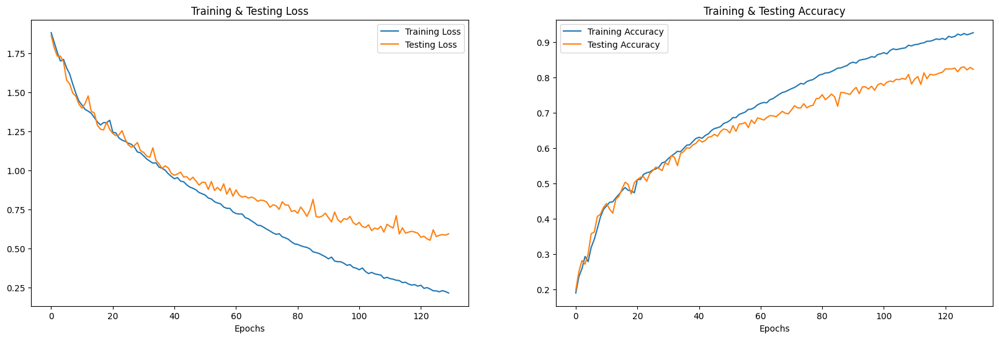

In [17]:
print("Accuracy of our model on test data : " , model000.evaluate(x_testcnn, y_test)[1]*100 , "%")
epochs = [i for i in range(130)]
fig , ax = plt.subplots(1,2)
train_acc = hist1.history['accuracy']
train_loss = hist1.history['loss']
test_acc = hist1.history['val_accuracy']
test_loss = hist1.history['val_loss']

fig.set_size_inches(20,6)
ax[0].plot(epochs , train_loss , label = 'Training Loss')
ax[0].plot(epochs , test_loss , label = 'Testing Loss')
ax[0].set_title('Training & Testing Loss')
ax[0].legend()
ax[0].set_xlabel("Epochs")

ax[1].plot(epochs , train_acc , label = 'Training Accuracy')
ax[1].plot(epochs , test_acc , label = 'Testing Accuracy')
ax[1].set_title('Training & Testing Accuracy')
ax[1].legend()
ax[1].set_xlabel("Epochs")
plt.show()